In [1]:
!pip install -r ../../requirements.txt

You should consider upgrading via the 'c:\users\falchetto\appdata\local\programs\python\python39\python.exe -m pip install --upgrade pip' command.


# Configuration

In [2]:
ROOT_DIR = "../../"
DATA_DIR = ROOT_DIR + "data/"

DATASET_2016_10a_FILENAME = DATA_DIR + "RML2016.10a_dict.pkl"

NN_NAME = 'FreeHandV3'

DEFAULT_CONFIG_FILENAME = ROOT_DIR + "default.ini"

In [3]:
import configparser

config = configparser.ConfigParser()
config.read(DEFAULT_CONFIG_FILENAME)

NEURAL_NETWORK_NAME = config.get('NeuralNetworkNames', NN_NAME)
NEURAL_NETWORK_FILENAME = NEURAL_NETWORK_NAME + '.wts.h5'

TRAINING_SET_DIMENSION = config.getfloat('TrainingValues', 'TrainingSetSplitPercentage')
DROPOUT_RATE = config.getfloat('TrainingValues', 'DropoutRate')

# Set up some params 
NB_EPOCH = config.getint('TrainingValues', 'Epochs') # number of epochs to train on
BATCH_SIZE = config.getint('TrainingValues', 'BatchSize') # training batch size

# Imports

In [4]:
import sys
sys.path.append(ROOT_DIR)

import neural_networks
import datasetlib
import traintestsplitlib
import trainlib
import evaluationlib
import dataaugmentationlib

import math

# Dataset

## Dataset in a pandas Dataframe

In [5]:
dataset_df = datasetlib.load_dataset_dataframe(DATASET_2016_10a_FILENAME)

## Raw dataset

In [6]:
dataset_df

,IQ signals,Modulation_Label,SNR
0,"[[-0.0059014712, -0.0023458179, -0.00074506126...",QPSK,2
1,"[[0.0050326153, 0.00094379985, -0.0018932355, ...",QPSK,2
2,"[[0.0052390713, 0.0073890695, 0.007276459, 0.0...",QPSK,2
3,"[[-0.0019859935, -0.0071501383, -0.00527185, -...",QPSK,2
4,"[[0.006674405, 0.0028359746, 0.005630027, 0.00...",QPSK,2
...,...,...,...
219995,"[[0.0062732296, -0.0050519477, 0.006672171, 0....",BPSK,-18
219996,"[[-0.003903181, -0.0015884301, -0.00633375, 2....",BPSK,-18
219997,"[[-0.0105958255, 0.005601244, -0.012161784, 0....",BPSK,-18
219998,"[[-0.002136606, 0.00995837, 0.0059440527, -0.0...",BPSK,-18


# Neural network

## Configuration

In [7]:
config = configparser.ConfigParser()
config.read(DEFAULT_CONFIG_FILENAME)

NEURAL_NETWORK_NAME = config.get('NeuralNetworkNames', NN_NAME)
NEURAL_NETWORK_FILENAME = NEURAL_NETWORK_NAME + '.wts.h5'

TRAINING_SET_DIMENSION = config.getfloat('TrainingValues', 'TrainingSetSplitPercentage')
DROPOUT_RATE = config.getfloat('TrainingValues', 'DropoutRate')

# Set up some params 
NB_EPOCH = config.getint('TrainingValues', 'Epochs') # number of epochs to train on
BATCH_SIZE = config.getint('TrainingValues', 'BatchSize') # training batch size

THETA = math.pi/2
STANDARD_DEVIATION = 0.0005

## Data prepare

In [8]:
signals = datasetlib.signals(dataset_df)
labels = datasetlib.labels(dataset_df)

# [QPSQ, BPSK, ...]
mods = datasetlib.mods(dataset_df)
# [-18, -16, ...]
snrs = datasetlib.unique_snrs(dataset_df)

### Training and Test data partitioning

In [9]:
n_elements = len(signals)
training_set_percentage = TRAINING_SET_DIMENSION

train_index, test_index = traintestsplitlib.train_test_random_indexes(n_elements, training_set_percentage)

X_train, X_test, Y_train, Y_test = traintestsplitlib.split_x_y_train_test(signals, labels, mods, train_index, test_index)

X_train, Y_train = dataaugmentationlib.rotate_flip_add_gaussian_noise_and_concatenate_with_signals(X_train, Y_train)

## Build the Neural Network

In [10]:
in_shp = list(X_train.shape[1:])
print(X_train.shape)
print(in_shp)
classes = mods

(1485000, 2, 128)
[2, 128]


In [11]:
model = neural_networks.freehand_v3(in_shp)

model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 2, 128)]          0         
_________________________________________________________________
reshape (Reshape)            (None, 2, 128, 1)         0         
_________________________________________________________________
batch_normalization (BatchNo (None, 2, 128, 1)         4         
_________________________________________________________________
conv2d (Conv2D)              (None, 2, 128, 16)        272       
_________________________________________________________________
batch_normalization_1 (Batch (None, 2, 128, 16)        64        
_________________________________________________________________
dense (Dense)                (None, 2, 128, 256)       4352      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 2, 128, 32)        32800 

### Train the model

In [12]:
# perform training ...
#   - call the main training loop in keras for our network+dataset
filepath = NEURAL_NETWORK_FILENAME

history, model = trainlib.train(filepath, model, X_train, Y_train, X_test, Y_test, BATCH_SIZE, NB_EPOCH)

Epoch 1/100


   1/1306 [..............................] - ETA: 5:09:41 - loss: 2.9110

   2/1306 [..............................] - ETA: 1:26 - loss: 2.8949   

   3/1306 [..............................] - ETA: 1:25 - loss: 2.8745



   4/1306 [..............................] - ETA: 1:26 - loss: 2.8545

   5/1306 [..............................] - ETA: 1:26 - loss: 2.8366

   6/1306 [..............................] - ETA: 1:26 - loss: 2.8189

   7/1306 [..............................] - ETA: 1:26 - loss: 2.8016

   8/1306 [..............................] - ETA: 1:26 - loss: 2.7851

   9/1306 [..............................] - ETA: 1:26 - loss: 2.7688

  10/1306 [..............................] - ETA: 1:26 - loss: 2.7533

  11/1306 [..............................] - ETA: 1:26 - loss: 2.7386



  12/1306 [..............................] - ETA: 1:26 - loss: 2.7245

  13/1306 [..............................] - ETA: 1:26 - loss: 2.7108

  14/1306 [..............................] - ETA: 1:26 - loss: 2.6978

  15/1306 [..............................] - ETA: 1:26 - loss: 2.6852

  16/1306 [..............................] - ETA: 1:26 - loss: 2.6730

  17/1306 [..............................] - ETA: 1:26 - loss: 2.6612

  18/1306 [..............................] - ETA: 1:26 - loss: 2.6499

  19/1306 [..............................] - ETA: 1:26 - loss: 2.6389

  20/1306 [..............................] - ETA: 1:26 - loss: 2.6283

  21/1306 [..............................] - ETA: 1:26 - loss: 2.6181

  22/1306 [..............................] - ETA: 1:26 - loss: 2.6084

  23/1306 [..............................] - ETA: 1:25 - loss: 2.5989

  24/1306 [..............................] - ETA: 1:25 - loss: 2.5898

  25/1306 [..............................] - ETA: 1:25 - loss: 2.5809

  26/1306 [..............................] - ETA: 1:25 - loss: 2.5723

  27/1306 [..............................] - ETA: 1:25 - loss: 2.5639

  28/1306 [..............................] - ETA: 1:25 - loss: 2.5557

  29/1306 [..............................] - ETA: 1:25 - loss: 2.5477

  30/1306 [..............................] - ETA: 1:25 - loss: 2.5398

  31/1306 [..............................] - ETA: 1:25 - loss: 2.5322

  32/1306 [..............................] - ETA: 1:25 - loss: 2.5246

  33/1306 [..............................] - ETA: 1:25 - loss: 2.5173

  34/1306 [..............................] - ETA: 1:25 - loss: 2.5101

  35/1306 [..............................] - ETA: 1:24 - loss: 2.5030

  36/1306 [..............................] - ETA: 1:24 - loss: 2.4961

  37/1306 [..............................] - ETA: 1:24 - loss: 2.4892

  38/1306 [..............................] - ETA: 1:24 - loss: 2.4825

  39/1306 [..............................] - ETA: 1:24 - loss: 2.4758

  40/1306 [..............................] - ETA: 1:24 - loss: 2.4693

  41/1306 [..............................] - ETA: 1:24 - loss: 2.4629

  42/1306 [..............................] - ETA: 1:24 - loss: 2.4566

  43/1306 [..............................] - ETA: 1:24 - loss: 2.4503

  44/1306 [>.............................] - ETA: 1:24 - loss: 2.4441

  45/1306 [>.............................] - ETA: 1:24 - loss: 2.4380

  46/1306 [>.............................] - ETA: 1:24 - loss: 2.4320

  47/1306 [>.............................] - ETA: 1:24 - loss: 2.4261

  48/1306 [>.............................] - ETA: 1:23 - loss: 2.4203

  49/1306 [>.............................] - ETA: 1:23 - loss: 2.4145

  50/1306 [>.............................]

 - ETA: 1:23 - loss: 2.4088

  51/1306 [>.............................] - ETA: 1:23 - loss: 2.4032

  52/1306 [>.............................] - ETA: 1:23 - loss: 2.3977

  53/1306 [>.............................] - ETA: 1:23 - loss: 2.3922

  54/1306 [>.............................] - ETA: 1:23 - loss: 2.3868



  55/1306 [>.............................] - ETA: 1:23 - loss: 2.3815

  56/1306 [>.............................] - ETA: 1:23 - loss: 2.3762

  57/1306 [>.............................] - ETA: 1:23 - loss: 2.3709

  58/1306 [>.............................] - ETA: 1:23 - loss: 2.3658



  59/1306 [>.............................] - ETA: 1:23 - loss: 2.3607

  60/1306 [>.............................] - ETA: 1:23 - loss: 2.3556

  61/1306 [>.............................] - ETA: 1:23 - loss: 2.3506

  62/1306 [>.............................] - ETA: 1:23 - loss: 2.3456

  63/1306 [>.............................] - ETA: 1:23 - loss: 2.3407

  64/1306 [>.............................] - ETA: 1:23 - loss: 2.3358

  65/1306 [>.............................] - ETA: 1:22 - loss: 2.3310

  66/1306 [>.............................] - ETA: 1:22 - loss: 2.3263

  67/1306 [>.............................] - ETA: 1:22 - loss: 2.3215

  68/1306 [>.............................] - ETA: 1:22 - loss: 2.3169

  69/1306 [>.............................] - ETA: 1:22 - loss: 2.3123

  70/1306 [>.............................] - ETA: 1:22 - loss: 2.3077

  71/1306 [>.............................] - ETA: 1:22 - loss: 2.3031

  72/1306 [>.............................] - ETA: 1:22 - loss: 2.2987

  73/1306 [>.............................] - ETA: 1:22 - loss: 2.2942

  74/1306 [>.............................] - ETA: 1:22 - loss: 2.2898

  75/1306 [>.............................] - ETA: 1:22 - loss: 2.2855

  76/1306 [>.............................] - ETA: 1:22 - loss: 2.2812

  77/1306 [>.............................] - ETA: 1:22 - loss: 2.2769

  78/1306 [>.............................] - ETA: 1:22 - loss: 2.2727

  79/1306 [>.............................] - ETA: 1:21 - loss: 2.2685

  80/1306 [>.............................] - ETA: 1:21 - loss: 2.2644



  81/1306 [>.............................] - ETA: 1:21 - loss: 2.2603

  82/1306 [>.............................] - ETA: 1:21 - loss: 2.2562

  83/1306 [>.............................] - ETA: 1:21 - loss: 2.2522

  84/1306 [>.............................] - ETA: 1:21 - loss: 2.2482

  85/1306 [>.............................] - ETA: 1:21 - loss: 2.2443

  86/1306 [>.............................] - ETA: 1:21 - loss: 2.2404

  87/1306 [>.............................] - ETA: 1:21 - loss: 2.2365

  88/1306 [=>............................] - ETA: 1:21 - loss: 2.2327

  89/1306 [=>............................] - ETA: 1:21 - loss: 2.2289

  90/1306 [=>............................] - ETA: 1:21 - loss: 2.2251

  91/1306 [=>............................] - ETA: 1:21 - loss: 2.2214

  92/1306 [=>............................] - ETA: 1:21 - loss: 2.2177

  93/1306 [=>............................] - ETA: 1:21 - loss: 2.2141

  94/1306 [=>............................] - ETA: 1:20 - loss: 2.2105



  95/1306 [=>............................] - ETA: 1:20 - loss: 2.2069

  96/1306 [=>............................] - ETA: 1:20 - loss: 2.2034

  97/1306 [=>............................] - ETA: 1:20 - loss: 2.1998

  98/1306 [=>............................] - ETA: 1:20 - loss: 2.1963

  99/1306 [=>............................] - ETA: 1:20 - loss: 2.1929

 100/1306 [=>............................] - ETA: 1:20 - loss: 2.1895

 101/1306 [=>............................] - ETA: 1:20 - loss: 2.1861

 102/1306 [=>............................] - ETA: 1:20 - loss: 2.1827

 103/1306 [=>............................] - ETA: 1:20 - loss: 2.1794

 104/1306 [=>............................] - ETA: 1:20 - loss: 2.1761

 105/1306 [=>............................] - ETA: 1:20 - loss: 2.1728

 106/1306 [=>............................] - ETA: 1:20 - loss: 2.1696

 107/1306 [=>............................] - ETA: 1:20 - loss: 2.1664

 108/1306 [=>............................] - ETA: 1:20 - loss: 2.1632

 109/1306 [=>............................] - ETA: 1:19 - loss: 2.1600

 110/1306 [=>............................] - ETA: 1:19 - loss: 2.1569

 111/1306 [=>............................] - ETA: 1:19 - loss: 2.1538

 112/1306 [=>............................] - ETA: 1:19 - loss: 2.1507

 113/1306 [=>............................] - ETA: 1:19 - loss: 2.1477

 114/1306 [=>............................] - ETA: 1:19 - loss: 2.1446

 115/1306 [=>............................] - ETA: 1:19 - loss: 2.1416

 116/1306 [=>............................] - ETA: 1:19 - loss: 2.1387

 117/1306 [=>............................] - ETA: 1:19 - loss: 2.1357

 118/1306 [=>............................] - ETA: 1:19 - loss: 2.1328

 119/1306 [=>............................] - ETA: 1:19 - loss: 2.1299

 120/1306 [=>............................] - ETA: 1:19 - loss: 2.1270

 121/1306 [=>............................] - ETA: 1:19 - loss: 2.1242

 122/1306 [=>............................] - ETA: 1:19 - loss: 2.1214

 123/1306 [=>............................] - ETA: 1:18 - loss: 2.1185

 124/1306 [=>............................] - ETA: 1:18 - loss: 2.1158

 125/1306 [=>............................] - ETA: 1:18 - loss: 2.1130

 126/1306 [=>............................] - ETA: 1:18 - loss: 2.1103

 127/1306 [=>............................] - ETA: 1:18 - loss: 2.1076

 128/1306 [=>............................] - ETA: 1:18 - loss: 2.1049

 129/1306 [=>............................] - ETA: 1:18 - loss: 2.1022

 130/1306 [=>............................] - ETA: 1:18 - loss: 2.0996

 131/1306 [==>...........................] - ETA: 1:18 - loss: 2.0969

 132/1306 [==>...........................] - ETA: 1:18 - loss: 2.0943

 133/1306 [==>...........................] - ETA: 1:18 - loss: 2.0917

 134/1306 [==>...........................] - ETA: 1:18 - loss: 2.0892

 135/1306 [==>...........................] - ETA: 1:18 - loss: 2.0866

 136/1306 [==>...........................] - ETA: 1:18 - loss: 2.0841



 137/1306 [==>...........................] - ETA: 1:18 - loss: 2.0816

 138/1306 [==>...........................] - ETA: 1:17 - loss: 2.0791

 139/1306 [==>...........................] - ETA: 1:17 - loss: 2.0766

 140/1306 [==>...........................] - ETA: 1:17 - loss: 2.0742

 141/1306 [==>...........................] - ETA: 1:17 - loss: 2.0717

 142/1306 [==>...........................] - ETA: 1:17 - loss: 2.0693

 143/1306 [==>...........................] - ETA: 1:17 - loss: 2.0669

 144/1306 [==>...........................] - ETA: 1:17 - loss: 2.0646

 145/1306 [==>...........................] - ETA: 1:17 - loss: 2.0622

 146/1306 [==>...........................] - ETA: 1:17 - loss: 2.0599

 147/1306 [==>...........................] - ETA: 1:17 - loss: 2.0575

 148/1306 [==>...........................] - ETA: 1:17 - loss: 2.0552

 149/1306 [==>...........................] - ETA: 1:17 - loss: 2.0529

 150/1306 [==>...........................] - ETA: 1:17 - loss: 2.0507

 151/1306 [==>...........................] - ETA: 1:17 - loss: 2.0484

 152/1306 [==>...........................] - ETA: 1:17 - loss: 2.0462

 153/1306 [==>...........................] - ETA: 1:16 - loss: 2.0439

 154/1306 [==>...........................] - ETA: 1:16 - loss: 2.0417

 155/1306 [==>...........................] - ETA: 1:16 - loss: 2.0395

 156/1306 [==>...........................] - ETA: 1:16 - loss: 2.0374

 157/1306 [==>...........................] - ETA: 1:16 - loss: 2.0352

 158/1306 [==>...........................] - ETA: 1:16 - loss: 2.0331

 159/1306 [==>...........................] - ETA: 1:16 - loss: 2.0309

 160/1306 [==>...........................] - ETA: 1:16 - loss: 2.0288

 161/1306 [==>...........................] - ETA: 1:16 - loss: 2.0267

 162/1306 [==>...........................] - ETA: 1:16 - loss: 2.0246

 163/1306 [==>...........................] - ETA: 1:16 - loss: 2.0226

 164/1306 [==>...........................] - ETA: 1:16 - loss: 2.0205

 165/1306 [==>...........................] - ETA: 1:16 - loss: 2.0185

 166/1306 [==>...........................] - ETA: 1:16 - loss: 2.0164

 167/1306 [==>...........................] - ETA: 1:16 - loss: 2.0144

 168/1306 [==>...........................] - ETA: 1:15 - loss: 2.0124

 169/1306 [==>...........................] - ETA: 1:15 - loss: 2.0104

 170/1306 [==>...........................] - ETA: 1:15 - loss: 2.0084

 171/1306 [==>...........................] - ETA: 1:15 - loss: 2.0065

 172/1306 [==>...........................] - ETA: 1:15 - loss: 2.0045

 173/1306 [==>...........................] - ETA: 1:15 - loss: 2.0026

 174/1306 [==>...........................] - ETA: 1:15 - loss: 2.0007

 175/1306 [===>..........................] - ETA: 1:15 - loss: 1.9988

 176/1306 [===>..........................] - ETA: 1:15 - loss: 1.9969

 177/1306 [===>..........................] - ETA: 1:15 - loss: 1.9950

 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.9931



 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.9912

 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.9894

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.9876

 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.9857

 183/1306 [===>..........................] - ETA: 1:14 - loss: 1.9839

 184/1306 [===>..........................] - ETA: 1:14 - loss: 1.9821

 185/1306 [===>..........................] - ETA: 1:14 - loss: 1.9803

 186/1306 [===>..........................] - ETA: 1:14 - loss: 1.9785

 187/1306 [===>..........................] - ETA: 1:14 - loss: 1.9768

 188/1306 [===>..........................] - ETA: 1:14 - loss: 1.9750

 189/1306 [===>..........................] - ETA: 1:14 - loss: 1.9733

 190/1306 [===>..........................] - ETA: 1:14 - loss: 1.9715

 191/1306 [===>..........................] - ETA: 1:14 - loss: 1.9698

 192/1306 [===>..........................] - ETA: 1:14 - loss: 1.9681

 193/1306 [===>..........................] - ETA: 1:14 - loss: 1.9664

 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.9647

 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.9630

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.9613

 197/1306 [===>..........................] - ETA: 1:14 - loss: 1.9597

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.9580

 199/1306 [===>..........................] - ETA: 1:13 - loss: 1.9564

 200/1306 [===>..........................] - ETA: 1:13 - loss: 1.9547

 201/1306 [===>..........................] - ETA: 1:13 - loss: 1.9531

 202/1306 [===>..........................] - ETA: 1:13 - loss: 1.9515

 203/1306 [===>..........................] - ETA: 1:13 - loss: 1.9499

 204/1306 [===>..........................] - ETA: 1:13 - loss: 1.9483

 205/1306 [===>..........................] - ETA: 1:13 - loss: 1.9467

 206/1306 [===>..........................] - ETA: 1:13 - loss: 1.9452

 207/1306 [===>..........................] - ETA: 1:13 - loss: 1.9436



 208/1306 [===>..........................] - ETA: 1:13 - loss: 1.9420



 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.9405

 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.9389

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.9374

 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.9359

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.9344

 214/1306 [===>..........................] - ETA: 1:12 - loss: 1.9329

 215/1306 [===>..........................] - ETA: 1:12 - loss: 1.9314

 216/1306 [===>..........................] - ETA: 1:12 - loss: 1.9299

 217/1306 [===>..........................] - ETA: 1:12 - loss: 1.9284

 218/1306 [====>.........................] - ETA: 1:12 - loss: 1.9269

 219/1306 [====>.........................] - ETA: 1:12 - loss: 1.9255

 220/1306 [====>.........................] - ETA: 1:12 - loss: 1.9240

 221/1306 [====>.........................] - ETA: 1:12 - loss: 1.9226

 222/1306 [====>.........................] - ETA: 1:12 - loss: 1.9211

 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.9197

 224/1306 [====>.........................] - ETA: 1:12 - loss: 1.9183

 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.9169

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.9154

 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.9140

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.9126

 229/1306 [====>.........................] - ETA: 1:11 - loss: 1.9113

 230/1306 [====>.........................] - ETA: 1:11 - loss: 1.9099

 231/1306 [====>.........................] - ETA: 1:11 - loss: 1.9085

 232/1306 [====>.........................] - ETA: 1:11 - loss: 1.9071

 233/1306 [====>.........................] - ETA: 1:11 - loss: 1.9058

 234/1306 [====>.........................] - ETA: 1:11 - loss: 1.9044

 235/1306 [====>.........................] - ETA: 1:11 - loss: 1.9031

 236/1306 [====>.........................] - ETA: 1:11 - loss: 1.9017

 237/1306 [====>.........................] - ETA: 1:11 - loss: 1.9004

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.8991

 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.8978

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.8965

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.8951

 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.8939

 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.8926

 244/1306 [====>.........................] - ETA: 1:10 - loss: 1.8913

 245/1306 [====>.........................] - ETA: 1:10 - loss: 1.8900

 246/1306 [====>.........................] - ETA: 1:10 - loss: 1.8887

 247/1306 [====>.........................] - ETA: 1:10 - loss: 1.8875

 248/1306 [====>.........................] - ETA: 1:10 - loss: 1.8862

 249/1306 [====>.........................] - ETA: 1:10 - loss: 1.8850

 250/1306 [====>.........................] - ETA: 1:10 - loss: 1.8837

 251/1306 [====>.........................] - ETA: 1:10 - loss: 1.8825

 252/1306 [====>.........................] - ETA: 1:10 - loss: 1.8813

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.8800

 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.8788

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.8776



 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.8764

 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.8752



 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.8740

 259/1306 [====>.........................] - ETA: 1:09 - loss: 1.8728

 260/1306 [====>.........................] - ETA: 1:09 - loss: 1.8716

 261/1306 [====>.........................] - ETA: 1:09 - loss: 1.8704

 262/1306 [=====>........................] - ETA: 1:09 - loss: 1.8693



 263/1306 [=====>........................] - ETA: 1:09 - loss: 1.8681

 264/1306 [=====>........................] - ETA: 1:09 - loss: 1.8669

 265/1306 [=====>........................] - ETA: 1:09 - loss: 1.8658

 266/1306 [=====>........................] - ETA: 1:09 - loss: 1.8646

 267/1306 [=====>........................] - ETA: 1:09 - loss: 1.8635

 268/1306 [=====>........................] - ETA: 1:09 - loss: 1.8623

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.8612

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.8601

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.8590

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.8578

 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.8567

 274/1306 [=====>........................] - ETA: 1:08 - loss: 1.8556



 275/1306 [=====>........................] - ETA: 1:08 - loss: 1.8545

 276/1306 [=====>........................] - ETA: 1:08 - loss: 1.8534

 277/1306 [=====>........................] - ETA: 1:08 - loss: 1.8523

 278/1306 [=====>........................] - ETA: 1:08 - loss: 1.8513



 279/1306 [=====>........................] - ETA: 1:08 - loss: 1.8502

 280/1306 [=====>........................] - ETA: 1:08 - loss: 1.8491

 281/1306 [=====>........................] - ETA: 1:08 - loss: 1.8480

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.8470

 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.8459

 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.8448

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.8438

 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.8427

 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.8417

 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.8407

 289/1306 [=====>........................] - ETA: 1:07 - loss: 1.8396

 290/1306 [=====>........................] - ETA: 1:07 - loss: 1.8386

 291/1306 [=====>........................] - ETA: 1:07 - loss: 1.8376

 292/1306 [=====>........................] - ETA: 1:07 - loss: 1.8366

 293/1306 [=====>........................] - ETA: 1:07 - loss: 1.8355

 294/1306 [=====>........................] - ETA: 1:07 - loss: 1.8345

 295/1306 [=====>........................] - ETA: 1:07 - loss: 1.8335



 296/1306 [=====>........................] - ETA: 1:07 - loss: 1.8325

 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.8315

 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.8305

 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.8295

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.8285

 301/1306 [=====>........................] - ETA: 1:07 - loss: 1.8276

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.8266

 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.8256

 304/1306 [=====>........................] - ETA: 1:06 - loss: 1.8246

 305/1306 [======>.......................] - ETA: 1:06 - loss: 1.8237

 306/1306 [======>.......................] - ETA: 1:06 - loss: 1.8227

 307/1306 [======>.......................] - ETA: 1:06 - loss: 1.8218

 308/1306 [======>.......................] - ETA: 1:06 - loss: 1.8208

 309/1306 [======>.......................] - ETA: 1:06 - loss: 1.8198

 310/1306 [======>.......................] - ETA: 1:06 - loss: 1.8189

 311/1306 [======>.......................] - ETA: 1:06 - loss: 1.8180

 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.8170

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.8161

 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.8151

 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.8142

 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.8133



 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.8124

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.8115

 319/1306 [======>.......................] - ETA: 1:05 - loss: 1.8105

 320/1306 [======>.......................] - ETA: 1:05 - loss: 1.8096

 321/1306 [======>.......................] - ETA: 1:05 - loss: 1.8087

 322/1306 [======>.......................] - ETA: 1:05 - loss: 1.8078

 323/1306 [======>.......................] - ETA: 1:05 - loss: 1.8069

 324/1306 [======>.......................] - ETA: 1:05 - loss: 1.8060

 325/1306 [======>.......................] - ETA: 1:05 - loss: 1.8052

 326/1306 [======>.......................] - ETA: 1:05 - loss: 1.8043

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.8034

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.8025

 329/1306 [======>.......................] - ETA: 1:05 - loss: 1.8016

 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.8008

 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.7999

 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.7990

 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.7982

 334/1306 [======>.......................] - ETA: 1:04 - loss: 1.7973



 335/1306 [======>.......................] - ETA: 1:04 - loss: 1.7964

 336/1306 [======>.......................] - ETA: 1:04 - loss: 1.7956

 337/1306 [======>.......................] - ETA: 1:04 - loss: 1.7947

 338/1306 [======>.......................] - ETA: 1:04 - loss: 1.7939

 339/1306 [======>.......................] - ETA: 1:04 - loss: 1.7931

 340/1306 [======>.......................] - ETA: 1:04 - loss: 1.7922

 341/1306 [======>.......................] - ETA: 1:04 - loss: 1.7914

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.7905

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.7897

 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.7889

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.7881

 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.7872

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.7864

 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.7856

 349/1306 [=======>......................] - ETA: 1:03 - loss: 1.7848

 350/1306 [=======>......................] - ETA: 1:03 - loss: 1.7840

 351/1306 [=======>......................] - ETA: 1:03 - loss: 1.7832

 352/1306 [=======>......................] - ETA: 1:03 - loss: 1.7824

 353/1306 [=======>......................] - ETA: 1:03 - loss: 1.7816

 354/1306 [=======>......................] - ETA: 1:03 - loss: 1.7808

 355/1306 [=======>......................] - ETA: 1:03 - loss: 1.7800

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.7792

 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.7784

 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.7776

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.7769



 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.7761

 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.7753

 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.7745

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.7738

 364/1306 [=======>......................] - ETA: 1:02 - loss: 1.7730

 365/1306 [=======>......................] - ETA: 1:02 - loss: 1.7722

 366/1306 [=======>......................] - ETA: 1:02 - loss: 1.7715

 367/1306 [=======>......................] - ETA: 1:02 - loss: 1.7707

 368/1306 [=======>......................] - ETA: 1:02 - loss: 1.7699

 369/1306 [=======>......................] - ETA: 1:02 - loss: 1.7692

 370/1306 [=======>......................] - ETA: 1:02 - loss: 1.7684

 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.7677

 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.7669

 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.7662

 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.7655

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.7647

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.7640

 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.7633

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.7625

 379/1306 [=======>......................] - ETA: 1:01 - loss: 1.7618

 380/1306 [=======>......................] - ETA: 1:01 - loss: 1.7611

 381/1306 [=======>......................] - ETA: 1:01 - loss: 1.7604

 382/1306 [=======>......................] - ETA: 1:01 - loss: 1.7596

 383/1306 [=======>......................] - ETA: 1:01 - loss: 1.7589

 384/1306 [=======>......................] - ETA: 1:01 - loss: 1.7582

 385/1306 [=======>......................] - ETA: 1:01 - loss: 1.7575

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.7568

 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.7561

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.7554

 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.7547

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.7540

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.7533

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.7526

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.7519

 394/1306 [========>.....................] - ETA: 1:00 - loss: 1.7512

 395/1306 [========>.....................] - ETA: 1:00 - loss: 1.7505

 396/1306 [========>.....................] - ETA: 1:00 - loss: 1.7498

 397/1306 [========>.....................] - ETA: 1:00 - loss: 1.7491

 398/1306 [========>.....................] - ETA: 1:00 - loss: 1.7484

 399/1306 [========>.....................] - ETA: 1:00 - loss: 1.7478



 400/1306 [========>.....................] - ETA: 1:00 - loss: 1.7471

 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.7464

 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.7457

 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.7451

 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.7444

 405/1306 [========>.....................] - ETA: 1:00 - loss: 1.7437

 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.7431

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.7424

 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.7417

 409/1306 [========>.....................] - ETA: 59s - loss: 1.7411 

 410/1306 [========>.....................] - ETA: 59s - loss: 1.7404

 411/1306 [========>.....................] - ETA: 59s - loss: 1.7398

 412/1306 [========>.....................] - ETA: 59s - loss: 1.7391

 413/1306 [========>.....................] - ETA: 59s - loss: 1.7385

 414/1306 [========>.....................] - ETA: 59s - loss: 1.7378

 415/1306 [========>.....................] - ETA: 59s - loss: 1.7372

 416/1306 [========>.....................] - ETA: 59s - loss: 1.7365

 417/1306 [========>.....................] - ETA: 59s - loss: 1.7359

 418/1306 [========>.....................] - ETA: 59s - loss: 1.7353

 419/1306 [========>.....................] - ETA: 59s - loss: 1.7346

 420/1306 [========>.....................] - ETA: 59s - loss: 1.7340



 421/1306 [========>.....................] - ETA: 59s - loss: 1.7334



 422/1306 [========>.....................] - ETA: 59s - loss: 1.7327

 423/1306 [========>.....................] - ETA: 59s - loss: 1.7321

 424/1306 [========>.....................] - ETA: 59s - loss: 1.7315

 425/1306 [========>.....................] - ETA: 58s - loss: 1.7309

 426/1306 [========>.....................] - ETA: 58s - loss: 1.7302

 427/1306 [========>.....................] - ETA: 58s - loss: 1.7296

 428/1306 [========>.....................] - ETA: 58s - loss: 1.7290

 429/1306 [========>.....................] - ETA: 58s - loss: 1.7284

 430/1306 [========>.....................] - ETA: 58s - loss: 1.7278

 431/1306 [========>.....................] - ETA: 58s - loss: 1.7271

 432/1306 [========>.....................] - ETA: 58s - loss: 1.7265

 433/1306 [========>.....................] - ETA: 58s - loss: 1.7259

 434/1306 [========>.....................] - ETA: 58s - loss: 1.7253

 435/1306 [========>.....................] - ETA: 58s - loss: 1.7247

 436/1306 [=========>....................] - ETA: 58s - loss: 1.7241

 437/1306 [=========>....................] - ETA: 58s - loss: 1.7235

 438/1306 [=========>....................] - ETA: 58s - loss: 1.7229

 439/1306 [=========>....................] - ETA: 58s - loss: 1.7223

 440/1306 [=========>....................] - ETA: 57s - loss: 1.7217

 441/1306 [=========>....................] - ETA: 57s - loss: 1.7211

 442/1306 [=========>....................] - ETA: 57s - loss: 1.7205

 443/1306 [=========>....................] - ETA: 57s - loss: 1.7199

 444/1306 [=========>....................] - ETA: 57s - loss: 1.7193

 445/1306 [=========>....................] - ETA: 57s - loss: 1.7188

 446/1306 [=========>....................] - ETA: 57s - loss: 1.7182

 447/1306 [=========>....................] - ETA: 57s - loss: 1.7176

 448/1306 [=========>....................] - ETA: 57s - loss: 1.7170



 449/1306 [=========>....................] - ETA: 57s - loss: 1.7164

 450/1306 [=========>....................] - ETA: 57s - loss: 1.7159

 451/1306 [=========>....................] - ETA: 57s - loss: 1.7153

 452/1306 [=========>....................] - ETA: 57s - loss: 1.7147

 453/1306 [=========>....................] - ETA: 57s - loss: 1.7141

 454/1306 [=========>....................] - ETA: 56s - loss: 1.7136

 455/1306 [=========>....................] - ETA: 56s - loss: 1.7130

 456/1306 [=========>....................] - ETA: 56s - loss: 1.7124

 457/1306 [=========>....................] - ETA: 56s - loss: 1.7118

 458/1306 [=========>....................] - ETA: 56s - loss: 1.7113



 459/1306 [=========>....................] - ETA: 56s - loss: 1.7107

 460/1306 [=========>....................] - ETA: 56s - loss: 1.7102

 461/1306 [=========>....................] - ETA: 56s - loss: 1.7096

 462/1306 [=========>....................] - ETA: 56s - loss: 1.7090

 463/1306 [=========>....................] - ETA: 56s - loss: 1.7085

 464/1306 [=========>....................] - ETA: 56s - loss: 1.7079

 465/1306 [=========>....................] - ETA: 56s - loss: 1.7074

 466/1306 [=========>....................] - ETA: 56s - loss: 1.7068

 467/1306 [=========>....................] - ETA: 56s - loss: 1.7063

 468/1306 [=========>....................] - ETA: 56s - loss: 1.7057

 469/1306 [=========>....................] - ETA: 56s - loss: 1.7052

 470/1306 [=========>....................] - ETA: 55s - loss: 1.7046

 471/1306 [=========>....................] - ETA: 55s - loss: 1.7041

 472/1306 [=========>....................] - ETA: 55s - loss: 1.7035

 473/1306 [=========>....................] - ETA: 55s - loss: 1.7030

 474/1306 [=========>....................] - ETA: 55s - loss: 1.7025

 475/1306 [=========>....................] - ETA: 55s - loss: 1.7019

 476/1306 [=========>....................] - ETA: 55s - loss: 1.7014

 477/1306 [=========>....................] - ETA: 55s - loss: 1.7008

 478/1306 [=========>....................] - ETA: 55s - loss: 1.7003

 479/1306 [==========>...................] - ETA: 55s - loss: 1.6998

 480/1306 [==========>...................] - ETA: 55s - loss: 1.6992

 481/1306 [==========>...................] - ETA: 55s - loss: 1.6987

 482/1306 [==========>...................] - ETA: 55s - loss: 1.6982

 483/1306 [==========>...................] - ETA: 55s - loss: 1.6977

 484/1306 [==========>...................] - ETA: 55s - loss: 1.6971

 485/1306 [==========>...................] - ETA: 54s - loss: 1.6966

 486/1306 [==========>...................] - ETA: 54s - loss: 1.6961

 487/1306 [==========>...................] - ETA: 54s - loss: 1.6956

 488/1306 [==========>...................] - ETA: 54s - loss: 1.6950

 489/1306 [==========>...................] - ETA: 54s - loss: 1.6945

 490/1306 [==========>...................] - ETA: 54s - loss: 1.6940

 491/1306 [==========>...................] - ETA: 54s - loss: 1.6935

 492/1306 [==========>...................] - ETA: 54s - loss: 1.6930

 493/1306 [==========>...................] - ETA: 54s - loss: 1.6925

 494/1306 [==========>...................] - ETA: 54s - loss: 1.6920

 495/1306 [==========>...................] - ETA: 54s - loss: 1.6914

 496/1306 [==========>...................] - ETA: 54s - loss: 1.6909

 497/1306 [==========>...................] - ETA: 54s - loss: 1.6904

 498/1306 [==========>...................] - ETA: 54s - loss: 1.6899

 499/1306 [==========>...................] - ETA: 54s - loss: 1.6894

 500/1306 [==========>...................] - ETA: 53s - loss: 1.6889

 501/1306 [==========>...................] - ETA: 53s - loss: 1.6884

 502/1306 [==========>...................] - ETA: 53s - loss: 1.6879

 503/1306 [==========>...................] - ETA: 53s - loss: 1.6874

 504/1306 [==========>...................] - ETA: 53s - loss: 1.6869

 505/1306 [==========>...................] - ETA: 53s - loss: 1.6864

 506/1306 [==========>...................] - ETA: 53s - loss: 1.6859

 507/1306 [==========>...................] - ETA: 53s - loss: 1.6854

 508/1306 [==========>...................] - ETA: 53s - loss: 1.6849

 509/1306 [==========>...................] - ETA: 53s - loss: 1.6844

 510/1306 [==========>...................] - ETA: 53s - loss: 1.6839

 511/1306 [==========>...................] - ETA: 53s - loss: 1.6835

 512/1306 [==========>...................] - ETA: 53s - loss: 1.6830

 513/1306 [==========>...................] - ETA: 53s - loss: 1.6825

 514/1306 [==========>...................] - ETA: 52s - loss: 1.6820

 515/1306 [==========>...................] - ETA: 52s - loss: 1.6815

 516/1306 [==========>...................] - ETA: 52s - loss: 1.6810

 517/1306 [==========>...................] - ETA: 52s - loss: 1.6805



 518/1306 [==========>...................] - ETA: 52s - loss: 1.6801

 519/1306 [==========>...................] - ETA: 52s - loss: 1.6796

 520/1306 [==========>...................] - ETA: 52s - loss: 1.6791

 521/1306 [==========>...................] - ETA: 52s - loss: 1.6786

 522/1306 [==========>...................] - ETA: 52s - loss: 1.6782

 523/1306 [===========>..................] - ETA: 52s - loss: 1.6777

 524/1306 [===========>..................] - ETA: 52s - loss: 1.6772

 525/1306 [===========>..................] - ETA: 52s - loss: 1.6767

 526/1306 [===========>..................] - ETA: 52s - loss: 1.6763

 527/1306 [===========>..................] - ETA: 52s - loss: 1.6758

 528/1306 [===========>..................] - ETA: 52s - loss: 1.6753

 529/1306 [===========>..................] - ETA: 51s - loss: 1.6749

 530/1306 [===========>..................] - ETA: 51s - loss: 1.6744

 531/1306 [===========>..................] - ETA: 51s - loss: 1.6739

 532/1306 [===========>..................] - ETA: 51s - loss: 1.6735

 533/1306 [===========>..................] - ETA: 51s - loss: 1.6730

 534/1306 [===========>..................] - ETA: 51s - loss: 1.6725

 535/1306 [===========>..................] - ETA: 51s - loss: 1.6721

 536/1306 [===========>..................] - ETA: 51s - loss: 1.6716

 537/1306 [===========>..................] - ETA: 51s - loss: 1.6712

 538/1306 [===========>..................] - ETA: 51s - loss: 1.6707

 539/1306 [===========>..................] - ETA: 51s - loss: 1.6703

 540/1306 [===========>..................] - ETA: 51s - loss: 1.6698

 541/1306 [===========>..................] - ETA: 51s - loss: 1.6694

 542/1306 [===========>..................] - ETA: 51s - loss: 1.6689

 543/1306 [===========>..................] - ETA: 51s - loss: 1.6684

 544/1306 [===========>..................] - ETA: 50s - loss: 1.6680

 545/1306 [===========>..................] - ETA: 50s - loss: 1.6676

 546/1306 [===========>..................] - ETA: 50s - loss: 1.6671

 547/1306 [===========>..................] - ETA: 50s - loss: 1.6667

 548/1306 [===========>..................] - ETA: 50s - loss: 1.6662

 549/1306 [===========>..................] - ETA: 50s - loss: 1.6658

 550/1306 [===========>..................] - ETA: 50s - loss: 1.6653

 551/1306 [===========>..................] - ETA: 50s - loss: 1.6649

 552/1306 [===========>..................] - ETA: 50s - loss: 1.6644

 553/1306 [===========>..................] - ETA: 50s - loss: 1.6640

 554/1306 [===========>..................] - ETA: 50s - loss: 1.6636

 555/1306 [===========>..................] - ETA: 50s - loss: 1.6631

 556/1306 [===========>..................] - ETA: 50s - loss: 1.6627

 557/1306 [===========>..................] - ETA: 50s - loss: 1.6623

 558/1306 [===========>..................] - ETA: 50s - loss: 1.6618

 559/1306 [===========>..................] - ETA: 49s - loss: 1.6614

 560/1306 [===========>..................] - ETA: 49s - loss: 1.6610

 561/1306 [===========>..................] - ETA: 49s - loss: 1.6605

 562/1306 [===========>..................] - ETA: 49s - loss: 1.6601

 563/1306 [===========>..................] - ETA: 49s - loss: 1.6597

 564/1306 [===========>..................] - ETA: 49s - loss: 1.6592

 565/1306 [===========>..................] - ETA: 49s - loss: 1.6588

 566/1306 [============>.................] - ETA: 49s - loss: 1.6584

 567/1306 [============>.................] - ETA: 49s - loss: 1.6580

 568/1306 [============>.................] - ETA: 49s - loss: 1.6575

 569/1306 [============>.................] - ETA: 49s - loss: 1.6571

 570/1306 [============>.................] - ETA: 49s - loss: 1.6567

 571/1306 [============>.................] - ETA: 49s - loss: 1.6563

 572/1306 [============>.................] - ETA: 49s - loss: 1.6559

 573/1306 [============>.................] - ETA: 49s - loss: 1.6554

 574/1306 [============>.................] - ETA: 48s - loss: 1.6550

 575/1306 [============>.................] - ETA: 48s - loss: 1.6546

 576/1306 [============>.................] - ETA: 48s - loss: 1.6542

 577/1306 [============>.................] - ETA: 48s - loss: 1.6538

 578/1306 [============>.................] - ETA: 48s - loss: 1.6534

 579/1306 [============>.................] - ETA: 48s - loss: 1.6530

 580/1306 [============>.................] - ETA: 48s - loss: 1.6525

 581/1306 [============>.................] - ETA: 48s - loss: 1.6521



 582/1306 [============>.................] - ETA: 48s - loss: 1.6517

 583/1306 [============>.................] - ETA: 48s - loss: 1.6513



 584/1306 [============>.................] - ETA: 48s - loss: 1.6509

 585/1306 [============>.................] - ETA: 48s - loss: 1.6505

 586/1306 [============>.................] - ETA: 48s - loss: 1.6501

 587/1306 [============>.................] - ETA: 48s - loss: 1.6497



 588/1306 [============>.................] - ETA: 48s - loss: 1.6493

 589/1306 [============>.................] - ETA: 47s - loss: 1.6489

 590/1306 [============>.................] - ETA: 47s - loss: 1.6485

 591/1306 [============>.................] - ETA: 47s - loss: 1.6481

 592/1306 [============>.................] - ETA: 47s - loss: 1.6477

 593/1306 [============>.................] - ETA: 47s - loss: 1.6473

 594/1306 [============>.................] - ETA: 47s - loss: 1.6469

 595/1306 [============>.................] - ETA: 47s - loss: 1.6465



 596/1306 [============>.................] - ETA: 47s - loss: 1.6461

 597/1306 [============>.................] - ETA: 47s - loss: 1.6457

 598/1306 [============>.................] - ETA: 47s - loss: 1.6453

 599/1306 [============>.................] - ETA: 47s - loss: 1.6449

 600/1306 [============>.................] - ETA: 47s - loss: 1.6445

 601/1306 [============>.................] - ETA: 47s - loss: 1.6441

 602/1306 [============>.................] - ETA: 47s - loss: 1.6437

 603/1306 [============>.................] - ETA: 47s - loss: 1.6433

 604/1306 [============>.................] - ETA: 46s - loss: 1.6429

 605/1306 [============>.................] - ETA: 46s - loss: 1.6426

 606/1306 [============>.................] - ETA: 46s - loss: 1.6422

 607/1306 [============>.................] - ETA: 46s - loss: 1.6418

 608/1306 [============>.................] - ETA: 46s - loss: 1.6414

 609/1306 [============>.................] - ETA: 46s - loss: 1.6410

 610/1306 [=============>................] - ETA: 46s - loss: 1.6406

 611/1306 [=============>................] - ETA: 46s - loss: 1.6402

 612/1306 [=============>................] - ETA: 46s - loss: 1.6399

 613/1306 [=============>................] - ETA: 46s - loss: 1.6395

 614/1306 [=============>................] - ETA: 46s - loss: 1.6391

 615/1306 [=============>................] - ETA: 46s - loss: 1.6387



 616/1306 [=============>................] - ETA: 46s - loss: 1.6383

 617/1306 [=============>................] - ETA: 46s - loss: 1.6380

 618/1306 [=============>................] - ETA: 46s - loss: 1.6376

 619/1306 [=============>................] - ETA: 45s - loss: 1.6372

 620/1306 [=============>................] - ETA: 45s - loss: 1.6368

 621/1306 [=============>................] - ETA: 45s - loss: 1.6365

 622/1306 [=============>................] - ETA: 45s - loss: 1.6361

 623/1306 [=============>................] - ETA: 45s - loss: 1.6357

 624/1306 [=============>................] - ETA: 45s - loss: 1.6353

 625/1306 [=============>................] - ETA: 45s - loss: 1.6350

 626/1306 [=============>................] - ETA: 45s - loss: 1.6346

 627/1306 [=============>................] - ETA: 45s - loss: 1.6342

 628/1306 [=============>................] - ETA: 45s - loss: 1.6339



 629/1306 [=============>................] - ETA: 45s - loss: 1.6335

 630/1306 [=============>................] - ETA: 45s - loss: 1.6331

 631/1306 [=============>................] - ETA: 45s - loss: 1.6328

 632/1306 [=============>................] - ETA: 45s - loss: 1.6324

 633/1306 [=============>................] - ETA: 45s - loss: 1.6320

 634/1306 [=============>................] - ETA: 44s - loss: 1.6317

 635/1306 [=============>................] - ETA: 44s - loss: 1.6313

 636/1306 [=============>................] - ETA: 44s - loss: 1.6309

 637/1306 [=============>................] - ETA: 44s - loss: 1.6306

 638/1306 [=============>................] - ETA: 44s - loss: 1.6302



 639/1306 [=============>................] - ETA: 44s - loss: 1.6298

 640/1306 [=============>................] - ETA: 44s - loss: 1.6295

 641/1306 [=============>................] - ETA: 44s - loss: 1.6291

 642/1306 [=============>................] - ETA: 44s - loss: 1.6288

 643/1306 [=============>................] - ETA: 44s - loss: 1.6284

 644/1306 [=============>................] - ETA: 44s - loss: 1.6281

 645/1306 [=============>................] - ETA: 44s - loss: 1.6277

 646/1306 [=============>................] - ETA: 44s - loss: 1.6273

 647/1306 [=============>................] - ETA: 44s - loss: 1.6270

 648/1306 [=============>................] - ETA: 44s - loss: 1.6266

 649/1306 [=============>................] - ETA: 43s - loss: 1.6263



 650/1306 [=============>................] - ETA: 43s - loss: 1.6259

 651/1306 [=============>................] - ETA: 43s - loss: 1.6256

 652/1306 [=============>................] - ETA: 43s - loss: 1.6252

 653/1306 [==============>...............] - ETA: 43s - loss: 1.6249

 654/1306 [==============>...............] - ETA: 43s - loss: 1.6245

 655/1306 [==============>...............] - ETA: 43s - loss: 1.6242

 656/1306 [==============>...............] - ETA: 43s - loss: 1.6238

 657/1306 [==============>...............] - ETA: 43s - loss: 1.6235

 658/1306 [==============>...............] - ETA: 43s - loss: 1.6231

 659/1306 [==============>...............] - ETA: 43s - loss: 1.6228

 660/1306 [==============>...............] - ETA: 43s - loss: 1.6225

 661/1306 [==============>...............] - ETA: 43s - loss: 1.6221

 662/1306 [==============>...............] - ETA: 43s - loss: 1.6218

 663/1306 [==============>...............] - ETA: 43s - loss: 1.6214

 664/1306 [==============>...............] - ETA: 42s - loss: 1.6211

 665/1306 [==============>...............] - ETA: 42s - loss: 1.6207

 666/1306 [==============>...............] - ETA: 42s - loss: 1.6204

 667/1306 [==============>...............] - ETA: 42s - loss: 1.6201

 668/1306 [==============>...............] - ETA: 42s - loss: 1.6197

 669/1306 [==============>...............] - ETA: 42s - loss: 1.6194

 670/1306 [==============>...............] - ETA: 42s - loss: 1.6190

 671/1306 [==============>...............] - ETA: 42s - loss: 1.6187

 672/1306 [==============>...............] - ETA: 42s - loss: 1.6184

 673/1306 [==============>...............] - ETA: 42s - loss: 1.6180

 674/1306 [==============>...............] - ETA: 42s - loss: 1.6177

 675/1306 [==============>...............] - ETA: 42s - loss: 1.6174

 676/1306 [==============>...............] - ETA: 42s - loss: 1.6170

 677/1306 [==============>...............] - ETA: 42s - loss: 1.6167

 678/1306 [==============>...............] - ETA: 42s - loss: 1.6164

 679/1306 [==============>...............] - ETA: 41s - loss: 1.6160

 680/1306 [==============>...............] - ETA: 41s - loss: 1.6157

 681/1306 [==============>...............] - ETA: 41s - loss: 1.6154



 682/1306 [==============>...............] - ETA: 41s - loss: 1.6150

 683/1306 [==============>...............] - ETA: 41s - loss: 1.6147

 684/1306 [==============>...............] - ETA: 41s - loss: 1.6144

 685/1306 [==============>...............] - ETA: 41s - loss: 1.6141

 686/1306 [==============>...............] - ETA: 41s - loss: 1.6137

 687/1306 [==============>...............] - ETA: 41s - loss: 1.6134

 688/1306 [==============>...............] - ETA: 41s - loss: 1.6131

 689/1306 [==============>...............]

 - ETA: 41s - loss: 1.6128

 690/1306 [==============>...............] - ETA: 41s - loss: 1.6124

 691/1306 [==============>...............] - ETA: 41s - loss: 1.6121

 692/1306 [==============>...............] - ETA: 41s - loss: 1.6118

 693/1306 [==============>...............] - ETA: 41s - loss: 1.6115

 694/1306 [==============>...............] - ETA: 40s - loss: 1.6111

 695/1306 [==============>...............] - ETA: 40s - loss: 1.6108

 696/1306 [==============>...............] - ETA: 40s - loss: 1.6105

 697/1306 [===============>..............] - ETA: 40s - loss: 1.6102

 698/1306 [===============>..............] - ETA: 40s - loss: 1.6099

 699/1306 [===============>..............] - ETA: 40s - loss: 1.6095

 700/1306 [===============>..............] - ETA: 40s - loss: 1.6092

 701/1306 [===============>..............] - ETA: 40s - loss: 1.6089



 702/1306 [===============>..............] - ETA: 40s - loss: 1.6086

 703/1306 [===============>..............] - ETA: 40s - loss: 1.6083

 704/1306 [===============>..............] - ETA: 40s - loss: 1.6080

 705/1306 [===============>..............] - ETA: 40s - loss: 1.6076

 706/1306 [===============>..............] - ETA: 40s - loss: 1.6073

 707/1306 [===============>..............] - ETA: 40s - loss: 1.6070

 708/1306 [===============>..............] - ETA: 40s - loss: 1.6067

 709/1306 [===============>..............]

 - ETA: 39s - loss: 1.6064

 710/1306 [===============>..............] - ETA: 39s - loss: 1.6061

 711/1306 [===============>..............] - ETA: 39s - loss: 1.6058

 712/1306 [===============>..............] - ETA: 39s - loss: 1.6055

 713/1306 [===============>..............] - ETA: 39s - loss: 1.6051

 714/1306 [===============>..............] - ETA: 39s - loss: 1.6048

 715/1306 [===============>..............] - ETA: 39s - loss: 1.6045

 716/1306 [===============>..............] - ETA: 39s - loss: 1.6042

 717/1306 [===============>..............] - ETA: 39s - loss: 1.6039

 718/1306 [===============>..............] - ETA: 39s - loss: 1.6036

 719/1306 [===============>..............] - ETA: 39s - loss: 1.6033

 720/1306 [===============>..............] - ETA: 39s - loss: 1.6030

 721/1306 [===============>..............] - ETA: 39s - loss: 1.6027

 722/1306 [===============>..............] - ETA: 39s - loss: 1.6024

 723/1306 [===============>..............] - ETA: 39s - loss: 1.6021

 724/1306 [===============>..............] - ETA: 38s - loss: 1.6018

 725/1306 [===============>..............] - ETA: 38s - loss: 1.6015

 726/1306 [===============>..............] - ETA: 38s - loss: 1.6012

 727/1306 [===============>..............] - ETA: 38s - loss: 1.6009

 728/1306 [===============>..............] - ETA: 38s - loss: 1.6006

 729/1306 [===============>..............] - ETA: 38s - loss: 1.6003

 730/1306 [===============>..............] - ETA: 38s - loss: 1.6000

 731/1306 [===============>..............] - ETA: 38s - loss: 1.5997

 732/1306 [===============>..............] - ETA: 38s - loss: 1.5994

 733/1306 [===============>..............] - ETA: 38s - loss: 1.5991

 734/1306 [===============>..............] - ETA: 38s - loss: 1.5988

 735/1306 [===============>..............] - ETA: 38s - loss: 1.5985

 736/1306 [===============>..............] - ETA: 38s - loss: 1.5982

 737/1306 [===============>..............] - ETA: 38s - loss: 1.5979

 738/1306 [===============>..............] - ETA: 38s - loss: 1.5976

 739/1306 [===============>..............] - ETA: 37s - loss: 1.5973

 740/1306 [===============>..............] - ETA: 37s - loss: 1.5970

 741/1306 [================>.............] - ETA: 37s - loss: 1.5967

 742/1306 [================>.............] - ETA: 37s - loss: 1.5964

 743/1306 [================>.............] - ETA: 37s - loss: 1.5961

 744/1306 [================>.............] - ETA: 37s - loss: 1.5958

 745/1306 [================>.............] - ETA: 37s - loss: 1.5955

 746/1306 [================>.............] - ETA: 37s - loss: 1.5952

 747/1306 [================>.............] - ETA: 37s - loss: 1.5949

 748/1306 [================>.............] - ETA: 37s - loss: 1.5947

 749/1306 [================>.............] - ETA: 37s - loss: 1.5944

 750/1306 [================>.............] - ETA: 37s - loss: 1.5941

 751/1306 [================>.............] - ETA: 37s - loss: 1.5938

 752/1306 [================>.............] - ETA: 37s - loss: 1.5935

 753/1306 [================>.............] - ETA: 37s - loss: 1.5932

 754/1306 [================>.............] - ETA: 36s - loss: 1.5929

 755/1306 [================>.............] - ETA: 36s - loss: 1.5926

 756/1306 [================>.............] - ETA: 36s - loss: 1.5924

 757/1306 [================>.............] - ETA: 36s - loss: 1.5921

 758/1306 [================>.............] - ETA: 36s - loss: 1.5918



 759/1306 [================>.............] - ETA: 36s - loss: 1.5915

 760/1306 [================>.............] - ETA: 36s - loss: 1.5912

 761/1306 [================>.............] - ETA: 36s - loss: 1.5909

 762/1306 [================>.............] - ETA: 36s - loss: 1.5906

 763/1306 [================>.............] - ETA: 36s - loss: 1.5904

 764/1306 [================>.............] - ETA: 36s - loss: 1.5901

 765/1306 [================>.............] - ETA: 36s - loss: 1.5898

 766/1306 [================>.............] - ETA: 36s - loss: 1.5895

 767/1306 [================>.............] - ETA: 36s - loss: 1.5892

 768/1306 [================>.............] - ETA: 36s - loss: 1.5890

 769/1306 [================>.............] - ETA: 35s - loss: 1.5887

 770/1306 [================>.............] - ETA: 35s - loss: 1.5884

 771/1306 [================>.............] - ETA: 35s - loss: 1.5881

 772/1306 [================>.............] - ETA: 35s - loss: 1.5878

 773/1306 [================>.............] - ETA: 35s - loss: 1.5876

 774/1306 [================>.............] - ETA: 35s - loss: 1.5873

 775/1306 [================>.............] - ETA: 35s - loss: 1.5870

 776/1306 [================>.............] - ETA: 35s - loss: 1.5867

 777/1306 [================>.............] - ETA: 35s - loss: 1.5865

 778/1306 [================>.............] - ETA: 35s - loss: 1.5862

 779/1306 [================>.............] - ETA: 35s - loss: 1.5859

 780/1306 [================>.............] - ETA: 35s - loss: 1.5856

 781/1306 [================>.............] - ETA: 35s - loss: 1.5854

 782/1306 [================>.............] - ETA: 35s - loss: 1.5851

 783/1306 [================>.............] - ETA: 35s - loss: 1.5848

 784/1306 [=================>............] - ETA: 34s - loss: 1.5845

 785/1306 [=================>............] - ETA: 34s - loss: 1.5843



 786/1306 [=================>............] - ETA: 34s - loss: 1.5840

 787/1306 [=================>............] - ETA: 34s - loss: 1.5837

 788/1306 [=================>............] - ETA: 34s - loss: 1.5835

 789/1306 [=================>............] - ETA: 34s - loss: 1.5832

 790/1306 [=================>............] - ETA: 34s - loss: 1.5829

 791/1306 [=================>............] - ETA: 34s - loss: 1.5827

 792/1306 [=================>............] - ETA: 34s - loss: 1.5824

 793/1306 [=================>............] - ETA: 34s - loss: 1.5821

 794/1306 [=================>............] - ETA: 34s - loss: 1.5818



 795/1306 [=================>............] - ETA: 34s - loss: 1.5816



 796/1306 [=================>............] - ETA: 34s - loss: 1.5813

 797/1306 [=================>............] - ETA: 34s - loss: 1.5810

 798/1306 [=================>............] - ETA: 34s - loss: 1.5808

 799/1306 [=================>............] - ETA: 33s - loss: 1.5805

 800/1306 [=================>............] - ETA: 33s - loss: 1.5802

 801/1306 [=================>............] - ETA: 33s - loss: 1.5800

 802/1306 [=================>............] - ETA: 33s - loss: 1.5797

 803/1306 [=================>............] - ETA: 33s - loss: 1.5795

 804/1306 [=================>............] - ETA: 33s - loss: 1.5792

 805/1306 [=================>............] - ETA: 33s - loss: 1.5789

 806/1306 [=================>............] - ETA: 33s - loss: 1.5787

 807/1306 [=================>............] - ETA: 33s - loss: 1.5784

 808/1306 [=================>............] - ETA: 33s - loss: 1.5781

 809/1306 [=================>............] - ETA: 33s - loss: 1.5779

 810/1306 [=================>............] - ETA: 33s - loss: 1.5776

 811/1306 [=================>............] - ETA: 33s - loss: 1.5774

 812/1306 [=================>............] - ETA: 33s - loss: 1.5771

 813/1306 [=================>............] - ETA: 33s - loss: 1.5768

 814/1306 [=================>............] - ETA: 32s - loss: 1.5766

 815/1306 [=================>............] - ETA: 32s - loss: 1.5763



 816/1306 [=================>............] - ETA: 32s - loss: 1.5761

 817/1306 [=================>............] - ETA: 32s - loss: 1.5758

 818/1306 [=================>............] - ETA: 32s - loss: 1.5756

 819/1306 [=================>............] - ETA: 32s - loss: 1.5753

 820/1306 [=================>............] - ETA: 32s - loss: 1.5750

 821/1306 [=================>............] - ETA: 32s - loss: 1.5748

 822/1306 [=================>............] - ETA: 32s - loss: 1.5745

 823/1306 [=================>............] - ETA: 32s - loss: 1.5743

 824/1306 [=================>............] - ETA: 32s - loss: 1.5740

 825/1306 [=================>............] - ETA: 32s - loss: 1.5738

 826/1306 [=================>............] - ETA: 32s - loss: 1.5735

 827/1306 [=================>............] - ETA: 32s - loss: 1.5733

 828/1306 [==================>...........] - ETA: 32s - loss: 1.5730

 829/1306 [==================>...........] - ETA: 31s - loss: 1.5728

 830/1306 [==================>...........] - ETA: 31s - loss: 1.5725



 831/1306 [==================>...........] - ETA: 31s - loss: 1.5722

 832/1306 [==================>...........] - ETA: 31s - loss: 1.5720

 833/1306 [==================>...........] - ETA: 31s - loss: 1.5717

 834/1306 [==================>...........] - ETA: 31s - loss: 1.5715

 835/1306 [==================>...........] - ETA: 31s - loss: 1.5712

 836/1306 [==================>...........] - ETA: 31s - loss: 1.5710

 837/1306 [==================>...........] - ETA: 31s - loss: 1.5707

 838/1306 [==================>...........] - ETA: 31s - loss: 1.5705

 839/1306 [==================>...........]

 - ETA: 31s - loss: 1.5703

 840/1306 [==================>...........] - ETA: 31s - loss: 1.5700

 841/1306 [==================>...........] - ETA: 31s - loss: 1.5698

 842/1306 [==================>...........] - ETA: 31s - loss: 1.5695

 843/1306 [==================>...........] - ETA: 31s - loss: 1.5693

 844/1306 [==================>...........] - ETA: 30s - loss: 1.5690

 845/1306 [==================>...........] - ETA: 30s - loss: 1.5688

 846/1306 [==================>...........] - ETA: 30s - loss: 1.5685

 847/1306 [==================>...........] - ETA: 30s - loss: 1.5683

 848/1306 [==================>...........] - ETA: 30s - loss: 1.5680

 849/1306 [==================>...........] - ETA: 30s - loss: 1.5678

 850/1306 [==================>...........] - ETA: 30s - loss: 1.5675

 851/1306 [==================>...........] - ETA: 30s - loss: 1.5673

 852/1306 [==================>...........] - ETA: 30s - loss: 1.5671

 853/1306 [==================>...........] - ETA: 30s - loss: 1.5668

 854/1306 [==================>...........] - ETA: 30s - loss: 1.5666

 855/1306 [==================>...........] - ETA: 30s - loss: 1.5663

 856/1306 [==================>...........] - ETA: 30s - loss: 1.5661

 857/1306 [==================>...........] - ETA: 30s - loss: 1.5659

 858/1306 [==================>...........] - ETA: 30s - loss: 1.5656

 859/1306 [==================>...........] - ETA: 29s - loss: 1.5654

 860/1306 [==================>...........] - ETA: 29s - loss: 1.5651

 861/1306 [==================>...........] - ETA: 29s - loss: 1.5649

 862/1306 [==================>...........] - ETA: 29s - loss: 1.5647

 863/1306 [==================>...........] - ETA: 29s - loss: 1.5644

 864/1306 [==================>...........] - ETA: 29s - loss: 1.5642

 865/1306 [==================>...........] - ETA: 29s - loss: 1.5639

 866/1306 [==================>...........] - ETA: 29s - loss: 1.5637

 867/1306 [==================>...........] - ETA: 29s - loss: 1.5635

 868/1306 [==================>...........] - ETA: 29s - loss: 1.5632

 869/1306 [==================>...........] - ETA: 29s - loss: 1.5630

 870/1306 [==================>...........]

 - ETA: 29s - loss: 1.5628

 871/1306 [===================>..........] - ETA: 29s - loss: 1.5625

 872/1306 [===================>..........] - ETA: 29s - loss: 1.5623

 873/1306 [===================>..........] - ETA: 29s - loss: 1.5620



 874/1306 [===================>..........] - ETA: 28s - loss: 1.5618



 875/1306 [===================>..........] - ETA: 28s - loss: 1.5616

 876/1306 [===================>..........] - ETA: 28s - loss: 1.5613

 877/1306 [===================>..........] - ETA: 28s - loss: 1.5611

 878/1306 [===================>..........] - ETA: 28s - loss: 1.5609

 879/1306 [===================>..........] - ETA: 28s - loss: 1.5606

 880/1306 [===================>..........] - ETA: 28s - loss: 1.5604

 881/1306 [===================>..........] - ETA: 28s - loss: 1.5602

 882/1306 [===================>..........] - ETA: 28s - loss: 1.5600

 883/1306 [===================>..........] - ETA: 28s - loss: 1.5597

 884/1306 [===================>..........] - ETA: 28s - loss: 1.5595

 885/1306 [===================>..........] - ETA: 28s - loss: 1.5593

 886/1306 [===================>..........] - ETA: 28s - loss: 1.5590

 887/1306 [===================>..........] - ETA: 28s - loss: 1.5588

 888/1306 [===================>..........] - ETA: 28s - loss: 1.5586

 889/1306 [===================>..........] - ETA: 27s - loss: 1.5583

 890/1306 [===================>..........] - ETA: 27s - loss: 1.5581

 891/1306 [===================>..........] - ETA: 27s - loss: 1.5579

 892/1306 [===================>..........] - ETA: 27s - loss: 1.5577

 893/1306 [===================>..........] - ETA: 27s - loss: 1.5574

 894/1306 [===================>..........] - ETA: 27s - loss: 1.5572

 895/1306 [===================>..........] - ETA: 27s - loss: 1.5570

 896/1306 [===================>..........] - ETA: 27s - loss: 1.5567

 897/1306 [===================>..........] - ETA: 27s - loss: 1.5565

 898/1306 [===================>..........] - ETA: 27s - loss: 1.5563

 899/1306 [===================>..........] - ETA: 27s - loss: 1.5561

 900/1306 [===================>..........] - ETA: 27s - loss: 1.5558

 901/1306 [===================>..........] - ETA: 27s - loss: 1.5556

 902/1306 [===================>..........] - ETA: 27s - loss: 1.5554

 903/1306 [===================>..........] - ETA: 27s - loss: 1.5552

 904/1306 [===================>..........] - ETA: 26s - loss: 1.5549

 905/1306 [===================>..........] - ETA: 26s - loss: 1.5547

 906/1306 [===================>..........] - ETA: 26s - loss: 1.5545

 907/1306 [===================>..........] - ETA: 26s - loss: 1.5543

 908/1306 [===================>..........] - ETA: 26s - loss: 1.5541

 909/1306 [===================>..........] - ETA: 26s - loss: 1.5538

 910/1306 [===================>..........] - ETA: 26s - loss: 1.5536



 911/1306 [===================>..........] - ETA: 26s - loss: 1.5534



 912/1306 [===================>..........] - ETA: 26s - loss: 1.5532



 913/1306 [===================>..........] - ETA: 26s - loss: 1.5529



 914/1306 [===================>..........] - ETA: 26s - loss: 1.5527

 915/1306 [====================>.........] - ETA: 26s - loss: 1.5525

 916/1306 [====================>.........] - ETA: 26s - loss: 1.5523

 917/1306 [====================>.........] - ETA: 26s - loss: 1.5521

 918/1306 [====================>.........] - ETA: 25s - loss: 1.5518

 919/1306 [====================>.........] - ETA: 25s - loss: 1.5516

 920/1306 [====================>.........] - ETA: 25s - loss: 1.5514

 921/1306 [====================>.........] - ETA: 25s - loss: 1.5512

 922/1306 [====================>.........] - ETA: 25s - loss: 1.5510

 923/1306 [====================>.........] - ETA: 25s - loss: 1.5508

 924/1306 [====================>.........] - ETA: 25s - loss: 1.5505

 925/1306 [====================>.........] - ETA: 25s - loss: 1.5503

 926/1306 [====================>.........] - ETA: 25s - loss: 1.5501

 927/1306 [====================>.........] - ETA: 25s - loss: 1.5499

 928/1306 [====================>.........] - ETA: 25s - loss: 1.5497

 929/1306 [====================>.........] - ETA: 25s - loss: 1.5495

 930/1306 [====================>.........] - ETA: 25s - loss: 1.5492

 931/1306 [====================>.........] - ETA: 25s - loss: 1.5490

 932/1306 [====================>.........] - ETA: 25s - loss: 1.5488

 933/1306 [====================>.........] - ETA: 24s - loss: 1.5486

 934/1306 [====================>.........] - ETA: 24s - loss: 1.5484

 935/1306 [====================>.........] - ETA: 24s - loss: 1.5482

 936/1306 [====================>.........] - ETA: 24s - loss: 1.5479

 937/1306 [====================>.........] - ETA: 24s - loss: 1.5477

 938/1306 [====================>.........] - ETA: 24s - loss: 1.5475

 939/1306 [====================>.........] - ETA: 24s - loss: 1.5473

 940/1306 [====================>.........] - ETA: 24s - loss: 1.5471

 941/1306 [====================>.........] - ETA: 24s - loss: 1.5469

 942/1306 [====================>.........] - ETA: 24s - loss: 1.5467

 943/1306 [====================>.........] - ETA: 24s - loss: 1.5465

 944/1306 [====================>.........] - ETA: 24s - loss: 1.5462

 945/1306 [====================>.........] - ETA: 24s - loss: 1.5460

 946/1306 [====================>.........] - ETA: 24s - loss: 1.5458

 947/1306 [====================>.........] - ETA: 24s - loss: 1.5456

 948/1306 [====================>.........] - ETA: 23s - loss: 1.5454

 949/1306 [====================>.........] - ETA: 23s - loss: 1.5452

 950/1306 [====================>.........] - ETA: 23s - loss: 1.5450

 951/1306 [====================>.........] - ETA: 23s - loss: 1.5448



 952/1306 [====================>.........] - ETA: 23s - loss: 1.5446

 953/1306 [====================>.........] - ETA: 23s - loss: 1.5444

 954/1306 [====================>.........] - ETA: 23s - loss: 1.5441

 955/1306 [====================>.........] - ETA: 23s - loss: 1.5439

 956/1306 [====================>.........] - ETA: 23s - loss: 1.5437

 957/1306 [====================>.........] - ETA: 23s - loss: 1.5435

 958/1306 [=====================>........] - ETA: 23s - loss: 1.5433

 959/1306 [=====================>........] - ETA: 23s - loss: 1.5431

 960/1306 [=====================>........] - ETA: 23s - loss: 1.5429

 961/1306 [=====================>........] - ETA: 23s - loss: 1.5427

 962/1306 [=====================>........] - ETA: 23s - loss: 1.5425

 963/1306 [=====================>........] - ETA: 22s - loss: 1.5423

 964/1306 [=====================>........] - ETA: 22s - loss: 1.5421

 965/1306 [=====================>........] - ETA: 22s - loss: 1.5419

 966/1306 [=====================>........] - ETA: 22s - loss: 1.5417

 967/1306 [=====================>........] - ETA: 22s - loss: 1.5415

 968/1306 [=====================>........] - ETA: 22s - loss: 1.5413

 969/1306 [=====================>........] - ETA: 22s - loss: 1.5411

 970/1306 [=====================>........] - ETA: 22s - loss: 1.5409

 971/1306 [=====================>........] - ETA: 22s - loss: 1.5407



 972/1306 [=====================>........] - ETA: 22s - loss: 1.5404

 973/1306 [=====================>........] - ETA: 22s - loss: 1.5402

 974/1306 [=====================>........] - ETA: 22s - loss: 1.5400

 975/1306 [=====================>........] - ETA: 22s - loss: 1.5398

 976/1306 [=====================>........] - ETA: 22s - loss: 1.5396

 977/1306 [=====================>........] - ETA: 22s - loss: 1.5394

 978/1306 [=====================>........] - ETA: 21s - loss: 1.5392

 979/1306 [=====================>........] - ETA: 21s - loss: 1.5390

 980/1306 [=====================>........] - ETA: 21s - loss: 1.5388

 981/1306 [=====================>........] - ETA: 21s - loss: 1.5386

 982/1306 [=====================>........] - ETA: 21s - loss: 1.5384

 983/1306 [=====================>........] - ETA: 21s - loss: 1.5382

 984/1306 [=====================>........] - ETA: 21s - loss: 1.5380

 985/1306 [=====================>........] - ETA: 21s - loss: 1.5378

 986/1306 [=====================>........] - ETA: 21s - loss: 1.5376

 987/1306 [=====================>........] - ETA: 21s - loss: 1.5374

 988/1306 [=====================>........] - ETA: 21s - loss: 1.5372

 989/1306 [=====================>........] - ETA: 21s - loss: 1.5370

 990/1306 [=====================>........] - ETA: 21s - loss: 1.5368

 991/1306 [=====================>........] - ETA: 21s - loss: 1.5366

 992/1306 [=====================>........] - ETA: 21s - loss: 1.5364

 993/1306 [=====================>........] - ETA: 20s - loss: 1.5362

 994/1306 [=====================>........] - ETA: 20s - loss: 1.5360

 995/1306 [=====================>........] - ETA: 20s - loss: 1.5359

 996/1306 [=====================>........] - ETA: 20s - loss: 1.5357

 997/1306 [=====================>........] - ETA: 20s - loss: 1.5355

 998/1306 [=====================>........] - ETA: 20s - loss: 1.5353

 999/1306 [=====================>........] - ETA: 20s - loss: 1.5351

1000/1306 [=====================>........] - ETA: 20s - loss: 1.5349

1001/1306 [=====================>........] - ETA: 20s - loss: 1.5347



1002/1306 [======================>.......] - ETA: 20s - loss: 1.5345

1003/1306 [======================>.......] - ETA: 20s - loss: 1.5343

1004/1306 [======================>.......] - ETA: 20s - loss: 1.5341

1005/1306 [======================>.......] - ETA: 20s - loss: 1.5339

1006/1306 [======================>.......] - ETA: 20s - loss: 1.5337

1007/1306 [======================>.......] - ETA: 20s - loss: 1.5335

1008/1306 [======================>.......] - ETA: 19s - loss: 1.5333

1009/1306 [======================>.......] - ETA: 19s - loss: 1.5331

1010/1306 [======================>.......] - ETA: 19s - loss: 1.5329

1011/1306 [======================>.......] - ETA: 19s - loss: 1.5327

1012/1306 [======================>.......] - ETA: 19s - loss: 1.5325

1013/1306 [======================>.......] - ETA: 19s - loss: 1.5324

1014/1306 [======================>.......] - ETA: 19s - loss: 1.5322

1015/1306 [======================>.......] - ETA: 19s - loss: 1.5320



1016/1306 [======================>.......] - ETA: 19s - loss: 1.5318

1017/1306 [======================>.......] - ETA: 19s - loss: 1.5316

1018/1306 [======================>.......] - ETA: 19s - loss: 1.5314

1019/1306 [======================>.......] - ETA: 19s - loss: 1.5312

1020/1306 [======================>.......] - ETA: 19s - loss: 1.5310

1021/1306 [======================>.......] - ETA: 19s - loss: 1.5308

1022/1306 [======================>.......] - ETA: 19s - loss: 1.5306

1023/1306 [======================>.......] - ETA: 18s - loss: 1.5304

1024/1306 [======================>.......] - ETA: 18s - loss: 1.5303

1025/1306 [======================>.......] - ETA: 18s - loss: 1.5301

1026/1306 [======================>.......] - ETA: 18s - loss: 1.5299

1027/1306 [======================>.......] - ETA: 18s - loss: 1.5297

1028/1306 [======================>.......] - ETA: 18s - loss: 1.5295

1029/1306 [======================>.......] - ETA: 18s - loss: 1.5293



1030/1306 [======================>.......] - ETA: 18s - loss: 1.5291

1031/1306 [======================>.......] - ETA: 18s - loss: 1.5289

1032/1306 [======================>.......] - ETA: 18s - loss: 1.5288

1033/1306 [======================>.......] - ETA: 18s - loss: 1.5286

1034/1306 [======================>.......] - ETA: 18s - loss: 1.5284

1035/1306 [======================>.......] - ETA: 18s - loss: 1.5282

1036/1306 [======================>.......] - ETA: 18s - loss: 1.5280

1037/1306 [======================>.......] - ETA: 18s - loss: 1.5278

1038/1306 [======================>.......] - ETA: 17s - loss: 1.5276

1039/1306 [======================>.......] - ETA: 17s - loss: 1.5274

1040/1306 [======================>.......] - ETA: 17s - loss: 1.5273

1041/1306 [======================>.......] - ETA: 17s - loss: 1.5271

1042/1306 [======================>.......] - ETA: 17s - loss: 1.5269

1043/1306 [======================>.......] - ETA: 17s - loss: 1.5267

1044/1306 [======================>.......] - ETA: 17s - loss: 1.5265

1045/1306 [=======================>......] - ETA: 17s - loss: 1.5263

1046/1306 [=======================>......] - ETA: 17s - loss: 1.5262

1047/1306 [=======================>......] - ETA: 17s - loss: 1.5260

1048/1306 [=======================>......] - ETA: 17s - loss: 1.5258

1049/1306 [=======================>......] - ETA: 17s - loss: 1.5256

1050/1306 [=======================>......] - ETA: 17s - loss: 1.5254

1051/1306 [=======================>......] - ETA: 17s - loss: 1.5252

1052/1306 [=======================>......] - ETA: 17s - loss: 1.5251

1053/1306 [=======================>......] - ETA: 16s - loss: 1.5249

1054/1306 [=======================>......] - ETA: 16s - loss: 1.5247

1055/1306 [=======================>......] - ETA: 16s - loss: 1.5245

1056/1306 [=======================>......] - ETA: 16s - loss: 1.5243

1057/1306 [=======================>......] - ETA: 16s - loss: 1.5242

1058/1306 [=======================>......] - ETA: 16s - loss: 1.5240

1059/1306 [=======================>......] - ETA: 16s - loss: 1.5238



1060/1306 [=======================>......] - ETA: 16s - loss: 1.5236

1061/1306 [=======================>......] - ETA: 16s - loss: 1.5234

1062/1306 [=======================>......] - ETA: 16s - loss: 1.5233

1063/1306 [=======================>......] - ETA: 16s - loss: 1.5231

1064/1306 [=======================>......] - ETA: 16s - loss: 1.5229

1065/1306 [=======================>......] - ETA: 16s - loss: 1.5227

1066/1306 [=======================>......] - ETA: 16s - loss: 1.5225

1067/1306 [=======================>......] - ETA: 16s - loss: 1.5224

1068/1306 [=======================>......] - ETA: 15s - loss: 1.5222

1069/1306 [=======================>......] - ETA: 15s - loss: 1.5220

1070/1306 [=======================>......] - ETA: 15s - loss: 1.5218

1071/1306 [=======================>......] - ETA: 15s - loss: 1.5216

1072/1306 [=======================>......] - ETA: 15s - loss: 1.5215

1073/1306 [=======================>......] - ETA: 15s - loss: 1.5213

1074/1306 [=======================>......] - ETA: 15s - loss: 1.5211

1075/1306 [=======================>......] - ETA: 15s - loss: 1.5209

1076/1306 [=======================>......] - ETA: 15s - loss: 1.5208

1077/1306 [=======================>......] - ETA: 15s - loss: 1.5206

1078/1306 [=======================>......] - ETA: 15s - loss: 1.5204

1079/1306 [=======================>......] - ETA: 15s - loss: 1.5202

1080/1306 [=======================>......] - ETA: 15s - loss: 1.5201

1081/1306 [=======================>......] - ETA: 15s - loss: 1.5199

1082/1306 [=======================>......] - ETA: 15s - loss: 1.5197

1083/1306 [=======================>......] - ETA: 14s - loss: 1.5195

1084/1306 [=======================>......] - ETA: 14s - loss: 1.5194

1085/1306 [=======================>......] - ETA: 14s - loss: 1.5192



1086/1306 [=======================>......] - ETA: 14s - loss: 1.5190

1087/1306 [=======================>......] - ETA: 14s - loss: 1.5188

1088/1306 [=======================>......] - ETA: 14s - loss: 1.5187

1089/1306 [========================>.....] - ETA: 14s - loss: 1.5185

1090/1306 [========================>.....] - ETA: 14s - loss: 1.5183

1091/1306 [========================>.....] - ETA: 14s - loss: 1.5181

1092/1306 [========================>.....] - ETA: 14s - loss: 1.5180

1093/1306 [========================>.....] - ETA: 14s - loss: 1.5178

1094/1306 [========================>.....] - ETA: 14s - loss: 1.5176

1095/1306 [========================>.....] - ETA: 14s - loss: 1.5174

1096/1306 [========================>.....] - ETA: 14s - loss: 1.5173

1097/1306 [========================>.....] - ETA: 14s - loss: 1.5171

1098/1306 [========================>.....] - ETA: 13s - loss: 1.5169

1099/1306 [========================>.....] - ETA: 13s - loss: 1.5168

1100/1306 [========================>.....] - ETA: 13s - loss: 1.5166

1101/1306 [========================>.....] - ETA: 13s - loss: 1.5164

1102/1306 [========================>.....] - ETA: 13s - loss: 1.5162

1103/1306 [========================>.....] - ETA: 13s - loss: 1.5161

1104/1306 [========================>.....] - ETA: 13s - loss: 1.5159

1105/1306 [========================>.....] - ETA: 13s - loss: 1.5157

1106/1306 [========================>.....] - ETA: 13s - loss: 1.5156

1107/1306 [========================>.....] - ETA: 13s - loss: 1.5154

1108/1306 [========================>.....] - ETA: 13s - loss: 1.5152

1109/1306 [========================>.....] - ETA: 13s - loss: 1.5151

1110/1306 [========================>.....] - ETA: 13s - loss: 1.5149

1111/1306 [========================>.....] - ETA: 13s - loss: 1.5147

1112/1306 [========================>.....] - ETA: 13s - loss: 1.5146

1113/1306 [========================>.....] - ETA: 12s - loss: 1.5144

1114/1306 [========================>.....] - ETA: 12s - loss: 1.5142

1115/1306 [========================>.....] - ETA: 12s - loss: 1.5140

1116/1306 [========================>.....] - ETA: 12s - loss: 1.5139

1117/1306 [========================>.....] - ETA: 12s - loss: 1.5137

1118/1306 [========================>.....] - ETA: 12s - loss: 1.5135

1119/1306 [========================>.....] - ETA: 12s - loss: 1.5134

1120/1306 [========================>.....] - ETA: 12s - loss: 1.5132



1121/1306 [========================>.....] - ETA: 12s - loss: 1.5130

1122/1306 [========================>.....] - ETA: 12s - loss: 1.5129

1123/1306 [========================>.....] - ETA: 12s - loss: 1.5127

1124/1306 [========================>.....] - ETA: 12s - loss: 1.5125

1125/1306 [========================>.....] - ETA: 12s - loss: 1.5124

1126/1306 [========================>.....] - ETA: 12s - loss: 1.5122

1127/1306 [========================>.....] - ETA: 11s - loss: 1.5120

1128/1306 [========================>.....] - ETA: 11s - loss: 1.5119

1129/1306 [========================>.....] - ETA: 11s - loss: 1.5117

1130/1306 [========================>.....] - ETA: 11s - loss: 1.5115

1131/1306 [========================>.....] - ETA: 11s - loss: 1.5114

1132/1306 [=========================>....] - ETA: 11s - loss: 1.5112

1133/1306 [=========================>....] - ETA: 11s - loss: 1.5111

1134/1306 [=========================>....] - ETA: 11s - loss: 1.5109

1135/1306 [=========================>....] - ETA: 11s - loss: 1.5107

1136/1306 [=========================>....] - ETA: 11s - loss: 1.5106

1137/1306 [=========================>....] - ETA: 11s - loss: 1.5104



1138/1306 [=========================>....] - ETA: 11s - loss: 1.5102

1139/1306 [=========================>....] - ETA: 11s - loss: 1.5101



1140/1306 [=========================>....] - ETA: 11s - loss: 1.5099

1141/1306 [=========================>....] - ETA: 11s - loss: 1.5097

1142/1306 [=========================>....] - ETA: 10s - loss: 1.5096

1143/1306 [=========================>....] - ETA: 10s - loss: 1.5094

1144/1306 [=========================>....] - ETA: 10s - loss: 1.5093

1145/1306 [=========================>....] - ETA: 10s - loss: 1.5091

1146/1306 [=========================>....] - ETA: 10s - loss: 1.5089

1147/1306 [=========================>....] - ETA: 10s - loss: 1.5088

1148/1306 [=========================>....] - ETA: 10s - loss: 1.5086

1149/1306 [=========================>....] - ETA: 10s - loss: 1.5084

1150/1306 [=========================>....] - ETA: 10s - loss: 1.5083

1151/1306 [=========================>....] - ETA: 10s - loss: 1.5081

1152/1306 [=========================>....] - ETA: 10s - loss: 1.5080

1153/1306 [=========================>....] - ETA: 10s - loss: 1.5078

1154/1306 [=========================>....] - ETA: 10s - loss: 1.5076

1155/1306 [=========================>....] - ETA: 10s - loss: 1.5075

1156/1306 [=========================>....] - ETA: 10s - loss: 1.5073

1157/1306 [=========================>....] - ETA: 9s - loss: 1.5072 

1158/1306 [=========================>....] - ETA: 9s - loss: 1.5070

1159/1306 [=========================>....] - ETA: 9s - loss: 1.5068

1160/1306 [=========================>....] - ETA: 9s - loss: 1.5067

1161/1306 [=========================>....] - ETA: 9s - loss: 1.5065

1162/1306 [=========================>....] - ETA: 9s - loss: 1.5064

1163/1306 [=========================>....] - ETA: 9s - loss: 1.5062

1164/1306 [=========================>....] - ETA: 9s - loss: 1.5060

1165/1306 [=========================>....] - ETA: 9s - loss: 1.5059

1166/1306 [=========================>....] - ETA: 9s - loss: 1.5057

1167/1306 [=========================>....] - ETA: 9s - loss: 1.5056

1168/1306 [=========================>....] - ETA: 9s - loss: 1.5054

1169/1306 [=========================>....] - ETA: 9s - loss: 1.5052

1170/1306 [=========================>....] - ETA: 9s - loss: 1.5051

1171/1306 [=========================>....] - ETA: 9s - loss: 1.5049

1172/1306 [=========================>....] - ETA: 8s - loss: 1.5048

1173/1306 [=========================>....] - ETA: 8s - loss: 1.5046

1174/1306 [=========================>....] - ETA: 8s - loss: 1.5045

1175/1306 [=========================>....] - ETA: 8s - loss: 1.5043

1176/1306 [==========================>...] - ETA: 8s - loss: 1.5041

1177/1306 [==========================>...] - ETA: 8s - loss: 1.5040

1178/1306 [==========================>...] - ETA: 8s - loss: 1.5038

1179/1306 [==========================>...] - ETA: 8s - loss: 1.5037

1180/1306 [==========================>...] - ETA: 8s - loss: 1.5035

1181/1306 [==========================>...] - ETA: 8s - loss: 1.5034

1182/1306 [==========================>...] - ETA: 8s - loss: 1.5032

1183/1306 [==========================>...] - ETA: 8s - loss: 1.5031

1184/1306 [==========================>...] - ETA: 8s - loss: 1.5029

1185/1306 [==========================>...] - ETA: 8s - loss: 1.5027

1186/1306 [==========================>...] - ETA: 8s - loss: 1.5026

1187/1306 [==========================>...] - ETA: 7s - loss: 1.5024

1188/1306 [==========================>...] - ETA: 7s - loss: 1.5023

1189/1306 [==========================>...] - ETA: 7s - loss: 1.5021

1190/1306 [==========================>...] - ETA: 7s - loss: 1.5020

1191/1306 [==========================>...] - ETA: 7s - loss: 1.5018

1192/1306 [==========================>...] - ETA: 7s - loss: 1.5017

1193/1306 [==========================>...] - ETA: 7s - loss: 1.5015

1194/1306 [==========================>...] - ETA: 7s - loss: 1.5014



1195/1306 [==========================>...] - ETA: 7s - loss: 1.5012

1196/1306 [==========================>...] - ETA: 7s - loss: 1.5011

1197/1306 [==========================>...] - ETA: 7s - loss: 1.5009

1198/1306 [==========================>...] - ETA: 7s - loss: 1.5008

1199/1306 [==========================>...] - ETA: 7s - loss: 1.5006

1200/1306 [==========================>...] - ETA: 7s - loss: 1.5004

1201/1306 [==========================>...] - ETA: 7s - loss: 1.5003

1202/1306 [==========================>...] - ETA: 6s - loss: 1.5001

1203/1306 [==========================>...] - ETA: 6s - loss: 1.5000

1204/1306 [==========================>...] - ETA: 6s - loss: 1.4998

1205/1306 [==========================>...] - ETA: 6s - loss: 1.4997

1206/1306 [==========================>...] - ETA: 6s - loss: 1.4995

1207/1306 [==========================>...] - ETA: 6s - loss: 1.4994

1208/1306 [==========================>...] - ETA: 6s - loss: 1.4992

1209/1306 [==========================>...] - ETA: 6s - loss: 1.4991

1210/1306 [==========================>...] - ETA: 6s - loss: 1.4989

1211/1306 [==========================>...] - ETA: 6s - loss: 1.4988

1212/1306 [==========================>...] - ETA: 6s - loss: 1.4986

1213/1306 [==========================>...] - ETA: 6s - loss: 1.4985

1214/1306 [==========================>...] - ETA: 6s - loss: 1.4983

1215/1306 [==========================>...] - ETA: 6s - loss: 1.4982

1216/1306 [==========================>...] - ETA: 6s - loss: 1.4980

1217/1306 [==========================>...] - ETA: 5s - loss: 1.4979

1218/1306 [==========================>...] - ETA: 5s - loss: 1.4977



1219/1306 [===========================>..] - ETA: 5s - loss: 1.4976

1220/1306 [===========================>..] - ETA: 5s - loss: 1.4974

1221/1306 [===========================>..] - ETA: 5s - loss: 1.4973

1222/1306 [===========================>..] - ETA: 5s - loss: 1.4971

1223/1306 [===========================>..] - ETA: 5s - loss: 1.4970

1224/1306 [===========================>..] - ETA: 5s - loss: 1.4968

1225/1306 [===========================>..] - ETA: 5s - loss: 1.4967

1226/1306 [===========================>..] - ETA: 5s - loss: 1.4966

1227/1306 [===========================>..] - ETA: 5s - loss: 1.4964

1228/1306 [===========================>..] - ETA: 5s - loss: 1.4963

1229/1306 [===========================>..] - ETA: 5s - loss: 1.4961

1230/1306 [===========================>..] - ETA: 5s - loss: 1.4960

1231/1306 [===========================>..] - ETA: 5s - loss: 1.4958

1232/1306 [===========================>..] - ETA: 4s - loss: 1.4957

1233/1306 [===========================>..] - ETA: 4s - loss: 1.4955

1234/1306 [===========================>..] - ETA: 4s - loss: 1.4954

1235/1306 [===========================>..] - ETA: 4s - loss: 1.4952



1236/1306 [===========================>..] - ETA: 4s - loss: 1.4951

1237/1306 [===========================>..] - ETA: 4s - loss: 1.4949

1238/1306 [===========================>..] - ETA: 4s - loss: 1.4948

1239/1306 [===========================>..] - ETA: 4s - loss: 1.4946

1240/1306 [===========================>..] - ETA: 4s - loss: 1.4945

1241/1306 [===========================>..] - ETA: 4s - loss: 1.4944

1242/1306 [===========================>..] - ETA: 4s - loss: 1.4942

1243/1306 [===========================>..] - ETA: 4s - loss: 1.4941

1244/1306 [===========================>..] - ETA: 4s - loss: 1.4939

1245/1306 [===========================>..] - ETA: 4s - loss: 1.4938

1246/1306 [===========================>..] - ETA: 4s - loss: 1.4936

1247/1306 [===========================>..] - ETA: 3s - loss: 1.4935

1248/1306 [===========================>..] - ETA: 3s - loss: 1.4933

1249/1306 [===========================>..] - ETA: 3s - loss: 1.4932

1250/1306 [===========================>..] - ETA: 3s - loss: 1.4931

1251/1306 [===========================>..] - ETA: 3s - loss: 1.4929

1252/1306 [===========================>..] - ETA: 3s - loss: 1.4928

1253/1306 [===========================>..] - ETA: 3s - loss: 1.4926

1254/1306 [===========================>..] - ETA: 3s - loss: 1.4925

1255/1306 [===========================>..] - ETA: 3s - loss: 1.4923

1256/1306 [===========================>..] - ETA: 3s - loss: 1.4922

1257/1306 [===========================>..] - ETA: 3s - loss: 1.4920

1258/1306 [===========================>..] - ETA: 3s - loss: 1.4919



1259/1306 [===========================>..] - ETA: 3s - loss: 1.4918

1260/1306 [===========================>..] - ETA: 3s - loss: 1.4916

1261/1306 [===========================>..] - ETA: 3s - loss: 1.4915



1262/1306 [===========================>..] - ETA: 2s - loss: 1.4913

1263/1306 [============================>.] - ETA: 2s - loss: 1.4912

1264/1306 [============================>.] - ETA: 2s - loss: 1.4911

1265/1306 [============================>.] - ETA: 2s - loss: 1.4909

1266/1306 [============================>.] - ETA: 2s - loss: 1.4908

1267/1306 [============================>.] - ETA: 2s - loss: 1.4906

1268/1306 [============================>.] - ETA: 2s - loss: 1.4905

1269/1306 [============================>.] - ETA: 2s - loss: 1.4903

1270/1306 [============================>.] - ETA: 2s - loss: 1.4902

1271/1306 [============================>.] - ETA: 2s - loss: 1.4901

1272/1306 [============================>.] - ETA: 2s - loss: 1.4899

1273/1306 [============================>.] - ETA: 2s - loss: 1.4898

1274/1306 [============================>.] - ETA: 2s - loss: 1.4896

1275/1306 [============================>.] - ETA: 2s - loss: 1.4895

1276/1306 [============================>.] - ETA: 2s - loss: 1.4894

1277/1306 [============================>.] - ETA: 1s - loss: 1.4892

1278/1306 [============================>.] - ETA: 1s - loss: 1.4891

1279/1306 [============================>.] - ETA: 1s - loss: 1.4889

1280/1306 [============================>.] - ETA: 1s - loss: 1.4888

1281/1306 [============================>.] - ETA: 1s - loss: 1.4887

1282/1306 [============================>.] - ETA: 1s - loss: 1.4885

1283/1306 [============================>.] - ETA: 1s - loss: 1.4884

1284/1306 [============================>.] - ETA: 1s - loss: 1.4883

1285/1306 [============================>.] - ETA: 1s - loss: 1.4881

1286/1306 [============================>.] - ETA: 1s - loss: 1.4880

1287/1306 [============================>.] - ETA: 1s - loss: 1.4878

1288/1306 [============================>.] - ETA: 1s - loss: 1.4877

1289/1306 [============================>.] - ETA: 1s - loss: 1.4876

1290/1306 [============================>.] - ETA: 1s - loss: 1.4874

1291/1306 [============================>.] - ETA: 1s - loss: 1.4873

1292/1306 [============================>.] - ETA: 0s - loss: 1.4871

1293/1306 [============================>.] - ETA: 0s - loss: 1.4870

1294/1306 [============================>.] - ETA: 0s - loss: 1.4869

1295/1306 [============================>.] - ETA: 0s - loss: 1.4867

1296/1306 [============================>.] - ETA: 0s - loss: 1.4866

1297/1306 [============================>.] - ETA: 0s - loss: 1.4865

1298/1306 [============================>.] - ETA: 0s - loss: 1.4863

1299/1306 [============================>.] - ETA: 0s - loss: 1.4862

1300/1306 [============================>.] - ETA: 0s - loss: 1.4860

1301/1306 [============================>.] - ETA: 0s - loss: 1.4859

1302/1306 [============================>.] - ETA: 0s - loss: 1.4858

1303/1306 [============================>.] - ETA: 0s - loss: 1.4856

1304/1306 [============================>.] - ETA: 0s - loss: 1.4855

1305/1306 [============================>.] - ETA: 0s - loss: 1.4854

1306/1306 [==============================] - ETA: 0s - loss: 1.4852

1306/1306 [==============================] - 106s 70ms/step - loss: 1.4851 - val_loss: 1.1952


Epoch 2/100
   1/1306 [..............................] - ETA: 1:24 - loss: 1.1999

   2/1306 [..............................] - ETA: 1:28 - loss: 1.2045

   3/1306 [..............................] - ETA: 1:28 - loss: 1.1965

   4/1306 [..............................] - ETA: 1:27 - loss: 1.1900

   5/1306 [..............................] - ETA: 1:28 - loss: 1.1853

   6/1306 [..............................] - ETA: 1:27 - loss: 1.1844

   7/1306 [..............................] - ETA: 1:27 - loss: 1.1849

   8/1306 [..............................] - ETA: 1:27 - loss: 1.1856

   9/1306 [..............................] - ETA: 1:27 - loss: 1.1865

  10/1306 [..............................] - ETA: 1:27 - loss: 1.1870

  11/1306 [..............................] - ETA: 1:26 - loss: 1.1870

  12/1306 [..............................] - ETA: 1:26 - loss: 1.1873

  13/1306 [..............................] - ETA: 1:26 - loss: 1.1877

  14/1306 [..............................] - ETA: 1:26 - loss: 1.1881

  15/1306 [..............................] - ETA: 1:26 - loss: 1.1886

  16/1306 [..............................] - ETA: 1:26 - loss: 1.1892

  17/1306 [..............................] - ETA: 1:26 - loss: 1.1897

  18/1306 [..............................] - ETA: 1:26 - loss: 1.1901

  19/1306 [..............................] - ETA: 1:26 - loss: 1.1906

  20/1306 [..............................] - ETA: 1:26 - loss: 1.1911

  21/1306 [..............................] - ETA: 1:26 - loss: 1.1916

  22/1306 [..............................] - ETA: 1:26 - loss: 1.1922

  23/1306 [..............................] - ETA: 1:26 - loss: 1.1927

  24/1306 [..............................] - ETA: 1:26 - loss: 1.1931

  25/1306 [..............................] - ETA: 1:26 - loss: 1.1934

  26/1306 [..............................] - ETA: 1:25 - loss: 1.1938

  27/1306 [..............................] - ETA: 1:25 - loss: 1.1940

  28/1306 [..............................] - ETA: 1:25 - loss: 1.1942

  29/1306 [..............................] - ETA: 1:25 - loss: 1.1943

  30/1306 [..............................] - ETA: 1:25 - loss: 1.1944

  31/1306 [..............................] - ETA: 1:25 - loss: 1.1944

  32/1306 [..............................] - ETA: 1:25 - loss: 1.1944

  33/1306 [..............................] - ETA: 1:25 - loss: 1.1944

  34/1306 [..............................] - ETA: 1:25 - loss: 1.1943

  35/1306 [..............................] - ETA: 1:25 - loss: 1.1943

  36/1306 [..............................] - ETA: 1:25 - loss: 1.1942

  37/1306 [..............................] - ETA: 1:25 - loss: 1.1940

  38/1306 [..............................] - ETA: 1:25 - loss: 1.1939

  39/1306 [..............................] - ETA: 1:25 - loss: 1.1938

  40/1306 [..............................] - ETA: 1:25 - loss: 1.1936

  41/1306 [..............................] - ETA: 1:24 - loss: 1.1935

  42/1306 [..............................] - ETA: 1:24 - loss: 1.1934

  43/1306 [..............................] - ETA: 1:24 - loss: 1.1933

  44/1306 [>.............................] - ETA: 1:24 - loss: 1.1932

  45/1306 [>.............................] - ETA: 1:24 - loss: 1.1931

  46/1306 [>.............................] - ETA: 1:24 - loss: 1.1930

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.1929

  48/1306 [>.............................] - ETA: 1:24 - loss: 1.1929

  49/1306 [>.............................] - ETA: 1:24 - loss: 1.1928

  50/1306 [>.............................] - ETA: 1:24 - loss: 1.1928

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.1927



  52/1306 [>.............................] - ETA: 1:24 - loss: 1.1927

  53/1306 [>.............................] - ETA: 1:24 - loss: 1.1926

  54/1306 [>.............................] - ETA: 1:24 - loss: 1.1926

  55/1306 [>.............................] - ETA: 1:23 - loss: 1.1925

  56/1306 [>.............................] - ETA: 1:23 - loss: 1.1925

  57/1306 [>.............................] - ETA: 1:23 - loss: 1.1924

  58/1306 [>.............................] - ETA: 1:23 - loss: 1.1923

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.1922

  60/1306 [>.............................] - ETA: 1:23 - loss: 1.1922

  61/1306 [>.............................] - ETA: 1:23 - loss: 1.1921

  62/1306 [>.............................] - ETA: 1:23 - loss: 1.1920

  63/1306 [>.............................] - ETA: 1:23 - loss: 1.1919

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.1919

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.1918

  66/1306 [>.............................] - ETA: 1:23 - loss: 1.1917

  67/1306 [>.............................] - ETA: 1:23 - loss: 1.1916

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.1915

  69/1306 [>.............................] - ETA: 1:23 - loss: 1.1914

  70/1306 [>.............................] - ETA: 1:22 - loss: 1.1914

  71/1306 [>.............................] - ETA: 1:22 - loss: 1.1913

  72/1306 [>.............................] - ETA: 1:22 - loss: 1.1913

  73/1306 [>.............................] - ETA: 1:22 - loss: 1.1912

  74/1306 [>.............................] - ETA: 1:22 - loss: 1.1912

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.1911

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.1911

  77/1306 [>.............................] - ETA: 1:22 - loss: 1.1911

  78/1306 [>.............................] - ETA: 1:22 - loss: 1.1910

  79/1306 [>.............................] - ETA: 1:22 - loss: 1.1910

  80/1306 [>.............................] - ETA: 1:22 - loss: 1.1910

  81/1306 [>.............................] - ETA: 1:22 - loss: 1.1910

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.1910

  83/1306 [>.............................] - ETA: 1:22 - loss: 1.1910

  84/1306 [>.............................] - ETA: 1:22 - loss: 1.1910

  85/1306 [>.............................] - ETA: 1:22 - loss: 1.1910

  86/1306 [>.............................] - ETA: 1:21 - loss: 1.1910

  87/1306 [>.............................] - ETA: 1:21 - loss: 1.1910

  88/1306 [=>............................] - ETA: 1:21 - loss: 1.1910

  89/1306 [=>............................] - ETA: 1:21 - loss: 1.1910

  90/1306 [=>............................] - ETA: 1:21 - loss: 1.1910

  91/1306 [=>............................] - ETA: 1:21 - loss: 1.1910

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.1910

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.1910

  94/1306 [=>............................] - ETA: 1:21 - loss: 1.1910

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.1910

  96/1306 [=>............................] - ETA: 1:21 - loss: 1.1910

  97/1306 [=>............................] - ETA: 1:21 - loss: 1.1911

  98/1306 [=>............................] - ETA: 1:21 - loss: 1.1911

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.1911

 100/1306 [=>............................] - ETA: 1:20 - loss: 1.1910

 101/1306 [=>............................] - ETA: 1:20 - loss: 1.1910

 102/1306 [=>............................] - ETA: 1:20 - loss: 1.1910

 103/1306 [=>............................] - ETA: 1:20 - loss: 1.1910

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.1910

 105/1306 [=>............................] - ETA: 1:20 - loss: 1.1910

 106/1306 [=>............................] - ETA: 1:20 - loss: 1.1910

 107/1306 [=>............................] - ETA: 1:20 - loss: 1.1910

 108/1306 [=>............................] - ETA: 1:20 - loss: 1.1910

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.1909

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.1909

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.1909

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.1909

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.1909

 114/1306 [=>............................] - ETA: 1:20 - loss: 1.1909

 115/1306 [=>............................] - ETA: 1:19 - loss: 1.1909

 116/1306 [=>............................] - ETA: 1:19 - loss: 1.1909

 117/1306 [=>............................] - ETA: 1:19 - loss: 1.1909

 118/1306 [=>............................] - ETA: 1:19 - loss: 1.1909

 119/1306 [=>............................] - ETA: 1:19 - loss: 1.1909

 120/1306 [=>............................] - ETA: 1:19 - loss: 1.1909

 121/1306 [=>............................] - ETA: 1:19 - loss: 1.1909

 122/1306 [=>............................] - ETA: 1:19 - loss: 1.1909

 123/1306 [=>............................] - ETA: 1:19 - loss: 1.1909

 124/1306 [=>............................] - ETA: 1:19 - loss: 1.1909

 125/1306 [=>............................] - ETA: 1:19 - loss: 1.1909

 126/1306 [=>............................] - ETA: 1:19 - loss: 1.1909

 127/1306 [=>............................] - ETA: 1:19 - loss: 1.1909

 128/1306 [=>............................] - ETA: 1:19 - loss: 1.1909

 129/1306 [=>............................] - ETA: 1:19 - loss: 1.1909

 130/1306 [=>............................] - ETA: 1:19 - loss: 1.1909



 131/1306 [==>...........................] - ETA: 1:18 - loss: 1.1909

 132/1306 [==>...........................] - ETA: 1:18 - loss: 1.1909

 133/1306 [==>...........................] - ETA: 1:18 - loss: 1.1909

 134/1306 [==>...........................] - ETA: 1:18 - loss: 1.1909

 135/1306 [==>...........................] - ETA: 1:18 - loss: 1.1909

 136/1306 [==>...........................] - ETA: 1:18 - loss: 1.1908

 137/1306 [==>...........................] - ETA: 1:18 - loss: 1.1908

 138/1306 [==>...........................]

 - ETA: 1:18 - loss: 1.1908

 139/1306 [==>...........................] - ETA: 1:18 - loss: 1.1908

 140/1306 [==>...........................] - ETA: 1:18 - loss: 1.1908



 141/1306 [==>...........................] - ETA: 1:18 - loss: 1.1908

 142/1306 [==>...........................] - ETA: 1:18 - loss: 1.1908

 143/1306 [==>...........................] - ETA: 1:18 - loss: 1.1908

 144/1306 [==>...........................] - ETA: 1:18 - loss: 1.1908



 145/1306 [==>...........................] - ETA: 1:17 - loss: 1.1908

 146/1306 [==>...........................] - ETA: 1:17 - loss: 1.1907

 147/1306 [==>...........................] - ETA: 1:17 - loss: 1.1907

 148/1306 [==>...........................] - ETA: 1:17 - loss: 1.1907

 149/1306 [==>...........................] - ETA: 1:17 - loss: 1.1907

 150/1306 [==>...........................] - ETA: 1:17 - loss: 1.1907

 151/1306 [==>...........................] - ETA: 1:17 - loss: 1.1907

 152/1306 [==>...........................] - ETA: 1:17 - loss: 1.1907

 153/1306 [==>...........................] - ETA: 1:17 - loss: 1.1907

 154/1306 [==>...........................] - ETA: 1:17 - loss: 1.1907

 155/1306 [==>...........................] - ETA: 1:17 - loss: 1.1907

 156/1306 [==>...........................] - ETA: 1:17 - loss: 1.1906

 157/1306 [==>...........................] - ETA: 1:17 - loss: 1.1906

 158/1306 [==>...........................] - ETA: 1:17 - loss: 1.1906

 159/1306 [==>...........................] - ETA: 1:17 - loss: 1.1906

 160/1306 [==>...........................] - ETA: 1:16 - loss: 1.1906

 161/1306 [==>...........................] - ETA: 1:16 - loss: 1.1906

 162/1306 [==>...........................] - ETA: 1:16 - loss: 1.1906

 163/1306 [==>...........................] - ETA: 1:16 - loss: 1.1906

 164/1306 [==>...........................] - ETA: 1:16 - loss: 1.1906

 165/1306 [==>...........................] - ETA: 1:16 - loss: 1.1906

 166/1306 [==>...........................] - ETA: 1:16 - loss: 1.1906

 167/1306 [==>...........................] - ETA: 1:16 - loss: 1.1905

 168/1306 [==>...........................] - ETA: 1:16 - loss: 1.1905

 169/1306 [==>...........................] - ETA: 1:16 - loss: 1.1905

 170/1306 [==>...........................] - ETA: 1:16 - loss: 1.1905

 171/1306 [==>...........................] - ETA: 1:16 - loss: 1.1905

 172/1306 [==>...........................] - ETA: 1:16 - loss: 1.1905

 173/1306 [==>...........................] - ETA: 1:16 - loss: 1.1905



 174/1306 [==>...........................] - ETA: 1:15 - loss: 1.1904



 175/1306 [===>..........................] - ETA: 1:15 - loss: 1.1904

 176/1306 [===>..........................] - ETA: 1:15 - loss: 1.1904

 177/1306 [===>..........................] - ETA: 1:15 - loss: 1.1904

 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.1903

 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.1903

 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.1903

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.1903

 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.1903

 183/1306 [===>..........................] - ETA: 1:15 - loss: 1.1902

 184/1306 [===>..........................] - ETA: 1:15 - loss: 1.1902

 185/1306 [===>..........................] - ETA: 1:15 - loss: 1.1902

 186/1306 [===>..........................] - ETA: 1:15 - loss: 1.1902

 187/1306 [===>..........................] - ETA: 1:15 - loss: 1.1902



 188/1306 [===>..........................] - ETA: 1:15 - loss: 1.1901

 189/1306 [===>..........................] - ETA: 1:14 - loss: 1.1901



 190/1306 [===>..........................] - ETA: 1:14 - loss: 1.1901



 191/1306 [===>..........................] - ETA: 1:14 - loss: 1.1901

 192/1306 [===>..........................] - ETA: 1:14 - loss: 1.1901



 193/1306 [===>..........................] - ETA: 1:14 - loss: 1.1900

 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.1900

 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.1900

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.1900

 197/1306 [===>..........................] - ETA: 1:14 - loss: 1.1899

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.1899

 199/1306 [===>..........................] - ETA: 1:14 - loss: 1.1899

 200/1306 [===>..........................] - ETA: 1:14 - loss: 1.1899

 201/1306 [===>..........................] - ETA: 1:14 - loss: 1.1899

 202/1306 [===>..........................] - ETA: 1:14 - loss: 1.1898



 203/1306 [===>..........................] - ETA: 1:14 - loss: 1.1898

 204/1306 [===>..........................] - ETA: 1:13 - loss: 1.1898

 205/1306 [===>..........................] - ETA: 1:13 - loss: 1.1898

 206/1306 [===>..........................] - ETA: 1:13 - loss: 1.1898

 207/1306 [===>..........................] - ETA: 1:13 - loss: 1.1897

 208/1306 [===>..........................] - ETA: 1:13 - loss: 1.1897

 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.1897

 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.1897

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.1897

 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.1896

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.1896

 214/1306 [===>..........................] - ETA: 1:13 - loss: 1.1896

 215/1306 [===>..........................] - ETA: 1:13 - loss: 1.1896

 216/1306 [===>..........................] - ETA: 1:13 - loss: 1.1896

 217/1306 [===>..........................] - ETA: 1:13 - loss: 1.1896

 218/1306 [====>.........................] - ETA: 1:13 - loss: 1.1895

 219/1306 [====>.........................] - ETA: 1:12 - loss: 1.1895

 220/1306 [====>.........................] - ETA: 1:12 - loss: 1.1895

 221/1306 [====>.........................] - ETA: 1:12 - loss: 1.1895

 222/1306 [====>.........................] - ETA: 1:12 - loss: 1.1895

 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.1895

 224/1306 [====>.........................] - ETA: 1:12 - loss: 1.1895

 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.1894

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.1894

 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.1894

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.1894

 229/1306 [====>.........................] - ETA: 1:12 - loss: 1.1894

 230/1306 [====>.........................] - ETA: 1:12 - loss: 1.1894

 231/1306 [====>.........................] - ETA: 1:12 - loss: 1.1894

 232/1306 [====>.........................] - ETA: 1:12 - loss: 1.1893

 233/1306 [====>.........................] - ETA: 1:12 - loss: 1.1893

 234/1306 [====>.........................] - ETA: 1:11 - loss: 1.1893



 235/1306 [====>.........................] - ETA: 1:11 - loss: 1.1893

 236/1306 [====>.........................] - ETA: 1:11 - loss: 1.1893

 237/1306 [====>.........................] - ETA: 1:11 - loss: 1.1893

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.1893

 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.1892

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.1892

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.1892

 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.1892



 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.1892

 244/1306 [====>.........................] - ETA: 1:11 - loss: 1.1892

 245/1306 [====>.........................] - ETA: 1:11 - loss: 1.1891

 246/1306 [====>.........................] - ETA: 1:11 - loss: 1.1891

 247/1306 [====>.........................] - ETA: 1:11 - loss: 1.1891

 248/1306 [====>.........................] - ETA: 1:11 - loss: 1.1891

 249/1306 [====>.........................] - ETA: 1:10 - loss: 1.1891

 250/1306 [====>.........................] - ETA: 1:10 - loss: 1.1890

 251/1306 [====>.........................] - ETA: 1:10 - loss: 1.1890

 252/1306 [====>.........................] - ETA: 1:10 - loss: 1.1890

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.1890

 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.1890

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.1890

 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.1889

 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.1889

 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.1889

 259/1306 [====>.........................] - ETA: 1:10 - loss: 1.1889

 260/1306 [====>.........................] - ETA: 1:10 - loss: 1.1889

 261/1306 [====>.........................] - ETA: 1:10 - loss: 1.1889

 262/1306 [=====>........................] - ETA: 1:10 - loss: 1.1888



 263/1306 [=====>........................] - ETA: 1:10 - loss: 1.1888



 264/1306 [=====>........................] - ETA: 1:09 - loss: 1.1888

 265/1306 [=====>........................] - ETA: 1:09 - loss: 1.1888

 266/1306 [=====>........................] - ETA: 1:09 - loss: 1.1888

 267/1306 [=====>........................] - ETA: 1:09 - loss: 1.1888

 268/1306 [=====>........................] - ETA: 1:09 - loss: 1.1888

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.1887

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.1887

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.1887

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.1887

 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.1887

 274/1306 [=====>........................] - ETA: 1:09 - loss: 1.1887

 275/1306 [=====>........................] - ETA: 1:09 - loss: 1.1887

 276/1306 [=====>........................] - ETA: 1:09 - loss: 1.1887



 277/1306 [=====>........................] - ETA: 1:09 - loss: 1.1886

 278/1306 [=====>........................] - ETA: 1:09 - loss: 1.1886

 279/1306 [=====>........................] - ETA: 1:08 - loss: 1.1886

 280/1306 [=====>........................] - ETA: 1:08 - loss: 1.1886

 281/1306 [=====>........................] - ETA: 1:08 - loss: 1.1886

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.1886

 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.1886



 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.1886

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.1886

 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.1885

 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.1885

 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.1885

 289/1306 [=====>........................] - ETA: 1:08 - loss: 1.1885

 290/1306 [=====>........................] - ETA: 1:08 - loss: 1.1885

 291/1306 [=====>........................] - ETA: 1:08 - loss: 1.1885

 292/1306 [=====>........................] - ETA: 1:08 - loss: 1.1885

 293/1306 [=====>........................] - ETA: 1:08 - loss: 1.1885

 294/1306 [=====>........................] - ETA: 1:07 - loss: 1.1885

 295/1306 [=====>........................] - ETA: 1:07 - loss: 1.1885

 296/1306 [=====>........................] - ETA: 1:07 - loss: 1.1884

 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.1884

 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.1884

 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.1884

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.1884

 301/1306 [=====>........................] - ETA: 1:07 - loss: 1.1884

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.1884

 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.1884

 304/1306 [=====>........................] - ETA: 1:07 - loss: 1.1884

 305/1306 [======>.......................] - ETA: 1:07 - loss: 1.1884

 306/1306 [======>.......................] - ETA: 1:07 - loss: 1.1883

 307/1306 [======>.......................] - ETA: 1:07 - loss: 1.1883

 308/1306 [======>.......................] - ETA: 1:07 - loss: 1.1883

 309/1306 [======>.......................] - ETA: 1:06 - loss: 1.1883

 310/1306 [======>.......................] - ETA: 1:06 - loss: 1.1883

 311/1306 [======>.......................] - ETA: 1:06 - loss: 1.1883

 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.1883

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.1883

 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.1883

 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.1883

 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.1882

 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.1882

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.1882

 319/1306 [======>.......................] - ETA: 1:06 - loss: 1.1882

 320/1306 [======>.......................] - ETA: 1:06 - loss: 1.1882

 321/1306 [======>.......................] - ETA: 1:06 - loss: 1.1882

 322/1306 [======>.......................] - ETA: 1:06 - loss: 1.1882

 323/1306 [======>.......................] - ETA: 1:06 - loss: 1.1882

 324/1306 [======>.......................] - ETA: 1:05 - loss: 1.1882

 325/1306 [======>.......................] - ETA: 1:05 - loss: 1.1881

 326/1306 [======>.......................] - ETA: 1:05 - loss: 1.1881

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.1881

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.1881

 329/1306 [======>.......................] - ETA: 1:05 - loss: 1.1881

 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.1881

 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.1881

 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.1881

 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.1880

 334/1306 [======>.......................] - ETA: 1:05 - loss: 1.1880

 335/1306 [======>.......................] - ETA: 1:05 - loss: 1.1880

 336/1306 [======>.......................] - ETA: 1:05 - loss: 1.1880

 337/1306 [======>.......................] - ETA: 1:05 - loss: 1.1880

 338/1306 [======>.......................] - ETA: 1:04 - loss: 1.1880

 339/1306 [======>.......................] - ETA: 1:04 - loss: 1.1880

 340/1306 [======>.......................] - ETA: 1:04 - loss: 1.1880

 341/1306 [======>.......................] - ETA: 1:04 - loss: 1.1880

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.1880

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.1880

 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.1879

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.1879

 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.1879

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.1879

 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.1879

 349/1306 [=======>......................] - ETA: 1:04 - loss: 1.1879

 350/1306 [=======>......................] - ETA: 1:04 - loss: 1.1879

 351/1306 [=======>......................] - ETA: 1:04 - loss: 1.1879

 352/1306 [=======>......................] - ETA: 1:04 - loss: 1.1879

 353/1306 [=======>......................] - ETA: 1:03 - loss: 1.1878

 354/1306 [=======>......................] - ETA: 1:03 - loss: 1.1878

 355/1306 [=======>......................] - ETA: 1:03 - loss: 1.1878

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.1878

 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.1878

 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.1878

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.1878

 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.1878

 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.1878

 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.1877

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.1877

 364/1306 [=======>......................] - ETA: 1:03 - loss: 1.1877

 365/1306 [=======>......................] - ETA: 1:03 - loss: 1.1877

 366/1306 [=======>......................] - ETA: 1:03 - loss: 1.1877

 367/1306 [=======>......................] - ETA: 1:03 - loss: 1.1877

 368/1306 [=======>......................] - ETA: 1:02 - loss: 1.1877

 369/1306 [=======>......................] - ETA: 1:02 - loss: 1.1877

 370/1306 [=======>......................] - ETA: 1:02 - loss: 1.1877

 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.1876

 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.1876

 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.1876

 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.1876

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.1876

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.1876

 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.1876

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.1876

 379/1306 [=======>......................] - ETA: 1:02 - loss: 1.1876

 380/1306 [=======>......................] - ETA: 1:02 - loss: 1.1875

 381/1306 [=======>......................] - ETA: 1:02 - loss: 1.1875

 382/1306 [=======>......................] - ETA: 1:02 - loss: 1.1875

 383/1306 [=======>......................] - ETA: 1:01 - loss: 1.1875

 384/1306 [=======>......................] - ETA: 1:01 - loss: 1.1875

 385/1306 [=======>......................] - ETA: 1:01 - loss: 1.1875

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.1875

 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.1875

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.1875

 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.1874

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.1874

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.1874

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.1874

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.1874

 394/1306 [========>.....................] - ETA: 1:01 - loss: 1.1874

 395/1306 [========>.....................] - ETA: 1:01 - loss: 1.1874

 396/1306 [========>.....................] - ETA: 1:01 - loss: 1.1874

 397/1306 [========>.....................] - ETA: 1:01 - loss: 1.1874

 398/1306 [========>.....................] - ETA: 1:00 - loss: 1.1873

 399/1306 [========>.....................] - ETA: 1:00 - loss: 1.1873

 400/1306 [========>.....................] - ETA: 1:00 - loss: 1.1873

 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.1873

 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.1873

 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.1873

 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.1873

 405/1306 [========>.....................] - ETA: 1:00 - loss: 1.1873

 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.1873

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.1872

 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.1872

 409/1306 [========>.....................] - ETA: 1:00 - loss: 1.1872

 410/1306 [========>.....................] - ETA: 1:00 - loss: 1.1872



 411/1306 [========>.....................] - ETA: 1:00 - loss: 1.1872

 412/1306 [========>.....................] - ETA: 1:00 - loss: 1.1872

 413/1306 [========>.....................] - ETA: 59s - loss: 1.1872 



 414/1306 [========>.....................] - ETA: 59s - loss: 1.1872

 415/1306 [========>.....................] - ETA: 59s - loss: 1.1872

 416/1306 [========>.....................] - ETA: 59s - loss: 1.1871

 417/1306 [========>.....................] - ETA: 59s - loss: 1.1871

 418/1306 [========>.....................] - ETA: 59s - loss: 1.1871

 419/1306 [========>.....................] - ETA: 59s - loss: 1.1871

 420/1306 [========>.....................] - ETA: 59s - loss: 1.1871

 421/1306 [========>.....................] - ETA: 59s - loss: 1.1871

 422/1306 [========>.....................] - ETA: 59s - loss: 1.1871

 423/1306 [========>.....................] - ETA: 59s - loss: 1.1871

 424/1306 [========>.....................] - ETA: 59s - loss: 1.1871

 425/1306 [========>.....................] - ETA: 59s - loss: 1.1871

 426/1306 [========>.....................] - ETA: 59s - loss: 1.1870

 427/1306 [========>.....................] - ETA: 59s - loss: 1.1870

 428/1306 [========>.....................] - ETA: 58s - loss: 1.1870

 429/1306 [========>.....................] - ETA: 58s - loss: 1.1870

 430/1306 [========>.....................] - ETA: 58s - loss: 1.1870



 431/1306 [========>.....................] - ETA: 58s - loss: 1.1870

 432/1306 [========>.....................] - ETA: 58s - loss: 1.1870

 433/1306 [========>.....................] - ETA: 58s - loss: 1.1870

 434/1306 [========>.....................] - ETA: 58s - loss: 1.1870

 435/1306 [========>.....................] - ETA: 58s - loss: 1.1869

 436/1306 [=========>....................] - ETA: 58s - loss: 1.1869

 437/1306 [=========>....................] - ETA: 58s - loss: 1.1869

 438/1306 [=========>....................] - ETA: 58s - loss: 1.1869

 439/1306 [=========>....................] - ETA: 58s - loss: 1.1869

 440/1306 [=========>....................] - ETA: 58s - loss: 1.1869

 441/1306 [=========>....................] - ETA: 58s - loss: 1.1869

 442/1306 [=========>....................] - ETA: 58s - loss: 1.1869

 443/1306 [=========>....................] - ETA: 57s - loss: 1.1869

 444/1306 [=========>....................] - ETA: 57s - loss: 1.1869

 445/1306 [=========>....................] - ETA: 57s - loss: 1.1868

 446/1306 [=========>....................] - ETA: 57s - loss: 1.1868

 447/1306 [=========>....................] - ETA: 57s - loss: 1.1868

 448/1306 [=========>....................] - ETA: 57s - loss: 1.1868

 449/1306 [=========>....................] - ETA: 57s - loss: 1.1868

 450/1306 [=========>....................] - ETA: 57s - loss: 1.1868

 451/1306 [=========>....................] - ETA: 57s - loss: 1.1868

 452/1306 [=========>....................] - ETA: 57s - loss: 1.1868

 453/1306 [=========>....................] - ETA: 57s - loss: 1.1868

 454/1306 [=========>....................] - ETA: 57s - loss: 1.1868

 455/1306 [=========>....................] - ETA: 57s - loss: 1.1867

 456/1306 [=========>....................] - ETA: 57s - loss: 1.1867

 457/1306 [=========>....................] - ETA: 57s - loss: 1.1867

 458/1306 [=========>....................] - ETA: 56s - loss: 1.1867

 459/1306 [=========>....................] - ETA: 56s - loss: 1.1867

 460/1306 [=========>....................] - ETA: 56s - loss: 1.1867

 461/1306 [=========>....................] - ETA: 56s - loss: 1.1867

 462/1306 [=========>....................] - ETA: 56s - loss: 1.1867

 463/1306 [=========>....................] - ETA: 56s - loss: 1.1867

 464/1306 [=========>....................] - ETA: 56s - loss: 1.1867

 465/1306 [=========>....................] - ETA: 56s - loss: 1.1866

 466/1306 [=========>....................] - ETA: 56s - loss: 1.1866

 467/1306 [=========>....................] - ETA: 56s - loss: 1.1866

 468/1306 [=========>....................] - ETA: 56s - loss: 1.1866

 469/1306 [=========>....................] - ETA: 56s - loss: 1.1866

 470/1306 [=========>....................] - ETA: 56s - loss: 1.1866

 471/1306 [=========>....................] - ETA: 56s - loss: 1.1866



 472/1306 [=========>....................] - ETA: 56s - loss: 1.1866

 473/1306 [=========>....................] - ETA: 55s - loss: 1.1866

 474/1306 [=========>....................] - ETA: 55s - loss: 1.1866

 475/1306 [=========>....................] - ETA: 55s - loss: 1.1866

 476/1306 [=========>....................] - ETA: 55s - loss: 1.1865

 477/1306 [=========>....................] - ETA: 55s - loss: 1.1865

 478/1306 [=========>....................] - ETA: 55s - loss: 1.1865

 479/1306 [==========>...................] - ETA: 55s - loss: 1.1865

 480/1306 [==========>...................] - ETA: 55s - loss: 1.1865

 481/1306 [==========>...................] - ETA: 55s - loss: 1.1865

 482/1306 [==========>...................] - ETA: 55s - loss: 1.1865

 483/1306 [==========>...................] - ETA: 55s - loss: 1.1865

 484/1306 [==========>...................] - ETA: 55s - loss: 1.1865

 485/1306 [==========>...................] - ETA: 55s - loss: 1.1865

 486/1306 [==========>...................] - ETA: 55s - loss: 1.1865

 487/1306 [==========>...................] - ETA: 55s - loss: 1.1864

 488/1306 [==========>...................] - ETA: 54s - loss: 1.1864

 489/1306 [==========>...................] - ETA: 54s - loss: 1.1864

 490/1306 [==========>...................] - ETA: 54s - loss: 1.1864

 491/1306 [==========>...................] - ETA: 54s - loss: 1.1864

 492/1306 [==========>...................] - ETA: 54s - loss: 1.1864

 493/1306 [==========>...................] - ETA: 54s - loss: 1.1864

 494/1306 [==========>...................] - ETA: 54s - loss: 1.1864

 495/1306 [==========>...................] - ETA: 54s - loss: 1.1864

 496/1306 [==========>...................] - ETA: 54s - loss: 1.1864

 497/1306 [==========>...................] - ETA: 54s - loss: 1.1864

 498/1306 [==========>...................] - ETA: 54s - loss: 1.1863

 499/1306 [==========>...................] - ETA: 54s - loss: 1.1863

 500/1306 [==========>...................] - ETA: 54s - loss: 1.1863

 501/1306 [==========>...................] - ETA: 54s - loss: 1.1863

 502/1306 [==========>...................] - ETA: 53s - loss: 1.1863

 503/1306 [==========>...................] - ETA: 53s - loss: 1.1863

 504/1306 [==========>...................] - ETA: 53s - loss: 1.1863

 505/1306 [==========>...................] - ETA: 53s - loss: 1.1863

 506/1306 [==========>...................] - ETA: 53s - loss: 1.1863

 507/1306 [==========>...................] - ETA: 53s - loss: 1.1863



 508/1306 [==========>...................] - ETA: 53s - loss: 1.1862

 509/1306 [==========>...................] - ETA: 53s - loss: 1.1862

 510/1306 [==========>...................] - ETA: 53s - loss: 1.1862

 511/1306 [==========>...................] - ETA: 53s - loss: 1.1862

 512/1306 [==========>...................] - ETA: 53s - loss: 1.1862

 513/1306 [==========>...................] - ETA: 53s - loss: 1.1862

 514/1306 [==========>...................] - ETA: 53s - loss: 1.1862

 515/1306 [==========>...................] - ETA: 53s - loss: 1.1862

 516/1306 [==========>...................] - ETA: 53s - loss: 1.1862

 517/1306 [==========>...................] - ETA: 52s - loss: 1.1862

 518/1306 [==========>...................] - ETA: 52s - loss: 1.1861

 519/1306 [==========>...................] - ETA: 52s - loss: 1.1861

 520/1306 [==========>...................] - ETA: 52s - loss: 1.1861

 521/1306 [==========>...................] - ETA: 52s - loss: 1.1861

 522/1306 [==========>...................] - ETA: 52s - loss: 1.1861

 523/1306 [===========>..................] - ETA: 52s - loss: 1.1861

 524/1306 [===========>..................] - ETA: 52s - loss: 1.1861

 525/1306 [===========>..................] - ETA: 52s - loss: 1.1861

 526/1306 [===========>..................] - ETA: 52s - loss: 1.1861

 527/1306 [===========>..................] - ETA: 52s - loss: 1.1861

 528/1306 [===========>..................] - ETA: 52s - loss: 1.1860

 529/1306 [===========>..................] - ETA: 52s - loss: 1.1860

 530/1306 [===========>..................] - ETA: 52s - loss: 1.1860

 531/1306 [===========>..................] - ETA: 52s - loss: 1.1860

 532/1306 [===========>..................] - ETA: 51s - loss: 1.1860

 533/1306 [===========>..................]

 - ETA: 51s - loss: 1.1860

 534/1306 [===========>..................] - ETA: 51s - loss: 1.1860

 535/1306 [===========>..................] - ETA: 51s - loss: 1.1860

 536/1306 [===========>..................] - ETA: 51s - loss: 1.1860

 537/1306 [===========>..................] - ETA: 51s - loss: 1.1859

 538/1306 [===========>..................] - ETA: 51s - loss: 1.1859

 539/1306 [===========>..................] - ETA: 51s - loss: 1.1859

 540/1306 [===========>..................] - ETA: 51s - loss: 1.1859

 541/1306 [===========>..................] - ETA: 51s - loss: 1.1859

 542/1306 [===========>..................] - ETA: 51s - loss: 1.1859

 543/1306 [===========>..................] - ETA: 51s - loss: 1.1859

 544/1306 [===========>..................] - ETA: 51s - loss: 1.1859

 545/1306 [===========>..................] - ETA: 51s - loss: 1.1859

 546/1306 [===========>..................] - ETA: 51s - loss: 1.1859

 547/1306 [===========>..................] - ETA: 50s - loss: 1.1858

 548/1306 [===========>..................] - ETA: 50s - loss: 1.1858

 549/1306 [===========>..................] - ETA: 50s - loss: 1.1858

 550/1306 [===========>..................] - ETA: 50s - loss: 1.1858

 551/1306 [===========>..................] - ETA: 50s - loss: 1.1858

 552/1306 [===========>..................] - ETA: 50s - loss: 1.1858

 553/1306 [===========>..................] - ETA: 50s - loss: 1.1858

 554/1306 [===========>..................] - ETA: 50s - loss: 1.1858

 555/1306 [===========>..................] - ETA: 50s - loss: 1.1858

 556/1306 [===========>..................] - ETA: 50s - loss: 1.1857

 557/1306 [===========>..................] - ETA: 50s - loss: 1.1857

 558/1306 [===========>..................] - ETA: 50s - loss: 1.1857

 559/1306 [===========>..................] - ETA: 50s - loss: 1.1857

 560/1306 [===========>..................] - ETA: 50s - loss: 1.1857

 561/1306 [===========>..................] - ETA: 50s - loss: 1.1857

 562/1306 [===========>..................] - ETA: 49s - loss: 1.1857

 563/1306 [===========>..................] - ETA: 49s - loss: 1.1857

 564/1306 [===========>..................] - ETA: 49s - loss: 1.1857

 565/1306 [===========>..................] - ETA: 49s - loss: 1.1856

 566/1306 [============>.................] - ETA: 49s - loss: 1.1856

 567/1306 [============>.................] - ETA: 49s - loss: 1.1856

 568/1306 [============>.................] - ETA: 49s - loss: 1.1856

 569/1306 [============>.................] - ETA: 49s - loss: 1.1856

 570/1306 [============>.................] - ETA: 49s - loss: 1.1856

 571/1306 [============>.................] - ETA: 49s - loss: 1.1856

 572/1306 [============>.................] - ETA: 49s - loss: 1.1856

 573/1306 [============>.................] - ETA: 49s - loss: 1.1856

 574/1306 [============>.................] - ETA: 49s - loss: 1.1855

 575/1306 [============>.................] - ETA: 49s - loss: 1.1855

 576/1306 [============>.................] - ETA: 49s - loss: 1.1855

 577/1306 [============>.................] - ETA: 48s - loss: 1.1855

 578/1306 [============>.................] - ETA: 48s - loss: 1.1855

 579/1306 [============>.................] - ETA: 48s - loss: 1.1855

 580/1306 [============>.................] - ETA: 48s - loss: 1.1855

 581/1306 [============>.................] - ETA: 48s - loss: 1.1855

 582/1306 [============>.................] - ETA: 48s - loss: 1.1855

 583/1306 [============>.................] - ETA: 48s - loss: 1.1854

 584/1306 [============>.................] - ETA: 48s - loss: 1.1854

 585/1306 [============>.................] - ETA: 48s - loss: 1.1854

 586/1306 [============>.................] - ETA: 48s - loss: 1.1854



 587/1306 [============>.................] - ETA: 48s - loss: 1.1854

 588/1306 [============>.................] - ETA: 48s - loss: 1.1854



 589/1306 [============>.................] - ETA: 48s - loss: 1.1854



 590/1306 [============>.................] - ETA: 48s - loss: 1.1854

 591/1306 [============>.................] - ETA: 48s - loss: 1.1854

 592/1306 [============>.................] - ETA: 47s - loss: 1.1854

 593/1306 [============>.................] - ETA: 47s - loss: 1.1853

 594/1306 [============>.................] - ETA: 47s - loss: 1.1853

 595/1306 [============>.................] - ETA: 47s - loss: 1.1853

 596/1306 [============>.................] - ETA: 47s - loss: 1.1853

 597/1306 [============>.................] - ETA: 47s - loss: 1.1853

 598/1306 [============>.................] - ETA: 47s - loss: 1.1853

 599/1306 [============>.................] - ETA: 47s - loss: 1.1853

 600/1306 [============>.................] - ETA: 47s - loss: 1.1853



 601/1306 [============>.................] - ETA: 47s - loss: 1.1853

 602/1306 [============>.................] - ETA: 47s - loss: 1.1852

 603/1306 [============>.................] - ETA: 47s - loss: 1.1852

 604/1306 [============>.................] - ETA: 47s - loss: 1.1852

 605/1306 [============>.................] - ETA: 47s - loss: 1.1852

 606/1306 [============>.................] - ETA: 47s - loss: 1.1852

 607/1306 [============>.................] - ETA: 46s - loss: 1.1852

 608/1306 [============>.................] - ETA: 46s - loss: 1.1852

 609/1306 [============>.................] - ETA: 46s - loss: 1.1852

 610/1306 [=============>................] - ETA: 46s - loss: 1.1852

 611/1306 [=============>................] - ETA: 46s - loss: 1.1851

 612/1306 [=============>................] - ETA: 46s - loss: 1.1851

 613/1306 [=============>................] - ETA: 46s - loss: 1.1851



 614/1306 [=============>................] - ETA: 46s - loss: 1.1851

 615/1306 [=============>................] - ETA: 46s - loss: 1.1851

 616/1306 [=============>................] - ETA: 46s - loss: 1.1851

 617/1306 [=============>................] - ETA: 46s - loss: 1.1851

 618/1306 [=============>................] - ETA: 46s - loss: 1.1851

 619/1306 [=============>................] - ETA: 46s - loss: 1.1851

 620/1306 [=============>................] - ETA: 46s - loss: 1.1851

 621/1306 [=============>................] - ETA: 46s - loss: 1.1850

 622/1306 [=============>................] - ETA: 45s - loss: 1.1850

 623/1306 [=============>................] - ETA: 45s - loss: 1.1850

 624/1306 [=============>................] - ETA: 45s - loss: 1.1850

 625/1306 [=============>................] - ETA: 45s - loss: 1.1850

 626/1306 [=============>................] - ETA: 45s - loss: 1.1850



 627/1306 [=============>................] - ETA: 45s - loss: 1.1850

 628/1306 [=============>................] - ETA: 45s - loss: 1.1850

 629/1306 [=============>................] - ETA: 45s - loss: 1.1850

 630/1306 [=============>................] - ETA: 45s - loss: 1.1850

 631/1306 [=============>................] - ETA: 45s - loss: 1.1849



 632/1306 [=============>................] - ETA: 45s - loss: 1.1849



 633/1306 [=============>................] - ETA: 45s - loss: 1.1849



 634/1306 [=============>................] - ETA: 45s - loss: 1.1849

 635/1306 [=============>................] - ETA: 45s - loss: 1.1849



 636/1306 [=============>................] - ETA: 45s - loss: 1.1849



 637/1306 [=============>................] - ETA: 44s - loss: 1.1849

 638/1306 [=============>................] - ETA: 44s - loss: 1.1849

 639/1306 [=============>................] - ETA: 44s - loss: 1.1849

 640/1306 [=============>................] - ETA: 44s - loss: 1.1849

 641/1306 [=============>................] - ETA: 44s - loss: 1.1848

 642/1306 [=============>................] - ETA: 44s - loss: 1.1848

 643/1306 [=============>................] - ETA: 44s - loss: 1.1848

 644/1306 [=============>................] - ETA: 44s - loss: 1.1848

 645/1306 [=============>................] - ETA: 44s - loss: 1.1848

 646/1306 [=============>................] - ETA: 44s - loss: 1.1848

 647/1306 [=============>................] - ETA: 44s - loss: 1.1848

 648/1306 [=============>................] - ETA: 44s - loss: 1.1848

 649/1306 [=============>................] - ETA: 44s - loss: 1.1848

 650/1306 [=============>................] - ETA: 44s - loss: 1.1848

 651/1306 [=============>................] - ETA: 43s - loss: 1.1847

 652/1306 [=============>................] - ETA: 43s - loss: 1.1847

 653/1306 [==============>...............] - ETA: 43s - loss: 1.1847

 654/1306 [==============>...............] - ETA: 43s - loss: 1.1847

 655/1306 [==============>...............] - ETA: 43s - loss: 1.1847

 656/1306 [==============>...............] - ETA: 43s - loss: 1.1847

 657/1306 [==============>...............] - ETA: 43s - loss: 1.1847

 658/1306 [==============>...............] - ETA: 43s - loss: 1.1847

 659/1306 [==============>...............] - ETA: 43s - loss: 1.1847

 660/1306 [==============>...............] - ETA: 43s - loss: 1.1847

 661/1306 [==============>...............] - ETA: 43s - loss: 1.1846

 662/1306 [==============>...............] - ETA: 43s - loss: 1.1846

 663/1306 [==============>...............] - ETA: 43s - loss: 1.1846



 664/1306 [==============>...............] - ETA: 43s - loss: 1.1846

 665/1306 [==============>...............] - ETA: 43s - loss: 1.1846

 666/1306 [==============>...............] - ETA: 42s - loss: 1.1846

 667/1306 [==============>...............] - ETA: 42s - loss: 1.1846

 668/1306 [==============>...............] - ETA: 42s - loss: 1.1846

 669/1306 [==============>...............] - ETA: 42s - loss: 1.1846

 670/1306 [==============>...............] - ETA: 42s - loss: 1.1846

 671/1306 [==============>...............] - ETA: 42s - loss: 1.1845

 672/1306 [==============>...............] - ETA: 42s - loss: 1.1845

 673/1306 [==============>...............] - ETA: 42s - loss: 1.1845

 674/1306 [==============>...............] - ETA: 42s - loss: 1.1845

 675/1306 [==============>...............] - ETA: 42s - loss: 1.1845

 676/1306 [==============>...............] - ETA: 42s - loss: 1.1845

 677/1306 [==============>...............] - ETA: 42s - loss: 1.1845

 678/1306 [==============>...............] - ETA: 42s - loss: 1.1845

 679/1306 [==============>...............] - ETA: 42s - loss: 1.1845

 680/1306 [==============>...............] - ETA: 42s - loss: 1.1845

 681/1306 [==============>...............] - ETA: 41s - loss: 1.1844

 682/1306 [==============>...............] - ETA: 41s - loss: 1.1844

 683/1306 [==============>...............] - ETA: 41s - loss: 1.1844

 684/1306 [==============>...............] - ETA: 41s - loss: 1.1844

 685/1306 [==============>...............] - ETA: 41s - loss: 1.1844



 686/1306 [==============>...............] - ETA: 41s - loss: 1.1844

 687/1306 [==============>...............] - ETA: 41s - loss: 1.1844

 688/1306 [==============>...............] - ETA: 41s - loss: 1.1844

 689/1306 [==============>...............] - ETA: 41s - loss: 1.1844

 690/1306 [==============>...............] - ETA: 41s - loss: 1.1844

 691/1306 [==============>...............] - ETA: 41s - loss: 1.1843

 692/1306 [==============>...............] - ETA: 41s - loss: 1.1843

 693/1306 [==============>...............] - ETA: 41s - loss: 1.1843

 694/1306 [==============>...............] - ETA: 41s - loss: 1.1843

 695/1306 [==============>...............] - ETA: 41s - loss: 1.1843

 696/1306 [==============>...............] - ETA: 40s - loss: 1.1843

 697/1306 [===============>..............] - ETA: 40s - loss: 1.1843

 698/1306 [===============>..............] - ETA: 40s - loss: 1.1843

 699/1306 [===============>..............] - ETA: 40s - loss: 1.1843

 700/1306 [===============>..............] - ETA: 40s - loss: 1.1843

 701/1306 [===============>..............] - ETA: 40s - loss: 1.1842

 702/1306 [===============>..............] - ETA: 40s - loss: 1.1842

 703/1306 [===============>..............] - ETA: 40s - loss: 1.1842

 704/1306 [===============>..............] - ETA: 40s - loss: 1.1842

 705/1306 [===============>..............] - ETA: 40s - loss: 1.1842

 706/1306 [===============>..............] - ETA: 40s - loss: 1.1842

 707/1306 [===============>..............] - ETA: 40s - loss: 1.1842

 708/1306 [===============>..............] - ETA: 40s - loss: 1.1842

 709/1306 [===============>..............] - ETA: 40s - loss: 1.1842

 710/1306 [===============>..............] - ETA: 40s - loss: 1.1842



 711/1306 [===============>..............] - ETA: 39s - loss: 1.1842

 712/1306 [===============>..............] - ETA: 39s - loss: 1.1841

 713/1306 [===============>..............] - ETA: 39s - loss: 1.1841



 714/1306 [===============>..............] - ETA: 39s - loss: 1.1841

 715/1306 [===============>..............] - ETA: 39s - loss: 1.1841

 716/1306 [===============>..............] - ETA: 39s - loss: 1.1841

 717/1306 [===============>..............] - ETA: 39s - loss: 1.1841

 718/1306 [===============>..............] - ETA: 39s - loss: 1.1841

 719/1306 [===============>..............] - ETA: 39s - loss: 1.1841

 720/1306 [===============>..............] - ETA: 39s - loss: 1.1841

 721/1306 [===============>..............] - ETA: 39s - loss: 1.1841

 722/1306 [===============>..............] - ETA: 39s - loss: 1.1840

 723/1306 [===============>..............] - ETA: 39s - loss: 1.1840

 724/1306 [===============>..............] - ETA: 39s - loss: 1.1840

 725/1306 [===============>..............] - ETA: 39s - loss: 1.1840

 726/1306 [===============>..............] - ETA: 38s - loss: 1.1840

 727/1306 [===============>..............] - ETA: 38s - loss: 1.1840

 728/1306 [===============>..............] - ETA: 38s - loss: 1.1840



 729/1306 [===============>..............] - ETA: 38s - loss: 1.1840

 730/1306 [===============>..............]

 - ETA: 38s - loss: 1.1840

 731/1306 [===============>..............] - ETA: 38s - loss: 1.1840



 732/1306 [===============>..............] - ETA: 38s - loss: 1.1839



 733/1306 [===============>..............] - ETA: 38s - loss: 1.1839

 734/1306 [===============>..............] - ETA: 38s - loss: 1.1839

 735/1306 [===============>..............] - ETA: 38s - loss: 1.1839

 736/1306 [===============>..............] - ETA: 38s - loss: 1.1839

 737/1306 [===============>..............] - ETA: 38s - loss: 1.1839



 738/1306 [===============>..............] - ETA: 38s - loss: 1.1839

 739/1306 [===============>..............] - ETA: 38s - loss: 1.1839

 740/1306 [===============>..............] - ETA: 38s - loss: 1.1839

 741/1306 [================>.............] - ETA: 37s - loss: 1.1839

 742/1306 [================>.............] - ETA: 37s - loss: 1.1838

 743/1306 [================>.............] - ETA: 37s - loss: 1.1838

 744/1306 [================>.............] - ETA: 37s - loss: 1.1838



 745/1306 [================>.............] - ETA: 37s - loss: 1.1838

 746/1306 [================>.............] - ETA: 37s - loss: 1.1838

 747/1306 [================>.............] - ETA: 37s - loss: 1.1838

 748/1306 [================>.............] - ETA: 37s - loss: 1.1838

 749/1306 [================>.............] - ETA: 37s - loss: 1.1838

 750/1306 [================>.............] - ETA: 37s - loss: 1.1838

 751/1306 [================>.............] - ETA: 37s - loss: 1.1838

 752/1306 [================>.............] - ETA: 37s - loss: 1.1837

 753/1306 [================>.............] - ETA: 37s - loss: 1.1837

 754/1306 [================>.............] - ETA: 37s - loss: 1.1837

 755/1306 [================>.............] - ETA: 37s - loss: 1.1837

 756/1306 [================>.............] - ETA: 36s - loss: 1.1837

 757/1306 [================>.............] - ETA: 36s - loss: 1.1837

 758/1306 [================>.............] - ETA: 36s - loss: 1.1837

 759/1306 [================>.............] - ETA: 36s - loss: 1.1837

 760/1306 [================>.............] - ETA: 36s - loss: 1.1837

 761/1306 [================>.............] - ETA: 36s - loss: 1.1837

 762/1306 [================>.............] - ETA: 36s - loss: 1.1837

 763/1306 [================>.............] - ETA: 36s - loss: 1.1836



 764/1306 [================>.............] - ETA: 36s - loss: 1.1836

 765/1306 [================>.............] - ETA: 36s - loss: 1.1836

 766/1306 [================>.............] - ETA: 36s - loss: 1.1836

 767/1306 [================>.............] - ETA: 36s - loss: 1.1836

 768/1306 [================>.............] - ETA: 36s - loss: 1.1836

 769/1306 [================>.............] - ETA: 36s - loss: 1.1836

 770/1306 [================>.............] - ETA: 36s - loss: 1.1836

 771/1306 [================>.............] - ETA: 35s - loss: 1.1836

 772/1306 [================>.............] - ETA: 35s - loss: 1.1836

 773/1306 [================>.............] - ETA: 35s - loss: 1.1835

 774/1306 [================>.............] - ETA: 35s - loss: 1.1835

 775/1306 [================>.............] - ETA: 35s - loss: 1.1835

 776/1306 [================>.............] - ETA: 35s - loss: 1.1835

 777/1306 [================>.............] - ETA: 35s - loss: 1.1835

 778/1306 [================>.............] - ETA: 35s - loss: 1.1835

 779/1306 [================>.............] - ETA: 35s - loss: 1.1835

 780/1306 [================>.............] - ETA: 35s - loss: 1.1835

 781/1306 [================>.............] - ETA: 35s - loss: 1.1835

 782/1306 [================>.............] - ETA: 35s - loss: 1.1835



 783/1306 [================>.............] - ETA: 35s - loss: 1.1835

 784/1306 [=================>............] - ETA: 35s - loss: 1.1834

 785/1306 [=================>............] - ETA: 34s - loss: 1.1834

 786/1306 [=================>............] - ETA: 34s - loss: 1.1834

 787/1306 [=================>............] - ETA: 34s - loss: 1.1834

 788/1306 [=================>............] - ETA: 34s - loss: 1.1834

 789/1306 [=================>............] - ETA: 34s - loss: 1.1834

 790/1306 [=================>............] - ETA: 34s - loss: 1.1834

 791/1306 [=================>............] - ETA: 34s - loss: 1.1834

 792/1306 [=================>............] - ETA: 34s - loss: 1.1834

 793/1306 [=================>............] - ETA: 34s - loss: 1.1834

 794/1306 [=================>............] - ETA: 34s - loss: 1.1833

 795/1306 [=================>............] - ETA: 34s - loss: 1.1833

 796/1306 [=================>............] - ETA: 34s - loss: 1.1833

 797/1306 [=================>............] - ETA: 34s - loss: 1.1833

 798/1306 [=================>............] - ETA: 34s - loss: 1.1833

 799/1306 [=================>............] - ETA: 34s - loss: 1.1833

 800/1306 [=================>............] - ETA: 33s - loss: 1.1833

 801/1306 [=================>............] - ETA: 33s - loss: 1.1833

 802/1306 [=================>............] - ETA: 33s - loss: 1.1833

 803/1306 [=================>............] - ETA: 33s - loss: 1.1833

 804/1306 [=================>............] - ETA: 33s - loss: 1.1832

 805/1306 [=================>............] - ETA: 33s - loss: 1.1832

 806/1306 [=================>............] - ETA: 33s - loss: 1.1832

 807/1306 [=================>............] - ETA: 33s - loss: 1.1832

 808/1306 [=================>............] - ETA: 33s - loss: 1.1832

 809/1306 [=================>............] - ETA: 33s - loss: 1.1832

 810/1306 [=================>............] - ETA: 33s - loss: 1.1832

 811/1306 [=================>............] - ETA: 33s - loss: 1.1832

 812/1306 [=================>............] - ETA: 33s - loss: 1.1832

 813/1306 [=================>............] - ETA: 33s - loss: 1.1832

 814/1306 [=================>............] - ETA: 33s - loss: 1.1831

 815/1306 [=================>............] - ETA: 32s - loss: 1.1831

 816/1306 [=================>............] - ETA: 32s - loss: 1.1831

 817/1306 [=================>............] - ETA: 32s - loss: 1.1831

 818/1306 [=================>............] - ETA: 32s - loss: 1.1831

 819/1306 [=================>............] - ETA: 32s - loss: 1.1831

 820/1306 [=================>............] - ETA: 32s - loss: 1.1831

 821/1306 [=================>............] - ETA: 32s - loss: 1.1831

 822/1306 [=================>............] - ETA: 32s - loss: 1.1831

 823/1306 [=================>............] - ETA: 32s - loss: 1.1831

 824/1306 [=================>............] - ETA: 32s - loss: 1.1831

 825/1306 [=================>............] - ETA: 32s - loss: 1.1830

 826/1306 [=================>............] - ETA: 32s - loss: 1.1830



 827/1306 [=================>............] - ETA: 32s - loss: 1.1830

 828/1306 [==================>...........] - ETA: 32s - loss: 1.1830

 829/1306 [==================>...........] - ETA: 32s - loss: 1.1830

 830/1306 [==================>...........] - ETA: 31s - loss: 1.1830

 831/1306 [==================>...........] - ETA: 31s - loss: 1.1830

 832/1306 [==================>...........] - ETA: 31s - loss: 1.1830

 833/1306 [==================>...........] - ETA: 31s - loss: 1.1830

 834/1306 [==================>...........] - ETA: 31s - loss: 1.1830

 835/1306 [==================>...........] - ETA: 31s - loss: 1.1829

 836/1306 [==================>...........] - ETA: 31s - loss: 1.1829

 837/1306 [==================>...........] - ETA: 31s - loss: 1.1829

 838/1306 [==================>...........] - ETA: 31s - loss: 1.1829

 839/1306 [==================>...........] - ETA: 31s - loss: 1.1829

 840/1306 [==================>...........] - ETA: 31s - loss: 1.1829

 841/1306 [==================>...........] - ETA: 31s - loss: 1.1829

 842/1306 [==================>...........] - ETA: 31s - loss: 1.1829

 843/1306 [==================>...........] - ETA: 31s - loss: 1.1829

 844/1306 [==================>...........] - ETA: 31s - loss: 1.1829

 845/1306 [==================>...........] - ETA: 30s - loss: 1.1828

 846/1306 [==================>...........] - ETA: 30s - loss: 1.1828

 847/1306 [==================>...........] - ETA: 30s - loss: 1.1828

 848/1306 [==================>...........] - ETA: 30s - loss: 1.1828

 849/1306 [==================>...........] - ETA: 30s - loss: 1.1828

 850/1306 [==================>...........] - ETA: 30s - loss: 1.1828

 851/1306 [==================>...........] - ETA: 30s - loss: 1.1828

 852/1306 [==================>...........] - ETA: 30s - loss: 1.1828

 853/1306 [==================>...........] - ETA: 30s - loss: 1.1828

 854/1306 [==================>...........] - ETA: 30s - loss: 1.1828

 855/1306 [==================>...........] - ETA: 30s - loss: 1.1827

 856/1306 [==================>...........] - ETA: 30s - loss: 1.1827

 857/1306 [==================>...........] - ETA: 30s - loss: 1.1827

 858/1306 [==================>...........] - ETA: 30s - loss: 1.1827

 859/1306 [==================>...........] - ETA: 30s - loss: 1.1827



 860/1306 [==================>...........] - ETA: 29s - loss: 1.1827

 861/1306 [==================>...........] - ETA: 29s - loss: 1.1827

 862/1306 [==================>...........] - ETA: 29s - loss: 1.1827

 863/1306 [==================>...........] - ETA: 29s - loss: 1.1827

 864/1306 [==================>...........] - ETA: 29s - loss: 1.1827

 865/1306 [==================>...........] - ETA: 29s - loss: 1.1826

 866/1306 [==================>...........] - ETA: 29s - loss: 1.1826

 867/1306 [==================>...........] - ETA: 29s - loss: 1.1826

 868/1306 [==================>...........] - ETA: 29s - loss: 1.1826

 869/1306 [==================>...........] - ETA: 29s - loss: 1.1826

 870/1306 [==================>...........] - ETA: 29s - loss: 1.1826

 871/1306 [===================>..........] - ETA: 29s - loss: 1.1826

 872/1306 [===================>..........] - ETA: 29s - loss: 1.1826

 873/1306 [===================>..........] - ETA: 29s - loss: 1.1826

 874/1306 [===================>..........] - ETA: 29s - loss: 1.1826

 875/1306 [===================>..........] - ETA: 28s - loss: 1.1825

 876/1306 [===================>..........] - ETA: 28s - loss: 1.1825

 877/1306 [===================>..........] - ETA: 28s - loss: 1.1825

 878/1306 [===================>..........] - ETA: 28s - loss: 1.1825

 879/1306 [===================>..........] - ETA: 28s - loss: 1.1825

 880/1306 [===================>..........] - ETA: 28s - loss: 1.1825

 881/1306 [===================>..........] - ETA: 28s - loss: 1.1825

 882/1306 [===================>..........] - ETA: 28s - loss: 1.1825

 883/1306 [===================>..........] - ETA: 28s - loss: 1.1825

 884/1306 [===================>..........] - ETA: 28s - loss: 1.1825

 885/1306 [===================>..........] - ETA: 28s - loss: 1.1824

 886/1306 [===================>..........] - ETA: 28s - loss: 1.1824

 887/1306 [===================>..........] - ETA: 28s - loss: 1.1824

 888/1306 [===================>..........] - ETA: 28s - loss: 1.1824

 889/1306 [===================>..........] - ETA: 28s - loss: 1.1824

 890/1306 [===================>..........] - ETA: 27s - loss: 1.1824

 891/1306 [===================>..........] - ETA: 27s - loss: 1.1824

 892/1306 [===================>..........] - ETA: 27s - loss: 1.1824

 893/1306 [===================>..........] - ETA: 27s - loss: 1.1824

 894/1306 [===================>..........] - ETA: 27s - loss: 1.1824

 895/1306 [===================>..........] - ETA: 27s - loss: 1.1823

 896/1306 [===================>..........]

 - ETA: 27s - loss: 1.1823

 897/1306 [===================>..........] - ETA: 27s - loss: 1.1823

 898/1306 [===================>..........] - ETA: 27s - loss: 1.1823

 899/1306 [===================>..........] - ETA: 27s - loss: 1.1823

 900/1306 [===================>..........] - ETA: 27s - loss: 1.1823

 901/1306 [===================>..........] - ETA: 27s - loss: 1.1823

 902/1306 [===================>..........] - ETA: 27s - loss: 1.1823

 903/1306 [===================>..........] - ETA: 27s - loss: 1.1823

 904/1306 [===================>..........] - ETA: 27s - loss: 1.1823

 905/1306 [===================>..........] - ETA: 26s - loss: 1.1823

 906/1306 [===================>..........] - ETA: 26s - loss: 1.1822

 907/1306 [===================>..........] - ETA: 26s - loss: 1.1822

 908/1306 [===================>..........] - ETA: 26s - loss: 1.1822

 909/1306 [===================>..........] - ETA: 26s - loss: 1.1822

 910/1306 [===================>..........] - ETA: 26s - loss: 1.1822

 911/1306 [===================>..........] - ETA: 26s - loss: 1.1822

 912/1306 [===================>..........] - ETA: 26s - loss: 1.1822

 913/1306 [===================>..........] - ETA: 26s - loss: 1.1822

 914/1306 [===================>..........] - ETA: 26s - loss: 1.1822

 915/1306 [====================>.........] - ETA: 26s - loss: 1.1822

 916/1306 [====================>.........] - ETA: 26s - loss: 1.1821

 917/1306 [====================>.........] - ETA: 26s - loss: 1.1821

 918/1306 [====================>.........] - ETA: 26s - loss: 1.1821

 919/1306 [====================>.........] - ETA: 25s - loss: 1.1821

 920/1306 [====================>.........] - ETA: 25s - loss: 1.1821

 921/1306 [====================>.........] - ETA: 25s - loss: 1.1821

 922/1306 [====================>.........] - ETA: 25s - loss: 1.1821

 923/1306 [====================>.........] - ETA: 25s - loss: 1.1821

 924/1306 [====================>.........] - ETA: 25s - loss: 1.1821

 925/1306 [====================>.........] - ETA: 25s - loss: 1.1821

 926/1306 [====================>.........] - ETA: 25s - loss: 1.1820

 927/1306 [====================>.........] - ETA: 25s - loss: 1.1820

 928/1306 [====================>.........] - ETA: 25s - loss: 1.1820

 929/1306 [====================>.........] - ETA: 25s - loss: 1.1820

 930/1306 [====================>.........] - ETA: 25s - loss: 1.1820

 931/1306 [====================>.........] - ETA: 25s - loss: 1.1820

 932/1306 [====================>.........] - ETA: 25s - loss: 1.1820

 933/1306 [====================>.........] - ETA: 25s - loss: 1.1820

 934/1306 [====================>.........] - ETA: 24s - loss: 1.1820

 935/1306 [====================>.........] - ETA: 24s - loss: 1.1820

 936/1306 [====================>.........] - ETA: 24s - loss: 1.1820

 937/1306 [====================>.........] - ETA: 24s - loss: 1.1819

 938/1306 [====================>.........] - ETA: 24s - loss: 1.1819

 939/1306 [====================>.........] - ETA: 24s - loss: 1.1819

 940/1306 [====================>.........] - ETA: 24s - loss: 1.1819

 941/1306 [====================>.........] - ETA: 24s - loss: 1.1819

 942/1306 [====================>.........] - ETA: 24s - loss: 1.1819

 943/1306 [====================>.........] - ETA: 24s - loss: 1.1819

 944/1306 [====================>.........] - ETA: 24s - loss: 1.1819

 945/1306 [====================>.........] - ETA: 24s - loss: 1.1819

 946/1306 [====================>.........] - ETA: 24s - loss: 1.1819

 947/1306 [====================>.........] - ETA: 24s - loss: 1.1818

 948/1306 [====================>.........] - ETA: 24s - loss: 1.1818

 949/1306 [====================>.........] - ETA: 23s - loss: 1.1818

 950/1306 [====================>.........] - ETA: 23s - loss: 1.1818

 951/1306 [====================>.........] - ETA: 23s - loss: 1.1818

 952/1306 [====================>.........] - ETA: 23s - loss: 1.1818

 953/1306 [====================>.........] - ETA: 23s - loss: 1.1818

 954/1306 [====================>.........] - ETA: 23s - loss: 1.1818

 955/1306 [====================>.........] - ETA: 23s - loss: 1.1818

 956/1306 [====================>.........] - ETA: 23s - loss: 1.1818

 957/1306 [====================>.........] - ETA: 23s - loss: 1.1817

 958/1306 [=====================>........] - ETA: 23s - loss: 1.1817

 959/1306 [=====================>........] - ETA: 23s - loss: 1.1817

 960/1306 [=====================>........] - ETA: 23s - loss: 1.1817

 961/1306 [=====================>........] - ETA: 23s - loss: 1.1817

 962/1306 [=====================>........] - ETA: 23s - loss: 1.1817

 963/1306 [=====================>........] - ETA: 23s - loss: 1.1817

 964/1306 [=====================>........] - ETA: 22s - loss: 1.1817

 965/1306 [=====================>........] - ETA: 22s - loss: 1.1817

 966/1306 [=====================>........] - ETA: 22s - loss: 1.1817

 967/1306 [=====================>........] - ETA: 22s - loss: 1.1817



 968/1306 [=====================>........] - ETA: 22s - loss: 1.1816



 969/1306 [=====================>........] - ETA: 22s - loss: 1.1816

 970/1306 [=====================>........] - ETA: 22s - loss: 1.1816

 971/1306 [=====================>........] - ETA: 22s - loss: 1.1816

 972/1306 [=====================>........] - ETA: 22s - loss: 1.1816

 973/1306 [=====================>........] - ETA: 22s - loss: 1.1816

 974/1306 [=====================>........] - ETA: 22s - loss: 1.1816

 975/1306 [=====================>........] - ETA: 22s - loss: 1.1816

 976/1306 [=====================>........] - ETA: 22s - loss: 1.1816

 977/1306 [=====================>........] - ETA: 22s - loss: 1.1816

 978/1306 [=====================>........] - ETA: 22s - loss: 1.1815

 979/1306 [=====================>........] - ETA: 21s - loss: 1.1815

 980/1306 [=====================>........] - ETA: 21s - loss: 1.1815

 981/1306 [=====================>........] - ETA: 21s - loss: 1.1815

 982/1306 [=====================>........] - ETA: 21s - loss: 1.1815

 983/1306 [=====================>........] - ETA: 21s - loss: 1.1815

 984/1306 [=====================>........] - ETA: 21s - loss: 1.1815

 985/1306 [=====================>........] - ETA: 21s - loss: 1.1815

 986/1306 [=====================>........] - ETA: 21s - loss: 1.1815



 987/1306 [=====================>........] - ETA: 21s - loss: 1.1815

 988/1306 [=====================>........] - ETA: 21s - loss: 1.1815

 989/1306 [=====================>........] - ETA: 21s - loss: 1.1814

 990/1306 [=====================>........] - ETA: 21s - loss: 1.1814

 991/1306 [=====================>........] - ETA: 21s - loss: 1.1814

 992/1306 [=====================>........] - ETA: 21s - loss: 1.1814

 993/1306 [=====================>........] - ETA: 21s - loss: 1.1814



 994/1306 [=====================>........] - ETA: 20s - loss: 1.1814

 995/1306 [=====================>........] - ETA: 20s - loss: 1.1814

 996/1306 [=====================>........] - ETA: 20s - loss: 1.1814

 997/1306 [=====================>........] - ETA: 20s - loss: 1.1814

 998/1306 [=====================>........] - ETA: 20s - loss: 1.1814

 999/1306 [=====================>........] - ETA: 20s - loss: 1.1813

1000/1306 [=====================>........] - ETA: 20s - loss: 1.1813

1001/1306 [=====================>........] - ETA: 20s - loss: 1.1813

1002/1306 [======================>.......] - ETA: 20s - loss: 1.1813

1003/1306 [======================>.......] - ETA: 20s - loss: 1.1813

1004/1306 [======================>.......] - ETA: 20s - loss: 1.1813

1005/1306 [======================>.......] - ETA: 20s - loss: 1.1813

1006/1306 [======================>.......] - ETA: 20s - loss: 1.1813

1007/1306 [======================>.......] - ETA: 20s - loss: 1.1813

1008/1306 [======================>.......] - ETA: 20s - loss: 1.1813

1009/1306 [======================>.......] - ETA: 19s - loss: 1.1813

1010/1306 [======================>.......] - ETA: 19s - loss: 1.1812

1011/1306 [======================>.......] - ETA: 19s - loss: 1.1812

1012/1306 [======================>.......] - ETA: 19s - loss: 1.1812

1013/1306 [======================>.......] - ETA: 19s - loss: 1.1812

1014/1306 [======================>.......] - ETA: 19s - loss: 1.1812

1015/1306 [======================>.......] - ETA: 19s - loss: 1.1812

1016/1306 [======================>.......] - ETA: 19s - loss: 1.1812

1017/1306 [======================>.......] - ETA: 19s - loss: 1.1812

1018/1306 [======================>.......] - ETA: 19s - loss: 1.1812

1019/1306 [======================>.......] - ETA: 19s - loss: 1.1812

1020/1306 [======================>.......] - ETA: 19s - loss: 1.1811

1021/1306 [======================>.......] - ETA: 19s - loss: 1.1811

1022/1306 [======================>.......] - ETA: 19s - loss: 1.1811

1023/1306 [======================>.......] - ETA: 19s - loss: 1.1811

1024/1306 [======================>.......] - ETA: 18s - loss: 1.1811

1025/1306 [======================>.......] - ETA: 18s - loss: 1.1811

1026/1306 [======================>.......] - ETA: 18s - loss: 1.1811

1027/1306 [======================>.......] - ETA: 18s - loss: 1.1811

1028/1306 [======================>.......] - ETA: 18s - loss: 1.1811

1029/1306 [======================>.......]

 - ETA: 18s - loss: 1.1811

1030/1306 [======================>.......] - ETA: 18s - loss: 1.1811

1031/1306 [======================>.......] - ETA: 18s - loss: 1.1810

1032/1306 [======================>.......] - ETA: 18s - loss: 1.1810

1033/1306 [======================>.......] - ETA: 18s - loss: 1.1810

1034/1306 [======================>.......] - ETA: 18s - loss: 1.1810

1035/1306 [======================>.......] - ETA: 18s - loss: 1.1810

1036/1306 [======================>.......] - ETA: 18s - loss: 1.1810

1037/1306 [======================>.......] - ETA: 18s - loss: 1.1810

1038/1306 [======================>.......] - ETA: 18s - loss: 1.1810

1039/1306 [======================>.......] - ETA: 17s - loss: 1.1810

1040/1306 [======================>.......] - ETA: 17s - loss: 1.1810

1041/1306 [======================>.......] - ETA: 17s - loss: 1.1810

1042/1306 [======================>.......] - ETA: 17s - loss: 1.1809

1043/1306 [======================>.......] - ETA: 17s - loss: 1.1809

1044/1306 [======================>.......] - ETA: 17s - loss: 1.1809

1045/1306 [=======================>......] - ETA: 17s - loss: 1.1809

1046/1306 [=======================>......] - ETA: 17s - loss: 1.1809

1047/1306 [=======================>......] - ETA: 17s - loss: 1.1809



1048/1306 [=======================>......] - ETA: 17s - loss: 1.1809

1049/1306 [=======================>......] - ETA: 17s - loss: 1.1809

1050/1306 [=======================>......] - ETA: 17s - loss: 1.1809

1051/1306 [=======================>......] - ETA: 17s - loss: 1.1809

1052/1306 [=======================>......] - ETA: 17s - loss: 1.1808

1053/1306 [=======================>......] - ETA: 16s - loss: 1.1808

1054/1306 [=======================>......] - ETA: 16s - loss: 1.1808

1055/1306 [=======================>......] - ETA: 16s - loss: 1.1808

1056/1306 [=======================>......] - ETA: 16s - loss: 1.1808

1057/1306 [=======================>......] - ETA: 16s - loss: 1.1808

1058/1306 [=======================>......] - ETA: 16s - loss: 1.1808

1059/1306 [=======================>......] - ETA: 16s - loss: 1.1808

1060/1306 [=======================>......] - ETA: 16s - loss: 1.1808

1061/1306 [=======================>......] - ETA: 16s - loss: 1.1808

1062/1306 [=======================>......] - ETA: 16s - loss: 1.1808



1063/1306 [=======================>......] - ETA: 16s - loss: 1.1807



1064/1306 [=======================>......] - ETA: 16s - loss: 1.1807



1065/1306 [=======================>......] - ETA: 16s - loss: 1.1807

1066/1306 [=======================>......] - ETA: 16s - loss: 1.1807

1067/1306 [=======================>......] - ETA: 16s - loss: 1.1807

1068/1306 [=======================>......] - ETA: 15s - loss: 1.1807

1069/1306 [=======================>......] - ETA: 15s - loss: 1.1807

1070/1306 [=======================>......] - ETA: 15s - loss: 1.1807

1071/1306 [=======================>......] - ETA: 15s - loss: 1.1807

1072/1306 [=======================>......] - ETA: 15s - loss: 1.1807

1073/1306 [=======================>......] - ETA: 15s - loss: 1.1807

1074/1306 [=======================>......] - ETA: 15s - loss: 1.1806

1075/1306 [=======================>......] - ETA: 15s - loss: 1.1806

1076/1306 [=======================>......]

 - ETA: 15s - loss: 1.1806

1077/1306 [=======================>......] - ETA: 15s - loss: 1.1806



1078/1306 [=======================>......] - ETA: 15s - loss: 1.1806

1079/1306 [=======================>......] - ETA: 15s - loss: 1.1806

1080/1306 [=======================>......] - ETA: 15s - loss: 1.1806

1081/1306 [=======================>......] - ETA: 15s - loss: 1.1806

1082/1306 [=======================>......] - ETA: 15s - loss: 1.1806

1083/1306 [=======================>......] - ETA: 14s - loss: 1.1806

1084/1306 [=======================>......] - ETA: 14s - loss: 1.1806

1085/1306 [=======================>......] - ETA: 14s - loss: 1.1805

1086/1306 [=======================>......] - ETA: 14s - loss: 1.1805

1087/1306 [=======================>......] - ETA: 14s - loss: 1.1805

1088/1306 [=======================>......] - ETA: 14s - loss: 1.1805

1089/1306 [========================>.....] - ETA: 14s - loss: 1.1805

1090/1306 [========================>.....] - ETA: 14s - loss: 1.1805

1091/1306 [========================>.....] - ETA: 14s - loss: 1.1805

1092/1306 [========================>.....] - ETA: 14s - loss: 1.1805

1093/1306 [========================>.....] - ETA: 14s - loss: 1.1805

1094/1306 [========================>.....] - ETA: 14s - loss: 1.1805

1095/1306 [========================>.....] - ETA: 14s - loss: 1.1804

1096/1306 [========================>.....] - ETA: 14s - loss: 1.1804

1097/1306 [========================>.....] - ETA: 14s - loss: 1.1804

1098/1306 [========================>.....] - ETA: 13s - loss: 1.1804

1099/1306 [========================>.....] - ETA: 13s - loss: 1.1804

1100/1306 [========================>.....] - ETA: 13s - loss: 1.1804

1101/1306 [========================>.....] - ETA: 13s - loss: 1.1804



1102/1306 [========================>.....] - ETA: 13s - loss: 1.1804

1103/1306 [========================>.....] - ETA: 13s - loss: 1.1804

1104/1306 [========================>.....] - ETA: 13s - loss: 1.1804

1105/1306 [========================>.....] - ETA: 13s - loss: 1.1804

1106/1306 [========================>.....] - ETA: 13s - loss: 1.1803

1107/1306 [========================>.....] - ETA: 13s - loss: 1.1803

1108/1306 [========================>.....] - ETA: 13s - loss: 1.1803

1109/1306 [========================>.....] - ETA: 13s - loss: 1.1803



1110/1306 [========================>.....] - ETA: 13s - loss: 1.1803



1111/1306 [========================>.....] - ETA: 13s - loss: 1.1803



1112/1306 [========================>.....] - ETA: 13s - loss: 1.1803

1113/1306 [========================>.....] - ETA: 12s - loss: 1.1803

1114/1306 [========================>.....] - ETA: 12s - loss: 1.1803

1115/1306 [========================>.....] - ETA: 12s - loss: 1.1803



1116/1306 [========================>.....] - ETA: 12s - loss: 1.1802

1117/1306 [========================>.....] - ETA: 12s - loss: 1.1802

1118/1306 [========================>.....] - ETA: 12s - loss: 1.1802

1119/1306 [========================>.....] - ETA: 12s - loss: 1.1802

1120/1306 [========================>.....] - ETA: 12s - loss: 1.1802

1121/1306 [========================>.....] - ETA: 12s - loss: 1.1802

1122/1306 [========================>.....] - ETA: 12s - loss: 1.1802

1123/1306 [========================>.....] - ETA: 12s - loss: 1.1802

1124/1306 [========================>.....] - ETA: 12s - loss: 1.1802

1125/1306 [========================>.....] - ETA: 12s - loss: 1.1802

1126/1306 [========================>.....] - ETA: 12s - loss: 1.1802

1127/1306 [========================>.....] - ETA: 12s - loss: 1.1801

1128/1306 [========================>.....] - ETA: 11s - loss: 1.1801

1129/1306 [========================>.....] - ETA: 11s - loss: 1.1801

1130/1306 [========================>.....] - ETA: 11s - loss: 1.1801

1131/1306 [========================>.....] - ETA: 11s - loss: 1.1801

1132/1306 [=========================>....] - ETA: 11s - loss: 1.1801

1133/1306 [=========================>....] - ETA: 11s - loss: 1.1801

1134/1306 [=========================>....] - ETA: 11s - loss: 1.1801



1135/1306 [=========================>....] - ETA: 11s - loss: 1.1801

1136/1306 [=========================>....] - ETA: 11s - loss: 1.1801

1137/1306 [=========================>....] - ETA: 11s - loss: 1.1801

1138/1306 [=========================>....] - ETA: 11s - loss: 1.1800

1139/1306 [=========================>....] - ETA: 11s - loss: 1.1800

1140/1306 [=========================>....] - ETA: 11s - loss: 1.1800

1141/1306 [=========================>....] - ETA: 11s - loss: 1.1800

1142/1306 [=========================>....] - ETA: 11s - loss: 1.1800

1143/1306 [=========================>....] - ETA: 10s - loss: 1.1800

1144/1306 [=========================>....] - ETA: 10s - loss: 1.1800



1145/1306 [=========================>....] - ETA: 10s - loss: 1.1800

1146/1306 [=========================>....] - ETA: 10s - loss: 1.1800

1147/1306 [=========================>....] - ETA: 10s - loss: 1.1800

1148/1306 [=========================>....] - ETA: 10s - loss: 1.1800

1149/1306 [=========================>....] - ETA: 10s - loss: 1.1799

1150/1306 [=========================>....] - ETA: 10s - loss: 1.1799

1151/1306 [=========================>....] - ETA: 10s - loss: 1.1799

1152/1306 [=========================>....] - ETA: 10s - loss: 1.1799

1153/1306 [=========================>....] - ETA: 10s - loss: 1.1799

1154/1306 [=========================>....] - ETA: 10s - loss: 1.1799

1155/1306 [=========================>....] - ETA: 10s - loss: 1.1799

1156/1306 [=========================>....] - ETA: 10s - loss: 1.1799

1157/1306 [=========================>....] - ETA: 10s - loss: 1.1799

1158/1306 [=========================>....] - ETA: 9s - loss: 1.1799 

1159/1306 [=========================>....] - ETA: 9s - loss: 1.1798

1160/1306 [=========================>....] - ETA: 9s - loss: 1.1798

1161/1306 [=========================>....] - ETA: 9s - loss: 1.1798

1162/1306 [=========================>....] - ETA: 9s - loss: 1.1798

1163/1306 [=========================>....] - ETA: 9s - loss: 1.1798

1164/1306 [=========================>....] - ETA: 9s - loss: 1.1798

1165/1306 [=========================>....] - ETA: 9s - loss: 1.1798

1166/1306 [=========================>....]

 - ETA: 9s - loss: 1.1798

1167/1306 [=========================>....] - ETA: 9s - loss: 1.1798

1168/1306 [=========================>....] - ETA: 9s - loss: 1.1798

1169/1306 [=========================>....] - ETA: 9s - loss: 1.1798

1170/1306 [=========================>....] - ETA: 9s - loss: 1.1797

1171/1306 [=========================>....] - ETA: 9s - loss: 1.1797

1172/1306 [=========================>....]

 - ETA: 9s - loss: 1.1797

1173/1306 [=========================>....] - ETA: 8s - loss: 1.1797

1174/1306 [=========================>....] - ETA: 8s - loss: 1.1797

1175/1306 [=========================>....] - ETA: 8s - loss: 1.1797

1176/1306 [==========================>...] - ETA: 8s - loss: 1.1797

1177/1306 [==========================>...] - ETA: 8s - loss: 1.1797

1178/1306 [==========================>...] - ETA: 8s - loss: 1.1797

1179/1306 [==========================>...] - ETA: 8s - loss: 1.1797



1180/1306 [==========================>...] - ETA: 8s - loss: 1.1797

1181/1306 [==========================>...] - ETA: 8s - loss: 1.1796

1182/1306 [==========================>...] - ETA: 8s - loss: 1.1796

1183/1306 [==========================>...] - ETA: 8s - loss: 1.1796

1184/1306 [==========================>...] - ETA: 8s - loss: 1.1796

1185/1306 [==========================>...] - ETA: 8s - loss: 1.1796

1186/1306 [==========================>...] - ETA: 8s - loss: 1.1796

1187/1306 [==========================>...] - ETA: 7s - loss: 1.1796

1188/1306 [==========================>...] - ETA: 7s - loss: 1.1796



1189/1306 [==========================>...] - ETA: 7s - loss: 1.1796

1190/1306 [==========================>...] - ETA: 7s - loss: 1.1796

1191/1306 [==========================>...] - ETA: 7s - loss: 1.1796

1192/1306 [==========================>...] - ETA: 7s - loss: 1.1795

1193/1306 [==========================>...] - ETA: 7s - loss: 1.1795

1194/1306 [==========================>...] - ETA: 7s - loss: 1.1795

1195/1306 [==========================>...] - ETA: 7s - loss: 1.1795

1196/1306 [==========================>...] - ETA: 7s - loss: 1.1795

1197/1306 [==========================>...] - ETA: 7s - loss: 1.1795



1198/1306 [==========================>...] - ETA: 7s - loss: 1.1795

1199/1306 [==========================>...] - ETA: 7s - loss: 1.1795

1200/1306 [==========================>...] - ETA: 7s - loss: 1.1795

1201/1306 [==========================>...] - ETA: 7s - loss: 1.1795

1202/1306 [==========================>...] - ETA: 6s - loss: 1.1795

1203/1306 [==========================>...] - ETA: 6s - loss: 1.1794

1204/1306 [==========================>...] - ETA: 6s - loss: 1.1794

1205/1306 [==========================>...] - ETA: 6s - loss: 1.1794

1206/1306 [==========================>...] - ETA: 6s - loss: 1.1794

1207/1306 [==========================>...] - ETA: 6s - loss: 1.1794

1208/1306 [==========================>...] - ETA: 6s - loss: 1.1794

1209/1306 [==========================>...] - ETA: 6s - loss: 1.1794

1210/1306 [==========================>...] - ETA: 6s - loss: 1.1794

1211/1306 [==========================>...] - ETA: 6s - loss: 1.1794

1212/1306 [==========================>...] - ETA: 6s - loss: 1.1794

1213/1306 [==========================>...] - ETA: 6s - loss: 1.1794

1214/1306 [==========================>...] - ETA: 6s - loss: 1.1794

1215/1306 [==========================>...] - ETA: 6s - loss: 1.1793

1216/1306 [==========================>...] - ETA: 6s - loss: 1.1793

1217/1306 [==========================>...] - ETA: 5s - loss: 1.1793

1218/1306 [==========================>...] - ETA: 5s - loss: 1.1793

1219/1306 [===========================>..] - ETA: 5s - loss: 1.1793

1220/1306 [===========================>..] - ETA: 5s - loss: 1.1793

1221/1306 [===========================>..] - ETA: 5s - loss: 1.1793

1222/1306 [===========================>..] - ETA: 5s - loss: 1.1793

1223/1306 [===========================>..] - ETA: 5s - loss: 1.1793

1224/1306 [===========================>..]

 - ETA: 5s - loss: 1.1793

1225/1306 [===========================>..] - ETA: 5s - loss: 1.1793

1226/1306 [===========================>..] - ETA: 5s - loss: 1.1792

1227/1306 [===========================>..] - ETA: 5s - loss: 1.1792

1228/1306 [===========================>..] - ETA: 5s - loss: 1.1792

1229/1306 [===========================>..] - ETA: 5s - loss: 1.1792

1230/1306 [===========================>..] - ETA: 5s - loss: 1.1792

1231/1306 [===========================>..] - ETA: 5s - loss: 1.1792

1232/1306 [===========================>..] - ETA: 4s - loss: 1.1792

1233/1306 [===========================>..] - ETA: 4s - loss: 1.1792

1234/1306 [===========================>..] - ETA: 4s - loss: 1.1792

1235/1306 [===========================>..] - ETA: 4s - loss: 1.1792

1236/1306 [===========================>..] - ETA: 4s - loss: 1.1792

1237/1306 [===========================>..] - ETA: 4s - loss: 1.1791

1238/1306 [===========================>..] - ETA: 4s - loss: 1.1791

1239/1306 [===========================>..] - ETA: 4s - loss: 1.1791

1240/1306 [===========================>..] - ETA: 4s - loss: 1.1791

1241/1306 [===========================>..] - ETA: 4s - loss: 1.1791

1242/1306 [===========================>..] - ETA: 4s - loss: 1.1791

1243/1306 [===========================>..] - ETA: 4s - loss: 1.1791

1244/1306 [===========================>..] - ETA: 4s - loss: 1.1791

1245/1306 [===========================>..] - ETA: 4s - loss: 1.1791

1246/1306 [===========================>..] - ETA: 4s - loss: 1.1791

1247/1306 [===========================>..] - ETA: 3s - loss: 1.1791

1248/1306 [===========================>..] - ETA: 3s - loss: 1.1791

1249/1306 [===========================>..] - ETA: 3s - loss: 1.1790

1250/1306 [===========================>..] - ETA: 3s - loss: 1.1790

1251/1306 [===========================>..] - ETA: 3s - loss: 1.1790

1252/1306 [===========================>..] - ETA: 3s - loss: 1.1790

1253/1306 [===========================>..] - ETA: 3s - loss: 1.1790

1254/1306 [===========================>..] - ETA: 3s - loss: 1.1790



1255/1306 [===========================>..] - ETA: 3s - loss: 1.1790

1256/1306 [===========================>..] - ETA: 3s - loss: 1.1790

1257/1306 [===========================>..] - ETA: 3s - loss: 1.1790

1258/1306 [===========================>..] - ETA: 3s - loss: 1.1790

1259/1306 [===========================>..] - ETA: 3s - loss: 1.1790

1260/1306 [===========================>..] - ETA: 3s - loss: 1.1789

1261/1306 [===========================>..] - ETA: 3s - loss: 1.1789

1262/1306 [===========================>..] - ETA: 2s - loss: 1.1789

1263/1306 [============================>.] - ETA: 2s - loss: 1.1789

1264/1306 [============================>.] - ETA: 2s - loss: 1.1789

1265/1306 [============================>.] - ETA: 2s - loss: 1.1789

1266/1306 [============================>.] - ETA: 2s - loss: 1.1789

1267/1306 [============================>.] - ETA: 2s - loss: 1.1789

1268/1306 [============================>.] - ETA: 2s - loss: 1.1789



1269/1306 [============================>.] - ETA: 2s - loss: 1.1789

1270/1306 [============================>.] - ETA: 2s - loss: 1.1789

1271/1306 [============================>.] - ETA: 2s - loss: 1.1789

1272/1306 [============================>.] - ETA: 2s - loss: 1.1788

1273/1306 [============================>.] - ETA: 2s - loss: 1.1788

1274/1306 [============================>.] - ETA: 2s - loss: 1.1788

1275/1306 [============================>.] - ETA: 2s - loss: 1.1788

1276/1306 [============================>.] - ETA: 2s - loss: 1.1788

1277/1306 [============================>.] - ETA: 1s - loss: 1.1788

1278/1306 [============================>.] - ETA: 1s - loss: 1.1788

1279/1306 [============================>.] - ETA: 1s - loss: 1.1788

1280/1306 [============================>.] - ETA: 1s - loss: 1.1788

1281/1306 [============================>.] - ETA: 1s - loss: 1.1788

1282/1306 [============================>.] - ETA: 1s - loss: 1.1788

1283/1306 [============================>.] - ETA: 1s - loss: 1.1787

1284/1306 [============================>.] - ETA: 1s - loss: 1.1787

1285/1306 [============================>.] - ETA: 1s - loss: 1.1787

1286/1306 [============================>.] - ETA: 1s - loss: 1.1787

1287/1306 [============================>.] - ETA: 1s - loss: 1.1787

1288/1306 [============================>.] - ETA: 1s - loss: 1.1787

1289/1306 [============================>.] - ETA: 1s - loss: 1.1787

1290/1306 [============================>.] - ETA: 1s - loss: 1.1787

1291/1306 [============================>.] - ETA: 1s - loss: 1.1787

1292/1306 [============================>.] - ETA: 0s - loss: 1.1787

1293/1306 [============================>.] - ETA: 0s - loss: 1.1787

1294/1306 [============================>.] - ETA: 0s - loss: 1.1786

1295/1306 [============================>.] - ETA: 0s - loss: 1.1786

1296/1306 [============================>.] - ETA: 0s - loss: 1.1786

1297/1306 [============================>.] - ETA: 0s - loss: 1.1786

1298/1306 [============================>.] - ETA: 0s - loss: 1.1786

1299/1306 [============================>.] - ETA: 0s - loss: 1.1786

1300/1306 [============================>.] - ETA: 0s - loss: 1.1786

1301/1306 [============================>.] - ETA: 0s - loss: 1.1786



1302/1306 [============================>.] - ETA: 0s - loss: 1.1786

1303/1306 [============================>.] - ETA: 0s - loss: 1.1786

1304/1306 [============================>.] - ETA: 0s - loss: 1.1786

1305/1306 [============================>.] - ETA: 0s - loss: 1.1786

1306/1306 [==============================] - 91s 70ms/step - loss: 1.1785 - val_loss: 1.1220


Epoch 3/100


   1/1306 [..............................] - ETA: 1:24 - loss: 1.1081

   2/1306 [..............................] - ETA: 1:28 - loss: 1.1083

   3/1306 [..............................] - ETA: 1:28 - loss: 1.1140

   4/1306 [..............................] - ETA: 1:28 - loss: 1.1216

   5/1306 [..............................] - ETA: 1:28 - loss: 1.1276

   6/1306 [..............................] - ETA: 1:28 - loss: 1.1313

   7/1306 [..............................] - ETA: 1:27 - loss: 1.1346

   8/1306 [..............................] - ETA: 1:27 - loss: 1.1367

   9/1306 [..............................] - ETA: 1:27 - loss: 1.1374

  10/1306 [..............................] - ETA: 1:27 - loss: 1.1384

  11/1306 [..............................] - ETA: 1:27 - loss: 1.1390

  12/1306 [..............................] - ETA: 1:27 - loss: 1.1396

  13/1306 [..............................] - ETA: 1:27 - loss: 1.1404

  14/1306 [..............................] - ETA: 1:27 - loss: 1.1413

  15/1306 [..............................] - ETA: 1:26 - loss: 1.1419

  16/1306 [..............................] - ETA: 1:27 - loss: 1.1427

  17/1306 [..............................] - ETA: 1:26 - loss: 1.1434

  18/1306 [..............................] - ETA: 1:26 - loss: 1.1439

  19/1306 [..............................] - ETA: 1:26 - loss: 1.1445

  20/1306 [..............................] - ETA: 1:26 - loss: 1.1448

  21/1306 [..............................] - ETA: 1:26 - loss: 1.1451

  22/1306 [..............................] - ETA: 1:26 - loss: 1.1455

  23/1306 [..............................] - ETA: 1:26 - loss: 1.1457

  24/1306 [..............................] - ETA: 1:26 - loss: 1.1460

  25/1306 [..............................] - ETA: 1:26 - loss: 1.1462

  26/1306 [..............................] - ETA: 1:26 - loss: 1.1463

  27/1306 [..............................] - ETA: 1:26 - loss: 1.1463

  28/1306 [..............................] - ETA: 1:26 - loss: 1.1464

  29/1306 [..............................] - ETA: 1:25 - loss: 1.1465

  30/1306 [..............................] - ETA: 1:25 - loss: 1.1465

  31/1306 [..............................] - ETA: 1:25 - loss: 1.1466

  32/1306 [..............................] - ETA: 1:25 - loss: 1.1466

  33/1306 [..............................] - ETA: 1:25 - loss: 1.1466

  34/1306 [..............................] - ETA: 1:25 - loss: 1.1466

  35/1306 [..............................] - ETA: 1:25 - loss: 1.1466

  36/1306 [..............................] - ETA: 1:25 - loss: 1.1466

  37/1306 [..............................] - ETA: 1:25 - loss: 1.1465

  38/1306 [..............................] - ETA: 1:25 - loss: 1.1464

  39/1306 [..............................] - ETA: 1:25 - loss: 1.1464

  40/1306 [..............................] - ETA: 1:25 - loss: 1.1464

  41/1306 [..............................] - ETA: 1:25 - loss: 1.1464

  42/1306 [..............................] - ETA: 1:25 - loss: 1.1465

  43/1306 [..............................] - ETA: 1:24 - loss: 1.1464

  44/1306 [>.............................] - ETA: 1:24 - loss: 1.1464

  45/1306 [>.............................] - ETA: 1:24 - loss: 1.1464

  46/1306 [>.............................] - ETA: 1:24 - loss: 1.1464

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.1465

  48/1306 [>.............................] - ETA: 1:24 - loss: 1.1465

  49/1306 [>.............................] - ETA: 1:24 - loss: 1.1465



  50/1306 [>.............................] - ETA: 1:24 - loss: 1.1465

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.1466

  52/1306 [>.............................] - ETA: 1:24 - loss: 1.1466

  53/1306 [>.............................] - ETA: 1:24 - loss: 1.1466

  54/1306 [>.............................] - ETA: 1:24 - loss: 1.1466

  55/1306 [>.............................] - ETA: 1:24 - loss: 1.1467

  56/1306 [>.............................] - ETA: 1:24 - loss: 1.1467



  57/1306 [>.............................] - ETA: 1:24 - loss: 1.1467

  58/1306 [>.............................] - ETA: 1:23 - loss: 1.1467

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.1467

  60/1306 [>.............................] - ETA: 1:23 - loss: 1.1467



  61/1306 [>.............................] - ETA: 1:23 - loss: 1.1468



  62/1306 [>.............................] - ETA: 1:23 - loss: 1.1468



  63/1306 [>.............................] - ETA: 1:23 - loss: 1.1468

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.1469

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.1469

  66/1306 [>.............................] - ETA: 1:23 - loss: 1.1469

  67/1306 [>.............................] - ETA: 1:23 - loss: 1.1469

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.1470

  69/1306 [>.............................] - ETA: 1:23 - loss: 1.1470

  70/1306 [>.............................] - ETA: 1:23 - loss: 1.1470

  71/1306 [>.............................] - ETA: 1:23 - loss: 1.1470

  72/1306 [>.............................] - ETA: 1:23 - loss: 1.1470

  73/1306 [>.............................] - ETA: 1:23 - loss: 1.1471

  74/1306 [>.............................] - ETA: 1:22 - loss: 1.1471

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.1471

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.1471

  77/1306 [>.............................] - ETA: 1:22 - loss: 1.1471

  78/1306 [>.............................] - ETA: 1:22 - loss: 1.1471

  79/1306 [>.............................] - ETA: 1:22 - loss: 1.1471

  80/1306 [>.............................] - ETA: 1:22 - loss: 1.1471

  81/1306 [>.............................] - ETA: 1:22 - loss: 1.1471

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.1471



  83/1306 [>.............................] - ETA: 1:22 - loss: 1.1471

  84/1306 [>.............................] - ETA: 1:22 - loss: 1.1471

  85/1306 [>.............................] - ETA: 1:22 - loss: 1.1471

  86/1306 [>.............................] - ETA: 1:22 - loss: 1.1471

  87/1306 [>.............................] - ETA: 1:22 - loss: 1.1471

  88/1306 [=>............................] - ETA: 1:21 - loss: 1.1471

  89/1306 [=>............................] - ETA: 1:21 - loss: 1.1471

  90/1306 [=>............................] - ETA: 1:21 - loss: 1.1470

  91/1306 [=>............................] - ETA: 1:21 - loss: 1.1470

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.1470

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.1470

  94/1306 [=>............................] - ETA: 1:21 - loss: 1.1470

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.1470



  96/1306 [=>............................] - ETA: 1:21 - loss: 1.1470

  97/1306 [=>............................] - ETA: 1:21 - loss: 1.1470

  98/1306 [=>............................] - ETA: 1:21 - loss: 1.1469

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.1469

 100/1306 [=>............................] - ETA: 1:21 - loss: 1.1469

 101/1306 [=>............................] - ETA: 1:21 - loss: 1.1469

 102/1306 [=>............................] - ETA: 1:20 - loss: 1.1469

 103/1306 [=>............................] - ETA: 1:20 - loss: 1.1469

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.1468

 105/1306 [=>............................] - ETA: 1:20 - loss: 1.1468

 106/1306 [=>............................] - ETA: 1:20 - loss: 1.1468

 107/1306 [=>............................] - ETA: 1:20 - loss: 1.1468

 108/1306 [=>............................] - ETA: 1:20 - loss: 1.1468

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.1468

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.1467

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.1467

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.1467

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.1467

 114/1306 [=>............................] - ETA: 1:20 - loss: 1.1466

 115/1306 [=>............................] - ETA: 1:20 - loss: 1.1466

 116/1306 [=>............................] - ETA: 1:20 - loss: 1.1466

 117/1306 [=>............................] - ETA: 1:19 - loss: 1.1466

 118/1306 [=>............................] - ETA: 1:19 - loss: 1.1466

 119/1306 [=>............................] - ETA: 1:19 - loss: 1.1466

 120/1306 [=>............................] - ETA: 1:19 - loss: 1.1465

 121/1306 [=>............................] - ETA: 1:19 - loss: 1.1465

 122/1306 [=>............................] - ETA: 1:19 - loss: 1.1465

 123/1306 [=>............................] - ETA: 1:19 - loss: 1.1465

 124/1306 [=>............................] - ETA: 1:19 - loss: 1.1465

 125/1306 [=>............................] - ETA: 1:19 - loss: 1.1464

 126/1306 [=>............................] - ETA: 1:19 - loss: 1.1464

 127/1306 [=>............................] - ETA: 1:19 - loss: 1.1464

 128/1306 [=>............................] - ETA: 1:19 - loss: 1.1464

 129/1306 [=>............................] - ETA: 1:19 - loss: 1.1464

 130/1306 [=>............................] - ETA: 1:19 - loss: 1.1463

 131/1306 [==>...........................] - ETA: 1:18 - loss: 1.1463

 132/1306 [==>...........................] - ETA: 1:18 - loss: 1.1463

 133/1306 [==>...........................] - ETA: 1:18 - loss: 1.1463

 134/1306 [==>...........................] - ETA: 1:18 - loss: 1.1463

 135/1306 [==>...........................] - ETA: 1:18 - loss: 1.1463

 136/1306 [==>...........................] - ETA: 1:18 - loss: 1.1462



 137/1306 [==>...........................] - ETA: 1:18 - loss: 1.1462

 138/1306 [==>...........................] - ETA: 1:18 - loss: 1.1462

 139/1306 [==>...........................] - ETA: 1:18 - loss: 1.1462

 140/1306 [==>...........................] - ETA: 1:18 - loss: 1.1462

 141/1306 [==>...........................] - ETA: 1:18 - loss: 1.1461

 142/1306 [==>...........................] - ETA: 1:18 - loss: 1.1461

 143/1306 [==>...........................] - ETA: 1:18 - loss: 1.1461

 144/1306 [==>...........................] - ETA: 1:18 - loss: 1.1461

 145/1306 [==>...........................] - ETA: 1:18 - loss: 1.1461

 146/1306 [==>...........................] - ETA: 1:17 - loss: 1.1460

 147/1306 [==>...........................] - ETA: 1:17 - loss: 1.1460

 148/1306 [==>...........................] - ETA: 1:17 - loss: 1.1460

 149/1306 [==>...........................] - ETA: 1:17 - loss: 1.1460

 150/1306 [==>...........................] - ETA: 1:17 - loss: 1.1460

 151/1306 [==>...........................] - ETA: 1:17 - loss: 1.1459

 152/1306 [==>...........................] - ETA: 1:17 - loss: 1.1459

 153/1306 [==>...........................]

 - ETA: 1:17 - loss: 1.1459

 154/1306 [==>...........................] - ETA: 1:17 - loss: 1.1459

 155/1306 [==>...........................] - ETA: 1:17 - loss: 1.1459

 156/1306 [==>...........................] - ETA: 1:17 - loss: 1.1458

 157/1306 [==>...........................] - ETA: 1:17 - loss: 1.1458

 158/1306 [==>...........................] - ETA: 1:17 - loss: 1.1458

 159/1306 [==>...........................] - ETA: 1:17 - loss: 1.1458

 160/1306 [==>...........................] - ETA: 1:17 - loss: 1.1457

 161/1306 [==>...........................] - ETA: 1:17 - loss: 1.1457

 162/1306 [==>...........................] - ETA: 1:16 - loss: 1.1457

 163/1306 [==>...........................] - ETA: 1:16 - loss: 1.1457

 164/1306 [==>...........................] - ETA: 1:16 - loss: 1.1457

 165/1306 [==>...........................] - ETA: 1:16 - loss: 1.1456

 166/1306 [==>...........................] - ETA: 1:16 - loss: 1.1456

 167/1306 [==>...........................] - ETA: 1:16 - loss: 1.1456

 168/1306 [==>...........................] - ETA: 1:16 - loss: 1.1456

 169/1306 [==>...........................] - ETA: 1:16 - loss: 1.1455

 170/1306 [==>...........................] - ETA: 1:16 - loss: 1.1455

 171/1306 [==>...........................] - ETA: 1:16 - loss: 1.1455

 172/1306 [==>...........................] - ETA: 1:16 - loss: 1.1455

 173/1306 [==>...........................] - ETA: 1:16 - loss: 1.1455

 174/1306 [==>...........................] - ETA: 1:16 - loss: 1.1455

 175/1306 [===>..........................] - ETA: 1:16 - loss: 1.1454

 176/1306 [===>..........................] - ETA: 1:16 - loss: 1.1454

 177/1306 [===>..........................] - ETA: 1:15 - loss: 1.1454

 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.1454

 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.1454

 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.1454

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.1454

 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.1453

 183/1306 [===>..........................] - ETA: 1:15 - loss: 1.1453

 184/1306 [===>..........................] - ETA: 1:15 - loss: 1.1453

 185/1306 [===>..........................] - ETA: 1:15 - loss: 1.1453

 186/1306 [===>..........................] - ETA: 1:15 - loss: 1.1453

 187/1306 [===>..........................] - ETA: 1:15 - loss: 1.1453

 188/1306 [===>..........................] - ETA: 1:15 - loss: 1.1452

 189/1306 [===>..........................] - ETA: 1:15 - loss: 1.1452

 190/1306 [===>..........................] - ETA: 1:15 - loss: 1.1452

 191/1306 [===>..........................] - ETA: 1:14 - loss: 1.1452

 192/1306 [===>..........................] - ETA: 1:14 - loss: 1.1452

 193/1306 [===>..........................] - ETA: 1:14 - loss: 1.1452

 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.1452

 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.1451

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.1451

 197/1306 [===>..........................] - ETA: 1:14 - loss: 1.1451

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.1451

 199/1306 [===>..........................] - ETA: 1:14 - loss: 1.1451

 200/1306 [===>..........................] - ETA: 1:14 - loss: 1.1451

 201/1306 [===>..........................] - ETA: 1:14 - loss: 1.1451

 202/1306 [===>..........................] - ETA: 1:14 - loss: 1.1451

 203/1306 [===>..........................] - ETA: 1:14 - loss: 1.1450

 204/1306 [===>..........................] - ETA: 1:14 - loss: 1.1450

 205/1306 [===>..........................] - ETA: 1:14 - loss: 1.1450

 206/1306 [===>..........................] - ETA: 1:13 - loss: 1.1450

 207/1306 [===>..........................] - ETA: 1:13 - loss: 1.1450

 208/1306 [===>..........................] - ETA: 1:13 - loss: 1.1450

 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.1449

 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.1449

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.1449

 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.1449

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.1449

 214/1306 [===>..........................] - ETA: 1:13 - loss: 1.1449



 215/1306 [===>..........................] - ETA: 1:13 - loss: 1.1449

 216/1306 [===>..........................] - ETA: 1:13 - loss: 1.1448

 217/1306 [===>..........................] - ETA: 1:13 - loss: 1.1448

 218/1306 [====>.........................] - ETA: 1:13 - loss: 1.1448

 219/1306 [====>.........................] - ETA: 1:13 - loss: 1.1448



 220/1306 [====>.........................] - ETA: 1:13 - loss: 1.1448

 221/1306 [====>.........................] - ETA: 1:12 - loss: 1.1448

 222/1306 [====>.........................] - ETA: 1:12 - loss: 1.1448

 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.1447

 224/1306 [====>.........................] - ETA: 1:12 - loss: 1.1447

 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.1447

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.1447

 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.1447

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.1447



 229/1306 [====>.........................] - ETA: 1:12 - loss: 1.1447

 230/1306 [====>.........................] - ETA: 1:12 - loss: 1.1447

 231/1306 [====>.........................] - ETA: 1:12 - loss: 1.1446

 232/1306 [====>.........................] - ETA: 1:12 - loss: 1.1446

 233/1306 [====>.........................] - ETA: 1:12 - loss: 1.1446

 234/1306 [====>.........................] - ETA: 1:12 - loss: 1.1446

 235/1306 [====>.........................] - ETA: 1:12 - loss: 1.1446

 236/1306 [====>.........................] - ETA: 1:11 - loss: 1.1446

 237/1306 [====>.........................] - ETA: 1:11 - loss: 1.1446

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.1446

 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.1446

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.1445

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.1445

 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.1445

 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.1445

 244/1306 [====>.........................] - ETA: 1:11 - loss: 1.1445



 245/1306 [====>.........................] - ETA: 1:11 - loss: 1.1445

 246/1306 [====>.........................] - ETA: 1:11 - loss: 1.1445

 247/1306 [====>.........................] - ETA: 1:11 - loss: 1.1445

 248/1306 [====>.........................] - ETA: 1:11 - loss: 1.1445

 249/1306 [====>.........................] - ETA: 1:11 - loss: 1.1444

 250/1306 [====>.........................] - ETA: 1:11 - loss: 1.1444

 251/1306 [====>.........................] - ETA: 1:10 - loss: 1.1444

 252/1306 [====>.........................] - ETA: 1:10 - loss: 1.1444

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.1444

 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.1444

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.1444

 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.1444

 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.1444

 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.1444



 259/1306 [====>.........................] - ETA: 1:10 - loss: 1.1443

 260/1306 [====>.........................] - ETA: 1:10 - loss: 1.1443

 261/1306 [====>.........................] - ETA: 1:10 - loss: 1.1443

 262/1306 [=====>........................] - ETA: 1:10 - loss: 1.1443

 263/1306 [=====>........................] - ETA: 1:10 - loss: 1.1443

 264/1306 [=====>........................] - ETA: 1:10 - loss: 1.1443

 265/1306 [=====>........................] - ETA: 1:09 - loss: 1.1443

 266/1306 [=====>........................] - ETA: 1:09 - loss: 1.1443

 267/1306 [=====>........................] - ETA: 1:09 - loss: 1.1443

 268/1306 [=====>........................] - ETA: 1:09 - loss: 1.1443

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.1443

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.1442

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.1442

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.1442

 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.1442

 274/1306 [=====>........................] - ETA: 1:09 - loss: 1.1442

 275/1306 [=====>........................] - ETA: 1:09 - loss: 1.1442

 276/1306 [=====>........................] - ETA: 1:09 - loss: 1.1442

 277/1306 [=====>........................] - ETA: 1:09 - loss: 1.1442

 278/1306 [=====>........................] - ETA: 1:09 - loss: 1.1442

 279/1306 [=====>........................] - ETA: 1:09 - loss: 1.1442

 280/1306 [=====>........................] - ETA: 1:08 - loss: 1.1441

 281/1306 [=====>........................] - ETA: 1:08 - loss: 1.1441

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.1441

 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.1441

 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.1441

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.1441

 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.1441

 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.1441

 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.1441

 289/1306 [=====>........................] - ETA: 1:08 - loss: 1.1441

 290/1306 [=====>........................] - ETA: 1:08 - loss: 1.1440

 291/1306 [=====>........................] - ETA: 1:08 - loss: 1.1440

 292/1306 [=====>........................] - ETA: 1:08 - loss: 1.1440

 293/1306 [=====>........................] - ETA: 1:08 - loss: 1.1440

 294/1306 [=====>........................] - ETA: 1:08 - loss: 1.1440

 295/1306 [=====>........................] - ETA: 1:07 - loss: 1.1440

 296/1306 [=====>........................] - ETA: 1:07 - loss: 1.1440

 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.1440

 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.1440

 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.1440

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.1439

 301/1306 [=====>........................] - ETA: 1:07 - loss: 1.1439

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.1439

 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.1439

 304/1306 [=====>........................] - ETA: 1:07 - loss: 1.1439

 305/1306 [======>.......................] - ETA: 1:07 - loss: 1.1439

 306/1306 [======>.......................] - ETA: 1:07 - loss: 1.1439

 307/1306 [======>.......................] - ETA: 1:07 - loss: 1.1439

 308/1306 [======>.......................] - ETA: 1:07 - loss: 1.1439

 309/1306 [======>.......................] - ETA: 1:07 - loss: 1.1439



 310/1306 [======>.......................] - ETA: 1:06 - loss: 1.1439

 311/1306 [======>.......................] - ETA: 1:06 - loss: 1.1439

 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.1438

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.1438



 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.1438

 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.1438

 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.1438

 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.1438

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.1438

 319/1306 [======>.......................] - ETA: 1:06 - loss: 1.1438

 320/1306 [======>.......................] - ETA: 1:06 - loss: 1.1438

 321/1306 [======>.......................] - ETA: 1:06 - loss: 1.1438

 322/1306 [======>.......................] - ETA: 1:06 - loss: 1.1438

 323/1306 [======>.......................] - ETA: 1:06 - loss: 1.1437

 324/1306 [======>.......................] - ETA: 1:06 - loss: 1.1437

 325/1306 [======>.......................] - ETA: 1:05 - loss: 1.1437

 326/1306 [======>.......................] - ETA: 1:05 - loss: 1.1437

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.1437

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.1437

 329/1306 [======>.......................] - ETA: 1:05 - loss: 1.1437

 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.1437

 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.1437

 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.1437

 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.1437

 334/1306 [======>.......................] - ETA: 1:05 - loss: 1.1437

 335/1306 [======>.......................] - ETA: 1:05 - loss: 1.1436

 336/1306 [======>.......................] - ETA: 1:05 - loss: 1.1436

 337/1306 [======>.......................] - ETA: 1:05 - loss: 1.1436

 338/1306 [======>.......................] - ETA: 1:05 - loss: 1.1436

 339/1306 [======>.......................] - ETA: 1:05 - loss: 1.1436

 340/1306 [======>.......................] - ETA: 1:04 - loss: 1.1436

 341/1306 [======>.......................] - ETA: 1:04 - loss: 1.1436

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.1436

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.1436

 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.1436

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.1436

 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.1436

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.1436

 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.1435

 349/1306 [=======>......................] - ETA: 1:04 - loss: 1.1435

 350/1306 [=======>......................] - ETA: 1:04 - loss: 1.1435

 351/1306 [=======>......................] - ETA: 1:04 - loss: 1.1435

 352/1306 [=======>......................] - ETA: 1:04 - loss: 1.1435

 353/1306 [=======>......................] - ETA: 1:04 - loss: 1.1435

 354/1306 [=======>......................] - ETA: 1:04 - loss: 1.1435

 355/1306 [=======>......................] - ETA: 1:03 - loss: 1.1435

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.1435

 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.1435

 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.1435

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.1435

 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.1435

 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.1434

 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.1434

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.1434

 364/1306 [=======>......................] - ETA: 1:03 - loss: 1.1434

 365/1306 [=======>......................] - ETA: 1:03 - loss: 1.1434

 366/1306 [=======>......................] - ETA: 1:03 - loss: 1.1434

 367/1306 [=======>......................] - ETA: 1:03 - loss: 1.1434

 368/1306 [=======>......................] - ETA: 1:03 - loss: 1.1434

 369/1306 [=======>......................] - ETA: 1:03 - loss: 1.1434

 370/1306 [=======>......................] - ETA: 1:02 - loss: 1.1434

 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.1434

 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.1434

 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.1434

 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.1433

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.1433

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.1433

 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.1433

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.1433

 379/1306 [=======>......................] - ETA: 1:02 - loss: 1.1433

 380/1306 [=======>......................] - ETA: 1:02 - loss: 1.1433

 381/1306 [=======>......................] - ETA: 1:02 - loss: 1.1433

 382/1306 [=======>......................] - ETA: 1:02 - loss: 1.1433

 383/1306 [=======>......................] - ETA: 1:02 - loss: 1.1433

 384/1306 [=======>......................] - ETA: 1:02 - loss: 1.1433

 385/1306 [=======>......................] - ETA: 1:01 - loss: 1.1433

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.1433

 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.1433

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.1433

 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.1432

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.1432

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.1432

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.1432

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.1432

 394/1306 [========>.....................] - ETA: 1:01 - loss: 1.1432



 395/1306 [========>.....................] - ETA: 1:01 - loss: 1.1432



 396/1306 [========>.....................] - ETA: 1:01 - loss: 1.1432

 397/1306 [========>.....................] - ETA: 1:01 - loss: 1.1432

 398/1306 [========>.....................] - ETA: 1:01 - loss: 1.1432

 399/1306 [========>.....................] - ETA: 1:00 - loss: 1.1432

 400/1306 [========>.....................] - ETA: 1:00 - loss: 1.1432

 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.1432

 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.1432

 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.1432

 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.1432

 405/1306 [========>.....................] - ETA: 1:00 - loss: 1.1432



 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.1431

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.1431



 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.1431

 409/1306 [========>.....................] - ETA: 1:00 - loss: 1.1431



 410/1306 [========>.....................] - ETA: 1:00 - loss: 1.1431

 411/1306 [========>.....................] - ETA: 1:00 - loss: 1.1431

 412/1306 [========>.....................] - ETA: 1:00 - loss: 1.1431

 413/1306 [========>.....................] - ETA: 1:00 - loss: 1.1431

 414/1306 [========>.....................] - ETA: 59s - loss: 1.1431 

 415/1306 [========>.....................] - ETA: 59s - loss: 1.1431

 416/1306 [========>.....................] - ETA: 59s - loss: 1.1431

 417/1306 [========>.....................] - ETA: 59s - loss: 1.1431

 418/1306 [========>.....................] - ETA: 59s - loss: 1.1431

 419/1306 [========>.....................] - ETA: 59s - loss: 1.1431

 420/1306 [========>.....................] - ETA: 59s - loss: 1.1431

 421/1306 [========>.....................] - ETA: 59s - loss: 1.1431

 422/1306 [========>.....................] - ETA: 59s - loss: 1.1431

 423/1306 [========>.....................] - ETA: 59s - loss: 1.1431

 424/1306 [========>.....................] - ETA: 59s - loss: 1.1431

 425/1306 [========>.....................] - ETA: 59s - loss: 1.1430

 426/1306 [========>.....................] - ETA: 59s - loss: 1.1430

 427/1306 [========>.....................] - ETA: 59s - loss: 1.1430

 428/1306 [========>.....................] - ETA: 59s - loss: 1.1430

 429/1306 [========>.....................] - ETA: 58s - loss: 1.1430

 430/1306 [========>.....................] - ETA: 58s - loss: 1.1430

 431/1306 [========>.....................] - ETA: 58s - loss: 1.1430

 432/1306 [========>.....................] - ETA: 58s - loss: 1.1430

 433/1306 [========>.....................] - ETA: 58s - loss: 1.1430

 434/1306 [========>.....................] - ETA: 58s - loss: 1.1430

 435/1306 [========>.....................] - ETA: 58s - loss: 1.1430

 436/1306 [=========>....................] - ETA: 58s - loss: 1.1430

 437/1306 [=========>....................] - ETA: 58s - loss: 1.1430

 438/1306 [=========>....................] - ETA: 58s - loss: 1.1430

 439/1306 [=========>....................] - ETA: 58s - loss: 1.1430

 440/1306 [=========>....................] - ETA: 58s - loss: 1.1430

 441/1306 [=========>....................] - ETA: 58s - loss: 1.1430

 442/1306 [=========>....................] - ETA: 58s - loss: 1.1430

 443/1306 [=========>....................] - ETA: 58s - loss: 1.1430

 444/1306 [=========>....................] - ETA: 57s - loss: 1.1430

 445/1306 [=========>....................] - ETA: 57s - loss: 1.1430

 446/1306 [=========>....................] - ETA: 57s - loss: 1.1430

 447/1306 [=========>....................] - ETA: 57s - loss: 1.1429

 448/1306 [=========>....................] - ETA: 57s - loss: 1.1429

 449/1306 [=========>....................] - ETA: 57s - loss: 1.1429

 450/1306 [=========>....................] - ETA: 57s - loss: 1.1429



 451/1306 [=========>....................] - ETA: 57s - loss: 1.1429

 452/1306 [=========>....................] - ETA: 57s - loss: 1.1429

 453/1306 [=========>....................] - ETA: 57s - loss: 1.1429

 454/1306 [=========>....................] - ETA: 57s - loss: 1.1429

 455/1306 [=========>....................] - ETA: 57s - loss: 1.1429

 456/1306 [=========>....................] - ETA: 57s - loss: 1.1429



 457/1306 [=========>....................] - ETA: 57s - loss: 1.1429

 458/1306 [=========>....................] - ETA: 57s - loss: 1.1429

 459/1306 [=========>....................] - ETA: 56s - loss: 1.1429

 460/1306 [=========>....................] - ETA: 56s - loss: 1.1429

 461/1306 [=========>....................] - ETA: 56s - loss: 1.1429

 462/1306 [=========>....................] - ETA: 56s - loss: 1.1429

 463/1306 [=========>....................] - ETA: 56s - loss: 1.1429

 464/1306 [=========>....................] - ETA: 56s - loss: 1.1429

 465/1306 [=========>....................] - ETA: 56s - loss: 1.1429

 466/1306 [=========>....................] - ETA: 56s - loss: 1.1429

 467/1306 [=========>....................] - ETA: 56s - loss: 1.1429

 468/1306 [=========>....................] - ETA: 56s - loss: 1.1429

 469/1306 [=========>....................] - ETA: 56s - loss: 1.1428

 470/1306 [=========>....................] - ETA: 56s - loss: 1.1428

 471/1306 [=========>....................] - ETA: 56s - loss: 1.1428

 472/1306 [=========>....................] - ETA: 56s - loss: 1.1428

 473/1306 [=========>....................] - ETA: 56s - loss: 1.1428

 474/1306 [=========>....................] - ETA: 55s - loss: 1.1428

 475/1306 [=========>....................] - ETA: 55s - loss: 1.1428

 476/1306 [=========>....................] - ETA: 55s - loss: 1.1428

 477/1306 [=========>....................] - ETA: 55s - loss: 1.1428

 478/1306 [=========>....................] - ETA: 55s - loss: 1.1428

 479/1306 [==========>...................] - ETA: 55s - loss: 1.1428

 480/1306 [==========>...................] - ETA: 55s - loss: 1.1428



 481/1306 [==========>...................] - ETA: 55s - loss: 1.1428

 482/1306 [==========>...................] - ETA: 55s - loss: 1.1428

 483/1306 [==========>...................] - ETA: 55s - loss: 1.1428

 484/1306 [==========>...................] - ETA: 55s - loss: 1.1428

 485/1306 [==========>...................] - ETA: 55s - loss: 1.1428

 486/1306 [==========>...................] - ETA: 55s - loss: 1.1428

 487/1306 [==========>...................] - ETA: 55s - loss: 1.1428

 488/1306 [==========>...................] - ETA: 55s - loss: 1.1427

 489/1306 [==========>...................] - ETA: 54s - loss: 1.1427

 490/1306 [==========>...................] - ETA: 54s - loss: 1.1427

 491/1306 [==========>...................] - ETA: 54s - loss: 1.1427

 492/1306 [==========>...................] - ETA: 54s - loss: 1.1427

 493/1306 [==========>...................] - ETA: 54s - loss: 1.1427

 494/1306 [==========>...................] - ETA: 54s - loss: 1.1427

 495/1306 [==========>...................] - ETA: 54s - loss: 1.1427

 496/1306 [==========>...................] - ETA: 54s - loss: 1.1427

 497/1306 [==========>...................] - ETA: 54s - loss: 1.1427

 498/1306 [==========>...................] - ETA: 54s - loss: 1.1427

 499/1306 [==========>...................] - ETA: 54s - loss: 1.1427

 500/1306 [==========>...................]

 - ETA: 54s - loss: 1.1427



 501/1306 [==========>...................] - ETA: 54s - loss: 1.1427

 502/1306 [==========>...................] - ETA: 54s - loss: 1.1427

 503/1306 [==========>...................] - ETA: 54s - loss: 1.1427

 504/1306 [==========>...................] - ETA: 53s - loss: 1.1427

 505/1306 [==========>...................] - ETA: 53s - loss: 1.1427

 506/1306 [==========>...................] - ETA: 53s - loss: 1.1426

 507/1306 [==========>...................] - ETA: 53s - loss: 1.1426

 508/1306 [==========>...................] - ETA: 53s - loss: 1.1426

 509/1306 [==========>...................] - ETA: 53s - loss: 1.1426

 510/1306 [==========>...................] - ETA: 53s - loss: 1.1426

 511/1306 [==========>...................] - ETA: 53s - loss: 1.1426

 512/1306 [==========>...................] - ETA: 53s - loss: 1.1426

 513/1306 [==========>...................] - ETA: 53s - loss: 1.1426

 514/1306 [==========>...................] - ETA: 53s - loss: 1.1426

 515/1306 [==========>...................] - ETA: 53s - loss: 1.1426

 516/1306 [==========>...................] - ETA: 53s - loss: 1.1426

 517/1306 [==========>...................] - ETA: 53s - loss: 1.1426

 518/1306 [==========>...................] - ETA: 52s - loss: 1.1426

 519/1306 [==========>...................] - ETA: 52s - loss: 1.1426

 520/1306 [==========>...................] - ETA: 52s - loss: 1.1426

 521/1306 [==========>...................] - ETA: 52s - loss: 1.1426

 522/1306 [==========>...................] - ETA: 52s - loss: 1.1426

 523/1306 [===========>..................] - ETA: 52s - loss: 1.1425

 524/1306 [===========>..................] - ETA: 52s - loss: 1.1425

 525/1306 [===========>..................] - ETA: 52s - loss: 1.1425

 526/1306 [===========>..................] - ETA: 52s - loss: 1.1425

 527/1306 [===========>..................] - ETA: 52s - loss: 1.1425

 528/1306 [===========>..................] - ETA: 52s - loss: 1.1425

 529/1306 [===========>..................] - ETA: 52s - loss: 1.1425

 530/1306 [===========>..................] - ETA: 52s - loss: 1.1425

 531/1306 [===========>..................] - ETA: 52s - loss: 1.1425

 532/1306 [===========>..................] - ETA: 52s - loss: 1.1425

 533/1306 [===========>..................] - ETA: 51s - loss: 1.1425

 534/1306 [===========>..................] - ETA: 51s - loss: 1.1425

 535/1306 [===========>..................] - ETA: 51s - loss: 1.1425

 536/1306 [===========>..................] - ETA: 51s - loss: 1.1425

 537/1306 [===========>..................] - ETA: 51s - loss: 1.1425

 538/1306 [===========>..................] - ETA: 51s - loss: 1.1424

 539/1306 [===========>..................] - ETA: 51s - loss: 1.1424

 540/1306 [===========>..................] - ETA: 51s - loss: 1.1424



 541/1306 [===========>..................] - ETA: 51s - loss: 1.1424

 542/1306 [===========>..................] - ETA: 51s - loss: 1.1424

 543/1306 [===========>..................] - ETA: 51s - loss: 1.1424

 544/1306 [===========>..................] - ETA: 51s - loss: 1.1424

 545/1306 [===========>..................] - ETA: 51s - loss: 1.1424

 546/1306 [===========>..................] - ETA: 51s - loss: 1.1424

 547/1306 [===========>..................] - ETA: 51s - loss: 1.1424

 548/1306 [===========>..................] - ETA: 50s - loss: 1.1424

 549/1306 [===========>..................] - ETA: 50s - loss: 1.1424

 550/1306 [===========>..................] - ETA: 50s - loss: 1.1424

 551/1306 [===========>..................] - ETA: 50s - loss: 1.1424

 552/1306 [===========>..................] - ETA: 50s - loss: 1.1424

 553/1306 [===========>..................] - ETA: 50s - loss: 1.1424

 554/1306 [===========>..................] - ETA: 50s - loss: 1.1424



 555/1306 [===========>..................] - ETA: 50s - loss: 1.1423

 556/1306 [===========>..................] - ETA: 50s - loss: 1.1423

 557/1306 [===========>..................] - ETA: 50s - loss: 1.1423

 558/1306 [===========>..................] - ETA: 50s - loss: 1.1423

 559/1306 [===========>..................] - ETA: 50s - loss: 1.1423

 560/1306 [===========>..................] - ETA: 50s - loss: 1.1423

 561/1306 [===========>..................] - ETA: 50s - loss: 1.1423

 562/1306 [===========>..................] - ETA: 50s - loss: 1.1423

 563/1306 [===========>..................] - ETA: 49s - loss: 1.1423

 564/1306 [===========>..................] - ETA: 49s - loss: 1.1423

 565/1306 [===========>..................] - ETA: 49s - loss: 1.1423

 566/1306 [============>.................] - ETA: 49s - loss: 1.1423

 567/1306 [============>.................] - ETA: 49s - loss: 1.1423

 568/1306 [============>.................] - ETA: 49s - loss: 1.1423

 569/1306 [============>.................] - ETA: 49s - loss: 1.1423

 570/1306 [============>.................] - ETA: 49s - loss: 1.1422

 571/1306 [============>.................] - ETA: 49s - loss: 1.1422

 572/1306 [============>.................] - ETA: 49s - loss: 1.1422

 573/1306 [============>.................] - ETA: 49s - loss: 1.1422

 574/1306 [============>.................] - ETA: 49s - loss: 1.1422

 575/1306 [============>.................] - ETA: 49s - loss: 1.1422

 576/1306 [============>.................] - ETA: 49s - loss: 1.1422

 577/1306 [============>.................] - ETA: 49s - loss: 1.1422

 578/1306 [============>.................] - ETA: 48s - loss: 1.1422



 579/1306 [============>.................] - ETA: 48s - loss: 1.1422

 580/1306 [============>.................] - ETA: 48s - loss: 1.1422

 581/1306 [============>.................] - ETA: 48s - loss: 1.1422

 582/1306 [============>.................] - ETA: 48s - loss: 1.1422

 583/1306 [============>.................] - ETA: 48s - loss: 1.1422

 584/1306 [============>.................] - ETA: 48s - loss: 1.1422

 585/1306 [============>.................] - ETA: 48s - loss: 1.1422

 586/1306 [============>.................] - ETA: 48s - loss: 1.1422

 587/1306 [============>.................] - ETA: 48s - loss: 1.1421

 588/1306 [============>.................] - ETA: 48s - loss: 1.1421

 589/1306 [============>.................] - ETA: 48s - loss: 1.1421

 590/1306 [============>.................] - ETA: 48s - loss: 1.1421

 591/1306 [============>.................] - ETA: 48s - loss: 1.1421



 592/1306 [============>.................] - ETA: 48s - loss: 1.1421

 593/1306 [============>.................] - ETA: 47s - loss: 1.1421

 594/1306 [============>.................] - ETA: 47s - loss: 1.1421

 595/1306 [============>.................] - ETA: 47s - loss: 1.1421

 596/1306 [============>.................] - ETA: 47s - loss: 1.1421

 597/1306 [============>.................] - ETA: 47s - loss: 1.1421

 598/1306 [============>.................] - ETA: 47s - loss: 1.1421

 599/1306 [============>.................] - ETA: 47s - loss: 1.1421

 600/1306 [============>.................] - ETA: 47s - loss: 1.1421

 601/1306 [============>.................] - ETA: 47s - loss: 1.1421

 602/1306 [============>.................] - ETA: 47s - loss: 1.1421

 603/1306 [============>.................] - ETA: 47s - loss: 1.1421

 604/1306 [============>.................] - ETA: 47s - loss: 1.1421



 605/1306 [============>.................] - ETA: 47s - loss: 1.1420

 606/1306 [============>.................] - ETA: 47s - loss: 1.1420



 607/1306 [============>.................] - ETA: 47s - loss: 1.1420

 608/1306 [============>.................] - ETA: 46s - loss: 1.1420

 609/1306 [============>.................] - ETA: 46s - loss: 1.1420

 610/1306 [=============>................] - ETA: 46s - loss: 1.1420

 611/1306 [=============>................] - ETA: 46s - loss: 1.1420



 612/1306 [=============>................] - ETA: 46s - loss: 1.1420

 613/1306 [=============>................] - ETA: 46s - loss: 1.1420

 614/1306 [=============>................] - ETA: 46s - loss: 1.1420

 615/1306 [=============>................] - ETA: 46s - loss: 1.1420

 616/1306 [=============>................] - ETA: 46s - loss: 1.1420

 617/1306 [=============>................] - ETA: 46s - loss: 1.1420

 618/1306 [=============>................] - ETA: 46s - loss: 1.1420

 619/1306 [=============>................] - ETA: 46s - loss: 1.1420

 620/1306 [=============>................] - ETA: 46s - loss: 1.1420

 621/1306 [=============>................] - ETA: 46s - loss: 1.1420

 622/1306 [=============>................] - ETA: 46s - loss: 1.1420

 623/1306 [=============>................] - ETA: 45s - loss: 1.1419

 624/1306 [=============>................] - ETA: 45s - loss: 1.1419

 625/1306 [=============>................] - ETA: 45s - loss: 1.1419

 626/1306 [=============>................] - ETA: 45s - loss: 1.1419

 627/1306 [=============>................] - ETA: 45s - loss: 1.1419

 628/1306 [=============>................] - ETA: 45s - loss: 1.1419

 629/1306 [=============>................] - ETA: 45s - loss: 1.1419

 630/1306 [=============>................] - ETA: 45s - loss: 1.1419

 631/1306 [=============>................] - ETA: 45s - loss: 1.1419

 632/1306 [=============>................] - ETA: 45s - loss: 1.1419

 633/1306 [=============>................] - ETA: 45s - loss: 1.1419

 634/1306 [=============>................] - ETA: 45s - loss: 1.1419

 635/1306 [=============>................] - ETA: 45s - loss: 1.1419

 636/1306 [=============>................] - ETA: 45s - loss: 1.1419

 637/1306 [=============>................] - ETA: 44s - loss: 1.1419



 638/1306 [=============>................] - ETA: 44s - loss: 1.1419

 639/1306 [=============>................] - ETA: 44s - loss: 1.1419

 640/1306 [=============>................] - ETA: 44s - loss: 1.1419



 641/1306 [=============>................] - ETA: 44s - loss: 1.1419

 642/1306 [=============>................] - ETA: 44s - loss: 1.1418

 643/1306 [=============>................] - ETA: 44s - loss: 1.1418

 644/1306 [=============>................] - ETA: 44s - loss: 1.1418

 645/1306 [=============>................] - ETA: 44s - loss: 1.1418

 646/1306 [=============>................] - ETA: 44s - loss: 1.1418

 647/1306 [=============>................] - ETA: 44s - loss: 1.1418

 648/1306 [=============>................] - ETA: 44s - loss: 1.1418

 649/1306 [=============>................] - ETA: 44s - loss: 1.1418

 650/1306 [=============>................] - ETA: 44s - loss: 1.1418

 651/1306 [=============>................] - ETA: 44s - loss: 1.1418

 652/1306 [=============>................] - ETA: 43s - loss: 1.1418

 653/1306 [==============>...............] - ETA: 43s - loss: 1.1418

 654/1306 [==============>...............] - ETA: 43s - loss: 1.1418

 655/1306 [==============>...............] - ETA: 43s - loss: 1.1418

 656/1306 [==============>...............] - ETA: 43s - loss: 1.1418

 657/1306 [==============>...............] - ETA: 43s - loss: 1.1418

 658/1306 [==============>...............] - ETA: 43s - loss: 1.1418

 659/1306 [==============>...............] - ETA: 43s - loss: 1.1418

 660/1306 [==============>...............] - ETA: 43s - loss: 1.1418

 661/1306 [==============>...............] - ETA: 43s - loss: 1.1418

 662/1306 [==============>...............] - ETA: 43s - loss: 1.1417

 663/1306 [==============>...............] - ETA: 43s - loss: 1.1417

 664/1306 [==============>...............] - ETA: 43s - loss: 1.1417

 665/1306 [==============>...............] - ETA: 43s - loss: 1.1417

 666/1306 [==============>...............] - ETA: 43s - loss: 1.1417

 667/1306 [==============>...............] - ETA: 42s - loss: 1.1417

 668/1306 [==============>...............] - ETA: 42s - loss: 1.1417

 669/1306 [==============>...............] - ETA: 42s - loss: 1.1417

 670/1306 [==============>...............] - ETA: 42s - loss: 1.1417

 671/1306 [==============>...............] - ETA: 42s - loss: 1.1417

 672/1306 [==============>...............] - ETA: 42s - loss: 1.1417

 673/1306 [==============>...............] - ETA: 42s - loss: 1.1417

 674/1306 [==============>...............] - ETA: 42s - loss: 1.1417

 675/1306 [==============>...............] - ETA: 42s - loss: 1.1417

 676/1306 [==============>...............] - ETA: 42s - loss: 1.1417

 677/1306 [==============>...............] - ETA: 42s - loss: 1.1417

 678/1306 [==============>...............] - ETA: 42s - loss: 1.1417



 679/1306 [==============>...............] - ETA: 42s - loss: 1.1417

 680/1306 [==============>...............] - ETA: 42s - loss: 1.1417

 681/1306 [==============>...............] - ETA: 42s - loss: 1.1417

 682/1306 [==============>...............] - ETA: 41s - loss: 1.1416

 683/1306 [==============>...............] - ETA: 41s - loss: 1.1416

 684/1306 [==============>...............] - ETA: 41s - loss: 1.1416

 685/1306 [==============>...............] - ETA: 41s - loss: 1.1416

 686/1306 [==============>...............] - ETA: 41s - loss: 1.1416

 687/1306 [==============>...............] - ETA: 41s - loss: 1.1416

 688/1306 [==============>...............] - ETA: 41s - loss: 1.1416

 689/1306 [==============>...............] - ETA: 41s - loss: 1.1416

 690/1306 [==============>...............] - ETA: 41s - loss: 1.1416

 691/1306 [==============>...............] - ETA: 41s - loss: 1.1416

 692/1306 [==============>...............] - ETA: 41s - loss: 1.1416

 693/1306 [==============>...............] - ETA: 41s - loss: 1.1416

 694/1306 [==============>...............] - ETA: 41s - loss: 1.1416

 695/1306 [==============>...............] - ETA: 41s - loss: 1.1416

 696/1306 [==============>...............] - ETA: 41s - loss: 1.1416

 697/1306 [===============>..............] - ETA: 40s - loss: 1.1416

 698/1306 [===============>..............] - ETA: 40s - loss: 1.1416

 699/1306 [===============>..............] - ETA: 40s - loss: 1.1416

 700/1306 [===============>..............] - ETA: 40s - loss: 1.1416

 701/1306 [===============>..............] - ETA: 40s - loss: 1.1416

 702/1306 [===============>..............] - ETA: 40s - loss: 1.1415

 703/1306 [===============>..............] - ETA: 40s - loss: 1.1415

 704/1306 [===============>..............] - ETA: 40s - loss: 1.1415

 705/1306 [===============>..............] - ETA: 40s - loss: 1.1415

 706/1306 [===============>..............] - ETA: 40s - loss: 1.1415

 707/1306 [===============>..............] - ETA: 40s - loss: 1.1415

 708/1306 [===============>..............] - ETA: 40s - loss: 1.1415

 709/1306 [===============>..............] - ETA: 40s - loss: 1.1415

 710/1306 [===============>..............] - ETA: 40s - loss: 1.1415

 711/1306 [===============>..............] - ETA: 40s - loss: 1.1415

 712/1306 [===============>..............] - ETA: 39s - loss: 1.1415

 713/1306 [===============>..............] - ETA: 39s - loss: 1.1415

 714/1306 [===============>..............] - ETA: 39s - loss: 1.1415

 715/1306 [===============>..............] - ETA: 39s - loss: 1.1415

 716/1306 [===============>..............] - ETA: 39s - loss: 1.1415

 717/1306 [===============>..............] - ETA: 39s - loss: 1.1415

 718/1306 [===============>..............] - ETA: 39s - loss: 1.1415

 719/1306 [===============>..............] - ETA: 39s - loss: 1.1415

 720/1306 [===============>..............] - ETA: 39s - loss: 1.1415

 721/1306 [===============>..............] - ETA: 39s - loss: 1.1415

 722/1306 [===============>..............] - ETA: 39s - loss: 1.1415

 723/1306 [===============>..............] - ETA: 39s - loss: 1.1415

 724/1306 [===============>..............] - ETA: 39s - loss: 1.1414

 725/1306 [===============>..............] - ETA: 39s - loss: 1.1414

 726/1306 [===============>..............] - ETA: 39s - loss: 1.1414

 727/1306 [===============>..............] - ETA: 38s - loss: 1.1414

 728/1306 [===============>..............] - ETA: 38s - loss: 1.1414

 729/1306 [===============>..............] - ETA: 38s - loss: 1.1414

 730/1306 [===============>..............] - ETA: 38s - loss: 1.1414

 731/1306 [===============>..............]

 - ETA: 38s - loss: 1.1414

 732/1306 [===============>..............] - ETA: 38s - loss: 1.1414

 733/1306 [===============>..............] - ETA: 38s - loss: 1.1414



 734/1306 [===============>..............] - ETA: 38s - loss: 1.1414



 735/1306 [===============>..............] - ETA: 38s - loss: 1.1414

 736/1306 [===============>..............] - ETA: 38s - loss: 1.1414

 737/1306 [===============>..............] - ETA: 38s - loss: 1.1414

 738/1306 [===============>..............] - ETA: 38s - loss: 1.1414

 739/1306 [===============>..............] - ETA: 38s - loss: 1.1414

 740/1306 [===============>..............] - ETA: 38s - loss: 1.1414

 741/1306 [================>.............] - ETA: 37s - loss: 1.1414

 742/1306 [================>.............] - ETA: 37s - loss: 1.1414

 743/1306 [================>.............] - ETA: 37s - loss: 1.1414

 744/1306 [================>.............] - ETA: 37s - loss: 1.1414

 745/1306 [================>.............] - ETA: 37s - loss: 1.1414

 746/1306 [================>.............] - ETA: 37s - loss: 1.1414

 747/1306 [================>.............] - ETA: 37s - loss: 1.1413

 748/1306 [================>.............] - ETA: 37s - loss: 1.1413

 749/1306 [================>.............] - ETA: 37s - loss: 1.1413

 750/1306 [================>.............] - ETA: 37s - loss: 1.1413



 751/1306 [================>.............] - ETA: 37s - loss: 1.1413

 752/1306 [================>.............] - ETA: 37s - loss: 1.1413

 753/1306 [================>.............] - ETA: 37s - loss: 1.1413

 754/1306 [================>.............] - ETA: 37s - loss: 1.1413

 755/1306 [================>.............] - ETA: 37s - loss: 1.1413

 756/1306 [================>.............] - ETA: 36s - loss: 1.1413

 757/1306 [================>.............] - ETA: 36s - loss: 1.1413

 758/1306 [================>.............] - ETA: 36s - loss: 1.1413

 759/1306 [================>.............] - ETA: 36s - loss: 1.1413

 760/1306 [================>.............] - ETA: 36s - loss: 1.1413

 761/1306 [================>.............]

 - ETA: 36s - loss: 1.1413

 762/1306 [================>.............] - ETA: 36s - loss: 1.1413

 763/1306 [================>.............] - ETA: 36s - loss: 1.1413

 764/1306 [================>.............] - ETA: 36s - loss: 1.1413

 765/1306 [================>.............] - ETA: 36s - loss: 1.1413

 766/1306 [================>.............] - ETA: 36s - loss: 1.1413

 767/1306 [================>.............] - ETA: 36s - loss: 1.1413

 768/1306 [================>.............] - ETA: 36s - loss: 1.1413

 769/1306 [================>.............] - ETA: 36s - loss: 1.1413

 770/1306 [================>.............] - ETA: 36s - loss: 1.1413

 771/1306 [================>.............] - ETA: 35s - loss: 1.1412

 772/1306 [================>.............] - ETA: 35s - loss: 1.1412



 773/1306 [================>.............] - ETA: 35s - loss: 1.1412

 774/1306 [================>.............] - ETA: 35s - loss: 1.1412

 775/1306 [================>.............] - ETA: 35s - loss: 1.1412



 776/1306 [================>.............] - ETA: 35s - loss: 1.1412

 777/1306 [================>.............] - ETA: 35s - loss: 1.1412

 778/1306 [================>.............] - ETA: 35s - loss: 1.1412

 779/1306 [================>.............] - ETA: 35s - loss: 1.1412

 780/1306 [================>.............] - ETA: 35s - loss: 1.1412

 781/1306 [================>.............] - ETA: 35s - loss: 1.1412

 782/1306 [================>.............] - ETA: 35s - loss: 1.1412

 783/1306 [================>.............] - ETA: 35s - loss: 1.1412

 784/1306 [=================>............] - ETA: 35s - loss: 1.1412

 785/1306 [=================>............] - ETA: 35s - loss: 1.1412

 786/1306 [=================>............] - ETA: 34s - loss: 1.1412

 787/1306 [=================>............] - ETA: 34s - loss: 1.1412

 788/1306 [=================>............] - ETA: 34s - loss: 1.1412

 789/1306 [=================>............] - ETA: 34s - loss: 1.1412

 790/1306 [=================>............] - ETA: 34s - loss: 1.1412

 791/1306 [=================>............] - ETA: 34s - loss: 1.1412

 792/1306 [=================>............] - ETA: 34s - loss: 1.1412

 793/1306 [=================>............] - ETA: 34s - loss: 1.1412

 794/1306 [=================>............] - ETA: 34s - loss: 1.1412

 795/1306 [=================>............] - ETA: 34s - loss: 1.1412

 796/1306 [=================>............] - ETA: 34s - loss: 1.1412

 797/1306 [=================>............] - ETA: 34s - loss: 1.1411

 798/1306 [=================>............] - ETA: 34s - loss: 1.1411

 799/1306 [=================>............] - ETA: 34s - loss: 1.1411

 800/1306 [=================>............] - ETA: 34s - loss: 1.1411

 801/1306 [=================>............] - ETA: 33s - loss: 1.1411

 802/1306 [=================>............] - ETA: 33s - loss: 1.1411

 803/1306 [=================>............] - ETA: 33s - loss: 1.1411

 804/1306 [=================>............] - ETA: 33s - loss: 1.1411

 805/1306 [=================>............] - ETA: 33s - loss: 1.1411

 806/1306 [=================>............] - ETA: 33s - loss: 1.1411

 807/1306 [=================>............] - ETA: 33s - loss: 1.1411

 808/1306 [=================>............] - ETA: 33s - loss: 1.1411

 809/1306 [=================>............] - ETA: 33s - loss: 1.1411

 810/1306 [=================>............] - ETA: 33s - loss: 1.1411

 811/1306 [=================>............] - ETA: 33s - loss: 1.1411

 812/1306 [=================>............] - ETA: 33s - loss: 1.1411

 813/1306 [=================>............] - ETA: 33s - loss: 1.1411

 814/1306 [=================>............] - ETA: 33s - loss: 1.1411

 815/1306 [=================>............] - ETA: 33s - loss: 1.1411

 816/1306 [=================>............] - ETA: 32s - loss: 1.1411

 817/1306 [=================>............] - ETA: 32s - loss: 1.1411

 818/1306 [=================>............] - ETA: 32s - loss: 1.1411

 819/1306 [=================>............] - ETA: 32s - loss: 1.1411

 820/1306 [=================>............] - ETA: 32s - loss: 1.1411



 821/1306 [=================>............] - ETA: 32s - loss: 1.1411

 822/1306 [=================>............] - ETA: 32s - loss: 1.1411

 823/1306 [=================>............] - ETA: 32s - loss: 1.1411

 824/1306 [=================>............] - ETA: 32s - loss: 1.1411

 825/1306 [=================>............] - ETA: 32s - loss: 1.1410

 826/1306 [=================>............] - ETA: 32s - loss: 1.1410

 827/1306 [=================>............] - ETA: 32s - loss: 1.1410

 828/1306 [==================>...........] - ETA: 32s - loss: 1.1410

 829/1306 [==================>...........] - ETA: 32s - loss: 1.1410

 830/1306 [==================>...........] - ETA: 32s - loss: 1.1410



 831/1306 [==================>...........] - ETA: 31s - loss: 1.1410

 832/1306 [==================>...........] - ETA: 31s - loss: 1.1410

 833/1306 [==================>...........] - ETA: 31s - loss: 1.1410

 834/1306 [==================>...........] - ETA: 31s - loss: 1.1410

 835/1306 [==================>...........] - ETA: 31s - loss: 1.1410

 836/1306 [==================>...........] - ETA: 31s - loss: 1.1410

 837/1306 [==================>...........] - ETA: 31s - loss: 1.1410

 838/1306 [==================>...........] - ETA: 31s - loss: 1.1410

 839/1306 [==================>...........] - ETA: 31s - loss: 1.1410

 840/1306 [==================>...........] - ETA: 31s - loss: 1.1410

 841/1306 [==================>...........] - ETA: 31s - loss: 1.1410

 842/1306 [==================>...........] - ETA: 31s - loss: 1.1410

 843/1306 [==================>...........] - ETA: 31s - loss: 1.1410

 844/1306 [==================>...........] - ETA: 31s - loss: 1.1410

 845/1306 [==================>...........] - ETA: 31s - loss: 1.1410

 846/1306 [==================>...........] - ETA: 30s - loss: 1.1410

 847/1306 [==================>...........] - ETA: 30s - loss: 1.1410

 848/1306 [==================>...........] - ETA: 30s - loss: 1.1410

 849/1306 [==================>...........] - ETA: 30s - loss: 1.1410

 850/1306 [==================>...........] - ETA: 30s - loss: 1.1410

 851/1306 [==================>...........] - ETA: 30s - loss: 1.1410

 852/1306 [==================>...........] - ETA: 30s - loss: 1.1410

 853/1306 [==================>...........] - ETA: 30s - loss: 1.1410

 854/1306 [==================>...........] - ETA: 30s - loss: 1.1410

 855/1306 [==================>...........] - ETA: 30s - loss: 1.1410

 856/1306 [==================>...........] - ETA: 30s - loss: 1.1409

 857/1306 [==================>...........] - ETA: 30s - loss: 1.1409

 858/1306 [==================>...........] - ETA: 30s - loss: 1.1409

 859/1306 [==================>...........] - ETA: 30s - loss: 1.1409

 860/1306 [==================>...........] - ETA: 29s - loss: 1.1409

 861/1306 [==================>...........] - ETA: 29s - loss: 1.1409

 862/1306 [==================>...........] - ETA: 29s - loss: 1.1409

 863/1306 [==================>...........] - ETA: 29s - loss: 1.1409

 864/1306 [==================>...........] - ETA: 29s - loss: 1.1409

 865/1306 [==================>...........] - ETA: 29s - loss: 1.1409

 866/1306 [==================>...........] - ETA: 29s - loss: 1.1409

 867/1306 [==================>...........] - ETA: 29s - loss: 1.1409

 868/1306 [==================>...........] - ETA: 29s - loss: 1.1409

 869/1306 [==================>...........] - ETA: 29s - loss: 1.1409

 870/1306 [==================>...........] - ETA: 29s - loss: 1.1409

 871/1306 [===================>..........] - ETA: 29s - loss: 1.1409

 872/1306 [===================>..........] - ETA: 29s - loss: 1.1409

 873/1306 [===================>..........] - ETA: 29s - loss: 1.1409

 874/1306 [===================>..........] - ETA: 29s - loss: 1.1409

 875/1306 [===================>..........] - ETA: 28s - loss: 1.1409

 876/1306 [===================>..........] - ETA: 28s - loss: 1.1409

 877/1306 [===================>..........] - ETA: 28s - loss: 1.1409

 878/1306 [===================>..........] - ETA: 28s - loss: 1.1409

 879/1306 [===================>..........] - ETA: 28s - loss: 1.1409

 880/1306 [===================>..........] - ETA: 28s - loss: 1.1409

 881/1306 [===================>..........] - ETA: 28s - loss: 1.1409

 882/1306 [===================>..........] - ETA: 28s - loss: 1.1409

 883/1306 [===================>..........] - ETA: 28s - loss: 1.1409

 884/1306 [===================>..........] - ETA: 28s - loss: 1.1409

 885/1306 [===================>..........] - ETA: 28s - loss: 1.1409



 886/1306 [===================>..........] - ETA: 28s - loss: 1.1409

 887/1306 [===================>..........] - ETA: 28s - loss: 1.1409

 888/1306 [===================>..........] - ETA: 28s - loss: 1.1409

 889/1306 [===================>..........] - ETA: 28s - loss: 1.1409

 890/1306 [===================>..........] - ETA: 27s - loss: 1.1409

 891/1306 [===================>..........] - ETA: 27s - loss: 1.1408



 892/1306 [===================>..........] - ETA: 27s - loss: 1.1408

 893/1306 [===================>..........] - ETA: 27s - loss: 1.1408

 894/1306 [===================>..........] - ETA: 27s - loss: 1.1408

 895/1306 [===================>..........] - ETA: 27s - loss: 1.1408

 896/1306 [===================>..........] - ETA: 27s - loss: 1.1408

 897/1306 [===================>..........] - ETA: 27s - loss: 1.1408

 898/1306 [===================>..........] - ETA: 27s - loss: 1.1408

 899/1306 [===================>..........] - ETA: 27s - loss: 1.1408

 900/1306 [===================>..........] - ETA: 27s - loss: 1.1408

 901/1306 [===================>..........] - ETA: 27s - loss: 1.1408

 902/1306 [===================>..........] - ETA: 27s - loss: 1.1408

 903/1306 [===================>..........] - ETA: 27s - loss: 1.1408

 904/1306 [===================>..........] - ETA: 27s - loss: 1.1408

 905/1306 [===================>..........] - ETA: 26s - loss: 1.1408

 906/1306 [===================>..........] - ETA: 26s - loss: 1.1408

 907/1306 [===================>..........] - ETA: 26s - loss: 1.1408

 908/1306 [===================>..........] - ETA: 26s - loss: 1.1408

 909/1306 [===================>..........] - ETA: 26s - loss: 1.1408

 910/1306 [===================>..........] - ETA: 26s - loss: 1.1408

 911/1306 [===================>..........] - ETA: 26s - loss: 1.1408

 912/1306 [===================>..........] - ETA: 26s - loss: 1.1408

 913/1306 [===================>..........] - ETA: 26s - loss: 1.1408

 914/1306 [===================>..........] - ETA: 26s - loss: 1.1408

 915/1306 [====================>.........] - ETA: 26s - loss: 1.1408



 916/1306 [====================>.........] - ETA: 26s - loss: 1.1408

 917/1306 [====================>.........] - ETA: 26s - loss: 1.1408

 918/1306 [====================>.........] - ETA: 26s - loss: 1.1408

 919/1306 [====================>.........] - ETA: 26s - loss: 1.1408

 920/1306 [====================>.........] - ETA: 25s - loss: 1.1408

 921/1306 [====================>.........] - ETA: 25s - loss: 1.1408

 922/1306 [====================>.........] - ETA: 25s - loss: 1.1408

 923/1306 [====================>.........] - ETA: 25s - loss: 1.1408

 924/1306 [====================>.........] - ETA: 25s - loss: 1.1408

 925/1306 [====================>.........] - ETA: 25s - loss: 1.1408

 926/1306 [====================>.........] - ETA: 25s - loss: 1.1408

 927/1306 [====================>.........] - ETA: 25s - loss: 1.1408

 928/1306 [====================>.........] - ETA: 25s - loss: 1.1408

 929/1306 [====================>.........] - ETA: 25s - loss: 1.1408

 930/1306 [====================>.........] - ETA: 25s - loss: 1.1407

 931/1306 [====================>.........] - ETA: 25s - loss: 1.1407

 932/1306 [====================>.........] - ETA: 25s - loss: 1.1407

 933/1306 [====================>.........] - ETA: 25s - loss: 1.1407

 934/1306 [====================>.........] - ETA: 25s - loss: 1.1407

 935/1306 [====================>.........] - ETA: 24s - loss: 1.1407

 936/1306 [====================>.........] - ETA: 24s - loss: 1.1407

 937/1306 [====================>.........] - ETA: 24s - loss: 1.1407

 938/1306 [====================>.........] - ETA: 24s - loss: 1.1407

 939/1306 [====================>.........] - ETA: 24s - loss: 1.1407

 940/1306 [====================>.........] - ETA: 24s - loss: 1.1407

 941/1306 [====================>.........] - ETA: 24s - loss: 1.1407

 942/1306 [====================>.........] - ETA: 24s - loss: 1.1407

 943/1306 [====================>.........] - ETA: 24s - loss: 1.1407

 944/1306 [====================>.........] - ETA: 24s - loss: 1.1407

 945/1306 [====================>.........] - ETA: 24s - loss: 1.1407

 946/1306 [====================>.........] - ETA: 24s - loss: 1.1407

 947/1306 [====================>.........] - ETA: 24s - loss: 1.1407

 948/1306 [====================>.........] - ETA: 24s - loss: 1.1407

 949/1306 [====================>.........] - ETA: 24s - loss: 1.1407

 950/1306 [====================>.........] - ETA: 23s - loss: 1.1407

 951/1306 [====================>.........] - ETA: 23s - loss: 1.1407

 952/1306 [====================>.........] - ETA: 23s - loss: 1.1407

 953/1306 [====================>.........] - ETA: 23s - loss: 1.1407

 954/1306 [====================>.........] - ETA: 23s - loss: 1.1407

 955/1306 [====================>.........] - ETA: 23s - loss: 1.1407



 956/1306 [====================>.........] - ETA: 23s - loss: 1.1407

 957/1306 [====================>.........] - ETA: 23s - loss: 1.1407

 958/1306 [=====================>........] - ETA: 23s - loss: 1.1407

 959/1306 [=====================>........] - ETA: 23s - loss: 1.1407

 960/1306 [=====================>........] - ETA: 23s - loss: 1.1407

 961/1306 [=====================>........] - ETA: 23s - loss: 1.1407

 962/1306 [=====================>........] - ETA: 23s - loss: 1.1407

 963/1306 [=====================>........] - ETA: 23s - loss: 1.1407

 964/1306 [=====================>........] - ETA: 22s - loss: 1.1407

 965/1306 [=====================>........] - ETA: 22s - loss: 1.1407

 966/1306 [=====================>........] - ETA: 22s - loss: 1.1407

 967/1306 [=====================>........] - ETA: 22s - loss: 1.1407

 968/1306 [=====================>........] - ETA: 22s - loss: 1.1407

 969/1306 [=====================>........] - ETA: 22s - loss: 1.1407

 970/1306 [=====================>........] - ETA: 22s - loss: 1.1407

 971/1306 [=====================>........] - ETA: 22s - loss: 1.1406

 972/1306 [=====================>........] - ETA: 22s - loss: 1.1406

 973/1306 [=====================>........] - ETA: 22s - loss: 1.1406

 974/1306 [=====================>........] - ETA: 22s - loss: 1.1406

 975/1306 [=====================>........] - ETA: 22s - loss: 1.1406

 976/1306 [=====================>........] - ETA: 22s - loss: 1.1406

 977/1306 [=====================>........] - ETA: 22s - loss: 1.1406

 978/1306 [=====================>........] - ETA: 22s - loss: 1.1406

 979/1306 [=====================>........] - ETA: 21s - loss: 1.1406

 980/1306 [=====================>........] - ETA: 21s - loss: 1.1406

 981/1306 [=====================>........]

 - ETA: 21s - loss: 1.1406

 982/1306 [=====================>........] - ETA: 21s - loss: 1.1406

 983/1306 [=====================>........] - ETA: 21s - loss: 1.1406

 984/1306 [=====================>........] - ETA: 21s - loss: 1.1406

 985/1306 [=====================>........] - ETA: 21s - loss: 1.1406

 986/1306 [=====================>........] - ETA: 21s - loss: 1.1406

 987/1306 [=====================>........] - ETA: 21s - loss: 1.1406

 988/1306 [=====================>........] - ETA: 21s - loss: 1.1406

 989/1306 [=====================>........] - ETA: 21s - loss: 1.1406

 990/1306 [=====================>........] - ETA: 21s - loss: 1.1406

 991/1306 [=====================>........] - ETA: 21s - loss: 1.1406

 992/1306 [=====================>........] - ETA: 21s - loss: 1.1406

 993/1306 [=====================>........] - ETA: 21s - loss: 1.1406



 994/1306 [=====================>........] - ETA: 20s - loss: 1.1406

 995/1306 [=====================>........] - ETA: 20s - loss: 1.1406

 996/1306 [=====================>........] - ETA: 20s - loss: 1.1406

 997/1306 [=====================>........] - ETA: 20s - loss: 1.1406

 998/1306 [=====================>........] - ETA: 20s - loss: 1.1406

 999/1306 [=====================>........] - ETA: 20s - loss: 1.1406

1000/1306 [=====================>........] - ETA: 20s - loss: 1.1406

1001/1306 [=====================>........] - ETA: 20s - loss: 1.1406

1002/1306 [======================>.......] - ETA: 20s - loss: 1.1406

1003/1306 [======================>.......] - ETA: 20s - loss: 1.1406

1004/1306 [======================>.......] - ETA: 20s - loss: 1.1406

1005/1306 [======================>.......] - ETA: 20s - loss: 1.1406

1006/1306 [======================>.......] - ETA: 20s - loss: 1.1406

1007/1306 [======================>.......] - ETA: 20s - loss: 1.1406

1008/1306 [======================>.......] - ETA: 20s - loss: 1.1406

1009/1306 [======================>.......] - ETA: 19s - loss: 1.1406

1010/1306 [======================>.......] - ETA: 19s - loss: 1.1405

1011/1306 [======================>.......] - ETA: 19s - loss: 1.1405

1012/1306 [======================>.......] - ETA: 19s - loss: 1.1405

1013/1306 [======================>.......] - ETA: 19s - loss: 1.1405

1014/1306 [======================>.......] - ETA: 19s - loss: 1.1405

1015/1306 [======================>.......] - ETA: 19s - loss: 1.1405

1016/1306 [======================>.......] - ETA: 19s - loss: 1.1405

1017/1306 [======================>.......] - ETA: 19s - loss: 1.1405

1018/1306 [======================>.......] - ETA: 19s - loss: 1.1405

1019/1306 [======================>.......] - ETA: 19s - loss: 1.1405

1020/1306 [======================>.......] - ETA: 19s - loss: 1.1405

1021/1306 [======================>.......] - ETA: 19s - loss: 1.1405

1022/1306 [======================>.......] - ETA: 19s - loss: 1.1405

1023/1306 [======================>.......] - ETA: 19s - loss: 1.1405

1024/1306 [======================>.......] - ETA: 18s - loss: 1.1405

1025/1306 [======================>.......] - ETA: 18s - loss: 1.1405

1026/1306 [======================>.......] - ETA: 18s - loss: 1.1405



1027/1306 [======================>.......] - ETA: 18s - loss: 1.1405

1028/1306 [======================>.......] - ETA: 18s - loss: 1.1405

1029/1306 [======================>.......] - ETA: 18s - loss: 1.1405

1030/1306 [======================>.......] - ETA: 18s - loss: 1.1405

1031/1306 [======================>.......] - ETA: 18s - loss: 1.1405

1032/1306 [======================>.......] - ETA: 18s - loss: 1.1405

1033/1306 [======================>.......] - ETA: 18s - loss: 1.1405

1034/1306 [======================>.......] - ETA: 18s - loss: 1.1405

1035/1306 [======================>.......] - ETA: 18s - loss: 1.1405

1036/1306 [======================>.......] - ETA: 18s - loss: 1.1405

1037/1306 [======================>.......] - ETA: 18s - loss: 1.1405

1038/1306 [======================>.......] - ETA: 18s - loss: 1.1405

1039/1306 [======================>.......] - ETA: 17s - loss: 1.1405



1040/1306 [======================>.......] - ETA: 17s - loss: 1.1405

1041/1306 [======================>.......] - ETA: 17s - loss: 1.1405

1042/1306 [======================>.......] - ETA: 17s - loss: 1.1404

1043/1306 [======================>.......] - ETA: 17s - loss: 1.1404

1044/1306 [======================>.......] - ETA: 17s - loss: 1.1404

1045/1306 [=======================>......] - ETA: 17s - loss: 1.1404

1046/1306 [=======================>......] - ETA: 17s - loss: 1.1404

1047/1306 [=======================>......] - ETA: 17s - loss: 1.1404

1048/1306 [=======================>......] - ETA: 17s - loss: 1.1404



1049/1306 [=======================>......] - ETA: 17s - loss: 1.1404

1050/1306 [=======================>......] - ETA: 17s - loss: 1.1404

1051/1306 [=======================>......] - ETA: 17s - loss: 1.1404

1052/1306 [=======================>......] - ETA: 17s - loss: 1.1404

1053/1306 [=======================>......] - ETA: 17s - loss: 1.1404

1054/1306 [=======================>......] - ETA: 16s - loss: 1.1404

1055/1306 [=======================>......] - ETA: 16s - loss: 1.1404

1056/1306 [=======================>......] - ETA: 16s - loss: 1.1404

1057/1306 [=======================>......] - ETA: 16s - loss: 1.1404

1058/1306 [=======================>......] - ETA: 16s - loss: 1.1404

1059/1306 [=======================>......] - ETA: 16s - loss: 1.1404

1060/1306 [=======================>......] - ETA: 16s - loss: 1.1404

1061/1306 [=======================>......] - ETA: 16s - loss: 1.1404

1062/1306 [=======================>......] - ETA: 16s - loss: 1.1404

1063/1306 [=======================>......] - ETA: 16s - loss: 1.1404

1064/1306 [=======================>......] - ETA: 16s - loss: 1.1404

1065/1306 [=======================>......] - ETA: 16s - loss: 1.1404

1066/1306 [=======================>......] - ETA: 16s - loss: 1.1404

1067/1306 [=======================>......] - ETA: 16s - loss: 1.1404

1068/1306 [=======================>......] - ETA: 16s - loss: 1.1404

1069/1306 [=======================>......] - ETA: 15s - loss: 1.1404

1070/1306 [=======================>......] - ETA: 15s - loss: 1.1404

1071/1306 [=======================>......] - ETA: 15s - loss: 1.1404

1072/1306 [=======================>......] - ETA: 15s - loss: 1.1404

1073/1306 [=======================>......] - ETA: 15s - loss: 1.1404



1074/1306 [=======================>......] - ETA: 15s - loss: 1.1404

1075/1306 [=======================>......] - ETA: 15s - loss: 1.1403

1076/1306 [=======================>......] - ETA: 15s - loss: 1.1403

1077/1306 [=======================>......] - ETA: 15s - loss: 1.1403

1078/1306 [=======================>......] - ETA: 15s - loss: 1.1403

1079/1306 [=======================>......] - ETA: 15s - loss: 1.1403

1080/1306 [=======================>......] - ETA: 15s - loss: 1.1403

1081/1306 [=======================>......] - ETA: 15s - loss: 1.1403

1082/1306 [=======================>......] - ETA: 15s - loss: 1.1403

1083/1306 [=======================>......] - ETA: 14s - loss: 1.1403

1084/1306 [=======================>......] - ETA: 14s - loss: 1.1403

1085/1306 [=======================>......] - ETA: 14s - loss: 1.1403

1086/1306 [=======================>......] - ETA: 14s - loss: 1.1403

1087/1306 [=======================>......] - ETA: 14s - loss: 1.1403

1088/1306 [=======================>......] - ETA: 14s - loss: 1.1403

1089/1306 [========================>.....] - ETA: 14s - loss: 1.1403

1090/1306 [========================>.....] - ETA: 14s - loss: 1.1403

1091/1306 [========================>.....] - ETA: 14s - loss: 1.1403

1092/1306 [========================>.....] - ETA: 14s - loss: 1.1403

1093/1306 [========================>.....] - ETA: 14s - loss: 1.1403

1094/1306 [========================>.....] - ETA: 14s - loss: 1.1403

1095/1306 [========================>.....] - ETA: 14s - loss: 1.1403

1096/1306 [========================>.....] - ETA: 14s - loss: 1.1403

1097/1306 [========================>.....] - ETA: 14s - loss: 1.1403

1098/1306 [========================>.....] - ETA: 13s - loss: 1.1403

1099/1306 [========================>.....] - ETA: 13s - loss: 1.1403

1100/1306 [========================>.....] - ETA: 13s - loss: 1.1403

1101/1306 [========================>.....] - ETA: 13s - loss: 1.1403



1102/1306 [========================>.....] - ETA: 13s - loss: 1.1403

1103/1306 [========================>.....] - ETA: 13s - loss: 1.1403

1104/1306 [========================>.....] - ETA: 13s - loss: 1.1403

1105/1306 [========================>.....] - ETA: 13s - loss: 1.1403

1106/1306 [========================>.....] - ETA: 13s - loss: 1.1403



1107/1306 [========================>.....] - ETA: 13s - loss: 1.1403

1108/1306 [========================>.....] - ETA: 13s - loss: 1.1403



1109/1306 [========================>.....] - ETA: 13s - loss: 1.1403

1110/1306 [========================>.....] - ETA: 13s - loss: 1.1403

1111/1306 [========================>.....] - ETA: 13s - loss: 1.1402

1112/1306 [========================>.....] - ETA: 13s - loss: 1.1402

1113/1306 [========================>.....] - ETA: 12s - loss: 1.1402

1114/1306 [========================>.....] - ETA: 12s - loss: 1.1402

1115/1306 [========================>.....] - ETA: 12s - loss: 1.1402

1116/1306 [========================>.....] - ETA: 12s - loss: 1.1402

1117/1306 [========================>.....] - ETA: 12s - loss: 1.1402

1118/1306 [========================>.....] - ETA: 12s - loss: 1.1402

1119/1306 [========================>.....] - ETA: 12s - loss: 1.1402

1120/1306 [========================>.....] - ETA: 12s - loss: 1.1402

1121/1306 [========================>.....] - ETA: 12s - loss: 1.1402

1122/1306 [========================>.....] - ETA: 12s - loss: 1.1402

1123/1306 [========================>.....] - ETA: 12s - loss: 1.1402

1124/1306 [========================>.....] - ETA: 12s - loss: 1.1402

1125/1306 [========================>.....] - ETA: 12s - loss: 1.1402

1126/1306 [========================>.....] - ETA: 12s - loss: 1.1402

1127/1306 [========================>.....] - ETA: 12s - loss: 1.1402

1128/1306 [========================>.....] - ETA: 11s - loss: 1.1402

1129/1306 [========================>.....] - ETA: 11s - loss: 1.1402



1130/1306 [========================>.....] - ETA: 11s - loss: 1.1402

1131/1306 [========================>.....] - ETA: 11s - loss: 1.1402

1132/1306 [=========================>....] - ETA: 11s - loss: 1.1402

1133/1306 [=========================>....] - ETA: 11s - loss: 1.1402

1134/1306 [=========================>....] - ETA: 11s - loss: 1.1402

1135/1306 [=========================>....] - ETA: 11s - loss: 1.1402

1136/1306 [=========================>....] - ETA: 11s - loss: 1.1402

1137/1306 [=========================>....] - ETA: 11s - loss: 1.1402

1138/1306 [=========================>....] - ETA: 11s - loss: 1.1402

1139/1306 [=========================>....] - ETA: 11s - loss: 1.1402

1140/1306 [=========================>....] - ETA: 11s - loss: 1.1402

1141/1306 [=========================>....] - ETA: 11s - loss: 1.1402

1142/1306 [=========================>....] - ETA: 11s - loss: 1.1402

1143/1306 [=========================>....] - ETA: 10s - loss: 1.1402

1144/1306 [=========================>....] - ETA: 10s - loss: 1.1402

1145/1306 [=========================>....] - ETA: 10s - loss: 1.1402

1146/1306 [=========================>....] - ETA: 10s - loss: 1.1402

1147/1306 [=========================>....] - ETA: 10s - loss: 1.1402

1148/1306 [=========================>....] - ETA: 10s - loss: 1.1402

1149/1306 [=========================>....] - ETA: 10s - loss: 1.1402

1150/1306 [=========================>....] - ETA: 10s - loss: 1.1401

1151/1306 [=========================>....] - ETA: 10s - loss: 1.1401

1152/1306 [=========================>....] - ETA: 10s - loss: 1.1401

1153/1306 [=========================>....] - ETA: 10s - loss: 1.1401

1154/1306 [=========================>....] - ETA: 10s - loss: 1.1401

1155/1306 [=========================>....] - ETA: 10s - loss: 1.1401

1156/1306 [=========================>....] - ETA: 10s - loss: 1.1401

1157/1306 [=========================>....] - ETA: 10s - loss: 1.1401

1158/1306 [=========================>....] - ETA: 9s - loss: 1.1401 

1159/1306 [=========================>....] - ETA: 9s - loss: 1.1401

1160/1306 [=========================>....] - ETA: 9s - loss: 1.1401

1161/1306 [=========================>....] - ETA: 9s - loss: 1.1401

1162/1306 [=========================>....] - ETA: 9s - loss: 1.1401

1163/1306 [=========================>....] - ETA: 9s - loss: 1.1401

1164/1306 [=========================>....] - ETA: 9s - loss: 1.1401

1165/1306 [=========================>....] - ETA: 9s - loss: 1.1401

1166/1306 [=========================>....] - ETA: 9s - loss: 1.1401

1167/1306 [=========================>....] - ETA: 9s - loss: 1.1401

1168/1306 [=========================>....] - ETA: 9s - loss: 1.1401

1169/1306 [=========================>....] - ETA: 9s - loss: 1.1401

1170/1306 [=========================>....] - ETA: 9s - loss: 1.1401



1171/1306 [=========================>....] - ETA: 9s - loss: 1.1401

1172/1306 [=========================>....] - ETA: 9s - loss: 1.1401

1173/1306 [=========================>....] - ETA: 8s - loss: 1.1401

1174/1306 [=========================>....] - ETA: 8s - loss: 1.1401

1175/1306 [=========================>....] - ETA: 8s - loss: 1.1401

1176/1306 [==========================>...] - ETA: 8s - loss: 1.1401



1177/1306 [==========================>...] - ETA: 8s - loss: 1.1401

1178/1306 [==========================>...] - ETA: 8s - loss: 1.1401

1179/1306 [==========================>...] - ETA: 8s - loss: 1.1401

1180/1306 [==========================>...] - ETA: 8s - loss: 1.1401

1181/1306 [==========================>...] - ETA: 8s - loss: 1.1401

1182/1306 [==========================>...] - ETA: 8s - loss: 1.1401

1183/1306 [==========================>...] - ETA: 8s - loss: 1.1401

1184/1306 [==========================>...] - ETA: 8s - loss: 1.1401

1185/1306 [==========================>...] - ETA: 8s - loss: 1.1401

1186/1306 [==========================>...] - ETA: 8s - loss: 1.1401



1187/1306 [==========================>...] - ETA: 8s - loss: 1.1401

1188/1306 [==========================>...] - ETA: 7s - loss: 1.1401

1189/1306 [==========================>...] - ETA: 7s - loss: 1.1401

1190/1306 [==========================>...] - ETA: 7s - loss: 1.1401

1191/1306 [==========================>...] - ETA: 7s - loss: 1.1400

1192/1306 [==========================>...] - ETA: 7s - loss: 1.1400

1193/1306 [==========================>...] - ETA: 7s - loss: 1.1400

1194/1306 [==========================>...] - ETA: 7s - loss: 1.1400

1195/1306 [==========================>...] - ETA: 7s - loss: 1.1400

1196/1306 [==========================>...] - ETA: 7s - loss: 1.1400

1197/1306 [==========================>...] - ETA: 7s - loss: 1.1400

1198/1306 [==========================>...] - ETA: 7s - loss: 1.1400

1199/1306 [==========================>...] - ETA: 7s - loss: 1.1400

1200/1306 [==========================>...] - ETA: 7s - loss: 1.1400

1201/1306 [==========================>...] - ETA: 7s - loss: 1.1400

1202/1306 [==========================>...] - ETA: 6s - loss: 1.1400

1203/1306 [==========================>...] - ETA: 6s - loss: 1.1400

1204/1306 [==========================>...] - ETA: 6s - loss: 1.1400

1205/1306 [==========================>...] - ETA: 6s - loss: 1.1400

1206/1306 [==========================>...] - ETA: 6s - loss: 1.1400

1207/1306 [==========================>...] - ETA: 6s - loss: 1.1400

1208/1306 [==========================>...] - ETA: 6s - loss: 1.1400

1209/1306 [==========================>...] - ETA: 6s - loss: 1.1400

1210/1306 [==========================>...] - ETA: 6s - loss: 1.1400

1211/1306 [==========================>...] - ETA: 6s - loss: 1.1400

1212/1306 [==========================>...] - ETA: 6s - loss: 1.1400

1213/1306 [==========================>...] - ETA: 6s - loss: 1.1400

1214/1306 [==========================>...] - ETA: 6s - loss: 1.1400

1215/1306 [==========================>...] - ETA: 6s - loss: 1.1400

1216/1306 [==========================>...] - ETA: 6s - loss: 1.1400

1217/1306 [==========================>...] - ETA: 5s - loss: 1.1400

1218/1306 [==========================>...] - ETA: 5s - loss: 1.1400

1219/1306 [===========================>..] - ETA: 5s - loss: 1.1400

1220/1306 [===========================>..] - ETA: 5s - loss: 1.1400

1221/1306 [===========================>..] - ETA: 5s - loss: 1.1400

1222/1306 [===========================>..] - ETA: 5s - loss: 1.1400

1223/1306 [===========================>..] - ETA: 5s - loss: 1.1400

1224/1306 [===========================>..] - ETA: 5s - loss: 1.1400

1225/1306 [===========================>..] - ETA: 5s - loss: 1.1400

1226/1306 [===========================>..] - ETA: 5s - loss: 1.1400

1227/1306 [===========================>..] - ETA: 5s - loss: 1.1400

1228/1306 [===========================>..] - ETA: 5s - loss: 1.1400

1229/1306 [===========================>..] - ETA: 5s - loss: 1.1400

1230/1306 [===========================>..] - ETA: 5s - loss: 1.1400

1231/1306 [===========================>..] - ETA: 5s - loss: 1.1399

1232/1306 [===========================>..] - ETA: 4s - loss: 1.1399

1233/1306 [===========================>..] - ETA: 4s - loss: 1.1399

1234/1306 [===========================>..] - ETA: 4s - loss: 1.1399

1235/1306 [===========================>..] - ETA: 4s - loss: 1.1399

1236/1306 [===========================>..] - ETA: 4s - loss: 1.1399

1237/1306 [===========================>..] - ETA: 4s - loss: 1.1399

1238/1306 [===========================>..] - ETA: 4s - loss: 1.1399

1239/1306 [===========================>..] - ETA: 4s - loss: 1.1399

1240/1306 [===========================>..] - ETA: 4s - loss: 1.1399

1241/1306 [===========================>..] - ETA: 4s - loss: 1.1399

1242/1306 [===========================>..] - ETA: 4s - loss: 1.1399

1243/1306 [===========================>..] - ETA: 4s - loss: 1.1399

1244/1306 [===========================>..] - ETA: 4s - loss: 1.1399

1245/1306 [===========================>..] - ETA: 4s - loss: 1.1399

1246/1306 [===========================>..] - ETA: 4s - loss: 1.1399

1247/1306 [===========================>..] - ETA: 3s - loss: 1.1399

1248/1306 [===========================>..] - ETA: 3s - loss: 1.1399

1249/1306 [===========================>..] - ETA: 3s - loss: 1.1399

1250/1306 [===========================>..] - ETA: 3s - loss: 1.1399

1251/1306 [===========================>..] - ETA: 3s - loss: 1.1399

1252/1306 [===========================>..] - ETA: 3s - loss: 1.1399

1253/1306 [===========================>..] - ETA: 3s - loss: 1.1399

1254/1306 [===========================>..] - ETA: 3s - loss: 1.1399

1255/1306 [===========================>..] - ETA: 3s - loss: 1.1399

1256/1306 [===========================>..] - ETA: 3s - loss: 1.1399

1257/1306 [===========================>..] - ETA: 3s - loss: 1.1399

1258/1306 [===========================>..] - ETA: 3s - loss: 1.1399



1259/1306 [===========================>..] - ETA: 3s - loss: 1.1399



1260/1306 [===========================>..] - ETA: 3s - loss: 1.1399

1261/1306 [===========================>..] - ETA: 3s - loss: 1.1399

1262/1306 [===========================>..] - ETA: 2s - loss: 1.1399

1263/1306 [============================>.] - ETA: 2s - loss: 1.1399

1264/1306 [============================>.] - ETA: 2s - loss: 1.1399

1265/1306 [============================>.] - ETA: 2s - loss: 1.1399

1266/1306 [============================>.] - ETA: 2s - loss: 1.1399

1267/1306 [============================>.] - ETA: 2s - loss: 1.1399

1268/1306 [============================>.] - ETA: 2s - loss: 1.1399

1269/1306 [============================>.] - ETA: 2s - loss: 1.1399

1270/1306 [============================>.] - ETA: 2s - loss: 1.1399

1271/1306 [============================>.] - ETA: 2s - loss: 1.1399

1272/1306 [============================>.] - ETA: 2s - loss: 1.1398

1273/1306 [============================>.] - ETA: 2s - loss: 1.1398

1274/1306 [============================>.] - ETA: 2s - loss: 1.1398

1275/1306 [============================>.] - ETA: 2s - loss: 1.1398

1276/1306 [============================>.] - ETA: 2s - loss: 1.1398

1277/1306 [============================>.] - ETA: 1s - loss: 1.1398

1278/1306 [============================>.] - ETA: 1s - loss: 1.1398

1279/1306 [============================>.] - ETA: 1s - loss: 1.1398

1280/1306 [============================>.] - ETA: 1s - loss: 1.1398

1281/1306 [============================>.] - ETA: 1s - loss: 1.1398

1282/1306 [============================>.] - ETA: 1s - loss: 1.1398

1283/1306 [============================>.] - ETA: 1s - loss: 1.1398

1284/1306 [============================>.] - ETA: 1s - loss: 1.1398

1285/1306 [============================>.] - ETA: 1s - loss: 1.1398



1286/1306 [============================>.] - ETA: 1s - loss: 1.1398

1287/1306 [============================>.] - ETA: 1s - loss: 1.1398

1288/1306 [============================>.] - ETA: 1s - loss: 1.1398

1289/1306 [============================>.] - ETA: 1s - loss: 1.1398

1290/1306 [============================>.] - ETA: 1s - loss: 1.1398

1291/1306 [============================>.] - ETA: 1s - loss: 1.1398

1292/1306 [============================>.] - ETA: 0s - loss: 1.1398

1293/1306 [============================>.] - ETA: 0s - loss: 1.1398

1294/1306 [============================>.] - ETA: 0s - loss: 1.1398

1295/1306 [============================>.] - ETA: 0s - loss: 1.1398

1296/1306 [============================>.] - ETA: 0s - loss: 1.1398

1297/1306 [============================>.] - ETA: 0s - loss: 1.1398

1298/1306 [============================>.] - ETA: 0s - loss: 1.1398

1299/1306 [============================>.] - ETA: 0s - loss: 1.1398

1300/1306 [============================>.] - ETA: 0s - loss: 1.1398

1301/1306 [============================>.] - ETA: 0s - loss: 1.1398

1302/1306 [============================>.] - ETA: 0s - loss: 1.1398



1303/1306 [============================>.] - ETA: 0s - loss: 1.1398

1304/1306 [============================>.] - ETA: 0s - loss: 1.1398

1305/1306 [============================>.] - ETA: 0s - loss: 1.1398

1306/1306 [==============================] - 91s 70ms/step - loss: 1.1398 - val_loss: 1.1096


Epoch 4/100


   1/1306 [..............................] - ETA: 1:27 - loss: 1.0706

   2/1306 [..............................] - ETA: 1:25 - loss: 1.0918

   3/1306 [..............................] - ETA: 1:26 - loss: 1.0960

   4/1306 [..............................] - ETA: 1:27 - loss: 1.1008

   5/1306 [..............................] - ETA: 1:27 - loss: 1.1068

   6/1306 [..............................] - ETA: 1:27 - loss: 1.1097

   7/1306 [..............................] - ETA: 1:27 - loss: 1.1119

   8/1306 [..............................] - ETA: 1:27 - loss: 1.1132

   9/1306 [..............................] - ETA: 1:27 - loss: 1.1143

  10/1306 [..............................] - ETA: 1:26 - loss: 1.1154

  11/1306 [..............................] - ETA: 1:26 - loss: 1.1164

  12/1306 [..............................] - ETA: 1:26 - loss: 1.1171

  13/1306 [..............................] - ETA: 1:26 - loss: 1.1178

  14/1306 [..............................] - ETA: 1:26 - loss: 1.1184

  15/1306 [..............................] - ETA: 1:26 - loss: 1.1189

  16/1306 [..............................] - ETA: 1:26 - loss: 1.1192

  17/1306 [..............................] - ETA: 1:26 - loss: 1.1197

  18/1306 [..............................] - ETA: 1:26 - loss: 1.1203

  19/1306 [..............................] - ETA: 1:26 - loss: 1.1207

  20/1306 [..............................] - ETA: 1:26 - loss: 1.1210

  21/1306 [..............................] - ETA: 1:26 - loss: 1.1211

  22/1306 [..............................] - ETA: 1:26 - loss: 1.1212

  23/1306 [..............................] - ETA: 1:26 - loss: 1.1212

  24/1306 [..............................] - ETA: 1:26 - loss: 1.1212

  25/1306 [..............................] - ETA: 1:26 - loss: 1.1213

  26/1306 [..............................] - ETA: 1:25 - loss: 1.1213

  27/1306 [..............................] - ETA: 1:25 - loss: 1.1215

  28/1306 [..............................] - ETA: 1:25 - loss: 1.1216

  29/1306 [..............................] - ETA: 1:25 - loss: 1.1217

  30/1306 [..............................] - ETA: 1:25 - loss: 1.1219

  31/1306 [..............................] - ETA: 1:25 - loss: 1.1220

  32/1306 [..............................] - ETA: 1:25 - loss: 1.1221

  33/1306 [..............................] - ETA: 1:25 - loss: 1.1221

  34/1306 [..............................] - ETA: 1:25 - loss: 1.1221

  35/1306 [..............................]

 - ETA: 1:25 - loss: 1.1221

  36/1306 [..............................] - ETA: 1:25 - loss: 1.1221

  37/1306 [..............................] - ETA: 1:25 - loss: 1.1221



  38/1306 [..............................] - ETA: 1:25 - loss: 1.1221

  39/1306 [..............................] - ETA: 1:25 - loss: 1.1220

  40/1306 [..............................] - ETA: 1:25 - loss: 1.1220

  41/1306 [..............................] - ETA: 1:24 - loss: 1.1220

  42/1306 [..............................] - ETA: 1:24 - loss: 1.1220

  43/1306 [..............................] - ETA: 1:24 - loss: 1.1220

  44/1306 [>.............................] - ETA: 1:24 - loss: 1.1219

  45/1306 [>.............................] - ETA: 1:24 - loss: 1.1219

  46/1306 [>.............................] - ETA: 1:24 - loss: 1.1219

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.1219

  48/1306 [>.............................] - ETA: 1:24 - loss: 1.1219

  49/1306 [>.............................] - ETA: 1:24 - loss: 1.1219

  50/1306 [>.............................] - ETA: 1:24 - loss: 1.1218

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.1218

  52/1306 [>.............................] - ETA: 1:24 - loss: 1.1218

  53/1306 [>.............................] - ETA: 1:24 - loss: 1.1218

  54/1306 [>.............................] - ETA: 1:24 - loss: 1.1218

  55/1306 [>.............................] - ETA: 1:24 - loss: 1.1218

  56/1306 [>.............................] - ETA: 1:24 - loss: 1.1218

  57/1306 [>.............................] - ETA: 1:23 - loss: 1.1218

  58/1306 [>.............................] - ETA: 1:23 - loss: 1.1218

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.1217

  60/1306 [>.............................] - ETA: 1:23 - loss: 1.1217

  61/1306 [>.............................] - ETA: 1:23 - loss: 1.1217

  62/1306 [>.............................] - ETA: 1:23 - loss: 1.1217

  63/1306 [>.............................] - ETA: 1:23 - loss: 1.1216

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.1216

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.1216

  66/1306 [>.............................] - ETA: 1:23 - loss: 1.1216

  67/1306 [>.............................] - ETA: 1:23 - loss: 1.1215

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.1215

  69/1306 [>.............................] - ETA: 1:23 - loss: 1.1215

  70/1306 [>.............................] - ETA: 1:23 - loss: 1.1215

  71/1306 [>.............................] - ETA: 1:23 - loss: 1.1215

  72/1306 [>.............................] - ETA: 1:23 - loss: 1.1215



  73/1306 [>.............................] - ETA: 1:22 - loss: 1.1215

  74/1306 [>.............................] - ETA: 1:22 - loss: 1.1215

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.1214

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.1214

  77/1306 [>.............................] - ETA: 1:22 - loss: 1.1214

  78/1306 [>.............................] - ETA: 1:22 - loss: 1.1214

  79/1306 [>.............................] - ETA: 1:22 - loss: 1.1214

  80/1306 [>.............................] - ETA: 1:22 - loss: 1.1214

  81/1306 [>.............................] - ETA: 1:22 - loss: 1.1214

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.1214

  83/1306 [>.............................] - ETA: 1:22 - loss: 1.1214

  84/1306 [>.............................] - ETA: 1:22 - loss: 1.1215

  85/1306 [>.............................] - ETA: 1:22 - loss: 1.1215

  86/1306 [>.............................] - ETA: 1:22 - loss: 1.1215

  87/1306 [>.............................] - ETA: 1:22 - loss: 1.1215

  88/1306 [=>............................] - ETA: 1:21 - loss: 1.1215

  89/1306 [=>............................] - ETA: 1:21 - loss: 1.1215

  90/1306 [=>............................] - ETA: 1:21 - loss: 1.1215

  91/1306 [=>............................] - ETA: 1:21 - loss: 1.1215

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.1215

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.1215

  94/1306 [=>............................] - ETA: 1:21 - loss: 1.1215

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.1215

  96/1306 [=>............................] - ETA: 1:21 - loss: 1.1215

  97/1306 [=>............................] - ETA: 1:21 - loss: 1.1215

  98/1306 [=>............................] - ETA: 1:21 - loss: 1.1215

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.1215

 100/1306 [=>............................] - ETA: 1:21 - loss: 1.1215

 101/1306 [=>............................] - ETA: 1:21 - loss: 1.1215

 102/1306 [=>............................] - ETA: 1:21 - loss: 1.1215



 103/1306 [=>............................] - ETA: 1:20 - loss: 1.1216

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.1216

 105/1306 [=>............................] - ETA: 1:20 - loss: 1.1216

 106/1306 [=>............................] - ETA: 1:20 - loss: 1.1216

 107/1306 [=>............................] - ETA: 1:20 - loss: 1.1216

 108/1306 [=>............................] - ETA: 1:20 - loss: 1.1216

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.1217

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.1217

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.1217

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.1217

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.1217

 114/1306 [=>............................] - ETA: 1:20 - loss: 1.1217

 115/1306 [=>............................] - ETA: 1:20 - loss: 1.1217

 116/1306 [=>............................] - ETA: 1:20 - loss: 1.1217

 117/1306 [=>............................] - ETA: 1:19 - loss: 1.1217

 118/1306 [=>............................] - ETA: 1:19 - loss: 1.1217

 119/1306 [=>............................] - ETA: 1:19 - loss: 1.1217

 120/1306 [=>............................] - ETA: 1:19 - loss: 1.1218

 121/1306 [=>............................] - ETA: 1:19 - loss: 1.1218



 122/1306 [=>............................] - ETA: 1:19 - loss: 1.1218

 123/1306 [=>............................] - ETA: 1:19 - loss: 1.1218

 124/1306 [=>............................] - ETA: 1:19 - loss: 1.1218

 125/1306 [=>............................] - ETA: 1:19 - loss: 1.1218

 126/1306 [=>............................] - ETA: 1:19 - loss: 1.1218

 127/1306 [=>............................] - ETA: 1:19 - loss: 1.1218

 128/1306 [=>............................] - ETA: 1:19 - loss: 1.1218



 129/1306 [=>............................] - ETA: 1:19 - loss: 1.1218

 130/1306 [=>............................] - ETA: 1:19 - loss: 1.1218

 131/1306 [==>...........................] - ETA: 1:19 - loss: 1.1218

 132/1306 [==>...........................] - ETA: 1:18 - loss: 1.1218

 133/1306 [==>...........................] - ETA: 1:18 - loss: 1.1218

 134/1306 [==>...........................] - ETA: 1:18 - loss: 1.1218

 135/1306 [==>...........................] - ETA: 1:18 - loss: 1.1218



 136/1306 [==>...........................] - ETA: 1:18 - loss: 1.1218

 137/1306 [==>...........................] - ETA: 1:18 - loss: 1.1219

 138/1306 [==>...........................] - ETA: 1:18 - loss: 1.1219

 139/1306 [==>...........................] - ETA: 1:18 - loss: 1.1219

 140/1306 [==>...........................] - ETA: 1:18 - loss: 1.1219

 141/1306 [==>...........................] - ETA: 1:18 - loss: 1.1219

 142/1306 [==>...........................] - ETA: 1:18 - loss: 1.1219

 143/1306 [==>...........................] - ETA: 1:18 - loss: 1.1219

 144/1306 [==>...........................] - ETA: 1:18 - loss: 1.1219

 145/1306 [==>...........................] - ETA: 1:18 - loss: 1.1219

 146/1306 [==>...........................] - ETA: 1:18 - loss: 1.1219

 147/1306 [==>...........................] - ETA: 1:17 - loss: 1.1219

 148/1306 [==>...........................] - ETA: 1:17 - loss: 1.1219

 149/1306 [==>...........................] - ETA: 1:17 - loss: 1.1219

 150/1306 [==>...........................] - ETA: 1:17 - loss: 1.1219

 151/1306 [==>...........................] - ETA: 1:17 - loss: 1.1220

 152/1306 [==>...........................] - ETA: 1:17 - loss: 1.1220

 153/1306 [==>...........................] - ETA: 1:17 - loss: 1.1220

 154/1306 [==>...........................] - ETA: 1:17 - loss: 1.1220

 155/1306 [==>...........................] - ETA: 1:17 - loss: 1.1220

 156/1306 [==>...........................] - ETA: 1:17 - loss: 1.1220

 157/1306 [==>...........................] - ETA: 1:17 - loss: 1.1220

 158/1306 [==>...........................] - ETA: 1:17 - loss: 1.1220

 159/1306 [==>...........................] - ETA: 1:17 - loss: 1.1220

 160/1306 [==>...........................] - ETA: 1:17 - loss: 1.1220

 161/1306 [==>...........................] - ETA: 1:17 - loss: 1.1220

 162/1306 [==>...........................] - ETA: 1:16 - loss: 1.1220

 163/1306 [==>...........................] - ETA: 1:16 - loss: 1.1220

 164/1306 [==>...........................] - ETA: 1:16 - loss: 1.1220

 165/1306 [==>...........................] - ETA: 1:16 - loss: 1.1220

 166/1306 [==>...........................] - ETA: 1:16 - loss: 1.1220

 167/1306 [==>...........................] - ETA: 1:16 - loss: 1.1221

 168/1306 [==>...........................] - ETA: 1:16 - loss: 1.1221



 169/1306 [==>...........................] - ETA: 1:16 - loss: 1.1221

 170/1306 [==>...........................] - ETA: 1:16 - loss: 1.1221

 171/1306 [==>...........................] - ETA: 1:16 - loss: 1.1221

 172/1306 [==>...........................] - ETA: 1:16 - loss: 1.1221

 173/1306 [==>...........................] - ETA: 1:16 - loss: 1.1221

 174/1306 [==>...........................] - ETA: 1:16 - loss: 1.1221

 175/1306 [===>..........................] - ETA: 1:16 - loss: 1.1221

 176/1306 [===>..........................] - ETA: 1:15 - loss: 1.1221

 177/1306 [===>..........................] - ETA: 1:15 - loss: 1.1221

 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.1221

 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.1221

 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.1221

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.1221

 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.1221

 183/1306 [===>..........................] - ETA: 1:15 - loss: 1.1221

 184/1306 [===>..........................] - ETA: 1:15 - loss: 1.1221

 185/1306 [===>..........................] - ETA: 1:15 - loss: 1.1221

 186/1306 [===>..........................] - ETA: 1:15 - loss: 1.1221

 187/1306 [===>..........................] - ETA: 1:15 - loss: 1.1222

 188/1306 [===>..........................] - ETA: 1:15 - loss: 1.1222

 189/1306 [===>..........................] - ETA: 1:15 - loss: 1.1222

 190/1306 [===>..........................] - ETA: 1:15 - loss: 1.1222

 191/1306 [===>..........................] - ETA: 1:14 - loss: 1.1222

 192/1306 [===>..........................] - ETA: 1:14 - loss: 1.1222

 193/1306 [===>..........................] - ETA: 1:14 - loss: 1.1222

 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.1222

 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.1222

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.1222

 197/1306 [===>..........................] - ETA: 1:14 - loss: 1.1222

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.1222

 199/1306 [===>..........................] - ETA: 1:14 - loss: 1.1223

 200/1306 [===>..........................] - ETA: 1:14 - loss: 1.1223

 201/1306 [===>..........................] - ETA: 1:14 - loss: 1.1223

 202/1306 [===>..........................] - ETA: 1:14 - loss: 1.1223

 203/1306 [===>..........................] - ETA: 1:14 - loss: 1.1223

 204/1306 [===>..........................] - ETA: 1:14 - loss: 1.1223

 205/1306 [===>..........................] - ETA: 1:14 - loss: 1.1223

 206/1306 [===>..........................] - ETA: 1:13 - loss: 1.1223

 207/1306 [===>..........................] - ETA: 1:13 - loss: 1.1223

 208/1306 [===>..........................] - ETA: 1:13 - loss: 1.1223



 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.1223

 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.1223

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.1223

 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.1223

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.1223

 214/1306 [===>..........................] - ETA: 1:13 - loss: 1.1224

 215/1306 [===>..........................] - ETA: 1:13 - loss: 1.1224

 216/1306 [===>..........................] - ETA: 1:13 - loss: 1.1224

 217/1306 [===>..........................] - ETA: 1:13 - loss: 1.1224

 218/1306 [====>.........................] - ETA: 1:13 - loss: 1.1224

 219/1306 [====>.........................] - ETA: 1:13 - loss: 1.1224

 220/1306 [====>.........................] - ETA: 1:13 - loss: 1.1224

 221/1306 [====>.........................] - ETA: 1:12 - loss: 1.1224

 222/1306 [====>.........................] - ETA: 1:12 - loss: 1.1224

 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.1224

 224/1306 [====>.........................] - ETA: 1:12 - loss: 1.1224

 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.1224

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.1224

 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.1224

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.1224

 229/1306 [====>.........................] - ETA: 1:12 - loss: 1.1224

 230/1306 [====>.........................] - ETA: 1:12 - loss: 1.1224

 231/1306 [====>.........................] - ETA: 1:12 - loss: 1.1224

 232/1306 [====>.........................] - ETA: 1:12 - loss: 1.1225

 233/1306 [====>.........................] - ETA: 1:12 - loss: 1.1225

 234/1306 [====>.........................] - ETA: 1:12 - loss: 1.1225

 235/1306 [====>.........................] - ETA: 1:11 - loss: 1.1225

 236/1306 [====>.........................] - ETA: 1:11 - loss: 1.1225

 237/1306 [====>.........................] - ETA: 1:11 - loss: 1.1225

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.1225

 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.1225

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.1225

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.1225

 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.1225

 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.1225

 244/1306 [====>.........................] - ETA: 1:11 - loss: 1.1225

 245/1306 [====>.........................] - ETA: 1:11 - loss: 1.1226

 246/1306 [====>.........................] - ETA: 1:11 - loss: 1.1226

 247/1306 [====>.........................] - ETA: 1:11 - loss: 1.1226

 248/1306 [====>.........................]

 - ETA: 1:11 - loss: 1.1226

 249/1306 [====>.........................] - ETA: 1:11 - loss: 1.1226

 250/1306 [====>.........................] - ETA: 1:10 - loss: 1.1226

 251/1306 [====>.........................] - ETA: 1:10 - loss: 1.1226

 252/1306 [====>.........................] - ETA: 1:10 - loss: 1.1226

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.1226

 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.1226

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.1226

 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.1226

 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.1226

 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.1226

 259/1306 [====>.........................] - ETA: 1:10 - loss: 1.1226

 260/1306 [====>.........................] - ETA: 1:10 - loss: 1.1226

 261/1306 [====>.........................] - ETA: 1:10 - loss: 1.1226



 262/1306 [=====>........................] - ETA: 1:10 - loss: 1.1227

 263/1306 [=====>........................] - ETA: 1:10 - loss: 1.1227

 264/1306 [=====>........................] - ETA: 1:10 - loss: 1.1227

 265/1306 [=====>........................] - ETA: 1:09 - loss: 1.1227

 266/1306 [=====>........................] - ETA: 1:09 - loss: 1.1227

 267/1306 [=====>........................] - ETA: 1:09 - loss: 1.1227

 268/1306 [=====>........................] - ETA: 1:09 - loss: 1.1227

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.1227

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.1227

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.1227

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.1227

 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.1227

 274/1306 [=====>........................] - ETA: 1:09 - loss: 1.1227

 275/1306 [=====>........................] - ETA: 1:09 - loss: 1.1227

 276/1306 [=====>........................] - ETA: 1:09 - loss: 1.1227

 277/1306 [=====>........................] - ETA: 1:09 - loss: 1.1227

 278/1306 [=====>........................] - ETA: 1:09 - loss: 1.1227

 279/1306 [=====>........................] - ETA: 1:09 - loss: 1.1227

 280/1306 [=====>........................] - ETA: 1:08 - loss: 1.1227

 281/1306 [=====>........................] - ETA: 1:08 - loss: 1.1227

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.1227

 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.1227

 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.1227

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.1227

 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.1227

 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.1227

 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.1227

 289/1306 [=====>........................] - ETA: 1:08 - loss: 1.1228

 290/1306 [=====>........................] - ETA: 1:08 - loss: 1.1228

 291/1306 [=====>........................] - ETA: 1:08 - loss: 1.1228

 292/1306 [=====>........................] - ETA: 1:08 - loss: 1.1228

 293/1306 [=====>........................] - ETA: 1:08 - loss: 1.1228

 294/1306 [=====>........................] - ETA: 1:08 - loss: 1.1228

 295/1306 [=====>........................] - ETA: 1:07 - loss: 1.1228

 296/1306 [=====>........................] - ETA: 1:07 - loss: 1.1228

 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.1228

 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.1228

 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.1228

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.1228

 301/1306 [=====>........................]

 - ETA: 1:07 - loss: 1.1228

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.1228



 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.1228

 304/1306 [=====>........................] - ETA: 1:07 - loss: 1.1228

 305/1306 [======>.......................] - ETA: 1:07 - loss: 1.1228

 306/1306 [======>.......................] - ETA: 1:07 - loss: 1.1228

 307/1306 [======>.......................] - ETA: 1:07 - loss: 1.1228

 308/1306 [======>.......................] - ETA: 1:07 - loss: 1.1228

 309/1306 [======>.......................] - ETA: 1:07 - loss: 1.1228

 310/1306 [======>.......................] - ETA: 1:06 - loss: 1.1228

 311/1306 [======>.......................] - ETA: 1:06 - loss: 1.1229



 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.1229

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.1229

 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.1229

 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.1229

 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.1229



 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.1229

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.1229

 319/1306 [======>.......................] - ETA: 1:06 - loss: 1.1229

 320/1306 [======>.......................] - ETA: 1:06 - loss: 1.1229

 321/1306 [======>.......................] - ETA: 1:06 - loss: 1.1229

 322/1306 [======>.......................] - ETA: 1:06 - loss: 1.1229

 323/1306 [======>.......................] - ETA: 1:06 - loss: 1.1229

 324/1306 [======>.......................] - ETA: 1:06 - loss: 1.1229

 325/1306 [======>.......................] - ETA: 1:05 - loss: 1.1229

 326/1306 [======>.......................] - ETA: 1:05 - loss: 1.1229

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.1229

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.1229

 329/1306 [======>.......................] - ETA: 1:05 - loss: 1.1229

 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.1229

 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.1229

 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.1229

 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.1229

 334/1306 [======>.......................] - ETA: 1:05 - loss: 1.1229

 335/1306 [======>.......................] - ETA: 1:05 - loss: 1.1230

 336/1306 [======>.......................] - ETA: 1:05 - loss: 1.1230

 337/1306 [======>.......................] - ETA: 1:05 - loss: 1.1230

 338/1306 [======>.......................] - ETA: 1:05 - loss: 1.1230

 339/1306 [======>.......................] - ETA: 1:05 - loss: 1.1230

 340/1306 [======>.......................] - ETA: 1:04 - loss: 1.1230

 341/1306 [======>.......................] - ETA: 1:04 - loss: 1.1230

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.1230

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.1230

 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.1230

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.1230

 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.1230

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.1230



 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.1230

 349/1306 [=======>......................] - ETA: 1:04 - loss: 1.1230

 350/1306 [=======>......................] - ETA: 1:04 - loss: 1.1230

 351/1306 [=======>......................] - ETA: 1:04 - loss: 1.1230

 352/1306 [=======>......................] - ETA: 1:04 - loss: 1.1230

 353/1306 [=======>......................] - ETA: 1:04 - loss: 1.1230

 354/1306 [=======>......................] - ETA: 1:04 - loss: 1.1230

 355/1306 [=======>......................] - ETA: 1:03 - loss: 1.1230

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.1230

 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.1230

 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.1230

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.1230

 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.1230

 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.1230

 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.1230

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.1230

 364/1306 [=======>......................] - ETA: 1:03 - loss: 1.1230

 365/1306 [=======>......................] - ETA: 1:03 - loss: 1.1230

 366/1306 [=======>......................] - ETA: 1:03 - loss: 1.1231

 367/1306 [=======>......................] - ETA: 1:03 - loss: 1.1231

 368/1306 [=======>......................] - ETA: 1:03 - loss: 1.1231

 369/1306 [=======>......................] - ETA: 1:03 - loss: 1.1231

 370/1306 [=======>......................] - ETA: 1:02 - loss: 1.1231

 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.1231

 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.1231



 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.1231

 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.1231

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.1231

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.1231

 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.1231

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.1231

 379/1306 [=======>......................] - ETA: 1:02 - loss: 1.1231

 380/1306 [=======>......................] - ETA: 1:02 - loss: 1.1231

 381/1306 [=======>......................] - ETA: 1:02 - loss: 1.1231

 382/1306 [=======>......................] - ETA: 1:02 - loss: 1.1231

 383/1306 [=======>......................] - ETA: 1:02 - loss: 1.1231

 384/1306 [=======>......................] - ETA: 1:02 - loss: 1.1231

 385/1306 [=======>......................] - ETA: 1:01 - loss: 1.1231

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.1231

 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.1231

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.1231

 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.1231

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.1231

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.1231

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.1231

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.1231

 394/1306 [========>.....................] - ETA: 1:01 - loss: 1.1232

 395/1306 [========>.....................] - ETA: 1:01 - loss: 1.1232

 396/1306 [========>.....................] - ETA: 1:01 - loss: 1.1232

 397/1306 [========>.....................] - ETA: 1:01 - loss: 1.1232

 398/1306 [========>.....................] - ETA: 1:01 - loss: 1.1232

 399/1306 [========>.....................] - ETA: 1:00 - loss: 1.1232

 400/1306 [========>.....................] - ETA: 1:00 - loss: 1.1232

 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.1232

 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.1232

 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.1232

 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.1232

 405/1306 [========>.....................] - ETA: 1:00 - loss: 1.1232

 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.1232

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.1232

 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.1232

 409/1306 [========>.....................] - ETA: 1:00 - loss: 1.1232

 410/1306 [========>.....................] - ETA: 1:00 - loss: 1.1232

 411/1306 [========>.....................] - ETA: 1:00 - loss: 1.1232

 412/1306 [========>.....................] - ETA: 1:00 - loss: 1.1232

 413/1306 [========>.....................] - ETA: 1:00 - loss: 1.1232

 414/1306 [========>.....................] - ETA: 59s - loss: 1.1232 

 415/1306 [========>.....................] - ETA: 59s - loss: 1.1232

 416/1306 [========>.....................] - ETA: 59s - loss: 1.1232

 417/1306 [========>.....................] - ETA: 59s - loss: 1.1232

 418/1306 [========>.....................] - ETA: 59s - loss: 1.1232

 419/1306 [========>.....................] - ETA: 59s - loss: 1.1232

 420/1306 [========>.....................] - ETA: 59s - loss: 1.1232



 421/1306 [========>.....................] - ETA: 59s - loss: 1.1232

 422/1306 [========>.....................] - ETA: 59s - loss: 1.1233

 423/1306 [========>.....................] - ETA: 59s - loss: 1.1233

 424/1306 [========>.....................] - ETA: 59s - loss: 1.1233

 425/1306 [========>.....................] - ETA: 59s - loss: 1.1233

 426/1306 [========>.....................]

 - ETA: 59s - loss: 1.1233

 427/1306 [========>.....................] - ETA: 59s - loss: 1.1233

 428/1306 [========>.....................] - ETA: 59s - loss: 1.1233

 429/1306 [========>.....................] - ETA: 58s - loss: 1.1233

 430/1306 [========>.....................] - ETA: 58s - loss: 1.1233

 431/1306 [========>.....................] - ETA: 58s - loss: 1.1233

 432/1306 [========>.....................] - ETA: 58s - loss: 1.1233

 433/1306 [========>.....................] - ETA: 58s - loss: 1.1233

 434/1306 [========>.....................] - ETA: 58s - loss: 1.1233

 435/1306 [========>.....................] - ETA: 58s - loss: 1.1233

 436/1306 [=========>....................] - ETA: 58s - loss: 1.1233

 437/1306 [=========>....................] - ETA: 58s - loss: 1.1233

 438/1306 [=========>....................] - ETA: 58s - loss: 1.1233

 439/1306 [=========>....................] - ETA: 58s - loss: 1.1233

 440/1306 [=========>....................] - ETA: 58s - loss: 1.1233

 441/1306 [=========>....................] - ETA: 58s - loss: 1.1233

 442/1306 [=========>....................] - ETA: 58s - loss: 1.1233

 443/1306 [=========>....................] - ETA: 58s - loss: 1.1233

 444/1306 [=========>....................] - ETA: 57s - loss: 1.1233

 445/1306 [=========>....................] - ETA: 57s - loss: 1.1233

 446/1306 [=========>....................] - ETA: 57s - loss: 1.1233

 447/1306 [=========>....................] - ETA: 57s - loss: 1.1233

 448/1306 [=========>....................]

 - ETA: 57s - loss: 1.1233

 449/1306 [=========>....................] - ETA: 57s - loss: 1.1233

 450/1306 [=========>....................] - ETA: 57s - loss: 1.1233

 451/1306 [=========>....................] - ETA: 57s - loss: 1.1233

 452/1306 [=========>....................] - ETA: 57s - loss: 1.1233

 453/1306 [=========>....................] - ETA: 57s - loss: 1.1233

 454/1306 [=========>....................] - ETA: 57s - loss: 1.1233

 455/1306 [=========>....................] - ETA: 57s - loss: 1.1233

 456/1306 [=========>....................] - ETA: 57s - loss: 1.1233

 457/1306 [=========>....................] - ETA: 57s - loss: 1.1233

 458/1306 [=========>....................] - ETA: 57s - loss: 1.1233

 459/1306 [=========>....................] - ETA: 56s - loss: 1.1233

 460/1306 [=========>....................] - ETA: 56s - loss: 1.1233

 461/1306 [=========>....................] - ETA: 56s - loss: 1.1233

 462/1306 [=========>....................] - ETA: 56s - loss: 1.1234

 463/1306 [=========>....................] - ETA: 56s - loss: 1.1234

 464/1306 [=========>....................] - ETA: 56s - loss: 1.1234

 465/1306 [=========>....................] - ETA: 56s - loss: 1.1234

 466/1306 [=========>....................] - ETA: 56s - loss: 1.1234

 467/1306 [=========>....................] - ETA: 56s - loss: 1.1234

 468/1306 [=========>....................] - ETA: 56s - loss: 1.1234

 469/1306 [=========>....................] - ETA: 56s - loss: 1.1234

 470/1306 [=========>....................] - ETA: 56s - loss: 1.1234

 471/1306 [=========>....................] - ETA: 56s - loss: 1.1234

 472/1306 [=========>....................] - ETA: 56s - loss: 1.1234

 473/1306 [=========>....................] - ETA: 56s - loss: 1.1234

 474/1306 [=========>....................] - ETA: 55s - loss: 1.1234

 475/1306 [=========>....................] - ETA: 55s - loss: 1.1234

 476/1306 [=========>....................] - ETA: 55s - loss: 1.1234

 477/1306 [=========>....................] - ETA: 55s - loss: 1.1234

 478/1306 [=========>....................] - ETA: 55s - loss: 1.1234

 479/1306 [==========>...................] - ETA: 55s - loss: 1.1234

 480/1306 [==========>...................] - ETA: 55s - loss: 1.1234

 481/1306 [==========>...................] - ETA: 55s - loss: 1.1234

 482/1306 [==========>...................] - ETA: 55s - loss: 1.1234

 483/1306 [==========>...................] - ETA: 55s - loss: 1.1234

 484/1306 [==========>...................] - ETA: 55s - loss: 1.1234

 485/1306 [==========>...................] - ETA: 55s - loss: 1.1234

 486/1306 [==========>...................] - ETA: 55s - loss: 1.1234

 487/1306 [==========>...................] - ETA: 55s - loss: 1.1234

 488/1306 [==========>...................] - ETA: 55s - loss: 1.1234

 489/1306 [==========>...................] - ETA: 54s - loss: 1.1234

 490/1306 [==========>...................] - ETA: 54s - loss: 1.1234

 491/1306 [==========>...................] - ETA: 54s - loss: 1.1234

 492/1306 [==========>...................] - ETA: 54s - loss: 1.1234

 493/1306 [==========>...................] - ETA: 54s - loss: 1.1234

 494/1306 [==========>...................] - ETA: 54s - loss: 1.1234

 495/1306 [==========>...................] - ETA: 54s - loss: 1.1234

 496/1306 [==========>...................] - ETA: 54s - loss: 1.1234

 497/1306 [==========>...................] - ETA: 54s - loss: 1.1234

 498/1306 [==========>...................] - ETA: 54s - loss: 1.1234

 499/1306 [==========>...................] - ETA: 54s - loss: 1.1234

 500/1306 [==========>...................] - ETA: 54s - loss: 1.1234

 501/1306 [==========>...................] - ETA: 54s - loss: 1.1234

 502/1306 [==========>...................] - ETA: 54s - loss: 1.1234

 503/1306 [==========>...................] - ETA: 54s - loss: 1.1234

 504/1306 [==========>...................] - ETA: 53s - loss: 1.1234

 505/1306 [==========>...................] - ETA: 53s - loss: 1.1234

 506/1306 [==========>...................] - ETA: 53s - loss: 1.1234

 507/1306 [==========>...................] - ETA: 53s - loss: 1.1234



 508/1306 [==========>...................] - ETA: 53s - loss: 1.1234

 509/1306 [==========>...................] - ETA: 53s - loss: 1.1234

 510/1306 [==========>...................] - ETA: 53s - loss: 1.1234

 511/1306 [==========>...................] - ETA: 53s - loss: 1.1234

 512/1306 [==========>...................] - ETA: 53s - loss: 1.1234

 513/1306 [==========>...................] - ETA: 53s - loss: 1.1234

 514/1306 [==========>...................] - ETA: 53s - loss: 1.1234

 515/1306 [==========>...................] - ETA: 53s - loss: 1.1234

 516/1306 [==========>...................] - ETA: 53s - loss: 1.1234

 517/1306 [==========>...................] - ETA: 53s - loss: 1.1234

 518/1306 [==========>...................] - ETA: 53s - loss: 1.1234

 519/1306 [==========>...................] - ETA: 52s - loss: 1.1234

 520/1306 [==========>...................] - ETA: 52s - loss: 1.1234



 521/1306 [==========>...................] - ETA: 52s - loss: 1.1234

 522/1306 [==========>...................] - ETA: 52s - loss: 1.1234



 523/1306 [===========>..................] - ETA: 52s - loss: 1.1234

 524/1306 [===========>..................] - ETA: 52s - loss: 1.1234

 525/1306 [===========>..................] - ETA: 52s - loss: 1.1234

 526/1306 [===========>..................] - ETA: 52s - loss: 1.1234



 527/1306 [===========>..................] - ETA: 52s - loss: 1.1234

 528/1306 [===========>..................] - ETA: 52s - loss: 1.1234



 529/1306 [===========>..................] - ETA: 52s - loss: 1.1234



 530/1306 [===========>..................] - ETA: 52s - loss: 1.1234



 531/1306 [===========>..................] - ETA: 52s - loss: 1.1234



 532/1306 [===========>..................] - ETA: 52s - loss: 1.1234

 533/1306 [===========>..................] - ETA: 51s - loss: 1.1234



 534/1306 [===========>..................] - ETA: 51s - loss: 1.1234



 535/1306 [===========>..................] - ETA: 51s - loss: 1.1234

 536/1306 [===========>..................] - ETA: 51s - loss: 1.1234

 537/1306 [===========>..................] - ETA: 51s - loss: 1.1234



 538/1306 [===========>..................] - ETA: 51s - loss: 1.1234



 539/1306 [===========>..................] - ETA: 51s - loss: 1.1234

 540/1306 [===========>..................] - ETA: 51s - loss: 1.1234

 541/1306 [===========>..................] - ETA: 51s - loss: 1.1234



 542/1306 [===========>..................] - ETA: 51s - loss: 1.1234

 543/1306 [===========>..................] - ETA: 51s - loss: 1.1234



 544/1306 [===========>..................] - ETA: 51s - loss: 1.1235

 545/1306 [===========>..................] - ETA: 51s - loss: 1.1235



 546/1306 [===========>..................] - ETA: 51s - loss: 1.1235



 547/1306 [===========>..................] - ETA: 51s - loss: 1.1235

 548/1306 [===========>..................] - ETA: 50s - loss: 1.1235

 549/1306 [===========>..................] - ETA: 50s - loss: 1.1235



 550/1306 [===========>..................] - ETA: 50s - loss: 1.1235



 551/1306 [===========>..................] - ETA: 50s - loss: 1.1235

 552/1306 [===========>..................] - ETA: 50s - loss: 1.1235

 553/1306 [===========>..................] - ETA: 50s - loss: 1.1235



 554/1306 [===========>..................] - ETA: 50s - loss: 1.1235

 555/1306 [===========>..................] - ETA: 50s - loss: 1.1235

 556/1306 [===========>..................] - ETA: 50s - loss: 1.1235

 557/1306 [===========>..................] - ETA: 50s - loss: 1.1235



 558/1306 [===========>..................] - ETA: 50s - loss: 1.1235



 559/1306 [===========>..................] - ETA: 50s - loss: 1.1235

 560/1306 [===========>..................] - ETA: 50s - loss: 1.1235



 561/1306 [===========>..................] - ETA: 50s - loss: 1.1235

 562/1306 [===========>..................] - ETA: 49s - loss: 1.1235



 563/1306 [===========>..................] - ETA: 49s - loss: 1.1235

 564/1306 [===========>..................] - ETA: 49s - loss: 1.1235

 565/1306 [===========>..................] - ETA: 49s - loss: 1.1235

 566/1306 [============>.................] - ETA: 49s - loss: 1.1235

 567/1306 [============>.................] - ETA: 49s - loss: 1.1235

 568/1306 [============>.................] - ETA: 49s - loss: 1.1235

 569/1306 [============>.................] - ETA: 49s - loss: 1.1235

 570/1306 [============>.................] - ETA: 49s - loss: 1.1235

 571/1306 [============>.................] - ETA: 49s - loss: 1.1235

 572/1306 [============>.................] - ETA: 49s - loss: 1.1235

 573/1306 [============>.................] - ETA: 49s - loss: 1.1235

 574/1306 [============>.................] - ETA: 49s - loss: 1.1235

 575/1306 [============>.................] - ETA: 49s - loss: 1.1235

 576/1306 [============>.................] - ETA: 49s - loss: 1.1235

 577/1306 [============>.................] - ETA: 48s - loss: 1.1235

 578/1306 [============>.................] - ETA: 48s - loss: 1.1235

 579/1306 [============>.................] - ETA: 48s - loss: 1.1235

 580/1306 [============>.................] - ETA: 48s - loss: 1.1235

 581/1306 [============>.................] - ETA: 48s - loss: 1.1235

 582/1306 [============>.................] - ETA: 48s - loss: 1.1235

 583/1306 [============>.................] - ETA: 48s - loss: 1.1235

 584/1306 [============>.................] - ETA: 48s - loss: 1.1235

 585/1306 [============>.................] - ETA: 48s - loss: 1.1235

 586/1306 [============>.................] - ETA: 48s - loss: 1.1235

 587/1306 [============>.................] - ETA: 48s - loss: 1.1235



 588/1306 [============>.................] - ETA: 48s - loss: 1.1235

 589/1306 [============>.................] - ETA: 48s - loss: 1.1235

 590/1306 [============>.................] - ETA: 48s - loss: 1.1235

 591/1306 [============>.................] - ETA: 48s - loss: 1.1235

 592/1306 [============>.................] - ETA: 47s - loss: 1.1235

 593/1306 [============>.................] - ETA: 47s - loss: 1.1235



 594/1306 [============>.................] - ETA: 47s - loss: 1.1235

 595/1306 [============>.................] - ETA: 47s - loss: 1.1235

 596/1306 [============>.................] - ETA: 47s - loss: 1.1235

 597/1306 [============>.................] - ETA: 47s - loss: 1.1235

 598/1306 [============>.................] - ETA: 47s - loss: 1.1235

 599/1306 [============>.................] - ETA: 47s - loss: 1.1235

 600/1306 [============>.................] - ETA: 47s - loss: 1.1235

 601/1306 [============>.................] - ETA: 47s - loss: 1.1235

 602/1306 [============>.................] - ETA: 47s - loss: 1.1235

 603/1306 [============>.................] - ETA: 47s - loss: 1.1235

 604/1306 [============>.................] - ETA: 47s - loss: 1.1235

 605/1306 [============>.................] - ETA: 47s - loss: 1.1235

 606/1306 [============>.................] - ETA: 47s - loss: 1.1235

 607/1306 [============>.................] - ETA: 46s - loss: 1.1235

 608/1306 [============>.................] - ETA: 46s - loss: 1.1235

 609/1306 [============>.................] - ETA: 46s - loss: 1.1235

 610/1306 [=============>................] - ETA: 46s - loss: 1.1235

 611/1306 [=============>................] - ETA: 46s - loss: 1.1235

 612/1306 [=============>................] - ETA: 46s - loss: 1.1235

 613/1306 [=============>................] - ETA: 46s - loss: 1.1235

 614/1306 [=============>................] - ETA: 46s - loss: 1.1235

 615/1306 [=============>................] - ETA: 46s - loss: 1.1235

 616/1306 [=============>................] - ETA: 46s - loss: 1.1235

 617/1306 [=============>................] - ETA: 46s - loss: 1.1235

 618/1306 [=============>................] - ETA: 46s - loss: 1.1235

 619/1306 [=============>................] - ETA: 46s - loss: 1.1235

 620/1306 [=============>................] - ETA: 46s - loss: 1.1235

 621/1306 [=============>................] - ETA: 46s - loss: 1.1235

 622/1306 [=============>................] - ETA: 45s - loss: 1.1235

 623/1306 [=============>................] - ETA: 45s - loss: 1.1235



 624/1306 [=============>................] - ETA: 45s - loss: 1.1235

 625/1306 [=============>................] - ETA: 45s - loss: 1.1236

 626/1306 [=============>................] - ETA: 45s - loss: 1.1236



 627/1306 [=============>................] - ETA: 45s - loss: 1.1236

 628/1306 [=============>................] - ETA: 45s - loss: 1.1236

 629/1306 [=============>................] - ETA: 45s - loss: 1.1236

 630/1306 [=============>................] - ETA: 45s - loss: 1.1236

 631/1306 [=============>................] - ETA: 45s - loss: 1.1236

 632/1306 [=============>................] - ETA: 45s - loss: 1.1236



 633/1306 [=============>................] - ETA: 45s - loss: 1.1236

 634/1306 [=============>................] - ETA: 45s - loss: 1.1236

 635/1306 [=============>................] - ETA: 45s - loss: 1.1236

 636/1306 [=============>................] - ETA: 45s - loss: 1.1236

 637/1306 [=============>................] - ETA: 44s - loss: 1.1236

 638/1306 [=============>................] - ETA: 44s - loss: 1.1236

 639/1306 [=============>................] - ETA: 44s - loss: 1.1236

 640/1306 [=============>................] - ETA: 44s - loss: 1.1236

 641/1306 [=============>................] - ETA: 44s - loss: 1.1236

 642/1306 [=============>................] - ETA: 44s - loss: 1.1236

 643/1306 [=============>................] - ETA: 44s - loss: 1.1236

 644/1306 [=============>................] - ETA: 44s - loss: 1.1236

 645/1306 [=============>................] - ETA: 44s - loss: 1.1236

 646/1306 [=============>................] - ETA: 44s - loss: 1.1236

 647/1306 [=============>................] - ETA: 44s - loss: 1.1236

 648/1306 [=============>................] - ETA: 44s - loss: 1.1236

 649/1306 [=============>................] - ETA: 44s - loss: 1.1236



 650/1306 [=============>................] - ETA: 44s - loss: 1.1236

 651/1306 [=============>................] - ETA: 44s - loss: 1.1236

 652/1306 [=============>................] - ETA: 43s - loss: 1.1236

 653/1306 [==============>...............] - ETA: 43s - loss: 1.1236

 654/1306 [==============>...............] - ETA: 43s - loss: 1.1236

 655/1306 [==============>...............] - ETA: 43s - loss: 1.1236

 656/1306 [==============>...............] - ETA: 43s - loss: 1.1236

 657/1306 [==============>...............] - ETA: 43s - loss: 1.1236



 658/1306 [==============>...............] - ETA: 43s - loss: 1.1236

 659/1306 [==============>...............] - ETA: 43s - loss: 1.1236

 660/1306 [==============>...............] - ETA: 43s - loss: 1.1236

 661/1306 [==============>...............] - ETA: 43s - loss: 1.1236

 662/1306 [==============>...............] - ETA: 43s - loss: 1.1236

 663/1306 [==============>...............] - ETA: 43s - loss: 1.1236

 664/1306 [==============>...............] - ETA: 43s - loss: 1.1236

 665/1306 [==============>...............] - ETA: 43s - loss: 1.1236

 666/1306 [==============>...............] - ETA: 43s - loss: 1.1236

 667/1306 [==============>...............] - ETA: 42s - loss: 1.1236



 668/1306 [==============>...............] - ETA: 42s - loss: 1.1236

 669/1306 [==============>...............] - ETA: 42s - loss: 1.1236

 670/1306 [==============>...............] - ETA: 42s - loss: 1.1236

 671/1306 [==============>...............] - ETA: 42s - loss: 1.1236

 672/1306 [==============>...............] - ETA: 42s - loss: 1.1236

 673/1306 [==============>...............] - ETA: 42s - loss: 1.1236

 674/1306 [==============>...............] - ETA: 42s - loss: 1.1236

 675/1306 [==============>...............] - ETA: 42s - loss: 1.1236

 676/1306 [==============>...............] - ETA: 42s - loss: 1.1236

 677/1306 [==============>...............] - ETA: 42s - loss: 1.1236

 678/1306 [==============>...............] - ETA: 42s - loss: 1.1236

 679/1306 [==============>...............] - ETA: 42s - loss: 1.1236

 680/1306 [==============>...............] - ETA: 42s - loss: 1.1236

 681/1306 [==============>...............] - ETA: 42s - loss: 1.1236

 682/1306 [==============>...............] - ETA: 41s - loss: 1.1236



 683/1306 [==============>...............] - ETA: 41s - loss: 1.1236

 684/1306 [==============>...............] - ETA: 41s - loss: 1.1236

 685/1306 [==============>...............] - ETA: 41s - loss: 1.1236

 686/1306 [==============>...............] - ETA: 41s - loss: 1.1236



 687/1306 [==============>...............] - ETA: 41s - loss: 1.1236



 688/1306 [==============>...............] - ETA: 41s - loss: 1.1236

 689/1306 [==============>...............] - ETA: 41s - loss: 1.1236

 690/1306 [==============>...............] - ETA: 41s - loss: 1.1236

 691/1306 [==============>...............] - ETA: 41s - loss: 1.1236

 692/1306 [==============>...............] - ETA: 41s - loss: 1.1236

 693/1306 [==============>...............] - ETA: 41s - loss: 1.1236

 694/1306 [==============>...............] - ETA: 41s - loss: 1.1236

 695/1306 [==============>...............] - ETA: 41s - loss: 1.1237

 696/1306 [==============>...............] - ETA: 41s - loss: 1.1237

 697/1306 [===============>..............] - ETA: 40s - loss: 1.1237

 698/1306 [===============>..............] - ETA: 40s - loss: 1.1237

 699/1306 [===============>..............] - ETA: 40s - loss: 1.1237



 700/1306 [===============>..............] - ETA: 40s - loss: 1.1237

 701/1306 [===============>..............] - ETA: 40s - loss: 1.1237

 702/1306 [===============>..............] - ETA: 40s - loss: 1.1237

 703/1306 [===============>..............] - ETA: 40s - loss: 1.1237

 704/1306 [===============>..............] - ETA: 40s - loss: 1.1237

 705/1306 [===============>..............] - ETA: 40s - loss: 1.1237

 706/1306 [===============>..............] - ETA: 40s - loss: 1.1237

 707/1306 [===============>..............] - ETA: 40s - loss: 1.1237

 708/1306 [===============>..............] - ETA: 40s - loss: 1.1237

 709/1306 [===============>..............] - ETA: 40s - loss: 1.1237

 710/1306 [===============>..............] - ETA: 40s - loss: 1.1237

 711/1306 [===============>..............] - ETA: 39s - loss: 1.1237

 712/1306 [===============>..............] - ETA: 39s - loss: 1.1237

 713/1306 [===============>..............] - ETA: 39s - loss: 1.1237

 714/1306 [===============>..............] - ETA: 39s - loss: 1.1237

 715/1306 [===============>..............] - ETA: 39s - loss: 1.1237

 716/1306 [===============>..............] - ETA: 39s - loss: 1.1237

 717/1306 [===============>..............] - ETA: 39s - loss: 1.1237

 718/1306 [===============>..............] - ETA: 39s - loss: 1.1237

 719/1306 [===============>..............] - ETA: 39s - loss: 1.1237

 720/1306 [===============>..............] - ETA: 39s - loss: 1.1237

 721/1306 [===============>..............] - ETA: 39s - loss: 1.1237

 722/1306 [===============>..............] - ETA: 39s - loss: 1.1237

 723/1306 [===============>..............] - ETA: 39s - loss: 1.1237

 724/1306 [===============>..............] - ETA: 39s - loss: 1.1237

 725/1306 [===============>..............] - ETA: 39s - loss: 1.1237

 726/1306 [===============>..............] - ETA: 38s - loss: 1.1237

 727/1306 [===============>..............] - ETA: 38s - loss: 1.1237

 728/1306 [===============>..............] - ETA: 38s - loss: 1.1237

 729/1306 [===============>..............] - ETA: 38s - loss: 1.1237

 730/1306 [===============>..............] - ETA: 38s - loss: 1.1237

 731/1306 [===============>..............] - ETA: 38s - loss: 1.1237

 732/1306 [===============>..............] - ETA: 38s - loss: 1.1237

 733/1306 [===============>..............] - ETA: 38s - loss: 1.1237

 734/1306 [===============>..............] - ETA: 38s - loss: 1.1237

 735/1306 [===============>..............] - ETA: 38s - loss: 1.1237

 736/1306 [===============>..............] - ETA: 38s - loss: 1.1237

 737/1306 [===============>..............] - ETA: 38s - loss: 1.1237

 738/1306 [===============>..............] - ETA: 38s - loss: 1.1237



 739/1306 [===============>..............] - ETA: 38s - loss: 1.1237

 740/1306 [===============>..............] - ETA: 38s - loss: 1.1237



 741/1306 [================>.............] - ETA: 37s - loss: 1.1237

 742/1306 [================>.............] - ETA: 37s - loss: 1.1237

 743/1306 [================>.............] - ETA: 37s - loss: 1.1237

 744/1306 [================>.............] - ETA: 37s - loss: 1.1237

 745/1306 [================>.............] - ETA: 37s - loss: 1.1237

 746/1306 [================>.............] - ETA: 37s - loss: 1.1237

 747/1306 [================>.............] - ETA: 37s - loss: 1.1237

 748/1306 [================>.............] - ETA: 37s - loss: 1.1237

 749/1306 [================>.............] - ETA: 37s - loss: 1.1237

 750/1306 [================>.............] - ETA: 37s - loss: 1.1237

 751/1306 [================>.............] - ETA: 37s - loss: 1.1237

 752/1306 [================>.............] - ETA: 37s - loss: 1.1237

 753/1306 [================>.............] - ETA: 37s - loss: 1.1237

 754/1306 [================>.............] - ETA: 37s - loss: 1.1237

 755/1306 [================>.............] - ETA: 37s - loss: 1.1237

 756/1306 [================>.............] - ETA: 36s - loss: 1.1237

 757/1306 [================>.............] - ETA: 36s - loss: 1.1237

 758/1306 [================>.............] - ETA: 36s - loss: 1.1237

 759/1306 [================>.............] - ETA: 36s - loss: 1.1237

 760/1306 [================>.............] - ETA: 36s - loss: 1.1237

 761/1306 [================>.............] - ETA: 36s - loss: 1.1237

 762/1306 [================>.............] - ETA: 36s - loss: 1.1237

 763/1306 [================>.............] - ETA: 36s - loss: 1.1237

 764/1306 [================>.............] - ETA: 36s - loss: 1.1237

 765/1306 [================>.............] - ETA: 36s - loss: 1.1237

 766/1306 [================>.............] - ETA: 36s - loss: 1.1237

 767/1306 [================>.............] - ETA: 36s - loss: 1.1237

 768/1306 [================>.............] - ETA: 36s - loss: 1.1237

 769/1306 [================>.............] - ETA: 36s - loss: 1.1237

 770/1306 [================>.............] - ETA: 36s - loss: 1.1237

 771/1306 [================>.............] - ETA: 35s - loss: 1.1237



 772/1306 [================>.............] - ETA: 35s - loss: 1.1237

 773/1306 [================>.............] - ETA: 35s - loss: 1.1237

 774/1306 [================>.............] - ETA: 35s - loss: 1.1237

 775/1306 [================>.............] - ETA: 35s - loss: 1.1237

 776/1306 [================>.............] - ETA: 35s - loss: 1.1237

 777/1306 [================>.............] - ETA: 35s - loss: 1.1237

 778/1306 [================>.............] - ETA: 35s - loss: 1.1237

 779/1306 [================>.............] - ETA: 35s - loss: 1.1237

 780/1306 [================>.............] - ETA: 35s - loss: 1.1237

 781/1306 [================>.............] - ETA: 35s - loss: 1.1237

 782/1306 [================>.............] - ETA: 35s - loss: 1.1237

 783/1306 [================>.............] - ETA: 35s - loss: 1.1237

 784/1306 [=================>............] - ETA: 35s - loss: 1.1237

 785/1306 [=================>............] - ETA: 35s - loss: 1.1237

 786/1306 [=================>............] - ETA: 34s - loss: 1.1237

 787/1306 [=================>............] - ETA: 34s - loss: 1.1237

 788/1306 [=================>............] - ETA: 34s - loss: 1.1237

 789/1306 [=================>............] - ETA: 34s - loss: 1.1237

 790/1306 [=================>............] - ETA: 34s - loss: 1.1237



 791/1306 [=================>............] - ETA: 34s - loss: 1.1237

 792/1306 [=================>............] - ETA: 34s - loss: 1.1237

 793/1306 [=================>............] - ETA: 34s - loss: 1.1237

 794/1306 [=================>............] - ETA: 34s - loss: 1.1237

 795/1306 [=================>............] - ETA: 34s - loss: 1.1237

 796/1306 [=================>............] - ETA: 34s - loss: 1.1237

 797/1306 [=================>............] - ETA: 34s - loss: 1.1237

 798/1306 [=================>............] - ETA: 34s - loss: 1.1237

 799/1306 [=================>............] - ETA: 34s - loss: 1.1237

 800/1306 [=================>............] - ETA: 34s - loss: 1.1237

 801/1306 [=================>............] - ETA: 33s - loss: 1.1237

 802/1306 [=================>............] - ETA: 33s - loss: 1.1237

 803/1306 [=================>............] - ETA: 33s - loss: 1.1237

 804/1306 [=================>............] - ETA: 33s - loss: 1.1237

 805/1306 [=================>............] - ETA: 33s - loss: 1.1237

 806/1306 [=================>............] - ETA: 33s - loss: 1.1237

 807/1306 [=================>............] - ETA: 33s - loss: 1.1237

 808/1306 [=================>............] - ETA: 33s - loss: 1.1237

 809/1306 [=================>............] - ETA: 33s - loss: 1.1237

 810/1306 [=================>............] - ETA: 33s - loss: 1.1237

 811/1306 [=================>............] - ETA: 33s - loss: 1.1237

 812/1306 [=================>............] - ETA: 33s - loss: 1.1237

 813/1306 [=================>............] - ETA: 33s - loss: 1.1237



 814/1306 [=================>............] - ETA: 33s - loss: 1.1237

 815/1306 [=================>............] - ETA: 33s - loss: 1.1237

 816/1306 [=================>............] - ETA: 32s - loss: 1.1237

 817/1306 [=================>............] - ETA: 32s - loss: 1.1237

 818/1306 [=================>............] - ETA: 32s - loss: 1.1237

 819/1306 [=================>............] - ETA: 32s - loss: 1.1237

 820/1306 [=================>............] - ETA: 32s - loss: 1.1237

 821/1306 [=================>............] - ETA: 32s - loss: 1.1237

 822/1306 [=================>............] - ETA: 32s - loss: 1.1237

 823/1306 [=================>............] - ETA: 32s - loss: 1.1237

 824/1306 [=================>............] - ETA: 32s - loss: 1.1237

 825/1306 [=================>............] - ETA: 32s - loss: 1.1237

 826/1306 [=================>............] - ETA: 32s - loss: 1.1237

 827/1306 [=================>............] - ETA: 32s - loss: 1.1237

 828/1306 [==================>...........] - ETA: 32s - loss: 1.1237

 829/1306 [==================>...........] - ETA: 32s - loss: 1.1237

 830/1306 [==================>...........] - ETA: 32s - loss: 1.1237

 831/1306 [==================>...........] - ETA: 31s - loss: 1.1237

 832/1306 [==================>...........] - ETA: 31s - loss: 1.1237

 833/1306 [==================>...........] - ETA: 31s - loss: 1.1237

 834/1306 [==================>...........] - ETA: 31s - loss: 1.1237

 835/1306 [==================>...........] - ETA: 31s - loss: 1.1237

 836/1306 [==================>...........] - ETA: 31s - loss: 1.1237

 837/1306 [==================>...........] - ETA: 31s - loss: 1.1237

 838/1306 [==================>...........] - ETA: 31s - loss: 1.1237

 839/1306 [==================>...........] - ETA: 31s - loss: 1.1237

 840/1306 [==================>...........] - ETA: 31s - loss: 1.1237

 841/1306 [==================>...........] - ETA: 31s - loss: 1.1237

 842/1306 [==================>...........] - ETA: 31s - loss: 1.1237

 843/1306 [==================>...........] - ETA: 31s - loss: 1.1237

 844/1306 [==================>...........] - ETA: 31s - loss: 1.1237

 845/1306 [==================>...........] - ETA: 30s - loss: 1.1237

 846/1306 [==================>...........] - ETA: 30s - loss: 1.1237

 847/1306 [==================>...........] - ETA: 30s - loss: 1.1237

 848/1306 [==================>...........] - ETA: 30s - loss: 1.1237

 849/1306 [==================>...........] - ETA: 30s - loss: 1.1237

 850/1306 [==================>...........] - ETA: 30s - loss: 1.1237

 851/1306 [==================>...........] - ETA: 30s - loss: 1.1237

 852/1306 [==================>...........] - ETA: 30s - loss: 1.1237

 853/1306 [==================>...........] - ETA: 30s - loss: 1.1237

 854/1306 [==================>...........] - ETA: 30s - loss: 1.1237



 855/1306 [==================>...........] - ETA: 30s - loss: 1.1237

 856/1306 [==================>...........] - ETA: 30s - loss: 1.1237

 857/1306 [==================>...........] - ETA: 30s - loss: 1.1237

 858/1306 [==================>...........] - ETA: 30s - loss: 1.1237

 859/1306 [==================>...........] - ETA: 30s - loss: 1.1237

 860/1306 [==================>...........] - ETA: 29s - loss: 1.1237



 861/1306 [==================>...........] - ETA: 29s - loss: 1.1237

 862/1306 [==================>...........] - ETA: 29s - loss: 1.1237

 863/1306 [==================>...........] - ETA: 29s - loss: 1.1237

 864/1306 [==================>...........] - ETA: 29s - loss: 1.1237

 865/1306 [==================>...........] - ETA: 29s - loss: 1.1237

 866/1306 [==================>...........] - ETA: 29s - loss: 1.1237

 867/1306 [==================>...........] - ETA: 29s - loss: 1.1237

 868/1306 [==================>...........] - ETA: 29s - loss: 1.1237

 869/1306 [==================>...........] - ETA: 29s - loss: 1.1237

 870/1306 [==================>...........] - ETA: 29s - loss: 1.1237

 871/1306 [===================>..........] - ETA: 29s - loss: 1.1237

 872/1306 [===================>..........] - ETA: 29s - loss: 1.1237

 873/1306 [===================>..........] - ETA: 29s - loss: 1.1237



 874/1306 [===================>..........] - ETA: 29s - loss: 1.1237

 875/1306 [===================>..........] - ETA: 28s - loss: 1.1237

 876/1306 [===================>..........] - ETA: 28s - loss: 1.1237

 877/1306 [===================>..........] - ETA: 28s - loss: 1.1237

 878/1306 [===================>..........] - ETA: 28s - loss: 1.1237

 879/1306 [===================>..........] - ETA: 28s - loss: 1.1237

 880/1306 [===================>..........] - ETA: 28s - loss: 1.1237



 881/1306 [===================>..........] - ETA: 28s - loss: 1.1237

 882/1306 [===================>..........] - ETA: 28s - loss: 1.1237

 883/1306 [===================>..........] - ETA: 28s - loss: 1.1237

 884/1306 [===================>..........] - ETA: 28s - loss: 1.1237

 885/1306 [===================>..........] - ETA: 28s - loss: 1.1237

 886/1306 [===================>..........] - ETA: 28s - loss: 1.1237



 887/1306 [===================>..........] - ETA: 28s - loss: 1.1237

 888/1306 [===================>..........] - ETA: 28s - loss: 1.1237

 889/1306 [===================>..........] - ETA: 28s - loss: 1.1237

 890/1306 [===================>..........] - ETA: 27s - loss: 1.1237

 891/1306 [===================>..........] - ETA: 27s - loss: 1.1237

 892/1306 [===================>..........] - ETA: 27s - loss: 1.1237



 893/1306 [===================>..........] - ETA: 27s - loss: 1.1237

 894/1306 [===================>..........] - ETA: 27s - loss: 1.1237

 895/1306 [===================>..........] - ETA: 27s - loss: 1.1237

 896/1306 [===================>..........] - ETA: 27s - loss: 1.1237

 897/1306 [===================>..........] - ETA: 27s - loss: 1.1237

 898/1306 [===================>..........] - ETA: 27s - loss: 1.1237



 899/1306 [===================>..........] - ETA: 27s - loss: 1.1237

 900/1306 [===================>..........] - ETA: 27s - loss: 1.1237

 901/1306 [===================>..........] - ETA: 27s - loss: 1.1237

 902/1306 [===================>..........] - ETA: 27s - loss: 1.1237



 903/1306 [===================>..........] - ETA: 27s - loss: 1.1237

 904/1306 [===================>..........] - ETA: 27s - loss: 1.1237



 905/1306 [===================>..........] - ETA: 26s - loss: 1.1237

 906/1306 [===================>..........] - ETA: 26s - loss: 1.1237

 907/1306 [===================>..........] - ETA: 26s - loss: 1.1237

 908/1306 [===================>..........] - ETA: 26s - loss: 1.1237

 909/1306 [===================>..........] - ETA: 26s - loss: 1.1237

 910/1306 [===================>..........] - ETA: 26s - loss: 1.1237

 911/1306 [===================>..........] - ETA: 26s - loss: 1.1237

 912/1306 [===================>..........] - ETA: 26s - loss: 1.1237

 913/1306 [===================>..........] - ETA: 26s - loss: 1.1237

 914/1306 [===================>..........] - ETA: 26s - loss: 1.1237

 915/1306 [====================>.........] - ETA: 26s - loss: 1.1237



 916/1306 [====================>.........] - ETA: 26s - loss: 1.1237

 917/1306 [====================>.........] - ETA: 26s - loss: 1.1237



 918/1306 [====================>.........] - ETA: 26s - loss: 1.1237



 919/1306 [====================>.........] - ETA: 26s - loss: 1.1237

 920/1306 [====================>.........] - ETA: 25s - loss: 1.1237

 921/1306 [====================>.........] - ETA: 25s - loss: 1.1237

 922/1306 [====================>.........] - ETA: 25s - loss: 1.1237

 923/1306 [====================>.........] - ETA: 25s - loss: 1.1237

 924/1306 [====================>.........] - ETA: 25s - loss: 1.1237

 925/1306 [====================>.........] - ETA: 25s - loss: 1.1237

 926/1306 [====================>.........] - ETA: 25s - loss: 1.1237

 927/1306 [====================>.........] - ETA: 25s - loss: 1.1237

 928/1306 [====================>.........] - ETA: 25s - loss: 1.1237

 929/1306 [====================>.........] - ETA: 25s - loss: 1.1237

 930/1306 [====================>.........] - ETA: 25s - loss: 1.1237

 931/1306 [====================>.........] - ETA: 25s - loss: 1.1237

 932/1306 [====================>.........] - ETA: 25s - loss: 1.1237

 933/1306 [====================>.........] - ETA: 25s - loss: 1.1237

 934/1306 [====================>.........] - ETA: 25s - loss: 1.1237

 935/1306 [====================>.........] - ETA: 24s - loss: 1.1237

 936/1306 [====================>.........] - ETA: 24s - loss: 1.1237

 937/1306 [====================>.........] - ETA: 24s - loss: 1.1237

 938/1306 [====================>.........] - ETA: 24s - loss: 1.1237

 939/1306 [====================>.........] - ETA: 24s - loss: 1.1237

 940/1306 [====================>.........] - ETA: 24s - loss: 1.1236

 941/1306 [====================>.........] - ETA: 24s - loss: 1.1236

 942/1306 [====================>.........] - ETA: 24s - loss: 1.1236

 943/1306 [====================>.........] - ETA: 24s - loss: 1.1236

 944/1306 [====================>.........] - ETA: 24s - loss: 1.1236

 945/1306 [====================>.........] - ETA: 24s - loss: 1.1236

 946/1306 [====================>.........] - ETA: 24s - loss: 1.1236

 947/1306 [====================>.........] - ETA: 24s - loss: 1.1236

 948/1306 [====================>.........] - ETA: 24s - loss: 1.1236

 949/1306 [====================>.........] - ETA: 24s - loss: 1.1236

 950/1306 [====================>.........] - ETA: 23s - loss: 1.1236

 951/1306 [====================>.........] - ETA: 23s - loss: 1.1236

 952/1306 [====================>.........] - ETA: 23s - loss: 1.1236

 953/1306 [====================>.........] - ETA: 23s - loss: 1.1236

 954/1306 [====================>.........] - ETA: 23s - loss: 1.1236

 955/1306 [====================>.........] - ETA: 23s - loss: 1.1236

 956/1306 [====================>.........] - ETA: 23s - loss: 1.1236

 957/1306 [====================>.........] - ETA: 23s - loss: 1.1236

 958/1306 [=====================>........] - ETA: 23s - loss: 1.1236

 959/1306 [=====================>........] - ETA: 23s - loss: 1.1236

 960/1306 [=====================>........] - ETA: 23s - loss: 1.1236

 961/1306 [=====================>........] - ETA: 23s - loss: 1.1236

 962/1306 [=====================>........] - ETA: 23s - loss: 1.1236

 963/1306 [=====================>........] - ETA: 23s - loss: 1.1236



 964/1306 [=====================>........] - ETA: 23s - loss: 1.1236

 965/1306 [=====================>........] - ETA: 22s - loss: 1.1236

 966/1306 [=====================>........] - ETA: 22s - loss: 1.1236

 967/1306 [=====================>........] - ETA: 22s - loss: 1.1236



 968/1306 [=====================>........] - ETA: 22s - loss: 1.1236

 969/1306 [=====================>........] - ETA: 22s - loss: 1.1236

 970/1306 [=====================>........] - ETA: 22s - loss: 1.1236

 971/1306 [=====================>........] - ETA: 22s - loss: 1.1236

 972/1306 [=====================>........] - ETA: 22s - loss: 1.1236

 973/1306 [=====================>........] - ETA: 22s - loss: 1.1236

 974/1306 [=====================>........] - ETA: 22s - loss: 1.1236

 975/1306 [=====================>........] - ETA: 22s - loss: 1.1236

 976/1306 [=====================>........] - ETA: 22s - loss: 1.1236

 977/1306 [=====================>........] - ETA: 22s - loss: 1.1236

 978/1306 [=====================>........] - ETA: 22s - loss: 1.1236

 979/1306 [=====================>........] - ETA: 21s - loss: 1.1236

 980/1306 [=====================>........] - ETA: 21s - loss: 1.1236

 981/1306 [=====================>........] - ETA: 21s - loss: 1.1236

 982/1306 [=====================>........] - ETA: 21s - loss: 1.1236

 983/1306 [=====================>........] - ETA: 21s - loss: 1.1236



 984/1306 [=====================>........] - ETA: 21s - loss: 1.1236

 985/1306 [=====================>........] - ETA: 21s - loss: 1.1236

 986/1306 [=====================>........] - ETA: 21s - loss: 1.1236

 987/1306 [=====================>........] - ETA: 21s - loss: 1.1236

 988/1306 [=====================>........] - ETA: 21s - loss: 1.1236

 989/1306 [=====================>........] - ETA: 21s - loss: 1.1236

 990/1306 [=====================>........] - ETA: 21s - loss: 1.1236

 991/1306 [=====================>........] - ETA: 21s - loss: 1.1236

 992/1306 [=====================>........] - ETA: 21s - loss: 1.1236

 993/1306 [=====================>........] - ETA: 21s - loss: 1.1236

 994/1306 [=====================>........] - ETA: 20s - loss: 1.1236

 995/1306 [=====================>........] - ETA: 20s - loss: 1.1236

 996/1306 [=====================>........] - ETA: 20s - loss: 1.1236

 997/1306 [=====================>........] - ETA: 20s - loss: 1.1236

 998/1306 [=====================>........] - ETA: 20s - loss: 1.1236

 999/1306 [=====================>........] - ETA: 20s - loss: 1.1236

1000/1306 [=====================>........] - ETA: 20s - loss: 1.1236

1001/1306 [=====================>........] - ETA: 20s - loss: 1.1236

1002/1306 [======================>.......] - ETA: 20s - loss: 1.1236

1003/1306 [======================>.......] - ETA: 20s - loss: 1.1236

1004/1306 [======================>.......] - ETA: 20s - loss: 1.1236

1005/1306 [======================>.......] - ETA: 20s - loss: 1.1236

1006/1306 [======================>.......] - ETA: 20s - loss: 1.1236

1007/1306 [======================>.......] - ETA: 20s - loss: 1.1236

1008/1306 [======================>.......] - ETA: 20s - loss: 1.1236

1009/1306 [======================>.......] - ETA: 19s - loss: 1.1236

1010/1306 [======================>.......] - ETA: 19s - loss: 1.1236

1011/1306 [======================>.......] - ETA: 19s - loss: 1.1236

1012/1306 [======================>.......] - ETA: 19s - loss: 1.1236

1013/1306 [======================>.......] - ETA: 19s - loss: 1.1236

1014/1306 [======================>.......] - ETA: 19s - loss: 1.1236

1015/1306 [======================>.......] - ETA: 19s - loss: 1.1236

1016/1306 [======================>.......] - ETA: 19s - loss: 1.1236

1017/1306 [======================>.......] - ETA: 19s - loss: 1.1236

1018/1306 [======================>.......] - ETA: 19s - loss: 1.1236

1019/1306 [======================>.......] - ETA: 19s - loss: 1.1235

1020/1306 [======================>.......] - ETA: 19s - loss: 1.1235

1021/1306 [======================>.......] - ETA: 19s - loss: 1.1235

1022/1306 [======================>.......] - ETA: 19s - loss: 1.1235

1023/1306 [======================>.......] - ETA: 19s - loss: 1.1235

1024/1306 [======================>.......] - ETA: 18s - loss: 1.1235

1025/1306 [======================>.......] - ETA: 18s - loss: 1.1235

1026/1306 [======================>.......] - ETA: 18s - loss: 1.1235

1027/1306 [======================>.......] - ETA: 18s - loss: 1.1235

1028/1306 [======================>.......] - ETA: 18s - loss: 1.1235

1029/1306 [======================>.......] - ETA: 18s - loss: 1.1235



1030/1306 [======================>.......] - ETA: 18s - loss: 1.1235

1031/1306 [======================>.......] - ETA: 18s - loss: 1.1235

1032/1306 [======================>.......] - ETA: 18s - loss: 1.1235

1033/1306 [======================>.......] - ETA: 18s - loss: 1.1235



1034/1306 [======================>.......] - ETA: 18s - loss: 1.1235

1035/1306 [======================>.......] - ETA: 18s - loss: 1.1235

1036/1306 [======================>.......] - ETA: 18s - loss: 1.1235

1037/1306 [======================>.......] - ETA: 18s - loss: 1.1235

1038/1306 [======================>.......] - ETA: 18s - loss: 1.1235

1039/1306 [======================>.......] - ETA: 17s - loss: 1.1235

1040/1306 [======================>.......] - ETA: 17s - loss: 1.1235

1041/1306 [======================>.......] - ETA: 17s - loss: 1.1235

1042/1306 [======================>.......] - ETA: 17s - loss: 1.1235

1043/1306 [======================>.......] - ETA: 17s - loss: 1.1235

1044/1306 [======================>.......] - ETA: 17s - loss: 1.1235

1045/1306 [=======================>......] - ETA: 17s - loss: 1.1235

1046/1306 [=======================>......] - ETA: 17s - loss: 1.1235

1047/1306 [=======================>......] - ETA: 17s - loss: 1.1235

1048/1306 [=======================>......] - ETA: 17s - loss: 1.1235

1049/1306 [=======================>......] - ETA: 17s - loss: 1.1235



1050/1306 [=======================>......] - ETA: 17s - loss: 1.1235

1051/1306 [=======================>......] - ETA: 17s - loss: 1.1235

1052/1306 [=======================>......] - ETA: 17s - loss: 1.1235

1053/1306 [=======================>......] - ETA: 17s - loss: 1.1235

1054/1306 [=======================>......] - ETA: 16s - loss: 1.1235

1055/1306 [=======================>......] - ETA: 16s - loss: 1.1235

1056/1306 [=======================>......] - ETA: 16s - loss: 1.1235

1057/1306 [=======================>......] - ETA: 16s - loss: 1.1235

1058/1306 [=======================>......] - ETA: 16s - loss: 1.1235

1059/1306 [=======================>......] - ETA: 16s - loss: 1.1235

1060/1306 [=======================>......] - ETA: 16s - loss: 1.1235

1061/1306 [=======================>......] - ETA: 16s - loss: 1.1235

1062/1306 [=======================>......] - ETA: 16s - loss: 1.1235

1063/1306 [=======================>......] - ETA: 16s - loss: 1.1235

1064/1306 [=======================>......] - ETA: 16s - loss: 1.1235

1065/1306 [=======================>......] - ETA: 16s - loss: 1.1235



1066/1306 [=======================>......] - ETA: 16s - loss: 1.1235

1067/1306 [=======================>......] - ETA: 16s - loss: 1.1235

1068/1306 [=======================>......] - ETA: 16s - loss: 1.1235

1069/1306 [=======================>......] - ETA: 15s - loss: 1.1235

1070/1306 [=======================>......] - ETA: 15s - loss: 1.1235

1071/1306 [=======================>......] - ETA: 15s - loss: 1.1235

1072/1306 [=======================>......] - ETA: 15s - loss: 1.1235

1073/1306 [=======================>......] - ETA: 15s - loss: 1.1235

1074/1306 [=======================>......] - ETA: 15s - loss: 1.1235

1075/1306 [=======================>......] - ETA: 15s - loss: 1.1235

1076/1306 [=======================>......] - ETA: 15s - loss: 1.1235

1077/1306 [=======================>......] - ETA: 15s - loss: 1.1235

1078/1306 [=======================>......] - ETA: 15s - loss: 1.1235

1079/1306 [=======================>......] - ETA: 15s - loss: 1.1235

1080/1306 [=======================>......] - ETA: 15s - loss: 1.1235

1081/1306 [=======================>......] - ETA: 15s - loss: 1.1235

1082/1306 [=======================>......] - ETA: 15s - loss: 1.1235

1083/1306 [=======================>......] - ETA: 14s - loss: 1.1235

1084/1306 [=======================>......] - ETA: 14s - loss: 1.1235

1085/1306 [=======================>......] - ETA: 14s - loss: 1.1235

1086/1306 [=======================>......] - ETA: 14s - loss: 1.1235

1087/1306 [=======================>......] - ETA: 14s - loss: 1.1235

1088/1306 [=======================>......] - ETA: 14s - loss: 1.1235

1089/1306 [========================>.....] - ETA: 14s - loss: 1.1235

1090/1306 [========================>.....] - ETA: 14s - loss: 1.1235

1091/1306 [========================>.....] - ETA: 14s - loss: 1.1235

1092/1306 [========================>.....] - ETA: 14s - loss: 1.1234

1093/1306 [========================>.....] - ETA: 14s - loss: 1.1234

1094/1306 [========================>.....] - ETA: 14s - loss: 1.1234

1095/1306 [========================>.....] - ETA: 14s - loss: 1.1234

1096/1306 [========================>.....] - ETA: 14s - loss: 1.1234



1097/1306 [========================>.....] - ETA: 14s - loss: 1.1234

1098/1306 [========================>.....] - ETA: 13s - loss: 1.1234

1099/1306 [========================>.....] - ETA: 13s - loss: 1.1234

1100/1306 [========================>.....] - ETA: 13s - loss: 1.1234

1101/1306 [========================>.....] - ETA: 13s - loss: 1.1234

1102/1306 [========================>.....] - ETA: 13s - loss: 1.1234

1103/1306 [========================>.....] - ETA: 13s - loss: 1.1234

1104/1306 [========================>.....] - ETA: 13s - loss: 1.1234

1105/1306 [========================>.....] - ETA: 13s - loss: 1.1234

1106/1306 [========================>.....] - ETA: 13s - loss: 1.1234

1107/1306 [========================>.....] - ETA: 13s - loss: 1.1234

1108/1306 [========================>.....] - ETA: 13s - loss: 1.1234

1109/1306 [========================>.....] - ETA: 13s - loss: 1.1234

1110/1306 [========================>.....] - ETA: 13s - loss: 1.1234

1111/1306 [========================>.....] - ETA: 13s - loss: 1.1234

1112/1306 [========================>.....] - ETA: 13s - loss: 1.1234

1113/1306 [========================>.....] - ETA: 12s - loss: 1.1234

1114/1306 [========================>.....] - ETA: 12s - loss: 1.1234

1115/1306 [========================>.....] - ETA: 12s - loss: 1.1234

1116/1306 [========================>.....] - ETA: 12s - loss: 1.1234

1117/1306 [========================>.....] - ETA: 12s - loss: 1.1234

1118/1306 [========================>.....] - ETA: 12s - loss: 1.1234

1119/1306 [========================>.....] - ETA: 12s - loss: 1.1234

1120/1306 [========================>.....] - ETA: 12s - loss: 1.1234

1121/1306 [========================>.....] - ETA: 12s - loss: 1.1234

1122/1306 [========================>.....] - ETA: 12s - loss: 1.1234

1123/1306 [========================>.....] - ETA: 12s - loss: 1.1234

1124/1306 [========================>.....] - ETA: 12s - loss: 1.1234

1125/1306 [========================>.....] - ETA: 12s - loss: 1.1234

1126/1306 [========================>.....] - ETA: 12s - loss: 1.1234

1127/1306 [========================>.....] - ETA: 12s - loss: 1.1234

1128/1306 [========================>.....] - ETA: 11s - loss: 1.1234

1129/1306 [========================>.....] - ETA: 11s - loss: 1.1234

1130/1306 [========================>.....] - ETA: 11s - loss: 1.1234

1131/1306 [========================>.....] - ETA: 11s - loss: 1.1234

1132/1306 [=========================>....] - ETA: 11s - loss: 1.1234

1133/1306 [=========================>....] - ETA: 11s - loss: 1.1234

1134/1306 [=========================>....] - ETA: 11s - loss: 1.1234

1135/1306 [=========================>....] - ETA: 11s - loss: 1.1234

1136/1306 [=========================>....] - ETA: 11s - loss: 1.1234

1137/1306 [=========================>....] - ETA: 11s - loss: 1.1234



1138/1306 [=========================>....] - ETA: 11s - loss: 1.1234

1139/1306 [=========================>....] - ETA: 11s - loss: 1.1234

1140/1306 [=========================>....] - ETA: 11s - loss: 1.1234

1141/1306 [=========================>....] - ETA: 11s - loss: 1.1234

1142/1306 [=========================>....] - ETA: 11s - loss: 1.1234

1143/1306 [=========================>....] - ETA: 10s - loss: 1.1234

1144/1306 [=========================>....] - ETA: 10s - loss: 1.1234

1145/1306 [=========================>....] - ETA: 10s - loss: 1.1234

1146/1306 [=========================>....] - ETA: 10s - loss: 1.1234

1147/1306 [=========================>....] - ETA: 10s - loss: 1.1234

1148/1306 [=========================>....] - ETA: 10s - loss: 1.1234

1149/1306 [=========================>....] - ETA: 10s - loss: 1.1234

1150/1306 [=========================>....] - ETA: 10s - loss: 1.1234

1151/1306 [=========================>....] - ETA: 10s - loss: 1.1234

1152/1306 [=========================>....] - ETA: 10s - loss: 1.1234

1153/1306 [=========================>....] - ETA: 10s - loss: 1.1234

1154/1306 [=========================>....] - ETA: 10s - loss: 1.1234

1155/1306 [=========================>....] - ETA: 10s - loss: 1.1234

1156/1306 [=========================>....] - ETA: 10s - loss: 1.1234

1157/1306 [=========================>....] - ETA: 10s - loss: 1.1233

1158/1306 [=========================>....] - ETA: 9s - loss: 1.1233 

1159/1306 [=========================>....] - ETA: 9s - loss: 1.1233

1160/1306 [=========================>....] - ETA: 9s - loss: 1.1233

1161/1306 [=========================>....] - ETA: 9s - loss: 1.1233

1162/1306 [=========================>....] - ETA: 9s - loss: 1.1233

1163/1306 [=========================>....] - ETA: 9s - loss: 1.1233

1164/1306 [=========================>....] - ETA: 9s - loss: 1.1233

1165/1306 [=========================>....] - ETA: 9s - loss: 1.1233

1166/1306 [=========================>....] - ETA: 9s - loss: 1.1233

1167/1306 [=========================>....] - ETA: 9s - loss: 1.1233

1168/1306 [=========================>....] - ETA: 9s - loss: 1.1233

1169/1306 [=========================>....] - ETA: 9s - loss: 1.1233

1170/1306 [=========================>....] - ETA: 9s - loss: 1.1233

1171/1306 [=========================>....] - ETA: 9s - loss: 1.1233

1172/1306 [=========================>....] - ETA: 9s - loss: 1.1233

1173/1306 [=========================>....] - ETA: 8s - loss: 1.1233

1174/1306 [=========================>....] - ETA: 8s - loss: 1.1233



1175/1306 [=========================>....] - ETA: 8s - loss: 1.1233

1176/1306 [==========================>...] - ETA: 8s - loss: 1.1233

1177/1306 [==========================>...] - ETA: 8s - loss: 1.1233

1178/1306 [==========================>...] - ETA: 8s - loss: 1.1233

1179/1306 [==========================>...] - ETA: 8s - loss: 1.1233

1180/1306 [==========================>...] - ETA: 8s - loss: 1.1233

1181/1306 [==========================>...] - ETA: 8s - loss: 1.1233

1182/1306 [==========================>...] - ETA: 8s - loss: 1.1233

1183/1306 [==========================>...] - ETA: 8s - loss: 1.1233

1184/1306 [==========================>...] - ETA: 8s - loss: 1.1233

1185/1306 [==========================>...] - ETA: 8s - loss: 1.1233

1186/1306 [==========================>...] - ETA: 8s - loss: 1.1233

1187/1306 [==========================>...] - ETA: 8s - loss: 1.1233

1188/1306 [==========================>...] - ETA: 7s - loss: 1.1233

1189/1306 [==========================>...] - ETA: 7s - loss: 1.1233

1190/1306 [==========================>...] - ETA: 7s - loss: 1.1233

1191/1306 [==========================>...] - ETA: 7s - loss: 1.1233

1192/1306 [==========================>...] - ETA: 7s - loss: 1.1233

1193/1306 [==========================>...] - ETA: 7s - loss: 1.1233

1194/1306 [==========================>...] - ETA: 7s - loss: 1.1233

1195/1306 [==========================>...] - ETA: 7s - loss: 1.1233

1196/1306 [==========================>...] - ETA: 7s - loss: 1.1233

1197/1306 [==========================>...] - ETA: 7s - loss: 1.1233

1198/1306 [==========================>...] - ETA: 7s - loss: 1.1233

1199/1306 [==========================>...] - ETA: 7s - loss: 1.1233

1200/1306 [==========================>...] - ETA: 7s - loss: 1.1233

1201/1306 [==========================>...] - ETA: 7s - loss: 1.1233

1202/1306 [==========================>...] - ETA: 6s - loss: 1.1233

1203/1306 [==========================>...] - ETA: 6s - loss: 1.1233

1204/1306 [==========================>...] - ETA: 6s - loss: 1.1233

1205/1306 [==========================>...] - ETA: 6s - loss: 1.1233

1206/1306 [==========================>...] - ETA: 6s - loss: 1.1233

1207/1306 [==========================>...] - ETA: 6s - loss: 1.1233

1208/1306 [==========================>...] - ETA: 6s - loss: 1.1233

1209/1306 [==========================>...] - ETA: 6s - loss: 1.1233

1210/1306 [==========================>...] - ETA: 6s - loss: 1.1233

1211/1306 [==========================>...] - ETA: 6s - loss: 1.1233

1212/1306 [==========================>...] - ETA: 6s - loss: 1.1233

1213/1306 [==========================>...] - ETA: 6s - loss: 1.1233

1214/1306 [==========================>...] - ETA: 6s - loss: 1.1233

1215/1306 [==========================>...] - ETA: 6s - loss: 1.1233

1216/1306 [==========================>...] - ETA: 6s - loss: 1.1233

1217/1306 [==========================>...] - ETA: 5s - loss: 1.1233

1218/1306 [==========================>...] - ETA: 5s - loss: 1.1233



1219/1306 [===========================>..] - ETA: 5s - loss: 1.1233

1220/1306 [===========================>..] - ETA: 5s - loss: 1.1233

1221/1306 [===========================>..] - ETA: 5s - loss: 1.1233

1222/1306 [===========================>..] - ETA: 5s - loss: 1.1233



1223/1306 [===========================>..] - ETA: 5s - loss: 1.1233

1224/1306 [===========================>..] - ETA: 5s - loss: 1.1233

1225/1306 [===========================>..] - ETA: 5s - loss: 1.1233

1226/1306 [===========================>..] - ETA: 5s - loss: 1.1232

1227/1306 [===========================>..] - ETA: 5s - loss: 1.1232

1228/1306 [===========================>..] - ETA: 5s - loss: 1.1232



1229/1306 [===========================>..] - ETA: 5s - loss: 1.1232



1230/1306 [===========================>..] - ETA: 5s - loss: 1.1232

1231/1306 [===========================>..] - ETA: 5s - loss: 1.1232



1232/1306 [===========================>..] - ETA: 4s - loss: 1.1232



1233/1306 [===========================>..] - ETA: 4s - loss: 1.1232

1234/1306 [===========================>..] - ETA: 4s - loss: 1.1232

1235/1306 [===========================>..] - ETA: 4s - loss: 1.1232

1236/1306 [===========================>..] - ETA: 4s - loss: 1.1232

1237/1306 [===========================>..] - ETA: 4s - loss: 1.1232

1238/1306 [===========================>..] - ETA: 4s - loss: 1.1232

1239/1306 [===========================>..] - ETA: 4s - loss: 1.1232

1240/1306 [===========================>..] - ETA: 4s - loss: 1.1232

1241/1306 [===========================>..] - ETA: 4s - loss: 1.1232

1242/1306 [===========================>..] - ETA: 4s - loss: 1.1232

1243/1306 [===========================>..] - ETA: 4s - loss: 1.1232

1244/1306 [===========================>..] - ETA: 4s - loss: 1.1232

1245/1306 [===========================>..] - ETA: 4s - loss: 1.1232

1246/1306 [===========================>..] - ETA: 4s - loss: 1.1232

1247/1306 [===========================>..] - ETA: 3s - loss: 1.1232

1248/1306 [===========================>..] - ETA: 3s - loss: 1.1232

1249/1306 [===========================>..] - ETA: 3s - loss: 1.1232

1250/1306 [===========================>..] - ETA: 3s - loss: 1.1232

1251/1306 [===========================>..] - ETA: 3s - loss: 1.1232

1252/1306 [===========================>..] - ETA: 3s - loss: 1.1232

1253/1306 [===========================>..] - ETA: 3s - loss: 1.1232

1254/1306 [===========================>..] - ETA: 3s - loss: 1.1232

1255/1306 [===========================>..] - ETA: 3s - loss: 1.1232

1256/1306 [===========================>..] - ETA: 3s - loss: 1.1232

1257/1306 [===========================>..] - ETA: 3s - loss: 1.1232

1258/1306 [===========================>..] - ETA: 3s - loss: 1.1232

1259/1306 [===========================>..] - ETA: 3s - loss: 1.1232

1260/1306 [===========================>..] - ETA: 3s - loss: 1.1232

1261/1306 [===========================>..] - ETA: 3s - loss: 1.1232

1262/1306 [===========================>..] - ETA: 2s - loss: 1.1232

1263/1306 [============================>.] - ETA: 2s - loss: 1.1232



1264/1306 [============================>.] - ETA: 2s - loss: 1.1232

1265/1306 [============================>.] - ETA: 2s - loss: 1.1232

1266/1306 [============================>.] - ETA: 2s - loss: 1.1232

1267/1306 [============================>.] - ETA: 2s - loss: 1.1232

1268/1306 [============================>.] - ETA: 2s - loss: 1.1232

1269/1306 [============================>.] - ETA: 2s - loss: 1.1232

1270/1306 [============================>.] - ETA: 2s - loss: 1.1232



1271/1306 [============================>.] - ETA: 2s - loss: 1.1232

1272/1306 [============================>.] - ETA: 2s - loss: 1.1232

1273/1306 [============================>.] - ETA: 2s - loss: 1.1232

1274/1306 [============================>.] - ETA: 2s - loss: 1.1232

1275/1306 [============================>.] - ETA: 2s - loss: 1.1232

1276/1306 [============================>.] - ETA: 2s - loss: 1.1232

1277/1306 [============================>.] - ETA: 1s - loss: 1.1232

1278/1306 [============================>.] - ETA: 1s - loss: 1.1232

1279/1306 [============================>.] - ETA: 1s - loss: 1.1232

1280/1306 [============================>.] - ETA: 1s - loss: 1.1232

1281/1306 [============================>.] - ETA: 1s - loss: 1.1232

1282/1306 [============================>.] - ETA: 1s - loss: 1.1232

1283/1306 [============================>.] - ETA: 1s - loss: 1.1232

1284/1306 [============================>.] - ETA: 1s - loss: 1.1232

1285/1306 [============================>.] - ETA: 1s - loss: 1.1232

1286/1306 [============================>.] - ETA: 1s - loss: 1.1232



1287/1306 [============================>.] - ETA: 1s - loss: 1.1231

1288/1306 [============================>.] - ETA: 1s - loss: 1.1231

1289/1306 [============================>.] - ETA: 1s - loss: 1.1231

1290/1306 [============================>.] - ETA: 1s - loss: 1.1231

1291/1306 [============================>.] - ETA: 1s - loss: 1.1231

1292/1306 [============================>.] - ETA: 0s - loss: 1.1231

1293/1306 [============================>.] - ETA: 0s - loss: 1.1231

1294/1306 [============================>.] - ETA: 0s - loss: 1.1231



1295/1306 [============================>.] - ETA: 0s - loss: 1.1231

1296/1306 [============================>.] - ETA: 0s - loss: 1.1231

1297/1306 [============================>.] - ETA: 0s - loss: 1.1231

1298/1306 [============================>.] - ETA: 0s - loss: 1.1231

1299/1306 [============================>.] - ETA: 0s - loss: 1.1231

1300/1306 [============================>.] - ETA: 0s - loss: 1.1231

1301/1306 [============================>.] - ETA: 0s - loss: 1.1231

1302/1306 [============================>.] - ETA: 0s - loss: 1.1231

1303/1306 [============================>.] - ETA: 0s - loss: 1.1231

1304/1306 [============================>.] - ETA: 0s - loss: 1.1231

1305/1306 [============================>.] - ETA: 0s - loss: 1.1231

1306/1306 [==============================] - 91s 70ms/step - loss: 1.1231 - val_loss: 1.0902


Epoch 5/100
   1/1306 [..............................] - ETA: 1:24 - loss: 1.1356

   2/1306 [..............................] - ETA: 1:27 - loss: 1.1428

   3/1306 [..............................] - ETA: 1:27 - loss: 1.1463

   4/1306 [..............................] - ETA: 1:27 - loss: 1.1465

   5/1306 [..............................] - ETA: 1:27 - loss: 1.1453

   6/1306 [..............................] - ETA: 1:27 - loss: 1.1430

   7/1306 [..............................] - ETA: 1:27 - loss: 1.1422

   8/1306 [..............................] - ETA: 1:27 - loss: 1.1407

   9/1306 [..............................] - ETA: 1:27 - loss: 1.1393

  10/1306 [..............................] - ETA: 1:26 - loss: 1.1384

  11/1306 [..............................] - ETA: 1:27 - loss: 1.1373

  12/1306 [..............................] - ETA: 1:27 - loss: 1.1362

  13/1306 [..............................] - ETA: 1:27 - loss: 1.1350

  14/1306 [..............................] - ETA: 1:26 - loss: 1.1341

  15/1306 [..............................] - ETA: 1:26 - loss: 1.1334

  16/1306 [..............................] - ETA: 1:26 - loss: 1.1327

  17/1306 [..............................] - ETA: 1:26 - loss: 1.1322

  18/1306 [..............................] - ETA: 1:26 - loss: 1.1315

  19/1306 [..............................] - ETA: 1:26 - loss: 1.1310

  20/1306 [..............................] - ETA: 1:26 - loss: 1.1304

  21/1306 [..............................] - ETA: 1:26 - loss: 1.1298

  22/1306 [..............................] - ETA: 1:26 - loss: 1.1292

  23/1306 [..............................] - ETA: 1:26 - loss: 1.1286

  24/1306 [..............................] - ETA: 1:26 - loss: 1.1280

  25/1306 [..............................] - ETA: 1:25 - loss: 1.1275

  26/1306 [..............................] - ETA: 1:25 - loss: 1.1270

  27/1306 [..............................] - ETA: 1:25 - loss: 1.1265

  28/1306 [..............................] - ETA: 1:25 - loss: 1.1261

  29/1306 [..............................] - ETA: 1:25 - loss: 1.1257

  30/1306 [..............................] - ETA: 1:25 - loss: 1.1253

  31/1306 [..............................] - ETA: 1:25 - loss: 1.1249

  32/1306 [..............................] - ETA: 1:25 - loss: 1.1246

  33/1306 [..............................] - ETA: 1:25 - loss: 1.1242

  34/1306 [..............................] - ETA: 1:25 - loss: 1.1238

  35/1306 [..............................] - ETA: 1:25 - loss: 1.1235

  36/1306 [..............................] - ETA: 1:25 - loss: 1.1232

  37/1306 [..............................] - ETA: 1:25 - loss: 1.1228

  38/1306 [..............................] - ETA: 1:25 - loss: 1.1224

  39/1306 [..............................] - ETA: 1:25 - loss: 1.1221

  40/1306 [..............................] - ETA: 1:25 - loss: 1.1218

  41/1306 [..............................] - ETA: 1:25 - loss: 1.1215

  42/1306 [..............................] - ETA: 1:24 - loss: 1.1213

  43/1306 [..............................] - ETA: 1:24 - loss: 1.1210

  44/1306 [>.............................] - ETA: 1:24 - loss: 1.1208

  45/1306 [>.............................] - ETA: 1:24 - loss: 1.1205

  46/1306 [>.............................] - ETA: 1:24 - loss: 1.1203

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.1200

  48/1306 [>.............................] - ETA: 1:24 - loss: 1.1198



  49/1306 [>.............................] - ETA: 1:24 - loss: 1.1195

  50/1306 [>.............................] - ETA: 1:24 - loss: 1.1193

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.1191

  52/1306 [>.............................] - ETA: 1:24 - loss: 1.1189

  53/1306 [>.............................] - ETA: 1:24 - loss: 1.1188

  54/1306 [>.............................] - ETA: 1:24 - loss: 1.1186

  55/1306 [>.............................] - ETA: 1:24 - loss: 1.1184

  56/1306 [>.............................] - ETA: 1:24 - loss: 1.1183

  57/1306 [>.............................] - ETA: 1:23 - loss: 1.1181

  58/1306 [>.............................] - ETA: 1:23 - loss: 1.1180

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.1178

  60/1306 [>.............................] - ETA: 1:23 - loss: 1.1177

  61/1306 [>.............................] - ETA: 1:23 - loss: 1.1175

  62/1306 [>.............................] - ETA: 1:23 - loss: 1.1174

  63/1306 [>.............................] - ETA: 1:23 - loss: 1.1173

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.1172

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.1171

  66/1306 [>.............................] - ETA: 1:23 - loss: 1.1169

  67/1306 [>.............................] - ETA: 1:23 - loss: 1.1168

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.1168

  69/1306 [>.............................] - ETA: 1:23 - loss: 1.1167

  70/1306 [>.............................] - ETA: 1:23 - loss: 1.1166

  71/1306 [>.............................] - ETA: 1:23 - loss: 1.1165

  72/1306 [>.............................] - ETA: 1:23 - loss: 1.1164

  73/1306 [>.............................] - ETA: 1:22 - loss: 1.1163

  74/1306 [>.............................] - ETA: 1:22 - loss: 1.1163

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.1162

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.1161

  77/1306 [>.............................] - ETA: 1:22 - loss: 1.1160



  78/1306 [>.............................] - ETA: 1:22 - loss: 1.1159

  79/1306 [>.............................] - ETA: 1:22 - loss: 1.1159

  80/1306 [>.............................] - ETA: 1:22 - loss: 1.1158

  81/1306 [>.............................] - ETA: 1:22 - loss: 1.1157

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.1156

  83/1306 [>.............................] - ETA: 1:22 - loss: 1.1156

  84/1306 [>.............................] - ETA: 1:22 - loss: 1.1155

  85/1306 [>.............................] - ETA: 1:22 - loss: 1.1154

  86/1306 [>.............................] - ETA: 1:22 - loss: 1.1154

  87/1306 [>.............................] - ETA: 1:22 - loss: 1.1153

  88/1306 [=>............................] - ETA: 1:21 - loss: 1.1153

  89/1306 [=>............................] - ETA: 1:21 - loss: 1.1153

  90/1306 [=>............................] - ETA: 1:21 - loss: 1.1152

  91/1306 [=>............................] - ETA: 1:21 - loss: 1.1152

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.1151

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.1151

  94/1306 [=>............................] - ETA: 1:21 - loss: 1.1150

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.1150

  96/1306 [=>............................] - ETA: 1:21 - loss: 1.1150

  97/1306 [=>............................] - ETA: 1:21 - loss: 1.1149

  98/1306 [=>............................] - ETA: 1:21 - loss: 1.1149

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.1148

 100/1306 [=>............................] - ETA: 1:21 - loss: 1.1148

 101/1306 [=>............................] - ETA: 1:21 - loss: 1.1147

 102/1306 [=>............................]

 - ETA: 1:20 - loss: 1.1146

 103/1306 [=>............................] - ETA: 1:20 - loss: 1.1146

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.1145

 105/1306 [=>............................] - ETA: 1:20 - loss: 1.1145

 106/1306 [=>............................] - ETA: 1:20 - loss: 1.1144

 107/1306 [=>............................] - ETA: 1:20 - loss: 1.1143

 108/1306 [=>............................]

 - ETA: 1:20 - loss: 1.1143

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.1142

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.1141

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.1141

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.1140

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.1140

 114/1306 [=>............................] - ETA: 1:20 - loss: 1.1139

 115/1306 [=>............................] - ETA: 1:20 - loss: 1.1138

 116/1306 [=>............................] - ETA: 1:20 - loss: 1.1138

 117/1306 [=>............................] - ETA: 1:19 - loss: 1.1137

 118/1306 [=>............................] - ETA: 1:19 - loss: 1.1137

 119/1306 [=>............................] - ETA: 1:19 - loss: 1.1136



 120/1306 [=>............................] - ETA: 1:19 - loss: 1.1136

 121/1306 [=>............................] - ETA: 1:19 - loss: 1.1135

 122/1306 [=>............................] - ETA: 1:19 - loss: 1.1135

 123/1306 [=>............................] - ETA: 1:19 - loss: 1.1134

 124/1306 [=>............................] - ETA: 1:19 - loss: 1.1134

 125/1306 [=>............................] - ETA: 1:19 - loss: 1.1133

 126/1306 [=>............................] - ETA: 1:19 - loss: 1.1133

 127/1306 [=>............................] - ETA: 1:19 - loss: 1.1133

 128/1306 [=>............................] - ETA: 1:19 - loss: 1.1132

 129/1306 [=>............................] - ETA: 1:19 - loss: 1.1132



 130/1306 [=>............................] - ETA: 1:19 - loss: 1.1131

 131/1306 [==>...........................] - ETA: 1:19 - loss: 1.1131

 132/1306 [==>...........................] - ETA: 1:18 - loss: 1.1131

 133/1306 [==>...........................] - ETA: 1:18 - loss: 1.1130

 134/1306 [==>...........................] - ETA: 1:18 - loss: 1.1130

 135/1306 [==>...........................] - ETA: 1:18 - loss: 1.1130

 136/1306 [==>...........................] - ETA: 1:18 - loss: 1.1129



 137/1306 [==>...........................] - ETA: 1:18 - loss: 1.1129

 138/1306 [==>...........................] - ETA: 1:18 - loss: 1.1129

 139/1306 [==>...........................] - ETA: 1:18 - loss: 1.1128

 140/1306 [==>...........................] - ETA: 1:18 - loss: 1.1128

 141/1306 [==>...........................] - ETA: 1:18 - loss: 1.1128

 142/1306 [==>...........................] - ETA: 1:18 - loss: 1.1127

 143/1306 [==>...........................] - ETA: 1:18 - loss: 1.1127

 144/1306 [==>...........................] - ETA: 1:18 - loss: 1.1127

 145/1306 [==>...........................] - ETA: 1:18 - loss: 1.1126

 146/1306 [==>...........................] - ETA: 1:18 - loss: 1.1126

 147/1306 [==>...........................] - ETA: 1:17 - loss: 1.1126

 148/1306 [==>...........................] - ETA: 1:17 - loss: 1.1126

 149/1306 [==>...........................] - ETA: 1:17 - loss: 1.1125

 150/1306 [==>...........................] - ETA: 1:17 - loss: 1.1125

 151/1306 [==>...........................] - ETA: 1:17 - loss: 1.1125

 152/1306 [==>...........................] - ETA: 1:17 - loss: 1.1124

 153/1306 [==>...........................] - ETA: 1:17 - loss: 1.1124

 154/1306 [==>...........................] - ETA: 1:17 - loss: 1.1124

 155/1306 [==>...........................] - ETA: 1:17 - loss: 1.1123

 156/1306 [==>...........................] - ETA: 1:17 - loss: 1.1123

 157/1306 [==>...........................] - ETA: 1:17 - loss: 1.1123

 158/1306 [==>...........................] - ETA: 1:17 - loss: 1.1123

 159/1306 [==>...........................] - ETA: 1:17 - loss: 1.1122

 160/1306 [==>...........................] - ETA: 1:17 - loss: 1.1122

 161/1306 [==>...........................] - ETA: 1:17 - loss: 1.1122

 162/1306 [==>...........................] - ETA: 1:16 - loss: 1.1121

 163/1306 [==>...........................] - ETA: 1:16 - loss: 1.1121

 164/1306 [==>...........................] - ETA: 1:16 - loss: 1.1121

 165/1306 [==>...........................] - ETA: 1:16 - loss: 1.1121

 166/1306 [==>...........................] - ETA: 1:16 - loss: 1.1121

 167/1306 [==>...........................] - ETA: 1:16 - loss: 1.1120

 168/1306 [==>...........................] - ETA: 1:16 - loss: 1.1120

 169/1306 [==>...........................] - ETA: 1:16 - loss: 1.1120

 170/1306 [==>...........................] - ETA: 1:16 - loss: 1.1120

 171/1306 [==>...........................] - ETA: 1:16 - loss: 1.1119

 172/1306 [==>...........................] - ETA: 1:16 - loss: 1.1119

 173/1306 [==>...........................] - ETA: 1:16 - loss: 1.1119

 174/1306 [==>...........................] - ETA: 1:16 - loss: 1.1119

 175/1306 [===>..........................] - ETA: 1:16 - loss: 1.1119

 176/1306 [===>..........................] - ETA: 1:16 - loss: 1.1119

 177/1306 [===>..........................] - ETA: 1:15 - loss: 1.1118

 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.1118

 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.1118

 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.1118

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.1118

 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.1117

 183/1306 [===>..........................] - ETA: 1:15 - loss: 1.1117

 184/1306 [===>..........................] - ETA: 1:15 - loss: 1.1117

 185/1306 [===>..........................] - ETA: 1:15 - loss: 1.1117



 186/1306 [===>..........................] - ETA: 1:15 - loss: 1.1117

 187/1306 [===>..........................] - ETA: 1:15 - loss: 1.1116

 188/1306 [===>..........................] - ETA: 1:15 - loss: 1.1116

 189/1306 [===>..........................] - ETA: 1:15 - loss: 1.1116

 190/1306 [===>..........................] - ETA: 1:15 - loss: 1.1116

 191/1306 [===>..........................] - ETA: 1:14 - loss: 1.1116

 192/1306 [===>..........................] - ETA: 1:14 - loss: 1.1116

 193/1306 [===>..........................] - ETA: 1:14 - loss: 1.1116

 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.1115

 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.1115

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.1115

 197/1306 [===>..........................] - ETA: 1:14 - loss: 1.1115

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.1115

 199/1306 [===>..........................] - ETA: 1:14 - loss: 1.1115

 200/1306 [===>..........................] - ETA: 1:14 - loss: 1.1114

 201/1306 [===>..........................] - ETA: 1:14 - loss: 1.1114

 202/1306 [===>..........................] - ETA: 1:14 - loss: 1.1114

 203/1306 [===>..........................] - ETA: 1:14 - loss: 1.1114

 204/1306 [===>..........................] - ETA: 1:14 - loss: 1.1114



 205/1306 [===>..........................] - ETA: 1:14 - loss: 1.1114

 206/1306 [===>..........................] - ETA: 1:13 - loss: 1.1114

 207/1306 [===>..........................] - ETA: 1:13 - loss: 1.1113

 208/1306 [===>..........................] - ETA: 1:13 - loss: 1.1113

 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.1113

 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.1113

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.1113

 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.1113

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.1112

 214/1306 [===>..........................] - ETA: 1:13 - loss: 1.1112

 215/1306 [===>..........................] - ETA: 1:13 - loss: 1.1112

 216/1306 [===>..........................] - ETA: 1:13 - loss: 1.1112

 217/1306 [===>..........................] - ETA: 1:13 - loss: 1.1112

 218/1306 [====>.........................] - ETA: 1:13 - loss: 1.1112

 219/1306 [====>.........................] - ETA: 1:13 - loss: 1.1112

 220/1306 [====>.........................] - ETA: 1:13 - loss: 1.1112

 221/1306 [====>.........................] - ETA: 1:12 - loss: 1.1111

 222/1306 [====>.........................] - ETA: 1:12 - loss: 1.1111

 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.1111

 224/1306 [====>.........................] - ETA: 1:12 - loss: 1.1111

 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.1111

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.1111

 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.1111

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.1111

 229/1306 [====>.........................] - ETA: 1:12 - loss: 1.1111

 230/1306 [====>.........................] - ETA: 1:12 - loss: 1.1110

 231/1306 [====>.........................] - ETA: 1:12 - loss: 1.1110

 232/1306 [====>.........................] - ETA: 1:12 - loss: 1.1110

 233/1306 [====>.........................] - ETA: 1:12 - loss: 1.1110

 234/1306 [====>.........................] - ETA: 1:12 - loss: 1.1110

 235/1306 [====>.........................] - ETA: 1:12 - loss: 1.1110

 236/1306 [====>.........................] - ETA: 1:11 - loss: 1.1110

 237/1306 [====>.........................] - ETA: 1:11 - loss: 1.1110

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.1110

 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.1110

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.1109

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.1109

 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.1109

 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.1109

 244/1306 [====>.........................] - ETA: 1:11 - loss: 1.1109

 245/1306 [====>.........................] - ETA: 1:11 - loss: 1.1109

 246/1306 [====>.........................] - ETA: 1:11 - loss: 1.1109

 247/1306 [====>.........................] - ETA: 1:11 - loss: 1.1109

 248/1306 [====>.........................] - ETA: 1:11 - loss: 1.1109

 249/1306 [====>.........................] - ETA: 1:11 - loss: 1.1109

 250/1306 [====>.........................] - ETA: 1:11 - loss: 1.1109



 251/1306 [====>.........................] - ETA: 1:10 - loss: 1.1109

 252/1306 [====>.........................] - ETA: 1:10 - loss: 1.1108

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.1108

 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.1108

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.1108

 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.1108

 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.1108

 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.1108

 259/1306 [====>.........................] - ETA: 1:10 - loss: 1.1108

 260/1306 [====>.........................] - ETA: 1:10 - loss: 1.1108

 261/1306 [====>.........................] - ETA: 1:10 - loss: 1.1108

 262/1306 [=====>........................] - ETA: 1:10 - loss: 1.1108

 263/1306 [=====>........................] - ETA: 1:10 - loss: 1.1108

 264/1306 [=====>........................] - ETA: 1:10 - loss: 1.1108

 265/1306 [=====>........................] - ETA: 1:10 - loss: 1.1108

 266/1306 [=====>........................] - ETA: 1:09 - loss: 1.1107

 267/1306 [=====>........................] - ETA: 1:09 - loss: 1.1107

 268/1306 [=====>........................] - ETA: 1:09 - loss: 1.1107

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.1107

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.1107

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.1107

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.1107

 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.1107

 274/1306 [=====>........................] - ETA: 1:09 - loss: 1.1107

 275/1306 [=====>........................] - ETA: 1:09 - loss: 1.1107

 276/1306 [=====>........................] - ETA: 1:09 - loss: 1.1107

 277/1306 [=====>........................] - ETA: 1:09 - loss: 1.1107

 278/1306 [=====>........................] - ETA: 1:09 - loss: 1.1107

 279/1306 [=====>........................] - ETA: 1:09 - loss: 1.1107

 280/1306 [=====>........................] - ETA: 1:09 - loss: 1.1106

 281/1306 [=====>........................] - ETA: 1:08 - loss: 1.1106

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.1106

 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.1106

 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.1106

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.1106

 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.1106



 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.1106

 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.1106

 289/1306 [=====>........................] - ETA: 1:08 - loss: 1.1106

 290/1306 [=====>........................] - ETA: 1:08 - loss: 1.1106

 291/1306 [=====>........................] - ETA: 1:08 - loss: 1.1106

 292/1306 [=====>........................] - ETA: 1:08 - loss: 1.1106

 293/1306 [=====>........................] - ETA: 1:08 - loss: 1.1106

 294/1306 [=====>........................] - ETA: 1:08 - loss: 1.1106

 295/1306 [=====>........................] - ETA: 1:08 - loss: 1.1105

 296/1306 [=====>........................] - ETA: 1:07 - loss: 1.1105



 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.1105

 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.1105

 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.1105

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.1105

 301/1306 [=====>........................] - ETA: 1:07 - loss: 1.1105

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.1105

 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.1105

 304/1306 [=====>........................] - ETA: 1:07 - loss: 1.1105

 305/1306 [======>.......................] - ETA: 1:07 - loss: 1.1105

 306/1306 [======>.......................] - ETA: 1:07 - loss: 1.1105

 307/1306 [======>.......................] - ETA: 1:07 - loss: 1.1105

 308/1306 [======>.......................] - ETA: 1:07 - loss: 1.1105

 309/1306 [======>.......................] - ETA: 1:07 - loss: 1.1105

 310/1306 [======>.......................] - ETA: 1:07 - loss: 1.1105

 311/1306 [======>.......................] - ETA: 1:06 - loss: 1.1105

 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.1105

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.1105

 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.1105

 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.1105

 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.1104

 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.1104

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.1104

 319/1306 [======>.......................] - ETA: 1:06 - loss: 1.1104

 320/1306 [======>.......................] - ETA: 1:06 - loss: 1.1104

 321/1306 [======>.......................] - ETA: 1:06 - loss: 1.1104

 322/1306 [======>.......................] - ETA: 1:06 - loss: 1.1104

 323/1306 [======>.......................] - ETA: 1:06 - loss: 1.1104

 324/1306 [======>.......................] - ETA: 1:06 - loss: 1.1104

 325/1306 [======>.......................] - ETA: 1:06 - loss: 1.1104

 326/1306 [======>.......................] - ETA: 1:05 - loss: 1.1104

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.1104

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.1104

 329/1306 [======>.......................] - ETA: 1:05 - loss: 1.1104

 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.1104

 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.1104

 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.1104

 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.1104

 334/1306 [======>.......................] - ETA: 1:05 - loss: 1.1104

 335/1306 [======>.......................] - ETA: 1:05 - loss: 1.1103

 336/1306 [======>.......................] - ETA: 1:05 - loss: 1.1103

 337/1306 [======>.......................] - ETA: 1:05 - loss: 1.1103

 338/1306 [======>.......................] - ETA: 1:05 - loss: 1.1103

 339/1306 [======>.......................] - ETA: 1:05 - loss: 1.1103

 340/1306 [======>.......................] - ETA: 1:04 - loss: 1.1103

 341/1306 [======>.......................] - ETA: 1:04 - loss: 1.1103

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.1103

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.1103

 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.1103

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.1103

 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.1103

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.1103

 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.1103

 349/1306 [=======>......................] - ETA: 1:04 - loss: 1.1103

 350/1306 [=======>......................] - ETA: 1:04 - loss: 1.1103

 351/1306 [=======>......................] - ETA: 1:04 - loss: 1.1103



 352/1306 [=======>......................] - ETA: 1:04 - loss: 1.1102

 353/1306 [=======>......................] - ETA: 1:04 - loss: 1.1102

 354/1306 [=======>......................] - ETA: 1:04 - loss: 1.1102

 355/1306 [=======>......................] - ETA: 1:03 - loss: 1.1102

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.1102

 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.1102

 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.1102

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.1102

 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.1102

 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.1102

 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.1102

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.1102

 364/1306 [=======>......................] - ETA: 1:03 - loss: 1.1102

 365/1306 [=======>......................] - ETA: 1:03 - loss: 1.1102

 366/1306 [=======>......................] - ETA: 1:03 - loss: 1.1101

 367/1306 [=======>......................] - ETA: 1:03 - loss: 1.1101

 368/1306 [=======>......................] - ETA: 1:03 - loss: 1.1101

 369/1306 [=======>......................] - ETA: 1:03 - loss: 1.1101

 370/1306 [=======>......................] - ETA: 1:02 - loss: 1.1101

 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.1101



 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.1101

 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.1101

 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.1101

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.1101

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.1101

 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.1101

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.1101

 379/1306 [=======>......................] - ETA: 1:02 - loss: 1.1101

 380/1306 [=======>......................] - ETA: 1:02 - loss: 1.1101

 381/1306 [=======>......................] - ETA: 1:02 - loss: 1.1101

 382/1306 [=======>......................] - ETA: 1:02 - loss: 1.1101

 383/1306 [=======>......................] - ETA: 1:02 - loss: 1.1100

 384/1306 [=======>......................] - ETA: 1:02 - loss: 1.1100

 385/1306 [=======>......................] - ETA: 1:01 - loss: 1.1100

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.1100

 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.1100

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.1100



 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.1100

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.1100

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.1100

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.1100

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.1100

 394/1306 [========>.....................] - ETA: 1:01 - loss: 1.1100

 395/1306 [========>.....................] - ETA: 1:01 - loss: 1.1100

 396/1306 [========>.....................] - ETA: 1:01 - loss: 1.1100

 397/1306 [========>.....................] - ETA: 1:01 - loss: 1.1100

 398/1306 [========>.....................] - ETA: 1:01 - loss: 1.1100



 399/1306 [========>.....................] - ETA: 1:01 - loss: 1.1100

 400/1306 [========>.....................] - ETA: 1:00 - loss: 1.1100

 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.1100

 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.1100

 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.1100

 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.1099

 405/1306 [========>.....................] - ETA: 1:00 - loss: 1.1099

 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.1099

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.1099

 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.1099

 409/1306 [========>.....................] - ETA: 1:00 - loss: 1.1099

 410/1306 [========>.....................] - ETA: 1:00 - loss: 1.1099

 411/1306 [========>.....................] - ETA: 1:00 - loss: 1.1099

 412/1306 [========>.....................] - ETA: 1:00 - loss: 1.1099

 413/1306 [========>.....................] - ETA: 1:00 - loss: 1.1099

 414/1306 [========>.....................] - ETA: 1:00 - loss: 1.1099

 415/1306 [========>.....................] - ETA: 59s - loss: 1.1099 

 416/1306 [========>.....................] - ETA: 59s - loss: 1.1099

 417/1306 [========>.....................] - ETA: 59s - loss: 1.1099

 418/1306 [========>.....................] - ETA: 59s - loss: 1.1099

 419/1306 [========>.....................] - ETA: 59s - loss: 1.1099

 420/1306 [========>.....................] - ETA: 59s - loss: 1.1099

 421/1306 [========>.....................] - ETA: 59s - loss: 1.1099

 422/1306 [========>.....................] - ETA: 59s - loss: 1.1099

 423/1306 [========>.....................] - ETA: 59s - loss: 1.1099

 424/1306 [========>.....................] - ETA: 59s - loss: 1.1099

 425/1306 [========>.....................] - ETA: 59s - loss: 1.1099

 426/1306 [========>.....................] - ETA: 59s - loss: 1.1099

 427/1306 [========>.....................] - ETA: 59s - loss: 1.1099

 428/1306 [========>.....................] - ETA: 59s - loss: 1.1099

 429/1306 [========>.....................] - ETA: 59s - loss: 1.1099

 430/1306 [========>.....................] - ETA: 58s - loss: 1.1099

 431/1306 [========>.....................] - ETA: 58s - loss: 1.1099

 432/1306 [========>.....................] - ETA: 58s - loss: 1.1098

 433/1306 [========>.....................] - ETA: 58s - loss: 1.1098

 434/1306 [========>.....................] - ETA: 58s - loss: 1.1098

 435/1306 [========>.....................] - ETA: 58s - loss: 1.1098

 436/1306 [=========>....................] - ETA: 58s - loss: 1.1098

 437/1306 [=========>....................] - ETA: 58s - loss: 1.1098

 438/1306 [=========>....................] - ETA: 58s - loss: 1.1098

 439/1306 [=========>....................] - ETA: 58s - loss: 1.1098

 440/1306 [=========>....................] - ETA: 58s - loss: 1.1098

 441/1306 [=========>....................] - ETA: 58s - loss: 1.1098

 442/1306 [=========>....................] - ETA: 58s - loss: 1.1098

 443/1306 [=========>....................] - ETA: 58s - loss: 1.1098

 444/1306 [=========>....................] - ETA: 57s - loss: 1.1098

 445/1306 [=========>....................] - ETA: 57s - loss: 1.1098

 446/1306 [=========>....................] - ETA: 57s - loss: 1.1098

 447/1306 [=========>....................] - ETA: 57s - loss: 1.1098

 448/1306 [=========>....................] - ETA: 57s - loss: 1.1098

 449/1306 [=========>....................] - ETA: 57s - loss: 1.1098

 450/1306 [=========>....................] - ETA: 57s - loss: 1.1098

 451/1306 [=========>....................] - ETA: 57s - loss: 1.1098

 452/1306 [=========>....................] - ETA: 57s - loss: 1.1098

 453/1306 [=========>....................] - ETA: 57s - loss: 1.1098

 454/1306 [=========>....................] - ETA: 57s - loss: 1.1098

 455/1306 [=========>....................] - ETA: 57s - loss: 1.1098

 456/1306 [=========>....................] - ETA: 57s - loss: 1.1098

 457/1306 [=========>....................] - ETA: 57s - loss: 1.1098

 458/1306 [=========>....................] - ETA: 57s - loss: 1.1098

 459/1306 [=========>....................] - ETA: 56s - loss: 1.1098

 460/1306 [=========>....................] - ETA: 56s - loss: 1.1098

 461/1306 [=========>....................] - ETA: 56s - loss: 1.1098

 462/1306 [=========>....................] - ETA: 56s - loss: 1.1098

 463/1306 [=========>....................] - ETA: 56s - loss: 1.1098

 464/1306 [=========>....................] - ETA: 56s - loss: 1.1098

 465/1306 [=========>....................] - ETA: 56s - loss: 1.1098

 466/1306 [=========>....................] - ETA: 56s - loss: 1.1098

 467/1306 [=========>....................] - ETA: 56s - loss: 1.1098

 468/1306 [=========>....................] - ETA: 56s - loss: 1.1098

 469/1306 [=========>....................] - ETA: 56s - loss: 1.1098

 470/1306 [=========>....................] - ETA: 56s - loss: 1.1098

 471/1306 [=========>....................] - ETA: 56s - loss: 1.1098

 472/1306 [=========>....................] - ETA: 56s - loss: 1.1098

 473/1306 [=========>....................] - ETA: 56s - loss: 1.1098

 474/1306 [=========>....................] - ETA: 55s - loss: 1.1098

 475/1306 [=========>....................] - ETA: 55s - loss: 1.1098

 476/1306 [=========>....................] - ETA: 55s - loss: 1.1098



 477/1306 [=========>....................] - ETA: 55s - loss: 1.1098

 478/1306 [=========>....................] - ETA: 55s - loss: 1.1098

 479/1306 [==========>...................] - ETA: 55s - loss: 1.1098

 480/1306 [==========>...................] - ETA: 55s - loss: 1.1098

 481/1306 [==========>...................] - ETA: 55s - loss: 1.1098

 482/1306 [==========>...................] - ETA: 55s - loss: 1.1098

 483/1306 [==========>...................] - ETA: 55s - loss: 1.1097

 484/1306 [==========>...................] - ETA: 55s - loss: 1.1097

 485/1306 [==========>...................] - ETA: 55s - loss: 1.1097

 486/1306 [==========>...................] - ETA: 55s - loss: 1.1097

 487/1306 [==========>...................] - ETA: 55s - loss: 1.1097

 488/1306 [==========>...................] - ETA: 55s - loss: 1.1097

 489/1306 [==========>...................] - ETA: 54s - loss: 1.1097

 490/1306 [==========>...................] - ETA: 54s - loss: 1.1097

 491/1306 [==========>...................] - ETA: 54s - loss: 1.1097

 492/1306 [==========>...................] - ETA: 54s - loss: 1.1097

 493/1306 [==========>...................] - ETA: 54s - loss: 1.1097

 494/1306 [==========>...................] - ETA: 54s - loss: 1.1097

 495/1306 [==========>...................] - ETA: 54s - loss: 1.1097

 496/1306 [==========>...................] - ETA: 54s - loss: 1.1097

 497/1306 [==========>...................] - ETA: 54s - loss: 1.1097

 498/1306 [==========>...................] - ETA: 54s - loss: 1.1097

 499/1306 [==========>...................] - ETA: 54s - loss: 1.1097

 500/1306 [==========>...................] - ETA: 54s - loss: 1.1097

 501/1306 [==========>...................] - ETA: 54s - loss: 1.1097

 502/1306 [==========>...................] - ETA: 54s - loss: 1.1097

 503/1306 [==========>...................] - ETA: 54s - loss: 1.1097

 504/1306 [==========>...................] - ETA: 53s - loss: 1.1097

 505/1306 [==========>...................] - ETA: 53s - loss: 1.1097

 506/1306 [==========>...................] - ETA: 53s - loss: 1.1097

 507/1306 [==========>...................] - ETA: 53s - loss: 1.1097

 508/1306 [==========>...................] - ETA: 53s - loss: 1.1097

 509/1306 [==========>...................] - ETA: 53s - loss: 1.1097

 510/1306 [==========>...................] - ETA: 53s - loss: 1.1097

 511/1306 [==========>...................] - ETA: 53s - loss: 1.1097

 512/1306 [==========>...................] - ETA: 53s - loss: 1.1097

 513/1306 [==========>...................] - ETA: 53s - loss: 1.1097

 514/1306 [==========>...................] - ETA: 53s - loss: 1.1097

 515/1306 [==========>...................] - ETA: 53s - loss: 1.1097

 516/1306 [==========>...................] - ETA: 53s - loss: 1.1097

 517/1306 [==========>...................] - ETA: 53s - loss: 1.1097

 518/1306 [==========>...................] - ETA: 53s - loss: 1.1097

 519/1306 [==========>...................] - ETA: 52s - loss: 1.1097

 520/1306 [==========>...................] - ETA: 52s - loss: 1.1097

 521/1306 [==========>...................] - ETA: 52s - loss: 1.1097

 522/1306 [==========>...................] - ETA: 52s - loss: 1.1097

 523/1306 [===========>..................] - ETA: 52s - loss: 1.1097

 524/1306 [===========>..................] - ETA: 52s - loss: 1.1097

 525/1306 [===========>..................] - ETA: 52s - loss: 1.1097

 526/1306 [===========>..................] - ETA: 52s - loss: 1.1097

 527/1306 [===========>..................] - ETA: 52s - loss: 1.1097

 528/1306 [===========>..................] - ETA: 52s - loss: 1.1097

 529/1306 [===========>..................] - ETA: 52s - loss: 1.1096

 530/1306 [===========>..................] - ETA: 52s - loss: 1.1096

 531/1306 [===========>..................] - ETA: 52s - loss: 1.1096

 532/1306 [===========>..................] - ETA: 52s - loss: 1.1096

 533/1306 [===========>..................] - ETA: 51s - loss: 1.1096



 534/1306 [===========>..................] - ETA: 51s - loss: 1.1096

 535/1306 [===========>..................] - ETA: 51s - loss: 1.1096

 536/1306 [===========>..................] - ETA: 51s - loss: 1.1096

 537/1306 [===========>..................] - ETA: 51s - loss: 1.1096

 538/1306 [===========>..................] - ETA: 51s - loss: 1.1096

 539/1306 [===========>..................] - ETA: 51s - loss: 1.1096

 540/1306 [===========>..................] - ETA: 51s - loss: 1.1096

 541/1306 [===========>..................] - ETA: 51s - loss: 1.1096

 542/1306 [===========>..................] - ETA: 51s - loss: 1.1096

 543/1306 [===========>..................] - ETA: 51s - loss: 1.1096

 544/1306 [===========>..................] - ETA: 51s - loss: 1.1096

 545/1306 [===========>..................] - ETA: 51s - loss: 1.1096

 546/1306 [===========>..................] - ETA: 51s - loss: 1.1096

 547/1306 [===========>..................] - ETA: 51s - loss: 1.1096

 548/1306 [===========>..................] - ETA: 50s - loss: 1.1096

 549/1306 [===========>..................] - ETA: 50s - loss: 1.1096

 550/1306 [===========>..................] - ETA: 50s - loss: 1.1096

 551/1306 [===========>..................] - ETA: 50s - loss: 1.1096

 552/1306 [===========>..................] - ETA: 50s - loss: 1.1096

 553/1306 [===========>..................] - ETA: 50s - loss: 1.1096

 554/1306 [===========>..................] - ETA: 50s - loss: 1.1096

 555/1306 [===========>..................] - ETA: 50s - loss: 1.1096

 556/1306 [===========>..................] - ETA: 50s - loss: 1.1096

 557/1306 [===========>..................] - ETA: 50s - loss: 1.1096

 558/1306 [===========>..................] - ETA: 50s - loss: 1.1096

 559/1306 [===========>..................] - ETA: 50s - loss: 1.1096

 560/1306 [===========>..................] - ETA: 50s - loss: 1.1096

 561/1306 [===========>..................] - ETA: 50s - loss: 1.1096

 562/1306 [===========>..................] - ETA: 50s - loss: 1.1096

 563/1306 [===========>..................] - ETA: 49s - loss: 1.1096

 564/1306 [===========>..................] - ETA: 49s - loss: 1.1096

 565/1306 [===========>..................] - ETA: 49s - loss: 1.1096

 566/1306 [============>.................] - ETA: 49s - loss: 1.1096

 567/1306 [============>.................] - ETA: 49s - loss: 1.1096

 568/1306 [============>.................] - ETA: 49s - loss: 1.1096

 569/1306 [============>.................] - ETA: 49s - loss: 1.1096

 570/1306 [============>.................] - ETA: 49s - loss: 1.1096

 571/1306 [============>.................] - ETA: 49s - loss: 1.1096

 572/1306 [============>.................] - ETA: 49s - loss: 1.1096

 573/1306 [============>.................] - ETA: 49s - loss: 1.1096

 574/1306 [============>.................] - ETA: 49s - loss: 1.1096

 575/1306 [============>.................] - ETA: 49s - loss: 1.1096

 576/1306 [============>.................] - ETA: 49s - loss: 1.1096



 577/1306 [============>.................] - ETA: 49s - loss: 1.1096

 578/1306 [============>.................] - ETA: 48s - loss: 1.1096

 579/1306 [============>.................] - ETA: 48s - loss: 1.1096

 580/1306 [============>.................] - ETA: 48s - loss: 1.1096

 581/1306 [============>.................] - ETA: 48s - loss: 1.1096

 582/1306 [============>.................] - ETA: 48s - loss: 1.1096

 583/1306 [============>.................] - ETA: 48s - loss: 1.1096

 584/1306 [============>.................] - ETA: 48s - loss: 1.1096

 585/1306 [============>.................] - ETA: 48s - loss: 1.1096

 586/1306 [============>.................] - ETA: 48s - loss: 1.1096



 587/1306 [============>.................] - ETA: 48s - loss: 1.1096

 588/1306 [============>.................] - ETA: 48s - loss: 1.1096

 589/1306 [============>.................] - ETA: 48s - loss: 1.1096

 590/1306 [============>.................] - ETA: 48s - loss: 1.1096

 591/1306 [============>.................] - ETA: 48s - loss: 1.1096

 592/1306 [============>.................] - ETA: 48s - loss: 1.1096

 593/1306 [============>.................] - ETA: 47s - loss: 1.1096

 594/1306 [============>.................] - ETA: 47s - loss: 1.1096

 595/1306 [============>.................] - ETA: 47s - loss: 1.1096

 596/1306 [============>.................] - ETA: 47s - loss: 1.1096



 597/1306 [============>.................] - ETA: 47s - loss: 1.1096

 598/1306 [============>.................] - ETA: 47s - loss: 1.1096

 599/1306 [============>.................] - ETA: 47s - loss: 1.1096

 600/1306 [============>.................] - ETA: 47s - loss: 1.1096

 601/1306 [============>.................] - ETA: 47s - loss: 1.1096

 602/1306 [============>.................] - ETA: 47s - loss: 1.1096

 603/1306 [============>.................] - ETA: 47s - loss: 1.1096

 604/1306 [============>.................] - ETA: 47s - loss: 1.1096

 605/1306 [============>.................] - ETA: 47s - loss: 1.1096

 606/1306 [============>.................] - ETA: 47s - loss: 1.1096

 607/1306 [============>.................] - ETA: 47s - loss: 1.1095

 608/1306 [============>.................] - ETA: 46s - loss: 1.1095

 609/1306 [============>.................] - ETA: 46s - loss: 1.1095

 610/1306 [=============>................] - ETA: 46s - loss: 1.1095

 611/1306 [=============>................] - ETA: 46s - loss: 1.1095

 612/1306 [=============>................] - ETA: 46s - loss: 1.1095

 613/1306 [=============>................] - ETA: 46s - loss: 1.1095

 614/1306 [=============>................] - ETA: 46s - loss: 1.1095

 615/1306 [=============>................] - ETA: 46s - loss: 1.1095

 616/1306 [=============>................] - ETA: 46s - loss: 1.1095

 617/1306 [=============>................] - ETA: 46s - loss: 1.1095

 618/1306 [=============>................] - ETA: 46s - loss: 1.1095

 619/1306 [=============>................] - ETA: 46s - loss: 1.1095

 620/1306 [=============>................] - ETA: 46s - loss: 1.1095

 621/1306 [=============>................] - ETA: 46s - loss: 1.1095

 622/1306 [=============>................] - ETA: 46s - loss: 1.1095

 623/1306 [=============>................] - ETA: 45s - loss: 1.1095

 624/1306 [=============>................] - ETA: 45s - loss: 1.1095

 625/1306 [=============>................] - ETA: 45s - loss: 1.1095

 626/1306 [=============>................] - ETA: 45s - loss: 1.1095

 627/1306 [=============>................] - ETA: 45s - loss: 1.1095

 628/1306 [=============>................] - ETA: 45s - loss: 1.1095

 629/1306 [=============>................] - ETA: 45s - loss: 1.1095

 630/1306 [=============>................] - ETA: 45s - loss: 1.1095

 631/1306 [=============>................] - ETA: 45s - loss: 1.1095

 632/1306 [=============>................] - ETA: 45s - loss: 1.1095

 633/1306 [=============>................] - ETA: 45s - loss: 1.1095

 634/1306 [=============>................] - ETA: 45s - loss: 1.1095

 635/1306 [=============>................] - ETA: 45s - loss: 1.1095

 636/1306 [=============>................] - ETA: 45s - loss: 1.1095

 637/1306 [=============>................] - ETA: 44s - loss: 1.1095

 638/1306 [=============>................] - ETA: 44s - loss: 1.1095

 639/1306 [=============>................] - ETA: 44s - loss: 1.1095

 640/1306 [=============>................] - ETA: 44s - loss: 1.1095

 641/1306 [=============>................] - ETA: 44s - loss: 1.1095

 642/1306 [=============>................] - ETA: 44s - loss: 1.1095

 643/1306 [=============>................] - ETA: 44s - loss: 1.1095

 644/1306 [=============>................] - ETA: 44s - loss: 1.1095

 645/1306 [=============>................] - ETA: 44s - loss: 1.1095

 646/1306 [=============>................] - ETA: 44s - loss: 1.1095

 647/1306 [=============>................] - ETA: 44s - loss: 1.1095

 648/1306 [=============>................] - ETA: 44s - loss: 1.1095

 649/1306 [=============>................] - ETA: 44s - loss: 1.1095

 650/1306 [=============>................] - ETA: 44s - loss: 1.1095

 651/1306 [=============>................] - ETA: 44s - loss: 1.1095

 652/1306 [=============>................] - ETA: 43s - loss: 1.1095

 653/1306 [==============>...............] - ETA: 43s - loss: 1.1095

 654/1306 [==============>...............] - ETA: 43s - loss: 1.1095

 655/1306 [==============>...............] - ETA: 43s - loss: 1.1095

 656/1306 [==============>...............] - ETA: 43s - loss: 1.1095

 657/1306 [==============>...............] - ETA: 43s - loss: 1.1095

 658/1306 [==============>...............] - ETA: 43s - loss: 1.1095

 659/1306 [==============>...............] - ETA: 43s - loss: 1.1095

 660/1306 [==============>...............] - ETA: 43s - loss: 1.1095

 661/1306 [==============>...............] - ETA: 43s - loss: 1.1095

 662/1306 [==============>...............] - ETA: 43s - loss: 1.1095

 663/1306 [==============>...............] - ETA: 43s - loss: 1.1095

 664/1306 [==============>...............] - ETA: 43s - loss: 1.1095

 665/1306 [==============>...............] - ETA: 43s - loss: 1.1095

 666/1306 [==============>...............] - ETA: 43s - loss: 1.1095

 667/1306 [==============>...............] - ETA: 42s - loss: 1.1095

 668/1306 [==============>...............] - ETA: 42s - loss: 1.1095

 669/1306 [==============>...............] - ETA: 42s - loss: 1.1095

 670/1306 [==============>...............] - ETA: 42s - loss: 1.1095

 671/1306 [==============>...............] - ETA: 42s - loss: 1.1094

 672/1306 [==============>...............] - ETA: 42s - loss: 1.1094

 673/1306 [==============>...............] - ETA: 42s - loss: 1.1094



 674/1306 [==============>...............] - ETA: 42s - loss: 1.1094

 675/1306 [==============>...............] - ETA: 42s - loss: 1.1094

 676/1306 [==============>...............] - ETA: 42s - loss: 1.1094

 677/1306 [==============>...............] - ETA: 42s - loss: 1.1094

 678/1306 [==============>...............] - ETA: 42s - loss: 1.1094

 679/1306 [==============>...............] - ETA: 42s - loss: 1.1094

 680/1306 [==============>...............] - ETA: 42s - loss: 1.1094

 681/1306 [==============>...............] - ETA: 42s - loss: 1.1094

 682/1306 [==============>...............] - ETA: 41s - loss: 1.1094

 683/1306 [==============>...............] - ETA: 41s - loss: 1.1094

 684/1306 [==============>...............] - ETA: 41s - loss: 1.1094

 685/1306 [==============>...............] - ETA: 41s - loss: 1.1094

 686/1306 [==============>...............] - ETA: 41s - loss: 1.1094



 687/1306 [==============>...............] - ETA: 41s - loss: 1.1094

 688/1306 [==============>...............] - ETA: 41s - loss: 1.1094

 689/1306 [==============>...............] - ETA: 41s - loss: 1.1094

 690/1306 [==============>...............] - ETA: 41s - loss: 1.1094

 691/1306 [==============>...............] - ETA: 41s - loss: 1.1094

 692/1306 [==============>...............] - ETA: 41s - loss: 1.1094

 693/1306 [==============>...............] - ETA: 41s - loss: 1.1094

 694/1306 [==============>...............] - ETA: 41s - loss: 1.1094

 695/1306 [==============>...............] - ETA: 41s - loss: 1.1094

 696/1306 [==============>...............] - ETA: 41s - loss: 1.1094

 697/1306 [===============>..............] - ETA: 40s - loss: 1.1094

 698/1306 [===============>..............] - ETA: 40s - loss: 1.1094

 699/1306 [===============>..............] - ETA: 40s - loss: 1.1094

 700/1306 [===============>..............] - ETA: 40s - loss: 1.1094

 701/1306 [===============>..............] - ETA: 40s - loss: 1.1094

 702/1306 [===============>..............] - ETA: 40s - loss: 1.1094

 703/1306 [===============>..............] - ETA: 40s - loss: 1.1094

 704/1306 [===============>..............] - ETA: 40s - loss: 1.1094

 705/1306 [===============>..............] - ETA: 40s - loss: 1.1094

 706/1306 [===============>..............] - ETA: 40s - loss: 1.1093

 707/1306 [===============>..............] - ETA: 40s - loss: 1.1093

 708/1306 [===============>..............] - ETA: 40s - loss: 1.1093

 709/1306 [===============>..............] - ETA: 40s - loss: 1.1093



 710/1306 [===============>..............] - ETA: 40s - loss: 1.1093

 711/1306 [===============>..............] - ETA: 40s - loss: 1.1093

 712/1306 [===============>..............] - ETA: 39s - loss: 1.1093

 713/1306 [===============>..............] - ETA: 39s - loss: 1.1093

 714/1306 [===============>..............] - ETA: 39s - loss: 1.1093

 715/1306 [===============>..............] - ETA: 39s - loss: 1.1093

 716/1306 [===============>..............] - ETA: 39s - loss: 1.1093

 717/1306 [===============>..............] - ETA: 39s - loss: 1.1093

 718/1306 [===============>..............] - ETA: 39s - loss: 1.1093

 719/1306 [===============>..............] - ETA: 39s - loss: 1.1093

 720/1306 [===============>..............] - ETA: 39s - loss: 1.1093

 721/1306 [===============>..............] - ETA: 39s - loss: 1.1093

 722/1306 [===============>..............]

 - ETA: 39s - loss: 1.1093

 723/1306 [===============>..............] - ETA: 39s - loss: 1.1093

 724/1306 [===============>..............] - ETA: 39s - loss: 1.1093

 725/1306 [===============>..............] - ETA: 39s - loss: 1.1093

 726/1306 [===============>..............] - ETA: 39s - loss: 1.1093



 727/1306 [===============>..............] - ETA: 38s - loss: 1.1093

 728/1306 [===============>..............] - ETA: 38s - loss: 1.1093

 729/1306 [===============>..............] - ETA: 38s - loss: 1.1093

 730/1306 [===============>..............] - ETA: 38s - loss: 1.1093

 731/1306 [===============>..............] - ETA: 38s - loss: 1.1093

 732/1306 [===============>..............] - ETA: 38s - loss: 1.1093

 733/1306 [===============>..............] - ETA: 38s - loss: 1.1093

 734/1306 [===============>..............] - ETA: 38s - loss: 1.1093

 735/1306 [===============>..............] - ETA: 38s - loss: 1.1093



 736/1306 [===============>..............] - ETA: 38s - loss: 1.1093

 737/1306 [===============>..............] - ETA: 38s - loss: 1.1093

 738/1306 [===============>..............] - ETA: 38s - loss: 1.1093

 739/1306 [===============>..............] - ETA: 38s - loss: 1.1092

 740/1306 [===============>..............] - ETA: 38s - loss: 1.1092

 741/1306 [================>.............] - ETA: 37s - loss: 1.1092

 742/1306 [================>.............] - ETA: 37s - loss: 1.1092

 743/1306 [================>.............] - ETA: 37s - loss: 1.1092

 744/1306 [================>.............] - ETA: 37s - loss: 1.1092

 745/1306 [================>.............] - ETA: 37s - loss: 1.1092

 746/1306 [================>.............] - ETA: 37s - loss: 1.1092

 747/1306 [================>.............] - ETA: 37s - loss: 1.1092

 748/1306 [================>.............] - ETA: 37s - loss: 1.1092

 749/1306 [================>.............] - ETA: 37s - loss: 1.1092

 750/1306 [================>.............] - ETA: 37s - loss: 1.1092

 751/1306 [================>.............] - ETA: 37s - loss: 1.1092

 752/1306 [================>.............] - ETA: 37s - loss: 1.1092

 753/1306 [================>.............] - ETA: 37s - loss: 1.1092

 754/1306 [================>.............] - ETA: 37s - loss: 1.1092

 755/1306 [================>.............] - ETA: 37s - loss: 1.1092



 756/1306 [================>.............] - ETA: 36s - loss: 1.1092

 757/1306 [================>.............] - ETA: 36s - loss: 1.1092

 758/1306 [================>.............] - ETA: 36s - loss: 1.1092

 759/1306 [================>.............] - ETA: 36s - loss: 1.1092



 760/1306 [================>.............] - ETA: 36s - loss: 1.1092

 761/1306 [================>.............] - ETA: 36s - loss: 1.1092

 762/1306 [================>.............] - ETA: 36s - loss: 1.1092

 763/1306 [================>.............] - ETA: 36s - loss: 1.1092

 764/1306 [================>.............] - ETA: 36s - loss: 1.1092

 765/1306 [================>.............] - ETA: 36s - loss: 1.1092

 766/1306 [================>.............] - ETA: 36s - loss: 1.1092

 767/1306 [================>.............] - ETA: 36s - loss: 1.1092

 768/1306 [================>.............] - ETA: 36s - loss: 1.1092

 769/1306 [================>.............] - ETA: 36s - loss: 1.1092

 770/1306 [================>.............] - ETA: 36s - loss: 1.1091

 771/1306 [================>.............] - ETA: 35s - loss: 1.1091

 772/1306 [================>.............] - ETA: 35s - loss: 1.1091

 773/1306 [================>.............] - ETA: 35s - loss: 1.1091

 774/1306 [================>.............] - ETA: 35s - loss: 1.1091

 775/1306 [================>.............] - ETA: 35s - loss: 1.1091

 776/1306 [================>.............] - ETA: 35s - loss: 1.1091

 777/1306 [================>.............] - ETA: 35s - loss: 1.1091

 778/1306 [================>.............] - ETA: 35s - loss: 1.1091



 779/1306 [================>.............] - ETA: 35s - loss: 1.1091

 780/1306 [================>.............] - ETA: 35s - loss: 1.1091

 781/1306 [================>.............] - ETA: 35s - loss: 1.1091

 782/1306 [================>.............] - ETA: 35s - loss: 1.1091

 783/1306 [================>.............] - ETA: 35s - loss: 1.1091

 784/1306 [=================>............] - ETA: 35s - loss: 1.1091

 785/1306 [=================>............] - ETA: 35s - loss: 1.1091

 786/1306 [=================>............] - ETA: 34s - loss: 1.1091

 787/1306 [=================>............] - ETA: 34s - loss: 1.1091

 788/1306 [=================>............] - ETA: 34s - loss: 1.1091

 789/1306 [=================>............] - ETA: 34s - loss: 1.1091

 790/1306 [=================>............] - ETA: 34s - loss: 1.1091

 791/1306 [=================>............] - ETA: 34s - loss: 1.1091

 792/1306 [=================>............] - ETA: 34s - loss: 1.1091

 793/1306 [=================>............] - ETA: 34s - loss: 1.1091

 794/1306 [=================>............] - ETA: 34s - loss: 1.1091

 795/1306 [=================>............] - ETA: 34s - loss: 1.1091

 796/1306 [=================>............] - ETA: 34s - loss: 1.1091

 797/1306 [=================>............] - ETA: 34s - loss: 1.1091

 798/1306 [=================>............] - ETA: 34s - loss: 1.1091

 799/1306 [=================>............] - ETA: 34s - loss: 1.1091

 800/1306 [=================>............] - ETA: 34s - loss: 1.1091

 801/1306 [=================>............] - ETA: 33s - loss: 1.1091

 802/1306 [=================>............] - ETA: 33s - loss: 1.1091

 803/1306 [=================>............] - ETA: 33s - loss: 1.1090

 804/1306 [=================>............] - ETA: 33s - loss: 1.1090

 805/1306 [=================>............] - ETA: 33s - loss: 1.1090

 806/1306 [=================>............] - ETA: 33s - loss: 1.1090

 807/1306 [=================>............] - ETA: 33s - loss: 1.1090

 808/1306 [=================>............] - ETA: 33s - loss: 1.1090

 809/1306 [=================>............] - ETA: 33s - loss: 1.1090

 810/1306 [=================>............] - ETA: 33s - loss: 1.1090

 811/1306 [=================>............] - ETA: 33s - loss: 1.1090

 812/1306 [=================>............] - ETA: 33s - loss: 1.1090

 813/1306 [=================>............] - ETA: 33s - loss: 1.1090

 814/1306 [=================>............] - ETA: 33s - loss: 1.1090

 815/1306 [=================>............] - ETA: 33s - loss: 1.1090



 816/1306 [=================>............] - ETA: 32s - loss: 1.1090

 817/1306 [=================>............] - ETA: 32s - loss: 1.1090

 818/1306 [=================>............] - ETA: 32s - loss: 1.1090

 819/1306 [=================>............] - ETA: 32s - loss: 1.1090

 820/1306 [=================>............] - ETA: 32s - loss: 1.1090



 821/1306 [=================>............] - ETA: 32s - loss: 1.1090

 822/1306 [=================>............] - ETA: 32s - loss: 1.1090

 823/1306 [=================>............] - ETA: 32s - loss: 1.1090

 824/1306 [=================>............] - ETA: 32s - loss: 1.1090

 825/1306 [=================>............] - ETA: 32s - loss: 1.1090

 826/1306 [=================>............] - ETA: 32s - loss: 1.1090

 827/1306 [=================>............] - ETA: 32s - loss: 1.1090

 828/1306 [==================>...........] - ETA: 32s - loss: 1.1090

 829/1306 [==================>...........] - ETA: 32s - loss: 1.1090

 830/1306 [==================>...........] - ETA: 32s - loss: 1.1090

 831/1306 [==================>...........] - ETA: 31s - loss: 1.1090

 832/1306 [==================>...........] - ETA: 31s - loss: 1.1090

 833/1306 [==================>...........] - ETA: 31s - loss: 1.1090

 834/1306 [==================>...........] - ETA: 31s - loss: 1.1090

 835/1306 [==================>...........] - ETA: 31s - loss: 1.1090

 836/1306 [==================>...........] - ETA: 31s - loss: 1.1090

 837/1306 [==================>...........] - ETA: 31s - loss: 1.1090

 838/1306 [==================>...........] - ETA: 31s - loss: 1.1090

 839/1306 [==================>...........] - ETA: 31s - loss: 1.1090

 840/1306 [==================>...........] - ETA: 31s - loss: 1.1089

 841/1306 [==================>...........] - ETA: 31s - loss: 1.1089

 842/1306 [==================>...........] - ETA: 31s - loss: 1.1089

 843/1306 [==================>...........] - ETA: 31s - loss: 1.1089

 844/1306 [==================>...........] - ETA: 31s - loss: 1.1089

 845/1306 [==================>...........] - ETA: 31s - loss: 1.1089

 846/1306 [==================>...........] - ETA: 30s - loss: 1.1089

 847/1306 [==================>...........] - ETA: 30s - loss: 1.1089

 848/1306 [==================>...........] - ETA: 30s - loss: 1.1089

 849/1306 [==================>...........] - ETA: 30s - loss: 1.1089

 850/1306 [==================>...........] - ETA: 30s - loss: 1.1089

 851/1306 [==================>...........] - ETA: 30s - loss: 1.1089

 852/1306 [==================>...........] - ETA: 30s - loss: 1.1089

 853/1306 [==================>...........] - ETA: 30s - loss: 1.1089

 854/1306 [==================>...........] - ETA: 30s - loss: 1.1089

 855/1306 [==================>...........] - ETA: 30s - loss: 1.1089

 856/1306 [==================>...........] - ETA: 30s - loss: 1.1089

 857/1306 [==================>...........] - ETA: 30s - loss: 1.1089

 858/1306 [==================>...........] - ETA: 30s - loss: 1.1089

 859/1306 [==================>...........] - ETA: 30s - loss: 1.1089

 860/1306 [==================>...........] - ETA: 29s - loss: 1.1089

 861/1306 [==================>...........] - ETA: 29s - loss: 1.1089

 862/1306 [==================>...........] - ETA: 29s - loss: 1.1089

 863/1306 [==================>...........] - ETA: 29s - loss: 1.1089

 864/1306 [==================>...........] - ETA: 29s - loss: 1.1089

 865/1306 [==================>...........] - ETA: 29s - loss: 1.1089

 866/1306 [==================>...........] - ETA: 29s - loss: 1.1089

 867/1306 [==================>...........] - ETA: 29s - loss: 1.1089

 868/1306 [==================>...........] - ETA: 29s - loss: 1.1089

 869/1306 [==================>...........] - ETA: 29s - loss: 1.1089

 870/1306 [==================>...........] - ETA: 29s - loss: 1.1089

 871/1306 [===================>..........] - ETA: 29s - loss: 1.1089

 872/1306 [===================>..........] - ETA: 29s - loss: 1.1089

 873/1306 [===================>..........] - ETA: 29s - loss: 1.1089

 874/1306 [===================>..........] - ETA: 29s - loss: 1.1089

 875/1306 [===================>..........] - ETA: 28s - loss: 1.1088

 876/1306 [===================>..........] - ETA: 28s - loss: 1.1088

 877/1306 [===================>..........] - ETA: 28s - loss: 1.1088

 878/1306 [===================>..........] - ETA: 28s - loss: 1.1088

 879/1306 [===================>..........] - ETA: 28s - loss: 1.1088

 880/1306 [===================>..........] - ETA: 28s - loss: 1.1088

 881/1306 [===================>..........] - ETA: 28s - loss: 1.1088

 882/1306 [===================>..........] - ETA: 28s - loss: 1.1088

 883/1306 [===================>..........] - ETA: 28s - loss: 1.1088

 884/1306 [===================>..........] - ETA: 28s - loss: 1.1088

 885/1306 [===================>..........] - ETA: 28s - loss: 1.1088

 886/1306 [===================>..........] - ETA: 28s - loss: 1.1088

 887/1306 [===================>..........] - ETA: 28s - loss: 1.1088

 888/1306 [===================>..........] - ETA: 28s - loss: 1.1088

 889/1306 [===================>..........] - ETA: 28s - loss: 1.1088

 890/1306 [===================>..........] - ETA: 27s - loss: 1.1088

 891/1306 [===================>..........] - ETA: 27s - loss: 1.1088

 892/1306 [===================>..........] - ETA: 27s - loss: 1.1088

 893/1306 [===================>..........] - ETA: 27s - loss: 1.1088

 894/1306 [===================>..........] - ETA: 27s - loss: 1.1088

 895/1306 [===================>..........] - ETA: 27s - loss: 1.1088

 896/1306 [===================>..........]

 - ETA: 27s - loss: 1.1088

 897/1306 [===================>..........] - ETA: 27s - loss: 1.1088

 898/1306 [===================>..........] - ETA: 27s - loss: 1.1088

 899/1306 [===================>..........] - ETA: 27s - loss: 1.1088

 900/1306 [===================>..........] - ETA: 27s - loss: 1.1088

 901/1306 [===================>..........] - ETA: 27s - loss: 1.1088

 902/1306 [===================>..........] - ETA: 27s - loss: 1.1088

 903/1306 [===================>..........] - ETA: 27s - loss: 1.1088

 904/1306 [===================>..........] - ETA: 27s - loss: 1.1088

 905/1306 [===================>..........] - ETA: 26s - loss: 1.1088

 906/1306 [===================>..........] - ETA: 26s - loss: 1.1088

 907/1306 [===================>..........] - ETA: 26s - loss: 1.1088

 908/1306 [===================>..........] - ETA: 26s - loss: 1.1088

 909/1306 [===================>..........] - ETA: 26s - loss: 1.1088

 910/1306 [===================>..........] - ETA: 26s - loss: 1.1087

 911/1306 [===================>..........] - ETA: 26s - loss: 1.1087

 912/1306 [===================>..........] - ETA: 26s - loss: 1.1087

 913/1306 [===================>..........] - ETA: 26s - loss: 1.1087

 914/1306 [===================>..........] - ETA: 26s - loss: 1.1087

 915/1306 [====================>.........] - ETA: 26s - loss: 1.1087

 916/1306 [====================>.........] - ETA: 26s - loss: 1.1087

 917/1306 [====================>.........] - ETA: 26s - loss: 1.1087

 918/1306 [====================>.........] - ETA: 26s - loss: 1.1087

 919/1306 [====================>.........] - ETA: 26s - loss: 1.1087

 920/1306 [====================>.........] - ETA: 25s - loss: 1.1087

 921/1306 [====================>.........] - ETA: 25s - loss: 1.1087

 922/1306 [====================>.........] - ETA: 25s - loss: 1.1087

 923/1306 [====================>.........] - ETA: 25s - loss: 1.1087

 924/1306 [====================>.........] - ETA: 25s - loss: 1.1087

 925/1306 [====================>.........] - ETA: 25s - loss: 1.1087

 926/1306 [====================>.........] - ETA: 25s - loss: 1.1087

 927/1306 [====================>.........] - ETA: 25s - loss: 1.1087

 928/1306 [====================>.........] - ETA: 25s - loss: 1.1087

 929/1306 [====================>.........] - ETA: 25s - loss: 1.1087

 930/1306 [====================>.........] - ETA: 25s - loss: 1.1087



 931/1306 [====================>.........] - ETA: 25s - loss: 1.1087

 932/1306 [====================>.........] - ETA: 25s - loss: 1.1087

 933/1306 [====================>.........] - ETA: 25s - loss: 1.1087

 934/1306 [====================>.........] - ETA: 25s - loss: 1.1087

 935/1306 [====================>.........] - ETA: 24s - loss: 1.1087

 936/1306 [====================>.........] - ETA: 24s - loss: 1.1087

 937/1306 [====================>.........] - ETA: 24s - loss: 1.1087

 938/1306 [====================>.........] - ETA: 24s - loss: 1.1087

 939/1306 [====================>.........] - ETA: 24s - loss: 1.1087

 940/1306 [====================>.........] - ETA: 24s - loss: 1.1087

 941/1306 [====================>.........] - ETA: 24s - loss: 1.1087



 942/1306 [====================>.........] - ETA: 24s - loss: 1.1087

 943/1306 [====================>.........] - ETA: 24s - loss: 1.1087

 944/1306 [====================>.........] - ETA: 24s - loss: 1.1087

 945/1306 [====================>.........] - ETA: 24s - loss: 1.1086

 946/1306 [====================>.........] - ETA: 24s - loss: 1.1086

 947/1306 [====================>.........] - ETA: 24s - loss: 1.1086

 948/1306 [====================>.........] - ETA: 24s - loss: 1.1086

 949/1306 [====================>.........] - ETA: 24s - loss: 1.1086

 950/1306 [====================>.........] - ETA: 23s - loss: 1.1086

 951/1306 [====================>.........] - ETA: 23s - loss: 1.1086

 952/1306 [====================>.........] - ETA: 23s - loss: 1.1086

 953/1306 [====================>.........] - ETA: 23s - loss: 1.1086

 954/1306 [====================>.........] - ETA: 23s - loss: 1.1086

 955/1306 [====================>.........] - ETA: 23s - loss: 1.1086

 956/1306 [====================>.........] - ETA: 23s - loss: 1.1086

 957/1306 [====================>.........] - ETA: 23s - loss: 1.1086

 958/1306 [=====================>........] - ETA: 23s - loss: 1.1086

 959/1306 [=====================>........] - ETA: 23s - loss: 1.1086

 960/1306 [=====================>........] - ETA: 23s - loss: 1.1086

 961/1306 [=====================>........] - ETA: 23s - loss: 1.1086

 962/1306 [=====================>........] - ETA: 23s - loss: 1.1086



 963/1306 [=====================>........] - ETA: 23s - loss: 1.1086

 964/1306 [=====================>........] - ETA: 23s - loss: 1.1086

 965/1306 [=====================>........] - ETA: 22s - loss: 1.1086

 966/1306 [=====================>........] - ETA: 22s - loss: 1.1086

 967/1306 [=====================>........] - ETA: 22s - loss: 1.1086

 968/1306 [=====================>........] - ETA: 22s - loss: 1.1086

 969/1306 [=====================>........] - ETA: 22s - loss: 1.1086

 970/1306 [=====================>........] - ETA: 22s - loss: 1.1086

 971/1306 [=====================>........] - ETA: 22s - loss: 1.1086

 972/1306 [=====================>........] - ETA: 22s - loss: 1.1086

 973/1306 [=====================>........] - ETA: 22s - loss: 1.1086

 974/1306 [=====================>........] - ETA: 22s - loss: 1.1086



 975/1306 [=====================>........] - ETA: 22s - loss: 1.1086

 976/1306 [=====================>........] - ETA: 22s - loss: 1.1086

 977/1306 [=====================>........] - ETA: 22s - loss: 1.1086

 978/1306 [=====================>........] - ETA: 22s - loss: 1.1086

 979/1306 [=====================>........] - ETA: 21s - loss: 1.1086

 980/1306 [=====================>........] - ETA: 21s - loss: 1.1086

 981/1306 [=====================>........] - ETA: 21s - loss: 1.1086

 982/1306 [=====================>........] - ETA: 21s - loss: 1.1086

 983/1306 [=====================>........] - ETA: 21s - loss: 1.1085

 984/1306 [=====================>........] - ETA: 21s - loss: 1.1085

 985/1306 [=====================>........] - ETA: 21s - loss: 1.1085

 986/1306 [=====================>........] - ETA: 21s - loss: 1.1085

 987/1306 [=====================>........] - ETA: 21s - loss: 1.1085

 988/1306 [=====================>........] - ETA: 21s - loss: 1.1085



 989/1306 [=====================>........] - ETA: 21s - loss: 1.1085

 990/1306 [=====================>........] - ETA: 21s - loss: 1.1085

 991/1306 [=====================>........] - ETA: 21s - loss: 1.1085

 992/1306 [=====================>........] - ETA: 21s - loss: 1.1085

 993/1306 [=====================>........] - ETA: 21s - loss: 1.1085

 994/1306 [=====================>........] - ETA: 20s - loss: 1.1085

 995/1306 [=====================>........] - ETA: 20s - loss: 1.1085

 996/1306 [=====================>........] - ETA: 20s - loss: 1.1085

 997/1306 [=====================>........] - ETA: 20s - loss: 1.1085

 998/1306 [=====================>........] - ETA: 20s - loss: 1.1085

 999/1306 [=====================>........] - ETA: 20s - loss: 1.1085

1000/1306 [=====================>........] - ETA: 20s - loss: 1.1085

1001/1306 [=====================>........] - ETA: 20s - loss: 1.1085

1002/1306 [======================>.......] - ETA: 20s - loss: 1.1085

1003/1306 [======================>.......] - ETA: 20s - loss: 1.1085

1004/1306 [======================>.......] - ETA: 20s - loss: 1.1085

1005/1306 [======================>.......] - ETA: 20s - loss: 1.1085

1006/1306 [======================>.......] - ETA: 20s - loss: 1.1085

1007/1306 [======================>.......] - ETA: 20s - loss: 1.1085

1008/1306 [======================>.......] - ETA: 20s - loss: 1.1085

1009/1306 [======================>.......] - ETA: 19s - loss: 1.1085

1010/1306 [======================>.......] - ETA: 19s - loss: 1.1085

1011/1306 [======================>.......] - ETA: 19s - loss: 1.1085

1012/1306 [======================>.......] - ETA: 19s - loss: 1.1085

1013/1306 [======================>.......] - ETA: 19s - loss: 1.1085

1014/1306 [======================>.......] - ETA: 19s - loss: 1.1085



1015/1306 [======================>.......] - ETA: 19s - loss: 1.1085

1016/1306 [======================>.......] - ETA: 19s - loss: 1.1085

1017/1306 [======================>.......] - ETA: 19s - loss: 1.1085

1018/1306 [======================>.......] - ETA: 19s - loss: 1.1085

1019/1306 [======================>.......] - ETA: 19s - loss: 1.1085

1020/1306 [======================>.......] - ETA: 19s - loss: 1.1085

1021/1306 [======================>.......] - ETA: 19s - loss: 1.1085

1022/1306 [======================>.......] - ETA: 19s - loss: 1.1085

1023/1306 [======================>.......] - ETA: 19s - loss: 1.1085

1024/1306 [======================>.......] - ETA: 18s - loss: 1.1084

1025/1306 [======================>.......] - ETA: 18s - loss: 1.1084

1026/1306 [======================>.......] - ETA: 18s - loss: 1.1084

1027/1306 [======================>.......] - ETA: 18s - loss: 1.1084

1028/1306 [======================>.......] - ETA: 18s - loss: 1.1084

1029/1306 [======================>.......] - ETA: 18s - loss: 1.1084

1030/1306 [======================>.......] - ETA: 18s - loss: 1.1084

1031/1306 [======================>.......] - ETA: 18s - loss: 1.1084

1032/1306 [======================>.......] - ETA: 18s - loss: 1.1084

1033/1306 [======================>.......] - ETA: 18s - loss: 1.1084

1034/1306 [======================>.......] - ETA: 18s - loss: 1.1084

1035/1306 [======================>.......] - ETA: 18s - loss: 1.1084

1036/1306 [======================>.......] - ETA: 18s - loss: 1.1084

1037/1306 [======================>.......] - ETA: 18s - loss: 1.1084

1038/1306 [======================>.......] - ETA: 18s - loss: 1.1084

1039/1306 [======================>.......] - ETA: 17s - loss: 1.1084

1040/1306 [======================>.......] - ETA: 17s - loss: 1.1084

1041/1306 [======================>.......] - ETA: 17s - loss: 1.1084

1042/1306 [======================>.......] - ETA: 17s - loss: 1.1084

1043/1306 [======================>.......] - ETA: 17s - loss: 1.1084

1044/1306 [======================>.......] - ETA: 17s - loss: 1.1084

1045/1306 [=======================>......] - ETA: 17s - loss: 1.1084

1046/1306 [=======================>......] - ETA: 17s - loss: 1.1084

1047/1306 [=======================>......] - ETA: 17s - loss: 1.1084



1048/1306 [=======================>......] - ETA: 17s - loss: 1.1084

1049/1306 [=======================>......] - ETA: 17s - loss: 1.1084

1050/1306 [=======================>......] - ETA: 17s - loss: 1.1084

1051/1306 [=======================>......] - ETA: 17s - loss: 1.1084

1052/1306 [=======================>......] - ETA: 17s - loss: 1.1084

1053/1306 [=======================>......] - ETA: 17s - loss: 1.1084

1054/1306 [=======================>......] - ETA: 16s - loss: 1.1084

1055/1306 [=======================>......] - ETA: 16s - loss: 1.1084

1056/1306 [=======================>......] - ETA: 16s - loss: 1.1084

1057/1306 [=======================>......] - ETA: 16s - loss: 1.1084

1058/1306 [=======================>......] - ETA: 16s - loss: 1.1084

1059/1306 [=======================>......] - ETA: 16s - loss: 1.1084

1060/1306 [=======================>......] - ETA: 16s - loss: 1.1084

1061/1306 [=======================>......] - ETA: 16s - loss: 1.1084

1062/1306 [=======================>......] - ETA: 16s - loss: 1.1084

1063/1306 [=======================>......] - ETA: 16s - loss: 1.1083

1064/1306 [=======================>......] - ETA: 16s - loss: 1.1083

1065/1306 [=======================>......] - ETA: 16s - loss: 1.1083

1066/1306 [=======================>......] - ETA: 16s - loss: 1.1083



1067/1306 [=======================>......] - ETA: 16s - loss: 1.1083

1068/1306 [=======================>......] - ETA: 16s - loss: 1.1083

1069/1306 [=======================>......] - ETA: 15s - loss: 1.1083

1070/1306 [=======================>......] - ETA: 15s - loss: 1.1083

1071/1306 [=======================>......] - ETA: 15s - loss: 1.1083

1072/1306 [=======================>......] - ETA: 15s - loss: 1.1083

1073/1306 [=======================>......] - ETA: 15s - loss: 1.1083

1074/1306 [=======================>......] - ETA: 15s - loss: 1.1083

1075/1306 [=======================>......] - ETA: 15s - loss: 1.1083

1076/1306 [=======================>......] - ETA: 15s - loss: 1.1083

1077/1306 [=======================>......] - ETA: 15s - loss: 1.1083

1078/1306 [=======================>......] - ETA: 15s - loss: 1.1083

1079/1306 [=======================>......] - ETA: 15s - loss: 1.1083

1080/1306 [=======================>......] - ETA: 15s - loss: 1.1083

1081/1306 [=======================>......] - ETA: 15s - loss: 1.1083

1082/1306 [=======================>......] - ETA: 15s - loss: 1.1083

1083/1306 [=======================>......] - ETA: 14s - loss: 1.1083

1084/1306 [=======================>......] - ETA: 14s - loss: 1.1083

1085/1306 [=======================>......] - ETA: 14s - loss: 1.1083

1086/1306 [=======================>......] - ETA: 14s - loss: 1.1083



1087/1306 [=======================>......] - ETA: 14s - loss: 1.1083

1088/1306 [=======================>......] - ETA: 14s - loss: 1.1083

1089/1306 [========================>.....] - ETA: 14s - loss: 1.1083

1090/1306 [========================>.....] - ETA: 14s - loss: 1.1083

1091/1306 [========================>.....] - ETA: 14s - loss: 1.1083

1092/1306 [========================>.....] - ETA: 14s - loss: 1.1083

1093/1306 [========================>.....] - ETA: 14s - loss: 1.1083

1094/1306 [========================>.....] - ETA: 14s - loss: 1.1083

1095/1306 [========================>.....] - ETA: 14s - loss: 1.1083

1096/1306 [========================>.....] - ETA: 14s - loss: 1.1083

1097/1306 [========================>.....] - ETA: 14s - loss: 1.1083

1098/1306 [========================>.....] - ETA: 13s - loss: 1.1083

1099/1306 [========================>.....] - ETA: 13s - loss: 1.1083



1100/1306 [========================>.....] - ETA: 13s - loss: 1.1083

1101/1306 [========================>.....] - ETA: 13s - loss: 1.1083

1102/1306 [========================>.....] - ETA: 13s - loss: 1.1083

1103/1306 [========================>.....] - ETA: 13s - loss: 1.1083

1104/1306 [========================>.....] - ETA: 13s - loss: 1.1083

1105/1306 [========================>.....] - ETA: 13s - loss: 1.1083

1106/1306 [========================>.....] - ETA: 13s - loss: 1.1083

1107/1306 [========================>.....] - ETA: 13s - loss: 1.1082

1108/1306 [========================>.....] - ETA: 13s - loss: 1.1082

1109/1306 [========================>.....] - ETA: 13s - loss: 1.1082

1110/1306 [========================>.....] - ETA: 13s - loss: 1.1082

1111/1306 [========================>.....] - ETA: 13s - loss: 1.1082

1112/1306 [========================>.....] - ETA: 13s - loss: 1.1082

1113/1306 [========================>.....] - ETA: 12s - loss: 1.1082

1114/1306 [========================>.....] - ETA: 12s - loss: 1.1082

1115/1306 [========================>.....] - ETA: 12s - loss: 1.1082



1116/1306 [========================>.....] - ETA: 12s - loss: 1.1082

1117/1306 [========================>.....] - ETA: 12s - loss: 1.1082

1118/1306 [========================>.....] - ETA: 12s - loss: 1.1082

1119/1306 [========================>.....] - ETA: 12s - loss: 1.1082

1120/1306 [========================>.....] - ETA: 12s - loss: 1.1082

1121/1306 [========================>.....] - ETA: 12s - loss: 1.1082

1122/1306 [========================>.....] - ETA: 12s - loss: 1.1082



1123/1306 [========================>.....] - ETA: 12s - loss: 1.1082

1124/1306 [========================>.....] - ETA: 12s - loss: 1.1082

1125/1306 [========================>.....] - ETA: 12s - loss: 1.1082

1126/1306 [========================>.....] - ETA: 12s - loss: 1.1082

1127/1306 [========================>.....] - ETA: 12s - loss: 1.1082

1128/1306 [========================>.....] - ETA: 11s - loss: 1.1082

1129/1306 [========================>.....] - ETA: 11s - loss: 1.1082

1130/1306 [========================>.....] - ETA: 11s - loss: 1.1082

1131/1306 [========================>.....] - ETA: 11s - loss: 1.1082

1132/1306 [=========================>....] - ETA: 11s - loss: 1.1082

1133/1306 [=========================>....] - ETA: 11s - loss: 1.1082

1134/1306 [=========================>....] - ETA: 11s - loss: 1.1082

1135/1306 [=========================>....] - ETA: 11s - loss: 1.1082

1136/1306 [=========================>....] - ETA: 11s - loss: 1.1082

1137/1306 [=========================>....] - ETA: 11s - loss: 1.1082

1138/1306 [=========================>....] - ETA: 11s - loss: 1.1082

1139/1306 [=========================>....] - ETA: 11s - loss: 1.1082

1140/1306 [=========================>....] - ETA: 11s - loss: 1.1082

1141/1306 [=========================>....] - ETA: 11s - loss: 1.1082



1142/1306 [=========================>....] - ETA: 11s - loss: 1.1082

1143/1306 [=========================>....] - ETA: 10s - loss: 1.1082

1144/1306 [=========================>....] - ETA: 10s - loss: 1.1082

1145/1306 [=========================>....] - ETA: 10s - loss: 1.1082

1146/1306 [=========================>....] - ETA: 10s - loss: 1.1082

1147/1306 [=========================>....] - ETA: 10s - loss: 1.1082

1148/1306 [=========================>....] - ETA: 10s - loss: 1.1082

1149/1306 [=========================>....] - ETA: 10s - loss: 1.1082

1150/1306 [=========================>....] - ETA: 10s - loss: 1.1082

1151/1306 [=========================>....] - ETA: 10s - loss: 1.1082

1152/1306 [=========================>....] - ETA: 10s - loss: 1.1082

1153/1306 [=========================>....] - ETA: 10s - loss: 1.1082

1154/1306 [=========================>....] - ETA: 10s - loss: 1.1082



1155/1306 [=========================>....] - ETA: 10s - loss: 1.1081

1156/1306 [=========================>....] - ETA: 10s - loss: 1.1081

1157/1306 [=========================>....] - ETA: 10s - loss: 1.1081

1158/1306 [=========================>....] - ETA: 9s - loss: 1.1081 

1159/1306 [=========================>....] - ETA: 9s - loss: 1.1081

1160/1306 [=========================>....] - ETA: 9s - loss: 1.1081

1161/1306 [=========================>....] - ETA: 9s - loss: 1.1081

1162/1306 [=========================>....] - ETA: 9s - loss: 1.1081

1163/1306 [=========================>....] - ETA: 9s - loss: 1.1081

1164/1306 [=========================>....] - ETA: 9s - loss: 1.1081

1165/1306 [=========================>....] - ETA: 9s - loss: 1.1081

1166/1306 [=========================>....] - ETA: 9s - loss: 1.1081

1167/1306 [=========================>....] - ETA: 9s - loss: 1.1081

1168/1306 [=========================>....] - ETA: 9s - loss: 1.1081

1169/1306 [=========================>....] - ETA: 9s - loss: 1.1081

1170/1306 [=========================>....] - ETA: 9s - loss: 1.1081

1171/1306 [=========================>....] - ETA: 9s - loss: 1.1081

1172/1306 [=========================>....] - ETA: 9s - loss: 1.1081

1173/1306 [=========================>....] - ETA: 8s - loss: 1.1081

1174/1306 [=========================>....] - ETA: 8s - loss: 1.1081

1175/1306 [=========================>....] - ETA: 8s - loss: 1.1081

1176/1306 [==========================>...] - ETA: 8s - loss: 1.1081

1177/1306 [==========================>...] - ETA: 8s - loss: 1.1081

1178/1306 [==========================>...] - ETA: 8s - loss: 1.1081

1179/1306 [==========================>...] - ETA: 8s - loss: 1.1081

1180/1306 [==========================>...] - ETA: 8s - loss: 1.1081

1181/1306 [==========================>...] - ETA: 8s - loss: 1.1081

1182/1306 [==========================>...] - ETA: 8s - loss: 1.1081

1183/1306 [==========================>...] - ETA: 8s - loss: 1.1081

1184/1306 [==========================>...] - ETA: 8s - loss: 1.1081

1185/1306 [==========================>...] - ETA: 8s - loss: 1.1081

1186/1306 [==========================>...] - ETA: 8s - loss: 1.1081

1187/1306 [==========================>...] - ETA: 8s - loss: 1.1081

1188/1306 [==========================>...] - ETA: 7s - loss: 1.1081

1189/1306 [==========================>...] - ETA: 7s - loss: 1.1081

1190/1306 [==========================>...] - ETA: 7s - loss: 1.1081

1191/1306 [==========================>...] - ETA: 7s - loss: 1.1081

1192/1306 [==========================>...] - ETA: 7s - loss: 1.1081

1193/1306 [==========================>...] - ETA: 7s - loss: 1.1081

1194/1306 [==========================>...] - ETA: 7s - loss: 1.1081

1195/1306 [==========================>...] - ETA: 7s - loss: 1.1081

1196/1306 [==========================>...] - ETA: 7s - loss: 1.1081

1197/1306 [==========================>...] - ETA: 7s - loss: 1.1081

1198/1306 [==========================>...] - ETA: 7s - loss: 1.1081

1199/1306 [==========================>...] - ETA: 7s - loss: 1.1081

1200/1306 [==========================>...] - ETA: 7s - loss: 1.1081

1201/1306 [==========================>...] - ETA: 7s - loss: 1.1081

1202/1306 [==========================>...] - ETA: 6s - loss: 1.1081

1203/1306 [==========================>...] - ETA: 6s - loss: 1.1081

1204/1306 [==========================>...] - ETA: 6s - loss: 1.1081

1205/1306 [==========================>...] - ETA: 6s - loss: 1.1080

1206/1306 [==========================>...] - ETA: 6s - loss: 1.1080

1207/1306 [==========================>...] - ETA: 6s - loss: 1.1080

1208/1306 [==========================>...] - ETA: 6s - loss: 1.1080

1209/1306 [==========================>...] - ETA: 6s - loss: 1.1080

1210/1306 [==========================>...] - ETA: 6s - loss: 1.1080

1211/1306 [==========================>...] - ETA: 6s - loss: 1.1080

1212/1306 [==========================>...] - ETA: 6s - loss: 1.1080

1213/1306 [==========================>...] - ETA: 6s - loss: 1.1080

1214/1306 [==========================>...] - ETA: 6s - loss: 1.1080

1215/1306 [==========================>...] - ETA: 6s - loss: 1.1080

1216/1306 [==========================>...] - ETA: 6s - loss: 1.1080

1217/1306 [==========================>...] - ETA: 5s - loss: 1.1080

1218/1306 [==========================>...] - ETA: 5s - loss: 1.1080

1219/1306 [===========================>..] - ETA: 5s - loss: 1.1080

1220/1306 [===========================>..] - ETA: 5s - loss: 1.1080

1221/1306 [===========================>..] - ETA: 5s - loss: 1.1080

1222/1306 [===========================>..] - ETA: 5s - loss: 1.1080

1223/1306 [===========================>..] - ETA: 5s - loss: 1.1080

1224/1306 [===========================>..] - ETA: 5s - loss: 1.1080

1225/1306 [===========================>..] - ETA: 5s - loss: 1.1080

1226/1306 [===========================>..] - ETA: 5s - loss: 1.1080

1227/1306 [===========================>..] - ETA: 5s - loss: 1.1080

1228/1306 [===========================>..] - ETA: 5s - loss: 1.1080

1229/1306 [===========================>..] - ETA: 5s - loss: 1.1080

1230/1306 [===========================>..] - ETA: 5s - loss: 1.1080

1231/1306 [===========================>..] - ETA: 5s - loss: 1.1080

1232/1306 [===========================>..] - ETA: 4s - loss: 1.1080

1233/1306 [===========================>..] - ETA: 4s - loss: 1.1080

1234/1306 [===========================>..] - ETA: 4s - loss: 1.1080

1235/1306 [===========================>..] - ETA: 4s - loss: 1.1080

1236/1306 [===========================>..] - ETA: 4s - loss: 1.1080

1237/1306 [===========================>..] - ETA: 4s - loss: 1.1080

1238/1306 [===========================>..] - ETA: 4s - loss: 1.1080

1239/1306 [===========================>..] - ETA: 4s - loss: 1.1080

1240/1306 [===========================>..] - ETA: 4s - loss: 1.1080

1241/1306 [===========================>..] - ETA: 4s - loss: 1.1080

1242/1306 [===========================>..] - ETA: 4s - loss: 1.1080

1243/1306 [===========================>..] - ETA: 4s - loss: 1.1080

1244/1306 [===========================>..] - ETA: 4s - loss: 1.1080

1245/1306 [===========================>..] - ETA: 4s - loss: 1.1080

1246/1306 [===========================>..] - ETA: 4s - loss: 1.1080

1247/1306 [===========================>..] - ETA: 3s - loss: 1.1080

1248/1306 [===========================>..] - ETA: 3s - loss: 1.1080

1249/1306 [===========================>..] - ETA: 3s - loss: 1.1080

1250/1306 [===========================>..] - ETA: 3s - loss: 1.1080

1251/1306 [===========================>..] - ETA: 3s - loss: 1.1080

1252/1306 [===========================>..] - ETA: 3s - loss: 1.1080

1253/1306 [===========================>..] - ETA: 3s - loss: 1.1079

1254/1306 [===========================>..] - ETA: 3s - loss: 1.1079

1255/1306 [===========================>..] - ETA: 3s - loss: 1.1079

1256/1306 [===========================>..] - ETA: 3s - loss: 1.1079

1257/1306 [===========================>..] - ETA: 3s - loss: 1.1079

1258/1306 [===========================>..] - ETA: 3s - loss: 1.1079

1259/1306 [===========================>..] - ETA: 3s - loss: 1.1079

1260/1306 [===========================>..] - ETA: 3s - loss: 1.1079

1261/1306 [===========================>..] - ETA: 3s - loss: 1.1079

1262/1306 [===========================>..] - ETA: 2s - loss: 1.1079



1263/1306 [============================>.] - ETA: 2s - loss: 1.1079

1264/1306 [============================>.] - ETA: 2s - loss: 1.1079

1265/1306 [============================>.] - ETA: 2s - loss: 1.1079

1266/1306 [============================>.] - ETA: 2s - loss: 1.1079

1267/1306 [============================>.] - ETA: 2s - loss: 1.1079

1268/1306 [============================>.] - ETA: 2s - loss: 1.1079

1269/1306 [============================>.] - ETA: 2s - loss: 1.1079

1270/1306 [============================>.] - ETA: 2s - loss: 1.1079

1271/1306 [============================>.] - ETA: 2s - loss: 1.1079

1272/1306 [============================>.] - ETA: 2s - loss: 1.1079



1273/1306 [============================>.] - ETA: 2s - loss: 1.1079

1274/1306 [============================>.] - ETA: 2s - loss: 1.1079

1275/1306 [============================>.] - ETA: 2s - loss: 1.1079

1276/1306 [============================>.] - ETA: 2s - loss: 1.1079

1277/1306 [============================>.] - ETA: 1s - loss: 1.1079

1278/1306 [============================>.] - ETA: 1s - loss: 1.1079

1279/1306 [============================>.] - ETA: 1s - loss: 1.1079

1280/1306 [============================>.] - ETA: 1s - loss: 1.1079

1281/1306 [============================>.] - ETA: 1s - loss: 1.1079

1282/1306 [============================>.] - ETA: 1s - loss: 1.1079

1283/1306 [============================>.] - ETA: 1s - loss: 1.1079

1284/1306 [============================>.] - ETA: 1s - loss: 1.1079

1285/1306 [============================>.] - ETA: 1s - loss: 1.1079

1286/1306 [============================>.] - ETA: 1s - loss: 1.1079

1287/1306 [============================>.] - ETA: 1s - loss: 1.1079

1288/1306 [============================>.] - ETA: 1s - loss: 1.1079

1289/1306 [============================>.] - ETA: 1s - loss: 1.1079

1290/1306 [============================>.] - ETA: 1s - loss: 1.1079

1291/1306 [============================>.] - ETA: 1s - loss: 1.1079

1292/1306 [============================>.] - ETA: 0s - loss: 1.1079

1293/1306 [============================>.] - ETA: 0s - loss: 1.1079

1294/1306 [============================>.] - ETA: 0s - loss: 1.1079

1295/1306 [============================>.] - ETA: 0s - loss: 1.1079

1296/1306 [============================>.] - ETA: 0s - loss: 1.1079

1297/1306 [============================>.] - ETA: 0s - loss: 1.1079

1298/1306 [============================>.] - ETA: 0s - loss: 1.1079



1299/1306 [============================>.] - ETA: 0s - loss: 1.1079

1300/1306 [============================>.] - ETA: 0s - loss: 1.1079

1301/1306 [============================>.] - ETA: 0s - loss: 1.1078

1302/1306 [============================>.] - ETA: 0s - loss: 1.1078

1303/1306 [============================>.] - ETA: 0s - loss: 1.1078

1304/1306 [============================>.] - ETA: 0s - loss: 1.1078

1305/1306 [============================>.] - ETA: 0s - loss: 1.1078

1306/1306 [==============================] - 91s 70ms/step - loss: 1.1078 - val_loss: 1.0759


Epoch 6/100
   1/1306 [..............................] - ETA: 1:28 - loss: 1.0554

   2/1306 [..............................] - ETA: 1:28 - loss: 1.0570

   3/1306 [..............................] - ETA: 1:27 - loss: 1.0598

   4/1306 [..............................] - ETA: 1:27 - loss: 1.0636

   5/1306 [..............................] - ETA: 1:27 - loss: 1.0666

   6/1306 [..............................] - ETA: 1:27 - loss: 1.0693

   7/1306 [..............................] - ETA: 1:27 - loss: 1.0729

   8/1306 [..............................] - ETA: 1:27 - loss: 1.0760

   9/1306 [..............................] - ETA: 1:27 - loss: 1.0783

  10/1306 [..............................] - ETA: 1:27 - loss: 1.0801

  11/1306 [..............................]

 - ETA: 1:27 - loss: 1.0812

  12/1306 [..............................] - ETA: 1:27 - loss: 1.0820

  13/1306 [..............................] - ETA: 1:27 - loss: 1.0829

  14/1306 [..............................] - ETA: 1:26 - loss: 1.0837

  15/1306 [..............................] - ETA: 1:26 - loss: 1.0843

  16/1306 [..............................] - ETA: 1:26 - loss: 1.0848

  17/1306 [..............................] - ETA: 1:26 - loss: 1.0853

  18/1306 [..............................] - ETA: 1:26 - loss: 1.0857

  19/1306 [..............................] - ETA: 1:26 - loss: 1.0861

  20/1306 [..............................] - ETA: 1:26 - loss: 1.0866

  21/1306 [..............................] - ETA: 1:26 - loss: 1.0871

  22/1306 [..............................] - ETA: 1:26 - loss: 1.0876

  23/1306 [..............................] - ETA: 1:26 - loss: 1.0879

  24/1306 [..............................] - ETA: 1:26 - loss: 1.0882

  25/1306 [..............................] - ETA: 1:26 - loss: 1.0886

  26/1306 [..............................] - ETA: 1:26 - loss: 1.0890

  27/1306 [..............................] - ETA: 1:26 - loss: 1.0893

  28/1306 [..............................] - ETA: 1:26 - loss: 1.0897

  29/1306 [..............................] - ETA: 1:25 - loss: 1.0900

  30/1306 [..............................] - ETA: 1:25 - loss: 1.0903

  31/1306 [..............................] - ETA: 1:25 - loss: 1.0906

  32/1306 [..............................] - ETA: 1:25 - loss: 1.0908

  33/1306 [..............................] - ETA: 1:25 - loss: 1.0910

  34/1306 [..............................] - ETA: 1:25 - loss: 1.0911

  35/1306 [..............................] - ETA: 1:25 - loss: 1.0912

  36/1306 [..............................] - ETA: 1:25 - loss: 1.0913

  37/1306 [..............................] - ETA: 1:25 - loss: 1.0914

  38/1306 [..............................] - ETA: 1:25 - loss: 1.0914

  39/1306 [..............................] - ETA: 1:25 - loss: 1.0914

  40/1306 [..............................] - ETA: 1:25 - loss: 1.0914

  41/1306 [..............................] - ETA: 1:25 - loss: 1.0914

  42/1306 [..............................] - ETA: 1:25 - loss: 1.0914

  43/1306 [..............................] - ETA: 1:25 - loss: 1.0914

  44/1306 [>.............................] - ETA: 1:24 - loss: 1.0914

  45/1306 [>.............................] - ETA: 1:24 - loss: 1.0914

  46/1306 [>.............................] - ETA: 1:24 - loss: 1.0913

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.0913

  48/1306 [>.............................] - ETA: 1:24 - loss: 1.0913

  49/1306 [>.............................] - ETA: 1:24 - loss: 1.0912

  50/1306 [>.............................] - ETA: 1:24 - loss: 1.0912

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.0912

  52/1306 [>.............................] - ETA: 1:24 - loss: 1.0913

  53/1306 [>.............................] - ETA: 1:24 - loss: 1.0913

  54/1306 [>.............................] - ETA: 1:24 - loss: 1.0913

  55/1306 [>.............................] - ETA: 1:24 - loss: 1.0914

  56/1306 [>.............................] - ETA: 1:24 - loss: 1.0914

  57/1306 [>.............................] - ETA: 1:24 - loss: 1.0915

  58/1306 [>.............................] - ETA: 1:24 - loss: 1.0915

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.0916

  60/1306 [>.............................] - ETA: 1:23 - loss: 1.0916

  61/1306 [>.............................] - ETA: 1:23 - loss: 1.0916

  62/1306 [>.............................] - ETA: 1:23 - loss: 1.0917

  63/1306 [>.............................] - ETA: 1:23 - loss: 1.0917

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.0917

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.0918

  66/1306 [>.............................] - ETA: 1:23 - loss: 1.0918



  67/1306 [>.............................] - ETA: 1:23 - loss: 1.0918

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.0918

  69/1306 [>.............................] - ETA: 1:23 - loss: 1.0919



  70/1306 [>.............................] - ETA: 1:23 - loss: 1.0919

  71/1306 [>.............................] - ETA: 1:23 - loss: 1.0919

  72/1306 [>.............................] - ETA: 1:23 - loss: 1.0919

  73/1306 [>.............................] - ETA: 1:23 - loss: 1.0920

  74/1306 [>.............................] - ETA: 1:22 - loss: 1.0920

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.0921

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.0921

  77/1306 [>.............................] - ETA: 1:22 - loss: 1.0921

  78/1306 [>.............................] - ETA: 1:22 - loss: 1.0922

  79/1306 [>.............................] - ETA: 1:22 - loss: 1.0922

  80/1306 [>.............................] - ETA: 1:22 - loss: 1.0923



  81/1306 [>.............................] - ETA: 1:22 - loss: 1.0924

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.0924

  83/1306 [>.............................] - ETA: 1:22 - loss: 1.0924



  84/1306 [>.............................] - ETA: 1:22 - loss: 1.0925

  85/1306 [>.............................] - ETA: 1:22 - loss: 1.0925

  86/1306 [>.............................] - ETA: 1:22 - loss: 1.0926

  87/1306 [>.............................] - ETA: 1:22 - loss: 1.0926

  88/1306 [=>............................] - ETA: 1:22 - loss: 1.0926

  89/1306 [=>............................] - ETA: 1:21 - loss: 1.0927

  90/1306 [=>............................] - ETA: 1:21 - loss: 1.0927

  91/1306 [=>............................] - ETA: 1:21 - loss: 1.0927

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.0928

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.0928

  94/1306 [=>............................] - ETA: 1:21 - loss: 1.0928

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.0928

  96/1306 [=>............................] - ETA: 1:21 - loss: 1.0929



  97/1306 [=>............................] - ETA: 1:21 - loss: 1.0929



  98/1306 [=>............................] - ETA: 1:21 - loss: 1.0929

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.0929

 100/1306 [=>............................] - ETA: 1:21 - loss: 1.0929

 101/1306 [=>............................] - ETA: 1:21 - loss: 1.0930

 102/1306 [=>............................] - ETA: 1:21 - loss: 1.0930

 103/1306 [=>............................] - ETA: 1:20 - loss: 1.0930

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.0930

 105/1306 [=>............................] - ETA: 1:20 - loss: 1.0930

 106/1306 [=>............................] - ETA: 1:20 - loss: 1.0930

 107/1306 [=>............................] - ETA: 1:20 - loss: 1.0930

 108/1306 [=>............................] - ETA: 1:20 - loss: 1.0931

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.0931

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.0931

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.0931

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.0931

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.0931

 114/1306 [=>............................] - ETA: 1:20 - loss: 1.0932

 115/1306 [=>............................] - ETA: 1:20 - loss: 1.0932



 116/1306 [=>............................] - ETA: 1:20 - loss: 1.0932

 117/1306 [=>............................] - ETA: 1:20 - loss: 1.0932

 118/1306 [=>............................] - ETA: 1:19 - loss: 1.0932

 119/1306 [=>............................] - ETA: 1:19 - loss: 1.0932

 120/1306 [=>............................] - ETA: 1:19 - loss: 1.0932

 121/1306 [=>............................] - ETA: 1:19 - loss: 1.0932

 122/1306 [=>............................] - ETA: 1:19 - loss: 1.0933

 123/1306 [=>............................] - ETA: 1:19 - loss: 1.0933

 124/1306 [=>............................] - ETA: 1:19 - loss: 1.0933

 125/1306 [=>............................] - ETA: 1:19 - loss: 1.0933

 126/1306 [=>............................] - ETA: 1:19 - loss: 1.0933

 127/1306 [=>............................] - ETA: 1:19 - loss: 1.0933

 128/1306 [=>............................] - ETA: 1:19 - loss: 1.0933

 129/1306 [=>............................] - ETA: 1:19 - loss: 1.0933

 130/1306 [=>............................] - ETA: 1:19 - loss: 1.0933

 131/1306 [==>...........................] - ETA: 1:19 - loss: 1.0933

 132/1306 [==>...........................] - ETA: 1:19 - loss: 1.0933

 133/1306 [==>...........................] - ETA: 1:18 - loss: 1.0933

 134/1306 [==>...........................] - ETA: 1:18 - loss: 1.0933

 135/1306 [==>...........................] - ETA: 1:18 - loss: 1.0933

 136/1306 [==>...........................] - ETA: 1:18 - loss: 1.0933

 137/1306 [==>...........................] - ETA: 1:18 - loss: 1.0933

 138/1306 [==>...........................] - ETA: 1:18 - loss: 1.0933

 139/1306 [==>...........................] - ETA: 1:18 - loss: 1.0933

 140/1306 [==>...........................] - ETA: 1:18 - loss: 1.0933

 141/1306 [==>...........................] - ETA: 1:18 - loss: 1.0933

 142/1306 [==>...........................] - ETA: 1:18 - loss: 1.0933

 143/1306 [==>...........................] - ETA: 1:18 - loss: 1.0933

 144/1306 [==>...........................] - ETA: 1:18 - loss: 1.0933

 145/1306 [==>...........................] - ETA: 1:18 - loss: 1.0933

 146/1306 [==>...........................] - ETA: 1:18 - loss: 1.0933

 147/1306 [==>...........................] - ETA: 1:17 - loss: 1.0933

 148/1306 [==>...........................] - ETA: 1:17 - loss: 1.0933

 149/1306 [==>...........................] - ETA: 1:17 - loss: 1.0933

 150/1306 [==>...........................] - ETA: 1:17 - loss: 1.0933

 151/1306 [==>...........................] - ETA: 1:17 - loss: 1.0933

 152/1306 [==>...........................] - ETA: 1:17 - loss: 1.0933

 153/1306 [==>...........................] - ETA: 1:17 - loss: 1.0933

 154/1306 [==>...........................] - ETA: 1:17 - loss: 1.0933

 155/1306 [==>...........................] - ETA: 1:17 - loss: 1.0933

 156/1306 [==>...........................] - ETA: 1:17 - loss: 1.0933

 157/1306 [==>...........................] - ETA: 1:17 - loss: 1.0933

 158/1306 [==>...........................] - ETA: 1:17 - loss: 1.0933

 159/1306 [==>...........................] - ETA: 1:17 - loss: 1.0933

 160/1306 [==>...........................] - ETA: 1:17 - loss: 1.0933

 161/1306 [==>...........................] - ETA: 1:17 - loss: 1.0933

 162/1306 [==>...........................] - ETA: 1:17 - loss: 1.0933

 163/1306 [==>...........................] - ETA: 1:16 - loss: 1.0933

 164/1306 [==>...........................] - ETA: 1:16 - loss: 1.0933

 165/1306 [==>...........................] - ETA: 1:16 - loss: 1.0933

 166/1306 [==>...........................] - ETA: 1:16 - loss: 1.0933

 167/1306 [==>...........................] - ETA: 1:16 - loss: 1.0933

 168/1306 [==>...........................] - ETA: 1:16 - loss: 1.0933

 169/1306 [==>...........................] - ETA: 1:16 - loss: 1.0933

 170/1306 [==>...........................] - ETA: 1:16 - loss: 1.0933

 171/1306 [==>...........................] - ETA: 1:16 - loss: 1.0933

 172/1306 [==>...........................] - ETA: 1:16 - loss: 1.0933

 173/1306 [==>...........................] - ETA: 1:16 - loss: 1.0933

 174/1306 [==>...........................] - ETA: 1:16 - loss: 1.0933

 175/1306 [===>..........................] - ETA: 1:16 - loss: 1.0933

 176/1306 [===>..........................] - ETA: 1:16 - loss: 1.0933

 177/1306 [===>..........................] - ETA: 1:15 - loss: 1.0933

 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.0933

 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.0933

 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.0933

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.0933

 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.0933

 183/1306 [===>..........................] - ETA: 1:15 - loss: 1.0933

 184/1306 [===>..........................] - ETA: 1:15 - loss: 1.0933

 185/1306 [===>..........................] - ETA: 1:15 - loss: 1.0933

 186/1306 [===>..........................] - ETA: 1:15 - loss: 1.0933

 187/1306 [===>..........................] - ETA: 1:15 - loss: 1.0933

 188/1306 [===>..........................] - ETA: 1:15 - loss: 1.0933

 189/1306 [===>..........................] - ETA: 1:15 - loss: 1.0933

 190/1306 [===>..........................] - ETA: 1:15 - loss: 1.0933

 191/1306 [===>..........................] - ETA: 1:15 - loss: 1.0933

 192/1306 [===>..........................] - ETA: 1:14 - loss: 1.0933

 193/1306 [===>..........................] - ETA: 1:14 - loss: 1.0933

 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.0933

 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.0933

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.0933

 197/1306 [===>..........................] - ETA: 1:14 - loss: 1.0933

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.0932

 199/1306 [===>..........................] - ETA: 1:14 - loss: 1.0932

 200/1306 [===>..........................] - ETA: 1:14 - loss: 1.0932

 201/1306 [===>..........................] - ETA: 1:14 - loss: 1.0932

 202/1306 [===>..........................] - ETA: 1:14 - loss: 1.0932

 203/1306 [===>..........................] - ETA: 1:14 - loss: 1.0932

 204/1306 [===>..........................] - ETA: 1:14 - loss: 1.0932

 205/1306 [===>..........................] - ETA: 1:14 - loss: 1.0932

 206/1306 [===>..........................] - ETA: 1:14 - loss: 1.0932

 207/1306 [===>..........................] - ETA: 1:13 - loss: 1.0932

 208/1306 [===>..........................] - ETA: 1:13 - loss: 1.0932

 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.0932

 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.0932

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.0932

 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.0932

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.0932

 214/1306 [===>..........................] - ETA: 1:13 - loss: 1.0932

 215/1306 [===>..........................] - ETA: 1:13 - loss: 1.0932

 216/1306 [===>..........................] - ETA: 1:13 - loss: 1.0932

 217/1306 [===>..........................] - ETA: 1:13 - loss: 1.0932

 218/1306 [====>.........................] - ETA: 1:13 - loss: 1.0932

 219/1306 [====>.........................] - ETA: 1:13 - loss: 1.0932

 220/1306 [====>.........................] - ETA: 1:13 - loss: 1.0932

 221/1306 [====>.........................] - ETA: 1:13 - loss: 1.0932

 222/1306 [====>.........................] - ETA: 1:12 - loss: 1.0932



 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.0932

 224/1306 [====>.........................] - ETA: 1:12 - loss: 1.0932

 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.0932

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.0932

 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.0932

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.0932

 229/1306 [====>.........................] - ETA: 1:12 - loss: 1.0932

 230/1306 [====>.........................] - ETA: 1:12 - loss: 1.0932

 231/1306 [====>.........................] - ETA: 1:12 - loss: 1.0932

 232/1306 [====>.........................] - ETA: 1:12 - loss: 1.0932

 233/1306 [====>.........................] - ETA: 1:12 - loss: 1.0932

 234/1306 [====>.........................] - ETA: 1:12 - loss: 1.0932

 235/1306 [====>.........................] - ETA: 1:12 - loss: 1.0932

 236/1306 [====>.........................] - ETA: 1:12 - loss: 1.0932

 237/1306 [====>.........................] - ETA: 1:11 - loss: 1.0932

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.0932

 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.0932

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.0932

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.0932

 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.0932

 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.0932



 244/1306 [====>.........................] - ETA: 1:11 - loss: 1.0932

 245/1306 [====>.........................] - ETA: 1:11 - loss: 1.0932

 246/1306 [====>.........................] - ETA: 1:11 - loss: 1.0932

 247/1306 [====>.........................] - ETA: 1:11 - loss: 1.0932

 248/1306 [====>.........................] - ETA: 1:11 - loss: 1.0932

 249/1306 [====>.........................] - ETA: 1:11 - loss: 1.0932

 250/1306 [====>.........................] - ETA: 1:11 - loss: 1.0932

 251/1306 [====>.........................] - ETA: 1:11 - loss: 1.0932

 252/1306 [====>.........................] - ETA: 1:10 - loss: 1.0932

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.0932

 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.0932

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.0932

 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.0932

 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.0932

 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.0932

 259/1306 [====>.........................] - ETA: 1:10 - loss: 1.0932

 260/1306 [====>.........................] - ETA: 1:10 - loss: 1.0932

 261/1306 [====>.........................] - ETA: 1:10 - loss: 1.0932

 262/1306 [=====>........................] - ETA: 1:10 - loss: 1.0932

 263/1306 [=====>........................] - ETA: 1:10 - loss: 1.0932

 264/1306 [=====>........................] - ETA: 1:10 - loss: 1.0932

 265/1306 [=====>........................] - ETA: 1:10 - loss: 1.0932

 266/1306 [=====>........................] - ETA: 1:09 - loss: 1.0932

 267/1306 [=====>........................] - ETA: 1:09 - loss: 1.0932

 268/1306 [=====>........................] - ETA: 1:09 - loss: 1.0932

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.0932

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.0932

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.0932

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.0932

 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.0932

 274/1306 [=====>........................] - ETA: 1:09 - loss: 1.0932

 275/1306 [=====>........................] - ETA: 1:09 - loss: 1.0932

 276/1306 [=====>........................] - ETA: 1:09 - loss: 1.0932

 277/1306 [=====>........................] - ETA: 1:09 - loss: 1.0932

 278/1306 [=====>........................] - ETA: 1:09 - loss: 1.0932

 279/1306 [=====>........................] - ETA: 1:09 - loss: 1.0932

 280/1306 [=====>........................] - ETA: 1:09 - loss: 1.0932

 281/1306 [=====>........................] - ETA: 1:08 - loss: 1.0932

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.0932

 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.0932

 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.0932

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.0932

 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.0932

 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.0932

 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.0932

 289/1306 [=====>........................] - ETA: 1:08 - loss: 1.0932

 290/1306 [=====>........................] - ETA: 1:08 - loss: 1.0932

 291/1306 [=====>........................] - ETA: 1:08 - loss: 1.0932

 292/1306 [=====>........................] - ETA: 1:08 - loss: 1.0932

 293/1306 [=====>........................] - ETA: 1:08 - loss: 1.0933

 294/1306 [=====>........................] - ETA: 1:08 - loss: 1.0933

 295/1306 [=====>........................] - ETA: 1:08 - loss: 1.0933

 296/1306 [=====>........................] - ETA: 1:07 - loss: 1.0933

 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.0933

 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.0933

 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.0933

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.0933

 301/1306 [=====>........................] - ETA: 1:07 - loss: 1.0933

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.0933

 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.0933

 304/1306 [=====>........................] - ETA: 1:07 - loss: 1.0933

 305/1306 [======>.......................] - ETA: 1:07 - loss: 1.0933

 306/1306 [======>.......................] - ETA: 1:07 - loss: 1.0933

 307/1306 [======>.......................] - ETA: 1:07 - loss: 1.0933

 308/1306 [======>.......................] - ETA: 1:07 - loss: 1.0933

 309/1306 [======>.......................] - ETA: 1:07 - loss: 1.0933

 310/1306 [======>.......................] - ETA: 1:07 - loss: 1.0933

 311/1306 [======>.......................] - ETA: 1:06 - loss: 1.0933

 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.0933

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.0933

 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.0933

 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.0933

 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.0933

 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.0933

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.0933

 319/1306 [======>.......................] - ETA: 1:06 - loss: 1.0933

 320/1306 [======>.......................] - ETA: 1:06 - loss: 1.0933

 321/1306 [======>.......................] - ETA: 1:06 - loss: 1.0933

 322/1306 [======>.......................] - ETA: 1:06 - loss: 1.0933

 323/1306 [======>.......................] - ETA: 1:06 - loss: 1.0933

 324/1306 [======>.......................] - ETA: 1:06 - loss: 1.0933

 325/1306 [======>.......................] - ETA: 1:06 - loss: 1.0933

 326/1306 [======>.......................] - ETA: 1:05 - loss: 1.0933

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.0933

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.0933

 329/1306 [======>.......................] - ETA: 1:05 - loss: 1.0932

 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.0932

 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.0932

 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.0932

 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.0932

 334/1306 [======>.......................] - ETA: 1:05 - loss: 1.0932

 335/1306 [======>.......................] - ETA: 1:05 - loss: 1.0932

 336/1306 [======>.......................] - ETA: 1:05 - loss: 1.0932

 337/1306 [======>.......................] - ETA: 1:05 - loss: 1.0932

 338/1306 [======>.......................] - ETA: 1:05 - loss: 1.0932

 339/1306 [======>.......................] - ETA: 1:05 - loss: 1.0932

 340/1306 [======>.......................] - ETA: 1:05 - loss: 1.0932

 341/1306 [======>.......................] - ETA: 1:04 - loss: 1.0932

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.0932

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.0932



 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.0932

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.0932

 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.0932

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.0932

 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.0932

 349/1306 [=======>......................] - ETA: 1:04 - loss: 1.0932

 350/1306 [=======>......................] - ETA: 1:04 - loss: 1.0932



 351/1306 [=======>......................] - ETA: 1:04 - loss: 1.0932

 352/1306 [=======>......................] - ETA: 1:04 - loss: 1.0932

 353/1306 [=======>......................] - ETA: 1:04 - loss: 1.0932

 354/1306 [=======>......................] - ETA: 1:04 - loss: 1.0932

 355/1306 [=======>......................] - ETA: 1:03 - loss: 1.0932

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.0932

 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.0932

 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.0932

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.0932

 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.0932

 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.0932



 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.0932

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.0932

 364/1306 [=======>......................] - ETA: 1:03 - loss: 1.0932

 365/1306 [=======>......................] - ETA: 1:03 - loss: 1.0932

 366/1306 [=======>......................] - ETA: 1:03 - loss: 1.0932

 367/1306 [=======>......................] - ETA: 1:03 - loss: 1.0932

 368/1306 [=======>......................] - ETA: 1:03 - loss: 1.0932

 369/1306 [=======>......................] - ETA: 1:03 - loss: 1.0932

 370/1306 [=======>......................] - ETA: 1:02 - loss: 1.0932

 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.0932

 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.0932

 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.0932

 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.0932

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.0932

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.0932

 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.0932

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.0932

 379/1306 [=======>......................] - ETA: 1:02 - loss: 1.0932

 380/1306 [=======>......................] - ETA: 1:02 - loss: 1.0932

 381/1306 [=======>......................] - ETA: 1:02 - loss: 1.0932

 382/1306 [=======>......................] - ETA: 1:02 - loss: 1.0932

 383/1306 [=======>......................] - ETA: 1:02 - loss: 1.0932



 384/1306 [=======>......................] - ETA: 1:02 - loss: 1.0932

 385/1306 [=======>......................] - ETA: 1:01 - loss: 1.0932

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.0932

 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.0932

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.0932

 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.0932

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.0932

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.0932

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.0932

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.0932

 394/1306 [========>.....................] - ETA: 1:01 - loss: 1.0933

 395/1306 [========>.....................] - ETA: 1:01 - loss: 1.0933

 396/1306 [========>.....................] - ETA: 1:01 - loss: 1.0933

 397/1306 [========>.....................] - ETA: 1:01 - loss: 1.0933

 398/1306 [========>.....................] - ETA: 1:01 - loss: 1.0933

 399/1306 [========>.....................] - ETA: 1:01 - loss: 1.0933

 400/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933



 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933



 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 405/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933



 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 409/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 410/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 411/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 412/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933



 413/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 414/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933



 415/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933



 416/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 417/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 418/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933



 419/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933



 420/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 421/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 422/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 423/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933



 424/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 425/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 426/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 427/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933

 428/1306 [========>.....................] - ETA: 1:00 - loss: 1.0933



 429/1306 [========>.....................] - ETA: 1:00 - loss: 1.0934

 430/1306 [========>.....................] - ETA: 1:00 - loss: 1.0934

 431/1306 [========>.....................] - ETA: 1:00 - loss: 1.0934

 432/1306 [========>.....................] - ETA: 1:00 - loss: 1.0934

 433/1306 [========>.....................] - ETA: 1:00 - loss: 1.0934



 434/1306 [========>.....................] - ETA: 1:00 - loss: 1.0934



 435/1306 [========>.....................] - ETA: 1:00 - loss: 1.0934

 436/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934

 437/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934

 438/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934

 439/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934

 440/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934

 441/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934

 442/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934



 443/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934

 444/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934

 445/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934

 446/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934



 447/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934

 448/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934

 449/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934

 450/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934

 451/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934

 452/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934

 453/1306 [=========>....................] - ETA: 1:00 - loss: 1.0934

 454/1306 [=========>....................] - ETA: 59s - loss: 1.0934 

 455/1306 [=========>....................] - ETA: 59s - loss: 1.0934

 456/1306 [=========>....................] - ETA: 59s - loss: 1.0934

 457/1306 [=========>....................] - ETA: 59s - loss: 1.0934

 458/1306 [=========>....................] - ETA: 59s - loss: 1.0934

 459/1306 [=========>....................] - ETA: 59s - loss: 1.0934

 460/1306 [=========>....................] - ETA: 59s - loss: 1.0934

 461/1306 [=========>....................] - ETA: 59s - loss: 1.0935

 462/1306 [=========>....................] - ETA: 59s - loss: 1.0935

 463/1306 [=========>....................] - ETA: 59s - loss: 1.0935

 464/1306 [=========>....................] - ETA: 59s - loss: 1.0935

 465/1306 [=========>....................] - ETA: 59s - loss: 1.0935

 466/1306 [=========>....................] - ETA: 59s - loss: 1.0935

 467/1306 [=========>....................] - ETA: 59s - loss: 1.0935

 468/1306 [=========>....................] - ETA: 59s - loss: 1.0935

 469/1306 [=========>....................] - ETA: 58s - loss: 1.0935

 470/1306 [=========>....................] - ETA: 58s - loss: 1.0935

 471/1306 [=========>....................] - ETA: 58s - loss: 1.0935

 472/1306 [=========>....................] - ETA: 58s - loss: 1.0935

 473/1306 [=========>....................] - ETA: 58s - loss: 1.0935

 474/1306 [=========>....................] - ETA: 58s - loss: 1.0935

 475/1306 [=========>....................] - ETA: 58s - loss: 1.0935

 476/1306 [=========>....................] - ETA: 58s - loss: 1.0935

 477/1306 [=========>....................] - ETA: 58s - loss: 1.0935

 478/1306 [=========>....................] - ETA: 58s - loss: 1.0935

 479/1306 [==========>...................] - ETA: 58s - loss: 1.0935

 480/1306 [==========>...................] - ETA: 58s - loss: 1.0935

 481/1306 [==========>...................] - ETA: 58s - loss: 1.0935

 482/1306 [==========>...................] - ETA: 57s - loss: 1.0935

 483/1306 [==========>...................]

 - ETA: 57s - loss: 1.0935

 484/1306 [==========>...................] - ETA: 57s - loss: 1.0935

 485/1306 [==========>...................] - ETA: 57s - loss: 1.0935

 486/1306 [==========>...................] - ETA: 57s - loss: 1.0935

 487/1306 [==========>...................] - ETA: 57s - loss: 1.0935

 488/1306 [==========>...................] - ETA: 57s - loss: 1.0935

 489/1306 [==========>...................] - ETA: 57s - loss: 1.0935

 490/1306 [==========>...................] - ETA: 57s - loss: 1.0935

 491/1306 [==========>...................] - ETA: 57s - loss: 1.0935

 492/1306 [==========>...................] - ETA: 57s - loss: 1.0935

 493/1306 [==========>...................] - ETA: 57s - loss: 1.0935

 494/1306 [==========>...................] - ETA: 57s - loss: 1.0935

 495/1306 [==========>...................] - ETA: 56s - loss: 1.0935

 496/1306 [==========>...................] - ETA: 56s - loss: 1.0935

 497/1306 [==========>...................] - ETA: 56s - loss: 1.0935

 498/1306 [==========>...................] - ETA: 56s - loss: 1.0935

 499/1306 [==========>...................] - ETA: 56s - loss: 1.0935

 500/1306 [==========>...................] - ETA: 56s - loss: 1.0935

 501/1306 [==========>...................] - ETA: 56s - loss: 1.0935

 502/1306 [==========>...................]

 - ETA: 56s - loss: 1.0935

 503/1306 [==========>...................] - ETA: 56s - loss: 1.0935

 504/1306 [==========>...................] - ETA: 56s - loss: 1.0935

 505/1306 [==========>...................] - ETA: 56s - loss: 1.0936

 506/1306 [==========>...................] - ETA: 56s - loss: 1.0936

 507/1306 [==========>...................] - ETA: 56s - loss: 1.0936

 508/1306 [==========>...................] - ETA: 55s - loss: 1.0936

 509/1306 [==========>...................] - ETA: 55s - loss: 1.0936

 510/1306 [==========>...................] - ETA: 55s - loss: 1.0936

 511/1306 [==========>...................] - ETA: 55s - loss: 1.0936

 512/1306 [==========>...................] - ETA: 55s - loss: 1.0936

 513/1306 [==========>...................] - ETA: 55s - loss: 1.0936

 514/1306 [==========>...................] - ETA: 55s - loss: 1.0936

 515/1306 [==========>...................] - ETA: 55s - loss: 1.0936

 516/1306 [==========>...................] - ETA: 55s - loss: 1.0936

 517/1306 [==========>...................] - ETA: 55s - loss: 1.0936

 518/1306 [==========>...................] - ETA: 55s - loss: 1.0936

 519/1306 [==========>...................] - ETA: 55s - loss: 1.0936

 520/1306 [==========>...................] - ETA: 55s - loss: 1.0936

 521/1306 [==========>...................] - ETA: 55s - loss: 1.0936

 522/1306 [==========>...................] - ETA: 54s - loss: 1.0936

 523/1306 [===========>..................] - ETA: 54s - loss: 1.0936

 524/1306 [===========>..................] - ETA: 54s - loss: 1.0936

 525/1306 [===========>..................] - ETA: 54s - loss: 1.0936

 526/1306 [===========>..................] - ETA: 54s - loss: 1.0936

 527/1306 [===========>..................] - ETA: 54s - loss: 1.0936

 528/1306 [===========>..................] - ETA: 54s - loss: 1.0936

 529/1306 [===========>..................] - ETA: 54s - loss: 1.0936

 530/1306 [===========>..................] - ETA: 54s - loss: 1.0936

 531/1306 [===========>..................] - ETA: 54s - loss: 1.0936

 532/1306 [===========>..................] - ETA: 54s - loss: 1.0936

 533/1306 [===========>..................] - ETA: 54s - loss: 1.0936

 534/1306 [===========>..................] - ETA: 54s - loss: 1.0936

 535/1306 [===========>..................] - ETA: 53s - loss: 1.0936

 536/1306 [===========>..................] - ETA: 53s - loss: 1.0936

 537/1306 [===========>..................] - ETA: 53s - loss: 1.0936

 538/1306 [===========>..................] - ETA: 53s - loss: 1.0936

 539/1306 [===========>..................] - ETA: 53s - loss: 1.0936

 540/1306 [===========>..................] - ETA: 53s - loss: 1.0936

 541/1306 [===========>..................] - ETA: 53s - loss: 1.0936

 542/1306 [===========>..................] - ETA: 53s - loss: 1.0936

 543/1306 [===========>..................] - ETA: 53s - loss: 1.0936

 544/1306 [===========>..................] - ETA: 53s - loss: 1.0936

 545/1306 [===========>..................] - ETA: 53s - loss: 1.0936



 546/1306 [===========>..................] - ETA: 53s - loss: 1.0936

 547/1306 [===========>..................] - ETA: 53s - loss: 1.0936

 548/1306 [===========>..................] - ETA: 53s - loss: 1.0936

 549/1306 [===========>..................] - ETA: 52s - loss: 1.0937

 550/1306 [===========>..................] - ETA: 52s - loss: 1.0937

 551/1306 [===========>..................] - ETA: 52s - loss: 1.0937

 552/1306 [===========>..................] - ETA: 52s - loss: 1.0937



 553/1306 [===========>..................] - ETA: 52s - loss: 1.0937



 554/1306 [===========>..................] - ETA: 52s - loss: 1.0937



 555/1306 [===========>..................] - ETA: 52s - loss: 1.0937



 556/1306 [===========>..................] - ETA: 52s - loss: 1.0937



 557/1306 [===========>..................] - ETA: 52s - loss: 1.0937

 558/1306 [===========>..................] - ETA: 52s - loss: 1.0937

 559/1306 [===========>..................] - ETA: 52s - loss: 1.0937

 560/1306 [===========>..................] - ETA: 52s - loss: 1.0937

 561/1306 [===========>..................] - ETA: 52s - loss: 1.0937

 562/1306 [===========>..................] - ETA: 51s - loss: 1.0937

 563/1306 [===========>..................] - ETA: 51s - loss: 1.0937

 564/1306 [===========>..................] - ETA: 51s - loss: 1.0937

 565/1306 [===========>..................] - ETA: 51s - loss: 1.0937



 566/1306 [============>.................] - ETA: 51s - loss: 1.0937



 567/1306 [============>.................] - ETA: 51s - loss: 1.0937

 568/1306 [============>.................] - ETA: 51s - loss: 1.0937

 569/1306 [============>.................] - ETA: 51s - loss: 1.0937

 570/1306 [============>.................] - ETA: 51s - loss: 1.0937

 571/1306 [============>.................] - ETA: 51s - loss: 1.0937

 572/1306 [============>.................] - ETA: 51s - loss: 1.0937

 573/1306 [============>.................] - ETA: 51s - loss: 1.0937

 574/1306 [============>.................] - ETA: 51s - loss: 1.0937

 575/1306 [============>.................] - ETA: 51s - loss: 1.0937

 576/1306 [============>.................] - ETA: 50s - loss: 1.0937

 577/1306 [============>.................] - ETA: 50s - loss: 1.0937

 578/1306 [============>.................] - ETA: 50s - loss: 1.0937

 579/1306 [============>.................] - ETA: 50s - loss: 1.0937

 580/1306 [============>.................] - ETA: 50s - loss: 1.0937

 581/1306 [============>.................] - ETA: 50s - loss: 1.0937

 582/1306 [============>.................] - ETA: 50s - loss: 1.0937

 583/1306 [============>.................] - ETA: 50s - loss: 1.0937

 584/1306 [============>.................] - ETA: 50s - loss: 1.0937

 585/1306 [============>.................] - ETA: 50s - loss: 1.0937



 586/1306 [============>.................] - ETA: 50s - loss: 1.0937

 587/1306 [============>.................] - ETA: 50s - loss: 1.0937

 588/1306 [============>.................] - ETA: 50s - loss: 1.0937

 589/1306 [============>.................] - ETA: 50s - loss: 1.0937

 590/1306 [============>.................] - ETA: 49s - loss: 1.0938

 591/1306 [============>.................] - ETA: 49s - loss: 1.0938

 592/1306 [============>.................] - ETA: 49s - loss: 1.0938

 593/1306 [============>.................] - ETA: 49s - loss: 1.0938



 594/1306 [============>.................] - ETA: 49s - loss: 1.0938

 595/1306 [============>.................] - ETA: 49s - loss: 1.0938

 596/1306 [============>.................] - ETA: 49s - loss: 1.0938

 597/1306 [============>.................] - ETA: 49s - loss: 1.0938

 598/1306 [============>.................] - ETA: 49s - loss: 1.0938

 599/1306 [============>.................] - ETA: 49s - loss: 1.0938

 600/1306 [============>.................] - ETA: 49s - loss: 1.0938

 601/1306 [============>.................] - ETA: 49s - loss: 1.0938

 602/1306 [============>.................] - ETA: 49s - loss: 1.0938

 603/1306 [============>.................] - ETA: 48s - loss: 1.0938



 604/1306 [============>.................] - ETA: 48s - loss: 1.0938

 605/1306 [============>.................] - ETA: 48s - loss: 1.0938

 606/1306 [============>.................] - ETA: 48s - loss: 1.0938

 607/1306 [============>.................] - ETA: 48s - loss: 1.0938

 608/1306 [============>.................] - ETA: 48s - loss: 1.0938

 609/1306 [============>.................] - ETA: 48s - loss: 1.0938

 610/1306 [=============>................] - ETA: 48s - loss: 1.0938

 611/1306 [=============>................] - ETA: 48s - loss: 1.0938

 612/1306 [=============>................] - ETA: 48s - loss: 1.0938

 613/1306 [=============>................] - ETA: 48s - loss: 1.0938

 614/1306 [=============>................] - ETA: 48s - loss: 1.0938

 615/1306 [=============>................] - ETA: 48s - loss: 1.0938

 616/1306 [=============>................] - ETA: 48s - loss: 1.0938

 617/1306 [=============>................] - ETA: 47s - loss: 1.0938

 618/1306 [=============>................] - ETA: 47s - loss: 1.0938

 619/1306 [=============>................] - ETA: 47s - loss: 1.0938

 620/1306 [=============>................] - ETA: 47s - loss: 1.0938



 621/1306 [=============>................] - ETA: 47s - loss: 1.0938

 622/1306 [=============>................] - ETA: 47s - loss: 1.0938



 623/1306 [=============>................] - ETA: 47s - loss: 1.0938

 624/1306 [=============>................] - ETA: 47s - loss: 1.0938

 625/1306 [=============>................] - ETA: 47s - loss: 1.0938

 626/1306 [=============>................] - ETA: 47s - loss: 1.0938

 627/1306 [=============>................] - ETA: 47s - loss: 1.0938

 628/1306 [=============>................] - ETA: 47s - loss: 1.0938

 629/1306 [=============>................] - ETA: 47s - loss: 1.0938

 630/1306 [=============>................] - ETA: 47s - loss: 1.0938

 631/1306 [=============>................] - ETA: 46s - loss: 1.0938



 632/1306 [=============>................] - ETA: 46s - loss: 1.0938

 633/1306 [=============>................] - ETA: 46s - loss: 1.0938

 634/1306 [=============>................] - ETA: 46s - loss: 1.0938

 635/1306 [=============>................] - ETA: 46s - loss: 1.0938

 636/1306 [=============>................] - ETA: 46s - loss: 1.0938

 637/1306 [=============>................] - ETA: 46s - loss: 1.0938

 638/1306 [=============>................] - ETA: 46s - loss: 1.0939

 639/1306 [=============>................] - ETA: 46s - loss: 1.0939

 640/1306 [=============>................] - ETA: 46s - loss: 1.0939



 641/1306 [=============>................] - ETA: 46s - loss: 1.0939

 642/1306 [=============>................] - ETA: 46s - loss: 1.0939

 643/1306 [=============>................] - ETA: 46s - loss: 1.0939

 644/1306 [=============>................] - ETA: 46s - loss: 1.0939

 645/1306 [=============>................] - ETA: 45s - loss: 1.0939

 646/1306 [=============>................] - ETA: 45s - loss: 1.0939

 647/1306 [=============>................] - ETA: 45s - loss: 1.0939

 648/1306 [=============>................] - ETA: 45s - loss: 1.0939

 649/1306 [=============>................] - ETA: 45s - loss: 1.0939

 650/1306 [=============>................] - ETA: 45s - loss: 1.0939

 651/1306 [=============>................] - ETA: 45s - loss: 1.0939

 652/1306 [=============>................] - ETA: 45s - loss: 1.0939

 653/1306 [==============>...............] - ETA: 45s - loss: 1.0939

 654/1306 [==============>...............] - ETA: 45s - loss: 1.0939

 655/1306 [==============>...............] - ETA: 45s - loss: 1.0939

 656/1306 [==============>...............] - ETA: 45s - loss: 1.0939

 657/1306 [==============>...............] - ETA: 45s - loss: 1.0939

 658/1306 [==============>...............] - ETA: 45s - loss: 1.0939

 659/1306 [==============>...............] - ETA: 44s - loss: 1.0939

 660/1306 [==============>...............] - ETA: 44s - loss: 1.0939

 661/1306 [==============>...............] - ETA: 44s - loss: 1.0939

 662/1306 [==============>...............] - ETA: 44s - loss: 1.0939

 663/1306 [==============>...............] - ETA: 44s - loss: 1.0939

 664/1306 [==============>...............] - ETA: 44s - loss: 1.0939

 665/1306 [==============>...............] - ETA: 44s - loss: 1.0939

 666/1306 [==============>...............] - ETA: 44s - loss: 1.0939

 667/1306 [==============>...............] - ETA: 44s - loss: 1.0939

 668/1306 [==============>...............] - ETA: 44s - loss: 1.0939

 669/1306 [==============>...............] - ETA: 44s - loss: 1.0939

 670/1306 [==============>...............] - ETA: 44s - loss: 1.0939

 671/1306 [==============>...............] - ETA: 44s - loss: 1.0939

 672/1306 [==============>...............] - ETA: 44s - loss: 1.0939

 673/1306 [==============>...............] - ETA: 43s - loss: 1.0939

 674/1306 [==============>...............] - ETA: 43s - loss: 1.0939

 675/1306 [==============>...............] - ETA: 43s - loss: 1.0939



 676/1306 [==============>...............] - ETA: 43s - loss: 1.0939

 677/1306 [==============>...............] - ETA: 43s - loss: 1.0939

 678/1306 [==============>...............] - ETA: 43s - loss: 1.0939

 679/1306 [==============>...............]

 - ETA: 43s - loss: 1.0939

 680/1306 [==============>...............] - ETA: 43s - loss: 1.0939

 681/1306 [==============>...............] - ETA: 43s - loss: 1.0939

 682/1306 [==============>...............] - ETA: 43s - loss: 1.0939

 683/1306 [==============>...............] - ETA: 43s - loss: 1.0939

 684/1306 [==============>...............] - ETA: 43s - loss: 1.0939

 685/1306 [==============>...............] - ETA: 43s - loss: 1.0939

 686/1306 [==============>...............] - ETA: 43s - loss: 1.0939

 687/1306 [==============>...............] - ETA: 42s - loss: 1.0939

 688/1306 [==============>...............] - ETA: 42s - loss: 1.0940

 689/1306 [==============>...............] - ETA: 42s - loss: 1.0940

 690/1306 [==============>...............] - ETA: 42s - loss: 1.0940

 691/1306 [==============>...............] - ETA: 42s - loss: 1.0940

 692/1306 [==============>...............] - ETA: 42s - loss: 1.0940

 693/1306 [==============>...............] - ETA: 42s - loss: 1.0940

 694/1306 [==============>...............] - ETA: 42s - loss: 1.0940

 695/1306 [==============>...............] - ETA: 42s - loss: 1.0940

 696/1306 [==============>...............] - ETA: 42s - loss: 1.0940

 697/1306 [===============>..............] - ETA: 42s - loss: 1.0940

 698/1306 [===============>..............] - ETA: 42s - loss: 1.0940

 699/1306 [===============>..............] - ETA: 42s - loss: 1.0940

 700/1306 [===============>..............] - ETA: 42s - loss: 1.0940

 701/1306 [===============>..............] - ETA: 41s - loss: 1.0940

 702/1306 [===============>..............] - ETA: 41s - loss: 1.0940

 703/1306 [===============>..............] - ETA: 41s - loss: 1.0940

 704/1306 [===============>..............] - ETA: 41s - loss: 1.0940



 705/1306 [===============>..............] - ETA: 41s - loss: 1.0940

 706/1306 [===============>..............] - ETA: 41s - loss: 1.0940



 707/1306 [===============>..............] - ETA: 41s - loss: 1.0940



 708/1306 [===============>..............] - ETA: 41s - loss: 1.0940

 709/1306 [===============>..............] - ETA: 41s - loss: 1.0940

 710/1306 [===============>..............] - ETA: 41s - loss: 1.0940

 711/1306 [===============>..............] - ETA: 41s - loss: 1.0940

 712/1306 [===============>..............] - ETA: 41s - loss: 1.0940

 713/1306 [===============>..............] - ETA: 41s - loss: 1.0940

 714/1306 [===============>..............] - ETA: 41s - loss: 1.0940

 715/1306 [===============>..............] - ETA: 40s - loss: 1.0940

 716/1306 [===============>..............] - ETA: 40s - loss: 1.0940

 717/1306 [===============>..............] - ETA: 40s - loss: 1.0940

 718/1306 [===============>..............] - ETA: 40s - loss: 1.0940

 719/1306 [===============>..............] - ETA: 40s - loss: 1.0940

 720/1306 [===============>..............] - ETA: 40s - loss: 1.0940

 721/1306 [===============>..............] - ETA: 40s - loss: 1.0940

 722/1306 [===============>..............] - ETA: 40s - loss: 1.0940

 723/1306 [===============>..............] - ETA: 40s - loss: 1.0940

 724/1306 [===============>..............] - ETA: 40s - loss: 1.0940

 725/1306 [===============>..............] - ETA: 40s - loss: 1.0940

 726/1306 [===============>..............] - ETA: 40s - loss: 1.0940

 727/1306 [===============>..............] - ETA: 40s - loss: 1.0940

 728/1306 [===============>..............] - ETA: 40s - loss: 1.0940

 729/1306 [===============>..............] - ETA: 39s - loss: 1.0940

 730/1306 [===============>..............] - ETA: 39s - loss: 1.0940

 731/1306 [===============>..............] - ETA: 39s - loss: 1.0940

 732/1306 [===============>..............] - ETA: 39s - loss: 1.0940

 733/1306 [===============>..............] - ETA: 39s - loss: 1.0940

 734/1306 [===============>..............] - ETA: 39s - loss: 1.0940

 735/1306 [===============>..............] - ETA: 39s - loss: 1.0940

 736/1306 [===============>..............] - ETA: 39s - loss: 1.0940

 737/1306 [===============>..............] - ETA: 39s - loss: 1.0940

 738/1306 [===============>..............] - ETA: 39s - loss: 1.0940

 739/1306 [===============>..............] - ETA: 39s - loss: 1.0940

 740/1306 [===============>..............] - ETA: 39s - loss: 1.0940

 741/1306 [================>.............] - ETA: 39s - loss: 1.0940

 742/1306 [================>.............] - ETA: 39s - loss: 1.0941

 743/1306 [================>.............] - ETA: 38s - loss: 1.0941

 744/1306 [================>.............] - ETA: 38s - loss: 1.0941

 745/1306 [================>.............] - ETA: 38s - loss: 1.0941

 746/1306 [================>.............] - ETA: 38s - loss: 1.0941

 747/1306 [================>.............] - ETA: 38s - loss: 1.0941

 748/1306 [================>.............] - ETA: 38s - loss: 1.0941

 749/1306 [================>.............] - ETA: 38s - loss: 1.0941

 750/1306 [================>.............] - ETA: 38s - loss: 1.0941

 751/1306 [================>.............] - ETA: 38s - loss: 1.0941

 752/1306 [================>.............] - ETA: 38s - loss: 1.0941

 753/1306 [================>.............] - ETA: 38s - loss: 1.0941

 754/1306 [================>.............] - ETA: 38s - loss: 1.0941

 755/1306 [================>.............] - ETA: 38s - loss: 1.0941

 756/1306 [================>.............] - ETA: 38s - loss: 1.0941

 757/1306 [================>.............] - ETA: 37s - loss: 1.0941

 758/1306 [================>.............] - ETA: 37s - loss: 1.0941

 759/1306 [================>.............] - ETA: 37s - loss: 1.0941

 760/1306 [================>.............] - ETA: 37s - loss: 1.0941

 761/1306 [================>.............] - ETA: 37s - loss: 1.0941

 762/1306 [================>.............] - ETA: 37s - loss: 1.0941



 763/1306 [================>.............] - ETA: 37s - loss: 1.0941



 764/1306 [================>.............] - ETA: 37s - loss: 1.0941

 765/1306 [================>.............] - ETA: 37s - loss: 1.0941

 766/1306 [================>.............] - ETA: 37s - loss: 1.0941

 767/1306 [================>.............] - ETA: 37s - loss: 1.0941

 768/1306 [================>.............] - ETA: 37s - loss: 1.0941

 769/1306 [================>.............] - ETA: 37s - loss: 1.0941

 770/1306 [================>.............] - ETA: 37s - loss: 1.0941

 771/1306 [================>.............] - ETA: 36s - loss: 1.0941

 772/1306 [================>.............] - ETA: 36s - loss: 1.0941

 773/1306 [================>.............] - ETA: 36s - loss: 1.0941



 774/1306 [================>.............] - ETA: 36s - loss: 1.0941

 775/1306 [================>.............] - ETA: 36s - loss: 1.0941

 776/1306 [================>.............] - ETA: 36s - loss: 1.0941

 777/1306 [================>.............] - ETA: 36s - loss: 1.0941

 778/1306 [================>.............] - ETA: 36s - loss: 1.0941

 779/1306 [================>.............] - ETA: 36s - loss: 1.0941

 780/1306 [================>.............] - ETA: 36s - loss: 1.0941

 781/1306 [================>.............] - ETA: 36s - loss: 1.0941

 782/1306 [================>.............] - ETA: 36s - loss: 1.0941

 783/1306 [================>.............] - ETA: 36s - loss: 1.0941

 784/1306 [=================>............] - ETA: 36s - loss: 1.0941

 785/1306 [=================>............]

 - ETA: 35s - loss: 1.0941

 786/1306 [=================>............] - ETA: 35s - loss: 1.0941

 787/1306 [=================>............] - ETA: 35s - loss: 1.0941

 788/1306 [=================>............] - ETA: 35s - loss: 1.0941

 789/1306 [=================>............] - ETA: 35s - loss: 1.0941

 790/1306 [=================>............] - ETA: 35s - loss: 1.0941

 791/1306 [=================>............] - ETA: 35s - loss: 1.0941

 792/1306 [=================>............] - ETA: 35s - loss: 1.0941

 793/1306 [=================>............] - ETA: 35s - loss: 1.0941

 794/1306 [=================>............] - ETA: 35s - loss: 1.0941

 795/1306 [=================>............] - ETA: 35s - loss: 1.0941

 796/1306 [=================>............] - ETA: 35s - loss: 1.0941

 797/1306 [=================>............] - ETA: 35s - loss: 1.0941

 798/1306 [=================>............] - ETA: 35s - loss: 1.0941

 799/1306 [=================>............] - ETA: 35s - loss: 1.0941

 800/1306 [=================>............] - ETA: 34s - loss: 1.0941

 801/1306 [=================>............] - ETA: 34s - loss: 1.0941

 802/1306 [=================>............] - ETA: 34s - loss: 1.0941

 803/1306 [=================>............] - ETA: 34s - loss: 1.0941

 804/1306 [=================>............] - ETA: 34s - loss: 1.0941

 805/1306 [=================>............] - ETA: 34s - loss: 1.0941

 806/1306 [=================>............] - ETA: 34s - loss: 1.0941

 807/1306 [=================>............] - ETA: 34s - loss: 1.0941

 808/1306 [=================>............] - ETA: 34s - loss: 1.0941

 809/1306 [=================>............] - ETA: 34s - loss: 1.0941

 810/1306 [=================>............] - ETA: 34s - loss: 1.0941

 811/1306 [=================>............] - ETA: 34s - loss: 1.0941

 812/1306 [=================>............] - ETA: 34s - loss: 1.0941

 813/1306 [=================>............] - ETA: 34s - loss: 1.0941

 814/1306 [=================>............] - ETA: 33s - loss: 1.0941

 815/1306 [=================>............] - ETA: 33s - loss: 1.0941

 816/1306 [=================>............] - ETA: 33s - loss: 1.0941

 817/1306 [=================>............] - ETA: 33s - loss: 1.0941

 818/1306 [=================>............] - ETA: 33s - loss: 1.0941



 819/1306 [=================>............] - ETA: 33s - loss: 1.0941

 820/1306 [=================>............] - ETA: 33s - loss: 1.0941

 821/1306 [=================>............] - ETA: 33s - loss: 1.0941

 822/1306 [=================>............] - ETA: 33s - loss: 1.0941

 823/1306 [=================>............] - ETA: 33s - loss: 1.0941

 824/1306 [=================>............] - ETA: 33s - loss: 1.0941

 825/1306 [=================>............] - ETA: 33s - loss: 1.0941

 826/1306 [=================>............] - ETA: 33s - loss: 1.0941

 827/1306 [=================>............] - ETA: 33s - loss: 1.0941

 828/1306 [==================>...........] - ETA: 32s - loss: 1.0941

 829/1306 [==================>...........] - ETA: 32s - loss: 1.0941



 830/1306 [==================>...........] - ETA: 32s - loss: 1.0942

 831/1306 [==================>...........] - ETA: 32s - loss: 1.0942

 832/1306 [==================>...........] - ETA: 32s - loss: 1.0942

 833/1306 [==================>...........] - ETA: 32s - loss: 1.0942

 834/1306 [==================>...........] - ETA: 32s - loss: 1.0942

 835/1306 [==================>...........] - ETA: 32s - loss: 1.0942

 836/1306 [==================>...........] - ETA: 32s - loss: 1.0942

 837/1306 [==================>...........] - ETA: 32s - loss: 1.0942

 838/1306 [==================>...........] - ETA: 32s - loss: 1.0942

 839/1306 [==================>...........] - ETA: 32s - loss: 1.0942

 840/1306 [==================>...........] - ETA: 32s - loss: 1.0942

 841/1306 [==================>...........] - ETA: 32s - loss: 1.0942

 842/1306 [==================>...........] - ETA: 31s - loss: 1.0942

 843/1306 [==================>...........] - ETA: 31s - loss: 1.0942

 844/1306 [==================>...........] - ETA: 31s - loss: 1.0942

 845/1306 [==================>...........] - ETA: 31s - loss: 1.0942

 846/1306 [==================>...........] - ETA: 31s - loss: 1.0942

 847/1306 [==================>...........] - ETA: 31s - loss: 1.0942

 848/1306 [==================>...........] - ETA: 31s - loss: 1.0942

 849/1306 [==================>...........] - ETA: 31s - loss: 1.0942

 850/1306 [==================>...........] - ETA: 31s - loss: 1.0942

 851/1306 [==================>...........] - ETA: 31s - loss: 1.0942

 852/1306 [==================>...........] - ETA: 31s - loss: 1.0942

 853/1306 [==================>...........] - ETA: 31s - loss: 1.0942

 854/1306 [==================>...........] - ETA: 31s - loss: 1.0942

 855/1306 [==================>...........] - ETA: 31s - loss: 1.0942

 856/1306 [==================>...........] - ETA: 31s - loss: 1.0942

 857/1306 [==================>...........] - ETA: 30s - loss: 1.0942

 858/1306 [==================>...........] - ETA: 30s - loss: 1.0942

 859/1306 [==================>...........] - ETA: 30s - loss: 1.0942

 860/1306 [==================>...........] - ETA: 30s - loss: 1.0942

 861/1306 [==================>...........] - ETA: 30s - loss: 1.0942

 862/1306 [==================>...........] - ETA: 30s - loss: 1.0942

 863/1306 [==================>...........] - ETA: 30s - loss: 1.0942

 864/1306 [==================>...........] - ETA: 30s - loss: 1.0942

 865/1306 [==================>...........] - ETA: 30s - loss: 1.0942

 866/1306 [==================>...........] - ETA: 30s - loss: 1.0942

 867/1306 [==================>...........] - ETA: 30s - loss: 1.0942

 868/1306 [==================>...........] - ETA: 30s - loss: 1.0942

 869/1306 [==================>...........] - ETA: 30s - loss: 1.0942

 870/1306 [==================>...........] - ETA: 30s - loss: 1.0942

 871/1306 [===================>..........] - ETA: 29s - loss: 1.0942

 872/1306 [===================>..........] - ETA: 29s - loss: 1.0942

 873/1306 [===================>..........] - ETA: 29s - loss: 1.0942

 874/1306 [===================>..........] - ETA: 29s - loss: 1.0942

 875/1306 [===================>..........] - ETA: 29s - loss: 1.0942

 876/1306 [===================>..........] - ETA: 29s - loss: 1.0942

 877/1306 [===================>..........] - ETA: 29s - loss: 1.0942

 878/1306 [===================>..........] - ETA: 29s - loss: 1.0942

 879/1306 [===================>..........] - ETA: 29s - loss: 1.0942



 880/1306 [===================>..........] - ETA: 29s - loss: 1.0942

 881/1306 [===================>..........] - ETA: 29s - loss: 1.0942

 882/1306 [===================>..........] - ETA: 29s - loss: 1.0942

 883/1306 [===================>..........] - ETA: 29s - loss: 1.0942

 884/1306 [===================>..........] - ETA: 29s - loss: 1.0942

 885/1306 [===================>..........] - ETA: 28s - loss: 1.0942

 886/1306 [===================>..........] - ETA: 28s - loss: 1.0942

 887/1306 [===================>..........] - ETA: 28s - loss: 1.0942

 888/1306 [===================>..........] - ETA: 28s - loss: 1.0942

 889/1306 [===================>..........] - ETA: 28s - loss: 1.0942

 890/1306 [===================>..........] - ETA: 28s - loss: 1.0942

 891/1306 [===================>..........] - ETA: 28s - loss: 1.0942

 892/1306 [===================>..........] - ETA: 28s - loss: 1.0942

 893/1306 [===================>..........] - ETA: 28s - loss: 1.0942

 894/1306 [===================>..........] - ETA: 28s - loss: 1.0942

 895/1306 [===================>..........] - ETA: 28s - loss: 1.0942

 896/1306 [===================>..........] - ETA: 28s - loss: 1.0942

 897/1306 [===================>..........] - ETA: 28s - loss: 1.0942

 898/1306 [===================>..........] - ETA: 28s - loss: 1.0942

 899/1306 [===================>..........] - ETA: 28s - loss: 1.0942

 900/1306 [===================>..........] - ETA: 27s - loss: 1.0942

 901/1306 [===================>..........] - ETA: 27s - loss: 1.0942

 902/1306 [===================>..........] - ETA: 27s - loss: 1.0942

 903/1306 [===================>..........] - ETA: 27s - loss: 1.0942

 904/1306 [===================>..........] - ETA: 27s - loss: 1.0942

 905/1306 [===================>..........] - ETA: 27s - loss: 1.0942

 906/1306 [===================>..........] - ETA: 27s - loss: 1.0942

 907/1306 [===================>..........] - ETA: 27s - loss: 1.0942

 908/1306 [===================>..........] - ETA: 27s - loss: 1.0942

 909/1306 [===================>..........] - ETA: 27s - loss: 1.0942

 910/1306 [===================>..........] - ETA: 27s - loss: 1.0942

 911/1306 [===================>..........] - ETA: 27s - loss: 1.0942

 912/1306 [===================>..........] - ETA: 27s - loss: 1.0942

 913/1306 [===================>..........] - ETA: 27s - loss: 1.0942

 914/1306 [===================>..........] - ETA: 26s - loss: 1.0942

 915/1306 [====================>.........] - ETA: 26s - loss: 1.0942

 916/1306 [====================>.........] - ETA: 26s - loss: 1.0942

 917/1306 [====================>.........] - ETA: 26s - loss: 1.0942

 918/1306 [====================>.........] - ETA: 26s - loss: 1.0942

 919/1306 [====================>.........] - ETA: 26s - loss: 1.0942

 920/1306 [====================>.........] - ETA: 26s - loss: 1.0942

 921/1306 [====================>.........] - ETA: 26s - loss: 1.0942

 922/1306 [====================>.........] - ETA: 26s - loss: 1.0942

 923/1306 [====================>.........] - ETA: 26s - loss: 1.0942

 924/1306 [====================>.........] - ETA: 26s - loss: 1.0942

 925/1306 [====================>.........] - ETA: 26s - loss: 1.0942

 926/1306 [====================>.........] - ETA: 26s - loss: 1.0942

 927/1306 [====================>.........] - ETA: 26s - loss: 1.0942

 928/1306 [====================>.........] - ETA: 26s - loss: 1.0942

 929/1306 [====================>.........] - ETA: 25s - loss: 1.0942

 930/1306 [====================>.........] - ETA: 25s - loss: 1.0942

 931/1306 [====================>.........] - ETA: 25s - loss: 1.0942

 932/1306 [====================>.........] - ETA: 25s - loss: 1.0942

 933/1306 [====================>.........] - ETA: 25s - loss: 1.0942

 934/1306 [====================>.........] - ETA: 25s - loss: 1.0942

 935/1306 [====================>.........] - ETA: 25s - loss: 1.0942

 936/1306 [====================>.........] - ETA: 25s - loss: 1.0942

 937/1306 [====================>.........] - ETA: 25s - loss: 1.0942

 938/1306 [====================>.........] - ETA: 25s - loss: 1.0942

 939/1306 [====================>.........] - ETA: 25s - loss: 1.0942

 940/1306 [====================>.........] - ETA: 25s - loss: 1.0942

 941/1306 [====================>.........] - ETA: 25s - loss: 1.0942

 942/1306 [====================>.........] - ETA: 25s - loss: 1.0942

 943/1306 [====================>.........] - ETA: 24s - loss: 1.0942

 944/1306 [====================>.........] - ETA: 24s - loss: 1.0942

 945/1306 [====================>.........] - ETA: 24s - loss: 1.0942

 946/1306 [====================>.........] - ETA: 24s - loss: 1.0942

 947/1306 [====================>.........] - ETA: 24s - loss: 1.0942



 948/1306 [====================>.........] - ETA: 24s - loss: 1.0942

 949/1306 [====================>.........] - ETA: 24s - loss: 1.0942

 950/1306 [====================>.........] - ETA: 24s - loss: 1.0942

 951/1306 [====================>.........] - ETA: 24s - loss: 1.0942

 952/1306 [====================>.........] - ETA: 24s - loss: 1.0942

 953/1306 [====================>.........] - ETA: 24s - loss: 1.0942

 954/1306 [====================>.........] - ETA: 24s - loss: 1.0942

 955/1306 [====================>.........] - ETA: 24s - loss: 1.0942

 956/1306 [====================>.........] - ETA: 24s - loss: 1.0942

 957/1306 [====================>.........] - ETA: 23s - loss: 1.0942

 958/1306 [=====================>........] - ETA: 23s - loss: 1.0942

 959/1306 [=====================>........] - ETA: 23s - loss: 1.0942

 960/1306 [=====================>........] - ETA: 23s - loss: 1.0942

 961/1306 [=====================>........] - ETA: 23s - loss: 1.0942

 962/1306 [=====================>........] - ETA: 23s - loss: 1.0942

 963/1306 [=====================>........] - ETA: 23s - loss: 1.0942

 964/1306 [=====================>........] - ETA: 23s - loss: 1.0942

 965/1306 [=====================>........] - ETA: 23s - loss: 1.0942

 966/1306 [=====================>........] - ETA: 23s - loss: 1.0942

 967/1306 [=====================>........] - ETA: 23s - loss: 1.0942

 968/1306 [=====================>........] - ETA: 23s - loss: 1.0942

 969/1306 [=====================>........] - ETA: 23s - loss: 1.0942

 970/1306 [=====================>........] - ETA: 23s - loss: 1.0942

 971/1306 [=====================>........] - ETA: 23s - loss: 1.0942

 972/1306 [=====================>........] - ETA: 22s - loss: 1.0942

 973/1306 [=====================>........] - ETA: 22s - loss: 1.0942

 974/1306 [=====================>........] - ETA: 22s - loss: 1.0942

 975/1306 [=====================>........] - ETA: 22s - loss: 1.0942

 976/1306 [=====================>........] - ETA: 22s - loss: 1.0942

 977/1306 [=====================>........] - ETA: 22s - loss: 1.0942

 978/1306 [=====================>........] - ETA: 22s - loss: 1.0942

 979/1306 [=====================>........] - ETA: 22s - loss: 1.0942

 980/1306 [=====================>........] - ETA: 22s - loss: 1.0942

 981/1306 [=====================>........] - ETA: 22s - loss: 1.0942

 982/1306 [=====================>........] - ETA: 22s - loss: 1.0942

 983/1306 [=====================>........] - ETA: 22s - loss: 1.0942

 984/1306 [=====================>........] - ETA: 22s - loss: 1.0942

 985/1306 [=====================>........] - ETA: 22s - loss: 1.0942

 986/1306 [=====================>........] - ETA: 21s - loss: 1.0942

 987/1306 [=====================>........] - ETA: 21s - loss: 1.0942

 988/1306 [=====================>........] - ETA: 21s - loss: 1.0942

 989/1306 [=====================>........] - ETA: 21s - loss: 1.0942

 990/1306 [=====================>........] - ETA: 21s - loss: 1.0942

 991/1306 [=====================>........] - ETA: 21s - loss: 1.0942

 992/1306 [=====================>........] - ETA: 21s - loss: 1.0942

 993/1306 [=====================>........] - ETA: 21s - loss: 1.0942

 994/1306 [=====================>........] - ETA: 21s - loss: 1.0942

 995/1306 [=====================>........] - ETA: 21s - loss: 1.0942

 996/1306 [=====================>........] - ETA: 21s - loss: 1.0942

 997/1306 [=====================>........] - ETA: 21s - loss: 1.0942

 998/1306 [=====================>........] - ETA: 21s - loss: 1.0942

 999/1306 [=====================>........] - ETA: 21s - loss: 1.0942

1000/1306 [=====================>........] - ETA: 21s - loss: 1.0942

1001/1306 [=====================>........] - ETA: 20s - loss: 1.0942

1002/1306 [======================>.......] - ETA: 20s - loss: 1.0942

1003/1306 [======================>.......] - ETA: 20s - loss: 1.0942

1004/1306 [======================>.......] - ETA: 20s - loss: 1.0942

1005/1306 [======================>.......] - ETA: 20s - loss: 1.0942

1006/1306 [======================>.......] - ETA: 20s - loss: 1.0942

1007/1306 [======================>.......] - ETA: 20s - loss: 1.0942

1008/1306 [======================>.......] - ETA: 20s - loss: 1.0942

1009/1306 [======================>.......] - ETA: 20s - loss: 1.0942

1010/1306 [======================>.......] - ETA: 20s - loss: 1.0942

1011/1306 [======================>.......] - ETA: 20s - loss: 1.0942

1012/1306 [======================>.......] - ETA: 20s - loss: 1.0942

1013/1306 [======================>.......] - ETA: 20s - loss: 1.0942

1014/1306 [======================>.......] - ETA: 20s - loss: 1.0942

1015/1306 [======================>.......] - ETA: 19s - loss: 1.0942

1016/1306 [======================>.......] - ETA: 19s - loss: 1.0942

1017/1306 [======================>.......] - ETA: 19s - loss: 1.0942

1018/1306 [======================>.......] - ETA: 19s - loss: 1.0942

1019/1306 [======================>.......] - ETA: 19s - loss: 1.0942

1020/1306 [======================>.......] - ETA: 19s - loss: 1.0942

1021/1306 [======================>.......] - ETA: 19s - loss: 1.0942

1022/1306 [======================>.......] - ETA: 19s - loss: 1.0942

1023/1306 [======================>.......] - ETA: 19s - loss: 1.0942

1024/1306 [======================>.......] - ETA: 19s - loss: 1.0942

1025/1306 [======================>.......] - ETA: 19s - loss: 1.0942

1026/1306 [======================>.......]

 - ETA: 19s - loss: 1.0942

1027/1306 [======================>.......] - ETA: 19s - loss: 1.0942

1028/1306 [======================>.......] - ETA: 19s - loss: 1.0942

1029/1306 [======================>.......] - ETA: 19s - loss: 1.0942

1030/1306 [======================>.......] - ETA: 18s - loss: 1.0942

1031/1306 [======================>.......] - ETA: 18s - loss: 1.0942

1032/1306 [======================>.......] - ETA: 18s - loss: 1.0942

1033/1306 [======================>.......] - ETA: 18s - loss: 1.0942

1034/1306 [======================>.......] - ETA: 18s - loss: 1.0942

1035/1306 [======================>.......] - ETA: 18s - loss: 1.0942

1036/1306 [======================>.......] - ETA: 18s - loss: 1.0942

1037/1306 [======================>.......] - ETA: 18s - loss: 1.0942

1038/1306 [======================>.......] - ETA: 18s - loss: 1.0942

1039/1306 [======================>.......] - ETA: 18s - loss: 1.0942

1040/1306 [======================>.......] - ETA: 18s - loss: 1.0942

1041/1306 [======================>.......] - ETA: 18s - loss: 1.0942

1042/1306 [======================>.......] - ETA: 18s - loss: 1.0942

1043/1306 [======================>.......] - ETA: 18s - loss: 1.0942

1044/1306 [======================>.......] - ETA: 17s - loss: 1.0942

1045/1306 [=======================>......] - ETA: 17s - loss: 1.0942

1046/1306 [=======================>......] - ETA: 17s - loss: 1.0942

1047/1306 [=======================>......] - ETA: 17s - loss: 1.0942

1048/1306 [=======================>......] - ETA: 17s - loss: 1.0942

1049/1306 [=======================>......] - ETA: 17s - loss: 1.0942

1050/1306 [=======================>......] - ETA: 17s - loss: 1.0942

1051/1306 [=======================>......] - ETA: 17s - loss: 1.0942

1052/1306 [=======================>......] - ETA: 17s - loss: 1.0942

1053/1306 [=======================>......] - ETA: 17s - loss: 1.0942

1054/1306 [=======================>......] - ETA: 17s - loss: 1.0942

1055/1306 [=======================>......] - ETA: 17s - loss: 1.0942

1056/1306 [=======================>......] - ETA: 17s - loss: 1.0942

1057/1306 [=======================>......] - ETA: 17s - loss: 1.0942

1058/1306 [=======================>......] - ETA: 17s - loss: 1.0942

1059/1306 [=======================>......] - ETA: 16s - loss: 1.0942

1060/1306 [=======================>......] - ETA: 16s - loss: 1.0942

1061/1306 [=======================>......] - ETA: 16s - loss: 1.0942

1062/1306 [=======================>......] - ETA: 16s - loss: 1.0942

1063/1306 [=======================>......] - ETA: 16s - loss: 1.0942

1064/1306 [=======================>......] - ETA: 16s - loss: 1.0942

1065/1306 [=======================>......] - ETA: 16s - loss: 1.0942

1066/1306 [=======================>......] - ETA: 16s - loss: 1.0942

1067/1306 [=======================>......] - ETA: 16s - loss: 1.0942

1068/1306 [=======================>......] - ETA: 16s - loss: 1.0942

1069/1306 [=======================>......] - ETA: 16s - loss: 1.0942

1070/1306 [=======================>......] - ETA: 16s - loss: 1.0942

1071/1306 [=======================>......] - ETA: 16s - loss: 1.0942

1072/1306 [=======================>......] - ETA: 16s - loss: 1.0942

1073/1306 [=======================>......] - ETA: 15s - loss: 1.0942



1074/1306 [=======================>......] - ETA: 15s - loss: 1.0942

1075/1306 [=======================>......] - ETA: 15s - loss: 1.0942

1076/1306 [=======================>......] - ETA: 15s - loss: 1.0942

1077/1306 [=======================>......] - ETA: 15s - loss: 1.0942

1078/1306 [=======================>......] - ETA: 15s - loss: 1.0942

1079/1306 [=======================>......] - ETA: 15s - loss: 1.0942

1080/1306 [=======================>......] - ETA: 15s - loss: 1.0942

1081/1306 [=======================>......] - ETA: 15s - loss: 1.0942

1082/1306 [=======================>......] - ETA: 15s - loss: 1.0942

1083/1306 [=======================>......] - ETA: 15s - loss: 1.0942

1084/1306 [=======================>......] - ETA: 15s - loss: 1.0942

1085/1306 [=======================>......] - ETA: 15s - loss: 1.0942

1086/1306 [=======================>......] - ETA: 15s - loss: 1.0942

1087/1306 [=======================>......] - ETA: 15s - loss: 1.0942

1088/1306 [=======================>......] - ETA: 14s - loss: 1.0942



1089/1306 [========================>.....] - ETA: 14s - loss: 1.0942

1090/1306 [========================>.....] - ETA: 14s - loss: 1.0942

1091/1306 [========================>.....] - ETA: 14s - loss: 1.0942

1092/1306 [========================>.....] - ETA: 14s - loss: 1.0942

1093/1306 [========================>.....] - ETA: 14s - loss: 1.0942



1094/1306 [========================>.....] - ETA: 14s - loss: 1.0942

1095/1306 [========================>.....] - ETA: 14s - loss: 1.0942

1096/1306 [========================>.....] - ETA: 14s - loss: 1.0942

1097/1306 [========================>.....] - ETA: 14s - loss: 1.0942

1098/1306 [========================>.....] - ETA: 14s - loss: 1.0942

1099/1306 [========================>.....] - ETA: 14s - loss: 1.0942

1100/1306 [========================>.....] - ETA: 14s - loss: 1.0942

1101/1306 [========================>.....] - ETA: 14s - loss: 1.0942

1102/1306 [========================>.....] - ETA: 13s - loss: 1.0942

1103/1306 [========================>.....] - ETA: 13s - loss: 1.0942

1104/1306 [========================>.....] - ETA: 13s - loss: 1.0942

1105/1306 [========================>.....] - ETA: 13s - loss: 1.0942

1106/1306 [========================>.....] - ETA: 13s - loss: 1.0942

1107/1306 [========================>.....] - ETA: 13s - loss: 1.0942

1108/1306 [========================>.....] - ETA: 13s - loss: 1.0942



1109/1306 [========================>.....] - ETA: 13s - loss: 1.0942

1110/1306 [========================>.....] - ETA: 13s - loss: 1.0942

1111/1306 [========================>.....] - ETA: 13s - loss: 1.0942

1112/1306 [========================>.....] - ETA: 13s - loss: 1.0942

1113/1306 [========================>.....] - ETA: 13s - loss: 1.0942

1114/1306 [========================>.....] - ETA: 13s - loss: 1.0942

1115/1306 [========================>.....] - ETA: 13s - loss: 1.0942

1116/1306 [========================>.....] - ETA: 13s - loss: 1.0942

1117/1306 [========================>.....] - ETA: 12s - loss: 1.0942

1118/1306 [========================>.....] - ETA: 12s - loss: 1.0942

1119/1306 [========================>.....] - ETA: 12s - loss: 1.0942

1120/1306 [========================>.....] - ETA: 12s - loss: 1.0942

1121/1306 [========================>.....] - ETA: 12s - loss: 1.0942

1122/1306 [========================>.....] - ETA: 12s - loss: 1.0942

1123/1306 [========================>.....] - ETA: 12s - loss: 1.0942

1124/1306 [========================>.....] - ETA: 12s - loss: 1.0942

1125/1306 [========================>.....] - ETA: 12s - loss: 1.0942

1126/1306 [========================>.....] - ETA: 12s - loss: 1.0942



1127/1306 [========================>.....] - ETA: 12s - loss: 1.0942

1128/1306 [========================>.....] - ETA: 12s - loss: 1.0942



1129/1306 [========================>.....] - ETA: 12s - loss: 1.0942

1130/1306 [========================>.....] - ETA: 12s - loss: 1.0942

1131/1306 [========================>.....] - ETA: 11s - loss: 1.0942



1132/1306 [=========================>....] - ETA: 11s - loss: 1.0942

1133/1306 [=========================>....] - ETA: 11s - loss: 1.0942

1134/1306 [=========================>....] - ETA: 11s - loss: 1.0942

1135/1306 [=========================>....] - ETA: 11s - loss: 1.0942

1136/1306 [=========================>....] - ETA: 11s - loss: 1.0942

1137/1306 [=========================>....] - ETA: 11s - loss: 1.0942

1138/1306 [=========================>....] - ETA: 11s - loss: 1.0942

1139/1306 [=========================>....] - ETA: 11s - loss: 1.0942

1140/1306 [=========================>....] - ETA: 11s - loss: 1.0942

1141/1306 [=========================>....] - ETA: 11s - loss: 1.0942

1142/1306 [=========================>....] - ETA: 11s - loss: 1.0942

1143/1306 [=========================>....] - ETA: 11s - loss: 1.0942

1144/1306 [=========================>....] - ETA: 11s - loss: 1.0942

1145/1306 [=========================>....] - ETA: 11s - loss: 1.0942

1146/1306 [=========================>....] - ETA: 10s - loss: 1.0942

1147/1306 [=========================>....] - ETA: 10s - loss: 1.0942

1148/1306 [=========================>....]

 - ETA: 10s - loss: 1.0942

1149/1306 [=========================>....] - ETA: 10s - loss: 1.0942

1150/1306 [=========================>....] - ETA: 10s - loss: 1.0942

1151/1306 [=========================>....] - ETA: 10s - loss: 1.0942

1152/1306 [=========================>....] - ETA: 10s - loss: 1.0942

1153/1306 [=========================>....] - ETA: 10s - loss: 1.0942

1154/1306 [=========================>....] - ETA: 10s - loss: 1.0942

1155/1306 [=========================>....] - ETA: 10s - loss: 1.0942

1156/1306 [=========================>....] - ETA: 10s - loss: 1.0942

1157/1306 [=========================>....] - ETA: 10s - loss: 1.0942

1158/1306 [=========================>....] - ETA: 10s - loss: 1.0942

1159/1306 [=========================>....] - ETA: 10s - loss: 1.0942

1160/1306 [=========================>....] - ETA: 9s - loss: 1.0942 

1161/1306 [=========================>....] - ETA: 9s - loss: 1.0942

1162/1306 [=========================>....] - ETA: 9s - loss: 1.0942

1163/1306 [=========================>....] - ETA: 9s - loss: 1.0942

1164/1306 [=========================>....] - ETA: 9s - loss: 1.0942

1165/1306 [=========================>....] - ETA: 9s - loss: 1.0942

1166/1306 [=========================>....] - ETA: 9s - loss: 1.0942

1167/1306 [=========================>....] - ETA: 9s - loss: 1.0942

1168/1306 [=========================>....] - ETA: 9s - loss: 1.0942

1169/1306 [=========================>....] - ETA: 9s - loss: 1.0942

1170/1306 [=========================>....] - ETA: 9s - loss: 1.0942

1171/1306 [=========================>....] - ETA: 9s - loss: 1.0942

1172/1306 [=========================>....] - ETA: 9s - loss: 1.0942

1173/1306 [=========================>....] - ETA: 9s - loss: 1.0942

1174/1306 [=========================>....] - ETA: 9s - loss: 1.0942

1175/1306 [=========================>....] - ETA: 8s - loss: 1.0942

1176/1306 [==========================>...] - ETA: 8s - loss: 1.0942

1177/1306 [==========================>...] - ETA: 8s - loss: 1.0942

1178/1306 [==========================>...] - ETA: 8s - loss: 1.0942

1179/1306 [==========================>...] - ETA: 8s - loss: 1.0942

1180/1306 [==========================>...] - ETA: 8s - loss: 1.0942

1181/1306 [==========================>...] - ETA: 8s - loss: 1.0942

1182/1306 [==========================>...] - ETA: 8s - loss: 1.0942

1183/1306 [==========================>...] - ETA: 8s - loss: 1.0942

1184/1306 [==========================>...] - ETA: 8s - loss: 1.0942

1185/1306 [==========================>...] - ETA: 8s - loss: 1.0942

1186/1306 [==========================>...] - ETA: 8s - loss: 1.0942

1187/1306 [==========================>...] - ETA: 8s - loss: 1.0942

1188/1306 [==========================>...] - ETA: 8s - loss: 1.0942

1189/1306 [==========================>...] - ETA: 8s - loss: 1.0942

1190/1306 [==========================>...] - ETA: 7s - loss: 1.0942

1191/1306 [==========================>...] - ETA: 7s - loss: 1.0942



1192/1306 [==========================>...] - ETA: 7s - loss: 1.0942

1193/1306 [==========================>...] - ETA: 7s - loss: 1.0942

1194/1306 [==========================>...] - ETA: 7s - loss: 1.0942

1195/1306 [==========================>...] - ETA: 7s - loss: 1.0942

1196/1306 [==========================>...] - ETA: 7s - loss: 1.0942

1197/1306 [==========================>...] - ETA: 7s - loss: 1.0942

1198/1306 [==========================>...] - ETA: 7s - loss: 1.0942

1199/1306 [==========================>...] - ETA: 7s - loss: 1.0942

1200/1306 [==========================>...] - ETA: 7s - loss: 1.0942

1201/1306 [==========================>...] - ETA: 7s - loss: 1.0942

1202/1306 [==========================>...] - ETA: 7s - loss: 1.0942

1203/1306 [==========================>...] - ETA: 7s - loss: 1.0942

1204/1306 [==========================>...] - ETA: 6s - loss: 1.0942

1205/1306 [==========================>...] - ETA: 6s - loss: 1.0942

1206/1306 [==========================>...] - ETA: 6s - loss: 1.0942

1207/1306 [==========================>...] - ETA: 6s - loss: 1.0942

1208/1306 [==========================>...] - ETA: 6s - loss: 1.0941

1209/1306 [==========================>...] - ETA: 6s - loss: 1.0941

1210/1306 [==========================>...] - ETA: 6s - loss: 1.0941

1211/1306 [==========================>...] - ETA: 6s - loss: 1.0941

1212/1306 [==========================>...] - ETA: 6s - loss: 1.0941

1213/1306 [==========================>...] - ETA: 6s - loss: 1.0941

1214/1306 [==========================>...] - ETA: 6s - loss: 1.0941

1215/1306 [==========================>...] - ETA: 6s - loss: 1.0941

1216/1306 [==========================>...] - ETA: 6s - loss: 1.0941

1217/1306 [==========================>...] - ETA: 6s - loss: 1.0941

1218/1306 [==========================>...] - ETA: 6s - loss: 1.0941

1219/1306 [===========================>..] - ETA: 5s - loss: 1.0941

1220/1306 [===========================>..] - ETA: 5s - loss: 1.0941

1221/1306 [===========================>..] - ETA: 5s - loss: 1.0941

1222/1306 [===========================>..] - ETA: 5s - loss: 1.0941

1223/1306 [===========================>..] - ETA: 5s - loss: 1.0941

1224/1306 [===========================>..] - ETA: 5s - loss: 1.0941

1225/1306 [===========================>..] - ETA: 5s - loss: 1.0941



1226/1306 [===========================>..] - ETA: 5s - loss: 1.0941

1227/1306 [===========================>..] - ETA: 5s - loss: 1.0941

1228/1306 [===========================>..] - ETA: 5s - loss: 1.0941



1229/1306 [===========================>..] - ETA: 5s - loss: 1.0941

1230/1306 [===========================>..] - ETA: 5s - loss: 1.0941

1231/1306 [===========================>..] - ETA: 5s - loss: 1.0941

1232/1306 [===========================>..] - ETA: 5s - loss: 1.0941

1233/1306 [===========================>..] - ETA: 4s - loss: 1.0941

1234/1306 [===========================>..] - ETA: 4s - loss: 1.0941

1235/1306 [===========================>..] - ETA: 4s - loss: 1.0941

1236/1306 [===========================>..] - ETA: 4s - loss: 1.0941

1237/1306 [===========================>..] - ETA: 4s - loss: 1.0941



1238/1306 [===========================>..] - ETA: 4s - loss: 1.0941

1239/1306 [===========================>..] - ETA: 4s - loss: 1.0941

1240/1306 [===========================>..] - ETA: 4s - loss: 1.0941

1241/1306 [===========================>..] - ETA: 4s - loss: 1.0941

1242/1306 [===========================>..] - ETA: 4s - loss: 1.0941

1243/1306 [===========================>..] - ETA: 4s - loss: 1.0941

1244/1306 [===========================>..] - ETA: 4s - loss: 1.0941

1245/1306 [===========================>..] - ETA: 4s - loss: 1.0941

1246/1306 [===========================>..] - ETA: 4s - loss: 1.0941

1247/1306 [===========================>..] - ETA: 4s - loss: 1.0941

1248/1306 [===========================>..] - ETA: 3s - loss: 1.0941

1249/1306 [===========================>..] - ETA: 3s - loss: 1.0941

1250/1306 [===========================>..] - ETA: 3s - loss: 1.0941

1251/1306 [===========================>..] - ETA: 3s - loss: 1.0941

1252/1306 [===========================>..] - ETA: 3s - loss: 1.0941

1253/1306 [===========================>..] - ETA: 3s - loss: 1.0941

1254/1306 [===========================>..] - ETA: 3s - loss: 1.0941

1255/1306 [===========================>..] - ETA: 3s - loss: 1.0941

1256/1306 [===========================>..] - ETA: 3s - loss: 1.0941

1257/1306 [===========================>..] - ETA: 3s - loss: 1.0941

1258/1306 [===========================>..] - ETA: 3s - loss: 1.0941

1259/1306 [===========================>..] - ETA: 3s - loss: 1.0941

1260/1306 [===========================>..] - ETA: 3s - loss: 1.0941

1261/1306 [===========================>..] - ETA: 3s - loss: 1.0941

1262/1306 [===========================>..] - ETA: 3s - loss: 1.0941

1263/1306 [============================>.] - ETA: 2s - loss: 1.0941

1264/1306 [============================>.] - ETA: 2s - loss: 1.0941

1265/1306 [============================>.] - ETA: 2s - loss: 1.0941

1266/1306 [============================>.] - ETA: 2s - loss: 1.0941

1267/1306 [============================>.] - ETA: 2s - loss: 1.0941



1268/1306 [============================>.] - ETA: 2s - loss: 1.0941

1269/1306 [============================>.] - ETA: 2s - loss: 1.0941

1270/1306 [============================>.] - ETA: 2s - loss: 1.0941

1271/1306 [============================>.] - ETA: 2s - loss: 1.0941

1272/1306 [============================>.] - ETA: 2s - loss: 1.0941

1273/1306 [============================>.] - ETA: 2s - loss: 1.0941

1274/1306 [============================>.] - ETA: 2s - loss: 1.0941

1275/1306 [============================>.] - ETA: 2s - loss: 1.0941

1276/1306 [============================>.] - ETA: 2s - loss: 1.0941

1277/1306 [============================>.] - ETA: 1s - loss: 1.0941

1278/1306 [============================>.] - ETA: 1s - loss: 1.0941

1279/1306 [============================>.] - ETA: 1s - loss: 1.0941

1280/1306 [============================>.] - ETA: 1s - loss: 1.0941

1281/1306 [============================>.] - ETA: 1s - loss: 1.0941

1282/1306 [============================>.] - ETA: 1s - loss: 1.0941

1283/1306 [============================>.] - ETA: 1s - loss: 1.0941



1284/1306 [============================>.] - ETA: 1s - loss: 1.0941

1285/1306 [============================>.] - ETA: 1s - loss: 1.0941

1286/1306 [============================>.] - ETA: 1s - loss: 1.0941

1287/1306 [============================>.] - ETA: 1s - loss: 1.0941

1288/1306 [============================>.] - ETA: 1s - loss: 1.0941

1289/1306 [============================>.] - ETA: 1s - loss: 1.0941

1290/1306 [============================>.] - ETA: 1s - loss: 1.0941

1291/1306 [============================>.] - ETA: 1s - loss: 1.0941

1292/1306 [============================>.] - ETA: 0s - loss: 1.0941

1293/1306 [============================>.] - ETA: 0s - loss: 1.0941

1294/1306 [============================>.] - ETA: 0s - loss: 1.0941

1295/1306 [============================>.] - ETA: 0s - loss: 1.0941

1296/1306 [============================>.] - ETA: 0s - loss: 1.0941

1297/1306 [============================>.] - ETA: 0s - loss: 1.0941

1298/1306 [============================>.] - ETA: 0s - loss: 1.0941

1299/1306 [============================>.] - ETA: 0s - loss: 1.0941

1300/1306 [============================>.] - ETA: 0s - loss: 1.0941

1301/1306 [============================>.] - ETA: 0s - loss: 1.0941

1302/1306 [============================>.] - ETA: 0s - loss: 1.0941

1303/1306 [============================>.] - ETA: 0s - loss: 1.0941

1304/1306 [============================>.] - ETA: 0s - loss: 1.0941

1305/1306 [============================>.] - ETA: 0s - loss: 1.0941

1306/1306 [==============================] - 92s 71ms/step - loss: 1.0941 - val_loss: 1.0729


Epoch 7/100
   1/1306 [..............................] - ETA: 1:28 - loss: 1.0752

   2/1306 [..............................] - ETA: 1:26 - loss: 1.0833

   3/1306 [..............................] - ETA: 1:27 - loss: 1.0855

   4/1306 [..............................] - ETA: 1:27 - loss: 1.0855

   5/1306 [..............................] - ETA: 1:26 - loss: 1.0892

   6/1306 [..............................] - ETA: 1:27 - loss: 1.0906

   7/1306 [..............................] - ETA: 1:27 - loss: 1.0913



   8/1306 [..............................] - ETA: 1:26 - loss: 1.0921

   9/1306 [..............................] - ETA: 1:27 - loss: 1.0926

  10/1306 [..............................] - ETA: 1:26 - loss: 1.0929

  11/1306 [..............................] - ETA: 1:26 - loss: 1.0934

  12/1306 [..............................] - ETA: 1:27 - loss: 1.0937

  13/1306 [..............................] - ETA: 1:26 - loss: 1.0939

  14/1306 [..............................] - ETA: 1:26 - loss: 1.0941

  15/1306 [..............................] - ETA: 1:26 - loss: 1.0944

  16/1306 [..............................] - ETA: 1:26 - loss: 1.0946

  17/1306 [..............................] - ETA: 1:26 - loss: 1.0948



  18/1306 [..............................] - ETA: 1:26 - loss: 1.0950

  19/1306 [..............................] - ETA: 1:26 - loss: 1.0950

  20/1306 [..............................] - ETA: 1:26 - loss: 1.0950

  21/1306 [..............................] - ETA: 1:26 - loss: 1.0951

  22/1306 [..............................] - ETA: 1:26 - loss: 1.0951

  23/1306 [..............................] - ETA: 1:26 - loss: 1.0951

  24/1306 [..............................] - ETA: 1:26 - loss: 1.0951



  25/1306 [..............................] - ETA: 1:26 - loss: 1.0952

  26/1306 [..............................] - ETA: 1:26 - loss: 1.0952

  27/1306 [..............................] - ETA: 1:26 - loss: 1.0952

  28/1306 [..............................] - ETA: 1:25 - loss: 1.0951

  29/1306 [..............................] - ETA: 1:25 - loss: 1.0950

  30/1306 [..............................] - ETA: 1:25 - loss: 1.0950

  31/1306 [..............................] - ETA: 1:25 - loss: 1.0949

  32/1306 [..............................] - ETA: 1:25 - loss: 1.0949

  33/1306 [..............................] - ETA: 1:25 - loss: 1.0950

  34/1306 [..............................] - ETA: 1:25 - loss: 1.0950

  35/1306 [..............................] - ETA: 1:25 - loss: 1.0951

  36/1306 [..............................] - ETA: 1:25 - loss: 1.0952

  37/1306 [..............................] - ETA: 1:25 - loss: 1.0952

  38/1306 [..............................] - ETA: 1:25 - loss: 1.0952

  39/1306 [..............................] - ETA: 1:25 - loss: 1.0952

  40/1306 [..............................] - ETA: 1:25 - loss: 1.0952

  41/1306 [..............................] - ETA: 1:25 - loss: 1.0952

  42/1306 [..............................] - ETA: 1:24 - loss: 1.0952

  43/1306 [..............................] - ETA: 1:24 - loss: 1.0951

  44/1306 [>.............................] - ETA: 1:24 - loss: 1.0951

  45/1306 [>.............................] - ETA: 1:24 - loss: 1.0951



  46/1306 [>.............................] - ETA: 1:24 - loss: 1.0950

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.0949

  48/1306 [>.............................] - ETA: 1:24 - loss: 1.0948

  49/1306 [>.............................] - ETA: 1:24 - loss: 1.0948

  50/1306 [>.............................] - ETA: 1:24 - loss: 1.0947

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.0946

  52/1306 [>.............................] - ETA: 1:24 - loss: 1.0945

  53/1306 [>.............................] - ETA: 1:24 - loss: 1.0944

  54/1306 [>.............................] - ETA: 1:24 - loss: 1.0943

  55/1306 [>.............................] - ETA: 1:24 - loss: 1.0943

  56/1306 [>.............................] - ETA: 1:24 - loss: 1.0942

  57/1306 [>.............................] - ETA: 1:23 - loss: 1.0941

  58/1306 [>.............................] - ETA: 1:23 - loss: 1.0940

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.0939

  60/1306 [>.............................] - ETA: 1:23 - loss: 1.0938

  61/1306 [>.............................] - ETA: 1:23 - loss: 1.0937

  62/1306 [>.............................] - ETA: 1:23 - loss: 1.0936

  63/1306 [>.............................] - ETA: 1:23 - loss: 1.0935

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.0934

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.0933

  66/1306 [>.............................] - ETA: 1:23 - loss: 1.0932

  67/1306 [>.............................] - ETA: 1:23 - loss: 1.0931

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.0930

  69/1306 [>.............................] - ETA: 1:23 - loss: 1.0929

  70/1306 [>.............................] - ETA: 1:23 - loss: 1.0928

  71/1306 [>.............................] - ETA: 1:23 - loss: 1.0927

  72/1306 [>.............................] - ETA: 1:23 - loss: 1.0926

  73/1306 [>.............................] - ETA: 1:22 - loss: 1.0925

  74/1306 [>.............................] - ETA: 1:22 - loss: 1.0924

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.0924

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.0923



  77/1306 [>.............................] - ETA: 1:22 - loss: 1.0922

  78/1306 [>.............................] - ETA: 1:22 - loss: 1.0921

  79/1306 [>.............................] - ETA: 1:22 - loss: 1.0920

  80/1306 [>.............................] - ETA: 1:22 - loss: 1.0919

  81/1306 [>.............................] - ETA: 1:22 - loss: 1.0918

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.0918

  83/1306 [>.............................] - ETA: 1:22 - loss: 1.0917



  84/1306 [>.............................] - ETA: 1:22 - loss: 1.0916

  85/1306 [>.............................] - ETA: 1:22 - loss: 1.0915

  86/1306 [>.............................] - ETA: 1:22 - loss: 1.0915

  87/1306 [>.............................] - ETA: 1:21 - loss: 1.0914

  88/1306 [=>............................] - ETA: 1:21 - loss: 1.0913

  89/1306 [=>............................] - ETA: 1:21 - loss: 1.0913

  90/1306 [=>............................] - ETA: 1:21 - loss: 1.0912

  91/1306 [=>............................] - ETA: 1:21 - loss: 1.0911

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.0911

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.0910

  94/1306 [=>............................] - ETA: 1:21 - loss: 1.0910

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.0909

  96/1306 [=>............................] - ETA: 1:21 - loss: 1.0909

  97/1306 [=>............................] - ETA: 1:21 - loss: 1.0908

  98/1306 [=>............................] - ETA: 1:21 - loss: 1.0908

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.0907

 100/1306 [=>............................] - ETA: 1:21 - loss: 1.0907

 101/1306 [=>............................] - ETA: 1:21 - loss: 1.0907

 102/1306 [=>............................] - ETA: 1:21 - loss: 1.0906

 103/1306 [=>............................] - ETA: 1:20 - loss: 1.0906

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.0905

 105/1306 [=>............................] - ETA: 1:20 - loss: 1.0905

 106/1306 [=>............................] - ETA: 1:20 - loss: 1.0905

 107/1306 [=>............................] - ETA: 1:20 - loss: 1.0905

 108/1306 [=>............................] - ETA: 1:20 - loss: 1.0904

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.0904

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.0904

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.0904

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.0904

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.0903

 114/1306 [=>............................] - ETA: 1:20 - loss: 1.0903

 115/1306 [=>............................] - ETA: 1:20 - loss: 1.0903

 116/1306 [=>............................] - ETA: 1:20 - loss: 1.0903

 117/1306 [=>............................] - ETA: 1:19 - loss: 1.0903

 118/1306 [=>............................] - ETA: 1:19 - loss: 1.0902

 119/1306 [=>............................] - ETA: 1:19 - loss: 1.0902

 120/1306 [=>............................] - ETA: 1:19 - loss: 1.0902

 121/1306 [=>............................] - ETA: 1:19 - loss: 1.0902

 122/1306 [=>............................] - ETA: 1:19 - loss: 1.0902

 123/1306 [=>............................] - ETA: 1:19 - loss: 1.0902

 124/1306 [=>............................] - ETA: 1:19 - loss: 1.0902

 125/1306 [=>............................] - ETA: 1:19 - loss: 1.0901

 126/1306 [=>............................] - ETA: 1:19 - loss: 1.0901

 127/1306 [=>............................] - ETA: 1:19 - loss: 1.0901

 128/1306 [=>............................] - ETA: 1:19 - loss: 1.0901



 129/1306 [=>............................] - ETA: 1:19 - loss: 1.0901

 130/1306 [=>............................] - ETA: 1:19 - loss: 1.0901

 131/1306 [==>...........................] - ETA: 1:19 - loss: 1.0900

 132/1306 [==>...........................] - ETA: 1:18 - loss: 1.0900

 133/1306 [==>...........................] - ETA: 1:18 - loss: 1.0900

 134/1306 [==>...........................] - ETA: 1:18 - loss: 1.0900

 135/1306 [==>...........................] - ETA: 1:18 - loss: 1.0900

 136/1306 [==>...........................] - ETA: 1:18 - loss: 1.0900

 137/1306 [==>...........................] - ETA: 1:18 - loss: 1.0900

 138/1306 [==>...........................] - ETA: 1:18 - loss: 1.0900

 139/1306 [==>...........................] - ETA: 1:18 - loss: 1.0900

 140/1306 [==>...........................] - ETA: 1:18 - loss: 1.0899

 141/1306 [==>...........................] - ETA: 1:18 - loss: 1.0899

 142/1306 [==>...........................] - ETA: 1:18 - loss: 1.0899

 143/1306 [==>...........................] - ETA: 1:18 - loss: 1.0899

 144/1306 [==>...........................] - ETA: 1:18 - loss: 1.0899

 145/1306 [==>...........................] - ETA: 1:18 - loss: 1.0899

 146/1306 [==>...........................] - ETA: 1:18 - loss: 1.0899

 147/1306 [==>...........................] - ETA: 1:17 - loss: 1.0898

 148/1306 [==>...........................] - ETA: 1:17 - loss: 1.0898

 149/1306 [==>...........................] - ETA: 1:17 - loss: 1.0898

 150/1306 [==>...........................] - ETA: 1:17 - loss: 1.0898

 151/1306 [==>...........................] - ETA: 1:17 - loss: 1.0898



 152/1306 [==>...........................] - ETA: 1:17 - loss: 1.0898

 153/1306 [==>...........................] - ETA: 1:17 - loss: 1.0897

 154/1306 [==>...........................] - ETA: 1:17 - loss: 1.0897

 155/1306 [==>...........................] - ETA: 1:17 - loss: 1.0897

 156/1306 [==>...........................] - ETA: 1:17 - loss: 1.0897

 157/1306 [==>...........................] - ETA: 1:17 - loss: 1.0897

 158/1306 [==>...........................] - ETA: 1:17 - loss: 1.0896

 159/1306 [==>...........................] - ETA: 1:17 - loss: 1.0896



 160/1306 [==>...........................] - ETA: 1:17 - loss: 1.0896

 161/1306 [==>...........................] - ETA: 1:17 - loss: 1.0896

 162/1306 [==>...........................] - ETA: 1:16 - loss: 1.0896

 163/1306 [==>...........................] - ETA: 1:16 - loss: 1.0895

 164/1306 [==>...........................] - ETA: 1:16 - loss: 1.0895

 165/1306 [==>...........................] - ETA: 1:16 - loss: 1.0895

 166/1306 [==>...........................] - ETA: 1:16 - loss: 1.0895

 167/1306 [==>...........................] - ETA: 1:16 - loss: 1.0895

 168/1306 [==>...........................] - ETA: 1:16 - loss: 1.0894

 169/1306 [==>...........................] - ETA: 1:16 - loss: 1.0894



 170/1306 [==>...........................] - ETA: 1:16 - loss: 1.0894

 171/1306 [==>...........................] - ETA: 1:16 - loss: 1.0894

 172/1306 [==>...........................] - ETA: 1:16 - loss: 1.0893

 173/1306 [==>...........................] - ETA: 1:16 - loss: 1.0893



 174/1306 [==>...........................] - ETA: 1:16 - loss: 1.0893

 175/1306 [===>..........................] - ETA: 1:16 - loss: 1.0893

 176/1306 [===>..........................] - ETA: 1:16 - loss: 1.0892

 177/1306 [===>..........................] - ETA: 1:15 - loss: 1.0892

 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.0892

 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.0892

 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.0891

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.0891

 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.0891

 183/1306 [===>..........................] - ETA: 1:15 - loss: 1.0891

 184/1306 [===>..........................] - ETA: 1:15 - loss: 1.0890

 185/1306 [===>..........................] - ETA: 1:15 - loss: 1.0890

 186/1306 [===>..........................] - ETA: 1:15 - loss: 1.0890

 187/1306 [===>..........................] - ETA: 1:15 - loss: 1.0890

 188/1306 [===>..........................] - ETA: 1:15 - loss: 1.0889

 189/1306 [===>..........................] - ETA: 1:15 - loss: 1.0889

 190/1306 [===>..........................] - ETA: 1:15 - loss: 1.0889

 191/1306 [===>..........................] - ETA: 1:15 - loss: 1.0889

 192/1306 [===>..........................] - ETA: 1:14 - loss: 1.0888

 193/1306 [===>..........................] - ETA: 1:14 - loss: 1.0888

 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.0888

 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.0888

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.0887

 197/1306 [===>..........................] - ETA: 1:14 - loss: 1.0887

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.0887

 199/1306 [===>..........................] - ETA: 1:14 - loss: 1.0887

 200/1306 [===>..........................] - ETA: 1:14 - loss: 1.0887

 201/1306 [===>..........................] - ETA: 1:14 - loss: 1.0886

 202/1306 [===>..........................] - ETA: 1:14 - loss: 1.0886

 203/1306 [===>..........................] - ETA: 1:14 - loss: 1.0886

 204/1306 [===>..........................] - ETA: 1:14 - loss: 1.0886

 205/1306 [===>..........................] - ETA: 1:14 - loss: 1.0885

 206/1306 [===>..........................] - ETA: 1:14 - loss: 1.0885

 207/1306 [===>..........................] - ETA: 1:13 - loss: 1.0885

 208/1306 [===>..........................] - ETA: 1:13 - loss: 1.0885

 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.0885

 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.0884

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.0884



 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.0884

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.0884

 214/1306 [===>..........................] - ETA: 1:13 - loss: 1.0884

 215/1306 [===>..........................] - ETA: 1:13 - loss: 1.0883

 216/1306 [===>..........................] - ETA: 1:13 - loss: 1.0883

 217/1306 [===>..........................] - ETA: 1:13 - loss: 1.0883

 218/1306 [====>.........................] - ETA: 1:13 - loss: 1.0883

 219/1306 [====>.........................] - ETA: 1:13 - loss: 1.0883

 220/1306 [====>.........................] - ETA: 1:13 - loss: 1.0882

 221/1306 [====>.........................] - ETA: 1:13 - loss: 1.0882

 222/1306 [====>.........................] - ETA: 1:12 - loss: 1.0882



 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.0882

 224/1306 [====>.........................] - ETA: 1:12 - loss: 1.0882

 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.0881

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.0881

 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.0881

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.0881

 229/1306 [====>.........................] - ETA: 1:12 - loss: 1.0881

 230/1306 [====>.........................] - ETA: 1:12 - loss: 1.0881

 231/1306 [====>.........................] - ETA: 1:12 - loss: 1.0880

 232/1306 [====>.........................] - ETA: 1:12 - loss: 1.0880

 233/1306 [====>.........................] - ETA: 1:12 - loss: 1.0880

 234/1306 [====>.........................] - ETA: 1:12 - loss: 1.0880

 235/1306 [====>.........................] - ETA: 1:12 - loss: 1.0880



 236/1306 [====>.........................] - ETA: 1:12 - loss: 1.0880

 237/1306 [====>.........................] - ETA: 1:11 - loss: 1.0879

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.0879

 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.0879

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.0879

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.0879

 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.0879

 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.0878

 244/1306 [====>.........................] - ETA: 1:11 - loss: 1.0878

 245/1306 [====>.........................] - ETA: 1:11 - loss: 1.0878

 246/1306 [====>.........................] - ETA: 1:11 - loss: 1.0878

 247/1306 [====>.........................] - ETA: 1:11 - loss: 1.0878

 248/1306 [====>.........................] - ETA: 1:11 - loss: 1.0878

 249/1306 [====>.........................] - ETA: 1:11 - loss: 1.0878

 250/1306 [====>.........................] - ETA: 1:11 - loss: 1.0877

 251/1306 [====>.........................] - ETA: 1:10 - loss: 1.0877

 252/1306 [====>.........................] - ETA: 1:10 - loss: 1.0877

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.0877

 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.0877

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.0877

 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.0876

 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.0876

 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.0876

 259/1306 [====>.........................] - ETA: 1:10 - loss: 1.0876

 260/1306 [====>.........................] - ETA: 1:10 - loss: 1.0876

 261/1306 [====>.........................] - ETA: 1:10 - loss: 1.0876

 262/1306 [=====>........................] - ETA: 1:10 - loss: 1.0876

 263/1306 [=====>........................] - ETA: 1:10 - loss: 1.0875

 264/1306 [=====>........................] - ETA: 1:10 - loss: 1.0875

 265/1306 [=====>........................] - ETA: 1:10 - loss: 1.0875

 266/1306 [=====>........................] - ETA: 1:09 - loss: 1.0875

 267/1306 [=====>........................] - ETA: 1:09 - loss: 1.0875

 268/1306 [=====>........................] - ETA: 1:09 - loss: 1.0875

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.0875

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.0874

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.0874

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.0874

 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.0874

 274/1306 [=====>........................] - ETA: 1:09 - loss: 1.0874

 275/1306 [=====>........................] - ETA: 1:09 - loss: 1.0874

 276/1306 [=====>........................] - ETA: 1:09 - loss: 1.0873

 277/1306 [=====>........................] - ETA: 1:09 - loss: 1.0873

 278/1306 [=====>........................] - ETA: 1:09 - loss: 1.0873

 279/1306 [=====>........................] - ETA: 1:09 - loss: 1.0873

 280/1306 [=====>........................] - ETA: 1:09 - loss: 1.0873

 281/1306 [=====>........................] - ETA: 1:08 - loss: 1.0873

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.0872

 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.0872

 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.0872

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.0872

 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.0872

 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.0872

 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.0871

 289/1306 [=====>........................] - ETA: 1:08 - loss: 1.0871

 290/1306 [=====>........................] - ETA: 1:08 - loss: 1.0871

 291/1306 [=====>........................] - ETA: 1:08 - loss: 1.0871

 292/1306 [=====>........................] - ETA: 1:08 - loss: 1.0871

 293/1306 [=====>........................] - ETA: 1:08 - loss: 1.0871

 294/1306 [=====>........................] - ETA: 1:08 - loss: 1.0870

 295/1306 [=====>........................] - ETA: 1:08 - loss: 1.0870

 296/1306 [=====>........................] - ETA: 1:07 - loss: 1.0870

 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.0870

 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.0870

 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.0870

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.0870

 301/1306 [=====>........................] - ETA: 1:07 - loss: 1.0869

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.0869

 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.0869

 304/1306 [=====>........................] - ETA: 1:07 - loss: 1.0869

 305/1306 [======>.......................] - ETA: 1:07 - loss: 1.0869

 306/1306 [======>.......................] - ETA: 1:07 - loss: 1.0869

 307/1306 [======>.......................] - ETA: 1:07 - loss: 1.0869

 308/1306 [======>.......................] - ETA: 1:07 - loss: 1.0868



 309/1306 [======>.......................] - ETA: 1:07 - loss: 1.0868

 310/1306 [======>.......................] - ETA: 1:07 - loss: 1.0868

 311/1306 [======>.......................] - ETA: 1:06 - loss: 1.0868

 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.0868

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.0868

 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.0868



 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.0868

 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.0868

 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.0868

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.0867

 319/1306 [======>.......................] - ETA: 1:06 - loss: 1.0867

 320/1306 [======>.......................] - ETA: 1:06 - loss: 1.0867

 321/1306 [======>.......................] - ETA: 1:06 - loss: 1.0867

 322/1306 [======>.......................] - ETA: 1:06 - loss: 1.0867

 323/1306 [======>.......................] - ETA: 1:06 - loss: 1.0867

 324/1306 [======>.......................] - ETA: 1:06 - loss: 1.0867

 325/1306 [======>.......................] - ETA: 1:05 - loss: 1.0867

 326/1306 [======>.......................] - ETA: 1:05 - loss: 1.0867

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.0867

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.0866

 329/1306 [======>.......................] - ETA: 1:05 - loss: 1.0866

 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.0866

 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.0866

 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.0866



 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.0866

 334/1306 [======>.......................] - ETA: 1:05 - loss: 1.0866



 335/1306 [======>.......................] - ETA: 1:05 - loss: 1.0866

 336/1306 [======>.......................] - ETA: 1:05 - loss: 1.0866

 337/1306 [======>.......................] - ETA: 1:05 - loss: 1.0866

 338/1306 [======>.......................] - ETA: 1:05 - loss: 1.0865

 339/1306 [======>.......................] - ETA: 1:05 - loss: 1.0865

 340/1306 [======>.......................] - ETA: 1:04 - loss: 1.0865

 341/1306 [======>.......................] - ETA: 1:04 - loss: 1.0865

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.0865

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.0865

 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.0865

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.0865

 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.0865

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.0865

 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.0865



 349/1306 [=======>......................] - ETA: 1:04 - loss: 1.0865

 350/1306 [=======>......................] - ETA: 1:04 - loss: 1.0864

 351/1306 [=======>......................] - ETA: 1:04 - loss: 1.0864

 352/1306 [=======>......................] - ETA: 1:04 - loss: 1.0864

 353/1306 [=======>......................] - ETA: 1:04 - loss: 1.0864

 354/1306 [=======>......................] - ETA: 1:04 - loss: 1.0864



 355/1306 [=======>......................] - ETA: 1:03 - loss: 1.0864

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.0864

 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.0864

 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.0864

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.0864

 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.0864

 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.0864

 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.0864

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.0864

 364/1306 [=======>......................] - ETA: 1:03 - loss: 1.0863

 365/1306 [=======>......................] - ETA: 1:03 - loss: 1.0863

 366/1306 [=======>......................] - ETA: 1:03 - loss: 1.0863

 367/1306 [=======>......................] - ETA: 1:03 - loss: 1.0863

 368/1306 [=======>......................] - ETA: 1:03 - loss: 1.0863

 369/1306 [=======>......................] - ETA: 1:03 - loss: 1.0863

 370/1306 [=======>......................] - ETA: 1:02 - loss: 1.0863

 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.0863

 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.0863

 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.0863

 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.0863

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.0863

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.0863

 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.0862

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.0862

 379/1306 [=======>......................] - ETA: 1:02 - loss: 1.0862

 380/1306 [=======>......................] - ETA: 1:02 - loss: 1.0862

 381/1306 [=======>......................] - ETA: 1:02 - loss: 1.0862

 382/1306 [=======>......................] - ETA: 1:02 - loss: 1.0862

 383/1306 [=======>......................] - ETA: 1:02 - loss: 1.0862

 384/1306 [=======>......................] - ETA: 1:02 - loss: 1.0862

 385/1306 [=======>......................] - ETA: 1:01 - loss: 1.0862

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.0862

 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.0862

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.0862

 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.0862

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.0861

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.0861

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.0861

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.0861

 394/1306 [========>.....................] - ETA: 1:01 - loss: 1.0861

 395/1306 [========>.....................] - ETA: 1:01 - loss: 1.0861

 396/1306 [========>.....................] - ETA: 1:01 - loss: 1.0861

 397/1306 [========>.....................] - ETA: 1:01 - loss: 1.0861

 398/1306 [========>.....................] - ETA: 1:01 - loss: 1.0861

 399/1306 [========>.....................] - ETA: 1:01 - loss: 1.0861

 400/1306 [========>.....................] - ETA: 1:00 - loss: 1.0861

 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.0861

 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.0861

 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.0860

 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.0860

 405/1306 [========>.....................]

 - ETA: 1:00 - loss: 1.0860

 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.0860

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.0860

 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.0860

 409/1306 [========>.....................] - ETA: 1:00 - loss: 1.0860

 410/1306 [========>.....................] - ETA: 1:00 - loss: 1.0860

 411/1306 [========>.....................] - ETA: 1:00 - loss: 1.0860

 412/1306 [========>.....................] - ETA: 1:00 - loss: 1.0860

 413/1306 [========>.....................] - ETA: 1:00 - loss: 1.0860

 414/1306 [========>.....................] - ETA: 1:00 - loss: 1.0860

 415/1306 [========>.....................] - ETA: 59s - loss: 1.0860 

 416/1306 [========>.....................] - ETA: 59s - loss: 1.0859

 417/1306 [========>.....................] - ETA: 59s - loss: 1.0859

 418/1306 [========>.....................] - ETA: 59s - loss: 1.0859

 419/1306 [========>.....................] - ETA: 59s - loss: 1.0859

 420/1306 [========>.....................] - ETA: 59s - loss: 1.0859

 421/1306 [========>.....................] - ETA: 59s - loss: 1.0859

 422/1306 [========>.....................] - ETA: 59s - loss: 1.0859



 423/1306 [========>.....................] - ETA: 59s - loss: 1.0859

 424/1306 [========>.....................] - ETA: 59s - loss: 1.0859

 425/1306 [========>.....................] - ETA: 59s - loss: 1.0859

 426/1306 [========>.....................] - ETA: 59s - loss: 1.0859

 427/1306 [========>.....................] - ETA: 59s - loss: 1.0859

 428/1306 [========>.....................] - ETA: 59s - loss: 1.0859

 429/1306 [========>.....................] - ETA: 59s - loss: 1.0858

 430/1306 [========>.....................] - ETA: 58s - loss: 1.0858

 431/1306 [========>.....................] - ETA: 58s - loss: 1.0858

 432/1306 [========>.....................] - ETA: 58s - loss: 1.0858

 433/1306 [========>.....................] - ETA: 58s - loss: 1.0858

 434/1306 [========>.....................] - ETA: 58s - loss: 1.0858

 435/1306 [========>.....................] - ETA: 58s - loss: 1.0858

 436/1306 [=========>....................] - ETA: 58s - loss: 1.0858

 437/1306 [=========>....................] - ETA: 58s - loss: 1.0858

 438/1306 [=========>....................] - ETA: 58s - loss: 1.0858



 439/1306 [=========>....................] - ETA: 58s - loss: 1.0858

 440/1306 [=========>....................] - ETA: 58s - loss: 1.0858

 441/1306 [=========>....................] - ETA: 58s - loss: 1.0858

 442/1306 [=========>....................] - ETA: 58s - loss: 1.0857

 443/1306 [=========>....................] - ETA: 58s - loss: 1.0857

 444/1306 [=========>....................] - ETA: 58s - loss: 1.0857

 445/1306 [=========>....................] - ETA: 57s - loss: 1.0857

 446/1306 [=========>....................] - ETA: 57s - loss: 1.0857

 447/1306 [=========>....................] - ETA: 57s - loss: 1.0857

 448/1306 [=========>....................] - ETA: 57s - loss: 1.0857

 449/1306 [=========>....................] - ETA: 57s - loss: 1.0857

 450/1306 [=========>....................] - ETA: 57s - loss: 1.0857

 451/1306 [=========>....................] - ETA: 57s - loss: 1.0857

 452/1306 [=========>....................] - ETA: 57s - loss: 1.0857

 453/1306 [=========>....................] - ETA: 57s - loss: 1.0857

 454/1306 [=========>....................] - ETA: 57s - loss: 1.0857

 455/1306 [=========>....................] - ETA: 57s - loss: 1.0857

 456/1306 [=========>....................] - ETA: 57s - loss: 1.0856

 457/1306 [=========>....................] - ETA: 57s - loss: 1.0856

 458/1306 [=========>....................] - ETA: 57s - loss: 1.0856

 459/1306 [=========>....................] - ETA: 56s - loss: 1.0856

 460/1306 [=========>....................] - ETA: 56s - loss: 1.0856

 461/1306 [=========>....................] - ETA: 56s - loss: 1.0856

 462/1306 [=========>....................] - ETA: 56s - loss: 1.0856

 463/1306 [=========>....................] - ETA: 56s - loss: 1.0856

 464/1306 [=========>....................] - ETA: 56s - loss: 1.0856



 465/1306 [=========>....................] - ETA: 56s - loss: 1.0856

 466/1306 [=========>....................] - ETA: 56s - loss: 1.0856

 467/1306 [=========>....................] - ETA: 56s - loss: 1.0856



 468/1306 [=========>....................] - ETA: 56s - loss: 1.0856

 469/1306 [=========>....................] - ETA: 56s - loss: 1.0856



 470/1306 [=========>....................] - ETA: 56s - loss: 1.0856



 471/1306 [=========>....................] - ETA: 56s - loss: 1.0856

 472/1306 [=========>....................] - ETA: 56s - loss: 1.0856

 473/1306 [=========>....................] - ETA: 56s - loss: 1.0855

 474/1306 [=========>....................] - ETA: 55s - loss: 1.0855

 475/1306 [=========>....................] - ETA: 55s - loss: 1.0855

 476/1306 [=========>....................] - ETA: 55s - loss: 1.0855

 477/1306 [=========>....................] - ETA: 55s - loss: 1.0855

 478/1306 [=========>....................] - ETA: 55s - loss: 1.0855

 479/1306 [==========>...................] - ETA: 55s - loss: 1.0855

 480/1306 [==========>...................] - ETA: 55s - loss: 1.0855

 481/1306 [==========>...................] - ETA: 55s - loss: 1.0855

 482/1306 [==========>...................] - ETA: 55s - loss: 1.0855

 483/1306 [==========>...................] - ETA: 55s - loss: 1.0855

 484/1306 [==========>...................] - ETA: 55s - loss: 1.0855

 485/1306 [==========>...................] - ETA: 55s - loss: 1.0855

 486/1306 [==========>...................] - ETA: 55s - loss: 1.0855

 487/1306 [==========>...................] - ETA: 55s - loss: 1.0855

 488/1306 [==========>...................] - ETA: 55s - loss: 1.0855

 489/1306 [==========>...................] - ETA: 54s - loss: 1.0855

 490/1306 [==========>...................] - ETA: 54s - loss: 1.0855

 491/1306 [==========>...................] - ETA: 54s - loss: 1.0854

 492/1306 [==========>...................] - ETA: 54s - loss: 1.0854

 493/1306 [==========>...................] - ETA: 54s - loss: 1.0854

 494/1306 [==========>...................] - ETA: 54s - loss: 1.0854

 495/1306 [==========>...................] - ETA: 54s - loss: 1.0854

 496/1306 [==========>...................] - ETA: 54s - loss: 1.0854

 497/1306 [==========>...................] - ETA: 54s - loss: 1.0854



 498/1306 [==========>...................] - ETA: 54s - loss: 1.0854

 499/1306 [==========>...................] - ETA: 54s - loss: 1.0854

 500/1306 [==========>...................] - ETA: 54s - loss: 1.0854

 501/1306 [==========>...................] - ETA: 54s - loss: 1.0854

 502/1306 [==========>...................] - ETA: 54s - loss: 1.0854

 503/1306 [==========>...................] - ETA: 54s - loss: 1.0854

 504/1306 [==========>...................] - ETA: 53s - loss: 1.0854

 505/1306 [==========>...................] - ETA: 53s - loss: 1.0854

 506/1306 [==========>...................] - ETA: 53s - loss: 1.0854

 507/1306 [==========>...................] - ETA: 53s - loss: 1.0854

 508/1306 [==========>...................] - ETA: 53s - loss: 1.0854

 509/1306 [==========>...................] - ETA: 53s - loss: 1.0854

 510/1306 [==========>...................] - ETA: 53s - loss: 1.0854

 511/1306 [==========>...................] - ETA: 53s - loss: 1.0854

 512/1306 [==========>...................] - ETA: 53s - loss: 1.0854

 513/1306 [==========>...................] - ETA: 53s - loss: 1.0854



 514/1306 [==========>...................] - ETA: 53s - loss: 1.0854

 515/1306 [==========>...................] - ETA: 53s - loss: 1.0854

 516/1306 [==========>...................] - ETA: 53s - loss: 1.0853

 517/1306 [==========>...................] - ETA: 53s - loss: 1.0853

 518/1306 [==========>...................] - ETA: 53s - loss: 1.0853

 519/1306 [==========>...................] - ETA: 52s - loss: 1.0853

 520/1306 [==========>...................] - ETA: 52s - loss: 1.0853

 521/1306 [==========>...................] - ETA: 52s - loss: 1.0853

 522/1306 [==========>...................] - ETA: 52s - loss: 1.0853

 523/1306 [===========>..................] - ETA: 52s - loss: 1.0853

 524/1306 [===========>..................] - ETA: 52s - loss: 1.0853

 525/1306 [===========>..................] - ETA: 52s - loss: 1.0853

 526/1306 [===========>..................] - ETA: 52s - loss: 1.0853

 527/1306 [===========>..................] - ETA: 52s - loss: 1.0853

 528/1306 [===========>..................] - ETA: 52s - loss: 1.0853

 529/1306 [===========>..................] - ETA: 52s - loss: 1.0853

 530/1306 [===========>..................] - ETA: 52s - loss: 1.0853

 531/1306 [===========>..................] - ETA: 52s - loss: 1.0853

 532/1306 [===========>..................] - ETA: 52s - loss: 1.0853

 533/1306 [===========>..................] - ETA: 52s - loss: 1.0853

 534/1306 [===========>..................] - ETA: 51s - loss: 1.0853

 535/1306 [===========>..................] - ETA: 51s - loss: 1.0853

 536/1306 [===========>..................] - ETA: 51s - loss: 1.0853

 537/1306 [===========>..................] - ETA: 51s - loss: 1.0853

 538/1306 [===========>..................] - ETA: 51s - loss: 1.0853

 539/1306 [===========>..................] - ETA: 51s - loss: 1.0853

 540/1306 [===========>..................] - ETA: 51s - loss: 1.0853

 541/1306 [===========>..................] - ETA: 51s - loss: 1.0853

 542/1306 [===========>..................] - ETA: 51s - loss: 1.0853

 543/1306 [===========>..................] - ETA: 51s - loss: 1.0853

 544/1306 [===========>..................] - ETA: 51s - loss: 1.0853

 545/1306 [===========>..................] - ETA: 51s - loss: 1.0853

 546/1306 [===========>..................] - ETA: 51s - loss: 1.0852

 547/1306 [===========>..................] - ETA: 51s - loss: 1.0852

 548/1306 [===========>..................] - ETA: 51s - loss: 1.0852

 549/1306 [===========>..................] - ETA: 50s - loss: 1.0852

 550/1306 [===========>..................] - ETA: 50s - loss: 1.0852

 551/1306 [===========>..................] - ETA: 50s - loss: 1.0852

 552/1306 [===========>..................] - ETA: 50s - loss: 1.0852

 553/1306 [===========>..................] - ETA: 50s - loss: 1.0852

 554/1306 [===========>..................] - ETA: 50s - loss: 1.0852

 555/1306 [===========>..................] - ETA: 50s - loss: 1.0852

 556/1306 [===========>..................] - ETA: 50s - loss: 1.0852

 557/1306 [===========>..................] - ETA: 50s - loss: 1.0852

 558/1306 [===========>..................] - ETA: 50s - loss: 1.0852

 559/1306 [===========>..................] - ETA: 50s - loss: 1.0852

 560/1306 [===========>..................] - ETA: 50s - loss: 1.0852

 561/1306 [===========>..................] - ETA: 50s - loss: 1.0852

 562/1306 [===========>..................] - ETA: 50s - loss: 1.0852

 563/1306 [===========>..................] - ETA: 49s - loss: 1.0852

 564/1306 [===========>..................] - ETA: 49s - loss: 1.0852

 565/1306 [===========>..................] - ETA: 49s - loss: 1.0852

 566/1306 [============>.................] - ETA: 49s - loss: 1.0852

 567/1306 [============>.................] - ETA: 49s - loss: 1.0852

 568/1306 [============>.................] - ETA: 49s - loss: 1.0852

 569/1306 [============>.................] - ETA: 49s - loss: 1.0852

 570/1306 [============>.................] - ETA: 49s - loss: 1.0852

 571/1306 [============>.................] - ETA: 49s - loss: 1.0852

 572/1306 [============>.................] - ETA: 49s - loss: 1.0852

 573/1306 [============>.................] - ETA: 49s - loss: 1.0852

 574/1306 [============>.................] - ETA: 49s - loss: 1.0852

 575/1306 [============>.................] - ETA: 49s - loss: 1.0852

 576/1306 [============>.................] - ETA: 49s - loss: 1.0852

 577/1306 [============>.................] - ETA: 49s - loss: 1.0852

 578/1306 [============>.................] - ETA: 48s - loss: 1.0852

 579/1306 [============>.................] - ETA: 48s - loss: 1.0852

 580/1306 [============>.................] - ETA: 48s - loss: 1.0852

 581/1306 [============>.................] - ETA: 48s - loss: 1.0852

 582/1306 [============>.................] - ETA: 48s - loss: 1.0852

 583/1306 [============>.................] - ETA: 48s - loss: 1.0852

 584/1306 [============>.................] - ETA: 48s - loss: 1.0852

 585/1306 [============>.................] - ETA: 48s - loss: 1.0852

 586/1306 [============>.................] - ETA: 48s - loss: 1.0851

 587/1306 [============>.................] - ETA: 48s - loss: 1.0851

 588/1306 [============>.................] - ETA: 48s - loss: 1.0851

 589/1306 [============>.................] - ETA: 48s - loss: 1.0851



 590/1306 [============>.................] - ETA: 48s - loss: 1.0851

 591/1306 [============>.................] - ETA: 48s - loss: 1.0851

 592/1306 [============>.................] - ETA: 48s - loss: 1.0851

 593/1306 [============>.................] - ETA: 47s - loss: 1.0851

 594/1306 [============>.................] - ETA: 47s - loss: 1.0851

 595/1306 [============>.................] - ETA: 47s - loss: 1.0851

 596/1306 [============>.................] - ETA: 47s - loss: 1.0851



 597/1306 [============>.................] - ETA: 47s - loss: 1.0851

 598/1306 [============>.................] - ETA: 47s - loss: 1.0851

 599/1306 [============>.................] - ETA: 47s - loss: 1.0851

 600/1306 [============>.................] - ETA: 47s - loss: 1.0851

 601/1306 [============>.................] - ETA: 47s - loss: 1.0851

 602/1306 [============>.................] - ETA: 47s - loss: 1.0851

 603/1306 [============>.................] - ETA: 47s - loss: 1.0851

 604/1306 [============>.................] - ETA: 47s - loss: 1.0851

 605/1306 [============>.................] - ETA: 47s - loss: 1.0851

 606/1306 [============>.................] - ETA: 47s - loss: 1.0851

 607/1306 [============>.................] - ETA: 47s - loss: 1.0851

 608/1306 [============>.................] - ETA: 46s - loss: 1.0851

 609/1306 [============>.................] - ETA: 46s - loss: 1.0851

 610/1306 [=============>................] - ETA: 46s - loss: 1.0851

 611/1306 [=============>................] - ETA: 46s - loss: 1.0851

 612/1306 [=============>................] - ETA: 46s - loss: 1.0851

 613/1306 [=============>................] - ETA: 46s - loss: 1.0851

 614/1306 [=============>................] - ETA: 46s - loss: 1.0851

 615/1306 [=============>................] - ETA: 46s - loss: 1.0851

 616/1306 [=============>................] - ETA: 46s - loss: 1.0851

 617/1306 [=============>................] - ETA: 46s - loss: 1.0851

 618/1306 [=============>................] - ETA: 46s - loss: 1.0851

 619/1306 [=============>................] - ETA: 46s - loss: 1.0851

 620/1306 [=============>................] - ETA: 46s - loss: 1.0851

 621/1306 [=============>................] - ETA: 46s - loss: 1.0851

 622/1306 [=============>................] - ETA: 46s - loss: 1.0851

 623/1306 [=============>................] - ETA: 45s - loss: 1.0851

 624/1306 [=============>................] - ETA: 45s - loss: 1.0851

 625/1306 [=============>................] - ETA: 45s - loss: 1.0851

 626/1306 [=============>................] - ETA: 45s - loss: 1.0851

 627/1306 [=============>................] - ETA: 45s - loss: 1.0851

 628/1306 [=============>................] - ETA: 45s - loss: 1.0851

 629/1306 [=============>................] - ETA: 45s - loss: 1.0851

 630/1306 [=============>................] - ETA: 45s - loss: 1.0851

 631/1306 [=============>................] - ETA: 45s - loss: 1.0851

 632/1306 [=============>................] - ETA: 45s - loss: 1.0851

 633/1306 [=============>................] - ETA: 45s - loss: 1.0851

 634/1306 [=============>................] - ETA: 45s - loss: 1.0851

 635/1306 [=============>................] - ETA: 45s - loss: 1.0851

 636/1306 [=============>................] - ETA: 45s - loss: 1.0851

 637/1306 [=============>................] - ETA: 45s - loss: 1.0851

 638/1306 [=============>................] - ETA: 44s - loss: 1.0851

 639/1306 [=============>................] - ETA: 44s - loss: 1.0851

 640/1306 [=============>................] - ETA: 44s - loss: 1.0851

 641/1306 [=============>................] - ETA: 44s - loss: 1.0851

 642/1306 [=============>................] - ETA: 44s - loss: 1.0851

 643/1306 [=============>................] - ETA: 44s - loss: 1.0851

 644/1306 [=============>................] - ETA: 44s - loss: 1.0851

 645/1306 [=============>................] - ETA: 44s - loss: 1.0851

 646/1306 [=============>................] - ETA: 44s - loss: 1.0851

 647/1306 [=============>................] - ETA: 44s - loss: 1.0851

 648/1306 [=============>................] - ETA: 44s - loss: 1.0851

 649/1306 [=============>................] - ETA: 44s - loss: 1.0851

 650/1306 [=============>................] - ETA: 44s - loss: 1.0851

 651/1306 [=============>................] - ETA: 44s - loss: 1.0851

 652/1306 [=============>................] - ETA: 44s - loss: 1.0851

 653/1306 [==============>...............] - ETA: 43s - loss: 1.0851

 654/1306 [==============>...............] - ETA: 43s - loss: 1.0851

 655/1306 [==============>...............] - ETA: 43s - loss: 1.0851

 656/1306 [==============>...............] - ETA: 43s - loss: 1.0851

 657/1306 [==============>...............] - ETA: 43s - loss: 1.0851

 658/1306 [==============>...............] - ETA: 43s - loss: 1.0851

 659/1306 [==============>...............] - ETA: 43s - loss: 1.0851

 660/1306 [==============>...............] - ETA: 43s - loss: 1.0850

 661/1306 [==============>...............] - ETA: 43s - loss: 1.0850

 662/1306 [==============>...............] - ETA: 43s - loss: 1.0850

 663/1306 [==============>...............] - ETA: 43s - loss: 1.0850

 664/1306 [==============>...............] - ETA: 43s - loss: 1.0850

 665/1306 [==============>...............] - ETA: 43s - loss: 1.0850

 666/1306 [==============>...............] - ETA: 43s - loss: 1.0850

 667/1306 [==============>...............] - ETA: 42s - loss: 1.0850

 668/1306 [==============>...............] - ETA: 42s - loss: 1.0850

 669/1306 [==============>...............] - ETA: 42s - loss: 1.0850

 670/1306 [==============>...............] - ETA: 42s - loss: 1.0850

 671/1306 [==============>...............] - ETA: 42s - loss: 1.0850

 672/1306 [==============>...............] - ETA: 42s - loss: 1.0850

 673/1306 [==============>...............] - ETA: 42s - loss: 1.0850

 674/1306 [==============>...............] - ETA: 42s - loss: 1.0850

 675/1306 [==============>...............] - ETA: 42s - loss: 1.0850

 676/1306 [==============>...............] - ETA: 42s - loss: 1.0850



 677/1306 [==============>...............] - ETA: 42s - loss: 1.0850

 678/1306 [==============>...............] - ETA: 42s - loss: 1.0850

 679/1306 [==============>...............] - ETA: 42s - loss: 1.0850

 680/1306 [==============>...............] - ETA: 42s - loss: 1.0850

 681/1306 [==============>...............] - ETA: 42s - loss: 1.0850

 682/1306 [==============>...............] - ETA: 41s - loss: 1.0850

 683/1306 [==============>...............] - ETA: 41s - loss: 1.0850

 684/1306 [==============>...............] - ETA: 41s - loss: 1.0850

 685/1306 [==============>...............] - ETA: 41s - loss: 1.0850

 686/1306 [==============>...............] - ETA: 41s - loss: 1.0850

 687/1306 [==============>...............] - ETA: 41s - loss: 1.0850

 688/1306 [==============>...............] - ETA: 41s - loss: 1.0850

 689/1306 [==============>...............] - ETA: 41s - loss: 1.0850

 690/1306 [==============>...............] - ETA: 41s - loss: 1.0850

 691/1306 [==============>...............] - ETA: 41s - loss: 1.0850

 692/1306 [==============>...............] - ETA: 41s - loss: 1.0850

 693/1306 [==============>...............] - ETA: 41s - loss: 1.0850

 694/1306 [==============>...............] - ETA: 41s - loss: 1.0850

 695/1306 [==============>...............] - ETA: 41s - loss: 1.0850

 696/1306 [==============>...............] - ETA: 41s - loss: 1.0850

 697/1306 [===============>..............] - ETA: 40s - loss: 1.0850

 698/1306 [===============>..............] - ETA: 40s - loss: 1.0850

 699/1306 [===============>..............] - ETA: 40s - loss: 1.0850

 700/1306 [===============>..............] - ETA: 40s - loss: 1.0850

 701/1306 [===============>..............] - ETA: 40s - loss: 1.0850

 702/1306 [===============>..............] - ETA: 40s - loss: 1.0850

 703/1306 [===============>..............] - ETA: 40s - loss: 1.0850

 704/1306 [===============>..............] - ETA: 40s - loss: 1.0850

 705/1306 [===============>..............] - ETA: 40s - loss: 1.0850

 706/1306 [===============>..............] - ETA: 40s - loss: 1.0850

 707/1306 [===============>..............] - ETA: 40s - loss: 1.0850

 708/1306 [===============>..............] - ETA: 40s - loss: 1.0850

 709/1306 [===============>..............] - ETA: 40s - loss: 1.0850

 710/1306 [===============>..............] - ETA: 40s - loss: 1.0850

 711/1306 [===============>..............] - ETA: 40s - loss: 1.0850

 712/1306 [===============>..............] - ETA: 39s - loss: 1.0850



 713/1306 [===============>..............] - ETA: 39s - loss: 1.0850

 714/1306 [===============>..............] - ETA: 39s - loss: 1.0850

 715/1306 [===============>..............] - ETA: 39s - loss: 1.0850

 716/1306 [===============>..............] - ETA: 39s - loss: 1.0850

 717/1306 [===============>..............] - ETA: 39s - loss: 1.0850

 718/1306 [===============>..............] - ETA: 39s - loss: 1.0850

 719/1306 [===============>..............] - ETA: 39s - loss: 1.0850

 720/1306 [===============>..............] - ETA: 39s - loss: 1.0850

 721/1306 [===============>..............] - ETA: 39s - loss: 1.0850

 722/1306 [===============>..............] - ETA: 39s - loss: 1.0850

 723/1306 [===============>..............] - ETA: 39s - loss: 1.0850

 724/1306 [===============>..............] - ETA: 39s - loss: 1.0850

 725/1306 [===============>..............] - ETA: 39s - loss: 1.0850

 726/1306 [===============>..............] - ETA: 39s - loss: 1.0850

 727/1306 [===============>..............] - ETA: 38s - loss: 1.0850

 728/1306 [===============>..............] - ETA: 38s - loss: 1.0850

 729/1306 [===============>..............] - ETA: 38s - loss: 1.0850

 730/1306 [===============>..............] - ETA: 38s - loss: 1.0850

 731/1306 [===============>..............] - ETA: 38s - loss: 1.0850

 732/1306 [===============>..............] - ETA: 38s - loss: 1.0850

 733/1306 [===============>..............] - ETA: 38s - loss: 1.0850

 734/1306 [===============>..............] - ETA: 38s - loss: 1.0850

 735/1306 [===============>..............] - ETA: 38s - loss: 1.0850

 736/1306 [===============>..............] - ETA: 38s - loss: 1.0850

 737/1306 [===============>..............] - ETA: 38s - loss: 1.0850

 738/1306 [===============>..............] - ETA: 38s - loss: 1.0850

 739/1306 [===============>..............] - ETA: 38s - loss: 1.0850

 740/1306 [===============>..............] - ETA: 38s - loss: 1.0850

 741/1306 [================>.............] - ETA: 38s - loss: 1.0850

 742/1306 [================>.............] - ETA: 37s - loss: 1.0850



 743/1306 [================>.............] - ETA: 37s - loss: 1.0850

 744/1306 [================>.............] - ETA: 37s - loss: 1.0850

 745/1306 [================>.............] - ETA: 37s - loss: 1.0850

 746/1306 [================>.............] - ETA: 37s - loss: 1.0850

 747/1306 [================>.............] - ETA: 37s - loss: 1.0850

 748/1306 [================>.............] - ETA: 37s - loss: 1.0850



 749/1306 [================>.............] - ETA: 37s - loss: 1.0850



 750/1306 [================>.............] - ETA: 37s - loss: 1.0850

 751/1306 [================>.............] - ETA: 37s - loss: 1.0850

 752/1306 [================>.............] - ETA: 37s - loss: 1.0850

 753/1306 [================>.............] - ETA: 37s - loss: 1.0850

 754/1306 [================>.............] - ETA: 37s - loss: 1.0850

 755/1306 [================>.............] - ETA: 37s - loss: 1.0850

 756/1306 [================>.............] - ETA: 37s - loss: 1.0850

 757/1306 [================>.............] - ETA: 36s - loss: 1.0850

 758/1306 [================>.............] - ETA: 36s - loss: 1.0850

 759/1306 [================>.............] - ETA: 36s - loss: 1.0850

 760/1306 [================>.............] - ETA: 36s - loss: 1.0850

 761/1306 [================>.............] - ETA: 36s - loss: 1.0850

 762/1306 [================>.............] - ETA: 36s - loss: 1.0850

 763/1306 [================>.............] - ETA: 36s - loss: 1.0850

 764/1306 [================>.............] - ETA: 36s - loss: 1.0850

 765/1306 [================>.............] - ETA: 36s - loss: 1.0850

 766/1306 [================>.............] - ETA: 36s - loss: 1.0850

 767/1306 [================>.............] - ETA: 36s - loss: 1.0850

 768/1306 [================>.............] - ETA: 36s - loss: 1.0850

 769/1306 [================>.............] - ETA: 36s - loss: 1.0850

 770/1306 [================>.............] - ETA: 36s - loss: 1.0850

 771/1306 [================>.............] - ETA: 35s - loss: 1.0850



 772/1306 [================>.............] - ETA: 35s - loss: 1.0850

 773/1306 [================>.............] - ETA: 35s - loss: 1.0850

 774/1306 [================>.............] - ETA: 35s - loss: 1.0850

 775/1306 [================>.............] - ETA: 35s - loss: 1.0850

 776/1306 [================>.............] - ETA: 35s - loss: 1.0850

 777/1306 [================>.............] - ETA: 35s - loss: 1.0850

 778/1306 [================>.............] - ETA: 35s - loss: 1.0850



 779/1306 [================>.............] - ETA: 35s - loss: 1.0849

 780/1306 [================>.............] - ETA: 35s - loss: 1.0849

 781/1306 [================>.............] - ETA: 35s - loss: 1.0849

 782/1306 [================>.............] - ETA: 35s - loss: 1.0849

 783/1306 [================>.............] - ETA: 35s - loss: 1.0849

 784/1306 [=================>............] - ETA: 35s - loss: 1.0849

 785/1306 [=================>............] - ETA: 35s - loss: 1.0849

 786/1306 [=================>............] - ETA: 34s - loss: 1.0849

 787/1306 [=================>............] - ETA: 34s - loss: 1.0849

 788/1306 [=================>............] - ETA: 34s - loss: 1.0849

 789/1306 [=================>............] - ETA: 34s - loss: 1.0849

 790/1306 [=================>............] - ETA: 34s - loss: 1.0849

 791/1306 [=================>............] - ETA: 34s - loss: 1.0849

 792/1306 [=================>............] - ETA: 34s - loss: 1.0849

 793/1306 [=================>............] - ETA: 34s - loss: 1.0849

 794/1306 [=================>............] - ETA: 34s - loss: 1.0849

 795/1306 [=================>............] - ETA: 34s - loss: 1.0849

 796/1306 [=================>............] - ETA: 34s - loss: 1.0849

 797/1306 [=================>............] - ETA: 34s - loss: 1.0849

 798/1306 [=================>............] - ETA: 34s - loss: 1.0849

 799/1306 [=================>............] - ETA: 34s - loss: 1.0849

 800/1306 [=================>............] - ETA: 34s - loss: 1.0849

 801/1306 [=================>............] - ETA: 33s - loss: 1.0849

 802/1306 [=================>............] - ETA: 33s - loss: 1.0849

 803/1306 [=================>............] - ETA: 33s - loss: 1.0849



 804/1306 [=================>............] - ETA: 33s - loss: 1.0849

 805/1306 [=================>............] - ETA: 33s - loss: 1.0849

 806/1306 [=================>............] - ETA: 33s - loss: 1.0849

 807/1306 [=================>............] - ETA: 33s - loss: 1.0849

 808/1306 [=================>............] - ETA: 33s - loss: 1.0849

 809/1306 [=================>............] - ETA: 33s - loss: 1.0849

 810/1306 [=================>............] - ETA: 33s - loss: 1.0849

 811/1306 [=================>............] - ETA: 33s - loss: 1.0849

 812/1306 [=================>............] - ETA: 33s - loss: 1.0849

 813/1306 [=================>............] - ETA: 33s - loss: 1.0849

 814/1306 [=================>............] - ETA: 33s - loss: 1.0849

 815/1306 [=================>............] - ETA: 33s - loss: 1.0849

 816/1306 [=================>............] - ETA: 32s - loss: 1.0849

 817/1306 [=================>............] - ETA: 32s - loss: 1.0849

 818/1306 [=================>............] - ETA: 32s - loss: 1.0849

 819/1306 [=================>............] - ETA: 32s - loss: 1.0849

 820/1306 [=================>............] - ETA: 32s - loss: 1.0849

 821/1306 [=================>............] - ETA: 32s - loss: 1.0849

 822/1306 [=================>............] - ETA: 32s - loss: 1.0849

 823/1306 [=================>............] - ETA: 32s - loss: 1.0849

 824/1306 [=================>............] - ETA: 32s - loss: 1.0849

 825/1306 [=================>............] - ETA: 32s - loss: 1.0849

 826/1306 [=================>............] - ETA: 32s - loss: 1.0849

 827/1306 [=================>............] - ETA: 32s - loss: 1.0849

 828/1306 [==================>...........] - ETA: 32s - loss: 1.0849

 829/1306 [==================>...........] - ETA: 32s - loss: 1.0849

 830/1306 [==================>...........] - ETA: 32s - loss: 1.0849

 831/1306 [==================>...........] - ETA: 31s - loss: 1.0849

 832/1306 [==================>...........] - ETA: 31s - loss: 1.0849

 833/1306 [==================>...........] - ETA: 31s - loss: 1.0849

 834/1306 [==================>...........] - ETA: 31s - loss: 1.0849

 835/1306 [==================>...........] - ETA: 31s - loss: 1.0849

 836/1306 [==================>...........] - ETA: 31s - loss: 1.0849

 837/1306 [==================>...........] - ETA: 31s - loss: 1.0849

 838/1306 [==================>...........] - ETA: 31s - loss: 1.0849

 839/1306 [==================>...........] - ETA: 31s - loss: 1.0849

 840/1306 [==================>...........] - ETA: 31s - loss: 1.0849

 841/1306 [==================>...........] - ETA: 31s - loss: 1.0849

 842/1306 [==================>...........] - ETA: 31s - loss: 1.0849

 843/1306 [==================>...........] - ETA: 31s - loss: 1.0849

 844/1306 [==================>...........] - ETA: 31s - loss: 1.0849

 845/1306 [==================>...........] - ETA: 31s - loss: 1.0849



 846/1306 [==================>...........] - ETA: 30s - loss: 1.0849

 847/1306 [==================>...........] - ETA: 30s - loss: 1.0849

 848/1306 [==================>...........] - ETA: 30s - loss: 1.0849

 849/1306 [==================>...........] - ETA: 30s - loss: 1.0849

 850/1306 [==================>...........] - ETA: 30s - loss: 1.0849

 851/1306 [==================>...........] - ETA: 30s - loss: 1.0849



 852/1306 [==================>...........] - ETA: 30s - loss: 1.0849

 853/1306 [==================>...........] - ETA: 30s - loss: 1.0849

 854/1306 [==================>...........] - ETA: 30s - loss: 1.0849

 855/1306 [==================>...........] - ETA: 30s - loss: 1.0849

 856/1306 [==================>...........] - ETA: 30s - loss: 1.0849

 857/1306 [==================>...........] - ETA: 30s - loss: 1.0849

 858/1306 [==================>...........] - ETA: 30s - loss: 1.0849

 859/1306 [==================>...........] - ETA: 30s - loss: 1.0849

 860/1306 [==================>...........] - ETA: 30s - loss: 1.0849

 861/1306 [==================>...........] - ETA: 29s - loss: 1.0849

 862/1306 [==================>...........] - ETA: 29s - loss: 1.0849

 863/1306 [==================>...........] - ETA: 29s - loss: 1.0849

 864/1306 [==================>...........] - ETA: 29s - loss: 1.0849

 865/1306 [==================>...........] - ETA: 29s - loss: 1.0849

 866/1306 [==================>...........] - ETA: 29s - loss: 1.0849

 867/1306 [==================>...........] - ETA: 29s - loss: 1.0849

 868/1306 [==================>...........] - ETA: 29s - loss: 1.0849

 869/1306 [==================>...........]

 - ETA: 29s - loss: 1.0849

 870/1306 [==================>...........] - ETA: 29s - loss: 1.0849

 871/1306 [===================>..........] - ETA: 29s - loss: 1.0849

 872/1306 [===================>..........] - ETA: 29s - loss: 1.0849

 873/1306 [===================>..........] - ETA: 29s - loss: 1.0849

 874/1306 [===================>..........] - ETA: 29s - loss: 1.0849

 875/1306 [===================>..........] - ETA: 28s - loss: 1.0849

 876/1306 [===================>..........] - ETA: 28s - loss: 1.0849

 877/1306 [===================>..........] - ETA: 28s - loss: 1.0849

 878/1306 [===================>..........] - ETA: 28s - loss: 1.0849

 879/1306 [===================>..........] - ETA: 28s - loss: 1.0849

 880/1306 [===================>..........] - ETA: 28s - loss: 1.0849

 881/1306 [===================>..........] - ETA: 28s - loss: 1.0849

 882/1306 [===================>..........] - ETA: 28s - loss: 1.0849

 883/1306 [===================>..........] - ETA: 28s - loss: 1.0849

 884/1306 [===================>..........] - ETA: 28s - loss: 1.0849

 885/1306 [===================>..........] - ETA: 28s - loss: 1.0849

 886/1306 [===================>..........] - ETA: 28s - loss: 1.0849

 887/1306 [===================>..........] - ETA: 28s - loss: 1.0849

 888/1306 [===================>..........] - ETA: 28s - loss: 1.0849

 889/1306 [===================>..........] - ETA: 28s - loss: 1.0849

 890/1306 [===================>..........] - ETA: 27s - loss: 1.0849

 891/1306 [===================>..........] - ETA: 27s - loss: 1.0849

 892/1306 [===================>..........] - ETA: 27s - loss: 1.0849

 893/1306 [===================>..........] - ETA: 27s - loss: 1.0849

 894/1306 [===================>..........] - ETA: 27s - loss: 1.0849

 895/1306 [===================>..........] - ETA: 27s - loss: 1.0849

 896/1306 [===================>..........] - ETA: 27s - loss: 1.0849

 897/1306 [===================>..........] - ETA: 27s - loss: 1.0849

 898/1306 [===================>..........] - ETA: 27s - loss: 1.0849

 899/1306 [===================>..........] - ETA: 27s - loss: 1.0849

 900/1306 [===================>..........] - ETA: 27s - loss: 1.0849

 901/1306 [===================>..........] - ETA: 27s - loss: 1.0849

 902/1306 [===================>..........] - ETA: 27s - loss: 1.0849

 903/1306 [===================>..........] - ETA: 27s - loss: 1.0849

 904/1306 [===================>..........] - ETA: 27s - loss: 1.0849

 905/1306 [===================>..........] - ETA: 26s - loss: 1.0849

 906/1306 [===================>..........] - ETA: 26s - loss: 1.0849

 907/1306 [===================>..........] - ETA: 26s - loss: 1.0849

 908/1306 [===================>..........] - ETA: 26s - loss: 1.0849

 909/1306 [===================>..........] - ETA: 26s - loss: 1.0849

 910/1306 [===================>..........] - ETA: 26s - loss: 1.0849

 911/1306 [===================>..........] - ETA: 26s - loss: 1.0849

 912/1306 [===================>..........] - ETA: 26s - loss: 1.0849

 913/1306 [===================>..........] - ETA: 26s - loss: 1.0849

 914/1306 [===================>..........] - ETA: 26s - loss: 1.0849

 915/1306 [====================>.........] - ETA: 26s - loss: 1.0849

 916/1306 [====================>.........] - ETA: 26s - loss: 1.0849

 917/1306 [====================>.........] - ETA: 26s - loss: 1.0849

 918/1306 [====================>.........] - ETA: 26s - loss: 1.0849

 919/1306 [====================>.........] - ETA: 26s - loss: 1.0848

 920/1306 [====================>.........] - ETA: 25s - loss: 1.0848

 921/1306 [====================>.........] - ETA: 25s - loss: 1.0848

 922/1306 [====================>.........] - ETA: 25s - loss: 1.0848

 923/1306 [====================>.........] - ETA: 25s - loss: 1.0848

 924/1306 [====================>.........] - ETA: 25s - loss: 1.0848

 925/1306 [====================>.........] - ETA: 25s - loss: 1.0848

 926/1306 [====================>.........] - ETA: 25s - loss: 1.0848



 927/1306 [====================>.........] - ETA: 25s - loss: 1.0848

 928/1306 [====================>.........] - ETA: 25s - loss: 1.0848

 929/1306 [====================>.........] - ETA: 25s - loss: 1.0848

 930/1306 [====================>.........] - ETA: 25s - loss: 1.0848

 931/1306 [====================>.........] - ETA: 25s - loss: 1.0848

 932/1306 [====================>.........] - ETA: 25s - loss: 1.0848

 933/1306 [====================>.........] - ETA: 25s - loss: 1.0848

 934/1306 [====================>.........] - ETA: 25s - loss: 1.0848

 935/1306 [====================>.........] - ETA: 24s - loss: 1.0848

 936/1306 [====================>.........] - ETA: 24s - loss: 1.0848

 937/1306 [====================>.........] - ETA: 24s - loss: 1.0848

 938/1306 [====================>.........] - ETA: 24s - loss: 1.0848

 939/1306 [====================>.........] - ETA: 24s - loss: 1.0848

 940/1306 [====================>.........] - ETA: 24s - loss: 1.0848

 941/1306 [====================>.........] - ETA: 24s - loss: 1.0848

 942/1306 [====================>.........] - ETA: 24s - loss: 1.0848

 943/1306 [====================>.........] - ETA: 24s - loss: 1.0848



 944/1306 [====================>.........] - ETA: 24s - loss: 1.0848

 945/1306 [====================>.........] - ETA: 24s - loss: 1.0848

 946/1306 [====================>.........] - ETA: 24s - loss: 1.0848

 947/1306 [====================>.........] - ETA: 24s - loss: 1.0848

 948/1306 [====================>.........] - ETA: 24s - loss: 1.0848



 949/1306 [====================>.........] - ETA: 24s - loss: 1.0848

 950/1306 [====================>.........] - ETA: 23s - loss: 1.0848

 951/1306 [====================>.........] - ETA: 23s - loss: 1.0848

 952/1306 [====================>.........] - ETA: 23s - loss: 1.0848

 953/1306 [====================>.........] - ETA: 23s - loss: 1.0848

 954/1306 [====================>.........] - ETA: 23s - loss: 1.0848

 955/1306 [====================>.........] - ETA: 23s - loss: 1.0848

 956/1306 [====================>.........] - ETA: 23s - loss: 1.0848

 957/1306 [====================>.........] - ETA: 23s - loss: 1.0848

 958/1306 [=====================>........] - ETA: 23s - loss: 1.0848

 959/1306 [=====================>........] - ETA: 23s - loss: 1.0848

 960/1306 [=====================>........] - ETA: 23s - loss: 1.0848

 961/1306 [=====================>........] - ETA: 23s - loss: 1.0848

 962/1306 [=====================>........] - ETA: 23s - loss: 1.0848

 963/1306 [=====================>........] - ETA: 23s - loss: 1.0848

 964/1306 [=====================>........] - ETA: 23s - loss: 1.0848

 965/1306 [=====================>........] - ETA: 22s - loss: 1.0848

 966/1306 [=====================>........] - ETA: 22s - loss: 1.0848

 967/1306 [=====================>........] - ETA: 22s - loss: 1.0848



 968/1306 [=====================>........] - ETA: 22s - loss: 1.0848

 969/1306 [=====================>........] - ETA: 22s - loss: 1.0848



 970/1306 [=====================>........] - ETA: 22s - loss: 1.0848

 971/1306 [=====================>........] - ETA: 22s - loss: 1.0848

 972/1306 [=====================>........] - ETA: 22s - loss: 1.0848

 973/1306 [=====================>........] - ETA: 22s - loss: 1.0848

 974/1306 [=====================>........] - ETA: 22s - loss: 1.0848



 975/1306 [=====================>........] - ETA: 22s - loss: 1.0848

 976/1306 [=====================>........] - ETA: 22s - loss: 1.0848

 977/1306 [=====================>........] - ETA: 22s - loss: 1.0848

 978/1306 [=====================>........] - ETA: 22s - loss: 1.0848

 979/1306 [=====================>........] - ETA: 21s - loss: 1.0848

 980/1306 [=====================>........] - ETA: 21s - loss: 1.0848

 981/1306 [=====================>........] - ETA: 21s - loss: 1.0848

 982/1306 [=====================>........] - ETA: 21s - loss: 1.0848



 983/1306 [=====================>........] - ETA: 21s - loss: 1.0848

 984/1306 [=====================>........] - ETA: 21s - loss: 1.0848

 985/1306 [=====================>........] - ETA: 21s - loss: 1.0848

 986/1306 [=====================>........] - ETA: 21s - loss: 1.0848

 987/1306 [=====================>........] - ETA: 21s - loss: 1.0848

 988/1306 [=====================>........] - ETA: 21s - loss: 1.0848

 989/1306 [=====================>........] - ETA: 21s - loss: 1.0848

 990/1306 [=====================>........] - ETA: 21s - loss: 1.0848

 991/1306 [=====================>........] - ETA: 21s - loss: 1.0848

 992/1306 [=====================>........] - ETA: 21s - loss: 1.0848

 993/1306 [=====================>........] - ETA: 21s - loss: 1.0848

 994/1306 [=====================>........] - ETA: 20s - loss: 1.0847

 995/1306 [=====================>........] - ETA: 20s - loss: 1.0847

 996/1306 [=====================>........] - ETA: 20s - loss: 1.0847

 997/1306 [=====================>........] - ETA: 20s - loss: 1.0847

 998/1306 [=====================>........] - ETA: 20s - loss: 1.0847

 999/1306 [=====================>........] - ETA: 20s - loss: 1.0847

1000/1306 [=====================>........] - ETA: 20s - loss: 1.0847

1001/1306 [=====================>........] - ETA: 20s - loss: 1.0847

1002/1306 [======================>.......] - ETA: 20s - loss: 1.0847

1003/1306 [======================>.......] - ETA: 20s - loss: 1.0847

1004/1306 [======================>.......] - ETA: 20s - loss: 1.0847



1005/1306 [======================>.......] - ETA: 20s - loss: 1.0847

1006/1306 [======================>.......] - ETA: 20s - loss: 1.0847

1007/1306 [======================>.......] - ETA: 20s - loss: 1.0847

1008/1306 [======================>.......] - ETA: 20s - loss: 1.0847

1009/1306 [======================>.......] - ETA: 19s - loss: 1.0847

1010/1306 [======================>.......] - ETA: 19s - loss: 1.0847

1011/1306 [======================>.......] - ETA: 19s - loss: 1.0847

1012/1306 [======================>.......] - ETA: 19s - loss: 1.0847

1013/1306 [======================>.......] - ETA: 19s - loss: 1.0847

1014/1306 [======================>.......] - ETA: 19s - loss: 1.0847

1015/1306 [======================>.......] - ETA: 19s - loss: 1.0847

1016/1306 [======================>.......] - ETA: 19s - loss: 1.0847

1017/1306 [======================>.......] - ETA: 19s - loss: 1.0847

1018/1306 [======================>.......] - ETA: 19s - loss: 1.0847

1019/1306 [======================>.......] - ETA: 19s - loss: 1.0847

1020/1306 [======================>.......] - ETA: 19s - loss: 1.0847

1021/1306 [======================>.......] - ETA: 19s - loss: 1.0847

1022/1306 [======================>.......] - ETA: 19s - loss: 1.0847

1023/1306 [======================>.......] - ETA: 19s - loss: 1.0847

1024/1306 [======================>.......] - ETA: 18s - loss: 1.0847

1025/1306 [======================>.......] - ETA: 18s - loss: 1.0847

1026/1306 [======================>.......] - ETA: 18s - loss: 1.0847

1027/1306 [======================>.......] - ETA: 18s - loss: 1.0847

1028/1306 [======================>.......] - ETA: 18s - loss: 1.0847

1029/1306 [======================>.......] - ETA: 18s - loss: 1.0847

1030/1306 [======================>.......] - ETA: 18s - loss: 1.0847

1031/1306 [======================>.......] - ETA: 18s - loss: 1.0847

1032/1306 [======================>.......] - ETA: 18s - loss: 1.0847

1033/1306 [======================>.......] - ETA: 18s - loss: 1.0847

1034/1306 [======================>.......] - ETA: 18s - loss: 1.0847

1035/1306 [======================>.......] - ETA: 18s - loss: 1.0847

1036/1306 [======================>.......] - ETA: 18s - loss: 1.0847

1037/1306 [======================>.......] - ETA: 18s - loss: 1.0847

1038/1306 [======================>.......] - ETA: 18s - loss: 1.0847

1039/1306 [======================>.......] - ETA: 17s - loss: 1.0847

1040/1306 [======================>.......] - ETA: 17s - loss: 1.0847

1041/1306 [======================>.......] - ETA: 17s - loss: 1.0847

1042/1306 [======================>.......] - ETA: 17s - loss: 1.0847

1043/1306 [======================>.......] - ETA: 17s - loss: 1.0847

1044/1306 [======================>.......] - ETA: 17s - loss: 1.0847

1045/1306 [=======================>......] - ETA: 17s - loss: 1.0847

1046/1306 [=======================>......] - ETA: 17s - loss: 1.0847

1047/1306 [=======================>......] - ETA: 17s - loss: 1.0847

1048/1306 [=======================>......] - ETA: 17s - loss: 1.0847

1049/1306 [=======================>......] - ETA: 17s - loss: 1.0847

1050/1306 [=======================>......] - ETA: 17s - loss: 1.0847

1051/1306 [=======================>......] - ETA: 17s - loss: 1.0847

1052/1306 [=======================>......] - ETA: 17s - loss: 1.0847

1053/1306 [=======================>......] - ETA: 17s - loss: 1.0847

1054/1306 [=======================>......] - ETA: 16s - loss: 1.0847

1055/1306 [=======================>......] - ETA: 16s - loss: 1.0847

1056/1306 [=======================>......] - ETA: 16s - loss: 1.0847

1057/1306 [=======================>......] - ETA: 16s - loss: 1.0847

1058/1306 [=======================>......] - ETA: 16s - loss: 1.0847



1059/1306 [=======================>......] - ETA: 16s - loss: 1.0847

1060/1306 [=======================>......] - ETA: 16s - loss: 1.0847

1061/1306 [=======================>......] - ETA: 16s - loss: 1.0847

1062/1306 [=======================>......] - ETA: 16s - loss: 1.0847

1063/1306 [=======================>......] - ETA: 16s - loss: 1.0847

1064/1306 [=======================>......] - ETA: 16s - loss: 1.0847

1065/1306 [=======================>......] - ETA: 16s - loss: 1.0847

1066/1306 [=======================>......] - ETA: 16s - loss: 1.0847

1067/1306 [=======================>......] - ETA: 16s - loss: 1.0847

1068/1306 [=======================>......] - ETA: 16s - loss: 1.0847

1069/1306 [=======================>......] - ETA: 15s - loss: 1.0847

1070/1306 [=======================>......] - ETA: 15s - loss: 1.0847

1071/1306 [=======================>......] - ETA: 15s - loss: 1.0847

1072/1306 [=======================>......] - ETA: 15s - loss: 1.0847

1073/1306 [=======================>......] - ETA: 15s - loss: 1.0847

1074/1306 [=======================>......] - ETA: 15s - loss: 1.0847

1075/1306 [=======================>......] - ETA: 15s - loss: 1.0847

1076/1306 [=======================>......] - ETA: 15s - loss: 1.0847

1077/1306 [=======================>......] - ETA: 15s - loss: 1.0847

1078/1306 [=======================>......] - ETA: 15s - loss: 1.0847

1079/1306 [=======================>......] - ETA: 15s - loss: 1.0847

1080/1306 [=======================>......] - ETA: 15s - loss: 1.0847



1081/1306 [=======================>......] - ETA: 15s - loss: 1.0847

1082/1306 [=======================>......] - ETA: 15s - loss: 1.0847

1083/1306 [=======================>......] - ETA: 14s - loss: 1.0847

1084/1306 [=======================>......] - ETA: 14s - loss: 1.0847

1085/1306 [=======================>......] - ETA: 14s - loss: 1.0847

1086/1306 [=======================>......] - ETA: 14s - loss: 1.0847

1087/1306 [=======================>......] - ETA: 14s - loss: 1.0847

1088/1306 [=======================>......] - ETA: 14s - loss: 1.0847

1089/1306 [========================>.....] - ETA: 14s - loss: 1.0847

1090/1306 [========================>.....] - ETA: 14s - loss: 1.0847

1091/1306 [========================>.....] - ETA: 14s - loss: 1.0847

1092/1306 [========================>.....] - ETA: 14s - loss: 1.0847

1093/1306 [========================>.....] - ETA: 14s - loss: 1.0847

1094/1306 [========================>.....] - ETA: 14s - loss: 1.0847

1095/1306 [========================>.....] - ETA: 14s - loss: 1.0847

1096/1306 [========================>.....] - ETA: 14s - loss: 1.0847

1097/1306 [========================>.....] - ETA: 14s - loss: 1.0847

1098/1306 [========================>.....] - ETA: 13s - loss: 1.0847

1099/1306 [========================>.....] - ETA: 13s - loss: 1.0847

1100/1306 [========================>.....] - ETA: 13s - loss: 1.0847

1101/1306 [========================>.....] - ETA: 13s - loss: 1.0847

1102/1306 [========================>.....] - ETA: 13s - loss: 1.0847

1103/1306 [========================>.....] - ETA: 13s - loss: 1.0847

1104/1306 [========================>.....] - ETA: 13s - loss: 1.0847



1105/1306 [========================>.....] - ETA: 13s - loss: 1.0847

1106/1306 [========================>.....] - ETA: 13s - loss: 1.0847

1107/1306 [========================>.....] - ETA: 13s - loss: 1.0847

1108/1306 [========================>.....] - ETA: 13s - loss: 1.0847

1109/1306 [========================>.....] - ETA: 13s - loss: 1.0847

1110/1306 [========================>.....] - ETA: 13s - loss: 1.0847

1111/1306 [========================>.....] - ETA: 13s - loss: 1.0847



1112/1306 [========================>.....] - ETA: 13s - loss: 1.0847

1113/1306 [========================>.....] - ETA: 12s - loss: 1.0847

1114/1306 [========================>.....] - ETA: 12s - loss: 1.0847

1115/1306 [========================>.....] - ETA: 12s - loss: 1.0846

1116/1306 [========================>.....] - ETA: 12s - loss: 1.0846

1117/1306 [========================>.....] - ETA: 12s - loss: 1.0846

1118/1306 [========================>.....] - ETA: 12s - loss: 1.0846

1119/1306 [========================>.....] - ETA: 12s - loss: 1.0846

1120/1306 [========================>.....] - ETA: 12s - loss: 1.0846

1121/1306 [========================>.....] - ETA: 12s - loss: 1.0846



1122/1306 [========================>.....] - ETA: 12s - loss: 1.0846

1123/1306 [========================>.....] - ETA: 12s - loss: 1.0846

1124/1306 [========================>.....] - ETA: 12s - loss: 1.0846

1125/1306 [========================>.....] - ETA: 12s - loss: 1.0846

1126/1306 [========================>.....] - ETA: 12s - loss: 1.0846

1127/1306 [========================>.....] - ETA: 12s - loss: 1.0846

1128/1306 [========================>.....] - ETA: 11s - loss: 1.0846

1129/1306 [========================>.....] - ETA: 11s - loss: 1.0846

1130/1306 [========================>.....] - ETA: 11s - loss: 1.0846

1131/1306 [========================>.....] - ETA: 11s - loss: 1.0846



1132/1306 [=========================>....] - ETA: 11s - loss: 1.0846

1133/1306 [=========================>....] - ETA: 11s - loss: 1.0846

1134/1306 [=========================>....] - ETA: 11s - loss: 1.0846



1135/1306 [=========================>....] - ETA: 11s - loss: 1.0846

1136/1306 [=========================>....] - ETA: 11s - loss: 1.0846

1137/1306 [=========================>....] - ETA: 11s - loss: 1.0846

1138/1306 [=========================>....] - ETA: 11s - loss: 1.0846

1139/1306 [=========================>....] - ETA: 11s - loss: 1.0846

1140/1306 [=========================>....] - ETA: 11s - loss: 1.0846

1141/1306 [=========================>....] - ETA: 11s - loss: 1.0846

1142/1306 [=========================>....] - ETA: 11s - loss: 1.0846

1143/1306 [=========================>....] - ETA: 10s - loss: 1.0846

1144/1306 [=========================>....] - ETA: 10s - loss: 1.0846

1145/1306 [=========================>....] - ETA: 10s - loss: 1.0846

1146/1306 [=========================>....] - ETA: 10s - loss: 1.0846

1147/1306 [=========================>....] - ETA: 10s - loss: 1.0846

1148/1306 [=========================>....] - ETA: 10s - loss: 1.0846

1149/1306 [=========================>....] - ETA: 10s - loss: 1.0846

1150/1306 [=========================>....] - ETA: 10s - loss: 1.0846

1151/1306 [=========================>....] - ETA: 10s - loss: 1.0846

1152/1306 [=========================>....] - ETA: 10s - loss: 1.0846

1153/1306 [=========================>....] - ETA: 10s - loss: 1.0846

1154/1306 [=========================>....] - ETA: 10s - loss: 1.0846

1155/1306 [=========================>....] - ETA: 10s - loss: 1.0846

1156/1306 [=========================>....] - ETA: 10s - loss: 1.0846

1157/1306 [=========================>....] - ETA: 10s - loss: 1.0846

1158/1306 [=========================>....] - ETA: 9s - loss: 1.0846 

1159/1306 [=========================>....] - ETA: 9s - loss: 1.0846

1160/1306 [=========================>....] - ETA: 9s - loss: 1.0846

1161/1306 [=========================>....] - ETA: 9s - loss: 1.0846

1162/1306 [=========================>....] - ETA: 9s - loss: 1.0846

1163/1306 [=========================>....] - ETA: 9s - loss: 1.0846

1164/1306 [=========================>....] - ETA: 9s - loss: 1.0846

1165/1306 [=========================>....] - ETA: 9s - loss: 1.0846

1166/1306 [=========================>....] - ETA: 9s - loss: 1.0846

1167/1306 [=========================>....] - ETA: 9s - loss: 1.0846

1168/1306 [=========================>....] - ETA: 9s - loss: 1.0846

1169/1306 [=========================>....] - ETA: 9s - loss: 1.0846

1170/1306 [=========================>....] - ETA: 9s - loss: 1.0846

1171/1306 [=========================>....] - ETA: 9s - loss: 1.0846

1172/1306 [=========================>....] - ETA: 9s - loss: 1.0846

1173/1306 [=========================>....] - ETA: 8s - loss: 1.0846

1174/1306 [=========================>....] - ETA: 8s - loss: 1.0846

1175/1306 [=========================>....] - ETA: 8s - loss: 1.0846

1176/1306 [==========================>...] - ETA: 8s - loss: 1.0846



1177/1306 [==========================>...] - ETA: 8s - loss: 1.0846

1178/1306 [==========================>...] - ETA: 8s - loss: 1.0846

1179/1306 [==========================>...] - ETA: 8s - loss: 1.0846

1180/1306 [==========================>...] - ETA: 8s - loss: 1.0846

1181/1306 [==========================>...] - ETA: 8s - loss: 1.0846

1182/1306 [==========================>...] - ETA: 8s - loss: 1.0846

1183/1306 [==========================>...] - ETA: 8s - loss: 1.0846

1184/1306 [==========================>...] - ETA: 8s - loss: 1.0846

1185/1306 [==========================>...] - ETA: 8s - loss: 1.0846

1186/1306 [==========================>...] - ETA: 8s - loss: 1.0846

1187/1306 [==========================>...] - ETA: 8s - loss: 1.0846

1188/1306 [==========================>...] - ETA: 7s - loss: 1.0846

1189/1306 [==========================>...] - ETA: 7s - loss: 1.0846

1190/1306 [==========================>...] - ETA: 7s - loss: 1.0846

1191/1306 [==========================>...] - ETA: 7s - loss: 1.0846

1192/1306 [==========================>...] - ETA: 7s - loss: 1.0846

1193/1306 [==========================>...] - ETA: 7s - loss: 1.0846

1194/1306 [==========================>...] - ETA: 7s - loss: 1.0846

1195/1306 [==========================>...] - ETA: 7s - loss: 1.0846

1196/1306 [==========================>...] - ETA: 7s - loss: 1.0846

1197/1306 [==========================>...] - ETA: 7s - loss: 1.0846

1198/1306 [==========================>...] - ETA: 7s - loss: 1.0846

1199/1306 [==========================>...] - ETA: 7s - loss: 1.0846

1200/1306 [==========================>...] - ETA: 7s - loss: 1.0846

1201/1306 [==========================>...] - ETA: 7s - loss: 1.0846

1202/1306 [==========================>...] - ETA: 6s - loss: 1.0846

1203/1306 [==========================>...] - ETA: 6s - loss: 1.0846

1204/1306 [==========================>...] - ETA: 6s - loss: 1.0846

1205/1306 [==========================>...] - ETA: 6s - loss: 1.0846

1206/1306 [==========================>...] - ETA: 6s - loss: 1.0846



1207/1306 [==========================>...] - ETA: 6s - loss: 1.0846



1208/1306 [==========================>...] - ETA: 6s - loss: 1.0846

1209/1306 [==========================>...] - ETA: 6s - loss: 1.0846

1210/1306 [==========================>...] - ETA: 6s - loss: 1.0846

1211/1306 [==========================>...] - ETA: 6s - loss: 1.0846

1212/1306 [==========================>...]

 - ETA: 6s - loss: 1.0846



1213/1306 [==========================>...] - ETA: 6s - loss: 1.0846

1214/1306 [==========================>...] - ETA: 6s - loss: 1.0846

1215/1306 [==========================>...] - ETA: 6s - loss: 1.0846

1216/1306 [==========================>...] - ETA: 6s - loss: 1.0846

1217/1306 [==========================>...] - ETA: 5s - loss: 1.0846

1218/1306 [==========================>...] - ETA: 5s - loss: 1.0846

1219/1306 [===========================>..] - ETA: 5s - loss: 1.0846



1220/1306 [===========================>..] - ETA: 5s - loss: 1.0846

1221/1306 [===========================>..] - ETA: 5s - loss: 1.0846

1222/1306 [===========================>..] - ETA: 5s - loss: 1.0846

1223/1306 [===========================>..] - ETA: 5s - loss: 1.0846



1224/1306 [===========================>..] - ETA: 5s - loss: 1.0846

1225/1306 [===========================>..] - ETA: 5s - loss: 1.0846

1226/1306 [===========================>..] - ETA: 5s - loss: 1.0845

1227/1306 [===========================>..] - ETA: 5s - loss: 1.0845

1228/1306 [===========================>..] - ETA: 5s - loss: 1.0845

1229/1306 [===========================>..] - ETA: 5s - loss: 1.0845

1230/1306 [===========================>..] - ETA: 5s - loss: 1.0845



1231/1306 [===========================>..] - ETA: 5s - loss: 1.0845

1232/1306 [===========================>..] - ETA: 4s - loss: 1.0845

1233/1306 [===========================>..] - ETA: 4s - loss: 1.0845

1234/1306 [===========================>..] - ETA: 4s - loss: 1.0845

1235/1306 [===========================>..] - ETA: 4s - loss: 1.0845

1236/1306 [===========================>..] - ETA: 4s - loss: 1.0845

1237/1306 [===========================>..] - ETA: 4s - loss: 1.0845

1238/1306 [===========================>..] - ETA: 4s - loss: 1.0845

1239/1306 [===========================>..] - ETA: 4s - loss: 1.0845

1240/1306 [===========================>..] - ETA: 4s - loss: 1.0845

1241/1306 [===========================>..] - ETA: 4s - loss: 1.0845

1242/1306 [===========================>..] - ETA: 4s - loss: 1.0845

1243/1306 [===========================>..] - ETA: 4s - loss: 1.0845

1244/1306 [===========================>..] - ETA: 4s - loss: 1.0845

1245/1306 [===========================>..] - ETA: 4s - loss: 1.0845

1246/1306 [===========================>..] - ETA: 4s - loss: 1.0845

1247/1306 [===========================>..] - ETA: 3s - loss: 1.0845

1248/1306 [===========================>..] - ETA: 3s - loss: 1.0845

1249/1306 [===========================>..] - ETA: 3s - loss: 1.0845

1250/1306 [===========================>..] - ETA: 3s - loss: 1.0845

1251/1306 [===========================>..] - ETA: 3s - loss: 1.0845

1252/1306 [===========================>..] - ETA: 3s - loss: 1.0845

1253/1306 [===========================>..] - ETA: 3s - loss: 1.0845

1254/1306 [===========================>..] - ETA: 3s - loss: 1.0845

1255/1306 [===========================>..] - ETA: 3s - loss: 1.0845

1256/1306 [===========================>..] - ETA: 3s - loss: 1.0845

1257/1306 [===========================>..] - ETA: 3s - loss: 1.0845

1258/1306 [===========================>..] - ETA: 3s - loss: 1.0845

1259/1306 [===========================>..] - ETA: 3s - loss: 1.0845

1260/1306 [===========================>..] - ETA: 3s - loss: 1.0845

1261/1306 [===========================>..] - ETA: 3s - loss: 1.0845

1262/1306 [===========================>..] - ETA: 2s - loss: 1.0845



1263/1306 [============================>.] - ETA: 2s - loss: 1.0845

1264/1306 [============================>.] - ETA: 2s - loss: 1.0845

1265/1306 [============================>.] - ETA: 2s - loss: 1.0845

1266/1306 [============================>.] - ETA: 2s - loss: 1.0845

1267/1306 [============================>.] - ETA: 2s - loss: 1.0845

1268/1306 [============================>.] - ETA: 2s - loss: 1.0845

1269/1306 [============================>.] - ETA: 2s - loss: 1.0845

1270/1306 [============================>.] - ETA: 2s - loss: 1.0845

1271/1306 [============================>.] - ETA: 2s - loss: 1.0845

1272/1306 [============================>.] - ETA: 2s - loss: 1.0845

1273/1306 [============================>.] - ETA: 2s - loss: 1.0845

1274/1306 [============================>.] - ETA: 2s - loss: 1.0845

1275/1306 [============================>.] - ETA: 2s - loss: 1.0845



1276/1306 [============================>.] - ETA: 2s - loss: 1.0845



1277/1306 [============================>.] - ETA: 1s - loss: 1.0845

1278/1306 [============================>.] - ETA: 1s - loss: 1.0845

1279/1306 [============================>.] - ETA: 1s - loss: 1.0845

1280/1306 [============================>.] - ETA: 1s - loss: 1.0845

1281/1306 [============================>.] - ETA: 1s - loss: 1.0845

1282/1306 [============================>.] - ETA: 1s - loss: 1.0845

1283/1306 [============================>.] - ETA: 1s - loss: 1.0845

1284/1306 [============================>.] - ETA: 1s - loss: 1.0845

1285/1306 [============================>.] - ETA: 1s - loss: 1.0845

1286/1306 [============================>.] - ETA: 1s - loss: 1.0845

1287/1306 [============================>.] - ETA: 1s - loss: 1.0845

1288/1306 [============================>.] - ETA: 1s - loss: 1.0845

1289/1306 [============================>.] - ETA: 1s - loss: 1.0845

1290/1306 [============================>.] - ETA: 1s - loss: 1.0845

1291/1306 [============================>.] - ETA: 1s - loss: 1.0845

1292/1306 [============================>.] - ETA: 0s - loss: 1.0845

1293/1306 [============================>.] - ETA: 0s - loss: 1.0845

1294/1306 [============================>.] - ETA: 0s - loss: 1.0845



1295/1306 [============================>.] - ETA: 0s - loss: 1.0845

1296/1306 [============================>.] - ETA: 0s - loss: 1.0845

1297/1306 [============================>.] - ETA: 0s - loss: 1.0845

1298/1306 [============================>.] - ETA: 0s - loss: 1.0845

1299/1306 [============================>.] - ETA: 0s - loss: 1.0845

1300/1306 [============================>.] - ETA: 0s - loss: 1.0845

1301/1306 [============================>.] - ETA: 0s - loss: 1.0845

1302/1306 [============================>.] - ETA: 0s - loss: 1.0845

1303/1306 [============================>.] - ETA: 0s - loss: 1.0845

1304/1306 [============================>.] - ETA: 0s - loss: 1.0845

1305/1306 [============================>.] - ETA: 0s - loss: 1.0845

1306/1306 [==============================] - 91s 70ms/step - loss: 1.0845 - val_loss: 1.0834


Epoch 8/100
   1/1306 [..............................] - ETA: 1:27 - loss: 1.0845

   2/1306 [..............................] - ETA: 1:26 - loss: 1.0860

   3/1306 [..............................] - ETA: 1:27 - loss: 1.0822

   4/1306 [..............................] - ETA: 1:27 - loss: 1.0799

   5/1306 [..............................] - ETA: 1:26 - loss: 1.0798



   6/1306 [..............................] - ETA: 1:27 - loss: 1.0786

   7/1306 [..............................] - ETA: 1:27 - loss: 1.0766

   8/1306 [..............................] - ETA: 1:27 - loss: 1.0755



   9/1306 [..............................] - ETA: 1:27 - loss: 1.0759

  10/1306 [..............................] - ETA: 1:26 - loss: 1.0756

  11/1306 [..............................] - ETA: 1:26 - loss: 1.0761

  12/1306 [..............................] - ETA: 1:26 - loss: 1.0767

  13/1306 [..............................] - ETA: 1:26 - loss: 1.0768

  14/1306 [..............................] - ETA: 1:26 - loss: 1.0767

  15/1306 [..............................] - ETA: 1:26 - loss: 1.0766

  16/1306 [..............................] - ETA: 1:26 - loss: 1.0767

  17/1306 [..............................] - ETA: 1:26 - loss: 1.0766

  18/1306 [..............................] - ETA: 1:26 - loss: 1.0766

  19/1306 [..............................] - ETA: 1:26 - loss: 1.0766

  20/1306 [..............................] - ETA: 1:26 - loss: 1.0763

  21/1306 [..............................] - ETA: 1:26 - loss: 1.0761

  22/1306 [..............................] - ETA: 1:26 - loss: 1.0759

  23/1306 [..............................] - ETA: 1:26 - loss: 1.0756

  24/1306 [..............................] - ETA: 1:26 - loss: 1.0754

  25/1306 [..............................] - ETA: 1:26 - loss: 1.0752

  26/1306 [..............................] - ETA: 1:26 - loss: 1.0750

  27/1306 [..............................] - ETA: 1:26 - loss: 1.0748

  28/1306 [..............................] - ETA: 1:25 - loss: 1.0746

  29/1306 [..............................] - ETA: 1:25 - loss: 1.0745

  30/1306 [..............................] - ETA: 1:25 - loss: 1.0743

  31/1306 [..............................] - ETA: 1:25 - loss: 1.0741

  32/1306 [..............................] - ETA: 1:25 - loss: 1.0739

  33/1306 [..............................] - ETA: 1:25 - loss: 1.0738

  34/1306 [..............................] - ETA: 1:25 - loss: 1.0737

  35/1306 [..............................] - ETA: 1:25 - loss: 1.0736

  36/1306 [..............................] - ETA: 1:25 - loss: 1.0735

  37/1306 [..............................] - ETA: 1:25 - loss: 1.0735

  38/1306 [..............................] - ETA: 1:25 - loss: 1.0734

  39/1306 [..............................] - ETA: 1:25 - loss: 1.0733

  40/1306 [..............................] - ETA: 1:25 - loss: 1.0732

  41/1306 [..............................] - ETA: 1:25 - loss: 1.0731

  42/1306 [..............................] - ETA: 1:25 - loss: 1.0731

  43/1306 [..............................] - ETA: 1:24 - loss: 1.0730



  44/1306 [>.............................] - ETA: 1:24 - loss: 1.0729



  45/1306 [>.............................] - ETA: 1:24 - loss: 1.0728

  46/1306 [>.............................] - ETA: 1:24 - loss: 1.0728

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.0727

  48/1306 [>.............................] - ETA: 1:24 - loss: 1.0727

  49/1306 [>.............................] - ETA: 1:24 - loss: 1.0727

  50/1306 [>.............................] - ETA: 1:24 - loss: 1.0726

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.0726

  52/1306 [>.............................] - ETA: 1:24 - loss: 1.0725

  53/1306 [>.............................] - ETA: 1:24 - loss: 1.0725

  54/1306 [>.............................] - ETA: 1:24 - loss: 1.0725

  55/1306 [>.............................] - ETA: 1:24 - loss: 1.0724

  56/1306 [>.............................] - ETA: 1:24 - loss: 1.0724

  57/1306 [>.............................] - ETA: 1:24 - loss: 1.0724



  58/1306 [>.............................] - ETA: 1:23 - loss: 1.0724

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.0724

  60/1306 [>.............................] - ETA: 1:23 - loss: 1.0723

  61/1306 [>.............................] - ETA: 1:23 - loss: 1.0723

  62/1306 [>.............................] - ETA: 1:23 - loss: 1.0723

  63/1306 [>.............................] - ETA: 1:23 - loss: 1.0723

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.0722

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.0722

  66/1306 [>.............................] - ETA: 1:23 - loss: 1.0722

  67/1306 [>.............................] - ETA: 1:23 - loss: 1.0722

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.0721

  69/1306 [>.............................] - ETA: 1:23 - loss: 1.0721

  70/1306 [>.............................] - ETA: 1:23 - loss: 1.0720

  71/1306 [>.............................] - ETA: 1:23 - loss: 1.0720

  72/1306 [>.............................] - ETA: 1:23 - loss: 1.0720

  73/1306 [>.............................] - ETA: 1:23 - loss: 1.0719

  74/1306 [>.............................] - ETA: 1:22 - loss: 1.0719

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.0718

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.0718

  77/1306 [>.............................] - ETA: 1:22 - loss: 1.0718

  78/1306 [>.............................] - ETA: 1:22 - loss: 1.0718



  79/1306 [>.............................] - ETA: 1:22 - loss: 1.0718

  80/1306 [>.............................] - ETA: 1:22 - loss: 1.0718

  81/1306 [>.............................] - ETA: 1:22 - loss: 1.0717

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.0717

  83/1306 [>.............................] - ETA: 1:22 - loss: 1.0717

  84/1306 [>.............................] - ETA: 1:22 - loss: 1.0717

  85/1306 [>.............................] - ETA: 1:22 - loss: 1.0717

  86/1306 [>.............................] - ETA: 1:22 - loss: 1.0717

  87/1306 [>.............................] - ETA: 1:22 - loss: 1.0717

  88/1306 [=>............................] - ETA: 1:21 - loss: 1.0717

  89/1306 [=>............................] - ETA: 1:21 - loss: 1.0717

  90/1306 [=>............................] - ETA: 1:21 - loss: 1.0717

  91/1306 [=>............................] - ETA: 1:21 - loss: 1.0717

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.0717

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.0717

  94/1306 [=>............................] - ETA: 1:21 - loss: 1.0717

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.0717

  96/1306 [=>............................] - ETA: 1:21 - loss: 1.0717

  97/1306 [=>............................] - ETA: 1:21 - loss: 1.0717

  98/1306 [=>............................] - ETA: 1:21 - loss: 1.0717

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.0718

 100/1306 [=>............................] - ETA: 1:21 - loss: 1.0718

 101/1306 [=>............................] - ETA: 1:21 - loss: 1.0718

 102/1306 [=>............................] - ETA: 1:21 - loss: 1.0718

 103/1306 [=>............................] - ETA: 1:20 - loss: 1.0718

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.0718

 105/1306 [=>............................] - ETA: 1:20 - loss: 1.0718

 106/1306 [=>............................] - ETA: 1:20 - loss: 1.0718

 107/1306 [=>............................] - ETA: 1:20 - loss: 1.0718

 108/1306 [=>............................] - ETA: 1:20 - loss: 1.0718

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.0718

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.0718

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.0718

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.0718

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.0719

 114/1306 [=>............................] - ETA: 1:20 - loss: 1.0719

 115/1306 [=>............................] - ETA: 1:20 - loss: 1.0719

 116/1306 [=>............................] - ETA: 1:20 - loss: 1.0718

 117/1306 [=>............................] - ETA: 1:19 - loss: 1.0718

 118/1306 [=>............................] - ETA: 1:19 - loss: 1.0718

 119/1306 [=>............................] - ETA: 1:19 - loss: 1.0718

 120/1306 [=>............................] - ETA: 1:19 - loss: 1.0718

 121/1306 [=>............................] - ETA: 1:19 - loss: 1.0718

 122/1306 [=>............................] - ETA: 1:19 - loss: 1.0718

 123/1306 [=>............................] - ETA: 1:19 - loss: 1.0718

 124/1306 [=>............................] - ETA: 1:19 - loss: 1.0718

 125/1306 [=>............................] - ETA: 1:19 - loss: 1.0718

 126/1306 [=>............................] - ETA: 1:19 - loss: 1.0718

 127/1306 [=>............................] - ETA: 1:19 - loss: 1.0718

 128/1306 [=>............................]

 - ETA: 1:19 - loss: 1.0718

 129/1306 [=>............................] - ETA: 1:19 - loss: 1.0718

 130/1306 [=>............................] - ETA: 1:19 - loss: 1.0718

 131/1306 [==>...........................] - ETA: 1:19 - loss: 1.0718

 132/1306 [==>...........................] - ETA: 1:18 - loss: 1.0718

 133/1306 [==>...........................] - ETA: 1:18 - loss: 1.0718

 134/1306 [==>...........................] - ETA: 1:18 - loss: 1.0718

 135/1306 [==>...........................] - ETA: 1:18 - loss: 1.0718

 136/1306 [==>...........................] - ETA: 1:18 - loss: 1.0718

 137/1306 [==>...........................] - ETA: 1:18 - loss: 1.0718

 138/1306 [==>...........................] - ETA: 1:18 - loss: 1.0718

 139/1306 [==>...........................] - ETA: 1:18 - loss: 1.0718

 140/1306 [==>...........................] - ETA: 1:18 - loss: 1.0718

 141/1306 [==>...........................] - ETA: 1:18 - loss: 1.0718

 142/1306 [==>...........................] - ETA: 1:18 - loss: 1.0718

 143/1306 [==>...........................] - ETA: 1:18 - loss: 1.0718

 144/1306 [==>...........................] - ETA: 1:18 - loss: 1.0718

 145/1306 [==>...........................] - ETA: 1:18 - loss: 1.0718

 146/1306 [==>...........................] - ETA: 1:18 - loss: 1.0718

 147/1306 [==>...........................] - ETA: 1:17 - loss: 1.0718

 148/1306 [==>...........................] - ETA: 1:17 - loss: 1.0718

 149/1306 [==>...........................] - ETA: 1:17 - loss: 1.0718

 150/1306 [==>...........................] - ETA: 1:17 - loss: 1.0718

 151/1306 [==>...........................] - ETA: 1:17 - loss: 1.0718

 152/1306 [==>...........................] - ETA: 1:17 - loss: 1.0718

 153/1306 [==>...........................] - ETA: 1:17 - loss: 1.0718

 154/1306 [==>...........................] - ETA: 1:17 - loss: 1.0718

 155/1306 [==>...........................] - ETA: 1:17 - loss: 1.0718

 156/1306 [==>...........................] - ETA: 1:17 - loss: 1.0717

 157/1306 [==>...........................] - ETA: 1:17 - loss: 1.0717

 158/1306 [==>...........................] - ETA: 1:17 - loss: 1.0717

 159/1306 [==>...........................] - ETA: 1:17 - loss: 1.0717

 160/1306 [==>...........................] - ETA: 1:17 - loss: 1.0717

 161/1306 [==>...........................] - ETA: 1:17 - loss: 1.0717

 162/1306 [==>...........................] - ETA: 1:16 - loss: 1.0717

 163/1306 [==>...........................] - ETA: 1:16 - loss: 1.0717



 164/1306 [==>...........................] - ETA: 1:16 - loss: 1.0717

 165/1306 [==>...........................] - ETA: 1:16 - loss: 1.0717



 166/1306 [==>...........................] - ETA: 1:16 - loss: 1.0717

 167/1306 [==>...........................] - ETA: 1:16 - loss: 1.0717

 168/1306 [==>...........................] - ETA: 1:16 - loss: 1.0717

 169/1306 [==>...........................] - ETA: 1:16 - loss: 1.0717

 170/1306 [==>...........................] - ETA: 1:16 - loss: 1.0717

 171/1306 [==>...........................] - ETA: 1:16 - loss: 1.0717

 172/1306 [==>...........................] - ETA: 1:16 - loss: 1.0717

 173/1306 [==>...........................] - ETA: 1:16 - loss: 1.0717

 174/1306 [==>...........................] - ETA: 1:16 - loss: 1.0717

 175/1306 [===>..........................] - ETA: 1:16 - loss: 1.0717

 176/1306 [===>..........................] - ETA: 1:15 - loss: 1.0716

 177/1306 [===>..........................] - ETA: 1:15 - loss: 1.0716

 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.0716

 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.0716

 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.0716

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.0716

 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.0716

 183/1306 [===>..........................] - ETA: 1:15 - loss: 1.0716

 184/1306 [===>..........................] - ETA: 1:15 - loss: 1.0716

 185/1306 [===>..........................] - ETA: 1:15 - loss: 1.0716

 186/1306 [===>..........................] - ETA: 1:15 - loss: 1.0716

 187/1306 [===>..........................] - ETA: 1:15 - loss: 1.0716

 188/1306 [===>..........................] - ETA: 1:15 - loss: 1.0716

 189/1306 [===>..........................] - ETA: 1:15 - loss: 1.0716

 190/1306 [===>..........................] - ETA: 1:15 - loss: 1.0716

 191/1306 [===>..........................] - ETA: 1:14 - loss: 1.0716

 192/1306 [===>..........................] - ETA: 1:14 - loss: 1.0716

 193/1306 [===>..........................] - ETA: 1:14 - loss: 1.0716

 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.0716

 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.0716

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.0716

 197/1306 [===>..........................] - ETA: 1:14 - loss: 1.0716

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.0716

 199/1306 [===>..........................] - ETA: 1:14 - loss: 1.0716

 200/1306 [===>..........................] - ETA: 1:14 - loss: 1.0717

 201/1306 [===>..........................] - ETA: 1:14 - loss: 1.0717

 202/1306 [===>..........................] - ETA: 1:14 - loss: 1.0717

 203/1306 [===>..........................] - ETA: 1:14 - loss: 1.0717

 204/1306 [===>..........................] - ETA: 1:14 - loss: 1.0717

 205/1306 [===>..........................] - ETA: 1:14 - loss: 1.0717

 206/1306 [===>..........................] - ETA: 1:13 - loss: 1.0717

 207/1306 [===>..........................] - ETA: 1:13 - loss: 1.0717

 208/1306 [===>..........................] - ETA: 1:13 - loss: 1.0717

 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.0717

 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.0717

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.0717

 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.0717

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.0717

 214/1306 [===>..........................] - ETA: 1:13 - loss: 1.0717

 215/1306 [===>..........................] - ETA: 1:13 - loss: 1.0717

 216/1306 [===>..........................] - ETA: 1:13 - loss: 1.0717

 217/1306 [===>..........................] - ETA: 1:13 - loss: 1.0717

 218/1306 [====>.........................] - ETA: 1:13 - loss: 1.0717

 219/1306 [====>.........................] - ETA: 1:13 - loss: 1.0717

 220/1306 [====>.........................] - ETA: 1:13 - loss: 1.0717

 221/1306 [====>.........................] - ETA: 1:12 - loss: 1.0717

 222/1306 [====>.........................] - ETA: 1:12 - loss: 1.0717

 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.0717

 224/1306 [====>.........................] - ETA: 1:12 - loss: 1.0717



 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.0717

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.0717

 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.0717

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.0717

 229/1306 [====>.........................] - ETA: 1:12 - loss: 1.0717

 230/1306 [====>.........................] - ETA: 1:12 - loss: 1.0717

 231/1306 [====>.........................] - ETA: 1:12 - loss: 1.0717

 232/1306 [====>.........................] - ETA: 1:12 - loss: 1.0717

 233/1306 [====>.........................] - ETA: 1:12 - loss: 1.0717

 234/1306 [====>.........................] - ETA: 1:12 - loss: 1.0717

 235/1306 [====>.........................] - ETA: 1:12 - loss: 1.0717



 236/1306 [====>.........................] - ETA: 1:11 - loss: 1.0717

 237/1306 [====>.........................] - ETA: 1:11 - loss: 1.0717

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.0717

 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.0717

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.0717

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.0717



 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.0717

 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.0717

 244/1306 [====>.........................] - ETA: 1:11 - loss: 1.0717

 245/1306 [====>.........................] - ETA: 1:11 - loss: 1.0717

 246/1306 [====>.........................] - ETA: 1:11 - loss: 1.0717

 247/1306 [====>.........................] - ETA: 1:11 - loss: 1.0717

 248/1306 [====>.........................] - ETA: 1:11 - loss: 1.0717

 249/1306 [====>.........................] - ETA: 1:11 - loss: 1.0717

 250/1306 [====>.........................] - ETA: 1:11 - loss: 1.0717

 251/1306 [====>.........................] - ETA: 1:10 - loss: 1.0717

 252/1306 [====>.........................] - ETA: 1:10 - loss: 1.0718

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.0718



 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.0718

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.0718

 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.0718



 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.0718

 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.0718

 259/1306 [====>.........................] - ETA: 1:10 - loss: 1.0718

 260/1306 [====>.........................] - ETA: 1:10 - loss: 1.0718

 261/1306 [====>.........................] - ETA: 1:10 - loss: 1.0718

 262/1306 [=====>........................] - ETA: 1:10 - loss: 1.0718

 263/1306 [=====>........................] - ETA: 1:10 - loss: 1.0718

 264/1306 [=====>........................] - ETA: 1:10 - loss: 1.0718

 265/1306 [=====>........................] - ETA: 1:10 - loss: 1.0718

 266/1306 [=====>........................] - ETA: 1:09 - loss: 1.0718

 267/1306 [=====>........................] - ETA: 1:09 - loss: 1.0718

 268/1306 [=====>........................] - ETA: 1:09 - loss: 1.0718

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.0718

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.0718

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.0718

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.0718

 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.0718

 274/1306 [=====>........................] - ETA: 1:09 - loss: 1.0718

 275/1306 [=====>........................] - ETA: 1:09 - loss: 1.0718

 276/1306 [=====>........................]

 - ETA: 1:09 - loss: 1.0718

 277/1306 [=====>........................] - ETA: 1:09 - loss: 1.0718

 278/1306 [=====>........................] - ETA: 1:09 - loss: 1.0718

 279/1306 [=====>........................] - ETA: 1:09 - loss: 1.0718

 280/1306 [=====>........................] - ETA: 1:09 - loss: 1.0718

 281/1306 [=====>........................] - ETA: 1:08 - loss: 1.0718

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.0718

 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.0718

 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.0718

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.0718

 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.0718

 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.0718

 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.0718

 289/1306 [=====>........................] - ETA: 1:08 - loss: 1.0719

 290/1306 [=====>........................] - ETA: 1:08 - loss: 1.0719

 291/1306 [=====>........................] - ETA: 1:08 - loss: 1.0719

 292/1306 [=====>........................] - ETA: 1:08 - loss: 1.0719

 293/1306 [=====>........................] - ETA: 1:08 - loss: 1.0719

 294/1306 [=====>........................] - ETA: 1:08 - loss: 1.0719

 295/1306 [=====>........................] - ETA: 1:08 - loss: 1.0719



 296/1306 [=====>........................] - ETA: 1:07 - loss: 1.0719

 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.0719

 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.0719

 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.0719

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.0719

 301/1306 [=====>........................] - ETA: 1:07 - loss: 1.0719

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.0719

 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.0719

 304/1306 [=====>........................] - ETA: 1:07 - loss: 1.0719

 305/1306 [======>.......................] - ETA: 1:07 - loss: 1.0719

 306/1306 [======>.......................] - ETA: 1:07 - loss: 1.0719

 307/1306 [======>.......................] - ETA: 1:07 - loss: 1.0719

 308/1306 [======>.......................] - ETA: 1:07 - loss: 1.0719

 309/1306 [======>.......................] - ETA: 1:07 - loss: 1.0719

 310/1306 [======>.......................] - ETA: 1:07 - loss: 1.0719

 311/1306 [======>.......................] - ETA: 1:06 - loss: 1.0719

 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.0719

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.0719

 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.0719

 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.0719

 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.0719



 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.0719

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.0719

 319/1306 [======>.......................] - ETA: 1:06 - loss: 1.0719

 320/1306 [======>.......................] - ETA: 1:06 - loss: 1.0719

 321/1306 [======>.......................] - ETA: 1:06 - loss: 1.0719

 322/1306 [======>.......................] - ETA: 1:06 - loss: 1.0719

 323/1306 [======>.......................] - ETA: 1:06 - loss: 1.0719

 324/1306 [======>.......................] - ETA: 1:06 - loss: 1.0719

 325/1306 [======>.......................] - ETA: 1:05 - loss: 1.0719

 326/1306 [======>.......................] - ETA: 1:05 - loss: 1.0719

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.0719

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.0719

 329/1306 [======>.......................]

 - ETA: 1:05 - loss: 1.0719

 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.0719

 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.0719

 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.0719

 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.0719

 334/1306 [======>.......................] - ETA: 1:05 - loss: 1.0719

 335/1306 [======>.......................] - ETA: 1:05 - loss: 1.0719

 336/1306 [======>.......................] - ETA: 1:05 - loss: 1.0719

 337/1306 [======>.......................] - ETA: 1:05 - loss: 1.0719

 338/1306 [======>.......................] - ETA: 1:05 - loss: 1.0719

 339/1306 [======>.......................] - ETA: 1:05 - loss: 1.0719

 340/1306 [======>.......................] - ETA: 1:04 - loss: 1.0719

 341/1306 [======>.......................] - ETA: 1:04 - loss: 1.0719

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.0719

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.0719

 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.0719

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.0719

 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.0719

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.0719

 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.0719

 349/1306 [=======>......................] - ETA: 1:04 - loss: 1.0719

 350/1306 [=======>......................] - ETA: 1:04 - loss: 1.0719

 351/1306 [=======>......................] - ETA: 1:04 - loss: 1.0719

 352/1306 [=======>......................]

 - ETA: 1:04 - loss: 1.0719

 353/1306 [=======>......................] - ETA: 1:04 - loss: 1.0719

 354/1306 [=======>......................] - ETA: 1:04 - loss: 1.0719

 355/1306 [=======>......................] - ETA: 1:03 - loss: 1.0719

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.0719

 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.0719

 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.0719

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.0719

 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.0720

 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.0720

 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.0720

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.0720

 364/1306 [=======>......................] - ETA: 1:03 - loss: 1.0720



 365/1306 [=======>......................] - ETA: 1:03 - loss: 1.0720

 366/1306 [=======>......................] - ETA: 1:03 - loss: 1.0720

 367/1306 [=======>......................] - ETA: 1:03 - loss: 1.0720

 368/1306 [=======>......................] - ETA: 1:03 - loss: 1.0720

 369/1306 [=======>......................] - ETA: 1:03 - loss: 1.0720

 370/1306 [=======>......................] - ETA: 1:02 - loss: 1.0720

 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.0720



 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.0720

 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.0720

 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.0720

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.0720

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.0720

 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.0720

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.0720

 379/1306 [=======>......................] - ETA: 1:02 - loss: 1.0720

 380/1306 [=======>......................] - ETA: 1:02 - loss: 1.0720

 381/1306 [=======>......................] - ETA: 1:02 - loss: 1.0720

 382/1306 [=======>......................] - ETA: 1:02 - loss: 1.0720

 383/1306 [=======>......................] - ETA: 1:02 - loss: 1.0720

 384/1306 [=======>......................] - ETA: 1:02 - loss: 1.0720

 385/1306 [=======>......................] - ETA: 1:01 - loss: 1.0720

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.0720

 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.0720

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.0720

 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.0720

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.0720

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.0720

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.0720

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.0720

 394/1306 [========>.....................] - ETA: 1:01 - loss: 1.0720

 395/1306 [========>.....................] - ETA: 1:01 - loss: 1.0720

 396/1306 [========>.....................] - ETA: 1:01 - loss: 1.0720

 397/1306 [========>.....................] - ETA: 1:01 - loss: 1.0720

 398/1306 [========>.....................] - ETA: 1:01 - loss: 1.0720

 399/1306 [========>.....................] - ETA: 1:01 - loss: 1.0720

 400/1306 [========>.....................] - ETA: 1:00 - loss: 1.0720

 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.0720



 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.0720

 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.0720

 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.0720

 405/1306 [========>.....................] - ETA: 1:00 - loss: 1.0720

 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.0720

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.0720

 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.0720

 409/1306 [========>.....................] - ETA: 1:00 - loss: 1.0720

 410/1306 [========>.....................] - ETA: 1:00 - loss: 1.0720

 411/1306 [========>.....................] - ETA: 1:00 - loss: 1.0720

 412/1306 [========>.....................] - ETA: 1:00 - loss: 1.0720

 413/1306 [========>.....................] - ETA: 1:00 - loss: 1.0720

 414/1306 [========>.....................] - ETA: 1:00 - loss: 1.0720

 415/1306 [========>.....................] - ETA: 59s - loss: 1.0720 

 416/1306 [========>.....................] - ETA: 59s - loss: 1.0720

 417/1306 [========>.....................] - ETA: 59s - loss: 1.0720

 418/1306 [========>.....................] - ETA: 59s - loss: 1.0720

 419/1306 [========>.....................] - ETA: 59s - loss: 1.0720

 420/1306 [========>.....................] - ETA: 59s - loss: 1.0720

 421/1306 [========>.....................] - ETA: 59s - loss: 1.0720

 422/1306 [========>.....................] - ETA: 59s - loss: 1.0720

 423/1306 [========>.....................] - ETA: 59s - loss: 1.0720

 424/1306 [========>.....................] - ETA: 59s - loss: 1.0720

 425/1306 [========>.....................] - ETA: 59s - loss: 1.0720

 426/1306 [========>.....................] - ETA: 59s - loss: 1.0720

 427/1306 [========>.....................] - ETA: 59s - loss: 1.0720

 428/1306 [========>.....................] - ETA: 59s - loss: 1.0720

 429/1306 [========>.....................] - ETA: 59s - loss: 1.0720

 430/1306 [========>.....................] - ETA: 58s - loss: 1.0720

 431/1306 [========>.....................] - ETA: 58s - loss: 1.0720

 432/1306 [========>.....................] - ETA: 58s - loss: 1.0720

 433/1306 [========>.....................] - ETA: 58s - loss: 1.0720

 434/1306 [========>.....................] - ETA: 58s - loss: 1.0720

 435/1306 [========>.....................] - ETA: 58s - loss: 1.0720

 436/1306 [=========>....................]

 - ETA: 58s - loss: 1.0720

 437/1306 [=========>....................] - ETA: 58s - loss: 1.0720

 438/1306 [=========>....................] - ETA: 58s - loss: 1.0720

 439/1306 [=========>....................] - ETA: 58s - loss: 1.0720

 440/1306 [=========>....................] - ETA: 58s - loss: 1.0720

 441/1306 [=========>....................] - ETA: 58s - loss: 1.0720

 442/1306 [=========>....................] - ETA: 58s - loss: 1.0720



 443/1306 [=========>....................] - ETA: 58s - loss: 1.0720

 444/1306 [=========>....................] - ETA: 57s - loss: 1.0720

 445/1306 [=========>....................] - ETA: 57s - loss: 1.0720

 446/1306 [=========>....................] - ETA: 57s - loss: 1.0720

 447/1306 [=========>....................] - ETA: 57s - loss: 1.0720

 448/1306 [=========>....................] - ETA: 57s - loss: 1.0720

 449/1306 [=========>....................] - ETA: 57s - loss: 1.0720

 450/1306 [=========>....................] - ETA: 57s - loss: 1.0720

 451/1306 [=========>....................] - ETA: 57s - loss: 1.0720

 452/1306 [=========>....................] - ETA: 57s - loss: 1.0720

 453/1306 [=========>....................] - ETA: 57s - loss: 1.0720

 454/1306 [=========>....................] - ETA: 57s - loss: 1.0720

 455/1306 [=========>....................] - ETA: 57s - loss: 1.0720

 456/1306 [=========>....................] - ETA: 57s - loss: 1.0720

 457/1306 [=========>....................] - ETA: 57s - loss: 1.0720

 458/1306 [=========>....................] - ETA: 57s - loss: 1.0720

 459/1306 [=========>....................] - ETA: 56s - loss: 1.0720

 460/1306 [=========>....................] - ETA: 56s - loss: 1.0720

 461/1306 [=========>....................] - ETA: 56s - loss: 1.0720

 462/1306 [=========>....................] - ETA: 56s - loss: 1.0720

 463/1306 [=========>....................] - ETA: 56s - loss: 1.0720

 464/1306 [=========>....................] - ETA: 56s - loss: 1.0720

 465/1306 [=========>....................] - ETA: 56s - loss: 1.0720



 466/1306 [=========>....................] - ETA: 56s - loss: 1.0720

 467/1306 [=========>....................] - ETA: 56s - loss: 1.0720

 468/1306 [=========>....................] - ETA: 56s - loss: 1.0720



 469/1306 [=========>....................] - ETA: 56s - loss: 1.0720

 470/1306 [=========>....................] - ETA: 56s - loss: 1.0720

 471/1306 [=========>....................] - ETA: 56s - loss: 1.0720

 472/1306 [=========>....................] - ETA: 56s - loss: 1.0720

 473/1306 [=========>....................] - ETA: 56s - loss: 1.0720

 474/1306 [=========>....................] - ETA: 55s - loss: 1.0720

 475/1306 [=========>....................] - ETA: 55s - loss: 1.0720

 476/1306 [=========>....................] - ETA: 55s - loss: 1.0720

 477/1306 [=========>....................] - ETA: 55s - loss: 1.0720

 478/1306 [=========>....................] - ETA: 55s - loss: 1.0720

 479/1306 [==========>...................] - ETA: 55s - loss: 1.0720

 480/1306 [==========>...................] - ETA: 55s - loss: 1.0720

 481/1306 [==========>...................] - ETA: 55s - loss: 1.0720

 482/1306 [==========>...................] - ETA: 55s - loss: 1.0720

 483/1306 [==========>...................] - ETA: 55s - loss: 1.0720

 484/1306 [==========>...................] - ETA: 55s - loss: 1.0720

 485/1306 [==========>...................] - ETA: 55s - loss: 1.0720

 486/1306 [==========>...................] - ETA: 55s - loss: 1.0720

 487/1306 [==========>...................] - ETA: 55s - loss: 1.0720



 488/1306 [==========>...................] - ETA: 55s - loss: 1.0720

 489/1306 [==========>...................] - ETA: 54s - loss: 1.0720

 490/1306 [==========>...................] - ETA: 54s - loss: 1.0720

 491/1306 [==========>...................] - ETA: 54s - loss: 1.0720

 492/1306 [==========>...................] - ETA: 54s - loss: 1.0720

 493/1306 [==========>...................] - ETA: 54s - loss: 1.0720

 494/1306 [==========>...................] - ETA: 54s - loss: 1.0720

 495/1306 [==========>...................] - ETA: 54s - loss: 1.0720

 496/1306 [==========>...................] - ETA: 54s - loss: 1.0720

 497/1306 [==========>...................] - ETA: 54s - loss: 1.0720

 498/1306 [==========>...................] - ETA: 54s - loss: 1.0720

 499/1306 [==========>...................] - ETA: 54s - loss: 1.0720

 500/1306 [==========>...................] - ETA: 54s - loss: 1.0720

 501/1306 [==========>...................] - ETA: 54s - loss: 1.0720

 502/1306 [==========>...................] - ETA: 54s - loss: 1.0720

 503/1306 [==========>...................] - ETA: 54s - loss: 1.0720

 504/1306 [==========>...................] - ETA: 53s - loss: 1.0720

 505/1306 [==========>...................] - ETA: 53s - loss: 1.0720

 506/1306 [==========>...................] - ETA: 53s - loss: 1.0720

 507/1306 [==========>...................] - ETA: 53s - loss: 1.0720

 508/1306 [==========>...................] - ETA: 53s - loss: 1.0720

 509/1306 [==========>...................] - ETA: 53s - loss: 1.0720

 510/1306 [==========>...................] - ETA: 53s - loss: 1.0720

 511/1306 [==========>...................] - ETA: 53s - loss: 1.0720

 512/1306 [==========>...................] - ETA: 53s - loss: 1.0720

 513/1306 [==========>...................] - ETA: 53s - loss: 1.0720

 514/1306 [==========>...................] - ETA: 53s - loss: 1.0720

 515/1306 [==========>...................] - ETA: 53s - loss: 1.0720

 516/1306 [==========>...................] - ETA: 53s - loss: 1.0720

 517/1306 [==========>...................] - ETA: 53s - loss: 1.0720

 518/1306 [==========>...................] - ETA: 53s - loss: 1.0720

 519/1306 [==========>...................] - ETA: 52s - loss: 1.0720

 520/1306 [==========>...................] - ETA: 52s - loss: 1.0720

 521/1306 [==========>...................] - ETA: 52s - loss: 1.0720

 522/1306 [==========>...................] - ETA: 52s - loss: 1.0720

 523/1306 [===========>..................] - ETA: 52s - loss: 1.0720

 524/1306 [===========>..................] - ETA: 52s - loss: 1.0720

 525/1306 [===========>..................] - ETA: 52s - loss: 1.0720

 526/1306 [===========>..................] - ETA: 52s - loss: 1.0720

 527/1306 [===========>..................] - ETA: 52s - loss: 1.0720

 528/1306 [===========>..................] - ETA: 52s - loss: 1.0720

 529/1306 [===========>..................] - ETA: 52s - loss: 1.0720



 530/1306 [===========>..................] - ETA: 52s - loss: 1.0720

 531/1306 [===========>..................] - ETA: 52s - loss: 1.0720

 532/1306 [===========>..................] - ETA: 52s - loss: 1.0720

 533/1306 [===========>..................] - ETA: 51s - loss: 1.0720

 534/1306 [===========>..................] - ETA: 51s - loss: 1.0720

 535/1306 [===========>..................] - ETA: 51s - loss: 1.0720

 536/1306 [===========>..................] - ETA: 51s - loss: 1.0720

 537/1306 [===========>..................] - ETA: 51s - loss: 1.0720

 538/1306 [===========>..................] - ETA: 51s - loss: 1.0720

 539/1306 [===========>..................] - ETA: 51s - loss: 1.0720

 540/1306 [===========>..................] - ETA: 51s - loss: 1.0720

 541/1306 [===========>..................] - ETA: 51s - loss: 1.0720

 542/1306 [===========>..................] - ETA: 51s - loss: 1.0720

 543/1306 [===========>..................] - ETA: 51s - loss: 1.0720



 544/1306 [===========>..................] - ETA: 51s - loss: 1.0720

 545/1306 [===========>..................] - ETA: 51s - loss: 1.0720

 546/1306 [===========>..................] - ETA: 51s - loss: 1.0720

 547/1306 [===========>..................] - ETA: 51s - loss: 1.0720

 548/1306 [===========>..................] - ETA: 50s - loss: 1.0720

 549/1306 [===========>..................] - ETA: 50s - loss: 1.0720

 550/1306 [===========>..................] - ETA: 50s - loss: 1.0720



 551/1306 [===========>..................] - ETA: 50s - loss: 1.0720

 552/1306 [===========>..................] - ETA: 50s - loss: 1.0720

 553/1306 [===========>..................] - ETA: 50s - loss: 1.0721

 554/1306 [===========>..................] - ETA: 50s - loss: 1.0721

 555/1306 [===========>..................] - ETA: 50s - loss: 1.0721

 556/1306 [===========>..................] - ETA: 50s - loss: 1.0721

 557/1306 [===========>..................] - ETA: 50s - loss: 1.0721

 558/1306 [===========>..................] - ETA: 50s - loss: 1.0721

 559/1306 [===========>..................] - ETA: 50s - loss: 1.0721

 560/1306 [===========>..................] - ETA: 50s - loss: 1.0721

 561/1306 [===========>..................] - ETA: 50s - loss: 1.0721

 562/1306 [===========>..................] - ETA: 50s - loss: 1.0721

 563/1306 [===========>..................] - ETA: 49s - loss: 1.0721

 564/1306 [===========>..................] - ETA: 49s - loss: 1.0721

 565/1306 [===========>..................] - ETA: 49s - loss: 1.0721

 566/1306 [============>.................] - ETA: 49s - loss: 1.0721

 567/1306 [============>.................] - ETA: 49s - loss: 1.0721

 568/1306 [============>.................] - ETA: 49s - loss: 1.0721

 569/1306 [============>.................] - ETA: 49s - loss: 1.0721

 570/1306 [============>.................] - ETA: 49s - loss: 1.0721

 571/1306 [============>.................] - ETA: 49s - loss: 1.0721

 572/1306 [============>.................] - ETA: 49s - loss: 1.0721

 573/1306 [============>.................] - ETA: 49s - loss: 1.0721

 574/1306 [============>.................] - ETA: 49s - loss: 1.0721

 575/1306 [============>.................] - ETA: 49s - loss: 1.0721

 576/1306 [============>.................] - ETA: 49s - loss: 1.0721

 577/1306 [============>.................] - ETA: 49s - loss: 1.0721

 578/1306 [============>.................] - ETA: 48s - loss: 1.0721

 579/1306 [============>.................] - ETA: 48s - loss: 1.0721

 580/1306 [============>.................] - ETA: 48s - loss: 1.0721

 581/1306 [============>.................] - ETA: 48s - loss: 1.0721

 582/1306 [============>.................] - ETA: 48s - loss: 1.0721

 583/1306 [============>.................] - ETA: 48s - loss: 1.0721

 584/1306 [============>.................] - ETA: 48s - loss: 1.0721

 585/1306 [============>.................] - ETA: 48s - loss: 1.0721

 586/1306 [============>.................] - ETA: 48s - loss: 1.0721

 587/1306 [============>.................] - ETA: 48s - loss: 1.0721

 588/1306 [============>.................] - ETA: 48s - loss: 1.0721

 589/1306 [============>.................] - ETA: 48s - loss: 1.0721

 590/1306 [============>.................] - ETA: 48s - loss: 1.0721

 591/1306 [============>.................] - ETA: 48s - loss: 1.0721

 592/1306 [============>.................] - ETA: 48s - loss: 1.0721

 593/1306 [============>.................] - ETA: 47s - loss: 1.0721

 594/1306 [============>.................] - ETA: 47s - loss: 1.0721

 595/1306 [============>.................] - ETA: 47s - loss: 1.0721

 596/1306 [============>.................] - ETA: 47s - loss: 1.0721

 597/1306 [============>.................] - ETA: 47s - loss: 1.0721

 598/1306 [============>.................] - ETA: 47s - loss: 1.0721

 599/1306 [============>.................] - ETA: 47s - loss: 1.0721

 600/1306 [============>.................] - ETA: 47s - loss: 1.0721

 601/1306 [============>.................] - ETA: 47s - loss: 1.0721

 602/1306 [============>.................] - ETA: 47s - loss: 1.0721

 603/1306 [============>.................] - ETA: 47s - loss: 1.0721

 604/1306 [============>.................] - ETA: 47s - loss: 1.0721

 605/1306 [============>.................]

 - ETA: 47s - loss: 1.0721

 606/1306 [============>.................] - ETA: 47s - loss: 1.0722

 607/1306 [============>.................] - ETA: 47s - loss: 1.0722

 608/1306 [============>.................] - ETA: 46s - loss: 1.0722

 609/1306 [============>.................] - ETA: 46s - loss: 1.0722

 610/1306 [=============>................] - ETA: 46s - loss: 1.0722

 611/1306 [=============>................] - ETA: 46s - loss: 1.0722

 612/1306 [=============>................] - ETA: 46s - loss: 1.0722

 613/1306 [=============>................] - ETA: 46s - loss: 1.0722

 614/1306 [=============>................]

 - ETA: 46s - loss: 1.0722

 615/1306 [=============>................] - ETA: 46s - loss: 1.0722

 616/1306 [=============>................] - ETA: 46s - loss: 1.0722

 617/1306 [=============>................] - ETA: 46s - loss: 1.0722

 618/1306 [=============>................] - ETA: 46s - loss: 1.0722

 619/1306 [=============>................] - ETA: 46s - loss: 1.0722

 620/1306 [=============>................] - ETA: 46s - loss: 1.0722

 621/1306 [=============>................] - ETA: 46s - loss: 1.0722



 622/1306 [=============>................] - ETA: 46s - loss: 1.0722



 623/1306 [=============>................] - ETA: 45s - loss: 1.0722

 624/1306 [=============>................] - ETA: 45s - loss: 1.0722

 625/1306 [=============>................] - ETA: 45s - loss: 1.0722

 626/1306 [=============>................] - ETA: 45s - loss: 1.0722

 627/1306 [=============>................] - ETA: 45s - loss: 1.0722

 628/1306 [=============>................] - ETA: 45s - loss: 1.0722

 629/1306 [=============>................] - ETA: 45s - loss: 1.0722



 630/1306 [=============>................] - ETA: 45s - loss: 1.0722



 631/1306 [=============>................] - ETA: 45s - loss: 1.0722

 632/1306 [=============>................] - ETA: 45s - loss: 1.0722

 633/1306 [=============>................] - ETA: 45s - loss: 1.0722

 634/1306 [=============>................] - ETA: 45s - loss: 1.0722

 635/1306 [=============>................] - ETA: 45s - loss: 1.0722

 636/1306 [=============>................] - ETA: 45s - loss: 1.0722

 637/1306 [=============>................] - ETA: 45s - loss: 1.0722

 638/1306 [=============>................] - ETA: 44s - loss: 1.0722

 639/1306 [=============>................] - ETA: 44s - loss: 1.0722

 640/1306 [=============>................] - ETA: 44s - loss: 1.0722

 641/1306 [=============>................] - ETA: 44s - loss: 1.0722

 642/1306 [=============>................] - ETA: 44s - loss: 1.0723

 643/1306 [=============>................] - ETA: 44s - loss: 1.0723

 644/1306 [=============>................] - ETA: 44s - loss: 1.0723



 645/1306 [=============>................] - ETA: 44s - loss: 1.0723

 646/1306 [=============>................] - ETA: 44s - loss: 1.0723

 647/1306 [=============>................] - ETA: 44s - loss: 1.0723

 648/1306 [=============>................] - ETA: 44s - loss: 1.0723

 649/1306 [=============>................] - ETA: 44s - loss: 1.0723

 650/1306 [=============>................] - ETA: 44s - loss: 1.0723

 651/1306 [=============>................] - ETA: 44s - loss: 1.0723

 652/1306 [=============>................] - ETA: 43s - loss: 1.0723

 653/1306 [==============>...............] - ETA: 43s - loss: 1.0723

 654/1306 [==============>...............] - ETA: 43s - loss: 1.0723

 655/1306 [==============>...............] - ETA: 43s - loss: 1.0723

 656/1306 [==============>...............] - ETA: 43s - loss: 1.0723

 657/1306 [==============>...............] - ETA: 43s - loss: 1.0723

 658/1306 [==============>...............] - ETA: 43s - loss: 1.0723

 659/1306 [==============>...............] - ETA: 43s - loss: 1.0723

 660/1306 [==============>...............] - ETA: 43s - loss: 1.0723

 661/1306 [==============>...............] - ETA: 43s - loss: 1.0723

 662/1306 [==============>...............] - ETA: 43s - loss: 1.0723

 663/1306 [==============>...............] - ETA: 43s - loss: 1.0723

 664/1306 [==============>...............] - ETA: 43s - loss: 1.0723

 665/1306 [==============>...............] - ETA: 43s - loss: 1.0723

 666/1306 [==============>...............] - ETA: 43s - loss: 1.0723

 667/1306 [==============>...............] - ETA: 42s - loss: 1.0723

 668/1306 [==============>...............] - ETA: 42s - loss: 1.0723

 669/1306 [==============>...............] - ETA: 42s - loss: 1.0723

 670/1306 [==============>...............] - ETA: 42s - loss: 1.0723

 671/1306 [==============>...............] - ETA: 42s - loss: 1.0723

 672/1306 [==============>...............] - ETA: 42s - loss: 1.0723

 673/1306 [==============>...............] - ETA: 42s - loss: 1.0723

 674/1306 [==============>...............] - ETA: 42s - loss: 1.0723

 675/1306 [==============>...............] - ETA: 42s - loss: 1.0723

 676/1306 [==============>...............] - ETA: 42s - loss: 1.0723

 677/1306 [==============>...............] - ETA: 42s - loss: 1.0723

 678/1306 [==============>...............] - ETA: 42s - loss: 1.0723

 679/1306 [==============>...............] - ETA: 42s - loss: 1.0724

 680/1306 [==============>...............] - ETA: 42s - loss: 1.0724

 681/1306 [==============>...............] - ETA: 42s - loss: 1.0724

 682/1306 [==============>...............] - ETA: 41s - loss: 1.0724

 683/1306 [==============>...............] - ETA: 41s - loss: 1.0724

 684/1306 [==============>...............] - ETA: 41s - loss: 1.0724

 685/1306 [==============>...............] - ETA: 41s - loss: 1.0724

 686/1306 [==============>...............] - ETA: 41s - loss: 1.0724

 687/1306 [==============>...............] - ETA: 41s - loss: 1.0724

 688/1306 [==============>...............] - ETA: 41s - loss: 1.0724

 689/1306 [==============>...............] - ETA: 41s - loss: 1.0724

 690/1306 [==============>...............] - ETA: 41s - loss: 1.0724

 691/1306 [==============>...............] - ETA: 41s - loss: 1.0724

 692/1306 [==============>...............] - ETA: 41s - loss: 1.0724

 693/1306 [==============>...............] - ETA: 41s - loss: 1.0724

 694/1306 [==============>...............] - ETA: 41s - loss: 1.0724

 695/1306 [==============>...............] - ETA: 41s - loss: 1.0724

 696/1306 [==============>...............] - ETA: 41s - loss: 1.0724

 697/1306 [===============>..............] - ETA: 40s - loss: 1.0724

 698/1306 [===============>..............] - ETA: 40s - loss: 1.0724

 699/1306 [===============>..............] - ETA: 40s - loss: 1.0724

 700/1306 [===============>..............] - ETA: 40s - loss: 1.0724

 701/1306 [===============>..............] - ETA: 40s - loss: 1.0724

 702/1306 [===============>..............] - ETA: 40s - loss: 1.0724

 703/1306 [===============>..............] - ETA: 40s - loss: 1.0724

 704/1306 [===============>..............] - ETA: 40s - loss: 1.0724

 705/1306 [===============>..............] - ETA: 40s - loss: 1.0724

 706/1306 [===============>..............] - ETA: 40s - loss: 1.0724

 707/1306 [===============>..............] - ETA: 40s - loss: 1.0724

 708/1306 [===============>..............] - ETA: 40s - loss: 1.0724

 709/1306 [===============>..............] - ETA: 40s - loss: 1.0724

 710/1306 [===============>..............] - ETA: 40s - loss: 1.0724

 711/1306 [===============>..............] - ETA: 40s - loss: 1.0724

 712/1306 [===============>..............] - ETA: 39s - loss: 1.0724

 713/1306 [===============>..............] - ETA: 39s - loss: 1.0724

 714/1306 [===============>..............] - ETA: 39s - loss: 1.0724

 715/1306 [===============>..............] - ETA: 39s - loss: 1.0724

 716/1306 [===============>..............] - ETA: 39s - loss: 1.0724

 717/1306 [===============>..............] - ETA: 39s - loss: 1.0724

 718/1306 [===============>..............] - ETA: 39s - loss: 1.0724

 719/1306 [===============>..............] - ETA: 39s - loss: 1.0724

 720/1306 [===============>..............] - ETA: 39s - loss: 1.0724

 721/1306 [===============>..............] - ETA: 39s - loss: 1.0724

 722/1306 [===============>..............] - ETA: 39s - loss: 1.0724

 723/1306 [===============>..............] - ETA: 39s - loss: 1.0724

 724/1306 [===============>..............] - ETA: 39s - loss: 1.0724

 725/1306 [===============>..............] - ETA: 39s - loss: 1.0724

 726/1306 [===============>..............] - ETA: 39s - loss: 1.0724



 727/1306 [===============>..............] - ETA: 38s - loss: 1.0724

 728/1306 [===============>..............] - ETA: 38s - loss: 1.0724

 729/1306 [===============>..............] - ETA: 38s - loss: 1.0724

 730/1306 [===============>..............] - ETA: 38s - loss: 1.0724



 731/1306 [===============>..............] - ETA: 38s - loss: 1.0725

 732/1306 [===============>..............] - ETA: 38s - loss: 1.0725

 733/1306 [===============>..............] - ETA: 38s - loss: 1.0725

 734/1306 [===============>..............] - ETA: 38s - loss: 1.0725

 735/1306 [===============>..............] - ETA: 38s - loss: 1.0725

 736/1306 [===============>..............] - ETA: 38s - loss: 1.0725

 737/1306 [===============>..............] - ETA: 38s - loss: 1.0725

 738/1306 [===============>..............] - ETA: 38s - loss: 1.0725

 739/1306 [===============>..............] - ETA: 38s - loss: 1.0725



 740/1306 [===============>..............] - ETA: 38s - loss: 1.0725



 741/1306 [================>.............] - ETA: 37s - loss: 1.0725

 742/1306 [================>.............] - ETA: 37s - loss: 1.0725

 743/1306 [================>.............] - ETA: 37s - loss: 1.0725

 744/1306 [================>.............] - ETA: 37s - loss: 1.0725

 745/1306 [================>.............] - ETA: 37s - loss: 1.0725

 746/1306 [================>.............] - ETA: 37s - loss: 1.0725

 747/1306 [================>.............] - ETA: 37s - loss: 1.0725

 748/1306 [================>.............] - ETA: 37s - loss: 1.0725

 749/1306 [================>.............] - ETA: 37s - loss: 1.0725

 750/1306 [================>.............] - ETA: 37s - loss: 1.0725

 751/1306 [================>.............] - ETA: 37s - loss: 1.0725

 752/1306 [================>.............] - ETA: 37s - loss: 1.0725

 753/1306 [================>.............] - ETA: 37s - loss: 1.0725

 754/1306 [================>.............] - ETA: 37s - loss: 1.0725

 755/1306 [================>.............] - ETA: 37s - loss: 1.0725

 756/1306 [================>.............] - ETA: 36s - loss: 1.0725

 757/1306 [================>.............] - ETA: 36s - loss: 1.0725

 758/1306 [================>.............] - ETA: 36s - loss: 1.0725

 759/1306 [================>.............] - ETA: 36s - loss: 1.0725

 760/1306 [================>.............] - ETA: 36s - loss: 1.0725

 761/1306 [================>.............] - ETA: 36s - loss: 1.0725

 762/1306 [================>.............] - ETA: 36s - loss: 1.0725

 763/1306 [================>.............] - ETA: 36s - loss: 1.0725

 764/1306 [================>.............] - ETA: 36s - loss: 1.0725

 765/1306 [================>.............] - ETA: 36s - loss: 1.0725

 766/1306 [================>.............] - ETA: 36s - loss: 1.0725

 767/1306 [================>.............] - ETA: 36s - loss: 1.0725

 768/1306 [================>.............] - ETA: 36s - loss: 1.0725

 769/1306 [================>.............] - ETA: 36s - loss: 1.0725

 770/1306 [================>.............] - ETA: 36s - loss: 1.0725

 771/1306 [================>.............] - ETA: 35s - loss: 1.0725

 772/1306 [================>.............] - ETA: 35s - loss: 1.0725

 773/1306 [================>.............] - ETA: 35s - loss: 1.0725

 774/1306 [================>.............] - ETA: 35s - loss: 1.0725

 775/1306 [================>.............] - ETA: 35s - loss: 1.0725

 776/1306 [================>.............] - ETA: 35s - loss: 1.0725

 777/1306 [================>.............] - ETA: 35s - loss: 1.0725

 778/1306 [================>.............] - ETA: 35s - loss: 1.0725

 779/1306 [================>.............] - ETA: 35s - loss: 1.0725

 780/1306 [================>.............] - ETA: 35s - loss: 1.0725



 781/1306 [================>.............] - ETA: 35s - loss: 1.0725

 782/1306 [================>.............] - ETA: 35s - loss: 1.0726

 783/1306 [================>.............] - ETA: 35s - loss: 1.0726

 784/1306 [=================>............] - ETA: 35s - loss: 1.0726

 785/1306 [=================>............] - ETA: 35s - loss: 1.0726

 786/1306 [=================>............] - ETA: 34s - loss: 1.0726

 787/1306 [=================>............] - ETA: 34s - loss: 1.0726

 788/1306 [=================>............] - ETA: 34s - loss: 1.0726

 789/1306 [=================>............] - ETA: 34s - loss: 1.0726

 790/1306 [=================>............] - ETA: 34s - loss: 1.0726

 791/1306 [=================>............] - ETA: 34s - loss: 1.0726

 792/1306 [=================>............] - ETA: 34s - loss: 1.0726

 793/1306 [=================>............] - ETA: 34s - loss: 1.0726

 794/1306 [=================>............] - ETA: 34s - loss: 1.0726

 795/1306 [=================>............] - ETA: 34s - loss: 1.0726

 796/1306 [=================>............] - ETA: 34s - loss: 1.0726

 797/1306 [=================>............] - ETA: 34s - loss: 1.0726

 798/1306 [=================>............] - ETA: 34s - loss: 1.0726

 799/1306 [=================>............] - ETA: 34s - loss: 1.0726

 800/1306 [=================>............] - ETA: 34s - loss: 1.0726

 801/1306 [=================>............] - ETA: 33s - loss: 1.0726

 802/1306 [=================>............] - ETA: 33s - loss: 1.0726

 803/1306 [=================>............] - ETA: 33s - loss: 1.0726

 804/1306 [=================>............] - ETA: 33s - loss: 1.0726

 805/1306 [=================>............] - ETA: 33s - loss: 1.0726

 806/1306 [=================>............] - ETA: 33s - loss: 1.0726

 807/1306 [=================>............] - ETA: 33s - loss: 1.0726

 808/1306 [=================>............] - ETA: 33s - loss: 1.0726

 809/1306 [=================>............] - ETA: 33s - loss: 1.0726

 810/1306 [=================>............] - ETA: 33s - loss: 1.0726

 811/1306 [=================>............] - ETA: 33s - loss: 1.0726

 812/1306 [=================>............] - ETA: 33s - loss: 1.0726

 813/1306 [=================>............] - ETA: 33s - loss: 1.0726

 814/1306 [=================>............] - ETA: 33s - loss: 1.0726

 815/1306 [=================>............] - ETA: 33s - loss: 1.0726

 816/1306 [=================>............] - ETA: 32s - loss: 1.0726

 817/1306 [=================>............] - ETA: 32s - loss: 1.0726

 818/1306 [=================>............] - ETA: 32s - loss: 1.0726

 819/1306 [=================>............] - ETA: 32s - loss: 1.0726

 820/1306 [=================>............] - ETA: 32s - loss: 1.0726

 821/1306 [=================>............] - ETA: 32s - loss: 1.0726

 822/1306 [=================>............] - ETA: 32s - loss: 1.0726

 823/1306 [=================>............] - ETA: 32s - loss: 1.0726

 824/1306 [=================>............] - ETA: 32s - loss: 1.0726

 825/1306 [=================>............] - ETA: 32s - loss: 1.0726

 826/1306 [=================>............] - ETA: 32s - loss: 1.0726



 827/1306 [=================>............] - ETA: 32s - loss: 1.0726

 828/1306 [==================>...........] - ETA: 32s - loss: 1.0726



 829/1306 [==================>...........] - ETA: 32s - loss: 1.0726

 830/1306 [==================>...........] - ETA: 32s - loss: 1.0726

 831/1306 [==================>...........] - ETA: 31s - loss: 1.0726

 832/1306 [==================>...........] - ETA: 31s - loss: 1.0727

 833/1306 [==================>...........] - ETA: 31s - loss: 1.0727

 834/1306 [==================>...........] - ETA: 31s - loss: 1.0727

 835/1306 [==================>...........] - ETA: 31s - loss: 1.0727

 836/1306 [==================>...........] - ETA: 31s - loss: 1.0727

 837/1306 [==================>...........] - ETA: 31s - loss: 1.0727

 838/1306 [==================>...........] - ETA: 31s - loss: 1.0727



 839/1306 [==================>...........] - ETA: 31s - loss: 1.0727

 840/1306 [==================>...........] - ETA: 31s - loss: 1.0727

 841/1306 [==================>...........] - ETA: 31s - loss: 1.0727

 842/1306 [==================>...........] - ETA: 31s - loss: 1.0727

 843/1306 [==================>...........] - ETA: 31s - loss: 1.0727

 844/1306 [==================>...........] - ETA: 31s - loss: 1.0727

 845/1306 [==================>...........] - ETA: 31s - loss: 1.0727

 846/1306 [==================>...........] - ETA: 30s - loss: 1.0727

 847/1306 [==================>...........] - ETA: 30s - loss: 1.0727

 848/1306 [==================>...........] - ETA: 30s - loss: 1.0727

 849/1306 [==================>...........] - ETA: 30s - loss: 1.0727

 850/1306 [==================>...........] - ETA: 30s - loss: 1.0727

 851/1306 [==================>...........] - ETA: 30s - loss: 1.0727

 852/1306 [==================>...........] - ETA: 30s - loss: 1.0727

 853/1306 [==================>...........] - ETA: 30s - loss: 1.0727



 854/1306 [==================>...........] - ETA: 30s - loss: 1.0727



 855/1306 [==================>...........] - ETA: 30s - loss: 1.0727



 856/1306 [==================>...........] - ETA: 30s - loss: 1.0727

 857/1306 [==================>...........] - ETA: 30s - loss: 1.0727

 858/1306 [==================>...........] - ETA: 30s - loss: 1.0727

 859/1306 [==================>...........] - ETA: 30s - loss: 1.0727

 860/1306 [==================>...........] - ETA: 29s - loss: 1.0727

 861/1306 [==================>...........] - ETA: 29s - loss: 1.0727

 862/1306 [==================>...........] - ETA: 29s - loss: 1.0727

 863/1306 [==================>...........] - ETA: 29s - loss: 1.0727

 864/1306 [==================>...........] - ETA: 29s - loss: 1.0727

 865/1306 [==================>...........] - ETA: 29s - loss: 1.0727

 866/1306 [==================>...........] - ETA: 29s - loss: 1.0727

 867/1306 [==================>...........] - ETA: 29s - loss: 1.0727

 868/1306 [==================>...........] - ETA: 29s - loss: 1.0727

 869/1306 [==================>...........] - ETA: 29s - loss: 1.0727

 870/1306 [==================>...........] - ETA: 29s - loss: 1.0727

 871/1306 [===================>..........] - ETA: 29s - loss: 1.0727

 872/1306 [===================>..........] - ETA: 29s - loss: 1.0727

 873/1306 [===================>..........] - ETA: 29s - loss: 1.0727

 874/1306 [===================>..........] - ETA: 29s - loss: 1.0727

 875/1306 [===================>..........] - ETA: 28s - loss: 1.0727

 876/1306 [===================>..........] - ETA: 28s - loss: 1.0727

 877/1306 [===================>..........] - ETA: 28s - loss: 1.0727

 878/1306 [===================>..........] - ETA: 28s - loss: 1.0727

 879/1306 [===================>..........] - ETA: 28s - loss: 1.0727

 880/1306 [===================>..........] - ETA: 28s - loss: 1.0727

 881/1306 [===================>..........] - ETA: 28s - loss: 1.0727

 882/1306 [===================>..........] - ETA: 28s - loss: 1.0727

 883/1306 [===================>..........] - ETA: 28s - loss: 1.0727

 884/1306 [===================>..........] - ETA: 28s - loss: 1.0727

 885/1306 [===================>..........] - ETA: 28s - loss: 1.0727

 886/1306 [===================>..........] - ETA: 28s - loss: 1.0727

 887/1306 [===================>..........] - ETA: 28s - loss: 1.0727

 888/1306 [===================>..........] - ETA: 28s - loss: 1.0727

 889/1306 [===================>..........] - ETA: 28s - loss: 1.0727

 890/1306 [===================>..........] - ETA: 27s - loss: 1.0728

 891/1306 [===================>..........] - ETA: 27s - loss: 1.0728

 892/1306 [===================>..........] - ETA: 27s - loss: 1.0728

 893/1306 [===================>..........] - ETA: 27s - loss: 1.0728

 894/1306 [===================>..........] - ETA: 27s - loss: 1.0728

 895/1306 [===================>..........] - ETA: 27s - loss: 1.0728

 896/1306 [===================>..........] - ETA: 27s - loss: 1.0728

 897/1306 [===================>..........] - ETA: 27s - loss: 1.0728



 898/1306 [===================>..........] - ETA: 27s - loss: 1.0728

 899/1306 [===================>..........] - ETA: 27s - loss: 1.0728

 900/1306 [===================>..........] - ETA: 27s - loss: 1.0728

 901/1306 [===================>..........] - ETA: 27s - loss: 1.0728

 902/1306 [===================>..........] - ETA: 27s - loss: 1.0728

 903/1306 [===================>..........] - ETA: 27s - loss: 1.0728

 904/1306 [===================>..........] - ETA: 27s - loss: 1.0728

 905/1306 [===================>..........] - ETA: 26s - loss: 1.0728

 906/1306 [===================>..........] - ETA: 26s - loss: 1.0728

 907/1306 [===================>..........] - ETA: 26s - loss: 1.0728

 908/1306 [===================>..........] - ETA: 26s - loss: 1.0728

 909/1306 [===================>..........] - ETA: 26s - loss: 1.0728

 910/1306 [===================>..........] - ETA: 26s - loss: 1.0728

 911/1306 [===================>..........] - ETA: 26s - loss: 1.0728

 912/1306 [===================>..........] - ETA: 26s - loss: 1.0728

 913/1306 [===================>..........] - ETA: 26s - loss: 1.0728

 914/1306 [===================>..........] - ETA: 26s - loss: 1.0728

 915/1306 [====================>.........] - ETA: 26s - loss: 1.0728

 916/1306 [====================>.........] - ETA: 26s - loss: 1.0728

 917/1306 [====================>.........] - ETA: 26s - loss: 1.0728

 918/1306 [====================>.........] - ETA: 26s - loss: 1.0728

 919/1306 [====================>.........] - ETA: 26s - loss: 1.0728

 920/1306 [====================>.........] - ETA: 25s - loss: 1.0728

 921/1306 [====================>.........] - ETA: 25s - loss: 1.0728

 922/1306 [====================>.........] - ETA: 25s - loss: 1.0728

 923/1306 [====================>.........] - ETA: 25s - loss: 1.0728

 924/1306 [====================>.........] - ETA: 25s - loss: 1.0728

 925/1306 [====================>.........] - ETA: 25s - loss: 1.0728

 926/1306 [====================>.........] - ETA: 25s - loss: 1.0728

 927/1306 [====================>.........] - ETA: 25s - loss: 1.0728

 928/1306 [====================>.........] - ETA: 25s - loss: 1.0728

 929/1306 [====================>.........] - ETA: 25s - loss: 1.0728

 930/1306 [====================>.........] - ETA: 25s - loss: 1.0728

 931/1306 [====================>.........] - ETA: 25s - loss: 1.0728

 932/1306 [====================>.........] - ETA: 25s - loss: 1.0728

 933/1306 [====================>.........] - ETA: 25s - loss: 1.0728

 934/1306 [====================>.........] - ETA: 25s - loss: 1.0728

 935/1306 [====================>.........] - ETA: 24s - loss: 1.0728

 936/1306 [====================>.........] - ETA: 24s - loss: 1.0728

 937/1306 [====================>.........] - ETA: 24s - loss: 1.0728

 938/1306 [====================>.........] - ETA: 24s - loss: 1.0728

 939/1306 [====================>.........] - ETA: 24s - loss: 1.0728

 940/1306 [====================>.........] - ETA: 24s - loss: 1.0728

 941/1306 [====================>.........] - ETA: 24s - loss: 1.0728

 942/1306 [====================>.........] - ETA: 24s - loss: 1.0728

 943/1306 [====================>.........] - ETA: 24s - loss: 1.0728



 944/1306 [====================>.........] - ETA: 24s - loss: 1.0728

 945/1306 [====================>.........] - ETA: 24s - loss: 1.0728

 946/1306 [====================>.........] - ETA: 24s - loss: 1.0728

 947/1306 [====================>.........] - ETA: 24s - loss: 1.0728

 948/1306 [====================>.........] - ETA: 24s - loss: 1.0728

 949/1306 [====================>.........]

 - ETA: 24s - loss: 1.0728

 950/1306 [====================>.........] - ETA: 23s - loss: 1.0728

 951/1306 [====================>.........] - ETA: 23s - loss: 1.0728

 952/1306 [====================>.........] - ETA: 23s - loss: 1.0728

 953/1306 [====================>.........] - ETA: 23s - loss: 1.0728

 954/1306 [====================>.........] - ETA: 23s - loss: 1.0728

 955/1306 [====================>.........] - ETA: 23s - loss: 1.0728

 956/1306 [====================>.........] - ETA: 23s - loss: 1.0729

 957/1306 [====================>.........] - ETA: 23s - loss: 1.0729

 958/1306 [=====================>........] - ETA: 23s - loss: 1.0729

 959/1306 [=====================>........] - ETA: 23s - loss: 1.0729



 960/1306 [=====================>........] - ETA: 23s - loss: 1.0729

 961/1306 [=====================>........] - ETA: 23s - loss: 1.0729

 962/1306 [=====================>........] - ETA: 23s - loss: 1.0729

 963/1306 [=====================>........] - ETA: 23s - loss: 1.0729

 964/1306 [=====================>........] - ETA: 23s - loss: 1.0729

 965/1306 [=====================>........] - ETA: 22s - loss: 1.0729

 966/1306 [=====================>........] - ETA: 22s - loss: 1.0729

 967/1306 [=====================>........] - ETA: 22s - loss: 1.0729

 968/1306 [=====================>........] - ETA: 22s - loss: 1.0729

 969/1306 [=====================>........] - ETA: 22s - loss: 1.0729

 970/1306 [=====================>........] - ETA: 22s - loss: 1.0729

 971/1306 [=====================>........] - ETA: 22s - loss: 1.0729

 972/1306 [=====================>........] - ETA: 22s - loss: 1.0729

 973/1306 [=====================>........] - ETA: 22s - loss: 1.0729

 974/1306 [=====================>........] - ETA: 22s - loss: 1.0729

 975/1306 [=====================>........] - ETA: 22s - loss: 1.0729

 976/1306 [=====================>........] - ETA: 22s - loss: 1.0729

 977/1306 [=====================>........] - ETA: 22s - loss: 1.0729

 978/1306 [=====================>........] - ETA: 22s - loss: 1.0729

 979/1306 [=====================>........] - ETA: 21s - loss: 1.0729

 980/1306 [=====================>........] - ETA: 21s - loss: 1.0729

 981/1306 [=====================>........] - ETA: 21s - loss: 1.0729

 982/1306 [=====================>........] - ETA: 21s - loss: 1.0729

 983/1306 [=====================>........] - ETA: 21s - loss: 1.0729

 984/1306 [=====================>........] - ETA: 21s - loss: 1.0729

 985/1306 [=====================>........] - ETA: 21s - loss: 1.0729

 986/1306 [=====================>........] - ETA: 21s - loss: 1.0729

 987/1306 [=====================>........] - ETA: 21s - loss: 1.0729

 988/1306 [=====================>........] - ETA: 21s - loss: 1.0729

 989/1306 [=====================>........] - ETA: 21s - loss: 1.0729

 990/1306 [=====================>........] - ETA: 21s - loss: 1.0729

 991/1306 [=====================>........] - ETA: 21s - loss: 1.0729

 992/1306 [=====================>........] - ETA: 21s - loss: 1.0729

 993/1306 [=====================>........] - ETA: 21s - loss: 1.0729

 994/1306 [=====================>........] - ETA: 20s - loss: 1.0729

 995/1306 [=====================>........] - ETA: 20s - loss: 1.0729

 996/1306 [=====================>........] - ETA: 20s - loss: 1.0729

 997/1306 [=====================>........] - ETA: 20s - loss: 1.0729

 998/1306 [=====================>........] - ETA: 20s - loss: 1.0729

 999/1306 [=====================>........] - ETA: 20s - loss: 1.0729

1000/1306 [=====================>........] - ETA: 20s - loss: 1.0729

1001/1306 [=====================>........] - ETA: 20s - loss: 1.0729

1002/1306 [======================>.......] - ETA: 20s - loss: 1.0729

1003/1306 [======================>.......] - ETA: 20s - loss: 1.0729

1004/1306 [======================>.......] - ETA: 20s - loss: 1.0729

1005/1306 [======================>.......] - ETA: 20s - loss: 1.0729

1006/1306 [======================>.......] - ETA: 20s - loss: 1.0729

1007/1306 [======================>.......] - ETA: 20s - loss: 1.0729

1008/1306 [======================>.......] - ETA: 20s - loss: 1.0729



1009/1306 [======================>.......] - ETA: 19s - loss: 1.0729

1010/1306 [======================>.......] - ETA: 19s - loss: 1.0729

1011/1306 [======================>.......] - ETA: 19s - loss: 1.0729

1012/1306 [======================>.......] - ETA: 19s - loss: 1.0729

1013/1306 [======================>.......] - ETA: 19s - loss: 1.0729

1014/1306 [======================>.......] - ETA: 19s - loss: 1.0729

1015/1306 [======================>.......] - ETA: 19s - loss: 1.0729

1016/1306 [======================>.......] - ETA: 19s - loss: 1.0729

1017/1306 [======================>.......] - ETA: 19s - loss: 1.0729



1018/1306 [======================>.......] - ETA: 19s - loss: 1.0729

1019/1306 [======================>.......] - ETA: 19s - loss: 1.0729

1020/1306 [======================>.......] - ETA: 19s - loss: 1.0729



1021/1306 [======================>.......] - ETA: 19s - loss: 1.0729

1022/1306 [======================>.......] - ETA: 19s - loss: 1.0729

1023/1306 [======================>.......] - ETA: 19s - loss: 1.0729

1024/1306 [======================>.......] - ETA: 18s - loss: 1.0729

1025/1306 [======================>.......] - ETA: 18s - loss: 1.0729

1026/1306 [======================>.......] - ETA: 18s - loss: 1.0729



1027/1306 [======================>.......] - ETA: 18s - loss: 1.0729

1028/1306 [======================>.......] - ETA: 18s - loss: 1.0729

1029/1306 [======================>.......] - ETA: 18s - loss: 1.0729

1030/1306 [======================>.......] - ETA: 18s - loss: 1.0729

1031/1306 [======================>.......] - ETA: 18s - loss: 1.0729

1032/1306 [======================>.......] - ETA: 18s - loss: 1.0729

1033/1306 [======================>.......] - ETA: 18s - loss: 1.0729

1034/1306 [======================>.......] - ETA: 18s - loss: 1.0729

1035/1306 [======================>.......] - ETA: 18s - loss: 1.0729

1036/1306 [======================>.......] - ETA: 18s - loss: 1.0729

1037/1306 [======================>.......] - ETA: 18s - loss: 1.0729

1038/1306 [======================>.......] - ETA: 18s - loss: 1.0729

1039/1306 [======================>.......] - ETA: 17s - loss: 1.0729

1040/1306 [======================>.......] - ETA: 17s - loss: 1.0729

1041/1306 [======================>.......] - ETA: 17s - loss: 1.0729

1042/1306 [======================>.......] - ETA: 17s - loss: 1.0729

1043/1306 [======================>.......] - ETA: 17s - loss: 1.0729

1044/1306 [======================>.......] - ETA: 17s - loss: 1.0729

1045/1306 [=======================>......] - ETA: 17s - loss: 1.0729

1046/1306 [=======================>......] - ETA: 17s - loss: 1.0729

1047/1306 [=======================>......] - ETA: 17s - loss: 1.0729

1048/1306 [=======================>......] - ETA: 17s - loss: 1.0729

1049/1306 [=======================>......] - ETA: 17s - loss: 1.0729

1050/1306 [=======================>......] - ETA: 17s - loss: 1.0729

1051/1306 [=======================>......] - ETA: 17s - loss: 1.0729

1052/1306 [=======================>......] - ETA: 17s - loss: 1.0729

1053/1306 [=======================>......] - ETA: 17s - loss: 1.0729

1054/1306 [=======================>......] - ETA: 16s - loss: 1.0729

1055/1306 [=======================>......] - ETA: 16s - loss: 1.0729

1056/1306 [=======================>......] - ETA: 16s - loss: 1.0729

1057/1306 [=======================>......] - ETA: 16s - loss: 1.0729

1058/1306 [=======================>......] - ETA: 16s - loss: 1.0729

1059/1306 [=======================>......] - ETA: 16s - loss: 1.0730

1060/1306 [=======================>......] - ETA: 16s - loss: 1.0730

1061/1306 [=======================>......] - ETA: 16s - loss: 1.0730

1062/1306 [=======================>......] - ETA: 16s - loss: 1.0730

1063/1306 [=======================>......] - ETA: 16s - loss: 1.0730

1064/1306 [=======================>......] - ETA: 16s - loss: 1.0730

1065/1306 [=======================>......] - ETA: 16s - loss: 1.0730

1066/1306 [=======================>......] - ETA: 16s - loss: 1.0730

1067/1306 [=======================>......] - ETA: 16s - loss: 1.0730

1068/1306 [=======================>......] - ETA: 16s - loss: 1.0730

1069/1306 [=======================>......] - ETA: 15s - loss: 1.0730

1070/1306 [=======================>......] - ETA: 15s - loss: 1.0730

1071/1306 [=======================>......] - ETA: 15s - loss: 1.0730

1072/1306 [=======================>......] - ETA: 15s - loss: 1.0730

1073/1306 [=======================>......] - ETA: 15s - loss: 1.0730

1074/1306 [=======================>......] - ETA: 15s - loss: 1.0730

1075/1306 [=======================>......] - ETA: 15s - loss: 1.0730

1076/1306 [=======================>......] - ETA: 15s - loss: 1.0730

1077/1306 [=======================>......] - ETA: 15s - loss: 1.0730

1078/1306 [=======================>......]

 - ETA: 15s - loss: 1.0730

1079/1306 [=======================>......] - ETA: 15s - loss: 1.0730

1080/1306 [=======================>......] - ETA: 15s - loss: 1.0730

1081/1306 [=======================>......] - ETA: 15s - loss: 1.0730

1082/1306 [=======================>......] - ETA: 15s - loss: 1.0730

1083/1306 [=======================>......] - ETA: 14s - loss: 1.0730

1084/1306 [=======================>......] - ETA: 14s - loss: 1.0730

1085/1306 [=======================>......] - ETA: 14s - loss: 1.0730

1086/1306 [=======================>......] - ETA: 14s - loss: 1.0730



1087/1306 [=======================>......] - ETA: 14s - loss: 1.0730

1088/1306 [=======================>......] - ETA: 14s - loss: 1.0730

1089/1306 [========================>.....] - ETA: 14s - loss: 1.0730

1090/1306 [========================>.....] - ETA: 14s - loss: 1.0730

1091/1306 [========================>.....] - ETA: 14s - loss: 1.0730

1092/1306 [========================>.....] - ETA: 14s - loss: 1.0730

1093/1306 [========================>.....] - ETA: 14s - loss: 1.0730

1094/1306 [========================>.....] - ETA: 14s - loss: 1.0730

1095/1306 [========================>.....] - ETA: 14s - loss: 1.0730

1096/1306 [========================>.....] - ETA: 14s - loss: 1.0730

1097/1306 [========================>.....] - ETA: 14s - loss: 1.0730

1098/1306 [========================>.....] - ETA: 13s - loss: 1.0730

1099/1306 [========================>.....] - ETA: 13s - loss: 1.0730

1100/1306 [========================>.....] - ETA: 13s - loss: 1.0730

1101/1306 [========================>.....] - ETA: 13s - loss: 1.0730

1102/1306 [========================>.....] - ETA: 13s - loss: 1.0730

1103/1306 [========================>.....] - ETA: 13s - loss: 1.0730

1104/1306 [========================>.....] - ETA: 13s - loss: 1.0730

1105/1306 [========================>.....] - ETA: 13s - loss: 1.0730

1106/1306 [========================>.....] - ETA: 13s - loss: 1.0730

1107/1306 [========================>.....] - ETA: 13s - loss: 1.0730

1108/1306 [========================>.....] - ETA: 13s - loss: 1.0730

1109/1306 [========================>.....] - ETA: 13s - loss: 1.0730

1110/1306 [========================>.....] - ETA: 13s - loss: 1.0730

1111/1306 [========================>.....] - ETA: 13s - loss: 1.0730

1112/1306 [========================>.....] - ETA: 13s - loss: 1.0730

1113/1306 [========================>.....] - ETA: 12s - loss: 1.0730

1114/1306 [========================>.....] - ETA: 12s - loss: 1.0730

1115/1306 [========================>.....] - ETA: 12s - loss: 1.0730

1116/1306 [========================>.....] - ETA: 12s - loss: 1.0730

1117/1306 [========================>.....] - ETA: 12s - loss: 1.0730

1118/1306 [========================>.....] - ETA: 12s - loss: 1.0730

1119/1306 [========================>.....] - ETA: 12s - loss: 1.0730

1120/1306 [========================>.....] - ETA: 12s - loss: 1.0730



1121/1306 [========================>.....] - ETA: 12s - loss: 1.0730

1122/1306 [========================>.....] - ETA: 12s - loss: 1.0730

1123/1306 [========================>.....] - ETA: 12s - loss: 1.0730



1124/1306 [========================>.....] - ETA: 12s - loss: 1.0730

1125/1306 [========================>.....] - ETA: 12s - loss: 1.0730

1126/1306 [========================>.....] - ETA: 12s - loss: 1.0730



1127/1306 [========================>.....] - ETA: 12s - loss: 1.0730

1128/1306 [========================>.....] - ETA: 11s - loss: 1.0730

1129/1306 [========================>.....] - ETA: 11s - loss: 1.0730

1130/1306 [========================>.....] - ETA: 11s - loss: 1.0730

1131/1306 [========================>.....] - ETA: 11s - loss: 1.0730

1132/1306 [=========================>....] - ETA: 11s - loss: 1.0730

1133/1306 [=========================>....] - ETA: 11s - loss: 1.0730

1134/1306 [=========================>....] - ETA: 11s - loss: 1.0730

1135/1306 [=========================>....] - ETA: 11s - loss: 1.0730

1136/1306 [=========================>....] - ETA: 11s - loss: 1.0730

1137/1306 [=========================>....] - ETA: 11s - loss: 1.0730

1138/1306 [=========================>....] - ETA: 11s - loss: 1.0730

1139/1306 [=========================>....] - ETA: 11s - loss: 1.0730

1140/1306 [=========================>....] - ETA: 11s - loss: 1.0730

1141/1306 [=========================>....] - ETA: 11s - loss: 1.0730

1142/1306 [=========================>....] - ETA: 11s - loss: 1.0730

1143/1306 [=========================>....] - ETA: 10s - loss: 1.0730

1144/1306 [=========================>....] - ETA: 10s - loss: 1.0730

1145/1306 [=========================>....] - ETA: 10s - loss: 1.0730

1146/1306 [=========================>....] - ETA: 10s - loss: 1.0730

1147/1306 [=========================>....] - ETA: 10s - loss: 1.0730

1148/1306 [=========================>....] - ETA: 10s - loss: 1.0730

1149/1306 [=========================>....] - ETA: 10s - loss: 1.0730

1150/1306 [=========================>....] - ETA: 10s - loss: 1.0730

1151/1306 [=========================>....] - ETA: 10s - loss: 1.0730

1152/1306 [=========================>....] - ETA: 10s - loss: 1.0730

1153/1306 [=========================>....] - ETA: 10s - loss: 1.0730

1154/1306 [=========================>....] - ETA: 10s - loss: 1.0730

1155/1306 [=========================>....] - ETA: 10s - loss: 1.0730

1156/1306 [=========================>....] - ETA: 10s - loss: 1.0730

1157/1306 [=========================>....] - ETA: 10s - loss: 1.0730

1158/1306 [=========================>....] - ETA: 9s - loss: 1.0730 

1159/1306 [=========================>....] - ETA: 9s - loss: 1.0730

1160/1306 [=========================>....] - ETA: 9s - loss: 1.0730

1161/1306 [=========================>....] - ETA: 9s - loss: 1.0730

1162/1306 [=========================>....] - ETA: 9s - loss: 1.0730

1163/1306 [=========================>....] - ETA: 9s - loss: 1.0730

1164/1306 [=========================>....] - ETA: 9s - loss: 1.0730



1165/1306 [=========================>....] - ETA: 9s - loss: 1.0730



1166/1306 [=========================>....] - ETA: 9s - loss: 1.0730

1167/1306 [=========================>....] - ETA: 9s - loss: 1.0730

1168/1306 [=========================>....] - ETA: 9s - loss: 1.0730

1169/1306 [=========================>....] - ETA: 9s - loss: 1.0730

1170/1306 [=========================>....] - ETA: 9s - loss: 1.0730

1171/1306 [=========================>....] - ETA: 9s - loss: 1.0730

1172/1306 [=========================>....] - ETA: 9s - loss: 1.0730

1173/1306 [=========================>....] - ETA: 8s - loss: 1.0730

1174/1306 [=========================>....] - ETA: 8s - loss: 1.0730

1175/1306 [=========================>....] - ETA: 8s - loss: 1.0730

1176/1306 [==========================>...] - ETA: 8s - loss: 1.0730

1177/1306 [==========================>...] - ETA: 8s - loss: 1.0730

1178/1306 [==========================>...] - ETA: 8s - loss: 1.0730

1179/1306 [==========================>...] - ETA: 8s - loss: 1.0730

1180/1306 [==========================>...] - ETA: 8s - loss: 1.0730

1181/1306 [==========================>...] - ETA: 8s - loss: 1.0730

1182/1306 [==========================>...] - ETA: 8s - loss: 1.0730

1183/1306 [==========================>...]

 - ETA: 8s - loss: 1.0730

1184/1306 [==========================>...] - ETA: 8s - loss: 1.0730

1185/1306 [==========================>...] - ETA: 8s - loss: 1.0730

1186/1306 [==========================>...] - ETA: 8s - loss: 1.0730

1187/1306 [==========================>...] - ETA: 8s - loss: 1.0730

1188/1306 [==========================>...] - ETA: 7s - loss: 1.0730

1189/1306 [==========================>...] - ETA: 7s - loss: 1.0730

1190/1306 [==========================>...] - ETA: 7s - loss: 1.0730

1191/1306 [==========================>...] - ETA: 7s - loss: 1.0730

1192/1306 [==========================>...] - ETA: 7s - loss: 1.0730

1193/1306 [==========================>...] - ETA: 7s - loss: 1.0730

1194/1306 [==========================>...] - ETA: 7s - loss: 1.0730

1195/1306 [==========================>...] - ETA: 7s - loss: 1.0730

1196/1306 [==========================>...] - ETA: 7s - loss: 1.0730

1197/1306 [==========================>...] - ETA: 7s - loss: 1.0730

1198/1306 [==========================>...] - ETA: 7s - loss: 1.0730

1199/1306 [==========================>...] - ETA: 7s - loss: 1.0730

1200/1306 [==========================>...] - ETA: 7s - loss: 1.0730

1201/1306 [==========================>...] - ETA: 7s - loss: 1.0730

1202/1306 [==========================>...] - ETA: 6s - loss: 1.0730

1203/1306 [==========================>...] - ETA: 6s - loss: 1.0730

1204/1306 [==========================>...] - ETA: 6s - loss: 1.0730

1205/1306 [==========================>...] - ETA: 6s - loss: 1.0730

1206/1306 [==========================>...] - ETA: 6s - loss: 1.0730

1207/1306 [==========================>...] - ETA: 6s - loss: 1.0730

1208/1306 [==========================>...] - ETA: 6s - loss: 1.0730

1209/1306 [==========================>...] - ETA: 6s - loss: 1.0730

1210/1306 [==========================>...] - ETA: 6s - loss: 1.0730

1211/1306 [==========================>...] - ETA: 6s - loss: 1.0730

1212/1306 [==========================>...] - ETA: 6s - loss: 1.0730

1213/1306 [==========================>...] - ETA: 6s - loss: 1.0730

1214/1306 [==========================>...] - ETA: 6s - loss: 1.0730

1215/1306 [==========================>...] - ETA: 6s - loss: 1.0730

1216/1306 [==========================>...] - ETA: 6s - loss: 1.0730

1217/1306 [==========================>...] - ETA: 5s - loss: 1.0730

1218/1306 [==========================>...] - ETA: 5s - loss: 1.0730

1219/1306 [===========================>..] - ETA: 5s - loss: 1.0730

1220/1306 [===========================>..] - ETA: 5s - loss: 1.0730

1221/1306 [===========================>..] - ETA: 5s - loss: 1.0730

1222/1306 [===========================>..] - ETA: 5s - loss: 1.0730

1223/1306 [===========================>..] - ETA: 5s - loss: 1.0730



1224/1306 [===========================>..] - ETA: 5s - loss: 1.0730

1225/1306 [===========================>..] - ETA: 5s - loss: 1.0730

1226/1306 [===========================>..] - ETA: 5s - loss: 1.0730

1227/1306 [===========================>..] - ETA: 5s - loss: 1.0730

1228/1306 [===========================>..] - ETA: 5s - loss: 1.0730

1229/1306 [===========================>..] - ETA: 5s - loss: 1.0730

1230/1306 [===========================>..] - ETA: 5s - loss: 1.0730

1231/1306 [===========================>..] - ETA: 5s - loss: 1.0730

1232/1306 [===========================>..] - ETA: 4s - loss: 1.0730

1233/1306 [===========================>..] - ETA: 4s - loss: 1.0730

1234/1306 [===========================>..] - ETA: 4s - loss: 1.0730

1235/1306 [===========================>..] - ETA: 4s - loss: 1.0730

1236/1306 [===========================>..] - ETA: 4s - loss: 1.0730

1237/1306 [===========================>..] - ETA: 4s - loss: 1.0730

1238/1306 [===========================>..] - ETA: 4s - loss: 1.0730

1239/1306 [===========================>..] - ETA: 4s - loss: 1.0730

1240/1306 [===========================>..] - ETA: 4s - loss: 1.0730

1241/1306 [===========================>..] - ETA: 4s - loss: 1.0730



1242/1306 [===========================>..] - ETA: 4s - loss: 1.0730

1243/1306 [===========================>..] - ETA: 4s - loss: 1.0730

1244/1306 [===========================>..] - ETA: 4s - loss: 1.0730

1245/1306 [===========================>..] - ETA: 4s - loss: 1.0730

1246/1306 [===========================>..] - ETA: 4s - loss: 1.0730

1247/1306 [===========================>..] - ETA: 3s - loss: 1.0730



1248/1306 [===========================>..] - ETA: 3s - loss: 1.0730

1249/1306 [===========================>..] - ETA: 3s - loss: 1.0730

1250/1306 [===========================>..] - ETA: 3s - loss: 1.0730

1251/1306 [===========================>..] - ETA: 3s - loss: 1.0730

1252/1306 [===========================>..] - ETA: 3s - loss: 1.0730

1253/1306 [===========================>..] - ETA: 3s - loss: 1.0730

1254/1306 [===========================>..] - ETA: 3s - loss: 1.0730

1255/1306 [===========================>..] - ETA: 3s - loss: 1.0730

1256/1306 [===========================>..] - ETA: 3s - loss: 1.0730

1257/1306 [===========================>..] - ETA: 3s - loss: 1.0730

1258/1306 [===========================>..] - ETA: 3s - loss: 1.0730



1259/1306 [===========================>..] - ETA: 3s - loss: 1.0730

1260/1306 [===========================>..] - ETA: 3s - loss: 1.0730

1261/1306 [===========================>..] - ETA: 3s - loss: 1.0730



1262/1306 [===========================>..] - ETA: 2s - loss: 1.0730



1263/1306 [============================>.] - ETA: 2s - loss: 1.0730

1264/1306 [============================>.] - ETA: 2s - loss: 1.0730



1265/1306 [============================>.] - ETA: 2s - loss: 1.0730



1266/1306 [============================>.] - ETA: 2s - loss: 1.0730

1267/1306 [============================>.] - ETA: 2s - loss: 1.0730

1268/1306 [============================>.] - ETA: 2s - loss: 1.0730

1269/1306 [============================>.] - ETA: 2s - loss: 1.0730

1270/1306 [============================>.] - ETA: 2s - loss: 1.0730

1271/1306 [============================>.] - ETA: 2s - loss: 1.0730

1272/1306 [============================>.] - ETA: 2s - loss: 1.0730

1273/1306 [============================>.] - ETA: 2s - loss: 1.0730

1274/1306 [============================>.] - ETA: 2s - loss: 1.0730

1275/1306 [============================>.] - ETA: 2s - loss: 1.0730

1276/1306 [============================>.] - ETA: 2s - loss: 1.0730

1277/1306 [============================>.] - ETA: 1s - loss: 1.0730

1278/1306 [============================>.] - ETA: 1s - loss: 1.0730

1279/1306 [============================>.] - ETA: 1s - loss: 1.0730

1280/1306 [============================>.] - ETA: 1s - loss: 1.0730

1281/1306 [============================>.] - ETA: 1s - loss: 1.0730

1282/1306 [============================>.] - ETA: 1s - loss: 1.0730

1283/1306 [============================>.]

 - ETA: 1s - loss: 1.0730

1284/1306 [============================>.] - ETA: 1s - loss: 1.0730

1285/1306 [============================>.] - ETA: 1s - loss: 1.0730

1286/1306 [============================>.] - ETA: 1s - loss: 1.0730

1287/1306 [============================>.] - ETA: 1s - loss: 1.0730

1288/1306 [============================>.] - ETA: 1s - loss: 1.0730

1289/1306 [============================>.] - ETA: 1s - loss: 1.0730

1290/1306 [============================>.] - ETA: 1s - loss: 1.0730

1291/1306 [============================>.] - ETA: 1s - loss: 1.0730



1292/1306 [============================>.] - ETA: 0s - loss: 1.0730



1293/1306 [============================>.] - ETA: 0s - loss: 1.0730

1294/1306 [============================>.] - ETA: 0s - loss: 1.0730

1295/1306 [============================>.] - ETA: 0s - loss: 1.0730

1296/1306 [============================>.] - ETA: 0s - loss: 1.0730

1297/1306 [============================>.] - ETA: 0s - loss: 1.0730

1298/1306 [============================>.] - ETA: 0s - loss: 1.0730

1299/1306 [============================>.] - ETA: 0s - loss: 1.0730

1300/1306 [============================>.] - ETA: 0s - loss: 1.0730

1301/1306 [============================>.] - ETA: 0s - loss: 1.0730

1302/1306 [============================>.] - ETA: 0s - loss: 1.0730

1303/1306 [============================>.] - ETA: 0s - loss: 1.0730

1304/1306 [============================>.] - ETA: 0s - loss: 1.0730

1305/1306 [============================>.] - ETA: 0s - loss: 1.0730

1306/1306 [==============================] - 91s 70ms/step - loss: 1.0730 - val_loss: 1.0560


Epoch 9/100
   1/1306 [..............................] - ETA: 1:26 - loss: 1.0910

   2/1306 [..............................] - ETA: 1:27 - loss: 1.0817

   3/1306 [..............................] - ETA: 1:27 - loss: 1.0763

   4/1306 [..............................] - ETA: 1:27 - loss: 1.0745

   5/1306 [..............................] - ETA: 1:27 - loss: 1.0738

   6/1306 [..............................] - ETA: 1:27 - loss: 1.0727

   7/1306 [..............................] - ETA: 1:27 - loss: 1.0712

   8/1306 [..............................] - ETA: 1:27 - loss: 1.0699

   9/1306 [..............................] - ETA: 1:27 - loss: 1.0689

  10/1306 [..............................] - ETA: 1:27 - loss: 1.0681

  11/1306 [..............................] - ETA: 1:27 - loss: 1.0677

  12/1306 [..............................] - ETA: 1:27 - loss: 1.0673

  13/1306 [..............................] - ETA: 1:27 - loss: 1.0670

  14/1306 [..............................] - ETA: 1:26 - loss: 1.0670

  15/1306 [..............................] - ETA: 1:26 - loss: 1.0671

  16/1306 [..............................] - ETA: 1:26 - loss: 1.0675

  17/1306 [..............................] - ETA: 1:26 - loss: 1.0677

  18/1306 [..............................] - ETA: 1:26 - loss: 1.0679

  19/1306 [..............................] - ETA: 1:26 - loss: 1.0680

  20/1306 [..............................] - ETA: 1:26 - loss: 1.0682

  21/1306 [..............................] - ETA: 1:26 - loss: 1.0682



  22/1306 [..............................] - ETA: 1:26 - loss: 1.0682

  23/1306 [..............................] - ETA: 1:26 - loss: 1.0681

  24/1306 [..............................] - ETA: 1:26 - loss: 1.0681

  25/1306 [..............................] - ETA: 1:26 - loss: 1.0681

  26/1306 [..............................] - ETA: 1:26 - loss: 1.0682

  27/1306 [..............................] - ETA: 1:25 - loss: 1.0682

  28/1306 [..............................] - ETA: 1:25 - loss: 1.0682

  29/1306 [..............................] - ETA: 1:25 - loss: 1.0682

  30/1306 [..............................] - ETA: 1:25 - loss: 1.0682

  31/1306 [..............................] - ETA: 1:25 - loss: 1.0682

  32/1306 [..............................] - ETA: 1:25 - loss: 1.0681

  33/1306 [..............................] - ETA: 1:25 - loss: 1.0681

  34/1306 [..............................] - ETA: 1:25 - loss: 1.0680

  35/1306 [..............................] - ETA: 1:25 - loss: 1.0679

  36/1306 [..............................] - ETA: 1:25 - loss: 1.0678

  37/1306 [..............................] - ETA: 1:25 - loss: 1.0678

  38/1306 [..............................] - ETA: 1:25 - loss: 1.0678

  39/1306 [..............................] - ETA: 1:25 - loss: 1.0677

  40/1306 [..............................] - ETA: 1:25 - loss: 1.0677

  41/1306 [..............................] - ETA: 1:25 - loss: 1.0677

  42/1306 [..............................] - ETA: 1:24 - loss: 1.0676

  43/1306 [..............................] - ETA: 1:24 - loss: 1.0675

  44/1306 [>.............................] - ETA: 1:24 - loss: 1.0675

  45/1306 [>.............................] - ETA: 1:24 - loss: 1.0675

  46/1306 [>.............................] - ETA: 1:24 - loss: 1.0674

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.0674

  48/1306 [>.............................] - ETA: 1:24 - loss: 1.0673

  49/1306 [>.............................] - ETA: 1:24 - loss: 1.0673

  50/1306 [>.............................] - ETA: 1:24 - loss: 1.0673

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.0673

  52/1306 [>.............................] - ETA: 1:24 - loss: 1.0673

  53/1306 [>.............................] - ETA: 1:24 - loss: 1.0673

  54/1306 [>.............................] - ETA: 1:24 - loss: 1.0672

  55/1306 [>.............................] - ETA: 1:24 - loss: 1.0672

  56/1306 [>.............................] - ETA: 1:23 - loss: 1.0671

  57/1306 [>.............................] - ETA: 1:23 - loss: 1.0670

  58/1306 [>.............................] - ETA: 1:23 - loss: 1.0670

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.0669

  60/1306 [>.............................] - ETA: 1:23 - loss: 1.0669

  61/1306 [>.............................] - ETA: 1:23 - loss: 1.0668

  62/1306 [>.............................] - ETA: 1:23 - loss: 1.0667

  63/1306 [>.............................] - ETA: 1:23 - loss: 1.0667

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.0666

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.0666

  66/1306 [>.............................] - ETA: 1:23 - loss: 1.0665

  67/1306 [>.............................] - ETA: 1:23 - loss: 1.0665

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.0664

  69/1306 [>.............................] - ETA: 1:23 - loss: 1.0664

  70/1306 [>.............................] - ETA: 1:23 - loss: 1.0663

  71/1306 [>.............................] - ETA: 1:23 - loss: 1.0663

  72/1306 [>.............................] - ETA: 1:23 - loss: 1.0662

  73/1306 [>.............................] - ETA: 1:22 - loss: 1.0662

  74/1306 [>.............................] - ETA: 1:22 - loss: 1.0661

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.0661

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.0660

  77/1306 [>.............................] - ETA: 1:22 - loss: 1.0660

  78/1306 [>.............................] - ETA: 1:22 - loss: 1.0660

  79/1306 [>.............................] - ETA: 1:22 - loss: 1.0659

  80/1306 [>.............................] - ETA: 1:22 - loss: 1.0659

  81/1306 [>.............................] - ETA: 1:22 - loss: 1.0658

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.0658



  83/1306 [>.............................] - ETA: 1:22 - loss: 1.0658

  84/1306 [>.............................] - ETA: 1:22 - loss: 1.0657

  85/1306 [>.............................] - ETA: 1:22 - loss: 1.0657

  86/1306 [>.............................] - ETA: 1:22 - loss: 1.0657

  87/1306 [>.............................] - ETA: 1:22 - loss: 1.0657

  88/1306 [=>............................] - ETA: 1:21 - loss: 1.0656

  89/1306 [=>............................] - ETA: 1:21 - loss: 1.0656

  90/1306 [=>............................] - ETA: 1:21 - loss: 1.0656

  91/1306 [=>............................] - ETA: 1:21 - loss: 1.0656

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.0656

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.0655

  94/1306 [=>............................] - ETA: 1:21 - loss: 1.0655

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.0655

  96/1306 [=>............................] - ETA: 1:21 - loss: 1.0654

  97/1306 [=>............................] - ETA: 1:21 - loss: 1.0654

  98/1306 [=>............................] - ETA: 1:21 - loss: 1.0654

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.0653

 100/1306 [=>............................] - ETA: 1:21 - loss: 1.0653

 101/1306 [=>............................] - ETA: 1:21 - loss: 1.0653

 102/1306 [=>............................] - ETA: 1:21 - loss: 1.0653

 103/1306 [=>............................] - ETA: 1:20 - loss: 1.0653

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.0652

 105/1306 [=>............................] - ETA: 1:20 - loss: 1.0652

 106/1306 [=>............................]

 - ETA: 1:20 - loss: 1.0652

 107/1306 [=>............................] - ETA: 1:20 - loss: 1.0652

 108/1306 [=>............................] - ETA: 1:20 - loss: 1.0652

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.0651

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.0651

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.0651

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.0651

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.0651

 114/1306 [=>............................] - ETA: 1:20 - loss: 1.0651

 115/1306 [=>............................] - ETA: 1:20 - loss: 1.0650

 116/1306 [=>............................] - ETA: 1:20 - loss: 1.0650

 117/1306 [=>............................] - ETA: 1:20 - loss: 1.0650

 118/1306 [=>............................] - ETA: 1:19 - loss: 1.0650

 119/1306 [=>............................] - ETA: 1:19 - loss: 1.0650

 120/1306 [=>............................] - ETA: 1:19 - loss: 1.0650

 121/1306 [=>............................] - ETA: 1:19 - loss: 1.0650

 122/1306 [=>............................] - ETA: 1:19 - loss: 1.0649

 123/1306 [=>............................] - ETA: 1:19 - loss: 1.0649

 124/1306 [=>............................] - ETA: 1:19 - loss: 1.0649

 125/1306 [=>............................] - ETA: 1:19 - loss: 1.0649

 126/1306 [=>............................] - ETA: 1:19 - loss: 1.0649

 127/1306 [=>............................] - ETA: 1:19 - loss: 1.0649

 128/1306 [=>............................] - ETA: 1:19 - loss: 1.0649

 129/1306 [=>............................] - ETA: 1:19 - loss: 1.0648

 130/1306 [=>............................] - ETA: 1:19 - loss: 1.0648

 131/1306 [==>...........................] - ETA: 1:19 - loss: 1.0648

 132/1306 [==>...........................] - ETA: 1:19 - loss: 1.0648

 133/1306 [==>...........................] - ETA: 1:18 - loss: 1.0648

 134/1306 [==>...........................] - ETA: 1:18 - loss: 1.0648

 135/1306 [==>...........................] - ETA: 1:18 - loss: 1.0647

 136/1306 [==>...........................] - ETA: 1:18 - loss: 1.0647



 137/1306 [==>...........................] - ETA: 1:18 - loss: 1.0647

 138/1306 [==>...........................] - ETA: 1:18 - loss: 1.0647

 139/1306 [==>...........................] - ETA: 1:18 - loss: 1.0647

 140/1306 [==>...........................] - ETA: 1:18 - loss: 1.0647

 141/1306 [==>...........................] - ETA: 1:18 - loss: 1.0647

 142/1306 [==>...........................] - ETA: 1:18 - loss: 1.0647

 143/1306 [==>...........................] - ETA: 1:18 - loss: 1.0647

 144/1306 [==>...........................] - ETA: 1:18 - loss: 1.0647

 145/1306 [==>...........................] - ETA: 1:18 - loss: 1.0647

 146/1306 [==>...........................] - ETA: 1:18 - loss: 1.0647

 147/1306 [==>...........................] - ETA: 1:18 - loss: 1.0647

 148/1306 [==>...........................] - ETA: 1:17 - loss: 1.0647

 149/1306 [==>...........................] - ETA: 1:17 - loss: 1.0647

 150/1306 [==>...........................] - ETA: 1:17 - loss: 1.0647

 151/1306 [==>...........................] - ETA: 1:17 - loss: 1.0647

 152/1306 [==>...........................] - ETA: 1:17 - loss: 1.0647

 153/1306 [==>...........................] - ETA: 1:17 - loss: 1.0647

 154/1306 [==>...........................] - ETA: 1:17 - loss: 1.0647

 155/1306 [==>...........................] - ETA: 1:17 - loss: 1.0647

 156/1306 [==>...........................] - ETA: 1:17 - loss: 1.0647

 157/1306 [==>...........................] - ETA: 1:17 - loss: 1.0647

 158/1306 [==>...........................] - ETA: 1:17 - loss: 1.0647

 159/1306 [==>...........................] - ETA: 1:17 - loss: 1.0647

 160/1306 [==>...........................] - ETA: 1:17 - loss: 1.0647

 161/1306 [==>...........................] - ETA: 1:17 - loss: 1.0647

 162/1306 [==>...........................] - ETA: 1:16 - loss: 1.0647

 163/1306 [==>...........................] - ETA: 1:16 - loss: 1.0647



 164/1306 [==>...........................] - ETA: 1:16 - loss: 1.0647

 165/1306 [==>...........................] - ETA: 1:16 - loss: 1.0647

 166/1306 [==>...........................] - ETA: 1:16 - loss: 1.0647

 167/1306 [==>...........................] - ETA: 1:16 - loss: 1.0648

 168/1306 [==>...........................] - ETA: 1:16 - loss: 1.0648

 169/1306 [==>...........................] - ETA: 1:16 - loss: 1.0648

 170/1306 [==>...........................] - ETA: 1:16 - loss: 1.0648

 171/1306 [==>...........................] - ETA: 1:16 - loss: 1.0648

 172/1306 [==>...........................] - ETA: 1:16 - loss: 1.0648

 173/1306 [==>...........................] - ETA: 1:16 - loss: 1.0648

 174/1306 [==>...........................] - ETA: 1:16 - loss: 1.0648

 175/1306 [===>..........................] - ETA: 1:16 - loss: 1.0648

 176/1306 [===>..........................] - ETA: 1:16 - loss: 1.0648

 177/1306 [===>..........................] - ETA: 1:15 - loss: 1.0648



 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.0648



 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.0648

 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.0648

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.0648

 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.0648

 183/1306 [===>..........................] - ETA: 1:15 - loss: 1.0648

 184/1306 [===>..........................] - ETA: 1:15 - loss: 1.0649

 185/1306 [===>..........................] - ETA: 1:15 - loss: 1.0649

 186/1306 [===>..........................] - ETA: 1:15 - loss: 1.0649

 187/1306 [===>..........................] - ETA: 1:15 - loss: 1.0649

 188/1306 [===>..........................] - ETA: 1:15 - loss: 1.0649

 189/1306 [===>..........................] - ETA: 1:15 - loss: 1.0649

 190/1306 [===>..........................] - ETA: 1:15 - loss: 1.0649

 191/1306 [===>..........................] - ETA: 1:14 - loss: 1.0649

 192/1306 [===>..........................] - ETA: 1:14 - loss: 1.0649

 193/1306 [===>..........................] - ETA: 1:14 - loss: 1.0649

 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.0649

 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.0649

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.0649

 197/1306 [===>..........................]

 - ETA: 1:14 - loss: 1.0649

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.0649

 199/1306 [===>..........................] - ETA: 1:14 - loss: 1.0650

 200/1306 [===>..........................] - ETA: 1:14 - loss: 1.0650

 201/1306 [===>..........................] - ETA: 1:14 - loss: 1.0650

 202/1306 [===>..........................] - ETA: 1:14 - loss: 1.0650

 203/1306 [===>..........................] - ETA: 1:14 - loss: 1.0650

 204/1306 [===>..........................] - ETA: 1:14 - loss: 1.0650

 205/1306 [===>..........................] - ETA: 1:14 - loss: 1.0650

 206/1306 [===>..........................] - ETA: 1:13 - loss: 1.0650

 207/1306 [===>..........................] - ETA: 1:13 - loss: 1.0650

 208/1306 [===>..........................] - ETA: 1:13 - loss: 1.0650

 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.0650

 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.0650

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.0650

 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.0650

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.0650

 214/1306 [===>..........................] - ETA: 1:13 - loss: 1.0650

 215/1306 [===>..........................] - ETA: 1:13 - loss: 1.0650

 216/1306 [===>..........................] - ETA: 1:13 - loss: 1.0650

 217/1306 [===>..........................] - ETA: 1:13 - loss: 1.0650

 218/1306 [====>.........................] - ETA: 1:13 - loss: 1.0650

 219/1306 [====>.........................] - ETA: 1:13 - loss: 1.0650

 220/1306 [====>.........................] - ETA: 1:13 - loss: 1.0650

 221/1306 [====>.........................] - ETA: 1:12 - loss: 1.0650

 222/1306 [====>.........................] - ETA: 1:12 - loss: 1.0650

 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.0650

 224/1306 [====>.........................] - ETA: 1:12 - loss: 1.0650

 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.0650

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.0650



 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.0649

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.0649

 229/1306 [====>.........................] - ETA: 1:12 - loss: 1.0649

 230/1306 [====>.........................] - ETA: 1:12 - loss: 1.0649

 231/1306 [====>.........................] - ETA: 1:12 - loss: 1.0649

 232/1306 [====>.........................] - ETA: 1:12 - loss: 1.0649

 233/1306 [====>.........................] - ETA: 1:12 - loss: 1.0649

 234/1306 [====>.........................] - ETA: 1:12 - loss: 1.0649

 235/1306 [====>.........................] - ETA: 1:12 - loss: 1.0649

 236/1306 [====>.........................] - ETA: 1:11 - loss: 1.0649

 237/1306 [====>.........................] - ETA: 1:11 - loss: 1.0649

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.0649

 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.0649

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.0649

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.0649

 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.0649

 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.0649



 244/1306 [====>.........................] - ETA: 1:11 - loss: 1.0649

 245/1306 [====>.........................] - ETA: 1:11 - loss: 1.0649

 246/1306 [====>.........................] - ETA: 1:11 - loss: 1.0649

 247/1306 [====>.........................] - ETA: 1:11 - loss: 1.0649

 248/1306 [====>.........................] - ETA: 1:11 - loss: 1.0649

 249/1306 [====>.........................] - ETA: 1:11 - loss: 1.0648

 250/1306 [====>.........................] - ETA: 1:11 - loss: 1.0648

 251/1306 [====>.........................] - ETA: 1:10 - loss: 1.0648

 252/1306 [====>.........................] - ETA: 1:10 - loss: 1.0648

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.0648



 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.0648

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.0648

 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.0648



 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.0648

 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.0648

 259/1306 [====>.........................] - ETA: 1:10 - loss: 1.0648

 260/1306 [====>.........................] - ETA: 1:10 - loss: 1.0648

 261/1306 [====>.........................] - ETA: 1:10 - loss: 1.0648

 262/1306 [=====>........................] - ETA: 1:10 - loss: 1.0648

 263/1306 [=====>........................] - ETA: 1:10 - loss: 1.0648

 264/1306 [=====>........................] - ETA: 1:10 - loss: 1.0648

 265/1306 [=====>........................] - ETA: 1:10 - loss: 1.0648

 266/1306 [=====>........................] - ETA: 1:09 - loss: 1.0647

 267/1306 [=====>........................] - ETA: 1:09 - loss: 1.0647

 268/1306 [=====>........................] - ETA: 1:09 - loss: 1.0647

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.0647

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.0647

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.0647

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.0647

 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.0647

 274/1306 [=====>........................] - ETA: 1:09 - loss: 1.0647

 275/1306 [=====>........................] - ETA: 1:09 - loss: 1.0647

 276/1306 [=====>........................] - ETA: 1:09 - loss: 1.0647

 277/1306 [=====>........................] - ETA: 1:09 - loss: 1.0647

 278/1306 [=====>........................] - ETA: 1:09 - loss: 1.0647

 279/1306 [=====>........................] - ETA: 1:09 - loss: 1.0647

 280/1306 [=====>........................] - ETA: 1:09 - loss: 1.0647

 281/1306 [=====>........................] - ETA: 1:08 - loss: 1.0647

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.0647

 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.0647

 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.0647

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.0647

 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.0647

 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.0647

 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.0647

 289/1306 [=====>........................] - ETA: 1:08 - loss: 1.0647

 290/1306 [=====>........................] - ETA: 1:08 - loss: 1.0647

 291/1306 [=====>........................] - ETA: 1:08 - loss: 1.0647

 292/1306 [=====>........................] - ETA: 1:08 - loss: 1.0647

 293/1306 [=====>........................] - ETA: 1:08 - loss: 1.0647

 294/1306 [=====>........................] - ETA: 1:08 - loss: 1.0647

 295/1306 [=====>........................] - ETA: 1:08 - loss: 1.0647

 296/1306 [=====>........................] - ETA: 1:07 - loss: 1.0647

 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.0647

 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.0647

 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.0647

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.0647

 301/1306 [=====>........................] - ETA: 1:07 - loss: 1.0647

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.0647

 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.0647

 304/1306 [=====>........................] - ETA: 1:07 - loss: 1.0647

 305/1306 [======>.......................] - ETA: 1:07 - loss: 1.0647

 306/1306 [======>.......................] - ETA: 1:07 - loss: 1.0647

 307/1306 [======>.......................] - ETA: 1:07 - loss: 1.0647

 308/1306 [======>.......................] - ETA: 1:07 - loss: 1.0647

 309/1306 [======>.......................] - ETA: 1:07 - loss: 1.0647

 310/1306 [======>.......................] - ETA: 1:06 - loss: 1.0647

 311/1306 [======>.......................] - ETA: 1:06 - loss: 1.0647

 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.0647

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.0647

 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.0647

 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.0647

 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.0647

 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.0647

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.0647

 319/1306 [======>.......................] - ETA: 1:06 - loss: 1.0647

 320/1306 [======>.......................] - ETA: 1:06 - loss: 1.0647

 321/1306 [======>.......................] - ETA: 1:06 - loss: 1.0647

 322/1306 [======>.......................] - ETA: 1:06 - loss: 1.0647

 323/1306 [======>.......................] - ETA: 1:06 - loss: 1.0647

 324/1306 [======>.......................] - ETA: 1:06 - loss: 1.0647

 325/1306 [======>.......................] - ETA: 1:05 - loss: 1.0647

 326/1306 [======>.......................] - ETA: 1:05 - loss: 1.0647

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.0647

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.0646

 329/1306 [======>.......................] - ETA: 1:05 - loss: 1.0646

 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.0646

 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.0646

 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.0646

 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.0646

 334/1306 [======>.......................] - ETA: 1:05 - loss: 1.0646

 335/1306 [======>.......................] - ETA: 1:05 - loss: 1.0646

 336/1306 [======>.......................] - ETA: 1:05 - loss: 1.0646

 337/1306 [======>.......................] - ETA: 1:05 - loss: 1.0646

 338/1306 [======>.......................] - ETA: 1:05 - loss: 1.0646

 339/1306 [======>.......................] - ETA: 1:05 - loss: 1.0646

 340/1306 [======>.......................] - ETA: 1:04 - loss: 1.0646

 341/1306 [======>.......................] - ETA: 1:04 - loss: 1.0646

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.0646

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.0646

 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.0646

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.0646



 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.0646

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.0646

 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.0646

 349/1306 [=======>......................] - ETA: 1:04 - loss: 1.0646

 350/1306 [=======>......................] - ETA: 1:04 - loss: 1.0646

 351/1306 [=======>......................] - ETA: 1:04 - loss: 1.0646

 352/1306 [=======>......................] - ETA: 1:04 - loss: 1.0646

 353/1306 [=======>......................] - ETA: 1:04 - loss: 1.0646

 354/1306 [=======>......................] - ETA: 1:04 - loss: 1.0646



 355/1306 [=======>......................] - ETA: 1:03 - loss: 1.0646

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.0646

 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.0646

 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.0646

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.0646

 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.0646

 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.0646

 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.0646

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.0646

 364/1306 [=======>......................] - ETA: 1:03 - loss: 1.0646

 365/1306 [=======>......................] - ETA: 1:03 - loss: 1.0645



 366/1306 [=======>......................] - ETA: 1:03 - loss: 1.0645

 367/1306 [=======>......................] - ETA: 1:03 - loss: 1.0645



 368/1306 [=======>......................] - ETA: 1:03 - loss: 1.0645

 369/1306 [=======>......................] - ETA: 1:03 - loss: 1.0645

 370/1306 [=======>......................] - ETA: 1:02 - loss: 1.0645

 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.0645

 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.0645

 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.0645

 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.0645

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.0645

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.0645

 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.0645

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.0645

 379/1306 [=======>......................] - ETA: 1:02 - loss: 1.0645

 380/1306 [=======>......................] - ETA: 1:02 - loss: 1.0645

 381/1306 [=======>......................] - ETA: 1:02 - loss: 1.0645

 382/1306 [=======>......................] - ETA: 1:02 - loss: 1.0645

 383/1306 [=======>......................] - ETA: 1:02 - loss: 1.0645

 384/1306 [=======>......................] - ETA: 1:02 - loss: 1.0645

 385/1306 [=======>......................] - ETA: 1:01 - loss: 1.0645

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.0645

 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.0645

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.0645

 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.0645

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.0645

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.0645

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.0645

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.0645

 394/1306 [========>.....................] - ETA: 1:01 - loss: 1.0645

 395/1306 [========>.....................] - ETA: 1:01 - loss: 1.0645

 396/1306 [========>.....................] - ETA: 1:01 - loss: 1.0645

 397/1306 [========>.....................] - ETA: 1:01 - loss: 1.0645

 398/1306 [========>.....................] - ETA: 1:01 - loss: 1.0645

 399/1306 [========>.....................] - ETA: 1:01 - loss: 1.0645

 400/1306 [========>.....................] - ETA: 1:00 - loss: 1.0645

 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.0645

 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.0645

 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.0645

 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.0645

 405/1306 [========>.....................] - ETA: 1:00 - loss: 1.0645

 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.0645

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.0645

 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.0645

 409/1306 [========>.....................] - ETA: 1:00 - loss: 1.0645

 410/1306 [========>.....................] - ETA: 1:00 - loss: 1.0645

 411/1306 [========>.....................] - ETA: 1:00 - loss: 1.0645

 412/1306 [========>.....................] - ETA: 1:00 - loss: 1.0645

 413/1306 [========>.....................] - ETA: 1:00 - loss: 1.0645

 414/1306 [========>.....................] - ETA: 59s - loss: 1.0645 

 415/1306 [========>.....................] - ETA: 59s - loss: 1.0645

 416/1306 [========>.....................] - ETA: 59s - loss: 1.0645

 417/1306 [========>.....................] - ETA: 59s - loss: 1.0645

 418/1306 [========>.....................] - ETA: 59s - loss: 1.0645

 419/1306 [========>.....................] - ETA: 59s - loss: 1.0645

 420/1306 [========>.....................] - ETA: 59s - loss: 1.0645

 421/1306 [========>.....................] - ETA: 59s - loss: 1.0645

 422/1306 [========>.....................] - ETA: 59s - loss: 1.0645

 423/1306 [========>.....................] - ETA: 59s - loss: 1.0645

 424/1306 [========>.....................] - ETA: 59s - loss: 1.0645

 425/1306 [========>.....................] - ETA: 59s - loss: 1.0645

 426/1306 [========>.....................] - ETA: 59s - loss: 1.0645

 427/1306 [========>.....................] - ETA: 59s - loss: 1.0645

 428/1306 [========>.....................] - ETA: 59s - loss: 1.0645

 429/1306 [========>.....................] - ETA: 58s - loss: 1.0645

 430/1306 [========>.....................] - ETA: 58s - loss: 1.0645

 431/1306 [========>.....................] - ETA: 58s - loss: 1.0645

 432/1306 [========>.....................] - ETA: 58s - loss: 1.0645

 433/1306 [========>.....................] - ETA: 58s - loss: 1.0645

 434/1306 [========>.....................] - ETA: 58s - loss: 1.0645

 435/1306 [========>.....................] - ETA: 58s - loss: 1.0645

 436/1306 [=========>....................] - ETA: 58s - loss: 1.0645

 437/1306 [=========>....................] - ETA: 58s - loss: 1.0645

 438/1306 [=========>....................] - ETA: 58s - loss: 1.0645

 439/1306 [=========>....................] - ETA: 58s - loss: 1.0645

 440/1306 [=========>....................] - ETA: 58s - loss: 1.0645

 441/1306 [=========>....................] - ETA: 58s - loss: 1.0645

 442/1306 [=========>....................] - ETA: 58s - loss: 1.0645

 443/1306 [=========>....................] - ETA: 58s - loss: 1.0645

 444/1306 [=========>....................] - ETA: 57s - loss: 1.0645

 445/1306 [=========>....................] - ETA: 57s - loss: 1.0645

 446/1306 [=========>....................] - ETA: 57s - loss: 1.0645

 447/1306 [=========>....................] - ETA: 57s - loss: 1.0645

 448/1306 [=========>....................] - ETA: 57s - loss: 1.0645

 449/1306 [=========>....................] - ETA: 57s - loss: 1.0645

 450/1306 [=========>....................] - ETA: 57s - loss: 1.0645

 451/1306 [=========>....................] - ETA: 57s - loss: 1.0645



 452/1306 [=========>....................] - ETA: 57s - loss: 1.0645

 453/1306 [=========>....................] - ETA: 57s - loss: 1.0645

 454/1306 [=========>....................] - ETA: 57s - loss: 1.0645

 455/1306 [=========>....................] - ETA: 57s - loss: 1.0645

 456/1306 [=========>....................] - ETA: 57s - loss: 1.0645

 457/1306 [=========>....................] - ETA: 57s - loss: 1.0645



 458/1306 [=========>....................] - ETA: 57s - loss: 1.0645

 459/1306 [=========>....................] - ETA: 56s - loss: 1.0645

 460/1306 [=========>....................] - ETA: 56s - loss: 1.0645

 461/1306 [=========>....................] - ETA: 56s - loss: 1.0645

 462/1306 [=========>....................] - ETA: 56s - loss: 1.0645

 463/1306 [=========>....................] - ETA: 56s - loss: 1.0645

 464/1306 [=========>....................] - ETA: 56s - loss: 1.0645

 465/1306 [=========>....................] - ETA: 56s - loss: 1.0645

 466/1306 [=========>....................] - ETA: 56s - loss: 1.0645

 467/1306 [=========>....................] - ETA: 56s - loss: 1.0645



 468/1306 [=========>....................] - ETA: 56s - loss: 1.0645

 469/1306 [=========>....................] - ETA: 56s - loss: 1.0645

 470/1306 [=========>....................] - ETA: 56s - loss: 1.0645

 471/1306 [=========>....................] - ETA: 56s - loss: 1.0645

 472/1306 [=========>....................] - ETA: 56s - loss: 1.0645

 473/1306 [=========>....................] - ETA: 56s - loss: 1.0645

 474/1306 [=========>....................] - ETA: 55s - loss: 1.0645

 475/1306 [=========>....................] - ETA: 55s - loss: 1.0645

 476/1306 [=========>....................] - ETA: 55s - loss: 1.0645

 477/1306 [=========>....................] - ETA: 55s - loss: 1.0645

 478/1306 [=========>....................] - ETA: 55s - loss: 1.0645

 479/1306 [==========>...................] - ETA: 55s - loss: 1.0645

 480/1306 [==========>...................] - ETA: 55s - loss: 1.0645

 481/1306 [==========>...................] - ETA: 55s - loss: 1.0645

 482/1306 [==========>...................] - ETA: 55s - loss: 1.0645

 483/1306 [==========>...................] - ETA: 55s - loss: 1.0645

 484/1306 [==========>...................] - ETA: 55s - loss: 1.0645

 485/1306 [==========>...................] - ETA: 55s - loss: 1.0645

 486/1306 [==========>...................] - ETA: 55s - loss: 1.0645

 487/1306 [==========>...................] - ETA: 55s - loss: 1.0645

 488/1306 [==========>...................] - ETA: 55s - loss: 1.0645



 489/1306 [==========>...................] - ETA: 54s - loss: 1.0645

 490/1306 [==========>...................] - ETA: 54s - loss: 1.0645



 491/1306 [==========>...................] - ETA: 54s - loss: 1.0645

 492/1306 [==========>...................] - ETA: 54s - loss: 1.0645

 493/1306 [==========>...................] - ETA: 54s - loss: 1.0645

 494/1306 [==========>...................] - ETA: 54s - loss: 1.0645

 495/1306 [==========>...................] - ETA: 54s - loss: 1.0645

 496/1306 [==========>...................] - ETA: 54s - loss: 1.0645

 497/1306 [==========>...................] - ETA: 54s - loss: 1.0645

 498/1306 [==========>...................] - ETA: 54s - loss: 1.0645

 499/1306 [==========>...................] - ETA: 54s - loss: 1.0645

 500/1306 [==========>...................] - ETA: 54s - loss: 1.0645

 501/1306 [==========>...................] - ETA: 54s - loss: 1.0645

 502/1306 [==========>...................] - ETA: 54s - loss: 1.0645

 503/1306 [==========>...................] - ETA: 54s - loss: 1.0645



 504/1306 [==========>...................] - ETA: 53s - loss: 1.0645



 505/1306 [==========>...................] - ETA: 53s - loss: 1.0645

 506/1306 [==========>...................] - ETA: 53s - loss: 1.0645

 507/1306 [==========>...................] - ETA: 53s - loss: 1.0645

 508/1306 [==========>...................] - ETA: 53s - loss: 1.0645

 509/1306 [==========>...................] - ETA: 53s - loss: 1.0645

 510/1306 [==========>...................] - ETA: 53s - loss: 1.0645

 511/1306 [==========>...................] - ETA: 53s - loss: 1.0645

 512/1306 [==========>...................] - ETA: 53s - loss: 1.0645

 513/1306 [==========>...................] - ETA: 53s - loss: 1.0645

 514/1306 [==========>...................] - ETA: 53s - loss: 1.0645



 515/1306 [==========>...................] - ETA: 53s - loss: 1.0645

 516/1306 [==========>...................] - ETA: 53s - loss: 1.0645

 517/1306 [==========>...................] - ETA: 53s - loss: 1.0645

 518/1306 [==========>...................] - ETA: 52s - loss: 1.0645

 519/1306 [==========>...................] - ETA: 52s - loss: 1.0645

 520/1306 [==========>...................] - ETA: 52s - loss: 1.0645

 521/1306 [==========>...................] - ETA: 52s - loss: 1.0645

 522/1306 [==========>...................] - ETA: 52s - loss: 1.0645

 523/1306 [===========>..................] - ETA: 52s - loss: 1.0645

 524/1306 [===========>..................] - ETA: 52s - loss: 1.0645

 525/1306 [===========>..................] - ETA: 52s - loss: 1.0645

 526/1306 [===========>..................] - ETA: 52s - loss: 1.0645

 527/1306 [===========>..................] - ETA: 52s - loss: 1.0645

 528/1306 [===========>..................] - ETA: 52s - loss: 1.0645

 529/1306 [===========>..................] - ETA: 52s - loss: 1.0645

 530/1306 [===========>..................] - ETA: 52s - loss: 1.0645

 531/1306 [===========>..................] - ETA: 52s - loss: 1.0645

 532/1306 [===========>..................] - ETA: 52s - loss: 1.0645

 533/1306 [===========>..................] - ETA: 51s - loss: 1.0645



 534/1306 [===========>..................] - ETA: 51s - loss: 1.0645

 535/1306 [===========>..................] - ETA: 51s - loss: 1.0645

 536/1306 [===========>..................] - ETA: 51s - loss: 1.0645

 537/1306 [===========>..................] - ETA: 51s - loss: 1.0645

 538/1306 [===========>..................] - ETA: 51s - loss: 1.0645

 539/1306 [===========>..................] - ETA: 51s - loss: 1.0645

 540/1306 [===========>..................] - ETA: 51s - loss: 1.0645

 541/1306 [===========>..................] - ETA: 51s - loss: 1.0645

 542/1306 [===========>..................] - ETA: 51s - loss: 1.0645

 543/1306 [===========>..................] - ETA: 51s - loss: 1.0645

 544/1306 [===========>..................] - ETA: 51s - loss: 1.0645

 545/1306 [===========>..................] - ETA: 51s - loss: 1.0645



 546/1306 [===========>..................] - ETA: 51s - loss: 1.0645

 547/1306 [===========>..................] - ETA: 51s - loss: 1.0645

 548/1306 [===========>..................] - ETA: 50s - loss: 1.0645

 549/1306 [===========>..................] - ETA: 50s - loss: 1.0645

 550/1306 [===========>..................] - ETA: 50s - loss: 1.0645

 551/1306 [===========>..................] - ETA: 50s - loss: 1.0645

 552/1306 [===========>..................] - ETA: 50s - loss: 1.0645

 553/1306 [===========>..................] - ETA: 50s - loss: 1.0645

 554/1306 [===========>..................] - ETA: 50s - loss: 1.0645

 555/1306 [===========>..................] - ETA: 50s - loss: 1.0645

 556/1306 [===========>..................] - ETA: 50s - loss: 1.0645

 557/1306 [===========>..................] - ETA: 50s - loss: 1.0645

 558/1306 [===========>..................] - ETA: 50s - loss: 1.0645

 559/1306 [===========>..................] - ETA: 50s - loss: 1.0645

 560/1306 [===========>..................] - ETA: 50s - loss: 1.0645

 561/1306 [===========>..................] - ETA: 50s - loss: 1.0645

 562/1306 [===========>..................] - ETA: 50s - loss: 1.0645

 563/1306 [===========>..................] - ETA: 49s - loss: 1.0645

 564/1306 [===========>..................] - ETA: 49s - loss: 1.0645

 565/1306 [===========>..................] - ETA: 49s - loss: 1.0645

 566/1306 [============>.................] - ETA: 49s - loss: 1.0645

 567/1306 [============>.................] - ETA: 49s - loss: 1.0645

 568/1306 [============>.................] - ETA: 49s - loss: 1.0645

 569/1306 [============>.................] - ETA: 49s - loss: 1.0645

 570/1306 [============>.................] - ETA: 49s - loss: 1.0645

 571/1306 [============>.................] - ETA: 49s - loss: 1.0645

 572/1306 [============>.................] - ETA: 49s - loss: 1.0645

 573/1306 [============>.................] - ETA: 49s - loss: 1.0645

 574/1306 [============>.................] - ETA: 49s - loss: 1.0645

 575/1306 [============>.................] - ETA: 49s - loss: 1.0645

 576/1306 [============>.................] - ETA: 49s - loss: 1.0645

 577/1306 [============>.................] - ETA: 49s - loss: 1.0645

 578/1306 [============>.................] - ETA: 48s - loss: 1.0645



 579/1306 [============>.................] - ETA: 48s - loss: 1.0645



 580/1306 [============>.................] - ETA: 48s - loss: 1.0645



 581/1306 [============>.................] - ETA: 48s - loss: 1.0645

 582/1306 [============>.................] - ETA: 48s - loss: 1.0645



 583/1306 [============>.................] - ETA: 48s - loss: 1.0645

 584/1306 [============>.................] - ETA: 48s - loss: 1.0645

 585/1306 [============>.................] - ETA: 48s - loss: 1.0645

 586/1306 [============>.................] - ETA: 48s - loss: 1.0645

 587/1306 [============>.................] - ETA: 48s - loss: 1.0645

 588/1306 [============>.................] - ETA: 48s - loss: 1.0645

 589/1306 [============>.................] - ETA: 48s - loss: 1.0645

 590/1306 [============>.................] - ETA: 48s - loss: 1.0645

 591/1306 [============>.................] - ETA: 48s - loss: 1.0645

 592/1306 [============>.................] - ETA: 48s - loss: 1.0645

 593/1306 [============>.................] - ETA: 47s - loss: 1.0645

 594/1306 [============>.................] - ETA: 47s - loss: 1.0645

 595/1306 [============>.................] - ETA: 47s - loss: 1.0645

 596/1306 [============>.................] - ETA: 47s - loss: 1.0645

 597/1306 [============>.................] - ETA: 47s - loss: 1.0645

 598/1306 [============>.................] - ETA: 47s - loss: 1.0645

 599/1306 [============>.................] - ETA: 47s - loss: 1.0645

 600/1306 [============>.................] - ETA: 47s - loss: 1.0645

 601/1306 [============>.................] - ETA: 47s - loss: 1.0645

 602/1306 [============>.................] - ETA: 47s - loss: 1.0645

 603/1306 [============>.................] - ETA: 47s - loss: 1.0645

 604/1306 [============>.................] - ETA: 47s - loss: 1.0645

 605/1306 [============>.................] - ETA: 47s - loss: 1.0645

 606/1306 [============>.................] - ETA: 47s - loss: 1.0645

 607/1306 [============>.................] - ETA: 47s - loss: 1.0645

 608/1306 [============>.................] - ETA: 46s - loss: 1.0645

 609/1306 [============>.................] - ETA: 46s - loss: 1.0645

 610/1306 [=============>................] - ETA: 46s - loss: 1.0645

 611/1306 [=============>................] - ETA: 46s - loss: 1.0645

 612/1306 [=============>................] - ETA: 46s - loss: 1.0645

 613/1306 [=============>................] - ETA: 46s - loss: 1.0645

 614/1306 [=============>................] - ETA: 46s - loss: 1.0645

 615/1306 [=============>................] - ETA: 46s - loss: 1.0645

 616/1306 [=============>................] - ETA: 46s - loss: 1.0645



 617/1306 [=============>................] - ETA: 46s - loss: 1.0645

 618/1306 [=============>................] - ETA: 46s - loss: 1.0645

 619/1306 [=============>................] - ETA: 46s - loss: 1.0645

 620/1306 [=============>................] - ETA: 46s - loss: 1.0645

 621/1306 [=============>................] - ETA: 46s - loss: 1.0645

 622/1306 [=============>................] - ETA: 46s - loss: 1.0645

 623/1306 [=============>................] - ETA: 45s - loss: 1.0645

 624/1306 [=============>................] - ETA: 45s - loss: 1.0645

 625/1306 [=============>................] - ETA: 45s - loss: 1.0645

 626/1306 [=============>................] - ETA: 45s - loss: 1.0645

 627/1306 [=============>................] - ETA: 45s - loss: 1.0645

 628/1306 [=============>................] - ETA: 45s - loss: 1.0645

 629/1306 [=============>................] - ETA: 45s - loss: 1.0645

 630/1306 [=============>................] - ETA: 45s - loss: 1.0645



 631/1306 [=============>................] - ETA: 45s - loss: 1.0645



 632/1306 [=============>................] - ETA: 45s - loss: 1.0645



 633/1306 [=============>................] - ETA: 45s - loss: 1.0645

 634/1306 [=============>................] - ETA: 45s - loss: 1.0645

 635/1306 [=============>................] - ETA: 45s - loss: 1.0645

 636/1306 [=============>................] - ETA: 45s - loss: 1.0645

 637/1306 [=============>................] - ETA: 45s - loss: 1.0645

 638/1306 [=============>................] - ETA: 44s - loss: 1.0645

 639/1306 [=============>................] - ETA: 44s - loss: 1.0645

 640/1306 [=============>................] - ETA: 44s - loss: 1.0645

 641/1306 [=============>................] - ETA: 44s - loss: 1.0645

 642/1306 [=============>................] - ETA: 44s - loss: 1.0645

 643/1306 [=============>................] - ETA: 44s - loss: 1.0645

 644/1306 [=============>................] - ETA: 44s - loss: 1.0645

 645/1306 [=============>................] - ETA: 44s - loss: 1.0645

 646/1306 [=============>................] - ETA: 44s - loss: 1.0645

 647/1306 [=============>................] - ETA: 44s - loss: 1.0645

 648/1306 [=============>................] - ETA: 44s - loss: 1.0645

 649/1306 [=============>................] - ETA: 44s - loss: 1.0645

 650/1306 [=============>................] - ETA: 44s - loss: 1.0645

 651/1306 [=============>................] - ETA: 44s - loss: 1.0645

 652/1306 [=============>................] - ETA: 43s - loss: 1.0645

 653/1306 [==============>...............] - ETA: 43s - loss: 1.0645

 654/1306 [==============>...............] - ETA: 43s - loss: 1.0645

 655/1306 [==============>...............] - ETA: 43s - loss: 1.0645

 656/1306 [==============>...............] - ETA: 43s - loss: 1.0645

 657/1306 [==============>...............] - ETA: 43s - loss: 1.0645

 658/1306 [==============>...............] - ETA: 43s - loss: 1.0645

 659/1306 [==============>...............] - ETA: 43s - loss: 1.0645

 660/1306 [==============>...............] - ETA: 43s - loss: 1.0645

 661/1306 [==============>...............] - ETA: 43s - loss: 1.0645

 662/1306 [==============>...............] - ETA: 43s - loss: 1.0645

 663/1306 [==============>...............] - ETA: 43s - loss: 1.0645

 664/1306 [==============>...............] - ETA: 43s - loss: 1.0645

 665/1306 [==============>...............] - ETA: 43s - loss: 1.0645

 666/1306 [==============>...............] - ETA: 43s - loss: 1.0645

 667/1306 [==============>...............] - ETA: 42s - loss: 1.0645

 668/1306 [==============>...............] - ETA: 42s - loss: 1.0645

 669/1306 [==============>...............] - ETA: 42s - loss: 1.0645



 670/1306 [==============>...............] - ETA: 42s - loss: 1.0645

 671/1306 [==============>...............] - ETA: 42s - loss: 1.0645

 672/1306 [==============>...............] - ETA: 42s - loss: 1.0645

 673/1306 [==============>...............] - ETA: 42s - loss: 1.0645

 674/1306 [==============>...............] - ETA: 42s - loss: 1.0645

 675/1306 [==============>...............] - ETA: 42s - loss: 1.0645

 676/1306 [==============>...............] - ETA: 42s - loss: 1.0645

 677/1306 [==============>...............] - ETA: 42s - loss: 1.0645

 678/1306 [==============>...............] - ETA: 42s - loss: 1.0645

 679/1306 [==============>...............] - ETA: 42s - loss: 1.0645

 680/1306 [==============>...............] - ETA: 42s - loss: 1.0645

 681/1306 [==============>...............] - ETA: 42s - loss: 1.0645

 682/1306 [==============>...............] - ETA: 41s - loss: 1.0645



 683/1306 [==============>...............] - ETA: 41s - loss: 1.0645

 684/1306 [==============>...............] - ETA: 41s - loss: 1.0645



 685/1306 [==============>...............] - ETA: 41s - loss: 1.0645

 686/1306 [==============>...............] - ETA: 41s - loss: 1.0645

 687/1306 [==============>...............] - ETA: 41s - loss: 1.0645

 688/1306 [==============>...............] - ETA: 41s - loss: 1.0645

 689/1306 [==============>...............] - ETA: 41s - loss: 1.0645

 690/1306 [==============>...............] - ETA: 41s - loss: 1.0645

 691/1306 [==============>...............] - ETA: 41s - loss: 1.0645

 692/1306 [==============>...............] - ETA: 41s - loss: 1.0645

 693/1306 [==============>...............] - ETA: 41s - loss: 1.0645

 694/1306 [==============>...............] - ETA: 41s - loss: 1.0645

 695/1306 [==============>...............] - ETA: 41s - loss: 1.0645

 696/1306 [==============>...............] - ETA: 41s - loss: 1.0645

 697/1306 [===============>..............] - ETA: 40s - loss: 1.0645

 698/1306 [===============>..............] - ETA: 40s - loss: 1.0645

 699/1306 [===============>..............] - ETA: 40s - loss: 1.0645

 700/1306 [===============>..............] - ETA: 40s - loss: 1.0645

 701/1306 [===============>..............] - ETA: 40s - loss: 1.0645

 702/1306 [===============>..............] - ETA: 40s - loss: 1.0645

 703/1306 [===============>..............] - ETA: 40s - loss: 1.0645



 704/1306 [===============>..............] - ETA: 40s - loss: 1.0645

 705/1306 [===============>..............] - ETA: 40s - loss: 1.0645

 706/1306 [===============>..............] - ETA: 40s - loss: 1.0645

 707/1306 [===============>..............]

 - ETA: 40s - loss: 1.0645

 708/1306 [===============>..............] - ETA: 40s - loss: 1.0645

 709/1306 [===============>..............] - ETA: 40s - loss: 1.0645

 710/1306 [===============>..............] - ETA: 40s - loss: 1.0645

 711/1306 [===============>..............] - ETA: 40s - loss: 1.0645

 712/1306 [===============>..............] - ETA: 39s - loss: 1.0645

 713/1306 [===============>..............] - ETA: 39s - loss: 1.0645

 714/1306 [===============>..............] - ETA: 39s - loss: 1.0645

 715/1306 [===============>..............]

 - ETA: 39s - loss: 1.0645

 716/1306 [===============>..............] - ETA: 39s - loss: 1.0645

 717/1306 [===============>..............] - ETA: 39s - loss: 1.0645

 718/1306 [===============>..............] - ETA: 39s - loss: 1.0645

 719/1306 [===============>..............] - ETA: 39s - loss: 1.0645

 720/1306 [===============>..............] - ETA: 39s - loss: 1.0645

 721/1306 [===============>..............] - ETA: 39s - loss: 1.0645

 722/1306 [===============>..............] - ETA: 39s - loss: 1.0645



 723/1306 [===============>..............] - ETA: 39s - loss: 1.0645

 724/1306 [===============>..............] - ETA: 39s - loss: 1.0645

 725/1306 [===============>..............] - ETA: 39s - loss: 1.0645

 726/1306 [===============>..............] - ETA: 39s - loss: 1.0645

 727/1306 [===============>..............] - ETA: 38s - loss: 1.0645

 728/1306 [===============>..............] - ETA: 38s - loss: 1.0645

 729/1306 [===============>..............] - ETA: 38s - loss: 1.0645

 730/1306 [===============>..............] - ETA: 38s - loss: 1.0645

 731/1306 [===============>..............] - ETA: 38s - loss: 1.0645

 732/1306 [===============>..............] - ETA: 38s - loss: 1.0645

 733/1306 [===============>..............] - ETA: 38s - loss: 1.0645

 734/1306 [===============>..............] - ETA: 38s - loss: 1.0645

 735/1306 [===============>..............] - ETA: 38s - loss: 1.0645

 736/1306 [===============>..............] - ETA: 38s - loss: 1.0645

 737/1306 [===============>..............] - ETA: 38s - loss: 1.0645

 738/1306 [===============>..............] - ETA: 38s - loss: 1.0645

 739/1306 [===============>..............] - ETA: 38s - loss: 1.0645

 740/1306 [===============>..............] - ETA: 38s - loss: 1.0645

 741/1306 [================>.............] - ETA: 38s - loss: 1.0645

 742/1306 [================>.............] - ETA: 37s - loss: 1.0645

 743/1306 [================>.............] - ETA: 37s - loss: 1.0645

 744/1306 [================>.............] - ETA: 37s - loss: 1.0645

 745/1306 [================>.............] - ETA: 37s - loss: 1.0645

 746/1306 [================>.............] - ETA: 37s - loss: 1.0645

 747/1306 [================>.............] - ETA: 37s - loss: 1.0645

 748/1306 [================>.............] - ETA: 37s - loss: 1.0645

 749/1306 [================>.............] - ETA: 37s - loss: 1.0645

 750/1306 [================>.............] - ETA: 37s - loss: 1.0645

 751/1306 [================>.............] - ETA: 37s - loss: 1.0645

 752/1306 [================>.............] - ETA: 37s - loss: 1.0645

 753/1306 [================>.............] - ETA: 37s - loss: 1.0645

 754/1306 [================>.............] - ETA: 37s - loss: 1.0645

 755/1306 [================>.............] - ETA: 37s - loss: 1.0645

 756/1306 [================>.............] - ETA: 36s - loss: 1.0645

 757/1306 [================>.............] - ETA: 36s - loss: 1.0645

 758/1306 [================>.............] - ETA: 36s - loss: 1.0645

 759/1306 [================>.............] - ETA: 36s - loss: 1.0645

 760/1306 [================>.............] - ETA: 36s - loss: 1.0645

 761/1306 [================>.............] - ETA: 36s - loss: 1.0645

 762/1306 [================>.............] - ETA: 36s - loss: 1.0645

 763/1306 [================>.............] - ETA: 36s - loss: 1.0645

 764/1306 [================>.............] - ETA: 36s - loss: 1.0645

 765/1306 [================>.............] - ETA: 36s - loss: 1.0645

 766/1306 [================>.............] - ETA: 36s - loss: 1.0645

 767/1306 [================>.............] - ETA: 36s - loss: 1.0645

 768/1306 [================>.............] - ETA: 36s - loss: 1.0645

 769/1306 [================>.............] - ETA: 36s - loss: 1.0645

 770/1306 [================>.............] - ETA: 36s - loss: 1.0645

 771/1306 [================>.............] - ETA: 35s - loss: 1.0645

 772/1306 [================>.............] - ETA: 35s - loss: 1.0645

 773/1306 [================>.............] - ETA: 35s - loss: 1.0645

 774/1306 [================>.............] - ETA: 35s - loss: 1.0645

 775/1306 [================>.............] - ETA: 35s - loss: 1.0645

 776/1306 [================>.............] - ETA: 35s - loss: 1.0645

 777/1306 [================>.............] - ETA: 35s - loss: 1.0645

 778/1306 [================>.............] - ETA: 35s - loss: 1.0645

 779/1306 [================>.............] - ETA: 35s - loss: 1.0645

 780/1306 [================>.............] - ETA: 35s - loss: 1.0645

 781/1306 [================>.............] - ETA: 35s - loss: 1.0645

 782/1306 [================>.............] - ETA: 35s - loss: 1.0645

 783/1306 [================>.............] - ETA: 35s - loss: 1.0645

 784/1306 [=================>............] - ETA: 35s - loss: 1.0645

 785/1306 [=================>............] - ETA: 35s - loss: 1.0645



 786/1306 [=================>............] - ETA: 34s - loss: 1.0645

 787/1306 [=================>............] - ETA: 34s - loss: 1.0645

 788/1306 [=================>............] - ETA: 34s - loss: 1.0645

 789/1306 [=================>............] - ETA: 34s - loss: 1.0645

 790/1306 [=================>............] - ETA: 34s - loss: 1.0645



 791/1306 [=================>............] - ETA: 34s - loss: 1.0645

 792/1306 [=================>............] - ETA: 34s - loss: 1.0645

 793/1306 [=================>............] - ETA: 34s - loss: 1.0645

 794/1306 [=================>............] - ETA: 34s - loss: 1.0645

 795/1306 [=================>............] - ETA: 34s - loss: 1.0645

 796/1306 [=================>............] - ETA: 34s - loss: 1.0645

 797/1306 [=================>............] - ETA: 34s - loss: 1.0645

 798/1306 [=================>............] - ETA: 34s - loss: 1.0645

 799/1306 [=================>............] - ETA: 34s - loss: 1.0645

 800/1306 [=================>............] - ETA: 34s - loss: 1.0645

 801/1306 [=================>............] - ETA: 33s - loss: 1.0645

 802/1306 [=================>............] - ETA: 33s - loss: 1.0645

 803/1306 [=================>............] - ETA: 33s - loss: 1.0645

 804/1306 [=================>............] - ETA: 33s - loss: 1.0645

 805/1306 [=================>............] - ETA: 33s - loss: 1.0645

 806/1306 [=================>............] - ETA: 33s - loss: 1.0645

 807/1306 [=================>............] - ETA: 33s - loss: 1.0645



 808/1306 [=================>............] - ETA: 33s - loss: 1.0645

 809/1306 [=================>............] - ETA: 33s - loss: 1.0645

 810/1306 [=================>............] - ETA: 33s - loss: 1.0645

 811/1306 [=================>............] - ETA: 33s - loss: 1.0645

 812/1306 [=================>............] - ETA: 33s - loss: 1.0645

 813/1306 [=================>............] - ETA: 33s - loss: 1.0645

 814/1306 [=================>............] - ETA: 33s - loss: 1.0645

 815/1306 [=================>............] - ETA: 33s - loss: 1.0645

 816/1306 [=================>............] - ETA: 32s - loss: 1.0645

 817/1306 [=================>............] - ETA: 32s - loss: 1.0645

 818/1306 [=================>............] - ETA: 32s - loss: 1.0645

 819/1306 [=================>............] - ETA: 32s - loss: 1.0645

 820/1306 [=================>............] - ETA: 32s - loss: 1.0645

 821/1306 [=================>............] - ETA: 32s - loss: 1.0645

 822/1306 [=================>............] - ETA: 32s - loss: 1.0645

 823/1306 [=================>............] - ETA: 32s - loss: 1.0645

 824/1306 [=================>............] - ETA: 32s - loss: 1.0645

 825/1306 [=================>............] - ETA: 32s - loss: 1.0645

 826/1306 [=================>............] - ETA: 32s - loss: 1.0645



 827/1306 [=================>............] - ETA: 32s - loss: 1.0645

 828/1306 [==================>...........] - ETA: 32s - loss: 1.0645

 829/1306 [==================>...........] - ETA: 32s - loss: 1.0645

 830/1306 [==================>...........] - ETA: 32s - loss: 1.0645

 831/1306 [==================>...........] - ETA: 31s - loss: 1.0645

 832/1306 [==================>...........] - ETA: 31s - loss: 1.0645

 833/1306 [==================>...........] - ETA: 31s - loss: 1.0645

 834/1306 [==================>...........] - ETA: 31s - loss: 1.0645

 835/1306 [==================>...........] - ETA: 31s - loss: 1.0645

 836/1306 [==================>...........] - ETA: 31s - loss: 1.0645

 837/1306 [==================>...........] - ETA: 31s - loss: 1.0645

 838/1306 [==================>...........] - ETA: 31s - loss: 1.0645

 839/1306 [==================>...........] - ETA: 31s - loss: 1.0645

 840/1306 [==================>...........] - ETA: 31s - loss: 1.0645

 841/1306 [==================>...........] - ETA: 31s - loss: 1.0645



 842/1306 [==================>...........] - ETA: 31s - loss: 1.0645

 843/1306 [==================>...........] - ETA: 31s - loss: 1.0645

 844/1306 [==================>...........] - ETA: 31s - loss: 1.0645

 845/1306 [==================>...........] - ETA: 31s - loss: 1.0645

 846/1306 [==================>...........] - ETA: 30s - loss: 1.0645

 847/1306 [==================>...........] - ETA: 30s - loss: 1.0645

 848/1306 [==================>...........] - ETA: 30s - loss: 1.0645

 849/1306 [==================>...........] - ETA: 30s - loss: 1.0645

 850/1306 [==================>...........] - ETA: 30s - loss: 1.0645

 851/1306 [==================>...........] - ETA: 30s - loss: 1.0645

 852/1306 [==================>...........] - ETA: 30s - loss: 1.0645

 853/1306 [==================>...........] - ETA: 30s - loss: 1.0645

 854/1306 [==================>...........] - ETA: 30s - loss: 1.0645

 855/1306 [==================>...........] - ETA: 30s - loss: 1.0645

 856/1306 [==================>...........] - ETA: 30s - loss: 1.0645

 857/1306 [==================>...........] - ETA: 30s - loss: 1.0645

 858/1306 [==================>...........] - ETA: 30s - loss: 1.0645

 859/1306 [==================>...........] - ETA: 30s - loss: 1.0645

 860/1306 [==================>...........] - ETA: 29s - loss: 1.0645

 861/1306 [==================>...........] - ETA: 29s - loss: 1.0645



 862/1306 [==================>...........] - ETA: 29s - loss: 1.0645

 863/1306 [==================>...........] - ETA: 29s - loss: 1.0645

 864/1306 [==================>...........] - ETA: 29s - loss: 1.0645

 865/1306 [==================>...........] - ETA: 29s - loss: 1.0645

 866/1306 [==================>...........] - ETA: 29s - loss: 1.0645

 867/1306 [==================>...........] - ETA: 29s - loss: 1.0645

 868/1306 [==================>...........] - ETA: 29s - loss: 1.0645

 869/1306 [==================>...........] - ETA: 29s - loss: 1.0645

 870/1306 [==================>...........] - ETA: 29s - loss: 1.0645



 871/1306 [===================>..........] - ETA: 29s - loss: 1.0645

 872/1306 [===================>..........] - ETA: 29s - loss: 1.0645

 873/1306 [===================>..........] - ETA: 29s - loss: 1.0645

 874/1306 [===================>..........] - ETA: 29s - loss: 1.0645

 875/1306 [===================>..........] - ETA: 28s - loss: 1.0645

 876/1306 [===================>..........] - ETA: 28s - loss: 1.0645

 877/1306 [===================>..........] - ETA: 28s - loss: 1.0645

 878/1306 [===================>..........] - ETA: 28s - loss: 1.0645

 879/1306 [===================>..........] - ETA: 28s - loss: 1.0645

 880/1306 [===================>..........] - ETA: 28s - loss: 1.0645

 881/1306 [===================>..........] - ETA: 28s - loss: 1.0645

 882/1306 [===================>..........] - ETA: 28s - loss: 1.0645

 883/1306 [===================>..........] - ETA: 28s - loss: 1.0645



 884/1306 [===================>..........] - ETA: 28s - loss: 1.0645

 885/1306 [===================>..........] - ETA: 28s - loss: 1.0645



 886/1306 [===================>..........] - ETA: 28s - loss: 1.0645

 887/1306 [===================>..........] - ETA: 28s - loss: 1.0645

 888/1306 [===================>..........] - ETA: 28s - loss: 1.0645



 889/1306 [===================>..........] - ETA: 28s - loss: 1.0645



 890/1306 [===================>..........] - ETA: 27s - loss: 1.0645

 891/1306 [===================>..........] - ETA: 27s - loss: 1.0645

 892/1306 [===================>..........] - ETA: 27s - loss: 1.0645

 893/1306 [===================>..........] - ETA: 27s - loss: 1.0645

 894/1306 [===================>..........] - ETA: 27s - loss: 1.0645

 895/1306 [===================>..........] - ETA: 27s - loss: 1.0645

 896/1306 [===================>..........] - ETA: 27s - loss: 1.0645

 897/1306 [===================>..........] - ETA: 27s - loss: 1.0645

 898/1306 [===================>..........] - ETA: 27s - loss: 1.0645

 899/1306 [===================>..........] - ETA: 27s - loss: 1.0645

 900/1306 [===================>..........] - ETA: 27s - loss: 1.0645

 901/1306 [===================>..........] - ETA: 27s - loss: 1.0645

 902/1306 [===================>..........] - ETA: 27s - loss: 1.0645

 903/1306 [===================>..........] - ETA: 27s - loss: 1.0645

 904/1306 [===================>..........] - ETA: 27s - loss: 1.0645

 905/1306 [===================>..........] - ETA: 26s - loss: 1.0645

 906/1306 [===================>..........] - ETA: 26s - loss: 1.0645

 907/1306 [===================>..........] - ETA: 26s - loss: 1.0645

 908/1306 [===================>..........] - ETA: 26s - loss: 1.0645

 909/1306 [===================>..........] - ETA: 26s - loss: 1.0645

 910/1306 [===================>..........] - ETA: 26s - loss: 1.0645

 911/1306 [===================>..........] - ETA: 26s - loss: 1.0645

 912/1306 [===================>..........] - ETA: 26s - loss: 1.0645

 913/1306 [===================>..........] - ETA: 26s - loss: 1.0645

 914/1306 [===================>..........] - ETA: 26s - loss: 1.0645

 915/1306 [====================>.........] - ETA: 26s - loss: 1.0645

 916/1306 [====================>.........] - ETA: 26s - loss: 1.0645

 917/1306 [====================>.........] - ETA: 26s - loss: 1.0645

 918/1306 [====================>.........] - ETA: 26s - loss: 1.0645

 919/1306 [====================>.........] - ETA: 26s - loss: 1.0645

 920/1306 [====================>.........] - ETA: 25s - loss: 1.0645



 921/1306 [====================>.........] - ETA: 25s - loss: 1.0645



 922/1306 [====================>.........] - ETA: 25s - loss: 1.0645

 923/1306 [====================>.........] - ETA: 25s - loss: 1.0645

 924/1306 [====================>.........] - ETA: 25s - loss: 1.0645

 925/1306 [====================>.........] - ETA: 25s - loss: 1.0645

 926/1306 [====================>.........] - ETA: 25s - loss: 1.0645

 927/1306 [====================>.........] - ETA: 25s - loss: 1.0645

 928/1306 [====================>.........] - ETA: 25s - loss: 1.0645

 929/1306 [====================>.........] - ETA: 25s - loss: 1.0645

 930/1306 [====================>.........] - ETA: 25s - loss: 1.0645

 931/1306 [====================>.........] - ETA: 25s - loss: 1.0645

 932/1306 [====================>.........] - ETA: 25s - loss: 1.0645

 933/1306 [====================>.........] - ETA: 25s - loss: 1.0645

 934/1306 [====================>.........] - ETA: 25s - loss: 1.0645



 935/1306 [====================>.........] - ETA: 24s - loss: 1.0645

 936/1306 [====================>.........] - ETA: 24s - loss: 1.0645

 937/1306 [====================>.........] - ETA: 24s - loss: 1.0645



 938/1306 [====================>.........] - ETA: 24s - loss: 1.0645

 939/1306 [====================>.........] - ETA: 24s - loss: 1.0645



 940/1306 [====================>.........] - ETA: 24s - loss: 1.0645

 941/1306 [====================>.........] - ETA: 24s - loss: 1.0645

 942/1306 [====================>.........] - ETA: 24s - loss: 1.0645

 943/1306 [====================>.........] - ETA: 24s - loss: 1.0645

 944/1306 [====================>.........] - ETA: 24s - loss: 1.0645

 945/1306 [====================>.........] - ETA: 24s - loss: 1.0645

 946/1306 [====================>.........] - ETA: 24s - loss: 1.0645

 947/1306 [====================>.........] - ETA: 24s - loss: 1.0645

 948/1306 [====================>.........] - ETA: 24s - loss: 1.0645

 949/1306 [====================>.........] - ETA: 24s - loss: 1.0645

 950/1306 [====================>.........] - ETA: 23s - loss: 1.0645

 951/1306 [====================>.........] - ETA: 23s - loss: 1.0645

 952/1306 [====================>.........] - ETA: 23s - loss: 1.0645

 953/1306 [====================>.........] - ETA: 23s - loss: 1.0645

 954/1306 [====================>.........] - ETA: 23s - loss: 1.0645

 955/1306 [====================>.........] - ETA: 23s - loss: 1.0645

 956/1306 [====================>.........] - ETA: 23s - loss: 1.0645

 957/1306 [====================>.........] - ETA: 23s - loss: 1.0645

 958/1306 [=====================>........] - ETA: 23s - loss: 1.0645



 959/1306 [=====================>........] - ETA: 23s - loss: 1.0645

 960/1306 [=====================>........] - ETA: 23s - loss: 1.0645

 961/1306 [=====================>........] - ETA: 23s - loss: 1.0645



 962/1306 [=====================>........] - ETA: 23s - loss: 1.0645

 963/1306 [=====================>........] - ETA: 23s - loss: 1.0645

 964/1306 [=====================>........] - ETA: 23s - loss: 1.0645

 965/1306 [=====================>........] - ETA: 22s - loss: 1.0645

 966/1306 [=====================>........] - ETA: 22s - loss: 1.0645

 967/1306 [=====================>........] - ETA: 22s - loss: 1.0645

 968/1306 [=====================>........] - ETA: 22s - loss: 1.0645

 969/1306 [=====================>........] - ETA: 22s - loss: 1.0645

 970/1306 [=====================>........] - ETA: 22s - loss: 1.0645

 971/1306 [=====================>........] - ETA: 22s - loss: 1.0645

 972/1306 [=====================>........] - ETA: 22s - loss: 1.0645

 973/1306 [=====================>........] - ETA: 22s - loss: 1.0645

 974/1306 [=====================>........] - ETA: 22s - loss: 1.0645

 975/1306 [=====================>........] - ETA: 22s - loss: 1.0645

 976/1306 [=====================>........] - ETA: 22s - loss: 1.0645

 977/1306 [=====================>........] - ETA: 22s - loss: 1.0645

 978/1306 [=====================>........] - ETA: 22s - loss: 1.0645

 979/1306 [=====================>........] - ETA: 21s - loss: 1.0645

 980/1306 [=====================>........] - ETA: 21s - loss: 1.0645

 981/1306 [=====================>........] - ETA: 21s - loss: 1.0645

 982/1306 [=====================>........] - ETA: 21s - loss: 1.0645

 983/1306 [=====================>........] - ETA: 21s - loss: 1.0645

 984/1306 [=====================>........] - ETA: 21s - loss: 1.0645

 985/1306 [=====================>........] - ETA: 21s - loss: 1.0645

 986/1306 [=====================>........] - ETA: 21s - loss: 1.0645

 987/1306 [=====================>........] - ETA: 21s - loss: 1.0645

 988/1306 [=====================>........] - ETA: 21s - loss: 1.0645

 989/1306 [=====================>........] - ETA: 21s - loss: 1.0645

 990/1306 [=====================>........] - ETA: 21s - loss: 1.0645

 991/1306 [=====================>........] - ETA: 21s - loss: 1.0645

 992/1306 [=====================>........] - ETA: 21s - loss: 1.0645

 993/1306 [=====================>........] - ETA: 21s - loss: 1.0645

 994/1306 [=====================>........] - ETA: 20s - loss: 1.0645

 995/1306 [=====================>........] - ETA: 20s - loss: 1.0645

 996/1306 [=====================>........] - ETA: 20s - loss: 1.0645



 997/1306 [=====================>........] - ETA: 20s - loss: 1.0645

 998/1306 [=====================>........] - ETA: 20s - loss: 1.0645

 999/1306 [=====================>........] - ETA: 20s - loss: 1.0645

1000/1306 [=====================>........] - ETA: 20s - loss: 1.0645

1001/1306 [=====================>........] - ETA: 20s - loss: 1.0645

1002/1306 [======================>.......] - ETA: 20s - loss: 1.0645

1003/1306 [======================>.......] - ETA: 20s - loss: 1.0645

1004/1306 [======================>.......] - ETA: 20s - loss: 1.0645

1005/1306 [======================>.......] - ETA: 20s - loss: 1.0645

1006/1306 [======================>.......] - ETA: 20s - loss: 1.0645

1007/1306 [======================>.......] - ETA: 20s - loss: 1.0645

1008/1306 [======================>.......] - ETA: 20s - loss: 1.0645

1009/1306 [======================>.......] - ETA: 19s - loss: 1.0645

1010/1306 [======================>.......] - ETA: 19s - loss: 1.0645



1011/1306 [======================>.......] - ETA: 19s - loss: 1.0645

1012/1306 [======================>.......] - ETA: 19s - loss: 1.0645

1013/1306 [======================>.......] - ETA: 19s - loss: 1.0645

1014/1306 [======================>.......] - ETA: 19s - loss: 1.0645

1015/1306 [======================>.......] - ETA: 19s - loss: 1.0645

1016/1306 [======================>.......] - ETA: 19s - loss: 1.0645

1017/1306 [======================>.......] - ETA: 19s - loss: 1.0645

1018/1306 [======================>.......] - ETA: 19s - loss: 1.0645

1019/1306 [======================>.......] - ETA: 19s - loss: 1.0645

1020/1306 [======================>.......] - ETA: 19s - loss: 1.0645

1021/1306 [======================>.......] - ETA: 19s - loss: 1.0645

1022/1306 [======================>.......] - ETA: 19s - loss: 1.0645

1023/1306 [======================>.......] - ETA: 19s - loss: 1.0645

1024/1306 [======================>.......] - ETA: 18s - loss: 1.0645

1025/1306 [======================>.......] - ETA: 18s - loss: 1.0645

1026/1306 [======================>.......] - ETA: 18s - loss: 1.0645

1027/1306 [======================>.......] - ETA: 18s - loss: 1.0645

1028/1306 [======================>.......] - ETA: 18s - loss: 1.0645

1029/1306 [======================>.......] - ETA: 18s - loss: 1.0645



1030/1306 [======================>.......] - ETA: 18s - loss: 1.0645

1031/1306 [======================>.......] - ETA: 18s - loss: 1.0645

1032/1306 [======================>.......] - ETA: 18s - loss: 1.0645

1033/1306 [======================>.......] - ETA: 18s - loss: 1.0645

1034/1306 [======================>.......] - ETA: 18s - loss: 1.0645

1035/1306 [======================>.......] - ETA: 18s - loss: 1.0645

1036/1306 [======================>.......] - ETA: 18s - loss: 1.0645

1037/1306 [======================>.......] - ETA: 18s - loss: 1.0645

1038/1306 [======================>.......] - ETA: 18s - loss: 1.0645

1039/1306 [======================>.......] - ETA: 17s - loss: 1.0645

1040/1306 [======================>.......] - ETA: 17s - loss: 1.0645

1041/1306 [======================>.......] - ETA: 17s - loss: 1.0645

1042/1306 [======================>.......] - ETA: 17s - loss: 1.0645

1043/1306 [======================>.......] - ETA: 17s - loss: 1.0645



1044/1306 [======================>.......] - ETA: 17s - loss: 1.0645

1045/1306 [=======================>......] - ETA: 17s - loss: 1.0645

1046/1306 [=======================>......] - ETA: 17s - loss: 1.0645

1047/1306 [=======================>......] - ETA: 17s - loss: 1.0645

1048/1306 [=======================>......] - ETA: 17s - loss: 1.0645

1049/1306 [=======================>......] - ETA: 17s - loss: 1.0645

1050/1306 [=======================>......] - ETA: 17s - loss: 1.0645

1051/1306 [=======================>......] - ETA: 17s - loss: 1.0645

1052/1306 [=======================>......] - ETA: 17s - loss: 1.0645

1053/1306 [=======================>......] - ETA: 17s - loss: 1.0645

1054/1306 [=======================>......] - ETA: 16s - loss: 1.0645

1055/1306 [=======================>......] - ETA: 16s - loss: 1.0645

1056/1306 [=======================>......] - ETA: 16s - loss: 1.0645

1057/1306 [=======================>......] - ETA: 16s - loss: 1.0645

1058/1306 [=======================>......] - ETA: 16s - loss: 1.0645

1059/1306 [=======================>......] - ETA: 16s - loss: 1.0645



1060/1306 [=======================>......] - ETA: 16s - loss: 1.0645



1061/1306 [=======================>......] - ETA: 16s - loss: 1.0645

1062/1306 [=======================>......] - ETA: 16s - loss: 1.0645

1063/1306 [=======================>......] - ETA: 16s - loss: 1.0645

1064/1306 [=======================>......] - ETA: 16s - loss: 1.0645

1065/1306 [=======================>......] - ETA: 16s - loss: 1.0645

1066/1306 [=======================>......] - ETA: 16s - loss: 1.0645

1067/1306 [=======================>......] - ETA: 16s - loss: 1.0645

1068/1306 [=======================>......] - ETA: 16s - loss: 1.0645

1069/1306 [=======================>......] - ETA: 15s - loss: 1.0645

1070/1306 [=======================>......] - ETA: 15s - loss: 1.0645

1071/1306 [=======================>......] - ETA: 15s - loss: 1.0645

1072/1306 [=======================>......] - ETA: 15s - loss: 1.0645

1073/1306 [=======================>......] - ETA: 15s - loss: 1.0645

1074/1306 [=======================>......] - ETA: 15s - loss: 1.0645

1075/1306 [=======================>......] - ETA: 15s - loss: 1.0645

1076/1306 [=======================>......] - ETA: 15s - loss: 1.0645

1077/1306 [=======================>......] - ETA: 15s - loss: 1.0645

1078/1306 [=======================>......] - ETA: 15s - loss: 1.0645

1079/1306 [=======================>......] - ETA: 15s - loss: 1.0645

1080/1306 [=======================>......] - ETA: 15s - loss: 1.0645

1081/1306 [=======================>......] - ETA: 15s - loss: 1.0645

1082/1306 [=======================>......] - ETA: 15s - loss: 1.0645

1083/1306 [=======================>......] - ETA: 15s - loss: 1.0645

1084/1306 [=======================>......] - ETA: 14s - loss: 1.0645

1085/1306 [=======================>......] - ETA: 14s - loss: 1.0645

1086/1306 [=======================>......] - ETA: 14s - loss: 1.0645

1087/1306 [=======================>......] - ETA: 14s - loss: 1.0645

1088/1306 [=======================>......] - ETA: 14s - loss: 1.0645

1089/1306 [========================>.....] - ETA: 14s - loss: 1.0645

1090/1306 [========================>.....] - ETA: 14s - loss: 1.0645

1091/1306 [========================>.....] - ETA: 14s - loss: 1.0645

1092/1306 [========================>.....] - ETA: 14s - loss: 1.0645

1093/1306 [========================>.....] - ETA: 14s - loss: 1.0645

1094/1306 [========================>.....] - ETA: 14s - loss: 1.0645

1095/1306 [========================>.....] - ETA: 14s - loss: 1.0645

1096/1306 [========================>.....] - ETA: 14s - loss: 1.0645

1097/1306 [========================>.....] - ETA: 14s - loss: 1.0645

1098/1306 [========================>.....] - ETA: 13s - loss: 1.0645



1099/1306 [========================>.....] - ETA: 13s - loss: 1.0645

1100/1306 [========================>.....] - ETA: 13s - loss: 1.0645

1101/1306 [========================>.....] - ETA: 13s - loss: 1.0645

1102/1306 [========================>.....] - ETA: 13s - loss: 1.0645

1103/1306 [========================>.....] - ETA: 13s - loss: 1.0645

1104/1306 [========================>.....] - ETA: 13s - loss: 1.0645

1105/1306 [========================>.....] - ETA: 13s - loss: 1.0645

1106/1306 [========================>.....] - ETA: 13s - loss: 1.0645

1107/1306 [========================>.....] - ETA: 13s - loss: 1.0645

1108/1306 [========================>.....] - ETA: 13s - loss: 1.0645

1109/1306 [========================>.....] - ETA: 13s - loss: 1.0645

1110/1306 [========================>.....] - ETA: 13s - loss: 1.0645

1111/1306 [========================>.....] - ETA: 13s - loss: 1.0645

1112/1306 [========================>.....] - ETA: 13s - loss: 1.0645

1113/1306 [========================>.....] - ETA: 12s - loss: 1.0645

1114/1306 [========================>.....] - ETA: 12s - loss: 1.0645

1115/1306 [========================>.....] - ETA: 12s - loss: 1.0645

1116/1306 [========================>.....] - ETA: 12s - loss: 1.0645

1117/1306 [========================>.....] - ETA: 12s - loss: 1.0645

1118/1306 [========================>.....] - ETA: 12s - loss: 1.0645

1119/1306 [========================>.....] - ETA: 12s - loss: 1.0645

1120/1306 [========================>.....] - ETA: 12s - loss: 1.0645

1121/1306 [========================>.....] - ETA: 12s - loss: 1.0645

1122/1306 [========================>.....] - ETA: 12s - loss: 1.0645

1123/1306 [========================>.....] - ETA: 12s - loss: 1.0645

1124/1306 [========================>.....] - ETA: 12s - loss: 1.0645

1125/1306 [========================>.....] - ETA: 12s - loss: 1.0645

1126/1306 [========================>.....] - ETA: 12s - loss: 1.0645

1127/1306 [========================>.....] - ETA: 12s - loss: 1.0645

1128/1306 [========================>.....] - ETA: 11s - loss: 1.0645

1129/1306 [========================>.....] - ETA: 11s - loss: 1.0645

1130/1306 [========================>.....] - ETA: 11s - loss: 1.0645

1131/1306 [========================>.....] - ETA: 11s - loss: 1.0645

1132/1306 [=========================>....] - ETA: 11s - loss: 1.0645

1133/1306 [=========================>....] - ETA: 11s - loss: 1.0645

1134/1306 [=========================>....] - ETA: 11s - loss: 1.0645

1135/1306 [=========================>....] - ETA: 11s - loss: 1.0645

1136/1306 [=========================>....] - ETA: 11s - loss: 1.0645

1137/1306 [=========================>....] - ETA: 11s - loss: 1.0645

1138/1306 [=========================>....] - ETA: 11s - loss: 1.0645

1139/1306 [=========================>....] - ETA: 11s - loss: 1.0645

1140/1306 [=========================>....] - ETA: 11s - loss: 1.0645

1141/1306 [=========================>....] - ETA: 11s - loss: 1.0645

1142/1306 [=========================>....] - ETA: 11s - loss: 1.0645

1143/1306 [=========================>....] - ETA: 10s - loss: 1.0645

1144/1306 [=========================>....] - ETA: 10s - loss: 1.0645

1145/1306 [=========================>....] - ETA: 10s - loss: 1.0645

1146/1306 [=========================>....] - ETA: 10s - loss: 1.0645

1147/1306 [=========================>....] - ETA: 10s - loss: 1.0645

1148/1306 [=========================>....] - ETA: 10s - loss: 1.0645

1149/1306 [=========================>....] - ETA: 10s - loss: 1.0645

1150/1306 [=========================>....] - ETA: 10s - loss: 1.0645

1151/1306 [=========================>....] - ETA: 10s - loss: 1.0645

1152/1306 [=========================>....] - ETA: 10s - loss: 1.0645

1153/1306 [=========================>....] - ETA: 10s - loss: 1.0645

1154/1306 [=========================>....] - ETA: 10s - loss: 1.0645

1155/1306 [=========================>....] - ETA: 10s - loss: 1.0645

1156/1306 [=========================>....] - ETA: 10s - loss: 1.0645

1157/1306 [=========================>....] - ETA: 10s - loss: 1.0645

1158/1306 [=========================>....] - ETA: 9s - loss: 1.0645 

1159/1306 [=========================>....] - ETA: 9s - loss: 1.0645

1160/1306 [=========================>....] - ETA: 9s - loss: 1.0645

1161/1306 [=========================>....] - ETA: 9s - loss: 1.0645

1162/1306 [=========================>....] - ETA: 9s - loss: 1.0645

1163/1306 [=========================>....] - ETA: 9s - loss: 1.0645

1164/1306 [=========================>....] - ETA: 9s - loss: 1.0645

1165/1306 [=========================>....] - ETA: 9s - loss: 1.0645

1166/1306 [=========================>....] - ETA: 9s - loss: 1.0645

1167/1306 [=========================>....] - ETA: 9s - loss: 1.0645

1168/1306 [=========================>....] - ETA: 9s - loss: 1.0645

1169/1306 [=========================>....] - ETA: 9s - loss: 1.0645



1170/1306 [=========================>....] - ETA: 9s - loss: 1.0645

1171/1306 [=========================>....] - ETA: 9s - loss: 1.0645

1172/1306 [=========================>....] - ETA: 9s - loss: 1.0645

1173/1306 [=========================>....] - ETA: 8s - loss: 1.0645

1174/1306 [=========================>....] - ETA: 8s - loss: 1.0645

1175/1306 [=========================>....] - ETA: 8s - loss: 1.0645

1176/1306 [==========================>...] - ETA: 8s - loss: 1.0645

1177/1306 [==========================>...] - ETA: 8s - loss: 1.0645

1178/1306 [==========================>...] - ETA: 8s - loss: 1.0645

1179/1306 [==========================>...] - ETA: 8s - loss: 1.0645

1180/1306 [==========================>...] - ETA: 8s - loss: 1.0645

1181/1306 [==========================>...] - ETA: 8s - loss: 1.0645

1182/1306 [==========================>...] - ETA: 8s - loss: 1.0645

1183/1306 [==========================>...] - ETA: 8s - loss: 1.0645

1184/1306 [==========================>...] - ETA: 8s - loss: 1.0645

1185/1306 [==========================>...] - ETA: 8s - loss: 1.0645

1186/1306 [==========================>...] - ETA: 8s - loss: 1.0645

1187/1306 [==========================>...] - ETA: 8s - loss: 1.0645

1188/1306 [==========================>...] - ETA: 7s - loss: 1.0645

1189/1306 [==========================>...] - ETA: 7s - loss: 1.0645

1190/1306 [==========================>...] - ETA: 7s - loss: 1.0645

1191/1306 [==========================>...] - ETA: 7s - loss: 1.0645

1192/1306 [==========================>...] - ETA: 7s - loss: 1.0645

1193/1306 [==========================>...] - ETA: 7s - loss: 1.0645

1194/1306 [==========================>...] - ETA: 7s - loss: 1.0645

1195/1306 [==========================>...] - ETA: 7s - loss: 1.0645

1196/1306 [==========================>...] - ETA: 7s - loss: 1.0645

1197/1306 [==========================>...] - ETA: 7s - loss: 1.0645

1198/1306 [==========================>...] - ETA: 7s - loss: 1.0645

1199/1306 [==========================>...] - ETA: 7s - loss: 1.0645

1200/1306 [==========================>...] - ETA: 7s - loss: 1.0645

1201/1306 [==========================>...] - ETA: 7s - loss: 1.0645

1202/1306 [==========================>...] - ETA: 6s - loss: 1.0645

1203/1306 [==========================>...] - ETA: 6s - loss: 1.0645

1204/1306 [==========================>...] - ETA: 6s - loss: 1.0645

1205/1306 [==========================>...] - ETA: 6s - loss: 1.0645

1206/1306 [==========================>...] - ETA: 6s - loss: 1.0645



1207/1306 [==========================>...] - ETA: 6s - loss: 1.0645



1208/1306 [==========================>...] - ETA: 6s - loss: 1.0645

1209/1306 [==========================>...] - ETA: 6s - loss: 1.0645

1210/1306 [==========================>...] - ETA: 6s - loss: 1.0645

1211/1306 [==========================>...] - ETA: 6s - loss: 1.0645

1212/1306 [==========================>...] - ETA: 6s - loss: 1.0645

1213/1306 [==========================>...] - ETA: 6s - loss: 1.0645

1214/1306 [==========================>...] - ETA: 6s - loss: 1.0645

1215/1306 [==========================>...] - ETA: 6s - loss: 1.0645

1216/1306 [==========================>...] - ETA: 6s - loss: 1.0645

1217/1306 [==========================>...] - ETA: 5s - loss: 1.0645

1218/1306 [==========================>...] - ETA: 5s - loss: 1.0645

1219/1306 [===========================>..] - ETA: 5s - loss: 1.0645

1220/1306 [===========================>..] - ETA: 5s - loss: 1.0645

1221/1306 [===========================>..] - ETA: 5s - loss: 1.0645

1222/1306 [===========================>..] - ETA: 5s - loss: 1.0645

1223/1306 [===========================>..] - ETA: 5s - loss: 1.0645

1224/1306 [===========================>..] - ETA: 5s - loss: 1.0645

1225/1306 [===========================>..] - ETA: 5s - loss: 1.0645

1226/1306 [===========================>..] - ETA: 5s - loss: 1.0645

1227/1306 [===========================>..] - ETA: 5s - loss: 1.0645

1228/1306 [===========================>..] - ETA: 5s - loss: 1.0645

1229/1306 [===========================>..] - ETA: 5s - loss: 1.0645

1230/1306 [===========================>..] - ETA: 5s - loss: 1.0645

1231/1306 [===========================>..] - ETA: 5s - loss: 1.0645

1232/1306 [===========================>..] - ETA: 4s - loss: 1.0645

1233/1306 [===========================>..] - ETA: 4s - loss: 1.0645



1234/1306 [===========================>..] - ETA: 4s - loss: 1.0645



1235/1306 [===========================>..] - ETA: 4s - loss: 1.0645

1236/1306 [===========================>..] - ETA: 4s - loss: 1.0645

1237/1306 [===========================>..] - ETA: 4s - loss: 1.0645

1238/1306 [===========================>..] - ETA: 4s - loss: 1.0645

1239/1306 [===========================>..] - ETA: 4s - loss: 1.0645

1240/1306 [===========================>..] - ETA: 4s - loss: 1.0645

1241/1306 [===========================>..] - ETA: 4s - loss: 1.0645

1242/1306 [===========================>..] - ETA: 4s - loss: 1.0645

1243/1306 [===========================>..] - ETA: 4s - loss: 1.0645

1244/1306 [===========================>..] - ETA: 4s - loss: 1.0645

1245/1306 [===========================>..] - ETA: 4s - loss: 1.0645

1246/1306 [===========================>..] - ETA: 4s - loss: 1.0645

1247/1306 [===========================>..] - ETA: 3s - loss: 1.0645

1248/1306 [===========================>..] - ETA: 3s - loss: 1.0645

1249/1306 [===========================>..] - ETA: 3s - loss: 1.0645

1250/1306 [===========================>..] - ETA: 3s - loss: 1.0645

1251/1306 [===========================>..] - ETA: 3s - loss: 1.0645

1252/1306 [===========================>..] - ETA: 3s - loss: 1.0645

1253/1306 [===========================>..] - ETA: 3s - loss: 1.0645

1254/1306 [===========================>..] - ETA: 3s - loss: 1.0645

1255/1306 [===========================>..] - ETA: 3s - loss: 1.0645

1256/1306 [===========================>..] - ETA: 3s - loss: 1.0645

1257/1306 [===========================>..] - ETA: 3s - loss: 1.0645

1258/1306 [===========================>..] - ETA: 3s - loss: 1.0645

1259/1306 [===========================>..] - ETA: 3s - loss: 1.0645

1260/1306 [===========================>..] - ETA: 3s - loss: 1.0645

1261/1306 [===========================>..] - ETA: 3s - loss: 1.0645

1262/1306 [===========================>..] - ETA: 2s - loss: 1.0645

1263/1306 [============================>.] - ETA: 2s - loss: 1.0645

1264/1306 [============================>.] - ETA: 2s - loss: 1.0645

1265/1306 [============================>.] - ETA: 2s - loss: 1.0645

1266/1306 [============================>.] - ETA: 2s - loss: 1.0645

1267/1306 [============================>.] - ETA: 2s - loss: 1.0645

1268/1306 [============================>.] - ETA: 2s - loss: 1.0645

1269/1306 [============================>.] - ETA: 2s - loss: 1.0645

1270/1306 [============================>.] - ETA: 2s - loss: 1.0645

1271/1306 [============================>.] - ETA: 2s - loss: 1.0645

1272/1306 [============================>.] - ETA: 2s - loss: 1.0645

1273/1306 [============================>.] - ETA: 2s - loss: 1.0645

1274/1306 [============================>.] - ETA: 2s - loss: 1.0645

1275/1306 [============================>.] - ETA: 2s - loss: 1.0645

1276/1306 [============================>.] - ETA: 2s - loss: 1.0645

1277/1306 [============================>.] - ETA: 1s - loss: 1.0645

1278/1306 [============================>.] - ETA: 1s - loss: 1.0645

1279/1306 [============================>.] - ETA: 1s - loss: 1.0645

1280/1306 [============================>.] - ETA: 1s - loss: 1.0645

1281/1306 [============================>.] - ETA: 1s - loss: 1.0645

1282/1306 [============================>.] - ETA: 1s - loss: 1.0645



1283/1306 [============================>.] - ETA: 1s - loss: 1.0645

1284/1306 [============================>.] - ETA: 1s - loss: 1.0645



1285/1306 [============================>.] - ETA: 1s - loss: 1.0645

1286/1306 [============================>.] - ETA: 1s - loss: 1.0645

1287/1306 [============================>.] - ETA: 1s - loss: 1.0645

1288/1306 [============================>.] - ETA: 1s - loss: 1.0645

1289/1306 [============================>.] - ETA: 1s - loss: 1.0645

1290/1306 [============================>.] - ETA: 1s - loss: 1.0645

1291/1306 [============================>.] - ETA: 1s - loss: 1.0645

1292/1306 [============================>.] - ETA: 0s - loss: 1.0645



1293/1306 [============================>.] - ETA: 0s - loss: 1.0645

1294/1306 [============================>.] - ETA: 0s - loss: 1.0645

1295/1306 [============================>.] - ETA: 0s - loss: 1.0645

1296/1306 [============================>.] - ETA: 0s - loss: 1.0645

1297/1306 [============================>.] - ETA: 0s - loss: 1.0645

1298/1306 [============================>.] - ETA: 0s - loss: 1.0645

1299/1306 [============================>.] - ETA: 0s - loss: 1.0645

1300/1306 [============================>.] - ETA: 0s - loss: 1.0645

1301/1306 [============================>.] - ETA: 0s - loss: 1.0645



1302/1306 [============================>.] - ETA: 0s - loss: 1.0645

1303/1306 [============================>.] - ETA: 0s - loss: 1.0645

1304/1306 [============================>.] - ETA: 0s - loss: 1.0645

1305/1306 [============================>.] - ETA: 0s - loss: 1.0645

1306/1306 [==============================] - 91s 70ms/step - loss: 1.0645 - val_loss: 1.0440


Epoch 10/100
   1/1306 [..............................] - ETA: 1:27 - loss: 1.0702

   2/1306 [..............................] - ETA: 1:27 - loss: 1.0665

   3/1306 [..............................] - ETA: 1:26 - loss: 1.0678

   4/1306 [..............................] - ETA: 1:27 - loss: 1.0683

   5/1306 [..............................] - ETA: 1:27 - loss: 1.0674

   6/1306 [..............................] - ETA: 1:27 - loss: 1.0672

   7/1306 [..............................] - ETA: 1:27 - loss: 1.0664

   8/1306 [..............................] - ETA: 1:27 - loss: 1.0661

   9/1306 [..............................] - ETA: 1:27 - loss: 1.0653

  10/1306 [..............................] - ETA: 1:27 - loss: 1.0649



  11/1306 [..............................] - ETA: 1:27 - loss: 1.0644



  12/1306 [..............................] - ETA: 1:27 - loss: 1.0638

  13/1306 [..............................] - ETA: 1:27 - loss: 1.0634

  14/1306 [..............................] - ETA: 1:26 - loss: 1.0633

  15/1306 [..............................] - ETA: 1:27 - loss: 1.0632

  16/1306 [..............................] - ETA: 1:26 - loss: 1.0632

  17/1306 [..............................] - ETA: 1:26 - loss: 1.0631

  18/1306 [..............................] - ETA: 1:26 - loss: 1.0631

  19/1306 [..............................] - ETA: 1:26 - loss: 1.0631

  20/1306 [..............................] - ETA: 1:26 - loss: 1.0630



  21/1306 [..............................] - ETA: 1:26 - loss: 1.0629



  22/1306 [..............................] - ETA: 1:26 - loss: 1.0627

  23/1306 [..............................] - ETA: 1:26 - loss: 1.0626

  24/1306 [..............................] - ETA: 1:26 - loss: 1.0625

  25/1306 [..............................] - ETA: 1:26 - loss: 1.0625

  26/1306 [..............................] - ETA: 1:26 - loss: 1.0624

  27/1306 [..............................] - ETA: 1:26 - loss: 1.0623



  28/1306 [..............................] - ETA: 1:26 - loss: 1.0622

  29/1306 [..............................] - ETA: 1:26 - loss: 1.0620

  30/1306 [..............................] - ETA: 1:26 - loss: 1.0619

  31/1306 [..............................] - ETA: 1:25 - loss: 1.0618

  32/1306 [..............................] - ETA: 1:25 - loss: 1.0617

  33/1306 [..............................] - ETA: 1:25 - loss: 1.0617

  34/1306 [..............................] - ETA: 1:25 - loss: 1.0617

  35/1306 [..............................] - ETA: 1:25 - loss: 1.0616

  36/1306 [..............................] - ETA: 1:25 - loss: 1.0616

  37/1306 [..............................] - ETA: 1:25 - loss: 1.0616

  38/1306 [..............................] - ETA: 1:25 - loss: 1.0616

  39/1306 [..............................] - ETA: 1:25 - loss: 1.0615

  40/1306 [..............................] - ETA: 1:25 - loss: 1.0614

  41/1306 [..............................] - ETA: 1:25 - loss: 1.0613

  42/1306 [..............................] - ETA: 1:25 - loss: 1.0612

  43/1306 [..............................] - ETA: 1:24 - loss: 1.0611

  44/1306 [>.............................] - ETA: 1:24 - loss: 1.0610

  45/1306 [>.............................] - ETA: 1:24 - loss: 1.0610

  46/1306 [>.............................] - ETA: 1:24 - loss: 1.0610

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.0609



  48/1306 [>.............................] - ETA: 1:24 - loss: 1.0609

  49/1306 [>.............................] - ETA: 1:24 - loss: 1.0609

  50/1306 [>.............................] - ETA: 1:24 - loss: 1.0609

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.0609

  52/1306 [>.............................] - ETA: 1:24 - loss: 1.0609

  53/1306 [>.............................] - ETA: 1:24 - loss: 1.0609

  54/1306 [>.............................] - ETA: 1:24 - loss: 1.0609

  55/1306 [>.............................] - ETA: 1:24 - loss: 1.0609

  56/1306 [>.............................] - ETA: 1:24 - loss: 1.0609

  57/1306 [>.............................] - ETA: 1:24 - loss: 1.0609

  58/1306 [>.............................] - ETA: 1:23 - loss: 1.0608

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.0608

  60/1306 [>.............................] - ETA: 1:23 - loss: 1.0607

  61/1306 [>.............................] - ETA: 1:23 - loss: 1.0607

  62/1306 [>.............................] - ETA: 1:23 - loss: 1.0607

  63/1306 [>.............................] - ETA: 1:23 - loss: 1.0606

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.0606

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.0605

  66/1306 [>.............................] - ETA: 1:23 - loss: 1.0605



  67/1306 [>.............................] - ETA: 1:23 - loss: 1.0605

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.0604

  69/1306 [>.............................] - ETA: 1:23 - loss: 1.0604

  70/1306 [>.............................] - ETA: 1:23 - loss: 1.0604

  71/1306 [>.............................] - ETA: 1:23 - loss: 1.0603

  72/1306 [>.............................] - ETA: 1:23 - loss: 1.0603

  73/1306 [>.............................] - ETA: 1:23 - loss: 1.0602

  74/1306 [>.............................] - ETA: 1:22 - loss: 1.0602

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.0601

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.0600

  77/1306 [>.............................] - ETA: 1:22 - loss: 1.0600

  78/1306 [>.............................] - ETA: 1:22 - loss: 1.0599

  79/1306 [>.............................] - ETA: 1:22 - loss: 1.0599

  80/1306 [>.............................] - ETA: 1:22 - loss: 1.0598

  81/1306 [>.............................] - ETA: 1:22 - loss: 1.0597

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.0597

  83/1306 [>.............................] - ETA: 1:22 - loss: 1.0597

  84/1306 [>.............................] - ETA: 1:22 - loss: 1.0596

  85/1306 [>.............................] - ETA: 1:22 - loss: 1.0596

  86/1306 [>.............................] - ETA: 1:22 - loss: 1.0595

  87/1306 [>.............................] - ETA: 1:22 - loss: 1.0595

  88/1306 [=>............................] - ETA: 1:21 - loss: 1.0594

  89/1306 [=>............................] - ETA: 1:21 - loss: 1.0594

  90/1306 [=>............................] - ETA: 1:21 - loss: 1.0594

  91/1306 [=>............................] - ETA: 1:21 - loss: 1.0593

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.0593

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.0593

  94/1306 [=>............................] - ETA: 1:21 - loss: 1.0592

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.0592

  96/1306 [=>............................] - ETA: 1:21 - loss: 1.0592

  97/1306 [=>............................] - ETA: 1:21 - loss: 1.0591

  98/1306 [=>............................] - ETA: 1:21 - loss: 1.0591

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.0590

 100/1306 [=>............................] - ETA: 1:21 - loss: 1.0590

 101/1306 [=>............................]

 - ETA: 1:21 - loss: 1.0590

 102/1306 [=>............................] - ETA: 1:21 - loss: 1.0589

 103/1306 [=>............................] - ETA: 1:20 - loss: 1.0589

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.0589

 105/1306 [=>............................] - ETA: 1:20 - loss: 1.0588

 106/1306 [=>............................] - ETA: 1:20 - loss: 1.0588

 107/1306 [=>............................] - ETA: 1:20 - loss: 1.0588

 108/1306 [=>............................] - ETA: 1:20 - loss: 1.0588

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.0587

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.0587

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.0587

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.0587

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.0586

 114/1306 [=>............................] - ETA: 1:20 - loss: 1.0586

 115/1306 [=>............................] - ETA: 1:20 - loss: 1.0586

 116/1306 [=>............................] - ETA: 1:20 - loss: 1.0585

 117/1306 [=>............................] - ETA: 1:19 - loss: 1.0585

 118/1306 [=>............................] - ETA: 1:19 - loss: 1.0584

 119/1306 [=>............................] - ETA: 1:19 - loss: 1.0584

 120/1306 [=>............................] - ETA: 1:19 - loss: 1.0584

 121/1306 [=>............................] - ETA: 1:19 - loss: 1.0583

 122/1306 [=>............................] - ETA: 1:19 - loss: 1.0583

 123/1306 [=>............................] - ETA: 1:19 - loss: 1.0582

 124/1306 [=>............................] - ETA: 1:19 - loss: 1.0582

 125/1306 [=>............................] - ETA: 1:19 - loss: 1.0582

 126/1306 [=>............................] - ETA: 1:19 - loss: 1.0581

 127/1306 [=>............................] - ETA: 1:19 - loss: 1.0581

 128/1306 [=>............................] - ETA: 1:19 - loss: 1.0580

 129/1306 [=>............................] - ETA: 1:19 - loss: 1.0580

 130/1306 [=>............................] - ETA: 1:19 - loss: 1.0580

 131/1306 [==>...........................] - ETA: 1:19 - loss: 1.0579

 132/1306 [==>...........................] - ETA: 1:18 - loss: 1.0579

 133/1306 [==>...........................]

 - ETA: 1:18 - loss: 1.0578

 134/1306 [==>...........................] - ETA: 1:18 - loss: 1.0578

 135/1306 [==>...........................] - ETA: 1:18 - loss: 1.0578

 136/1306 [==>...........................] - ETA: 1:18 - loss: 1.0577

 137/1306 [==>...........................] - ETA: 1:18 - loss: 1.0577

 138/1306 [==>...........................] - ETA: 1:18 - loss: 1.0577

 139/1306 [==>...........................] - ETA: 1:18 - loss: 1.0576

 140/1306 [==>...........................] - ETA: 1:18 - loss: 1.0576

 141/1306 [==>...........................] - ETA: 1:18 - loss: 1.0576

 142/1306 [==>...........................] - ETA: 1:18 - loss: 1.0575

 143/1306 [==>...........................] - ETA: 1:18 - loss: 1.0575

 144/1306 [==>...........................] - ETA: 1:18 - loss: 1.0575

 145/1306 [==>...........................] - ETA: 1:18 - loss: 1.0575

 146/1306 [==>...........................] - ETA: 1:18 - loss: 1.0574

 147/1306 [==>...........................] - ETA: 1:17 - loss: 1.0574

 148/1306 [==>...........................] - ETA: 1:17 - loss: 1.0574

 149/1306 [==>...........................] - ETA: 1:17 - loss: 1.0573

 150/1306 [==>...........................] - ETA: 1:17 - loss: 1.0573

 151/1306 [==>...........................] - ETA: 1:17 - loss: 1.0573

 152/1306 [==>...........................] - ETA: 1:17 - loss: 1.0572

 153/1306 [==>...........................] - ETA: 1:17 - loss: 1.0572

 154/1306 [==>...........................] - ETA: 1:17 - loss: 1.0572

 155/1306 [==>...........................] - ETA: 1:17 - loss: 1.0571

 156/1306 [==>...........................] - ETA: 1:17 - loss: 1.0571

 157/1306 [==>...........................] - ETA: 1:17 - loss: 1.0571

 158/1306 [==>...........................] - ETA: 1:17 - loss: 1.0571

 159/1306 [==>...........................] - ETA: 1:17 - loss: 1.0570

 160/1306 [==>...........................] - ETA: 1:17 - loss: 1.0570

 161/1306 [==>...........................] - ETA: 1:17 - loss: 1.0570

 162/1306 [==>...........................] - ETA: 1:16 - loss: 1.0569

 163/1306 [==>...........................] - ETA: 1:16 - loss: 1.0569

 164/1306 [==>...........................] - ETA: 1:16 - loss: 1.0569

 165/1306 [==>...........................] - ETA: 1:16 - loss: 1.0569



 166/1306 [==>...........................] - ETA: 1:16 - loss: 1.0568

 167/1306 [==>...........................] - ETA: 1:16 - loss: 1.0568

 168/1306 [==>...........................] - ETA: 1:16 - loss: 1.0568

 169/1306 [==>...........................] - ETA: 1:16 - loss: 1.0567

 170/1306 [==>...........................] - ETA: 1:16 - loss: 1.0567

 171/1306 [==>...........................] - ETA: 1:16 - loss: 1.0567

 172/1306 [==>...........................] - ETA: 1:16 - loss: 1.0567

 173/1306 [==>...........................] - ETA: 1:16 - loss: 1.0566

 174/1306 [==>...........................] - ETA: 1:16 - loss: 1.0566

 175/1306 [===>..........................] - ETA: 1:16 - loss: 1.0566



 176/1306 [===>..........................] - ETA: 1:16 - loss: 1.0566

 177/1306 [===>..........................] - ETA: 1:15 - loss: 1.0565

 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.0565

 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.0565

 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.0565

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.0565

 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.0564

 183/1306 [===>..........................] - ETA: 1:15 - loss: 1.0564

 184/1306 [===>..........................] - ETA: 1:15 - loss: 1.0564

 185/1306 [===>..........................] - ETA: 1:15 - loss: 1.0564

 186/1306 [===>..........................] - ETA: 1:15 - loss: 1.0564

 187/1306 [===>..........................] - ETA: 1:15 - loss: 1.0563

 188/1306 [===>..........................] - ETA: 1:15 - loss: 1.0563

 189/1306 [===>..........................] - ETA: 1:15 - loss: 1.0563

 190/1306 [===>..........................] - ETA: 1:15 - loss: 1.0563

 191/1306 [===>..........................] - ETA: 1:15 - loss: 1.0563

 192/1306 [===>..........................] - ETA: 1:14 - loss: 1.0562

 193/1306 [===>..........................] - ETA: 1:14 - loss: 1.0562

 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.0562

 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.0562

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.0562

 197/1306 [===>..........................] - ETA: 1:14 - loss: 1.0561

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.0561

 199/1306 [===>..........................] - ETA: 1:14 - loss: 1.0561

 200/1306 [===>..........................] - ETA: 1:14 - loss: 1.0561

 201/1306 [===>..........................] - ETA: 1:14 - loss: 1.0561



 202/1306 [===>..........................] - ETA: 1:14 - loss: 1.0561



 203/1306 [===>..........................] - ETA: 1:14 - loss: 1.0560

 204/1306 [===>..........................] - ETA: 1:14 - loss: 1.0560

 205/1306 [===>..........................] - ETA: 1:14 - loss: 1.0560

 206/1306 [===>..........................] - ETA: 1:13 - loss: 1.0560

 207/1306 [===>..........................] - ETA: 1:13 - loss: 1.0560

 208/1306 [===>..........................] - ETA: 1:13 - loss: 1.0560



 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.0559

 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.0559

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.0559

 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.0559

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.0559



 214/1306 [===>..........................] - ETA: 1:13 - loss: 1.0559

 215/1306 [===>..........................] - ETA: 1:13 - loss: 1.0558



 216/1306 [===>..........................] - ETA: 1:13 - loss: 1.0558

 217/1306 [===>..........................] - ETA: 1:13 - loss: 1.0558

 218/1306 [====>.........................] - ETA: 1:13 - loss: 1.0558

 219/1306 [====>.........................] - ETA: 1:13 - loss: 1.0558

 220/1306 [====>.........................] - ETA: 1:13 - loss: 1.0558

 221/1306 [====>.........................] - ETA: 1:12 - loss: 1.0558

 222/1306 [====>.........................] - ETA: 1:12 - loss: 1.0557

 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.0557

 224/1306 [====>.........................] - ETA: 1:12 - loss: 1.0557

 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.0557

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.0557

 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.0557

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.0557

 229/1306 [====>.........................] - ETA: 1:12 - loss: 1.0557

 230/1306 [====>.........................] - ETA: 1:12 - loss: 1.0556

 231/1306 [====>.........................] - ETA: 1:12 - loss: 1.0556

 232/1306 [====>.........................] - ETA: 1:12 - loss: 1.0556

 233/1306 [====>.........................] - ETA: 1:12 - loss: 1.0556

 234/1306 [====>.........................] - ETA: 1:12 - loss: 1.0556

 235/1306 [====>.........................] - ETA: 1:12 - loss: 1.0556

 236/1306 [====>.........................] - ETA: 1:11 - loss: 1.0556

 237/1306 [====>.........................] - ETA: 1:11 - loss: 1.0556

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.0555

 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.0555

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.0555

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.0555

 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.0555

 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.0555

 244/1306 [====>.........................] - ETA: 1:11 - loss: 1.0555

 245/1306 [====>.........................] - ETA: 1:11 - loss: 1.0555

 246/1306 [====>.........................] - ETA: 1:11 - loss: 1.0554

 247/1306 [====>.........................] - ETA: 1:11 - loss: 1.0554

 248/1306 [====>.........................] - ETA: 1:11 - loss: 1.0554

 249/1306 [====>.........................] - ETA: 1:11 - loss: 1.0554

 250/1306 [====>.........................] - ETA: 1:11 - loss: 1.0554

 251/1306 [====>.........................] - ETA: 1:10 - loss: 1.0554

 252/1306 [====>.........................] - ETA: 1:10 - loss: 1.0554

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.0554

 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.0554

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.0553



 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.0553

 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.0553

 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.0553

 259/1306 [====>.........................] - ETA: 1:10 - loss: 1.0553

 260/1306 [====>.........................] - ETA: 1:10 - loss: 1.0553

 261/1306 [====>.........................] - ETA: 1:10 - loss: 1.0553

 262/1306 [=====>........................] - ETA: 1:10 - loss: 1.0553

 263/1306 [=====>........................] - ETA: 1:10 - loss: 1.0553

 264/1306 [=====>........................] - ETA: 1:10 - loss: 1.0552

 265/1306 [=====>........................] - ETA: 1:10 - loss: 1.0552

 266/1306 [=====>........................] - ETA: 1:09 - loss: 1.0552

 267/1306 [=====>........................] - ETA: 1:09 - loss: 1.0552

 268/1306 [=====>........................]

 - ETA: 1:09 - loss: 1.0552

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.0552

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.0552

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.0552

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.0552

 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.0551

 274/1306 [=====>........................]

 - ETA: 1:09 - loss: 1.0551

 275/1306 [=====>........................] - ETA: 1:09 - loss: 1.0551

 276/1306 [=====>........................] - ETA: 1:09 - loss: 1.0551

 277/1306 [=====>........................] - ETA: 1:09 - loss: 1.0551



 278/1306 [=====>........................] - ETA: 1:09 - loss: 1.0551



 279/1306 [=====>........................] - ETA: 1:09 - loss: 1.0551

 280/1306 [=====>........................] - ETA: 1:09 - loss: 1.0551

 281/1306 [=====>........................] - ETA: 1:08 - loss: 1.0551

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.0550

 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.0550

 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.0550

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.0550

 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.0550



 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.0550

 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.0550



 289/1306 [=====>........................] - ETA: 1:08 - loss: 1.0550

 290/1306 [=====>........................] - ETA: 1:08 - loss: 1.0550



 291/1306 [=====>........................] - ETA: 1:08 - loss: 1.0550

 292/1306 [=====>........................] - ETA: 1:08 - loss: 1.0550

 293/1306 [=====>........................] - ETA: 1:08 - loss: 1.0549

 294/1306 [=====>........................] - ETA: 1:08 - loss: 1.0549

 295/1306 [=====>........................] - ETA: 1:08 - loss: 1.0549

 296/1306 [=====>........................] - ETA: 1:07 - loss: 1.0549

 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.0549

 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.0549

 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.0549

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.0549



 301/1306 [=====>........................] - ETA: 1:07 - loss: 1.0549

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.0549

 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.0549

 304/1306 [=====>........................] - ETA: 1:07 - loss: 1.0549

 305/1306 [======>.......................] - ETA: 1:07 - loss: 1.0548

 306/1306 [======>.......................] - ETA: 1:07 - loss: 1.0548

 307/1306 [======>.......................] - ETA: 1:07 - loss: 1.0548

 308/1306 [======>.......................] - ETA: 1:07 - loss: 1.0548

 309/1306 [======>.......................] - ETA: 1:07 - loss: 1.0548

 310/1306 [======>.......................] - ETA: 1:06 - loss: 1.0548

 311/1306 [======>.......................] - ETA: 1:06 - loss: 1.0548

 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.0548

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.0548

 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.0548

 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.0548

 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.0548

 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.0548

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.0548

 319/1306 [======>.......................] - ETA: 1:06 - loss: 1.0548

 320/1306 [======>.......................] - ETA: 1:06 - loss: 1.0548

 321/1306 [======>.......................] - ETA: 1:06 - loss: 1.0547



 322/1306 [======>.......................] - ETA: 1:06 - loss: 1.0547

 323/1306 [======>.......................] - ETA: 1:06 - loss: 1.0547

 324/1306 [======>.......................] - ETA: 1:06 - loss: 1.0547

 325/1306 [======>.......................] - ETA: 1:05 - loss: 1.0547

 326/1306 [======>.......................] - ETA: 1:05 - loss: 1.0547

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.0547

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.0547

 329/1306 [======>.......................] - ETA: 1:05 - loss: 1.0547

 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.0547

 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.0547

 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.0547

 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.0547

 334/1306 [======>.......................] - ETA: 1:05 - loss: 1.0546

 335/1306 [======>.......................] - ETA: 1:05 - loss: 1.0546

 336/1306 [======>.......................] - ETA: 1:05 - loss: 1.0546

 337/1306 [======>.......................] - ETA: 1:05 - loss: 1.0546

 338/1306 [======>.......................] - ETA: 1:05 - loss: 1.0546

 339/1306 [======>.......................] - ETA: 1:05 - loss: 1.0546

 340/1306 [======>.......................] - ETA: 1:04 - loss: 1.0546

 341/1306 [======>.......................] - ETA: 1:04 - loss: 1.0546

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.0546

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.0546

 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.0546

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.0546

 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.0546

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.0545

 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.0545

 349/1306 [=======>......................] - ETA: 1:04 - loss: 1.0545

 350/1306 [=======>......................] - ETA: 1:04 - loss: 1.0545

 351/1306 [=======>......................] - ETA: 1:04 - loss: 1.0545

 352/1306 [=======>......................] - ETA: 1:04 - loss: 1.0545

 353/1306 [=======>......................] - ETA: 1:04 - loss: 1.0545

 354/1306 [=======>......................] - ETA: 1:04 - loss: 1.0545

 355/1306 [=======>......................] - ETA: 1:03 - loss: 1.0545

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.0545

 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.0545

 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.0545

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.0545

 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.0545



 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.0545

 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.0544

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.0544

 364/1306 [=======>......................] - ETA: 1:03 - loss: 1.0544

 365/1306 [=======>......................] - ETA: 1:03 - loss: 1.0544

 366/1306 [=======>......................] - ETA: 1:03 - loss: 1.0544



 367/1306 [=======>......................] - ETA: 1:03 - loss: 1.0544

 368/1306 [=======>......................] - ETA: 1:03 - loss: 1.0544



 369/1306 [=======>......................] - ETA: 1:03 - loss: 1.0544

 370/1306 [=======>......................] - ETA: 1:02 - loss: 1.0544

 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.0544

 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.0544

 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.0544

 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.0544

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.0544

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.0544

 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.0543

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.0543

 379/1306 [=======>......................] - ETA: 1:02 - loss: 1.0543

 380/1306 [=======>......................] - ETA: 1:02 - loss: 1.0543

 381/1306 [=======>......................] - ETA: 1:02 - loss: 1.0543

 382/1306 [=======>......................] - ETA: 1:02 - loss: 1.0543

 383/1306 [=======>......................] - ETA: 1:02 - loss: 1.0543

 384/1306 [=======>......................] - ETA: 1:02 - loss: 1.0543

 385/1306 [=======>......................] - ETA: 1:01 - loss: 1.0543

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.0543

 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.0543

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.0543

 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.0543

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.0543

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.0543

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.0543

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.0543

 394/1306 [========>.....................] - ETA: 1:01 - loss: 1.0543

 395/1306 [========>.....................] - ETA: 1:01 - loss: 1.0543

 396/1306 [========>.....................] - ETA: 1:01 - loss: 1.0543

 397/1306 [========>.....................] - ETA: 1:01 - loss: 1.0543

 398/1306 [========>.....................] - ETA: 1:01 - loss: 1.0542

 399/1306 [========>.....................] - ETA: 1:01 - loss: 1.0542



 400/1306 [========>.....................] - ETA: 1:00 - loss: 1.0542



 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.0542

 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.0542

 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.0542

 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.0542

 405/1306 [========>.....................] - ETA: 1:00 - loss: 1.0542

 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.0542

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.0542

 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.0542

 409/1306 [========>.....................] - ETA: 1:00 - loss: 1.0542

 410/1306 [========>.....................] - ETA: 1:00 - loss: 1.0542

 411/1306 [========>.....................] - ETA: 1:00 - loss: 1.0542

 412/1306 [========>.....................] - ETA: 1:00 - loss: 1.0542

 413/1306 [========>.....................] - ETA: 1:00 - loss: 1.0542

 414/1306 [========>.....................] - ETA: 1:00 - loss: 1.0542

 415/1306 [========>.....................] - ETA: 59s - loss: 1.0542 

 416/1306 [========>.....................] - ETA: 59s - loss: 1.0542

 417/1306 [========>.....................] - ETA: 59s - loss: 1.0542

 418/1306 [========>.....................] - ETA: 59s - loss: 1.0542

 419/1306 [========>.....................] - ETA: 59s - loss: 1.0542



 420/1306 [========>.....................] - ETA: 59s - loss: 1.0542

 421/1306 [========>.....................] - ETA: 59s - loss: 1.0542

 422/1306 [========>.....................] - ETA: 59s - loss: 1.0542

 423/1306 [========>.....................] - ETA: 59s - loss: 1.0542

 424/1306 [========>.....................] - ETA: 59s - loss: 1.0542

 425/1306 [========>.....................] - ETA: 59s - loss: 1.0542

 426/1306 [========>.....................] - ETA: 59s - loss: 1.0542

 427/1306 [========>.....................] - ETA: 59s - loss: 1.0542

 428/1306 [========>.....................] - ETA: 59s - loss: 1.0542

 429/1306 [========>.....................] - ETA: 59s - loss: 1.0542

 430/1306 [========>.....................] - ETA: 58s - loss: 1.0542

 431/1306 [========>.....................] - ETA: 58s - loss: 1.0542

 432/1306 [========>.....................] - ETA: 58s - loss: 1.0542

 433/1306 [========>.....................] - ETA: 58s - loss: 1.0542

 434/1306 [========>.....................] - ETA: 58s - loss: 1.0542

 435/1306 [========>.....................] - ETA: 58s - loss: 1.0542

 436/1306 [=========>....................] - ETA: 58s - loss: 1.0542

 437/1306 [=========>....................] - ETA: 58s - loss: 1.0542

 438/1306 [=========>....................] - ETA: 58s - loss: 1.0542

 439/1306 [=========>....................] - ETA: 58s - loss: 1.0542

 440/1306 [=========>....................] - ETA: 58s - loss: 1.0542

 441/1306 [=========>....................] - ETA: 58s - loss: 1.0542

 442/1306 [=========>....................] - ETA: 58s - loss: 1.0542

 443/1306 [=========>....................] - ETA: 58s - loss: 1.0542



 444/1306 [=========>....................] - ETA: 57s - loss: 1.0542

 445/1306 [=========>....................] - ETA: 57s - loss: 1.0542

 446/1306 [=========>....................] - ETA: 57s - loss: 1.0542

 447/1306 [=========>....................] - ETA: 57s - loss: 1.0542

 448/1306 [=========>....................] - ETA: 57s - loss: 1.0542

 449/1306 [=========>....................] - ETA: 57s - loss: 1.0542

 450/1306 [=========>....................] - ETA: 57s - loss: 1.0542

 451/1306 [=========>....................] - ETA: 57s - loss: 1.0542

 452/1306 [=========>....................] - ETA: 57s - loss: 1.0542

 453/1306 [=========>....................] - ETA: 57s - loss: 1.0542

 454/1306 [=========>....................] - ETA: 57s - loss: 1.0542

 455/1306 [=========>....................] - ETA: 57s - loss: 1.0542

 456/1306 [=========>....................] - ETA: 57s - loss: 1.0542

 457/1306 [=========>....................] - ETA: 57s - loss: 1.0542

 458/1306 [=========>....................] - ETA: 57s - loss: 1.0542

 459/1306 [=========>....................] - ETA: 56s - loss: 1.0542

 460/1306 [=========>....................] - ETA: 56s - loss: 1.0542

 461/1306 [=========>....................] - ETA: 56s - loss: 1.0542

 462/1306 [=========>....................] - ETA: 56s - loss: 1.0542

 463/1306 [=========>....................] - ETA: 56s - loss: 1.0542

 464/1306 [=========>....................] - ETA: 56s - loss: 1.0542

 465/1306 [=========>....................] - ETA: 56s - loss: 1.0542

 466/1306 [=========>....................] - ETA: 56s - loss: 1.0542

 467/1306 [=========>....................] - ETA: 56s - loss: 1.0542

 468/1306 [=========>....................] - ETA: 56s - loss: 1.0542

 469/1306 [=========>....................] - ETA: 56s - loss: 1.0542

 470/1306 [=========>....................] - ETA: 56s - loss: 1.0542

 471/1306 [=========>....................] - ETA: 56s - loss: 1.0542

 472/1306 [=========>....................] - ETA: 56s - loss: 1.0542

 473/1306 [=========>....................] - ETA: 56s - loss: 1.0542

 474/1306 [=========>....................] - ETA: 55s - loss: 1.0542

 475/1306 [=========>....................] - ETA: 55s - loss: 1.0542

 476/1306 [=========>....................] - ETA: 55s - loss: 1.0542

 477/1306 [=========>....................] - ETA: 55s - loss: 1.0542

 478/1306 [=========>....................] - ETA: 55s - loss: 1.0542

 479/1306 [==========>...................] - ETA: 55s - loss: 1.0542

 480/1306 [==========>...................] - ETA: 55s - loss: 1.0542

 481/1306 [==========>...................] - ETA: 55s - loss: 1.0542

 482/1306 [==========>...................] - ETA: 55s - loss: 1.0542

 483/1306 [==========>...................] - ETA: 55s - loss: 1.0542

 484/1306 [==========>...................] - ETA: 55s - loss: 1.0542

 485/1306 [==========>...................] - ETA: 55s - loss: 1.0542

 486/1306 [==========>...................] - ETA: 55s - loss: 1.0542

 487/1306 [==========>...................] - ETA: 55s - loss: 1.0542

 488/1306 [==========>...................] - ETA: 55s - loss: 1.0542

 489/1306 [==========>...................] - ETA: 54s - loss: 1.0542

 490/1306 [==========>...................] - ETA: 54s - loss: 1.0542

 491/1306 [==========>...................] - ETA: 54s - loss: 1.0542

 492/1306 [==========>...................] - ETA: 54s - loss: 1.0542

 493/1306 [==========>...................] - ETA: 54s - loss: 1.0542

 494/1306 [==========>...................] - ETA: 54s - loss: 1.0542

 495/1306 [==========>...................] - ETA: 54s - loss: 1.0542

 496/1306 [==========>...................] - ETA: 54s - loss: 1.0542

 497/1306 [==========>...................] - ETA: 54s - loss: 1.0542

 498/1306 [==========>...................] - ETA: 54s - loss: 1.0542

 499/1306 [==========>...................] - ETA: 54s - loss: 1.0542

 500/1306 [==========>...................] - ETA: 54s - loss: 1.0542

 501/1306 [==========>...................] - ETA: 54s - loss: 1.0542

 502/1306 [==========>...................] - ETA: 54s - loss: 1.0542

 503/1306 [==========>...................] - ETA: 54s - loss: 1.0542

 504/1306 [==========>...................] - ETA: 53s - loss: 1.0542

 505/1306 [==========>...................] - ETA: 53s - loss: 1.0542

 506/1306 [==========>...................] - ETA: 53s - loss: 1.0542

 507/1306 [==========>...................] - ETA: 53s - loss: 1.0542

 508/1306 [==========>...................] - ETA: 53s - loss: 1.0542

 509/1306 [==========>...................] - ETA: 53s - loss: 1.0542

 510/1306 [==========>...................] - ETA: 53s - loss: 1.0542

 511/1306 [==========>...................] - ETA: 53s - loss: 1.0542

 512/1306 [==========>...................] - ETA: 53s - loss: 1.0542

 513/1306 [==========>...................] - ETA: 53s - loss: 1.0542

 514/1306 [==========>...................] - ETA: 53s - loss: 1.0542

 515/1306 [==========>...................] - ETA: 53s - loss: 1.0542

 516/1306 [==========>...................] - ETA: 53s - loss: 1.0542

 517/1306 [==========>...................] - ETA: 53s - loss: 1.0542

 518/1306 [==========>...................] - ETA: 53s - loss: 1.0542

 519/1306 [==========>...................] - ETA: 52s - loss: 1.0542

 520/1306 [==========>...................] - ETA: 52s - loss: 1.0542

 521/1306 [==========>...................] - ETA: 52s - loss: 1.0542

 522/1306 [==========>...................] - ETA: 52s - loss: 1.0542

 523/1306 [===========>..................] - ETA: 52s - loss: 1.0542

 524/1306 [===========>..................] - ETA: 52s - loss: 1.0542

 525/1306 [===========>..................] - ETA: 52s - loss: 1.0542

 526/1306 [===========>..................] - ETA: 52s - loss: 1.0542

 527/1306 [===========>..................] - ETA: 52s - loss: 1.0542

 528/1306 [===========>..................] - ETA: 52s - loss: 1.0542

 529/1306 [===========>..................] - ETA: 52s - loss: 1.0542

 530/1306 [===========>..................] - ETA: 52s - loss: 1.0542

 531/1306 [===========>..................] - ETA: 52s - loss: 1.0542

 532/1306 [===========>..................] - ETA: 52s - loss: 1.0542



 533/1306 [===========>..................] - ETA: 52s - loss: 1.0542

 534/1306 [===========>..................] - ETA: 51s - loss: 1.0542

 535/1306 [===========>..................] - ETA: 51s - loss: 1.0542

 536/1306 [===========>..................] - ETA: 51s - loss: 1.0542

 537/1306 [===========>..................] - ETA: 51s - loss: 1.0542

 538/1306 [===========>..................] - ETA: 51s - loss: 1.0542

 539/1306 [===========>..................] - ETA: 51s - loss: 1.0542

 540/1306 [===========>..................] - ETA: 51s - loss: 1.0543

 541/1306 [===========>..................] - ETA: 51s - loss: 1.0543

 542/1306 [===========>..................] - ETA: 51s - loss: 1.0543

 543/1306 [===========>..................] - ETA: 51s - loss: 1.0543

 544/1306 [===========>..................] - ETA: 51s - loss: 1.0543

 545/1306 [===========>..................] - ETA: 51s - loss: 1.0543

 546/1306 [===========>..................] - ETA: 51s - loss: 1.0543

 547/1306 [===========>..................] - ETA: 51s - loss: 1.0543

 548/1306 [===========>..................] - ETA: 50s - loss: 1.0543

 549/1306 [===========>..................] - ETA: 50s - loss: 1.0543

 550/1306 [===========>..................] - ETA: 50s - loss: 1.0543

 551/1306 [===========>..................] - ETA: 50s - loss: 1.0543

 552/1306 [===========>..................] - ETA: 50s - loss: 1.0543



 553/1306 [===========>..................] - ETA: 50s - loss: 1.0543

 554/1306 [===========>..................] - ETA: 50s - loss: 1.0543

 555/1306 [===========>..................] - ETA: 50s - loss: 1.0543

 556/1306 [===========>..................] - ETA: 50s - loss: 1.0543

 557/1306 [===========>..................] - ETA: 50s - loss: 1.0543

 558/1306 [===========>..................] - ETA: 50s - loss: 1.0543



 559/1306 [===========>..................] - ETA: 50s - loss: 1.0543



 560/1306 [===========>..................] - ETA: 50s - loss: 1.0543

 561/1306 [===========>..................] - ETA: 50s - loss: 1.0543

 562/1306 [===========>..................] - ETA: 50s - loss: 1.0543

 563/1306 [===========>..................] - ETA: 49s - loss: 1.0543

 564/1306 [===========>..................] - ETA: 49s - loss: 1.0543

 565/1306 [===========>..................] - ETA: 49s - loss: 1.0543

 566/1306 [============>.................] - ETA: 49s - loss: 1.0543

 567/1306 [============>.................] - ETA: 49s - loss: 1.0543

 568/1306 [============>.................] - ETA: 49s - loss: 1.0544

 569/1306 [============>.................] - ETA: 49s - loss: 1.0544

 570/1306 [============>.................] - ETA: 49s - loss: 1.0544

 571/1306 [============>.................] - ETA: 49s - loss: 1.0544

 572/1306 [============>.................] - ETA: 49s - loss: 1.0544



 573/1306 [============>.................] - ETA: 49s - loss: 1.0544

 574/1306 [============>.................] - ETA: 49s - loss: 1.0544

 575/1306 [============>.................] - ETA: 49s - loss: 1.0544

 576/1306 [============>.................] - ETA: 49s - loss: 1.0544

 577/1306 [============>.................] - ETA: 49s - loss: 1.0544

 578/1306 [============>.................] - ETA: 48s - loss: 1.0544

 579/1306 [============>.................] - ETA: 48s - loss: 1.0544

 580/1306 [============>.................] - ETA: 48s - loss: 1.0544

 581/1306 [============>.................] - ETA: 48s - loss: 1.0544

 582/1306 [============>.................] - ETA: 48s - loss: 1.0544

 583/1306 [============>.................] - ETA: 48s - loss: 1.0544

 584/1306 [============>.................] - ETA: 48s - loss: 1.0544

 585/1306 [============>.................] - ETA: 48s - loss: 1.0544

 586/1306 [============>.................] - ETA: 48s - loss: 1.0544

 587/1306 [============>.................] - ETA: 48s - loss: 1.0544

 588/1306 [============>.................] - ETA: 48s - loss: 1.0544

 589/1306 [============>.................] - ETA: 48s - loss: 1.0544

 590/1306 [============>.................] - ETA: 48s - loss: 1.0544

 591/1306 [============>.................] - ETA: 48s - loss: 1.0544

 592/1306 [============>.................] - ETA: 48s - loss: 1.0544

 593/1306 [============>.................] - ETA: 47s - loss: 1.0544

 594/1306 [============>.................] - ETA: 47s - loss: 1.0544

 595/1306 [============>.................] - ETA: 47s - loss: 1.0544

 596/1306 [============>.................] - ETA: 47s - loss: 1.0545

 597/1306 [============>.................] - ETA: 47s - loss: 1.0545

 598/1306 [============>.................] - ETA: 47s - loss: 1.0545

 599/1306 [============>.................] - ETA: 47s - loss: 1.0545

 600/1306 [============>.................] - ETA: 47s - loss: 1.0545

 601/1306 [============>.................] - ETA: 47s - loss: 1.0545

 602/1306 [============>.................] - ETA: 47s - loss: 1.0545

 603/1306 [============>.................] - ETA: 47s - loss: 1.0545

 604/1306 [============>.................] - ETA: 47s - loss: 1.0545

 605/1306 [============>.................] - ETA: 47s - loss: 1.0545

 606/1306 [============>.................] - ETA: 47s - loss: 1.0545

 607/1306 [============>.................] - ETA: 47s - loss: 1.0545

 608/1306 [============>.................] - ETA: 46s - loss: 1.0545

 609/1306 [============>.................] - ETA: 46s - loss: 1.0545

 610/1306 [=============>................] - ETA: 46s - loss: 1.0545

 611/1306 [=============>................] - ETA: 46s - loss: 1.0545

 612/1306 [=============>................] - ETA: 46s - loss: 1.0545

 613/1306 [=============>................] - ETA: 46s - loss: 1.0545

 614/1306 [=============>................] - ETA: 46s - loss: 1.0545

 615/1306 [=============>................] - ETA: 46s - loss: 1.0545

 616/1306 [=============>................] - ETA: 46s - loss: 1.0545

 617/1306 [=============>................] - ETA: 46s - loss: 1.0545

 618/1306 [=============>................] - ETA: 46s - loss: 1.0545

 619/1306 [=============>................] - ETA: 46s - loss: 1.0545



 620/1306 [=============>................] - ETA: 46s - loss: 1.0545

 621/1306 [=============>................] - ETA: 46s - loss: 1.0545

 622/1306 [=============>................] - ETA: 46s - loss: 1.0545

 623/1306 [=============>................] - ETA: 45s - loss: 1.0545

 624/1306 [=============>................] - ETA: 45s - loss: 1.0545



 625/1306 [=============>................] - ETA: 45s - loss: 1.0545

 626/1306 [=============>................] - ETA: 45s - loss: 1.0545

 627/1306 [=============>................] - ETA: 45s - loss: 1.0545

 628/1306 [=============>................] - ETA: 45s - loss: 1.0545

 629/1306 [=============>................] - ETA: 45s - loss: 1.0546

 630/1306 [=============>................] - ETA: 45s - loss: 1.0546

 631/1306 [=============>................] - ETA: 45s - loss: 1.0546

 632/1306 [=============>................] - ETA: 45s - loss: 1.0546



 633/1306 [=============>................] - ETA: 45s - loss: 1.0546

 634/1306 [=============>................] - ETA: 45s - loss: 1.0546

 635/1306 [=============>................] - ETA: 45s - loss: 1.0546

 636/1306 [=============>................] - ETA: 45s - loss: 1.0546

 637/1306 [=============>................] - ETA: 45s - loss: 1.0546

 638/1306 [=============>................] - ETA: 44s - loss: 1.0546



 639/1306 [=============>................] - ETA: 44s - loss: 1.0546

 640/1306 [=============>................] - ETA: 44s - loss: 1.0546

 641/1306 [=============>................]

 - ETA: 44s - loss: 1.0546

 642/1306 [=============>................] - ETA: 44s - loss: 1.0546

 643/1306 [=============>................] - ETA: 44s - loss: 1.0546



 644/1306 [=============>................] - ETA: 44s - loss: 1.0546

 645/1306 [=============>................] - ETA: 44s - loss: 1.0546

 646/1306 [=============>................] - ETA: 44s - loss: 1.0546

 647/1306 [=============>................] - ETA: 44s - loss: 1.0546

 648/1306 [=============>................] - ETA: 44s - loss: 1.0546

 649/1306 [=============>................] - ETA: 44s - loss: 1.0546

 650/1306 [=============>................] - ETA: 44s - loss: 1.0546

 651/1306 [=============>................] - ETA: 44s - loss: 1.0546

 652/1306 [=============>................] - ETA: 44s - loss: 1.0546

 653/1306 [==============>...............] - ETA: 43s - loss: 1.0546

 654/1306 [==============>...............] - ETA: 43s - loss: 1.0546

 655/1306 [==============>...............] - ETA: 43s - loss: 1.0546



 656/1306 [==============>...............] - ETA: 43s - loss: 1.0546

 657/1306 [==============>...............] - ETA: 43s - loss: 1.0546

 658/1306 [==============>...............] - ETA: 43s - loss: 1.0546

 659/1306 [==============>...............] - ETA: 43s - loss: 1.0546



 660/1306 [==============>...............] - ETA: 43s - loss: 1.0547



 661/1306 [==============>...............] - ETA: 43s - loss: 1.0547

 662/1306 [==============>...............] - ETA: 43s - loss: 1.0547



 663/1306 [==============>...............] - ETA: 43s - loss: 1.0547

 664/1306 [==============>...............] - ETA: 43s - loss: 1.0547

 665/1306 [==============>...............] - ETA: 43s - loss: 1.0547

 666/1306 [==============>...............] - ETA: 43s - loss: 1.0547

 667/1306 [==============>...............] - ETA: 42s - loss: 1.0547

 668/1306 [==============>...............] - ETA: 42s - loss: 1.0547

 669/1306 [==============>...............] - ETA: 42s - loss: 1.0547

 670/1306 [==============>...............] - ETA: 42s - loss: 1.0547

 671/1306 [==============>...............] - ETA: 42s - loss: 1.0547

 672/1306 [==============>...............] - ETA: 42s - loss: 1.0547

 673/1306 [==============>...............] - ETA: 42s - loss: 1.0547

 674/1306 [==============>...............] - ETA: 42s - loss: 1.0547

 675/1306 [==============>...............] - ETA: 42s - loss: 1.0547

 676/1306 [==============>...............] - ETA: 42s - loss: 1.0547

 677/1306 [==============>...............] - ETA: 42s - loss: 1.0547

 678/1306 [==============>...............] - ETA: 42s - loss: 1.0547

 679/1306 [==============>...............] - ETA: 42s - loss: 1.0547



 680/1306 [==============>...............] - ETA: 42s - loss: 1.0547

 681/1306 [==============>...............] - ETA: 42s - loss: 1.0547

 682/1306 [==============>...............] - ETA: 41s - loss: 1.0547

 683/1306 [==============>...............] - ETA: 41s - loss: 1.0547



 684/1306 [==============>...............] - ETA: 41s - loss: 1.0547

 685/1306 [==============>...............] - ETA: 41s - loss: 1.0547

 686/1306 [==============>...............] - ETA: 41s - loss: 1.0547

 687/1306 [==============>...............] - ETA: 41s - loss: 1.0547

 688/1306 [==============>...............] - ETA: 41s - loss: 1.0547

 689/1306 [==============>...............] - ETA: 41s - loss: 1.0548

 690/1306 [==============>...............] - ETA: 41s - loss: 1.0548



 691/1306 [==============>...............] - ETA: 41s - loss: 1.0548



 692/1306 [==============>...............] - ETA: 41s - loss: 1.0548

 693/1306 [==============>...............] - ETA: 41s - loss: 1.0548

 694/1306 [==============>...............] - ETA: 41s - loss: 1.0548

 695/1306 [==============>...............] - ETA: 41s - loss: 1.0548

 696/1306 [==============>...............] - ETA: 41s - loss: 1.0548

 697/1306 [===============>..............] - ETA: 40s - loss: 1.0548

 698/1306 [===============>..............] - ETA: 40s - loss: 1.0548

 699/1306 [===============>..............] - ETA: 40s - loss: 1.0548



 700/1306 [===============>..............] - ETA: 40s - loss: 1.0548

 701/1306 [===============>..............] - ETA: 40s - loss: 1.0548

 702/1306 [===============>..............] - ETA: 40s - loss: 1.0548

 703/1306 [===============>..............] - ETA: 40s - loss: 1.0548

 704/1306 [===============>..............] - ETA: 40s - loss: 1.0548

 705/1306 [===============>..............] - ETA: 40s - loss: 1.0548



 706/1306 [===============>..............] - ETA: 40s - loss: 1.0548



 707/1306 [===============>..............] - ETA: 40s - loss: 1.0548

 708/1306 [===============>..............] - ETA: 40s - loss: 1.0548

 709/1306 [===============>..............] - ETA: 40s - loss: 1.0548



 710/1306 [===============>..............] - ETA: 40s - loss: 1.0548

 711/1306 [===============>..............] - ETA: 40s - loss: 1.0548

 712/1306 [===============>..............] - ETA: 39s - loss: 1.0548

 713/1306 [===============>..............] - ETA: 39s - loss: 1.0548

 714/1306 [===============>..............] - ETA: 39s - loss: 1.0548



 715/1306 [===============>..............] - ETA: 39s - loss: 1.0548

 716/1306 [===============>..............] - ETA: 39s - loss: 1.0548



 717/1306 [===============>..............] - ETA: 39s - loss: 1.0548

 718/1306 [===============>..............] - ETA: 39s - loss: 1.0548

 719/1306 [===============>..............] - ETA: 39s - loss: 1.0548

 720/1306 [===============>..............] - ETA: 39s - loss: 1.0548

 721/1306 [===============>..............] - ETA: 39s - loss: 1.0549

 722/1306 [===============>..............] - ETA: 39s - loss: 1.0549

 723/1306 [===============>..............] - ETA: 39s - loss: 1.0549

 724/1306 [===============>..............] - ETA: 39s - loss: 1.0549

 725/1306 [===============>..............] - ETA: 39s - loss: 1.0549

 726/1306 [===============>..............] - ETA: 39s - loss: 1.0549

 727/1306 [===============>..............] - ETA: 38s - loss: 1.0549

 728/1306 [===============>..............] - ETA: 38s - loss: 1.0549

 729/1306 [===============>..............] - ETA: 38s - loss: 1.0549

 730/1306 [===============>..............] - ETA: 38s - loss: 1.0549

 731/1306 [===============>..............] - ETA: 38s - loss: 1.0549

 732/1306 [===============>..............] - ETA: 38s - loss: 1.0549

 733/1306 [===============>..............] - ETA: 38s - loss: 1.0549

 734/1306 [===============>..............] - ETA: 38s - loss: 1.0549

 735/1306 [===============>..............] - ETA: 38s - loss: 1.0549

 736/1306 [===============>..............] - ETA: 38s - loss: 1.0549

 737/1306 [===============>..............] - ETA: 38s - loss: 1.0549

 738/1306 [===============>..............] - ETA: 38s - loss: 1.0549

 739/1306 [===============>..............] - ETA: 38s - loss: 1.0549

 740/1306 [===============>..............] - ETA: 38s - loss: 1.0549

 741/1306 [================>.............] - ETA: 38s - loss: 1.0549

 742/1306 [================>.............] - ETA: 37s - loss: 1.0549

 743/1306 [================>.............] - ETA: 37s - loss: 1.0549

 744/1306 [================>.............] - ETA: 37s - loss: 1.0549

 745/1306 [================>.............] - ETA: 37s - loss: 1.0549

 746/1306 [================>.............] - ETA: 37s - loss: 1.0549

 747/1306 [================>.............] - ETA: 37s - loss: 1.0549

 748/1306 [================>.............] - ETA: 37s - loss: 1.0549

 749/1306 [================>.............] - ETA: 37s - loss: 1.0549

 750/1306 [================>.............] - ETA: 37s - loss: 1.0549

 751/1306 [================>.............] - ETA: 37s - loss: 1.0549

 752/1306 [================>.............] - ETA: 37s - loss: 1.0549

 753/1306 [================>.............] - ETA: 37s - loss: 1.0549

 754/1306 [================>.............] - ETA: 37s - loss: 1.0549

 755/1306 [================>.............] - ETA: 37s - loss: 1.0549

 756/1306 [================>.............] - ETA: 37s - loss: 1.0549

 757/1306 [================>.............] - ETA: 36s - loss: 1.0549

 758/1306 [================>.............] - ETA: 36s - loss: 1.0549

 759/1306 [================>.............] - ETA: 36s - loss: 1.0550



 760/1306 [================>.............] - ETA: 36s - loss: 1.0550

 761/1306 [================>.............] - ETA: 36s - loss: 1.0550

 762/1306 [================>.............] - ETA: 36s - loss: 1.0550

 763/1306 [================>.............] - ETA: 36s - loss: 1.0550

 764/1306 [================>.............] - ETA: 36s - loss: 1.0550

 765/1306 [================>.............] - ETA: 36s - loss: 1.0550

 766/1306 [================>.............] - ETA: 36s - loss: 1.0550



 767/1306 [================>.............] - ETA: 36s - loss: 1.0550

 768/1306 [================>.............] - ETA: 36s - loss: 1.0550

 769/1306 [================>.............] - ETA: 36s - loss: 1.0550



 770/1306 [================>.............] - ETA: 36s - loss: 1.0550

 771/1306 [================>.............] - ETA: 35s - loss: 1.0550

 772/1306 [================>.............] - ETA: 35s - loss: 1.0550

 773/1306 [================>.............] - ETA: 35s - loss: 1.0550

 774/1306 [================>.............] - ETA: 35s - loss: 1.0550

 775/1306 [================>.............] - ETA: 35s - loss: 1.0550

 776/1306 [================>.............] - ETA: 35s - loss: 1.0550

 777/1306 [================>.............] - ETA: 35s - loss: 1.0550

 778/1306 [================>.............] - ETA: 35s - loss: 1.0550

 779/1306 [================>.............] - ETA: 35s - loss: 1.0550

 780/1306 [================>.............] - ETA: 35s - loss: 1.0550

 781/1306 [================>.............] - ETA: 35s - loss: 1.0550

 782/1306 [================>.............] - ETA: 35s - loss: 1.0550

 783/1306 [================>.............] - ETA: 35s - loss: 1.0550

 784/1306 [=================>............] - ETA: 35s - loss: 1.0550

 785/1306 [=================>............] - ETA: 35s - loss: 1.0550



 786/1306 [=================>............] - ETA: 34s - loss: 1.0550

 787/1306 [=================>............] - ETA: 34s - loss: 1.0550

 788/1306 [=================>............] - ETA: 34s - loss: 1.0550

 789/1306 [=================>............] - ETA: 34s - loss: 1.0550

 790/1306 [=================>............] - ETA: 34s - loss: 1.0550

 791/1306 [=================>............] - ETA: 34s - loss: 1.0550

 792/1306 [=================>............] - ETA: 34s - loss: 1.0550



 793/1306 [=================>............] - ETA: 34s - loss: 1.0550

 794/1306 [=================>............] - ETA: 34s - loss: 1.0550

 795/1306 [=================>............] - ETA: 34s - loss: 1.0550

 796/1306 [=================>............] - ETA: 34s - loss: 1.0550

 797/1306 [=================>............] - ETA: 34s - loss: 1.0550

 798/1306 [=================>............] - ETA: 34s - loss: 1.0550



 799/1306 [=================>............] - ETA: 34s - loss: 1.0550

 800/1306 [=================>............] - ETA: 34s - loss: 1.0550

 801/1306 [=================>............] - ETA: 33s - loss: 1.0550

 802/1306 [=================>............] - ETA: 33s - loss: 1.0551

 803/1306 [=================>............] - ETA: 33s - loss: 1.0551

 804/1306 [=================>............] - ETA: 33s - loss: 1.0551

 805/1306 [=================>............] - ETA: 33s - loss: 1.0551

 806/1306 [=================>............] - ETA: 33s - loss: 1.0551

 807/1306 [=================>............] - ETA: 33s - loss: 1.0551

 808/1306 [=================>............] - ETA: 33s - loss: 1.0551

 809/1306 [=================>............] - ETA: 33s - loss: 1.0551

 810/1306 [=================>............] - ETA: 33s - loss: 1.0551

 811/1306 [=================>............] - ETA: 33s - loss: 1.0551

 812/1306 [=================>............] - ETA: 33s - loss: 1.0551

 813/1306 [=================>............] - ETA: 33s - loss: 1.0551

 814/1306 [=================>............] - ETA: 33s - loss: 1.0551

 815/1306 [=================>............] - ETA: 33s - loss: 1.0551



 816/1306 [=================>............] - ETA: 32s - loss: 1.0551

 817/1306 [=================>............] - ETA: 32s - loss: 1.0551

 818/1306 [=================>............] - ETA: 32s - loss: 1.0551



 819/1306 [=================>............] - ETA: 32s - loss: 1.0551

 820/1306 [=================>............] - ETA: 32s - loss: 1.0551

 821/1306 [=================>............] - ETA: 32s - loss: 1.0551

 822/1306 [=================>............] - ETA: 32s - loss: 1.0551

 823/1306 [=================>............] - ETA: 32s - loss: 1.0551

 824/1306 [=================>............] - ETA: 32s - loss: 1.0551

 825/1306 [=================>............] - ETA: 32s - loss: 1.0551

 826/1306 [=================>............] - ETA: 32s - loss: 1.0551

 827/1306 [=================>............] - ETA: 32s - loss: 1.0551

 828/1306 [==================>...........] - ETA: 32s - loss: 1.0551

 829/1306 [==================>...........] - ETA: 32s - loss: 1.0551

 830/1306 [==================>...........] - ETA: 32s - loss: 1.0551

 831/1306 [==================>...........] - ETA: 31s - loss: 1.0551

 832/1306 [==================>...........] - ETA: 31s - loss: 1.0551

 833/1306 [==================>...........] - ETA: 31s - loss: 1.0551

 834/1306 [==================>...........] - ETA: 31s - loss: 1.0551



 835/1306 [==================>...........] - ETA: 31s - loss: 1.0551

 836/1306 [==================>...........] - ETA: 31s - loss: 1.0551

 837/1306 [==================>...........] - ETA: 31s - loss: 1.0551



 838/1306 [==================>...........] - ETA: 31s - loss: 1.0551

 839/1306 [==================>...........] - ETA: 31s - loss: 1.0551

 840/1306 [==================>...........] - ETA: 31s - loss: 1.0551

 841/1306 [==================>...........] - ETA: 31s - loss: 1.0551

 842/1306 [==================>...........] - ETA: 31s - loss: 1.0551

 843/1306 [==================>...........] - ETA: 31s - loss: 1.0551

 844/1306 [==================>...........] - ETA: 31s - loss: 1.0551

 845/1306 [==================>...........] - ETA: 31s - loss: 1.0551

 846/1306 [==================>...........] - ETA: 30s - loss: 1.0551

 847/1306 [==================>...........] - ETA: 30s - loss: 1.0551

 848/1306 [==================>...........] - ETA: 30s - loss: 1.0551

 849/1306 [==================>...........] - ETA: 30s - loss: 1.0551

 850/1306 [==================>...........] - ETA: 30s - loss: 1.0551

 851/1306 [==================>...........] - ETA: 30s - loss: 1.0551

 852/1306 [==================>...........] - ETA: 30s - loss: 1.0551

 853/1306 [==================>...........] - ETA: 30s - loss: 1.0551

 854/1306 [==================>...........] - ETA: 30s - loss: 1.0551

 855/1306 [==================>...........] - ETA: 30s - loss: 1.0551

 856/1306 [==================>...........] - ETA: 30s - loss: 1.0551

 857/1306 [==================>...........] - ETA: 30s - loss: 1.0551

 858/1306 [==================>...........] - ETA: 30s - loss: 1.0551

 859/1306 [==================>...........] - ETA: 30s - loss: 1.0551

 860/1306 [==================>...........] - ETA: 30s - loss: 1.0551

 861/1306 [==================>...........] - ETA: 29s - loss: 1.0551

 862/1306 [==================>...........] - ETA: 29s - loss: 1.0551

 863/1306 [==================>...........] - ETA: 29s - loss: 1.0551

 864/1306 [==================>...........] - ETA: 29s - loss: 1.0551

 865/1306 [==================>...........] - ETA: 29s - loss: 1.0551

 866/1306 [==================>...........] - ETA: 29s - loss: 1.0551

 867/1306 [==================>...........] - ETA: 29s - loss: 1.0551

 868/1306 [==================>...........] - ETA: 29s - loss: 1.0551

 869/1306 [==================>...........] - ETA: 29s - loss: 1.0551

 870/1306 [==================>...........] - ETA: 29s - loss: 1.0551

 871/1306 [===================>..........] - ETA: 29s - loss: 1.0551

 872/1306 [===================>..........] - ETA: 29s - loss: 1.0551

 873/1306 [===================>..........] - ETA: 29s - loss: 1.0551

 874/1306 [===================>..........] - ETA: 29s - loss: 1.0551

 875/1306 [===================>..........] - ETA: 29s - loss: 1.0551

 876/1306 [===================>..........] - ETA: 28s - loss: 1.0551

 877/1306 [===================>..........] - ETA: 28s - loss: 1.0551

 878/1306 [===================>..........] - ETA: 28s - loss: 1.0551

 879/1306 [===================>..........] - ETA: 28s - loss: 1.0551

 880/1306 [===================>..........] - ETA: 28s - loss: 1.0551

 881/1306 [===================>..........] - ETA: 28s - loss: 1.0551

 882/1306 [===================>..........] - ETA: 28s - loss: 1.0551

 883/1306 [===================>..........] - ETA: 28s - loss: 1.0551

 884/1306 [===================>..........] - ETA: 28s - loss: 1.0551

 885/1306 [===================>..........] - ETA: 28s - loss: 1.0551

 886/1306 [===================>..........] - ETA: 28s - loss: 1.0551

 887/1306 [===================>..........] - ETA: 28s - loss: 1.0551

 888/1306 [===================>..........] - ETA: 28s - loss: 1.0551

 889/1306 [===================>..........] - ETA: 28s - loss: 1.0551

 890/1306 [===================>..........] - ETA: 27s - loss: 1.0551

 891/1306 [===================>..........] - ETA: 27s - loss: 1.0551

 892/1306 [===================>..........] - ETA: 27s - loss: 1.0551

 893/1306 [===================>..........] - ETA: 27s - loss: 1.0551

 894/1306 [===================>..........] - ETA: 27s - loss: 1.0551

 895/1306 [===================>..........] - ETA: 27s - loss: 1.0551

 896/1306 [===================>..........] - ETA: 27s - loss: 1.0552



 897/1306 [===================>..........] - ETA: 27s - loss: 1.0552

 898/1306 [===================>..........] - ETA: 27s - loss: 1.0552

 899/1306 [===================>..........] - ETA: 27s - loss: 1.0552

 900/1306 [===================>..........] - ETA: 27s - loss: 1.0552

 901/1306 [===================>..........] - ETA: 27s - loss: 1.0552

 902/1306 [===================>..........] - ETA: 27s - loss: 1.0552

 903/1306 [===================>..........] - ETA: 27s - loss: 1.0552

 904/1306 [===================>..........] - ETA: 27s - loss: 1.0552

 905/1306 [===================>..........] - ETA: 26s - loss: 1.0552

 906/1306 [===================>..........] - ETA: 26s - loss: 1.0552



 907/1306 [===================>..........] - ETA: 26s - loss: 1.0552

 908/1306 [===================>..........] - ETA: 26s - loss: 1.0552

 909/1306 [===================>..........] - ETA: 26s - loss: 1.0552

 910/1306 [===================>..........] - ETA: 26s - loss: 1.0552

 911/1306 [===================>..........] - ETA: 26s - loss: 1.0552



 912/1306 [===================>..........] - ETA: 26s - loss: 1.0552

 913/1306 [===================>..........] - ETA: 26s - loss: 1.0552

 914/1306 [===================>..........] - ETA: 26s - loss: 1.0552

 915/1306 [====================>.........] - ETA: 26s - loss: 1.0552



 916/1306 [====================>.........] - ETA: 26s - loss: 1.0552

 917/1306 [====================>.........] - ETA: 26s - loss: 1.0552

 918/1306 [====================>.........] - ETA: 26s - loss: 1.0552

 919/1306 [====================>.........] - ETA: 26s - loss: 1.0552

 920/1306 [====================>.........] - ETA: 25s - loss: 1.0552

 921/1306 [====================>.........] - ETA: 25s - loss: 1.0552

 922/1306 [====================>.........] - ETA: 25s - loss: 1.0552

 923/1306 [====================>.........] - ETA: 25s - loss: 1.0552

 924/1306 [====================>.........] - ETA: 25s - loss: 1.0552

 925/1306 [====================>.........] - ETA: 25s - loss: 1.0552

 926/1306 [====================>.........] - ETA: 25s - loss: 1.0552

 927/1306 [====================>.........] - ETA: 25s - loss: 1.0552

 928/1306 [====================>.........] - ETA: 25s - loss: 1.0552

 929/1306 [====================>.........] - ETA: 25s - loss: 1.0552

 930/1306 [====================>.........] - ETA: 25s - loss: 1.0552

 931/1306 [====================>.........] - ETA: 25s - loss: 1.0552

 932/1306 [====================>.........] - ETA: 25s - loss: 1.0552

 933/1306 [====================>.........] - ETA: 25s - loss: 1.0552

 934/1306 [====================>.........] - ETA: 25s - loss: 1.0552

 935/1306 [====================>.........] - ETA: 24s - loss: 1.0552

 936/1306 [====================>.........] - ETA: 24s - loss: 1.0552

 937/1306 [====================>.........] - ETA: 24s - loss: 1.0552

 938/1306 [====================>.........] - ETA: 24s - loss: 1.0552

 939/1306 [====================>.........] - ETA: 24s - loss: 1.0552

 940/1306 [====================>.........] - ETA: 24s - loss: 1.0552

 941/1306 [====================>.........] - ETA: 24s - loss: 1.0552

 942/1306 [====================>.........] - ETA: 24s - loss: 1.0552

 943/1306 [====================>.........] - ETA: 24s - loss: 1.0552

 944/1306 [====================>.........] - ETA: 24s - loss: 1.0552

 945/1306 [====================>.........] - ETA: 24s - loss: 1.0552

 946/1306 [====================>.........] - ETA: 24s - loss: 1.0552

 947/1306 [====================>.........] - ETA: 24s - loss: 1.0552

 948/1306 [====================>.........] - ETA: 24s - loss: 1.0552

 949/1306 [====================>.........] - ETA: 24s - loss: 1.0552

 950/1306 [====================>.........] - ETA: 23s - loss: 1.0552

 951/1306 [====================>.........] - ETA: 23s - loss: 1.0552

 952/1306 [====================>.........] - ETA: 23s - loss: 1.0552

 953/1306 [====================>.........] - ETA: 23s - loss: 1.0552

 954/1306 [====================>.........] - ETA: 23s - loss: 1.0552

 955/1306 [====================>.........] - ETA: 23s - loss: 1.0552

 956/1306 [====================>.........] - ETA: 23s - loss: 1.0552

 957/1306 [====================>.........] - ETA: 23s - loss: 1.0552

 958/1306 [=====================>........] - ETA: 23s - loss: 1.0552

 959/1306 [=====================>........] - ETA: 23s - loss: 1.0552

 960/1306 [=====================>........] - ETA: 23s - loss: 1.0552



 961/1306 [=====================>........] - ETA: 23s - loss: 1.0552

 962/1306 [=====================>........] - ETA: 23s - loss: 1.0552

 963/1306 [=====================>........] - ETA: 23s - loss: 1.0552

 964/1306 [=====================>........] - ETA: 23s - loss: 1.0552

 965/1306 [=====================>........] - ETA: 22s - loss: 1.0552

 966/1306 [=====================>........] - ETA: 22s - loss: 1.0552

 967/1306 [=====================>........] - ETA: 22s - loss: 1.0552



 968/1306 [=====================>........] - ETA: 22s - loss: 1.0552

 969/1306 [=====================>........] - ETA: 22s - loss: 1.0552

 970/1306 [=====================>........] - ETA: 22s - loss: 1.0552



 971/1306 [=====================>........] - ETA: 22s - loss: 1.0552

 972/1306 [=====================>........] - ETA: 22s - loss: 1.0552

 973/1306 [=====================>........] - ETA: 22s - loss: 1.0552

 974/1306 [=====================>........] - ETA: 22s - loss: 1.0552

 975/1306 [=====================>........] - ETA: 22s - loss: 1.0552

 976/1306 [=====================>........] - ETA: 22s - loss: 1.0552

 977/1306 [=====================>........] - ETA: 22s - loss: 1.0552

 978/1306 [=====================>........] - ETA: 22s - loss: 1.0552

 979/1306 [=====================>........] - ETA: 21s - loss: 1.0552

 980/1306 [=====================>........] - ETA: 21s - loss: 1.0552

 981/1306 [=====================>........] - ETA: 21s - loss: 1.0552

 982/1306 [=====================>........] - ETA: 21s - loss: 1.0552

 983/1306 [=====================>........] - ETA: 21s - loss: 1.0552

 984/1306 [=====================>........] - ETA: 21s - loss: 1.0552

 985/1306 [=====================>........] - ETA: 21s - loss: 1.0552

 986/1306 [=====================>........] - ETA: 21s - loss: 1.0552

 987/1306 [=====================>........] - ETA: 21s - loss: 1.0552

 988/1306 [=====================>........] - ETA: 21s - loss: 1.0552

 989/1306 [=====================>........] - ETA: 21s - loss: 1.0552

 990/1306 [=====================>........] - ETA: 21s - loss: 1.0552

 991/1306 [=====================>........] - ETA: 21s - loss: 1.0552

 992/1306 [=====================>........] - ETA: 21s - loss: 1.0552

 993/1306 [=====================>........] - ETA: 21s - loss: 1.0552

 994/1306 [=====================>........] - ETA: 20s - loss: 1.0552

 995/1306 [=====================>........] - ETA: 20s - loss: 1.0552

 996/1306 [=====================>........] - ETA: 20s - loss: 1.0552

 997/1306 [=====================>........] - ETA: 20s - loss: 1.0552

 998/1306 [=====================>........] - ETA: 20s - loss: 1.0552

 999/1306 [=====================>........] - ETA: 20s - loss: 1.0552

1000/1306 [=====================>........] - ETA: 20s - loss: 1.0552

1001/1306 [=====================>........] - ETA: 20s - loss: 1.0552

1002/1306 [======================>.......] - ETA: 20s - loss: 1.0552

1003/1306 [======================>.......] - ETA: 20s - loss: 1.0552

1004/1306 [======================>.......] - ETA: 20s - loss: 1.0552

1005/1306 [======================>.......] - ETA: 20s - loss: 1.0552

1006/1306 [======================>.......] - ETA: 20s - loss: 1.0552

1007/1306 [======================>.......] - ETA: 20s - loss: 1.0552

1008/1306 [======================>.......] - ETA: 20s - loss: 1.0552

1009/1306 [======================>.......] - ETA: 19s - loss: 1.0552

1010/1306 [======================>.......] - ETA: 19s - loss: 1.0552

1011/1306 [======================>.......] - ETA: 19s - loss: 1.0552

1012/1306 [======================>.......] - ETA: 19s - loss: 1.0552

1013/1306 [======================>.......] - ETA: 19s - loss: 1.0552

1014/1306 [======================>.......] - ETA: 19s - loss: 1.0552



1015/1306 [======================>.......] - ETA: 19s - loss: 1.0552

1016/1306 [======================>.......] - ETA: 19s - loss: 1.0552

1017/1306 [======================>.......] - ETA: 19s - loss: 1.0552

1018/1306 [======================>.......] - ETA: 19s - loss: 1.0552

1019/1306 [======================>.......] - ETA: 19s - loss: 1.0552

1020/1306 [======================>.......] - ETA: 19s - loss: 1.0552

1021/1306 [======================>.......] - ETA: 19s - loss: 1.0552

1022/1306 [======================>.......] - ETA: 19s - loss: 1.0552

1023/1306 [======================>.......] - ETA: 19s - loss: 1.0552

1024/1306 [======================>.......] - ETA: 18s - loss: 1.0552

1025/1306 [======================>.......] - ETA: 18s - loss: 1.0552

1026/1306 [======================>.......] - ETA: 18s - loss: 1.0552

1027/1306 [======================>.......] - ETA: 18s - loss: 1.0552

1028/1306 [======================>.......] - ETA: 18s - loss: 1.0552

1029/1306 [======================>.......] - ETA: 18s - loss: 1.0552

1030/1306 [======================>.......] - ETA: 18s - loss: 1.0552

1031/1306 [======================>.......] - ETA: 18s - loss: 1.0552

1032/1306 [======================>.......] - ETA: 18s - loss: 1.0552

1033/1306 [======================>.......] - ETA: 18s - loss: 1.0552

1034/1306 [======================>.......] - ETA: 18s - loss: 1.0552

1035/1306 [======================>.......] - ETA: 18s - loss: 1.0552

1036/1306 [======================>.......] - ETA: 18s - loss: 1.0552

1037/1306 [======================>.......] - ETA: 18s - loss: 1.0552



1038/1306 [======================>.......] - ETA: 18s - loss: 1.0552

1039/1306 [======================>.......] - ETA: 17s - loss: 1.0552

1040/1306 [======================>.......] - ETA: 17s - loss: 1.0552

1041/1306 [======================>.......] - ETA: 17s - loss: 1.0552

1042/1306 [======================>.......] - ETA: 17s - loss: 1.0552

1043/1306 [======================>.......] - ETA: 17s - loss: 1.0552

1044/1306 [======================>.......] - ETA: 17s - loss: 1.0552

1045/1306 [=======================>......] - ETA: 17s - loss: 1.0552

1046/1306 [=======================>......] - ETA: 17s - loss: 1.0552

1047/1306 [=======================>......] - ETA: 17s - loss: 1.0552

1048/1306 [=======================>......] - ETA: 17s - loss: 1.0552

1049/1306 [=======================>......] - ETA: 17s - loss: 1.0552

1050/1306 [=======================>......] - ETA: 17s - loss: 1.0552

1051/1306 [=======================>......] - ETA: 17s - loss: 1.0552

1052/1306 [=======================>......] - ETA: 17s - loss: 1.0552

1053/1306 [=======================>......] - ETA: 17s - loss: 1.0552

1054/1306 [=======================>......] - ETA: 16s - loss: 1.0552

1055/1306 [=======================>......] - ETA: 16s - loss: 1.0552

1056/1306 [=======================>......] - ETA: 16s - loss: 1.0552

1057/1306 [=======================>......] - ETA: 16s - loss: 1.0552

1058/1306 [=======================>......] - ETA: 16s - loss: 1.0552

1059/1306 [=======================>......] - ETA: 16s - loss: 1.0552

1060/1306 [=======================>......] - ETA: 16s - loss: 1.0552

1061/1306 [=======================>......] - ETA: 16s - loss: 1.0552

1062/1306 [=======================>......] - ETA: 16s - loss: 1.0552

1063/1306 [=======================>......] - ETA: 16s - loss: 1.0552

1064/1306 [=======================>......] - ETA: 16s - loss: 1.0552

1065/1306 [=======================>......] - ETA: 16s - loss: 1.0552

1066/1306 [=======================>......] - ETA: 16s - loss: 1.0552

1067/1306 [=======================>......] - ETA: 16s - loss: 1.0552

1068/1306 [=======================>......] - ETA: 16s - loss: 1.0552

1069/1306 [=======================>......] - ETA: 15s - loss: 1.0552

1070/1306 [=======================>......] - ETA: 15s - loss: 1.0552

1071/1306 [=======================>......] - ETA: 15s - loss: 1.0552

1072/1306 [=======================>......] - ETA: 15s - loss: 1.0552

1073/1306 [=======================>......] - ETA: 15s - loss: 1.0552

1074/1306 [=======================>......] - ETA: 15s - loss: 1.0552

1075/1306 [=======================>......] - ETA: 15s - loss: 1.0552

1076/1306 [=======================>......] - ETA: 15s - loss: 1.0552

1077/1306 [=======================>......] - ETA: 15s - loss: 1.0552

1078/1306 [=======================>......] - ETA: 15s - loss: 1.0552

1079/1306 [=======================>......] - ETA: 15s - loss: 1.0552

1080/1306 [=======================>......] - ETA: 15s - loss: 1.0552

1081/1306 [=======================>......] - ETA: 15s - loss: 1.0552

1082/1306 [=======================>......] - ETA: 15s - loss: 1.0552

1083/1306 [=======================>......] - ETA: 15s - loss: 1.0552

1084/1306 [=======================>......] - ETA: 14s - loss: 1.0552

1085/1306 [=======================>......] - ETA: 14s - loss: 1.0552

1086/1306 [=======================>......] - ETA: 14s - loss: 1.0552

1087/1306 [=======================>......] - ETA: 14s - loss: 1.0552



1088/1306 [=======================>......] - ETA: 14s - loss: 1.0552

1089/1306 [========================>.....] - ETA: 14s - loss: 1.0552

1090/1306 [========================>.....] - ETA: 14s - loss: 1.0552

1091/1306 [========================>.....] - ETA: 14s - loss: 1.0552

1092/1306 [========================>.....] - ETA: 14s - loss: 1.0552

1093/1306 [========================>.....] - ETA: 14s - loss: 1.0552

1094/1306 [========================>.....] - ETA: 14s - loss: 1.0552

1095/1306 [========================>.....] - ETA: 14s - loss: 1.0552

1096/1306 [========================>.....] - ETA: 14s - loss: 1.0552

1097/1306 [========================>.....] - ETA: 14s - loss: 1.0552

1098/1306 [========================>.....] - ETA: 13s - loss: 1.0552

1099/1306 [========================>.....] - ETA: 13s - loss: 1.0552

1100/1306 [========================>.....] - ETA: 13s - loss: 1.0552

1101/1306 [========================>.....] - ETA: 13s - loss: 1.0552

1102/1306 [========================>.....] - ETA: 13s - loss: 1.0552

1103/1306 [========================>.....] - ETA: 13s - loss: 1.0552

1104/1306 [========================>.....] - ETA: 13s - loss: 1.0552

1105/1306 [========================>.....] - ETA: 13s - loss: 1.0552

1106/1306 [========================>.....] - ETA: 13s - loss: 1.0552

1107/1306 [========================>.....] - ETA: 13s - loss: 1.0552

1108/1306 [========================>.....] - ETA: 13s - loss: 1.0552

1109/1306 [========================>.....] - ETA: 13s - loss: 1.0552

1110/1306 [========================>.....] - ETA: 13s - loss: 1.0553

1111/1306 [========================>.....] - ETA: 13s - loss: 1.0553

1112/1306 [========================>.....] - ETA: 13s - loss: 1.0553

1113/1306 [========================>.....] - ETA: 12s - loss: 1.0553

1114/1306 [========================>.....] - ETA: 12s - loss: 1.0553

1115/1306 [========================>.....] - ETA: 12s - loss: 1.0553

1116/1306 [========================>.....] - ETA: 12s - loss: 1.0553

1117/1306 [========================>.....] - ETA: 12s - loss: 1.0553

1118/1306 [========================>.....] - ETA: 12s - loss: 1.0553

1119/1306 [========================>.....] - ETA: 12s - loss: 1.0553

1120/1306 [========================>.....] - ETA: 12s - loss: 1.0553



1121/1306 [========================>.....] - ETA: 12s - loss: 1.0553

1122/1306 [========================>.....] - ETA: 12s - loss: 1.0553

1123/1306 [========================>.....] - ETA: 12s - loss: 1.0553

1124/1306 [========================>.....] - ETA: 12s - loss: 1.0553

1125/1306 [========================>.....] - ETA: 12s - loss: 1.0553

1126/1306 [========================>.....] - ETA: 12s - loss: 1.0553

1127/1306 [========================>.....] - ETA: 12s - loss: 1.0553

1128/1306 [========================>.....] - ETA: 11s - loss: 1.0553

1129/1306 [========================>.....] - ETA: 11s - loss: 1.0553

1130/1306 [========================>.....] - ETA: 11s - loss: 1.0553

1131/1306 [========================>.....] - ETA: 11s - loss: 1.0553

1132/1306 [=========================>....] - ETA: 11s - loss: 1.0553

1133/1306 [=========================>....] - ETA: 11s - loss: 1.0553

1134/1306 [=========================>....] - ETA: 11s - loss: 1.0553

1135/1306 [=========================>....] - ETA: 11s - loss: 1.0553

1136/1306 [=========================>....] - ETA: 11s - loss: 1.0553

1137/1306 [=========================>....] - ETA: 11s - loss: 1.0553

1138/1306 [=========================>....] - ETA: 11s - loss: 1.0553

1139/1306 [=========================>....] - ETA: 11s - loss: 1.0553

1140/1306 [=========================>....] - ETA: 11s - loss: 1.0553

1141/1306 [=========================>....] - ETA: 11s - loss: 1.0553

1142/1306 [=========================>....] - ETA: 11s - loss: 1.0553

1143/1306 [=========================>....] - ETA: 10s - loss: 1.0553

1144/1306 [=========================>....] - ETA: 10s - loss: 1.0553

1145/1306 [=========================>....] - ETA: 10s - loss: 1.0553

1146/1306 [=========================>....] - ETA: 10s - loss: 1.0553

1147/1306 [=========================>....] - ETA: 10s - loss: 1.0553

1148/1306 [=========================>....] - ETA: 10s - loss: 1.0553

1149/1306 [=========================>....] - ETA: 10s - loss: 1.0553

1150/1306 [=========================>....] - ETA: 10s - loss: 1.0553

1151/1306 [=========================>....] - ETA: 10s - loss: 1.0553

1152/1306 [=========================>....] - ETA: 10s - loss: 1.0553

1153/1306 [=========================>....] - ETA: 10s - loss: 1.0553

1154/1306 [=========================>....] - ETA: 10s - loss: 1.0553

1155/1306 [=========================>....] - ETA: 10s - loss: 1.0553

1156/1306 [=========================>....] - ETA: 10s - loss: 1.0553

1157/1306 [=========================>....] - ETA: 10s - loss: 1.0553

1158/1306 [=========================>....] - ETA: 9s - loss: 1.0553 

1159/1306 [=========================>....] - ETA: 9s - loss: 1.0553

1160/1306 [=========================>....] - ETA: 9s - loss: 1.0553

1161/1306 [=========================>....] - ETA: 9s - loss: 1.0553

1162/1306 [=========================>....] - ETA: 9s - loss: 1.0553

1163/1306 [=========================>....] - ETA: 9s - loss: 1.0553

1164/1306 [=========================>....] - ETA: 9s - loss: 1.0553

1165/1306 [=========================>....] - ETA: 9s - loss: 1.0553

1166/1306 [=========================>....] - ETA: 9s - loss: 1.0553

1167/1306 [=========================>....] - ETA: 9s - loss: 1.0553

1168/1306 [=========================>....] - ETA: 9s - loss: 1.0553

1169/1306 [=========================>....] - ETA: 9s - loss: 1.0553

1170/1306 [=========================>....] - ETA: 9s - loss: 1.0553

1171/1306 [=========================>....] - ETA: 9s - loss: 1.0553

1172/1306 [=========================>....] - ETA: 9s - loss: 1.0553

1173/1306 [=========================>....] - ETA: 8s - loss: 1.0553

1174/1306 [=========================>....] - ETA: 8s - loss: 1.0553

1175/1306 [=========================>....] - ETA: 8s - loss: 1.0553

1176/1306 [==========================>...]

 - ETA: 8s - loss: 1.0553

1177/1306 [==========================>...] - ETA: 8s - loss: 1.0553

1178/1306 [==========================>...] - ETA: 8s - loss: 1.0553

1179/1306 [==========================>...] - ETA: 8s - loss: 1.0553

1180/1306 [==========================>...] - ETA: 8s - loss: 1.0553

1181/1306 [==========================>...] - ETA: 8s - loss: 1.0553

1182/1306 [==========================>...] - ETA: 8s - loss: 1.0553

1183/1306 [==========================>...] - ETA: 8s - loss: 1.0553

1184/1306 [==========================>...] - ETA: 8s - loss: 1.0553

1185/1306 [==========================>...] - ETA: 8s - loss: 1.0553

1186/1306 [==========================>...] - ETA: 8s - loss: 1.0553

1187/1306 [==========================>...] - ETA: 8s - loss: 1.0553

1188/1306 [==========================>...] - ETA: 7s - loss: 1.0553

1189/1306 [==========================>...] - ETA: 7s - loss: 1.0553

1190/1306 [==========================>...] - ETA: 7s - loss: 1.0553



1191/1306 [==========================>...] - ETA: 7s - loss: 1.0553

1192/1306 [==========================>...] - ETA: 7s - loss: 1.0553

1193/1306 [==========================>...] - ETA: 7s - loss: 1.0553

1194/1306 [==========================>...] - ETA: 7s - loss: 1.0553

1195/1306 [==========================>...] - ETA: 7s - loss: 1.0553

1196/1306 [==========================>...] - ETA: 7s - loss: 1.0553

1197/1306 [==========================>...] - ETA: 7s - loss: 1.0553



1198/1306 [==========================>...] - ETA: 7s - loss: 1.0553

1199/1306 [==========================>...] - ETA: 7s - loss: 1.0553

1200/1306 [==========================>...] - ETA: 7s - loss: 1.0553

1201/1306 [==========================>...] - ETA: 7s - loss: 1.0553

1202/1306 [==========================>...] - ETA: 6s - loss: 1.0553

1203/1306 [==========================>...] - ETA: 6s - loss: 1.0553

1204/1306 [==========================>...] - ETA: 6s - loss: 1.0553

1205/1306 [==========================>...] - ETA: 6s - loss: 1.0553

1206/1306 [==========================>...] - ETA: 6s - loss: 1.0553

1207/1306 [==========================>...] - ETA: 6s - loss: 1.0553

1208/1306 [==========================>...] - ETA: 6s - loss: 1.0553

1209/1306 [==========================>...] - ETA: 6s - loss: 1.0553

1210/1306 [==========================>...] - ETA: 6s - loss: 1.0553

1211/1306 [==========================>...] - ETA: 6s - loss: 1.0553



1212/1306 [==========================>...] - ETA: 6s - loss: 1.0553

1213/1306 [==========================>...] - ETA: 6s - loss: 1.0553

1214/1306 [==========================>...] - ETA: 6s - loss: 1.0553

1215/1306 [==========================>...] - ETA: 6s - loss: 1.0553

1216/1306 [==========================>...] - ETA: 6s - loss: 1.0553

1217/1306 [==========================>...] - ETA: 5s - loss: 1.0553

1218/1306 [==========================>...] - ETA: 5s - loss: 1.0553

1219/1306 [===========================>..] - ETA: 5s - loss: 1.0553

1220/1306 [===========================>..] - ETA: 5s - loss: 1.0553

1221/1306 [===========================>..] - ETA: 5s - loss: 1.0553

1222/1306 [===========================>..] - ETA: 5s - loss: 1.0553

1223/1306 [===========================>..] - ETA: 5s - loss: 1.0553



1224/1306 [===========================>..] - ETA: 5s - loss: 1.0553

1225/1306 [===========================>..] - ETA: 5s - loss: 1.0553

1226/1306 [===========================>..] - ETA: 5s - loss: 1.0553

1227/1306 [===========================>..] - ETA: 5s - loss: 1.0553

1228/1306 [===========================>..] - ETA: 5s - loss: 1.0553

1229/1306 [===========================>..] - ETA: 5s - loss: 1.0553

1230/1306 [===========================>..] - ETA: 5s - loss: 1.0553

1231/1306 [===========================>..] - ETA: 5s - loss: 1.0553

1232/1306 [===========================>..] - ETA: 4s - loss: 1.0553

1233/1306 [===========================>..] - ETA: 4s - loss: 1.0553

1234/1306 [===========================>..] - ETA: 4s - loss: 1.0553

1235/1306 [===========================>..] - ETA: 4s - loss: 1.0553

1236/1306 [===========================>..] - ETA: 4s - loss: 1.0553

1237/1306 [===========================>..] - ETA: 4s - loss: 1.0553

1238/1306 [===========================>..] - ETA: 4s - loss: 1.0553

1239/1306 [===========================>..] - ETA: 4s - loss: 1.0553

1240/1306 [===========================>..] - ETA: 4s - loss: 1.0553

1241/1306 [===========================>..] - ETA: 4s - loss: 1.0553

1242/1306 [===========================>..] - ETA: 4s - loss: 1.0553

1243/1306 [===========================>..] - ETA: 4s - loss: 1.0553

1244/1306 [===========================>..] - ETA: 4s - loss: 1.0553

1245/1306 [===========================>..] - ETA: 4s - loss: 1.0553

1246/1306 [===========================>..] - ETA: 4s - loss: 1.0553

1247/1306 [===========================>..] - ETA: 3s - loss: 1.0553

1248/1306 [===========================>..] - ETA: 3s - loss: 1.0553

1249/1306 [===========================>..] - ETA: 3s - loss: 1.0553

1250/1306 [===========================>..] - ETA: 3s - loss: 1.0553

1251/1306 [===========================>..] - ETA: 3s - loss: 1.0553

1252/1306 [===========================>..] - ETA: 3s - loss: 1.0553

1253/1306 [===========================>..] - ETA: 3s - loss: 1.0553

1254/1306 [===========================>..] - ETA: 3s - loss: 1.0553

1255/1306 [===========================>..] - ETA: 3s - loss: 1.0553

1256/1306 [===========================>..] - ETA: 3s - loss: 1.0553

1257/1306 [===========================>..] - ETA: 3s - loss: 1.0553



1258/1306 [===========================>..] - ETA: 3s - loss: 1.0553



1259/1306 [===========================>..] - ETA: 3s - loss: 1.0553

1260/1306 [===========================>..] - ETA: 3s - loss: 1.0553

1261/1306 [===========================>..] - ETA: 3s - loss: 1.0553

1262/1306 [===========================>..] - ETA: 2s - loss: 1.0553

1263/1306 [============================>.] - ETA: 2s - loss: 1.0553

1264/1306 [============================>.] - ETA: 2s - loss: 1.0553

1265/1306 [============================>.] - ETA: 2s - loss: 1.0553



1266/1306 [============================>.] - ETA: 2s - loss: 1.0553

1267/1306 [============================>.] - ETA: 2s - loss: 1.0553

1268/1306 [============================>.] - ETA: 2s - loss: 1.0553

1269/1306 [============================>.] - ETA: 2s - loss: 1.0553

1270/1306 [============================>.] - ETA: 2s - loss: 1.0553

1271/1306 [============================>.] - ETA: 2s - loss: 1.0553

1272/1306 [============================>.] - ETA: 2s - loss: 1.0553

1273/1306 [============================>.] - ETA: 2s - loss: 1.0553

1274/1306 [============================>.] - ETA: 2s - loss: 1.0553

1275/1306 [============================>.] - ETA: 2s - loss: 1.0553

1276/1306 [============================>.] - ETA: 2s - loss: 1.0553

1277/1306 [============================>.] - ETA: 1s - loss: 1.0553

1278/1306 [============================>.] - ETA: 1s - loss: 1.0553

1279/1306 [============================>.] - ETA: 1s - loss: 1.0553

1280/1306 [============================>.] - ETA: 1s - loss: 1.0553

1281/1306 [============================>.] - ETA: 1s - loss: 1.0553

1282/1306 [============================>.] - ETA: 1s - loss: 1.0553

1283/1306 [============================>.] - ETA: 1s - loss: 1.0553

1284/1306 [============================>.] - ETA: 1s - loss: 1.0553

1285/1306 [============================>.] - ETA: 1s - loss: 1.0553

1286/1306 [============================>.] - ETA: 1s - loss: 1.0553

1287/1306 [============================>.] - ETA: 1s - loss: 1.0553

1288/1306 [============================>.] - ETA: 1s - loss: 1.0553

1289/1306 [============================>.] - ETA: 1s - loss: 1.0553

1290/1306 [============================>.] - ETA: 1s - loss: 1.0553

1291/1306 [============================>.] - ETA: 1s - loss: 1.0553

1292/1306 [============================>.] - ETA: 0s - loss: 1.0553

1293/1306 [============================>.] - ETA: 0s - loss: 1.0553

1294/1306 [============================>.] - ETA: 0s - loss: 1.0553

1295/1306 [============================>.] - ETA: 0s - loss: 1.0553

1296/1306 [============================>.] - ETA: 0s - loss: 1.0553

1297/1306 [============================>.] - ETA: 0s - loss: 1.0553

1298/1306 [============================>.] - ETA: 0s - loss: 1.0553

1299/1306 [============================>.] - ETA: 0s - loss: 1.0553

1300/1306 [============================>.] - ETA: 0s - loss: 1.0553

1301/1306 [============================>.] - ETA: 0s - loss: 1.0553

1302/1306 [============================>.] - ETA: 0s - loss: 1.0553

1303/1306 [============================>.] - ETA: 0s - loss: 1.0553

1304/1306 [============================>.] - ETA: 0s - loss: 1.0553

1305/1306 [============================>.] - ETA: 0s - loss: 1.0553

1306/1306 [==============================] - 91s 70ms/step - loss: 1.0553 - val_loss: 1.0419


Epoch 11/100
   1/1306 [..............................] - ETA: 1:26 - loss: 1.0459

   2/1306 [..............................] - ETA: 1:27 - loss: 1.0451

   3/1306 [..............................] - ETA: 1:28 - loss: 1.0455

   4/1306 [..............................] - ETA: 1:27 - loss: 1.0469

   5/1306 [..............................] - ETA: 1:27 - loss: 1.0476

   6/1306 [..............................] - ETA: 1:27 - loss: 1.0480

   7/1306 [..............................] - ETA: 1:27 - loss: 1.0479

   8/1306 [..............................] - ETA: 1:27 - loss: 1.0474

   9/1306 [..............................] - ETA: 1:27 - loss: 1.0475

  10/1306 [..............................] - ETA: 1:26 - loss: 1.0480

  11/1306 [..............................] - ETA: 1:27 - loss: 1.0484

  12/1306 [..............................] - ETA: 1:26 - loss: 1.0488

  13/1306 [..............................] - ETA: 1:26 - loss: 1.0494

  14/1306 [..............................] - ETA: 1:26 - loss: 1.0498

  15/1306 [..............................] - ETA: 1:26 - loss: 1.0504

  16/1306 [..............................] - ETA: 1:26 - loss: 1.0506

  17/1306 [..............................] - ETA: 1:26 - loss: 1.0507

  18/1306 [..............................] - ETA: 1:26 - loss: 1.0509

  19/1306 [..............................] - ETA: 1:26 - loss: 1.0511

  20/1306 [..............................] - ETA: 1:26 - loss: 1.0512

  21/1306 [..............................] - ETA: 1:26 - loss: 1.0512

  22/1306 [..............................] - ETA: 1:26 - loss: 1.0511

  23/1306 [..............................] - ETA: 1:25 - loss: 1.0511

  24/1306 [..............................] - ETA: 1:25 - loss: 1.0510

  25/1306 [..............................] - ETA: 1:25 - loss: 1.0508

  26/1306 [..............................] - ETA: 1:25 - loss: 1.0506

  27/1306 [..............................] - ETA: 1:25 - loss: 1.0504

  28/1306 [..............................] - ETA: 1:25 - loss: 1.0503

  29/1306 [..............................] - ETA: 1:25 - loss: 1.0502

  30/1306 [..............................] - ETA: 1:25 - loss: 1.0500

  31/1306 [..............................] - ETA: 1:25 - loss: 1.0499

  32/1306 [..............................] - ETA: 1:25 - loss: 1.0498

  33/1306 [..............................] - ETA: 1:25 - loss: 1.0496

  34/1306 [..............................] - ETA: 1:25 - loss: 1.0495

  35/1306 [..............................] - ETA: 1:25 - loss: 1.0494

  36/1306 [..............................] - ETA: 1:25 - loss: 1.0493

  37/1306 [..............................] - ETA: 1:24 - loss: 1.0492

  38/1306 [..............................] - ETA: 1:24 - loss: 1.0491

  39/1306 [..............................] - ETA: 1:24 - loss: 1.0490

  40/1306 [..............................] - ETA: 1:24 - loss: 1.0490

  41/1306 [..............................] - ETA: 1:24 - loss: 1.0489

  42/1306 [..............................] - ETA: 1:24 - loss: 1.0488

  43/1306 [..............................] - ETA: 1:24 - loss: 1.0487

  44/1306 [>.............................] - ETA: 1:24 - loss: 1.0486

  45/1306 [>.............................] - ETA: 1:24 - loss: 1.0486

  46/1306 [>.............................] - ETA: 1:24 - loss: 1.0485

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.0484

  48/1306 [>.............................] - ETA: 1:24 - loss: 1.0483

  49/1306 [>.............................] - ETA: 1:24 - loss: 1.0482

  50/1306 [>.............................] - ETA: 1:24 - loss: 1.0482

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.0481

  52/1306 [>.............................] - ETA: 1:24 - loss: 1.0481

  53/1306 [>.............................] - ETA: 1:24 - loss: 1.0481

  54/1306 [>.............................] - ETA: 1:23 - loss: 1.0480

  55/1306 [>.............................] - ETA: 1:23 - loss: 1.0480

  56/1306 [>.............................] - ETA: 1:23 - loss: 1.0480

  57/1306 [>.............................] - ETA: 1:23 - loss: 1.0480

  58/1306 [>.............................] - ETA: 1:23 - loss: 1.0480

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.0480

  60/1306 [>.............................] - ETA: 1:23 - loss: 1.0480

  61/1306 [>.............................] - ETA: 1:23 - loss: 1.0480

  62/1306 [>.............................]

 - ETA: 1:23 - loss: 1.0480

  63/1306 [>.............................] - ETA: 1:23 - loss: 1.0480

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.0480

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.0480

  66/1306 [>.............................] - ETA: 1:23 - loss: 1.0480

  67/1306 [>.............................] - ETA: 1:23 - loss: 1.0480

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.0480

  69/1306 [>.............................] - ETA: 1:23 - loss: 1.0480

  70/1306 [>.............................] - ETA: 1:23 - loss: 1.0481

  71/1306 [>.............................] - ETA: 1:22 - loss: 1.0480

  72/1306 [>.............................] - ETA: 1:22 - loss: 1.0480

  73/1306 [>.............................] - ETA: 1:22 - loss: 1.0480

  74/1306 [>.............................] - ETA: 1:22 - loss: 1.0480

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.0480

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.0480

  77/1306 [>.............................] - ETA: 1:22 - loss: 1.0480

  78/1306 [>.............................] - ETA: 1:22 - loss: 1.0480

  79/1306 [>.............................] - ETA: 1:22 - loss: 1.0480



  80/1306 [>.............................] - ETA: 1:22 - loss: 1.0480

  81/1306 [>.............................] - ETA: 1:22 - loss: 1.0480

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.0479

  83/1306 [>.............................] - ETA: 1:22 - loss: 1.0479

  84/1306 [>.............................] - ETA: 1:22 - loss: 1.0479

  85/1306 [>.............................] - ETA: 1:22 - loss: 1.0479

  86/1306 [>.............................] - ETA: 1:21 - loss: 1.0478

  87/1306 [>.............................] - ETA: 1:21 - loss: 1.0478

  88/1306 [=>............................] - ETA: 1:21 - loss: 1.0478

  89/1306 [=>............................] - ETA: 1:21 - loss: 1.0478

  90/1306 [=>............................] - ETA: 1:21 - loss: 1.0477

  91/1306 [=>............................] - ETA: 1:21 - loss: 1.0477

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.0477

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.0477

  94/1306 [=>............................] - ETA: 1:21 - loss: 1.0476

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.0476

  96/1306 [=>............................] - ETA: 1:21 - loss: 1.0476

  97/1306 [=>............................] - ETA: 1:21 - loss: 1.0476

  98/1306 [=>............................] - ETA: 1:21 - loss: 1.0476

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.0476

 100/1306 [=>............................] - ETA: 1:21 - loss: 1.0476

 101/1306 [=>............................] - ETA: 1:21 - loss: 1.0476

 102/1306 [=>............................] - ETA: 1:20 - loss: 1.0476

 103/1306 [=>............................] - ETA: 1:20 - loss: 1.0476

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.0476

 105/1306 [=>............................] - ETA: 1:20 - loss: 1.0476

 106/1306 [=>............................] - ETA: 1:20 - loss: 1.0476

 107/1306 [=>............................] - ETA: 1:20 - loss: 1.0476

 108/1306 [=>............................] - ETA: 1:20 - loss: 1.0476

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.0476

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.0476

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.0476

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.0477

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.0477

 114/1306 [=>............................] - ETA: 1:20 - loss: 1.0477

 115/1306 [=>............................]

 - ETA: 1:20 - loss: 1.0477

 116/1306 [=>............................] - ETA: 1:20 - loss: 1.0477

 117/1306 [=>............................] - ETA: 1:19 - loss: 1.0477

 118/1306 [=>............................] - ETA: 1:19 - loss: 1.0477

 119/1306 [=>............................] - ETA: 1:19 - loss: 1.0477

 120/1306 [=>............................] - ETA: 1:19 - loss: 1.0477

 121/1306 [=>............................] - ETA: 1:19 - loss: 1.0477

 122/1306 [=>............................] - ETA: 1:19 - loss: 1.0477

 123/1306 [=>............................] - ETA: 1:19 - loss: 1.0478

 124/1306 [=>............................] - ETA: 1:19 - loss: 1.0478

 125/1306 [=>............................] - ETA: 1:19 - loss: 1.0478

 126/1306 [=>............................] - ETA: 1:19 - loss: 1.0478

 127/1306 [=>............................] - ETA: 1:19 - loss: 1.0478

 128/1306 [=>............................] - ETA: 1:19 - loss: 1.0479

 129/1306 [=>............................] - ETA: 1:19 - loss: 1.0479

 130/1306 [=>............................] - ETA: 1:19 - loss: 1.0479

 131/1306 [==>...........................] - ETA: 1:18 - loss: 1.0479

 132/1306 [==>...........................] - ETA: 1:18 - loss: 1.0479

 133/1306 [==>...........................] - ETA: 1:18 - loss: 1.0479

 134/1306 [==>...........................] - ETA: 1:18 - loss: 1.0479

 135/1306 [==>...........................] - ETA: 1:18 - loss: 1.0480

 136/1306 [==>...........................] - ETA: 1:18 - loss: 1.0480

 137/1306 [==>...........................] - ETA: 1:18 - loss: 1.0480

 138/1306 [==>...........................] - ETA: 1:18 - loss: 1.0480

 139/1306 [==>...........................] - ETA: 1:18 - loss: 1.0480

 140/1306 [==>...........................] - ETA: 1:18 - loss: 1.0480

 141/1306 [==>...........................] - ETA: 1:18 - loss: 1.0481

 142/1306 [==>...........................] - ETA: 1:18 - loss: 1.0481

 143/1306 [==>...........................] - ETA: 1:18 - loss: 1.0481

 144/1306 [==>...........................] - ETA: 1:18 - loss: 1.0481

 145/1306 [==>...........................] - ETA: 1:18 - loss: 1.0481

 146/1306 [==>...........................] - ETA: 1:17 - loss: 1.0481

 147/1306 [==>...........................] - ETA: 1:17 - loss: 1.0481

 148/1306 [==>...........................] - ETA: 1:17 - loss: 1.0481

 149/1306 [==>...........................] - ETA: 1:17 - loss: 1.0481

 150/1306 [==>...........................] - ETA: 1:17 - loss: 1.0482

 151/1306 [==>...........................] - ETA: 1:17 - loss: 1.0482

 152/1306 [==>...........................] - ETA: 1:17 - loss: 1.0482

 153/1306 [==>...........................] - ETA: 1:17 - loss: 1.0482

 154/1306 [==>...........................] - ETA: 1:17 - loss: 1.0482

 155/1306 [==>...........................] - ETA: 1:17 - loss: 1.0482

 156/1306 [==>...........................] - ETA: 1:17 - loss: 1.0482

 157/1306 [==>...........................] - ETA: 1:17 - loss: 1.0482



 158/1306 [==>...........................] - ETA: 1:17 - loss: 1.0482

 159/1306 [==>...........................] - ETA: 1:17 - loss: 1.0482

 160/1306 [==>...........................] - ETA: 1:17 - loss: 1.0482

 161/1306 [==>...........................] - ETA: 1:17 - loss: 1.0482

 162/1306 [==>...........................] - ETA: 1:16 - loss: 1.0483

 163/1306 [==>...........................] - ETA: 1:16 - loss: 1.0483

 164/1306 [==>...........................] - ETA: 1:16 - loss: 1.0483

 165/1306 [==>...........................] - ETA: 1:16 - loss: 1.0483

 166/1306 [==>...........................] - ETA: 1:16 - loss: 1.0483

 167/1306 [==>...........................] - ETA: 1:16 - loss: 1.0483

 168/1306 [==>...........................] - ETA: 1:16 - loss: 1.0483

 169/1306 [==>...........................] - ETA: 1:16 - loss: 1.0483

 170/1306 [==>...........................] - ETA: 1:16 - loss: 1.0483



 171/1306 [==>...........................] - ETA: 1:16 - loss: 1.0483

 172/1306 [==>...........................] - ETA: 1:16 - loss: 1.0483

 173/1306 [==>...........................] - ETA: 1:16 - loss: 1.0483

 174/1306 [==>...........................] - ETA: 1:16 - loss: 1.0483

 175/1306 [===>..........................] - ETA: 1:16 - loss: 1.0483

 176/1306 [===>..........................] - ETA: 1:16 - loss: 1.0483

 177/1306 [===>..........................] - ETA: 1:15 - loss: 1.0483

 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.0483

 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.0483

 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.0483

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.0483

 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.0484

 183/1306 [===>..........................] - ETA: 1:15 - loss: 1.0483

 184/1306 [===>..........................] - ETA: 1:15 - loss: 1.0483

 185/1306 [===>..........................] - ETA: 1:15 - loss: 1.0483

 186/1306 [===>..........................] - ETA: 1:15 - loss: 1.0483

 187/1306 [===>..........................] - ETA: 1:15 - loss: 1.0483

 188/1306 [===>..........................] - ETA: 1:15 - loss: 1.0483

 189/1306 [===>..........................] - ETA: 1:15 - loss: 1.0483

 190/1306 [===>..........................] - ETA: 1:15 - loss: 1.0483

 191/1306 [===>..........................] - ETA: 1:15 - loss: 1.0483



 192/1306 [===>..........................] - ETA: 1:14 - loss: 1.0483

 193/1306 [===>..........................] - ETA: 1:14 - loss: 1.0483

 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.0483

 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.0483

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.0483

 197/1306 [===>..........................] - ETA: 1:14 - loss: 1.0483

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.0483

 199/1306 [===>..........................] - ETA: 1:14 - loss: 1.0483

 200/1306 [===>..........................] - ETA: 1:14 - loss: 1.0483

 201/1306 [===>..........................] - ETA: 1:14 - loss: 1.0483

 202/1306 [===>..........................] - ETA: 1:14 - loss: 1.0483

 203/1306 [===>..........................] - ETA: 1:14 - loss: 1.0483

 204/1306 [===>..........................] - ETA: 1:14 - loss: 1.0483

 205/1306 [===>..........................] - ETA: 1:14 - loss: 1.0483

 206/1306 [===>..........................] - ETA: 1:14 - loss: 1.0483

 207/1306 [===>..........................] - ETA: 1:13 - loss: 1.0483

 208/1306 [===>..........................] - ETA: 1:13 - loss: 1.0483

 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.0483

 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.0483

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.0483

 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.0483

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.0483

 214/1306 [===>..........................] - ETA: 1:13 - loss: 1.0483

 215/1306 [===>..........................] - ETA: 1:13 - loss: 1.0483



 216/1306 [===>..........................] - ETA: 1:13 - loss: 1.0483

 217/1306 [===>..........................] - ETA: 1:13 - loss: 1.0483

 218/1306 [====>.........................] - ETA: 1:13 - loss: 1.0483

 219/1306 [====>.........................] - ETA: 1:13 - loss: 1.0483

 220/1306 [====>.........................] - ETA: 1:13 - loss: 1.0483

 221/1306 [====>.........................] - ETA: 1:12 - loss: 1.0483

 222/1306 [====>.........................] - ETA: 1:12 - loss: 1.0483

 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.0483

 224/1306 [====>.........................] - ETA: 1:12 - loss: 1.0483

 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.0483

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.0483

 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.0483

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.0483

 229/1306 [====>.........................] - ETA: 1:12 - loss: 1.0483

 230/1306 [====>.........................] - ETA: 1:12 - loss: 1.0484

 231/1306 [====>.........................] - ETA: 1:12 - loss: 1.0484

 232/1306 [====>.........................] - ETA: 1:12 - loss: 1.0484

 233/1306 [====>.........................] - ETA: 1:12 - loss: 1.0484

 234/1306 [====>.........................] - ETA: 1:12 - loss: 1.0484

 235/1306 [====>.........................] - ETA: 1:12 - loss: 1.0484

 236/1306 [====>.........................] - ETA: 1:11 - loss: 1.0484

 237/1306 [====>.........................] - ETA: 1:11 - loss: 1.0484

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.0484

 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.0484

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.0484

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.0484

 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.0484

 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.0484

 244/1306 [====>.........................] - ETA: 1:11 - loss: 1.0484

 245/1306 [====>.........................] - ETA: 1:11 - loss: 1.0484

 246/1306 [====>.........................] - ETA: 1:11 - loss: 1.0484

 247/1306 [====>.........................] - ETA: 1:11 - loss: 1.0484

 248/1306 [====>.........................] - ETA: 1:11 - loss: 1.0484

 249/1306 [====>.........................] - ETA: 1:11 - loss: 1.0484

 250/1306 [====>.........................] - ETA: 1:11 - loss: 1.0484

 251/1306 [====>.........................] - ETA: 1:10 - loss: 1.0484

 252/1306 [====>.........................] - ETA: 1:10 - loss: 1.0484

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.0484

 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.0484

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.0484

 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.0484

 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.0484

 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.0484

 259/1306 [====>.........................] - ETA: 1:10 - loss: 1.0484

 260/1306 [====>.........................] - ETA: 1:10 - loss: 1.0484

 261/1306 [====>.........................] - ETA: 1:10 - loss: 1.0484

 262/1306 [=====>........................] - ETA: 1:10 - loss: 1.0484

 263/1306 [=====>........................] - ETA: 1:10 - loss: 1.0484



 264/1306 [=====>........................] - ETA: 1:10 - loss: 1.0484

 265/1306 [=====>........................] - ETA: 1:10 - loss: 1.0484

 266/1306 [=====>........................] - ETA: 1:09 - loss: 1.0484

 267/1306 [=====>........................] - ETA: 1:09 - loss: 1.0484

 268/1306 [=====>........................] - ETA: 1:09 - loss: 1.0484

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.0484

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.0484

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.0484

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.0484



 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.0484



 274/1306 [=====>........................] - ETA: 1:09 - loss: 1.0484

 275/1306 [=====>........................] - ETA: 1:09 - loss: 1.0484

 276/1306 [=====>........................] - ETA: 1:09 - loss: 1.0484



 277/1306 [=====>........................] - ETA: 1:09 - loss: 1.0484

 278/1306 [=====>........................] - ETA: 1:09 - loss: 1.0484

 279/1306 [=====>........................] - ETA: 1:09 - loss: 1.0484

 280/1306 [=====>........................] - ETA: 1:09 - loss: 1.0484

 281/1306 [=====>........................] - ETA: 1:08 - loss: 1.0484

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.0484

 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.0484

 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.0484

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.0484



 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.0484

 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.0484



 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.0484

 289/1306 [=====>........................] - ETA: 1:08 - loss: 1.0484

 290/1306 [=====>........................] - ETA: 1:08 - loss: 1.0484

 291/1306 [=====>........................] - ETA: 1:08 - loss: 1.0484

 292/1306 [=====>........................] - ETA: 1:08 - loss: 1.0484

 293/1306 [=====>........................] - ETA: 1:08 - loss: 1.0484

 294/1306 [=====>........................] - ETA: 1:08 - loss: 1.0484

 295/1306 [=====>........................] - ETA: 1:08 - loss: 1.0484

 296/1306 [=====>........................] - ETA: 1:07 - loss: 1.0484

 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.0484

 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.0484

 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.0484

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.0484

 301/1306 [=====>........................] - ETA: 1:07 - loss: 1.0484

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.0484

 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.0484

 304/1306 [=====>........................] - ETA: 1:07 - loss: 1.0484

 305/1306 [======>.......................] - ETA: 1:07 - loss: 1.0484

 306/1306 [======>.......................] - ETA: 1:07 - loss: 1.0484

 307/1306 [======>.......................] - ETA: 1:07 - loss: 1.0484

 308/1306 [======>.......................] - ETA: 1:07 - loss: 1.0484

 309/1306 [======>.......................] - ETA: 1:07 - loss: 1.0484

 310/1306 [======>.......................] - ETA: 1:07 - loss: 1.0484

 311/1306 [======>.......................] - ETA: 1:06 - loss: 1.0484

 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.0484

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.0484

 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.0484

 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.0484

 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.0484

 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.0484

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.0484

 319/1306 [======>.......................] - ETA: 1:06 - loss: 1.0484

 320/1306 [======>.......................] - ETA: 1:06 - loss: 1.0484

 321/1306 [======>.......................] - ETA: 1:06 - loss: 1.0484

 322/1306 [======>.......................] - ETA: 1:06 - loss: 1.0484

 323/1306 [======>.......................] - ETA: 1:06 - loss: 1.0484

 324/1306 [======>.......................] - ETA: 1:06 - loss: 1.0484

 325/1306 [======>.......................] - ETA: 1:06 - loss: 1.0484

 326/1306 [======>.......................] - ETA: 1:05 - loss: 1.0484

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.0484

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.0484

 329/1306 [======>.......................] - ETA: 1:05 - loss: 1.0484

 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.0484

 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.0484

 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.0484

 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.0484

 334/1306 [======>.......................] - ETA: 1:05 - loss: 1.0484

 335/1306 [======>.......................] - ETA: 1:05 - loss: 1.0484

 336/1306 [======>.......................] - ETA: 1:05 - loss: 1.0484

 337/1306 [======>.......................] - ETA: 1:05 - loss: 1.0484



 338/1306 [======>.......................] - ETA: 1:05 - loss: 1.0484

 339/1306 [======>.......................] - ETA: 1:05 - loss: 1.0484

 340/1306 [======>.......................] - ETA: 1:05 - loss: 1.0484

 341/1306 [======>.......................] - ETA: 1:04 - loss: 1.0484

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.0484

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.0484

 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.0484

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.0484

 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.0484

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.0484

 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.0484

 349/1306 [=======>......................] - ETA: 1:04 - loss: 1.0484



 350/1306 [=======>......................] - ETA: 1:04 - loss: 1.0484

 351/1306 [=======>......................] - ETA: 1:04 - loss: 1.0484

 352/1306 [=======>......................] - ETA: 1:04 - loss: 1.0484

 353/1306 [=======>......................] - ETA: 1:04 - loss: 1.0484

 354/1306 [=======>......................] - ETA: 1:04 - loss: 1.0484

 355/1306 [=======>......................] - ETA: 1:04 - loss: 1.0484

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.0484

 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.0484

 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.0484

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.0484

 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.0484

 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.0484

 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.0484

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.0484

 364/1306 [=======>......................] - ETA: 1:03 - loss: 1.0484

 365/1306 [=======>......................] - ETA: 1:03 - loss: 1.0484

 366/1306 [=======>......................] - ETA: 1:03 - loss: 1.0484

 367/1306 [=======>......................] - ETA: 1:03 - loss: 1.0484

 368/1306 [=======>......................] - ETA: 1:03 - loss: 1.0484

 369/1306 [=======>......................] - ETA: 1:03 - loss: 1.0484

 370/1306 [=======>......................] - ETA: 1:03 - loss: 1.0484

 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.0484

 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.0484

 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.0484

 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.0484

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.0484

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.0484



 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.0484

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.0484

 379/1306 [=======>......................] - ETA: 1:02 - loss: 1.0484

 380/1306 [=======>......................] - ETA: 1:02 - loss: 1.0484

 381/1306 [=======>......................] - ETA: 1:02 - loss: 1.0484

 382/1306 [=======>......................] - ETA: 1:02 - loss: 1.0484

 383/1306 [=======>......................] - ETA: 1:02 - loss: 1.0484

 384/1306 [=======>......................] - ETA: 1:02 - loss: 1.0484

 385/1306 [=======>......................] - ETA: 1:01 - loss: 1.0484

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.0484

 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.0484

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.0484

 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.0484

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.0484

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.0484

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.0484

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.0484

 394/1306 [========>.....................] - ETA: 1:01 - loss: 1.0484

 395/1306 [========>.....................] - ETA: 1:01 - loss: 1.0484

 396/1306 [========>.....................] - ETA: 1:01 - loss: 1.0484

 397/1306 [========>.....................] - ETA: 1:01 - loss: 1.0484

 398/1306 [========>.....................] - ETA: 1:01 - loss: 1.0484

 399/1306 [========>.....................] - ETA: 1:01 - loss: 1.0484

 400/1306 [========>.....................] - ETA: 1:00 - loss: 1.0484

 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.0484

 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.0484

 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.0484

 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.0484

 405/1306 [========>.....................] - ETA: 1:00 - loss: 1.0484

 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.0484

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.0484

 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.0484

 409/1306 [========>.....................] - ETA: 1:00 - loss: 1.0484

 410/1306 [========>.....................] - ETA: 1:00 - loss: 1.0484

 411/1306 [========>.....................] - ETA: 1:00 - loss: 1.0484

 412/1306 [========>.....................] - ETA: 1:00 - loss: 1.0484

 413/1306 [========>.....................] - ETA: 1:00 - loss: 1.0484

 414/1306 [========>.....................] - ETA: 1:00 - loss: 1.0484

 415/1306 [========>.....................] - ETA: 59s - loss: 1.0484 

 416/1306 [========>.....................] - ETA: 59s - loss: 1.0484

 417/1306 [========>.....................] - ETA: 59s - loss: 1.0484

 418/1306 [========>.....................] - ETA: 59s - loss: 1.0484

 419/1306 [========>.....................] - ETA: 59s - loss: 1.0484

 420/1306 [========>.....................] - ETA: 59s - loss: 1.0484

 421/1306 [========>.....................] - ETA: 59s - loss: 1.0484

 422/1306 [========>.....................] - ETA: 59s - loss: 1.0484

 423/1306 [========>.....................] - ETA: 59s - loss: 1.0484

 424/1306 [========>.....................] - ETA: 59s - loss: 1.0484

 425/1306 [========>.....................] - ETA: 59s - loss: 1.0484

 426/1306 [========>.....................] - ETA: 59s - loss: 1.0484

 427/1306 [========>.....................] - ETA: 59s - loss: 1.0484

 428/1306 [========>.....................] - ETA: 59s - loss: 1.0484

 429/1306 [========>.....................] - ETA: 59s - loss: 1.0484

 430/1306 [========>.....................] - ETA: 58s - loss: 1.0484

 431/1306 [========>.....................] - ETA: 58s - loss: 1.0484

 432/1306 [========>.....................] - ETA: 58s - loss: 1.0484

 433/1306 [========>.....................] - ETA: 58s - loss: 1.0484

 434/1306 [========>.....................] - ETA: 58s - loss: 1.0484

 435/1306 [========>.....................] - ETA: 58s - loss: 1.0484

 436/1306 [=========>....................] - ETA: 58s - loss: 1.0484

 437/1306 [=========>....................] - ETA: 58s - loss: 1.0484

 438/1306 [=========>....................] - ETA: 58s - loss: 1.0484

 439/1306 [=========>....................] - ETA: 58s - loss: 1.0484

 440/1306 [=========>....................] - ETA: 58s - loss: 1.0484

 441/1306 [=========>....................] - ETA: 58s - loss: 1.0484

 442/1306 [=========>....................] - ETA: 58s - loss: 1.0484

 443/1306 [=========>....................] - ETA: 58s - loss: 1.0484

 444/1306 [=========>....................] - ETA: 58s - loss: 1.0484

 445/1306 [=========>....................] - ETA: 57s - loss: 1.0484

 446/1306 [=========>....................] - ETA: 57s - loss: 1.0484

 447/1306 [=========>....................] - ETA: 57s - loss: 1.0484

 448/1306 [=========>....................] - ETA: 57s - loss: 1.0484

 449/1306 [=========>....................] - ETA: 57s - loss: 1.0484

 450/1306 [=========>....................] - ETA: 57s - loss: 1.0484

 451/1306 [=========>....................] - ETA: 57s - loss: 1.0484

 452/1306 [=========>....................] - ETA: 57s - loss: 1.0484

 453/1306 [=========>....................] - ETA: 57s - loss: 1.0484

 454/1306 [=========>....................] - ETA: 57s - loss: 1.0484

 455/1306 [=========>....................] - ETA: 57s - loss: 1.0484

 456/1306 [=========>....................] - ETA: 57s - loss: 1.0484

 457/1306 [=========>....................] - ETA: 57s - loss: 1.0484

 458/1306 [=========>....................] - ETA: 57s - loss: 1.0484

 459/1306 [=========>....................] - ETA: 57s - loss: 1.0484

 460/1306 [=========>....................] - ETA: 56s - loss: 1.0484

 461/1306 [=========>....................] - ETA: 56s - loss: 1.0484

 462/1306 [=========>....................] - ETA: 56s - loss: 1.0484

 463/1306 [=========>....................] - ETA: 56s - loss: 1.0484

 464/1306 [=========>....................] - ETA: 56s - loss: 1.0484

 465/1306 [=========>....................] - ETA: 56s - loss: 1.0483

 466/1306 [=========>....................] - ETA: 56s - loss: 1.0483

 467/1306 [=========>....................] - ETA: 56s - loss: 1.0483

 468/1306 [=========>....................] - ETA: 56s - loss: 1.0483

 469/1306 [=========>....................] - ETA: 56s - loss: 1.0483

 470/1306 [=========>....................] - ETA: 56s - loss: 1.0483

 471/1306 [=========>....................] - ETA: 56s - loss: 1.0483



 472/1306 [=========>....................] - ETA: 56s - loss: 1.0483

 473/1306 [=========>....................] - ETA: 56s - loss: 1.0483

 474/1306 [=========>....................] - ETA: 55s - loss: 1.0483

 475/1306 [=========>....................] - ETA: 55s - loss: 1.0483

 476/1306 [=========>....................] - ETA: 55s - loss: 1.0483

 477/1306 [=========>....................] - ETA: 55s - loss: 1.0483

 478/1306 [=========>....................] - ETA: 55s - loss: 1.0483

 479/1306 [==========>...................] - ETA: 55s - loss: 1.0483

 480/1306 [==========>...................] - ETA: 55s - loss: 1.0483

 481/1306 [==========>...................] - ETA: 55s - loss: 1.0483

 482/1306 [==========>...................] - ETA: 55s - loss: 1.0483

 483/1306 [==========>...................] - ETA: 55s - loss: 1.0483

 484/1306 [==========>...................] - ETA: 55s - loss: 1.0483



 485/1306 [==========>...................] - ETA: 55s - loss: 1.0483

 486/1306 [==========>...................] - ETA: 55s - loss: 1.0483

 487/1306 [==========>...................] - ETA: 55s - loss: 1.0483

 488/1306 [==========>...................] - ETA: 55s - loss: 1.0483

 489/1306 [==========>...................] - ETA: 54s - loss: 1.0483

 490/1306 [==========>...................] - ETA: 54s - loss: 1.0483

 491/1306 [==========>...................] - ETA: 54s - loss: 1.0483

 492/1306 [==========>...................] - ETA: 54s - loss: 1.0483

 493/1306 [==========>...................] - ETA: 54s - loss: 1.0483

 494/1306 [==========>...................] - ETA: 54s - loss: 1.0483

 495/1306 [==========>...................] - ETA: 54s - loss: 1.0483

 496/1306 [==========>...................] - ETA: 54s - loss: 1.0483

 497/1306 [==========>...................] - ETA: 54s - loss: 1.0483

 498/1306 [==========>...................] - ETA: 54s - loss: 1.0483

 499/1306 [==========>...................] - ETA: 54s - loss: 1.0483

 500/1306 [==========>...................] - ETA: 54s - loss: 1.0483

 501/1306 [==========>...................] - ETA: 54s - loss: 1.0483



 502/1306 [==========>...................] - ETA: 54s - loss: 1.0483

 503/1306 [==========>...................] - ETA: 54s - loss: 1.0483

 504/1306 [==========>...................] - ETA: 53s - loss: 1.0483

 505/1306 [==========>...................] - ETA: 53s - loss: 1.0483

 506/1306 [==========>...................] - ETA: 53s - loss: 1.0483

 507/1306 [==========>...................] - ETA: 53s - loss: 1.0483

 508/1306 [==========>...................] - ETA: 53s - loss: 1.0483

 509/1306 [==========>...................] - ETA: 53s - loss: 1.0483

 510/1306 [==========>...................] - ETA: 53s - loss: 1.0483



 511/1306 [==========>...................] - ETA: 53s - loss: 1.0483



 512/1306 [==========>...................] - ETA: 53s - loss: 1.0483

 513/1306 [==========>...................] - ETA: 53s - loss: 1.0483



 514/1306 [==========>...................] - ETA: 53s - loss: 1.0483

 515/1306 [==========>...................] - ETA: 53s - loss: 1.0483

 516/1306 [==========>...................] - ETA: 53s - loss: 1.0483

 517/1306 [==========>...................] - ETA: 53s - loss: 1.0483

 518/1306 [==========>...................] - ETA: 53s - loss: 1.0483

 519/1306 [==========>...................] - ETA: 52s - loss: 1.0483

 520/1306 [==========>...................] - ETA: 52s - loss: 1.0483

 521/1306 [==========>...................] - ETA: 52s - loss: 1.0483

 522/1306 [==========>...................] - ETA: 52s - loss: 1.0483

 523/1306 [===========>..................] - ETA: 52s - loss: 1.0483

 524/1306 [===========>..................] - ETA: 52s - loss: 1.0483

 525/1306 [===========>..................] - ETA: 52s - loss: 1.0483

 526/1306 [===========>..................] - ETA: 52s - loss: 1.0483

 527/1306 [===========>..................] - ETA: 52s - loss: 1.0483

 528/1306 [===========>..................] - ETA: 52s - loss: 1.0483



 529/1306 [===========>..................] - ETA: 52s - loss: 1.0483

 530/1306 [===========>..................] - ETA: 52s - loss: 1.0483

 531/1306 [===========>..................] - ETA: 52s - loss: 1.0483



 532/1306 [===========>..................] - ETA: 52s - loss: 1.0483

 533/1306 [===========>..................] - ETA: 52s - loss: 1.0483

 534/1306 [===========>..................] - ETA: 51s - loss: 1.0483

 535/1306 [===========>..................] - ETA: 51s - loss: 1.0483

 536/1306 [===========>..................] - ETA: 51s - loss: 1.0483

 537/1306 [===========>..................] - ETA: 51s - loss: 1.0483

 538/1306 [===========>..................] - ETA: 51s - loss: 1.0483

 539/1306 [===========>..................] - ETA: 51s - loss: 1.0483

 540/1306 [===========>..................] - ETA: 51s - loss: 1.0483



 541/1306 [===========>..................] - ETA: 51s - loss: 1.0483

 542/1306 [===========>..................] - ETA: 51s - loss: 1.0483

 543/1306 [===========>..................] - ETA: 51s - loss: 1.0483

 544/1306 [===========>..................] - ETA: 51s - loss: 1.0483

 545/1306 [===========>..................] - ETA: 51s - loss: 1.0482

 546/1306 [===========>..................] - ETA: 51s - loss: 1.0482

 547/1306 [===========>..................] - ETA: 51s - loss: 1.0482

 548/1306 [===========>..................] - ETA: 51s - loss: 1.0482

 549/1306 [===========>..................] - ETA: 50s - loss: 1.0482

 550/1306 [===========>..................] - ETA: 50s - loss: 1.0482

 551/1306 [===========>..................] - ETA: 50s - loss: 1.0482

 552/1306 [===========>..................] - ETA: 50s - loss: 1.0482

 553/1306 [===========>..................] - ETA: 50s - loss: 1.0482

 554/1306 [===========>..................] - ETA: 50s - loss: 1.0482

 555/1306 [===========>..................] - ETA: 50s - loss: 1.0482

 556/1306 [===========>..................] - ETA: 50s - loss: 1.0482

 557/1306 [===========>..................] - ETA: 50s - loss: 1.0482

 558/1306 [===========>..................] - ETA: 50s - loss: 1.0482

 559/1306 [===========>..................] - ETA: 50s - loss: 1.0482

 560/1306 [===========>..................] - ETA: 50s - loss: 1.0482

 561/1306 [===========>..................] - ETA: 50s - loss: 1.0482

 562/1306 [===========>..................] - ETA: 50s - loss: 1.0482

 563/1306 [===========>..................] - ETA: 49s - loss: 1.0482

 564/1306 [===========>..................] - ETA: 49s - loss: 1.0482

 565/1306 [===========>..................] - ETA: 49s - loss: 1.0482

 566/1306 [============>.................]

 - ETA: 49s - loss: 1.0482



 567/1306 [============>.................] - ETA: 49s - loss: 1.0482



 568/1306 [============>.................] - ETA: 49s - loss: 1.0482

 569/1306 [============>.................] - ETA: 49s - loss: 1.0482

 570/1306 [============>.................] - ETA: 49s - loss: 1.0482

 571/1306 [============>.................] - ETA: 49s - loss: 1.0482

 572/1306 [============>.................] - ETA: 49s - loss: 1.0482

 573/1306 [============>.................] - ETA: 49s - loss: 1.0482

 574/1306 [============>.................] - ETA: 49s - loss: 1.0482

 575/1306 [============>.................] - ETA: 49s - loss: 1.0482

 576/1306 [============>.................] - ETA: 49s - loss: 1.0482

 577/1306 [============>.................] - ETA: 49s - loss: 1.0482

 578/1306 [============>.................] - ETA: 48s - loss: 1.0482

 579/1306 [============>.................] - ETA: 48s - loss: 1.0482

 580/1306 [============>.................] - ETA: 48s - loss: 1.0482

 581/1306 [============>.................] - ETA: 48s - loss: 1.0482

 582/1306 [============>.................] - ETA: 48s - loss: 1.0482

 583/1306 [============>.................] - ETA: 48s - loss: 1.0482

 584/1306 [============>.................] - ETA: 48s - loss: 1.0482

 585/1306 [============>.................] - ETA: 48s - loss: 1.0482

 586/1306 [============>.................] - ETA: 48s - loss: 1.0482

 587/1306 [============>.................] - ETA: 48s - loss: 1.0482

 588/1306 [============>.................] - ETA: 48s - loss: 1.0482

 589/1306 [============>.................] - ETA: 48s - loss: 1.0482

 590/1306 [============>.................] - ETA: 48s - loss: 1.0482

 591/1306 [============>.................] - ETA: 48s - loss: 1.0482

 592/1306 [============>.................] - ETA: 48s - loss: 1.0482

 593/1306 [============>.................] - ETA: 47s - loss: 1.0482



 594/1306 [============>.................] - ETA: 47s - loss: 1.0482

 595/1306 [============>.................] - ETA: 47s - loss: 1.0482

 596/1306 [============>.................] - ETA: 47s - loss: 1.0481

 597/1306 [============>.................] - ETA: 47s - loss: 1.0481

 598/1306 [============>.................] - ETA: 47s - loss: 1.0481

 599/1306 [============>.................] - ETA: 47s - loss: 1.0481

 600/1306 [============>.................] - ETA: 47s - loss: 1.0481

 601/1306 [============>.................] - ETA: 47s - loss: 1.0481

 602/1306 [============>.................] - ETA: 47s - loss: 1.0481

 603/1306 [============>.................] - ETA: 47s - loss: 1.0481

 604/1306 [============>.................] - ETA: 47s - loss: 1.0481

 605/1306 [============>.................] - ETA: 47s - loss: 1.0481

 606/1306 [============>.................] - ETA: 47s - loss: 1.0481

 607/1306 [============>.................] - ETA: 47s - loss: 1.0481

 608/1306 [============>.................] - ETA: 46s - loss: 1.0481

 609/1306 [============>.................] - ETA: 46s - loss: 1.0481

 610/1306 [=============>................] - ETA: 46s - loss: 1.0481

 611/1306 [=============>................] - ETA: 46s - loss: 1.0481

 612/1306 [=============>................] - ETA: 46s - loss: 1.0481

 613/1306 [=============>................] - ETA: 46s - loss: 1.0481

 614/1306 [=============>................] - ETA: 46s - loss: 1.0481

 615/1306 [=============>................] - ETA: 46s - loss: 1.0481

 616/1306 [=============>................] - ETA: 46s - loss: 1.0481

 617/1306 [=============>................] - ETA: 46s - loss: 1.0481

 618/1306 [=============>................] - ETA: 46s - loss: 1.0481

 619/1306 [=============>................] - ETA: 46s - loss: 1.0481

 620/1306 [=============>................] - ETA: 46s - loss: 1.0481

 621/1306 [=============>................] - ETA: 46s - loss: 1.0481

 622/1306 [=============>................] - ETA: 46s - loss: 1.0481

 623/1306 [=============>................] - ETA: 45s - loss: 1.0481

 624/1306 [=============>................] - ETA: 45s - loss: 1.0481

 625/1306 [=============>................] - ETA: 45s - loss: 1.0481

 626/1306 [=============>................] - ETA: 45s - loss: 1.0481

 627/1306 [=============>................] - ETA: 45s - loss: 1.0481

 628/1306 [=============>................] - ETA: 45s - loss: 1.0481

 629/1306 [=============>................] - ETA: 45s - loss: 1.0481

 630/1306 [=============>................] - ETA: 45s - loss: 1.0481

 631/1306 [=============>................] - ETA: 45s - loss: 1.0481

 632/1306 [=============>................] - ETA: 45s - loss: 1.0481



 633/1306 [=============>................] - ETA: 45s - loss: 1.0481

 634/1306 [=============>................] - ETA: 45s - loss: 1.0481

 635/1306 [=============>................] - ETA: 45s - loss: 1.0481

 636/1306 [=============>................] - ETA: 45s - loss: 1.0481

 637/1306 [=============>................] - ETA: 45s - loss: 1.0481

 638/1306 [=============>................] - ETA: 44s - loss: 1.0481

 639/1306 [=============>................] - ETA: 44s - loss: 1.0481

 640/1306 [=============>................] - ETA: 44s - loss: 1.0481

 641/1306 [=============>................] - ETA: 44s - loss: 1.0481

 642/1306 [=============>................] - ETA: 44s - loss: 1.0481

 643/1306 [=============>................] - ETA: 44s - loss: 1.0481

 644/1306 [=============>................] - ETA: 44s - loss: 1.0481

 645/1306 [=============>................] - ETA: 44s - loss: 1.0480

 646/1306 [=============>................] - ETA: 44s - loss: 1.0480

 647/1306 [=============>................] - ETA: 44s - loss: 1.0480

 648/1306 [=============>................] - ETA: 44s - loss: 1.0480

 649/1306 [=============>................] - ETA: 44s - loss: 1.0480

 650/1306 [=============>................] - ETA: 44s - loss: 1.0480

 651/1306 [=============>................] - ETA: 44s - loss: 1.0480

 652/1306 [=============>................] - ETA: 44s - loss: 1.0480

 653/1306 [==============>...............] - ETA: 43s - loss: 1.0480

 654/1306 [==============>...............] - ETA: 43s - loss: 1.0480

 655/1306 [==============>...............] - ETA: 43s - loss: 1.0480

 656/1306 [==============>...............] - ETA: 43s - loss: 1.0480

 657/1306 [==============>...............] - ETA: 43s - loss: 1.0480

 658/1306 [==============>...............] - ETA: 43s - loss: 1.0480

 659/1306 [==============>...............] - ETA: 43s - loss: 1.0480



 660/1306 [==============>...............] - ETA: 43s - loss: 1.0480

 661/1306 [==============>...............] - ETA: 43s - loss: 1.0480

 662/1306 [==============>...............] - ETA: 43s - loss: 1.0480

 663/1306 [==============>...............]

 - ETA: 43s - loss: 1.0480

 664/1306 [==============>...............] - ETA: 43s - loss: 1.0480

 665/1306 [==============>...............] - ETA: 43s - loss: 1.0480

 666/1306 [==============>...............] - ETA: 43s - loss: 1.0480

 667/1306 [==============>...............] - ETA: 43s - loss: 1.0480

 668/1306 [==============>...............] - ETA: 42s - loss: 1.0480

 669/1306 [==============>...............] - ETA: 42s - loss: 1.0480

 670/1306 [==============>...............] - ETA: 42s - loss: 1.0480

 671/1306 [==============>...............] - ETA: 42s - loss: 1.0480

 672/1306 [==============>...............] - ETA: 42s - loss: 1.0480

 673/1306 [==============>...............] - ETA: 42s - loss: 1.0480

 674/1306 [==============>...............]

 - ETA: 42s - loss: 1.0480

 675/1306 [==============>...............] - ETA: 42s - loss: 1.0480

 676/1306 [==============>...............] - ETA: 42s - loss: 1.0480

 677/1306 [==============>...............] - ETA: 42s - loss: 1.0480

 678/1306 [==============>...............] - ETA: 42s - loss: 1.0480

 679/1306 [==============>...............] - ETA: 42s - loss: 1.0480

 680/1306 [==============>...............] - ETA: 42s - loss: 1.0480

 681/1306 [==============>...............] - ETA: 42s - loss: 1.0480

 682/1306 [==============>...............] - ETA: 41s - loss: 1.0480

 683/1306 [==============>...............] - ETA: 41s - loss: 1.0480

 684/1306 [==============>...............] - ETA: 41s - loss: 1.0480

 685/1306 [==============>...............] - ETA: 41s - loss: 1.0480

 686/1306 [==============>...............] - ETA: 41s - loss: 1.0480

 687/1306 [==============>...............] - ETA: 41s - loss: 1.0480

 688/1306 [==============>...............] - ETA: 41s - loss: 1.0480

 689/1306 [==============>...............] - ETA: 41s - loss: 1.0480

 690/1306 [==============>...............] - ETA: 41s - loss: 1.0480

 691/1306 [==============>...............] - ETA: 41s - loss: 1.0480

 692/1306 [==============>...............] - ETA: 41s - loss: 1.0480

 693/1306 [==============>...............] - ETA: 41s - loss: 1.0480

 694/1306 [==============>...............] - ETA: 41s - loss: 1.0480

 695/1306 [==============>...............] - ETA: 41s - loss: 1.0480

 696/1306 [==============>...............] - ETA: 41s - loss: 1.0480

 697/1306 [===============>..............] - ETA: 40s - loss: 1.0480

 698/1306 [===============>..............] - ETA: 40s - loss: 1.0480

 699/1306 [===============>..............] - ETA: 40s - loss: 1.0480

 700/1306 [===============>..............] - ETA: 40s - loss: 1.0480

 701/1306 [===============>..............] - ETA: 40s - loss: 1.0480

 702/1306 [===============>..............] - ETA: 40s - loss: 1.0480

 703/1306 [===============>..............] - ETA: 40s - loss: 1.0480

 704/1306 [===============>..............] - ETA: 40s - loss: 1.0480

 705/1306 [===============>..............] - ETA: 40s - loss: 1.0480



 706/1306 [===============>..............] - ETA: 40s - loss: 1.0480

 707/1306 [===============>..............] - ETA: 40s - loss: 1.0480

 708/1306 [===============>..............] - ETA: 40s - loss: 1.0480

 709/1306 [===============>..............] - ETA: 40s - loss: 1.0480

 710/1306 [===============>..............] - ETA: 40s - loss: 1.0480

 711/1306 [===============>..............] - ETA: 40s - loss: 1.0480

 712/1306 [===============>..............] - ETA: 39s - loss: 1.0480

 713/1306 [===============>..............] - ETA: 39s - loss: 1.0480

 714/1306 [===============>..............] - ETA: 39s - loss: 1.0480

 715/1306 [===============>..............] - ETA: 39s - loss: 1.0480

 716/1306 [===============>..............] - ETA: 39s - loss: 1.0480

 717/1306 [===============>..............] - ETA: 39s - loss: 1.0480

 718/1306 [===============>..............] - ETA: 39s - loss: 1.0480

 719/1306 [===============>..............] - ETA: 39s - loss: 1.0480

 720/1306 [===============>..............] - ETA: 39s - loss: 1.0480

 721/1306 [===============>..............] - ETA: 39s - loss: 1.0480

 722/1306 [===============>..............] - ETA: 39s - loss: 1.0480

 723/1306 [===============>..............] - ETA: 39s - loss: 1.0480

 724/1306 [===============>..............] - ETA: 39s - loss: 1.0480

 725/1306 [===============>..............] - ETA: 39s - loss: 1.0480

 726/1306 [===============>..............] - ETA: 39s - loss: 1.0480

 727/1306 [===============>..............] - ETA: 38s - loss: 1.0480

 728/1306 [===============>..............] - ETA: 38s - loss: 1.0480

 729/1306 [===============>..............] - ETA: 38s - loss: 1.0480

 730/1306 [===============>..............] - ETA: 38s - loss: 1.0480

 731/1306 [===============>..............] - ETA: 38s - loss: 1.0479

 732/1306 [===============>..............] - ETA: 38s - loss: 1.0479

 733/1306 [===============>..............] - ETA: 38s - loss: 1.0479

 734/1306 [===============>..............] - ETA: 38s - loss: 1.0479



 735/1306 [===============>..............] - ETA: 38s - loss: 1.0479

 736/1306 [===============>..............] - ETA: 38s - loss: 1.0479

 737/1306 [===============>..............] - ETA: 38s - loss: 1.0479

 738/1306 [===============>..............] - ETA: 38s - loss: 1.0479

 739/1306 [===============>..............] - ETA: 38s - loss: 1.0479

 740/1306 [===============>..............] - ETA: 38s - loss: 1.0479

 741/1306 [================>.............] - ETA: 38s - loss: 1.0479

 742/1306 [================>.............] - ETA: 37s - loss: 1.0479

 743/1306 [================>.............] - ETA: 37s - loss: 1.0479

 744/1306 [================>.............] - ETA: 37s - loss: 1.0479

 745/1306 [================>.............] - ETA: 37s - loss: 1.0479

 746/1306 [================>.............] - ETA: 37s - loss: 1.0479

 747/1306 [================>.............] - ETA: 37s - loss: 1.0479

 748/1306 [================>.............] - ETA: 37s - loss: 1.0479



 749/1306 [================>.............] - ETA: 37s - loss: 1.0479

 750/1306 [================>.............] - ETA: 37s - loss: 1.0479

 751/1306 [================>.............] - ETA: 37s - loss: 1.0479

 752/1306 [================>.............] - ETA: 37s - loss: 1.0479



 753/1306 [================>.............] - ETA: 37s - loss: 1.0479

 754/1306 [================>.............] - ETA: 37s - loss: 1.0479



 755/1306 [================>.............] - ETA: 37s - loss: 1.0479



 756/1306 [================>.............] - ETA: 37s - loss: 1.0479

 757/1306 [================>.............] - ETA: 36s - loss: 1.0479

 758/1306 [================>.............] - ETA: 36s - loss: 1.0479

 759/1306 [================>.............] - ETA: 36s - loss: 1.0479

 760/1306 [================>.............] - ETA: 36s - loss: 1.0479

 761/1306 [================>.............] - ETA: 36s - loss: 1.0479

 762/1306 [================>.............] - ETA: 36s - loss: 1.0479

 763/1306 [================>.............] - ETA: 36s - loss: 1.0479

 764/1306 [================>.............] - ETA: 36s - loss: 1.0479

 765/1306 [================>.............] - ETA: 36s - loss: 1.0479

 766/1306 [================>.............] - ETA: 36s - loss: 1.0479

 767/1306 [================>.............] - ETA: 36s - loss: 1.0479

 768/1306 [================>.............] - ETA: 36s - loss: 1.0479

 769/1306 [================>.............] - ETA: 36s - loss: 1.0479

 770/1306 [================>.............] - ETA: 36s - loss: 1.0479

 771/1306 [================>.............] - ETA: 35s - loss: 1.0479

 772/1306 [================>.............] - ETA: 35s - loss: 1.0479

 773/1306 [================>.............] - ETA: 35s - loss: 1.0479

 774/1306 [================>.............] - ETA: 35s - loss: 1.0479

 775/1306 [================>.............] - ETA: 35s - loss: 1.0479

 776/1306 [================>.............] - ETA: 35s - loss: 1.0479

 777/1306 [================>.............] - ETA: 35s - loss: 1.0479

 778/1306 [================>.............] - ETA: 35s - loss: 1.0479

 779/1306 [================>.............] - ETA: 35s - loss: 1.0479

 780/1306 [================>.............] - ETA: 35s - loss: 1.0479

 781/1306 [================>.............] - ETA: 35s - loss: 1.0479

 782/1306 [================>.............] - ETA: 35s - loss: 1.0479

 783/1306 [================>.............] - ETA: 35s - loss: 1.0479

 784/1306 [=================>............] - ETA: 35s - loss: 1.0479

 785/1306 [=================>............] - ETA: 35s - loss: 1.0479

 786/1306 [=================>............] - ETA: 34s - loss: 1.0479



 787/1306 [=================>............] - ETA: 34s - loss: 1.0479

 788/1306 [=================>............] - ETA: 34s - loss: 1.0479

 789/1306 [=================>............] - ETA: 34s - loss: 1.0479

 790/1306 [=================>............] - ETA: 34s - loss: 1.0479



 791/1306 [=================>............] - ETA: 34s - loss: 1.0479

 792/1306 [=================>............] - ETA: 34s - loss: 1.0479

 793/1306 [=================>............] - ETA: 34s - loss: 1.0479



 794/1306 [=================>............] - ETA: 34s - loss: 1.0479

 795/1306 [=================>............] - ETA: 34s - loss: 1.0479

 796/1306 [=================>............] - ETA: 34s - loss: 1.0479

 797/1306 [=================>............] - ETA: 34s - loss: 1.0479

 798/1306 [=================>............] - ETA: 34s - loss: 1.0479

 799/1306 [=================>............] - ETA: 34s - loss: 1.0479

 800/1306 [=================>............] - ETA: 34s - loss: 1.0479



 801/1306 [=================>............] - ETA: 33s - loss: 1.0479

 802/1306 [=================>............] - ETA: 33s - loss: 1.0479

 803/1306 [=================>............] - ETA: 33s - loss: 1.0479

 804/1306 [=================>............] - ETA: 33s - loss: 1.0479

 805/1306 [=================>............] - ETA: 33s - loss: 1.0479

 806/1306 [=================>............] - ETA: 33s - loss: 1.0479

 807/1306 [=================>............] - ETA: 33s - loss: 1.0479

 808/1306 [=================>............] - ETA: 33s - loss: 1.0479

 809/1306 [=================>............] - ETA: 33s - loss: 1.0479

 810/1306 [=================>............] - ETA: 33s - loss: 1.0479

 811/1306 [=================>............] - ETA: 33s - loss: 1.0479

 812/1306 [=================>............] - ETA: 33s - loss: 1.0479

 813/1306 [=================>............] - ETA: 33s - loss: 1.0479

 814/1306 [=================>............] - ETA: 33s - loss: 1.0479



 815/1306 [=================>............] - ETA: 33s - loss: 1.0479

 816/1306 [=================>............] - ETA: 32s - loss: 1.0479

 817/1306 [=================>............] - ETA: 32s - loss: 1.0479

 818/1306 [=================>............] - ETA: 32s - loss: 1.0479

 819/1306 [=================>............] - ETA: 32s - loss: 1.0479



 820/1306 [=================>............] - ETA: 32s - loss: 1.0479

 821/1306 [=================>............] - ETA: 32s - loss: 1.0479

 822/1306 [=================>............] - ETA: 32s - loss: 1.0479



 823/1306 [=================>............] - ETA: 32s - loss: 1.0479

 824/1306 [=================>............] - ETA: 32s - loss: 1.0479

 825/1306 [=================>............] - ETA: 32s - loss: 1.0479

 826/1306 [=================>............] - ETA: 32s - loss: 1.0479

 827/1306 [=================>............] - ETA: 32s - loss: 1.0479

 828/1306 [==================>...........] - ETA: 32s - loss: 1.0479

 829/1306 [==================>...........] - ETA: 32s - loss: 1.0479

 830/1306 [==================>...........] - ETA: 32s - loss: 1.0479

 831/1306 [==================>...........] - ETA: 31s - loss: 1.0479

 832/1306 [==================>...........] - ETA: 31s - loss: 1.0479

 833/1306 [==================>...........] - ETA: 31s - loss: 1.0479

 834/1306 [==================>...........] - ETA: 31s - loss: 1.0479

 835/1306 [==================>...........] - ETA: 31s - loss: 1.0479

 836/1306 [==================>...........] - ETA: 31s - loss: 1.0479

 837/1306 [==================>...........] - ETA: 31s - loss: 1.0479

 838/1306 [==================>...........] - ETA: 31s - loss: 1.0479

 839/1306 [==================>...........] - ETA: 31s - loss: 1.0479

 840/1306 [==================>...........] - ETA: 31s - loss: 1.0479

 841/1306 [==================>...........] - ETA: 31s - loss: 1.0479

 842/1306 [==================>...........] - ETA: 31s - loss: 1.0479

 843/1306 [==================>...........] - ETA: 31s - loss: 1.0479

 844/1306 [==================>...........] - ETA: 31s - loss: 1.0479

 845/1306 [==================>...........] - ETA: 31s - loss: 1.0479

 846/1306 [==================>...........] - ETA: 30s - loss: 1.0479

 847/1306 [==================>...........] - ETA: 30s - loss: 1.0479

 848/1306 [==================>...........] - ETA: 30s - loss: 1.0479

 849/1306 [==================>...........] - ETA: 30s - loss: 1.0479

 850/1306 [==================>...........] - ETA: 30s - loss: 1.0479

 851/1306 [==================>...........] - ETA: 30s - loss: 1.0479

 852/1306 [==================>...........] - ETA: 30s - loss: 1.0479

 853/1306 [==================>...........] - ETA: 30s - loss: 1.0479

 854/1306 [==================>...........] - ETA: 30s - loss: 1.0479

 855/1306 [==================>...........] - ETA: 30s - loss: 1.0479

 856/1306 [==================>...........] - ETA: 30s - loss: 1.0479

 857/1306 [==================>...........] - ETA: 30s - loss: 1.0479

 858/1306 [==================>...........] - ETA: 30s - loss: 1.0479

 859/1306 [==================>...........] - ETA: 30s - loss: 1.0479

 860/1306 [==================>...........] - ETA: 30s - loss: 1.0479

 861/1306 [==================>...........] - ETA: 29s - loss: 1.0479

 862/1306 [==================>...........] - ETA: 29s - loss: 1.0479

 863/1306 [==================>...........] - ETA: 29s - loss: 1.0479

 864/1306 [==================>...........] - ETA: 29s - loss: 1.0479

 865/1306 [==================>...........] - ETA: 29s - loss: 1.0479

 866/1306 [==================>...........] - ETA: 29s - loss: 1.0479

 867/1306 [==================>...........] - ETA: 29s - loss: 1.0479

 868/1306 [==================>...........] - ETA: 29s - loss: 1.0479

 869/1306 [==================>...........] - ETA: 29s - loss: 1.0479

 870/1306 [==================>...........] - ETA: 29s - loss: 1.0479

 871/1306 [===================>..........] - ETA: 29s - loss: 1.0479

 872/1306 [===================>..........] - ETA: 29s - loss: 1.0479

 873/1306 [===================>..........] - ETA: 29s - loss: 1.0479

 874/1306 [===================>..........] - ETA: 29s - loss: 1.0479

 875/1306 [===================>..........] - ETA: 28s - loss: 1.0479

 876/1306 [===================>..........] - ETA: 28s - loss: 1.0479

 877/1306 [===================>..........] - ETA: 28s - loss: 1.0479

 878/1306 [===================>..........] - ETA: 28s - loss: 1.0479

 879/1306 [===================>..........] - ETA: 28s - loss: 1.0479



 880/1306 [===================>..........] - ETA: 28s - loss: 1.0479

 881/1306 [===================>..........] - ETA: 28s - loss: 1.0479

 882/1306 [===================>..........] - ETA: 28s - loss: 1.0479

 883/1306 [===================>..........] - ETA: 28s - loss: 1.0479

 884/1306 [===================>..........] - ETA: 28s - loss: 1.0479

 885/1306 [===================>..........] - ETA: 28s - loss: 1.0479

 886/1306 [===================>..........] - ETA: 28s - loss: 1.0479

 887/1306 [===================>..........] - ETA: 28s - loss: 1.0479

 888/1306 [===================>..........] - ETA: 28s - loss: 1.0479

 889/1306 [===================>..........] - ETA: 28s - loss: 1.0479

 890/1306 [===================>..........] - ETA: 27s - loss: 1.0479

 891/1306 [===================>..........] - ETA: 27s - loss: 1.0479

 892/1306 [===================>..........] - ETA: 27s - loss: 1.0479

 893/1306 [===================>..........] - ETA: 27s - loss: 1.0479

 894/1306 [===================>..........] - ETA: 27s - loss: 1.0479

 895/1306 [===================>..........] - ETA: 27s - loss: 1.0479

 896/1306 [===================>..........] - ETA: 27s - loss: 1.0479

 897/1306 [===================>..........] - ETA: 27s - loss: 1.0479

 898/1306 [===================>..........] - ETA: 27s - loss: 1.0479

 899/1306 [===================>..........] - ETA: 27s - loss: 1.0479



 900/1306 [===================>..........] - ETA: 27s - loss: 1.0479

 901/1306 [===================>..........] - ETA: 27s - loss: 1.0479

 902/1306 [===================>..........] - ETA: 27s - loss: 1.0479

 903/1306 [===================>..........] - ETA: 27s - loss: 1.0478

 904/1306 [===================>..........] - ETA: 27s - loss: 1.0478

 905/1306 [===================>..........] - ETA: 26s - loss: 1.0478

 906/1306 [===================>..........] - ETA: 26s - loss: 1.0478

 907/1306 [===================>..........] - ETA: 26s - loss: 1.0478

 908/1306 [===================>..........] - ETA: 26s - loss: 1.0478

 909/1306 [===================>..........] - ETA: 26s - loss: 1.0478

 910/1306 [===================>..........] - ETA: 26s - loss: 1.0478

 911/1306 [===================>..........] - ETA: 26s - loss: 1.0478

 912/1306 [===================>..........] - ETA: 26s - loss: 1.0478

 913/1306 [===================>..........] - ETA: 26s - loss: 1.0478

 914/1306 [===================>..........] - ETA: 26s - loss: 1.0478

 915/1306 [====================>.........] - ETA: 26s - loss: 1.0479

 916/1306 [====================>.........] - ETA: 26s - loss: 1.0479

 917/1306 [====================>.........] - ETA: 26s - loss: 1.0479

 918/1306 [====================>.........] - ETA: 26s - loss: 1.0479

 919/1306 [====================>.........] - ETA: 26s - loss: 1.0479

 920/1306 [====================>.........] - ETA: 25s - loss: 1.0479

 921/1306 [====================>.........] - ETA: 25s - loss: 1.0479

 922/1306 [====================>.........] - ETA: 25s - loss: 1.0479

 923/1306 [====================>.........] - ETA: 25s - loss: 1.0479

 924/1306 [====================>.........] - ETA: 25s - loss: 1.0479

 925/1306 [====================>.........] - ETA: 25s - loss: 1.0479



 926/1306 [====================>.........] - ETA: 25s - loss: 1.0479

 927/1306 [====================>.........] - ETA: 25s - loss: 1.0479

 928/1306 [====================>.........] - ETA: 25s - loss: 1.0479

 929/1306 [====================>.........] - ETA: 25s - loss: 1.0479

 930/1306 [====================>.........] - ETA: 25s - loss: 1.0479

 931/1306 [====================>.........] - ETA: 25s - loss: 1.0479

 932/1306 [====================>.........] - ETA: 25s - loss: 1.0479

 933/1306 [====================>.........] - ETA: 25s - loss: 1.0479

 934/1306 [====================>.........] - ETA: 25s - loss: 1.0479

 935/1306 [====================>.........] - ETA: 24s - loss: 1.0479

 936/1306 [====================>.........] - ETA: 24s - loss: 1.0479

 937/1306 [====================>.........] - ETA: 24s - loss: 1.0479

 938/1306 [====================>.........] - ETA: 24s - loss: 1.0479

 939/1306 [====================>.........] - ETA: 24s - loss: 1.0479

 940/1306 [====================>.........] - ETA: 24s - loss: 1.0479

 941/1306 [====================>.........] - ETA: 24s - loss: 1.0479

 942/1306 [====================>.........] - ETA: 24s - loss: 1.0479

 943/1306 [====================>.........] - ETA: 24s - loss: 1.0479

 944/1306 [====================>.........] - ETA: 24s - loss: 1.0479

 945/1306 [====================>.........] - ETA: 24s - loss: 1.0479

 946/1306 [====================>.........] - ETA: 24s - loss: 1.0479

 947/1306 [====================>.........] - ETA: 24s - loss: 1.0479

 948/1306 [====================>.........] - ETA: 24s - loss: 1.0479

 949/1306 [====================>.........] - ETA: 24s - loss: 1.0479

 950/1306 [====================>.........] - ETA: 23s - loss: 1.0479

 951/1306 [====================>.........] - ETA: 23s - loss: 1.0479

 952/1306 [====================>.........] - ETA: 23s - loss: 1.0479

 953/1306 [====================>.........] - ETA: 23s - loss: 1.0479

 954/1306 [====================>.........] - ETA: 23s - loss: 1.0479

 955/1306 [====================>.........] - ETA: 23s - loss: 1.0479

 956/1306 [====================>.........] - ETA: 23s - loss: 1.0479

 957/1306 [====================>.........] - ETA: 23s - loss: 1.0479

 958/1306 [=====================>........] - ETA: 23s - loss: 1.0479

 959/1306 [=====================>........] - ETA: 23s - loss: 1.0479

 960/1306 [=====================>........] - ETA: 23s - loss: 1.0479



 961/1306 [=====================>........] - ETA: 23s - loss: 1.0479

 962/1306 [=====================>........] - ETA: 23s - loss: 1.0479

 963/1306 [=====================>........] - ETA: 23s - loss: 1.0479

 964/1306 [=====================>........] - ETA: 23s - loss: 1.0479

 965/1306 [=====================>........] - ETA: 22s - loss: 1.0479

 966/1306 [=====================>........] - ETA: 22s - loss: 1.0479

 967/1306 [=====================>........] - ETA: 22s - loss: 1.0479

 968/1306 [=====================>........] - ETA: 22s - loss: 1.0479

 969/1306 [=====================>........] - ETA: 22s - loss: 1.0479

 970/1306 [=====================>........] - ETA: 22s - loss: 1.0479

 971/1306 [=====================>........] - ETA: 22s - loss: 1.0479

 972/1306 [=====================>........] - ETA: 22s - loss: 1.0479

 973/1306 [=====================>........] - ETA: 22s - loss: 1.0479

 974/1306 [=====================>........] - ETA: 22s - loss: 1.0479

 975/1306 [=====================>........] - ETA: 22s - loss: 1.0479

 976/1306 [=====================>........] - ETA: 22s - loss: 1.0479

 977/1306 [=====================>........] - ETA: 22s - loss: 1.0479

 978/1306 [=====================>........] - ETA: 22s - loss: 1.0479

 979/1306 [=====================>........] - ETA: 21s - loss: 1.0479

 980/1306 [=====================>........] - ETA: 21s - loss: 1.0479

 981/1306 [=====================>........] - ETA: 21s - loss: 1.0479

 982/1306 [=====================>........] - ETA: 21s - loss: 1.0479

 983/1306 [=====================>........] - ETA: 21s - loss: 1.0479

 984/1306 [=====================>........] - ETA: 21s - loss: 1.0479

 985/1306 [=====================>........] - ETA: 21s - loss: 1.0479

 986/1306 [=====================>........] - ETA: 21s - loss: 1.0479

 987/1306 [=====================>........] - ETA: 21s - loss: 1.0479

 988/1306 [=====================>........] - ETA: 21s - loss: 1.0479

 989/1306 [=====================>........] - ETA: 21s - loss: 1.0479

 990/1306 [=====================>........] - ETA: 21s - loss: 1.0479

 991/1306 [=====================>........] - ETA: 21s - loss: 1.0479

 992/1306 [=====================>........] - ETA: 21s - loss: 1.0479

 993/1306 [=====================>........] - ETA: 21s - loss: 1.0479

 994/1306 [=====================>........] - ETA: 20s - loss: 1.0479

 995/1306 [=====================>........] - ETA: 20s - loss: 1.0479



 996/1306 [=====================>........] - ETA: 20s - loss: 1.0479

 997/1306 [=====================>........] - ETA: 20s - loss: 1.0479

 998/1306 [=====================>........] - ETA: 20s - loss: 1.0479

 999/1306 [=====================>........] - ETA: 20s - loss: 1.0479

1000/1306 [=====================>........] - ETA: 20s - loss: 1.0479

1001/1306 [=====================>........] - ETA: 20s - loss: 1.0479

1002/1306 [======================>.......] - ETA: 20s - loss: 1.0479

1003/1306 [======================>.......] - ETA: 20s - loss: 1.0479

1004/1306 [======================>.......] - ETA: 20s - loss: 1.0479

1005/1306 [======================>.......] - ETA: 20s - loss: 1.0479



1006/1306 [======================>.......] - ETA: 20s - loss: 1.0479



1007/1306 [======================>.......] - ETA: 20s - loss: 1.0479

1008/1306 [======================>.......] - ETA: 20s - loss: 1.0479

1009/1306 [======================>.......] - ETA: 19s - loss: 1.0479

1010/1306 [======================>.......] - ETA: 19s - loss: 1.0479

1011/1306 [======================>.......] - ETA: 19s - loss: 1.0479

1012/1306 [======================>.......] - ETA: 19s - loss: 1.0479

1013/1306 [======================>.......] - ETA: 19s - loss: 1.0479

1014/1306 [======================>.......] - ETA: 19s - loss: 1.0479

1015/1306 [======================>.......] - ETA: 19s - loss: 1.0479

1016/1306 [======================>.......] - ETA: 19s - loss: 1.0479

1017/1306 [======================>.......] - ETA: 19s - loss: 1.0479



1018/1306 [======================>.......] - ETA: 19s - loss: 1.0479

1019/1306 [======================>.......] - ETA: 19s - loss: 1.0479

1020/1306 [======================>.......] - ETA: 19s - loss: 1.0479

1021/1306 [======================>.......] - ETA: 19s - loss: 1.0479

1022/1306 [======================>.......] - ETA: 19s - loss: 1.0479

1023/1306 [======================>.......] - ETA: 19s - loss: 1.0479

1024/1306 [======================>.......] - ETA: 18s - loss: 1.0479

1025/1306 [======================>.......] - ETA: 18s - loss: 1.0479

1026/1306 [======================>.......] - ETA: 18s - loss: 1.0479

1027/1306 [======================>.......] - ETA: 18s - loss: 1.0479

1028/1306 [======================>.......] - ETA: 18s - loss: 1.0479

1029/1306 [======================>.......] - ETA: 18s - loss: 1.0479

1030/1306 [======================>.......] - ETA: 18s - loss: 1.0479

1031/1306 [======================>.......] - ETA: 18s - loss: 1.0479

1032/1306 [======================>.......] - ETA: 18s - loss: 1.0479

1033/1306 [======================>.......] - ETA: 18s - loss: 1.0479

1034/1306 [======================>.......] - ETA: 18s - loss: 1.0479

1035/1306 [======================>.......] - ETA: 18s - loss: 1.0479

1036/1306 [======================>.......] - ETA: 18s - loss: 1.0479

1037/1306 [======================>.......] - ETA: 18s - loss: 1.0479

1038/1306 [======================>.......] - ETA: 18s - loss: 1.0479

1039/1306 [======================>.......] - ETA: 17s - loss: 1.0479

1040/1306 [======================>.......] - ETA: 17s - loss: 1.0479

1041/1306 [======================>.......] - ETA: 17s - loss: 1.0479

1042/1306 [======================>.......] - ETA: 17s - loss: 1.0479

1043/1306 [======================>.......] - ETA: 17s - loss: 1.0479

1044/1306 [======================>.......] - ETA: 17s - loss: 1.0479

1045/1306 [=======================>......] - ETA: 17s - loss: 1.0479

1046/1306 [=======================>......] - ETA: 17s - loss: 1.0479



1047/1306 [=======================>......] - ETA: 17s - loss: 1.0479

1048/1306 [=======================>......] - ETA: 17s - loss: 1.0479

1049/1306 [=======================>......] - ETA: 17s - loss: 1.0479

1050/1306 [=======================>......] - ETA: 17s - loss: 1.0479



1051/1306 [=======================>......] - ETA: 17s - loss: 1.0479

1052/1306 [=======================>......] - ETA: 17s - loss: 1.0479

1053/1306 [=======================>......] - ETA: 17s - loss: 1.0479

1054/1306 [=======================>......] - ETA: 16s - loss: 1.0479

1055/1306 [=======================>......] - ETA: 16s - loss: 1.0479

1056/1306 [=======================>......] - ETA: 16s - loss: 1.0479

1057/1306 [=======================>......] - ETA: 16s - loss: 1.0479

1058/1306 [=======================>......] - ETA: 16s - loss: 1.0479

1059/1306 [=======================>......] - ETA: 16s - loss: 1.0479

1060/1306 [=======================>......] - ETA: 16s - loss: 1.0479

1061/1306 [=======================>......] - ETA: 16s - loss: 1.0479

1062/1306 [=======================>......] - ETA: 16s - loss: 1.0479

1063/1306 [=======================>......] - ETA: 16s - loss: 1.0479

1064/1306 [=======================>......] - ETA: 16s - loss: 1.0479

1065/1306 [=======================>......] - ETA: 16s - loss: 1.0479

1066/1306 [=======================>......] - ETA: 16s - loss: 1.0479

1067/1306 [=======================>......] - ETA: 16s - loss: 1.0479

1068/1306 [=======================>......] - ETA: 16s - loss: 1.0479

1069/1306 [=======================>......] - ETA: 15s - loss: 1.0479

1070/1306 [=======================>......] - ETA: 15s - loss: 1.0479

1071/1306 [=======================>......] - ETA: 15s - loss: 1.0479

1072/1306 [=======================>......] - ETA: 15s - loss: 1.0478

1073/1306 [=======================>......] - ETA: 15s - loss: 1.0478

1074/1306 [=======================>......] - ETA: 15s - loss: 1.0478

1075/1306 [=======================>......] - ETA: 15s - loss: 1.0478

1076/1306 [=======================>......] - ETA: 15s - loss: 1.0478

1077/1306 [=======================>......] - ETA: 15s - loss: 1.0478

1078/1306 [=======================>......] - ETA: 15s - loss: 1.0478

1079/1306 [=======================>......] - ETA: 15s - loss: 1.0478

1080/1306 [=======================>......] - ETA: 15s - loss: 1.0478

1081/1306 [=======================>......] - ETA: 15s - loss: 1.0478

1082/1306 [=======================>......] - ETA: 15s - loss: 1.0478

1083/1306 [=======================>......] - ETA: 14s - loss: 1.0478

1084/1306 [=======================>......] - ETA: 14s - loss: 1.0478

1085/1306 [=======================>......] - ETA: 14s - loss: 1.0478

1086/1306 [=======================>......] - ETA: 14s - loss: 1.0478

1087/1306 [=======================>......] - ETA: 14s - loss: 1.0478

1088/1306 [=======================>......] - ETA: 14s - loss: 1.0478

1089/1306 [========================>.....] - ETA: 14s - loss: 1.0478

1090/1306 [========================>.....] - ETA: 14s - loss: 1.0478

1091/1306 [========================>.....] - ETA: 14s - loss: 1.0478

1092/1306 [========================>.....] - ETA: 14s - loss: 1.0478

1093/1306 [========================>.....] - ETA: 14s - loss: 1.0478

1094/1306 [========================>.....] - ETA: 14s - loss: 1.0478

1095/1306 [========================>.....] - ETA: 14s - loss: 1.0478

1096/1306 [========================>.....] - ETA: 14s - loss: 1.0478

1097/1306 [========================>.....] - ETA: 14s - loss: 1.0478

1098/1306 [========================>.....] - ETA: 13s - loss: 1.0478

1099/1306 [========================>.....] - ETA: 13s - loss: 1.0478

1100/1306 [========================>.....] - ETA: 13s - loss: 1.0478

1101/1306 [========================>.....] - ETA: 13s - loss: 1.0478

1102/1306 [========================>.....] - ETA: 13s - loss: 1.0478

1103/1306 [========================>.....] - ETA: 13s - loss: 1.0478

1104/1306 [========================>.....] - ETA: 13s - loss: 1.0478

1105/1306 [========================>.....] - ETA: 13s - loss: 1.0478

1106/1306 [========================>.....] - ETA: 13s - loss: 1.0478

1107/1306 [========================>.....] - ETA: 13s - loss: 1.0478

1108/1306 [========================>.....] - ETA: 13s - loss: 1.0478

1109/1306 [========================>.....] - ETA: 13s - loss: 1.0478

1110/1306 [========================>.....] - ETA: 13s - loss: 1.0478

1111/1306 [========================>.....] - ETA: 13s - loss: 1.0478

1112/1306 [========================>.....] - ETA: 13s - loss: 1.0478

1113/1306 [========================>.....] - ETA: 12s - loss: 1.0478

1114/1306 [========================>.....] - ETA: 12s - loss: 1.0478

1115/1306 [========================>.....] - ETA: 12s - loss: 1.0478

1116/1306 [========================>.....] - ETA: 12s - loss: 1.0478

1117/1306 [========================>.....] - ETA: 12s - loss: 1.0478

1118/1306 [========================>.....] - ETA: 12s - loss: 1.0478

1119/1306 [========================>.....] - ETA: 12s - loss: 1.0478

1120/1306 [========================>.....] - ETA: 12s - loss: 1.0478

1121/1306 [========================>.....] - ETA: 12s - loss: 1.0478

1122/1306 [========================>.....] - ETA: 12s - loss: 1.0478

1123/1306 [========================>.....] - ETA: 12s - loss: 1.0478

1124/1306 [========================>.....] - ETA: 12s - loss: 1.0478

1125/1306 [========================>.....] - ETA: 12s - loss: 1.0478

1126/1306 [========================>.....] - ETA: 12s - loss: 1.0478

1127/1306 [========================>.....] - ETA: 12s - loss: 1.0478

1128/1306 [========================>.....] - ETA: 11s - loss: 1.0478

1129/1306 [========================>.....] - ETA: 11s - loss: 1.0478

1130/1306 [========================>.....] - ETA: 11s - loss: 1.0478

1131/1306 [========================>.....] - ETA: 11s - loss: 1.0478

1132/1306 [=========================>....] - ETA: 11s - loss: 1.0478

1133/1306 [=========================>....] - ETA: 11s - loss: 1.0478

1134/1306 [=========================>....] - ETA: 11s - loss: 1.0478

1135/1306 [=========================>....] - ETA: 11s - loss: 1.0478

1136/1306 [=========================>....] - ETA: 11s - loss: 1.0478

1137/1306 [=========================>....] - ETA: 11s - loss: 1.0478

1138/1306 [=========================>....] - ETA: 11s - loss: 1.0478

1139/1306 [=========================>....] - ETA: 11s - loss: 1.0478

1140/1306 [=========================>....] - ETA: 11s - loss: 1.0478

1141/1306 [=========================>....] - ETA: 11s - loss: 1.0478

1142/1306 [=========================>....] - ETA: 11s - loss: 1.0478

1143/1306 [=========================>....] - ETA: 10s - loss: 1.0478

1144/1306 [=========================>....] - ETA: 10s - loss: 1.0478

1145/1306 [=========================>....] - ETA: 10s - loss: 1.0478

1146/1306 [=========================>....] - ETA: 10s - loss: 1.0478

1147/1306 [=========================>....] - ETA: 10s - loss: 1.0478

1148/1306 [=========================>....] - ETA: 10s - loss: 1.0478

1149/1306 [=========================>....] - ETA: 10s - loss: 1.0478

1150/1306 [=========================>....] - ETA: 10s - loss: 1.0478

1151/1306 [=========================>....] - ETA: 10s - loss: 1.0478

1152/1306 [=========================>....] - ETA: 10s - loss: 1.0478

1153/1306 [=========================>....] - ETA: 10s - loss: 1.0478

1154/1306 [=========================>....] - ETA: 10s - loss: 1.0478

1155/1306 [=========================>....] - ETA: 10s - loss: 1.0478

1156/1306 [=========================>....] - ETA: 10s - loss: 1.0478

1157/1306 [=========================>....] - ETA: 10s - loss: 1.0478

1158/1306 [=========================>....] - ETA: 9s - loss: 1.0478 

1159/1306 [=========================>....] - ETA: 9s - loss: 1.0478

1160/1306 [=========================>....] - ETA: 9s - loss: 1.0478

1161/1306 [=========================>....] - ETA: 9s - loss: 1.0478

1162/1306 [=========================>....] - ETA: 9s - loss: 1.0478

1163/1306 [=========================>....] - ETA: 9s - loss: 1.0478

1164/1306 [=========================>....] - ETA: 9s - loss: 1.0478

1165/1306 [=========================>....] - ETA: 9s - loss: 1.0478

1166/1306 [=========================>....] - ETA: 9s - loss: 1.0478

1167/1306 [=========================>....] - ETA: 9s - loss: 1.0478

1168/1306 [=========================>....] - ETA: 9s - loss: 1.0478

1169/1306 [=========================>....] - ETA: 9s - loss: 1.0478

1170/1306 [=========================>....] - ETA: 9s - loss: 1.0478



1171/1306 [=========================>....] - ETA: 9s - loss: 1.0478

1172/1306 [=========================>....] - ETA: 9s - loss: 1.0478

1173/1306 [=========================>....] - ETA: 8s - loss: 1.0478

1174/1306 [=========================>....] - ETA: 8s - loss: 1.0478

1175/1306 [=========================>....] - ETA: 8s - loss: 1.0478

1176/1306 [==========================>...] - ETA: 8s - loss: 1.0478

1177/1306 [==========================>...] - ETA: 8s - loss: 1.0478

1178/1306 [==========================>...] - ETA: 8s - loss: 1.0478

1179/1306 [==========================>...] - ETA: 8s - loss: 1.0478

1180/1306 [==========================>...] - ETA: 8s - loss: 1.0478

1181/1306 [==========================>...] - ETA: 8s - loss: 1.0478

1182/1306 [==========================>...] - ETA: 8s - loss: 1.0478

1183/1306 [==========================>...] - ETA: 8s - loss: 1.0478

1184/1306 [==========================>...] - ETA: 8s - loss: 1.0478

1185/1306 [==========================>...] - ETA: 8s - loss: 1.0478

1186/1306 [==========================>...] - ETA: 8s - loss: 1.0478

1187/1306 [==========================>...] - ETA: 8s - loss: 1.0478

1188/1306 [==========================>...] - ETA: 7s - loss: 1.0478



1189/1306 [==========================>...] - ETA: 7s - loss: 1.0478

1190/1306 [==========================>...] - ETA: 7s - loss: 1.0478

1191/1306 [==========================>...] - ETA: 7s - loss: 1.0478

1192/1306 [==========================>...] - ETA: 7s - loss: 1.0478

1193/1306 [==========================>...] - ETA: 7s - loss: 1.0478

1194/1306 [==========================>...] - ETA: 7s - loss: 1.0478



1195/1306 [==========================>...] - ETA: 7s - loss: 1.0478

1196/1306 [==========================>...] - ETA: 7s - loss: 1.0478

1197/1306 [==========================>...] - ETA: 7s - loss: 1.0478

1198/1306 [==========================>...] - ETA: 7s - loss: 1.0478

1199/1306 [==========================>...] - ETA: 7s - loss: 1.0478

1200/1306 [==========================>...] - ETA: 7s - loss: 1.0478

1201/1306 [==========================>...] - ETA: 7s - loss: 1.0478

1202/1306 [==========================>...] - ETA: 6s - loss: 1.0478

1203/1306 [==========================>...] - ETA: 6s - loss: 1.0478

1204/1306 [==========================>...] - ETA: 6s - loss: 1.0478

1205/1306 [==========================>...] - ETA: 6s - loss: 1.0478

1206/1306 [==========================>...] - ETA: 6s - loss: 1.0478

1207/1306 [==========================>...] - ETA: 6s - loss: 1.0478

1208/1306 [==========================>...] - ETA: 6s - loss: 1.0478

1209/1306 [==========================>...] - ETA: 6s - loss: 1.0478

1210/1306 [==========================>...] - ETA: 6s - loss: 1.0478

1211/1306 [==========================>...] - ETA: 6s - loss: 1.0478

1212/1306 [==========================>...] - ETA: 6s - loss: 1.0478



1213/1306 [==========================>...] - ETA: 6s - loss: 1.0478

1214/1306 [==========================>...] - ETA: 6s - loss: 1.0478

1215/1306 [==========================>...] - ETA: 6s - loss: 1.0478

1216/1306 [==========================>...] - ETA: 6s - loss: 1.0478

1217/1306 [==========================>...] - ETA: 5s - loss: 1.0478

1218/1306 [==========================>...] - ETA: 5s - loss: 1.0478

1219/1306 [===========================>..] - ETA: 5s - loss: 1.0478

1220/1306 [===========================>..] - ETA: 5s - loss: 1.0478

1221/1306 [===========================>..] - ETA: 5s - loss: 1.0478

1222/1306 [===========================>..] - ETA: 5s - loss: 1.0478

1223/1306 [===========================>..] - ETA: 5s - loss: 1.0478

1224/1306 [===========================>..] - ETA: 5s - loss: 1.0478

1225/1306 [===========================>..] - ETA: 5s - loss: 1.0478

1226/1306 [===========================>..] - ETA: 5s - loss: 1.0478

1227/1306 [===========================>..] - ETA: 5s - loss: 1.0478

1228/1306 [===========================>..] - ETA: 5s - loss: 1.0478

1229/1306 [===========================>..] - ETA: 5s - loss: 1.0478

1230/1306 [===========================>..] - ETA: 5s - loss: 1.0478

1231/1306 [===========================>..] - ETA: 5s - loss: 1.0478

1232/1306 [===========================>..] - ETA: 4s - loss: 1.0478

1233/1306 [===========================>..] - ETA: 4s - loss: 1.0478

1234/1306 [===========================>..] - ETA: 4s - loss: 1.0478

1235/1306 [===========================>..] - ETA: 4s - loss: 1.0478

1236/1306 [===========================>..] - ETA: 4s - loss: 1.0478

1237/1306 [===========================>..] - ETA: 4s - loss: 1.0478

1238/1306 [===========================>..] - ETA: 4s - loss: 1.0478

1239/1306 [===========================>..] - ETA: 4s - loss: 1.0478

1240/1306 [===========================>..] - ETA: 4s - loss: 1.0478

1241/1306 [===========================>..] - ETA: 4s - loss: 1.0478

1242/1306 [===========================>..] - ETA: 4s - loss: 1.0478

1243/1306 [===========================>..] - ETA: 4s - loss: 1.0478

1244/1306 [===========================>..] - ETA: 4s - loss: 1.0478

1245/1306 [===========================>..] - ETA: 4s - loss: 1.0478

1246/1306 [===========================>..] - ETA: 4s - loss: 1.0478

1247/1306 [===========================>..] - ETA: 3s - loss: 1.0478

1248/1306 [===========================>..] - ETA: 3s - loss: 1.0478

1249/1306 [===========================>..] - ETA: 3s - loss: 1.0478

1250/1306 [===========================>..] - ETA: 3s - loss: 1.0478

1251/1306 [===========================>..] - ETA: 3s - loss: 1.0478

1252/1306 [===========================>..] - ETA: 3s - loss: 1.0478

1253/1306 [===========================>..] - ETA: 3s - loss: 1.0478

1254/1306 [===========================>..] - ETA: 3s - loss: 1.0478

1255/1306 [===========================>..] - ETA: 3s - loss: 1.0478

1256/1306 [===========================>..] - ETA: 3s - loss: 1.0478

1257/1306 [===========================>..] - ETA: 3s - loss: 1.0478

1258/1306 [===========================>..] - ETA: 3s - loss: 1.0478

1259/1306 [===========================>..] - ETA: 3s - loss: 1.0478

1260/1306 [===========================>..] - ETA: 3s - loss: 1.0478

1261/1306 [===========================>..] - ETA: 3s - loss: 1.0478

1262/1306 [===========================>..] - ETA: 2s - loss: 1.0478

1263/1306 [============================>.] - ETA: 2s - loss: 1.0478

1264/1306 [============================>.] - ETA: 2s - loss: 1.0478

1265/1306 [============================>.] - ETA: 2s - loss: 1.0478

1266/1306 [============================>.] - ETA: 2s - loss: 1.0478

1267/1306 [============================>.] - ETA: 2s - loss: 1.0478

1268/1306 [============================>.] - ETA: 2s - loss: 1.0478

1269/1306 [============================>.] - ETA: 2s - loss: 1.0478

1270/1306 [============================>.] - ETA: 2s - loss: 1.0478

1271/1306 [============================>.] - ETA: 2s - loss: 1.0478

1272/1306 [============================>.] - ETA: 2s - loss: 1.0478

1273/1306 [============================>.] - ETA: 2s - loss: 1.0478

1274/1306 [============================>.] - ETA: 2s - loss: 1.0478



1275/1306 [============================>.] - ETA: 2s - loss: 1.0478

1276/1306 [============================>.] - ETA: 2s - loss: 1.0478

1277/1306 [============================>.] - ETA: 1s - loss: 1.0478

1278/1306 [============================>.] - ETA: 1s - loss: 1.0478

1279/1306 [============================>.] - ETA: 1s - loss: 1.0478

1280/1306 [============================>.] - ETA: 1s - loss: 1.0478

1281/1306 [============================>.] - ETA: 1s - loss: 1.0478

1282/1306 [============================>.] - ETA: 1s - loss: 1.0478

1283/1306 [============================>.] - ETA: 1s - loss: 1.0478

1284/1306 [============================>.] - ETA: 1s - loss: 1.0478

1285/1306 [============================>.] - ETA: 1s - loss: 1.0478

1286/1306 [============================>.] - ETA: 1s - loss: 1.0478

1287/1306 [============================>.] - ETA: 1s - loss: 1.0478

1288/1306 [============================>.] - ETA: 1s - loss: 1.0478

1289/1306 [============================>.] - ETA: 1s - loss: 1.0478



1290/1306 [============================>.] - ETA: 1s - loss: 1.0478

1291/1306 [============================>.] - ETA: 1s - loss: 1.0478

1292/1306 [============================>.] - ETA: 0s - loss: 1.0478

1293/1306 [============================>.] - ETA: 0s - loss: 1.0478



1294/1306 [============================>.] - ETA: 0s - loss: 1.0478

1295/1306 [============================>.] - ETA: 0s - loss: 1.0478

1296/1306 [============================>.] - ETA: 0s - loss: 1.0478

1297/1306 [============================>.] - ETA: 0s - loss: 1.0478

1298/1306 [============================>.] - ETA: 0s - loss: 1.0478

1299/1306 [============================>.] - ETA: 0s - loss: 1.0478

1300/1306 [============================>.] - ETA: 0s - loss: 1.0478

1301/1306 [============================>.] - ETA: 0s - loss: 1.0478

1302/1306 [============================>.] - ETA: 0s - loss: 1.0478

1303/1306 [============================>.] - ETA: 0s - loss: 1.0478

1304/1306 [============================>.] - ETA: 0s - loss: 1.0478

1305/1306 [============================>.] - ETA: 0s - loss: 1.0478

1306/1306 [==============================] - 91s 70ms/step - loss: 1.0478 - val_loss: 1.0466


Epoch 12/100
   1/1306 [..............................] - ETA: 1:26 - loss: 1.0164

   2/1306 [..............................] - ETA: 1:30 - loss: 1.0311

   3/1306 [..............................] - ETA: 1:27 - loss: 1.0317

   4/1306 [..............................] - ETA: 1:27 - loss: 1.0280

   5/1306 [..............................] - ETA: 1:27 - loss: 1.0263

   6/1306 [..............................] - ETA: 1:27 - loss: 1.0254

   7/1306 [..............................] - ETA: 1:27 - loss: 1.0248

   8/1306 [..............................] - ETA: 1:27 - loss: 1.0266

   9/1306 [..............................] - ETA: 1:27 - loss: 1.0285

  10/1306 [..............................] - ETA: 1:27 - loss: 1.0297

  11/1306 [..............................] - ETA: 1:27 - loss: 1.0300

  12/1306 [..............................] - ETA: 1:27 - loss: 1.0301

  13/1306 [..............................] - ETA: 1:26 - loss: 1.0305

  14/1306 [..............................] - ETA: 1:26 - loss: 1.0310

  15/1306 [..............................] - ETA: 1:26 - loss: 1.0319

  16/1306 [..............................] - ETA: 1:26 - loss: 1.0327

  17/1306 [..............................] - ETA: 1:26 - loss: 1.0333

  18/1306 [..............................] - ETA: 1:26 - loss: 1.0338

  19/1306 [..............................] - ETA: 1:26 - loss: 1.0340

  20/1306 [..............................] - ETA: 1:26 - loss: 1.0344

  21/1306 [..............................] - ETA: 1:26 - loss: 1.0347

  22/1306 [..............................] - ETA: 1:26 - loss: 1.0350

  23/1306 [..............................] - ETA: 1:26 - loss: 1.0352

  24/1306 [..............................] - ETA: 1:26 - loss: 1.0354

  25/1306 [..............................] - ETA: 1:25 - loss: 1.0355

  26/1306 [..............................] - ETA: 1:25 - loss: 1.0357

  27/1306 [..............................] - ETA: 1:25 - loss: 1.0358

  28/1306 [..............................] - ETA: 1:25 - loss: 1.0358

  29/1306 [..............................] - ETA: 1:25 - loss: 1.0358



  30/1306 [..............................] - ETA: 1:25 - loss: 1.0359

  31/1306 [..............................] - ETA: 1:25 - loss: 1.0360

  32/1306 [..............................] - ETA: 1:25 - loss: 1.0361

  33/1306 [..............................] - ETA: 1:25 - loss: 1.0363

  34/1306 [..............................] - ETA: 1:25 - loss: 1.0365

  35/1306 [..............................] - ETA: 1:25 - loss: 1.0367

  36/1306 [..............................] - ETA: 1:25 - loss: 1.0369

  37/1306 [..............................] - ETA: 1:25 - loss: 1.0370

  38/1306 [..............................] - ETA: 1:25 - loss: 1.0372

  39/1306 [..............................] - ETA: 1:24 - loss: 1.0373

  40/1306 [..............................] - ETA: 1:24 - loss: 1.0374

  41/1306 [..............................] - ETA: 1:24 - loss: 1.0375

  42/1306 [..............................] - ETA: 1:24 - loss: 1.0375

  43/1306 [..............................] - ETA: 1:24 - loss: 1.0376

  44/1306 [>.............................] - ETA: 1:24 - loss: 1.0377

  45/1306 [>.............................] - ETA: 1:24 - loss: 1.0377

  46/1306 [>.............................] - ETA: 1:24 - loss: 1.0377

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.0377



  48/1306 [>.............................] - ETA: 1:24 - loss: 1.0378

  49/1306 [>.............................] - ETA: 1:24 - loss: 1.0378

  50/1306 [>.............................] - ETA: 1:24 - loss: 1.0378

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.0378

  52/1306 [>.............................] - ETA: 1:24 - loss: 1.0377

  53/1306 [>.............................] - ETA: 1:24 - loss: 1.0378

  54/1306 [>.............................] - ETA: 1:23 - loss: 1.0378

  55/1306 [>.............................] - ETA: 1:23 - loss: 1.0378

  56/1306 [>.............................] - ETA: 1:23 - loss: 1.0378

  57/1306 [>.............................] - ETA: 1:23 - loss: 1.0378

  58/1306 [>.............................] - ETA: 1:23 - loss: 1.0378

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.0378

  60/1306 [>.............................] - ETA: 1:23 - loss: 1.0378

  61/1306 [>.............................] - ETA: 1:23 - loss: 1.0379



  62/1306 [>.............................] - ETA: 1:23 - loss: 1.0379

  63/1306 [>.............................] - ETA: 1:23 - loss: 1.0379

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.0379

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.0379

  66/1306 [>.............................] - ETA: 1:23 - loss: 1.0379

  67/1306 [>.............................] - ETA: 1:23 - loss: 1.0380

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.0380

  69/1306 [>.............................] - ETA: 1:23 - loss: 1.0380

  70/1306 [>.............................] - ETA: 1:22 - loss: 1.0380



  71/1306 [>.............................] - ETA: 1:22 - loss: 1.0381



  72/1306 [>.............................] - ETA: 1:22 - loss: 1.0381

  73/1306 [>.............................] - ETA: 1:22 - loss: 1.0381

  74/1306 [>.............................] - ETA: 1:22 - loss: 1.0381

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.0381

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.0382

  77/1306 [>.............................] - ETA: 1:22 - loss: 1.0382

  78/1306 [>.............................] - ETA: 1:22 - loss: 1.0382

  79/1306 [>.............................] - ETA: 1:22 - loss: 1.0382

  80/1306 [>.............................] - ETA: 1:22 - loss: 1.0383

  81/1306 [>.............................] - ETA: 1:22 - loss: 1.0383

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.0383

  83/1306 [>.............................] - ETA: 1:22 - loss: 1.0384

  84/1306 [>.............................] - ETA: 1:21 - loss: 1.0384

  85/1306 [>.............................] - ETA: 1:21 - loss: 1.0384

  86/1306 [>.............................] - ETA: 1:21 - loss: 1.0384



  87/1306 [>.............................] - ETA: 1:21 - loss: 1.0385



  88/1306 [=>............................] - ETA: 1:21 - loss: 1.0385

  89/1306 [=>............................] - ETA: 1:21 - loss: 1.0385



  90/1306 [=>............................] - ETA: 1:21 - loss: 1.0385



  91/1306 [=>............................] - ETA: 1:21 - loss: 1.0386

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.0386

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.0386

  94/1306 [=>............................] - ETA: 1:21 - loss: 1.0386

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.0387



  96/1306 [=>............................] - ETA: 1:21 - loss: 1.0387



  97/1306 [=>............................] - ETA: 1:21 - loss: 1.0387

  98/1306 [=>............................] - ETA: 1:21 - loss: 1.0388

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.0388

 100/1306 [=>............................] - ETA: 1:20 - loss: 1.0388

 101/1306 [=>............................] - ETA: 1:20 - loss: 1.0389

 102/1306 [=>............................] - ETA: 1:20 - loss: 1.0389

 103/1306 [=>............................] - ETA: 1:20 - loss: 1.0389

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.0389

 105/1306 [=>............................] - ETA: 1:20 - loss: 1.0390

 106/1306 [=>............................] - ETA: 1:20 - loss: 1.0390

 107/1306 [=>............................] - ETA: 1:20 - loss: 1.0390

 108/1306 [=>............................] - ETA: 1:20 - loss: 1.0390

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.0391

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.0391

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.0391

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.0391

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.0391

 114/1306 [=>............................] - ETA: 1:19 - loss: 1.0392

 115/1306 [=>............................] - ETA: 1:19 - loss: 1.0392

 116/1306 [=>............................] - ETA: 1:19 - loss: 1.0392



 117/1306 [=>............................] - ETA: 1:19 - loss: 1.0392

 118/1306 [=>............................] - ETA: 1:19 - loss: 1.0392

 119/1306 [=>............................] - ETA: 1:19 - loss: 1.0392

 120/1306 [=>............................] - ETA: 1:19 - loss: 1.0392

 121/1306 [=>............................] - ETA: 1:19 - loss: 1.0393

 122/1306 [=>............................] - ETA: 1:19 - loss: 1.0393

 123/1306 [=>............................] - ETA: 1:19 - loss: 1.0393

 124/1306 [=>............................] - ETA: 1:19 - loss: 1.0393

 125/1306 [=>............................] - ETA: 1:19 - loss: 1.0393

 126/1306 [=>............................] - ETA: 1:19 - loss: 1.0393

 127/1306 [=>............................] - ETA: 1:19 - loss: 1.0393

 128/1306 [=>............................] - ETA: 1:19 - loss: 1.0393

 129/1306 [=>............................] - ETA: 1:18 - loss: 1.0393

 130/1306 [=>............................] - ETA: 1:18 - loss: 1.0393

 131/1306 [==>...........................] - ETA: 1:18 - loss: 1.0393

 132/1306 [==>...........................] - ETA: 1:18 - loss: 1.0393

 133/1306 [==>...........................] - ETA: 1:18 - loss: 1.0393

 134/1306 [==>...........................] - ETA: 1:18 - loss: 1.0393

 135/1306 [==>...........................] - ETA: 1:18 - loss: 1.0393

 136/1306 [==>...........................] - ETA: 1:18 - loss: 1.0393

 137/1306 [==>...........................] - ETA: 1:18 - loss: 1.0393

 138/1306 [==>...........................] - ETA: 1:18 - loss: 1.0393

 139/1306 [==>...........................] - ETA: 1:18 - loss: 1.0393

 140/1306 [==>...........................] - ETA: 1:18 - loss: 1.0393

 141/1306 [==>...........................] - ETA: 1:18 - loss: 1.0393

 142/1306 [==>...........................] - ETA: 1:18 - loss: 1.0393

 143/1306 [==>...........................] - ETA: 1:18 - loss: 1.0393

 144/1306 [==>...........................] - ETA: 1:17 - loss: 1.0393

 145/1306 [==>...........................] - ETA: 1:17 - loss: 1.0393

 146/1306 [==>...........................] - ETA: 1:17 - loss: 1.0393

 147/1306 [==>...........................] - ETA: 1:17 - loss: 1.0393

 148/1306 [==>...........................] - ETA: 1:17 - loss: 1.0393

 149/1306 [==>...........................] - ETA: 1:17 - loss: 1.0393

 150/1306 [==>...........................] - ETA: 1:17 - loss: 1.0393



 151/1306 [==>...........................] - ETA: 1:17 - loss: 1.0393

 152/1306 [==>...........................] - ETA: 1:17 - loss: 1.0393

 153/1306 [==>...........................] - ETA: 1:17 - loss: 1.0393

 154/1306 [==>...........................] - ETA: 1:17 - loss: 1.0393

 155/1306 [==>...........................] - ETA: 1:17 - loss: 1.0393

 156/1306 [==>...........................] - ETA: 1:17 - loss: 1.0393

 157/1306 [==>...........................] - ETA: 1:17 - loss: 1.0393

 158/1306 [==>...........................] - ETA: 1:17 - loss: 1.0393

 159/1306 [==>...........................] - ETA: 1:16 - loss: 1.0393

 160/1306 [==>...........................] - ETA: 1:16 - loss: 1.0393

 161/1306 [==>...........................] - ETA: 1:16 - loss: 1.0393

 162/1306 [==>...........................] - ETA: 1:16 - loss: 1.0393

 163/1306 [==>...........................] - ETA: 1:16 - loss: 1.0393

 164/1306 [==>...........................] - ETA: 1:16 - loss: 1.0393

 165/1306 [==>...........................] - ETA: 1:16 - loss: 1.0393

 166/1306 [==>...........................] - ETA: 1:16 - loss: 1.0393

 167/1306 [==>...........................] - ETA: 1:16 - loss: 1.0393

 168/1306 [==>...........................]

 - ETA: 1:16 - loss: 1.0393

 169/1306 [==>...........................] - ETA: 1:16 - loss: 1.0393

 170/1306 [==>...........................] - ETA: 1:16 - loss: 1.0393



 171/1306 [==>...........................] - ETA: 1:16 - loss: 1.0393

 172/1306 [==>...........................] - ETA: 1:16 - loss: 1.0393

 173/1306 [==>...........................] - ETA: 1:16 - loss: 1.0393

 174/1306 [==>...........................] - ETA: 1:15 - loss: 1.0393

 175/1306 [===>..........................] - ETA: 1:15 - loss: 1.0393

 176/1306 [===>..........................] - ETA: 1:15 - loss: 1.0393

 177/1306 [===>..........................] - ETA: 1:15 - loss: 1.0393

 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.0393

 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.0393

 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.0393

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.0393

 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.0393

 183/1306 [===>..........................] - ETA: 1:15 - loss: 1.0393

 184/1306 [===>..........................] - ETA: 1:15 - loss: 1.0393

 185/1306 [===>..........................] - ETA: 1:15 - loss: 1.0393

 186/1306 [===>..........................] - ETA: 1:15 - loss: 1.0393

 187/1306 [===>..........................] - ETA: 1:15 - loss: 1.0393

 188/1306 [===>..........................] - ETA: 1:15 - loss: 1.0393

 189/1306 [===>..........................] - ETA: 1:15 - loss: 1.0393



 190/1306 [===>..........................] - ETA: 1:14 - loss: 1.0393

 191/1306 [===>..........................] - ETA: 1:14 - loss: 1.0393

 192/1306 [===>..........................] - ETA: 1:14 - loss: 1.0393

 193/1306 [===>..........................] - ETA: 1:14 - loss: 1.0393

 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.0393

 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.0393

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.0392

 197/1306 [===>..........................] - ETA: 1:14 - loss: 1.0392

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.0392

 199/1306 [===>..........................] - ETA: 1:14 - loss: 1.0392

 200/1306 [===>..........................] - ETA: 1:14 - loss: 1.0392

 201/1306 [===>..........................] - ETA: 1:14 - loss: 1.0392

 202/1306 [===>..........................] - ETA: 1:14 - loss: 1.0392

 203/1306 [===>..........................] - ETA: 1:14 - loss: 1.0392

 204/1306 [===>..........................] - ETA: 1:13 - loss: 1.0392

 205/1306 [===>..........................] - ETA: 1:13 - loss: 1.0392

 206/1306 [===>..........................] - ETA: 1:13 - loss: 1.0392

 207/1306 [===>..........................] - ETA: 1:13 - loss: 1.0392

 208/1306 [===>..........................] - ETA: 1:13 - loss: 1.0392

 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.0392



 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.0392

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.0392

 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.0391

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.0391

 214/1306 [===>..........................] - ETA: 1:13 - loss: 1.0391

 215/1306 [===>..........................] - ETA: 1:13 - loss: 1.0391

 216/1306 [===>..........................] - ETA: 1:13 - loss: 1.0391

 217/1306 [===>..........................] - ETA: 1:13 - loss: 1.0391

 218/1306 [====>.........................] - ETA: 1:13 - loss: 1.0391

 219/1306 [====>.........................] - ETA: 1:12 - loss: 1.0391

 220/1306 [====>.........................] - ETA: 1:12 - loss: 1.0391

 221/1306 [====>.........................] - ETA: 1:12 - loss: 1.0391

 222/1306 [====>.........................] - ETA: 1:12 - loss: 1.0391

 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.0391

 224/1306 [====>.........................] - ETA: 1:12 - loss: 1.0391

 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.0391

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.0390

 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.0390

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.0390

 229/1306 [====>.........................] - ETA: 1:12 - loss: 1.0390

 230/1306 [====>.........................] - ETA: 1:12 - loss: 1.0390

 231/1306 [====>.........................] - ETA: 1:12 - loss: 1.0390

 232/1306 [====>.........................] - ETA: 1:12 - loss: 1.0390

 233/1306 [====>.........................] - ETA: 1:12 - loss: 1.0390

 234/1306 [====>.........................] - ETA: 1:11 - loss: 1.0390

 235/1306 [====>.........................] - ETA: 1:11 - loss: 1.0390

 236/1306 [====>.........................] - ETA: 1:11 - loss: 1.0390

 237/1306 [====>.........................] - ETA: 1:11 - loss: 1.0389

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.0389

 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.0389

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.0389

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.0389

 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.0389

 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.0389

 244/1306 [====>.........................] - ETA: 1:11 - loss: 1.0389

 245/1306 [====>.........................] - ETA: 1:11 - loss: 1.0389

 246/1306 [====>.........................] - ETA: 1:11 - loss: 1.0389

 247/1306 [====>.........................] - ETA: 1:11 - loss: 1.0389

 248/1306 [====>.........................] - ETA: 1:11 - loss: 1.0389

 249/1306 [====>.........................] - ETA: 1:10 - loss: 1.0389

 250/1306 [====>.........................] - ETA: 1:10 - loss: 1.0389

 251/1306 [====>.........................] - ETA: 1:10 - loss: 1.0389

 252/1306 [====>.........................] - ETA: 1:10 - loss: 1.0389

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.0388

 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.0388

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.0388

 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.0388

 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.0388

 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.0388

 259/1306 [====>.........................] - ETA: 1:10 - loss: 1.0388

 260/1306 [====>.........................] - ETA: 1:10 - loss: 1.0388

 261/1306 [====>.........................] - ETA: 1:10 - loss: 1.0388

 262/1306 [=====>........................] - ETA: 1:10 - loss: 1.0388

 263/1306 [=====>........................] - ETA: 1:10 - loss: 1.0388

 264/1306 [=====>........................] - ETA: 1:09 - loss: 1.0388

 265/1306 [=====>........................] - ETA: 1:09 - loss: 1.0388

 266/1306 [=====>........................] - ETA: 1:09 - loss: 1.0388

 267/1306 [=====>........................] - ETA: 1:09 - loss: 1.0388

 268/1306 [=====>........................] - ETA: 1:09 - loss: 1.0388

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.0388

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.0388

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.0388

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.0388

 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.0388

 274/1306 [=====>........................] - ETA: 1:09 - loss: 1.0388

 275/1306 [=====>........................] - ETA: 1:09 - loss: 1.0388

 276/1306 [=====>........................] - ETA: 1:09 - loss: 1.0388

 277/1306 [=====>........................] - ETA: 1:09 - loss: 1.0388

 278/1306 [=====>........................] - ETA: 1:09 - loss: 1.0388

 279/1306 [=====>........................] - ETA: 1:08 - loss: 1.0388

 280/1306 [=====>........................] - ETA: 1:08 - loss: 1.0388

 281/1306 [=====>........................] - ETA: 1:08 - loss: 1.0388

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.0388

 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.0388

 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.0388

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.0388

 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.0388

 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.0388

 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.0388

 289/1306 [=====>........................] - ETA: 1:08 - loss: 1.0388

 290/1306 [=====>........................] - ETA: 1:08 - loss: 1.0388

 291/1306 [=====>........................] - ETA: 1:08 - loss: 1.0388



 292/1306 [=====>........................] - ETA: 1:08 - loss: 1.0388

 293/1306 [=====>........................] - ETA: 1:08 - loss: 1.0388

 294/1306 [=====>........................] - ETA: 1:07 - loss: 1.0388

 295/1306 [=====>........................] - ETA: 1:07 - loss: 1.0388

 296/1306 [=====>........................] - ETA: 1:07 - loss: 1.0388

 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.0388



 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.0388

 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.0388

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.0388

 301/1306 [=====>........................] - ETA: 1:07 - loss: 1.0388

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.0388

 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.0388

 304/1306 [=====>........................] - ETA: 1:07 - loss: 1.0388

 305/1306 [======>.......................] - ETA: 1:07 - loss: 1.0388

 306/1306 [======>.......................] - ETA: 1:07 - loss: 1.0388

 307/1306 [======>.......................] - ETA: 1:07 - loss: 1.0388

 308/1306 [======>.......................] - ETA: 1:07 - loss: 1.0388

 309/1306 [======>.......................] - ETA: 1:06 - loss: 1.0388

 310/1306 [======>.......................] - ETA: 1:06 - loss: 1.0388

 311/1306 [======>.......................] - ETA: 1:06 - loss: 1.0388

 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.0388

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.0388

 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.0388

 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.0388

 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.0388

 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.0388

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.0388

 319/1306 [======>.......................] - ETA: 1:06 - loss: 1.0388

 320/1306 [======>.......................] - ETA: 1:06 - loss: 1.0388

 321/1306 [======>.......................] - ETA: 1:06 - loss: 1.0388

 322/1306 [======>.......................] - ETA: 1:06 - loss: 1.0388

 323/1306 [======>.......................] - ETA: 1:06 - loss: 1.0388

 324/1306 [======>.......................] - ETA: 1:05 - loss: 1.0388

 325/1306 [======>.......................] - ETA: 1:05 - loss: 1.0388

 326/1306 [======>.......................] - ETA: 1:05 - loss: 1.0388

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.0388

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.0388

 329/1306 [======>.......................] - ETA: 1:05 - loss: 1.0388



 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.0388



 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.0388



 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.0388

 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.0388

 334/1306 [======>.......................] - ETA: 1:05 - loss: 1.0388

 335/1306 [======>.......................] - ETA: 1:05 - loss: 1.0388

 336/1306 [======>.......................] - ETA: 1:05 - loss: 1.0388

 337/1306 [======>.......................] - ETA: 1:05 - loss: 1.0388

 338/1306 [======>.......................] - ETA: 1:05 - loss: 1.0388

 339/1306 [======>.......................] - ETA: 1:04 - loss: 1.0388

 340/1306 [======>.......................] - ETA: 1:04 - loss: 1.0388

 341/1306 [======>.......................] - ETA: 1:04 - loss: 1.0388

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.0388

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.0388

 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.0388

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.0388

 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.0388

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.0388

 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.0388

 349/1306 [=======>......................] - ETA: 1:04 - loss: 1.0388

 350/1306 [=======>......................] - ETA: 1:04 - loss: 1.0388

 351/1306 [=======>......................] - ETA: 1:04 - loss: 1.0388

 352/1306 [=======>......................] - ETA: 1:04 - loss: 1.0388

 353/1306 [=======>......................] - ETA: 1:04 - loss: 1.0388

 354/1306 [=======>......................] - ETA: 1:03 - loss: 1.0388

 355/1306 [=======>......................] - ETA: 1:03 - loss: 1.0388

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.0388

 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.0388

 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.0388

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.0388

 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.0388

 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.0388

 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.0388

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.0388

 364/1306 [=======>......................] - ETA: 1:03 - loss: 1.0388

 365/1306 [=======>......................] - ETA: 1:03 - loss: 1.0388

 366/1306 [=======>......................] - ETA: 1:03 - loss: 1.0388

 367/1306 [=======>......................] - ETA: 1:03 - loss: 1.0388

 368/1306 [=======>......................] - ETA: 1:03 - loss: 1.0388

 369/1306 [=======>......................] - ETA: 1:02 - loss: 1.0388

 370/1306 [=======>......................] - ETA: 1:02 - loss: 1.0388

 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.0388

 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.0388

 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.0388



 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.0388

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.0388

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.0388

 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.0388

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.0388

 379/1306 [=======>......................] - ETA: 1:02 - loss: 1.0388

 380/1306 [=======>......................] - ETA: 1:02 - loss: 1.0388

 381/1306 [=======>......................] - ETA: 1:02 - loss: 1.0388

 382/1306 [=======>......................] - ETA: 1:02 - loss: 1.0388

 383/1306 [=======>......................] - ETA: 1:01 - loss: 1.0388

 384/1306 [=======>......................] - ETA: 1:01 - loss: 1.0388

 385/1306 [=======>......................] - ETA: 1:01 - loss: 1.0388

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.0388

 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.0388

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.0388



 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.0388

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.0388

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.0388

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.0388

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.0388

 394/1306 [========>.....................] - ETA: 1:01 - loss: 1.0388

 395/1306 [========>.....................] - ETA: 1:01 - loss: 1.0388

 396/1306 [========>.....................] - ETA: 1:01 - loss: 1.0388

 397/1306 [========>.....................] - ETA: 1:01 - loss: 1.0388

 398/1306 [========>.....................] - ETA: 1:00 - loss: 1.0388

 399/1306 [========>.....................] - ETA: 1:00 - loss: 1.0388

 400/1306 [========>.....................] - ETA: 1:00 - loss: 1.0388

 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.0388

 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.0388

 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.0388

 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.0388

 405/1306 [========>.....................] - ETA: 1:00 - loss: 1.0388

 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.0388

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.0388

 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.0388



 409/1306 [========>.....................] - ETA: 1:00 - loss: 1.0388



 410/1306 [========>.....................] - ETA: 1:00 - loss: 1.0388

 411/1306 [========>.....................] - ETA: 1:00 - loss: 1.0388



 412/1306 [========>.....................] - ETA: 1:00 - loss: 1.0388

 413/1306 [========>.....................] - ETA: 59s - loss: 1.0388 

 414/1306 [========>.....................] - ETA: 59s - loss: 1.0388

 415/1306 [========>.....................] - ETA: 59s - loss: 1.0388

 416/1306 [========>.....................] - ETA: 59s - loss: 1.0388

 417/1306 [========>.....................] - ETA: 59s - loss: 1.0388

 418/1306 [========>.....................] - ETA: 59s - loss: 1.0388

 419/1306 [========>.....................] - ETA: 59s - loss: 1.0388

 420/1306 [========>.....................] - ETA: 59s - loss: 1.0388

 421/1306 [========>.....................] - ETA: 59s - loss: 1.0388

 422/1306 [========>.....................] - ETA: 59s - loss: 1.0388

 423/1306 [========>.....................] - ETA: 59s - loss: 1.0388

 424/1306 [========>.....................] - ETA: 59s - loss: 1.0388

 425/1306 [========>.....................] - ETA: 59s - loss: 1.0388

 426/1306 [========>.....................] - ETA: 59s - loss: 1.0388

 427/1306 [========>.....................] - ETA: 59s - loss: 1.0388

 428/1306 [========>.....................] - ETA: 58s - loss: 1.0388

 429/1306 [========>.....................] - ETA: 58s - loss: 1.0388

 430/1306 [========>.....................] - ETA: 58s - loss: 1.0388

 431/1306 [========>.....................] - ETA: 58s - loss: 1.0388

 432/1306 [========>.....................] - ETA: 58s - loss: 1.0388



 433/1306 [========>.....................] - ETA: 58s - loss: 1.0388



 434/1306 [========>.....................] - ETA: 58s - loss: 1.0388

 435/1306 [========>.....................] - ETA: 58s - loss: 1.0388

 436/1306 [=========>....................] - ETA: 58s - loss: 1.0388

 437/1306 [=========>....................] - ETA: 58s - loss: 1.0388

 438/1306 [=========>....................] - ETA: 58s - loss: 1.0388

 439/1306 [=========>....................] - ETA: 58s - loss: 1.0388

 440/1306 [=========>....................] - ETA: 58s - loss: 1.0388

 441/1306 [=========>....................] - ETA: 58s - loss: 1.0388

 442/1306 [=========>....................] - ETA: 58s - loss: 1.0388

 443/1306 [=========>....................] - ETA: 57s - loss: 1.0388

 444/1306 [=========>....................] - ETA: 57s - loss: 1.0388

 445/1306 [=========>....................] - ETA: 57s - loss: 1.0388

 446/1306 [=========>....................] - ETA: 57s - loss: 1.0388

 447/1306 [=========>....................] - ETA: 57s - loss: 1.0388

 448/1306 [=========>....................] - ETA: 57s - loss: 1.0388

 449/1306 [=========>....................] - ETA: 57s - loss: 1.0388

 450/1306 [=========>....................] - ETA: 57s - loss: 1.0388

 451/1306 [=========>....................] - ETA: 57s - loss: 1.0388

 452/1306 [=========>....................] - ETA: 57s - loss: 1.0388

 453/1306 [=========>....................] - ETA: 57s - loss: 1.0388

 454/1306 [=========>....................] - ETA: 57s - loss: 1.0388

 455/1306 [=========>....................] - ETA: 57s - loss: 1.0388

 456/1306 [=========>....................] - ETA: 57s - loss: 1.0388

 457/1306 [=========>....................] - ETA: 57s - loss: 1.0388

 458/1306 [=========>....................] - ETA: 56s - loss: 1.0388

 459/1306 [=========>....................] - ETA: 56s - loss: 1.0388

 460/1306 [=========>....................] - ETA: 56s - loss: 1.0388

 461/1306 [=========>....................] - ETA: 56s - loss: 1.0388

 462/1306 [=========>....................] - ETA: 56s - loss: 1.0388

 463/1306 [=========>....................] - ETA: 56s - loss: 1.0388

 464/1306 [=========>....................] - ETA: 56s - loss: 1.0388

 465/1306 [=========>....................] - ETA: 56s - loss: 1.0388

 466/1306 [=========>....................] - ETA: 56s - loss: 1.0388

 467/1306 [=========>....................] - ETA: 56s - loss: 1.0388

 468/1306 [=========>....................] - ETA: 56s - loss: 1.0388

 469/1306 [=========>....................] - ETA: 56s - loss: 1.0388

 470/1306 [=========>....................] - ETA: 56s - loss: 1.0388

 471/1306 [=========>....................] - ETA: 56s - loss: 1.0388

 472/1306 [=========>....................] - ETA: 56s - loss: 1.0388

 473/1306 [=========>....................] - ETA: 55s - loss: 1.0388

 474/1306 [=========>....................] - ETA: 55s - loss: 1.0388

 475/1306 [=========>....................] - ETA: 55s - loss: 1.0388

 476/1306 [=========>....................] - ETA: 55s - loss: 1.0388

 477/1306 [=========>....................] - ETA: 55s - loss: 1.0388

 478/1306 [=========>....................] - ETA: 55s - loss: 1.0388



 479/1306 [==========>...................] - ETA: 55s - loss: 1.0388

 480/1306 [==========>...................] - ETA: 55s - loss: 1.0388

 481/1306 [==========>...................] - ETA: 55s - loss: 1.0388

 482/1306 [==========>...................] - ETA: 55s - loss: 1.0388

 483/1306 [==========>...................] - ETA: 55s - loss: 1.0388

 484/1306 [==========>...................] - ETA: 55s - loss: 1.0388

 485/1306 [==========>...................] - ETA: 55s - loss: 1.0388

 486/1306 [==========>...................] - ETA: 55s - loss: 1.0388

 487/1306 [==========>...................] - ETA: 55s - loss: 1.0388

 488/1306 [==========>...................] - ETA: 54s - loss: 1.0388

 489/1306 [==========>...................] - ETA: 54s - loss: 1.0388

 490/1306 [==========>...................] - ETA: 54s - loss: 1.0388

 491/1306 [==========>...................] - ETA: 54s - loss: 1.0388

 492/1306 [==========>...................] - ETA: 54s - loss: 1.0388

 493/1306 [==========>...................] - ETA: 54s - loss: 1.0388

 494/1306 [==========>...................] - ETA: 54s - loss: 1.0388

 495/1306 [==========>...................] - ETA: 54s - loss: 1.0388

 496/1306 [==========>...................] - ETA: 54s - loss: 1.0388



 497/1306 [==========>...................] - ETA: 54s - loss: 1.0388

 498/1306 [==========>...................] - ETA: 54s - loss: 1.0388

 499/1306 [==========>...................] - ETA: 54s - loss: 1.0388

 500/1306 [==========>...................] - ETA: 54s - loss: 1.0388

 501/1306 [==========>...................] - ETA: 54s - loss: 1.0388

 502/1306 [==========>...................] - ETA: 54s - loss: 1.0388

 503/1306 [==========>...................] - ETA: 53s - loss: 1.0388

 504/1306 [==========>...................] - ETA: 53s - loss: 1.0388

 505/1306 [==========>...................] - ETA: 53s - loss: 1.0388

 506/1306 [==========>...................] - ETA: 53s - loss: 1.0388



 507/1306 [==========>...................] - ETA: 53s - loss: 1.0388

 508/1306 [==========>...................] - ETA: 53s - loss: 1.0388

 509/1306 [==========>...................] - ETA: 53s - loss: 1.0388

 510/1306 [==========>...................] - ETA: 53s - loss: 1.0388

 511/1306 [==========>...................] - ETA: 53s - loss: 1.0388

 512/1306 [==========>...................] - ETA: 53s - loss: 1.0388

 513/1306 [==========>...................] - ETA: 53s - loss: 1.0388

 514/1306 [==========>...................] - ETA: 53s - loss: 1.0388

 515/1306 [==========>...................] - ETA: 53s - loss: 1.0388

 516/1306 [==========>...................] - ETA: 53s - loss: 1.0388

 517/1306 [==========>...................] - ETA: 53s - loss: 1.0388

 518/1306 [==========>...................] - ETA: 52s - loss: 1.0388



 519/1306 [==========>...................] - ETA: 52s - loss: 1.0388

 520/1306 [==========>...................] - ETA: 52s - loss: 1.0388

 521/1306 [==========>...................] - ETA: 52s - loss: 1.0388



 522/1306 [==========>...................] - ETA: 52s - loss: 1.0388

 523/1306 [===========>..................] - ETA: 52s - loss: 1.0388

 524/1306 [===========>..................] - ETA: 52s - loss: 1.0388

 525/1306 [===========>..................] - ETA: 52s - loss: 1.0388

 526/1306 [===========>..................] - ETA: 52s - loss: 1.0388

 527/1306 [===========>..................] - ETA: 52s - loss: 1.0388

 528/1306 [===========>..................] - ETA: 52s - loss: 1.0388

 529/1306 [===========>..................] - ETA: 52s - loss: 1.0388

 530/1306 [===========>..................] - ETA: 52s - loss: 1.0388

 531/1306 [===========>..................] - ETA: 52s - loss: 1.0388



 532/1306 [===========>..................] - ETA: 52s - loss: 1.0388

 533/1306 [===========>..................] - ETA: 51s - loss: 1.0388

 534/1306 [===========>..................] - ETA: 51s - loss: 1.0388

 535/1306 [===========>..................] - ETA: 51s - loss: 1.0388

 536/1306 [===========>..................] - ETA: 51s - loss: 1.0388

 537/1306 [===========>..................] - ETA: 51s - loss: 1.0388

 538/1306 [===========>..................] - ETA: 51s - loss: 1.0388

 539/1306 [===========>..................] - ETA: 51s - loss: 1.0388

 540/1306 [===========>..................] - ETA: 51s - loss: 1.0388

 541/1306 [===========>..................] - ETA: 51s - loss: 1.0388

 542/1306 [===========>..................] - ETA: 51s - loss: 1.0388

 543/1306 [===========>..................] - ETA: 51s - loss: 1.0388

 544/1306 [===========>..................] - ETA: 51s - loss: 1.0388

 545/1306 [===========>..................] - ETA: 51s - loss: 1.0388

 546/1306 [===========>..................] - ETA: 51s - loss: 1.0388

 547/1306 [===========>..................] - ETA: 50s - loss: 1.0388

 548/1306 [===========>..................] - ETA: 50s - loss: 1.0388

 549/1306 [===========>..................] - ETA: 50s - loss: 1.0388



 550/1306 [===========>..................] - ETA: 50s - loss: 1.0388

 551/1306 [===========>..................] - ETA: 50s - loss: 1.0388

 552/1306 [===========>..................] - ETA: 50s - loss: 1.0388

 553/1306 [===========>..................] - ETA: 50s - loss: 1.0388

 554/1306 [===========>..................] - ETA: 50s - loss: 1.0388

 555/1306 [===========>..................] - ETA: 50s - loss: 1.0388

 556/1306 [===========>..................] - ETA: 50s - loss: 1.0388

 557/1306 [===========>..................] - ETA: 50s - loss: 1.0388

 558/1306 [===========>..................] - ETA: 50s - loss: 1.0388

 559/1306 [===========>..................] - ETA: 50s - loss: 1.0388

 560/1306 [===========>..................] - ETA: 50s - loss: 1.0388

 561/1306 [===========>..................] - ETA: 50s - loss: 1.0388

 562/1306 [===========>..................] - ETA: 50s - loss: 1.0388

 563/1306 [===========>..................] - ETA: 49s - loss: 1.0388

 564/1306 [===========>..................] - ETA: 49s - loss: 1.0388

 565/1306 [===========>..................] - ETA: 49s - loss: 1.0388



 566/1306 [============>.................] - ETA: 49s - loss: 1.0388

 567/1306 [============>.................] - ETA: 49s - loss: 1.0388

 568/1306 [============>.................] - ETA: 49s - loss: 1.0388

 569/1306 [============>.................] - ETA: 49s - loss: 1.0388

 570/1306 [============>.................] - ETA: 49s - loss: 1.0388

 571/1306 [============>.................] - ETA: 49s - loss: 1.0388

 572/1306 [============>.................] - ETA: 49s - loss: 1.0388



 573/1306 [============>.................] - ETA: 49s - loss: 1.0388

 574/1306 [============>.................] - ETA: 49s - loss: 1.0388

 575/1306 [============>.................] - ETA: 49s - loss: 1.0388

 576/1306 [============>.................] - ETA: 49s - loss: 1.0388

 577/1306 [============>.................] - ETA: 48s - loss: 1.0388

 578/1306 [============>.................] - ETA: 48s - loss: 1.0388

 579/1306 [============>.................] - ETA: 48s - loss: 1.0388

 580/1306 [============>.................] - ETA: 48s - loss: 1.0388

 581/1306 [============>.................] - ETA: 48s - loss: 1.0388

 582/1306 [============>.................] - ETA: 48s - loss: 1.0388

 583/1306 [============>.................] - ETA: 48s - loss: 1.0388

 584/1306 [============>.................] - ETA: 48s - loss: 1.0388

 585/1306 [============>.................] - ETA: 48s - loss: 1.0388

 586/1306 [============>.................] - ETA: 48s - loss: 1.0388

 587/1306 [============>.................] - ETA: 48s - loss: 1.0388

 588/1306 [============>.................] - ETA: 48s - loss: 1.0388

 589/1306 [============>.................] - ETA: 48s - loss: 1.0388

 590/1306 [============>.................] - ETA: 48s - loss: 1.0388

 591/1306 [============>.................] - ETA: 48s - loss: 1.0388

 592/1306 [============>.................] - ETA: 47s - loss: 1.0388

 593/1306 [============>.................] - ETA: 47s - loss: 1.0388

 594/1306 [============>.................] - ETA: 47s - loss: 1.0388

 595/1306 [============>.................] - ETA: 47s - loss: 1.0388

 596/1306 [============>.................] - ETA: 47s - loss: 1.0388

 597/1306 [============>.................] - ETA: 47s - loss: 1.0388

 598/1306 [============>.................] - ETA: 47s - loss: 1.0388



 599/1306 [============>.................] - ETA: 47s - loss: 1.0388

 600/1306 [============>.................] - ETA: 47s - loss: 1.0388

 601/1306 [============>.................] - ETA: 47s - loss: 1.0388

 602/1306 [============>.................] - ETA: 47s - loss: 1.0388

 603/1306 [============>.................] - ETA: 47s - loss: 1.0388

 604/1306 [============>.................] - ETA: 47s - loss: 1.0388

 605/1306 [============>.................] - ETA: 47s - loss: 1.0388

 606/1306 [============>.................] - ETA: 47s - loss: 1.0388



 607/1306 [============>.................] - ETA: 46s - loss: 1.0388

 608/1306 [============>.................] - ETA: 46s - loss: 1.0388

 609/1306 [============>.................] - ETA: 46s - loss: 1.0388

 610/1306 [=============>................] - ETA: 46s - loss: 1.0388

 611/1306 [=============>................] - ETA: 46s - loss: 1.0388

 612/1306 [=============>................] - ETA: 46s - loss: 1.0388

 613/1306 [=============>................] - ETA: 46s - loss: 1.0388

 614/1306 [=============>................] - ETA: 46s - loss: 1.0388

 615/1306 [=============>................] - ETA: 46s - loss: 1.0388

 616/1306 [=============>................] - ETA: 46s - loss: 1.0388

 617/1306 [=============>................] - ETA: 46s - loss: 1.0388

 618/1306 [=============>................] - ETA: 46s - loss: 1.0388

 619/1306 [=============>................] - ETA: 46s - loss: 1.0388

 620/1306 [=============>................] - ETA: 46s - loss: 1.0388

 621/1306 [=============>................] - ETA: 46s - loss: 1.0388

 622/1306 [=============>................] - ETA: 45s - loss: 1.0388

 623/1306 [=============>................] - ETA: 45s - loss: 1.0388

 624/1306 [=============>................] - ETA: 45s - loss: 1.0388

 625/1306 [=============>................] - ETA: 45s - loss: 1.0388

 626/1306 [=============>................] - ETA: 45s - loss: 1.0388

 627/1306 [=============>................] - ETA: 45s - loss: 1.0388

 628/1306 [=============>................] - ETA: 45s - loss: 1.0388

 629/1306 [=============>................] - ETA: 45s - loss: 1.0388

 630/1306 [=============>................] - ETA: 45s - loss: 1.0388



 631/1306 [=============>................] - ETA: 45s - loss: 1.0388

 632/1306 [=============>................] - ETA: 45s - loss: 1.0388

 633/1306 [=============>................] - ETA: 45s - loss: 1.0388

 634/1306 [=============>................] - ETA: 45s - loss: 1.0388

 635/1306 [=============>................] - ETA: 45s - loss: 1.0388

 636/1306 [=============>................] - ETA: 45s - loss: 1.0388

 637/1306 [=============>................] - ETA: 44s - loss: 1.0388

 638/1306 [=============>................] - ETA: 44s - loss: 1.0388

 639/1306 [=============>................] - ETA: 44s - loss: 1.0388

 640/1306 [=============>................] - ETA: 44s - loss: 1.0388

 641/1306 [=============>................] - ETA: 44s - loss: 1.0388

 642/1306 [=============>................] - ETA: 44s - loss: 1.0388

 643/1306 [=============>................] - ETA: 44s - loss: 1.0388

 644/1306 [=============>................] - ETA: 44s - loss: 1.0388

 645/1306 [=============>................] - ETA: 44s - loss: 1.0388

 646/1306 [=============>................] - ETA: 44s - loss: 1.0388



 647/1306 [=============>................] - ETA: 44s - loss: 1.0388

 648/1306 [=============>................] - ETA: 44s - loss: 1.0388

 649/1306 [=============>................] - ETA: 44s - loss: 1.0389

 650/1306 [=============>................] - ETA: 44s - loss: 1.0389

 651/1306 [=============>................] - ETA: 44s - loss: 1.0389

 652/1306 [=============>................] - ETA: 43s - loss: 1.0389

 653/1306 [==============>...............] - ETA: 43s - loss: 1.0389

 654/1306 [==============>...............] - ETA: 43s - loss: 1.0389



 655/1306 [==============>...............] - ETA: 43s - loss: 1.0389

 656/1306 [==============>...............] - ETA: 43s - loss: 1.0389

 657/1306 [==============>...............] - ETA: 43s - loss: 1.0389

 658/1306 [==============>...............] - ETA: 43s - loss: 1.0389

 659/1306 [==============>...............] - ETA: 43s - loss: 1.0389

 660/1306 [==============>...............] - ETA: 43s - loss: 1.0389

 661/1306 [==============>...............] - ETA: 43s - loss: 1.0389

 662/1306 [==============>...............] - ETA: 43s - loss: 1.0389

 663/1306 [==============>...............] - ETA: 43s - loss: 1.0389

 664/1306 [==============>...............] - ETA: 43s - loss: 1.0389

 665/1306 [==============>...............] - ETA: 43s - loss: 1.0389

 666/1306 [==============>...............] - ETA: 43s - loss: 1.0389

 667/1306 [==============>...............] - ETA: 42s - loss: 1.0389

 668/1306 [==============>...............] - ETA: 42s - loss: 1.0389

 669/1306 [==============>...............] - ETA: 42s - loss: 1.0389

 670/1306 [==============>...............] - ETA: 42s - loss: 1.0389

 671/1306 [==============>...............] - ETA: 42s - loss: 1.0389

 672/1306 [==============>...............] - ETA: 42s - loss: 1.0389

 673/1306 [==============>...............] - ETA: 42s - loss: 1.0389

 674/1306 [==============>...............] - ETA: 42s - loss: 1.0389

 675/1306 [==============>...............] - ETA: 42s - loss: 1.0389

 676/1306 [==============>...............] - ETA: 42s - loss: 1.0389

 677/1306 [==============>...............] - ETA: 42s - loss: 1.0389

 678/1306 [==============>...............] - ETA: 42s - loss: 1.0389

 679/1306 [==============>...............] - ETA: 42s - loss: 1.0389

 680/1306 [==============>...............] - ETA: 42s - loss: 1.0389



 681/1306 [==============>...............] - ETA: 41s - loss: 1.0389

 682/1306 [==============>...............] - ETA: 41s - loss: 1.0389

 683/1306 [==============>...............] - ETA: 41s - loss: 1.0389

 684/1306 [==============>...............] - ETA: 41s - loss: 1.0389

 685/1306 [==============>...............] - ETA: 41s - loss: 1.0389

 686/1306 [==============>...............] - ETA: 41s - loss: 1.0389

 687/1306 [==============>...............] - ETA: 41s - loss: 1.0389

 688/1306 [==============>...............] - ETA: 41s - loss: 1.0389

 689/1306 [==============>...............] - ETA: 41s - loss: 1.0389

 690/1306 [==============>...............] - ETA: 41s - loss: 1.0389

 691/1306 [==============>...............] - ETA: 41s - loss: 1.0389

 692/1306 [==============>...............] - ETA: 41s - loss: 1.0389

 693/1306 [==============>...............] - ETA: 41s - loss: 1.0389

 694/1306 [==============>...............] - ETA: 41s - loss: 1.0389

 695/1306 [==============>...............] - ETA: 41s - loss: 1.0389

 696/1306 [==============>...............] - ETA: 40s - loss: 1.0389

 697/1306 [===============>..............] - ETA: 40s - loss: 1.0389

 698/1306 [===============>..............] - ETA: 40s - loss: 1.0389

 699/1306 [===============>..............] - ETA: 40s - loss: 1.0389

 700/1306 [===============>..............] - ETA: 40s - loss: 1.0389

 701/1306 [===============>..............] - ETA: 40s - loss: 1.0389



 702/1306 [===============>..............] - ETA: 40s - loss: 1.0389

 703/1306 [===============>..............] - ETA: 40s - loss: 1.0389

 704/1306 [===============>..............] - ETA: 40s - loss: 1.0389

 705/1306 [===============>..............] - ETA: 40s - loss: 1.0389

 706/1306 [===============>..............] - ETA: 40s - loss: 1.0389



 707/1306 [===============>..............] - ETA: 40s - loss: 1.0389

 708/1306 [===============>..............] - ETA: 40s - loss: 1.0389

 709/1306 [===============>..............] - ETA: 40s - loss: 1.0389

 710/1306 [===============>..............] - ETA: 40s - loss: 1.0389



 711/1306 [===============>..............] - ETA: 39s - loss: 1.0389

 712/1306 [===============>..............] - ETA: 39s - loss: 1.0389

 713/1306 [===============>..............] - ETA: 39s - loss: 1.0389

 714/1306 [===============>..............] - ETA: 39s - loss: 1.0389

 715/1306 [===============>..............] - ETA: 39s - loss: 1.0389

 716/1306 [===============>..............] - ETA: 39s - loss: 1.0389

 717/1306 [===============>..............] - ETA: 39s - loss: 1.0389

 718/1306 [===============>..............] - ETA: 39s - loss: 1.0389

 719/1306 [===============>..............] - ETA: 39s - loss: 1.0389

 720/1306 [===============>..............] - ETA: 39s - loss: 1.0389

 721/1306 [===============>..............] - ETA: 39s - loss: 1.0389

 722/1306 [===============>..............] - ETA: 39s - loss: 1.0389

 723/1306 [===============>..............] - ETA: 39s - loss: 1.0389

 724/1306 [===============>..............] - ETA: 39s - loss: 1.0389

 725/1306 [===============>..............] - ETA: 39s - loss: 1.0389

 726/1306 [===============>..............] - ETA: 38s - loss: 1.0389

 727/1306 [===============>..............] - ETA: 38s - loss: 1.0389

 728/1306 [===============>..............] - ETA: 38s - loss: 1.0389

 729/1306 [===============>..............] - ETA: 38s - loss: 1.0389

 730/1306 [===============>..............] - ETA: 38s - loss: 1.0390

 731/1306 [===============>..............] - ETA: 38s - loss: 1.0390

 732/1306 [===============>..............] - ETA: 38s - loss: 1.0390

 733/1306 [===============>..............] - ETA: 38s - loss: 1.0390

 734/1306 [===============>..............] - ETA: 38s - loss: 1.0390

 735/1306 [===============>..............] - ETA: 38s - loss: 1.0390

 736/1306 [===============>..............] - ETA: 38s - loss: 1.0390

 737/1306 [===============>..............] - ETA: 38s - loss: 1.0390

 738/1306 [===============>..............] - ETA: 38s - loss: 1.0390

 739/1306 [===============>..............] - ETA: 38s - loss: 1.0390

 740/1306 [===============>..............] - ETA: 38s - loss: 1.0390

 741/1306 [================>.............] - ETA: 37s - loss: 1.0390

 742/1306 [================>.............] - ETA: 37s - loss: 1.0390

 743/1306 [================>.............] - ETA: 37s - loss: 1.0390

 744/1306 [================>.............] - ETA: 37s - loss: 1.0390

 745/1306 [================>.............] - ETA: 37s - loss: 1.0390

 746/1306 [================>.............] - ETA: 37s - loss: 1.0390

 747/1306 [================>.............] - ETA: 37s - loss: 1.0390

 748/1306 [================>.............] - ETA: 37s - loss: 1.0390

 749/1306 [================>.............] - ETA: 37s - loss: 1.0390

 750/1306 [================>.............] - ETA: 37s - loss: 1.0390

 751/1306 [================>.............] - ETA: 37s - loss: 1.0390

 752/1306 [================>.............] - ETA: 37s - loss: 1.0390

 753/1306 [================>.............] - ETA: 37s - loss: 1.0390

 754/1306 [================>.............] - ETA: 37s - loss: 1.0390

 755/1306 [================>.............] - ETA: 37s - loss: 1.0390

 756/1306 [================>.............] - ETA: 36s - loss: 1.0390

 757/1306 [================>.............] - ETA: 36s - loss: 1.0390

 758/1306 [================>.............] - ETA: 36s - loss: 1.0390

 759/1306 [================>.............] - ETA: 36s - loss: 1.0390

 760/1306 [================>.............] - ETA: 36s - loss: 1.0390

 761/1306 [================>.............] - ETA: 36s - loss: 1.0390

 762/1306 [================>.............] - ETA: 36s - loss: 1.0390

 763/1306 [================>.............] - ETA: 36s - loss: 1.0390

 764/1306 [================>.............] - ETA: 36s - loss: 1.0390

 765/1306 [================>.............] - ETA: 36s - loss: 1.0390

 766/1306 [================>.............] - ETA: 36s - loss: 1.0390

 767/1306 [================>.............] - ETA: 36s - loss: 1.0390

 768/1306 [================>.............] - ETA: 36s - loss: 1.0390

 769/1306 [================>.............] - ETA: 36s - loss: 1.0390

 770/1306 [================>.............] - ETA: 36s - loss: 1.0390

 771/1306 [================>.............] - ETA: 35s - loss: 1.0390

 772/1306 [================>.............] - ETA: 35s - loss: 1.0390

 773/1306 [================>.............] - ETA: 35s - loss: 1.0390

 774/1306 [================>.............] - ETA: 35s - loss: 1.0390

 775/1306 [================>.............] - ETA: 35s - loss: 1.0390

 776/1306 [================>.............] - ETA: 35s - loss: 1.0390

 777/1306 [================>.............] - ETA: 35s - loss: 1.0390

 778/1306 [================>.............] - ETA: 35s - loss: 1.0390

 779/1306 [================>.............] - ETA: 35s - loss: 1.0390

 780/1306 [================>.............] - ETA: 35s - loss: 1.0390

 781/1306 [================>.............] - ETA: 35s - loss: 1.0390

 782/1306 [================>.............] - ETA: 35s - loss: 1.0390

 783/1306 [================>.............] - ETA: 35s - loss: 1.0390

 784/1306 [=================>............] - ETA: 35s - loss: 1.0390

 785/1306 [=================>............] - ETA: 35s - loss: 1.0390

 786/1306 [=================>............] - ETA: 34s - loss: 1.0390

 787/1306 [=================>............] - ETA: 34s - loss: 1.0390

 788/1306 [=================>............] - ETA: 34s - loss: 1.0390

 789/1306 [=================>............] - ETA: 34s - loss: 1.0390

 790/1306 [=================>............] - ETA: 34s - loss: 1.0390

 791/1306 [=================>............] - ETA: 34s - loss: 1.0390

 792/1306 [=================>............] - ETA: 34s - loss: 1.0390

 793/1306 [=================>............] - ETA: 34s - loss: 1.0390

 794/1306 [=================>............] - ETA: 34s - loss: 1.0390

 795/1306 [=================>............] - ETA: 34s - loss: 1.0390

 796/1306 [=================>............] - ETA: 34s - loss: 1.0390

 797/1306 [=================>............] - ETA: 34s - loss: 1.0390

 798/1306 [=================>............] - ETA: 34s - loss: 1.0390

 799/1306 [=================>............] - ETA: 34s - loss: 1.0390

 800/1306 [=================>............] - ETA: 34s - loss: 1.0390

 801/1306 [=================>............] - ETA: 33s - loss: 1.0390

 802/1306 [=================>............] - ETA: 33s - loss: 1.0390

 803/1306 [=================>............] - ETA: 33s - loss: 1.0390

 804/1306 [=================>............] - ETA: 33s - loss: 1.0390

 805/1306 [=================>............] - ETA: 33s - loss: 1.0390

 806/1306 [=================>............] - ETA: 33s - loss: 1.0390

 807/1306 [=================>............] - ETA: 33s - loss: 1.0390

 808/1306 [=================>............] - ETA: 33s - loss: 1.0390

 809/1306 [=================>............] - ETA: 33s - loss: 1.0390

 810/1306 [=================>............] - ETA: 33s - loss: 1.0390

 811/1306 [=================>............] - ETA: 33s - loss: 1.0390

 812/1306 [=================>............] - ETA: 33s - loss: 1.0390

 813/1306 [=================>............] - ETA: 33s - loss: 1.0390

 814/1306 [=================>............] - ETA: 33s - loss: 1.0390

 815/1306 [=================>............] - ETA: 32s - loss: 1.0390

 816/1306 [=================>............] - ETA: 32s - loss: 1.0390

 817/1306 [=================>............] - ETA: 32s - loss: 1.0390

 818/1306 [=================>............] - ETA: 32s - loss: 1.0390

 819/1306 [=================>............] - ETA: 32s - loss: 1.0390

 820/1306 [=================>............] - ETA: 32s - loss: 1.0390



 821/1306 [=================>............] - ETA: 32s - loss: 1.0390

 822/1306 [=================>............] - ETA: 32s - loss: 1.0390

 823/1306 [=================>............] - ETA: 32s - loss: 1.0390

 824/1306 [=================>............] - ETA: 32s - loss: 1.0390

 825/1306 [=================>............] - ETA: 32s - loss: 1.0390

 826/1306 [=================>............] - ETA: 32s - loss: 1.0390

 827/1306 [=================>............] - ETA: 32s - loss: 1.0390

 828/1306 [==================>...........] - ETA: 32s - loss: 1.0390

 829/1306 [==================>...........] - ETA: 32s - loss: 1.0390

 830/1306 [==================>...........] - ETA: 31s - loss: 1.0390

 831/1306 [==================>...........] - ETA: 31s - loss: 1.0390

 832/1306 [==================>...........] - ETA: 31s - loss: 1.0390

 833/1306 [==================>...........] - ETA: 31s - loss: 1.0390

 834/1306 [==================>...........] - ETA: 31s - loss: 1.0390

 835/1306 [==================>...........] - ETA: 31s - loss: 1.0390

 836/1306 [==================>...........] - ETA: 31s - loss: 1.0390

 837/1306 [==================>...........] - ETA: 31s - loss: 1.0390

 838/1306 [==================>...........] - ETA: 31s - loss: 1.0390

 839/1306 [==================>...........] - ETA: 31s - loss: 1.0390

 840/1306 [==================>...........] - ETA: 31s - loss: 1.0390

 841/1306 [==================>...........] - ETA: 31s - loss: 1.0390

 842/1306 [==================>...........] - ETA: 31s - loss: 1.0390

 843/1306 [==================>...........] - ETA: 31s - loss: 1.0390

 844/1306 [==================>...........] - ETA: 31s - loss: 1.0390

 845/1306 [==================>...........] - ETA: 30s - loss: 1.0390

 846/1306 [==================>...........] - ETA: 30s - loss: 1.0390

 847/1306 [==================>...........] - ETA: 30s - loss: 1.0390

 848/1306 [==================>...........] - ETA: 30s - loss: 1.0390

 849/1306 [==================>...........] - ETA: 30s - loss: 1.0390

 850/1306 [==================>...........] - ETA: 30s - loss: 1.0390

 851/1306 [==================>...........] - ETA: 30s - loss: 1.0390

 852/1306 [==================>...........] - ETA: 30s - loss: 1.0390

 853/1306 [==================>...........] - ETA: 30s - loss: 1.0390

 854/1306 [==================>...........] - ETA: 30s - loss: 1.0390

 855/1306 [==================>...........] - ETA: 30s - loss: 1.0390

 856/1306 [==================>...........] - ETA: 30s - loss: 1.0390

 857/1306 [==================>...........] - ETA: 30s - loss: 1.0390

 858/1306 [==================>...........] - ETA: 30s - loss: 1.0390

 859/1306 [==================>...........] - ETA: 30s - loss: 1.0390

 860/1306 [==================>...........] - ETA: 29s - loss: 1.0390

 861/1306 [==================>...........] - ETA: 29s - loss: 1.0390

 862/1306 [==================>...........] - ETA: 29s - loss: 1.0390

 863/1306 [==================>...........] - ETA: 29s - loss: 1.0390

 864/1306 [==================>...........] - ETA: 29s - loss: 1.0390

 865/1306 [==================>...........] - ETA: 29s - loss: 1.0390

 866/1306 [==================>...........] - ETA: 29s - loss: 1.0390

 867/1306 [==================>...........] - ETA: 29s - loss: 1.0390

 868/1306 [==================>...........] - ETA: 29s - loss: 1.0390

 869/1306 [==================>...........] - ETA: 29s - loss: 1.0390

 870/1306 [==================>...........] - ETA: 29s - loss: 1.0390

 871/1306 [===================>..........] - ETA: 29s - loss: 1.0390

 872/1306 [===================>..........] - ETA: 29s - loss: 1.0390

 873/1306 [===================>..........] - ETA: 29s - loss: 1.0390

 874/1306 [===================>..........] - ETA: 29s - loss: 1.0390

 875/1306 [===================>..........] - ETA: 28s - loss: 1.0390

 876/1306 [===================>..........] - ETA: 28s - loss: 1.0390

 877/1306 [===================>..........] - ETA: 28s - loss: 1.0390

 878/1306 [===================>..........] - ETA: 28s - loss: 1.0390

 879/1306 [===================>..........] - ETA: 28s - loss: 1.0390

 880/1306 [===================>..........] - ETA: 28s - loss: 1.0390

 881/1306 [===================>..........] - ETA: 28s - loss: 1.0390

 882/1306 [===================>..........] - ETA: 28s - loss: 1.0390

 883/1306 [===================>..........] - ETA: 28s - loss: 1.0390

 884/1306 [===================>..........] - ETA: 28s - loss: 1.0390

 885/1306 [===================>..........] - ETA: 28s - loss: 1.0390

 886/1306 [===================>..........] - ETA: 28s - loss: 1.0390

 887/1306 [===================>..........] - ETA: 28s - loss: 1.0390

 888/1306 [===================>..........] - ETA: 28s - loss: 1.0390

 889/1306 [===================>..........] - ETA: 28s - loss: 1.0390

 890/1306 [===================>..........] - ETA: 27s - loss: 1.0390

 891/1306 [===================>..........] - ETA: 27s - loss: 1.0391

 892/1306 [===================>..........] - ETA: 27s - loss: 1.0391

 893/1306 [===================>..........] - ETA: 27s - loss: 1.0391

 894/1306 [===================>..........] - ETA: 27s - loss: 1.0391

 895/1306 [===================>..........] - ETA: 27s - loss: 1.0391

 896/1306 [===================>..........] - ETA: 27s - loss: 1.0391

 897/1306 [===================>..........] - ETA: 27s - loss: 1.0391

 898/1306 [===================>..........] - ETA: 27s - loss: 1.0391

 899/1306 [===================>..........] - ETA: 27s - loss: 1.0391

 900/1306 [===================>..........] - ETA: 27s - loss: 1.0391

 901/1306 [===================>..........] - ETA: 27s - loss: 1.0391

 902/1306 [===================>..........] - ETA: 27s - loss: 1.0391

 903/1306 [===================>..........] - ETA: 27s - loss: 1.0391

 904/1306 [===================>..........] - ETA: 27s - loss: 1.0391

 905/1306 [===================>..........] - ETA: 26s - loss: 1.0391

 906/1306 [===================>..........] - ETA: 26s - loss: 1.0391

 907/1306 [===================>..........] - ETA: 26s - loss: 1.0391

 908/1306 [===================>..........] - ETA: 26s - loss: 1.0391

 909/1306 [===================>..........] - ETA: 26s - loss: 1.0391

 910/1306 [===================>..........] - ETA: 26s - loss: 1.0391

 911/1306 [===================>..........] - ETA: 26s - loss: 1.0391

 912/1306 [===================>..........] - ETA: 26s - loss: 1.0391

 913/1306 [===================>..........] - ETA: 26s - loss: 1.0391

 914/1306 [===================>..........] - ETA: 26s - loss: 1.0391

 915/1306 [====================>.........] - ETA: 26s - loss: 1.0391

 916/1306 [====================>.........] - ETA: 26s - loss: 1.0391

 917/1306 [====================>.........] - ETA: 26s - loss: 1.0391

 918/1306 [====================>.........] - ETA: 26s - loss: 1.0391

 919/1306 [====================>.........] - ETA: 26s - loss: 1.0391

 920/1306 [====================>.........] - ETA: 25s - loss: 1.0391



 921/1306 [====================>.........] - ETA: 25s - loss: 1.0391

 922/1306 [====================>.........] - ETA: 25s - loss: 1.0391

 923/1306 [====================>.........] - ETA: 25s - loss: 1.0391

 924/1306 [====================>.........] - ETA: 25s - loss: 1.0391

 925/1306 [====================>.........] - ETA: 25s - loss: 1.0391

 926/1306 [====================>.........] - ETA: 25s - loss: 1.0391

 927/1306 [====================>.........] - ETA: 25s - loss: 1.0391

 928/1306 [====================>.........] - ETA: 25s - loss: 1.0391

 929/1306 [====================>.........] - ETA: 25s - loss: 1.0391

 930/1306 [====================>.........] - ETA: 25s - loss: 1.0391

 931/1306 [====================>.........] - ETA: 25s - loss: 1.0391

 932/1306 [====================>.........] - ETA: 25s - loss: 1.0391

 933/1306 [====================>.........] - ETA: 25s - loss: 1.0391



 934/1306 [====================>.........] - ETA: 24s - loss: 1.0391

 935/1306 [====================>.........] - ETA: 24s - loss: 1.0391



 936/1306 [====================>.........] - ETA: 24s - loss: 1.0391

 937/1306 [====================>.........] - ETA: 24s - loss: 1.0391

 938/1306 [====================>.........] - ETA: 24s - loss: 1.0391

 939/1306 [====================>.........] - ETA: 24s - loss: 1.0391

 940/1306 [====================>.........] - ETA: 24s - loss: 1.0391



 941/1306 [====================>.........] - ETA: 24s - loss: 1.0391

 942/1306 [====================>.........] - ETA: 24s - loss: 1.0391

 943/1306 [====================>.........] - ETA: 24s - loss: 1.0391

 944/1306 [====================>.........] - ETA: 24s - loss: 1.0391

 945/1306 [====================>.........] - ETA: 24s - loss: 1.0391

 946/1306 [====================>.........] - ETA: 24s - loss: 1.0391

 947/1306 [====================>.........] - ETA: 24s - loss: 1.0391

 948/1306 [====================>.........] - ETA: 24s - loss: 1.0391

 949/1306 [====================>.........] - ETA: 23s - loss: 1.0391

 950/1306 [====================>.........] - ETA: 23s - loss: 1.0391

 951/1306 [====================>.........] - ETA: 23s - loss: 1.0391

 952/1306 [====================>.........] - ETA: 23s - loss: 1.0391

 953/1306 [====================>.........] - ETA: 23s - loss: 1.0391

 954/1306 [====================>.........] - ETA: 23s - loss: 1.0391

 955/1306 [====================>.........] - ETA: 23s - loss: 1.0391

 956/1306 [====================>.........] - ETA: 23s - loss: 1.0391

 957/1306 [====================>.........] - ETA: 23s - loss: 1.0391

 958/1306 [=====================>........] - ETA: 23s - loss: 1.0391

 959/1306 [=====================>........] - ETA: 23s - loss: 1.0391

 960/1306 [=====================>........] - ETA: 23s - loss: 1.0391

 961/1306 [=====================>........] - ETA: 23s - loss: 1.0391

 962/1306 [=====================>........] - ETA: 23s - loss: 1.0391

 963/1306 [=====================>........] - ETA: 23s - loss: 1.0391

 964/1306 [=====================>........] - ETA: 22s - loss: 1.0391

 965/1306 [=====================>........] - ETA: 22s - loss: 1.0391

 966/1306 [=====================>........] - ETA: 22s - loss: 1.0391

 967/1306 [=====================>........] - ETA: 22s - loss: 1.0391

 968/1306 [=====================>........] - ETA: 22s - loss: 1.0391

 969/1306 [=====================>........] - ETA: 22s - loss: 1.0391

 970/1306 [=====================>........] - ETA: 22s - loss: 1.0391

 971/1306 [=====================>........] - ETA: 22s - loss: 1.0391

 972/1306 [=====================>........] - ETA: 22s - loss: 1.0391

 973/1306 [=====================>........] - ETA: 22s - loss: 1.0391

 974/1306 [=====================>........] - ETA: 22s - loss: 1.0391

 975/1306 [=====================>........] - ETA: 22s - loss: 1.0391

 976/1306 [=====================>........] - ETA: 22s - loss: 1.0391

 977/1306 [=====================>........] - ETA: 22s - loss: 1.0391

 978/1306 [=====================>........] - ETA: 22s - loss: 1.0391

 979/1306 [=====================>........] - ETA: 21s - loss: 1.0391

 980/1306 [=====================>........] - ETA: 21s - loss: 1.0391

 981/1306 [=====================>........] - ETA: 21s - loss: 1.0391

 982/1306 [=====================>........] - ETA: 21s - loss: 1.0391

 983/1306 [=====================>........] - ETA: 21s - loss: 1.0391



 984/1306 [=====================>........] - ETA: 21s - loss: 1.0391

 985/1306 [=====================>........] - ETA: 21s - loss: 1.0391

 986/1306 [=====================>........] - ETA: 21s - loss: 1.0391

 987/1306 [=====================>........] - ETA: 21s - loss: 1.0391

 988/1306 [=====================>........] - ETA: 21s - loss: 1.0391

 989/1306 [=====================>........] - ETA: 21s - loss: 1.0391



 990/1306 [=====================>........] - ETA: 21s - loss: 1.0391

 991/1306 [=====================>........] - ETA: 21s - loss: 1.0391

 992/1306 [=====================>........] - ETA: 21s - loss: 1.0391

 993/1306 [=====================>........] - ETA: 21s - loss: 1.0391

 994/1306 [=====================>........] - ETA: 20s - loss: 1.0391

 995/1306 [=====================>........] - ETA: 20s - loss: 1.0391

 996/1306 [=====================>........] - ETA: 20s - loss: 1.0391

 997/1306 [=====================>........] - ETA: 20s - loss: 1.0391

 998/1306 [=====================>........] - ETA: 20s - loss: 1.0391

 999/1306 [=====================>........] - ETA: 20s - loss: 1.0391

1000/1306 [=====================>........] - ETA: 20s - loss: 1.0391

1001/1306 [=====================>........] - ETA: 20s - loss: 1.0391

1002/1306 [======================>.......] - ETA: 20s - loss: 1.0391

1003/1306 [======================>.......] - ETA: 20s - loss: 1.0391

1004/1306 [======================>.......] - ETA: 20s - loss: 1.0391

1005/1306 [======================>.......] - ETA: 20s - loss: 1.0391

1006/1306 [======================>.......] - ETA: 20s - loss: 1.0391

1007/1306 [======================>.......] - ETA: 20s - loss: 1.0391

1008/1306 [======================>.......] - ETA: 20s - loss: 1.0391

1009/1306 [======================>.......] - ETA: 19s - loss: 1.0391

1010/1306 [======================>.......] - ETA: 19s - loss: 1.0391

1011/1306 [======================>.......] - ETA: 19s - loss: 1.0391

1012/1306 [======================>.......] - ETA: 19s - loss: 1.0391

1013/1306 [======================>.......] - ETA: 19s - loss: 1.0391

1014/1306 [======================>.......] - ETA: 19s - loss: 1.0391

1015/1306 [======================>.......] - ETA: 19s - loss: 1.0391

1016/1306 [======================>.......] - ETA: 19s - loss: 1.0391

1017/1306 [======================>.......] - ETA: 19s - loss: 1.0391

1018/1306 [======================>.......] - ETA: 19s - loss: 1.0391



1019/1306 [======================>.......] - ETA: 19s - loss: 1.0391

1020/1306 [======================>.......] - ETA: 19s - loss: 1.0391

1021/1306 [======================>.......] - ETA: 19s - loss: 1.0391

1022/1306 [======================>.......] - ETA: 19s - loss: 1.0391

1023/1306 [======================>.......] - ETA: 19s - loss: 1.0391

1024/1306 [======================>.......] - ETA: 18s - loss: 1.0391

1025/1306 [======================>.......] - ETA: 18s - loss: 1.0391

1026/1306 [======================>.......] - ETA: 18s - loss: 1.0391

1027/1306 [======================>.......] - ETA: 18s - loss: 1.0391

1028/1306 [======================>.......] - ETA: 18s - loss: 1.0391

1029/1306 [======================>.......] - ETA: 18s - loss: 1.0391

1030/1306 [======================>.......] - ETA: 18s - loss: 1.0391

1031/1306 [======================>.......] - ETA: 18s - loss: 1.0391

1032/1306 [======================>.......] - ETA: 18s - loss: 1.0391



1033/1306 [======================>.......] - ETA: 18s - loss: 1.0391

1034/1306 [======================>.......] - ETA: 18s - loss: 1.0391

1035/1306 [======================>.......] - ETA: 18s - loss: 1.0391

1036/1306 [======================>.......] - ETA: 18s - loss: 1.0391

1037/1306 [======================>.......] - ETA: 18s - loss: 1.0391

1038/1306 [======================>.......] - ETA: 18s - loss: 1.0391

1039/1306 [======================>.......] - ETA: 17s - loss: 1.0391

1040/1306 [======================>.......] - ETA: 17s - loss: 1.0391

1041/1306 [======================>.......] - ETA: 17s - loss: 1.0391

1042/1306 [======================>.......] - ETA: 17s - loss: 1.0391

1043/1306 [======================>.......] - ETA: 17s - loss: 1.0391

1044/1306 [======================>.......] - ETA: 17s - loss: 1.0391

1045/1306 [=======================>......] - ETA: 17s - loss: 1.0391

1046/1306 [=======================>......] - ETA: 17s - loss: 1.0391

1047/1306 [=======================>......] - ETA: 17s - loss: 1.0391

1048/1306 [=======================>......] - ETA: 17s - loss: 1.0391



1049/1306 [=======================>......] - ETA: 17s - loss: 1.0391

1050/1306 [=======================>......] - ETA: 17s - loss: 1.0391

1051/1306 [=======================>......] - ETA: 17s - loss: 1.0391

1052/1306 [=======================>......] - ETA: 17s - loss: 1.0391

1053/1306 [=======================>......] - ETA: 17s - loss: 1.0391

1054/1306 [=======================>......] - ETA: 16s - loss: 1.0391

1055/1306 [=======================>......] - ETA: 16s - loss: 1.0391

1056/1306 [=======================>......] - ETA: 16s - loss: 1.0391

1057/1306 [=======================>......] - ETA: 16s - loss: 1.0391

1058/1306 [=======================>......] - ETA: 16s - loss: 1.0391

1059/1306 [=======================>......] - ETA: 16s - loss: 1.0391

1060/1306 [=======================>......] - ETA: 16s - loss: 1.0391

1061/1306 [=======================>......] - ETA: 16s - loss: 1.0391

1062/1306 [=======================>......] - ETA: 16s - loss: 1.0391

1063/1306 [=======================>......] - ETA: 16s - loss: 1.0391

1064/1306 [=======================>......] - ETA: 16s - loss: 1.0391

1065/1306 [=======================>......] - ETA: 16s - loss: 1.0391

1066/1306 [=======================>......] - ETA: 16s - loss: 1.0391

1067/1306 [=======================>......] - ETA: 16s - loss: 1.0391

1068/1306 [=======================>......] - ETA: 15s - loss: 1.0391

1069/1306 [=======================>......] - ETA: 15s - loss: 1.0391

1070/1306 [=======================>......] - ETA: 15s - loss: 1.0391



1071/1306 [=======================>......] - ETA: 15s - loss: 1.0391

1072/1306 [=======================>......] - ETA: 15s - loss: 1.0391

1073/1306 [=======================>......] - ETA: 15s - loss: 1.0391

1074/1306 [=======================>......] - ETA: 15s - loss: 1.0391



1075/1306 [=======================>......] - ETA: 15s - loss: 1.0391



1076/1306 [=======================>......] - ETA: 15s - loss: 1.0391



1077/1306 [=======================>......] - ETA: 15s - loss: 1.0391

1078/1306 [=======================>......] - ETA: 15s - loss: 1.0391



1079/1306 [=======================>......] - ETA: 15s - loss: 1.0391



1080/1306 [=======================>......] - ETA: 15s - loss: 1.0391

1081/1306 [=======================>......] - ETA: 15s - loss: 1.0391

1082/1306 [=======================>......] - ETA: 15s - loss: 1.0391

1083/1306 [=======================>......] - ETA: 14s - loss: 1.0391

1084/1306 [=======================>......] - ETA: 14s - loss: 1.0391

1085/1306 [=======================>......] - ETA: 14s - loss: 1.0391

1086/1306 [=======================>......] - ETA: 14s - loss: 1.0391

1087/1306 [=======================>......] - ETA: 14s - loss: 1.0391

1088/1306 [=======================>......] - ETA: 14s - loss: 1.0391

1089/1306 [========================>.....] - ETA: 14s - loss: 1.0391

1090/1306 [========================>.....] - ETA: 14s - loss: 1.0391

1091/1306 [========================>.....] - ETA: 14s - loss: 1.0391

1092/1306 [========================>.....] - ETA: 14s - loss: 1.0391

1093/1306 [========================>.....] - ETA: 14s - loss: 1.0391

1094/1306 [========================>.....] - ETA: 14s - loss: 1.0391

1095/1306 [========================>.....] - ETA: 14s - loss: 1.0391

1096/1306 [========================>.....] - ETA: 14s - loss: 1.0391

1097/1306 [========================>.....] - ETA: 14s - loss: 1.0391

1098/1306 [========================>.....] - ETA: 13s - loss: 1.0391

1099/1306 [========================>.....] - ETA: 13s - loss: 1.0391

1100/1306 [========================>.....] - ETA: 13s - loss: 1.0391

1101/1306 [========================>.....] - ETA: 13s - loss: 1.0391

1102/1306 [========================>.....] - ETA: 13s - loss: 1.0391

1103/1306 [========================>.....] - ETA: 13s - loss: 1.0391

1104/1306 [========================>.....] - ETA: 13s - loss: 1.0391

1105/1306 [========================>.....] - ETA: 13s - loss: 1.0391

1106/1306 [========================>.....] - ETA: 13s - loss: 1.0391

1107/1306 [========================>.....] - ETA: 13s - loss: 1.0391

1108/1306 [========================>.....] - ETA: 13s - loss: 1.0391

1109/1306 [========================>.....] - ETA: 13s - loss: 1.0391

1110/1306 [========================>.....] - ETA: 13s - loss: 1.0391

1111/1306 [========================>.....] - ETA: 13s - loss: 1.0391

1112/1306 [========================>.....] - ETA: 13s - loss: 1.0391

1113/1306 [========================>.....] - ETA: 12s - loss: 1.0391

1114/1306 [========================>.....] - ETA: 12s - loss: 1.0391

1115/1306 [========================>.....] - ETA: 12s - loss: 1.0391

1116/1306 [========================>.....] - ETA: 12s - loss: 1.0391

1117/1306 [========================>.....] - ETA: 12s - loss: 1.0391

1118/1306 [========================>.....] - ETA: 12s - loss: 1.0391

1119/1306 [========================>.....] - ETA: 12s - loss: 1.0391

1120/1306 [========================>.....] - ETA: 12s - loss: 1.0391

1121/1306 [========================>.....] - ETA: 12s - loss: 1.0391

1122/1306 [========================>.....] - ETA: 12s - loss: 1.0391

1123/1306 [========================>.....] - ETA: 12s - loss: 1.0391

1124/1306 [========================>.....] - ETA: 12s - loss: 1.0391

1125/1306 [========================>.....] - ETA: 12s - loss: 1.0391

1126/1306 [========================>.....] - ETA: 12s - loss: 1.0391

1127/1306 [========================>.....] - ETA: 12s - loss: 1.0391

1128/1306 [========================>.....] - ETA: 11s - loss: 1.0391

1129/1306 [========================>.....] - ETA: 11s - loss: 1.0391

1130/1306 [========================>.....] - ETA: 11s - loss: 1.0391

1131/1306 [========================>.....] - ETA: 11s - loss: 1.0391

1132/1306 [=========================>....] - ETA: 11s - loss: 1.0391

1133/1306 [=========================>....] - ETA: 11s - loss: 1.0391

1134/1306 [=========================>....] - ETA: 11s - loss: 1.0391

1135/1306 [=========================>....] - ETA: 11s - loss: 1.0391



1136/1306 [=========================>....] - ETA: 11s - loss: 1.0391

1137/1306 [=========================>....] - ETA: 11s - loss: 1.0391

1138/1306 [=========================>....] - ETA: 11s - loss: 1.0391

1139/1306 [=========================>....] - ETA: 11s - loss: 1.0391

1140/1306 [=========================>....] - ETA: 11s - loss: 1.0391

1141/1306 [=========================>....] - ETA: 11s - loss: 1.0391

1142/1306 [=========================>....] - ETA: 11s - loss: 1.0391

1143/1306 [=========================>....] - ETA: 10s - loss: 1.0391

1144/1306 [=========================>....] - ETA: 10s - loss: 1.0391



1145/1306 [=========================>....] - ETA: 10s - loss: 1.0391

1146/1306 [=========================>....] - ETA: 10s - loss: 1.0391

1147/1306 [=========================>....] - ETA: 10s - loss: 1.0391

1148/1306 [=========================>....] - ETA: 10s - loss: 1.0391

1149/1306 [=========================>....] - ETA: 10s - loss: 1.0391

1150/1306 [=========================>....] - ETA: 10s - loss: 1.0391

1151/1306 [=========================>....] - ETA: 10s - loss: 1.0391

1152/1306 [=========================>....] - ETA: 10s - loss: 1.0391

1153/1306 [=========================>....] - ETA: 10s - loss: 1.0391

1154/1306 [=========================>....] - ETA: 10s - loss: 1.0391

1155/1306 [=========================>....] - ETA: 10s - loss: 1.0391

1156/1306 [=========================>....] - ETA: 10s - loss: 1.0391

1157/1306 [=========================>....] - ETA: 10s - loss: 1.0391

1158/1306 [=========================>....] - ETA: 9s - loss: 1.0391 

1159/1306 [=========================>....] - ETA: 9s - loss: 1.0391

1160/1306 [=========================>....] - ETA: 9s - loss: 1.0391

1161/1306 [=========================>....] - ETA: 9s - loss: 1.0391

1162/1306 [=========================>....] - ETA: 9s - loss: 1.0391

1163/1306 [=========================>....] - ETA: 9s - loss: 1.0391

1164/1306 [=========================>....] - ETA: 9s - loss: 1.0391



1165/1306 [=========================>....] - ETA: 9s - loss: 1.0391

1166/1306 [=========================>....] - ETA: 9s - loss: 1.0391

1167/1306 [=========================>....] - ETA: 9s - loss: 1.0391

1168/1306 [=========================>....] - ETA: 9s - loss: 1.0391

1169/1306 [=========================>....] - ETA: 9s - loss: 1.0391

1170/1306 [=========================>....] - ETA: 9s - loss: 1.0391

1171/1306 [=========================>....] - ETA: 9s - loss: 1.0391

1172/1306 [=========================>....] - ETA: 9s - loss: 1.0391

1173/1306 [=========================>....] - ETA: 8s - loss: 1.0391

1174/1306 [=========================>....] - ETA: 8s - loss: 1.0391



1175/1306 [=========================>....] - ETA: 8s - loss: 1.0392

1176/1306 [==========================>...] - ETA: 8s - loss: 1.0392

1177/1306 [==========================>...] - ETA: 8s - loss: 1.0392

1178/1306 [==========================>...] - ETA: 8s - loss: 1.0392

1179/1306 [==========================>...] - ETA: 8s - loss: 1.0392

1180/1306 [==========================>...] - ETA: 8s - loss: 1.0392

1181/1306 [==========================>...] - ETA: 8s - loss: 1.0392

1182/1306 [==========================>...] - ETA: 8s - loss: 1.0392

1183/1306 [==========================>...] - ETA: 8s - loss: 1.0392

1184/1306 [==========================>...] - ETA: 8s - loss: 1.0392

1185/1306 [==========================>...] - ETA: 8s - loss: 1.0392

1186/1306 [==========================>...] - ETA: 8s - loss: 1.0392

1187/1306 [==========================>...] - ETA: 7s - loss: 1.0392

1188/1306 [==========================>...] - ETA: 7s - loss: 1.0392

1189/1306 [==========================>...] - ETA: 7s - loss: 1.0392

1190/1306 [==========================>...] - ETA: 7s - loss: 1.0392

1191/1306 [==========================>...] - ETA: 7s - loss: 1.0392

1192/1306 [==========================>...] - ETA: 7s - loss: 1.0392

1193/1306 [==========================>...] - ETA: 7s - loss: 1.0392

1194/1306 [==========================>...] - ETA: 7s - loss: 1.0392

1195/1306 [==========================>...] - ETA: 7s - loss: 1.0392

1196/1306 [==========================>...] - ETA: 7s - loss: 1.0392

1197/1306 [==========================>...] - ETA: 7s - loss: 1.0392

1198/1306 [==========================>...] - ETA: 7s - loss: 1.0392

1199/1306 [==========================>...] - ETA: 7s - loss: 1.0392

1200/1306 [==========================>...] - ETA: 7s - loss: 1.0392

1201/1306 [==========================>...] - ETA: 7s - loss: 1.0392

1202/1306 [==========================>...] - ETA: 6s - loss: 1.0392



1203/1306 [==========================>...] - ETA: 6s - loss: 1.0392

1204/1306 [==========================>...] - ETA: 6s - loss: 1.0392

1205/1306 [==========================>...] - ETA: 6s - loss: 1.0392

1206/1306 [==========================>...] - ETA: 6s - loss: 1.0392

1207/1306 [==========================>...] - ETA: 6s - loss: 1.0392

1208/1306 [==========================>...] - ETA: 6s - loss: 1.0392

1209/1306 [==========================>...] - ETA: 6s - loss: 1.0392

1210/1306 [==========================>...] - ETA: 6s - loss: 1.0392

1211/1306 [==========================>...] - ETA: 6s - loss: 1.0392

1212/1306 [==========================>...] - ETA: 6s - loss: 1.0392

1213/1306 [==========================>...] - ETA: 6s - loss: 1.0392

1214/1306 [==========================>...] - ETA: 6s - loss: 1.0392

1215/1306 [==========================>...] - ETA: 6s - loss: 1.0392

1216/1306 [==========================>...] - ETA: 6s - loss: 1.0392

1217/1306 [==========================>...] - ETA: 5s - loss: 1.0392

1218/1306 [==========================>...] - ETA: 5s - loss: 1.0392

1219/1306 [===========================>..] - ETA: 5s - loss: 1.0392

1220/1306 [===========================>..] - ETA: 5s - loss: 1.0392

1221/1306 [===========================>..] - ETA: 5s - loss: 1.0392

1222/1306 [===========================>..] - ETA: 5s - loss: 1.0392

1223/1306 [===========================>..] - ETA: 5s - loss: 1.0392

1224/1306 [===========================>..] - ETA: 5s - loss: 1.0392

1225/1306 [===========================>..] - ETA: 5s - loss: 1.0392

1226/1306 [===========================>..] - ETA: 5s - loss: 1.0392

1227/1306 [===========================>..] - ETA: 5s - loss: 1.0392

1228/1306 [===========================>..] - ETA: 5s - loss: 1.0392

1229/1306 [===========================>..] - ETA: 5s - loss: 1.0392

1230/1306 [===========================>..] - ETA: 5s - loss: 1.0392

1231/1306 [===========================>..] - ETA: 5s - loss: 1.0392

1232/1306 [===========================>..] - ETA: 4s - loss: 1.0392

1233/1306 [===========================>..] - ETA: 4s - loss: 1.0392

1234/1306 [===========================>..] - ETA: 4s - loss: 1.0392

1235/1306 [===========================>..] - ETA: 4s - loss: 1.0392

1236/1306 [===========================>..] - ETA: 4s - loss: 1.0392

1237/1306 [===========================>..] - ETA: 4s - loss: 1.0392

1238/1306 [===========================>..] - ETA: 4s - loss: 1.0392

1239/1306 [===========================>..] - ETA: 4s - loss: 1.0392



1240/1306 [===========================>..] - ETA: 4s - loss: 1.0392

1241/1306 [===========================>..] - ETA: 4s - loss: 1.0392

1242/1306 [===========================>..] - ETA: 4s - loss: 1.0392

1243/1306 [===========================>..] - ETA: 4s - loss: 1.0392

1244/1306 [===========================>..] - ETA: 4s - loss: 1.0392

1245/1306 [===========================>..] - ETA: 4s - loss: 1.0392

1246/1306 [===========================>..] - ETA: 4s - loss: 1.0392

1247/1306 [===========================>..] - ETA: 3s - loss: 1.0392

1248/1306 [===========================>..] - ETA: 3s - loss: 1.0392



1249/1306 [===========================>..] - ETA: 3s - loss: 1.0392

1250/1306 [===========================>..] - ETA: 3s - loss: 1.0392

1251/1306 [===========================>..] - ETA: 3s - loss: 1.0392

1252/1306 [===========================>..] - ETA: 3s - loss: 1.0392

1253/1306 [===========================>..] - ETA: 3s - loss: 1.0392

1254/1306 [===========================>..] - ETA: 3s - loss: 1.0392

1255/1306 [===========================>..] - ETA: 3s - loss: 1.0392

1256/1306 [===========================>..] - ETA: 3s - loss: 1.0392

1257/1306 [===========================>..] - ETA: 3s - loss: 1.0392

1258/1306 [===========================>..] - ETA: 3s - loss: 1.0392

1259/1306 [===========================>..] - ETA: 3s - loss: 1.0392

1260/1306 [===========================>..] - ETA: 3s - loss: 1.0392

1261/1306 [===========================>..] - ETA: 3s - loss: 1.0392

1262/1306 [===========================>..] - ETA: 2s - loss: 1.0392

1263/1306 [============================>.] - ETA: 2s - loss: 1.0392

1264/1306 [============================>.] - ETA: 2s - loss: 1.0392

1265/1306 [============================>.] - ETA: 2s - loss: 1.0392

1266/1306 [============================>.] - ETA: 2s - loss: 1.0392

1267/1306 [============================>.] - ETA: 2s - loss: 1.0392

1268/1306 [============================>.] - ETA: 2s - loss: 1.0392

1269/1306 [============================>.] - ETA: 2s - loss: 1.0392

1270/1306 [============================>.] - ETA: 2s - loss: 1.0392

1271/1306 [============================>.] - ETA: 2s - loss: 1.0392

1272/1306 [============================>.] - ETA: 2s - loss: 1.0392

1273/1306 [============================>.] - ETA: 2s - loss: 1.0392

1274/1306 [============================>.] - ETA: 2s - loss: 1.0392



1275/1306 [============================>.] - ETA: 2s - loss: 1.0392

1276/1306 [============================>.] - ETA: 2s - loss: 1.0392

1277/1306 [============================>.] - ETA: 1s - loss: 1.0392

1278/1306 [============================>.] - ETA: 1s - loss: 1.0392

1279/1306 [============================>.] - ETA: 1s - loss: 1.0392

1280/1306 [============================>.] - ETA: 1s - loss: 1.0392

1281/1306 [============================>.] - ETA: 1s - loss: 1.0392

1282/1306 [============================>.] - ETA: 1s - loss: 1.0392

1283/1306 [============================>.] - ETA: 1s - loss: 1.0392

1284/1306 [============================>.] - ETA: 1s - loss: 1.0392

1285/1306 [============================>.] - ETA: 1s - loss: 1.0392

1286/1306 [============================>.] - ETA: 1s - loss: 1.0392

1287/1306 [============================>.] - ETA: 1s - loss: 1.0392

1288/1306 [============================>.] - ETA: 1s - loss: 1.0392

1289/1306 [============================>.] - ETA: 1s - loss: 1.0392

1290/1306 [============================>.] - ETA: 1s - loss: 1.0392

1291/1306 [============================>.] - ETA: 1s - loss: 1.0392

1292/1306 [============================>.] - ETA: 0s - loss: 1.0392

1293/1306 [============================>.] - ETA: 0s - loss: 1.0392

1294/1306 [============================>.] - ETA: 0s - loss: 1.0392

1295/1306 [============================>.] - ETA: 0s - loss: 1.0392

1296/1306 [============================>.] - ETA: 0s - loss: 1.0392

1297/1306 [============================>.] - ETA: 0s - loss: 1.0392

1298/1306 [============================>.] - ETA: 0s - loss: 1.0392

1299/1306 [============================>.] - ETA: 0s - loss: 1.0392

1300/1306 [============================>.] - ETA: 0s - loss: 1.0392



1301/1306 [============================>.] - ETA: 0s - loss: 1.0392

1302/1306 [============================>.] - ETA: 0s - loss: 1.0392

1303/1306 [============================>.] - ETA: 0s - loss: 1.0392

1304/1306 [============================>.] - ETA: 0s - loss: 1.0392

1305/1306 [============================>.] - ETA: 0s - loss: 1.0392

1306/1306 [==============================] - 91s 70ms/step - loss: 1.0392 - val_loss: 1.0244


Epoch 13/100


   1/1306 [..............................] - ETA: 1:30 - loss: 1.0211

   2/1306 [..............................] - ETA: 1:26 - loss: 1.0377

   3/1306 [..............................] - ETA: 1:26 - loss: 1.0470

   4/1306 [..............................] - ETA: 1:26 - loss: 1.0491

   5/1306 [..............................] - ETA: 1:26 - loss: 1.0469

   6/1306 [..............................] - ETA: 1:27 - loss: 1.0454

   7/1306 [..............................] - ETA: 1:27 - loss: 1.0439

   8/1306 [..............................] - ETA: 1:27 - loss: 1.0435

   9/1306 [..............................] - ETA: 1:27 - loss: 1.0438

  10/1306 [..............................] - ETA: 1:27 - loss: 1.0439

  11/1306 [..............................] - ETA: 1:27 - loss: 1.0439

  12/1306 [..............................] - ETA: 1:27 - loss: 1.0436

  13/1306 [..............................] - ETA: 1:26 - loss: 1.0434

  14/1306 [..............................] - ETA: 1:27 - loss: 1.0430

  15/1306 [..............................] - ETA: 1:26 - loss: 1.0429

  16/1306 [..............................] - ETA: 1:26 - loss: 1.0428

  17/1306 [..............................] - ETA: 1:26 - loss: 1.0426

  18/1306 [..............................] - ETA: 1:26 - loss: 1.0424

  19/1306 [..............................] - ETA: 1:26 - loss: 1.0422

  20/1306 [..............................] - ETA: 1:26 - loss: 1.0421

  21/1306 [..............................] - ETA: 1:26 - loss: 1.0417

  22/1306 [..............................] - ETA: 1:26 - loss: 1.0415

  23/1306 [..............................] - ETA: 1:26 - loss: 1.0413

  24/1306 [..............................] - ETA: 1:26 - loss: 1.0412



  25/1306 [..............................] - ETA: 1:26 - loss: 1.0410

  26/1306 [..............................] - ETA: 1:26 - loss: 1.0410

  27/1306 [..............................] - ETA: 1:26 - loss: 1.0409

  28/1306 [..............................] - ETA: 1:26 - loss: 1.0409

  29/1306 [..............................] - ETA: 1:25 - loss: 1.0408

  30/1306 [..............................] - ETA: 1:25 - loss: 1.0408

  31/1306 [..............................] - ETA: 1:25 - loss: 1.0408

  32/1306 [..............................] - ETA: 1:25 - loss: 1.0408

  33/1306 [..............................] - ETA: 1:25 - loss: 1.0408

  34/1306 [..............................] - ETA: 1:25 - loss: 1.0408

  35/1306 [..............................] - ETA: 1:25 - loss: 1.0407

  36/1306 [..............................] - ETA: 1:25 - loss: 1.0406

  37/1306 [..............................] - ETA: 1:25 - loss: 1.0406

  38/1306 [..............................] - ETA: 1:25 - loss: 1.0406

  39/1306 [..............................] - ETA: 1:25 - loss: 1.0406

  40/1306 [..............................] - ETA: 1:25 - loss: 1.0407

  41/1306 [..............................] - ETA: 1:25 - loss: 1.0407

  42/1306 [..............................] - ETA: 1:25 - loss: 1.0407

  43/1306 [..............................] - ETA: 1:25 - loss: 1.0408

  44/1306 [>.............................] - ETA: 1:24 - loss: 1.0409

  45/1306 [>.............................] - ETA: 1:24 - loss: 1.0409

  46/1306 [>.............................] - ETA: 1:24 - loss: 1.0409

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.0409

  48/1306 [>.............................] - ETA: 1:24 - loss: 1.0410

  49/1306 [>.............................] - ETA: 1:24 - loss: 1.0410

  50/1306 [>.............................] - ETA: 1:24 - loss: 1.0410

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.0410

  52/1306 [>.............................] - ETA: 1:24 - loss: 1.0409



  53/1306 [>.............................] - ETA: 1:24 - loss: 1.0409

  54/1306 [>.............................] - ETA: 1:24 - loss: 1.0409

  55/1306 [>.............................] - ETA: 1:24 - loss: 1.0409

  56/1306 [>.............................] - ETA: 1:24 - loss: 1.0408

  57/1306 [>.............................] - ETA: 1:24 - loss: 1.0408

  58/1306 [>.............................] - ETA: 1:23 - loss: 1.0407

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.0407

  60/1306 [>.............................] - ETA: 1:23 - loss: 1.0406

  61/1306 [>.............................] - ETA: 1:23 - loss: 1.0406

  62/1306 [>.............................] - ETA: 1:23 - loss: 1.0405

  63/1306 [>.............................] - ETA: 1:23 - loss: 1.0404

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.0404

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.0403

  66/1306 [>.............................] - ETA: 1:23 - loss: 1.0402

  67/1306 [>.............................] - ETA: 1:23 - loss: 1.0401

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.0400

  69/1306 [>.............................] - ETA: 1:23 - loss: 1.0399

  70/1306 [>.............................] - ETA: 1:23 - loss: 1.0399

  71/1306 [>.............................] - ETA: 1:23 - loss: 1.0398

  72/1306 [>.............................] - ETA: 1:23 - loss: 1.0398

  73/1306 [>.............................] - ETA: 1:23 - loss: 1.0397

  74/1306 [>.............................] - ETA: 1:22 - loss: 1.0397

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.0396

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.0396

  77/1306 [>.............................] - ETA: 1:22 - loss: 1.0396

  78/1306 [>.............................] - ETA: 1:22 - loss: 1.0395

  79/1306 [>.............................] - ETA: 1:22 - loss: 1.0395

  80/1306 [>.............................] - ETA: 1:22 - loss: 1.0394

  81/1306 [>.............................] - ETA: 1:22 - loss: 1.0394

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.0394

  83/1306 [>.............................] - ETA: 1:22 - loss: 1.0393

  84/1306 [>.............................] - ETA: 1:22 - loss: 1.0392

  85/1306 [>.............................] - ETA: 1:22 - loss: 1.0392

  86/1306 [>.............................] - ETA: 1:22 - loss: 1.0391

  87/1306 [>.............................] - ETA: 1:22 - loss: 1.0391

  88/1306 [=>............................] - ETA: 1:22 - loss: 1.0390

  89/1306 [=>............................] - ETA: 1:21 - loss: 1.0390

  90/1306 [=>............................] - ETA: 1:21 - loss: 1.0389

  91/1306 [=>............................] - ETA: 1:21 - loss: 1.0389

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.0388

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.0388

  94/1306 [=>............................] - ETA: 1:21 - loss: 1.0387

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.0387

  96/1306 [=>............................] - ETA: 1:21 - loss: 1.0386

  97/1306 [=>............................] - ETA: 1:21 - loss: 1.0386

  98/1306 [=>............................] - ETA: 1:21 - loss: 1.0385

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.0384

 100/1306 [=>............................] - ETA: 1:21 - loss: 1.0384

 101/1306 [=>............................] - ETA: 1:21 - loss: 1.0384

 102/1306 [=>............................] - ETA: 1:21 - loss: 1.0383

 103/1306 [=>............................] - ETA: 1:20 - loss: 1.0382

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.0382

 105/1306 [=>............................] - ETA: 1:20 - loss: 1.0381

 106/1306 [=>............................] - ETA: 1:20 - loss: 1.0381

 107/1306 [=>............................] - ETA: 1:20 - loss: 1.0380

 108/1306 [=>............................] - ETA: 1:20 - loss: 1.0379

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.0379

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.0378

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.0378

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.0377

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.0377

 114/1306 [=>............................] - ETA: 1:20 - loss: 1.0376

 115/1306 [=>............................] - ETA: 1:20 - loss: 1.0376

 116/1306 [=>............................] - ETA: 1:20 - loss: 1.0375

 117/1306 [=>............................] - ETA: 1:20 - loss: 1.0374

 118/1306 [=>............................] - ETA: 1:19 - loss: 1.0374

 119/1306 [=>............................] - ETA: 1:19 - loss: 1.0373

 120/1306 [=>............................] - ETA: 1:19 - loss: 1.0373

 121/1306 [=>............................] - ETA: 1:19 - loss: 1.0372

 122/1306 [=>............................] - ETA: 1:19 - loss: 1.0372

 123/1306 [=>............................] - ETA: 1:19 - loss: 1.0371

 124/1306 [=>............................] - ETA: 1:19 - loss: 1.0370

 125/1306 [=>............................] - ETA: 1:19 - loss: 1.0370

 126/1306 [=>............................] - ETA: 1:19 - loss: 1.0369

 127/1306 [=>............................] - ETA: 1:19 - loss: 1.0369

 128/1306 [=>............................] - ETA: 1:19 - loss: 1.0369

 129/1306 [=>............................] - ETA: 1:19 - loss: 1.0368

 130/1306 [=>............................] - ETA: 1:19 - loss: 1.0368

 131/1306 [==>...........................] - ETA: 1:19 - loss: 1.0367

 132/1306 [==>...........................] - ETA: 1:19 - loss: 1.0367

 133/1306 [==>...........................] - ETA: 1:18 - loss: 1.0366

 134/1306 [==>...........................] - ETA: 1:18 - loss: 1.0366

 135/1306 [==>...........................] - ETA: 1:18 - loss: 1.0366

 136/1306 [==>...........................] - ETA: 1:18 - loss: 1.0365

 137/1306 [==>...........................] - ETA: 1:18 - loss: 1.0365

 138/1306 [==>...........................] - ETA: 1:18 - loss: 1.0364

 139/1306 [==>...........................] - ETA: 1:18 - loss: 1.0364

 140/1306 [==>...........................] - ETA: 1:18 - loss: 1.0363

 141/1306 [==>...........................] - ETA: 1:18 - loss: 1.0363

 142/1306 [==>...........................] - ETA: 1:18 - loss: 1.0362

 143/1306 [==>...........................] - ETA: 1:18 - loss: 1.0362

 144/1306 [==>...........................] - ETA: 1:18 - loss: 1.0361

 145/1306 [==>...........................] - ETA: 1:18 - loss: 1.0361

 146/1306 [==>...........................] - ETA: 1:18 - loss: 1.0360

 147/1306 [==>...........................] - ETA: 1:18 - loss: 1.0360

 148/1306 [==>...........................] - ETA: 1:17 - loss: 1.0359

 149/1306 [==>...........................] - ETA: 1:17 - loss: 1.0359

 150/1306 [==>...........................] - ETA: 1:17 - loss: 1.0358

 151/1306 [==>...........................] - ETA: 1:17 - loss: 1.0358

 152/1306 [==>...........................] - ETA: 1:17 - loss: 1.0358



 153/1306 [==>...........................] - ETA: 1:17 - loss: 1.0357

 154/1306 [==>...........................] - ETA: 1:17 - loss: 1.0357

 155/1306 [==>...........................] - ETA: 1:17 - loss: 1.0356

 156/1306 [==>...........................] - ETA: 1:17 - loss: 1.0356

 157/1306 [==>...........................] - ETA: 1:17 - loss: 1.0356

 158/1306 [==>...........................] - ETA: 1:17 - loss: 1.0355

 159/1306 [==>...........................] - ETA: 1:17 - loss: 1.0355

 160/1306 [==>...........................] - ETA: 1:17 - loss: 1.0354

 161/1306 [==>...........................] - ETA: 1:17 - loss: 1.0354

 162/1306 [==>...........................] - ETA: 1:17 - loss: 1.0354

 163/1306 [==>...........................] - ETA: 1:17 - loss: 1.0353

 164/1306 [==>...........................] - ETA: 1:16 - loss: 1.0353



 165/1306 [==>...........................] - ETA: 1:16 - loss: 1.0353

 166/1306 [==>...........................] - ETA: 1:16 - loss: 1.0352

 167/1306 [==>...........................] - ETA: 1:16 - loss: 1.0352

 168/1306 [==>...........................] - ETA: 1:16 - loss: 1.0352

 169/1306 [==>...........................] - ETA: 1:16 - loss: 1.0351

 170/1306 [==>...........................] - ETA: 1:16 - loss: 1.0351

 171/1306 [==>...........................] - ETA: 1:16 - loss: 1.0350

 172/1306 [==>...........................] - ETA: 1:16 - loss: 1.0350



 173/1306 [==>...........................] - ETA: 1:16 - loss: 1.0350



 174/1306 [==>...........................] - ETA: 1:16 - loss: 1.0349

 175/1306 [===>..........................] - ETA: 1:16 - loss: 1.0349



 176/1306 [===>..........................] - ETA: 1:16 - loss: 1.0349



 177/1306 [===>..........................] - ETA: 1:16 - loss: 1.0348

 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.0348



 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.0348



 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.0348

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.0347



 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.0347



 183/1306 [===>..........................] - ETA: 1:15 - loss: 1.0347

 184/1306 [===>..........................] - ETA: 1:15 - loss: 1.0346

 185/1306 [===>..........................] - ETA: 1:15 - loss: 1.0346

 186/1306 [===>..........................] - ETA: 1:15 - loss: 1.0346

 187/1306 [===>..........................] - ETA: 1:15 - loss: 1.0346

 188/1306 [===>..........................] - ETA: 1:15 - loss: 1.0345

 189/1306 [===>..........................] - ETA: 1:15 - loss: 1.0345

 190/1306 [===>..........................] - ETA: 1:15 - loss: 1.0345

 191/1306 [===>..........................] - ETA: 1:15 - loss: 1.0345

 192/1306 [===>..........................] - ETA: 1:15 - loss: 1.0344

 193/1306 [===>..........................] - ETA: 1:14 - loss: 1.0344



 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.0344

 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.0344

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.0343

 197/1306 [===>..........................] - ETA: 1:14 - loss: 1.0343

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.0343

 199/1306 [===>..........................] - ETA: 1:14 - loss: 1.0343

 200/1306 [===>..........................] - ETA: 1:14 - loss: 1.0343

 201/1306 [===>..........................] - ETA: 1:14 - loss: 1.0342

 202/1306 [===>..........................] - ETA: 1:14 - loss: 1.0342

 203/1306 [===>..........................] - ETA: 1:14 - loss: 1.0342

 204/1306 [===>..........................] - ETA: 1:14 - loss: 1.0342

 205/1306 [===>..........................] - ETA: 1:14 - loss: 1.0341

 206/1306 [===>..........................] - ETA: 1:14 - loss: 1.0341

 207/1306 [===>..........................] - ETA: 1:13 - loss: 1.0341

 208/1306 [===>..........................] - ETA: 1:13 - loss: 1.0341

 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.0341

 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.0341

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.0340

 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.0340

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.0340

 214/1306 [===>..........................] - ETA: 1:13 - loss: 1.0340

 215/1306 [===>..........................] - ETA: 1:13 - loss: 1.0340

 216/1306 [===>..........................] - ETA: 1:13 - loss: 1.0340

 217/1306 [===>..........................] - ETA: 1:13 - loss: 1.0339

 218/1306 [====>.........................] - ETA: 1:13 - loss: 1.0339

 219/1306 [====>.........................] - ETA: 1:13 - loss: 1.0339

 220/1306 [====>.........................] - ETA: 1:13 - loss: 1.0339

 221/1306 [====>.........................] - ETA: 1:13 - loss: 1.0339

 222/1306 [====>.........................] - ETA: 1:12 - loss: 1.0339

 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.0339

 224/1306 [====>.........................] - ETA: 1:12 - loss: 1.0338

 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.0338

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.0338

 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.0338

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.0338

 229/1306 [====>.........................] - ETA: 1:12 - loss: 1.0338

 230/1306 [====>.........................] - ETA: 1:12 - loss: 1.0338

 231/1306 [====>.........................] - ETA: 1:12 - loss: 1.0338

 232/1306 [====>.........................] - ETA: 1:12 - loss: 1.0337

 233/1306 [====>.........................] - ETA: 1:12 - loss: 1.0337



 234/1306 [====>.........................] - ETA: 1:12 - loss: 1.0337

 235/1306 [====>.........................] - ETA: 1:12 - loss: 1.0337

 236/1306 [====>.........................] - ETA: 1:12 - loss: 1.0337

 237/1306 [====>.........................] - ETA: 1:11 - loss: 1.0337

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.0337

 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.0337

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.0337

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.0337

 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.0337

 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.0336

 244/1306 [====>.........................] - ETA: 1:11 - loss: 1.0336



 245/1306 [====>.........................] - ETA: 1:11 - loss: 1.0336

 246/1306 [====>.........................] - ETA: 1:11 - loss: 1.0336

 247/1306 [====>.........................] - ETA: 1:11 - loss: 1.0336

 248/1306 [====>.........................] - ETA: 1:11 - loss: 1.0336

 249/1306 [====>.........................] - ETA: 1:11 - loss: 1.0336

 250/1306 [====>.........................] - ETA: 1:11 - loss: 1.0336

 251/1306 [====>.........................] - ETA: 1:11 - loss: 1.0336

 252/1306 [====>.........................] - ETA: 1:10 - loss: 1.0336

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.0336

 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.0336

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.0336

 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.0335

 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.0335

 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.0335

 259/1306 [====>.........................] - ETA: 1:10 - loss: 1.0335

 260/1306 [====>.........................] - ETA: 1:10 - loss: 1.0335

 261/1306 [====>.........................] - ETA: 1:10 - loss: 1.0335

 262/1306 [=====>........................] - ETA: 1:10 - loss: 1.0335

 263/1306 [=====>........................] - ETA: 1:10 - loss: 1.0335

 264/1306 [=====>........................] - ETA: 1:10 - loss: 1.0335

 265/1306 [=====>........................] - ETA: 1:10 - loss: 1.0335

 266/1306 [=====>........................] - ETA: 1:10 - loss: 1.0335

 267/1306 [=====>........................] - ETA: 1:09 - loss: 1.0335

 268/1306 [=====>........................] - ETA: 1:09 - loss: 1.0335

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.0335

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.0335

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.0335

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.0335

 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.0335

 274/1306 [=====>........................] - ETA: 1:09 - loss: 1.0334

 275/1306 [=====>........................] - ETA: 1:09 - loss: 1.0334

 276/1306 [=====>........................] - ETA: 1:09 - loss: 1.0334

 277/1306 [=====>........................] - ETA: 1:09 - loss: 1.0334

 278/1306 [=====>........................] - ETA: 1:09 - loss: 1.0334

 279/1306 [=====>........................] - ETA: 1:09 - loss: 1.0334

 280/1306 [=====>........................] - ETA: 1:09 - loss: 1.0334

 281/1306 [=====>........................] - ETA: 1:09 - loss: 1.0334

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.0334



 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.0334

 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.0334

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.0334

 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.0334

 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.0334

 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.0334

 289/1306 [=====>........................] - ETA: 1:08 - loss: 1.0334

 290/1306 [=====>........................] - ETA: 1:08 - loss: 1.0334

 291/1306 [=====>........................] - ETA: 1:08 - loss: 1.0334

 292/1306 [=====>........................] - ETA: 1:08 - loss: 1.0334

 293/1306 [=====>........................] - ETA: 1:08 - loss: 1.0334

 294/1306 [=====>........................] - ETA: 1:08 - loss: 1.0334

 295/1306 [=====>........................] - ETA: 1:08 - loss: 1.0334

 296/1306 [=====>........................] - ETA: 1:08 - loss: 1.0334

 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.0333

 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.0333

 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.0333

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.0333

 301/1306 [=====>........................] - ETA: 1:07 - loss: 1.0333

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.0333

 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.0333

 304/1306 [=====>........................] - ETA: 1:07 - loss: 1.0333

 305/1306 [======>.......................] - ETA: 1:07 - loss: 1.0333

 306/1306 [======>.......................] - ETA: 1:07 - loss: 1.0333

 307/1306 [======>.......................] - ETA: 1:07 - loss: 1.0333

 308/1306 [======>.......................] - ETA: 1:07 - loss: 1.0333

 309/1306 [======>.......................] - ETA: 1:07 - loss: 1.0333

 310/1306 [======>.......................] - ETA: 1:07 - loss: 1.0333

 311/1306 [======>.......................] - ETA: 1:06 - loss: 1.0333

 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.0333

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.0333

 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.0333

 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.0333



 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.0333

 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.0333

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.0333



 319/1306 [======>.......................] - ETA: 1:06 - loss: 1.0333



 320/1306 [======>.......................] - ETA: 1:06 - loss: 1.0333

 321/1306 [======>.......................] - ETA: 1:06 - loss: 1.0333

 322/1306 [======>.......................] - ETA: 1:06 - loss: 1.0333

 323/1306 [======>.......................] - ETA: 1:06 - loss: 1.0333

 324/1306 [======>.......................] - ETA: 1:06 - loss: 1.0333

 325/1306 [======>.......................] - ETA: 1:06 - loss: 1.0332

 326/1306 [======>.......................] - ETA: 1:05 - loss: 1.0332

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.0332

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.0332

 329/1306 [======>.......................] - ETA: 1:05 - loss: 1.0332

 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.0332

 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.0332

 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.0332

 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.0332

 334/1306 [======>.......................] - ETA: 1:05 - loss: 1.0332

 335/1306 [======>.......................] - ETA: 1:05 - loss: 1.0332

 336/1306 [======>.......................] - ETA: 1:05 - loss: 1.0332

 337/1306 [======>.......................] - ETA: 1:05 - loss: 1.0332

 338/1306 [======>.......................] - ETA: 1:05 - loss: 1.0332

 339/1306 [======>.......................] - ETA: 1:05 - loss: 1.0332

 340/1306 [======>.......................] - ETA: 1:05 - loss: 1.0332

 341/1306 [======>.......................] - ETA: 1:04 - loss: 1.0332

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.0332

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.0332

 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.0332

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.0332

 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.0332

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.0332

 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.0332

 349/1306 [=======>......................] - ETA: 1:04 - loss: 1.0332

 350/1306 [=======>......................] - ETA: 1:04 - loss: 1.0332

 351/1306 [=======>......................] - ETA: 1:04 - loss: 1.0332

 352/1306 [=======>......................] - ETA: 1:04 - loss: 1.0332

 353/1306 [=======>......................] - ETA: 1:04 - loss: 1.0332

 354/1306 [=======>......................] - ETA: 1:04 - loss: 1.0332

 355/1306 [=======>......................] - ETA: 1:04 - loss: 1.0332

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.0332

 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.0332

 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.0331

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.0331

 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.0331

 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.0331

 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.0331

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.0331

 364/1306 [=======>......................] - ETA: 1:03 - loss: 1.0331

 365/1306 [=======>......................] - ETA: 1:03 - loss: 1.0331

 366/1306 [=======>......................] - ETA: 1:03 - loss: 1.0331

 367/1306 [=======>......................] - ETA: 1:03 - loss: 1.0331



 368/1306 [=======>......................] - ETA: 1:03 - loss: 1.0331

 369/1306 [=======>......................] - ETA: 1:03 - loss: 1.0331

 370/1306 [=======>......................] - ETA: 1:03 - loss: 1.0331

 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.0331

 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.0331

 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.0331

 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.0331

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.0331

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.0331

 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.0331

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.0331

 379/1306 [=======>......................] - ETA: 1:02 - loss: 1.0331

 380/1306 [=======>......................] - ETA: 1:02 - loss: 1.0331

 381/1306 [=======>......................] - ETA: 1:02 - loss: 1.0331

 382/1306 [=======>......................] - ETA: 1:02 - loss: 1.0331

 383/1306 [=======>......................] - ETA: 1:02 - loss: 1.0331

 384/1306 [=======>......................] - ETA: 1:02 - loss: 1.0331

 385/1306 [=======>......................] - ETA: 1:02 - loss: 1.0331

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.0331

 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.0331

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.0331

 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.0331

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.0331

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.0331

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.0331

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.0330

 394/1306 [========>.....................] - ETA: 1:01 - loss: 1.0330

 395/1306 [========>.....................] - ETA: 1:01 - loss: 1.0330

 396/1306 [========>.....................] - ETA: 1:01 - loss: 1.0330

 397/1306 [========>.....................] - ETA: 1:01 - loss: 1.0330

 398/1306 [========>.....................] - ETA: 1:01 - loss: 1.0330

 399/1306 [========>.....................] - ETA: 1:01 - loss: 1.0330

 400/1306 [========>.....................] - ETA: 1:00 - loss: 1.0330

 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.0330

 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.0330

 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.0330

 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.0330

 405/1306 [========>.....................] - ETA: 1:00 - loss: 1.0330

 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.0330

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.0330

 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.0330

 409/1306 [========>.....................] - ETA: 1:00 - loss: 1.0330

 410/1306 [========>.....................] - ETA: 1:00 - loss: 1.0330



 411/1306 [========>.....................] - ETA: 1:00 - loss: 1.0330

 412/1306 [========>.....................] - ETA: 1:00 - loss: 1.0330



 413/1306 [========>.....................] - ETA: 1:00 - loss: 1.0330

 414/1306 [========>.....................] - ETA: 1:00 - loss: 1.0330

 415/1306 [========>.....................] - ETA: 59s - loss: 1.0330 

 416/1306 [========>.....................] - ETA: 59s - loss: 1.0330

 417/1306 [========>.....................] - ETA: 59s - loss: 1.0330

 418/1306 [========>.....................] - ETA: 59s - loss: 1.0330

 419/1306 [========>.....................] - ETA: 59s - loss: 1.0330

 420/1306 [========>.....................] - ETA: 59s - loss: 1.0330

 421/1306 [========>.....................] - ETA: 59s - loss: 1.0330

 422/1306 [========>.....................] - ETA: 59s - loss: 1.0330

 423/1306 [========>.....................] - ETA: 59s - loss: 1.0330

 424/1306 [========>.....................] - ETA: 59s - loss: 1.0330

 425/1306 [========>.....................] - ETA: 59s - loss: 1.0330

 426/1306 [========>.....................] - ETA: 59s - loss: 1.0330

 427/1306 [========>.....................] - ETA: 59s - loss: 1.0330

 428/1306 [========>.....................] - ETA: 59s - loss: 1.0330

 429/1306 [========>.....................] - ETA: 59s - loss: 1.0330

 430/1306 [========>.....................] - ETA: 58s - loss: 1.0330

 431/1306 [========>.....................] - ETA: 58s - loss: 1.0330

 432/1306 [========>.....................] - ETA: 58s - loss: 1.0330

 433/1306 [========>.....................] - ETA: 58s - loss: 1.0330

 434/1306 [========>.....................] - ETA: 58s - loss: 1.0330

 435/1306 [========>.....................] - ETA: 58s - loss: 1.0330

 436/1306 [=========>....................] - ETA: 58s - loss: 1.0330

 437/1306 [=========>....................] - ETA: 58s - loss: 1.0330

 438/1306 [=========>....................]

 - ETA: 58s - loss: 1.0330

 439/1306 [=========>....................] - ETA: 58s - loss: 1.0330

 440/1306 [=========>....................] - ETA: 58s - loss: 1.0330

 441/1306 [=========>....................] - ETA: 58s - loss: 1.0330

 442/1306 [=========>....................] - ETA: 58s - loss: 1.0330

 443/1306 [=========>....................] - ETA: 58s - loss: 1.0330

 444/1306 [=========>....................] - ETA: 58s - loss: 1.0330

 445/1306 [=========>....................] - ETA: 57s - loss: 1.0330

 446/1306 [=========>....................] - ETA: 57s - loss: 1.0330

 447/1306 [=========>....................] - ETA: 57s - loss: 1.0330

 448/1306 [=========>....................] - ETA: 57s - loss: 1.0330

 449/1306 [=========>....................] - ETA: 57s - loss: 1.0330

 450/1306 [=========>....................] - ETA: 57s - loss: 1.0330

 451/1306 [=========>....................] - ETA: 57s - loss: 1.0330

 452/1306 [=========>....................] - ETA: 57s - loss: 1.0330

 453/1306 [=========>....................] - ETA: 57s - loss: 1.0330

 454/1306 [=========>....................] - ETA: 57s - loss: 1.0330

 455/1306 [=========>....................] - ETA: 57s - loss: 1.0330

 456/1306 [=========>....................] - ETA: 57s - loss: 1.0330

 457/1306 [=========>....................] - ETA: 57s - loss: 1.0330

 458/1306 [=========>....................] - ETA: 57s - loss: 1.0330

 459/1306 [=========>....................] - ETA: 57s - loss: 1.0330

 460/1306 [=========>....................] - ETA: 56s - loss: 1.0330



 461/1306 [=========>....................] - ETA: 56s - loss: 1.0330

 462/1306 [=========>....................] - ETA: 56s - loss: 1.0330

 463/1306 [=========>....................] - ETA: 56s - loss: 1.0330



 464/1306 [=========>....................] - ETA: 56s - loss: 1.0330

 465/1306 [=========>....................] - ETA: 56s - loss: 1.0330

 466/1306 [=========>....................] - ETA: 56s - loss: 1.0330

 467/1306 [=========>....................] - ETA: 56s - loss: 1.0330

 468/1306 [=========>....................] - ETA: 56s - loss: 1.0330

 469/1306 [=========>....................] - ETA: 56s - loss: 1.0330

 470/1306 [=========>....................] - ETA: 56s - loss: 1.0330



 471/1306 [=========>....................] - ETA: 56s - loss: 1.0330

 472/1306 [=========>....................] - ETA: 56s - loss: 1.0330

 473/1306 [=========>....................] - ETA: 56s - loss: 1.0330

 474/1306 [=========>....................] - ETA: 56s - loss: 1.0330

 475/1306 [=========>....................] - ETA: 55s - loss: 1.0330

 476/1306 [=========>....................] - ETA: 55s - loss: 1.0330

 477/1306 [=========>....................] - ETA: 55s - loss: 1.0329

 478/1306 [=========>....................] - ETA: 55s - loss: 1.0329

 479/1306 [==========>...................] - ETA: 55s - loss: 1.0329

 480/1306 [==========>...................] - ETA: 55s - loss: 1.0329

 481/1306 [==========>...................] - ETA: 55s - loss: 1.0329

 482/1306 [==========>...................] - ETA: 55s - loss: 1.0329

 483/1306 [==========>...................] - ETA: 55s - loss: 1.0329

 484/1306 [==========>...................] - ETA: 55s - loss: 1.0329

 485/1306 [==========>...................] - ETA: 55s - loss: 1.0329

 486/1306 [==========>...................] - ETA: 55s - loss: 1.0329

 487/1306 [==========>...................] - ETA: 55s - loss: 1.0329

 488/1306 [==========>...................] - ETA: 55s - loss: 1.0329

 489/1306 [==========>...................] - ETA: 55s - loss: 1.0329

 490/1306 [==========>...................] - ETA: 54s - loss: 1.0329

 491/1306 [==========>...................] - ETA: 54s - loss: 1.0329

 492/1306 [==========>...................] - ETA: 54s - loss: 1.0329

 493/1306 [==========>...................] - ETA: 54s - loss: 1.0329

 494/1306 [==========>...................] - ETA: 54s - loss: 1.0329

 495/1306 [==========>...................] - ETA: 54s - loss: 1.0329

 496/1306 [==========>...................] - ETA: 54s - loss: 1.0329

 497/1306 [==========>...................] - ETA: 54s - loss: 1.0329

 498/1306 [==========>...................] - ETA: 54s - loss: 1.0329

 499/1306 [==========>...................] - ETA: 54s - loss: 1.0329

 500/1306 [==========>...................] - ETA: 54s - loss: 1.0329

 501/1306 [==========>...................] - ETA: 54s - loss: 1.0329



 502/1306 [==========>...................] - ETA: 54s - loss: 1.0329

 503/1306 [==========>...................] - ETA: 54s - loss: 1.0329

 504/1306 [==========>...................] - ETA: 53s - loss: 1.0329

 505/1306 [==========>...................] - ETA: 53s - loss: 1.0329

 506/1306 [==========>...................] - ETA: 53s - loss: 1.0329

 507/1306 [==========>...................] - ETA: 53s - loss: 1.0329

 508/1306 [==========>...................] - ETA: 53s - loss: 1.0329

 509/1306 [==========>...................] - ETA: 53s - loss: 1.0329

 510/1306 [==========>...................] - ETA: 53s - loss: 1.0329

 511/1306 [==========>...................] - ETA: 53s - loss: 1.0329

 512/1306 [==========>...................] - ETA: 53s - loss: 1.0329



 513/1306 [==========>...................] - ETA: 53s - loss: 1.0329

 514/1306 [==========>...................] - ETA: 53s - loss: 1.0329

 515/1306 [==========>...................] - ETA: 53s - loss: 1.0329

 516/1306 [==========>...................] - ETA: 53s - loss: 1.0329

 517/1306 [==========>...................] - ETA: 53s - loss: 1.0329

 518/1306 [==========>...................] - ETA: 53s - loss: 1.0329

 519/1306 [==========>...................] - ETA: 52s - loss: 1.0329

 520/1306 [==========>...................] - ETA: 52s - loss: 1.0329

 521/1306 [==========>...................]

 - ETA: 52s - loss: 1.0329

 522/1306 [==========>...................] - ETA: 52s - loss: 1.0329

 523/1306 [===========>..................] - ETA: 52s - loss: 1.0329

 524/1306 [===========>..................] - ETA: 52s - loss: 1.0329

 525/1306 [===========>..................] - ETA: 52s - loss: 1.0329

 526/1306 [===========>..................] - ETA: 52s - loss: 1.0328

 527/1306 [===========>..................] - ETA: 52s - loss: 1.0328

 528/1306 [===========>..................] - ETA: 52s - loss: 1.0328

 529/1306 [===========>..................] - ETA: 52s - loss: 1.0328

 530/1306 [===========>..................] - ETA: 52s - loss: 1.0328

 531/1306 [===========>..................] - ETA: 52s - loss: 1.0328

 532/1306 [===========>..................] - ETA: 52s - loss: 1.0328

 533/1306 [===========>..................] - ETA: 52s - loss: 1.0328

 534/1306 [===========>..................] - ETA: 51s - loss: 1.0328

 535/1306 [===========>..................] - ETA: 51s - loss: 1.0328

 536/1306 [===========>..................] - ETA: 51s - loss: 1.0328

 537/1306 [===========>..................] - ETA: 51s - loss: 1.0328

 538/1306 [===========>..................] - ETA: 51s - loss: 1.0328

 539/1306 [===========>..................] - ETA: 51s - loss: 1.0328

 540/1306 [===========>..................] - ETA: 51s - loss: 1.0328

 541/1306 [===========>..................] - ETA: 51s - loss: 1.0328

 542/1306 [===========>..................] - ETA: 51s - loss: 1.0328

 543/1306 [===========>..................] - ETA: 51s - loss: 1.0328

 544/1306 [===========>..................] - ETA: 51s - loss: 1.0328

 545/1306 [===========>..................] - ETA: 51s - loss: 1.0328

 546/1306 [===========>..................] - ETA: 51s - loss: 1.0328

 547/1306 [===========>..................] - ETA: 51s - loss: 1.0328

 548/1306 [===========>..................] - ETA: 51s - loss: 1.0328

 549/1306 [===========>..................] - ETA: 50s - loss: 1.0328

 550/1306 [===========>..................] - ETA: 50s - loss: 1.0328

 551/1306 [===========>..................] - ETA: 50s - loss: 1.0328

 552/1306 [===========>..................] - ETA: 50s - loss: 1.0328

 553/1306 [===========>..................] - ETA: 50s - loss: 1.0328

 554/1306 [===========>..................] - ETA: 50s - loss: 1.0328

 555/1306 [===========>..................] - ETA: 50s - loss: 1.0328

 556/1306 [===========>..................] - ETA: 50s - loss: 1.0328

 557/1306 [===========>..................] - ETA: 50s - loss: 1.0328

 558/1306 [===========>..................] - ETA: 50s - loss: 1.0328

 559/1306 [===========>..................] - ETA: 50s - loss: 1.0328

 560/1306 [===========>..................] - ETA: 50s - loss: 1.0328

 561/1306 [===========>..................] - ETA: 50s - loss: 1.0328

 562/1306 [===========>..................] - ETA: 50s - loss: 1.0328

 563/1306 [===========>..................] - ETA: 50s - loss: 1.0328

 564/1306 [===========>..................] - ETA: 49s - loss: 1.0328



 565/1306 [===========>..................] - ETA: 49s - loss: 1.0328

 566/1306 [============>.................] - ETA: 49s - loss: 1.0328

 567/1306 [============>.................] - ETA: 49s - loss: 1.0328

 568/1306 [============>.................] - ETA: 49s - loss: 1.0328

 569/1306 [============>.................] - ETA: 49s - loss: 1.0328

 570/1306 [============>.................] - ETA: 49s - loss: 1.0327

 571/1306 [============>.................] - ETA: 49s - loss: 1.0327

 572/1306 [============>.................] - ETA: 49s - loss: 1.0327

 573/1306 [============>.................] - ETA: 49s - loss: 1.0327

 574/1306 [============>.................] - ETA: 49s - loss: 1.0327

 575/1306 [============>.................] - ETA: 49s - loss: 1.0327

 576/1306 [============>.................] - ETA: 49s - loss: 1.0327

 577/1306 [============>.................] - ETA: 49s - loss: 1.0327

 578/1306 [============>.................] - ETA: 49s - loss: 1.0327

 579/1306 [============>.................] - ETA: 48s - loss: 1.0327

 580/1306 [============>.................] - ETA: 48s - loss: 1.0327

 581/1306 [============>.................] - ETA: 48s - loss: 1.0327

 582/1306 [============>.................] - ETA: 48s - loss: 1.0327

 583/1306 [============>.................] - ETA: 48s - loss: 1.0327

 584/1306 [============>.................] - ETA: 48s - loss: 1.0327

 585/1306 [============>.................] - ETA: 48s - loss: 1.0327

 586/1306 [============>.................] - ETA: 48s - loss: 1.0327



 587/1306 [============>.................] - ETA: 48s - loss: 1.0327

 588/1306 [============>.................] - ETA: 48s - loss: 1.0327

 589/1306 [============>.................] - ETA: 48s - loss: 1.0327

 590/1306 [============>.................] - ETA: 48s - loss: 1.0327



 591/1306 [============>.................] - ETA: 48s - loss: 1.0327



 592/1306 [============>.................] - ETA: 48s - loss: 1.0327

 593/1306 [============>.................] - ETA: 48s - loss: 1.0327



 594/1306 [============>.................] - ETA: 47s - loss: 1.0327



 595/1306 [============>.................] - ETA: 47s - loss: 1.0327

 596/1306 [============>.................] - ETA: 47s - loss: 1.0327

 597/1306 [============>.................] - ETA: 47s - loss: 1.0327

 598/1306 [============>.................] - ETA: 47s - loss: 1.0327

 599/1306 [============>.................] - ETA: 47s - loss: 1.0327

 600/1306 [============>.................] - ETA: 47s - loss: 1.0327

 601/1306 [============>.................] - ETA: 47s - loss: 1.0327

 602/1306 [============>.................] - ETA: 47s - loss: 1.0327

 603/1306 [============>.................] - ETA: 47s - loss: 1.0327

 604/1306 [============>.................] - ETA: 47s - loss: 1.0327

 605/1306 [============>.................] - ETA: 47s - loss: 1.0327

 606/1306 [============>.................] - ETA: 47s - loss: 1.0327

 607/1306 [============>.................] - ETA: 47s - loss: 1.0327

 608/1306 [============>.................] - ETA: 47s - loss: 1.0327

 609/1306 [============>.................] - ETA: 46s - loss: 1.0327

 610/1306 [=============>................] - ETA: 46s - loss: 1.0327

 611/1306 [=============>................] - ETA: 46s - loss: 1.0327

 612/1306 [=============>................] - ETA: 46s - loss: 1.0327

 613/1306 [=============>................] - ETA: 46s - loss: 1.0327

 614/1306 [=============>................] - ETA: 46s - loss: 1.0327

 615/1306 [=============>................] - ETA: 46s - loss: 1.0327

 616/1306 [=============>................] - ETA: 46s - loss: 1.0327

 617/1306 [=============>................] - ETA: 46s - loss: 1.0327

 618/1306 [=============>................] - ETA: 46s - loss: 1.0327

 619/1306 [=============>................] - ETA: 46s - loss: 1.0327

 620/1306 [=============>................] - ETA: 46s - loss: 1.0327

 621/1306 [=============>................] - ETA: 46s - loss: 1.0327

 622/1306 [=============>................] - ETA: 46s - loss: 1.0327

 623/1306 [=============>................] - ETA: 45s - loss: 1.0327

 624/1306 [=============>................] - ETA: 45s - loss: 1.0327

 625/1306 [=============>................] - ETA: 45s - loss: 1.0327

 626/1306 [=============>................] - ETA: 45s - loss: 1.0327



 627/1306 [=============>................] - ETA: 45s - loss: 1.0327

 628/1306 [=============>................] - ETA: 45s - loss: 1.0327

 629/1306 [=============>................] - ETA: 45s - loss: 1.0327

 630/1306 [=============>................] - ETA: 45s - loss: 1.0327

 631/1306 [=============>................] - ETA: 45s - loss: 1.0327

 632/1306 [=============>................] - ETA: 45s - loss: 1.0327

 633/1306 [=============>................] - ETA: 45s - loss: 1.0327

 634/1306 [=============>................] - ETA: 45s - loss: 1.0327

 635/1306 [=============>................] - ETA: 45s - loss: 1.0327

 636/1306 [=============>................] - ETA: 45s - loss: 1.0327

 637/1306 [=============>................] - ETA: 45s - loss: 1.0327

 638/1306 [=============>................] - ETA: 44s - loss: 1.0327

 639/1306 [=============>................] - ETA: 44s - loss: 1.0327

 640/1306 [=============>................] - ETA: 44s - loss: 1.0327

 641/1306 [=============>................] - ETA: 44s - loss: 1.0327

 642/1306 [=============>................] - ETA: 44s - loss: 1.0327

 643/1306 [=============>................] - ETA: 44s - loss: 1.0327

 644/1306 [=============>................] - ETA: 44s - loss: 1.0327

 645/1306 [=============>................] - ETA: 44s - loss: 1.0327

 646/1306 [=============>................] - ETA: 44s - loss: 1.0327

 647/1306 [=============>................] - ETA: 44s - loss: 1.0327

 648/1306 [=============>................] - ETA: 44s - loss: 1.0327

 649/1306 [=============>................] - ETA: 44s - loss: 1.0327

 650/1306 [=============>................] - ETA: 44s - loss: 1.0327

 651/1306 [=============>................] - ETA: 44s - loss: 1.0327

 652/1306 [=============>................] - ETA: 44s - loss: 1.0327

 653/1306 [==============>...............] - ETA: 43s - loss: 1.0327



 654/1306 [==============>...............] - ETA: 43s - loss: 1.0327

 655/1306 [==============>...............] - ETA: 43s - loss: 1.0326

 656/1306 [==============>...............] - ETA: 43s - loss: 1.0326

 657/1306 [==============>...............] - ETA: 43s - loss: 1.0326



 658/1306 [==============>...............] - ETA: 43s - loss: 1.0326

 659/1306 [==============>...............] - ETA: 43s - loss: 1.0326

 660/1306 [==============>...............] - ETA: 43s - loss: 1.0326

 661/1306 [==============>...............] - ETA: 43s - loss: 1.0326

 662/1306 [==============>...............] - ETA: 43s - loss: 1.0326

 663/1306 [==============>...............] - ETA: 43s - loss: 1.0326

 664/1306 [==============>...............] - ETA: 43s - loss: 1.0326

 665/1306 [==============>...............] - ETA: 43s - loss: 1.0326

 666/1306 [==============>...............] - ETA: 43s - loss: 1.0326

 667/1306 [==============>...............] - ETA: 43s - loss: 1.0326



 668/1306 [==============>...............] - ETA: 42s - loss: 1.0326

 669/1306 [==============>...............] - ETA: 42s - loss: 1.0326

 670/1306 [==============>...............] - ETA: 42s - loss: 1.0326

 671/1306 [==============>...............] - ETA: 42s - loss: 1.0326

 672/1306 [==============>...............] - ETA: 42s - loss: 1.0326

 673/1306 [==============>...............] - ETA: 42s - loss: 1.0326

 674/1306 [==============>...............] - ETA: 42s - loss: 1.0326

 675/1306 [==============>...............] - ETA: 42s - loss: 1.0326

 676/1306 [==============>...............] - ETA: 42s - loss: 1.0326

 677/1306 [==============>...............] - ETA: 42s - loss: 1.0326



 678/1306 [==============>...............] - ETA: 42s - loss: 1.0326



 679/1306 [==============>...............] - ETA: 42s - loss: 1.0326



 680/1306 [==============>...............] - ETA: 42s - loss: 1.0326

 681/1306 [==============>...............] - ETA: 42s - loss: 1.0326



 682/1306 [==============>...............] - ETA: 42s - loss: 1.0326

 683/1306 [==============>...............] - ETA: 41s - loss: 1.0326

 684/1306 [==============>...............] - ETA: 41s - loss: 1.0326

 685/1306 [==============>...............] - ETA: 41s - loss: 1.0326

 686/1306 [==============>...............] - ETA: 41s - loss: 1.0326

 687/1306 [==============>...............] - ETA: 41s - loss: 1.0326

 688/1306 [==============>...............] - ETA: 41s - loss: 1.0326

 689/1306 [==============>...............] - ETA: 41s - loss: 1.0326

 690/1306 [==============>...............] - ETA: 41s - loss: 1.0326

 691/1306 [==============>...............] - ETA: 41s - loss: 1.0326

 692/1306 [==============>...............] - ETA: 41s - loss: 1.0326

 693/1306 [==============>...............] - ETA: 41s - loss: 1.0326

 694/1306 [==============>...............] - ETA: 41s - loss: 1.0326

 695/1306 [==============>...............] - ETA: 41s - loss: 1.0326

 696/1306 [==============>...............] - ETA: 41s - loss: 1.0326

 697/1306 [===============>..............] - ETA: 41s - loss: 1.0326

 698/1306 [===============>..............] - ETA: 40s - loss: 1.0326

 699/1306 [===============>..............] - ETA: 40s - loss: 1.0326

 700/1306 [===============>..............] - ETA: 40s - loss: 1.0326

 701/1306 [===============>..............] - ETA: 40s - loss: 1.0326

 702/1306 [===============>..............] - ETA: 40s - loss: 1.0326

 703/1306 [===============>..............] - ETA: 40s - loss: 1.0326

 704/1306 [===============>..............] - ETA: 40s - loss: 1.0326

 705/1306 [===============>..............] - ETA: 40s - loss: 1.0326

 706/1306 [===============>..............] - ETA: 40s - loss: 1.0326

 707/1306 [===============>..............] - ETA: 40s - loss: 1.0326

 708/1306 [===============>..............] - ETA: 40s - loss: 1.0326

 709/1306 [===============>..............] - ETA: 40s - loss: 1.0326

 710/1306 [===============>..............]

 - ETA: 40s - loss: 1.0326

 711/1306 [===============>..............] - ETA: 40s - loss: 1.0326

 712/1306 [===============>..............] - ETA: 39s - loss: 1.0326

 713/1306 [===============>..............] - ETA: 39s - loss: 1.0326

 714/1306 [===============>..............] - ETA: 39s - loss: 1.0326

 715/1306 [===============>..............] - ETA: 39s - loss: 1.0326

 716/1306 [===============>..............] - ETA: 39s - loss: 1.0326

 717/1306 [===============>..............] - ETA: 39s - loss: 1.0326

 718/1306 [===============>..............] - ETA: 39s - loss: 1.0326

 719/1306 [===============>..............] - ETA: 39s - loss: 1.0326

 720/1306 [===============>..............] - ETA: 39s - loss: 1.0326

 721/1306 [===============>..............] - ETA: 39s - loss: 1.0326

 722/1306 [===============>..............] - ETA: 39s - loss: 1.0326

 723/1306 [===============>..............] - ETA: 39s - loss: 1.0326

 724/1306 [===============>..............] - ETA: 39s - loss: 1.0326

 725/1306 [===============>..............] - ETA: 39s - loss: 1.0326

 726/1306 [===============>..............] - ETA: 39s - loss: 1.0326

 727/1306 [===============>..............] - ETA: 38s - loss: 1.0326

 728/1306 [===============>..............] - ETA: 38s - loss: 1.0326

 729/1306 [===============>..............] - ETA: 38s - loss: 1.0326

 730/1306 [===============>..............] - ETA: 38s - loss: 1.0326

 731/1306 [===============>..............] - ETA: 38s - loss: 1.0326

 732/1306 [===============>..............] - ETA: 38s - loss: 1.0326

 733/1306 [===============>..............] - ETA: 38s - loss: 1.0326

 734/1306 [===============>..............] - ETA: 38s - loss: 1.0326

 735/1306 [===============>..............] - ETA: 38s - loss: 1.0326

 736/1306 [===============>..............] - ETA: 38s - loss: 1.0326

 737/1306 [===============>..............] - ETA: 38s - loss: 1.0326

 738/1306 [===============>..............] - ETA: 38s - loss: 1.0326

 739/1306 [===============>..............] - ETA: 38s - loss: 1.0326

 740/1306 [===============>..............] - ETA: 38s - loss: 1.0326

 741/1306 [================>.............] - ETA: 38s - loss: 1.0326

 742/1306 [================>.............] - ETA: 37s - loss: 1.0326

 743/1306 [================>.............] - ETA: 37s - loss: 1.0326

 744/1306 [================>.............] - ETA: 37s - loss: 1.0326

 745/1306 [================>.............] - ETA: 37s - loss: 1.0326

 746/1306 [================>.............] - ETA: 37s - loss: 1.0326

 747/1306 [================>.............] - ETA: 37s - loss: 1.0326

 748/1306 [================>.............] - ETA: 37s - loss: 1.0326

 749/1306 [================>.............] - ETA: 37s - loss: 1.0326

 750/1306 [================>.............] - ETA: 37s - loss: 1.0326

 751/1306 [================>.............] - ETA: 37s - loss: 1.0326

 752/1306 [================>.............] - ETA: 37s - loss: 1.0326



 753/1306 [================>.............] - ETA: 37s - loss: 1.0326

 754/1306 [================>.............] - ETA: 37s - loss: 1.0326

 755/1306 [================>.............] - ETA: 37s - loss: 1.0326

 756/1306 [================>.............] - ETA: 37s - loss: 1.0326

 757/1306 [================>.............] - ETA: 36s - loss: 1.0326

 758/1306 [================>.............] - ETA: 36s - loss: 1.0326

 759/1306 [================>.............] - ETA: 36s - loss: 1.0326

 760/1306 [================>.............] - ETA: 36s - loss: 1.0326

 761/1306 [================>.............] - ETA: 36s - loss: 1.0326

 762/1306 [================>.............] - ETA: 36s - loss: 1.0326

 763/1306 [================>.............] - ETA: 36s - loss: 1.0326

 764/1306 [================>.............] - ETA: 36s - loss: 1.0326

 765/1306 [================>.............] - ETA: 36s - loss: 1.0326

 766/1306 [================>.............] - ETA: 36s - loss: 1.0326

 767/1306 [================>.............] - ETA: 36s - loss: 1.0326



 768/1306 [================>.............] - ETA: 36s - loss: 1.0326

 769/1306 [================>.............] - ETA: 36s - loss: 1.0326

 770/1306 [================>.............] - ETA: 36s - loss: 1.0326

 771/1306 [================>.............] - ETA: 36s - loss: 1.0326

 772/1306 [================>.............] - ETA: 35s - loss: 1.0326

 773/1306 [================>.............] - ETA: 35s - loss: 1.0326

 774/1306 [================>.............] - ETA: 35s - loss: 1.0326

 775/1306 [================>.............] - ETA: 35s - loss: 1.0326

 776/1306 [================>.............] - ETA: 35s - loss: 1.0326

 777/1306 [================>.............] - ETA: 35s - loss: 1.0326

 778/1306 [================>.............] - ETA: 35s - loss: 1.0326

 779/1306 [================>.............] - ETA: 35s - loss: 1.0326

 780/1306 [================>.............] - ETA: 35s - loss: 1.0326

 781/1306 [================>.............] - ETA: 35s - loss: 1.0326

 782/1306 [================>.............] - ETA: 35s - loss: 1.0325

 783/1306 [================>.............] - ETA: 35s - loss: 1.0325

 784/1306 [=================>............] - ETA: 35s - loss: 1.0325

 785/1306 [=================>............] - ETA: 35s - loss: 1.0325

 786/1306 [=================>............] - ETA: 35s - loss: 1.0325

 787/1306 [=================>............] - ETA: 34s - loss: 1.0325

 788/1306 [=================>............] - ETA: 34s - loss: 1.0325

 789/1306 [=================>............] - ETA: 34s - loss: 1.0325

 790/1306 [=================>............] - ETA: 34s - loss: 1.0325

 791/1306 [=================>............] - ETA: 34s - loss: 1.0325

 792/1306 [=================>............] - ETA: 34s - loss: 1.0325

 793/1306 [=================>............] - ETA: 34s - loss: 1.0325

 794/1306 [=================>............] - ETA: 34s - loss: 1.0325

 795/1306 [=================>............] - ETA: 34s - loss: 1.0325

 796/1306 [=================>............] - ETA: 34s - loss: 1.0325

 797/1306 [=================>............] - ETA: 34s - loss: 1.0325

 798/1306 [=================>............] - ETA: 34s - loss: 1.0325

 799/1306 [=================>............] - ETA: 34s - loss: 1.0325

 800/1306 [=================>............] - ETA: 34s - loss: 1.0325

 801/1306 [=================>............] - ETA: 33s - loss: 1.0325

 802/1306 [=================>............] - ETA: 33s - loss: 1.0325

 803/1306 [=================>............] - ETA: 33s - loss: 1.0325

 804/1306 [=================>............] - ETA: 33s - loss: 1.0325

 805/1306 [=================>............] - ETA: 33s - loss: 1.0325

 806/1306 [=================>............] - ETA: 33s - loss: 1.0325

 807/1306 [=================>............] - ETA: 33s - loss: 1.0325

 808/1306 [=================>............] - ETA: 33s - loss: 1.0325

 809/1306 [=================>............] - ETA: 33s - loss: 1.0325

 810/1306 [=================>............] - ETA: 33s - loss: 1.0325

 811/1306 [=================>............] - ETA: 33s - loss: 1.0325

 812/1306 [=================>............] - ETA: 33s - loss: 1.0325

 813/1306 [=================>............] - ETA: 33s - loss: 1.0325

 814/1306 [=================>............] - ETA: 33s - loss: 1.0325

 815/1306 [=================>............] - ETA: 33s - loss: 1.0325

 816/1306 [=================>............] - ETA: 32s - loss: 1.0325

 817/1306 [=================>............] - ETA: 32s - loss: 1.0325

 818/1306 [=================>............] - ETA: 32s - loss: 1.0325

 819/1306 [=================>............] - ETA: 32s - loss: 1.0325

 820/1306 [=================>............] - ETA: 32s - loss: 1.0325

 821/1306 [=================>............] - ETA: 32s - loss: 1.0325

 822/1306 [=================>............] - ETA: 32s - loss: 1.0325

 823/1306 [=================>............] - ETA: 32s - loss: 1.0325



 824/1306 [=================>............] - ETA: 32s - loss: 1.0325

 825/1306 [=================>............] - ETA: 32s - loss: 1.0325

 826/1306 [=================>............] - ETA: 32s - loss: 1.0325

 827/1306 [=================>............] - ETA: 32s - loss: 1.0325

 828/1306 [==================>...........] - ETA: 32s - loss: 1.0325

 829/1306 [==================>...........] - ETA: 32s - loss: 1.0325

 830/1306 [==================>...........] - ETA: 32s - loss: 1.0325

 831/1306 [==================>...........] - ETA: 31s - loss: 1.0325

 832/1306 [==================>...........] - ETA: 31s - loss: 1.0325

 833/1306 [==================>...........] - ETA: 31s - loss: 1.0325

 834/1306 [==================>...........] - ETA: 31s - loss: 1.0325

 835/1306 [==================>...........] - ETA: 31s - loss: 1.0325

 836/1306 [==================>...........] - ETA: 31s - loss: 1.0325

 837/1306 [==================>...........] - ETA: 31s - loss: 1.0325

 838/1306 [==================>...........] - ETA: 31s - loss: 1.0325

 839/1306 [==================>...........] - ETA: 31s - loss: 1.0325

 840/1306 [==================>...........] - ETA: 31s - loss: 1.0325

 841/1306 [==================>...........] - ETA: 31s - loss: 1.0325

 842/1306 [==================>...........] - ETA: 31s - loss: 1.0325

 843/1306 [==================>...........] - ETA: 31s - loss: 1.0325

 844/1306 [==================>...........] - ETA: 31s - loss: 1.0325

 845/1306 [==================>...........] - ETA: 31s - loss: 1.0325

 846/1306 [==================>...........] - ETA: 30s - loss: 1.0325

 847/1306 [==================>...........] - ETA: 30s - loss: 1.0325

 848/1306 [==================>...........] - ETA: 30s - loss: 1.0325

 849/1306 [==================>...........] - ETA: 30s - loss: 1.0325

 850/1306 [==================>...........] - ETA: 30s - loss: 1.0325

 851/1306 [==================>...........] - ETA: 30s - loss: 1.0325

 852/1306 [==================>...........] - ETA: 30s - loss: 1.0325

 853/1306 [==================>...........] - ETA: 30s - loss: 1.0325

 854/1306 [==================>...........] - ETA: 30s - loss: 1.0325

 855/1306 [==================>...........] - ETA: 30s - loss: 1.0325

 856/1306 [==================>...........] - ETA: 30s - loss: 1.0325

 857/1306 [==================>...........] - ETA: 30s - loss: 1.0325

 858/1306 [==================>...........] - ETA: 30s - loss: 1.0325

 859/1306 [==================>...........] - ETA: 30s - loss: 1.0325

 860/1306 [==================>...........] - ETA: 30s - loss: 1.0325

 861/1306 [==================>...........] - ETA: 29s - loss: 1.0325

 862/1306 [==================>...........] - ETA: 29s - loss: 1.0325

 863/1306 [==================>...........] - ETA: 29s - loss: 1.0325

 864/1306 [==================>...........] - ETA: 29s - loss: 1.0325



 865/1306 [==================>...........] - ETA: 29s - loss: 1.0325

 866/1306 [==================>...........] - ETA: 29s - loss: 1.0325

 867/1306 [==================>...........] - ETA: 29s - loss: 1.0325

 868/1306 [==================>...........] - ETA: 29s - loss: 1.0325

 869/1306 [==================>...........] - ETA: 29s - loss: 1.0325

 870/1306 [==================>...........] - ETA: 29s - loss: 1.0325

 871/1306 [===================>..........] - ETA: 29s - loss: 1.0325

 872/1306 [===================>..........] - ETA: 29s - loss: 1.0325

 873/1306 [===================>..........] - ETA: 29s - loss: 1.0325

 874/1306 [===================>..........] - ETA: 29s - loss: 1.0325

 875/1306 [===================>..........] - ETA: 29s - loss: 1.0325

 876/1306 [===================>..........] - ETA: 28s - loss: 1.0324

 877/1306 [===================>..........] - ETA: 28s - loss: 1.0324

 878/1306 [===================>..........] - ETA: 28s - loss: 1.0324

 879/1306 [===================>..........] - ETA: 28s - loss: 1.0324

 880/1306 [===================>..........] - ETA: 28s - loss: 1.0324

 881/1306 [===================>..........] - ETA: 28s - loss: 1.0324

 882/1306 [===================>..........] - ETA: 28s - loss: 1.0324

 883/1306 [===================>..........] - ETA: 28s - loss: 1.0324



 884/1306 [===================>..........] - ETA: 28s - loss: 1.0324

 885/1306 [===================>..........] - ETA: 28s - loss: 1.0324

 886/1306 [===================>..........] - ETA: 28s - loss: 1.0324

 887/1306 [===================>..........] - ETA: 28s - loss: 1.0324

 888/1306 [===================>..........] - ETA: 28s - loss: 1.0324

 889/1306 [===================>..........] - ETA: 28s - loss: 1.0324

 890/1306 [===================>..........] - ETA: 28s - loss: 1.0324



 891/1306 [===================>..........] - ETA: 27s - loss: 1.0324

 892/1306 [===================>..........] - ETA: 27s - loss: 1.0324

 893/1306 [===================>..........] - ETA: 27s - loss: 1.0324

 894/1306 [===================>..........] - ETA: 27s - loss: 1.0324

 895/1306 [===================>..........] - ETA: 27s - loss: 1.0324

 896/1306 [===================>..........] - ETA: 27s - loss: 1.0324

 897/1306 [===================>..........] - ETA: 27s - loss: 1.0324

 898/1306 [===================>..........] - ETA: 27s - loss: 1.0324

 899/1306 [===================>..........] - ETA: 27s - loss: 1.0324

 900/1306 [===================>..........] - ETA: 27s - loss: 1.0324

 901/1306 [===================>..........] - ETA: 27s - loss: 1.0324

 902/1306 [===================>..........] - ETA: 27s - loss: 1.0324

 903/1306 [===================>..........] - ETA: 27s - loss: 1.0324

 904/1306 [===================>..........] - ETA: 27s - loss: 1.0324

 905/1306 [===================>..........] - ETA: 26s - loss: 1.0324

 906/1306 [===================>..........] - ETA: 26s - loss: 1.0324

 907/1306 [===================>..........] - ETA: 26s - loss: 1.0324

 908/1306 [===================>..........] - ETA: 26s - loss: 1.0324

 909/1306 [===================>..........] - ETA: 26s - loss: 1.0324

 910/1306 [===================>..........] - ETA: 26s - loss: 1.0324

 911/1306 [===================>..........] - ETA: 26s - loss: 1.0324

 912/1306 [===================>..........] - ETA: 26s - loss: 1.0324



 913/1306 [===================>..........] - ETA: 26s - loss: 1.0324

 914/1306 [===================>..........] - ETA: 26s - loss: 1.0324



 915/1306 [====================>.........] - ETA: 26s - loss: 1.0324

 916/1306 [====================>.........] - ETA: 26s - loss: 1.0324

 917/1306 [====================>.........] - ETA: 26s - loss: 1.0324

 918/1306 [====================>.........] - ETA: 26s - loss: 1.0324

 919/1306 [====================>.........] - ETA: 26s - loss: 1.0324

 920/1306 [====================>.........] - ETA: 25s - loss: 1.0324



 921/1306 [====================>.........] - ETA: 25s - loss: 1.0324



 922/1306 [====================>.........] - ETA: 25s - loss: 1.0324

 923/1306 [====================>.........] - ETA: 25s - loss: 1.0324

 924/1306 [====================>.........] - ETA: 25s - loss: 1.0324

 925/1306 [====================>.........] - ETA: 25s - loss: 1.0324

 926/1306 [====================>.........] - ETA: 25s - loss: 1.0324

 927/1306 [====================>.........] - ETA: 25s - loss: 1.0324

 928/1306 [====================>.........] - ETA: 25s - loss: 1.0324

 929/1306 [====================>.........] - ETA: 25s - loss: 1.0324

 930/1306 [====================>.........] - ETA: 25s - loss: 1.0324

 931/1306 [====================>.........] - ETA: 25s - loss: 1.0324

 932/1306 [====================>.........] - ETA: 25s - loss: 1.0324

 933/1306 [====================>.........] - ETA: 25s - loss: 1.0324

 934/1306 [====================>.........] - ETA: 25s - loss: 1.0324

 935/1306 [====================>.........] - ETA: 24s - loss: 1.0324

 936/1306 [====================>.........] - ETA: 24s - loss: 1.0324

 937/1306 [====================>.........] - ETA: 24s - loss: 1.0324

 938/1306 [====================>.........] - ETA: 24s - loss: 1.0324

 939/1306 [====================>.........] - ETA: 24s - loss: 1.0324

 940/1306 [====================>.........] - ETA: 24s - loss: 1.0324

 941/1306 [====================>.........] - ETA: 24s - loss: 1.0324

 942/1306 [====================>.........] - ETA: 24s - loss: 1.0324

 943/1306 [====================>.........] - ETA: 24s - loss: 1.0324

 944/1306 [====================>.........] - ETA: 24s - loss: 1.0324

 945/1306 [====================>.........] - ETA: 24s - loss: 1.0324



 946/1306 [====================>.........] - ETA: 24s - loss: 1.0324

 947/1306 [====================>.........] - ETA: 24s - loss: 1.0324

 948/1306 [====================>.........] - ETA: 24s - loss: 1.0324

 949/1306 [====================>.........] - ETA: 24s - loss: 1.0324

 950/1306 [====================>.........] - ETA: 23s - loss: 1.0324

 951/1306 [====================>.........] - ETA: 23s - loss: 1.0324

 952/1306 [====================>.........] - ETA: 23s - loss: 1.0324

 953/1306 [====================>.........] - ETA: 23s - loss: 1.0324

 954/1306 [====================>.........] - ETA: 23s - loss: 1.0324

 955/1306 [====================>.........] - ETA: 23s - loss: 1.0324

 956/1306 [====================>.........] - ETA: 23s - loss: 1.0324



 957/1306 [====================>.........] - ETA: 23s - loss: 1.0324



 958/1306 [=====================>........] - ETA: 23s - loss: 1.0324

 959/1306 [=====================>........] - ETA: 23s - loss: 1.0324

 960/1306 [=====================>........] - ETA: 23s - loss: 1.0324

 961/1306 [=====================>........] - ETA: 23s - loss: 1.0324

 962/1306 [=====================>........] - ETA: 23s - loss: 1.0324

 963/1306 [=====================>........] - ETA: 23s - loss: 1.0324

 964/1306 [=====================>........] - ETA: 23s - loss: 1.0324

 965/1306 [=====================>........] - ETA: 22s - loss: 1.0324

 966/1306 [=====================>........] - ETA: 22s - loss: 1.0324

 967/1306 [=====================>........] - ETA: 22s - loss: 1.0324

 968/1306 [=====================>........] - ETA: 22s - loss: 1.0324

 969/1306 [=====================>........] - ETA: 22s - loss: 1.0324



 970/1306 [=====================>........] - ETA: 22s - loss: 1.0324

 971/1306 [=====================>........] - ETA: 22s - loss: 1.0324

 972/1306 [=====================>........] - ETA: 22s - loss: 1.0324

 973/1306 [=====================>........] - ETA: 22s - loss: 1.0324

 974/1306 [=====================>........] - ETA: 22s - loss: 1.0324

 975/1306 [=====================>........] - ETA: 22s - loss: 1.0324

 976/1306 [=====================>........] - ETA: 22s - loss: 1.0324

 977/1306 [=====================>........] - ETA: 22s - loss: 1.0324

 978/1306 [=====================>........] - ETA: 22s - loss: 1.0324

 979/1306 [=====================>........] - ETA: 22s - loss: 1.0324

 980/1306 [=====================>........] - ETA: 21s - loss: 1.0323

 981/1306 [=====================>........] - ETA: 21s - loss: 1.0323

 982/1306 [=====================>........] - ETA: 21s - loss: 1.0323

 983/1306 [=====================>........] - ETA: 21s - loss: 1.0323

 984/1306 [=====================>........] - ETA: 21s - loss: 1.0323

 985/1306 [=====================>........] - ETA: 21s - loss: 1.0323

 986/1306 [=====================>........] - ETA: 21s - loss: 1.0323

 987/1306 [=====================>........] - ETA: 21s - loss: 1.0323

 988/1306 [=====================>........] - ETA: 21s - loss: 1.0323

 989/1306 [=====================>........] - ETA: 21s - loss: 1.0323

 990/1306 [=====================>........] - ETA: 21s - loss: 1.0323

 991/1306 [=====================>........] - ETA: 21s - loss: 1.0323

 992/1306 [=====================>........] - ETA: 21s - loss: 1.0323

 993/1306 [=====================>........] - ETA: 21s - loss: 1.0323

 994/1306 [=====================>........] - ETA: 21s - loss: 1.0323

 995/1306 [=====================>........] - ETA: 20s - loss: 1.0323

 996/1306 [=====================>........] - ETA: 20s - loss: 1.0323

 997/1306 [=====================>........] - ETA: 20s - loss: 1.0323

 998/1306 [=====================>........] - ETA: 20s - loss: 1.0323

 999/1306 [=====================>........] - ETA: 20s - loss: 1.0323

1000/1306 [=====================>........] - ETA: 20s - loss: 1.0323

1001/1306 [=====================>........] - ETA: 20s - loss: 1.0323

1002/1306 [======================>.......] - ETA: 20s - loss: 1.0323

1003/1306 [======================>.......] - ETA: 20s - loss: 1.0323

1004/1306 [======================>.......] - ETA: 20s - loss: 1.0323

1005/1306 [======================>.......] - ETA: 20s - loss: 1.0323

1006/1306 [======================>.......] - ETA: 20s - loss: 1.0323

1007/1306 [======================>.......] - ETA: 20s - loss: 1.0323

1008/1306 [======================>.......] - ETA: 20s - loss: 1.0323

1009/1306 [======================>.......] - ETA: 19s - loss: 1.0323



1010/1306 [======================>.......] - ETA: 19s - loss: 1.0323

1011/1306 [======================>.......] - ETA: 19s - loss: 1.0323

1012/1306 [======================>.......] - ETA: 19s - loss: 1.0323

1013/1306 [======================>.......] - ETA: 19s - loss: 1.0323

1014/1306 [======================>.......] - ETA: 19s - loss: 1.0323

1015/1306 [======================>.......] - ETA: 19s - loss: 1.0323

1016/1306 [======================>.......] - ETA: 19s - loss: 1.0323

1017/1306 [======================>.......] - ETA: 19s - loss: 1.0323

1018/1306 [======================>.......] - ETA: 19s - loss: 1.0323

1019/1306 [======================>.......] - ETA: 19s - loss: 1.0323

1020/1306 [======================>.......] - ETA: 19s - loss: 1.0323

1021/1306 [======================>.......] - ETA: 19s - loss: 1.0323

1022/1306 [======================>.......] - ETA: 19s - loss: 1.0323



1023/1306 [======================>.......] - ETA: 19s - loss: 1.0323



1024/1306 [======================>.......] - ETA: 18s - loss: 1.0323

1025/1306 [======================>.......] - ETA: 18s - loss: 1.0323



1026/1306 [======================>.......] - ETA: 18s - loss: 1.0323

1027/1306 [======================>.......] - ETA: 18s - loss: 1.0323

1028/1306 [======================>.......] - ETA: 18s - loss: 1.0323

1029/1306 [======================>.......] - ETA: 18s - loss: 1.0323

1030/1306 [======================>.......] - ETA: 18s - loss: 1.0323

1031/1306 [======================>.......] - ETA: 18s - loss: 1.0323

1032/1306 [======================>.......] - ETA: 18s - loss: 1.0323

1033/1306 [======================>.......] - ETA: 18s - loss: 1.0323

1034/1306 [======================>.......] - ETA: 18s - loss: 1.0323

1035/1306 [======================>.......] - ETA: 18s - loss: 1.0323

1036/1306 [======================>.......] - ETA: 18s - loss: 1.0323

1037/1306 [======================>.......] - ETA: 18s - loss: 1.0323

1038/1306 [======================>.......] - ETA: 18s - loss: 1.0323

1039/1306 [======================>.......] - ETA: 17s - loss: 1.0323

1040/1306 [======================>.......] - ETA: 17s - loss: 1.0323

1041/1306 [======================>.......] - ETA: 17s - loss: 1.0323

1042/1306 [======================>.......] - ETA: 17s - loss: 1.0323

1043/1306 [======================>.......] - ETA: 17s - loss: 1.0323

1044/1306 [======================>.......] - ETA: 17s - loss: 1.0323

1045/1306 [=======================>......] - ETA: 17s - loss: 1.0323

1046/1306 [=======================>......] - ETA: 17s - loss: 1.0323

1047/1306 [=======================>......] - ETA: 17s - loss: 1.0323

1048/1306 [=======================>......] - ETA: 17s - loss: 1.0323

1049/1306 [=======================>......] - ETA: 17s - loss: 1.0323

1050/1306 [=======================>......] - ETA: 17s - loss: 1.0323

1051/1306 [=======================>......] - ETA: 17s - loss: 1.0323

1052/1306 [=======================>......] - ETA: 17s - loss: 1.0323

1053/1306 [=======================>......] - ETA: 17s - loss: 1.0323

1054/1306 [=======================>......] - ETA: 16s - loss: 1.0323

1055/1306 [=======================>......] - ETA: 16s - loss: 1.0323

1056/1306 [=======================>......] - ETA: 16s - loss: 1.0323

1057/1306 [=======================>......] - ETA: 16s - loss: 1.0323

1058/1306 [=======================>......] - ETA: 16s - loss: 1.0323

1059/1306 [=======================>......] - ETA: 16s - loss: 1.0323

1060/1306 [=======================>......] - ETA: 16s - loss: 1.0323



1061/1306 [=======================>......] - ETA: 16s - loss: 1.0323

1062/1306 [=======================>......] - ETA: 16s - loss: 1.0323

1063/1306 [=======================>......] - ETA: 16s - loss: 1.0323

1064/1306 [=======================>......] - ETA: 16s - loss: 1.0323

1065/1306 [=======================>......] - ETA: 16s - loss: 1.0323

1066/1306 [=======================>......] - ETA: 16s - loss: 1.0323

1067/1306 [=======================>......] - ETA: 16s - loss: 1.0323

1068/1306 [=======================>......] - ETA: 16s - loss: 1.0323

1069/1306 [=======================>......] - ETA: 15s - loss: 1.0323

1070/1306 [=======================>......] - ETA: 15s - loss: 1.0323

1071/1306 [=======================>......] - ETA: 15s - loss: 1.0323

1072/1306 [=======================>......] - ETA: 15s - loss: 1.0323

1073/1306 [=======================>......] - ETA: 15s - loss: 1.0323

1074/1306 [=======================>......] - ETA: 15s - loss: 1.0323

1075/1306 [=======================>......] - ETA: 15s - loss: 1.0323

1076/1306 [=======================>......] - ETA: 15s - loss: 1.0323

1077/1306 [=======================>......] - ETA: 15s - loss: 1.0323

1078/1306 [=======================>......] - ETA: 15s - loss: 1.0323

1079/1306 [=======================>......] - ETA: 15s - loss: 1.0323

1080/1306 [=======================>......] - ETA: 15s - loss: 1.0323

1081/1306 [=======================>......] - ETA: 15s - loss: 1.0323

1082/1306 [=======================>......] - ETA: 15s - loss: 1.0323

1083/1306 [=======================>......] - ETA: 15s - loss: 1.0323

1084/1306 [=======================>......] - ETA: 14s - loss: 1.0323

1085/1306 [=======================>......] - ETA: 14s - loss: 1.0323

1086/1306 [=======================>......] - ETA: 14s - loss: 1.0323

1087/1306 [=======================>......] - ETA: 14s - loss: 1.0323

1088/1306 [=======================>......] - ETA: 14s - loss: 1.0323

1089/1306 [========================>.....] - ETA: 14s - loss: 1.0323

1090/1306 [========================>.....] - ETA: 14s - loss: 1.0323

1091/1306 [========================>.....] - ETA: 14s - loss: 1.0323

1092/1306 [========================>.....] - ETA: 14s - loss: 1.0323

1093/1306 [========================>.....] - ETA: 14s - loss: 1.0323

1094/1306 [========================>.....] - ETA: 14s - loss: 1.0323

1095/1306 [========================>.....] - ETA: 14s - loss: 1.0323

1096/1306 [========================>.....] - ETA: 14s - loss: 1.0323

1097/1306 [========================>.....] - ETA: 14s - loss: 1.0323

1098/1306 [========================>.....] - ETA: 14s - loss: 1.0323

1099/1306 [========================>.....] - ETA: 13s - loss: 1.0323

1100/1306 [========================>.....] - ETA: 13s - loss: 1.0323

1101/1306 [========================>.....] - ETA: 13s - loss: 1.0323



1102/1306 [========================>.....] - ETA: 13s - loss: 1.0323

1103/1306 [========================>.....] - ETA: 13s - loss: 1.0323

1104/1306 [========================>.....] - ETA: 13s - loss: 1.0323

1105/1306 [========================>.....] - ETA: 13s - loss: 1.0323

1106/1306 [========================>.....] - ETA: 13s - loss: 1.0323

1107/1306 [========================>.....] - ETA: 13s - loss: 1.0323

1108/1306 [========================>.....] - ETA: 13s - loss: 1.0323

1109/1306 [========================>.....] - ETA: 13s - loss: 1.0323

1110/1306 [========================>.....] - ETA: 13s - loss: 1.0323

1111/1306 [========================>.....] - ETA: 13s - loss: 1.0323

1112/1306 [========================>.....] - ETA: 13s - loss: 1.0323

1113/1306 [========================>.....] - ETA: 12s - loss: 1.0323

1114/1306 [========================>.....] - ETA: 12s - loss: 1.0323

1115/1306 [========================>.....] - ETA: 12s - loss: 1.0323

1116/1306 [========================>.....] - ETA: 12s - loss: 1.0323

1117/1306 [========================>.....] - ETA: 12s - loss: 1.0323

1118/1306 [========================>.....] - ETA: 12s - loss: 1.0323

1119/1306 [========================>.....] - ETA: 12s - loss: 1.0323

1120/1306 [========================>.....] - ETA: 12s - loss: 1.0323

1121/1306 [========================>.....] - ETA: 12s - loss: 1.0323

1122/1306 [========================>.....] - ETA: 12s - loss: 1.0323

1123/1306 [========================>.....] - ETA: 12s - loss: 1.0323

1124/1306 [========================>.....] - ETA: 12s - loss: 1.0323

1125/1306 [========================>.....] - ETA: 12s - loss: 1.0323

1126/1306 [========================>.....] - ETA: 12s - loss: 1.0323

1127/1306 [========================>.....] - ETA: 12s - loss: 1.0323

1128/1306 [========================>.....] - ETA: 11s - loss: 1.0323

1129/1306 [========================>.....] - ETA: 11s - loss: 1.0323

1130/1306 [========================>.....] - ETA: 11s - loss: 1.0323

1131/1306 [========================>.....] - ETA: 11s - loss: 1.0323

1132/1306 [=========================>....] - ETA: 11s - loss: 1.0323



1133/1306 [=========================>....] - ETA: 11s - loss: 1.0323



1134/1306 [=========================>....] - ETA: 11s - loss: 1.0323

1135/1306 [=========================>....] - ETA: 11s - loss: 1.0323

1136/1306 [=========================>....] - ETA: 11s - loss: 1.0323

1137/1306 [=========================>....] - ETA: 11s - loss: 1.0323

1138/1306 [=========================>....] - ETA: 11s - loss: 1.0323

1139/1306 [=========================>....] - ETA: 11s - loss: 1.0323

1140/1306 [=========================>....] - ETA: 11s - loss: 1.0323

1141/1306 [=========================>....] - ETA: 11s - loss: 1.0323

1142/1306 [=========================>....] - ETA: 11s - loss: 1.0323

1143/1306 [=========================>....] - ETA: 10s - loss: 1.0323

1144/1306 [=========================>....] - ETA: 10s - loss: 1.0323

1145/1306 [=========================>....] - ETA: 10s - loss: 1.0323

1146/1306 [=========================>....] - ETA: 10s - loss: 1.0323



1147/1306 [=========================>....] - ETA: 10s - loss: 1.0323

1148/1306 [=========================>....] - ETA: 10s - loss: 1.0323

1149/1306 [=========================>....] - ETA: 10s - loss: 1.0323

1150/1306 [=========================>....] - ETA: 10s - loss: 1.0323

1151/1306 [=========================>....] - ETA: 10s - loss: 1.0323

1152/1306 [=========================>....] - ETA: 10s - loss: 1.0323



1153/1306 [=========================>....] - ETA: 10s - loss: 1.0323



1154/1306 [=========================>....] - ETA: 10s - loss: 1.0323

1155/1306 [=========================>....] - ETA: 10s - loss: 1.0323

1156/1306 [=========================>....] - ETA: 10s - loss: 1.0323

1157/1306 [=========================>....] - ETA: 10s - loss: 1.0323

1158/1306 [=========================>....] - ETA: 9s - loss: 1.0323 



1159/1306 [=========================>....] - ETA: 9s - loss: 1.0323

1160/1306 [=========================>....] - ETA: 9s - loss: 1.0323

1161/1306 [=========================>....] - ETA: 9s - loss: 1.0323

1162/1306 [=========================>....] - ETA: 9s - loss: 1.0323

1163/1306 [=========================>....] - ETA: 9s - loss: 1.0323

1164/1306 [=========================>....] - ETA: 9s - loss: 1.0323



1165/1306 [=========================>....] - ETA: 9s - loss: 1.0323

1166/1306 [=========================>....] - ETA: 9s - loss: 1.0323

1167/1306 [=========================>....] - ETA: 9s - loss: 1.0323



1168/1306 [=========================>....] - ETA: 9s - loss: 1.0323

1169/1306 [=========================>....] - ETA: 9s - loss: 1.0323

1170/1306 [=========================>....] - ETA: 9s - loss: 1.0323

1171/1306 [=========================>....] - ETA: 9s - loss: 1.0323

1172/1306 [=========================>....] - ETA: 9s - loss: 1.0323

1173/1306 [=========================>....] - ETA: 8s - loss: 1.0323

1174/1306 [=========================>....] - ETA: 8s - loss: 1.0323

1175/1306 [=========================>....] - ETA: 8s - loss: 1.0323

1176/1306 [==========================>...] - ETA: 8s - loss: 1.0323

1177/1306 [==========================>...] - ETA: 8s - loss: 1.0323

1178/1306 [==========================>...] - ETA: 8s - loss: 1.0323

1179/1306 [==========================>...] - ETA: 8s - loss: 1.0323

1180/1306 [==========================>...] - ETA: 8s - loss: 1.0323

1181/1306 [==========================>...] - ETA: 8s - loss: 1.0323

1182/1306 [==========================>...] - ETA: 8s - loss: 1.0323

1183/1306 [==========================>...] - ETA: 8s - loss: 1.0323

1184/1306 [==========================>...] - ETA: 8s - loss: 1.0323

1185/1306 [==========================>...] - ETA: 8s - loss: 1.0323

1186/1306 [==========================>...] - ETA: 8s - loss: 1.0323

1187/1306 [==========================>...] - ETA: 8s - loss: 1.0323

1188/1306 [==========================>...] - ETA: 7s - loss: 1.0323

1189/1306 [==========================>...] - ETA: 7s - loss: 1.0323

1190/1306 [==========================>...] - ETA: 7s - loss: 1.0323

1191/1306 [==========================>...] - ETA: 7s - loss: 1.0323

1192/1306 [==========================>...] - ETA: 7s - loss: 1.0323

1193/1306 [==========================>...] - ETA: 7s - loss: 1.0323

1194/1306 [==========================>...] - ETA: 7s - loss: 1.0323

1195/1306 [==========================>...] - ETA: 7s - loss: 1.0323



1196/1306 [==========================>...] - ETA: 7s - loss: 1.0323

1197/1306 [==========================>...] - ETA: 7s - loss: 1.0323

1198/1306 [==========================>...] - ETA: 7s - loss: 1.0323

1199/1306 [==========================>...] - ETA: 7s - loss: 1.0323

1200/1306 [==========================>...] - ETA: 7s - loss: 1.0323

1201/1306 [==========================>...] - ETA: 7s - loss: 1.0323

1202/1306 [==========================>...] - ETA: 7s - loss: 1.0323

1203/1306 [==========================>...] - ETA: 6s - loss: 1.0323

1204/1306 [==========================>...] - ETA: 6s - loss: 1.0323

1205/1306 [==========================>...] - ETA: 6s - loss: 1.0323

1206/1306 [==========================>...] - ETA: 6s - loss: 1.0323

1207/1306 [==========================>...] - ETA: 6s - loss: 1.0323



1208/1306 [==========================>...] - ETA: 6s - loss: 1.0323



1209/1306 [==========================>...] - ETA: 6s - loss: 1.0323



1210/1306 [==========================>...] - ETA: 6s - loss: 1.0323

1211/1306 [==========================>...] - ETA: 6s - loss: 1.0323

1212/1306 [==========================>...] - ETA: 6s - loss: 1.0323



1213/1306 [==========================>...] - ETA: 6s - loss: 1.0323

1214/1306 [==========================>...] - ETA: 6s - loss: 1.0323

1215/1306 [==========================>...] - ETA: 6s - loss: 1.0323

1216/1306 [==========================>...] - ETA: 6s - loss: 1.0323

1217/1306 [==========================>...] - ETA: 5s - loss: 1.0323

1218/1306 [==========================>...] - ETA: 5s - loss: 1.0323

1219/1306 [===========================>..] - ETA: 5s - loss: 1.0323

1220/1306 [===========================>..] - ETA: 5s - loss: 1.0323

1221/1306 [===========================>..] - ETA: 5s - loss: 1.0323

1222/1306 [===========================>..] - ETA: 5s - loss: 1.0323

1223/1306 [===========================>..] - ETA: 5s - loss: 1.0323

1224/1306 [===========================>..] - ETA: 5s - loss: 1.0323

1225/1306 [===========================>..] - ETA: 5s - loss: 1.0323

1226/1306 [===========================>..] - ETA: 5s - loss: 1.0323

1227/1306 [===========================>..] - ETA: 5s - loss: 1.0323

1228/1306 [===========================>..] - ETA: 5s - loss: 1.0322

1229/1306 [===========================>..] - ETA: 5s - loss: 1.0322

1230/1306 [===========================>..] - ETA: 5s - loss: 1.0322

1231/1306 [===========================>..] - ETA: 5s - loss: 1.0322

1232/1306 [===========================>..] - ETA: 4s - loss: 1.0322

1233/1306 [===========================>..] - ETA: 4s - loss: 1.0322

1234/1306 [===========================>..] - ETA: 4s - loss: 1.0322

1235/1306 [===========================>..] - ETA: 4s - loss: 1.0322

1236/1306 [===========================>..] - ETA: 4s - loss: 1.0322

1237/1306 [===========================>..] - ETA: 4s - loss: 1.0322

1238/1306 [===========================>..] - ETA: 4s - loss: 1.0322

1239/1306 [===========================>..] - ETA: 4s - loss: 1.0322

1240/1306 [===========================>..] - ETA: 4s - loss: 1.0322

1241/1306 [===========================>..] - ETA: 4s - loss: 1.0322

1242/1306 [===========================>..] - ETA: 4s - loss: 1.0322



1243/1306 [===========================>..] - ETA: 4s - loss: 1.0322

1244/1306 [===========================>..] - ETA: 4s - loss: 1.0322

1245/1306 [===========================>..] - ETA: 4s - loss: 1.0322

1246/1306 [===========================>..] - ETA: 4s - loss: 1.0322

1247/1306 [===========================>..] - ETA: 3s - loss: 1.0322

1248/1306 [===========================>..] - ETA: 3s - loss: 1.0322

1249/1306 [===========================>..] - ETA: 3s - loss: 1.0322

1250/1306 [===========================>..] - ETA: 3s - loss: 1.0322

1251/1306 [===========================>..] - ETA: 3s - loss: 1.0322

1252/1306 [===========================>..] - ETA: 3s - loss: 1.0322



1253/1306 [===========================>..] - ETA: 3s - loss: 1.0322

1254/1306 [===========================>..] - ETA: 3s - loss: 1.0322

1255/1306 [===========================>..] - ETA: 3s - loss: 1.0322



1256/1306 [===========================>..] - ETA: 3s - loss: 1.0322

1257/1306 [===========================>..] - ETA: 3s - loss: 1.0322



1258/1306 [===========================>..] - ETA: 3s - loss: 1.0322

1259/1306 [===========================>..] - ETA: 3s - loss: 1.0322

1260/1306 [===========================>..] - ETA: 3s - loss: 1.0322

1261/1306 [===========================>..] - ETA: 3s - loss: 1.0322

1262/1306 [===========================>..] - ETA: 2s - loss: 1.0322

1263/1306 [============================>.] - ETA: 2s - loss: 1.0322

1264/1306 [============================>.] - ETA: 2s - loss: 1.0322

1265/1306 [============================>.] - ETA: 2s - loss: 1.0322

1266/1306 [============================>.] - ETA: 2s - loss: 1.0322

1267/1306 [============================>.] - ETA: 2s - loss: 1.0322

1268/1306 [============================>.] - ETA: 2s - loss: 1.0322

1269/1306 [============================>.] - ETA: 2s - loss: 1.0322

1270/1306 [============================>.] - ETA: 2s - loss: 1.0322

1271/1306 [============================>.] - ETA: 2s - loss: 1.0322



1272/1306 [============================>.] - ETA: 2s - loss: 1.0322

1273/1306 [============================>.] - ETA: 2s - loss: 1.0322



1274/1306 [============================>.] - ETA: 2s - loss: 1.0322

1275/1306 [============================>.] - ETA: 2s - loss: 1.0322

1276/1306 [============================>.] - ETA: 2s - loss: 1.0322

1277/1306 [============================>.] - ETA: 1s - loss: 1.0322

1278/1306 [============================>.] - ETA: 1s - loss: 1.0322

1279/1306 [============================>.] - ETA: 1s - loss: 1.0322

1280/1306 [============================>.] - ETA: 1s - loss: 1.0322

1281/1306 [============================>.] - ETA: 1s - loss: 1.0322

1282/1306 [============================>.] - ETA: 1s - loss: 1.0322

1283/1306 [============================>.] - ETA: 1s - loss: 1.0322

1284/1306 [============================>.] - ETA: 1s - loss: 1.0322

1285/1306 [============================>.] - ETA: 1s - loss: 1.0322

1286/1306 [============================>.] - ETA: 1s - loss: 1.0322

1287/1306 [============================>.] - ETA: 1s - loss: 1.0322

1288/1306 [============================>.] - ETA: 1s - loss: 1.0322



1289/1306 [============================>.] - ETA: 1s - loss: 1.0322

1290/1306 [============================>.] - ETA: 1s - loss: 1.0322

1291/1306 [============================>.] - ETA: 1s - loss: 1.0322

1292/1306 [============================>.] - ETA: 0s - loss: 1.0322

1293/1306 [============================>.] - ETA: 0s - loss: 1.0322



1294/1306 [============================>.] - ETA: 0s - loss: 1.0322

1295/1306 [============================>.] - ETA: 0s - loss: 1.0322

1296/1306 [============================>.] - ETA: 0s - loss: 1.0322



1297/1306 [============================>.] - ETA: 0s - loss: 1.0322

1298/1306 [============================>.] - ETA: 0s - loss: 1.0322

1299/1306 [============================>.] - ETA: 0s - loss: 1.0322

1300/1306 [============================>.] - ETA: 0s - loss: 1.0322

1301/1306 [============================>.] - ETA: 0s - loss: 1.0322

1302/1306 [============================>.] - ETA: 0s - loss: 1.0322

1303/1306 [============================>.] - ETA: 0s - loss: 1.0322

1304/1306 [============================>.] - ETA: 0s - loss: 1.0322

1305/1306 [============================>.] - ETA: 0s - loss: 1.0322

1306/1306 [==============================] - 91s 70ms/step - loss: 1.0322 - val_loss: 1.0341


Epoch 14/100
   1/1306 [..............................] - ETA: 1:27 - loss: 1.0852

   2/1306 [..............................] - ETA: 1:27 - loss: 1.0611

   3/1306 [..............................] - ETA: 1:28 - loss: 1.0561

   4/1306 [..............................] - ETA: 1:28 - loss: 1.0536

   5/1306 [..............................] - ETA: 1:27 - loss: 1.0520

   6/1306 [..............................] - ETA: 1:27 - loss: 1.0511

   7/1306 [..............................] - ETA: 1:27 - loss: 1.0496

   8/1306 [..............................] - ETA: 1:27 - loss: 1.0490

   9/1306 [..............................] - ETA: 1:27 - loss: 1.0482

  10/1306 [..............................] - ETA: 1:27 - loss: 1.0475

  11/1306 [..............................] - ETA: 1:27 - loss: 1.0463

  12/1306 [..............................] - ETA: 1:27 - loss: 1.0447

  13/1306 [..............................] - ETA: 1:27 - loss: 1.0430

  14/1306 [..............................] - ETA: 1:27 - loss: 1.0416

  15/1306 [..............................] - ETA: 1:26 - loss: 1.0405

  16/1306 [..............................] - ETA: 1:26 - loss: 1.0399

  17/1306 [..............................] - ETA: 1:26 - loss: 1.0391

  18/1306 [..............................] - ETA: 1:26 - loss: 1.0385

  19/1306 [..............................] - ETA: 1:26 - loss: 1.0380

  20/1306 [..............................] - ETA: 1:26 - loss: 1.0375

  21/1306 [..............................] - ETA: 1:26 - loss: 1.0372

  22/1306 [..............................] - ETA: 1:26 - loss: 1.0368

  23/1306 [..............................] - ETA: 1:26 - loss: 1.0364

  24/1306 [..............................] - ETA: 1:26 - loss: 1.0361

  25/1306 [..............................] - ETA: 1:26 - loss: 1.0359

  26/1306 [..............................] - ETA: 1:26 - loss: 1.0358

  27/1306 [..............................] - ETA: 1:26 - loss: 1.0357

  28/1306 [..............................] - ETA: 1:25 - loss: 1.0355

  29/1306 [..............................] - ETA: 1:25 - loss: 1.0353

  30/1306 [..............................] - ETA: 1:25 - loss: 1.0352

  31/1306 [..............................] - ETA: 1:25 - loss: 1.0350

  32/1306 [..............................] - ETA: 1:25 - loss: 1.0347

  33/1306 [..............................] - ETA: 1:25 - loss: 1.0346

  34/1306 [..............................] - ETA: 1:25 - loss: 1.0344

  35/1306 [..............................] - ETA: 1:25 - loss: 1.0343

  36/1306 [..............................] - ETA: 1:25 - loss: 1.0342

  37/1306 [..............................] - ETA: 1:25 - loss: 1.0341

  38/1306 [..............................] - ETA: 1:25 - loss: 1.0339

  39/1306 [..............................] - ETA: 1:25 - loss: 1.0338

  40/1306 [..............................] - ETA: 1:25 - loss: 1.0337

  41/1306 [..............................] - ETA: 1:25 - loss: 1.0336

  42/1306 [..............................] - ETA: 1:25 - loss: 1.0334

  43/1306 [..............................] - ETA: 1:25 - loss: 1.0333

  44/1306 [>.............................] - ETA: 1:24 - loss: 1.0332

  45/1306 [>.............................] - ETA: 1:24 - loss: 1.0331

  46/1306 [>.............................] - ETA: 1:24 - loss: 1.0330

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.0328

  48/1306 [>.............................] - ETA: 1:24 - loss: 1.0327

  49/1306 [>.............................] - ETA: 1:24 - loss: 1.0326

  50/1306 [>.............................] - ETA: 1:24 - loss: 1.0325

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.0324

  52/1306 [>.............................] - ETA: 1:24 - loss: 1.0323

  53/1306 [>.............................] - ETA: 1:24 - loss: 1.0323

  54/1306 [>.............................] - ETA: 1:24 - loss: 1.0322

  55/1306 [>.............................] - ETA: 1:24 - loss: 1.0321

  56/1306 [>.............................] - ETA: 1:24 - loss: 1.0320

  57/1306 [>.............................] - ETA: 1:24 - loss: 1.0320

  58/1306 [>.............................] - ETA: 1:24 - loss: 1.0319

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.0318

  60/1306 [>.............................] - ETA: 1:23 - loss: 1.0318

  61/1306 [>.............................] - ETA: 1:23 - loss: 1.0317

  62/1306 [>.............................] - ETA: 1:23 - loss: 1.0316

  63/1306 [>.............................] - ETA: 1:23 - loss: 1.0315

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.0315

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.0314



  66/1306 [>.............................] - ETA: 1:23 - loss: 1.0313

  67/1306 [>.............................] - ETA: 1:23 - loss: 1.0312

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.0311

  69/1306 [>.............................] - ETA: 1:23 - loss: 1.0311

  70/1306 [>.............................] - ETA: 1:23 - loss: 1.0310

  71/1306 [>.............................] - ETA: 1:23 - loss: 1.0309

  72/1306 [>.............................] - ETA: 1:23 - loss: 1.0308

  73/1306 [>.............................] - ETA: 1:23 - loss: 1.0308

  74/1306 [>.............................]

 - ETA: 1:22 - loss: 1.0307

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.0306

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.0305

  77/1306 [>.............................] - ETA: 1:22 - loss: 1.0304

  78/1306 [>.............................] - ETA: 1:22 - loss: 1.0304

  79/1306 [>.............................] - ETA: 1:22 - loss: 1.0303

  80/1306 [>.............................] - ETA: 1:22 - loss: 1.0302

  81/1306 [>.............................] - ETA: 1:22 - loss: 1.0301

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.0300

  83/1306 [>.............................] - ETA: 1:22 - loss: 1.0300

  84/1306 [>.............................] - ETA: 1:22 - loss: 1.0299

  85/1306 [>.............................] - ETA: 1:22 - loss: 1.0298

  86/1306 [>.............................] - ETA: 1:22 - loss: 1.0297

  87/1306 [>.............................] - ETA: 1:22 - loss: 1.0297

  88/1306 [=>............................] - ETA: 1:21 - loss: 1.0296

  89/1306 [=>............................] - ETA: 1:21 - loss: 1.0295

  90/1306 [=>............................] - ETA: 1:21 - loss: 1.0294

  91/1306 [=>............................] - ETA: 1:21 - loss: 1.0294

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.0293

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.0293



  94/1306 [=>............................] - ETA: 1:21 - loss: 1.0292

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.0292

  96/1306 [=>............................] - ETA: 1:21 - loss: 1.0291



  97/1306 [=>............................] - ETA: 1:21 - loss: 1.0291

  98/1306 [=>............................] - ETA: 1:21 - loss: 1.0290

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.0290

 100/1306 [=>............................] - ETA: 1:21 - loss: 1.0290

 101/1306 [=>............................] - ETA: 1:21 - loss: 1.0289

 102/1306 [=>............................] - ETA: 1:21 - loss: 1.0289

 103/1306 [=>............................] - ETA: 1:21 - loss: 1.0288

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.0288

 105/1306 [=>............................] - ETA: 1:20 - loss: 1.0288

 106/1306 [=>............................] - ETA: 1:20 - loss: 1.0287

 107/1306 [=>............................] - ETA: 1:20 - loss: 1.0287

 108/1306 [=>............................] - ETA: 1:20 - loss: 1.0286

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.0286

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.0285

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.0285

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.0284

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.0284

 114/1306 [=>............................] - ETA: 1:20 - loss: 1.0284



 115/1306 [=>............................] - ETA: 1:20 - loss: 1.0283



 116/1306 [=>............................] - ETA: 1:20 - loss: 1.0283

 117/1306 [=>............................] - ETA: 1:20 - loss: 1.0282

 118/1306 [=>............................] - ETA: 1:20 - loss: 1.0282

 119/1306 [=>............................] - ETA: 1:19 - loss: 1.0282

 120/1306 [=>............................] - ETA: 1:19 - loss: 1.0281

 121/1306 [=>............................] - ETA: 1:19 - loss: 1.0281

 122/1306 [=>............................] - ETA: 1:19 - loss: 1.0280

 123/1306 [=>............................] - ETA: 1:19 - loss: 1.0280

 124/1306 [=>............................] - ETA: 1:19 - loss: 1.0280

 125/1306 [=>............................] - ETA: 1:19 - loss: 1.0279

 126/1306 [=>............................] - ETA: 1:19 - loss: 1.0279

 127/1306 [=>............................] - ETA: 1:19 - loss: 1.0279

 128/1306 [=>............................] - ETA: 1:19 - loss: 1.0279

 129/1306 [=>............................] - ETA: 1:19 - loss: 1.0278

 130/1306 [=>............................] - ETA: 1:19 - loss: 1.0278

 131/1306 [==>...........................] - ETA: 1:19 - loss: 1.0278



 132/1306 [==>...........................] - ETA: 1:19 - loss: 1.0278

 133/1306 [==>...........................] - ETA: 1:19 - loss: 1.0277

 134/1306 [==>...........................] - ETA: 1:18 - loss: 1.0277

 135/1306 [==>...........................] - ETA: 1:18 - loss: 1.0277

 136/1306 [==>...........................] - ETA: 1:18 - loss: 1.0277

 137/1306 [==>...........................] - ETA: 1:18 - loss: 1.0276

 138/1306 [==>...........................] - ETA: 1:18 - loss: 1.0276

 139/1306 [==>...........................] - ETA: 1:18 - loss: 1.0276

 140/1306 [==>...........................] - ETA: 1:18 - loss: 1.0276

 141/1306 [==>...........................] - ETA: 1:18 - loss: 1.0276

 142/1306 [==>...........................] - ETA: 1:18 - loss: 1.0275

 143/1306 [==>...........................] - ETA: 1:18 - loss: 1.0275

 144/1306 [==>...........................] - ETA: 1:18 - loss: 1.0275

 145/1306 [==>...........................] - ETA: 1:18 - loss: 1.0275

 146/1306 [==>...........................] - ETA: 1:18 - loss: 1.0275

 147/1306 [==>...........................] - ETA: 1:18 - loss: 1.0275

 148/1306 [==>...........................] - ETA: 1:17 - loss: 1.0274

 149/1306 [==>...........................] - ETA: 1:17 - loss: 1.0274

 150/1306 [==>...........................] - ETA: 1:17 - loss: 1.0274



 151/1306 [==>...........................] - ETA: 1:17 - loss: 1.0274

 152/1306 [==>...........................] - ETA: 1:17 - loss: 1.0274

 153/1306 [==>...........................] - ETA: 1:17 - loss: 1.0274



 154/1306 [==>...........................] - ETA: 1:17 - loss: 1.0274

 155/1306 [==>...........................] - ETA: 1:17 - loss: 1.0274

 156/1306 [==>...........................] - ETA: 1:17 - loss: 1.0274

 157/1306 [==>...........................] - ETA: 1:17 - loss: 1.0274

 158/1306 [==>...........................] - ETA: 1:17 - loss: 1.0273

 159/1306 [==>...........................] - ETA: 1:17 - loss: 1.0273

 160/1306 [==>...........................] - ETA: 1:17 - loss: 1.0273

 161/1306 [==>...........................] - ETA: 1:17 - loss: 1.0273

 162/1306 [==>...........................] - ETA: 1:17 - loss: 1.0273

 163/1306 [==>...........................] - ETA: 1:16 - loss: 1.0273

 164/1306 [==>...........................] - ETA: 1:16 - loss: 1.0273

 165/1306 [==>...........................] - ETA: 1:16 - loss: 1.0273



 166/1306 [==>...........................] - ETA: 1:16 - loss: 1.0273



 167/1306 [==>...........................] - ETA: 1:16 - loss: 1.0273

 168/1306 [==>...........................] - ETA: 1:16 - loss: 1.0273

 169/1306 [==>...........................] - ETA: 1:16 - loss: 1.0273



 170/1306 [==>...........................] - ETA: 1:16 - loss: 1.0273



 171/1306 [==>...........................] - ETA: 1:16 - loss: 1.0272

 172/1306 [==>...........................] - ETA: 1:16 - loss: 1.0272

 173/1306 [==>...........................] - ETA: 1:16 - loss: 1.0272

 174/1306 [==>...........................] - ETA: 1:16 - loss: 1.0272

 175/1306 [===>..........................] - ETA: 1:16 - loss: 1.0272

 176/1306 [===>..........................] - ETA: 1:16 - loss: 1.0272

 177/1306 [===>..........................] - ETA: 1:16 - loss: 1.0272

 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.0272

 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.0272

 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.0272

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.0271

 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.0271

 183/1306 [===>..........................] - ETA: 1:15 - loss: 1.0271

 184/1306 [===>..........................] - ETA: 1:15 - loss: 1.0271

 185/1306 [===>..........................] - ETA: 1:15 - loss: 1.0271

 186/1306 [===>..........................] - ETA: 1:15 - loss: 1.0271

 187/1306 [===>..........................] - ETA: 1:15 - loss: 1.0271

 188/1306 [===>..........................] - ETA: 1:15 - loss: 1.0271

 189/1306 [===>..........................] - ETA: 1:15 - loss: 1.0270

 190/1306 [===>..........................] - ETA: 1:15 - loss: 1.0270

 191/1306 [===>..........................] - ETA: 1:15 - loss: 1.0270

 192/1306 [===>..........................] - ETA: 1:15 - loss: 1.0270

 193/1306 [===>..........................] - ETA: 1:15 - loss: 1.0270

 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.0270



 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.0270

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.0269

 197/1306 [===>..........................] - ETA: 1:14 - loss: 1.0269

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.0269

 199/1306 [===>..........................] - ETA: 1:14 - loss: 1.0269

 200/1306 [===>..........................] - ETA: 1:14 - loss: 1.0269

 201/1306 [===>..........................] - ETA: 1:14 - loss: 1.0269

 202/1306 [===>..........................] - ETA: 1:14 - loss: 1.0269

 203/1306 [===>..........................] - ETA: 1:14 - loss: 1.0269

 204/1306 [===>..........................] - ETA: 1:14 - loss: 1.0268

 205/1306 [===>..........................] - ETA: 1:14 - loss: 1.0268

 206/1306 [===>..........................] - ETA: 1:14 - loss: 1.0268

 207/1306 [===>..........................] - ETA: 1:14 - loss: 1.0268

 208/1306 [===>..........................] - ETA: 1:14 - loss: 1.0268

 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.0268

 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.0268

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.0268

 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.0268

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.0268

 214/1306 [===>..........................] - ETA: 1:13 - loss: 1.0267

 215/1306 [===>..........................] - ETA: 1:13 - loss: 1.0267

 216/1306 [===>..........................] - ETA: 1:13 - loss: 1.0267

 217/1306 [===>..........................] - ETA: 1:13 - loss: 1.0267

 218/1306 [====>.........................] - ETA: 1:13 - loss: 1.0267



 219/1306 [====>.........................] - ETA: 1:13 - loss: 1.0267

 220/1306 [====>.........................] - ETA: 1:13 - loss: 1.0267

 221/1306 [====>.........................] - ETA: 1:13 - loss: 1.0267

 222/1306 [====>.........................] - ETA: 1:13 - loss: 1.0267

 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.0267

 224/1306 [====>.........................] - ETA: 1:12 - loss: 1.0267

 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.0267

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.0267

 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.0266

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.0266

 229/1306 [====>.........................] - ETA: 1:12 - loss: 1.0266

 230/1306 [====>.........................] - ETA: 1:12 - loss: 1.0266

 231/1306 [====>.........................] - ETA: 1:12 - loss: 1.0266

 232/1306 [====>.........................] - ETA: 1:12 - loss: 1.0266



 233/1306 [====>.........................] - ETA: 1:12 - loss: 1.0266

 234/1306 [====>.........................] - ETA: 1:12 - loss: 1.0266

 235/1306 [====>.........................] - ETA: 1:12 - loss: 1.0266

 236/1306 [====>.........................] - ETA: 1:12 - loss: 1.0266

 237/1306 [====>.........................] - ETA: 1:12 - loss: 1.0265

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.0265



 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.0265

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.0265

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.0265

 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.0265

 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.0265



 244/1306 [====>.........................] - ETA: 1:11 - loss: 1.0265



 245/1306 [====>.........................] - ETA: 1:11 - loss: 1.0265

 246/1306 [====>.........................] - ETA: 1:11 - loss: 1.0264

 247/1306 [====>.........................] - ETA: 1:11 - loss: 1.0264

 248/1306 [====>.........................] - ETA: 1:11 - loss: 1.0264

 249/1306 [====>.........................] - ETA: 1:11 - loss: 1.0264

 250/1306 [====>.........................] - ETA: 1:11 - loss: 1.0264

 251/1306 [====>.........................] - ETA: 1:11 - loss: 1.0264

 252/1306 [====>.........................] - ETA: 1:11 - loss: 1.0264

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.0264

 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.0264

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.0264

 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.0263

 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.0263

 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.0263

 259/1306 [====>.........................] - ETA: 1:10 - loss: 1.0263

 260/1306 [====>.........................] - ETA: 1:10 - loss: 1.0263

 261/1306 [====>.........................] - ETA: 1:10 - loss: 1.0263

 262/1306 [=====>........................] - ETA: 1:10 - loss: 1.0263

 263/1306 [=====>........................] - ETA: 1:10 - loss: 1.0263

 264/1306 [=====>........................] - ETA: 1:10 - loss: 1.0263



 265/1306 [=====>........................] - ETA: 1:10 - loss: 1.0262

 266/1306 [=====>........................] - ETA: 1:10 - loss: 1.0262

 267/1306 [=====>........................] - ETA: 1:10 - loss: 1.0262

 268/1306 [=====>........................] - ETA: 1:09 - loss: 1.0262

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.0262

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.0262

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.0262

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.0262

 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.0262



 274/1306 [=====>........................] - ETA: 1:09 - loss: 1.0262



 275/1306 [=====>........................] - ETA: 1:09 - loss: 1.0261



 276/1306 [=====>........................] - ETA: 1:09 - loss: 1.0261

 277/1306 [=====>........................] - ETA: 1:09 - loss: 1.0261

 278/1306 [=====>........................] - ETA: 1:09 - loss: 1.0261

 279/1306 [=====>........................] - ETA: 1:09 - loss: 1.0261

 280/1306 [=====>........................] - ETA: 1:09 - loss: 1.0261

 281/1306 [=====>........................] - ETA: 1:09 - loss: 1.0261

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.0261

 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.0261

 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.0261

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.0261

 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.0261

 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.0260

 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.0260

 289/1306 [=====>........................] - ETA: 1:08 - loss: 1.0260

 290/1306 [=====>........................] - ETA: 1:08 - loss: 1.0260

 291/1306 [=====>........................] - ETA: 1:08 - loss: 1.0260

 292/1306 [=====>........................] - ETA: 1:08 - loss: 1.0260

 293/1306 [=====>........................] - ETA: 1:08 - loss: 1.0260

 294/1306 [=====>........................] - ETA: 1:08 - loss: 1.0260

 295/1306 [=====>........................] - ETA: 1:08 - loss: 1.0260

 296/1306 [=====>........................] - ETA: 1:08 - loss: 1.0260

 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.0260

 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.0260

 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.0260

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.0260

 301/1306 [=====>........................] - ETA: 1:07 - loss: 1.0259

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.0259

 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.0259

 304/1306 [=====>........................] - ETA: 1:07 - loss: 1.0259

 305/1306 [======>.......................] - ETA: 1:07 - loss: 1.0259

 306/1306 [======>.......................] - ETA: 1:07 - loss: 1.0259

 307/1306 [======>.......................] - ETA: 1:07 - loss: 1.0259

 308/1306 [======>.......................] - ETA: 1:07 - loss: 1.0259

 309/1306 [======>.......................] - ETA: 1:07 - loss: 1.0259

 310/1306 [======>.......................] - ETA: 1:07 - loss: 1.0259

 311/1306 [======>.......................] - ETA: 1:07 - loss: 1.0259

 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.0259

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.0259

 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.0258



 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.0258

 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.0258

 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.0258

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.0258

 319/1306 [======>.......................]

 - ETA: 1:06 - loss: 1.0258

 320/1306 [======>.......................] - ETA: 1:06 - loss: 1.0258

 321/1306 [======>.......................] - ETA: 1:06 - loss: 1.0258

 322/1306 [======>.......................] - ETA: 1:06 - loss: 1.0258

 323/1306 [======>.......................] - ETA: 1:06 - loss: 1.0258

 324/1306 [======>.......................] - ETA: 1:06 - loss: 1.0258

 325/1306 [======>.......................] - ETA: 1:06 - loss: 1.0258

 326/1306 [======>.......................] - ETA: 1:06 - loss: 1.0257

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.0257

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.0257

 329/1306 [======>.......................] - ETA: 1:05 - loss: 1.0257

 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.0257

 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.0257

 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.0257

 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.0257

 334/1306 [======>.......................] - ETA: 1:05 - loss: 1.0257

 335/1306 [======>.......................] - ETA: 1:05 - loss: 1.0257

 336/1306 [======>.......................] - ETA: 1:05 - loss: 1.0257

 337/1306 [======>.......................] - ETA: 1:05 - loss: 1.0257

 338/1306 [======>.......................] - ETA: 1:05 - loss: 1.0257

 339/1306 [======>.......................] - ETA: 1:05 - loss: 1.0257

 340/1306 [======>.......................] - ETA: 1:05 - loss: 1.0256

 341/1306 [======>.......................] - ETA: 1:05 - loss: 1.0256

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.0256

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.0256

 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.0256

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.0256

 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.0256

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.0256

 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.0256

 349/1306 [=======>......................] - ETA: 1:04 - loss: 1.0256

 350/1306 [=======>......................] - ETA: 1:04 - loss: 1.0256

 351/1306 [=======>......................] - ETA: 1:04 - loss: 1.0256

 352/1306 [=======>......................] - ETA: 1:04 - loss: 1.0256

 353/1306 [=======>......................] - ETA: 1:04 - loss: 1.0256

 354/1306 [=======>......................] - ETA: 1:04 - loss: 1.0256

 355/1306 [=======>......................] - ETA: 1:04 - loss: 1.0255

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.0255

 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.0255

 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.0255

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.0255

 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.0255

 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.0255

 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.0255

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.0255

 364/1306 [=======>......................] - ETA: 1:03 - loss: 1.0255

 365/1306 [=======>......................] - ETA: 1:03 - loss: 1.0255

 366/1306 [=======>......................] - ETA: 1:03 - loss: 1.0255

 367/1306 [=======>......................] - ETA: 1:03 - loss: 1.0255

 368/1306 [=======>......................] - ETA: 1:03 - loss: 1.0255

 369/1306 [=======>......................] - ETA: 1:03 - loss: 1.0255

 370/1306 [=======>......................] - ETA: 1:03 - loss: 1.0255

 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.0254

 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.0254

 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.0254

 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.0254

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.0254

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.0254

 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.0254

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.0254

 379/1306 [=======>......................] - ETA: 1:02 - loss: 1.0254

 380/1306 [=======>......................] - ETA: 1:02 - loss: 1.0254

 381/1306 [=======>......................] - ETA: 1:02 - loss: 1.0254

 382/1306 [=======>......................] - ETA: 1:02 - loss: 1.0254

 383/1306 [=======>......................] - ETA: 1:02 - loss: 1.0254

 384/1306 [=======>......................] - ETA: 1:02 - loss: 1.0254

 385/1306 [=======>......................] - ETA: 1:02 - loss: 1.0254

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.0254

 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.0254

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.0254

 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.0254

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.0253

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.0253

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.0253

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.0253

 394/1306 [========>.....................] - ETA: 1:01 - loss: 1.0253

 395/1306 [========>.....................] - ETA: 1:01 - loss: 1.0253

 396/1306 [========>.....................] - ETA: 1:01 - loss: 1.0253

 397/1306 [========>.....................] - ETA: 1:01 - loss: 1.0253

 398/1306 [========>.....................] - ETA: 1:01 - loss: 1.0253

 399/1306 [========>.....................] - ETA: 1:01 - loss: 1.0253

 400/1306 [========>.....................] - ETA: 1:01 - loss: 1.0253

 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.0253

 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.0253

 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.0253

 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.0253

 405/1306 [========>.....................] - ETA: 1:00 - loss: 1.0253

 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.0253

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.0253

 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.0253

 409/1306 [========>.....................] - ETA: 1:00 - loss: 1.0253

 410/1306 [========>.....................] - ETA: 1:00 - loss: 1.0253

 411/1306 [========>.....................] - ETA: 1:00 - loss: 1.0253

 412/1306 [========>.....................] - ETA: 1:00 - loss: 1.0253

 413/1306 [========>.....................] - ETA: 1:00 - loss: 1.0252

 414/1306 [========>.....................] - ETA: 1:00 - loss: 1.0252

 415/1306 [========>.....................] - ETA: 1:00 - loss: 1.0252

 416/1306 [========>.....................] - ETA: 59s - loss: 1.0252 

 417/1306 [========>.....................] - ETA: 59s - loss: 1.0252

 418/1306 [========>.....................] - ETA: 59s - loss: 1.0252

 419/1306 [========>.....................] - ETA: 59s - loss: 1.0252

 420/1306 [========>.....................] - ETA: 59s - loss: 1.0252

 421/1306 [========>.....................] - ETA: 59s - loss: 1.0252

 422/1306 [========>.....................] - ETA: 59s - loss: 1.0252

 423/1306 [========>.....................] - ETA: 59s - loss: 1.0252

 424/1306 [========>.....................] - ETA: 59s - loss: 1.0252

 425/1306 [========>.....................] - ETA: 59s - loss: 1.0252

 426/1306 [========>.....................] - ETA: 59s - loss: 1.0252

 427/1306 [========>.....................] - ETA: 59s - loss: 1.0252

 428/1306 [========>.....................] - ETA: 59s - loss: 1.0252

 429/1306 [========>.....................] - ETA: 59s - loss: 1.0252

 430/1306 [========>.....................] - ETA: 58s - loss: 1.0252

 431/1306 [========>.....................] - ETA: 58s - loss: 1.0252



 432/1306 [========>.....................] - ETA: 58s - loss: 1.0252

 433/1306 [========>.....................] - ETA: 58s - loss: 1.0251

 434/1306 [========>.....................] - ETA: 58s - loss: 1.0251

 435/1306 [========>.....................] - ETA: 58s - loss: 1.0251

 436/1306 [=========>....................] - ETA: 58s - loss: 1.0251

 437/1306 [=========>....................] - ETA: 58s - loss: 1.0251

 438/1306 [=========>....................] - ETA: 58s - loss: 1.0251

 439/1306 [=========>....................] - ETA: 58s - loss: 1.0251

 440/1306 [=========>....................] - ETA: 58s - loss: 1.0251

 441/1306 [=========>....................] - ETA: 58s - loss: 1.0251

 442/1306 [=========>....................] - ETA: 58s - loss: 1.0251

 443/1306 [=========>....................] - ETA: 58s - loss: 1.0251

 444/1306 [=========>....................] - ETA: 58s - loss: 1.0251

 445/1306 [=========>....................] - ETA: 57s - loss: 1.0251

 446/1306 [=========>....................] - ETA: 57s - loss: 1.0251

 447/1306 [=========>....................] - ETA: 57s - loss: 1.0251

 448/1306 [=========>....................] - ETA: 57s - loss: 1.0251

 449/1306 [=========>....................] - ETA: 57s - loss: 1.0251

 450/1306 [=========>....................] - ETA: 57s - loss: 1.0251

 451/1306 [=========>....................] - ETA: 57s - loss: 1.0251

 452/1306 [=========>....................] - ETA: 57s - loss: 1.0251

 453/1306 [=========>....................] - ETA: 57s - loss: 1.0250



 454/1306 [=========>....................] - ETA: 57s - loss: 1.0250

 455/1306 [=========>....................] - ETA: 57s - loss: 1.0250

 456/1306 [=========>....................] - ETA: 57s - loss: 1.0250

 457/1306 [=========>....................] - ETA: 57s - loss: 1.0250

 458/1306 [=========>....................] - ETA: 57s - loss: 1.0250

 459/1306 [=========>....................] - ETA: 57s - loss: 1.0250

 460/1306 [=========>....................] - ETA: 56s - loss: 1.0250

 461/1306 [=========>....................] - ETA: 56s - loss: 1.0250

 462/1306 [=========>....................] - ETA: 56s - loss: 1.0250

 463/1306 [=========>....................] - ETA: 56s - loss: 1.0250

 464/1306 [=========>....................] - ETA: 56s - loss: 1.0250

 465/1306 [=========>....................] - ETA: 56s - loss: 1.0250

 466/1306 [=========>....................] - ETA: 56s - loss: 1.0250

 467/1306 [=========>....................] - ETA: 56s - loss: 1.0250

 468/1306 [=========>....................] - ETA: 56s - loss: 1.0250

 469/1306 [=========>....................] - ETA: 56s - loss: 1.0250

 470/1306 [=========>....................] - ETA: 56s - loss: 1.0250

 471/1306 [=========>....................] - ETA: 56s - loss: 1.0250

 472/1306 [=========>....................] - ETA: 56s - loss: 1.0250

 473/1306 [=========>....................] - ETA: 56s - loss: 1.0250

 474/1306 [=========>....................] - ETA: 56s - loss: 1.0249

 475/1306 [=========>....................] - ETA: 55s - loss: 1.0249

 476/1306 [=========>....................] - ETA: 55s - loss: 1.0249

 477/1306 [=========>....................] - ETA: 55s - loss: 1.0249

 478/1306 [=========>....................] - ETA: 55s - loss: 1.0249

 479/1306 [==========>...................] - ETA: 55s - loss: 1.0249

 480/1306 [==========>...................] - ETA: 55s - loss: 1.0249

 481/1306 [==========>...................] - ETA: 55s - loss: 1.0249

 482/1306 [==========>...................] - ETA: 55s - loss: 1.0249

 483/1306 [==========>...................] - ETA: 55s - loss: 1.0249

 484/1306 [==========>...................] - ETA: 55s - loss: 1.0249

 485/1306 [==========>...................] - ETA: 55s - loss: 1.0249

 486/1306 [==========>...................] - ETA: 55s - loss: 1.0249

 487/1306 [==========>...................] - ETA: 55s - loss: 1.0249

 488/1306 [==========>...................] - ETA: 55s - loss: 1.0249

 489/1306 [==========>...................] - ETA: 55s - loss: 1.0249

 490/1306 [==========>...................] - ETA: 54s - loss: 1.0249

 491/1306 [==========>...................] - ETA: 54s - loss: 1.0249

 492/1306 [==========>...................] - ETA: 54s - loss: 1.0249

 493/1306 [==========>...................] - ETA: 54s - loss: 1.0249

 494/1306 [==========>...................] - ETA: 54s - loss: 1.0249

 495/1306 [==========>...................] - ETA: 54s - loss: 1.0249

 496/1306 [==========>...................] - ETA: 54s - loss: 1.0248

 497/1306 [==========>...................]

 - ETA: 54s - loss: 1.0248

 498/1306 [==========>...................] - ETA: 54s - loss: 1.0248

 499/1306 [==========>...................] - ETA: 54s - loss: 1.0248

 500/1306 [==========>...................] - ETA: 54s - loss: 1.0248

 501/1306 [==========>...................] - ETA: 54s - loss: 1.0248

 502/1306 [==========>...................] - ETA: 54s - loss: 1.0248

 503/1306 [==========>...................] - ETA: 54s - loss: 1.0248

 504/1306 [==========>...................] - ETA: 54s - loss: 1.0248

 505/1306 [==========>...................] - ETA: 53s - loss: 1.0248

 506/1306 [==========>...................] - ETA: 53s - loss: 1.0248

 507/1306 [==========>...................] - ETA: 53s - loss: 1.0248

 508/1306 [==========>...................] - ETA: 53s - loss: 1.0248

 509/1306 [==========>...................] - ETA: 53s - loss: 1.0248

 510/1306 [==========>...................] - ETA: 53s - loss: 1.0248

 511/1306 [==========>...................] - ETA: 53s - loss: 1.0248

 512/1306 [==========>...................] - ETA: 53s - loss: 1.0248

 513/1306 [==========>...................] - ETA: 53s - loss: 1.0248

 514/1306 [==========>...................] - ETA: 53s - loss: 1.0248

 515/1306 [==========>...................] - ETA: 53s - loss: 1.0248

 516/1306 [==========>...................] - ETA: 53s - loss: 1.0248

 517/1306 [==========>...................] - ETA: 53s - loss: 1.0248

 518/1306 [==========>...................] - ETA: 53s - loss: 1.0248



 519/1306 [==========>...................] - ETA: 53s - loss: 1.0248

 520/1306 [==========>...................] - ETA: 52s - loss: 1.0248

 521/1306 [==========>...................] - ETA: 52s - loss: 1.0248

 522/1306 [==========>...................] - ETA: 52s - loss: 1.0248

 523/1306 [===========>..................] - ETA: 52s - loss: 1.0248

 524/1306 [===========>..................] - ETA: 52s - loss: 1.0248

 525/1306 [===========>..................] - ETA: 52s - loss: 1.0248

 526/1306 [===========>..................] - ETA: 52s - loss: 1.0248

 527/1306 [===========>..................] - ETA: 52s - loss: 1.0248

 528/1306 [===========>..................] - ETA: 52s - loss: 1.0248

 529/1306 [===========>..................] - ETA: 52s - loss: 1.0248

 530/1306 [===========>..................] - ETA: 52s - loss: 1.0247

 531/1306 [===========>..................] - ETA: 52s - loss: 1.0247

 532/1306 [===========>..................] - ETA: 52s - loss: 1.0247

 533/1306 [===========>..................] - ETA: 52s - loss: 1.0247

 534/1306 [===========>..................] - ETA: 51s - loss: 1.0247

 535/1306 [===========>..................] - ETA: 51s - loss: 1.0247

 536/1306 [===========>..................] - ETA: 51s - loss: 1.0247

 537/1306 [===========>..................] - ETA: 51s - loss: 1.0247

 538/1306 [===========>..................] - ETA: 51s - loss: 1.0247

 539/1306 [===========>..................] - ETA: 51s - loss: 1.0247

 540/1306 [===========>..................] - ETA: 51s - loss: 1.0247

 541/1306 [===========>..................] - ETA: 51s - loss: 1.0247

 542/1306 [===========>..................] - ETA: 51s - loss: 1.0247



 543/1306 [===========>..................] - ETA: 51s - loss: 1.0247

 544/1306 [===========>..................] - ETA: 51s - loss: 1.0247

 545/1306 [===========>..................] - ETA: 51s - loss: 1.0247

 546/1306 [===========>..................] - ETA: 51s - loss: 1.0247

 547/1306 [===========>..................] - ETA: 51s - loss: 1.0247

 548/1306 [===========>..................] - ETA: 51s - loss: 1.0247

 549/1306 [===========>..................] - ETA: 50s - loss: 1.0247

 550/1306 [===========>..................] - ETA: 50s - loss: 1.0247

 551/1306 [===========>..................] - ETA: 50s - loss: 1.0247

 552/1306 [===========>..................] - ETA: 50s - loss: 1.0247

 553/1306 [===========>..................] - ETA: 50s - loss: 1.0247

 554/1306 [===========>..................] - ETA: 50s - loss: 1.0247

 555/1306 [===========>..................] - ETA: 50s - loss: 1.0247

 556/1306 [===========>..................] - ETA: 50s - loss: 1.0247

 557/1306 [===========>..................] - ETA: 50s - loss: 1.0247

 558/1306 [===========>..................] - ETA: 50s - loss: 1.0247

 559/1306 [===========>..................] - ETA: 50s - loss: 1.0247

 560/1306 [===========>..................] - ETA: 50s - loss: 1.0247

 561/1306 [===========>..................] - ETA: 50s - loss: 1.0247

 562/1306 [===========>..................] - ETA: 50s - loss: 1.0246

 563/1306 [===========>..................] - ETA: 50s - loss: 1.0246

 564/1306 [===========>..................] - ETA: 49s - loss: 1.0246

 565/1306 [===========>..................] - ETA: 49s - loss: 1.0246

 566/1306 [============>.................] - ETA: 49s - loss: 1.0246

 567/1306 [============>.................] - ETA: 49s - loss: 1.0246

 568/1306 [============>.................] - ETA: 49s - loss: 1.0246

 569/1306 [============>.................] - ETA: 49s - loss: 1.0246

 570/1306 [============>.................] - ETA: 49s - loss: 1.0246

 571/1306 [============>.................] - ETA: 49s - loss: 1.0246

 572/1306 [============>.................] - ETA: 49s - loss: 1.0246

 573/1306 [============>.................] - ETA: 49s - loss: 1.0246

 574/1306 [============>.................] - ETA: 49s - loss: 1.0246

 575/1306 [============>.................] - ETA: 49s - loss: 1.0246

 576/1306 [============>.................] - ETA: 49s - loss: 1.0246

 577/1306 [============>.................] - ETA: 49s - loss: 1.0246

 578/1306 [============>.................] - ETA: 49s - loss: 1.0246

 579/1306 [============>.................] - ETA: 48s - loss: 1.0246

 580/1306 [============>.................] - ETA: 48s - loss: 1.0246

 581/1306 [============>.................] - ETA: 48s - loss: 1.0246

 582/1306 [============>.................] - ETA: 48s - loss: 1.0246

 583/1306 [============>.................] - ETA: 48s - loss: 1.0246

 584/1306 [============>.................] - ETA: 48s - loss: 1.0246

 585/1306 [============>.................] - ETA: 48s - loss: 1.0246

 586/1306 [============>.................] - ETA: 48s - loss: 1.0246

 587/1306 [============>.................] - ETA: 48s - loss: 1.0246

 588/1306 [============>.................] - ETA: 48s - loss: 1.0246

 589/1306 [============>.................] - ETA: 48s - loss: 1.0246

 590/1306 [============>.................] - ETA: 48s - loss: 1.0246

 591/1306 [============>.................] - ETA: 48s - loss: 1.0246

 592/1306 [============>.................] - ETA: 48s - loss: 1.0246

 593/1306 [============>.................] - ETA: 48s - loss: 1.0245

 594/1306 [============>.................] - ETA: 47s - loss: 1.0245

 595/1306 [============>.................] - ETA: 47s - loss: 1.0245

 596/1306 [============>.................] - ETA: 47s - loss: 1.0245

 597/1306 [============>.................] - ETA: 47s - loss: 1.0245

 598/1306 [============>.................] - ETA: 47s - loss: 1.0245

 599/1306 [============>.................] - ETA: 47s - loss: 1.0245

 600/1306 [============>.................] - ETA: 47s - loss: 1.0245

 601/1306 [============>.................] - ETA: 47s - loss: 1.0245

 602/1306 [============>.................] - ETA: 47s - loss: 1.0245

 603/1306 [============>.................] - ETA: 47s - loss: 1.0245

 604/1306 [============>.................] - ETA: 47s - loss: 1.0245

 605/1306 [============>.................] - ETA: 47s - loss: 1.0245

 606/1306 [============>.................] - ETA: 47s - loss: 1.0245

 607/1306 [============>.................] - ETA: 47s - loss: 1.0245

 608/1306 [============>.................] - ETA: 47s - loss: 1.0245

 609/1306 [============>.................] - ETA: 46s - loss: 1.0245

 610/1306 [=============>................] - ETA: 46s - loss: 1.0245

 611/1306 [=============>................] - ETA: 46s - loss: 1.0245

 612/1306 [=============>................] - ETA: 46s - loss: 1.0245

 613/1306 [=============>................] - ETA: 46s - loss: 1.0245

 614/1306 [=============>................] - ETA: 46s - loss: 1.0245

 615/1306 [=============>................] - ETA: 46s - loss: 1.0245

 616/1306 [=============>................]

 - ETA: 46s - loss: 1.0245

 617/1306 [=============>................] - ETA: 46s - loss: 1.0245

 618/1306 [=============>................] - ETA: 46s - loss: 1.0245

 619/1306 [=============>................] - ETA: 46s - loss: 1.0245

 620/1306 [=============>................] - ETA: 46s - loss: 1.0245

 621/1306 [=============>................] - ETA: 46s - loss: 1.0245

 622/1306 [=============>................] - ETA: 46s - loss: 1.0245

 623/1306 [=============>................] - ETA: 45s - loss: 1.0245

 624/1306 [=============>................] - ETA: 45s - loss: 1.0245

 625/1306 [=============>................] - ETA: 45s - loss: 1.0245

 626/1306 [=============>................] - ETA: 45s - loss: 1.0245

 627/1306 [=============>................] - ETA: 45s - loss: 1.0245

 628/1306 [=============>................] - ETA: 45s - loss: 1.0245

 629/1306 [=============>................] - ETA: 45s - loss: 1.0245

 630/1306 [=============>................] - ETA: 45s - loss: 1.0245

 631/1306 [=============>................] - ETA: 45s - loss: 1.0245

 632/1306 [=============>................] - ETA: 45s - loss: 1.0245



 633/1306 [=============>................] - ETA: 45s - loss: 1.0245

 634/1306 [=============>................] - ETA: 45s - loss: 1.0245

 635/1306 [=============>................] - ETA: 45s - loss: 1.0245

 636/1306 [=============>................] - ETA: 45s - loss: 1.0245

 637/1306 [=============>................] - ETA: 45s - loss: 1.0245

 638/1306 [=============>................] - ETA: 44s - loss: 1.0245

 639/1306 [=============>................] - ETA: 44s - loss: 1.0244

 640/1306 [=============>................] - ETA: 44s - loss: 1.0244

 641/1306 [=============>................] - ETA: 44s - loss: 1.0244

 642/1306 [=============>................] - ETA: 44s - loss: 1.0244

 643/1306 [=============>................] - ETA: 44s - loss: 1.0244

 644/1306 [=============>................] - ETA: 44s - loss: 1.0244

 645/1306 [=============>................] - ETA: 44s - loss: 1.0244

 646/1306 [=============>................] - ETA: 44s - loss: 1.0244

 647/1306 [=============>................] - ETA: 44s - loss: 1.0244

 648/1306 [=============>................] - ETA: 44s - loss: 1.0244

 649/1306 [=============>................] - ETA: 44s - loss: 1.0244

 650/1306 [=============>................] - ETA: 44s - loss: 1.0244

 651/1306 [=============>................] - ETA: 44s - loss: 1.0244

 652/1306 [=============>................] - ETA: 44s - loss: 1.0244



 653/1306 [==============>...............] - ETA: 43s - loss: 1.0244

 654/1306 [==============>...............] - ETA: 43s - loss: 1.0244

 655/1306 [==============>...............] - ETA: 43s - loss: 1.0244

 656/1306 [==============>...............] - ETA: 43s - loss: 1.0244

 657/1306 [==============>...............] - ETA: 43s - loss: 1.0244

 658/1306 [==============>...............] - ETA: 43s - loss: 1.0244

 659/1306 [==============>...............] - ETA: 43s - loss: 1.0244

 660/1306 [==============>...............] - ETA: 43s - loss: 1.0244

 661/1306 [==============>...............] - ETA: 43s - loss: 1.0244

 662/1306 [==============>...............] - ETA: 43s - loss: 1.0244

 663/1306 [==============>...............] - ETA: 43s - loss: 1.0244

 664/1306 [==============>...............] - ETA: 43s - loss: 1.0244

 665/1306 [==============>...............] - ETA: 43s - loss: 1.0244

 666/1306 [==============>...............] - ETA: 43s - loss: 1.0244

 667/1306 [==============>...............] - ETA: 43s - loss: 1.0244

 668/1306 [==============>...............] - ETA: 42s - loss: 1.0244

 669/1306 [==============>...............] - ETA: 42s - loss: 1.0244

 670/1306 [==============>...............] - ETA: 42s - loss: 1.0244

 671/1306 [==============>...............] - ETA: 42s - loss: 1.0244

 672/1306 [==============>...............] - ETA: 42s - loss: 1.0244

 673/1306 [==============>...............] - ETA: 42s - loss: 1.0244



 674/1306 [==============>...............] - ETA: 42s - loss: 1.0244

 675/1306 [==============>...............] - ETA: 42s - loss: 1.0244

 676/1306 [==============>...............] - ETA: 42s - loss: 1.0244

 677/1306 [==============>...............] - ETA: 42s - loss: 1.0244

 678/1306 [==============>...............] - ETA: 42s - loss: 1.0244

 679/1306 [==============>...............] - ETA: 42s - loss: 1.0244

 680/1306 [==============>...............] - ETA: 42s - loss: 1.0244

 681/1306 [==============>...............] - ETA: 42s - loss: 1.0244

 682/1306 [==============>...............] - ETA: 42s - loss: 1.0244

 683/1306 [==============>...............] - ETA: 41s - loss: 1.0244

 684/1306 [==============>...............] - ETA: 41s - loss: 1.0244

 685/1306 [==============>...............] - ETA: 41s - loss: 1.0244

 686/1306 [==============>...............] - ETA: 41s - loss: 1.0244



 687/1306 [==============>...............] - ETA: 41s - loss: 1.0244

 688/1306 [==============>...............] - ETA: 41s - loss: 1.0244

 689/1306 [==============>...............] - ETA: 41s - loss: 1.0244

 690/1306 [==============>...............] - ETA: 41s - loss: 1.0244

 691/1306 [==============>...............] - ETA: 41s - loss: 1.0244

 692/1306 [==============>...............] - ETA: 41s - loss: 1.0244

 693/1306 [==============>...............] - ETA: 41s - loss: 1.0244

 694/1306 [==============>...............] - ETA: 41s - loss: 1.0244

 695/1306 [==============>...............] - ETA: 41s - loss: 1.0244

 696/1306 [==============>...............] - ETA: 41s - loss: 1.0244

 697/1306 [===============>..............] - ETA: 41s - loss: 1.0244

 698/1306 [===============>..............] - ETA: 40s - loss: 1.0244

 699/1306 [===============>..............] - ETA: 40s - loss: 1.0244

 700/1306 [===============>..............] - ETA: 40s - loss: 1.0244

 701/1306 [===============>..............] - ETA: 40s - loss: 1.0244

 702/1306 [===============>..............] - ETA: 40s - loss: 1.0244

 703/1306 [===============>..............] - ETA: 40s - loss: 1.0244

 704/1306 [===============>..............] - ETA: 40s - loss: 1.0244

 705/1306 [===============>..............] - ETA: 40s - loss: 1.0244

 706/1306 [===============>..............] - ETA: 40s - loss: 1.0244

 707/1306 [===============>..............] - ETA: 40s - loss: 1.0244

 708/1306 [===============>..............] - ETA: 40s - loss: 1.0244

 709/1306 [===============>..............] - ETA: 40s - loss: 1.0244

 710/1306 [===============>..............] - ETA: 40s - loss: 1.0244

 711/1306 [===============>..............] - ETA: 40s - loss: 1.0244

 712/1306 [===============>..............] - ETA: 40s - loss: 1.0244

 713/1306 [===============>..............] - ETA: 39s - loss: 1.0244

 714/1306 [===============>..............] - ETA: 39s - loss: 1.0244

 715/1306 [===============>..............] - ETA: 39s - loss: 1.0244

 716/1306 [===============>..............] - ETA: 39s - loss: 1.0244

 717/1306 [===============>..............] - ETA: 39s - loss: 1.0244

 718/1306 [===============>..............] - ETA: 39s - loss: 1.0244

 719/1306 [===============>..............] - ETA: 39s - loss: 1.0244

 720/1306 [===============>..............] - ETA: 39s - loss: 1.0244

 721/1306 [===============>..............] - ETA: 39s - loss: 1.0244

 722/1306 [===============>..............] - ETA: 39s - loss: 1.0244

 723/1306 [===============>..............] - ETA: 39s - loss: 1.0244

 724/1306 [===============>..............] - ETA: 39s - loss: 1.0244

 725/1306 [===============>..............] - ETA: 39s - loss: 1.0244

 726/1306 [===============>..............] - ETA: 39s - loss: 1.0244

 727/1306 [===============>..............] - ETA: 38s - loss: 1.0244

 728/1306 [===============>..............] - ETA: 38s - loss: 1.0244

 729/1306 [===============>..............] - ETA: 38s - loss: 1.0244

 730/1306 [===============>..............] - ETA: 38s - loss: 1.0244

 731/1306 [===============>..............] - ETA: 38s - loss: 1.0244

 732/1306 [===============>..............] - ETA: 38s - loss: 1.0244

 733/1306 [===============>..............] - ETA: 38s - loss: 1.0244

 734/1306 [===============>..............] - ETA: 38s - loss: 1.0244

 735/1306 [===============>..............]

 - ETA: 38s - loss: 1.0244

 736/1306 [===============>..............] - ETA: 38s - loss: 1.0244

 737/1306 [===============>..............] - ETA: 38s - loss: 1.0244

 738/1306 [===============>..............] - ETA: 38s - loss: 1.0244

 739/1306 [===============>..............] - ETA: 38s - loss: 1.0244

 740/1306 [===============>..............] - ETA: 38s - loss: 1.0244

 741/1306 [================>.............] - ETA: 38s - loss: 1.0244

 742/1306 [================>.............] - ETA: 37s - loss: 1.0244

 743/1306 [================>.............] - ETA: 37s - loss: 1.0244

 744/1306 [================>.............] - ETA: 37s - loss: 1.0244

 745/1306 [================>.............] - ETA: 37s - loss: 1.0244

 746/1306 [================>.............] - ETA: 37s - loss: 1.0244

 747/1306 [================>.............] - ETA: 37s - loss: 1.0244

 748/1306 [================>.............] - ETA: 37s - loss: 1.0244

 749/1306 [================>.............] - ETA: 37s - loss: 1.0244

 750/1306 [================>.............] - ETA: 37s - loss: 1.0244



 751/1306 [================>.............] - ETA: 37s - loss: 1.0244

 752/1306 [================>.............] - ETA: 37s - loss: 1.0244

 753/1306 [================>.............] - ETA: 37s - loss: 1.0244



 754/1306 [================>.............] - ETA: 37s - loss: 1.0244



 755/1306 [================>.............] - ETA: 37s - loss: 1.0244

 756/1306 [================>.............] - ETA: 37s - loss: 1.0244

 757/1306 [================>.............] - ETA: 36s - loss: 1.0244

 758/1306 [================>.............] - ETA: 36s - loss: 1.0244



 759/1306 [================>.............] - ETA: 36s - loss: 1.0244

 760/1306 [================>.............] - ETA: 36s - loss: 1.0244



 761/1306 [================>.............] - ETA: 36s - loss: 1.0244

 762/1306 [================>.............] - ETA: 36s - loss: 1.0244

 763/1306 [================>.............] - ETA: 36s - loss: 1.0244

 764/1306 [================>.............] - ETA: 36s - loss: 1.0244

 765/1306 [================>.............] - ETA: 36s - loss: 1.0244

 766/1306 [================>.............] - ETA: 36s - loss: 1.0244

 767/1306 [================>.............] - ETA: 36s - loss: 1.0244

 768/1306 [================>.............] - ETA: 36s - loss: 1.0244

 769/1306 [================>.............] - ETA: 36s - loss: 1.0244



 770/1306 [================>.............] - ETA: 36s - loss: 1.0244



 771/1306 [================>.............] - ETA: 36s - loss: 1.0244

 772/1306 [================>.............] - ETA: 35s - loss: 1.0244

 773/1306 [================>.............] - ETA: 35s - loss: 1.0244

 774/1306 [================>.............] - ETA: 35s - loss: 1.0244

 775/1306 [================>.............] - ETA: 35s - loss: 1.0244

 776/1306 [================>.............] - ETA: 35s - loss: 1.0244

 777/1306 [================>.............] - ETA: 35s - loss: 1.0244

 778/1306 [================>.............] - ETA: 35s - loss: 1.0244

 779/1306 [================>.............] - ETA: 35s - loss: 1.0244

 780/1306 [================>.............] - ETA: 35s - loss: 1.0244

 781/1306 [================>.............] - ETA: 35s - loss: 1.0244

 782/1306 [================>.............] - ETA: 35s - loss: 1.0244

 783/1306 [================>.............] - ETA: 35s - loss: 1.0244

 784/1306 [=================>............] - ETA: 35s - loss: 1.0244

 785/1306 [=================>............] - ETA: 35s - loss: 1.0244

 786/1306 [=================>............] - ETA: 35s - loss: 1.0244

 787/1306 [=================>............] - ETA: 34s - loss: 1.0244

 788/1306 [=================>............] - ETA: 34s - loss: 1.0244

 789/1306 [=================>............] - ETA: 34s - loss: 1.0244

 790/1306 [=================>............] - ETA: 34s - loss: 1.0244

 791/1306 [=================>............] - ETA: 34s - loss: 1.0244

 792/1306 [=================>............] - ETA: 34s - loss: 1.0244

 793/1306 [=================>............] - ETA: 34s - loss: 1.0244

 794/1306 [=================>............] - ETA: 34s - loss: 1.0244

 795/1306 [=================>............] - ETA: 34s - loss: 1.0244

 796/1306 [=================>............] - ETA: 34s - loss: 1.0244

 797/1306 [=================>............] - ETA: 34s - loss: 1.0244

 798/1306 [=================>............] - ETA: 34s - loss: 1.0244

 799/1306 [=================>............] - ETA: 34s - loss: 1.0244

 800/1306 [=================>............] - ETA: 34s - loss: 1.0244

 801/1306 [=================>............] - ETA: 34s - loss: 1.0244

 802/1306 [=================>............] - ETA: 33s - loss: 1.0244

 803/1306 [=================>............] - ETA: 33s - loss: 1.0244

 804/1306 [=================>............] - ETA: 33s - loss: 1.0244

 805/1306 [=================>............] - ETA: 33s - loss: 1.0244

 806/1306 [=================>............] - ETA: 33s - loss: 1.0244

 807/1306 [=================>............] - ETA: 33s - loss: 1.0244

 808/1306 [=================>............] - ETA: 33s - loss: 1.0244

 809/1306 [=================>............] - ETA: 33s - loss: 1.0244

 810/1306 [=================>............] - ETA: 33s - loss: 1.0244

 811/1306 [=================>............] - ETA: 33s - loss: 1.0244

 812/1306 [=================>............] - ETA: 33s - loss: 1.0244

 813/1306 [=================>............] - ETA: 33s - loss: 1.0244

 814/1306 [=================>............] - ETA: 33s - loss: 1.0244

 815/1306 [=================>............] - ETA: 33s - loss: 1.0244

 816/1306 [=================>............] - ETA: 32s - loss: 1.0244

 817/1306 [=================>............] - ETA: 32s - loss: 1.0244

 818/1306 [=================>............] - ETA: 32s - loss: 1.0244

 819/1306 [=================>............] - ETA: 32s - loss: 1.0244



 820/1306 [=================>............] - ETA: 32s - loss: 1.0244

 821/1306 [=================>............] - ETA: 32s - loss: 1.0244

 822/1306 [=================>............] - ETA: 32s - loss: 1.0244

 823/1306 [=================>............] - ETA: 32s - loss: 1.0244

 824/1306 [=================>............] - ETA: 32s - loss: 1.0244

 825/1306 [=================>............] - ETA: 32s - loss: 1.0244

 826/1306 [=================>............] - ETA: 32s - loss: 1.0244

 827/1306 [=================>............] - ETA: 32s - loss: 1.0244

 828/1306 [==================>...........] - ETA: 32s - loss: 1.0244

 829/1306 [==================>...........] - ETA: 32s - loss: 1.0244

 830/1306 [==================>...........] - ETA: 32s - loss: 1.0244

 831/1306 [==================>...........] - ETA: 31s - loss: 1.0244

 832/1306 [==================>...........] - ETA: 31s - loss: 1.0244

 833/1306 [==================>...........] - ETA: 31s - loss: 1.0244

 834/1306 [==================>...........] - ETA: 31s - loss: 1.0244

 835/1306 [==================>...........] - ETA: 31s - loss: 1.0244

 836/1306 [==================>...........] - ETA: 31s - loss: 1.0244

 837/1306 [==================>...........] - ETA: 31s - loss: 1.0244

 838/1306 [==================>...........] - ETA: 31s - loss: 1.0244

 839/1306 [==================>...........] - ETA: 31s - loss: 1.0244

 840/1306 [==================>...........] - ETA: 31s - loss: 1.0244

 841/1306 [==================>...........] - ETA: 31s - loss: 1.0244

 842/1306 [==================>...........] - ETA: 31s - loss: 1.0244

 843/1306 [==================>...........] - ETA: 31s - loss: 1.0244

 844/1306 [==================>...........] - ETA: 31s - loss: 1.0244

 845/1306 [==================>...........] - ETA: 31s - loss: 1.0244

 846/1306 [==================>...........] - ETA: 30s - loss: 1.0244

 847/1306 [==================>...........] - ETA: 30s - loss: 1.0244

 848/1306 [==================>...........] - ETA: 30s - loss: 1.0244

 849/1306 [==================>...........] - ETA: 30s - loss: 1.0244

 850/1306 [==================>...........] - ETA: 30s - loss: 1.0244

 851/1306 [==================>...........] - ETA: 30s - loss: 1.0244

 852/1306 [==================>...........] - ETA: 30s - loss: 1.0244

 853/1306 [==================>...........] - ETA: 30s - loss: 1.0244

 854/1306 [==================>...........] - ETA: 30s - loss: 1.0244

 855/1306 [==================>...........] - ETA: 30s - loss: 1.0244

 856/1306 [==================>...........] - ETA: 30s - loss: 1.0244

 857/1306 [==================>...........] - ETA: 30s - loss: 1.0244

 858/1306 [==================>...........] - ETA: 30s - loss: 1.0244



 859/1306 [==================>...........] - ETA: 30s - loss: 1.0244

 860/1306 [==================>...........] - ETA: 30s - loss: 1.0244

 861/1306 [==================>...........] - ETA: 29s - loss: 1.0244

 862/1306 [==================>...........] - ETA: 29s - loss: 1.0244

 863/1306 [==================>...........] - ETA: 29s - loss: 1.0244

 864/1306 [==================>...........] - ETA: 29s - loss: 1.0244

 865/1306 [==================>...........] - ETA: 29s - loss: 1.0244

 866/1306 [==================>...........] - ETA: 29s - loss: 1.0244

 867/1306 [==================>...........] - ETA: 29s - loss: 1.0244

 868/1306 [==================>...........] - ETA: 29s - loss: 1.0244

 869/1306 [==================>...........] - ETA: 29s - loss: 1.0244

 870/1306 [==================>...........] - ETA: 29s - loss: 1.0244

 871/1306 [===================>..........] - ETA: 29s - loss: 1.0244

 872/1306 [===================>..........] - ETA: 29s - loss: 1.0244

 873/1306 [===================>..........] - ETA: 29s - loss: 1.0244

 874/1306 [===================>..........] - ETA: 29s - loss: 1.0244

 875/1306 [===================>..........] - ETA: 29s - loss: 1.0244

 876/1306 [===================>..........] - ETA: 28s - loss: 1.0244



 877/1306 [===================>..........] - ETA: 28s - loss: 1.0244



 878/1306 [===================>..........] - ETA: 28s - loss: 1.0244

 879/1306 [===================>..........] - ETA: 28s - loss: 1.0244

 880/1306 [===================>..........] - ETA: 28s - loss: 1.0244

 881/1306 [===================>..........] - ETA: 28s - loss: 1.0244

 882/1306 [===================>..........] - ETA: 28s - loss: 1.0244

 883/1306 [===================>..........] - ETA: 28s - loss: 1.0244

 884/1306 [===================>..........] - ETA: 28s - loss: 1.0244

 885/1306 [===================>..........] - ETA: 28s - loss: 1.0244

 886/1306 [===================>..........] - ETA: 28s - loss: 1.0244

 887/1306 [===================>..........] - ETA: 28s - loss: 1.0244

 888/1306 [===================>..........] - ETA: 28s - loss: 1.0244

 889/1306 [===================>..........] - ETA: 28s - loss: 1.0244

 890/1306 [===================>..........] - ETA: 28s - loss: 1.0244

 891/1306 [===================>..........] - ETA: 27s - loss: 1.0244

 892/1306 [===================>..........] - ETA: 27s - loss: 1.0244

 893/1306 [===================>..........] - ETA: 27s - loss: 1.0244

 894/1306 [===================>..........] - ETA: 27s - loss: 1.0244

 895/1306 [===================>..........] - ETA: 27s - loss: 1.0244

 896/1306 [===================>..........] - ETA: 27s - loss: 1.0244

 897/1306 [===================>..........] - ETA: 27s - loss: 1.0244

 898/1306 [===================>..........] - ETA: 27s - loss: 1.0244

 899/1306 [===================>..........] - ETA: 27s - loss: 1.0244

 900/1306 [===================>..........] - ETA: 27s - loss: 1.0244

 901/1306 [===================>..........] - ETA: 27s - loss: 1.0244

 902/1306 [===================>..........] - ETA: 27s - loss: 1.0244

 903/1306 [===================>..........] - ETA: 27s - loss: 1.0244

 904/1306 [===================>..........] - ETA: 27s - loss: 1.0244



 905/1306 [===================>..........] - ETA: 27s - loss: 1.0244

 906/1306 [===================>..........] - ETA: 26s - loss: 1.0244

 907/1306 [===================>..........] - ETA: 26s - loss: 1.0244

 908/1306 [===================>..........] - ETA: 26s - loss: 1.0244

 909/1306 [===================>..........] - ETA: 26s - loss: 1.0244

 910/1306 [===================>..........] - ETA: 26s - loss: 1.0244

 911/1306 [===================>..........] - ETA: 26s - loss: 1.0244

 912/1306 [===================>..........] - ETA: 26s - loss: 1.0244

 913/1306 [===================>..........] - ETA: 26s - loss: 1.0244

 914/1306 [===================>..........] - ETA: 26s - loss: 1.0244

 915/1306 [====================>.........] - ETA: 26s - loss: 1.0244

 916/1306 [====================>.........] - ETA: 26s - loss: 1.0244

 917/1306 [====================>.........] - ETA: 26s - loss: 1.0244

 918/1306 [====================>.........] - ETA: 26s - loss: 1.0244

 919/1306 [====================>.........] - ETA: 26s - loss: 1.0244

 920/1306 [====================>.........] - ETA: 25s - loss: 1.0244

 921/1306 [====================>.........] - ETA: 25s - loss: 1.0244

 922/1306 [====================>.........] - ETA: 25s - loss: 1.0244

 923/1306 [====================>.........] - ETA: 25s - loss: 1.0244

 924/1306 [====================>.........] - ETA: 25s - loss: 1.0244

 925/1306 [====================>.........] - ETA: 25s - loss: 1.0244

 926/1306 [====================>.........] - ETA: 25s - loss: 1.0244



 927/1306 [====================>.........] - ETA: 25s - loss: 1.0244

 928/1306 [====================>.........] - ETA: 25s - loss: 1.0244

 929/1306 [====================>.........] - ETA: 25s - loss: 1.0244

 930/1306 [====================>.........] - ETA: 25s - loss: 1.0244

 931/1306 [====================>.........] - ETA: 25s - loss: 1.0244

 932/1306 [====================>.........] - ETA: 25s - loss: 1.0244

 933/1306 [====================>.........] - ETA: 25s - loss: 1.0244

 934/1306 [====================>.........] - ETA: 25s - loss: 1.0244

 935/1306 [====================>.........] - ETA: 24s - loss: 1.0244

 936/1306 [====================>.........] - ETA: 24s - loss: 1.0244

 937/1306 [====================>.........] - ETA: 24s - loss: 1.0244

 938/1306 [====================>.........] - ETA: 24s - loss: 1.0244

 939/1306 [====================>.........] - ETA: 24s - loss: 1.0244

 940/1306 [====================>.........] - ETA: 24s - loss: 1.0244

 941/1306 [====================>.........] - ETA: 24s - loss: 1.0244

 942/1306 [====================>.........] - ETA: 24s - loss: 1.0244

 943/1306 [====================>.........] - ETA: 24s - loss: 1.0244

 944/1306 [====================>.........] - ETA: 24s - loss: 1.0244

 945/1306 [====================>.........] - ETA: 24s - loss: 1.0244

 946/1306 [====================>.........] - ETA: 24s - loss: 1.0244

 947/1306 [====================>.........] - ETA: 24s - loss: 1.0244

 948/1306 [====================>.........] - ETA: 24s - loss: 1.0244

 949/1306 [====================>.........] - ETA: 24s - loss: 1.0244

 950/1306 [====================>.........] - ETA: 23s - loss: 1.0244

 951/1306 [====================>.........] - ETA: 23s - loss: 1.0244

 952/1306 [====================>.........] - ETA: 23s - loss: 1.0244

 953/1306 [====================>.........] - ETA: 23s - loss: 1.0244

 954/1306 [====================>.........] - ETA: 23s - loss: 1.0244

 955/1306 [====================>.........] - ETA: 23s - loss: 1.0244

 956/1306 [====================>.........] - ETA: 23s - loss: 1.0244

 957/1306 [====================>.........] - ETA: 23s - loss: 1.0244



 958/1306 [=====================>........] - ETA: 23s - loss: 1.0245

 959/1306 [=====================>........] - ETA: 23s - loss: 1.0245

 960/1306 [=====================>........] - ETA: 23s - loss: 1.0245

 961/1306 [=====================>........] - ETA: 23s - loss: 1.0245

 962/1306 [=====================>........] - ETA: 23s - loss: 1.0245

 963/1306 [=====================>........] - ETA: 23s - loss: 1.0245

 964/1306 [=====================>........] - ETA: 23s - loss: 1.0245

 965/1306 [=====================>........] - ETA: 22s - loss: 1.0245

 966/1306 [=====================>........] - ETA: 22s - loss: 1.0245

 967/1306 [=====================>........] - ETA: 22s - loss: 1.0245

 968/1306 [=====================>........] - ETA: 22s - loss: 1.0245

 969/1306 [=====================>........] - ETA: 22s - loss: 1.0245

 970/1306 [=====================>........] - ETA: 22s - loss: 1.0245

 971/1306 [=====================>........] - ETA: 22s - loss: 1.0245

 972/1306 [=====================>........] - ETA: 22s - loss: 1.0245

 973/1306 [=====================>........] - ETA: 22s - loss: 1.0245

 974/1306 [=====================>........] - ETA: 22s - loss: 1.0245

 975/1306 [=====================>........] - ETA: 22s - loss: 1.0245

 976/1306 [=====================>........] - ETA: 22s - loss: 1.0245

 977/1306 [=====================>........] - ETA: 22s - loss: 1.0245

 978/1306 [=====================>........] - ETA: 22s - loss: 1.0245

 979/1306 [=====================>........] - ETA: 22s - loss: 1.0245

 980/1306 [=====================>........] - ETA: 21s - loss: 1.0245

 981/1306 [=====================>........] - ETA: 21s - loss: 1.0245



 982/1306 [=====================>........] - ETA: 21s - loss: 1.0245

 983/1306 [=====================>........] - ETA: 21s - loss: 1.0245

 984/1306 [=====================>........] - ETA: 21s - loss: 1.0245

 985/1306 [=====================>........] - ETA: 21s - loss: 1.0245

 986/1306 [=====================>........] - ETA: 21s - loss: 1.0245

 987/1306 [=====================>........] - ETA: 21s - loss: 1.0245

 988/1306 [=====================>........] - ETA: 21s - loss: 1.0245

 989/1306 [=====================>........] - ETA: 21s - loss: 1.0245

 990/1306 [=====================>........] - ETA: 21s - loss: 1.0245

 991/1306 [=====================>........] - ETA: 21s - loss: 1.0245

 992/1306 [=====================>........] - ETA: 21s - loss: 1.0245

 993/1306 [=====================>........] - ETA: 21s - loss: 1.0245

 994/1306 [=====================>........] - ETA: 21s - loss: 1.0245

 995/1306 [=====================>........] - ETA: 20s - loss: 1.0245

 996/1306 [=====================>........] - ETA: 20s - loss: 1.0245

 997/1306 [=====================>........] - ETA: 20s - loss: 1.0245

 998/1306 [=====================>........] - ETA: 20s - loss: 1.0245

 999/1306 [=====================>........] - ETA: 20s - loss: 1.0245

1000/1306 [=====================>........] - ETA: 20s - loss: 1.0245

1001/1306 [=====================>........] - ETA: 20s - loss: 1.0245

1002/1306 [======================>.......] - ETA: 20s - loss: 1.0245

1003/1306 [======================>.......] - ETA: 20s - loss: 1.0245

1004/1306 [======================>.......] - ETA: 20s - loss: 1.0245

1005/1306 [======================>.......] - ETA: 20s - loss: 1.0245

1006/1306 [======================>.......] - ETA: 20s - loss: 1.0245

1007/1306 [======================>.......] - ETA: 20s - loss: 1.0245

1008/1306 [======================>.......] - ETA: 20s - loss: 1.0245

1009/1306 [======================>.......] - ETA: 19s - loss: 1.0245

1010/1306 [======================>.......] - ETA: 19s - loss: 1.0245

1011/1306 [======================>.......] - ETA: 19s - loss: 1.0245

1012/1306 [======================>.......] - ETA: 19s - loss: 1.0245



1013/1306 [======================>.......] - ETA: 19s - loss: 1.0245

1014/1306 [======================>.......] - ETA: 19s - loss: 1.0245

1015/1306 [======================>.......] - ETA: 19s - loss: 1.0245

1016/1306 [======================>.......] - ETA: 19s - loss: 1.0245

1017/1306 [======================>.......] - ETA: 19s - loss: 1.0245

1018/1306 [======================>.......] - ETA: 19s - loss: 1.0245

1019/1306 [======================>.......] - ETA: 19s - loss: 1.0245

1020/1306 [======================>.......] - ETA: 19s - loss: 1.0245

1021/1306 [======================>.......] - ETA: 19s - loss: 1.0245

1022/1306 [======================>.......] - ETA: 19s - loss: 1.0245

1023/1306 [======================>.......] - ETA: 19s - loss: 1.0245

1024/1306 [======================>.......] - ETA: 18s - loss: 1.0245

1025/1306 [======================>.......] - ETA: 18s - loss: 1.0245



1026/1306 [======================>.......] - ETA: 18s - loss: 1.0245

1027/1306 [======================>.......] - ETA: 18s - loss: 1.0245

1028/1306 [======================>.......] - ETA: 18s - loss: 1.0245

1029/1306 [======================>.......] - ETA: 18s - loss: 1.0245

1030/1306 [======================>.......] - ETA: 18s - loss: 1.0245

1031/1306 [======================>.......] - ETA: 18s - loss: 1.0245

1032/1306 [======================>.......] - ETA: 18s - loss: 1.0245

1033/1306 [======================>.......] - ETA: 18s - loss: 1.0245



1034/1306 [======================>.......] - ETA: 18s - loss: 1.0245

1035/1306 [======================>.......] - ETA: 18s - loss: 1.0245

1036/1306 [======================>.......] - ETA: 18s - loss: 1.0245

1037/1306 [======================>.......] - ETA: 18s - loss: 1.0245

1038/1306 [======================>.......] - ETA: 18s - loss: 1.0245

1039/1306 [======================>.......] - ETA: 17s - loss: 1.0245

1040/1306 [======================>.......] - ETA: 17s - loss: 1.0245

1041/1306 [======================>.......] - ETA: 17s - loss: 1.0245

1042/1306 [======================>.......] - ETA: 17s - loss: 1.0245

1043/1306 [======================>.......] - ETA: 17s - loss: 1.0245

1044/1306 [======================>.......] - ETA: 17s - loss: 1.0245

1045/1306 [=======================>......] - ETA: 17s - loss: 1.0245

1046/1306 [=======================>......] - ETA: 17s - loss: 1.0245

1047/1306 [=======================>......] - ETA: 17s - loss: 1.0245

1048/1306 [=======================>......] - ETA: 17s - loss: 1.0245

1049/1306 [=======================>......] - ETA: 17s - loss: 1.0245

1050/1306 [=======================>......] - ETA: 17s - loss: 1.0245

1051/1306 [=======================>......] - ETA: 17s - loss: 1.0245

1052/1306 [=======================>......] - ETA: 17s - loss: 1.0245

1053/1306 [=======================>......] - ETA: 17s - loss: 1.0245

1054/1306 [=======================>......] - ETA: 16s - loss: 1.0245

1055/1306 [=======================>......] - ETA: 16s - loss: 1.0245

1056/1306 [=======================>......] - ETA: 16s - loss: 1.0245

1057/1306 [=======================>......] - ETA: 16s - loss: 1.0245

1058/1306 [=======================>......] - ETA: 16s - loss: 1.0245

1059/1306 [=======================>......] - ETA: 16s - loss: 1.0245

1060/1306 [=======================>......] - ETA: 16s - loss: 1.0245

1061/1306 [=======================>......] - ETA: 16s - loss: 1.0245

1062/1306 [=======================>......] - ETA: 16s - loss: 1.0245

1063/1306 [=======================>......] - ETA: 16s - loss: 1.0245

1064/1306 [=======================>......] - ETA: 16s - loss: 1.0245

1065/1306 [=======================>......] - ETA: 16s - loss: 1.0245

1066/1306 [=======================>......] - ETA: 16s - loss: 1.0245

1067/1306 [=======================>......] - ETA: 16s - loss: 1.0245

1068/1306 [=======================>......] - ETA: 16s - loss: 1.0245

1069/1306 [=======================>......] - ETA: 15s - loss: 1.0245

1070/1306 [=======================>......] - ETA: 15s - loss: 1.0245

1071/1306 [=======================>......] - ETA: 15s - loss: 1.0245



1072/1306 [=======================>......] - ETA: 15s - loss: 1.0245

1073/1306 [=======================>......] - ETA: 15s - loss: 1.0245

1074/1306 [=======================>......] - ETA: 15s - loss: 1.0245

1075/1306 [=======================>......] - ETA: 15s - loss: 1.0245

1076/1306 [=======================>......] - ETA: 15s - loss: 1.0245

1077/1306 [=======================>......] - ETA: 15s - loss: 1.0245

1078/1306 [=======================>......] - ETA: 15s - loss: 1.0245

1079/1306 [=======================>......] - ETA: 15s - loss: 1.0245

1080/1306 [=======================>......] - ETA: 15s - loss: 1.0245

1081/1306 [=======================>......] - ETA: 15s - loss: 1.0245

1082/1306 [=======================>......] - ETA: 15s - loss: 1.0245

1083/1306 [=======================>......] - ETA: 15s - loss: 1.0245

1084/1306 [=======================>......] - ETA: 14s - loss: 1.0245

1085/1306 [=======================>......] - ETA: 14s - loss: 1.0245

1086/1306 [=======================>......] - ETA: 14s - loss: 1.0245

1087/1306 [=======================>......] - ETA: 14s - loss: 1.0245

1088/1306 [=======================>......] - ETA: 14s - loss: 1.0245

1089/1306 [========================>.....] - ETA: 14s - loss: 1.0245

1090/1306 [========================>.....] - ETA: 14s - loss: 1.0245

1091/1306 [========================>.....] - ETA: 14s - loss: 1.0245

1092/1306 [========================>.....] - ETA: 14s - loss: 1.0245

1093/1306 [========================>.....] - ETA: 14s - loss: 1.0245

1094/1306 [========================>.....] - ETA: 14s - loss: 1.0245



1095/1306 [========================>.....] - ETA: 14s - loss: 1.0245

1096/1306 [========================>.....] - ETA: 14s - loss: 1.0245

1097/1306 [========================>.....] - ETA: 14s - loss: 1.0245

1098/1306 [========================>.....] - ETA: 14s - loss: 1.0245

1099/1306 [========================>.....] - ETA: 13s - loss: 1.0245

1100/1306 [========================>.....] - ETA: 13s - loss: 1.0245

1101/1306 [========================>.....] - ETA: 13s - loss: 1.0245

1102/1306 [========================>.....] - ETA: 13s - loss: 1.0246

1103/1306 [========================>.....] - ETA: 13s - loss: 1.0246

1104/1306 [========================>.....] - ETA: 13s - loss: 1.0246

1105/1306 [========================>.....] - ETA: 13s - loss: 1.0246

1106/1306 [========================>.....] - ETA: 13s - loss: 1.0246



1107/1306 [========================>.....] - ETA: 13s - loss: 1.0246

1108/1306 [========================>.....] - ETA: 13s - loss: 1.0246

1109/1306 [========================>.....] - ETA: 13s - loss: 1.0246

1110/1306 [========================>.....] - ETA: 13s - loss: 1.0246

1111/1306 [========================>.....] - ETA: 13s - loss: 1.0246

1112/1306 [========================>.....] - ETA: 13s - loss: 1.0246

1113/1306 [========================>.....] - ETA: 12s - loss: 1.0246

1114/1306 [========================>.....] - ETA: 12s - loss: 1.0246

1115/1306 [========================>.....] - ETA: 12s - loss: 1.0246

1116/1306 [========================>.....] - ETA: 12s - loss: 1.0246

1117/1306 [========================>.....] - ETA: 12s - loss: 1.0246

1118/1306 [========================>.....] - ETA: 12s - loss: 1.0246

1119/1306 [========================>.....] - ETA: 12s - loss: 1.0246

1120/1306 [========================>.....] - ETA: 12s - loss: 1.0246

1121/1306 [========================>.....] - ETA: 12s - loss: 1.0246

1122/1306 [========================>.....] - ETA: 12s - loss: 1.0246

1123/1306 [========================>.....] - ETA: 12s - loss: 1.0246

1124/1306 [========================>.....] - ETA: 12s - loss: 1.0246

1125/1306 [========================>.....] - ETA: 12s - loss: 1.0246

1126/1306 [========================>.....] - ETA: 12s - loss: 1.0246

1127/1306 [========================>.....] - ETA: 12s - loss: 1.0246

1128/1306 [========================>.....] - ETA: 11s - loss: 1.0246

1129/1306 [========================>.....] - ETA: 11s - loss: 1.0246

1130/1306 [========================>.....] - ETA: 11s - loss: 1.0246

1131/1306 [========================>.....] - ETA: 11s - loss: 1.0246

1132/1306 [=========================>....] - ETA: 11s - loss: 1.0246

1133/1306 [=========================>....] - ETA: 11s - loss: 1.0246



1134/1306 [=========================>....] - ETA: 11s - loss: 1.0246

1135/1306 [=========================>....] - ETA: 11s - loss: 1.0246

1136/1306 [=========================>....] - ETA: 11s - loss: 1.0246

1137/1306 [=========================>....] - ETA: 11s - loss: 1.0246

1138/1306 [=========================>....] - ETA: 11s - loss: 1.0246

1139/1306 [=========================>....] - ETA: 11s - loss: 1.0246

1140/1306 [=========================>....] - ETA: 11s - loss: 1.0246

1141/1306 [=========================>....] - ETA: 11s - loss: 1.0246

1142/1306 [=========================>....] - ETA: 11s - loss: 1.0246

1143/1306 [=========================>....] - ETA: 10s - loss: 1.0246

1144/1306 [=========================>....] - ETA: 10s - loss: 1.0246

1145/1306 [=========================>....] - ETA: 10s - loss: 1.0246

1146/1306 [=========================>....] - ETA: 10s - loss: 1.0246

1147/1306 [=========================>....] - ETA: 10s - loss: 1.0246

1148/1306 [=========================>....] - ETA: 10s - loss: 1.0246

1149/1306 [=========================>....] - ETA: 10s - loss: 1.0246

1150/1306 [=========================>....] - ETA: 10s - loss: 1.0246

1151/1306 [=========================>....] - ETA: 10s - loss: 1.0246

1152/1306 [=========================>....] - ETA: 10s - loss: 1.0246



1153/1306 [=========================>....] - ETA: 10s - loss: 1.0246

1154/1306 [=========================>....] - ETA: 10s - loss: 1.0246

1155/1306 [=========================>....] - ETA: 10s - loss: 1.0246

1156/1306 [=========================>....] - ETA: 10s - loss: 1.0246

1157/1306 [=========================>....] - ETA: 10s - loss: 1.0246

1158/1306 [=========================>....] - ETA: 9s - loss: 1.0246 

1159/1306 [=========================>....] - ETA: 9s - loss: 1.0246

1160/1306 [=========================>....] - ETA: 9s - loss: 1.0246

1161/1306 [=========================>....] - ETA: 9s - loss: 1.0246

1162/1306 [=========================>....] - ETA: 9s - loss: 1.0246

1163/1306 [=========================>....] - ETA: 9s - loss: 1.0246

1164/1306 [=========================>....] - ETA: 9s - loss: 1.0246

1165/1306 [=========================>....] - ETA: 9s - loss: 1.0246

1166/1306 [=========================>....] - ETA: 9s - loss: 1.0246

1167/1306 [=========================>....] - ETA: 9s - loss: 1.0246

1168/1306 [=========================>....] - ETA: 9s - loss: 1.0246

1169/1306 [=========================>....] - ETA: 9s - loss: 1.0246

1170/1306 [=========================>....] - ETA: 9s - loss: 1.0246

1171/1306 [=========================>....] - ETA: 9s - loss: 1.0246

1172/1306 [=========================>....] - ETA: 9s - loss: 1.0246

1173/1306 [=========================>....] - ETA: 8s - loss: 1.0246

1174/1306 [=========================>....] - ETA: 8s - loss: 1.0246

1175/1306 [=========================>....] - ETA: 8s - loss: 1.0246

1176/1306 [==========================>...] - ETA: 8s - loss: 1.0246

1177/1306 [==========================>...] - ETA: 8s - loss: 1.0246

1178/1306 [==========================>...] - ETA: 8s - loss: 1.0246

1179/1306 [==========================>...] - ETA: 8s - loss: 1.0246

1180/1306 [==========================>...] - ETA: 8s - loss: 1.0246



1181/1306 [==========================>...] - ETA: 8s - loss: 1.0246

1182/1306 [==========================>...]

 - ETA: 8s - loss: 1.0246

1183/1306 [==========================>...] - ETA: 8s - loss: 1.0246

1184/1306 [==========================>...] - ETA: 8s - loss: 1.0246

1185/1306 [==========================>...] - ETA: 8s - loss: 1.0246

1186/1306 [==========================>...] - ETA: 8s - loss: 1.0246

1187/1306 [==========================>...] - ETA: 8s - loss: 1.0246

1188/1306 [==========================>...] - ETA: 7s - loss: 1.0246

1189/1306 [==========================>...] - ETA: 7s - loss: 1.0246

1190/1306 [==========================>...] - ETA: 7s - loss: 1.0246

1191/1306 [==========================>...] - ETA: 7s - loss: 1.0246

1192/1306 [==========================>...] - ETA: 7s - loss: 1.0246

1193/1306 [==========================>...] - ETA: 7s - loss: 1.0246

1194/1306 [==========================>...] - ETA: 7s - loss: 1.0246

1195/1306 [==========================>...] - ETA: 7s - loss: 1.0246

1196/1306 [==========================>...] - ETA: 7s - loss: 1.0246

1197/1306 [==========================>...] - ETA: 7s - loss: 1.0246

1198/1306 [==========================>...] - ETA: 7s - loss: 1.0246

1199/1306 [==========================>...] - ETA: 7s - loss: 1.0246

1200/1306 [==========================>...] - ETA: 7s - loss: 1.0246

1201/1306 [==========================>...] - ETA: 7s - loss: 1.0246

1202/1306 [==========================>...] - ETA: 7s - loss: 1.0246

1203/1306 [==========================>...] - ETA: 6s - loss: 1.0246

1204/1306 [==========================>...] - ETA: 6s - loss: 1.0246

1205/1306 [==========================>...] - ETA: 6s - loss: 1.0246

1206/1306 [==========================>...] - ETA: 6s - loss: 1.0246

1207/1306 [==========================>...] - ETA: 6s - loss: 1.0246

1208/1306 [==========================>...] - ETA: 6s - loss: 1.0246

1209/1306 [==========================>...] - ETA: 6s - loss: 1.0246

1210/1306 [==========================>...] - ETA: 6s - loss: 1.0246

1211/1306 [==========================>...] - ETA: 6s - loss: 1.0246

1212/1306 [==========================>...] - ETA: 6s - loss: 1.0246



1213/1306 [==========================>...] - ETA: 6s - loss: 1.0246

1214/1306 [==========================>...] - ETA: 6s - loss: 1.0246

1215/1306 [==========================>...] - ETA: 6s - loss: 1.0246

1216/1306 [==========================>...] - ETA: 6s - loss: 1.0246

1217/1306 [==========================>...] - ETA: 5s - loss: 1.0246

1218/1306 [==========================>...]

 - ETA: 5s - loss: 1.0246



1219/1306 [===========================>..] - ETA: 5s - loss: 1.0246

1220/1306 [===========================>..] - ETA: 5s - loss: 1.0246

1221/1306 [===========================>..] - ETA: 5s - loss: 1.0246

1222/1306 [===========================>..] - ETA: 5s - loss: 1.0246

1223/1306 [===========================>..] - ETA: 5s - loss: 1.0246

1224/1306 [===========================>..] - ETA: 5s - loss: 1.0246

1225/1306 [===========================>..] - ETA: 5s - loss: 1.0246

1226/1306 [===========================>..] - ETA: 5s - loss: 1.0246

1227/1306 [===========================>..] - ETA: 5s - loss: 1.0246

1228/1306 [===========================>..] - ETA: 5s - loss: 1.0246

1229/1306 [===========================>..] - ETA: 5s - loss: 1.0246

1230/1306 [===========================>..] - ETA: 5s - loss: 1.0246

1231/1306 [===========================>..] - ETA: 5s - loss: 1.0246

1232/1306 [===========================>..] - ETA: 4s - loss: 1.0246

1233/1306 [===========================>..] - ETA: 4s - loss: 1.0246

1234/1306 [===========================>..] - ETA: 4s - loss: 1.0246

1235/1306 [===========================>..] - ETA: 4s - loss: 1.0246

1236/1306 [===========================>..] - ETA: 4s - loss: 1.0246

1237/1306 [===========================>..] - ETA: 4s - loss: 1.0246

1238/1306 [===========================>..] - ETA: 4s - loss: 1.0246



1239/1306 [===========================>..] - ETA: 4s - loss: 1.0246

1240/1306 [===========================>..] - ETA: 4s - loss: 1.0246

1241/1306 [===========================>..] - ETA: 4s - loss: 1.0246

1242/1306 [===========================>..] - ETA: 4s - loss: 1.0246

1243/1306 [===========================>..] - ETA: 4s - loss: 1.0246

1244/1306 [===========================>..] - ETA: 4s - loss: 1.0246

1245/1306 [===========================>..] - ETA: 4s - loss: 1.0246

1246/1306 [===========================>..] - ETA: 4s - loss: 1.0246



1247/1306 [===========================>..] - ETA: 3s - loss: 1.0246

1248/1306 [===========================>..] - ETA: 3s - loss: 1.0246

1249/1306 [===========================>..] - ETA: 3s - loss: 1.0246

1250/1306 [===========================>..] - ETA: 3s - loss: 1.0246

1251/1306 [===========================>..] - ETA: 3s - loss: 1.0246

1252/1306 [===========================>..] - ETA: 3s - loss: 1.0246

1253/1306 [===========================>..] - ETA: 3s - loss: 1.0246

1254/1306 [===========================>..] - ETA: 3s - loss: 1.0246

1255/1306 [===========================>..] - ETA: 3s - loss: 1.0246

1256/1306 [===========================>..] - ETA: 3s - loss: 1.0246

1257/1306 [===========================>..] - ETA: 3s - loss: 1.0246

1258/1306 [===========================>..] - ETA: 3s - loss: 1.0246

1259/1306 [===========================>..] - ETA: 3s - loss: 1.0246

1260/1306 [===========================>..] - ETA: 3s - loss: 1.0246

1261/1306 [===========================>..] - ETA: 3s - loss: 1.0246

1262/1306 [===========================>..] - ETA: 2s - loss: 1.0246

1263/1306 [============================>.] - ETA: 2s - loss: 1.0246

1264/1306 [============================>.] - ETA: 2s - loss: 1.0246



1265/1306 [============================>.] - ETA: 2s - loss: 1.0246

1266/1306 [============================>.] - ETA: 2s - loss: 1.0246

1267/1306 [============================>.] - ETA: 2s - loss: 1.0246



1268/1306 [============================>.] - ETA: 2s - loss: 1.0246

1269/1306 [============================>.] - ETA: 2s - loss: 1.0246

1270/1306 [============================>.] - ETA: 2s - loss: 1.0246

1271/1306 [============================>.] - ETA: 2s - loss: 1.0246

1272/1306 [============================>.] - ETA: 2s - loss: 1.0246



1273/1306 [============================>.] - ETA: 2s - loss: 1.0246

1274/1306 [============================>.] - ETA: 2s - loss: 1.0246

1275/1306 [============================>.] - ETA: 2s - loss: 1.0246

1276/1306 [============================>.] - ETA: 2s - loss: 1.0246

1277/1306 [============================>.] - ETA: 1s - loss: 1.0246

1278/1306 [============================>.] - ETA: 1s - loss: 1.0246

1279/1306 [============================>.] - ETA: 1s - loss: 1.0246

1280/1306 [============================>.] - ETA: 1s - loss: 1.0246

1281/1306 [============================>.] - ETA: 1s - loss: 1.0246

1282/1306 [============================>.] - ETA: 1s - loss: 1.0246

1283/1306 [============================>.] - ETA: 1s - loss: 1.0246

1284/1306 [============================>.] - ETA: 1s - loss: 1.0246

1285/1306 [============================>.] - ETA: 1s - loss: 1.0246

1286/1306 [============================>.] - ETA: 1s - loss: 1.0246

1287/1306 [============================>.] - ETA: 1s - loss: 1.0246

1288/1306 [============================>.] - ETA: 1s - loss: 1.0246

1289/1306 [============================>.] - ETA: 1s - loss: 1.0246

1290/1306 [============================>.] - ETA: 1s - loss: 1.0246

1291/1306 [============================>.] - ETA: 1s - loss: 1.0246

1292/1306 [============================>.] - ETA: 0s - loss: 1.0246

1293/1306 [============================>.] - ETA: 0s - loss: 1.0246

1294/1306 [============================>.] - ETA: 0s - loss: 1.0246



1295/1306 [============================>.] - ETA: 0s - loss: 1.0246

1296/1306 [============================>.] - ETA: 0s - loss: 1.0246

1297/1306 [============================>.] - ETA: 0s - loss: 1.0246

1298/1306 [============================>.] - ETA: 0s - loss: 1.0246

1299/1306 [============================>.] - ETA: 0s - loss: 1.0246

1300/1306 [============================>.] - ETA: 0s - loss: 1.0246



1301/1306 [============================>.] - ETA: 0s - loss: 1.0246

1302/1306 [============================>.] - ETA: 0s - loss: 1.0246

1303/1306 [============================>.] - ETA: 0s - loss: 1.0246

1304/1306 [============================>.] - ETA: 0s - loss: 1.0246

1305/1306 [============================>.] - ETA: 0s - loss: 1.0246

1306/1306 [==============================] - 91s 70ms/step - loss: 1.0246 - val_loss: 1.0225


Epoch 15/100
   1/1306 [..............................] - ETA: 1:27 - loss: 1.0471

   2/1306 [..............................] - ETA: 1:27 - loss: 1.0306

   3/1306 [..............................] - ETA: 1:26 - loss: 1.0272

   4/1306 [..............................] - ETA: 1:27 - loss: 1.0259

   5/1306 [..............................] - ETA: 1:27 - loss: 1.0274



   6/1306 [..............................] - ETA: 1:27 - loss: 1.0272

   7/1306 [..............................] - ETA: 1:27 - loss: 1.0272

   8/1306 [..............................] - ETA: 1:27 - loss: 1.0272

   9/1306 [..............................] - ETA: 1:27 - loss: 1.0268

  10/1306 [..............................] - ETA: 1:27 - loss: 1.0263

  11/1306 [..............................] - ETA: 1:27 - loss: 1.0256

  12/1306 [..............................] - ETA: 1:27 - loss: 1.0244

  13/1306 [..............................] - ETA: 1:27 - loss: 1.0231

  14/1306 [..............................] - ETA: 1:27 - loss: 1.0220

  15/1306 [..............................] - ETA: 1:27 - loss: 1.0209

  16/1306 [..............................] - ETA: 1:26 - loss: 1.0200

  17/1306 [..............................] - ETA: 1:26 - loss: 1.0192

  18/1306 [..............................] - ETA: 1:26 - loss: 1.0186

  19/1306 [..............................] - ETA: 1:26 - loss: 1.0181

  20/1306 [..............................] - ETA: 1:26 - loss: 1.0176

  21/1306 [..............................] - ETA: 1:26 - loss: 1.0170

  22/1306 [..............................] - ETA: 1:26 - loss: 1.0165

  23/1306 [..............................] - ETA: 1:26 - loss: 1.0160

  24/1306 [..............................] - ETA: 1:26 - loss: 1.0155

  25/1306 [..............................] - ETA: 1:26 - loss: 1.0152

  26/1306 [..............................] - ETA: 1:26 - loss: 1.0149

  27/1306 [..............................] - ETA: 1:26 - loss: 1.0146

  28/1306 [..............................] - ETA: 1:26 - loss: 1.0144

  29/1306 [..............................] - ETA: 1:26 - loss: 1.0142

  30/1306 [..............................] - ETA: 1:26 - loss: 1.0140

  31/1306 [..............................] - ETA: 1:25 - loss: 1.0137

  32/1306 [..............................] - ETA: 1:25 - loss: 1.0135

  33/1306 [..............................] - ETA: 1:25 - loss: 1.0133

  34/1306 [..............................] - ETA: 1:25 - loss: 1.0130

  35/1306 [..............................] - ETA: 1:25 - loss: 1.0128

  36/1306 [..............................] - ETA: 1:25 - loss: 1.0126

  37/1306 [..............................] - ETA: 1:25 - loss: 1.0123

  38/1306 [..............................] - ETA: 1:25 - loss: 1.0122

  39/1306 [..............................] - ETA: 1:25 - loss: 1.0121

  40/1306 [..............................] - ETA: 1:25 - loss: 1.0120

  41/1306 [..............................] - ETA: 1:25 - loss: 1.0119

  42/1306 [..............................] - ETA: 1:25 - loss: 1.0119



  43/1306 [..............................] - ETA: 1:25 - loss: 1.0118

  44/1306 [>.............................] - ETA: 1:25 - loss: 1.0118

  45/1306 [>.............................] - ETA: 1:24 - loss: 1.0118

  46/1306 [>.............................] - ETA: 1:24 - loss: 1.0118

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.0118

  48/1306 [>.............................] - ETA: 1:24 - loss: 1.0118

  49/1306 [>.............................] - ETA: 1:24 - loss: 1.0118

  50/1306 [>.............................] - ETA: 1:24 - loss: 1.0118

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.0118

  52/1306 [>.............................] - ETA: 1:24 - loss: 1.0118

  53/1306 [>.............................] - ETA: 1:24 - loss: 1.0119

  54/1306 [>.............................] - ETA: 1:24 - loss: 1.0119

  55/1306 [>.............................] - ETA: 1:24 - loss: 1.0120

  56/1306 [>.............................] - ETA: 1:24 - loss: 1.0120

  57/1306 [>.............................] - ETA: 1:24 - loss: 1.0121

  58/1306 [>.............................] - ETA: 1:24 - loss: 1.0121

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.0121

  60/1306 [>.............................] - ETA: 1:23 - loss: 1.0122

  61/1306 [>.............................] - ETA: 1:23 - loss: 1.0122

  62/1306 [>.............................] - ETA: 1:23 - loss: 1.0122

  63/1306 [>.............................] - ETA: 1:23 - loss: 1.0122

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.0122

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.0122

  66/1306 [>.............................] - ETA: 1:23 - loss: 1.0122

  67/1306 [>.............................] - ETA: 1:23 - loss: 1.0123

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.0123



  69/1306 [>.............................] - ETA: 1:23 - loss: 1.0123



  70/1306 [>.............................] - ETA: 1:23 - loss: 1.0123

  71/1306 [>.............................] - ETA: 1:23 - loss: 1.0123

  72/1306 [>.............................] - ETA: 1:23 - loss: 1.0123

  73/1306 [>.............................] - ETA: 1:23 - loss: 1.0124

  74/1306 [>.............................] - ETA: 1:23 - loss: 1.0124

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.0124

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.0124

  77/1306 [>.............................] - ETA: 1:22 - loss: 1.0124

  78/1306 [>.............................] - ETA: 1:22 - loss: 1.0124

  79/1306 [>.............................] - ETA: 1:22 - loss: 1.0124

  80/1306 [>.............................] - ETA: 1:22 - loss: 1.0124

  81/1306 [>.............................] - ETA: 1:22 - loss: 1.0124

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.0124

  83/1306 [>.............................] - ETA: 1:22 - loss: 1.0124

  84/1306 [>.............................] - ETA: 1:22 - loss: 1.0124

  85/1306 [>.............................] - ETA: 1:22 - loss: 1.0124

  86/1306 [>.............................] - ETA: 1:22 - loss: 1.0124

  87/1306 [>.............................] - ETA: 1:22 - loss: 1.0125

  88/1306 [=>............................] - ETA: 1:22 - loss: 1.0125

  89/1306 [=>............................] - ETA: 1:22 - loss: 1.0125

  90/1306 [=>............................] - ETA: 1:21 - loss: 1.0125

  91/1306 [=>............................] - ETA: 1:21 - loss: 1.0125

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.0126

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.0126

  94/1306 [=>............................] - ETA: 1:21 - loss: 1.0126

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.0126

  96/1306 [=>............................] - ETA: 1:21 - loss: 1.0126

  97/1306 [=>............................] - ETA: 1:21 - loss: 1.0126

  98/1306 [=>............................] - ETA: 1:21 - loss: 1.0126

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.0126

 100/1306 [=>............................] - ETA: 1:21 - loss: 1.0126

 101/1306 [=>............................] - ETA: 1:21 - loss: 1.0126

 102/1306 [=>............................] - ETA: 1:21 - loss: 1.0126

 103/1306 [=>............................] - ETA: 1:20 - loss: 1.0126

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.0126

 105/1306 [=>............................] - ETA: 1:20 - loss: 1.0126

 106/1306 [=>............................] - ETA: 1:20 - loss: 1.0126

 107/1306 [=>............................] - ETA: 1:20 - loss: 1.0126

 108/1306 [=>............................] - ETA: 1:20 - loss: 1.0126

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.0126

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.0126

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.0126

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.0126

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.0127

 114/1306 [=>............................] - ETA: 1:20 - loss: 1.0127

 115/1306 [=>............................] - ETA: 1:20 - loss: 1.0127



 116/1306 [=>............................] - ETA: 1:20 - loss: 1.0127

 117/1306 [=>............................] - ETA: 1:20 - loss: 1.0127

 118/1306 [=>............................] - ETA: 1:20 - loss: 1.0127

 119/1306 [=>............................] - ETA: 1:20 - loss: 1.0127

 120/1306 [=>............................] - ETA: 1:19 - loss: 1.0127



 121/1306 [=>............................] - ETA: 1:19 - loss: 1.0127

 122/1306 [=>............................] - ETA: 1:19 - loss: 1.0127

 123/1306 [=>............................] - ETA: 1:19 - loss: 1.0127

 124/1306 [=>............................] - ETA: 1:19 - loss: 1.0127

 125/1306 [=>............................] - ETA: 1:19 - loss: 1.0127

 126/1306 [=>............................] - ETA: 1:19 - loss: 1.0127

 127/1306 [=>............................] - ETA: 1:19 - loss: 1.0127

 128/1306 [=>............................] - ETA: 1:19 - loss: 1.0127

 129/1306 [=>............................] - ETA: 1:19 - loss: 1.0127

 130/1306 [=>............................] - ETA: 1:19 - loss: 1.0127

 131/1306 [==>...........................] - ETA: 1:19 - loss: 1.0127

 132/1306 [==>...........................] - ETA: 1:19 - loss: 1.0128

 133/1306 [==>...........................] - ETA: 1:19 - loss: 1.0128

 134/1306 [==>...........................] - ETA: 1:18 - loss: 1.0128

 135/1306 [==>...........................] - ETA: 1:18 - loss: 1.0128

 136/1306 [==>...........................] - ETA: 1:18 - loss: 1.0128

 137/1306 [==>...........................] - ETA: 1:18 - loss: 1.0128



 138/1306 [==>...........................] - ETA: 1:18 - loss: 1.0128

 139/1306 [==>...........................] - ETA: 1:18 - loss: 1.0128

 140/1306 [==>...........................] - ETA: 1:18 - loss: 1.0128

 141/1306 [==>...........................] - ETA: 1:18 - loss: 1.0128

 142/1306 [==>...........................] - ETA: 1:18 - loss: 1.0128

 143/1306 [==>...........................] - ETA: 1:18 - loss: 1.0128

 144/1306 [==>...........................] - ETA: 1:18 - loss: 1.0128

 145/1306 [==>...........................] - ETA: 1:18 - loss: 1.0128

 146/1306 [==>...........................] - ETA: 1:18 - loss: 1.0128

 147/1306 [==>...........................] - ETA: 1:18 - loss: 1.0128

 148/1306 [==>...........................] - ETA: 1:18 - loss: 1.0128

 149/1306 [==>...........................] - ETA: 1:17 - loss: 1.0128

 150/1306 [==>...........................] - ETA: 1:17 - loss: 1.0128

 151/1306 [==>...........................] - ETA: 1:17 - loss: 1.0128

 152/1306 [==>...........................] - ETA: 1:17 - loss: 1.0128

 153/1306 [==>...........................] - ETA: 1:17 - loss: 1.0128

 154/1306 [==>...........................] - ETA: 1:17 - loss: 1.0128

 155/1306 [==>...........................] - ETA: 1:17 - loss: 1.0128

 156/1306 [==>...........................] - ETA: 1:17 - loss: 1.0129

 157/1306 [==>...........................] - ETA: 1:17 - loss: 1.0129

 158/1306 [==>...........................] - ETA: 1:17 - loss: 1.0129

 159/1306 [==>...........................] - ETA: 1:17 - loss: 1.0129

 160/1306 [==>...........................] - ETA: 1:17 - loss: 1.0129

 161/1306 [==>...........................] - ETA: 1:17 - loss: 1.0129

 162/1306 [==>...........................] - ETA: 1:17 - loss: 1.0129

 163/1306 [==>...........................] - ETA: 1:17 - loss: 1.0129



 164/1306 [==>...........................] - ETA: 1:16 - loss: 1.0129

 165/1306 [==>...........................] - ETA: 1:16 - loss: 1.0129

 166/1306 [==>...........................] - ETA: 1:16 - loss: 1.0129

 167/1306 [==>...........................] - ETA: 1:16 - loss: 1.0129

 168/1306 [==>...........................] - ETA: 1:16 - loss: 1.0129

 169/1306 [==>...........................] - ETA: 1:16 - loss: 1.0129

 170/1306 [==>...........................] - ETA: 1:16 - loss: 1.0129



 171/1306 [==>...........................] - ETA: 1:16 - loss: 1.0129

 172/1306 [==>...........................] - ETA: 1:16 - loss: 1.0129

 173/1306 [==>...........................] - ETA: 1:16 - loss: 1.0129

 174/1306 [==>...........................] - ETA: 1:16 - loss: 1.0129

 175/1306 [===>..........................] - ETA: 1:16 - loss: 1.0129

 176/1306 [===>..........................] - ETA: 1:16 - loss: 1.0129

 177/1306 [===>..........................] - ETA: 1:16 - loss: 1.0129

 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.0129

 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.0129

 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.0129

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.0129

 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.0129

 183/1306 [===>..........................] - ETA: 1:15 - loss: 1.0129

 184/1306 [===>..........................] - ETA: 1:15 - loss: 1.0129

 185/1306 [===>..........................] - ETA: 1:15 - loss: 1.0129



 186/1306 [===>..........................] - ETA: 1:15 - loss: 1.0129

 187/1306 [===>..........................] - ETA: 1:15 - loss: 1.0129

 188/1306 [===>..........................] - ETA: 1:15 - loss: 1.0129

 189/1306 [===>..........................] - ETA: 1:15 - loss: 1.0128

 190/1306 [===>..........................] - ETA: 1:15 - loss: 1.0128

 191/1306 [===>..........................] - ETA: 1:15 - loss: 1.0128

 192/1306 [===>..........................] - ETA: 1:15 - loss: 1.0128

 193/1306 [===>..........................] - ETA: 1:14 - loss: 1.0128

 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.0128

 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.0128

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.0128

 197/1306 [===>..........................] - ETA: 1:14 - loss: 1.0128

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.0128

 199/1306 [===>..........................] - ETA: 1:14 - loss: 1.0128

 200/1306 [===>..........................] - ETA: 1:14 - loss: 1.0128

 201/1306 [===>..........................] - ETA: 1:14 - loss: 1.0128

 202/1306 [===>..........................] - ETA: 1:14 - loss: 1.0128

 203/1306 [===>..........................] - ETA: 1:14 - loss: 1.0128

 204/1306 [===>..........................] - ETA: 1:14 - loss: 1.0128

 205/1306 [===>..........................] - ETA: 1:14 - loss: 1.0128

 206/1306 [===>..........................] - ETA: 1:14 - loss: 1.0128

 207/1306 [===>..........................] - ETA: 1:14 - loss: 1.0128

 208/1306 [===>..........................] - ETA: 1:13 - loss: 1.0128

 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.0128

 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.0128

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.0128

 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.0128

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.0128

 214/1306 [===>..........................] - ETA: 1:13 - loss: 1.0128

 215/1306 [===>..........................] - ETA: 1:13 - loss: 1.0128

 216/1306 [===>..........................] - ETA: 1:13 - loss: 1.0128

 217/1306 [===>..........................] - ETA: 1:13 - loss: 1.0128



 218/1306 [====>.........................] - ETA: 1:13 - loss: 1.0128

 219/1306 [====>.........................] - ETA: 1:13 - loss: 1.0128

 220/1306 [====>.........................] - ETA: 1:13 - loss: 1.0127

 221/1306 [====>.........................] - ETA: 1:13 - loss: 1.0127

 222/1306 [====>.........................] - ETA: 1:12 - loss: 1.0127



 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.0127

 224/1306 [====>.........................]

 - ETA: 1:12 - loss: 1.0127

 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.0127

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.0127

 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.0127

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.0127

 229/1306 [====>.........................] - ETA: 1:12 - loss: 1.0127



 230/1306 [====>.........................] - ETA: 1:12 - loss: 1.0127



 231/1306 [====>.........................] - ETA: 1:12 - loss: 1.0127

 232/1306 [====>.........................] - ETA: 1:12 - loss: 1.0127

 233/1306 [====>.........................] - ETA: 1:12 - loss: 1.0127

 234/1306 [====>.........................] - ETA: 1:12 - loss: 1.0127

 235/1306 [====>.........................] - ETA: 1:12 - loss: 1.0127

 236/1306 [====>.........................] - ETA: 1:12 - loss: 1.0127

 237/1306 [====>.........................] - ETA: 1:12 - loss: 1.0127

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.0127



 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.0127

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.0127

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.0127

 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.0127

 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.0127

 244/1306 [====>.........................] - ETA: 1:11 - loss: 1.0127

 245/1306 [====>.........................] - ETA: 1:11 - loss: 1.0127

 246/1306 [====>.........................] - ETA: 1:11 - loss: 1.0127

 247/1306 [====>.........................] - ETA: 1:11 - loss: 1.0127

 248/1306 [====>.........................] - ETA: 1:11 - loss: 1.0127

 249/1306 [====>.........................] - ETA: 1:11 - loss: 1.0127

 250/1306 [====>.........................] - ETA: 1:11 - loss: 1.0127

 251/1306 [====>.........................] - ETA: 1:11 - loss: 1.0127

 252/1306 [====>.........................] - ETA: 1:10 - loss: 1.0127

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.0127

 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.0127

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.0127

 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.0127

 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.0127

 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.0127

 259/1306 [====>.........................] - ETA: 1:10 - loss: 1.0127

 260/1306 [====>.........................] - ETA: 1:10 - loss: 1.0127

 261/1306 [====>.........................]

 - ETA: 1:10 - loss: 1.0127

 262/1306 [=====>........................] - ETA: 1:10 - loss: 1.0127

 263/1306 [=====>........................] - ETA: 1:10 - loss: 1.0127

 264/1306 [=====>........................] - ETA: 1:10 - loss: 1.0127

 265/1306 [=====>........................] - ETA: 1:10 - loss: 1.0127

 266/1306 [=====>........................] - ETA: 1:10 - loss: 1.0127

 267/1306 [=====>........................] - ETA: 1:09 - loss: 1.0127

 268/1306 [=====>........................] - ETA: 1:09 - loss: 1.0127

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.0127

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.0127

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.0127

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.0127

 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.0127

 274/1306 [=====>........................] - ETA: 1:09 - loss: 1.0127

 275/1306 [=====>........................] - ETA: 1:09 - loss: 1.0127

 276/1306 [=====>........................] - ETA: 1:09 - loss: 1.0127

 277/1306 [=====>........................] - ETA: 1:09 - loss: 1.0127

 278/1306 [=====>........................] - ETA: 1:09 - loss: 1.0127

 279/1306 [=====>........................] - ETA: 1:09 - loss: 1.0127

 280/1306 [=====>........................] - ETA: 1:09 - loss: 1.0127

 281/1306 [=====>........................] - ETA: 1:09 - loss: 1.0127

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.0127

 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.0127

 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.0127

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.0127

 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.0127

 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.0127

 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.0127

 289/1306 [=====>........................] - ETA: 1:08 - loss: 1.0127

 290/1306 [=====>........................] - ETA: 1:08 - loss: 1.0127

 291/1306 [=====>........................] - ETA: 1:08 - loss: 1.0127

 292/1306 [=====>........................] - ETA: 1:08 - loss: 1.0127

 293/1306 [=====>........................] - ETA: 1:08 - loss: 1.0127

 294/1306 [=====>........................] - ETA: 1:08 - loss: 1.0127

 295/1306 [=====>........................] - ETA: 1:08 - loss: 1.0127

 296/1306 [=====>........................] - ETA: 1:08 - loss: 1.0127

 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.0127

 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.0127



 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.0127

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.0127

 301/1306 [=====>........................] - ETA: 1:07 - loss: 1.0127

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.0127

 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.0127

 304/1306 [=====>........................] - ETA: 1:07 - loss: 1.0127

 305/1306 [======>.......................] - ETA: 1:07 - loss: 1.0127

 306/1306 [======>.......................] - ETA: 1:07 - loss: 1.0127

 307/1306 [======>.......................] - ETA: 1:07 - loss: 1.0127

 308/1306 [======>.......................] - ETA: 1:07 - loss: 1.0127

 309/1306 [======>.......................] - ETA: 1:07 - loss: 1.0127

 310/1306 [======>.......................] - ETA: 1:07 - loss: 1.0127

 311/1306 [======>.......................] - ETA: 1:06 - loss: 1.0127

 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.0127

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.0127

 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.0127

 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.0127

 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.0127

 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.0127

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.0127

 319/1306 [======>.......................] - ETA: 1:06 - loss: 1.0127

 320/1306 [======>.......................] - ETA: 1:06 - loss: 1.0127

 321/1306 [======>.......................] - ETA: 1:06 - loss: 1.0127

 322/1306 [======>.......................] - ETA: 1:06 - loss: 1.0127

 323/1306 [======>.......................] - ETA: 1:06 - loss: 1.0127

 324/1306 [======>.......................] - ETA: 1:06 - loss: 1.0127

 325/1306 [======>.......................] - ETA: 1:06 - loss: 1.0127

 326/1306 [======>.......................] - ETA: 1:05 - loss: 1.0127

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.0127

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.0127

 329/1306 [======>.......................] - ETA: 1:05 - loss: 1.0127

 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.0127

 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.0127

 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.0127

 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.0127

 334/1306 [======>.......................] - ETA: 1:05 - loss: 1.0127

 335/1306 [======>.......................] - ETA: 1:05 - loss: 1.0127



 336/1306 [======>.......................] - ETA: 1:05 - loss: 1.0127



 337/1306 [======>.......................] - ETA: 1:05 - loss: 1.0127

 338/1306 [======>.......................] - ETA: 1:05 - loss: 1.0127

 339/1306 [======>.......................] - ETA: 1:05 - loss: 1.0127

 340/1306 [======>.......................] - ETA: 1:05 - loss: 1.0127

 341/1306 [======>.......................] - ETA: 1:04 - loss: 1.0127

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.0127

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.0127

 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.0127

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.0127

 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.0127

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.0127

 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.0127

 349/1306 [=======>......................] - ETA: 1:04 - loss: 1.0127

 350/1306 [=======>......................] - ETA: 1:04 - loss: 1.0127

 351/1306 [=======>......................] - ETA: 1:04 - loss: 1.0127

 352/1306 [=======>......................] - ETA: 1:04 - loss: 1.0127

 353/1306 [=======>......................] - ETA: 1:04 - loss: 1.0127

 354/1306 [=======>......................] - ETA: 1:04 - loss: 1.0127

 355/1306 [=======>......................] - ETA: 1:04 - loss: 1.0127

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.0127

 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.0127



 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.0128

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.0128



 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.0128

 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.0128

 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.0128

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.0128

 364/1306 [=======>......................] - ETA: 1:03 - loss: 1.0128



 365/1306 [=======>......................] - ETA: 1:03 - loss: 1.0128

 366/1306 [=======>......................] - ETA: 1:03 - loss: 1.0128

 367/1306 [=======>......................] - ETA: 1:03 - loss: 1.0128

 368/1306 [=======>......................] - ETA: 1:03 - loss: 1.0128

 369/1306 [=======>......................] - ETA: 1:03 - loss: 1.0128

 370/1306 [=======>......................] - ETA: 1:02 - loss: 1.0128

 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.0128

 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.0128

 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.0128

 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.0128

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.0128

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.0128

 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.0128

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.0128

 379/1306 [=======>......................] - ETA: 1:02 - loss: 1.0128

 380/1306 [=======>......................] - ETA: 1:02 - loss: 1.0128

 381/1306 [=======>......................] - ETA: 1:02 - loss: 1.0128

 382/1306 [=======>......................] - ETA: 1:02 - loss: 1.0128



 383/1306 [=======>......................] - ETA: 1:02 - loss: 1.0128

 384/1306 [=======>......................] - ETA: 1:02 - loss: 1.0128

 385/1306 [=======>......................] - ETA: 1:01 - loss: 1.0128

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.0128



 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.0128

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.0128

 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.0129

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.0129

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.0129

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.0129

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.0129

 394/1306 [========>.....................] - ETA: 1:01 - loss: 1.0129

 395/1306 [========>.....................] - ETA: 1:01 - loss: 1.0129

 396/1306 [========>.....................] - ETA: 1:01 - loss: 1.0129

 397/1306 [========>.....................] - ETA: 1:01 - loss: 1.0129

 398/1306 [========>.....................] - ETA: 1:01 - loss: 1.0129

 399/1306 [========>.....................] - ETA: 1:01 - loss: 1.0129

 400/1306 [========>.....................] - ETA: 1:00 - loss: 1.0129

 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.0129

 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.0129

 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.0129



 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.0129

 405/1306 [========>.....................] - ETA: 1:00 - loss: 1.0129

 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.0129

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.0129

 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.0129

 409/1306 [========>.....................] - ETA: 1:00 - loss: 1.0129

 410/1306 [========>.....................] - ETA: 1:00 - loss: 1.0129

 411/1306 [========>.....................] - ETA: 1:00 - loss: 1.0129

 412/1306 [========>.....................] - ETA: 1:00 - loss: 1.0129

 413/1306 [========>.....................] - ETA: 1:00 - loss: 1.0129

 414/1306 [========>.....................] - ETA: 1:00 - loss: 1.0129

 415/1306 [========>.....................] - ETA: 59s - loss: 1.0129 

 416/1306 [========>.....................] - ETA: 59s - loss: 1.0129

 417/1306 [========>.....................] - ETA: 59s - loss: 1.0129

 418/1306 [========>.....................] - ETA: 59s - loss: 1.0129

 419/1306 [========>.....................] - ETA: 59s - loss: 1.0129

 420/1306 [========>.....................] - ETA: 59s - loss: 1.0129

 421/1306 [========>.....................] - ETA: 59s - loss: 1.0129

 422/1306 [========>.....................] - ETA: 59s - loss: 1.0129

 423/1306 [========>.....................] - ETA: 59s - loss: 1.0129

 424/1306 [========>.....................] - ETA: 59s - loss: 1.0129

 425/1306 [========>.....................] - ETA: 59s - loss: 1.0129

 426/1306 [========>.....................] - ETA: 59s - loss: 1.0129

 427/1306 [========>.....................] - ETA: 59s - loss: 1.0129

 428/1306 [========>.....................] - ETA: 59s - loss: 1.0129



 429/1306 [========>.....................] - ETA: 59s - loss: 1.0129



 430/1306 [========>.....................] - ETA: 58s - loss: 1.0129

 431/1306 [========>.....................] - ETA: 58s - loss: 1.0129

 432/1306 [========>.....................] - ETA: 58s - loss: 1.0129

 433/1306 [========>.....................] - ETA: 58s - loss: 1.0129

 434/1306 [========>.....................] - ETA: 58s - loss: 1.0130

 435/1306 [========>.....................] - ETA: 58s - loss: 1.0130

 436/1306 [=========>....................] - ETA: 58s - loss: 1.0130



 437/1306 [=========>....................] - ETA: 58s - loss: 1.0130

 438/1306 [=========>....................] - ETA: 58s - loss: 1.0130

 439/1306 [=========>....................] - ETA: 58s - loss: 1.0130

 440/1306 [=========>....................] - ETA: 58s - loss: 1.0130

 441/1306 [=========>....................] - ETA: 58s - loss: 1.0130

 442/1306 [=========>....................] - ETA: 58s - loss: 1.0130

 443/1306 [=========>....................] - ETA: 58s - loss: 1.0130

 444/1306 [=========>....................] - ETA: 57s - loss: 1.0130

 445/1306 [=========>....................] - ETA: 57s - loss: 1.0130

 446/1306 [=========>....................] - ETA: 57s - loss: 1.0130

 447/1306 [=========>....................] - ETA: 57s - loss: 1.0130

 448/1306 [=========>....................] - ETA: 57s - loss: 1.0130



 449/1306 [=========>....................] - ETA: 57s - loss: 1.0130

 450/1306 [=========>....................] - ETA: 57s - loss: 1.0130

 451/1306 [=========>....................] - ETA: 57s - loss: 1.0130

 452/1306 [=========>....................] - ETA: 57s - loss: 1.0130

 453/1306 [=========>....................] - ETA: 57s - loss: 1.0130

 454/1306 [=========>....................] - ETA: 57s - loss: 1.0130

 455/1306 [=========>....................] - ETA: 57s - loss: 1.0130

 456/1306 [=========>....................] - ETA: 57s - loss: 1.0130

 457/1306 [=========>....................] - ETA: 57s - loss: 1.0130

 458/1306 [=========>....................] - ETA: 57s - loss: 1.0130

 459/1306 [=========>....................] - ETA: 56s - loss: 1.0130

 460/1306 [=========>....................] - ETA: 56s - loss: 1.0130

 461/1306 [=========>....................] - ETA: 56s - loss: 1.0130

 462/1306 [=========>....................] - ETA: 56s - loss: 1.0130

 463/1306 [=========>....................] - ETA: 56s - loss: 1.0131

 464/1306 [=========>....................] - ETA: 56s - loss: 1.0131



 465/1306 [=========>....................] - ETA: 56s - loss: 1.0131

 466/1306 [=========>....................] - ETA: 56s - loss: 1.0131

 467/1306 [=========>....................] - ETA: 56s - loss: 1.0131

 468/1306 [=========>....................] - ETA: 56s - loss: 1.0131

 469/1306 [=========>....................] - ETA: 56s - loss: 1.0131

 470/1306 [=========>....................] - ETA: 56s - loss: 1.0131

 471/1306 [=========>....................] - ETA: 56s - loss: 1.0131

 472/1306 [=========>....................] - ETA: 56s - loss: 1.0131

 473/1306 [=========>....................] - ETA: 56s - loss: 1.0131

 474/1306 [=========>....................] - ETA: 55s - loss: 1.0131

 475/1306 [=========>....................] - ETA: 55s - loss: 1.0131

 476/1306 [=========>....................] - ETA: 55s - loss: 1.0131

 477/1306 [=========>....................] - ETA: 55s - loss: 1.0131

 478/1306 [=========>....................] - ETA: 55s - loss: 1.0131

 479/1306 [==========>...................] - ETA: 55s - loss: 1.0131

 480/1306 [==========>...................] - ETA: 55s - loss: 1.0131

 481/1306 [==========>...................] - ETA: 55s - loss: 1.0131

 482/1306 [==========>...................] - ETA: 55s - loss: 1.0131

 483/1306 [==========>...................] - ETA: 55s - loss: 1.0131

 484/1306 [==========>...................] - ETA: 55s - loss: 1.0131

 485/1306 [==========>...................] - ETA: 55s - loss: 1.0131

 486/1306 [==========>...................] - ETA: 55s - loss: 1.0131

 487/1306 [==========>...................] - ETA: 55s - loss: 1.0131

 488/1306 [==========>...................] - ETA: 55s - loss: 1.0131

 489/1306 [==========>...................] - ETA: 54s - loss: 1.0131

 490/1306 [==========>...................] - ETA: 54s - loss: 1.0131

 491/1306 [==========>...................] - ETA: 54s - loss: 1.0131

 492/1306 [==========>...................] - ETA: 54s - loss: 1.0131

 493/1306 [==========>...................] - ETA: 54s - loss: 1.0131

 494/1306 [==========>...................] - ETA: 54s - loss: 1.0131

 495/1306 [==========>...................] - ETA: 54s - loss: 1.0131

 496/1306 [==========>...................] - ETA: 54s - loss: 1.0131

 497/1306 [==========>...................] - ETA: 54s - loss: 1.0131

 498/1306 [==========>...................] - ETA: 54s - loss: 1.0131



 499/1306 [==========>...................] - ETA: 54s - loss: 1.0131

 500/1306 [==========>...................] - ETA: 54s - loss: 1.0131

 501/1306 [==========>...................] - ETA: 54s - loss: 1.0131

 502/1306 [==========>...................] - ETA: 54s - loss: 1.0131

 503/1306 [==========>...................] - ETA: 54s - loss: 1.0132

 504/1306 [==========>...................] - ETA: 53s - loss: 1.0132

 505/1306 [==========>...................] - ETA: 53s - loss: 1.0132

 506/1306 [==========>...................] - ETA: 53s - loss: 1.0132

 507/1306 [==========>...................] - ETA: 53s - loss: 1.0132

 508/1306 [==========>...................] - ETA: 53s - loss: 1.0132



 509/1306 [==========>...................] - ETA: 53s - loss: 1.0132

 510/1306 [==========>...................] - ETA: 53s - loss: 1.0132

 511/1306 [==========>...................] - ETA: 53s - loss: 1.0132

 512/1306 [==========>...................] - ETA: 53s - loss: 1.0132



 513/1306 [==========>...................] - ETA: 53s - loss: 1.0132

 514/1306 [==========>...................] - ETA: 53s - loss: 1.0132

 515/1306 [==========>...................] - ETA: 53s - loss: 1.0132

 516/1306 [==========>...................] - ETA: 53s - loss: 1.0132

 517/1306 [==========>...................] - ETA: 53s - loss: 1.0132

 518/1306 [==========>...................] - ETA: 53s - loss: 1.0132

 519/1306 [==========>...................] - ETA: 52s - loss: 1.0132

 520/1306 [==========>...................] - ETA: 52s - loss: 1.0132

 521/1306 [==========>...................] - ETA: 52s - loss: 1.0132

 522/1306 [==========>...................] - ETA: 52s - loss: 1.0132



 523/1306 [===========>..................] - ETA: 52s - loss: 1.0132

 524/1306 [===========>..................] - ETA: 52s - loss: 1.0132

 525/1306 [===========>..................] - ETA: 52s - loss: 1.0132

 526/1306 [===========>..................]

 - ETA: 52s - loss: 1.0132

 527/1306 [===========>..................] - ETA: 52s - loss: 1.0132



 528/1306 [===========>..................] - ETA: 52s - loss: 1.0132

 529/1306 [===========>..................] - ETA: 52s - loss: 1.0132

 530/1306 [===========>..................] - ETA: 52s - loss: 1.0132

 531/1306 [===========>..................] - ETA: 52s - loss: 1.0132

 532/1306 [===========>..................] - ETA: 52s - loss: 1.0132

 533/1306 [===========>..................] - ETA: 52s - loss: 1.0132

 534/1306 [===========>..................] - ETA: 51s - loss: 1.0132

 535/1306 [===========>..................] - ETA: 51s - loss: 1.0132

 536/1306 [===========>..................] - ETA: 51s - loss: 1.0132

 537/1306 [===========>..................] - ETA: 51s - loss: 1.0132

 538/1306 [===========>..................] - ETA: 51s - loss: 1.0132

 539/1306 [===========>..................] - ETA: 51s - loss: 1.0133

 540/1306 [===========>..................] - ETA: 51s - loss: 1.0133

 541/1306 [===========>..................] - ETA: 51s - loss: 1.0133

 542/1306 [===========>..................] - ETA: 51s - loss: 1.0133

 543/1306 [===========>..................] - ETA: 51s - loss: 1.0133

 544/1306 [===========>..................] - ETA: 51s - loss: 1.0133

 545/1306 [===========>..................] - ETA: 51s - loss: 1.0133

 546/1306 [===========>..................] - ETA: 51s - loss: 1.0133

 547/1306 [===========>..................] - ETA: 51s - loss: 1.0133

 548/1306 [===========>..................] - ETA: 51s - loss: 1.0133

 549/1306 [===========>..................] - ETA: 50s - loss: 1.0133

 550/1306 [===========>..................] - ETA: 50s - loss: 1.0133

 551/1306 [===========>..................] - ETA: 50s - loss: 1.0133

 552/1306 [===========>..................] - ETA: 50s - loss: 1.0133

 553/1306 [===========>..................] - ETA: 50s - loss: 1.0133

 554/1306 [===========>..................] - ETA: 50s - loss: 1.0133

 555/1306 [===========>..................] - ETA: 50s - loss: 1.0133

 556/1306 [===========>..................] - ETA: 50s - loss: 1.0133

 557/1306 [===========>..................] - ETA: 50s - loss: 1.0133

 558/1306 [===========>..................] - ETA: 50s - loss: 1.0133

 559/1306 [===========>..................] - ETA: 50s - loss: 1.0133

 560/1306 [===========>..................] - ETA: 50s - loss: 1.0133

 561/1306 [===========>..................] - ETA: 50s - loss: 1.0133

 562/1306 [===========>..................] - ETA: 50s - loss: 1.0133

 563/1306 [===========>..................] - ETA: 50s - loss: 1.0133



 564/1306 [===========>..................] - ETA: 49s - loss: 1.0133

 565/1306 [===========>..................] - ETA: 49s - loss: 1.0133

 566/1306 [============>.................] - ETA: 49s - loss: 1.0133

 567/1306 [============>.................] - ETA: 49s - loss: 1.0133

 568/1306 [============>.................] - ETA: 49s - loss: 1.0133

 569/1306 [============>.................] - ETA: 49s - loss: 1.0134

 570/1306 [============>.................] - ETA: 49s - loss: 1.0134

 571/1306 [============>.................] - ETA: 49s - loss: 1.0134

 572/1306 [============>.................] - ETA: 49s - loss: 1.0134

 573/1306 [============>.................] - ETA: 49s - loss: 1.0134

 574/1306 [============>.................] - ETA: 49s - loss: 1.0134

 575/1306 [============>.................] - ETA: 49s - loss: 1.0134

 576/1306 [============>.................] - ETA: 49s - loss: 1.0134

 577/1306 [============>.................] - ETA: 49s - loss: 1.0134

 578/1306 [============>.................] - ETA: 48s - loss: 1.0134

 579/1306 [============>.................] - ETA: 48s - loss: 1.0134

 580/1306 [============>.................] - ETA: 48s - loss: 1.0134

 581/1306 [============>.................] - ETA: 48s - loss: 1.0134

 582/1306 [============>.................] - ETA: 48s - loss: 1.0134

 583/1306 [============>.................] - ETA: 48s - loss: 1.0134

 584/1306 [============>.................] - ETA: 48s - loss: 1.0134

 585/1306 [============>.................] - ETA: 48s - loss: 1.0134



 586/1306 [============>.................] - ETA: 48s - loss: 1.0134

 587/1306 [============>.................] - ETA: 48s - loss: 1.0134

 588/1306 [============>.................] - ETA: 48s - loss: 1.0134

 589/1306 [============>.................] - ETA: 48s - loss: 1.0134

 590/1306 [============>.................] - ETA: 48s - loss: 1.0134

 591/1306 [============>.................] - ETA: 48s - loss: 1.0134

 592/1306 [============>.................] - ETA: 48s - loss: 1.0134

 593/1306 [============>.................] - ETA: 47s - loss: 1.0134

 594/1306 [============>.................] - ETA: 47s - loss: 1.0134

 595/1306 [============>.................] - ETA: 47s - loss: 1.0134

 596/1306 [============>.................] - ETA: 47s - loss: 1.0134

 597/1306 [============>.................] - ETA: 47s - loss: 1.0134

 598/1306 [============>.................] - ETA: 47s - loss: 1.0134

 599/1306 [============>.................] - ETA: 47s - loss: 1.0134

 600/1306 [============>.................] - ETA: 47s - loss: 1.0134

 601/1306 [============>.................] - ETA: 47s - loss: 1.0134



 602/1306 [============>.................] - ETA: 47s - loss: 1.0135

 603/1306 [============>.................] - ETA: 47s - loss: 1.0135

 604/1306 [============>.................] - ETA: 47s - loss: 1.0135

 605/1306 [============>.................] - ETA: 47s - loss: 1.0135

 606/1306 [============>.................]

 - ETA: 47s - loss: 1.0135

 607/1306 [============>.................] - ETA: 47s - loss: 1.0135

 608/1306 [============>.................] - ETA: 46s - loss: 1.0135

 609/1306 [============>.................] - ETA: 46s - loss: 1.0135

 610/1306 [=============>................] - ETA: 46s - loss: 1.0135

 611/1306 [=============>................] - ETA: 46s - loss: 1.0135

 612/1306 [=============>................] - ETA: 46s - loss: 1.0135

 613/1306 [=============>................] - ETA: 46s - loss: 1.0135

 614/1306 [=============>................] - ETA: 46s - loss: 1.0135

 615/1306 [=============>................] - ETA: 46s - loss: 1.0135

 616/1306 [=============>................] - ETA: 46s - loss: 1.0135

 617/1306 [=============>................] - ETA: 46s - loss: 1.0135

 618/1306 [=============>................] - ETA: 46s - loss: 1.0135

 619/1306 [=============>................] - ETA: 46s - loss: 1.0135

 620/1306 [=============>................] - ETA: 46s - loss: 1.0135

 621/1306 [=============>................] - ETA: 46s - loss: 1.0135

 622/1306 [=============>................] - ETA: 46s - loss: 1.0135

 623/1306 [=============>................] - ETA: 45s - loss: 1.0135

 624/1306 [=============>................] - ETA: 45s - loss: 1.0135

 625/1306 [=============>................] - ETA: 45s - loss: 1.0135

 626/1306 [=============>................] - ETA: 45s - loss: 1.0135

 627/1306 [=============>................] - ETA: 45s - loss: 1.0135

 628/1306 [=============>................] - ETA: 45s - loss: 1.0135

 629/1306 [=============>................] - ETA: 45s - loss: 1.0135

 630/1306 [=============>................] - ETA: 45s - loss: 1.0135

 631/1306 [=============>................] - ETA: 45s - loss: 1.0135

 632/1306 [=============>................] - ETA: 45s - loss: 1.0135

 633/1306 [=============>................] - ETA: 45s - loss: 1.0135

 634/1306 [=============>................] - ETA: 45s - loss: 1.0135

 635/1306 [=============>................] - ETA: 45s - loss: 1.0136

 636/1306 [=============>................] - ETA: 45s - loss: 1.0136

 637/1306 [=============>................] - ETA: 45s - loss: 1.0136

 638/1306 [=============>................] - ETA: 44s - loss: 1.0136

 639/1306 [=============>................] - ETA: 44s - loss: 1.0136

 640/1306 [=============>................] - ETA: 44s - loss: 1.0136

 641/1306 [=============>................] - ETA: 44s - loss: 1.0136

 642/1306 [=============>................] - ETA: 44s - loss: 1.0136

 643/1306 [=============>................] - ETA: 44s - loss: 1.0136

 644/1306 [=============>................] - ETA: 44s - loss: 1.0136

 645/1306 [=============>................] - ETA: 44s - loss: 1.0136



 646/1306 [=============>................] - ETA: 44s - loss: 1.0136

 647/1306 [=============>................] - ETA: 44s - loss: 1.0136

 648/1306 [=============>................] - ETA: 44s - loss: 1.0136

 649/1306 [=============>................] - ETA: 44s - loss: 1.0136

 650/1306 [=============>................] - ETA: 44s - loss: 1.0136

 651/1306 [=============>................] - ETA: 44s - loss: 1.0136

 652/1306 [=============>................] - ETA: 44s - loss: 1.0136

 653/1306 [==============>...............] - ETA: 43s - loss: 1.0136

 654/1306 [==============>...............] - ETA: 43s - loss: 1.0136

 655/1306 [==============>...............] - ETA: 43s - loss: 1.0136

 656/1306 [==============>...............] - ETA: 43s - loss: 1.0136

 657/1306 [==============>...............] - ETA: 43s - loss: 1.0136

 658/1306 [==============>...............] - ETA: 43s - loss: 1.0136

 659/1306 [==============>...............] - ETA: 43s - loss: 1.0136

 660/1306 [==============>...............] - ETA: 43s - loss: 1.0136

 661/1306 [==============>...............] - ETA: 43s - loss: 1.0136

 662/1306 [==============>...............] - ETA: 43s - loss: 1.0136

 663/1306 [==============>...............] - ETA: 43s - loss: 1.0136

 664/1306 [==============>...............] - ETA: 43s - loss: 1.0136

 665/1306 [==============>...............] - ETA: 43s - loss: 1.0136

 666/1306 [==============>...............] - ETA: 43s - loss: 1.0136



 667/1306 [==============>...............] - ETA: 43s - loss: 1.0136

 668/1306 [==============>...............] - ETA: 42s - loss: 1.0136

 669/1306 [==============>...............] - ETA: 42s - loss: 1.0136

 670/1306 [==============>...............] - ETA: 42s - loss: 1.0136

 671/1306 [==============>...............]

 - ETA: 42s - loss: 1.0136

 672/1306 [==============>...............] - ETA: 42s - loss: 1.0136

 673/1306 [==============>...............] - ETA: 42s - loss: 1.0137

 674/1306 [==============>...............] - ETA: 42s - loss: 1.0137

 675/1306 [==============>...............] - ETA: 42s - loss: 1.0137

 676/1306 [==============>...............] - ETA: 42s - loss: 1.0137

 677/1306 [==============>...............] - ETA: 42s - loss: 1.0137



 678/1306 [==============>...............] - ETA: 42s - loss: 1.0137

 679/1306 [==============>...............] - ETA: 42s - loss: 1.0137

 680/1306 [==============>...............] - ETA: 42s - loss: 1.0137

 681/1306 [==============>...............] - ETA: 42s - loss: 1.0137

 682/1306 [==============>...............] - ETA: 41s - loss: 1.0137

 683/1306 [==============>...............] - ETA: 41s - loss: 1.0137

 684/1306 [==============>...............] - ETA: 41s - loss: 1.0137

 685/1306 [==============>...............] - ETA: 41s - loss: 1.0137

 686/1306 [==============>...............] - ETA: 41s - loss: 1.0137

 687/1306 [==============>...............] - ETA: 41s - loss: 1.0137

 688/1306 [==============>...............] - ETA: 41s - loss: 1.0137

 689/1306 [==============>...............] - ETA: 41s - loss: 1.0137

 690/1306 [==============>...............] - ETA: 41s - loss: 1.0137

 691/1306 [==============>...............] - ETA: 41s - loss: 1.0137

 692/1306 [==============>...............] - ETA: 41s - loss: 1.0137

 693/1306 [==============>...............] - ETA: 41s - loss: 1.0137

 694/1306 [==============>...............] - ETA: 41s - loss: 1.0137

 695/1306 [==============>...............] - ETA: 41s - loss: 1.0137



 696/1306 [==============>...............] - ETA: 41s - loss: 1.0137

 697/1306 [===============>..............] - ETA: 40s - loss: 1.0137

 698/1306 [===============>..............] - ETA: 40s - loss: 1.0137

 699/1306 [===============>..............] - ETA: 40s - loss: 1.0137

 700/1306 [===============>..............] - ETA: 40s - loss: 1.0137

 701/1306 [===============>..............] - ETA: 40s - loss: 1.0137

 702/1306 [===============>..............] - ETA: 40s - loss: 1.0137



 703/1306 [===============>..............] - ETA: 40s - loss: 1.0137

 704/1306 [===============>..............] - ETA: 40s - loss: 1.0138

 705/1306 [===============>..............] - ETA: 40s - loss: 1.0138

 706/1306 [===============>..............] - ETA: 40s - loss: 1.0138

 707/1306 [===============>..............] - ETA: 40s - loss: 1.0138

 708/1306 [===============>..............] - ETA: 40s - loss: 1.0138

 709/1306 [===============>..............] - ETA: 40s - loss: 1.0138

 710/1306 [===============>..............] - ETA: 40s - loss: 1.0138

 711/1306 [===============>..............] - ETA: 40s - loss: 1.0138

 712/1306 [===============>..............] - ETA: 39s - loss: 1.0138

 713/1306 [===============>..............] - ETA: 39s - loss: 1.0138

 714/1306 [===============>..............] - ETA: 39s - loss: 1.0138

 715/1306 [===============>..............] - ETA: 39s - loss: 1.0138

 716/1306 [===============>..............] - ETA: 39s - loss: 1.0138



 717/1306 [===============>..............] - ETA: 39s - loss: 1.0138

 718/1306 [===============>..............] - ETA: 39s - loss: 1.0138

 719/1306 [===============>..............] - ETA: 39s - loss: 1.0138

 720/1306 [===============>..............] - ETA: 39s - loss: 1.0138

 721/1306 [===============>..............] - ETA: 39s - loss: 1.0138



 722/1306 [===============>..............] - ETA: 39s - loss: 1.0138

 723/1306 [===============>..............] - ETA: 39s - loss: 1.0138

 724/1306 [===============>..............] - ETA: 39s - loss: 1.0138

 725/1306 [===============>..............] - ETA: 39s - loss: 1.0138

 726/1306 [===============>..............] - ETA: 39s - loss: 1.0138

 727/1306 [===============>..............] - ETA: 38s - loss: 1.0138

 728/1306 [===============>..............] - ETA: 38s - loss: 1.0138

 729/1306 [===============>..............] - ETA: 38s - loss: 1.0138

 730/1306 [===============>..............] - ETA: 38s - loss: 1.0138

 731/1306 [===============>..............] - ETA: 38s - loss: 1.0138

 732/1306 [===============>..............] - ETA: 38s - loss: 1.0138

 733/1306 [===============>..............] - ETA: 38s - loss: 1.0138

 734/1306 [===============>..............] - ETA: 38s - loss: 1.0138



 735/1306 [===============>..............] - ETA: 38s - loss: 1.0139

 736/1306 [===============>..............] - ETA: 38s - loss: 1.0139

 737/1306 [===============>..............] - ETA: 38s - loss: 1.0139

 738/1306 [===============>..............] - ETA: 38s - loss: 1.0139

 739/1306 [===============>..............] - ETA: 38s - loss: 1.0139

 740/1306 [===============>..............] - ETA: 38s - loss: 1.0139

 741/1306 [================>.............] - ETA: 38s - loss: 1.0139

 742/1306 [================>.............] - ETA: 37s - loss: 1.0139

 743/1306 [================>.............] - ETA: 37s - loss: 1.0139

 744/1306 [================>.............] - ETA: 37s - loss: 1.0139

 745/1306 [================>.............] - ETA: 37s - loss: 1.0139

 746/1306 [================>.............] - ETA: 37s - loss: 1.0139

 747/1306 [================>.............] - ETA: 37s - loss: 1.0139

 748/1306 [================>.............] - ETA: 37s - loss: 1.0139

 749/1306 [================>.............] - ETA: 37s - loss: 1.0139

 750/1306 [================>.............] - ETA: 37s - loss: 1.0139

 751/1306 [================>.............] - ETA: 37s - loss: 1.0139

 752/1306 [================>.............] - ETA: 37s - loss: 1.0139

 753/1306 [================>.............] - ETA: 37s - loss: 1.0139

 754/1306 [================>.............] - ETA: 37s - loss: 1.0139

 755/1306 [================>.............] - ETA: 37s - loss: 1.0139

 756/1306 [================>.............] - ETA: 37s - loss: 1.0139



 757/1306 [================>.............] - ETA: 36s - loss: 1.0139



 758/1306 [================>.............] - ETA: 36s - loss: 1.0139

 759/1306 [================>.............] - ETA: 36s - loss: 1.0139

 760/1306 [================>.............] - ETA: 36s - loss: 1.0139

 761/1306 [================>.............] - ETA: 36s - loss: 1.0139

 762/1306 [================>.............] - ETA: 36s - loss: 1.0139

 763/1306 [================>.............] - ETA: 36s - loss: 1.0139

 764/1306 [================>.............] - ETA: 36s - loss: 1.0139

 765/1306 [================>.............] - ETA: 36s - loss: 1.0139

 766/1306 [================>.............] - ETA: 36s - loss: 1.0139

 767/1306 [================>.............] - ETA: 36s - loss: 1.0139

 768/1306 [================>.............] - ETA: 36s - loss: 1.0139



 769/1306 [================>.............] - ETA: 36s - loss: 1.0140

 770/1306 [================>.............] - ETA: 36s - loss: 1.0140

 771/1306 [================>.............] - ETA: 36s - loss: 1.0140



 772/1306 [================>.............] - ETA: 35s - loss: 1.0140



 773/1306 [================>.............] - ETA: 35s - loss: 1.0140

 774/1306 [================>.............] - ETA: 35s - loss: 1.0140

 775/1306 [================>.............] - ETA: 35s - loss: 1.0140

 776/1306 [================>.............] - ETA: 35s - loss: 1.0140

 777/1306 [================>.............] - ETA: 35s - loss: 1.0140

 778/1306 [================>.............] - ETA: 35s - loss: 1.0140

 779/1306 [================>.............] - ETA: 35s - loss: 1.0140

 780/1306 [================>.............] - ETA: 35s - loss: 1.0140

 781/1306 [================>.............] - ETA: 35s - loss: 1.0140

 782/1306 [================>.............] - ETA: 35s - loss: 1.0140

 783/1306 [================>.............] - ETA: 35s - loss: 1.0140

 784/1306 [=================>............] - ETA: 35s - loss: 1.0140

 785/1306 [=================>............] - ETA: 35s - loss: 1.0140

 786/1306 [=================>............] - ETA: 35s - loss: 1.0140

 787/1306 [=================>............] - ETA: 34s - loss: 1.0140



 788/1306 [=================>............] - ETA: 34s - loss: 1.0140

 789/1306 [=================>............] - ETA: 34s - loss: 1.0140

 790/1306 [=================>............] - ETA: 34s - loss: 1.0140

 791/1306 [=================>............] - ETA: 34s - loss: 1.0140

 792/1306 [=================>............] - ETA: 34s - loss: 1.0140

 793/1306 [=================>............] - ETA: 34s - loss: 1.0140

 794/1306 [=================>............] - ETA: 34s - loss: 1.0140

 795/1306 [=================>............] - ETA: 34s - loss: 1.0140

 796/1306 [=================>............] - ETA: 34s - loss: 1.0140

 797/1306 [=================>............] - ETA: 34s - loss: 1.0140

 798/1306 [=================>............] - ETA: 34s - loss: 1.0140

 799/1306 [=================>............] - ETA: 34s - loss: 1.0140

 800/1306 [=================>............] - ETA: 34s - loss: 1.0140

 801/1306 [=================>............] - ETA: 33s - loss: 1.0140

 802/1306 [=================>............] - ETA: 33s - loss: 1.0140

 803/1306 [=================>............] - ETA: 33s - loss: 1.0140

 804/1306 [=================>............] - ETA: 33s - loss: 1.0140

 805/1306 [=================>............] - ETA: 33s - loss: 1.0140

 806/1306 [=================>............] - ETA: 33s - loss: 1.0140

 807/1306 [=================>............] - ETA: 33s - loss: 1.0140

 808/1306 [=================>............] - ETA: 33s - loss: 1.0140

 809/1306 [=================>............] - ETA: 33s - loss: 1.0140



 810/1306 [=================>............] - ETA: 33s - loss: 1.0140

 811/1306 [=================>............] - ETA: 33s - loss: 1.0141

 812/1306 [=================>............] - ETA: 33s - loss: 1.0141



 813/1306 [=================>............] - ETA: 33s - loss: 1.0141

 814/1306 [=================>............] - ETA: 33s - loss: 1.0141

 815/1306 [=================>............] - ETA: 33s - loss: 1.0141

 816/1306 [=================>............] - ETA: 32s - loss: 1.0141

 817/1306 [=================>............] - ETA: 32s - loss: 1.0141

 818/1306 [=================>............] - ETA: 32s - loss: 1.0141

 819/1306 [=================>............] - ETA: 32s - loss: 1.0141

 820/1306 [=================>............] - ETA: 32s - loss: 1.0141

 821/1306 [=================>............] - ETA: 32s - loss: 1.0141

 822/1306 [=================>............] - ETA: 32s - loss: 1.0141

 823/1306 [=================>............] - ETA: 32s - loss: 1.0141

 824/1306 [=================>............] - ETA: 32s - loss: 1.0141

 825/1306 [=================>............] - ETA: 32s - loss: 1.0141



 826/1306 [=================>............] - ETA: 32s - loss: 1.0141

 827/1306 [=================>............] - ETA: 32s - loss: 1.0141

 828/1306 [==================>...........] - ETA: 32s - loss: 1.0141

 829/1306 [==================>...........] - ETA: 32s - loss: 1.0141

 830/1306 [==================>...........] - ETA: 32s - loss: 1.0141

 831/1306 [==================>...........] - ETA: 31s - loss: 1.0141

 832/1306 [==================>...........] - ETA: 31s - loss: 1.0141

 833/1306 [==================>...........] - ETA: 31s - loss: 1.0141

 834/1306 [==================>...........] - ETA: 31s - loss: 1.0141

 835/1306 [==================>...........] - ETA: 31s - loss: 1.0141

 836/1306 [==================>...........] - ETA: 31s - loss: 1.0141

 837/1306 [==================>...........] - ETA: 31s - loss: 1.0141

 838/1306 [==================>...........] - ETA: 31s - loss: 1.0141

 839/1306 [==================>...........] - ETA: 31s - loss: 1.0141

 840/1306 [==================>...........] - ETA: 31s - loss: 1.0141

 841/1306 [==================>...........] - ETA: 31s - loss: 1.0141

 842/1306 [==================>...........] - ETA: 31s - loss: 1.0141

 843/1306 [==================>...........] - ETA: 31s - loss: 1.0141

 844/1306 [==================>...........] - ETA: 31s - loss: 1.0141

 845/1306 [==================>...........] - ETA: 31s - loss: 1.0141

 846/1306 [==================>...........] - ETA: 30s - loss: 1.0141

 847/1306 [==================>...........] - ETA: 30s - loss: 1.0141

 848/1306 [==================>...........] - ETA: 30s - loss: 1.0141

 849/1306 [==================>...........] - ETA: 30s - loss: 1.0141

 850/1306 [==================>...........] - ETA: 30s - loss: 1.0141

 851/1306 [==================>...........] - ETA: 30s - loss: 1.0141

 852/1306 [==================>...........] - ETA: 30s - loss: 1.0141

 853/1306 [==================>...........] - ETA: 30s - loss: 1.0141

 854/1306 [==================>...........] - ETA: 30s - loss: 1.0141

 855/1306 [==================>...........] - ETA: 30s - loss: 1.0141

 856/1306 [==================>...........] - ETA: 30s - loss: 1.0142

 857/1306 [==================>...........] - ETA: 30s - loss: 1.0142

 858/1306 [==================>...........] - ETA: 30s - loss: 1.0142

 859/1306 [==================>...........] - ETA: 30s - loss: 1.0142

 860/1306 [==================>...........] - ETA: 30s - loss: 1.0142

 861/1306 [==================>...........] - ETA: 29s - loss: 1.0142

 862/1306 [==================>...........] - ETA: 29s - loss: 1.0142

 863/1306 [==================>...........] - ETA: 29s - loss: 1.0142

 864/1306 [==================>...........] - ETA: 29s - loss: 1.0142

 865/1306 [==================>...........] - ETA: 29s - loss: 1.0142

 866/1306 [==================>...........] - ETA: 29s - loss: 1.0142

 867/1306 [==================>...........] - ETA: 29s - loss: 1.0142



 868/1306 [==================>...........] - ETA: 29s - loss: 1.0142

 869/1306 [==================>...........] - ETA: 29s - loss: 1.0142

 870/1306 [==================>...........] - ETA: 29s - loss: 1.0142



 871/1306 [===================>..........] - ETA: 29s - loss: 1.0142

 872/1306 [===================>..........] - ETA: 29s - loss: 1.0142

 873/1306 [===================>..........] - ETA: 29s - loss: 1.0142

 874/1306 [===================>..........] - ETA: 29s - loss: 1.0142

 875/1306 [===================>..........] - ETA: 29s - loss: 1.0142

 876/1306 [===================>..........] - ETA: 28s - loss: 1.0142

 877/1306 [===================>..........] - ETA: 28s - loss: 1.0142



 878/1306 [===================>..........] - ETA: 28s - loss: 1.0142

 879/1306 [===================>..........] - ETA: 28s - loss: 1.0142

 880/1306 [===================>..........] - ETA: 28s - loss: 1.0142

 881/1306 [===================>..........] - ETA: 28s - loss: 1.0142

 882/1306 [===================>..........] - ETA: 28s - loss: 1.0142

 883/1306 [===================>..........] - ETA: 28s - loss: 1.0142

 884/1306 [===================>..........] - ETA: 28s - loss: 1.0142

 885/1306 [===================>..........] - ETA: 28s - loss: 1.0142

 886/1306 [===================>..........] - ETA: 28s - loss: 1.0142

 887/1306 [===================>..........] - ETA: 28s - loss: 1.0142

 888/1306 [===================>..........] - ETA: 28s - loss: 1.0142

 889/1306 [===================>..........] - ETA: 28s - loss: 1.0142

 890/1306 [===================>..........] - ETA: 28s - loss: 1.0142

 891/1306 [===================>..........] - ETA: 27s - loss: 1.0142

 892/1306 [===================>..........] - ETA: 27s - loss: 1.0142

 893/1306 [===================>..........] - ETA: 27s - loss: 1.0142

 894/1306 [===================>..........] - ETA: 27s - loss: 1.0142

 895/1306 [===================>..........] - ETA: 27s - loss: 1.0142

 896/1306 [===================>..........] - ETA: 27s - loss: 1.0142

 897/1306 [===================>..........] - ETA: 27s - loss: 1.0142

 898/1306 [===================>..........] - ETA: 27s - loss: 1.0142

 899/1306 [===================>..........] - ETA: 27s - loss: 1.0142

 900/1306 [===================>..........] - ETA: 27s - loss: 1.0142

 901/1306 [===================>..........] - ETA: 27s - loss: 1.0142

 902/1306 [===================>..........] - ETA: 27s - loss: 1.0143

 903/1306 [===================>..........] - ETA: 27s - loss: 1.0143

 904/1306 [===================>..........] - ETA: 27s - loss: 1.0143

 905/1306 [===================>..........] - ETA: 26s - loss: 1.0143

 906/1306 [===================>..........] - ETA: 26s - loss: 1.0143

 907/1306 [===================>..........] - ETA: 26s - loss: 1.0143

 908/1306 [===================>..........] - ETA: 26s - loss: 1.0143

 909/1306 [===================>..........] - ETA: 26s - loss: 1.0143

 910/1306 [===================>..........] - ETA: 26s - loss: 1.0143

 911/1306 [===================>..........] - ETA: 26s - loss: 1.0143

 912/1306 [===================>..........] - ETA: 26s - loss: 1.0143

 913/1306 [===================>..........] - ETA: 26s - loss: 1.0143

 914/1306 [===================>..........] - ETA: 26s - loss: 1.0143

 915/1306 [====================>.........] - ETA: 26s - loss: 1.0143

 916/1306 [====================>.........] - ETA: 26s - loss: 1.0143

 917/1306 [====================>.........] - ETA: 26s - loss: 1.0143

 918/1306 [====================>.........] - ETA: 26s - loss: 1.0143

 919/1306 [====================>.........] - ETA: 26s - loss: 1.0143

 920/1306 [====================>.........] - ETA: 25s - loss: 1.0143

 921/1306 [====================>.........] - ETA: 25s - loss: 1.0143

 922/1306 [====================>.........] - ETA: 25s - loss: 1.0143

 923/1306 [====================>.........] - ETA: 25s - loss: 1.0143



 924/1306 [====================>.........] - ETA: 25s - loss: 1.0143

 925/1306 [====================>.........] - ETA: 25s - loss: 1.0143

 926/1306 [====================>.........] - ETA: 25s - loss: 1.0143

 927/1306 [====================>.........] - ETA: 25s - loss: 1.0143

 928/1306 [====================>.........] - ETA: 25s - loss: 1.0143

 929/1306 [====================>.........] - ETA: 25s - loss: 1.0143

 930/1306 [====================>.........] - ETA: 25s - loss: 1.0143

 931/1306 [====================>.........] - ETA: 25s - loss: 1.0143

 932/1306 [====================>.........] - ETA: 25s - loss: 1.0143

 933/1306 [====================>.........] - ETA: 25s - loss: 1.0143

 934/1306 [====================>.........] - ETA: 25s - loss: 1.0143

 935/1306 [====================>.........] - ETA: 24s - loss: 1.0143

 936/1306 [====================>.........] - ETA: 24s - loss: 1.0143

 937/1306 [====================>.........] - ETA: 24s - loss: 1.0143

 938/1306 [====================>.........] - ETA: 24s - loss: 1.0143

 939/1306 [====================>.........] - ETA: 24s - loss: 1.0143

 940/1306 [====================>.........] - ETA: 24s - loss: 1.0143

 941/1306 [====================>.........] - ETA: 24s - loss: 1.0143

 942/1306 [====================>.........] - ETA: 24s - loss: 1.0143

 943/1306 [====================>.........] - ETA: 24s - loss: 1.0143

 944/1306 [====================>.........] - ETA: 24s - loss: 1.0143

 945/1306 [====================>.........] - ETA: 24s - loss: 1.0144

 946/1306 [====================>.........] - ETA: 24s - loss: 1.0144

 947/1306 [====================>.........] - ETA: 24s - loss: 1.0144

 948/1306 [====================>.........] - ETA: 24s - loss: 1.0144

 949/1306 [====================>.........] - ETA: 24s - loss: 1.0144

 950/1306 [====================>.........] - ETA: 23s - loss: 1.0144

 951/1306 [====================>.........] - ETA: 23s - loss: 1.0144

 952/1306 [====================>.........] - ETA: 23s - loss: 1.0144

 953/1306 [====================>.........] - ETA: 23s - loss: 1.0144

 954/1306 [====================>.........] - ETA: 23s - loss: 1.0144

 955/1306 [====================>.........] - ETA: 23s - loss: 1.0144

 956/1306 [====================>.........] - ETA: 23s - loss: 1.0144

 957/1306 [====================>.........] - ETA: 23s - loss: 1.0144

 958/1306 [=====================>........] - ETA: 23s - loss: 1.0144

 959/1306 [=====================>........] - ETA: 23s - loss: 1.0144

 960/1306 [=====================>........] - ETA: 23s - loss: 1.0144

 961/1306 [=====================>........] - ETA: 23s - loss: 1.0144

 962/1306 [=====================>........] - ETA: 23s - loss: 1.0144

 963/1306 [=====================>........] - ETA: 23s - loss: 1.0144

 964/1306 [=====================>........] - ETA: 23s - loss: 1.0144

 965/1306 [=====================>........] - ETA: 22s - loss: 1.0144

 966/1306 [=====================>........] - ETA: 22s - loss: 1.0144



 967/1306 [=====================>........] - ETA: 22s - loss: 1.0144

 968/1306 [=====================>........] - ETA: 22s - loss: 1.0144

 969/1306 [=====================>........] - ETA: 22s - loss: 1.0144

 970/1306 [=====================>........] - ETA: 22s - loss: 1.0144

 971/1306 [=====================>........] - ETA: 22s - loss: 1.0144

 972/1306 [=====================>........] - ETA: 22s - loss: 1.0144

 973/1306 [=====================>........] - ETA: 22s - loss: 1.0144

 974/1306 [=====================>........]

 - ETA: 22s - loss: 1.0144

 975/1306 [=====================>........] - ETA: 22s - loss: 1.0144

 976/1306 [=====================>........] - ETA: 22s - loss: 1.0144

 977/1306 [=====================>........] - ETA: 22s - loss: 1.0144



 978/1306 [=====================>........] - ETA: 22s - loss: 1.0144

 979/1306 [=====================>........] - ETA: 22s - loss: 1.0144

 980/1306 [=====================>........] - ETA: 21s - loss: 1.0144

 981/1306 [=====================>........] - ETA: 21s - loss: 1.0144

 982/1306 [=====================>........] - ETA: 21s - loss: 1.0144

 983/1306 [=====================>........] - ETA: 21s - loss: 1.0144

 984/1306 [=====================>........] - ETA: 21s - loss: 1.0144

 985/1306 [=====================>........] - ETA: 21s - loss: 1.0144

 986/1306 [=====================>........] - ETA: 21s - loss: 1.0144

 987/1306 [=====================>........] - ETA: 21s - loss: 1.0144

 988/1306 [=====================>........] - ETA: 21s - loss: 1.0145

 989/1306 [=====================>........] - ETA: 21s - loss: 1.0145

 990/1306 [=====================>........] - ETA: 21s - loss: 1.0145

 991/1306 [=====================>........] - ETA: 21s - loss: 1.0145

 992/1306 [=====================>........] - ETA: 21s - loss: 1.0145

 993/1306 [=====================>........] - ETA: 21s - loss: 1.0145

 994/1306 [=====================>........] - ETA: 20s - loss: 1.0145

 995/1306 [=====================>........] - ETA: 20s - loss: 1.0145

 996/1306 [=====================>........] - ETA: 20s - loss: 1.0145

 997/1306 [=====================>........] - ETA: 20s - loss: 1.0145

 998/1306 [=====================>........] - ETA: 20s - loss: 1.0145

 999/1306 [=====================>........] - ETA: 20s - loss: 1.0145

1000/1306 [=====================>........] - ETA: 20s - loss: 1.0145

1001/1306 [=====================>........] - ETA: 20s - loss: 1.0145

1002/1306 [======================>.......] - ETA: 20s - loss: 1.0145



1003/1306 [======================>.......] - ETA: 20s - loss: 1.0145

1004/1306 [======================>.......] - ETA: 20s - loss: 1.0145

1005/1306 [======================>.......] - ETA: 20s - loss: 1.0145

1006/1306 [======================>.......] - ETA: 20s - loss: 1.0145

1007/1306 [======================>.......] - ETA: 20s - loss: 1.0145

1008/1306 [======================>.......] - ETA: 20s - loss: 1.0145

1009/1306 [======================>.......] - ETA: 19s - loss: 1.0145

1010/1306 [======================>.......] - ETA: 19s - loss: 1.0145

1011/1306 [======================>.......] - ETA: 19s - loss: 1.0145

1012/1306 [======================>.......] - ETA: 19s - loss: 1.0145

1013/1306 [======================>.......] - ETA: 19s - loss: 1.0145

1014/1306 [======================>.......] - ETA: 19s - loss: 1.0145

1015/1306 [======================>.......] - ETA: 19s - loss: 1.0145

1016/1306 [======================>.......] - ETA: 19s - loss: 1.0145

1017/1306 [======================>.......] - ETA: 19s - loss: 1.0145

1018/1306 [======================>.......] - ETA: 19s - loss: 1.0145

1019/1306 [======================>.......] - ETA: 19s - loss: 1.0145

1020/1306 [======================>.......] - ETA: 19s - loss: 1.0145

1021/1306 [======================>.......] - ETA: 19s - loss: 1.0145

1022/1306 [======================>.......] - ETA: 19s - loss: 1.0145

1023/1306 [======================>.......] - ETA: 19s - loss: 1.0145



1024/1306 [======================>.......] - ETA: 18s - loss: 1.0145

1025/1306 [======================>.......] - ETA: 18s - loss: 1.0145

1026/1306 [======================>.......] - ETA: 18s - loss: 1.0145

1027/1306 [======================>.......] - ETA: 18s - loss: 1.0145

1028/1306 [======================>.......] - ETA: 18s - loss: 1.0145

1029/1306 [======================>.......] - ETA: 18s - loss: 1.0145

1030/1306 [======================>.......] - ETA: 18s - loss: 1.0145

1031/1306 [======================>.......] - ETA: 18s - loss: 1.0145

1032/1306 [======================>.......] - ETA: 18s - loss: 1.0145

1033/1306 [======================>.......] - ETA: 18s - loss: 1.0145

1034/1306 [======================>.......] - ETA: 18s - loss: 1.0145

1035/1306 [======================>.......] - ETA: 18s - loss: 1.0145

1036/1306 [======================>.......] - ETA: 18s - loss: 1.0145

1037/1306 [======================>.......] - ETA: 18s - loss: 1.0146

1038/1306 [======================>.......] - ETA: 18s - loss: 1.0146

1039/1306 [======================>.......] - ETA: 17s - loss: 1.0146

1040/1306 [======================>.......] - ETA: 17s - loss: 1.0146

1041/1306 [======================>.......] - ETA: 17s - loss: 1.0146

1042/1306 [======================>.......] - ETA: 17s - loss: 1.0146

1043/1306 [======================>.......] - ETA: 17s - loss: 1.0146

1044/1306 [======================>.......] - ETA: 17s - loss: 1.0146

1045/1306 [=======================>......] - ETA: 17s - loss: 1.0146

1046/1306 [=======================>......] - ETA: 17s - loss: 1.0146

1047/1306 [=======================>......] - ETA: 17s - loss: 1.0146

1048/1306 [=======================>......] - ETA: 17s - loss: 1.0146

1049/1306 [=======================>......] - ETA: 17s - loss: 1.0146

1050/1306 [=======================>......] - ETA: 17s - loss: 1.0146

1051/1306 [=======================>......] - ETA: 17s - loss: 1.0146

1052/1306 [=======================>......] - ETA: 17s - loss: 1.0146

1053/1306 [=======================>......] - ETA: 17s - loss: 1.0146

1054/1306 [=======================>......] - ETA: 16s - loss: 1.0146

1055/1306 [=======================>......] - ETA: 16s - loss: 1.0146

1056/1306 [=======================>......] - ETA: 16s - loss: 1.0146

1057/1306 [=======================>......] - ETA: 16s - loss: 1.0146

1058/1306 [=======================>......] - ETA: 16s - loss: 1.0146

1059/1306 [=======================>......] - ETA: 16s - loss: 1.0146

1060/1306 [=======================>......] - ETA: 16s - loss: 1.0146

1061/1306 [=======================>......] - ETA: 16s - loss: 1.0146

1062/1306 [=======================>......] - ETA: 16s - loss: 1.0146

1063/1306 [=======================>......] - ETA: 16s - loss: 1.0146

1064/1306 [=======================>......] - ETA: 16s - loss: 1.0146

1065/1306 [=======================>......] - ETA: 16s - loss: 1.0146

1066/1306 [=======================>......] - ETA: 16s - loss: 1.0146

1067/1306 [=======================>......] - ETA: 16s - loss: 1.0146

1068/1306 [=======================>......] - ETA: 16s - loss: 1.0146

1069/1306 [=======================>......] - ETA: 15s - loss: 1.0146

1070/1306 [=======================>......] - ETA: 15s - loss: 1.0146

1071/1306 [=======================>......] - ETA: 15s - loss: 1.0146

1072/1306 [=======================>......] - ETA: 15s - loss: 1.0146

1073/1306 [=======================>......] - ETA: 15s - loss: 1.0146



1074/1306 [=======================>......] - ETA: 15s - loss: 1.0146

1075/1306 [=======================>......] - ETA: 15s - loss: 1.0146

1076/1306 [=======================>......] - ETA: 15s - loss: 1.0146

1077/1306 [=======================>......] - ETA: 15s - loss: 1.0146

1078/1306 [=======================>......] - ETA: 15s - loss: 1.0146

1079/1306 [=======================>......] - ETA: 15s - loss: 1.0146

1080/1306 [=======================>......] - ETA: 15s - loss: 1.0146

1081/1306 [=======================>......] - ETA: 15s - loss: 1.0146

1082/1306 [=======================>......] - ETA: 15s - loss: 1.0146

1083/1306 [=======================>......] - ETA: 15s - loss: 1.0146

1084/1306 [=======================>......] - ETA: 14s - loss: 1.0146

1085/1306 [=======================>......] - ETA: 14s - loss: 1.0146

1086/1306 [=======================>......] - ETA: 14s - loss: 1.0146

1087/1306 [=======================>......] - ETA: 14s - loss: 1.0146

1088/1306 [=======================>......] - ETA: 14s - loss: 1.0146

1089/1306 [========================>.....]

 - ETA: 14s - loss: 1.0146

1090/1306 [========================>.....] - ETA: 14s - loss: 1.0146

1091/1306 [========================>.....] - ETA: 14s - loss: 1.0146

1092/1306 [========================>.....] - ETA: 14s - loss: 1.0146

1093/1306 [========================>.....] - ETA: 14s - loss: 1.0147

1094/1306 [========================>.....] - ETA: 14s - loss: 1.0147

1095/1306 [========================>.....] - ETA: 14s - loss: 1.0147

1096/1306 [========================>.....] - ETA: 14s - loss: 1.0147

1097/1306 [========================>.....] - ETA: 14s - loss: 1.0147

1098/1306 [========================>.....] - ETA: 13s - loss: 1.0147

1099/1306 [========================>.....] - ETA: 13s - loss: 1.0147



1100/1306 [========================>.....] - ETA: 13s - loss: 1.0147

1101/1306 [========================>.....] - ETA: 13s - loss: 1.0147

1102/1306 [========================>.....] - ETA: 13s - loss: 1.0147

1103/1306 [========================>.....] - ETA: 13s - loss: 1.0147

1104/1306 [========================>.....] - ETA: 13s - loss: 1.0147

1105/1306 [========================>.....] - ETA: 13s - loss: 1.0147

1106/1306 [========================>.....] - ETA: 13s - loss: 1.0147

1107/1306 [========================>.....] - ETA: 13s - loss: 1.0147

1108/1306 [========================>.....] - ETA: 13s - loss: 1.0147

1109/1306 [========================>.....] - ETA: 13s - loss: 1.0147



1110/1306 [========================>.....] - ETA: 13s - loss: 1.0147

1111/1306 [========================>.....] - ETA: 13s - loss: 1.0147

1112/1306 [========================>.....] - ETA: 13s - loss: 1.0147

1113/1306 [========================>.....] - ETA: 12s - loss: 1.0147

1114/1306 [========================>.....] - ETA: 12s - loss: 1.0147

1115/1306 [========================>.....] - ETA: 12s - loss: 1.0147

1116/1306 [========================>.....] - ETA: 12s - loss: 1.0147

1117/1306 [========================>.....] - ETA: 12s - loss: 1.0147

1118/1306 [========================>.....] - ETA: 12s - loss: 1.0147

1119/1306 [========================>.....] - ETA: 12s - loss: 1.0147

1120/1306 [========================>.....] - ETA: 12s - loss: 1.0147

1121/1306 [========================>.....] - ETA: 12s - loss: 1.0147

1122/1306 [========================>.....] - ETA: 12s - loss: 1.0147

1123/1306 [========================>.....] - ETA: 12s - loss: 1.0147

1124/1306 [========================>.....] - ETA: 12s - loss: 1.0147

1125/1306 [========================>.....] - ETA: 12s - loss: 1.0147

1126/1306 [========================>.....] - ETA: 12s - loss: 1.0147

1127/1306 [========================>.....] - ETA: 12s - loss: 1.0147

1128/1306 [========================>.....] - ETA: 11s - loss: 1.0147

1129/1306 [========================>.....] - ETA: 11s - loss: 1.0147

1130/1306 [========================>.....] - ETA: 11s - loss: 1.0147

1131/1306 [========================>.....] - ETA: 11s - loss: 1.0147

1132/1306 [=========================>....] - ETA: 11s - loss: 1.0147

1133/1306 [=========================>....] - ETA: 11s - loss: 1.0147

1134/1306 [=========================>....] - ETA: 11s - loss: 1.0147

1135/1306 [=========================>....] - ETA: 11s - loss: 1.0147

1136/1306 [=========================>....] - ETA: 11s - loss: 1.0147

1137/1306 [=========================>....] - ETA: 11s - loss: 1.0147

1138/1306 [=========================>....] - ETA: 11s - loss: 1.0147

1139/1306 [=========================>....] - ETA: 11s - loss: 1.0148

1140/1306 [=========================>....] - ETA: 11s - loss: 1.0148

1141/1306 [=========================>....] - ETA: 11s - loss: 1.0148

1142/1306 [=========================>....] - ETA: 11s - loss: 1.0148

1143/1306 [=========================>....] - ETA: 10s - loss: 1.0148

1144/1306 [=========================>....] - ETA: 10s - loss: 1.0148



1145/1306 [=========================>....] - ETA: 10s - loss: 1.0148

1146/1306 [=========================>....] - ETA: 10s - loss: 1.0148

1147/1306 [=========================>....] - ETA: 10s - loss: 1.0148

1148/1306 [=========================>....] - ETA: 10s - loss: 1.0148

1149/1306 [=========================>....] - ETA: 10s - loss: 1.0148

1150/1306 [=========================>....] - ETA: 10s - loss: 1.0148

1151/1306 [=========================>....] - ETA: 10s - loss: 1.0148

1152/1306 [=========================>....] - ETA: 10s - loss: 1.0148

1153/1306 [=========================>....] - ETA: 10s - loss: 1.0148

1154/1306 [=========================>....] - ETA: 10s - loss: 1.0148

1155/1306 [=========================>....] - ETA: 10s - loss: 1.0148

1156/1306 [=========================>....] - ETA: 10s - loss: 1.0148

1157/1306 [=========================>....] - ETA: 10s - loss: 1.0148

1158/1306 [=========================>....] - ETA: 9s - loss: 1.0148 

1159/1306 [=========================>....] - ETA: 9s - loss: 1.0148

1160/1306 [=========================>....] - ETA: 9s - loss: 1.0148

1161/1306 [=========================>....] - ETA: 9s - loss: 1.0148

1162/1306 [=========================>....] - ETA: 9s - loss: 1.0148



1163/1306 [=========================>....] - ETA: 9s - loss: 1.0148

1164/1306 [=========================>....] - ETA: 9s - loss: 1.0148

1165/1306 [=========================>....] - ETA: 9s - loss: 1.0148

1166/1306 [=========================>....] - ETA: 9s - loss: 1.0148

1167/1306 [=========================>....] - ETA: 9s - loss: 1.0148

1168/1306 [=========================>....] - ETA: 9s - loss: 1.0148

1169/1306 [=========================>....] - ETA: 9s - loss: 1.0148

1170/1306 [=========================>....] - ETA: 9s - loss: 1.0148

1171/1306 [=========================>....] - ETA: 9s - loss: 1.0148



1172/1306 [=========================>....] - ETA: 9s - loss: 1.0148

1173/1306 [=========================>....] - ETA: 8s - loss: 1.0148

1174/1306 [=========================>....] - ETA: 8s - loss: 1.0148

1175/1306 [=========================>....] - ETA: 8s - loss: 1.0148

1176/1306 [==========================>...] - ETA: 8s - loss: 1.0148

1177/1306 [==========================>...] - ETA: 8s - loss: 1.0148

1178/1306 [==========================>...] - ETA: 8s - loss: 1.0148

1179/1306 [==========================>...] - ETA: 8s - loss: 1.0148

1180/1306 [==========================>...] - ETA: 8s - loss: 1.0148

1181/1306 [==========================>...] - ETA: 8s - loss: 1.0148

1182/1306 [==========================>...] - ETA: 8s - loss: 1.0149

1183/1306 [==========================>...] - ETA: 8s - loss: 1.0149

1184/1306 [==========================>...] - ETA: 8s - loss: 1.0149

1185/1306 [==========================>...] - ETA: 8s - loss: 1.0149

1186/1306 [==========================>...] - ETA: 8s - loss: 1.0149

1187/1306 [==========================>...] - ETA: 8s - loss: 1.0149

1188/1306 [==========================>...] - ETA: 7s - loss: 1.0149



1189/1306 [==========================>...] - ETA: 7s - loss: 1.0149



1190/1306 [==========================>...] - ETA: 7s - loss: 1.0149

1191/1306 [==========================>...] - ETA: 7s - loss: 1.0149

1192/1306 [==========================>...] - ETA: 7s - loss: 1.0149

1193/1306 [==========================>...] - ETA: 7s - loss: 1.0149

1194/1306 [==========================>...] - ETA: 7s - loss: 1.0149

1195/1306 [==========================>...] - ETA: 7s - loss: 1.0149

1196/1306 [==========================>...] - ETA: 7s - loss: 1.0149

1197/1306 [==========================>...] - ETA: 7s - loss: 1.0149

1198/1306 [==========================>...] - ETA: 7s - loss: 1.0149



1199/1306 [==========================>...] - ETA: 7s - loss: 1.0149

1200/1306 [==========================>...] - ETA: 7s - loss: 1.0149

1201/1306 [==========================>...] - ETA: 7s - loss: 1.0149

1202/1306 [==========================>...] - ETA: 6s - loss: 1.0149

1203/1306 [==========================>...] - ETA: 6s - loss: 1.0149

1204/1306 [==========================>...] - ETA: 6s - loss: 1.0149

1205/1306 [==========================>...] - ETA: 6s - loss: 1.0149

1206/1306 [==========================>...] - ETA: 6s - loss: 1.0149

1207/1306 [==========================>...] - ETA: 6s - loss: 1.0149

1208/1306 [==========================>...] - ETA: 6s - loss: 1.0149

1209/1306 [==========================>...] - ETA: 6s - loss: 1.0149

1210/1306 [==========================>...] - ETA: 6s - loss: 1.0149

1211/1306 [==========================>...] - ETA: 6s - loss: 1.0149

1212/1306 [==========================>...] - ETA: 6s - loss: 1.0149

1213/1306 [==========================>...] - ETA: 6s - loss: 1.0149

1214/1306 [==========================>...] - ETA: 6s - loss: 1.0149

1215/1306 [==========================>...] - ETA: 6s - loss: 1.0149

1216/1306 [==========================>...] - ETA: 6s - loss: 1.0149

1217/1306 [==========================>...] - ETA: 5s - loss: 1.0149



1218/1306 [==========================>...] - ETA: 5s - loss: 1.0149

1219/1306 [===========================>..] - ETA: 5s - loss: 1.0149

1220/1306 [===========================>..] - ETA: 5s - loss: 1.0149

1221/1306 [===========================>..] - ETA: 5s - loss: 1.0149

1222/1306 [===========================>..] - ETA: 5s - loss: 1.0149

1223/1306 [===========================>..] - ETA: 5s - loss: 1.0149

1224/1306 [===========================>..] - ETA: 5s - loss: 1.0149

1225/1306 [===========================>..] - ETA: 5s - loss: 1.0149

1226/1306 [===========================>..] - ETA: 5s - loss: 1.0149



1227/1306 [===========================>..] - ETA: 5s - loss: 1.0149

1228/1306 [===========================>..] - ETA: 5s - loss: 1.0149

1229/1306 [===========================>..] - ETA: 5s - loss: 1.0150

1230/1306 [===========================>..] - ETA: 5s - loss: 1.0150

1231/1306 [===========================>..] - ETA: 5s - loss: 1.0150

1232/1306 [===========================>..] - ETA: 4s - loss: 1.0150

1233/1306 [===========================>..] - ETA: 4s - loss: 1.0150

1234/1306 [===========================>..] - ETA: 4s - loss: 1.0150

1235/1306 [===========================>..] - ETA: 4s - loss: 1.0150

1236/1306 [===========================>..] - ETA: 4s - loss: 1.0150

1237/1306 [===========================>..] - ETA: 4s - loss: 1.0150

1238/1306 [===========================>..] - ETA: 4s - loss: 1.0150

1239/1306 [===========================>..] - ETA: 4s - loss: 1.0150

1240/1306 [===========================>..] - ETA: 4s - loss: 1.0150

1241/1306 [===========================>..] - ETA: 4s - loss: 1.0150

1242/1306 [===========================>..] - ETA: 4s - loss: 1.0150

1243/1306 [===========================>..] - ETA: 4s - loss: 1.0150

1244/1306 [===========================>..] - ETA: 4s - loss: 1.0150

1245/1306 [===========================>..] - ETA: 4s - loss: 1.0150

1246/1306 [===========================>..] - ETA: 4s - loss: 1.0150

1247/1306 [===========================>..] - ETA: 3s - loss: 1.0150

1248/1306 [===========================>..] - ETA: 3s - loss: 1.0150

1249/1306 [===========================>..] - ETA: 3s - loss: 1.0150

1250/1306 [===========================>..] - ETA: 3s - loss: 1.0150

1251/1306 [===========================>..] - ETA: 3s - loss: 1.0150

1252/1306 [===========================>..] - ETA: 3s - loss: 1.0150

1253/1306 [===========================>..] - ETA: 3s - loss: 1.0150



1254/1306 [===========================>..] - ETA: 3s - loss: 1.0150

1255/1306 [===========================>..] - ETA: 3s - loss: 1.0150



1256/1306 [===========================>..] - ETA: 3s - loss: 1.0150

1257/1306 [===========================>..] - ETA: 3s - loss: 1.0150

1258/1306 [===========================>..] - ETA: 3s - loss: 1.0150

1259/1306 [===========================>..] - ETA: 3s - loss: 1.0150

1260/1306 [===========================>..] - ETA: 3s - loss: 1.0150

1261/1306 [===========================>..] - ETA: 3s - loss: 1.0150

1262/1306 [===========================>..] - ETA: 2s - loss: 1.0150

1263/1306 [============================>.] - ETA: 2s - loss: 1.0150

1264/1306 [============================>.] - ETA: 2s - loss: 1.0150

1265/1306 [============================>.] - ETA: 2s - loss: 1.0150

1266/1306 [============================>.] - ETA: 2s - loss: 1.0150

1267/1306 [============================>.] - ETA: 2s - loss: 1.0150

1268/1306 [============================>.] - ETA: 2s - loss: 1.0150

1269/1306 [============================>.] - ETA: 2s - loss: 1.0150

1270/1306 [============================>.] - ETA: 2s - loss: 1.0150

1271/1306 [============================>.] - ETA: 2s - loss: 1.0150

1272/1306 [============================>.] - ETA: 2s - loss: 1.0150

1273/1306 [============================>.] - ETA: 2s - loss: 1.0150

1274/1306 [============================>.] - ETA: 2s - loss: 1.0150

1275/1306 [============================>.] - ETA: 2s - loss: 1.0150



1276/1306 [============================>.] - ETA: 2s - loss: 1.0150

1277/1306 [============================>.] - ETA: 1s - loss: 1.0150

1278/1306 [============================>.] - ETA: 1s - loss: 1.0150

1279/1306 [============================>.] - ETA: 1s - loss: 1.0151

1280/1306 [============================>.] - ETA: 1s - loss: 1.0151

1281/1306 [============================>.] - ETA: 1s - loss: 1.0151

1282/1306 [============================>.]

 - ETA: 1s - loss: 1.0151

1283/1306 [============================>.] - ETA: 1s - loss: 1.0151

1284/1306 [============================>.] - ETA: 1s - loss: 1.0151

1285/1306 [============================>.] - ETA: 1s - loss: 1.0151

1286/1306 [============================>.] - ETA: 1s - loss: 1.0151

1287/1306 [============================>.] - ETA: 1s - loss: 1.0151

1288/1306 [============================>.] - ETA: 1s - loss: 1.0151

1289/1306 [============================>.] - ETA: 1s - loss: 1.0151

1290/1306 [============================>.] - ETA: 1s - loss: 1.0151

1291/1306 [============================>.] - ETA: 1s - loss: 1.0151

1292/1306 [============================>.] - ETA: 0s - loss: 1.0151

1293/1306 [============================>.] - ETA: 0s - loss: 1.0151

1294/1306 [============================>.] - ETA: 0s - loss: 1.0151



1295/1306 [============================>.] - ETA: 0s - loss: 1.0151

1296/1306 [============================>.] - ETA: 0s - loss: 1.0151

1297/1306 [============================>.] - ETA: 0s - loss: 1.0151

1298/1306 [============================>.] - ETA: 0s - loss: 1.0151

1299/1306 [============================>.] - ETA: 0s - loss: 1.0151

1300/1306 [============================>.] - ETA: 0s - loss: 1.0151

1301/1306 [============================>.] - ETA: 0s - loss: 1.0151

1302/1306 [============================>.] - ETA: 0s - loss: 1.0151

1303/1306 [============================>.] - ETA: 0s - loss: 1.0151

1304/1306 [============================>.] - ETA: 0s - loss: 1.0151

1305/1306 [============================>.] - ETA: 0s - loss: 1.0151

1306/1306 [==============================] - 91s 70ms/step - loss: 1.0151 - val_loss: 1.0052


Epoch 16/100
   1/1306 [..............................] - ETA: 1:27 - loss: 0.9719

   2/1306 [..............................] - ETA: 1:26 - loss: 0.9851

   3/1306 [..............................] - ETA: 1:26 - loss: 0.9967

   4/1306 [..............................] - ETA: 1:26 - loss: 1.0024

   5/1306 [..............................] - ETA: 1:26 - loss: 1.0064

   6/1306 [..............................] - ETA: 1:26 - loss: 1.0078

   7/1306 [..............................] - ETA: 1:26 - loss: 1.0082

   8/1306 [..............................] - ETA: 1:26 - loss: 1.0081

   9/1306 [..............................] - ETA: 1:26 - loss: 1.0074

  10/1306 [..............................] - ETA: 1:26 - loss: 1.0064

  11/1306 [..............................] - ETA: 1:26 - loss: 1.0059

  12/1306 [..............................] - ETA: 1:26 - loss: 1.0051

  13/1306 [..............................] - ETA: 1:26 - loss: 1.0044

  14/1306 [..............................] - ETA: 1:26 - loss: 1.0039

  15/1306 [..............................] - ETA: 1:26 - loss: 1.0037

  16/1306 [..............................] - ETA: 1:26 - loss: 1.0036

  17/1306 [..............................] - ETA: 1:26 - loss: 1.0033

  18/1306 [..............................] - ETA: 1:26 - loss: 1.0030

  19/1306 [..............................] - ETA: 1:26 - loss: 1.0030

  20/1306 [..............................] - ETA: 1:26 - loss: 1.0029

  21/1306 [..............................] - ETA: 1:26 - loss: 1.0029



  22/1306 [..............................] - ETA: 1:26 - loss: 1.0030

  23/1306 [..............................] - ETA: 1:25 - loss: 1.0030

  24/1306 [..............................] - ETA: 1:25 - loss: 1.0030

  25/1306 [..............................] - ETA: 1:25 - loss: 1.0030

  26/1306 [..............................] - ETA: 1:25 - loss: 1.0031

  27/1306 [..............................] - ETA: 1:25 - loss: 1.0033

  28/1306 [..............................] - ETA: 1:25 - loss: 1.0034

  29/1306 [..............................] - ETA: 1:25 - loss: 1.0036



  30/1306 [..............................] - ETA: 1:25 - loss: 1.0038

  31/1306 [..............................] - ETA: 1:25 - loss: 1.0040

  32/1306 [..............................] - ETA: 1:25 - loss: 1.0042

  33/1306 [..............................] - ETA: 1:25 - loss: 1.0043

  34/1306 [..............................] - ETA: 1:25 - loss: 1.0045



  35/1306 [..............................] - ETA: 1:25 - loss: 1.0046

  36/1306 [..............................] - ETA: 1:25 - loss: 1.0048

  37/1306 [..............................] - ETA: 1:25 - loss: 1.0049

  38/1306 [..............................] - ETA: 1:24 - loss: 1.0051

  39/1306 [..............................] - ETA: 1:24 - loss: 1.0052

  40/1306 [..............................] - ETA: 1:24 - loss: 1.0054

  41/1306 [..............................] - ETA: 1:24 - loss: 1.0055

  42/1306 [..............................] - ETA: 1:24 - loss: 1.0056

  43/1306 [..............................] - ETA: 1:24 - loss: 1.0057

  44/1306 [>.............................] - ETA: 1:24 - loss: 1.0058

  45/1306 [>.............................] - ETA: 1:24 - loss: 1.0058

  46/1306 [>.............................] - ETA: 1:24 - loss: 1.0059

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.0059

  48/1306 [>.............................] - ETA: 1:24 - loss: 1.0060

  49/1306 [>.............................] - ETA: 1:24 - loss: 1.0061

  50/1306 [>.............................] - ETA: 1:24 - loss: 1.0062

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.0063

  52/1306 [>.............................] - ETA: 1:24 - loss: 1.0064

  53/1306 [>.............................] - ETA: 1:24 - loss: 1.0065

  54/1306 [>.............................]

 - ETA: 1:24 - loss: 1.0066

  55/1306 [>.............................] - ETA: 1:23 - loss: 1.0067

  56/1306 [>.............................] - ETA: 1:23 - loss: 1.0068

  57/1306 [>.............................] - ETA: 1:23 - loss: 1.0069

  58/1306 [>.............................] - ETA: 1:23 - loss: 1.0070

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.0071



  60/1306 [>.............................] - ETA: 1:23 - loss: 1.0073

  61/1306 [>.............................] - ETA: 1:23 - loss: 1.0074

  62/1306 [>.............................] - ETA: 1:23 - loss: 1.0075

  63/1306 [>.............................] - ETA: 1:23 - loss: 1.0076

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.0077

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.0078

  66/1306 [>.............................] - ETA: 1:23 - loss: 1.0079

  67/1306 [>.............................] - ETA: 1:23 - loss: 1.0080

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.0081

  69/1306 [>.............................] - ETA: 1:23 - loss: 1.0081

  70/1306 [>.............................] - ETA: 1:23 - loss: 1.0082

  71/1306 [>.............................] - ETA: 1:22 - loss: 1.0082

  72/1306 [>.............................] - ETA: 1:22 - loss: 1.0083

  73/1306 [>.............................] - ETA: 1:22 - loss: 1.0083

  74/1306 [>.............................] - ETA: 1:22 - loss: 1.0084

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.0084

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.0085

  77/1306 [>.............................] - ETA: 1:22 - loss: 1.0085

  78/1306 [>.............................] - ETA: 1:22 - loss: 1.0086

  79/1306 [>.............................] - ETA: 1:22 - loss: 1.0086

  80/1306 [>.............................] - ETA: 1:22 - loss: 1.0086

  81/1306 [>.............................] - ETA: 1:22 - loss: 1.0087

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.0087

  83/1306 [>.............................] - ETA: 1:22 - loss: 1.0087

  84/1306 [>.............................] - ETA: 1:22 - loss: 1.0087



  85/1306 [>.............................] - ETA: 1:22 - loss: 1.0087

  86/1306 [>.............................] - ETA: 1:21 - loss: 1.0087

  87/1306 [>.............................] - ETA: 1:21 - loss: 1.0087

  88/1306 [=>............................] - ETA: 1:21 - loss: 1.0088

  89/1306 [=>............................] - ETA: 1:21 - loss: 1.0088

  90/1306 [=>............................] - ETA: 1:21 - loss: 1.0088



  91/1306 [=>............................] - ETA: 1:21 - loss: 1.0088

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.0088

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.0088

  94/1306 [=>............................] - ETA: 1:21 - loss: 1.0088

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.0088

  96/1306 [=>............................] - ETA: 1:21 - loss: 1.0088

  97/1306 [=>............................] - ETA: 1:21 - loss: 1.0088

  98/1306 [=>............................] - ETA: 1:21 - loss: 1.0088

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.0088

 100/1306 [=>............................] - ETA: 1:21 - loss: 1.0088

 101/1306 [=>............................] - ETA: 1:20 - loss: 1.0088

 102/1306 [=>............................] - ETA: 1:20 - loss: 1.0087

 103/1306 [=>............................] - ETA: 1:20 - loss: 1.0087

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.0087



 105/1306 [=>............................] - ETA: 1:20 - loss: 1.0087

 106/1306 [=>............................] - ETA: 1:20 - loss: 1.0087

 107/1306 [=>............................] - ETA: 1:20 - loss: 1.0087

 108/1306 [=>............................] - ETA: 1:20 - loss: 1.0087

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.0087

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.0086

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.0086

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.0086

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.0086

 114/1306 [=>............................] - ETA: 1:20 - loss: 1.0086



 115/1306 [=>............................] - ETA: 1:20 - loss: 1.0086

 116/1306 [=>............................] - ETA: 1:19 - loss: 1.0085

 117/1306 [=>............................] - ETA: 1:19 - loss: 1.0085

 118/1306 [=>............................] - ETA: 1:19 - loss: 1.0085

 119/1306 [=>............................] - ETA: 1:19 - loss: 1.0085

 120/1306 [=>............................] - ETA: 1:19 - loss: 1.0085

 121/1306 [=>............................] - ETA: 1:19 - loss: 1.0085

 122/1306 [=>............................] - ETA: 1:19 - loss: 1.0085

 123/1306 [=>............................] - ETA: 1:19 - loss: 1.0085

 124/1306 [=>............................] - ETA: 1:19 - loss: 1.0085

 125/1306 [=>............................] - ETA: 1:19 - loss: 1.0085

 126/1306 [=>............................] - ETA: 1:19 - loss: 1.0085

 127/1306 [=>............................] - ETA: 1:19 - loss: 1.0084

 128/1306 [=>............................] - ETA: 1:19 - loss: 1.0084

 129/1306 [=>............................] - ETA: 1:19 - loss: 1.0084

 130/1306 [=>............................] - ETA: 1:19 - loss: 1.0084

 131/1306 [==>...........................] - ETA: 1:18 - loss: 1.0084

 132/1306 [==>...........................] - ETA: 1:18 - loss: 1.0084

 133/1306 [==>...........................] - ETA: 1:18 - loss: 1.0084

 134/1306 [==>...........................] - ETA: 1:18 - loss: 1.0084

 135/1306 [==>...........................] - ETA: 1:18 - loss: 1.0084

 136/1306 [==>...........................] - ETA: 1:18 - loss: 1.0084

 137/1306 [==>...........................] - ETA: 1:18 - loss: 1.0084

 138/1306 [==>...........................] - ETA: 1:18 - loss: 1.0085

 139/1306 [==>...........................] - ETA: 1:18 - loss: 1.0085

 140/1306 [==>...........................] - ETA: 1:18 - loss: 1.0085



 141/1306 [==>...........................] - ETA: 1:18 - loss: 1.0085

 142/1306 [==>...........................] - ETA: 1:18 - loss: 1.0085

 143/1306 [==>...........................] - ETA: 1:18 - loss: 1.0085



 144/1306 [==>...........................] - ETA: 1:18 - loss: 1.0085

 145/1306 [==>...........................] - ETA: 1:18 - loss: 1.0085

 146/1306 [==>...........................] - ETA: 1:18 - loss: 1.0085

 147/1306 [==>...........................] - ETA: 1:17 - loss: 1.0085

 148/1306 [==>...........................] - ETA: 1:17 - loss: 1.0085

 149/1306 [==>...........................] - ETA: 1:17 - loss: 1.0085

 150/1306 [==>...........................] - ETA: 1:17 - loss: 1.0085



 151/1306 [==>...........................] - ETA: 1:17 - loss: 1.0085

 152/1306 [==>...........................] - ETA: 1:17 - loss: 1.0085

 153/1306 [==>...........................] - ETA: 1:17 - loss: 1.0085

 154/1306 [==>...........................] - ETA: 1:17 - loss: 1.0085

 155/1306 [==>...........................] - ETA: 1:17 - loss: 1.0085

 156/1306 [==>...........................] - ETA: 1:17 - loss: 1.0085

 157/1306 [==>...........................] - ETA: 1:17 - loss: 1.0085

 158/1306 [==>...........................] - ETA: 1:17 - loss: 1.0085

 159/1306 [==>...........................] - ETA: 1:17 - loss: 1.0085

 160/1306 [==>...........................] - ETA: 1:17 - loss: 1.0085

 161/1306 [==>...........................] - ETA: 1:16 - loss: 1.0085

 162/1306 [==>...........................] - ETA: 1:16 - loss: 1.0085

 163/1306 [==>...........................] - ETA: 1:16 - loss: 1.0085

 164/1306 [==>...........................] - ETA: 1:16 - loss: 1.0085

 165/1306 [==>...........................] - ETA: 1:16 - loss: 1.0085

 166/1306 [==>...........................] - ETA: 1:16 - loss: 1.0085

 167/1306 [==>...........................] - ETA: 1:16 - loss: 1.0085

 168/1306 [==>...........................] - ETA: 1:16 - loss: 1.0085

 169/1306 [==>...........................] - ETA: 1:16 - loss: 1.0085

 170/1306 [==>...........................] - ETA: 1:16 - loss: 1.0085

 171/1306 [==>...........................] - ETA: 1:16 - loss: 1.0085

 172/1306 [==>...........................] - ETA: 1:16 - loss: 1.0085

 173/1306 [==>...........................] - ETA: 1:16 - loss: 1.0085

 174/1306 [==>...........................] - ETA: 1:16 - loss: 1.0086

 175/1306 [===>..........................] - ETA: 1:16 - loss: 1.0086

 176/1306 [===>..........................] - ETA: 1:15 - loss: 1.0086

 177/1306 [===>..........................] - ETA: 1:15 - loss: 1.0086

 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.0086

 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.0086

 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.0086

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.0086

 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.0086

 183/1306 [===>..........................] - ETA: 1:15 - loss: 1.0086

 184/1306 [===>..........................] - ETA: 1:15 - loss: 1.0086

 185/1306 [===>..........................] - ETA: 1:15 - loss: 1.0086

 186/1306 [===>..........................] - ETA: 1:15 - loss: 1.0086

 187/1306 [===>..........................] - ETA: 1:15 - loss: 1.0086

 188/1306 [===>..........................] - ETA: 1:15 - loss: 1.0086

 189/1306 [===>..........................] - ETA: 1:15 - loss: 1.0086

 190/1306 [===>..........................] - ETA: 1:15 - loss: 1.0086

 191/1306 [===>..........................] - ETA: 1:14 - loss: 1.0086

 192/1306 [===>..........................] - ETA: 1:14 - loss: 1.0086

 193/1306 [===>..........................] - ETA: 1:14 - loss: 1.0086

 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.0086



 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.0086

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.0086

 197/1306 [===>..........................] - ETA: 1:14 - loss: 1.0086

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.0086

 199/1306 [===>..........................] - ETA: 1:14 - loss: 1.0086

 200/1306 [===>..........................] - ETA: 1:14 - loss: 1.0086

 201/1306 [===>..........................] - ETA: 1:14 - loss: 1.0086

 202/1306 [===>..........................] - ETA: 1:14 - loss: 1.0086

 203/1306 [===>..........................] - ETA: 1:14 - loss: 1.0086

 204/1306 [===>..........................] - ETA: 1:14 - loss: 1.0086

 205/1306 [===>..........................] - ETA: 1:14 - loss: 1.0086

 206/1306 [===>..........................] - ETA: 1:13 - loss: 1.0086

 207/1306 [===>..........................] - ETA: 1:13 - loss: 1.0086

 208/1306 [===>..........................] - ETA: 1:13 - loss: 1.0086

 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.0086

 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.0086

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.0086

 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.0086

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.0086

 214/1306 [===>..........................] - ETA: 1:13 - loss: 1.0086

 215/1306 [===>..........................] - ETA: 1:13 - loss: 1.0086

 216/1306 [===>..........................] - ETA: 1:13 - loss: 1.0086

 217/1306 [===>..........................] - ETA: 1:13 - loss: 1.0086

 218/1306 [====>.........................] - ETA: 1:13 - loss: 1.0086

 219/1306 [====>.........................] - ETA: 1:13 - loss: 1.0086

 220/1306 [====>.........................] - ETA: 1:13 - loss: 1.0086

 221/1306 [====>.........................] - ETA: 1:12 - loss: 1.0086

 222/1306 [====>.........................] - ETA: 1:12 - loss: 1.0086

 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.0086

 224/1306 [====>.........................] - ETA: 1:12 - loss: 1.0086

 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.0086

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.0086

 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.0086

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.0086

 229/1306 [====>.........................] - ETA: 1:12 - loss: 1.0087

 230/1306 [====>.........................] - ETA: 1:12 - loss: 1.0087

 231/1306 [====>.........................] - ETA: 1:12 - loss: 1.0087

 232/1306 [====>.........................] - ETA: 1:12 - loss: 1.0087

 233/1306 [====>.........................] - ETA: 1:12 - loss: 1.0087

 234/1306 [====>.........................] - ETA: 1:12 - loss: 1.0087

 235/1306 [====>.........................] - ETA: 1:12 - loss: 1.0087

 236/1306 [====>.........................] - ETA: 1:11 - loss: 1.0087

 237/1306 [====>.........................] - ETA: 1:11 - loss: 1.0087

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.0087

 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.0087

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.0087

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.0087

 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.0087

 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.0087

 244/1306 [====>.........................] - ETA: 1:11 - loss: 1.0087

 245/1306 [====>.........................] - ETA: 1:11 - loss: 1.0087

 246/1306 [====>.........................] - ETA: 1:11 - loss: 1.0087

 247/1306 [====>.........................] - ETA: 1:11 - loss: 1.0087

 248/1306 [====>.........................] - ETA: 1:11 - loss: 1.0087

 249/1306 [====>.........................] - ETA: 1:11 - loss: 1.0087

 250/1306 [====>.........................] - ETA: 1:11 - loss: 1.0087

 251/1306 [====>.........................] - ETA: 1:10 - loss: 1.0087

 252/1306 [====>.........................] - ETA: 1:10 - loss: 1.0087

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.0087

 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.0088

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.0088

 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.0088

 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.0088

 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.0088



 259/1306 [====>.........................] - ETA: 1:10 - loss: 1.0088

 260/1306 [====>.........................] - ETA: 1:10 - loss: 1.0088

 261/1306 [====>.........................] - ETA: 1:10 - loss: 1.0088

 262/1306 [=====>........................] - ETA: 1:10 - loss: 1.0088

 263/1306 [=====>........................] - ETA: 1:10 - loss: 1.0088

 264/1306 [=====>........................] - ETA: 1:10 - loss: 1.0088

 265/1306 [=====>........................] - ETA: 1:10 - loss: 1.0088



 266/1306 [=====>........................] - ETA: 1:09 - loss: 1.0088

 267/1306 [=====>........................] - ETA: 1:09 - loss: 1.0088

 268/1306 [=====>........................] - ETA: 1:09 - loss: 1.0088

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.0088

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.0088

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.0088

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.0088

 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.0088

 274/1306 [=====>........................] - ETA: 1:09 - loss: 1.0089

 275/1306 [=====>........................] - ETA: 1:09 - loss: 1.0089

 276/1306 [=====>........................] - ETA: 1:09 - loss: 1.0089

 277/1306 [=====>........................] - ETA: 1:09 - loss: 1.0089

 278/1306 [=====>........................] - ETA: 1:09 - loss: 1.0089

 279/1306 [=====>........................] - ETA: 1:09 - loss: 1.0089

 280/1306 [=====>........................] - ETA: 1:09 - loss: 1.0089

 281/1306 [=====>........................] - ETA: 1:08 - loss: 1.0089

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.0089

 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.0089

 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.0089

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.0089

 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.0089

 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.0089

 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.0089

 289/1306 [=====>........................] - ETA: 1:08 - loss: 1.0089

 290/1306 [=====>........................] - ETA: 1:08 - loss: 1.0089

 291/1306 [=====>........................] - ETA: 1:08 - loss: 1.0089

 292/1306 [=====>........................] - ETA: 1:08 - loss: 1.0089

 293/1306 [=====>........................] - ETA: 1:08 - loss: 1.0089

 294/1306 [=====>........................] - ETA: 1:08 - loss: 1.0089

 295/1306 [=====>........................] - ETA: 1:08 - loss: 1.0090

 296/1306 [=====>........................] - ETA: 1:07 - loss: 1.0090

 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.0090

 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.0090

 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.0090

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.0090

 301/1306 [=====>........................] - ETA: 1:07 - loss: 1.0090

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.0090

 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.0090

 304/1306 [=====>........................] - ETA: 1:07 - loss: 1.0090

 305/1306 [======>.......................] - ETA: 1:07 - loss: 1.0090

 306/1306 [======>.......................] - ETA: 1:07 - loss: 1.0090

 307/1306 [======>.......................] - ETA: 1:07 - loss: 1.0090

 308/1306 [======>.......................] - ETA: 1:07 - loss: 1.0090



 309/1306 [======>.......................] - ETA: 1:07 - loss: 1.0090

 310/1306 [======>.......................] - ETA: 1:07 - loss: 1.0090

 311/1306 [======>.......................] - ETA: 1:06 - loss: 1.0090

 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.0090

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.0090

 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.0090

 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.0090

 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.0090

 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.0091

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.0091

 319/1306 [======>.......................] - ETA: 1:06 - loss: 1.0091

 320/1306 [======>.......................] - ETA: 1:06 - loss: 1.0091

 321/1306 [======>.......................] - ETA: 1:06 - loss: 1.0091

 322/1306 [======>.......................] - ETA: 1:06 - loss: 1.0091

 323/1306 [======>.......................] - ETA: 1:06 - loss: 1.0091

 324/1306 [======>.......................] - ETA: 1:06 - loss: 1.0091



 325/1306 [======>.......................] - ETA: 1:06 - loss: 1.0091

 326/1306 [======>.......................] - ETA: 1:05 - loss: 1.0091

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.0091

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.0091

 329/1306 [======>.......................] - ETA: 1:05 - loss: 1.0091

 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.0091

 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.0091

 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.0091

 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.0091

 334/1306 [======>.......................] - ETA: 1:05 - loss: 1.0091

 335/1306 [======>.......................] - ETA: 1:05 - loss: 1.0091

 336/1306 [======>.......................] - ETA: 1:05 - loss: 1.0091

 337/1306 [======>.......................] - ETA: 1:05 - loss: 1.0092

 338/1306 [======>.......................] - ETA: 1:05 - loss: 1.0092

 339/1306 [======>.......................] - ETA: 1:05 - loss: 1.0092

 340/1306 [======>.......................] - ETA: 1:05 - loss: 1.0092

 341/1306 [======>.......................] - ETA: 1:04 - loss: 1.0092

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.0092

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.0092

 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.0092

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.0092

 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.0092

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.0092

 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.0092

 349/1306 [=======>......................] - ETA: 1:04 - loss: 1.0092

 350/1306 [=======>......................] - ETA: 1:04 - loss: 1.0092

 351/1306 [=======>......................] - ETA: 1:04 - loss: 1.0092

 352/1306 [=======>......................] - ETA: 1:04 - loss: 1.0092

 353/1306 [=======>......................] - ETA: 1:04 - loss: 1.0092

 354/1306 [=======>......................] - ETA: 1:04 - loss: 1.0092

 355/1306 [=======>......................] - ETA: 1:04 - loss: 1.0092

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.0092



 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.0093

 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.0093

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.0093

 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.0093

 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.0093

 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.0093

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.0093

 364/1306 [=======>......................] - ETA: 1:03 - loss: 1.0093

 365/1306 [=======>......................] - ETA: 1:03 - loss: 1.0093

 366/1306 [=======>......................] - ETA: 1:03 - loss: 1.0093

 367/1306 [=======>......................] - ETA: 1:03 - loss: 1.0093

 368/1306 [=======>......................] - ETA: 1:03 - loss: 1.0093

 369/1306 [=======>......................] - ETA: 1:03 - loss: 1.0093

 370/1306 [=======>......................] - ETA: 1:02 - loss: 1.0093

 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.0093

 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.0093

 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.0093



 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.0093

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.0094

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.0094

 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.0094

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.0094

 379/1306 [=======>......................] - ETA: 1:02 - loss: 1.0094

 380/1306 [=======>......................] - ETA: 1:02 - loss: 1.0094

 381/1306 [=======>......................] - ETA: 1:02 - loss: 1.0094

 382/1306 [=======>......................] - ETA: 1:02 - loss: 1.0094

 383/1306 [=======>......................] - ETA: 1:02 - loss: 1.0094

 384/1306 [=======>......................] - ETA: 1:02 - loss: 1.0094

 385/1306 [=======>......................] - ETA: 1:01 - loss: 1.0094

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.0094

 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.0094

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.0094

 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.0094

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.0094

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.0095

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.0095

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.0095

 394/1306 [========>.....................] - ETA: 1:01 - loss: 1.0095



 395/1306 [========>.....................] - ETA: 1:01 - loss: 1.0095

 396/1306 [========>.....................] - ETA: 1:01 - loss: 1.0095

 397/1306 [========>.....................] - ETA: 1:01 - loss: 1.0095

 398/1306 [========>.....................] - ETA: 1:01 - loss: 1.0095

 399/1306 [========>.....................] - ETA: 1:01 - loss: 1.0095

 400/1306 [========>.....................] - ETA: 1:00 - loss: 1.0095

 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.0095

 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.0095

 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.0095

 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.0095

 405/1306 [========>.....................] - ETA: 1:00 - loss: 1.0095

 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.0095

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.0095

 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.0095

 409/1306 [========>.....................] - ETA: 1:00 - loss: 1.0096

 410/1306 [========>.....................] - ETA: 1:00 - loss: 1.0096

 411/1306 [========>.....................] - ETA: 1:00 - loss: 1.0096

 412/1306 [========>.....................] - ETA: 1:00 - loss: 1.0096

 413/1306 [========>.....................] - ETA: 1:00 - loss: 1.0096

 414/1306 [========>.....................] - ETA: 1:00 - loss: 1.0096

 415/1306 [========>.....................] - ETA: 59s - loss: 1.0096 

 416/1306 [========>.....................] - ETA: 59s - loss: 1.0096



 417/1306 [========>.....................] - ETA: 59s - loss: 1.0096

 418/1306 [========>.....................] - ETA: 59s - loss: 1.0096

 419/1306 [========>.....................] - ETA: 59s - loss: 1.0096

 420/1306 [========>.....................] - ETA: 59s - loss: 1.0096

 421/1306 [========>.....................] - ETA: 59s - loss: 1.0096

 422/1306 [========>.....................] - ETA: 59s - loss: 1.0096

 423/1306 [========>.....................] - ETA: 59s - loss: 1.0096

 424/1306 [========>.....................] - ETA: 59s - loss: 1.0096

 425/1306 [========>.....................] - ETA: 59s - loss: 1.0096

 426/1306 [========>.....................] - ETA: 59s - loss: 1.0096

 427/1306 [========>.....................] - ETA: 59s - loss: 1.0096

 428/1306 [========>.....................] - ETA: 59s - loss: 1.0097

 429/1306 [========>.....................] - ETA: 59s - loss: 1.0097

 430/1306 [========>.....................] - ETA: 58s - loss: 1.0097

 431/1306 [========>.....................] - ETA: 58s - loss: 1.0097

 432/1306 [========>.....................] - ETA: 58s - loss: 1.0097

 433/1306 [========>.....................] - ETA: 58s - loss: 1.0097

 434/1306 [========>.....................] - ETA: 58s - loss: 1.0097

 435/1306 [========>.....................] - ETA: 58s - loss: 1.0097

 436/1306 [=========>....................] - ETA: 58s - loss: 1.0097

 437/1306 [=========>....................] - ETA: 58s - loss: 1.0097

 438/1306 [=========>....................] - ETA: 58s - loss: 1.0097

 439/1306 [=========>....................] - ETA: 58s - loss: 1.0097

 440/1306 [=========>....................] - ETA: 58s - loss: 1.0097

 441/1306 [=========>....................] - ETA: 58s - loss: 1.0097

 442/1306 [=========>....................] - ETA: 58s - loss: 1.0097

 443/1306 [=========>....................] - ETA: 58s - loss: 1.0097

 444/1306 [=========>....................] - ETA: 58s - loss: 1.0097

 445/1306 [=========>....................] - ETA: 57s - loss: 1.0097

 446/1306 [=========>....................] - ETA: 57s - loss: 1.0097

 447/1306 [=========>....................] - ETA: 57s - loss: 1.0097

 448/1306 [=========>....................] - ETA: 57s - loss: 1.0098

 449/1306 [=========>....................] - ETA: 57s - loss: 1.0098

 450/1306 [=========>....................] - ETA: 57s - loss: 1.0098

 451/1306 [=========>....................] - ETA: 57s - loss: 1.0098

 452/1306 [=========>....................] - ETA: 57s - loss: 1.0098

 453/1306 [=========>....................] - ETA: 57s - loss: 1.0098

 454/1306 [=========>....................] - ETA: 57s - loss: 1.0098

 455/1306 [=========>....................] - ETA: 57s - loss: 1.0098

 456/1306 [=========>....................] - ETA: 57s - loss: 1.0098

 457/1306 [=========>....................] - ETA: 57s - loss: 1.0098

 458/1306 [=========>....................] - ETA: 57s - loss: 1.0098

 459/1306 [=========>....................] - ETA: 56s - loss: 1.0098

 460/1306 [=========>....................] - ETA: 56s - loss: 1.0098

 461/1306 [=========>....................] - ETA: 56s - loss: 1.0098

 462/1306 [=========>....................] - ETA: 56s - loss: 1.0098

 463/1306 [=========>....................] - ETA: 56s - loss: 1.0098

 464/1306 [=========>....................] - ETA: 56s - loss: 1.0098

 465/1306 [=========>....................] - ETA: 56s - loss: 1.0098

 466/1306 [=========>....................] - ETA: 56s - loss: 1.0098

 467/1306 [=========>....................] - ETA: 56s - loss: 1.0098

 468/1306 [=========>....................] - ETA: 56s - loss: 1.0098

 469/1306 [=========>....................] - ETA: 56s - loss: 1.0098

 470/1306 [=========>....................] - ETA: 56s - loss: 1.0099

 471/1306 [=========>....................] - ETA: 56s - loss: 1.0099

 472/1306 [=========>....................] - ETA: 56s - loss: 1.0099

 473/1306 [=========>....................] - ETA: 56s - loss: 1.0099

 474/1306 [=========>....................] - ETA: 55s - loss: 1.0099

 475/1306 [=========>....................] - ETA: 55s - loss: 1.0099

 476/1306 [=========>....................] - ETA: 55s - loss: 1.0099

 477/1306 [=========>....................] - ETA: 55s - loss: 1.0099

 478/1306 [=========>....................] - ETA: 55s - loss: 1.0099

 479/1306 [==========>...................] - ETA: 55s - loss: 1.0099

 480/1306 [==========>...................] - ETA: 55s - loss: 1.0099

 481/1306 [==========>...................] - ETA: 55s - loss: 1.0099

 482/1306 [==========>...................] - ETA: 55s - loss: 1.0099

 483/1306 [==========>...................] - ETA: 55s - loss: 1.0099

 484/1306 [==========>...................] - ETA: 55s - loss: 1.0099

 485/1306 [==========>...................] - ETA: 55s - loss: 1.0099

 486/1306 [==========>...................] - ETA: 55s - loss: 1.0099

 487/1306 [==========>...................] - ETA: 55s - loss: 1.0099

 488/1306 [==========>...................] - ETA: 55s - loss: 1.0099

 489/1306 [==========>...................] - ETA: 54s - loss: 1.0099

 490/1306 [==========>...................] - ETA: 54s - loss: 1.0099

 491/1306 [==========>...................] - ETA: 54s - loss: 1.0099

 492/1306 [==========>...................] - ETA: 54s - loss: 1.0100

 493/1306 [==========>...................] - ETA: 54s - loss: 1.0100

 494/1306 [==========>...................] - ETA: 54s - loss: 1.0100

 495/1306 [==========>...................] - ETA: 54s - loss: 1.0100

 496/1306 [==========>...................] - ETA: 54s - loss: 1.0100

 497/1306 [==========>...................] - ETA: 54s - loss: 1.0100

 498/1306 [==========>...................] - ETA: 54s - loss: 1.0100

 499/1306 [==========>...................] - ETA: 54s - loss: 1.0100

 500/1306 [==========>...................] - ETA: 54s - loss: 1.0100

 501/1306 [==========>...................] - ETA: 54s - loss: 1.0100

 502/1306 [==========>...................] - ETA: 54s - loss: 1.0100

 503/1306 [==========>...................] - ETA: 54s - loss: 1.0100

 504/1306 [==========>...................] - ETA: 53s - loss: 1.0100



 505/1306 [==========>...................] - ETA: 53s - loss: 1.0100

 506/1306 [==========>...................] - ETA: 53s - loss: 1.0100

 507/1306 [==========>...................] - ETA: 53s - loss: 1.0100

 508/1306 [==========>...................] - ETA: 53s - loss: 1.0100

 509/1306 [==========>...................] - ETA: 53s - loss: 1.0100

 510/1306 [==========>...................] - ETA: 53s - loss: 1.0100

 511/1306 [==========>...................] - ETA: 53s - loss: 1.0100



 512/1306 [==========>...................] - ETA: 53s - loss: 1.0100



 513/1306 [==========>...................] - ETA: 53s - loss: 1.0100



 514/1306 [==========>...................] - ETA: 53s - loss: 1.0101



 515/1306 [==========>...................] - ETA: 53s - loss: 1.0101



 516/1306 [==========>...................] - ETA: 53s - loss: 1.0101

 517/1306 [==========>...................] - ETA: 53s - loss: 1.0101

 518/1306 [==========>...................] - ETA: 53s - loss: 1.0101

 519/1306 [==========>...................] - ETA: 52s - loss: 1.0101

 520/1306 [==========>...................] - ETA: 52s - loss: 1.0101

 521/1306 [==========>...................] - ETA: 52s - loss: 1.0101

 522/1306 [==========>...................] - ETA: 52s - loss: 1.0101

 523/1306 [===========>..................] - ETA: 52s - loss: 1.0101

 524/1306 [===========>..................] - ETA: 52s - loss: 1.0101

 525/1306 [===========>..................] - ETA: 52s - loss: 1.0101



 526/1306 [===========>..................] - ETA: 52s - loss: 1.0101

 527/1306 [===========>..................] - ETA: 52s - loss: 1.0101

 528/1306 [===========>..................] - ETA: 52s - loss: 1.0101

 529/1306 [===========>..................] - ETA: 52s - loss: 1.0101

 530/1306 [===========>..................] - ETA: 52s - loss: 1.0101

 531/1306 [===========>..................] - ETA: 52s - loss: 1.0101

 532/1306 [===========>..................] - ETA: 52s - loss: 1.0101

 533/1306 [===========>..................] - ETA: 51s - loss: 1.0101

 534/1306 [===========>..................] - ETA: 51s - loss: 1.0101

 535/1306 [===========>..................] - ETA: 51s - loss: 1.0101



 536/1306 [===========>..................] - ETA: 51s - loss: 1.0101

 537/1306 [===========>..................] - ETA: 51s - loss: 1.0101

 538/1306 [===========>..................] - ETA: 51s - loss: 1.0102

 539/1306 [===========>..................] - ETA: 51s - loss: 1.0102

 540/1306 [===========>..................] - ETA: 51s - loss: 1.0102

 541/1306 [===========>..................] - ETA: 51s - loss: 1.0102

 542/1306 [===========>..................] - ETA: 51s - loss: 1.0102

 543/1306 [===========>..................] - ETA: 51s - loss: 1.0102

 544/1306 [===========>..................] - ETA: 51s - loss: 1.0102

 545/1306 [===========>..................] - ETA: 51s - loss: 1.0102



 546/1306 [===========>..................] - ETA: 51s - loss: 1.0102

 547/1306 [===========>..................] - ETA: 51s - loss: 1.0102

 548/1306 [===========>..................] - ETA: 50s - loss: 1.0102

 549/1306 [===========>..................] - ETA: 50s - loss: 1.0102

 550/1306 [===========>..................] - ETA: 50s - loss: 1.0102

 551/1306 [===========>..................] - ETA: 50s - loss: 1.0102

 552/1306 [===========>..................] - ETA: 50s - loss: 1.0102

 553/1306 [===========>..................] - ETA: 50s - loss: 1.0102

 554/1306 [===========>..................] - ETA: 50s - loss: 1.0102

 555/1306 [===========>..................] - ETA: 50s - loss: 1.0102

 556/1306 [===========>..................] - ETA: 50s - loss: 1.0102

 557/1306 [===========>..................] - ETA: 50s - loss: 1.0102

 558/1306 [===========>..................] - ETA: 50s - loss: 1.0102

 559/1306 [===========>..................] - ETA: 50s - loss: 1.0102

 560/1306 [===========>..................] - ETA: 50s - loss: 1.0102

 561/1306 [===========>..................] - ETA: 50s - loss: 1.0102



 562/1306 [===========>..................] - ETA: 50s - loss: 1.0102

 563/1306 [===========>..................] - ETA: 49s - loss: 1.0102



 564/1306 [===========>..................] - ETA: 49s - loss: 1.0102

 565/1306 [===========>..................] - ETA: 49s - loss: 1.0102

 566/1306 [============>.................] - ETA: 49s - loss: 1.0102

 567/1306 [============>.................] - ETA: 49s - loss: 1.0102

 568/1306 [============>.................] - ETA: 49s - loss: 1.0103

 569/1306 [============>.................] - ETA: 49s - loss: 1.0103

 570/1306 [============>.................] - ETA: 49s - loss: 1.0103

 571/1306 [============>.................] - ETA: 49s - loss: 1.0103

 572/1306 [============>.................] - ETA: 49s - loss: 1.0103

 573/1306 [============>.................] - ETA: 49s - loss: 1.0103

 574/1306 [============>.................] - ETA: 49s - loss: 1.0103

 575/1306 [============>.................] - ETA: 49s - loss: 1.0103

 576/1306 [============>.................] - ETA: 49s - loss: 1.0103

 577/1306 [============>.................] - ETA: 49s - loss: 1.0103

 578/1306 [============>.................] - ETA: 48s - loss: 1.0103

 579/1306 [============>.................] - ETA: 48s - loss: 1.0103

 580/1306 [============>.................] - ETA: 48s - loss: 1.0103

 581/1306 [============>.................] - ETA: 48s - loss: 1.0103

 582/1306 [============>.................] - ETA: 48s - loss: 1.0103



 583/1306 [============>.................] - ETA: 48s - loss: 1.0103

 584/1306 [============>.................] - ETA: 48s - loss: 1.0103

 585/1306 [============>.................] - ETA: 48s - loss: 1.0103

 586/1306 [============>.................] - ETA: 48s - loss: 1.0103

 587/1306 [============>.................] - ETA: 48s - loss: 1.0103

 588/1306 [============>.................] - ETA: 48s - loss: 1.0103

 589/1306 [============>.................] - ETA: 48s - loss: 1.0103

 590/1306 [============>.................] - ETA: 48s - loss: 1.0103

 591/1306 [============>.................] - ETA: 48s - loss: 1.0103

 592/1306 [============>.................] - ETA: 48s - loss: 1.0103

 593/1306 [============>.................] - ETA: 47s - loss: 1.0103

 594/1306 [============>.................] - ETA: 47s - loss: 1.0103

 595/1306 [============>.................] - ETA: 47s - loss: 1.0103

 596/1306 [============>.................] - ETA: 47s - loss: 1.0103

 597/1306 [============>.................] - ETA: 47s - loss: 1.0103

 598/1306 [============>.................] - ETA: 47s - loss: 1.0103

 599/1306 [============>.................] - ETA: 47s - loss: 1.0103

 600/1306 [============>.................] - ETA: 47s - loss: 1.0103

 601/1306 [============>.................] - ETA: 47s - loss: 1.0103

 602/1306 [============>.................] - ETA: 47s - loss: 1.0103

 603/1306 [============>.................] - ETA: 47s - loss: 1.0103

 604/1306 [============>.................] - ETA: 47s - loss: 1.0104

 605/1306 [============>.................] - ETA: 47s - loss: 1.0104

 606/1306 [============>.................] - ETA: 47s - loss: 1.0104

 607/1306 [============>.................] - ETA: 47s - loss: 1.0104

 608/1306 [============>.................] - ETA: 46s - loss: 1.0104

 609/1306 [============>.................] - ETA: 46s - loss: 1.0104

 610/1306 [=============>................] - ETA: 46s - loss: 1.0104

 611/1306 [=============>................] - ETA: 46s - loss: 1.0104

 612/1306 [=============>................] - ETA: 46s - loss: 1.0104

 613/1306 [=============>................] - ETA: 46s - loss: 1.0104

 614/1306 [=============>................] - ETA: 46s - loss: 1.0104

 615/1306 [=============>................] - ETA: 46s - loss: 1.0104



 616/1306 [=============>................] - ETA: 46s - loss: 1.0104

 617/1306 [=============>................] - ETA: 46s - loss: 1.0104

 618/1306 [=============>................] - ETA: 46s - loss: 1.0104



 619/1306 [=============>................] - ETA: 46s - loss: 1.0104



 620/1306 [=============>................] - ETA: 46s - loss: 1.0104

 621/1306 [=============>................] - ETA: 46s - loss: 1.0104



 622/1306 [=============>................] - ETA: 46s - loss: 1.0104

 623/1306 [=============>................] - ETA: 45s - loss: 1.0104

 624/1306 [=============>................] - ETA: 45s - loss: 1.0104

 625/1306 [=============>................] - ETA: 45s - loss: 1.0104



 626/1306 [=============>................] - ETA: 45s - loss: 1.0104

 627/1306 [=============>................] - ETA: 45s - loss: 1.0104

 628/1306 [=============>................] - ETA: 45s - loss: 1.0104

 629/1306 [=============>................] - ETA: 45s - loss: 1.0104

 630/1306 [=============>................] - ETA: 45s - loss: 1.0104

 631/1306 [=============>................] - ETA: 45s - loss: 1.0104

 632/1306 [=============>................] - ETA: 45s - loss: 1.0104

 633/1306 [=============>................] - ETA: 45s - loss: 1.0104

 634/1306 [=============>................] - ETA: 45s - loss: 1.0104

 635/1306 [=============>................] - ETA: 45s - loss: 1.0104

 636/1306 [=============>................] - ETA: 45s - loss: 1.0104

 637/1306 [=============>................] - ETA: 45s - loss: 1.0104



 638/1306 [=============>................] - ETA: 44s - loss: 1.0104

 639/1306 [=============>................] - ETA: 44s - loss: 1.0104

 640/1306 [=============>................] - ETA: 44s - loss: 1.0104

 641/1306 [=============>................] - ETA: 44s - loss: 1.0104

 642/1306 [=============>................] - ETA: 44s - loss: 1.0104

 643/1306 [=============>................] - ETA: 44s - loss: 1.0104

 644/1306 [=============>................] - ETA: 44s - loss: 1.0104

 645/1306 [=============>................] - ETA: 44s - loss: 1.0104

 646/1306 [=============>................] - ETA: 44s - loss: 1.0104

 647/1306 [=============>................] - ETA: 44s - loss: 1.0104

 648/1306 [=============>................] - ETA: 44s - loss: 1.0104

 649/1306 [=============>................] - ETA: 44s - loss: 1.0104

 650/1306 [=============>................] - ETA: 44s - loss: 1.0104

 651/1306 [=============>................] - ETA: 44s - loss: 1.0104

 652/1306 [=============>................] - ETA: 44s - loss: 1.0104

 653/1306 [==============>...............] - ETA: 43s - loss: 1.0105

 654/1306 [==============>...............] - ETA: 43s - loss: 1.0105

 655/1306 [==============>...............] - ETA: 43s - loss: 1.0105

 656/1306 [==============>...............] - ETA: 43s - loss: 1.0105

 657/1306 [==============>...............] - ETA: 43s - loss: 1.0105



 658/1306 [==============>...............] - ETA: 43s - loss: 1.0105

 659/1306 [==============>...............] - ETA: 43s - loss: 1.0105

 660/1306 [==============>...............] - ETA: 43s - loss: 1.0105

 661/1306 [==============>...............] - ETA: 43s - loss: 1.0105

 662/1306 [==============>...............] - ETA: 43s - loss: 1.0105

 663/1306 [==============>...............] - ETA: 43s - loss: 1.0105

 664/1306 [==============>...............] - ETA: 43s - loss: 1.0105

 665/1306 [==============>...............] - ETA: 43s - loss: 1.0105

 666/1306 [==============>...............] - ETA: 43s - loss: 1.0105

 667/1306 [==============>...............] - ETA: 42s - loss: 1.0105

 668/1306 [==============>...............] - ETA: 42s - loss: 1.0105

 669/1306 [==============>...............] - ETA: 42s - loss: 1.0105

 670/1306 [==============>...............] - ETA: 42s - loss: 1.0105



 671/1306 [==============>...............] - ETA: 42s - loss: 1.0105

 672/1306 [==============>...............] - ETA: 42s - loss: 1.0105

 673/1306 [==============>...............] - ETA: 42s - loss: 1.0105

 674/1306 [==============>...............] - ETA: 42s - loss: 1.0105

 675/1306 [==============>...............] - ETA: 42s - loss: 1.0105

 676/1306 [==============>...............] - ETA: 42s - loss: 1.0105

 677/1306 [==============>...............] - ETA: 42s - loss: 1.0105

 678/1306 [==============>...............] - ETA: 42s - loss: 1.0105

 679/1306 [==============>...............] - ETA: 42s - loss: 1.0105

 680/1306 [==============>...............] - ETA: 42s - loss: 1.0105

 681/1306 [==============>...............] - ETA: 42s - loss: 1.0105

 682/1306 [==============>...............] - ETA: 41s - loss: 1.0105



 683/1306 [==============>...............] - ETA: 41s - loss: 1.0105

 684/1306 [==============>...............] - ETA: 41s - loss: 1.0105



 685/1306 [==============>...............] - ETA: 41s - loss: 1.0105

 686/1306 [==============>...............] - ETA: 41s - loss: 1.0105

 687/1306 [==============>...............] - ETA: 41s - loss: 1.0105

 688/1306 [==============>...............] - ETA: 41s - loss: 1.0105

 689/1306 [==============>...............] - ETA: 41s - loss: 1.0105

 690/1306 [==============>...............] - ETA: 41s - loss: 1.0105

 691/1306 [==============>...............] - ETA: 41s - loss: 1.0105

 692/1306 [==============>...............] - ETA: 41s - loss: 1.0105



 693/1306 [==============>...............] - ETA: 41s - loss: 1.0105

 694/1306 [==============>...............] - ETA: 41s - loss: 1.0105

 695/1306 [==============>...............] - ETA: 41s - loss: 1.0105

 696/1306 [==============>...............] - ETA: 41s - loss: 1.0105



 697/1306 [===============>..............] - ETA: 40s - loss: 1.0105

 698/1306 [===============>..............] - ETA: 40s - loss: 1.0105

 699/1306 [===============>..............] - ETA: 40s - loss: 1.0105

 700/1306 [===============>..............] - ETA: 40s - loss: 1.0105

 701/1306 [===============>..............] - ETA: 40s - loss: 1.0105

 702/1306 [===============>..............] - ETA: 40s - loss: 1.0105

 703/1306 [===============>..............] - ETA: 40s - loss: 1.0105

 704/1306 [===============>..............] - ETA: 40s - loss: 1.0105

 705/1306 [===============>..............] - ETA: 40s - loss: 1.0105

 706/1306 [===============>..............] - ETA: 40s - loss: 1.0105

 707/1306 [===============>..............] - ETA: 40s - loss: 1.0105

 708/1306 [===============>..............] - ETA: 40s - loss: 1.0105

 709/1306 [===============>..............] - ETA: 40s - loss: 1.0105

 710/1306 [===============>..............] - ETA: 40s - loss: 1.0106

 711/1306 [===============>..............] - ETA: 40s - loss: 1.0106

 712/1306 [===============>..............] - ETA: 39s - loss: 1.0106

 713/1306 [===============>..............] - ETA: 39s - loss: 1.0106

 714/1306 [===============>..............] - ETA: 39s - loss: 1.0106

 715/1306 [===============>..............] - ETA: 39s - loss: 1.0106

 716/1306 [===============>..............] - ETA: 39s - loss: 1.0106

 717/1306 [===============>..............] - ETA: 39s - loss: 1.0106

 718/1306 [===============>..............] - ETA: 39s - loss: 1.0106

 719/1306 [===============>..............] - ETA: 39s - loss: 1.0106

 720/1306 [===============>..............] - ETA: 39s - loss: 1.0106

 721/1306 [===============>..............] - ETA: 39s - loss: 1.0106

 722/1306 [===============>..............] - ETA: 39s - loss: 1.0106

 723/1306 [===============>..............] - ETA: 39s - loss: 1.0106

 724/1306 [===============>..............] - ETA: 39s - loss: 1.0106

 725/1306 [===============>..............] - ETA: 39s - loss: 1.0106



 726/1306 [===============>..............] - ETA: 39s - loss: 1.0106

 727/1306 [===============>..............] - ETA: 38s - loss: 1.0106

 728/1306 [===============>..............] - ETA: 38s - loss: 1.0106

 729/1306 [===============>..............] - ETA: 38s - loss: 1.0106

 730/1306 [===============>..............] - ETA: 38s - loss: 1.0106

 731/1306 [===============>..............] - ETA: 38s - loss: 1.0106

 732/1306 [===============>..............] - ETA: 38s - loss: 1.0106

 733/1306 [===============>..............] - ETA: 38s - loss: 1.0106

 734/1306 [===============>..............] - ETA: 38s - loss: 1.0106

 735/1306 [===============>..............] - ETA: 38s - loss: 1.0106

 736/1306 [===============>..............] - ETA: 38s - loss: 1.0106

 737/1306 [===============>..............] - ETA: 38s - loss: 1.0106

 738/1306 [===============>..............] - ETA: 38s - loss: 1.0106

 739/1306 [===============>..............] - ETA: 38s - loss: 1.0106

 740/1306 [===============>..............] - ETA: 38s - loss: 1.0106

 741/1306 [================>.............] - ETA: 38s - loss: 1.0106

 742/1306 [================>.............] - ETA: 37s - loss: 1.0106

 743/1306 [================>.............] - ETA: 37s - loss: 1.0106

 744/1306 [================>.............] - ETA: 37s - loss: 1.0106

 745/1306 [================>.............] - ETA: 37s - loss: 1.0106

 746/1306 [================>.............] - ETA: 37s - loss: 1.0106

 747/1306 [================>.............] - ETA: 37s - loss: 1.0106

 748/1306 [================>.............] - ETA: 37s - loss: 1.0106

 749/1306 [================>.............] - ETA: 37s - loss: 1.0106

 750/1306 [================>.............] - ETA: 37s - loss: 1.0106

 751/1306 [================>.............] - ETA: 37s - loss: 1.0106

 752/1306 [================>.............] - ETA: 37s - loss: 1.0106

 753/1306 [================>.............] - ETA: 37s - loss: 1.0106

 754/1306 [================>.............] - ETA: 37s - loss: 1.0106

 755/1306 [================>.............] - ETA: 37s - loss: 1.0106

 756/1306 [================>.............] - ETA: 37s - loss: 1.0106

 757/1306 [================>.............] - ETA: 36s - loss: 1.0106

 758/1306 [================>.............] - ETA: 36s - loss: 1.0106

 759/1306 [================>.............] - ETA: 36s - loss: 1.0106

 760/1306 [================>.............] - ETA: 36s - loss: 1.0106

 761/1306 [================>.............] - ETA: 36s - loss: 1.0106

 762/1306 [================>.............] - ETA: 36s - loss: 1.0106

 763/1306 [================>.............] - ETA: 36s - loss: 1.0106

 764/1306 [================>.............] - ETA: 36s - loss: 1.0106

 765/1306 [================>.............] - ETA: 36s - loss: 1.0106

 766/1306 [================>.............] - ETA: 36s - loss: 1.0106

 767/1306 [================>.............] - ETA: 36s - loss: 1.0106



 768/1306 [================>.............] - ETA: 36s - loss: 1.0106

 769/1306 [================>.............] - ETA: 36s - loss: 1.0106

 770/1306 [================>.............] - ETA: 36s - loss: 1.0106

 771/1306 [================>.............] - ETA: 36s - loss: 1.0106

 772/1306 [================>.............] - ETA: 35s - loss: 1.0106

 773/1306 [================>.............] - ETA: 35s - loss: 1.0106

 774/1306 [================>.............] - ETA: 35s - loss: 1.0106



 775/1306 [================>.............] - ETA: 35s - loss: 1.0106

 776/1306 [================>.............] - ETA: 35s - loss: 1.0106

 777/1306 [================>.............] - ETA: 35s - loss: 1.0106

 778/1306 [================>.............] - ETA: 35s - loss: 1.0106

 779/1306 [================>.............] - ETA: 35s - loss: 1.0106

 780/1306 [================>.............] - ETA: 35s - loss: 1.0106

 781/1306 [================>.............] - ETA: 35s - loss: 1.0106

 782/1306 [================>.............] - ETA: 35s - loss: 1.0106

 783/1306 [================>.............] - ETA: 35s - loss: 1.0106

 784/1306 [=================>............] - ETA: 35s - loss: 1.0106

 785/1306 [=================>............] - ETA: 35s - loss: 1.0106

 786/1306 [=================>............] - ETA: 34s - loss: 1.0106

 787/1306 [=================>............] - ETA: 34s - loss: 1.0106

 788/1306 [=================>............] - ETA: 34s - loss: 1.0106

 789/1306 [=================>............] - ETA: 34s - loss: 1.0106

 790/1306 [=================>............] - ETA: 34s - loss: 1.0106

 791/1306 [=================>............] - ETA: 34s - loss: 1.0106

 792/1306 [=================>............] - ETA: 34s - loss: 1.0106

 793/1306 [=================>............] - ETA: 34s - loss: 1.0107

 794/1306 [=================>............] - ETA: 34s - loss: 1.0107

 795/1306 [=================>............] - ETA: 34s - loss: 1.0107

 796/1306 [=================>............] - ETA: 34s - loss: 1.0107

 797/1306 [=================>............] - ETA: 34s - loss: 1.0107

 798/1306 [=================>............] - ETA: 34s - loss: 1.0107

 799/1306 [=================>............] - ETA: 34s - loss: 1.0107

 800/1306 [=================>............] - ETA: 34s - loss: 1.0107

 801/1306 [=================>............] - ETA: 33s - loss: 1.0107

 802/1306 [=================>............] - ETA: 33s - loss: 1.0107

 803/1306 [=================>............] - ETA: 33s - loss: 1.0107

 804/1306 [=================>............] - ETA: 33s - loss: 1.0107

 805/1306 [=================>............] - ETA: 33s - loss: 1.0107



 806/1306 [=================>............] - ETA: 33s - loss: 1.0107

 807/1306 [=================>............]

 - ETA: 33s - loss: 1.0107

 808/1306 [=================>............] - ETA: 33s - loss: 1.0107



 809/1306 [=================>............] - ETA: 33s - loss: 1.0107

 810/1306 [=================>............] - ETA: 33s - loss: 1.0107

 811/1306 [=================>............] - ETA: 33s - loss: 1.0107

 812/1306 [=================>............] - ETA: 33s - loss: 1.0107

 813/1306 [=================>............] - ETA: 33s - loss: 1.0107

 814/1306 [=================>............] - ETA: 33s - loss: 1.0107

 815/1306 [=================>............] - ETA: 33s - loss: 1.0107

 816/1306 [=================>............] - ETA: 32s - loss: 1.0107

 817/1306 [=================>............] - ETA: 32s - loss: 1.0107

 818/1306 [=================>............] - ETA: 32s - loss: 1.0107

 819/1306 [=================>............] - ETA: 32s - loss: 1.0107

 820/1306 [=================>............] - ETA: 32s - loss: 1.0107

 821/1306 [=================>............] - ETA: 32s - loss: 1.0107

 822/1306 [=================>............] - ETA: 32s - loss: 1.0107

 823/1306 [=================>............] - ETA: 32s - loss: 1.0107

 824/1306 [=================>............] - ETA: 32s - loss: 1.0107

 825/1306 [=================>............] - ETA: 32s - loss: 1.0107

 826/1306 [=================>............] - ETA: 32s - loss: 1.0107

 827/1306 [=================>............] - ETA: 32s - loss: 1.0107

 828/1306 [==================>...........] - ETA: 32s - loss: 1.0107

 829/1306 [==================>...........] - ETA: 32s - loss: 1.0107

 830/1306 [==================>...........] - ETA: 32s - loss: 1.0107

 831/1306 [==================>...........] - ETA: 31s - loss: 1.0107

 832/1306 [==================>...........] - ETA: 31s - loss: 1.0107

 833/1306 [==================>...........] - ETA: 31s - loss: 1.0107

 834/1306 [==================>...........] - ETA: 31s - loss: 1.0107

 835/1306 [==================>...........] - ETA: 31s - loss: 1.0107

 836/1306 [==================>...........] - ETA: 31s - loss: 1.0107

 837/1306 [==================>...........] - ETA: 31s - loss: 1.0107



 838/1306 [==================>...........] - ETA: 31s - loss: 1.0107



 839/1306 [==================>...........] - ETA: 31s - loss: 1.0107



 840/1306 [==================>...........] - ETA: 31s - loss: 1.0107



 841/1306 [==================>...........] - ETA: 31s - loss: 1.0107



 842/1306 [==================>...........] - ETA: 31s - loss: 1.0107



 843/1306 [==================>...........] - ETA: 31s - loss: 1.0107



 844/1306 [==================>...........] - ETA: 31s - loss: 1.0107



 845/1306 [==================>...........] - ETA: 31s - loss: 1.0107

 846/1306 [==================>...........] - ETA: 30s - loss: 1.0107

 847/1306 [==================>...........] - ETA: 30s - loss: 1.0107

 848/1306 [==================>...........] - ETA: 30s - loss: 1.0107

 849/1306 [==================>...........] - ETA: 30s - loss: 1.0107

 850/1306 [==================>...........] - ETA: 30s - loss: 1.0107

 851/1306 [==================>...........] - ETA: 30s - loss: 1.0107

 852/1306 [==================>...........] - ETA: 30s - loss: 1.0107

 853/1306 [==================>...........] - ETA: 30s - loss: 1.0107

 854/1306 [==================>...........] - ETA: 30s - loss: 1.0107

 855/1306 [==================>...........] - ETA: 30s - loss: 1.0107

 856/1306 [==================>...........] - ETA: 30s - loss: 1.0107

 857/1306 [==================>...........] - ETA: 30s - loss: 1.0107

 858/1306 [==================>...........] - ETA: 30s - loss: 1.0107

 859/1306 [==================>...........] - ETA: 30s - loss: 1.0107

 860/1306 [==================>...........] - ETA: 30s - loss: 1.0107

 861/1306 [==================>...........] - ETA: 29s - loss: 1.0107

 862/1306 [==================>...........] - ETA: 29s - loss: 1.0107

 863/1306 [==================>...........] - ETA: 29s - loss: 1.0107

 864/1306 [==================>...........] - ETA: 29s - loss: 1.0107



 865/1306 [==================>...........] - ETA: 29s - loss: 1.0107

 866/1306 [==================>...........] - ETA: 29s - loss: 1.0107

 867/1306 [==================>...........] - ETA: 29s - loss: 1.0107



 868/1306 [==================>...........] - ETA: 29s - loss: 1.0107

 869/1306 [==================>...........] - ETA: 29s - loss: 1.0107

 870/1306 [==================>...........] - ETA: 29s - loss: 1.0107

 871/1306 [===================>..........] - ETA: 29s - loss: 1.0107



 872/1306 [===================>..........] - ETA: 29s - loss: 1.0107



 873/1306 [===================>..........] - ETA: 29s - loss: 1.0107

 874/1306 [===================>..........] - ETA: 29s - loss: 1.0107

 875/1306 [===================>..........] - ETA: 29s - loss: 1.0107

 876/1306 [===================>..........] - ETA: 28s - loss: 1.0107

 877/1306 [===================>..........] - ETA: 28s - loss: 1.0107

 878/1306 [===================>..........] - ETA: 28s - loss: 1.0107

 879/1306 [===================>..........] - ETA: 28s - loss: 1.0107

 880/1306 [===================>..........] - ETA: 28s - loss: 1.0107

 881/1306 [===================>..........] - ETA: 28s - loss: 1.0107

 882/1306 [===================>..........] - ETA: 28s - loss: 1.0107



 883/1306 [===================>..........] - ETA: 28s - loss: 1.0107

 884/1306 [===================>..........] - ETA: 28s - loss: 1.0107

 885/1306 [===================>..........] - ETA: 28s - loss: 1.0107

 886/1306 [===================>..........] - ETA: 28s - loss: 1.0107

 887/1306 [===================>..........] - ETA: 28s - loss: 1.0107

 888/1306 [===================>..........] - ETA: 28s - loss: 1.0107

 889/1306 [===================>..........] - ETA: 28s - loss: 1.0107

 890/1306 [===================>..........] - ETA: 28s - loss: 1.0107

 891/1306 [===================>..........] - ETA: 27s - loss: 1.0107



 892/1306 [===================>..........] - ETA: 27s - loss: 1.0107



 893/1306 [===================>..........] - ETA: 27s - loss: 1.0107

 894/1306 [===================>..........] - ETA: 27s - loss: 1.0107

 895/1306 [===================>..........]

 - ETA: 27s - loss: 1.0107

 896/1306 [===================>..........] - ETA: 27s - loss: 1.0107

 897/1306 [===================>..........] - ETA: 27s - loss: 1.0107

 898/1306 [===================>..........] - ETA: 27s - loss: 1.0107

 899/1306 [===================>..........] - ETA: 27s - loss: 1.0107

 900/1306 [===================>..........] - ETA: 27s - loss: 1.0107

 901/1306 [===================>..........] - ETA: 27s - loss: 1.0108

 902/1306 [===================>..........] - ETA: 27s - loss: 1.0108

 903/1306 [===================>..........] - ETA: 27s - loss: 1.0108



 904/1306 [===================>..........] - ETA: 27s - loss: 1.0108

 905/1306 [===================>..........] - ETA: 26s - loss: 1.0108

 906/1306 [===================>..........] - ETA: 26s - loss: 1.0108



 907/1306 [===================>..........] - ETA: 26s - loss: 1.0108

 908/1306 [===================>..........] - ETA: 26s - loss: 1.0108

 909/1306 [===================>..........] - ETA: 26s - loss: 1.0108

 910/1306 [===================>..........] - ETA: 26s - loss: 1.0108

 911/1306 [===================>..........] - ETA: 26s - loss: 1.0108

 912/1306 [===================>..........] - ETA: 26s - loss: 1.0108

 913/1306 [===================>..........] - ETA: 26s - loss: 1.0108

 914/1306 [===================>..........] - ETA: 26s - loss: 1.0108

 915/1306 [====================>.........] - ETA: 26s - loss: 1.0108



 916/1306 [====================>.........] - ETA: 26s - loss: 1.0108

 917/1306 [====================>.........] - ETA: 26s - loss: 1.0108

 918/1306 [====================>.........] - ETA: 26s - loss: 1.0108



 919/1306 [====================>.........] - ETA: 26s - loss: 1.0108



 920/1306 [====================>.........] - ETA: 25s - loss: 1.0108

 921/1306 [====================>.........] - ETA: 25s - loss: 1.0108

 922/1306 [====================>.........] - ETA: 25s - loss: 1.0108

 923/1306 [====================>.........] - ETA: 25s - loss: 1.0108

 924/1306 [====================>.........] - ETA: 25s - loss: 1.0108

 925/1306 [====================>.........] - ETA: 25s - loss: 1.0108

 926/1306 [====================>.........] - ETA: 25s - loss: 1.0108

 927/1306 [====================>.........] - ETA: 25s - loss: 1.0108

 928/1306 [====================>.........] - ETA: 25s - loss: 1.0108

 929/1306 [====================>.........] - ETA: 25s - loss: 1.0108

 930/1306 [====================>.........] - ETA: 25s - loss: 1.0108

 931/1306 [====================>.........] - ETA: 25s - loss: 1.0108

 932/1306 [====================>.........] - ETA: 25s - loss: 1.0108

 933/1306 [====================>.........] - ETA: 25s - loss: 1.0108

 934/1306 [====================>.........] - ETA: 25s - loss: 1.0108

 935/1306 [====================>.........] - ETA: 24s - loss: 1.0108



 936/1306 [====================>.........] - ETA: 24s - loss: 1.0108

 937/1306 [====================>.........] - ETA: 24s - loss: 1.0108

 938/1306 [====================>.........] - ETA: 24s - loss: 1.0108

 939/1306 [====================>.........] - ETA: 24s - loss: 1.0108

 940/1306 [====================>.........] - ETA: 24s - loss: 1.0108

 941/1306 [====================>.........] - ETA: 24s - loss: 1.0108



 942/1306 [====================>.........] - ETA: 24s - loss: 1.0108

 943/1306 [====================>.........] - ETA: 24s - loss: 1.0108

 944/1306 [====================>.........] - ETA: 24s - loss: 1.0108

 945/1306 [====================>.........] - ETA: 24s - loss: 1.0108

 946/1306 [====================>.........] - ETA: 24s - loss: 1.0108

 947/1306 [====================>.........] - ETA: 24s - loss: 1.0108

 948/1306 [====================>.........] - ETA: 24s - loss: 1.0108

 949/1306 [====================>.........] - ETA: 24s - loss: 1.0108

 950/1306 [====================>.........] - ETA: 23s - loss: 1.0108

 951/1306 [====================>.........] - ETA: 23s - loss: 1.0108

 952/1306 [====================>.........] - ETA: 23s - loss: 1.0108

 953/1306 [====================>.........] - ETA: 23s - loss: 1.0108

 954/1306 [====================>.........] - ETA: 23s - loss: 1.0108

 955/1306 [====================>.........] - ETA: 23s - loss: 1.0108

 956/1306 [====================>.........] - ETA: 23s - loss: 1.0108

 957/1306 [====================>.........] - ETA: 23s - loss: 1.0108

 958/1306 [=====================>........] - ETA: 23s - loss: 1.0108

 959/1306 [=====================>........] - ETA: 23s - loss: 1.0108

 960/1306 [=====================>........] - ETA: 23s - loss: 1.0108

 961/1306 [=====================>........] - ETA: 23s - loss: 1.0108

 962/1306 [=====================>........] - ETA: 23s - loss: 1.0108

 963/1306 [=====================>........] - ETA: 23s - loss: 1.0108

 964/1306 [=====================>........] - ETA: 23s - loss: 1.0108

 965/1306 [=====================>........] - ETA: 22s - loss: 1.0108

 966/1306 [=====================>........] - ETA: 22s - loss: 1.0108

 967/1306 [=====================>........] - ETA: 22s - loss: 1.0108

 968/1306 [=====================>........] - ETA: 22s - loss: 1.0108

 969/1306 [=====================>........] - ETA: 22s - loss: 1.0108

 970/1306 [=====================>........] - ETA: 22s - loss: 1.0108

 971/1306 [=====================>........] - ETA: 22s - loss: 1.0108

 972/1306 [=====================>........] - ETA: 22s - loss: 1.0108

 973/1306 [=====================>........] - ETA: 22s - loss: 1.0108

 974/1306 [=====================>........] - ETA: 22s - loss: 1.0108

 975/1306 [=====================>........] - ETA: 22s - loss: 1.0108

 976/1306 [=====================>........] - ETA: 22s - loss: 1.0108

 977/1306 [=====================>........] - ETA: 22s - loss: 1.0108

 978/1306 [=====================>........] - ETA: 22s - loss: 1.0108

 979/1306 [=====================>........] - ETA: 22s - loss: 1.0108

 980/1306 [=====================>........] - ETA: 21s - loss: 1.0108

 981/1306 [=====================>........] - ETA: 21s - loss: 1.0108

 982/1306 [=====================>........] - ETA: 21s - loss: 1.0109

 983/1306 [=====================>........] - ETA: 21s - loss: 1.0109

 984/1306 [=====================>........] - ETA: 21s - loss: 1.0109

 985/1306 [=====================>........] - ETA: 21s - loss: 1.0109

 986/1306 [=====================>........] - ETA: 21s - loss: 1.0109

 987/1306 [=====================>........] - ETA: 21s - loss: 1.0109

 988/1306 [=====================>........] - ETA: 21s - loss: 1.0109

 989/1306 [=====================>........] - ETA: 21s - loss: 1.0109

 990/1306 [=====================>........] - ETA: 21s - loss: 1.0109

 991/1306 [=====================>........] - ETA: 21s - loss: 1.0109

 992/1306 [=====================>........] - ETA: 21s - loss: 1.0109



 993/1306 [=====================>........] - ETA: 21s - loss: 1.0109

 994/1306 [=====================>........] - ETA: 21s - loss: 1.0109



 995/1306 [=====================>........] - ETA: 20s - loss: 1.0109



 996/1306 [=====================>........] - ETA: 20s - loss: 1.0109

 997/1306 [=====================>........] - ETA: 20s - loss: 1.0109

 998/1306 [=====================>........] - ETA: 20s - loss: 1.0109



 999/1306 [=====================>........] - ETA: 20s - loss: 1.0109

1000/1306 [=====================>........] - ETA: 20s - loss: 1.0109

1001/1306 [=====================>........] - ETA: 20s - loss: 1.0109

1002/1306 [======================>.......] - ETA: 20s - loss: 1.0109

1003/1306 [======================>.......] - ETA: 20s - loss: 1.0109

1004/1306 [======================>.......] - ETA: 20s - loss: 1.0109

1005/1306 [======================>.......] - ETA: 20s - loss: 1.0109

1006/1306 [======================>.......] - ETA: 20s - loss: 1.0109

1007/1306 [======================>.......] - ETA: 20s - loss: 1.0109

1008/1306 [======================>.......] - ETA: 20s - loss: 1.0109

1009/1306 [======================>.......] - ETA: 19s - loss: 1.0109



1010/1306 [======================>.......] - ETA: 19s - loss: 1.0109



1011/1306 [======================>.......] - ETA: 19s - loss: 1.0109

1012/1306 [======================>.......] - ETA: 19s - loss: 1.0109

1013/1306 [======================>.......] - ETA: 19s - loss: 1.0109



1014/1306 [======================>.......] - ETA: 19s - loss: 1.0109



1015/1306 [======================>.......] - ETA: 19s - loss: 1.0109



1016/1306 [======================>.......] - ETA: 19s - loss: 1.0109

1017/1306 [======================>.......] - ETA: 19s - loss: 1.0109

1018/1306 [======================>.......] - ETA: 19s - loss: 1.0109

1019/1306 [======================>.......] - ETA: 19s - loss: 1.0109

1020/1306 [======================>.......] - ETA: 19s - loss: 1.0109

1021/1306 [======================>.......] - ETA: 19s - loss: 1.0109



1022/1306 [======================>.......] - ETA: 19s - loss: 1.0109

1023/1306 [======================>.......] - ETA: 19s - loss: 1.0109

1024/1306 [======================>.......] - ETA: 18s - loss: 1.0109

1025/1306 [======================>.......] - ETA: 18s - loss: 1.0109

1026/1306 [======================>.......] - ETA: 18s - loss: 1.0109

1027/1306 [======================>.......] - ETA: 18s - loss: 1.0109

1028/1306 [======================>.......] - ETA: 18s - loss: 1.0109

1029/1306 [======================>.......] - ETA: 18s - loss: 1.0109

1030/1306 [======================>.......] - ETA: 18s - loss: 1.0109

1031/1306 [======================>.......] - ETA: 18s - loss: 1.0109

1032/1306 [======================>.......] - ETA: 18s - loss: 1.0109

1033/1306 [======================>.......] - ETA: 18s - loss: 1.0109

1034/1306 [======================>.......] - ETA: 18s - loss: 1.0109



1035/1306 [======================>.......] - ETA: 18s - loss: 1.0109

1036/1306 [======================>.......] - ETA: 18s - loss: 1.0109

1037/1306 [======================>.......] - ETA: 18s - loss: 1.0109

1038/1306 [======================>.......] - ETA: 18s - loss: 1.0109

1039/1306 [======================>.......] - ETA: 17s - loss: 1.0109

1040/1306 [======================>.......] - ETA: 17s - loss: 1.0109

1041/1306 [======================>.......] - ETA: 17s - loss: 1.0109

1042/1306 [======================>.......] - ETA: 17s - loss: 1.0109



1043/1306 [======================>.......] - ETA: 17s - loss: 1.0109

1044/1306 [======================>.......] - ETA: 17s - loss: 1.0109

1045/1306 [=======================>......] - ETA: 17s - loss: 1.0109



1046/1306 [=======================>......] - ETA: 17s - loss: 1.0109

1047/1306 [=======================>......] - ETA: 17s - loss: 1.0109

1048/1306 [=======================>......] - ETA: 17s - loss: 1.0109

1049/1306 [=======================>......] - ETA: 17s - loss: 1.0109

1050/1306 [=======================>......] - ETA: 17s - loss: 1.0109

1051/1306 [=======================>......] - ETA: 17s - loss: 1.0109

1052/1306 [=======================>......] - ETA: 17s - loss: 1.0109

1053/1306 [=======================>......] - ETA: 17s - loss: 1.0109

1054/1306 [=======================>......] - ETA: 16s - loss: 1.0109

1055/1306 [=======================>......] - ETA: 16s - loss: 1.0109

1056/1306 [=======================>......] - ETA: 16s - loss: 1.0109

1057/1306 [=======================>......] - ETA: 16s - loss: 1.0109

1058/1306 [=======================>......] - ETA: 16s - loss: 1.0109

1059/1306 [=======================>......] - ETA: 16s - loss: 1.0109

1060/1306 [=======================>......] - ETA: 16s - loss: 1.0109

1061/1306 [=======================>......] - ETA: 16s - loss: 1.0109

1062/1306 [=======================>......] - ETA: 16s - loss: 1.0109

1063/1306 [=======================>......] - ETA: 16s - loss: 1.0109

1064/1306 [=======================>......] - ETA: 16s - loss: 1.0109

1065/1306 [=======================>......] - ETA: 16s - loss: 1.0109

1066/1306 [=======================>......] - ETA: 16s - loss: 1.0109

1067/1306 [=======================>......] - ETA: 16s - loss: 1.0109

1068/1306 [=======================>......] - ETA: 16s - loss: 1.0109

1069/1306 [=======================>......] - ETA: 15s - loss: 1.0109

1070/1306 [=======================>......] - ETA: 15s - loss: 1.0109

1071/1306 [=======================>......] - ETA: 15s - loss: 1.0109

1072/1306 [=======================>......] - ETA: 15s - loss: 1.0109

1073/1306 [=======================>......] - ETA: 15s - loss: 1.0109

1074/1306 [=======================>......] - ETA: 15s - loss: 1.0109

1075/1306 [=======================>......] - ETA: 15s - loss: 1.0109

1076/1306 [=======================>......] - ETA: 15s - loss: 1.0109

1077/1306 [=======================>......] - ETA: 15s - loss: 1.0109

1078/1306 [=======================>......] - ETA: 15s - loss: 1.0109

1079/1306 [=======================>......] - ETA: 15s - loss: 1.0109

1080/1306 [=======================>......] - ETA: 15s - loss: 1.0109

1081/1306 [=======================>......] - ETA: 15s - loss: 1.0109

1082/1306 [=======================>......] - ETA: 15s - loss: 1.0109

1083/1306 [=======================>......] - ETA: 15s - loss: 1.0109

1084/1306 [=======================>......] - ETA: 14s - loss: 1.0109

1085/1306 [=======================>......] - ETA: 14s - loss: 1.0109

1086/1306 [=======================>......] - ETA: 14s - loss: 1.0109

1087/1306 [=======================>......] - ETA: 14s - loss: 1.0109

1088/1306 [=======================>......] - ETA: 14s - loss: 1.0109

1089/1306 [========================>.....] - ETA: 14s - loss: 1.0109

1090/1306 [========================>.....] - ETA: 14s - loss: 1.0109

1091/1306 [========================>.....] - ETA: 14s - loss: 1.0109

1092/1306 [========================>.....] - ETA: 14s - loss: 1.0109

1093/1306 [========================>.....] - ETA: 14s - loss: 1.0109

1094/1306 [========================>.....] - ETA: 14s - loss: 1.0109

1095/1306 [========================>.....] - ETA: 14s - loss: 1.0110

1096/1306 [========================>.....] - ETA: 14s - loss: 1.0110

1097/1306 [========================>.....] - ETA: 14s - loss: 1.0110

1098/1306 [========================>.....] - ETA: 14s - loss: 1.0110

1099/1306 [========================>.....] - ETA: 13s - loss: 1.0110

1100/1306 [========================>.....] - ETA: 13s - loss: 1.0110

1101/1306 [========================>.....] - ETA: 13s - loss: 1.0110

1102/1306 [========================>.....] - ETA: 13s - loss: 1.0110

1103/1306 [========================>.....] - ETA: 13s - loss: 1.0110

1104/1306 [========================>.....] - ETA: 13s - loss: 1.0110

1105/1306 [========================>.....] - ETA: 13s - loss: 1.0110

1106/1306 [========================>.....] - ETA: 13s - loss: 1.0110

1107/1306 [========================>.....] - ETA: 13s - loss: 1.0110

1108/1306 [========================>.....] - ETA: 13s - loss: 1.0110



1109/1306 [========================>.....] - ETA: 13s - loss: 1.0110



1110/1306 [========================>.....] - ETA: 13s - loss: 1.0110

1111/1306 [========================>.....] - ETA: 13s - loss: 1.0110

1112/1306 [========================>.....] - ETA: 13s - loss: 1.0110

1113/1306 [========================>.....] - ETA: 12s - loss: 1.0110

1114/1306 [========================>.....] - ETA: 12s - loss: 1.0110

1115/1306 [========================>.....] - ETA: 12s - loss: 1.0110

1116/1306 [========================>.....] - ETA: 12s - loss: 1.0110

1117/1306 [========================>.....] - ETA: 12s - loss: 1.0110

1118/1306 [========================>.....] - ETA: 12s - loss: 1.0110

1119/1306 [========================>.....] - ETA: 12s - loss: 1.0110

1120/1306 [========================>.....] - ETA: 12s - loss: 1.0110

1121/1306 [========================>.....] - ETA: 12s - loss: 1.0110



1122/1306 [========================>.....] - ETA: 12s - loss: 1.0110

1123/1306 [========================>.....] - ETA: 12s - loss: 1.0110

1124/1306 [========================>.....] - ETA: 12s - loss: 1.0110

1125/1306 [========================>.....] - ETA: 12s - loss: 1.0110

1126/1306 [========================>.....] - ETA: 12s - loss: 1.0110

1127/1306 [========================>.....] - ETA: 12s - loss: 1.0110

1128/1306 [========================>.....] - ETA: 11s - loss: 1.0110

1129/1306 [========================>.....] - ETA: 11s - loss: 1.0110

1130/1306 [========================>.....] - ETA: 11s - loss: 1.0110

1131/1306 [========================>.....] - ETA: 11s - loss: 1.0110

1132/1306 [=========================>....] - ETA: 11s - loss: 1.0110

1133/1306 [=========================>....] - ETA: 11s - loss: 1.0110

1134/1306 [=========================>....] - ETA: 11s - loss: 1.0110

1135/1306 [=========================>....] - ETA: 11s - loss: 1.0110

1136/1306 [=========================>....] - ETA: 11s - loss: 1.0110

1137/1306 [=========================>....] - ETA: 11s - loss: 1.0110

1138/1306 [=========================>....] - ETA: 11s - loss: 1.0110

1139/1306 [=========================>....] - ETA: 11s - loss: 1.0110

1140/1306 [=========================>....] - ETA: 11s - loss: 1.0110

1141/1306 [=========================>....] - ETA: 11s - loss: 1.0110

1142/1306 [=========================>....] - ETA: 11s - loss: 1.0110

1143/1306 [=========================>....] - ETA: 10s - loss: 1.0110

1144/1306 [=========================>....] - ETA: 10s - loss: 1.0110

1145/1306 [=========================>....] - ETA: 10s - loss: 1.0110

1146/1306 [=========================>....] - ETA: 10s - loss: 1.0110

1147/1306 [=========================>....] - ETA: 10s - loss: 1.0110

1148/1306 [=========================>....] - ETA: 10s - loss: 1.0110

1149/1306 [=========================>....] - ETA: 10s - loss: 1.0110

1150/1306 [=========================>....] - ETA: 10s - loss: 1.0110

1151/1306 [=========================>....] - ETA: 10s - loss: 1.0110

1152/1306 [=========================>....] - ETA: 10s - loss: 1.0110

1153/1306 [=========================>....] - ETA: 10s - loss: 1.0110

1154/1306 [=========================>....] - ETA: 10s - loss: 1.0110



1155/1306 [=========================>....] - ETA: 10s - loss: 1.0110

1156/1306 [=========================>....] - ETA: 10s - loss: 1.0110

1157/1306 [=========================>....] - ETA: 10s - loss: 1.0110

1158/1306 [=========================>....] - ETA: 9s - loss: 1.0110 

1159/1306 [=========================>....] - ETA: 9s - loss: 1.0110

1160/1306 [=========================>....] - ETA: 9s - loss: 1.0110

1161/1306 [=========================>....] - ETA: 9s - loss: 1.0110

1162/1306 [=========================>....] - ETA: 9s - loss: 1.0110

1163/1306 [=========================>....] - ETA: 9s - loss: 1.0110

1164/1306 [=========================>....] - ETA: 9s - loss: 1.0110

1165/1306 [=========================>....] - ETA: 9s - loss: 1.0110

1166/1306 [=========================>....] - ETA: 9s - loss: 1.0110

1167/1306 [=========================>....] - ETA: 9s - loss: 1.0110

1168/1306 [=========================>....] - ETA: 9s - loss: 1.0110

1169/1306 [=========================>....] - ETA: 9s - loss: 1.0110

1170/1306 [=========================>....] - ETA: 9s - loss: 1.0110

1171/1306 [=========================>....] - ETA: 9s - loss: 1.0110

1172/1306 [=========================>....] - ETA: 9s - loss: 1.0110

1173/1306 [=========================>....] - ETA: 8s - loss: 1.0110

1174/1306 [=========================>....] - ETA: 8s - loss: 1.0110

1175/1306 [=========================>....] - ETA: 8s - loss: 1.0110

1176/1306 [==========================>...] - ETA: 8s - loss: 1.0110

1177/1306 [==========================>...]

 - ETA: 8s - loss: 1.0110

1178/1306 [==========================>...] - ETA: 8s - loss: 1.0110

1179/1306 [==========================>...] - ETA: 8s - loss: 1.0110

1180/1306 [==========================>...] - ETA: 8s - loss: 1.0110

1181/1306 [==========================>...] - ETA: 8s - loss: 1.0110

1182/1306 [==========================>...] - ETA: 8s - loss: 1.0110

1183/1306 [==========================>...] - ETA: 8s - loss: 1.0110



1184/1306 [==========================>...] - ETA: 8s - loss: 1.0110

1185/1306 [==========================>...] - ETA: 8s - loss: 1.0110

1186/1306 [==========================>...] - ETA: 8s - loss: 1.0110

1187/1306 [==========================>...] - ETA: 8s - loss: 1.0110

1188/1306 [==========================>...] - ETA: 7s - loss: 1.0110

1189/1306 [==========================>...] - ETA: 7s - loss: 1.0110

1190/1306 [==========================>...] - ETA: 7s - loss: 1.0110

1191/1306 [==========================>...] - ETA: 7s - loss: 1.0110

1192/1306 [==========================>...] - ETA: 7s - loss: 1.0110

1193/1306 [==========================>...] - ETA: 7s - loss: 1.0110

1194/1306 [==========================>...] - ETA: 7s - loss: 1.0110

1195/1306 [==========================>...] - ETA: 7s - loss: 1.0110

1196/1306 [==========================>...] - ETA: 7s - loss: 1.0110

1197/1306 [==========================>...] - ETA: 7s - loss: 1.0110

1198/1306 [==========================>...] - ETA: 7s - loss: 1.0110



1199/1306 [==========================>...] - ETA: 7s - loss: 1.0110



1200/1306 [==========================>...] - ETA: 7s - loss: 1.0110

1201/1306 [==========================>...] - ETA: 7s - loss: 1.0110

1202/1306 [==========================>...] - ETA: 7s - loss: 1.0110

1203/1306 [==========================>...] - ETA: 6s - loss: 1.0110

1204/1306 [==========================>...] - ETA: 6s - loss: 1.0110

1205/1306 [==========================>...] - ETA: 6s - loss: 1.0110

1206/1306 [==========================>...] - ETA: 6s - loss: 1.0110

1207/1306 [==========================>...] - ETA: 6s - loss: 1.0110

1208/1306 [==========================>...] - ETA: 6s - loss: 1.0110

1209/1306 [==========================>...] - ETA: 6s - loss: 1.0110

1210/1306 [==========================>...] - ETA: 6s - loss: 1.0110

1211/1306 [==========================>...] - ETA: 6s - loss: 1.0110

1212/1306 [==========================>...] - ETA: 6s - loss: 1.0110

1213/1306 [==========================>...] - ETA: 6s - loss: 1.0110

1214/1306 [==========================>...] - ETA: 6s - loss: 1.0110

1215/1306 [==========================>...] - ETA: 6s - loss: 1.0110

1216/1306 [==========================>...] - ETA: 6s - loss: 1.0110

1217/1306 [==========================>...] - ETA: 5s - loss: 1.0110

1218/1306 [==========================>...] - ETA: 5s - loss: 1.0110

1219/1306 [===========================>..] - ETA: 5s - loss: 1.0110

1220/1306 [===========================>..] - ETA: 5s - loss: 1.0110

1221/1306 [===========================>..] - ETA: 5s - loss: 1.0110

1222/1306 [===========================>..] - ETA: 5s - loss: 1.0110

1223/1306 [===========================>..] - ETA: 5s - loss: 1.0110

1224/1306 [===========================>..] - ETA: 5s - loss: 1.0110

1225/1306 [===========================>..] - ETA: 5s - loss: 1.0110

1226/1306 [===========================>..] - ETA: 5s - loss: 1.0110

1227/1306 [===========================>..] - ETA: 5s - loss: 1.0110

1228/1306 [===========================>..] - ETA: 5s - loss: 1.0110

1229/1306 [===========================>..] - ETA: 5s - loss: 1.0110

1230/1306 [===========================>..] - ETA: 5s - loss: 1.0110

1231/1306 [===========================>..] - ETA: 5s - loss: 1.0110

1232/1306 [===========================>..] - ETA: 4s - loss: 1.0110

1233/1306 [===========================>..] - ETA: 4s - loss: 1.0110

1234/1306 [===========================>..] - ETA: 4s - loss: 1.0110

1235/1306 [===========================>..] - ETA: 4s - loss: 1.0110

1236/1306 [===========================>..] - ETA: 4s - loss: 1.0110

1237/1306 [===========================>..] - ETA: 4s - loss: 1.0110

1238/1306 [===========================>..] - ETA: 4s - loss: 1.0110

1239/1306 [===========================>..] - ETA: 4s - loss: 1.0110

1240/1306 [===========================>..] - ETA: 4s - loss: 1.0110

1241/1306 [===========================>..] - ETA: 4s - loss: 1.0110

1242/1306 [===========================>..] - ETA: 4s - loss: 1.0110

1243/1306 [===========================>..] - ETA: 4s - loss: 1.0110

1244/1306 [===========================>..] - ETA: 4s - loss: 1.0110

1245/1306 [===========================>..] - ETA: 4s - loss: 1.0110

1246/1306 [===========================>..] - ETA: 4s - loss: 1.0110

1247/1306 [===========================>..] - ETA: 3s - loss: 1.0110



1248/1306 [===========================>..] - ETA: 3s - loss: 1.0110

1249/1306 [===========================>..] - ETA: 3s - loss: 1.0110



1250/1306 [===========================>..] - ETA: 3s - loss: 1.0110

1251/1306 [===========================>..] - ETA: 3s - loss: 1.0110

1252/1306 [===========================>..] - ETA: 3s - loss: 1.0110

1253/1306 [===========================>..] - ETA: 3s - loss: 1.0110

1254/1306 [===========================>..] - ETA: 3s - loss: 1.0110

1255/1306 [===========================>..] - ETA: 3s - loss: 1.0110

1256/1306 [===========================>..] - ETA: 3s - loss: 1.0110

1257/1306 [===========================>..] - ETA: 3s - loss: 1.0110

1258/1306 [===========================>..] - ETA: 3s - loss: 1.0110

1259/1306 [===========================>..] - ETA: 3s - loss: 1.0110

1260/1306 [===========================>..] - ETA: 3s - loss: 1.0110

1261/1306 [===========================>..] - ETA: 3s - loss: 1.0110

1262/1306 [===========================>..] - ETA: 2s - loss: 1.0110

1263/1306 [============================>.] - ETA: 2s - loss: 1.0110

1264/1306 [============================>.] - ETA: 2s - loss: 1.0110

1265/1306 [============================>.] - ETA: 2s - loss: 1.0110

1266/1306 [============================>.] - ETA: 2s - loss: 1.0110

1267/1306 [============================>.] - ETA: 2s - loss: 1.0110

1268/1306 [============================>.] - ETA: 2s - loss: 1.0110

1269/1306 [============================>.] - ETA: 2s - loss: 1.0110

1270/1306 [============================>.] - ETA: 2s - loss: 1.0110

1271/1306 [============================>.] - ETA: 2s - loss: 1.0110

1272/1306 [============================>.] - ETA: 2s - loss: 1.0110

1273/1306 [============================>.] - ETA: 2s - loss: 1.0110

1274/1306 [============================>.] - ETA: 2s - loss: 1.0110

1275/1306 [============================>.] - ETA: 2s - loss: 1.0110

1276/1306 [============================>.] - ETA: 2s - loss: 1.0110

1277/1306 [============================>.] - ETA: 1s - loss: 1.0110

1278/1306 [============================>.] - ETA: 1s - loss: 1.0110

1279/1306 [============================>.] - ETA: 1s - loss: 1.0110

1280/1306 [============================>.] - ETA: 1s - loss: 1.0110

1281/1306 [============================>.] - ETA: 1s - loss: 1.0110

1282/1306 [============================>.] - ETA: 1s - loss: 1.0111

1283/1306 [============================>.] - ETA: 1s - loss: 1.0111

1284/1306 [============================>.] - ETA: 1s - loss: 1.0111

1285/1306 [============================>.] - ETA: 1s - loss: 1.0111

1286/1306 [============================>.] - ETA: 1s - loss: 1.0111

1287/1306 [============================>.] - ETA: 1s - loss: 1.0111

1288/1306 [============================>.] - ETA: 1s - loss: 1.0111

1289/1306 [============================>.] - ETA: 1s - loss: 1.0111

1290/1306 [============================>.] - ETA: 1s - loss: 1.0111

1291/1306 [============================>.] - ETA: 1s - loss: 1.0111

1292/1306 [============================>.] - ETA: 0s - loss: 1.0111

1293/1306 [============================>.] - ETA: 0s - loss: 1.0111

1294/1306 [============================>.] - ETA: 0s - loss: 1.0111

1295/1306 [============================>.] - ETA: 0s - loss: 1.0111

1296/1306 [============================>.] - ETA: 0s - loss: 1.0111

1297/1306 [============================>.] - ETA: 0s - loss: 1.0111

1298/1306 [============================>.] - ETA: 0s - loss: 1.0111

1299/1306 [============================>.] - ETA: 0s - loss: 1.0111

1300/1306 [============================>.] - ETA: 0s - loss: 1.0111

1301/1306 [============================>.] - ETA: 0s - loss: 1.0111



1302/1306 [============================>.] - ETA: 0s - loss: 1.0111

1303/1306 [============================>.] - ETA: 0s - loss: 1.0111

1304/1306 [============================>.] - ETA: 0s - loss: 1.0111

1305/1306 [============================>.] - ETA: 0s - loss: 1.0111

1306/1306 [==============================] - 91s 70ms/step - loss: 1.0111 - val_loss: 1.0017


Epoch 17/100
   1/1306 [..............................] - ETA: 1:26 - loss: 1.0147

   2/1306 [..............................] - ETA: 1:28 - loss: 1.0213

   3/1306 [..............................] - ETA: 1:27 - loss: 1.0176

   4/1306 [..............................] - ETA: 1:27 - loss: 1.0128

   5/1306 [..............................] - ETA: 1:27 - loss: 1.0076

   6/1306 [..............................] - ETA: 1:27 - loss: 1.0050

   7/1306 [..............................] - ETA: 1:26 - loss: 1.0049

   8/1306 [..............................] - ETA: 1:26 - loss: 1.0049

   9/1306 [..............................] - ETA: 1:26 - loss: 1.0054

  10/1306 [..............................] - ETA: 1:26 - loss: 1.0060

  11/1306 [..............................] - ETA: 1:26 - loss: 1.0069

  12/1306 [..............................] - ETA: 1:26 - loss: 1.0079

  13/1306 [..............................] - ETA: 1:26 - loss: 1.0087

  14/1306 [..............................] - ETA: 1:26 - loss: 1.0092

  15/1306 [..............................] - ETA: 1:26 - loss: 1.0096

  16/1306 [..............................] - ETA: 1:26 - loss: 1.0099

  17/1306 [..............................] - ETA: 1:26 - loss: 1.0100

  18/1306 [..............................] - ETA: 1:26 - loss: 1.0099

  19/1306 [..............................] - ETA: 1:26 - loss: 1.0098

  20/1306 [..............................] - ETA: 1:26 - loss: 1.0097

  21/1306 [..............................] - ETA: 1:26 - loss: 1.0096

  22/1306 [..............................] - ETA: 1:26 - loss: 1.0096

  23/1306 [..............................] - ETA: 1:26 - loss: 1.0096

  24/1306 [..............................] - ETA: 1:26 - loss: 1.0096

  25/1306 [..............................] - ETA: 1:25 - loss: 1.0096

  26/1306 [..............................] - ETA: 1:25 - loss: 1.0095

  27/1306 [..............................] - ETA: 1:25 - loss: 1.0093

  28/1306 [..............................] - ETA: 1:25 - loss: 1.0091

  29/1306 [..............................] - ETA: 1:25 - loss: 1.0088

  30/1306 [..............................] - ETA: 1:25 - loss: 1.0086

  31/1306 [..............................] - ETA: 1:25 - loss: 1.0083

  32/1306 [..............................] - ETA: 1:25 - loss: 1.0080

  33/1306 [..............................] - ETA: 1:25 - loss: 1.0078

  34/1306 [..............................] - ETA: 1:25 - loss: 1.0076

  35/1306 [..............................] - ETA: 1:25 - loss: 1.0073

  36/1306 [..............................] - ETA: 1:25 - loss: 1.0071

  37/1306 [..............................] - ETA: 1:25 - loss: 1.0069

  38/1306 [..............................] - ETA: 1:25 - loss: 1.0067

  39/1306 [..............................] - ETA: 1:25 - loss: 1.0064

  40/1306 [..............................] - ETA: 1:24 - loss: 1.0062

  41/1306 [..............................] - ETA: 1:24 - loss: 1.0059

  42/1306 [..............................] - ETA: 1:24 - loss: 1.0057

  43/1306 [..............................] - ETA: 1:24 - loss: 1.0056



  44/1306 [>.............................] - ETA: 1:24 - loss: 1.0054

  45/1306 [>.............................] - ETA: 1:24 - loss: 1.0052

  46/1306 [>.............................] - ETA: 1:24 - loss: 1.0051

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.0049

  48/1306 [>.............................] - ETA: 1:24 - loss: 1.0048

  49/1306 [>.............................] - ETA: 1:24 - loss: 1.0047

  50/1306 [>.............................] - ETA: 1:24 - loss: 1.0046

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.0046

  52/1306 [>.............................] - ETA: 1:24 - loss: 1.0045

  53/1306 [>.............................] - ETA: 1:24 - loss: 1.0045

  54/1306 [>.............................] - ETA: 1:24 - loss: 1.0044

  55/1306 [>.............................] - ETA: 1:24 - loss: 1.0044

  56/1306 [>.............................] - ETA: 1:23 - loss: 1.0043

  57/1306 [>.............................] - ETA: 1:23 - loss: 1.0042

  58/1306 [>.............................] - ETA: 1:23 - loss: 1.0042

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.0041

  60/1306 [>.............................] - ETA: 1:23 - loss: 1.0041

  61/1306 [>.............................] - ETA: 1:23 - loss: 1.0041

  62/1306 [>.............................] - ETA: 1:23 - loss: 1.0040

  63/1306 [>.............................] - ETA: 1:23 - loss: 1.0039

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.0039

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.0038

  66/1306 [>.............................] - ETA: 1:23 - loss: 1.0037

  67/1306 [>.............................] - ETA: 1:23 - loss: 1.0036

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.0035

  69/1306 [>.............................] - ETA: 1:23 - loss: 1.0034

  70/1306 [>.............................] - ETA: 1:23 - loss: 1.0033

  71/1306 [>.............................] - ETA: 1:22 - loss: 1.0033

  72/1306 [>.............................] - ETA: 1:22 - loss: 1.0032

  73/1306 [>.............................] - ETA: 1:22 - loss: 1.0031

  74/1306 [>.............................] - ETA: 1:22 - loss: 1.0030

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.0030

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.0029

  77/1306 [>.............................] - ETA: 1:22 - loss: 1.0028

  78/1306 [>.............................] - ETA: 1:22 - loss: 1.0028

  79/1306 [>.............................] - ETA: 1:22 - loss: 1.0027

  80/1306 [>.............................] - ETA: 1:22 - loss: 1.0027

  81/1306 [>.............................] - ETA: 1:22 - loss: 1.0026

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.0026

  83/1306 [>.............................] - ETA: 1:22 - loss: 1.0025

  84/1306 [>.............................] - ETA: 1:22 - loss: 1.0024

  85/1306 [>.............................] - ETA: 1:22 - loss: 1.0024

  86/1306 [>.............................] - ETA: 1:21 - loss: 1.0023

  87/1306 [>.............................] - ETA: 1:21 - loss: 1.0023

  88/1306 [=>............................] - ETA: 1:21 - loss: 1.0023

  89/1306 [=>............................] - ETA: 1:21 - loss: 1.0022

  90/1306 [=>............................] - ETA: 1:21 - loss: 1.0022

  91/1306 [=>............................] - ETA: 1:21 - loss: 1.0021

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.0021

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.0021

  94/1306 [=>............................] - ETA: 1:21 - loss: 1.0020

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.0020

  96/1306 [=>............................] - ETA: 1:21 - loss: 1.0020

  97/1306 [=>............................] - ETA: 1:21 - loss: 1.0019

  98/1306 [=>............................] - ETA: 1:21 - loss: 1.0019

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.0018

 100/1306 [=>............................] - ETA: 1:21 - loss: 1.0018

 101/1306 [=>............................] - ETA: 1:20 - loss: 1.0018

 102/1306 [=>............................] - ETA: 1:20 - loss: 1.0018

 103/1306 [=>............................] - ETA: 1:20 - loss: 1.0017

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.0017

 105/1306 [=>............................] - ETA: 1:20 - loss: 1.0017

 106/1306 [=>............................] - ETA: 1:20 - loss: 1.0016

 107/1306 [=>............................]

 - ETA: 1:20 - loss: 1.0016

 108/1306 [=>............................] - ETA: 1:20 - loss: 1.0016

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.0015

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.0015

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.0015

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.0014

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.0014

 114/1306 [=>............................] - ETA: 1:20 - loss: 1.0014

 115/1306 [=>............................] - ETA: 1:20 - loss: 1.0014

 116/1306 [=>............................] - ETA: 1:19 - loss: 1.0013



 117/1306 [=>............................] - ETA: 1:19 - loss: 1.0013



 118/1306 [=>............................] - ETA: 1:19 - loss: 1.0013

 119/1306 [=>............................] - ETA: 1:19 - loss: 1.0013

 120/1306 [=>............................] - ETA: 1:19 - loss: 1.0012

 121/1306 [=>............................] - ETA: 1:19 - loss: 1.0012

 122/1306 [=>............................] - ETA: 1:19 - loss: 1.0012

 123/1306 [=>............................] - ETA: 1:19 - loss: 1.0012

 124/1306 [=>............................] - ETA: 1:19 - loss: 1.0011

 125/1306 [=>............................] - ETA: 1:19 - loss: 1.0011

 126/1306 [=>............................] - ETA: 1:19 - loss: 1.0011

 127/1306 [=>............................] - ETA: 1:19 - loss: 1.0011

 128/1306 [=>............................] - ETA: 1:19 - loss: 1.0010

 129/1306 [=>............................] - ETA: 1:19 - loss: 1.0010

 130/1306 [=>............................] - ETA: 1:19 - loss: 1.0010

 131/1306 [==>...........................] - ETA: 1:18 - loss: 1.0009

 132/1306 [==>...........................] - ETA: 1:18 - loss: 1.0009

 133/1306 [==>...........................] - ETA: 1:18 - loss: 1.0009

 134/1306 [==>...........................] - ETA: 1:18 - loss: 1.0009

 135/1306 [==>...........................] - ETA: 1:18 - loss: 1.0008



 136/1306 [==>...........................] - ETA: 1:18 - loss: 1.0008



 137/1306 [==>...........................] - ETA: 1:18 - loss: 1.0008

 138/1306 [==>...........................] - ETA: 1:18 - loss: 1.0008

 139/1306 [==>...........................] - ETA: 1:18 - loss: 1.0007



 140/1306 [==>...........................] - ETA: 1:18 - loss: 1.0007

 141/1306 [==>...........................] - ETA: 1:18 - loss: 1.0007

 142/1306 [==>...........................] - ETA: 1:18 - loss: 1.0007

 143/1306 [==>...........................] - ETA: 1:18 - loss: 1.0007

 144/1306 [==>...........................] - ETA: 1:18 - loss: 1.0006

 145/1306 [==>...........................] - ETA: 1:18 - loss: 1.0006

 146/1306 [==>...........................] - ETA: 1:17 - loss: 1.0006

 147/1306 [==>...........................] - ETA: 1:17 - loss: 1.0006

 148/1306 [==>...........................] - ETA: 1:17 - loss: 1.0006

 149/1306 [==>...........................] - ETA: 1:17 - loss: 1.0006

 150/1306 [==>...........................] - ETA: 1:17 - loss: 1.0005

 151/1306 [==>...........................] - ETA: 1:17 - loss: 1.0005

 152/1306 [==>...........................] - ETA: 1:17 - loss: 1.0005

 153/1306 [==>...........................] - ETA: 1:17 - loss: 1.0005

 154/1306 [==>...........................] - ETA: 1:17 - loss: 1.0005

 155/1306 [==>...........................] - ETA: 1:17 - loss: 1.0005

 156/1306 [==>...........................] - ETA: 1:17 - loss: 1.0005



 157/1306 [==>...........................] - ETA: 1:17 - loss: 1.0005

 158/1306 [==>...........................] - ETA: 1:17 - loss: 1.0005

 159/1306 [==>...........................] - ETA: 1:17 - loss: 1.0005

 160/1306 [==>...........................] - ETA: 1:16 - loss: 1.0005

 161/1306 [==>...........................] - ETA: 1:16 - loss: 1.0004

 162/1306 [==>...........................] - ETA: 1:16 - loss: 1.0004

 163/1306 [==>...........................] - ETA: 1:16 - loss: 1.0004

 164/1306 [==>...........................] - ETA: 1:16 - loss: 1.0004

 165/1306 [==>...........................] - ETA: 1:16 - loss: 1.0004

 166/1306 [==>...........................] - ETA: 1:16 - loss: 1.0004

 167/1306 [==>...........................] - ETA: 1:16 - loss: 1.0004

 168/1306 [==>...........................] - ETA: 1:16 - loss: 1.0004

 169/1306 [==>...........................] - ETA: 1:16 - loss: 1.0004

 170/1306 [==>...........................] - ETA: 1:16 - loss: 1.0004

 171/1306 [==>...........................] - ETA: 1:16 - loss: 1.0004

 172/1306 [==>...........................] - ETA: 1:16 - loss: 1.0003

 173/1306 [==>...........................] - ETA: 1:16 - loss: 1.0003

 174/1306 [==>...........................] - ETA: 1:16 - loss: 1.0003

 175/1306 [===>..........................] - ETA: 1:15 - loss: 1.0003

 176/1306 [===>..........................] - ETA: 1:15 - loss: 1.0003

 177/1306 [===>..........................] - ETA: 1:15 - loss: 1.0003

 178/1306 [===>..........................] - ETA: 1:15 - loss: 1.0003



 179/1306 [===>..........................] - ETA: 1:15 - loss: 1.0003

 180/1306 [===>..........................] - ETA: 1:15 - loss: 1.0003

 181/1306 [===>..........................] - ETA: 1:15 - loss: 1.0003

 182/1306 [===>..........................] - ETA: 1:15 - loss: 1.0003

 183/1306 [===>..........................] - ETA: 1:15 - loss: 1.0003

 184/1306 [===>..........................] - ETA: 1:15 - loss: 1.0003

 185/1306 [===>..........................] - ETA: 1:15 - loss: 1.0002

 186/1306 [===>..........................] - ETA: 1:15 - loss: 1.0002

 187/1306 [===>..........................] - ETA: 1:15 - loss: 1.0002

 188/1306 [===>..........................] - ETA: 1:15 - loss: 1.0002

 189/1306 [===>..........................] - ETA: 1:15 - loss: 1.0002

 190/1306 [===>..........................] - ETA: 1:14 - loss: 1.0002



 191/1306 [===>..........................] - ETA: 1:14 - loss: 1.0002

 192/1306 [===>..........................] - ETA: 1:14 - loss: 1.0002

 193/1306 [===>..........................] - ETA: 1:14 - loss: 1.0002

 194/1306 [===>..........................] - ETA: 1:14 - loss: 1.0002

 195/1306 [===>..........................] - ETA: 1:14 - loss: 1.0002

 196/1306 [===>..........................] - ETA: 1:14 - loss: 1.0002

 197/1306 [===>..........................] - ETA: 1:14 - loss: 1.0002

 198/1306 [===>..........................] - ETA: 1:14 - loss: 1.0002

 199/1306 [===>..........................] - ETA: 1:14 - loss: 1.0002

 200/1306 [===>..........................] - ETA: 1:14 - loss: 1.0002

 201/1306 [===>..........................] - ETA: 1:14 - loss: 1.0002

 202/1306 [===>..........................] - ETA: 1:14 - loss: 1.0002

 203/1306 [===>..........................] - ETA: 1:14 - loss: 1.0002

 204/1306 [===>..........................] - ETA: 1:14 - loss: 1.0002

 205/1306 [===>..........................] - ETA: 1:13 - loss: 1.0002

 206/1306 [===>..........................] - ETA: 1:13 - loss: 1.0002

 207/1306 [===>..........................] - ETA: 1:13 - loss: 1.0002

 208/1306 [===>..........................] - ETA: 1:13 - loss: 1.0002

 209/1306 [===>..........................] - ETA: 1:13 - loss: 1.0002

 210/1306 [===>..........................] - ETA: 1:13 - loss: 1.0002

 211/1306 [===>..........................] - ETA: 1:13 - loss: 1.0002

 212/1306 [===>..........................] - ETA: 1:13 - loss: 1.0002

 213/1306 [===>..........................] - ETA: 1:13 - loss: 1.0002

 214/1306 [===>..........................] - ETA: 1:13 - loss: 1.0002

 215/1306 [===>..........................] - ETA: 1:13 - loss: 1.0002

 216/1306 [===>..........................] - ETA: 1:13 - loss: 1.0002

 217/1306 [===>..........................]

 - ETA: 1:13 - loss: 1.0002

 218/1306 [====>.........................] - ETA: 1:13 - loss: 1.0002

 219/1306 [====>.........................] - ETA: 1:13 - loss: 1.0002

 220/1306 [====>.........................] - ETA: 1:12 - loss: 1.0002

 221/1306 [====>.........................] - ETA: 1:12 - loss: 1.0002

 222/1306 [====>.........................] - ETA: 1:12 - loss: 1.0002

 223/1306 [====>.........................] - ETA: 1:12 - loss: 1.0002

 224/1306 [====>.........................] - ETA: 1:12 - loss: 1.0003

 225/1306 [====>.........................] - ETA: 1:12 - loss: 1.0003

 226/1306 [====>.........................] - ETA: 1:12 - loss: 1.0003



 227/1306 [====>.........................] - ETA: 1:12 - loss: 1.0003

 228/1306 [====>.........................] - ETA: 1:12 - loss: 1.0003

 229/1306 [====>.........................] - ETA: 1:12 - loss: 1.0003

 230/1306 [====>.........................] - ETA: 1:12 - loss: 1.0003

 231/1306 [====>.........................] - ETA: 1:12 - loss: 1.0003

 232/1306 [====>.........................] - ETA: 1:12 - loss: 1.0003

 233/1306 [====>.........................] - ETA: 1:12 - loss: 1.0003

 234/1306 [====>.........................] - ETA: 1:12 - loss: 1.0003

 235/1306 [====>.........................] - ETA: 1:11 - loss: 1.0003

 236/1306 [====>.........................] - ETA: 1:11 - loss: 1.0003

 237/1306 [====>.........................] - ETA: 1:11 - loss: 1.0003

 238/1306 [====>.........................] - ETA: 1:11 - loss: 1.0003

 239/1306 [====>.........................] - ETA: 1:11 - loss: 1.0003

 240/1306 [====>.........................] - ETA: 1:11 - loss: 1.0003

 241/1306 [====>.........................] - ETA: 1:11 - loss: 1.0004

 242/1306 [====>.........................] - ETA: 1:11 - loss: 1.0004

 243/1306 [====>.........................] - ETA: 1:11 - loss: 1.0004

 244/1306 [====>.........................] - ETA: 1:11 - loss: 1.0004

 245/1306 [====>.........................] - ETA: 1:11 - loss: 1.0004

 246/1306 [====>.........................] - ETA: 1:11 - loss: 1.0004

 247/1306 [====>.........................] - ETA: 1:11 - loss: 1.0004

 248/1306 [====>.........................] - ETA: 1:11 - loss: 1.0004

 249/1306 [====>.........................] - ETA: 1:11 - loss: 1.0004

 250/1306 [====>.........................] - ETA: 1:10 - loss: 1.0004

 251/1306 [====>.........................] - ETA: 1:10 - loss: 1.0004



 252/1306 [====>.........................] - ETA: 1:10 - loss: 1.0004

 253/1306 [====>.........................] - ETA: 1:10 - loss: 1.0004

 254/1306 [====>.........................] - ETA: 1:10 - loss: 1.0004

 255/1306 [====>.........................] - ETA: 1:10 - loss: 1.0005

 256/1306 [====>.........................] - ETA: 1:10 - loss: 1.0005

 257/1306 [====>.........................] - ETA: 1:10 - loss: 1.0005

 258/1306 [====>.........................] - ETA: 1:10 - loss: 1.0005

 259/1306 [====>.........................] - ETA: 1:10 - loss: 1.0005

 260/1306 [====>.........................] - ETA: 1:10 - loss: 1.0005

 261/1306 [====>.........................] - ETA: 1:10 - loss: 1.0005

 262/1306 [=====>........................] - ETA: 1:10 - loss: 1.0005

 263/1306 [=====>........................] - ETA: 1:10 - loss: 1.0005

 264/1306 [=====>........................] - ETA: 1:10 - loss: 1.0005

 265/1306 [=====>........................] - ETA: 1:09 - loss: 1.0005

 266/1306 [=====>........................] - ETA: 1:09 - loss: 1.0005



 267/1306 [=====>........................] - ETA: 1:09 - loss: 1.0005

 268/1306 [=====>........................] - ETA: 1:09 - loss: 1.0005

 269/1306 [=====>........................] - ETA: 1:09 - loss: 1.0005

 270/1306 [=====>........................] - ETA: 1:09 - loss: 1.0005

 271/1306 [=====>........................] - ETA: 1:09 - loss: 1.0005

 272/1306 [=====>........................] - ETA: 1:09 - loss: 1.0006

 273/1306 [=====>........................] - ETA: 1:09 - loss: 1.0006

 274/1306 [=====>........................] - ETA: 1:09 - loss: 1.0006

 275/1306 [=====>........................] - ETA: 1:09 - loss: 1.0006

 276/1306 [=====>........................] - ETA: 1:09 - loss: 1.0006

 277/1306 [=====>........................] - ETA: 1:09 - loss: 1.0006

 278/1306 [=====>........................] - ETA: 1:09 - loss: 1.0006

 279/1306 [=====>........................] - ETA: 1:09 - loss: 1.0006

 280/1306 [=====>........................] - ETA: 1:08 - loss: 1.0006

 281/1306 [=====>........................] - ETA: 1:08 - loss: 1.0006

 282/1306 [=====>........................] - ETA: 1:08 - loss: 1.0006

 283/1306 [=====>........................] - ETA: 1:08 - loss: 1.0006

 284/1306 [=====>........................] - ETA: 1:08 - loss: 1.0006

 285/1306 [=====>........................] - ETA: 1:08 - loss: 1.0006

 286/1306 [=====>........................] - ETA: 1:08 - loss: 1.0006

 287/1306 [=====>........................] - ETA: 1:08 - loss: 1.0006

 288/1306 [=====>........................] - ETA: 1:08 - loss: 1.0007



 289/1306 [=====>........................] - ETA: 1:08 - loss: 1.0007

 290/1306 [=====>........................] - ETA: 1:08 - loss: 1.0007

 291/1306 [=====>........................] - ETA: 1:08 - loss: 1.0007

 292/1306 [=====>........................] - ETA: 1:08 - loss: 1.0007

 293/1306 [=====>........................] - ETA: 1:08 - loss: 1.0007

 294/1306 [=====>........................] - ETA: 1:08 - loss: 1.0007

 295/1306 [=====>........................] - ETA: 1:07 - loss: 1.0007

 296/1306 [=====>........................] - ETA: 1:07 - loss: 1.0007

 297/1306 [=====>........................] - ETA: 1:07 - loss: 1.0007

 298/1306 [=====>........................] - ETA: 1:07 - loss: 1.0007

 299/1306 [=====>........................] - ETA: 1:07 - loss: 1.0007

 300/1306 [=====>........................] - ETA: 1:07 - loss: 1.0007

 301/1306 [=====>........................] - ETA: 1:07 - loss: 1.0007

 302/1306 [=====>........................] - ETA: 1:07 - loss: 1.0007

 303/1306 [=====>........................] - ETA: 1:07 - loss: 1.0007

 304/1306 [=====>........................] - ETA: 1:07 - loss: 1.0007

 305/1306 [======>.......................] - ETA: 1:07 - loss: 1.0007

 306/1306 [======>.......................] - ETA: 1:07 - loss: 1.0007

 307/1306 [======>.......................] - ETA: 1:07 - loss: 1.0008

 308/1306 [======>.......................] - ETA: 1:07 - loss: 1.0008

 309/1306 [======>.......................] - ETA: 1:07 - loss: 1.0008

 310/1306 [======>.......................] - ETA: 1:06 - loss: 1.0008

 311/1306 [======>.......................] - ETA: 1:06 - loss: 1.0008

 312/1306 [======>.......................] - ETA: 1:06 - loss: 1.0008

 313/1306 [======>.......................] - ETA: 1:06 - loss: 1.0008



 314/1306 [======>.......................] - ETA: 1:06 - loss: 1.0008

 315/1306 [======>.......................] - ETA: 1:06 - loss: 1.0008

 316/1306 [======>.......................] - ETA: 1:06 - loss: 1.0008

 317/1306 [======>.......................] - ETA: 1:06 - loss: 1.0008

 318/1306 [======>.......................] - ETA: 1:06 - loss: 1.0008

 319/1306 [======>.......................] - ETA: 1:06 - loss: 1.0008

 320/1306 [======>.......................] - ETA: 1:06 - loss: 1.0008

 321/1306 [======>.......................] - ETA: 1:06 - loss: 1.0008

 322/1306 [======>.......................] - ETA: 1:06 - loss: 1.0008

 323/1306 [======>.......................] - ETA: 1:06 - loss: 1.0008

 324/1306 [======>.......................] - ETA: 1:06 - loss: 1.0008

 325/1306 [======>.......................] - ETA: 1:05 - loss: 1.0008

 326/1306 [======>.......................] - ETA: 1:05 - loss: 1.0009

 327/1306 [======>.......................] - ETA: 1:05 - loss: 1.0009

 328/1306 [======>.......................] - ETA: 1:05 - loss: 1.0009

 329/1306 [======>.......................] - ETA: 1:05 - loss: 1.0009

 330/1306 [======>.......................] - ETA: 1:05 - loss: 1.0009

 331/1306 [======>.......................] - ETA: 1:05 - loss: 1.0009

 332/1306 [======>.......................] - ETA: 1:05 - loss: 1.0009

 333/1306 [======>.......................] - ETA: 1:05 - loss: 1.0009

 334/1306 [======>.......................] - ETA: 1:05 - loss: 1.0009

 335/1306 [======>.......................] - ETA: 1:05 - loss: 1.0009

 336/1306 [======>.......................] - ETA: 1:05 - loss: 1.0009

 337/1306 [======>.......................] - ETA: 1:05 - loss: 1.0009

 338/1306 [======>.......................] - ETA: 1:05 - loss: 1.0009

 339/1306 [======>.......................] - ETA: 1:05 - loss: 1.0009

 340/1306 [======>.......................] - ETA: 1:04 - loss: 1.0009

 341/1306 [======>.......................] - ETA: 1:04 - loss: 1.0009

 342/1306 [======>.......................] - ETA: 1:04 - loss: 1.0009

 343/1306 [======>.......................] - ETA: 1:04 - loss: 1.0009

 344/1306 [======>.......................] - ETA: 1:04 - loss: 1.0009

 345/1306 [======>.......................] - ETA: 1:04 - loss: 1.0009

 346/1306 [======>.......................] - ETA: 1:04 - loss: 1.0009

 347/1306 [======>.......................] - ETA: 1:04 - loss: 1.0010

 348/1306 [======>.......................] - ETA: 1:04 - loss: 1.0010

 349/1306 [=======>......................] - ETA: 1:04 - loss: 1.0010

 350/1306 [=======>......................] - ETA: 1:04 - loss: 1.0010

 351/1306 [=======>......................] - ETA: 1:04 - loss: 1.0010

 352/1306 [=======>......................] - ETA: 1:04 - loss: 1.0010

 353/1306 [=======>......................] - ETA: 1:04 - loss: 1.0010

 354/1306 [=======>......................] - ETA: 1:04 - loss: 1.0010

 355/1306 [=======>......................] - ETA: 1:03 - loss: 1.0010

 356/1306 [=======>......................] - ETA: 1:03 - loss: 1.0010

 357/1306 [=======>......................] - ETA: 1:03 - loss: 1.0010

 358/1306 [=======>......................] - ETA: 1:03 - loss: 1.0010

 359/1306 [=======>......................] - ETA: 1:03 - loss: 1.0010

 360/1306 [=======>......................] - ETA: 1:03 - loss: 1.0010

 361/1306 [=======>......................] - ETA: 1:03 - loss: 1.0010

 362/1306 [=======>......................] - ETA: 1:03 - loss: 1.0010

 363/1306 [=======>......................] - ETA: 1:03 - loss: 1.0010

 364/1306 [=======>......................] - ETA: 1:03 - loss: 1.0010

 365/1306 [=======>......................] - ETA: 1:03 - loss: 1.0010

 366/1306 [=======>......................] - ETA: 1:03 - loss: 1.0010

 367/1306 [=======>......................] - ETA: 1:03 - loss: 1.0010

 368/1306 [=======>......................] - ETA: 1:03 - loss: 1.0011

 369/1306 [=======>......................] - ETA: 1:02 - loss: 1.0011

 370/1306 [=======>......................] - ETA: 1:02 - loss: 1.0011



 371/1306 [=======>......................] - ETA: 1:02 - loss: 1.0011

 372/1306 [=======>......................] - ETA: 1:02 - loss: 1.0011

 373/1306 [=======>......................] - ETA: 1:02 - loss: 1.0011

 374/1306 [=======>......................] - ETA: 1:02 - loss: 1.0011

 375/1306 [=======>......................] - ETA: 1:02 - loss: 1.0011

 376/1306 [=======>......................] - ETA: 1:02 - loss: 1.0011

 377/1306 [=======>......................] - ETA: 1:02 - loss: 1.0011

 378/1306 [=======>......................] - ETA: 1:02 - loss: 1.0011

 379/1306 [=======>......................] - ETA: 1:02 - loss: 1.0011

 380/1306 [=======>......................] - ETA: 1:02 - loss: 1.0011

 381/1306 [=======>......................] - ETA: 1:02 - loss: 1.0011

 382/1306 [=======>......................] - ETA: 1:02 - loss: 1.0011

 383/1306 [=======>......................] - ETA: 1:02 - loss: 1.0011

 384/1306 [=======>......................] - ETA: 1:01 - loss: 1.0011

 385/1306 [=======>......................] - ETA: 1:01 - loss: 1.0011

 386/1306 [=======>......................] - ETA: 1:01 - loss: 1.0011

 387/1306 [=======>......................] - ETA: 1:01 - loss: 1.0011

 388/1306 [=======>......................] - ETA: 1:01 - loss: 1.0011

 389/1306 [=======>......................] - ETA: 1:01 - loss: 1.0011

 390/1306 [=======>......................] - ETA: 1:01 - loss: 1.0012

 391/1306 [=======>......................] - ETA: 1:01 - loss: 1.0012

 392/1306 [========>.....................] - ETA: 1:01 - loss: 1.0012

 393/1306 [========>.....................] - ETA: 1:01 - loss: 1.0012

 394/1306 [========>.....................] - ETA: 1:01 - loss: 1.0012

 395/1306 [========>.....................] - ETA: 1:01 - loss: 1.0012

 396/1306 [========>.....................] - ETA: 1:01 - loss: 1.0012

 397/1306 [========>.....................] - ETA: 1:01 - loss: 1.0012

 398/1306 [========>.....................] - ETA: 1:01 - loss: 1.0012



 399/1306 [========>.....................] - ETA: 1:00 - loss: 1.0012

 400/1306 [========>.....................] - ETA: 1:00 - loss: 1.0012

 401/1306 [========>.....................] - ETA: 1:00 - loss: 1.0012

 402/1306 [========>.....................] - ETA: 1:00 - loss: 1.0012

 403/1306 [========>.....................] - ETA: 1:00 - loss: 1.0012



 404/1306 [========>.....................] - ETA: 1:00 - loss: 1.0012

 405/1306 [========>.....................] - ETA: 1:00 - loss: 1.0012

 406/1306 [========>.....................] - ETA: 1:00 - loss: 1.0012

 407/1306 [========>.....................] - ETA: 1:00 - loss: 1.0012

 408/1306 [========>.....................] - ETA: 1:00 - loss: 1.0012

 409/1306 [========>.....................] - ETA: 1:00 - loss: 1.0012

 410/1306 [========>.....................] - ETA: 1:00 - loss: 1.0012

 411/1306 [========>.....................] - ETA: 1:00 - loss: 1.0012

 412/1306 [========>.....................] - ETA: 1:00 - loss: 1.0012

 413/1306 [========>.....................] - ETA: 1:00 - loss: 1.0012

 414/1306 [========>.....................] - ETA: 59s - loss: 1.0012 

 415/1306 [========>.....................] - ETA: 59s - loss: 1.0012

 416/1306 [========>.....................] - ETA: 59s - loss: 1.0012

 417/1306 [========>.....................] - ETA: 59s - loss: 1.0012

 418/1306 [========>.....................] - ETA: 59s - loss: 1.0013

 419/1306 [========>.....................] - ETA: 59s - loss: 1.0013

 420/1306 [========>.....................] - ETA: 59s - loss: 1.0013

 421/1306 [========>.....................] - ETA: 59s - loss: 1.0013

 422/1306 [========>.....................] - ETA: 59s - loss: 1.0013

 423/1306 [========>.....................] - ETA: 59s - loss: 1.0013

 424/1306 [========>.....................] - ETA: 59s - loss: 1.0013

 425/1306 [========>.....................] - ETA: 59s - loss: 1.0013



 426/1306 [========>.....................] - ETA: 59s - loss: 1.0013

 427/1306 [========>.....................] - ETA: 59s - loss: 1.0013

 428/1306 [========>.....................] - ETA: 59s - loss: 1.0013

 429/1306 [========>.....................] - ETA: 58s - loss: 1.0013

 430/1306 [========>.....................] - ETA: 58s - loss: 1.0013

 431/1306 [========>.....................] - ETA: 58s - loss: 1.0013

 432/1306 [========>.....................] - ETA: 58s - loss: 1.0013

 433/1306 [========>.....................] - ETA: 58s - loss: 1.0013

 434/1306 [========>.....................] - ETA: 58s - loss: 1.0013

 435/1306 [========>.....................] - ETA: 58s - loss: 1.0013

 436/1306 [=========>....................] - ETA: 58s - loss: 1.0013

 437/1306 [=========>....................] - ETA: 58s - loss: 1.0013

 438/1306 [=========>....................] - ETA: 58s - loss: 1.0013

 439/1306 [=========>....................] - ETA: 58s - loss: 1.0013

 440/1306 [=========>....................] - ETA: 58s - loss: 1.0013

 441/1306 [=========>....................] - ETA: 58s - loss: 1.0013

 442/1306 [=========>....................] - ETA: 58s - loss: 1.0013

 443/1306 [=========>....................] - ETA: 58s - loss: 1.0013

 444/1306 [=========>....................] - ETA: 57s - loss: 1.0013

 445/1306 [=========>....................] - ETA: 57s - loss: 1.0013

 446/1306 [=========>....................] - ETA: 57s - loss: 1.0013

 447/1306 [=========>....................] - ETA: 57s - loss: 1.0013

 448/1306 [=========>....................] - ETA: 57s - loss: 1.0013

 449/1306 [=========>....................] - ETA: 57s - loss: 1.0013

 450/1306 [=========>....................] - ETA: 57s - loss: 1.0013



 451/1306 [=========>....................] - ETA: 57s - loss: 1.0014

 452/1306 [=========>....................] - ETA: 57s - loss: 1.0014

 453/1306 [=========>....................] - ETA: 57s - loss: 1.0014

 454/1306 [=========>....................] - ETA: 57s - loss: 1.0014

 455/1306 [=========>....................] - ETA: 57s - loss: 1.0014

 456/1306 [=========>....................] - ETA: 57s - loss: 1.0014

 457/1306 [=========>....................] - ETA: 57s - loss: 1.0014

 458/1306 [=========>....................] - ETA: 57s - loss: 1.0014

 459/1306 [=========>....................] - ETA: 56s - loss: 1.0014

 460/1306 [=========>....................] - ETA: 56s - loss: 1.0014

 461/1306 [=========>....................] - ETA: 56s - loss: 1.0014

 462/1306 [=========>....................] - ETA: 56s - loss: 1.0014

 463/1306 [=========>....................] - ETA: 56s - loss: 1.0014

 464/1306 [=========>....................] - ETA: 56s - loss: 1.0014

 465/1306 [=========>....................] - ETA: 56s - loss: 1.0014

 466/1306 [=========>....................] - ETA: 56s - loss: 1.0014

 467/1306 [=========>....................] - ETA: 56s - loss: 1.0014

 468/1306 [=========>....................] - ETA: 56s - loss: 1.0014

 469/1306 [=========>....................] - ETA: 56s - loss: 1.0014

 470/1306 [=========>....................] - ETA: 56s - loss: 1.0014

 471/1306 [=========>....................] - ETA: 56s - loss: 1.0014

 472/1306 [=========>....................] - ETA: 56s - loss: 1.0014

 473/1306 [=========>....................] - ETA: 56s - loss: 1.0014

 474/1306 [=========>....................] - ETA: 55s - loss: 1.0014

 475/1306 [=========>....................] - ETA: 55s - loss: 1.0014

 476/1306 [=========>....................] - ETA: 55s - loss: 1.0014

 477/1306 [=========>....................] - ETA: 55s - loss: 1.0014

 478/1306 [=========>....................] - ETA: 55s - loss: 1.0014

 479/1306 [==========>...................] - ETA: 55s - loss: 1.0014

 480/1306 [==========>...................] - ETA: 55s - loss: 1.0014

 481/1306 [==========>...................] - ETA: 55s - loss: 1.0014

 482/1306 [==========>...................] - ETA: 55s - loss: 1.0014

 483/1306 [==========>...................] - ETA: 55s - loss: 1.0014



 484/1306 [==========>...................] - ETA: 55s - loss: 1.0014

 485/1306 [==========>...................] - ETA: 55s - loss: 1.0014

 486/1306 [==========>...................] - ETA: 55s - loss: 1.0014

 487/1306 [==========>...................] - ETA: 55s - loss: 1.0014

 488/1306 [==========>...................] - ETA: 55s - loss: 1.0014

 489/1306 [==========>...................] - ETA: 54s - loss: 1.0014

 490/1306 [==========>...................] - ETA: 54s - loss: 1.0014

 491/1306 [==========>...................] - ETA: 54s - loss: 1.0015

 492/1306 [==========>...................] - ETA: 54s - loss: 1.0015

 493/1306 [==========>...................] - ETA: 54s - loss: 1.0015

 494/1306 [==========>...................] - ETA: 54s - loss: 1.0015

 495/1306 [==========>...................] - ETA: 54s - loss: 1.0015

 496/1306 [==========>...................] - ETA: 54s - loss: 1.0015

 497/1306 [==========>...................] - ETA: 54s - loss: 1.0015

 498/1306 [==========>...................] - ETA: 54s - loss: 1.0015

 499/1306 [==========>...................] - ETA: 54s - loss: 1.0015

 500/1306 [==========>...................] - ETA: 54s - loss: 1.0015

 501/1306 [==========>...................] - ETA: 54s - loss: 1.0015

 502/1306 [==========>...................] - ETA: 54s - loss: 1.0015

 503/1306 [==========>...................] - ETA: 54s - loss: 1.0015

 504/1306 [==========>...................] - ETA: 53s - loss: 1.0015

 505/1306 [==========>...................] - ETA: 53s - loss: 1.0015

 506/1306 [==========>...................] - ETA: 53s - loss: 1.0015

 507/1306 [==========>...................] - ETA: 53s - loss: 1.0015

 508/1306 [==========>...................] - ETA: 53s - loss: 1.0015

 509/1306 [==========>...................] - ETA: 53s - loss: 1.0015

 510/1306 [==========>...................] - ETA: 53s - loss: 1.0015

 511/1306 [==========>...................] - ETA: 53s - loss: 1.0015

 512/1306 [==========>...................] - ETA: 53s - loss: 1.0015

 513/1306 [==========>...................] - ETA: 53s - loss: 1.0015

 514/1306 [==========>...................] - ETA: 53s - loss: 1.0015

 515/1306 [==========>...................] - ETA: 53s - loss: 1.0015

 516/1306 [==========>...................] - ETA: 53s - loss: 1.0015

 517/1306 [==========>...................] - ETA: 53s - loss: 1.0015

 518/1306 [==========>...................] - ETA: 52s - loss: 1.0015

 519/1306 [==========>...................] - ETA: 52s - loss: 1.0015

 520/1306 [==========>...................] - ETA: 52s - loss: 1.0015

 521/1306 [==========>...................] - ETA: 52s - loss: 1.0015

 522/1306 [==========>...................] - ETA: 52s - loss: 1.0015

 523/1306 [===========>..................] - ETA: 52s - loss: 1.0015

 524/1306 [===========>..................] - ETA: 52s - loss: 1.0015

 525/1306 [===========>..................] - ETA: 52s - loss: 1.0015

 526/1306 [===========>..................] - ETA: 52s - loss: 1.0015

 527/1306 [===========>..................] - ETA: 52s - loss: 1.0015

 528/1306 [===========>..................] - ETA: 52s - loss: 1.0016

 529/1306 [===========>..................] - ETA: 52s - loss: 1.0016

 530/1306 [===========>..................] - ETA: 52s - loss: 1.0016

 531/1306 [===========>..................] - ETA: 52s - loss: 1.0016

 532/1306 [===========>..................] - ETA: 52s - loss: 1.0016

 533/1306 [===========>..................] - ETA: 51s - loss: 1.0016

 534/1306 [===========>..................] - ETA: 51s - loss: 1.0016

 535/1306 [===========>..................] - ETA: 51s - loss: 1.0016

 536/1306 [===========>..................] - ETA: 51s - loss: 1.0016

 537/1306 [===========>..................] - ETA: 51s - loss: 1.0016

 538/1306 [===========>..................] - ETA: 51s - loss: 1.0016

 539/1306 [===========>..................] - ETA: 51s - loss: 1.0016

 540/1306 [===========>..................] - ETA: 51s - loss: 1.0016

 541/1306 [===========>..................] - ETA: 51s - loss: 1.0016

 542/1306 [===========>..................] - ETA: 51s - loss: 1.0016

 543/1306 [===========>..................] - ETA: 51s - loss: 1.0016

 544/1306 [===========>..................] - ETA: 51s - loss: 1.0016

 545/1306 [===========>..................] - ETA: 51s - loss: 1.0016

 546/1306 [===========>..................] - ETA: 51s - loss: 1.0016

 547/1306 [===========>..................] - ETA: 51s - loss: 1.0016

 548/1306 [===========>..................] - ETA: 50s - loss: 1.0016

 549/1306 [===========>..................] - ETA: 50s - loss: 1.0016

 550/1306 [===========>..................] - ETA: 50s - loss: 1.0016

 551/1306 [===========>..................] - ETA: 50s - loss: 1.0016

 552/1306 [===========>..................] - ETA: 50s - loss: 1.0016

 553/1306 [===========>..................] - ETA: 50s - loss: 1.0016

 554/1306 [===========>..................] - ETA: 50s - loss: 1.0016



 555/1306 [===========>..................] - ETA: 50s - loss: 1.0016

 556/1306 [===========>..................] - ETA: 50s - loss: 1.0016

 557/1306 [===========>..................] - ETA: 50s - loss: 1.0016

 558/1306 [===========>..................] - ETA: 50s - loss: 1.0016

 559/1306 [===========>..................] - ETA: 50s - loss: 1.0016

 560/1306 [===========>..................] - ETA: 50s - loss: 1.0016

 561/1306 [===========>..................] - ETA: 50s - loss: 1.0016

 562/1306 [===========>..................] - ETA: 50s - loss: 1.0016

 563/1306 [===========>..................] - ETA: 49s - loss: 1.0016

 564/1306 [===========>..................] - ETA: 49s - loss: 1.0016

 565/1306 [===========>..................] - ETA: 49s - loss: 1.0016

 566/1306 [============>.................] - ETA: 49s - loss: 1.0016

 567/1306 [============>.................] - ETA: 49s - loss: 1.0016

 568/1306 [============>.................] - ETA: 49s - loss: 1.0016

 569/1306 [============>.................] - ETA: 49s - loss: 1.0016

 570/1306 [============>.................] - ETA: 49s - loss: 1.0016

 571/1306 [============>.................] - ETA: 49s - loss: 1.0016

 572/1306 [============>.................] - ETA: 49s - loss: 1.0016

 573/1306 [============>.................] - ETA: 49s - loss: 1.0016

 574/1306 [============>.................] - ETA: 49s - loss: 1.0016

 575/1306 [============>.................] - ETA: 49s - loss: 1.0016

 576/1306 [============>.................] - ETA: 49s - loss: 1.0017

 577/1306 [============>.................]

 - ETA: 49s - loss: 1.0017

 578/1306 [============>.................] - ETA: 48s - loss: 1.0017

 579/1306 [============>.................] - ETA: 48s - loss: 1.0017

 580/1306 [============>.................] - ETA: 48s - loss: 1.0017

 581/1306 [============>.................] - ETA: 48s - loss: 1.0017

 582/1306 [============>.................] - ETA: 48s - loss: 1.0017

 583/1306 [============>.................] - ETA: 48s - loss: 1.0017

 584/1306 [============>.................] - ETA: 48s - loss: 1.0017

 585/1306 [============>.................] - ETA: 48s - loss: 1.0017

 586/1306 [============>.................] - ETA: 48s - loss: 1.0017

 587/1306 [============>.................] - ETA: 48s - loss: 1.0017



 588/1306 [============>.................] - ETA: 48s - loss: 1.0017

 589/1306 [============>.................] - ETA: 48s - loss: 1.0017

 590/1306 [============>.................] - ETA: 48s - loss: 1.0017

 591/1306 [============>.................] - ETA: 48s - loss: 1.0017

 592/1306 [============>.................] - ETA: 48s - loss: 1.0017

 593/1306 [============>.................] - ETA: 47s - loss: 1.0017

 594/1306 [============>.................] - ETA: 47s - loss: 1.0017

 595/1306 [============>.................] - ETA: 47s - loss: 1.0017

 596/1306 [============>.................] - ETA: 47s - loss: 1.0017

 597/1306 [============>.................] - ETA: 47s - loss: 1.0017

 598/1306 [============>.................] - ETA: 47s - loss: 1.0017

 599/1306 [============>.................] - ETA: 47s - loss: 1.0017

 600/1306 [============>.................] - ETA: 47s - loss: 1.0017

 601/1306 [============>.................] - ETA: 47s - loss: 1.0017

 602/1306 [============>.................] - ETA: 47s - loss: 1.0017

 603/1306 [============>.................] - ETA: 47s - loss: 1.0017



 604/1306 [============>.................] - ETA: 47s - loss: 1.0017

 605/1306 [============>.................] - ETA: 47s - loss: 1.0017

 606/1306 [============>.................] - ETA: 47s - loss: 1.0017

 607/1306 [============>.................] - ETA: 47s - loss: 1.0017

 608/1306 [============>.................] - ETA: 46s - loss: 1.0017

 609/1306 [============>.................] - ETA: 46s - loss: 1.0017

 610/1306 [=============>................] - ETA: 46s - loss: 1.0017

 611/1306 [=============>................] - ETA: 46s - loss: 1.0017

 612/1306 [=============>................] - ETA: 46s - loss: 1.0017

 613/1306 [=============>................] - ETA: 46s - loss: 1.0017

 614/1306 [=============>................] - ETA: 46s - loss: 1.0017

 615/1306 [=============>................] - ETA: 46s - loss: 1.0017

 616/1306 [=============>................] - ETA: 46s - loss: 1.0017

 617/1306 [=============>................] - ETA: 46s - loss: 1.0017

 618/1306 [=============>................] - ETA: 46s - loss: 1.0017



 619/1306 [=============>................] - ETA: 46s - loss: 1.0017



 620/1306 [=============>................] - ETA: 46s - loss: 1.0017

 621/1306 [=============>................] - ETA: 46s - loss: 1.0017

 622/1306 [=============>................] - ETA: 46s - loss: 1.0017

 623/1306 [=============>................] - ETA: 45s - loss: 1.0018

 624/1306 [=============>................] - ETA: 45s - loss: 1.0018

 625/1306 [=============>................] - ETA: 45s - loss: 1.0018



 626/1306 [=============>................] - ETA: 45s - loss: 1.0018

 627/1306 [=============>................] - ETA: 45s - loss: 1.0018

 628/1306 [=============>................] - ETA: 45s - loss: 1.0018

 629/1306 [=============>................] - ETA: 45s - loss: 1.0018

 630/1306 [=============>................] - ETA: 45s - loss: 1.0018

 631/1306 [=============>................] - ETA: 45s - loss: 1.0018

 632/1306 [=============>................] - ETA: 45s - loss: 1.0018

 633/1306 [=============>................] - ETA: 45s - loss: 1.0018

 634/1306 [=============>................] - ETA: 45s - loss: 1.0018

 635/1306 [=============>................] - ETA: 45s - loss: 1.0018

 636/1306 [=============>................] - ETA: 45s - loss: 1.0018

 637/1306 [=============>................] - ETA: 45s - loss: 1.0018

 638/1306 [=============>................] - ETA: 44s - loss: 1.0018

 639/1306 [=============>................] - ETA: 44s - loss: 1.0018

 640/1306 [=============>................] - ETA: 44s - loss: 1.0018

 641/1306 [=============>................] - ETA: 44s - loss: 1.0018

 642/1306 [=============>................] - ETA: 44s - loss: 1.0018

 643/1306 [=============>................] - ETA: 44s - loss: 1.0018

 644/1306 [=============>................] - ETA: 44s - loss: 1.0018

 645/1306 [=============>................] - ETA: 44s - loss: 1.0018

 646/1306 [=============>................] - ETA: 44s - loss: 1.0018

 647/1306 [=============>................] - ETA: 44s - loss: 1.0018

 648/1306 [=============>................] - ETA: 44s - loss: 1.0018

 649/1306 [=============>................] - ETA: 44s - loss: 1.0018

 650/1306 [=============>................] - ETA: 44s - loss: 1.0018

 651/1306 [=============>................] - ETA: 44s - loss: 1.0018

 652/1306 [=============>................] - ETA: 43s - loss: 1.0018

 653/1306 [==============>...............] - ETA: 43s - loss: 1.0018

 654/1306 [==============>...............] - ETA: 43s - loss: 1.0018

 655/1306 [==============>...............] - ETA: 43s - loss: 1.0018

 656/1306 [==============>...............] - ETA: 43s - loss: 1.0018

 657/1306 [==============>...............] - ETA: 43s - loss: 1.0018

 658/1306 [==============>...............] - ETA: 43s - loss: 1.0018

 659/1306 [==============>...............] - ETA: 43s - loss: 1.0018

 660/1306 [==============>...............] - ETA: 43s - loss: 1.0018

 661/1306 [==============>...............] - ETA: 43s - loss: 1.0018

 662/1306 [==============>...............] - ETA: 43s - loss: 1.0018

 663/1306 [==============>...............] - ETA: 43s - loss: 1.0018

 664/1306 [==============>...............] - ETA: 43s - loss: 1.0018

 665/1306 [==============>...............] - ETA: 43s - loss: 1.0018

 666/1306 [==============>...............] - ETA: 43s - loss: 1.0018

 667/1306 [==============>...............] - ETA: 42s - loss: 1.0018

 668/1306 [==============>...............] - ETA: 42s - loss: 1.0019

 669/1306 [==============>...............] - ETA: 42s - loss: 1.0019

 670/1306 [==============>...............] - ETA: 42s - loss: 1.0019

 671/1306 [==============>...............] - ETA: 42s - loss: 1.0019

 672/1306 [==============>...............] - ETA: 42s - loss: 1.0019

 673/1306 [==============>...............] - ETA: 42s - loss: 1.0019

 674/1306 [==============>...............] - ETA: 42s - loss: 1.0019

 675/1306 [==============>...............] - ETA: 42s - loss: 1.0019

 676/1306 [==============>...............] - ETA: 42s - loss: 1.0019

 677/1306 [==============>...............] - ETA: 42s - loss: 1.0019

 678/1306 [==============>...............] - ETA: 42s - loss: 1.0019

 679/1306 [==============>...............] - ETA: 42s - loss: 1.0019

 680/1306 [==============>...............] - ETA: 42s - loss: 1.0019

 681/1306 [==============>...............] - ETA: 42s - loss: 1.0019

 682/1306 [==============>...............] - ETA: 41s - loss: 1.0019

 683/1306 [==============>...............] - ETA: 41s - loss: 1.0019

 684/1306 [==============>...............] - ETA: 41s - loss: 1.0019

 685/1306 [==============>...............] - ETA: 41s - loss: 1.0019

 686/1306 [==============>...............] - ETA: 41s - loss: 1.0019

 687/1306 [==============>...............] - ETA: 41s - loss: 1.0019

 688/1306 [==============>...............] - ETA: 41s - loss: 1.0019

 689/1306 [==============>...............] - ETA: 41s - loss: 1.0019

 690/1306 [==============>...............] - ETA: 41s - loss: 1.0019

 691/1306 [==============>...............] - ETA: 41s - loss: 1.0019

 692/1306 [==============>...............] - ETA: 41s - loss: 1.0019

 693/1306 [==============>...............]

 - ETA: 41s - loss: 1.0019

 694/1306 [==============>...............] - ETA: 41s - loss: 1.0019

 695/1306 [==============>...............] - ETA: 41s - loss: 1.0019

 696/1306 [==============>...............] - ETA: 41s - loss: 1.0019

 697/1306 [===============>..............] - ETA: 40s - loss: 1.0019

 698/1306 [===============>..............] - ETA: 40s - loss: 1.0019

 699/1306 [===============>..............] - ETA: 40s - loss: 1.0019

 700/1306 [===============>..............] - ETA: 40s - loss: 1.0019

 701/1306 [===============>..............] - ETA: 40s - loss: 1.0019

 702/1306 [===============>..............] - ETA: 40s - loss: 1.0019

 703/1306 [===============>..............] - ETA: 40s - loss: 1.0019

 704/1306 [===============>..............] - ETA: 40s - loss: 1.0019

 705/1306 [===============>..............] - ETA: 40s - loss: 1.0019

 706/1306 [===============>..............] - ETA: 40s - loss: 1.0019

 707/1306 [===============>..............] - ETA: 40s - loss: 1.0019

 708/1306 [===============>..............] - ETA: 40s - loss: 1.0019

 709/1306 [===============>..............] - ETA: 40s - loss: 1.0019

 710/1306 [===============>..............] - ETA: 40s - loss: 1.0019

 711/1306 [===============>..............] - ETA: 40s - loss: 1.0020

 712/1306 [===============>..............] - ETA: 39s - loss: 1.0020

 713/1306 [===============>..............] - ETA: 39s - loss: 1.0020

 714/1306 [===============>..............] - ETA: 39s - loss: 1.0020

 715/1306 [===============>..............] - ETA: 39s - loss: 1.0020



 716/1306 [===============>..............] - ETA: 39s - loss: 1.0020

 717/1306 [===============>..............] - ETA: 39s - loss: 1.0020

 718/1306 [===============>..............] - ETA: 39s - loss: 1.0020

 719/1306 [===============>..............] - ETA: 39s - loss: 1.0020

 720/1306 [===============>..............] - ETA: 39s - loss: 1.0020

 721/1306 [===============>..............] - ETA: 39s - loss: 1.0020

 722/1306 [===============>..............] - ETA: 39s - loss: 1.0020

 723/1306 [===============>..............] - ETA: 39s - loss: 1.0020



 724/1306 [===============>..............] - ETA: 39s - loss: 1.0020

 725/1306 [===============>..............] - ETA: 39s - loss: 1.0020

 726/1306 [===============>..............] - ETA: 39s - loss: 1.0020

 727/1306 [===============>..............] - ETA: 38s - loss: 1.0020

 728/1306 [===============>..............] - ETA: 38s - loss: 1.0020

 729/1306 [===============>..............] - ETA: 38s - loss: 1.0020

 730/1306 [===============>..............] - ETA: 38s - loss: 1.0020

 731/1306 [===============>..............] - ETA: 38s - loss: 1.0020

 732/1306 [===============>..............] - ETA: 38s - loss: 1.0020

 733/1306 [===============>..............] - ETA: 38s - loss: 1.0020

 734/1306 [===============>..............] - ETA: 38s - loss: 1.0020

 735/1306 [===============>..............] - ETA: 38s - loss: 1.0020

 736/1306 [===============>..............] - ETA: 38s - loss: 1.0020

 737/1306 [===============>..............] - ETA: 38s - loss: 1.0020



 738/1306 [===============>..............] - ETA: 38s - loss: 1.0020



 739/1306 [===============>..............] - ETA: 38s - loss: 1.0020



 740/1306 [===============>..............] - ETA: 38s - loss: 1.0020

 741/1306 [================>.............] - ETA: 38s - loss: 1.0020

 742/1306 [================>.............] - ETA: 37s - loss: 1.0020

 743/1306 [================>.............] - ETA: 37s - loss: 1.0020

 744/1306 [================>.............] - ETA: 37s - loss: 1.0020

 745/1306 [================>.............] - ETA: 37s - loss: 1.0020

 746/1306 [================>.............] - ETA: 37s - loss: 1.0020

 747/1306 [================>.............] - ETA: 37s - loss: 1.0020

 748/1306 [================>.............] - ETA: 37s - loss: 1.0020

 749/1306 [================>.............] - ETA: 37s - loss: 1.0020

 750/1306 [================>.............] - ETA: 37s - loss: 1.0020

 751/1306 [================>.............] - ETA: 37s - loss: 1.0020

 752/1306 [================>.............] - ETA: 37s - loss: 1.0020

 753/1306 [================>.............] - ETA: 37s - loss: 1.0020

 754/1306 [================>.............] - ETA: 37s - loss: 1.0020

 755/1306 [================>.............] - ETA: 37s - loss: 1.0020

 756/1306 [================>.............] - ETA: 36s - loss: 1.0020

 757/1306 [================>.............] - ETA: 36s - loss: 1.0020

 758/1306 [================>.............] - ETA: 36s - loss: 1.0020

 759/1306 [================>.............] - ETA: 36s - loss: 1.0020

 760/1306 [================>.............] - ETA: 36s - loss: 1.0020

 761/1306 [================>.............] - ETA: 36s - loss: 1.0020

 762/1306 [================>.............] - ETA: 36s - loss: 1.0021

 763/1306 [================>.............] - ETA: 36s - loss: 1.0021

 764/1306 [================>.............] - ETA: 36s - loss: 1.0021



 765/1306 [================>.............] - ETA: 36s - loss: 1.0021

 766/1306 [================>.............] - ETA: 36s - loss: 1.0021

 767/1306 [================>.............] - ETA: 36s - loss: 1.0021

 768/1306 [================>.............] - ETA: 36s - loss: 1.0021

 769/1306 [================>.............] - ETA: 36s - loss: 1.0021

 770/1306 [================>.............] - ETA: 36s - loss: 1.0021

 771/1306 [================>.............] - ETA: 35s - loss: 1.0021

 772/1306 [================>.............] - ETA: 35s - loss: 1.0021

 773/1306 [================>.............] - ETA: 35s - loss: 1.0021

 774/1306 [================>.............] - ETA: 35s - loss: 1.0021



 775/1306 [================>.............] - ETA: 35s - loss: 1.0021

 776/1306 [================>.............] - ETA: 35s - loss: 1.0021

 777/1306 [================>.............] - ETA: 35s - loss: 1.0021

 778/1306 [================>.............] - ETA: 35s - loss: 1.0021



 779/1306 [================>.............] - ETA: 35s - loss: 1.0021

 780/1306 [================>.............] - ETA: 35s - loss: 1.0021

 781/1306 [================>.............] - ETA: 35s - loss: 1.0021

 782/1306 [================>.............] - ETA: 35s - loss: 1.0021

 783/1306 [================>.............] - ETA: 35s - loss: 1.0021

 784/1306 [=================>............] - ETA: 35s - loss: 1.0021

 785/1306 [=================>............] - ETA: 35s - loss: 1.0021

 786/1306 [=================>............] - ETA: 34s - loss: 1.0021

 787/1306 [=================>............] - ETA: 34s - loss: 1.0021

 788/1306 [=================>............] - ETA: 34s - loss: 1.0021

 789/1306 [=================>............] - ETA: 34s - loss: 1.0021

 790/1306 [=================>............] - ETA: 34s - loss: 1.0021

 791/1306 [=================>............] - ETA: 34s - loss: 1.0021

 792/1306 [=================>............] - ETA: 34s - loss: 1.0021

 793/1306 [=================>............] - ETA: 34s - loss: 1.0021

 794/1306 [=================>............] - ETA: 34s - loss: 1.0021

 795/1306 [=================>............] - ETA: 34s - loss: 1.0021

 796/1306 [=================>............] - ETA: 34s - loss: 1.0021

 797/1306 [=================>............] - ETA: 34s - loss: 1.0021

 798/1306 [=================>............] - ETA: 34s - loss: 1.0021

 799/1306 [=================>............] - ETA: 34s - loss: 1.0021

 800/1306 [=================>............] - ETA: 34s - loss: 1.0021

 801/1306 [=================>............] - ETA: 33s - loss: 1.0021

 802/1306 [=================>............] - ETA: 33s - loss: 1.0021

 803/1306 [=================>............] - ETA: 33s - loss: 1.0021

 804/1306 [=================>............] - ETA: 33s - loss: 1.0021

 805/1306 [=================>............] - ETA: 33s - loss: 1.0021

 806/1306 [=================>............] - ETA: 33s - loss: 1.0021

 807/1306 [=================>............] - ETA: 33s - loss: 1.0021



 808/1306 [=================>............] - ETA: 33s - loss: 1.0021

 809/1306 [=================>............] - ETA: 33s - loss: 1.0021

 810/1306 [=================>............] - ETA: 33s - loss: 1.0021

 811/1306 [=================>............] - ETA: 33s - loss: 1.0021

 812/1306 [=================>............] - ETA: 33s - loss: 1.0021

 813/1306 [=================>............] - ETA: 33s - loss: 1.0022

 814/1306 [=================>............] - ETA: 33s - loss: 1.0022

 815/1306 [=================>............] - ETA: 33s - loss: 1.0022

 816/1306 [=================>............] - ETA: 32s - loss: 1.0022

 817/1306 [=================>............] - ETA: 32s - loss: 1.0022

 818/1306 [=================>............] - ETA: 32s - loss: 1.0022

 819/1306 [=================>............] - ETA: 32s - loss: 1.0022

 820/1306 [=================>............] - ETA: 32s - loss: 1.0022

 821/1306 [=================>............] - ETA: 32s - loss: 1.0022

 822/1306 [=================>............] - ETA: 32s - loss: 1.0022

 823/1306 [=================>............] - ETA: 32s - loss: 1.0022

 824/1306 [=================>............] - ETA: 32s - loss: 1.0022

 825/1306 [=================>............] - ETA: 32s - loss: 1.0022

 826/1306 [=================>............] - ETA: 32s - loss: 1.0022

 827/1306 [=================>............] - ETA: 32s - loss: 1.0022

 828/1306 [==================>...........] - ETA: 32s - loss: 1.0022

 829/1306 [==================>...........] - ETA: 32s - loss: 1.0022

 830/1306 [==================>...........] - ETA: 32s - loss: 1.0022

 831/1306 [==================>...........] - ETA: 31s - loss: 1.0022

 832/1306 [==================>...........] - ETA: 31s - loss: 1.0022

 833/1306 [==================>...........] - ETA: 31s - loss: 1.0022

 834/1306 [==================>...........] - ETA: 31s - loss: 1.0022

 835/1306 [==================>...........] - ETA: 31s - loss: 1.0022

 836/1306 [==================>...........] - ETA: 31s - loss: 1.0022

 837/1306 [==================>...........] - ETA: 31s - loss: 1.0022

 838/1306 [==================>...........] - ETA: 31s - loss: 1.0022

 839/1306 [==================>...........] - ETA: 31s - loss: 1.0022



 840/1306 [==================>...........] - ETA: 31s - loss: 1.0022

 841/1306 [==================>...........] - ETA: 31s - loss: 1.0022

 842/1306 [==================>...........] - ETA: 31s - loss: 1.0022

 843/1306 [==================>...........] - ETA: 31s - loss: 1.0022

 844/1306 [==================>...........] - ETA: 31s - loss: 1.0022

 845/1306 [==================>...........] - ETA: 31s - loss: 1.0022

 846/1306 [==================>...........] - ETA: 30s - loss: 1.0022

 847/1306 [==================>...........] - ETA: 30s - loss: 1.0022

 848/1306 [==================>...........] - ETA: 30s - loss: 1.0022

 849/1306 [==================>...........] - ETA: 30s - loss: 1.0022

 850/1306 [==================>...........] - ETA: 30s - loss: 1.0022

 851/1306 [==================>...........] - ETA: 30s - loss: 1.0022

 852/1306 [==================>...........] - ETA: 30s - loss: 1.0022

 853/1306 [==================>...........] - ETA: 30s - loss: 1.0022

 854/1306 [==================>...........] - ETA: 30s - loss: 1.0022

 855/1306 [==================>...........] - ETA: 30s - loss: 1.0022

 856/1306 [==================>...........] - ETA: 30s - loss: 1.0022

 857/1306 [==================>...........] - ETA: 30s - loss: 1.0022

 858/1306 [==================>...........] - ETA: 30s - loss: 1.0022

 859/1306 [==================>...........] - ETA: 30s - loss: 1.0022

 860/1306 [==================>...........] - ETA: 29s - loss: 1.0022

 861/1306 [==================>...........] - ETA: 29s - loss: 1.0022

 862/1306 [==================>...........] - ETA: 29s - loss: 1.0022

 863/1306 [==================>...........] - ETA: 29s - loss: 1.0022

 864/1306 [==================>...........] - ETA: 29s - loss: 1.0022

 865/1306 [==================>...........] - ETA: 29s - loss: 1.0023

 866/1306 [==================>...........] - ETA: 29s - loss: 1.0023

 867/1306 [==================>...........] - ETA: 29s - loss: 1.0023

 868/1306 [==================>...........] - ETA: 29s - loss: 1.0023

 869/1306 [==================>...........] - ETA: 29s - loss: 1.0023

 870/1306 [==================>...........] - ETA: 29s - loss: 1.0023

 871/1306 [===================>..........] - ETA: 29s - loss: 1.0023

 872/1306 [===================>..........] - ETA: 29s - loss: 1.0023

 873/1306 [===================>..........] - ETA: 29s - loss: 1.0023

 874/1306 [===================>..........] - ETA: 29s - loss: 1.0023

 875/1306 [===================>..........] - ETA: 28s - loss: 1.0023

 876/1306 [===================>..........] - ETA: 28s - loss: 1.0023

 877/1306 [===================>..........] - ETA: 28s - loss: 1.0023

 878/1306 [===================>..........] - ETA: 28s - loss: 1.0023

 879/1306 [===================>..........] - ETA: 28s - loss: 1.0023

 880/1306 [===================>..........] - ETA: 28s - loss: 1.0023

 881/1306 [===================>..........] - ETA: 28s - loss: 1.0023

 882/1306 [===================>..........] - ETA: 28s - loss: 1.0023

 883/1306 [===================>..........] - ETA: 28s - loss: 1.0023

 884/1306 [===================>..........] - ETA: 28s - loss: 1.0023

 885/1306 [===================>..........] - ETA: 28s - loss: 1.0023

 886/1306 [===================>..........] - ETA: 28s - loss: 1.0023

 887/1306 [===================>..........] - ETA: 28s - loss: 1.0023

 888/1306 [===================>..........] - ETA: 28s - loss: 1.0023

 889/1306 [===================>..........] - ETA: 28s - loss: 1.0023



 890/1306 [===================>..........] - ETA: 27s - loss: 1.0023



 891/1306 [===================>..........] - ETA: 27s - loss: 1.0023



 892/1306 [===================>..........] - ETA: 27s - loss: 1.0023

 893/1306 [===================>..........] - ETA: 27s - loss: 1.0023

 894/1306 [===================>..........] - ETA: 27s - loss: 1.0023

 895/1306 [===================>..........] - ETA: 27s - loss: 1.0023

 896/1306 [===================>..........] - ETA: 27s - loss: 1.0023

 897/1306 [===================>..........] - ETA: 27s - loss: 1.0023

 898/1306 [===================>..........] - ETA: 27s - loss: 1.0023

 899/1306 [===================>..........] - ETA: 27s - loss: 1.0023

 900/1306 [===================>..........] - ETA: 27s - loss: 1.0023

 901/1306 [===================>..........] - ETA: 27s - loss: 1.0023



 902/1306 [===================>..........] - ETA: 27s - loss: 1.0023

 903/1306 [===================>..........] - ETA: 27s - loss: 1.0023

 904/1306 [===================>..........] - ETA: 27s - loss: 1.0023

 905/1306 [===================>..........] - ETA: 26s - loss: 1.0023

 906/1306 [===================>..........] - ETA: 26s - loss: 1.0023

 907/1306 [===================>..........] - ETA: 26s - loss: 1.0023

 908/1306 [===================>..........] - ETA: 26s - loss: 1.0023

 909/1306 [===================>..........] - ETA: 26s - loss: 1.0023

 910/1306 [===================>..........] - ETA: 26s - loss: 1.0023

 911/1306 [===================>..........] - ETA: 26s - loss: 1.0023

 912/1306 [===================>..........] - ETA: 26s - loss: 1.0023

 913/1306 [===================>..........] - ETA: 26s - loss: 1.0023

 914/1306 [===================>..........] - ETA: 26s - loss: 1.0023

 915/1306 [====================>.........] - ETA: 26s - loss: 1.0023

 916/1306 [====================>.........] - ETA: 26s - loss: 1.0023

 917/1306 [====================>.........] - ETA: 26s - loss: 1.0023

 918/1306 [====================>.........] - ETA: 26s - loss: 1.0023

 919/1306 [====================>.........] - ETA: 26s - loss: 1.0023

 920/1306 [====================>.........] - ETA: 25s - loss: 1.0023

 921/1306 [====================>.........] - ETA: 25s - loss: 1.0023

 922/1306 [====================>.........] - ETA: 25s - loss: 1.0023

 923/1306 [====================>.........] - ETA: 25s - loss: 1.0023

 924/1306 [====================>.........] - ETA: 25s - loss: 1.0023

 925/1306 [====================>.........] - ETA: 25s - loss: 1.0024

 926/1306 [====================>.........] - ETA: 25s - loss: 1.0024

 927/1306 [====================>.........] - ETA: 25s - loss: 1.0024

 928/1306 [====================>.........] - ETA: 25s - loss: 1.0024

 929/1306 [====================>.........] - ETA: 25s - loss: 1.0024

 930/1306 [====================>.........] - ETA: 25s - loss: 1.0024



 931/1306 [====================>.........] - ETA: 25s - loss: 1.0024

 932/1306 [====================>.........] - ETA: 25s - loss: 1.0024

 933/1306 [====================>.........] - ETA: 25s - loss: 1.0024

 934/1306 [====================>.........] - ETA: 25s - loss: 1.0024

 935/1306 [====================>.........] - ETA: 24s - loss: 1.0024

 936/1306 [====================>.........] - ETA: 24s - loss: 1.0024

 937/1306 [====================>.........] - ETA: 24s - loss: 1.0024

 938/1306 [====================>.........] - ETA: 24s - loss: 1.0024

 939/1306 [====================>.........] - ETA: 24s - loss: 1.0024

 940/1306 [====================>.........] - ETA: 24s - loss: 1.0024

 941/1306 [====================>.........] - ETA: 24s - loss: 1.0024

 942/1306 [====================>.........] - ETA: 24s - loss: 1.0024

 943/1306 [====================>.........] - ETA: 24s - loss: 1.0024

 944/1306 [====================>.........] - ETA: 24s - loss: 1.0024

 945/1306 [====================>.........] - ETA: 24s - loss: 1.0024

 946/1306 [====================>.........] - ETA: 24s - loss: 1.0024

 947/1306 [====================>.........] - ETA: 24s - loss: 1.0024

 948/1306 [====================>.........] - ETA: 24s - loss: 1.0024

 949/1306 [====================>.........] - ETA: 24s - loss: 1.0024

 950/1306 [====================>.........] - ETA: 23s - loss: 1.0024

 951/1306 [====================>.........] - ETA: 23s - loss: 1.0024

 952/1306 [====================>.........] - ETA: 23s - loss: 1.0024

 953/1306 [====================>.........] - ETA: 23s - loss: 1.0024

 954/1306 [====================>.........] - ETA: 23s - loss: 1.0024

 955/1306 [====================>.........] - ETA: 23s - loss: 1.0024

 956/1306 [====================>.........] - ETA: 23s - loss: 1.0024

 957/1306 [====================>.........] - ETA: 23s - loss: 1.0024

 958/1306 [=====================>........] - ETA: 23s - loss: 1.0024

 959/1306 [=====================>........] - ETA: 23s - loss: 1.0024

 960/1306 [=====================>........] - ETA: 23s - loss: 1.0024

 961/1306 [=====================>........] - ETA: 23s - loss: 1.0024

 962/1306 [=====================>........] - ETA: 23s - loss: 1.0024

 963/1306 [=====================>........] - ETA: 23s - loss: 1.0024

 964/1306 [=====================>........] - ETA: 23s - loss: 1.0024

 965/1306 [=====================>........] - ETA: 22s - loss: 1.0024

 966/1306 [=====================>........] - ETA: 22s - loss: 1.0024

 967/1306 [=====================>........] - ETA: 22s - loss: 1.0024

 968/1306 [=====================>........] - ETA: 22s - loss: 1.0024

 969/1306 [=====================>........] - ETA: 22s - loss: 1.0024

 970/1306 [=====================>........] - ETA: 22s - loss: 1.0024

 971/1306 [=====================>........] - ETA: 22s - loss: 1.0024

 972/1306 [=====================>........] - ETA: 22s - loss: 1.0024

 973/1306 [=====================>........] - ETA: 22s - loss: 1.0024

 974/1306 [=====================>........] - ETA: 22s - loss: 1.0024

 975/1306 [=====================>........] - ETA: 22s - loss: 1.0024

 976/1306 [=====================>........] - ETA: 22s - loss: 1.0024

 977/1306 [=====================>........] - ETA: 22s - loss: 1.0024

 978/1306 [=====================>........] - ETA: 22s - loss: 1.0024

 979/1306 [=====================>........] - ETA: 21s - loss: 1.0024

 980/1306 [=====================>........] - ETA: 21s - loss: 1.0024

 981/1306 [=====================>........] - ETA: 21s - loss: 1.0024

 982/1306 [=====================>........] - ETA: 21s - loss: 1.0024

 983/1306 [=====================>........] - ETA: 21s - loss: 1.0024

 984/1306 [=====================>........] - ETA: 21s - loss: 1.0024

 985/1306 [=====================>........] - ETA: 21s - loss: 1.0024

 986/1306 [=====================>........] - ETA: 21s - loss: 1.0024

 987/1306 [=====================>........] - ETA: 21s - loss: 1.0024

 988/1306 [=====================>........] - ETA: 21s - loss: 1.0024

 989/1306 [=====================>........] - ETA: 21s - loss: 1.0024

 990/1306 [=====================>........] - ETA: 21s - loss: 1.0024

 991/1306 [=====================>........] - ETA: 21s - loss: 1.0025

 992/1306 [=====================>........] - ETA: 21s - loss: 1.0025

 993/1306 [=====================>........] - ETA: 21s - loss: 1.0025

 994/1306 [=====================>........] - ETA: 20s - loss: 1.0025

 995/1306 [=====================>........] - ETA: 20s - loss: 1.0025

 996/1306 [=====================>........] - ETA: 20s - loss: 1.0025

 997/1306 [=====================>........] - ETA: 20s - loss: 1.0025

 998/1306 [=====================>........] - ETA: 20s - loss: 1.0025

 999/1306 [=====================>........] - ETA: 20s - loss: 1.0025

1000/1306 [=====================>........] - ETA: 20s - loss: 1.0025

1001/1306 [=====================>........] - ETA: 20s - loss: 1.0025

1002/1306 [======================>.......] - ETA: 20s - loss: 1.0025

1003/1306 [======================>.......] - ETA: 20s - loss: 1.0025

1004/1306 [======================>.......] - ETA: 20s - loss: 1.0025

1005/1306 [======================>.......] - ETA: 20s - loss: 1.0025

1006/1306 [======================>.......] - ETA: 20s - loss: 1.0025

1007/1306 [======================>.......] - ETA: 20s - loss: 1.0025

1008/1306 [======================>.......] - ETA: 20s - loss: 1.0025



1009/1306 [======================>.......] - ETA: 19s - loss: 1.0025

1010/1306 [======================>.......] - ETA: 19s - loss: 1.0025

1011/1306 [======================>.......] - ETA: 19s - loss: 1.0025

1012/1306 [======================>.......] - ETA: 19s - loss: 1.0025

1013/1306 [======================>.......] - ETA: 19s - loss: 1.0025



1014/1306 [======================>.......] - ETA: 19s - loss: 1.0025

1015/1306 [======================>.......] - ETA: 19s - loss: 1.0025

1016/1306 [======================>.......] - ETA: 19s - loss: 1.0025

1017/1306 [======================>.......] - ETA: 19s - loss: 1.0025

1018/1306 [======================>.......] - ETA: 19s - loss: 1.0025

1019/1306 [======================>.......] - ETA: 19s - loss: 1.0025

1020/1306 [======================>.......] - ETA: 19s - loss: 1.0025

1021/1306 [======================>.......] - ETA: 19s - loss: 1.0025

1022/1306 [======================>.......] - ETA: 19s - loss: 1.0025

1023/1306 [======================>.......] - ETA: 19s - loss: 1.0025

1024/1306 [======================>.......] - ETA: 18s - loss: 1.0025

1025/1306 [======================>.......] - ETA: 18s - loss: 1.0025

1026/1306 [======================>.......]

 - ETA: 18s - loss: 1.0025

1027/1306 [======================>.......] - ETA: 18s - loss: 1.0025

1028/1306 [======================>.......] - ETA: 18s - loss: 1.0025

1029/1306 [======================>.......] - ETA: 18s - loss: 1.0025



1030/1306 [======================>.......] - ETA: 18s - loss: 1.0025

1031/1306 [======================>.......] - ETA: 18s - loss: 1.0025

1032/1306 [======================>.......] - ETA: 18s - loss: 1.0025

1033/1306 [======================>.......] - ETA: 18s - loss: 1.0025

1034/1306 [======================>.......] - ETA: 18s - loss: 1.0025

1035/1306 [======================>.......] - ETA: 18s - loss: 1.0025

1036/1306 [======================>.......] - ETA: 18s - loss: 1.0025

1037/1306 [======================>.......] - ETA: 18s - loss: 1.0025

1038/1306 [======================>.......] - ETA: 18s - loss: 1.0025

1039/1306 [======================>.......] - ETA: 17s - loss: 1.0025

1040/1306 [======================>.......] - ETA: 17s - loss: 1.0025

1041/1306 [======================>.......] - ETA: 17s - loss: 1.0025

1042/1306 [======================>.......] - ETA: 17s - loss: 1.0025

1043/1306 [======================>.......] - ETA: 17s - loss: 1.0025

1044/1306 [======================>.......] - ETA: 17s - loss: 1.0025

1045/1306 [=======================>......] - ETA: 17s - loss: 1.0025

1046/1306 [=======================>......] - ETA: 17s - loss: 1.0025



1047/1306 [=======================>......] - ETA: 17s - loss: 1.0025

1048/1306 [=======================>......] - ETA: 17s - loss: 1.0025

1049/1306 [=======================>......] - ETA: 17s - loss: 1.0025

1050/1306 [=======================>......] - ETA: 17s - loss: 1.0025

1051/1306 [=======================>......] - ETA: 17s - loss: 1.0025

1052/1306 [=======================>......] - ETA: 17s - loss: 1.0026

1053/1306 [=======================>......] - ETA: 17s - loss: 1.0026

1054/1306 [=======================>......] - ETA: 16s - loss: 1.0026

1055/1306 [=======================>......] - ETA: 16s - loss: 1.0026

1056/1306 [=======================>......] - ETA: 16s - loss: 1.0026

1057/1306 [=======================>......] - ETA: 16s - loss: 1.0026

1058/1306 [=======================>......] - ETA: 16s - loss: 1.0026

1059/1306 [=======================>......] - ETA: 16s - loss: 1.0026

1060/1306 [=======================>......] - ETA: 16s - loss: 1.0026

1061/1306 [=======================>......] - ETA: 16s - loss: 1.0026

1062/1306 [=======================>......] - ETA: 16s - loss: 1.0026

1063/1306 [=======================>......] - ETA: 16s - loss: 1.0026

1064/1306 [=======================>......] - ETA: 16s - loss: 1.0026

1065/1306 [=======================>......] - ETA: 16s - loss: 1.0026

1066/1306 [=======================>......] - ETA: 16s - loss: 1.0026

1067/1306 [=======================>......] - ETA: 16s - loss: 1.0026

1068/1306 [=======================>......] - ETA: 16s - loss: 1.0026

1069/1306 [=======================>......] - ETA: 15s - loss: 1.0026

1070/1306 [=======================>......] - ETA: 15s - loss: 1.0026

1071/1306 [=======================>......] - ETA: 15s - loss: 1.0026

1072/1306 [=======================>......] - ETA: 15s - loss: 1.0026

1073/1306 [=======================>......] - ETA: 15s - loss: 1.0026

1074/1306 [=======================>......] - ETA: 15s - loss: 1.0026

1075/1306 [=======================>......] - ETA: 15s - loss: 1.0026



1076/1306 [=======================>......] - ETA: 15s - loss: 1.0026

1077/1306 [=======================>......] - ETA: 15s - loss: 1.0026



1078/1306 [=======================>......] - ETA: 15s - loss: 1.0026

1079/1306 [=======================>......] - ETA: 15s - loss: 1.0026

1080/1306 [=======================>......] - ETA: 15s - loss: 1.0026

1081/1306 [=======================>......] - ETA: 15s - loss: 1.0026

1082/1306 [=======================>......] - ETA: 15s - loss: 1.0026

1083/1306 [=======================>......] - ETA: 15s - loss: 1.0026

1084/1306 [=======================>......] - ETA: 14s - loss: 1.0026

1085/1306 [=======================>......] - ETA: 14s - loss: 1.0026

1086/1306 [=======================>......] - ETA: 14s - loss: 1.0026

1087/1306 [=======================>......] - ETA: 14s - loss: 1.0026

1088/1306 [=======================>......] - ETA: 14s - loss: 1.0026

1089/1306 [========================>.....] - ETA: 14s - loss: 1.0026

1090/1306 [========================>.....] - ETA: 14s - loss: 1.0026

1091/1306 [========================>.....] - ETA: 14s - loss: 1.0026

1092/1306 [========================>.....] - ETA: 14s - loss: 1.0026

1093/1306 [========================>.....] - ETA: 14s - loss: 1.0026

1094/1306 [========================>.....] - ETA: 14s - loss: 1.0026

1095/1306 [========================>.....] - ETA: 14s - loss: 1.0026

1096/1306 [========================>.....] - ETA: 14s - loss: 1.0026

1097/1306 [========================>.....] - ETA: 14s - loss: 1.0026

1098/1306 [========================>.....] - ETA: 13s - loss: 1.0026

1099/1306 [========================>.....] - ETA: 13s - loss: 1.0026

1100/1306 [========================>.....] - ETA: 13s - loss: 1.0026

1101/1306 [========================>.....] - ETA: 13s - loss: 1.0026

1102/1306 [========================>.....] - ETA: 13s - loss: 1.0026

1103/1306 [========================>.....] - ETA: 13s - loss: 1.0026

1104/1306 [========================>.....] - ETA: 13s - loss: 1.0026

1105/1306 [========================>.....] - ETA: 13s - loss: 1.0026

1106/1306 [========================>.....] - ETA: 13s - loss: 1.0026

1107/1306 [========================>.....] - ETA: 13s - loss: 1.0026

1108/1306 [========================>.....] - ETA: 13s - loss: 1.0026

1109/1306 [========================>.....] - ETA: 13s - loss: 1.0026

1110/1306 [========================>.....] - ETA: 13s - loss: 1.0026

1111/1306 [========================>.....] - ETA: 13s - loss: 1.0026



1112/1306 [========================>.....] - ETA: 13s - loss: 1.0026

1113/1306 [========================>.....] - ETA: 12s - loss: 1.0026



1114/1306 [========================>.....] - ETA: 12s - loss: 1.0026

1115/1306 [========================>.....] - ETA: 12s - loss: 1.0026

1116/1306 [========================>.....] - ETA: 12s - loss: 1.0026

1117/1306 [========================>.....] - ETA: 12s - loss: 1.0026

1118/1306 [========================>.....] - ETA: 12s - loss: 1.0026

1119/1306 [========================>.....] - ETA: 12s - loss: 1.0026

1120/1306 [========================>.....] - ETA: 12s - loss: 1.0026



1121/1306 [========================>.....] - ETA: 12s - loss: 1.0026

1122/1306 [========================>.....] - ETA: 12s - loss: 1.0027

1123/1306 [========================>.....] - ETA: 12s - loss: 1.0027

1124/1306 [========================>.....] - ETA: 12s - loss: 1.0027

1125/1306 [========================>.....] - ETA: 12s - loss: 1.0027

1126/1306 [========================>.....] - ETA: 12s - loss: 1.0027

1127/1306 [========================>.....] - ETA: 12s - loss: 1.0027



1128/1306 [========================>.....] - ETA: 11s - loss: 1.0027

1129/1306 [========================>.....] - ETA: 11s - loss: 1.0027

1130/1306 [========================>.....] - ETA: 11s - loss: 1.0027

1131/1306 [========================>.....] - ETA: 11s - loss: 1.0027

1132/1306 [=========================>....] - ETA: 11s - loss: 1.0027

1133/1306 [=========================>....] - ETA: 11s - loss: 1.0027

1134/1306 [=========================>....] - ETA: 11s - loss: 1.0027



1135/1306 [=========================>....] - ETA: 11s - loss: 1.0027

1136/1306 [=========================>....] - ETA: 11s - loss: 1.0027

1137/1306 [=========================>....] - ETA: 11s - loss: 1.0027

1138/1306 [=========================>....] - ETA: 11s - loss: 1.0027

1139/1306 [=========================>....] - ETA: 11s - loss: 1.0027

1140/1306 [=========================>....] - ETA: 11s - loss: 1.0027

1141/1306 [=========================>....] - ETA: 11s - loss: 1.0027



1142/1306 [=========================>....] - ETA: 11s - loss: 1.0027

1143/1306 [=========================>....] - ETA: 10s - loss: 1.0027

1144/1306 [=========================>....] - ETA: 10s - loss: 1.0027

1145/1306 [=========================>....] - ETA: 10s - loss: 1.0027

1146/1306 [=========================>....] - ETA: 10s - loss: 1.0027

1147/1306 [=========================>....] - ETA: 10s - loss: 1.0027

1148/1306 [=========================>....] - ETA: 10s - loss: 1.0027

1149/1306 [=========================>....] - ETA: 10s - loss: 1.0027

1150/1306 [=========================>....] - ETA: 10s - loss: 1.0027

1151/1306 [=========================>....] - ETA: 10s - loss: 1.0027

1152/1306 [=========================>....] - ETA: 10s - loss: 1.0027

1153/1306 [=========================>....] - ETA: 10s - loss: 1.0027

1154/1306 [=========================>....] - ETA: 10s - loss: 1.0027

1155/1306 [=========================>....] - ETA: 10s - loss: 1.0027

1156/1306 [=========================>....] - ETA: 10s - loss: 1.0027

1157/1306 [=========================>....] - ETA: 10s - loss: 1.0027

1158/1306 [=========================>....] - ETA: 9s - loss: 1.0027 

1159/1306 [=========================>....] - ETA: 9s - loss: 1.0027

1160/1306 [=========================>....] - ETA: 9s - loss: 1.0027

1161/1306 [=========================>....] - ETA: 9s - loss: 1.0027

1162/1306 [=========================>....] - ETA: 9s - loss: 1.0027

1163/1306 [=========================>....] - ETA: 9s - loss: 1.0027

1164/1306 [=========================>....] - ETA: 9s - loss: 1.0027

1165/1306 [=========================>....] - ETA: 9s - loss: 1.0027

1166/1306 [=========================>....] - ETA: 9s - loss: 1.0027

1167/1306 [=========================>....] - ETA: 9s - loss: 1.0027

1168/1306 [=========================>....] - ETA: 9s - loss: 1.0027

1169/1306 [=========================>....] - ETA: 9s - loss: 1.0027

1170/1306 [=========================>....] - ETA: 9s - loss: 1.0027

1171/1306 [=========================>....] - ETA: 9s - loss: 1.0027

1172/1306 [=========================>....] - ETA: 9s - loss: 1.0027

1173/1306 [=========================>....] - ETA: 8s - loss: 1.0027

1174/1306 [=========================>....] - ETA: 8s - loss: 1.0027

1175/1306 [=========================>....] - ETA: 8s - loss: 1.0027

1176/1306 [==========================>...] - ETA: 8s - loss: 1.0027

1177/1306 [==========================>...] - ETA: 8s - loss: 1.0027

1178/1306 [==========================>...] - ETA: 8s - loss: 1.0027

1179/1306 [==========================>...] - ETA: 8s - loss: 1.0027

1180/1306 [==========================>...] - ETA: 8s - loss: 1.0027

1181/1306 [==========================>...] - ETA: 8s - loss: 1.0027

1182/1306 [==========================>...] - ETA: 8s - loss: 1.0027

1183/1306 [==========================>...] - ETA: 8s - loss: 1.0027

1184/1306 [==========================>...] - ETA: 8s - loss: 1.0027

1185/1306 [==========================>...] - ETA: 8s - loss: 1.0027

1186/1306 [==========================>...] - ETA: 8s - loss: 1.0027

1187/1306 [==========================>...] - ETA: 8s - loss: 1.0027

1188/1306 [==========================>...] - ETA: 7s - loss: 1.0027

1189/1306 [==========================>...] - ETA: 7s - loss: 1.0028

1190/1306 [==========================>...] - ETA: 7s - loss: 1.0028

1191/1306 [==========================>...] - ETA: 7s - loss: 1.0028

1192/1306 [==========================>...] - ETA: 7s - loss: 1.0028

1193/1306 [==========================>...] - ETA: 7s - loss: 1.0028

1194/1306 [==========================>...] - ETA: 7s - loss: 1.0028

1195/1306 [==========================>...] - ETA: 7s - loss: 1.0028

1196/1306 [==========================>...] - ETA: 7s - loss: 1.0028

1197/1306 [==========================>...] - ETA: 7s - loss: 1.0028

1198/1306 [==========================>...] - ETA: 7s - loss: 1.0028



1199/1306 [==========================>...] - ETA: 7s - loss: 1.0028

1200/1306 [==========================>...] - ETA: 7s - loss: 1.0028

1201/1306 [==========================>...] - ETA: 7s - loss: 1.0028



1202/1306 [==========================>...] - ETA: 6s - loss: 1.0028

1203/1306 [==========================>...] - ETA: 6s - loss: 1.0028

1204/1306 [==========================>...] - ETA: 6s - loss: 1.0028

1205/1306 [==========================>...] - ETA: 6s - loss: 1.0028



1206/1306 [==========================>...] - ETA: 6s - loss: 1.0028

1207/1306 [==========================>...] - ETA: 6s - loss: 1.0028

1208/1306 [==========================>...] - ETA: 6s - loss: 1.0028

1209/1306 [==========================>...] - ETA: 6s - loss: 1.0028

1210/1306 [==========================>...] - ETA: 6s - loss: 1.0028

1211/1306 [==========================>...] - ETA: 6s - loss: 1.0028

1212/1306 [==========================>...] - ETA: 6s - loss: 1.0028

1213/1306 [==========================>...] - ETA: 6s - loss: 1.0028

1214/1306 [==========================>...] - ETA: 6s - loss: 1.0028

1215/1306 [==========================>...] - ETA: 6s - loss: 1.0028

1216/1306 [==========================>...] - ETA: 6s - loss: 1.0028

1217/1306 [==========================>...] - ETA: 5s - loss: 1.0028

1218/1306 [==========================>...] - ETA: 5s - loss: 1.0028

1219/1306 [===========================>..] - ETA: 5s - loss: 1.0028

1220/1306 [===========================>..] - ETA: 5s - loss: 1.0028

1221/1306 [===========================>..] - ETA: 5s - loss: 1.0028

1222/1306 [===========================>..] - ETA: 5s - loss: 1.0028

1223/1306 [===========================>..] - ETA: 5s - loss: 1.0028

1224/1306 [===========================>..] - ETA: 5s - loss: 1.0028



1225/1306 [===========================>..] - ETA: 5s - loss: 1.0028

1226/1306 [===========================>..] - ETA: 5s - loss: 1.0028

1227/1306 [===========================>..] - ETA: 5s - loss: 1.0028

1228/1306 [===========================>..] - ETA: 5s - loss: 1.0028

1229/1306 [===========================>..] - ETA: 5s - loss: 1.0028

1230/1306 [===========================>..] - ETA: 5s - loss: 1.0028

1231/1306 [===========================>..] - ETA: 5s - loss: 1.0028

1232/1306 [===========================>..] - ETA: 4s - loss: 1.0028

1233/1306 [===========================>..] - ETA: 4s - loss: 1.0028

1234/1306 [===========================>..] - ETA: 4s - loss: 1.0028

1235/1306 [===========================>..] - ETA: 4s - loss: 1.0028

1236/1306 [===========================>..] - ETA: 4s - loss: 1.0028

1237/1306 [===========================>..] - ETA: 4s - loss: 1.0028

1238/1306 [===========================>..] - ETA: 4s - loss: 1.0028

1239/1306 [===========================>..] - ETA: 4s - loss: 1.0028

1240/1306 [===========================>..] - ETA: 4s - loss: 1.0028

1241/1306 [===========================>..] - ETA: 4s - loss: 1.0028

1242/1306 [===========================>..] - ETA: 4s - loss: 1.0028

1243/1306 [===========================>..] - ETA: 4s - loss: 1.0028

1244/1306 [===========================>..] - ETA: 4s - loss: 1.0028

1245/1306 [===========================>..] - ETA: 4s - loss: 1.0028

1246/1306 [===========================>..] - ETA: 4s - loss: 1.0028

1247/1306 [===========================>..] - ETA: 3s - loss: 1.0028

1248/1306 [===========================>..] - ETA: 3s - loss: 1.0028

1249/1306 [===========================>..] - ETA: 3s - loss: 1.0028

1250/1306 [===========================>..] - ETA: 3s - loss: 1.0028

1251/1306 [===========================>..] - ETA: 3s - loss: 1.0028

1252/1306 [===========================>..] - ETA: 3s - loss: 1.0028

1253/1306 [===========================>..] - ETA: 3s - loss: 1.0028

1254/1306 [===========================>..] - ETA: 3s - loss: 1.0028

1255/1306 [===========================>..] - ETA: 3s - loss: 1.0028

1256/1306 [===========================>..] - ETA: 3s - loss: 1.0028

1257/1306 [===========================>..] - ETA: 3s - loss: 1.0028

1258/1306 [===========================>..] - ETA: 3s - loss: 1.0028

1259/1306 [===========================>..] - ETA: 3s - loss: 1.0028

1260/1306 [===========================>..] - ETA: 3s - loss: 1.0028

1261/1306 [===========================>..] - ETA: 3s - loss: 1.0028

1262/1306 [===========================>..] - ETA: 2s - loss: 1.0028

1263/1306 [============================>.] - ETA: 2s - loss: 1.0028

1264/1306 [============================>.] - ETA: 2s - loss: 1.0028

1265/1306 [============================>.] - ETA: 2s - loss: 1.0028



1266/1306 [============================>.] - ETA: 2s - loss: 1.0028

1267/1306 [============================>.] - ETA: 2s - loss: 1.0028

1268/1306 [============================>.] - ETA: 2s - loss: 1.0028

1269/1306 [============================>.] - ETA: 2s - loss: 1.0028

1270/1306 [============================>.] - ETA: 2s - loss: 1.0028

1271/1306 [============================>.] - ETA: 2s - loss: 1.0028

1272/1306 [============================>.] - ETA: 2s - loss: 1.0028

1273/1306 [============================>.] - ETA: 2s - loss: 1.0028

1274/1306 [============================>.] - ETA: 2s - loss: 1.0028

1275/1306 [============================>.] - ETA: 2s - loss: 1.0028

1276/1306 [============================>.] - ETA: 2s - loss: 1.0028

1277/1306 [============================>.] - ETA: 1s - loss: 1.0029

1278/1306 [============================>.] - ETA: 1s - loss: 1.0029

1279/1306 [============================>.] - ETA: 1s - loss: 1.0029

1280/1306 [============================>.] - ETA: 1s - loss: 1.0029

1281/1306 [============================>.] - ETA: 1s - loss: 1.0029

1282/1306 [============================>.] - ETA: 1s - loss: 1.0029

1283/1306 [============================>.] - ETA: 1s - loss: 1.0029

1284/1306 [============================>.] - ETA: 1s - loss: 1.0029

1285/1306 [============================>.] - ETA: 1s - loss: 1.0029

1286/1306 [============================>.] - ETA: 1s - loss: 1.0029

1287/1306 [============================>.] - ETA: 1s - loss: 1.0029

1288/1306 [============================>.] - ETA: 1s - loss: 1.0029

1289/1306 [============================>.] - ETA: 1s - loss: 1.0029

1290/1306 [============================>.] - ETA: 1s - loss: 1.0029

1291/1306 [============================>.] - ETA: 1s - loss: 1.0029

1292/1306 [============================>.] - ETA: 0s - loss: 1.0029

1293/1306 [============================>.] - ETA: 0s - loss: 1.0029

1294/1306 [============================>.] - ETA: 0s - loss: 1.0029

1295/1306 [============================>.] - ETA: 0s - loss: 1.0029

1296/1306 [============================>.] - ETA: 0s - loss: 1.0029

1297/1306 [============================>.] - ETA: 0s - loss: 1.0029

1298/1306 [============================>.] - ETA: 0s - loss: 1.0029

1299/1306 [============================>.] - ETA: 0s - loss: 1.0029



1300/1306 [============================>.] - ETA: 0s - loss: 1.0029

1301/1306 [============================>.] - ETA: 0s - loss: 1.0029

1302/1306 [============================>.] - ETA: 0s - loss: 1.0029

1303/1306 [============================>.] - ETA: 0s - loss: 1.0029

1304/1306 [============================>.] - ETA: 0s - loss: 1.0029

1305/1306 [============================>.] - ETA: 0s - loss: 1.0029

1306/1306 [==============================] - 91s 70ms/step - loss: 1.0029 - val_loss: 0.9946


Epoch 18/100


   1/1306 [..............................] - ETA: 1:26 - loss: 1.0368

   2/1306 [..............................] - ETA: 1:27 - loss: 1.0312

   3/1306 [..............................] - ETA: 1:27 - loss: 1.0283

   4/1306 [..............................] - ETA: 1:27 - loss: 1.0275

   5/1306 [..............................] - ETA: 1:27 - loss: 1.0251

   6/1306 [..............................] - ETA: 1:27 - loss: 1.0245

   7/1306 [..............................] - ETA: 1:27 - loss: 1.0229

   8/1306 [..............................] - ETA: 1:27 - loss: 1.0211

   9/1306 [..............................] - ETA: 1:26 - loss: 1.0193

  10/1306 [..............................] - ETA: 1:26 - loss: 1.0180

  11/1306 [..............................] - ETA: 1:26 - loss: 1.0166

  12/1306 [..............................] - ETA: 1:26 - loss: 1.0151

  13/1306 [..............................] - ETA: 1:26 - loss: 1.0137

  14/1306 [..............................] - ETA: 1:26 - loss: 1.0125

  15/1306 [..............................] - ETA: 1:26 - loss: 1.0114

  16/1306 [..............................] - ETA: 1:26 - loss: 1.0107

  17/1306 [..............................] - ETA: 1:26 - loss: 1.0103

  18/1306 [..............................] - ETA: 1:26 - loss: 1.0099

  19/1306 [..............................] - ETA: 1:26 - loss: 1.0095

  20/1306 [..............................] - ETA: 1:26 - loss: 1.0091

  21/1306 [..............................] - ETA: 1:26 - loss: 1.0089

  22/1306 [..............................] - ETA: 1:26 - loss: 1.0085

  23/1306 [..............................] - ETA: 1:26 - loss: 1.0083

  24/1306 [..............................] - ETA: 1:26 - loss: 1.0081

  25/1306 [..............................] - ETA: 1:26 - loss: 1.0078

  26/1306 [..............................] - ETA: 1:26 - loss: 1.0076

  27/1306 [..............................] - ETA: 1:26 - loss: 1.0073

  28/1306 [..............................] - ETA: 1:25 - loss: 1.0071

  29/1306 [..............................] - ETA: 1:25 - loss: 1.0068

  30/1306 [..............................] - ETA: 1:25 - loss: 1.0066

  31/1306 [..............................] - ETA: 1:25 - loss: 1.0064

  32/1306 [..............................] - ETA: 1:25 - loss: 1.0062

  33/1306 [..............................] - ETA: 1:25 - loss: 1.0060

  34/1306 [..............................] - ETA: 1:25 - loss: 1.0059

  35/1306 [..............................] - ETA: 1:25 - loss: 1.0057

  36/1306 [..............................] - ETA: 1:25 - loss: 1.0055

  37/1306 [..............................] - ETA: 1:25 - loss: 1.0053

  38/1306 [..............................] - ETA: 1:25 - loss: 1.0051



  39/1306 [..............................] - ETA: 1:25 - loss: 1.0049

  40/1306 [..............................] - ETA: 1:25 - loss: 1.0048

  41/1306 [..............................] - ETA: 1:25 - loss: 1.0046

  42/1306 [..............................] - ETA: 1:25 - loss: 1.0045

  43/1306 [..............................] - ETA: 1:25 - loss: 1.0043

  44/1306 [>.............................] - ETA: 1:24 - loss: 1.0042

  45/1306 [>.............................] - ETA: 1:24 - loss: 1.0040

  46/1306 [>.............................] - ETA: 1:24 - loss: 1.0039

  47/1306 [>.............................] - ETA: 1:24 - loss: 1.0037



  48/1306 [>.............................] - ETA: 1:24 - loss: 1.0036

  49/1306 [>.............................] - ETA: 1:24 - loss: 1.0035

  50/1306 [>.............................] - ETA: 1:24 - loss: 1.0034

  51/1306 [>.............................] - ETA: 1:24 - loss: 1.0033

  52/1306 [>.............................] - ETA: 1:24 - loss: 1.0032

  53/1306 [>.............................] - ETA: 1:24 - loss: 1.0032

  54/1306 [>.............................] - ETA: 1:24 - loss: 1.0031

  55/1306 [>.............................] - ETA: 1:24 - loss: 1.0030

  56/1306 [>.............................] - ETA: 1:24 - loss: 1.0029

  57/1306 [>.............................] - ETA: 1:24 - loss: 1.0028

  58/1306 [>.............................] - ETA: 1:23 - loss: 1.0027

  59/1306 [>.............................] - ETA: 1:23 - loss: 1.0027

  60/1306 [>.............................] - ETA: 1:23 - loss: 1.0027

  61/1306 [>.............................] - ETA: 1:23 - loss: 1.0026

  62/1306 [>.............................] - ETA: 1:23 - loss: 1.0026

  63/1306 [>.............................] - ETA: 1:23 - loss: 1.0026

  64/1306 [>.............................] - ETA: 1:23 - loss: 1.0026

  65/1306 [>.............................] - ETA: 1:23 - loss: 1.0025

  66/1306 [>.............................] - ETA: 1:23 - loss: 1.0025

  67/1306 [>.............................] - ETA: 1:23 - loss: 1.0024

  68/1306 [>.............................] - ETA: 1:23 - loss: 1.0024

  69/1306 [>.............................] - ETA: 1:23 - loss: 1.0024

  70/1306 [>.............................] - ETA: 1:23 - loss: 1.0023

  71/1306 [>.............................] - ETA: 1:22 - loss: 1.0023

  72/1306 [>.............................] - ETA: 1:22 - loss: 1.0023

  73/1306 [>.............................] - ETA: 1:22 - loss: 1.0022

  74/1306 [>.............................] - ETA: 1:22 - loss: 1.0022

  75/1306 [>.............................] - ETA: 1:22 - loss: 1.0021

  76/1306 [>.............................] - ETA: 1:22 - loss: 1.0021

  77/1306 [>.............................] - ETA: 1:22 - loss: 1.0021

  78/1306 [>.............................] - ETA: 1:22 - loss: 1.0020

  79/1306 [>.............................] - ETA: 1:22 - loss: 1.0020

  80/1306 [>.............................] - ETA: 1:22 - loss: 1.0020

  81/1306 [>.............................] - ETA: 1:22 - loss: 1.0020

  82/1306 [>.............................] - ETA: 1:22 - loss: 1.0019

  83/1306 [>.............................] - ETA: 1:22 - loss: 1.0019

  84/1306 [>.............................] - ETA: 1:22 - loss: 1.0019

  85/1306 [>.............................] - ETA: 1:22 - loss: 1.0019

  86/1306 [>.............................] - ETA: 1:21 - loss: 1.0018

  87/1306 [>.............................] - ETA: 1:21 - loss: 1.0018

  88/1306 [=>............................] - ETA: 1:21 - loss: 1.0017

  89/1306 [=>............................] - ETA: 1:21 - loss: 1.0017

  90/1306 [=>............................] - ETA: 1:21 - loss: 1.0016

  91/1306 [=>............................] - ETA: 1:21 - loss: 1.0016

  92/1306 [=>............................] - ETA: 1:21 - loss: 1.0015

  93/1306 [=>............................] - ETA: 1:21 - loss: 1.0015

  94/1306 [=>............................] - ETA: 1:21 - loss: 1.0014

  95/1306 [=>............................] - ETA: 1:21 - loss: 1.0014



  96/1306 [=>............................] - ETA: 1:21 - loss: 1.0013

  97/1306 [=>............................] - ETA: 1:21 - loss: 1.0013

  98/1306 [=>............................] - ETA: 1:21 - loss: 1.0012

  99/1306 [=>............................] - ETA: 1:21 - loss: 1.0012

 100/1306 [=>............................] - ETA: 1:21 - loss: 1.0011

 101/1306 [=>............................] - ETA: 1:20 - loss: 1.0010

 102/1306 [=>............................]

 - ETA: 1:20 - loss: 1.0010

 103/1306 [=>............................] - ETA: 1:20 - loss: 1.0009

 104/1306 [=>............................] - ETA: 1:20 - loss: 1.0008

 105/1306 [=>............................] - ETA: 1:20 - loss: 1.0008

 106/1306 [=>............................] - ETA: 1:20 - loss: 1.0007

 107/1306 [=>............................] - ETA: 1:20 - loss: 1.0007

 108/1306 [=>............................] - ETA: 1:20 - loss: 1.0006

 109/1306 [=>............................] - ETA: 1:20 - loss: 1.0005

 110/1306 [=>............................] - ETA: 1:20 - loss: 1.0005

 111/1306 [=>............................] - ETA: 1:20 - loss: 1.0004

 112/1306 [=>............................] - ETA: 1:20 - loss: 1.0004

 113/1306 [=>............................] - ETA: 1:20 - loss: 1.0003

 114/1306 [=>............................] - ETA: 1:20 - loss: 1.0003

 115/1306 [=>............................] - ETA: 1:20 - loss: 1.0002

 116/1306 [=>............................] - ETA: 1:19 - loss: 1.0002

 117/1306 [=>............................] - ETA: 1:19 - loss: 1.0001

 118/1306 [=>............................] - ETA: 1:19 - loss: 1.0000

 119/1306 [=>............................] - ETA: 1:19 - loss: 1.0000

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9999

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9999

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9998

 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9998

 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9997



 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9997

 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9996

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9996

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9996

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9995

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9995

 131/1306 [==>...........................] - ETA: 1:18 - loss: 0.9994

 132/1306 [==>...........................] - ETA: 1:18 - loss: 0.9994

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9994

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9993

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9993

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9992

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9992

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9992

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9991

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9991

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9991

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9990

 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9990

 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9990

 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9989

 146/1306 [==>...........................] - ETA: 1:17 - loss: 0.9989

 147/1306 [==>...........................] - ETA: 1:17 - loss: 0.9989

 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9989

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9988

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9988

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9988

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9988

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9987

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9987

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9987

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9987

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9987

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9987

 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9986



 160/1306 [==>...........................] - ETA: 1:17 - loss: 0.9986

 161/1306 [==>...........................] - ETA: 1:17 - loss: 0.9986

 162/1306 [==>...........................] - ETA: 1:16 - loss: 0.9986

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9986

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9985

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9985

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9985

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9985

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9985

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9984



 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9984

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9984

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9984

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9983

 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9983

 175/1306 [===>..........................] - ETA: 1:16 - loss: 0.9983

 176/1306 [===>..........................] - ETA: 1:16 - loss: 0.9983

 177/1306 [===>..........................] - ETA: 1:15 - loss: 0.9983

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9982

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9982

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9982

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9982

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9981

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9981

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9981

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9981

 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9981

 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9980

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9980

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9980

 190/1306 [===>..........................] - ETA: 1:15 - loss: 0.9980

 191/1306 [===>..........................] - ETA: 1:15 - loss: 0.9980



 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.9980

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9979

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9979

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9979

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9979

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9979

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9978

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9978

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9978

 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9978

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9978

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9978

 204/1306 [===>..........................] - ETA: 1:14 - loss: 0.9978

 205/1306 [===>..........................] - ETA: 1:14 - loss: 0.9977

 206/1306 [===>..........................] - ETA: 1:13 - loss: 0.9977

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9977



 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9977

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9977

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9977

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9977

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9977

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9977

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9976

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9976

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9976

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9976

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9976

 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9976

 220/1306 [====>.........................] - ETA: 1:13 - loss: 0.9976

 221/1306 [====>.........................] - ETA: 1:12 - loss: 0.9976

 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9976

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9976

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9975

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9975

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9975

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9975

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9975

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9975

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9975



 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9975



 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9975

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9975

 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9975

 235/1306 [====>.........................] - ETA: 1:12 - loss: 0.9975

 236/1306 [====>.........................] - ETA: 1:11 - loss: 0.9975

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9974

 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9974

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9974

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9974

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9974

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9974

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9974

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9974

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9974

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9974

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9974

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9973

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9973

 250/1306 [====>.........................] - ETA: 1:11 - loss: 0.9973

 251/1306 [====>.........................] - ETA: 1:10 - loss: 0.9973

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9973

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9973

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9973

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9973

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9973

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9973

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9972

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9972

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9972

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9972

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9972

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9972

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9972

 265/1306 [=====>........................] - ETA: 1:09 - loss: 0.9972

 266/1306 [=====>........................] - ETA: 1:09 - loss: 0.9972

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9972

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9972

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9972

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9971

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9971

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9971

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9971

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9971

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9971

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9971



 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9971

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9971

 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9971

 280/1306 [=====>........................] - ETA: 1:08 - loss: 0.9971

 281/1306 [=====>........................] - ETA: 1:08 - loss: 0.9971



 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9970

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9970



 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9970



 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9970

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9970

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9970



 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9970

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9970

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9970

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9970

 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9970

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9970



 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9970

 295/1306 [=====>........................] - ETA: 1:07 - loss: 0.9970



 296/1306 [=====>........................] - ETA: 1:07 - loss: 0.9969

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9969

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9969

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9969

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9969

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9969

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9969

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9969

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9969

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9969

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9969

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9969

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9969

 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9969

 310/1306 [======>.......................] - ETA: 1:06 - loss: 0.9969



 311/1306 [======>.......................] - ETA: 1:06 - loss: 0.9969

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9969

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9969



 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9968

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9968

 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9968

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9968

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9968

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9968

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9968

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9968

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9968

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9968

 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9968

 325/1306 [======>.......................] - ETA: 1:05 - loss: 0.9968

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9968

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9968

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9968

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9968

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9968

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9968

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9968

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9968

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9968

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9968

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9967

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9967

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9967

 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9967

 340/1306 [======>.......................] - ETA: 1:04 - loss: 0.9967

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9967

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9967



 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9967

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9967

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9967

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9967

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9967

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9967

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9967

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9967

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9967

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9967

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9967

 354/1306 [=======>......................] - ETA: 1:04 - loss: 0.9967

 355/1306 [=======>......................] - ETA: 1:03 - loss: 0.9967

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9967

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9967

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9967

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9967

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9967

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9967

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9967

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9967

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9967

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9967

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9967

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9967

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9967

 369/1306 [=======>......................] - ETA: 1:03 - loss: 0.9967

 370/1306 [=======>......................] - ETA: 1:02 - loss: 0.9967

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9967

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9967

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9967

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9967



 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9966

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9966

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9966

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9966

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9966

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9966

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9966

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9966

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9966

 384/1306 [=======>......................] - ETA: 1:02 - loss: 0.9966

 385/1306 [=======>......................] - ETA: 1:01 - loss: 0.9966



 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9966

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9966

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9966

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9966

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9966

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9966

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9966

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9966

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9966

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9966

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9966

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9966

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9966

 399/1306 [========>.....................] - ETA: 1:01 - loss: 0.9966

 400/1306 [========>.....................] - ETA: 1:00 - loss: 0.9966

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9966

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9966

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9966

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9966

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9966

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9966

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9966

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9966

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9966

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9966

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9965

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9965

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9965

 414/1306 [========>.....................] - ETA: 1:00 - loss: 0.9965

 415/1306 [========>.....................] - ETA: 59s - loss: 0.9965 

 416/1306 [========>.....................] - ETA: 59s - loss: 0.9965

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9965

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9965

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9965

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9965

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9965

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9965

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9965

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9965

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9965

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9965

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9965

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9965

 429/1306 [========>.....................] - ETA: 59s - loss: 0.9965

 430/1306 [========>.....................] - ETA: 58s - loss: 0.9965

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9965

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9965

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9965

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9965

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9965

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9965

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9965

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9965

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9965

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9965

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9965

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9965

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9965

 444/1306 [=========>....................] - ETA: 57s - loss: 0.9965

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9965

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9965

 447/1306 [=========>....................] - ETA: 57s - loss: 0.9965

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9965

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9965

 450/1306 [=========>....................] - ETA: 57s - loss: 0.9965

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9965

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9965

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9965

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9965

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9965

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9965

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9965

 458/1306 [=========>....................] - ETA: 57s - loss: 0.9965



 459/1306 [=========>....................] - ETA: 56s - loss: 0.9965

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9965

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9965



 462/1306 [=========>....................] - ETA: 56s - loss: 0.9965



 463/1306 [=========>....................] - ETA: 56s - loss: 0.9965

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9965

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9965

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9965

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9965

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9965

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9965

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9965

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9965

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9965

 473/1306 [=========>....................] - ETA: 56s - loss: 0.9965

 474/1306 [=========>....................] - ETA: 55s - loss: 0.9965

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9965



 476/1306 [=========>....................] - ETA: 55s - loss: 0.9964

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9964

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9964

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9964

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9964

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9964

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9964

 483/1306 [==========>...................] - ETA: 55s - loss: 0.9964

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9964

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9964

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9964

 487/1306 [==========>...................] - ETA: 55s - loss: 0.9964

 488/1306 [==========>...................] - ETA: 55s - loss: 0.9964

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9964

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9964

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9964

 492/1306 [==========>...................] - ETA: 54s - loss: 0.9964

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9964

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9964

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9964

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9964

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9964

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9964

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9964

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9964

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9964

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9964

 503/1306 [==========>...................] - ETA: 54s - loss: 0.9964

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9964

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9964

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9964

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9964

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9964

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9964

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9964

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9964

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9964

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9964

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9964

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9964

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9964

 517/1306 [==========>...................] - ETA: 53s - loss: 0.9964

 518/1306 [==========>...................] - ETA: 53s - loss: 0.9964

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9964

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9964

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9964

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9964

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9964

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9964

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9964



 526/1306 [===========>..................] - ETA: 52s - loss: 0.9964

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9964

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9964

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9964

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9964

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9964

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9964

 533/1306 [===========>..................] - ETA: 52s - loss: 0.9964

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9964

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9964

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9964

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9964

 538/1306 [===========>..................] - ETA: 51s - loss: 0.9964

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9964

 540/1306 [===========>..................] - ETA: 51s - loss: 0.9964

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9964

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9964

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9964

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9964

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9964

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9964

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9964

 548/1306 [===========>..................] - ETA: 51s - loss: 0.9964

 549/1306 [===========>..................] - ETA: 50s - loss: 0.9964

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9964

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9964

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9964

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9964

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9964

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9964

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9964

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9964

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9964

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9964

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9964

 561/1306 [===========>..................] - ETA: 50s - loss: 0.9964

 562/1306 [===========>..................] - ETA: 50s - loss: 0.9964

 563/1306 [===========>..................] - ETA: 50s - loss: 0.9964

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9964

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9964

 566/1306 [============>.................] - ETA: 49s - loss: 0.9964

 567/1306 [============>.................] - ETA: 49s - loss: 0.9964

 568/1306 [============>.................] - ETA: 49s - loss: 0.9964

 569/1306 [============>.................] - ETA: 49s - loss: 0.9964

 570/1306 [============>.................] - ETA: 49s - loss: 0.9964

 571/1306 [============>.................] - ETA: 49s - loss: 0.9964

 572/1306 [============>.................] - ETA: 49s - loss: 0.9964

 573/1306 [============>.................] - ETA: 49s - loss: 0.9964

 574/1306 [============>.................] - ETA: 49s - loss: 0.9964

 575/1306 [============>.................] - ETA: 49s - loss: 0.9964

 576/1306 [============>.................] - ETA: 49s - loss: 0.9964

 577/1306 [============>.................] - ETA: 49s - loss: 0.9964

 578/1306 [============>.................] - ETA: 48s - loss: 0.9964

 579/1306 [============>.................] - ETA: 48s - loss: 0.9964

 580/1306 [============>.................] - ETA: 48s - loss: 0.9964

 581/1306 [============>.................] - ETA: 48s - loss: 0.9964

 582/1306 [============>.................] - ETA: 48s - loss: 0.9964

 583/1306 [============>.................] - ETA: 48s - loss: 0.9964

 584/1306 [============>.................] - ETA: 48s - loss: 0.9964

 585/1306 [============>.................] - ETA: 48s - loss: 0.9964

 586/1306 [============>.................] - ETA: 48s - loss: 0.9964

 587/1306 [============>.................] - ETA: 48s - loss: 0.9964

 588/1306 [============>.................] - ETA: 48s - loss: 0.9964

 589/1306 [============>.................] - ETA: 48s - loss: 0.9964

 590/1306 [============>.................] - ETA: 48s - loss: 0.9964

 591/1306 [============>.................] - ETA: 48s - loss: 0.9964

 592/1306 [============>.................] - ETA: 48s - loss: 0.9964

 593/1306 [============>.................] - ETA: 47s - loss: 0.9964

 594/1306 [============>.................] - ETA: 47s - loss: 0.9964

 595/1306 [============>.................] - ETA: 47s - loss: 0.9964

 596/1306 [============>.................] - ETA: 47s - loss: 0.9964

 597/1306 [============>.................] - ETA: 47s - loss: 0.9964

 598/1306 [============>.................] - ETA: 47s - loss: 0.9964

 599/1306 [============>.................] - ETA: 47s - loss: 0.9964

 600/1306 [============>.................] - ETA: 47s - loss: 0.9964

 601/1306 [============>.................] - ETA: 47s - loss: 0.9964

 602/1306 [============>.................]

 - ETA: 47s - loss: 0.9964

 603/1306 [============>.................] - ETA: 47s - loss: 0.9964

 604/1306 [============>.................] - ETA: 47s - loss: 0.9964

 605/1306 [============>.................] - ETA: 47s - loss: 0.9964

 606/1306 [============>.................] - ETA: 47s - loss: 0.9964

 607/1306 [============>.................] - ETA: 47s - loss: 0.9964

 608/1306 [============>.................] - ETA: 46s - loss: 0.9964

 609/1306 [============>.................] - ETA: 46s - loss: 0.9964

 610/1306 [=============>................] - ETA: 46s - loss: 0.9964

 611/1306 [=============>................] - ETA: 46s - loss: 0.9964

 612/1306 [=============>................] - ETA: 46s - loss: 0.9964

 613/1306 [=============>................] - ETA: 46s - loss: 0.9964

 614/1306 [=============>................] - ETA: 46s - loss: 0.9964

 615/1306 [=============>................] - ETA: 46s - loss: 0.9964

 616/1306 [=============>................] - ETA: 46s - loss: 0.9964

 617/1306 [=============>................] - ETA: 46s - loss: 0.9964

 618/1306 [=============>................] - ETA: 46s - loss: 0.9964

 619/1306 [=============>................] - ETA: 46s - loss: 0.9964

 620/1306 [=============>................] - ETA: 46s - loss: 0.9964

 621/1306 [=============>................] - ETA: 46s - loss: 0.9964

 622/1306 [=============>................] - ETA: 46s - loss: 0.9964

 623/1306 [=============>................] - ETA: 45s - loss: 0.9964

 624/1306 [=============>................] - ETA: 45s - loss: 0.9964

 625/1306 [=============>................] - ETA: 45s - loss: 0.9964

 626/1306 [=============>................] - ETA: 45s - loss: 0.9964

 627/1306 [=============>................] - ETA: 45s - loss: 0.9964

 628/1306 [=============>................] - ETA: 45s - loss: 0.9964

 629/1306 [=============>................] - ETA: 45s - loss: 0.9964

 630/1306 [=============>................] - ETA: 45s - loss: 0.9964

 631/1306 [=============>................] - ETA: 45s - loss: 0.9964

 632/1306 [=============>................] - ETA: 45s - loss: 0.9964

 633/1306 [=============>................] - ETA: 45s - loss: 0.9964

 634/1306 [=============>................] - ETA: 45s - loss: 0.9964

 635/1306 [=============>................] - ETA: 45s - loss: 0.9964

 636/1306 [=============>................] - ETA: 45s - loss: 0.9964

 637/1306 [=============>................] - ETA: 45s - loss: 0.9964

 638/1306 [=============>................] - ETA: 44s - loss: 0.9964

 639/1306 [=============>................] - ETA: 44s - loss: 0.9964

 640/1306 [=============>................] - ETA: 44s - loss: 0.9964

 641/1306 [=============>................] - ETA: 44s - loss: 0.9964

 642/1306 [=============>................] - ETA: 44s - loss: 0.9964

 643/1306 [=============>................] - ETA: 44s - loss: 0.9964

 644/1306 [=============>................] - ETA: 44s - loss: 0.9964

 645/1306 [=============>................] - ETA: 44s - loss: 0.9964

 646/1306 [=============>................] - ETA: 44s - loss: 0.9964

 647/1306 [=============>................] - ETA: 44s - loss: 0.9964

 648/1306 [=============>................] - ETA: 44s - loss: 0.9964

 649/1306 [=============>................] - ETA: 44s - loss: 0.9964

 650/1306 [=============>................] - ETA: 44s - loss: 0.9964

 651/1306 [=============>................] - ETA: 44s - loss: 0.9964

 652/1306 [=============>................] - ETA: 44s - loss: 0.9964

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9964

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9964

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9964

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9964

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9964

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9964

 659/1306 [==============>...............] - ETA: 43s - loss: 0.9964

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9964

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9964

 662/1306 [==============>...............] - ETA: 43s - loss: 0.9964

 663/1306 [==============>...............] - ETA: 43s - loss: 0.9964

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9964

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9964

 666/1306 [==============>...............] - ETA: 43s - loss: 0.9964

 667/1306 [==============>...............] - ETA: 42s - loss: 0.9964

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9964

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9964

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9964

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9964

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9964

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9964

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9964

 675/1306 [==============>...............] - ETA: 42s - loss: 0.9964

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9964

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9964

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9964

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9964

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9964

 681/1306 [==============>...............] - ETA: 42s - loss: 0.9964

 682/1306 [==============>...............] - ETA: 41s - loss: 0.9964

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9964

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9964

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9964

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9964

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9964

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9964



 689/1306 [==============>...............] - ETA: 41s - loss: 0.9964

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9964

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9964

 692/1306 [==============>...............] - ETA: 41s - loss: 0.9964

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9964

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9964

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9964

 696/1306 [==============>...............] - ETA: 41s - loss: 0.9964

 697/1306 [===============>..............] - ETA: 40s - loss: 0.9964

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9964

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9964

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9964

 701/1306 [===============>..............] - ETA: 40s - loss: 0.9964

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9964

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9964

 704/1306 [===============>..............] - ETA: 40s - loss: 0.9964

 705/1306 [===============>..............] - ETA: 40s - loss: 0.9964

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9964

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9964

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9964

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9964

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9964

 711/1306 [===============>..............] - ETA: 40s - loss: 0.9964

 712/1306 [===============>..............] - ETA: 39s - loss: 0.9964

 713/1306 [===============>..............] - ETA: 39s - loss: 0.9964

 714/1306 [===============>..............] - ETA: 39s - loss: 0.9964

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9964

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9964

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9964

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9964

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9964



 720/1306 [===============>..............] - ETA: 39s - loss: 0.9964

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9964

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9964

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9964

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9964

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9964

 726/1306 [===============>..............] - ETA: 39s - loss: 0.9964

 727/1306 [===============>..............] - ETA: 38s - loss: 0.9964

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9964

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9964

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9964

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9964

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9964

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9964

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9964

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9964

 736/1306 [===============>..............] - ETA: 38s - loss: 0.9964

 737/1306 [===============>..............] - ETA: 38s - loss: 0.9964

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9964

 739/1306 [===============>..............] - ETA: 38s - loss: 0.9964

 740/1306 [===============>..............] - ETA: 38s - loss: 0.9964

 741/1306 [================>.............] - ETA: 38s - loss: 0.9964

 742/1306 [================>.............] - ETA: 37s - loss: 0.9964

 743/1306 [================>.............] - ETA: 37s - loss: 0.9964

 744/1306 [================>.............] - ETA: 37s - loss: 0.9964

 745/1306 [================>.............] - ETA: 37s - loss: 0.9964

 746/1306 [================>.............] - ETA: 37s - loss: 0.9964

 747/1306 [================>.............] - ETA: 37s - loss: 0.9964

 748/1306 [================>.............] - ETA: 37s - loss: 0.9964

 749/1306 [================>.............] - ETA: 37s - loss: 0.9964

 750/1306 [================>.............] - ETA: 37s - loss: 0.9964

 751/1306 [================>.............] - ETA: 37s - loss: 0.9964

 752/1306 [================>.............] - ETA: 37s - loss: 0.9964

 753/1306 [================>.............]

 - ETA: 37s - loss: 0.9964

 754/1306 [================>.............] - ETA: 37s - loss: 0.9964

 755/1306 [================>.............] - ETA: 37s - loss: 0.9964

 756/1306 [================>.............] - ETA: 37s - loss: 0.9964

 757/1306 [================>.............] - ETA: 36s - loss: 0.9964

 758/1306 [================>.............] - ETA: 36s - loss: 0.9964

 759/1306 [================>.............] - ETA: 36s - loss: 0.9964

 760/1306 [================>.............] - ETA: 36s - loss: 0.9964

 761/1306 [================>.............] - ETA: 36s - loss: 0.9964

 762/1306 [================>.............] - ETA: 36s - loss: 0.9964

 763/1306 [================>.............] - ETA: 36s - loss: 0.9964

 764/1306 [================>.............] - ETA: 36s - loss: 0.9964

 765/1306 [================>.............] - ETA: 36s - loss: 0.9964

 766/1306 [================>.............] - ETA: 36s - loss: 0.9964



 767/1306 [================>.............] - ETA: 36s - loss: 0.9964

 768/1306 [================>.............] - ETA: 36s - loss: 0.9964



 769/1306 [================>.............] - ETA: 36s - loss: 0.9964

 770/1306 [================>.............] - ETA: 36s - loss: 0.9964

 771/1306 [================>.............] - ETA: 35s - loss: 0.9964

 772/1306 [================>.............] - ETA: 35s - loss: 0.9964

 773/1306 [================>.............] - ETA: 35s - loss: 0.9964

 774/1306 [================>.............] - ETA: 35s - loss: 0.9964

 775/1306 [================>.............] - ETA: 35s - loss: 0.9964

 776/1306 [================>.............] - ETA: 35s - loss: 0.9964



 777/1306 [================>.............] - ETA: 35s - loss: 0.9964

 778/1306 [================>.............] - ETA: 35s - loss: 0.9964

 779/1306 [================>.............] - ETA: 35s - loss: 0.9964

 780/1306 [================>.............] - ETA: 35s - loss: 0.9964

 781/1306 [================>.............] - ETA: 35s - loss: 0.9964

 782/1306 [================>.............] - ETA: 35s - loss: 0.9964

 783/1306 [================>.............] - ETA: 35s - loss: 0.9964

 784/1306 [=================>............] - ETA: 35s - loss: 0.9964

 785/1306 [=================>............] - ETA: 35s - loss: 0.9964

 786/1306 [=================>............] - ETA: 34s - loss: 0.9964

 787/1306 [=================>............] - ETA: 34s - loss: 0.9964

 788/1306 [=================>............] - ETA: 34s - loss: 0.9964

 789/1306 [=================>............] - ETA: 34s - loss: 0.9964



 790/1306 [=================>............] - ETA: 34s - loss: 0.9964

 791/1306 [=================>............] - ETA: 34s - loss: 0.9964

 792/1306 [=================>............] - ETA: 34s - loss: 0.9964

 793/1306 [=================>............] - ETA: 34s - loss: 0.9964

 794/1306 [=================>............] - ETA: 34s - loss: 0.9964

 795/1306 [=================>............] - ETA: 34s - loss: 0.9964

 796/1306 [=================>............] - ETA: 34s - loss: 0.9964

 797/1306 [=================>............] - ETA: 34s - loss: 0.9964

 798/1306 [=================>............] - ETA: 34s - loss: 0.9964

 799/1306 [=================>............] - ETA: 34s - loss: 0.9964



 800/1306 [=================>............] - ETA: 34s - loss: 0.9964

 801/1306 [=================>............] - ETA: 33s - loss: 0.9964

 802/1306 [=================>............] - ETA: 33s - loss: 0.9964

 803/1306 [=================>............] - ETA: 33s - loss: 0.9964

 804/1306 [=================>............] - ETA: 33s - loss: 0.9964

 805/1306 [=================>............] - ETA: 33s - loss: 0.9964

 806/1306 [=================>............] - ETA: 33s - loss: 0.9964

 807/1306 [=================>............] - ETA: 33s - loss: 0.9964

 808/1306 [=================>............] - ETA: 33s - loss: 0.9964

 809/1306 [=================>............] - ETA: 33s - loss: 0.9964

 810/1306 [=================>............] - ETA: 33s - loss: 0.9964

 811/1306 [=================>............] - ETA: 33s - loss: 0.9964

 812/1306 [=================>............] - ETA: 33s - loss: 0.9964

 813/1306 [=================>............] - ETA: 33s - loss: 0.9964

 814/1306 [=================>............] - ETA: 33s - loss: 0.9964

 815/1306 [=================>............] - ETA: 33s - loss: 0.9964

 816/1306 [=================>............] - ETA: 32s - loss: 0.9964

 817/1306 [=================>............] - ETA: 32s - loss: 0.9964



 818/1306 [=================>............] - ETA: 32s - loss: 0.9964

 819/1306 [=================>............] - ETA: 32s - loss: 0.9964

 820/1306 [=================>............] - ETA: 32s - loss: 0.9964

 821/1306 [=================>............] - ETA: 32s - loss: 0.9964

 822/1306 [=================>............] - ETA: 32s - loss: 0.9964

 823/1306 [=================>............] - ETA: 32s - loss: 0.9964

 824/1306 [=================>............] - ETA: 32s - loss: 0.9964

 825/1306 [=================>............] - ETA: 32s - loss: 0.9964

 826/1306 [=================>............] - ETA: 32s - loss: 0.9964

 827/1306 [=================>............] - ETA: 32s - loss: 0.9964

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9964

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9964

 830/1306 [==================>...........] - ETA: 32s - loss: 0.9964

 831/1306 [==================>...........] - ETA: 31s - loss: 0.9964

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9964

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9964

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9964

 835/1306 [==================>...........] - ETA: 31s - loss: 0.9964

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9964

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9964

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9964

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9964

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9964

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9964

 842/1306 [==================>...........] - ETA: 31s - loss: 0.9964

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9964

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9964

 845/1306 [==================>...........] - ETA: 31s - loss: 0.9964

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9964

 847/1306 [==================>...........] - ETA: 30s - loss: 0.9964

 848/1306 [==================>...........] - ETA: 30s - loss: 0.9964

 849/1306 [==================>...........] - ETA: 30s - loss: 0.9964

 850/1306 [==================>...........] - ETA: 30s - loss: 0.9964

 851/1306 [==================>...........] - ETA: 30s - loss: 0.9964

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9964

 853/1306 [==================>...........] - ETA: 30s - loss: 0.9964

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9964

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9964

 856/1306 [==================>...........] - ETA: 30s - loss: 0.9964

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9964

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9964

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9964

 860/1306 [==================>...........] - ETA: 30s - loss: 0.9964

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9964

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9964

 863/1306 [==================>...........] - ETA: 29s - loss: 0.9964

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9964

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9964

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9964

 867/1306 [==================>...........] - ETA: 29s - loss: 0.9964

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9964

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9964

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9964

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9964

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9964

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9964

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9964



 875/1306 [===================>..........] - ETA: 28s - loss: 0.9964

 876/1306 [===================>..........] - ETA: 28s - loss: 0.9964

 877/1306 [===================>..........] - ETA: 28s - loss: 0.9964

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9964

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9964

 880/1306 [===================>..........] - ETA: 28s - loss: 0.9964

 881/1306 [===================>..........] - ETA: 28s - loss: 0.9964

 882/1306 [===================>..........] - ETA: 28s - loss: 0.9964

 883/1306 [===================>..........] - ETA: 28s - loss: 0.9964

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9964



 885/1306 [===================>..........] - ETA: 28s - loss: 0.9964

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9964

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9964



 888/1306 [===================>..........] - ETA: 28s - loss: 0.9964

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9964

 890/1306 [===================>..........] - ETA: 27s - loss: 0.9964

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9964

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9964

 893/1306 [===================>..........] - ETA: 27s - loss: 0.9964

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9964

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9964

 896/1306 [===================>..........] - ETA: 27s - loss: 0.9964

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9964

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9964

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9964

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9964

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9964

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9964

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9964

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9964

 905/1306 [===================>..........] - ETA: 26s - loss: 0.9964

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9964

 907/1306 [===================>..........] - ETA: 26s - loss: 0.9964

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9964

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9964

 910/1306 [===================>..........] - ETA: 26s - loss: 0.9964

 911/1306 [===================>..........] - ETA: 26s - loss: 0.9964

 912/1306 [===================>..........] - ETA: 26s - loss: 0.9964

 913/1306 [===================>..........] - ETA: 26s - loss: 0.9964

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9964

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9964

 916/1306 [====================>.........] - ETA: 26s - loss: 0.9964

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9964

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9964

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9964

 920/1306 [====================>.........] - ETA: 25s - loss: 0.9964

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9964

 922/1306 [====================>.........] - ETA: 25s - loss: 0.9964

 923/1306 [====================>.........] - ETA: 25s - loss: 0.9964

 924/1306 [====================>.........] - ETA: 25s - loss: 0.9964

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9964

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9964

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9964

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9964

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9964

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9964

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9965

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9965

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9965

 934/1306 [====================>.........] - ETA: 25s - loss: 0.9965

 935/1306 [====================>.........] - ETA: 24s - loss: 0.9965

 936/1306 [====================>.........] - ETA: 24s - loss: 0.9965

 937/1306 [====================>.........] - ETA: 24s - loss: 0.9965

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9965



 939/1306 [====================>.........] - ETA: 24s - loss: 0.9965

 940/1306 [====================>.........] - ETA: 24s - loss: 0.9965

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9965

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9965

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9965

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9965

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9965

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9965

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9965

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9965

 949/1306 [====================>.........] - ETA: 24s - loss: 0.9965

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9965



 951/1306 [====================>.........] - ETA: 23s - loss: 0.9965

 952/1306 [====================>.........] - ETA: 23s - loss: 0.9965

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9965

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9965

 955/1306 [====================>.........] - ETA: 23s - loss: 0.9965



 956/1306 [====================>.........] - ETA: 23s - loss: 0.9965

 957/1306 [====================>.........] - ETA: 23s - loss: 0.9965

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9965

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9965

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9965

 961/1306 [=====================>........] - ETA: 23s - loss: 0.9965

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9965

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9965

 964/1306 [=====================>........] - ETA: 23s - loss: 0.9965

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9965

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9965

 967/1306 [=====================>........] - ETA: 22s - loss: 0.9965



 968/1306 [=====================>........] - ETA: 22s - loss: 0.9965

 969/1306 [=====================>........] - ETA: 22s - loss: 0.9965

 970/1306 [=====================>........] - ETA: 22s - loss: 0.9965

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9965

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9965

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9965

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9965

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9965

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9965

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9965

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9965

 979/1306 [=====================>........] - ETA: 21s - loss: 0.9965

 980/1306 [=====================>........] - ETA: 21s - loss: 0.9965

 981/1306 [=====================>........] - ETA: 21s - loss: 0.9965

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9965

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9965

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9965

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9965

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9965

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9965

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9965

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9965

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9965

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9965

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9965

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9965

 994/1306 [=====================>........] - ETA: 20s - loss: 0.9965

 995/1306 [=====================>........] - ETA: 20s - loss: 0.9965

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9965

 997/1306 [=====================>........] - ETA: 20s - loss: 0.9965

 998/1306 [=====================>........] - ETA: 20s - loss: 0.9965

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9965

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9965

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9965

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9965

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9965

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9965

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9965

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9965

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9965

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9965

1009/1306 [======================>.......] - ETA: 19s - loss: 0.9965

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9965

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9965

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9965

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9965

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9965

1015/1306 [======================>.......] - ETA: 19s - loss: 0.9965

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9965

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9965

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9965

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9965

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9965

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9965

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9965



1023/1306 [======================>.......] - ETA: 19s - loss: 0.9965

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9965

1025/1306 [======================>.......] - ETA: 18s - loss: 0.9965

1026/1306 [======================>.......] - ETA: 18s - loss: 0.9965

1027/1306 [======================>.......] - ETA: 18s - loss: 0.9965

1028/1306 [======================>.......] - ETA: 18s - loss: 0.9965

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9965

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9965

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9965

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9965

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9965

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9965

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9965

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9965

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9965

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9965

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9965

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9965

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9965

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9965

1043/1306 [======================>.......] - ETA: 17s - loss: 0.9965

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9965

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9965

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9965

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9965

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9965

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9965

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9965

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9965

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9965

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9965

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9965

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9965

1056/1306 [=======================>......] - ETA: 16s - loss: 0.9965

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9965

1058/1306 [=======================>......] - ETA: 16s - loss: 0.9965

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9965

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9965

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9965

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9965

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9965

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9965

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9965

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9965

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9965

1068/1306 [=======================>......] - ETA: 16s - loss: 0.9965

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9965

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9965

1071/1306 [=======================>......] - ETA: 15s - loss: 0.9965

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9965

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9965

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9965

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9965

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9965

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9965

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9965

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9965

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9965

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9965

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9965

1083/1306 [=======================>......] - ETA: 15s - loss: 0.9965

1084/1306 [=======================>......] - ETA: 14s - loss: 0.9965

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9965

1086/1306 [=======================>......] - ETA: 14s - loss: 0.9965

1087/1306 [=======================>......] - ETA: 14s - loss: 0.9965

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9965

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9965

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9965

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9965

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9965

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9965

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9965

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9965

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9965

1097/1306 [========================>.....] - ETA: 14s - loss: 0.9965

1098/1306 [========================>.....] - ETA: 13s - loss: 0.9965

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9965

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9965

1101/1306 [========================>.....] - ETA: 13s - loss: 0.9965

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9965

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9965

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9965

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9965



1106/1306 [========================>.....] - ETA: 13s - loss: 0.9965

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9965

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9965

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9965

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9965

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9965

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9965

1113/1306 [========================>.....] - ETA: 12s - loss: 0.9965

1114/1306 [========================>.....] - ETA: 12s - loss: 0.9965

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9965

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9965

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9965

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9965

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9966

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9966

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9966

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9966

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9966

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9966

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9966

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9966

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9966

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9966

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9966

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9966

1131/1306 [========================>.....] - ETA: 11s - loss: 0.9966

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9966

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9966

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9966

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9966

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9966

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9966

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9966

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9966

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9966

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9966

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9966

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9966

1144/1306 [=========================>....] - ETA: 10s - loss: 0.9966

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9966

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9966

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9966

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9966

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9966

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9966

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9966

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9966

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9966

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9966

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9966

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9966

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9966

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9966 

1159/1306 [=========================>....]

 - ETA: 9s - loss: 0.9966

1160/1306 [=========================>....] - ETA: 9s - loss: 0.9966

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9966

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9966

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9966

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9966

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9966

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9966

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9966

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9966

1169/1306 [=========================>....]

 - ETA: 9s - loss: 0.9966

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9966

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9966

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9966

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9966

1174/1306 [=========================>....] - ETA: 8s - loss: 0.9966

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9966



1176/1306 [==========================>...] - ETA: 8s - loss: 0.9966

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9966

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9966

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9966

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9966

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9966

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9966

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9966

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9966

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9966

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9966

1187/1306 [==========================>...] - ETA: 8s - loss: 0.9966

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9966

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9966

1190/1306 [==========================>...]

 - ETA: 7s - loss: 0.9966

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9966



1192/1306 [==========================>...] - ETA: 7s - loss: 0.9966

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9966

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9966

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9966

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9966

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9966

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9966

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9966

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9966

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9966

1202/1306 [==========================>...] - ETA: 6s - loss: 0.9966

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9966

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9966

1205/1306 [==========================>...] - ETA: 6s - loss: 0.9966



1206/1306 [==========================>...] - ETA: 6s - loss: 0.9966

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9966

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9966

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9966

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9966

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9966

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9966

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9966

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9966

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9966

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9966

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9966

1218/1306 [==========================>...] - ETA: 5s - loss: 0.9966

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9966

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9966



1221/1306 [===========================>..] - ETA: 5s - loss: 0.9966

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9966

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9966

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9966

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9966

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9966

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9966

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9966

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9966

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9966

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9966

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9966

1233/1306 [===========================>..] - ETA: 4s - loss: 0.9966

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9966

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9966

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9966

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9966

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9966

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9966

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9966

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9966

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9966

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9966

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9966

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9966

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9966

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9966

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9966



1249/1306 [===========================>..] - ETA: 3s - loss: 0.9966

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9966

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9966

1252/1306 [===========================>..] - ETA: 3s - loss: 0.9966

1253/1306 [===========================>..] - ETA: 3s - loss: 0.9966

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9966

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9966

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9966

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9966

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9966

1259/1306 [===========================>..] - ETA: 3s - loss: 0.9966

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9967



1261/1306 [===========================>..] - ETA: 3s - loss: 0.9967

1262/1306 [===========================>..] - ETA: 2s - loss: 0.9967

1263/1306 [============================>.] - ETA: 2s - loss: 0.9967

1264/1306 [============================>.] - ETA: 2s - loss: 0.9967

1265/1306 [============================>.] - ETA: 2s - loss: 0.9967

1266/1306 [============================>.] - ETA: 2s - loss: 0.9967

1267/1306 [============================>.] - ETA: 2s - loss: 0.9967

1268/1306 [============================>.] - ETA: 2s - loss: 0.9967

1269/1306 [============================>.] - ETA: 2s - loss: 0.9967

1270/1306 [============================>.] - ETA: 2s - loss: 0.9967

1271/1306 [============================>.] - ETA: 2s - loss: 0.9967

1272/1306 [============================>.] - ETA: 2s - loss: 0.9967

1273/1306 [============================>.] - ETA: 2s - loss: 0.9967

1274/1306 [============================>.] - ETA: 2s - loss: 0.9967

1275/1306 [============================>.] - ETA: 2s - loss: 0.9967

1276/1306 [============================>.] - ETA: 2s - loss: 0.9967

1277/1306 [============================>.] - ETA: 1s - loss: 0.9967

1278/1306 [============================>.] - ETA: 1s - loss: 0.9967

1279/1306 [============================>.] - ETA: 1s - loss: 0.9967

1280/1306 [============================>.] - ETA: 1s - loss: 0.9967



1281/1306 [============================>.] - ETA: 1s - loss: 0.9967

1282/1306 [============================>.] - ETA: 1s - loss: 0.9967

1283/1306 [============================>.] - ETA: 1s - loss: 0.9967

1284/1306 [============================>.] - ETA: 1s - loss: 0.9967



1285/1306 [============================>.] - ETA: 1s - loss: 0.9967



1286/1306 [============================>.] - ETA: 1s - loss: 0.9967

1287/1306 [============================>.] - ETA: 1s - loss: 0.9967

1288/1306 [============================>.] - ETA: 1s - loss: 0.9967



1289/1306 [============================>.] - ETA: 1s - loss: 0.9967

1290/1306 [============================>.] - ETA: 1s - loss: 0.9967

1291/1306 [============================>.] - ETA: 1s - loss: 0.9967

1292/1306 [============================>.] - ETA: 0s - loss: 0.9967

1293/1306 [============================>.] - ETA: 0s - loss: 0.9967

1294/1306 [============================>.] - ETA: 0s - loss: 0.9967

1295/1306 [============================>.] - ETA: 0s - loss: 0.9967

1296/1306 [============================>.] - ETA: 0s - loss: 0.9967

1297/1306 [============================>.] - ETA: 0s - loss: 0.9967

1298/1306 [============================>.] - ETA: 0s - loss: 0.9967

1299/1306 [============================>.] - ETA: 0s - loss: 0.9967

1300/1306 [============================>.] - ETA: 0s - loss: 0.9967

1301/1306 [============================>.] - ETA: 0s - loss: 0.9967

1302/1306 [============================>.] - ETA: 0s - loss: 0.9967

1303/1306 [============================>.] - ETA: 0s - loss: 0.9967

1304/1306 [============================>.] - ETA: 0s - loss: 0.9967

1305/1306 [============================>.] - ETA: 0s - loss: 0.9967

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9967 - val_loss: 0.9849


Epoch 19/100


   1/1306 [..............................] - ETA: 1:29 - loss: 1.0023

   2/1306 [..............................] - ETA: 1:26 - loss: 1.0050

   3/1306 [..............................] - ETA: 1:27 - loss: 0.9956

   4/1306 [..............................] - ETA: 1:27 - loss: 0.9904

   5/1306 [..............................] - ETA: 1:26 - loss: 0.9879

   6/1306 [..............................] - ETA: 1:27 - loss: 0.9885

   7/1306 [..............................] - ETA: 1:26 - loss: 0.9886

   8/1306 [..............................] - ETA: 1:26 - loss: 0.9878

   9/1306 [..............................] - ETA: 1:27 - loss: 0.9870

  10/1306 [..............................] - ETA: 1:26 - loss: 0.9867

  11/1306 [..............................] - ETA: 1:27 - loss: 0.9866



  12/1306 [..............................] - ETA: 1:26 - loss: 0.9865

  13/1306 [..............................] - ETA: 1:26 - loss: 0.9865

  14/1306 [..............................] - ETA: 1:26 - loss: 0.9867

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9870

  16/1306 [..............................] - ETA: 1:26 - loss: 0.9873



  17/1306 [..............................] - ETA: 1:26 - loss: 0.9875

  18/1306 [..............................] - ETA: 1:26 - loss: 0.9875

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9877

  20/1306 [..............................] - ETA: 1:26 - loss: 0.9878

  21/1306 [..............................]

 - ETA: 1:26 - loss: 0.9878

  22/1306 [..............................] - ETA: 1:26 - loss: 0.9877

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9877

  24/1306 [..............................] - ETA: 1:26 - loss: 0.9876

  25/1306 [..............................] - ETA: 1:26 - loss: 0.9875

  26/1306 [..............................] - ETA: 1:26 - loss: 0.9874

  27/1306 [..............................] - ETA: 1:26 - loss: 0.9872

  28/1306 [..............................] - ETA: 1:26 - loss: 0.9871

  29/1306 [..............................] - ETA: 1:26 - loss: 0.9870

  30/1306 [..............................] - ETA: 1:26 - loss: 0.9869

  31/1306 [..............................] - ETA: 1:25 - loss: 0.9868

  32/1306 [..............................] - ETA: 1:25 - loss: 0.9866

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9865

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9863

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9863

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9863

  37/1306 [..............................] - ETA: 1:25 - loss: 0.9862

  38/1306 [..............................] - ETA: 1:25 - loss: 0.9861

  39/1306 [..............................] - ETA: 1:25 - loss: 0.9861

  40/1306 [..............................] - ETA: 1:25 - loss: 0.9860

  41/1306 [..............................] - ETA: 1:25 - loss: 0.9859



  42/1306 [..............................] - ETA: 1:25 - loss: 0.9858

  43/1306 [..............................] - ETA: 1:25 - loss: 0.9857



  44/1306 [>.............................] - ETA: 1:25 - loss: 0.9857

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9857

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9856

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9856

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9856

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9855

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9854

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9854

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9854

  53/1306 [>.............................] - ETA: 1:24 - loss: 0.9854

  54/1306 [>.............................] - ETA: 1:24 - loss: 0.9854

  55/1306 [>.............................] - ETA: 1:24 - loss: 0.9854

  56/1306 [>.............................] - ETA: 1:24 - loss: 0.9854

  57/1306 [>.............................] - ETA: 1:24 - loss: 0.9854

  58/1306 [>.............................] - ETA: 1:24 - loss: 0.9854

  59/1306 [>.............................] - ETA: 1:24 - loss: 0.9854



  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9855

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9855

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9855

  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9855



  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9855

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9855

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9855

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9856

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9856

  69/1306 [>.............................] - ETA: 1:23 - loss: 0.9856

  70/1306 [>.............................] - ETA: 1:23 - loss: 0.9856

  71/1306 [>.............................] - ETA: 1:23 - loss: 0.9856

  72/1306 [>.............................] - ETA: 1:23 - loss: 0.9857

  73/1306 [>.............................] - ETA: 1:23 - loss: 0.9857

  74/1306 [>.............................] - ETA: 1:23 - loss: 0.9857

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9857

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9857

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9858

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9858



  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9858

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9858

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9858

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9858

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9858

  84/1306 [>.............................] - ETA: 1:22 - loss: 0.9859

  85/1306 [>.............................] - ETA: 1:22 - loss: 0.9859

  86/1306 [>.............................] - ETA: 1:22 - loss: 0.9859

  87/1306 [>.............................] - ETA: 1:22 - loss: 0.9859

  88/1306 [=>............................] - ETA: 1:22 - loss: 0.9859

  89/1306 [=>............................] - ETA: 1:22 - loss: 0.9859

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9859

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9859

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9859

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9859

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9859



  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9859

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9859

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9859



  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9859

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9859

 100/1306 [=>............................] - ETA: 1:21 - loss: 0.9859

 101/1306 [=>............................] - ETA: 1:21 - loss: 0.9859

 102/1306 [=>............................] - ETA: 1:21 - loss: 0.9859

 103/1306 [=>............................] - ETA: 1:21 - loss: 0.9859

 104/1306 [=>............................] - ETA: 1:21 - loss: 0.9859

 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9859

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9859

 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9858

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9858

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9858

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9858

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9858

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9858

 113/1306 [=>............................] - ETA: 1:20 - loss: 0.9858

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.9858

 115/1306 [=>............................] - ETA: 1:20 - loss: 0.9858

 116/1306 [=>............................] - ETA: 1:20 - loss: 0.9858

 117/1306 [=>............................] - ETA: 1:20 - loss: 0.9858



 118/1306 [=>............................] - ETA: 1:20 - loss: 0.9858

 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9858

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9857

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9857

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9857

 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9857

 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9857

 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9857

 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9857

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9857

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9857



 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9857

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9857

 131/1306 [==>...........................] - ETA: 1:19 - loss: 0.9857

 132/1306 [==>...........................] - ETA: 1:19 - loss: 0.9857

 133/1306 [==>...........................] - ETA: 1:19 - loss: 0.9857

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9857

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9857

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9857

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9857

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9857

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9857

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9857

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9857

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9857

 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9857



 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9857

 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9857

 146/1306 [==>...........................] - ETA: 1:18 - loss: 0.9857

 147/1306 [==>...........................] - ETA: 1:18 - loss: 0.9857

 148/1306 [==>...........................] - ETA: 1:18 - loss: 0.9857

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9857

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9857

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9857

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9857

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9857

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9857

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9857

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9857

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9857

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9857

 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9857



 160/1306 [==>...........................] - ETA: 1:17 - loss: 0.9857

 161/1306 [==>...........................] - ETA: 1:17 - loss: 0.9857

 162/1306 [==>...........................] - ETA: 1:17 - loss: 0.9857

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9857

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9857

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9857

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9857

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9856

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9857

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9856

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9856

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9856

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9856

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9856

 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9856

 175/1306 [===>..........................] - ETA: 1:16 - loss: 0.9856

 176/1306 [===>..........................] - ETA: 1:16 - loss: 0.9856

 177/1306 [===>..........................] - ETA: 1:16 - loss: 0.9856

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9856

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9856

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9856

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9856

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9856

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9856

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9856

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9856

 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9856

 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9856

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9856

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9856

 190/1306 [===>..........................] - ETA: 1:15 - loss: 0.9856

 191/1306 [===>..........................] - ETA: 1:15 - loss: 0.9856

 192/1306 [===>..........................] - ETA: 1:15 - loss: 0.9856

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9856

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9856

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9856

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9856

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9856

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9856

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9856

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9856

 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9856

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9856

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9856



 204/1306 [===>..........................] - ETA: 1:14 - loss: 0.9856

 205/1306 [===>..........................] - ETA: 1:14 - loss: 0.9856

 206/1306 [===>..........................] - ETA: 1:14 - loss: 0.9856

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9857

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9857

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9857

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9857

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9857

 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9857

 220/1306 [====>.........................] - ETA: 1:13 - loss: 0.9857

 221/1306 [====>.........................] - ETA: 1:13 - loss: 0.9857

 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9857

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9857

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9857

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9857

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9857

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9857

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9857

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9857

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9857

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9857

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9857

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9857

 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9857

 235/1306 [====>.........................] - ETA: 1:12 - loss: 0.9857

 236/1306 [====>.........................] - ETA: 1:12 - loss: 0.9857

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9857

 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9857

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9857

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9857

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9857

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9857

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9858

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9858

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9858

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9858

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9858

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9858

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9858

 250/1306 [====>.........................] - ETA: 1:11 - loss: 0.9858

 251/1306 [====>.........................] - ETA: 1:11 - loss: 0.9858

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9858

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9858

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9858

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9858

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9858

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9858

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9858

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9858

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9858

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9858

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9858

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9858

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9859

 265/1306 [=====>........................] - ETA: 1:10 - loss: 0.9859

 266/1306 [=====>........................] - ETA: 1:10 - loss: 0.9859

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9859

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9859

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9859

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9859



 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9859

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9859

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9859



 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9859

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9859

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9859

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9859

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9859

 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9860

 280/1306 [=====>........................] - ETA: 1:09 - loss: 0.9860

 281/1306 [=====>........................] - ETA: 1:09 - loss: 0.9860

 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9860

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9860

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9860

 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9860

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9860

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9860

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9860



 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9860

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9860

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9860

 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9860

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9860

 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9861

 295/1306 [=====>........................] - ETA: 1:08 - loss: 0.9861

 296/1306 [=====>........................] - ETA: 1:08 - loss: 0.9861

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9861

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9861

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9861

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9861

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9861

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9861

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9861

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9861

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9861

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9861

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9861

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9861

 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9862

 310/1306 [======>.......................] - ETA: 1:07 - loss: 0.9862

 311/1306 [======>.......................] - ETA: 1:06 - loss: 0.9862

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9862

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9862

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9862

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9862

 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9862

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9862

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9862

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9862

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9862

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9863

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9863

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9863

 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9863

 325/1306 [======>.......................] - ETA: 1:06 - loss: 0.9863

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9863

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9863

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9863

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9863

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9863

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9863

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9864

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9864

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9864

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9864

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9864

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9864

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9864

 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9864

 340/1306 [======>.......................] - ETA: 1:05 - loss: 0.9864

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9864

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9864

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9865

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9865

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9865

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9865

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9865

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9865

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9865

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9865

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9865

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9865

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9865

 354/1306 [=======>......................] - ETA: 1:04 - loss: 0.9865

 355/1306 [=======>......................] - ETA: 1:04 - loss: 0.9865

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9866

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9866

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9866

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9866

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9866

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9866

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9866

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9866

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9866

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9866

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9866

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9866

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9866

 369/1306 [=======>......................] - ETA: 1:03 - loss: 0.9867

 370/1306 [=======>......................] - ETA: 1:02 - loss: 0.9867

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9867



 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9867

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9867

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9867

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9867

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9867

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9867

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9867

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9867

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9867

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9867

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9867

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9867

 384/1306 [=======>......................] - ETA: 1:02 - loss: 0.9868



 385/1306 [=======>......................] - ETA: 1:01 - loss: 0.9868

 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9868

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9868

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9868

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9868



 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9868

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9868

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9868

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9868

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9868

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9868

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9868

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9869



 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9869

 399/1306 [========>.....................] - ETA: 1:01 - loss: 0.9869

 400/1306 [========>.....................] - ETA: 1:00 - loss: 0.9869

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9869

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9869

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9869

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9869



 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9869

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9869

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9869

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9869

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9869



 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9869

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9869

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9869

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9870



 414/1306 [========>.....................] - ETA: 1:00 - loss: 0.9870

 415/1306 [========>.....................] - ETA: 59s - loss: 0.9870 



 416/1306 [========>.....................] - ETA: 59s - loss: 0.9870

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9870

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9870

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9870

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9870

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9870

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9870

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9870

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9870

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9870

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9870

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9870

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9870

 429/1306 [========>.....................] - ETA: 59s - loss: 0.9870



 430/1306 [========>.....................] - ETA: 58s - loss: 0.9870

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9871



 432/1306 [========>.....................] - ETA: 58s - loss: 0.9871

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9871

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9871

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9871

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9871

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9871

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9871

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9871

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9871

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9871

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9871

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9871

 444/1306 [=========>....................] - ETA: 58s - loss: 0.9871

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9871



 446/1306 [=========>....................] - ETA: 57s - loss: 0.9871

 447/1306 [=========>....................] - ETA: 57s - loss: 0.9871

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9871

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9871

 450/1306 [=========>....................] - ETA: 57s - loss: 0.9871

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9872

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9872

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9872

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9872

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9872

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9872

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9872

 458/1306 [=========>....................] - ETA: 57s - loss: 0.9872

 459/1306 [=========>....................] - ETA: 56s - loss: 0.9872

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9872

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9872

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9872

 463/1306 [=========>....................] - ETA: 56s - loss: 0.9872

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9872

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9872

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9872

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9872

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9872

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9872

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9872

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9872

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9872

 473/1306 [=========>....................] - ETA: 56s - loss: 0.9872

 474/1306 [=========>....................] - ETA: 55s - loss: 0.9872

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9872

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9872

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9872

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9872

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9872

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9872

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9872

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9872

 483/1306 [==========>...................] - ETA: 55s - loss: 0.9872

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9872

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9872

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9872

 487/1306 [==========>...................] - ETA: 55s - loss: 0.9873



 488/1306 [==========>...................] - ETA: 55s - loss: 0.9873

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9873

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9873

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9873

 492/1306 [==========>...................] - ETA: 54s - loss: 0.9873

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9873

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9873

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9873

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9873

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9873

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9873

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9873

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9873

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9873

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9873

 503/1306 [==========>...................] - ETA: 54s - loss: 0.9873

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9873

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9873

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9873

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9873

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9873

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9873

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9873

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9873

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9873

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9873

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9873

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9873

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9873

 517/1306 [==========>...................] - ETA: 53s - loss: 0.9873

 518/1306 [==========>...................] - ETA: 53s - loss: 0.9873

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9873

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9873

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9873

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9873

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9873

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9873

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9873

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9873

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9873

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9873

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9873

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9873

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9873

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9873

 533/1306 [===========>..................] - ETA: 52s - loss: 0.9873

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9873

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9873

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9873

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9873



 538/1306 [===========>..................] - ETA: 51s - loss: 0.9873

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9873

 540/1306 [===========>..................] - ETA: 51s - loss: 0.9873

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9873



 542/1306 [===========>..................] - ETA: 51s - loss: 0.9873

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9873

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9873

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9873

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9873

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9873

 548/1306 [===========>..................] - ETA: 51s - loss: 0.9873

 549/1306 [===========>..................] - ETA: 50s - loss: 0.9873

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9873

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9873

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9873

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9873

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9873

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9873

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9873

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9873



 558/1306 [===========>..................] - ETA: 50s - loss: 0.9873

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9873

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9873

 561/1306 [===========>..................] - ETA: 50s - loss: 0.9873

 562/1306 [===========>..................] - ETA: 50s - loss: 0.9873

 563/1306 [===========>..................] - ETA: 50s - loss: 0.9873

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9873

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9873

 566/1306 [============>.................] - ETA: 49s - loss: 0.9873

 567/1306 [============>.................] - ETA: 49s - loss: 0.9873

 568/1306 [============>.................] - ETA: 49s - loss: 0.9874

 569/1306 [============>.................] - ETA: 49s - loss: 0.9874

 570/1306 [============>.................] - ETA: 49s - loss: 0.9874

 571/1306 [============>.................] - ETA: 49s - loss: 0.9874

 572/1306 [============>.................] - ETA: 49s - loss: 0.9874

 573/1306 [============>.................] - ETA: 49s - loss: 0.9874

 574/1306 [============>.................] - ETA: 49s - loss: 0.9874

 575/1306 [============>.................] - ETA: 49s - loss: 0.9874

 576/1306 [============>.................] - ETA: 49s - loss: 0.9874

 577/1306 [============>.................] - ETA: 49s - loss: 0.9874

 578/1306 [============>.................] - ETA: 48s - loss: 0.9874

 579/1306 [============>.................] - ETA: 48s - loss: 0.9874

 580/1306 [============>.................] - ETA: 48s - loss: 0.9874

 581/1306 [============>.................] - ETA: 48s - loss: 0.9874

 582/1306 [============>.................] - ETA: 48s - loss: 0.9874

 583/1306 [============>.................] - ETA: 48s - loss: 0.9874

 584/1306 [============>.................] - ETA: 48s - loss: 0.9874

 585/1306 [============>.................] - ETA: 48s - loss: 0.9874

 586/1306 [============>.................] - ETA: 48s - loss: 0.9874

 587/1306 [============>.................] - ETA: 48s - loss: 0.9874

 588/1306 [============>.................] - ETA: 48s - loss: 0.9874

 589/1306 [============>.................] - ETA: 48s - loss: 0.9874

 590/1306 [============>.................] - ETA: 48s - loss: 0.9874

 591/1306 [============>.................] - ETA: 48s - loss: 0.9874

 592/1306 [============>.................] - ETA: 48s - loss: 0.9874

 593/1306 [============>.................] - ETA: 47s - loss: 0.9874

 594/1306 [============>.................] - ETA: 47s - loss: 0.9874

 595/1306 [============>.................] - ETA: 47s - loss: 0.9874

 596/1306 [============>.................] - ETA: 47s - loss: 0.9874

 597/1306 [============>.................]

 - ETA: 47s - loss: 0.9874

 598/1306 [============>.................] - ETA: 47s - loss: 0.9874

 599/1306 [============>.................] - ETA: 47s - loss: 0.9874

 600/1306 [============>.................] - ETA: 47s - loss: 0.9874

 601/1306 [============>.................] - ETA: 47s - loss: 0.9874

 602/1306 [============>.................] - ETA: 47s - loss: 0.9874

 603/1306 [============>.................] - ETA: 47s - loss: 0.9874

 604/1306 [============>.................] - ETA: 47s - loss: 0.9874

 605/1306 [============>.................] - ETA: 47s - loss: 0.9874

 606/1306 [============>.................] - ETA: 47s - loss: 0.9874

 607/1306 [============>.................] - ETA: 47s - loss: 0.9874

 608/1306 [============>.................] - ETA: 46s - loss: 0.9874



 609/1306 [============>.................] - ETA: 46s - loss: 0.9874

 610/1306 [=============>................] - ETA: 46s - loss: 0.9874

 611/1306 [=============>................] - ETA: 46s - loss: 0.9874

 612/1306 [=============>................] - ETA: 46s - loss: 0.9874

 613/1306 [=============>................] - ETA: 46s - loss: 0.9874

 614/1306 [=============>................] - ETA: 46s - loss: 0.9874

 615/1306 [=============>................] - ETA: 46s - loss: 0.9875

 616/1306 [=============>................] - ETA: 46s - loss: 0.9875

 617/1306 [=============>................] - ETA: 46s - loss: 0.9875

 618/1306 [=============>................] - ETA: 46s - loss: 0.9875



 619/1306 [=============>................] - ETA: 46s - loss: 0.9875

 620/1306 [=============>................] - ETA: 46s - loss: 0.9875

 621/1306 [=============>................] - ETA: 46s - loss: 0.9875

 622/1306 [=============>................] - ETA: 46s - loss: 0.9875

 623/1306 [=============>................] - ETA: 45s - loss: 0.9875

 624/1306 [=============>................] - ETA: 45s - loss: 0.9875

 625/1306 [=============>................] - ETA: 45s - loss: 0.9875

 626/1306 [=============>................] - ETA: 45s - loss: 0.9875

 627/1306 [=============>................] - ETA: 45s - loss: 0.9875

 628/1306 [=============>................] - ETA: 45s - loss: 0.9875

 629/1306 [=============>................] - ETA: 45s - loss: 0.9875

 630/1306 [=============>................] - ETA: 45s - loss: 0.9875

 631/1306 [=============>................] - ETA: 45s - loss: 0.9875

 632/1306 [=============>................] - ETA: 45s - loss: 0.9875

 633/1306 [=============>................] - ETA: 45s - loss: 0.9875

 634/1306 [=============>................] - ETA: 45s - loss: 0.9875

 635/1306 [=============>................] - ETA: 45s - loss: 0.9875

 636/1306 [=============>................] - ETA: 45s - loss: 0.9875

 637/1306 [=============>................] - ETA: 45s - loss: 0.9875

 638/1306 [=============>................] - ETA: 44s - loss: 0.9875

 639/1306 [=============>................] - ETA: 44s - loss: 0.9875

 640/1306 [=============>................] - ETA: 44s - loss: 0.9875

 641/1306 [=============>................] - ETA: 44s - loss: 0.9875



 642/1306 [=============>................] - ETA: 44s - loss: 0.9875

 643/1306 [=============>................] - ETA: 44s - loss: 0.9875

 644/1306 [=============>................] - ETA: 44s - loss: 0.9875

 645/1306 [=============>................] - ETA: 44s - loss: 0.9875



 646/1306 [=============>................] - ETA: 44s - loss: 0.9875

 647/1306 [=============>................] - ETA: 44s - loss: 0.9875

 648/1306 [=============>................] - ETA: 44s - loss: 0.9875

 649/1306 [=============>................] - ETA: 44s - loss: 0.9875

 650/1306 [=============>................] - ETA: 44s - loss: 0.9875

 651/1306 [=============>................] - ETA: 44s - loss: 0.9875



 652/1306 [=============>................] - ETA: 44s - loss: 0.9875

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9875

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9875

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9875

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9875

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9876

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9876

 659/1306 [==============>...............] - ETA: 43s - loss: 0.9876

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9876

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9876

 662/1306 [==============>...............] - ETA: 43s - loss: 0.9876

 663/1306 [==============>...............] - ETA: 43s - loss: 0.9876

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9876

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9876

 666/1306 [==============>...............] - ETA: 43s - loss: 0.9876

 667/1306 [==============>...............] - ETA: 43s - loss: 0.9876

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9876

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9876

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9876

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9876

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9876

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9876

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9876



 675/1306 [==============>...............] - ETA: 42s - loss: 0.9876

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9876

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9876

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9876

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9876

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9876

 681/1306 [==============>...............] - ETA: 42s - loss: 0.9876

 682/1306 [==============>...............] - ETA: 42s - loss: 0.9876

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9876

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9876

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9876

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9876

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9876

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9876

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9876

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9876

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9876

 692/1306 [==============>...............] - ETA: 41s - loss: 0.9876

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9876

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9876

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9876

 696/1306 [==============>...............] - ETA: 41s - loss: 0.9876

 697/1306 [===============>..............] - ETA: 40s - loss: 0.9876

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9876

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9876

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9876

 701/1306 [===============>..............]

 - ETA: 40s - loss: 0.9877

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9877

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9877

 704/1306 [===============>..............] - ETA: 40s - loss: 0.9877

 705/1306 [===============>..............] - ETA: 40s - loss: 0.9877

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9877

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9877



 708/1306 [===============>..............] - ETA: 40s - loss: 0.9877

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9877

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9877

 711/1306 [===============>..............] - ETA: 40s - loss: 0.9877

 712/1306 [===============>..............] - ETA: 39s - loss: 0.9877

 713/1306 [===============>..............] - ETA: 39s - loss: 0.9877

 714/1306 [===============>..............] - ETA: 39s - loss: 0.9877

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9877

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9877

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9877

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9877

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9877

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9877

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9877

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9877

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9877

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9877

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9877

 726/1306 [===============>..............] - ETA: 39s - loss: 0.9877

 727/1306 [===============>..............] - ETA: 38s - loss: 0.9877

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9877

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9877

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9877

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9877

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9877

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9877

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9877

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9877

 736/1306 [===============>..............] - ETA: 38s - loss: 0.9877

 737/1306 [===============>..............] - ETA: 38s - loss: 0.9877

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9877

 739/1306 [===============>..............] - ETA: 38s - loss: 0.9877

 740/1306 [===============>..............] - ETA: 38s - loss: 0.9878

 741/1306 [================>.............] - ETA: 38s - loss: 0.9878

 742/1306 [================>.............] - ETA: 37s - loss: 0.9878

 743/1306 [================>.............] - ETA: 37s - loss: 0.9878

 744/1306 [================>.............] - ETA: 37s - loss: 0.9878

 745/1306 [================>.............] - ETA: 37s - loss: 0.9878

 746/1306 [================>.............] - ETA: 37s - loss: 0.9878

 747/1306 [================>.............] - ETA: 37s - loss: 0.9878

 748/1306 [================>.............] - ETA: 37s - loss: 0.9878

 749/1306 [================>.............] - ETA: 37s - loss: 0.9878

 750/1306 [================>.............] - ETA: 37s - loss: 0.9878

 751/1306 [================>.............] - ETA: 37s - loss: 0.9878



 752/1306 [================>.............] - ETA: 37s - loss: 0.9878

 753/1306 [================>.............] - ETA: 37s - loss: 0.9878

 754/1306 [================>.............] - ETA: 37s - loss: 0.9878

 755/1306 [================>.............] - ETA: 37s - loss: 0.9878

 756/1306 [================>.............] - ETA: 37s - loss: 0.9878

 757/1306 [================>.............] - ETA: 36s - loss: 0.9878

 758/1306 [================>.............] - ETA: 36s - loss: 0.9878

 759/1306 [================>.............] - ETA: 36s - loss: 0.9878

 760/1306 [================>.............] - ETA: 36s - loss: 0.9878

 761/1306 [================>.............] - ETA: 36s - loss: 0.9878

 762/1306 [================>.............] - ETA: 36s - loss: 0.9878

 763/1306 [================>.............] - ETA: 36s - loss: 0.9878

 764/1306 [================>.............] - ETA: 36s - loss: 0.9878

 765/1306 [================>.............] - ETA: 36s - loss: 0.9878

 766/1306 [================>.............] - ETA: 36s - loss: 0.9878

 767/1306 [================>.............] - ETA: 36s - loss: 0.9878

 768/1306 [================>.............] - ETA: 36s - loss: 0.9878

 769/1306 [================>.............] - ETA: 36s - loss: 0.9878

 770/1306 [================>.............] - ETA: 36s - loss: 0.9878

 771/1306 [================>.............] - ETA: 36s - loss: 0.9878

 772/1306 [================>.............] - ETA: 35s - loss: 0.9878

 773/1306 [================>.............] - ETA: 35s - loss: 0.9878

 774/1306 [================>.............] - ETA: 35s - loss: 0.9878

 775/1306 [================>.............] - ETA: 35s - loss: 0.9878

 776/1306 [================>.............] - ETA: 35s - loss: 0.9878

 777/1306 [================>.............] - ETA: 35s - loss: 0.9878

 778/1306 [================>.............] - ETA: 35s - loss: 0.9878

 779/1306 [================>.............] - ETA: 35s - loss: 0.9878

 780/1306 [================>.............] - ETA: 35s - loss: 0.9878

 781/1306 [================>.............] - ETA: 35s - loss: 0.9878

 782/1306 [================>.............] - ETA: 35s - loss: 0.9878

 783/1306 [================>.............] - ETA: 35s - loss: 0.9879

 784/1306 [=================>............] - ETA: 35s - loss: 0.9879

 785/1306 [=================>............] - ETA: 35s - loss: 0.9879

 786/1306 [=================>............] - ETA: 35s - loss: 0.9879

 787/1306 [=================>............] - ETA: 34s - loss: 0.9879

 788/1306 [=================>............] - ETA: 34s - loss: 0.9879

 789/1306 [=================>............] - ETA: 34s - loss: 0.9879

 790/1306 [=================>............] - ETA: 34s - loss: 0.9879

 791/1306 [=================>............] - ETA: 34s - loss: 0.9879

 792/1306 [=================>............] - ETA: 34s - loss: 0.9879

 793/1306 [=================>............] - ETA: 34s - loss: 0.9879

 794/1306 [=================>............] - ETA: 34s - loss: 0.9879

 795/1306 [=================>............] - ETA: 34s - loss: 0.9879

 796/1306 [=================>............] - ETA: 34s - loss: 0.9879

 797/1306 [=================>............] - ETA: 34s - loss: 0.9879

 798/1306 [=================>............] - ETA: 34s - loss: 0.9879

 799/1306 [=================>............] - ETA: 34s - loss: 0.9879

 800/1306 [=================>............] - ETA: 34s - loss: 0.9879

 801/1306 [=================>............] - ETA: 33s - loss: 0.9879

 802/1306 [=================>............] - ETA: 33s - loss: 0.9879

 803/1306 [=================>............] - ETA: 33s - loss: 0.9879

 804/1306 [=================>............] - ETA: 33s - loss: 0.9879

 805/1306 [=================>............] - ETA: 33s - loss: 0.9879

 806/1306 [=================>............] - ETA: 33s - loss: 0.9879

 807/1306 [=================>............] - ETA: 33s - loss: 0.9879

 808/1306 [=================>............] - ETA: 33s - loss: 0.9879

 809/1306 [=================>............] - ETA: 33s - loss: 0.9879

 810/1306 [=================>............] - ETA: 33s - loss: 0.9879

 811/1306 [=================>............] - ETA: 33s - loss: 0.9879

 812/1306 [=================>............] - ETA: 33s - loss: 0.9879

 813/1306 [=================>............] - ETA: 33s - loss: 0.9879

 814/1306 [=================>............] - ETA: 33s - loss: 0.9879

 815/1306 [=================>............] - ETA: 33s - loss: 0.9879

 816/1306 [=================>............] - ETA: 32s - loss: 0.9879

 817/1306 [=================>............] - ETA: 32s - loss: 0.9879

 818/1306 [=================>............] - ETA: 32s - loss: 0.9879

 819/1306 [=================>............] - ETA: 32s - loss: 0.9879



 820/1306 [=================>............] - ETA: 32s - loss: 0.9879

 821/1306 [=================>............] - ETA: 32s - loss: 0.9879

 822/1306 [=================>............] - ETA: 32s - loss: 0.9879

 823/1306 [=================>............] - ETA: 32s - loss: 0.9879

 824/1306 [=================>............] - ETA: 32s - loss: 0.9879



 825/1306 [=================>............] - ETA: 32s - loss: 0.9879



 826/1306 [=================>............] - ETA: 32s - loss: 0.9879



 827/1306 [=================>............] - ETA: 32s - loss: 0.9879



 828/1306 [==================>...........] - ETA: 32s - loss: 0.9879



 829/1306 [==================>...........] - ETA: 32s - loss: 0.9879

 830/1306 [==================>...........] - ETA: 32s - loss: 0.9879



 831/1306 [==================>...........] - ETA: 31s - loss: 0.9880

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9880

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9880



 834/1306 [==================>...........] - ETA: 31s - loss: 0.9880



 835/1306 [==================>...........] - ETA: 31s - loss: 0.9880

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9880

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9880



 838/1306 [==================>...........] - ETA: 31s - loss: 0.9880



 839/1306 [==================>...........] - ETA: 31s - loss: 0.9880

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9880

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9880



 842/1306 [==================>...........] - ETA: 31s - loss: 0.9880



 843/1306 [==================>...........] - ETA: 31s - loss: 0.9880

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9880



 845/1306 [==================>...........] - ETA: 31s - loss: 0.9880



 846/1306 [==================>...........] - ETA: 30s - loss: 0.9880



 847/1306 [==================>...........] - ETA: 30s - loss: 0.9880



 848/1306 [==================>...........] - ETA: 30s - loss: 0.9880



 849/1306 [==================>...........] - ETA: 30s - loss: 0.9880



 850/1306 [==================>...........] - ETA: 30s - loss: 0.9880



 851/1306 [==================>...........] - ETA: 30s - loss: 0.9880



 852/1306 [==================>...........] - ETA: 30s - loss: 0.9880



 853/1306 [==================>...........] - ETA: 30s - loss: 0.9880

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9880

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9880

 856/1306 [==================>...........] - ETA: 30s - loss: 0.9880



 857/1306 [==================>...........] - ETA: 30s - loss: 0.9880

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9880

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9880



 860/1306 [==================>...........] - ETA: 30s - loss: 0.9880

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9880

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9880

 863/1306 [==================>...........] - ETA: 29s - loss: 0.9880

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9880

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9880

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9880



 867/1306 [==================>...........] - ETA: 29s - loss: 0.9880

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9880

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9880

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9880

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9880

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9880

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9880

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9880

 875/1306 [===================>..........] - ETA: 28s - loss: 0.9880

 876/1306 [===================>..........] - ETA: 28s - loss: 0.9880

 877/1306 [===================>..........] - ETA: 28s - loss: 0.9881

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9881

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9881

 880/1306 [===================>..........] - ETA: 28s - loss: 0.9881

 881/1306 [===================>..........] - ETA: 28s - loss: 0.9881

 882/1306 [===================>..........] - ETA: 28s - loss: 0.9881

 883/1306 [===================>..........] - ETA: 28s - loss: 0.9881

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9881

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9881

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9881

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9881

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9881

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9881

 890/1306 [===================>..........] - ETA: 27s - loss: 0.9881

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9881

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9881



 893/1306 [===================>..........] - ETA: 27s - loss: 0.9881

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9881

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9881

 896/1306 [===================>..........] - ETA: 27s - loss: 0.9881

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9881

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9881

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9881

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9881



 901/1306 [===================>..........] - ETA: 27s - loss: 0.9881



 902/1306 [===================>..........] - ETA: 27s - loss: 0.9881

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9881

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9881

 905/1306 [===================>..........] - ETA: 26s - loss: 0.9881

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9881

 907/1306 [===================>..........] - ETA: 26s - loss: 0.9881

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9881

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9881

 910/1306 [===================>..........] - ETA: 26s - loss: 0.9881



 911/1306 [===================>..........] - ETA: 26s - loss: 0.9881

 912/1306 [===================>..........] - ETA: 26s - loss: 0.9881

 913/1306 [===================>..........] - ETA: 26s - loss: 0.9881

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9881

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9881

 916/1306 [====================>.........] - ETA: 26s - loss: 0.9881

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9881

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9881

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9881

 920/1306 [====================>.........] - ETA: 25s - loss: 0.9881

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9881

 922/1306 [====================>.........] - ETA: 25s - loss: 0.9881

 923/1306 [====================>.........] - ETA: 25s - loss: 0.9881



 924/1306 [====================>.........] - ETA: 25s - loss: 0.9881

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9881

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9881

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9882

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9882

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9882

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9882

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9882

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9882

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9882

 934/1306 [====================>.........] - ETA: 25s - loss: 0.9882

 935/1306 [====================>.........] - ETA: 24s - loss: 0.9882

 936/1306 [====================>.........] - ETA: 24s - loss: 0.9882

 937/1306 [====================>.........] - ETA: 24s - loss: 0.9882

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9882

 939/1306 [====================>.........] - ETA: 24s - loss: 0.9882

 940/1306 [====================>.........] - ETA: 24s - loss: 0.9882

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9882

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9882

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9882

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9882

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9882

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9882

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9882

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9882

 949/1306 [====================>.........] - ETA: 24s - loss: 0.9882

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9882

 951/1306 [====================>.........] - ETA: 23s - loss: 0.9882

 952/1306 [====================>.........] - ETA: 23s - loss: 0.9882

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9882

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9882

 955/1306 [====================>.........] - ETA: 23s - loss: 0.9882

 956/1306 [====================>.........] - ETA: 23s - loss: 0.9882

 957/1306 [====================>.........] - ETA: 23s - loss: 0.9882

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9882



 959/1306 [=====================>........] - ETA: 23s - loss: 0.9882

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9882

 961/1306 [=====================>........] - ETA: 23s - loss: 0.9882

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9882

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9882

 964/1306 [=====================>........] - ETA: 23s - loss: 0.9882

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9882

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9882

 967/1306 [=====================>........] - ETA: 22s - loss: 0.9882

 968/1306 [=====================>........] - ETA: 22s - loss: 0.9882

 969/1306 [=====================>........] - ETA: 22s - loss: 0.9882

 970/1306 [=====================>........] - ETA: 22s - loss: 0.9882

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9882

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9882

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9882

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9882

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9882

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9882

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9882

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9882

 979/1306 [=====================>........] - ETA: 21s - loss: 0.9882

 980/1306 [=====================>........] - ETA: 21s - loss: 0.9882



 981/1306 [=====================>........] - ETA: 21s - loss: 0.9882

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9882

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9882

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9882

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9883

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9883

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9883

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9883

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9883

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9883



 991/1306 [=====================>........] - ETA: 21s - loss: 0.9883

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9883

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9883

 994/1306 [=====================>........] - ETA: 20s - loss: 0.9883

 995/1306 [=====================>........] - ETA: 20s - loss: 0.9883

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9883

 997/1306 [=====================>........] - ETA: 20s - loss: 0.9883

 998/1306 [=====================>........] - ETA: 20s - loss: 0.9883

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9883

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9883

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9883

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9883

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9883

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9883



1005/1306 [======================>.......] - ETA: 20s - loss: 0.9883

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9883

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9883

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9883

1009/1306 [======================>.......] - ETA: 19s - loss: 0.9883

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9883

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9883

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9883

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9883

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9883

1015/1306 [======================>.......] - ETA: 19s - loss: 0.9883

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9883



1017/1306 [======================>.......] - ETA: 19s - loss: 0.9883

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9883

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9883

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9883

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9883

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9883

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9883

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9883

1025/1306 [======================>.......] - ETA: 18s - loss: 0.9883

1026/1306 [======================>.......] - ETA: 18s - loss: 0.9883

1027/1306 [======================>.......] - ETA: 18s - loss: 0.9883

1028/1306 [======================>.......] - ETA: 18s - loss: 0.9883

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9883

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9883

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9883

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9883

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9883

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9883

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9883

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9883

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9883

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9883

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9883

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9883

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9883

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9883

1043/1306 [======================>.......] - ETA: 17s - loss: 0.9883

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9883

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9884

1046/1306 [=======================>......]

 - ETA: 17s - loss: 0.9884

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9884

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9884

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9884

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9884

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9884

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9884



1053/1306 [=======================>......] - ETA: 17s - loss: 0.9884

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9884

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9884

1056/1306 [=======================>......] - ETA: 16s - loss: 0.9884

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9884

1058/1306 [=======================>......] - ETA: 16s - loss: 0.9884

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9884

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9884

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9884

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9884

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9884

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9884

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9884



1066/1306 [=======================>......] - ETA: 16s - loss: 0.9884

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9884

1068/1306 [=======================>......] - ETA: 16s - loss: 0.9884

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9884

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9884

1071/1306 [=======================>......] - ETA: 15s - loss: 0.9884

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9884

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9884

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9884

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9884



1076/1306 [=======================>......] - ETA: 15s - loss: 0.9884

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9884

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9884

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9884

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9884

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9884

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9884

1083/1306 [=======================>......] - ETA: 15s - loss: 0.9884

1084/1306 [=======================>......] - ETA: 14s - loss: 0.9884

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9884

1086/1306 [=======================>......] - ETA: 14s - loss: 0.9884

1087/1306 [=======================>......] - ETA: 14s - loss: 0.9884

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9884

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9884

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9884

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9884

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9884

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9884

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9884

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9884

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9884

1097/1306 [========================>.....] - ETA: 14s - loss: 0.9884

1098/1306 [========================>.....] - ETA: 13s - loss: 0.9885

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9885

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9885

1101/1306 [========================>.....] - ETA: 13s - loss: 0.9885

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9885

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9885

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9885

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9885

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9885

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9885

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9885

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9885

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9885

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9885

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9885



1113/1306 [========================>.....] - ETA: 12s - loss: 0.9885

1114/1306 [========================>.....] - ETA: 12s - loss: 0.9885

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9885

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9885

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9885

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9885

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9885

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9885

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9885

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9885

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9885

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9885

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9885



1126/1306 [========================>.....] - ETA: 12s - loss: 0.9885

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9885

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9885

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9885

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9885

1131/1306 [========================>.....] - ETA: 11s - loss: 0.9885

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9885

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9885



1134/1306 [=========================>....] - ETA: 11s - loss: 0.9885

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9885

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9885

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9885

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9885

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9885

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9885

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9885

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9885

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9885

1144/1306 [=========================>....] - ETA: 10s - loss: 0.9885

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9885

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9886



1147/1306 [=========================>....] - ETA: 10s - loss: 0.9886

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9886



1149/1306 [=========================>....] - ETA: 10s - loss: 0.9886

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9886

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9886

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9886

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9886

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9886

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9886

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9886

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9886

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9886 

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9886

1160/1306 [=========================>....] - ETA: 9s - loss: 0.9886

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9886

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9886

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9886

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9886

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9886

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9886

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9886

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9886

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9886

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9886

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9886

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9886

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9886

1174/1306 [=========================>....] - ETA: 8s - loss: 0.9886

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9886

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9886

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9886

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9886

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9886

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9886

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9886

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9886

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9886

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9886

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9886

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9886

1187/1306 [==========================>...] - ETA: 8s - loss: 0.9886

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9886

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9886

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9886

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9886

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9886

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9886

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9886

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9887

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9887

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9887

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9887

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9887

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9887

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9887

1202/1306 [==========================>...] - ETA: 6s - loss: 0.9887

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9887

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9887

1205/1306 [==========================>...] - ETA: 6s - loss: 0.9887

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9887

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9887

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9887

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9887

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9887



1211/1306 [==========================>...] - ETA: 6s - loss: 0.9887

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9887

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9887

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9887

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9887

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9887



1217/1306 [==========================>...] - ETA: 5s - loss: 0.9887

1218/1306 [==========================>...] - ETA: 5s - loss: 0.9887

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9887

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9887

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9887

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9887



1223/1306 [===========================>..] - ETA: 5s - loss: 0.9887

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9887

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9887

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9887

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9887

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9887

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9887

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9887

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9887

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9887

1233/1306 [===========================>..] - ETA: 4s - loss: 0.9887

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9887

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9887

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9887

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9887

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9887

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9887

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9887

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9887

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9887

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9888

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9888

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9888

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9888

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9888

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9888

1249/1306 [===========================>..] - ETA: 3s - loss: 0.9888

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9888

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9888

1252/1306 [===========================>..] - ETA: 3s - loss: 0.9888

1253/1306 [===========================>..] - ETA: 3s - loss: 0.9888

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9888

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9888

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9888

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9888

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9888

1259/1306 [===========================>..] - ETA: 3s - loss: 0.9888

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9888

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9888

1262/1306 [===========================>..] - ETA: 2s - loss: 0.9888

1263/1306 [============================>.] - ETA: 2s - loss: 0.9888

1264/1306 [============================>.] - ETA: 2s - loss: 0.9888

1265/1306 [============================>.] - ETA: 2s - loss: 0.9888

1266/1306 [============================>.] - ETA: 2s - loss: 0.9888

1267/1306 [============================>.] - ETA: 2s - loss: 0.9888



1268/1306 [============================>.] - ETA: 2s - loss: 0.9888

1269/1306 [============================>.] - ETA: 2s - loss: 0.9888

1270/1306 [============================>.] - ETA: 2s - loss: 0.9888

1271/1306 [============================>.] - ETA: 2s - loss: 0.9888

1272/1306 [============================>.] - ETA: 2s - loss: 0.9888

1273/1306 [============================>.] - ETA: 2s - loss: 0.9888

1274/1306 [============================>.] - ETA: 2s - loss: 0.9888



1275/1306 [============================>.] - ETA: 2s - loss: 0.9888

1276/1306 [============================>.] - ETA: 2s - loss: 0.9888

1277/1306 [============================>.] - ETA: 1s - loss: 0.9888

1278/1306 [============================>.] - ETA: 1s - loss: 0.9888

1279/1306 [============================>.] - ETA: 1s - loss: 0.9888



1280/1306 [============================>.] - ETA: 1s - loss: 0.9888

1281/1306 [============================>.] - ETA: 1s - loss: 0.9888

1282/1306 [============================>.] - ETA: 1s - loss: 0.9888

1283/1306 [============================>.] - ETA: 1s - loss: 0.9888

1284/1306 [============================>.] - ETA: 1s - loss: 0.9888

1285/1306 [============================>.] - ETA: 1s - loss: 0.9888

1286/1306 [============================>.] - ETA: 1s - loss: 0.9888

1287/1306 [============================>.] - ETA: 1s - loss: 0.9888

1288/1306 [============================>.] - ETA: 1s - loss: 0.9888



1289/1306 [============================>.] - ETA: 1s - loss: 0.9888

1290/1306 [============================>.] - ETA: 1s - loss: 0.9888

1291/1306 [============================>.] - ETA: 1s - loss: 0.9888

1292/1306 [============================>.] - ETA: 0s - loss: 0.9889

1293/1306 [============================>.] - ETA: 0s - loss: 0.9889

1294/1306 [============================>.] - ETA: 0s - loss: 0.9889

1295/1306 [============================>.] - ETA: 0s - loss: 0.9889

1296/1306 [============================>.] - ETA: 0s - loss: 0.9889

1297/1306 [============================>.] - ETA: 0s - loss: 0.9889

1298/1306 [============================>.] - ETA: 0s - loss: 0.9889

1299/1306 [============================>.] - ETA: 0s - loss: 0.9889

1300/1306 [============================>.] - ETA: 0s - loss: 0.9889



1301/1306 [============================>.] - ETA: 0s - loss: 0.9889

1302/1306 [============================>.] - ETA: 0s - loss: 0.9889

1303/1306 [============================>.] - ETA: 0s - loss: 0.9889

1304/1306 [============================>.] - ETA: 0s - loss: 0.9889

1305/1306 [============================>.] - ETA: 0s - loss: 0.9889

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9889 - val_loss: 0.9774


Epoch 20/100
   1/1306 [..............................] - ETA: 1:27 - loss: 0.9545

   2/1306 [..............................] - ETA: 1:28 - loss: 0.9571

   3/1306 [..............................] - ETA: 1:27 - loss: 0.9616

   4/1306 [..............................] - ETA: 1:27 - loss: 0.9698

   5/1306 [..............................]

 - ETA: 1:27 - loss: 0.9730

   6/1306 [..............................] - ETA: 1:27 - loss: 0.9758

   7/1306 [..............................] - ETA: 1:27 - loss: 0.9780



   8/1306 [..............................] - ETA: 1:27 - loss: 0.9799

   9/1306 [..............................] - ETA: 1:27 - loss: 0.9815

  10/1306 [..............................] - ETA: 1:27 - loss: 0.9825

  11/1306 [..............................] - ETA: 1:27 - loss: 0.9837

  12/1306 [..............................] - ETA: 1:27 - loss: 0.9848

  13/1306 [..............................] - ETA: 1:27 - loss: 0.9857

  14/1306 [..............................] - ETA: 1:27 - loss: 0.9864

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9871

  16/1306 [..............................] - ETA: 1:26 - loss: 0.9877

  17/1306 [..............................] - ETA: 1:26 - loss: 0.9880

  18/1306 [..............................] - ETA: 1:26 - loss: 0.9883

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9886

  20/1306 [..............................] - ETA: 1:26 - loss: 0.9889

  21/1306 [..............................] - ETA: 1:26 - loss: 0.9890

  22/1306 [..............................] - ETA: 1:26 - loss: 0.9890

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9891

  24/1306 [..............................] - ETA: 1:26 - loss: 0.9892

  25/1306 [..............................] - ETA: 1:26 - loss: 0.9893

  26/1306 [..............................] - ETA: 1:26 - loss: 0.9893



  27/1306 [..............................] - ETA: 1:26 - loss: 0.9894

  28/1306 [..............................] - ETA: 1:26 - loss: 0.9895

  29/1306 [..............................] - ETA: 1:25 - loss: 0.9896

  30/1306 [..............................] - ETA: 1:25 - loss: 0.9897

  31/1306 [..............................] - ETA: 1:25 - loss: 0.9898

  32/1306 [..............................] - ETA: 1:25 - loss: 0.9899

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9899

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9899

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9899

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9898

  37/1306 [..............................] - ETA: 1:25 - loss: 0.9897

  38/1306 [..............................] - ETA: 1:25 - loss: 0.9897

  39/1306 [..............................] - ETA: 1:25 - loss: 0.9897

  40/1306 [..............................] - ETA: 1:25 - loss: 0.9897

  41/1306 [..............................] - ETA: 1:24 - loss: 0.9896

  42/1306 [..............................] - ETA: 1:24 - loss: 0.9896

  43/1306 [..............................] - ETA: 1:24 - loss: 0.9895

  44/1306 [>.............................] - ETA: 1:24 - loss: 0.9894

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9894

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9893

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9892

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9891

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9890

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9889



  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9888

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9887

  53/1306 [>.............................] - ETA: 1:24 - loss: 0.9886

  54/1306 [>.............................] - ETA: 1:24 - loss: 0.9884

  55/1306 [>.............................] - ETA: 1:23 - loss: 0.9883

  56/1306 [>.............................] - ETA: 1:23 - loss: 0.9883

  57/1306 [>.............................] - ETA: 1:23 - loss: 0.9882

  58/1306 [>.............................] - ETA: 1:23 - loss: 0.9881

  59/1306 [>.............................] - ETA: 1:23 - loss: 0.9880

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9880

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9880

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9879

  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9879

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9878



  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9878



  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9877

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9876

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9876

  69/1306 [>.............................] - ETA: 1:22 - loss: 0.9875

  70/1306 [>.............................] - ETA: 1:22 - loss: 0.9875

  71/1306 [>.............................] - ETA: 1:22 - loss: 0.9874

  72/1306 [>.............................] - ETA: 1:22 - loss: 0.9874

  73/1306 [>.............................] - ETA: 1:22 - loss: 0.9873

  74/1306 [>.............................] - ETA: 1:22 - loss: 0.9873

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9872

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9872

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9871

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9871

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9870

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9870

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9869

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9869

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9868

  84/1306 [>.............................] - ETA: 1:22 - loss: 0.9868

  85/1306 [>.............................] - ETA: 1:21 - loss: 0.9867

  86/1306 [>.............................] - ETA: 1:21 - loss: 0.9867

  87/1306 [>.............................] - ETA: 1:21 - loss: 0.9866

  88/1306 [=>............................] - ETA: 1:21 - loss: 0.9866

  89/1306 [=>............................] - ETA: 1:21 - loss: 0.9866

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9865

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9865

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9865

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9864

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9864

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9864

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9864

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9864

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9864

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9864

 100/1306 [=>............................] - ETA: 1:20 - loss: 0.9863

 101/1306 [=>............................] - ETA: 1:20 - loss: 0.9863

 102/1306 [=>............................] - ETA: 1:20 - loss: 0.9863

 103/1306 [=>............................] - ETA: 1:20 - loss: 0.9863



 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9863



 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9863

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9863

 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9863

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9863

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9863

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9863

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9863

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9863

 113/1306 [=>............................] - ETA: 1:19 - loss: 0.9863



 114/1306 [=>............................] - ETA: 1:19 - loss: 0.9863

 115/1306 [=>............................] - ETA: 1:19 - loss: 0.9863

 116/1306 [=>............................] - ETA: 1:19 - loss: 0.9864

 117/1306 [=>............................] - ETA: 1:19 - loss: 0.9864

 118/1306 [=>............................] - ETA: 1:19 - loss: 0.9864



 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9864

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9864

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9864

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9864

 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9864



 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9864

 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9864

 126/1306 [=>............................] - ETA: 1:18 - loss: 0.9864

 127/1306 [=>............................] - ETA: 1:18 - loss: 0.9864



 128/1306 [=>............................] - ETA: 1:18 - loss: 0.9864

 129/1306 [=>............................] - ETA: 1:18 - loss: 0.9864

 130/1306 [=>............................] - ETA: 1:18 - loss: 0.9864

 131/1306 [==>...........................] - ETA: 1:18 - loss: 0.9864

 132/1306 [==>...........................] - ETA: 1:18 - loss: 0.9864

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9863

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9863

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9863



 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9863

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9863

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9863

 139/1306 [==>...........................] - ETA: 1:17 - loss: 0.9863

 140/1306 [==>...........................] - ETA: 1:17 - loss: 0.9863

 141/1306 [==>...........................] - ETA: 1:17 - loss: 0.9863

 142/1306 [==>...........................] - ETA: 1:17 - loss: 0.9862

 143/1306 [==>...........................] - ETA: 1:17 - loss: 0.9862

 144/1306 [==>...........................] - ETA: 1:17 - loss: 0.9862

 145/1306 [==>...........................] - ETA: 1:17 - loss: 0.9862

 146/1306 [==>...........................] - ETA: 1:17 - loss: 0.9862

 147/1306 [==>...........................] - ETA: 1:17 - loss: 0.9862



 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9862

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9862



 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9862

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9861

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9861

 153/1306 [==>...........................] - ETA: 1:16 - loss: 0.9861

 154/1306 [==>...........................] - ETA: 1:16 - loss: 0.9861

 155/1306 [==>...........................] - ETA: 1:16 - loss: 0.9861

 156/1306 [==>...........................] - ETA: 1:16 - loss: 0.9861

 157/1306 [==>...........................] - ETA: 1:16 - loss: 0.9861

 158/1306 [==>...........................] - ETA: 1:16 - loss: 0.9861



 159/1306 [==>...........................] - ETA: 1:16 - loss: 0.9861

 160/1306 [==>...........................]

 - ETA: 1:16 - loss: 0.9860

 161/1306 [==>...........................] - ETA: 1:16 - loss: 0.9860

 162/1306 [==>...........................] - ETA: 1:16 - loss: 0.9860

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9860

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9860

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9860

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9860

 167/1306 [==>...........................] - ETA: 1:15 - loss: 0.9860

 168/1306 [==>...........................] - ETA: 1:15 - loss: 0.9859

 169/1306 [==>...........................] - ETA: 1:15 - loss: 0.9859

 170/1306 [==>...........................] - ETA: 1:15 - loss: 0.9859

 171/1306 [==>...........................] - ETA: 1:15 - loss: 0.9859



 172/1306 [==>...........................] - ETA: 1:15 - loss: 0.9859



 173/1306 [==>...........................] - ETA: 1:15 - loss: 0.9859

 174/1306 [==>...........................] - ETA: 1:15 - loss: 0.9859



 175/1306 [===>..........................] - ETA: 1:15 - loss: 0.9859

 176/1306 [===>..........................] - ETA: 1:15 - loss: 0.9859

 177/1306 [===>..........................] - ETA: 1:15 - loss: 0.9859

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9858



 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9858



 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9858



 181/1306 [===>..........................] - ETA: 1:14 - loss: 0.9858

 182/1306 [===>..........................] - ETA: 1:14 - loss: 0.9858

 183/1306 [===>..........................] - ETA: 1:14 - loss: 0.9858

 184/1306 [===>..........................] - ETA: 1:14 - loss: 0.9858

 185/1306 [===>..........................] - ETA: 1:14 - loss: 0.9858

 186/1306 [===>..........................] - ETA: 1:14 - loss: 0.9858

 187/1306 [===>..........................] - ETA: 1:14 - loss: 0.9858

 188/1306 [===>..........................] - ETA: 1:14 - loss: 0.9858

 189/1306 [===>..........................] - ETA: 1:14 - loss: 0.9858

 190/1306 [===>..........................] - ETA: 1:14 - loss: 0.9857

 191/1306 [===>..........................] - ETA: 1:14 - loss: 0.9857

 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.9857

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9857

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9857

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9857

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9857

 197/1306 [===>..........................] - ETA: 1:13 - loss: 0.9857

 198/1306 [===>..........................] - ETA: 1:13 - loss: 0.9857

 199/1306 [===>..........................] - ETA: 1:13 - loss: 0.9857

 200/1306 [===>..........................] - ETA: 1:13 - loss: 0.9857

 201/1306 [===>..........................] - ETA: 1:13 - loss: 0.9857

 202/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 203/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 204/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 205/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 206/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9856

 213/1306 [===>..........................] - ETA: 1:12 - loss: 0.9856

 214/1306 [===>..........................] - ETA: 1:12 - loss: 0.9856

 215/1306 [===>..........................] - ETA: 1:12 - loss: 0.9856

 216/1306 [===>..........................] - ETA: 1:12 - loss: 0.9856

 217/1306 [===>..........................] - ETA: 1:12 - loss: 0.9856

 218/1306 [====>.........................] - ETA: 1:12 - loss: 0.9856

 219/1306 [====>.........................] - ETA: 1:12 - loss: 0.9856

 220/1306 [====>.........................] - ETA: 1:12 - loss: 0.9856

 221/1306 [====>.........................] - ETA: 1:12 - loss: 0.9856

 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9856

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9855

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9855

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9855

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9855

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9855

 228/1306 [====>.........................] - ETA: 1:11 - loss: 0.9855

 229/1306 [====>.........................] - ETA: 1:11 - loss: 0.9855

 230/1306 [====>.........................] - ETA: 1:11 - loss: 0.9855



 231/1306 [====>.........................] - ETA: 1:11 - loss: 0.9855

 232/1306 [====>.........................] - ETA: 1:11 - loss: 0.9855

 233/1306 [====>.........................] - ETA: 1:11 - loss: 0.9855

 234/1306 [====>.........................] - ETA: 1:11 - loss: 0.9855

 235/1306 [====>.........................] - ETA: 1:11 - loss: 0.9855

 236/1306 [====>.........................] - ETA: 1:11 - loss: 0.9855

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9855



 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9855

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9854

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9854

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9854

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9854

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9854

 244/1306 [====>.........................] - ETA: 1:10 - loss: 0.9854

 245/1306 [====>.........................] - ETA: 1:10 - loss: 0.9854

 246/1306 [====>.........................] - ETA: 1:10 - loss: 0.9854

 247/1306 [====>.........................] - ETA: 1:10 - loss: 0.9854

 248/1306 [====>.........................] - ETA: 1:10 - loss: 0.9854

 249/1306 [====>.........................] - ETA: 1:10 - loss: 0.9854

 250/1306 [====>.........................] - ETA: 1:10 - loss: 0.9854

 251/1306 [====>.........................] - ETA: 1:10 - loss: 0.9854

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9854

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9854

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9854

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9854

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9854

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9854

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9854

 259/1306 [====>.........................] - ETA: 1:09 - loss: 0.9853

 260/1306 [====>.........................] - ETA: 1:09 - loss: 0.9853

 261/1306 [====>.........................] - ETA: 1:09 - loss: 0.9853

 262/1306 [=====>........................] - ETA: 1:09 - loss: 0.9853

 263/1306 [=====>........................] - ETA: 1:09 - loss: 0.9853

 264/1306 [=====>........................] - ETA: 1:09 - loss: 0.9853

 265/1306 [=====>........................] - ETA: 1:09 - loss: 0.9853



 266/1306 [=====>........................] - ETA: 1:09 - loss: 0.9853



 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9853

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9853

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9853

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9853

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9853

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9853

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9853

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9853

 275/1306 [=====>........................] - ETA: 1:08 - loss: 0.9853

 276/1306 [=====>........................] - ETA: 1:08 - loss: 0.9853

 277/1306 [=====>........................] - ETA: 1:08 - loss: 0.9853

 278/1306 [=====>........................] - ETA: 1:08 - loss: 0.9853

 279/1306 [=====>........................] - ETA: 1:08 - loss: 0.9853

 280/1306 [=====>........................] - ETA: 1:08 - loss: 0.9853

 281/1306 [=====>........................] - ETA: 1:08 - loss: 0.9853

 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9853

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9853

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9853

 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9852

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9852

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9852

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9852

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9852

 290/1306 [=====>........................] - ETA: 1:07 - loss: 0.9852

 291/1306 [=====>........................] - ETA: 1:07 - loss: 0.9852

 292/1306 [=====>........................] - ETA: 1:07 - loss: 0.9852

 293/1306 [=====>........................] - ETA: 1:07 - loss: 0.9852

 294/1306 [=====>........................] - ETA: 1:07 - loss: 0.9852

 295/1306 [=====>........................] - ETA: 1:07 - loss: 0.9852

 296/1306 [=====>........................] - ETA: 1:07 - loss: 0.9852

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9852

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9852

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9852

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9852

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9852

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9852

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9852

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9852

 305/1306 [======>.......................] - ETA: 1:06 - loss: 0.9852

 306/1306 [======>.......................] - ETA: 1:06 - loss: 0.9852

 307/1306 [======>.......................] - ETA: 1:06 - loss: 0.9852

 308/1306 [======>.......................] - ETA: 1:06 - loss: 0.9852

 309/1306 [======>.......................] - ETA: 1:06 - loss: 0.9852

 310/1306 [======>.......................] - ETA: 1:06 - loss: 0.9852

 311/1306 [======>.......................] - ETA: 1:06 - loss: 0.9852

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9852

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9852

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9852

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9852

 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9852

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9852

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9852

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9852

 320/1306 [======>.......................] - ETA: 1:05 - loss: 0.9852

 321/1306 [======>.......................] - ETA: 1:05 - loss: 0.9852

 322/1306 [======>.......................] - ETA: 1:05 - loss: 0.9852

 323/1306 [======>.......................] - ETA: 1:05 - loss: 0.9852

 324/1306 [======>.......................] - ETA: 1:05 - loss: 0.9852

 325/1306 [======>.......................] - ETA: 1:05 - loss: 0.9852

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9852

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9852

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9852

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9852

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9852

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9852

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9852

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9852

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9852

 335/1306 [======>.......................] - ETA: 1:04 - loss: 0.9852

 336/1306 [======>.......................] - ETA: 1:04 - loss: 0.9852

 337/1306 [======>.......................] - ETA: 1:04 - loss: 0.9852

 338/1306 [======>.......................] - ETA: 1:04 - loss: 0.9852

 339/1306 [======>.......................] - ETA: 1:04 - loss: 0.9852

 340/1306 [======>.......................] - ETA: 1:04 - loss: 0.9852

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9852

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9852

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9852

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9852

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9852

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9852

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9852

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9852

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9852

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9852

 351/1306 [=======>......................] - ETA: 1:03 - loss: 0.9852

 352/1306 [=======>......................] - ETA: 1:03 - loss: 0.9852

 353/1306 [=======>......................] - ETA: 1:03 - loss: 0.9852

 354/1306 [=======>......................] - ETA: 1:03 - loss: 0.9852

 355/1306 [=======>......................] - ETA: 1:03 - loss: 0.9852

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9852

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9852

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9852

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9852

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9852

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9852

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9852

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9852

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9852

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9852

 366/1306 [=======>......................] - ETA: 1:02 - loss: 0.9852

 367/1306 [=======>......................] - ETA: 1:02 - loss: 0.9852

 368/1306 [=======>......................] - ETA: 1:02 - loss: 0.9852

 369/1306 [=======>......................] - ETA: 1:02 - loss: 0.9852

 370/1306 [=======>......................] - ETA: 1:02 - loss: 0.9852

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9852

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9852



 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9852

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9852

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9852

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9852

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9852

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9852

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9852

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9852

 381/1306 [=======>......................] - ETA: 1:01 - loss: 0.9852

 382/1306 [=======>......................] - ETA: 1:01 - loss: 0.9851

 383/1306 [=======>......................] - ETA: 1:01 - loss: 0.9851

 384/1306 [=======>......................] - ETA: 1:01 - loss: 0.9851

 385/1306 [=======>......................] - ETA: 1:01 - loss: 0.9851

 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9851

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9851

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9851

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9851

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9851

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9851

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9851

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9851

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9851

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9851

 396/1306 [========>.....................] - ETA: 1:00 - loss: 0.9851

 397/1306 [========>.....................] - ETA: 1:00 - loss: 0.9851

 398/1306 [========>.....................] - ETA: 1:00 - loss: 0.9851

 399/1306 [========>.....................] - ETA: 1:00 - loss: 0.9851

 400/1306 [========>.....................] - ETA: 1:00 - loss: 0.9851

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9851

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9851

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9851

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9851

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9851

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9851

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9851

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9851

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9851

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9851

 411/1306 [========>.....................] - ETA: 59s - loss: 0.9851 

 412/1306 [========>.....................] - ETA: 59s - loss: 0.9851

 413/1306 [========>.....................] - ETA: 59s - loss: 0.9851

 414/1306 [========>.....................] - ETA: 59s - loss: 0.9851

 415/1306 [========>.....................] - ETA: 59s - loss: 0.9851



 416/1306 [========>.....................] - ETA: 59s - loss: 0.9851

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9851

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9851

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9851

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9851

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9851

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9851

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9851

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9851

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9851

 426/1306 [========>.....................] - ETA: 58s - loss: 0.9851

 427/1306 [========>.....................] - ETA: 58s - loss: 0.9851

 428/1306 [========>.....................] - ETA: 58s - loss: 0.9851

 429/1306 [========>.....................] - ETA: 58s - loss: 0.9851

 430/1306 [========>.....................] - ETA: 58s - loss: 0.9851

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9851

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9851

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9850

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9850

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9850

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9850

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9850

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9850

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9850

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9850

 441/1306 [=========>....................] - ETA: 57s - loss: 0.9850

 442/1306 [=========>....................] - ETA: 57s - loss: 0.9850

 443/1306 [=========>....................] - ETA: 57s - loss: 0.9850

 444/1306 [=========>....................] - ETA: 57s - loss: 0.9850

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9850

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9850

 447/1306 [=========>....................] - ETA: 57s - loss: 0.9850

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9850

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9850

 450/1306 [=========>....................] - ETA: 57s - loss: 0.9850

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9850

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9850

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9850



 454/1306 [=========>....................] - ETA: 57s - loss: 0.9850

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9850

 456/1306 [=========>....................] - ETA: 56s - loss: 0.9850



 457/1306 [=========>....................] - ETA: 56s - loss: 0.9850



 458/1306 [=========>....................] - ETA: 56s - loss: 0.9850



 459/1306 [=========>....................] - ETA: 56s - loss: 0.9850

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9850

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9850

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9850

 463/1306 [=========>....................] - ETA: 56s - loss: 0.9850

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9850

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9850

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9850

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9850

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9850

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9850

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9850

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9850

 472/1306 [=========>....................] - ETA: 55s - loss: 0.9850

 473/1306 [=========>....................] - ETA: 55s - loss: 0.9850

 474/1306 [=========>....................] - ETA: 55s - loss: 0.9850

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9850

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9850

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9850

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9850

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9850

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9850

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9850

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9850

 483/1306 [==========>...................] - ETA: 55s - loss: 0.9850

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9850

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9850

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9850

 487/1306 [==========>...................] - ETA: 54s - loss: 0.9850

 488/1306 [==========>...................] - ETA: 54s - loss: 0.9850

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9850

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9850

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9850

 492/1306 [==========>...................] - ETA: 54s - loss: 0.9850

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9850

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9850

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9850

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9850

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9850

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9850

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9850

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9850

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9850

 502/1306 [==========>...................] - ETA: 53s - loss: 0.9850

 503/1306 [==========>...................] - ETA: 53s - loss: 0.9850

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9850

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9850

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9850

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9850

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9850

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9850

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9850

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9850

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9850

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9850

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9850

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9850

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9850

 517/1306 [==========>...................] - ETA: 52s - loss: 0.9850

 518/1306 [==========>...................] - ETA: 52s - loss: 0.9850

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9850

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9850

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9850

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9850

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9850

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9850

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9850

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9850

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9850

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9850

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9850

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9850

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9850

 532/1306 [===========>..................] - ETA: 51s - loss: 0.9850

 533/1306 [===========>..................] - ETA: 51s - loss: 0.9850

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9850

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9850

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9850

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9850

 538/1306 [===========>..................] - ETA: 51s - loss: 0.9850

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9850



 540/1306 [===========>..................] - ETA: 51s - loss: 0.9850

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9850

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9850

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9850

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9850

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9850

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9850

 547/1306 [===========>..................] - ETA: 50s - loss: 0.9850

 548/1306 [===========>..................] - ETA: 50s - loss: 0.9850

 549/1306 [===========>..................] - ETA: 50s - loss: 0.9850

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9850

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9849

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9849

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9849

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9849

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9849



 556/1306 [===========>..................] - ETA: 50s - loss: 0.9849

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9849

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9849

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9849



 560/1306 [===========>..................] - ETA: 50s - loss: 0.9849

 561/1306 [===========>..................] - ETA: 49s - loss: 0.9849

 562/1306 [===========>..................] - ETA: 49s - loss: 0.9849

 563/1306 [===========>..................] - ETA: 49s - loss: 0.9849

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9849

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9849

 566/1306 [============>.................] - ETA: 49s - loss: 0.9849

 567/1306 [============>.................] - ETA: 49s - loss: 0.9849

 568/1306 [============>.................] - ETA: 49s - loss: 0.9849

 569/1306 [============>.................] - ETA: 49s - loss: 0.9849



 570/1306 [============>.................] - ETA: 49s - loss: 0.9849

 571/1306 [============>.................] - ETA: 49s - loss: 0.9849

 572/1306 [============>.................] - ETA: 49s - loss: 0.9849

 573/1306 [============>.................] - ETA: 49s - loss: 0.9849

 574/1306 [============>.................] - ETA: 49s - loss: 0.9849

 575/1306 [============>.................] - ETA: 49s - loss: 0.9849

 576/1306 [============>.................] - ETA: 48s - loss: 0.9849



 577/1306 [============>.................] - ETA: 48s - loss: 0.9849

 578/1306 [============>.................] - ETA: 48s - loss: 0.9849

 579/1306 [============>.................] - ETA: 48s - loss: 0.9849

 580/1306 [============>.................] - ETA: 48s - loss: 0.9849

 581/1306 [============>.................] - ETA: 48s - loss: 0.9849

 582/1306 [============>.................] - ETA: 48s - loss: 0.9849

 583/1306 [============>.................] - ETA: 48s - loss: 0.9849

 584/1306 [============>.................] - ETA: 48s - loss: 0.9849

 585/1306 [============>.................] - ETA: 48s - loss: 0.9849

 586/1306 [============>.................] - ETA: 48s - loss: 0.9849

 587/1306 [============>.................] - ETA: 48s - loss: 0.9849

 588/1306 [============>.................] - ETA: 48s - loss: 0.9849

 589/1306 [============>.................] - ETA: 48s - loss: 0.9849

 590/1306 [============>.................] - ETA: 48s - loss: 0.9849

 591/1306 [============>.................] - ETA: 47s - loss: 0.9849

 592/1306 [============>.................] - ETA: 47s - loss: 0.9849

 593/1306 [============>.................] - ETA: 47s - loss: 0.9849

 594/1306 [============>.................] - ETA: 47s - loss: 0.9849

 595/1306 [============>.................] - ETA: 47s - loss: 0.9849

 596/1306 [============>.................] - ETA: 47s - loss: 0.9849

 597/1306 [============>.................] - ETA: 47s - loss: 0.9849

 598/1306 [============>.................] - ETA: 47s - loss: 0.9849

 599/1306 [============>.................] - ETA: 47s - loss: 0.9849

 600/1306 [============>.................] - ETA: 47s - loss: 0.9848

 601/1306 [============>.................] - ETA: 47s - loss: 0.9848

 602/1306 [============>.................] - ETA: 47s - loss: 0.9848

 603/1306 [============>.................] - ETA: 47s - loss: 0.9848

 604/1306 [============>.................] - ETA: 47s - loss: 0.9848

 605/1306 [============>.................] - ETA: 47s - loss: 0.9848

 606/1306 [============>.................] - ETA: 46s - loss: 0.9848

 607/1306 [============>.................] - ETA: 46s - loss: 0.9848



 608/1306 [============>.................] - ETA: 46s - loss: 0.9848

 609/1306 [============>.................] - ETA: 46s - loss: 0.9848

 610/1306 [=============>................] - ETA: 46s - loss: 0.9848

 611/1306 [=============>................] - ETA: 46s - loss: 0.9848

 612/1306 [=============>................] - ETA: 46s - loss: 0.9848

 613/1306 [=============>................] - ETA: 46s - loss: 0.9848

 614/1306 [=============>................] - ETA: 46s - loss: 0.9848

 615/1306 [=============>................] - ETA: 46s - loss: 0.9848

 616/1306 [=============>................] - ETA: 46s - loss: 0.9848

 617/1306 [=============>................] - ETA: 46s - loss: 0.9848

 618/1306 [=============>................] - ETA: 46s - loss: 0.9848

 619/1306 [=============>................] - ETA: 46s - loss: 0.9848

 620/1306 [=============>................] - ETA: 46s - loss: 0.9848

 621/1306 [=============>................] - ETA: 45s - loss: 0.9848



 622/1306 [=============>................] - ETA: 45s - loss: 0.9848

 623/1306 [=============>................] - ETA: 45s - loss: 0.9848

 624/1306 [=============>................] - ETA: 45s - loss: 0.9848

 625/1306 [=============>................] - ETA: 45s - loss: 0.9848

 626/1306 [=============>................] - ETA: 45s - loss: 0.9848

 627/1306 [=============>................] - ETA: 45s - loss: 0.9848

 628/1306 [=============>................] - ETA: 45s - loss: 0.9848

 629/1306 [=============>................] - ETA: 45s - loss: 0.9848

 630/1306 [=============>................] - ETA: 45s - loss: 0.9848

 631/1306 [=============>................] - ETA: 45s - loss: 0.9848

 632/1306 [=============>................] - ETA: 45s - loss: 0.9848

 633/1306 [=============>................] - ETA: 45s - loss: 0.9848

 634/1306 [=============>................] - ETA: 45s - loss: 0.9848

 635/1306 [=============>................] - ETA: 45s - loss: 0.9848



 636/1306 [=============>................] - ETA: 44s - loss: 0.9848

 637/1306 [=============>................] - ETA: 44s - loss: 0.9848

 638/1306 [=============>................] - ETA: 44s - loss: 0.9848

 639/1306 [=============>................] - ETA: 44s - loss: 0.9848

 640/1306 [=============>................] - ETA: 44s - loss: 0.9848

 641/1306 [=============>................] - ETA: 44s - loss: 0.9848

 642/1306 [=============>................] - ETA: 44s - loss: 0.9848

 643/1306 [=============>................] - ETA: 44s - loss: 0.9848

 644/1306 [=============>................] - ETA: 44s - loss: 0.9848

 645/1306 [=============>................] - ETA: 44s - loss: 0.9848

 646/1306 [=============>................] - ETA: 44s - loss: 0.9848

 647/1306 [=============>................] - ETA: 44s - loss: 0.9848

 648/1306 [=============>................] - ETA: 44s - loss: 0.9848

 649/1306 [=============>................] - ETA: 44s - loss: 0.9848

 650/1306 [=============>................] - ETA: 44s - loss: 0.9848

 651/1306 [=============>................] - ETA: 43s - loss: 0.9847

 652/1306 [=============>................] - ETA: 43s - loss: 0.9847

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9847

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9847

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9847

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9847

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9847

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9847

 659/1306 [==============>...............] - ETA: 43s - loss: 0.9847

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9847

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9847

 662/1306 [==============>...............] - ETA: 43s - loss: 0.9847



 663/1306 [==============>...............] - ETA: 43s - loss: 0.9847

 664/1306 [==============>...............]

 - ETA: 43s - loss: 0.9847

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9847

 666/1306 [==============>...............] - ETA: 42s - loss: 0.9847

 667/1306 [==============>...............] - ETA: 42s - loss: 0.9847

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9847

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9847

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9847

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9847

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9847

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9847

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9847

 675/1306 [==============>...............] - ETA: 42s - loss: 0.9847

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9847

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9847

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9847

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9847

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9847

 681/1306 [==============>...............] - ETA: 41s - loss: 0.9847

 682/1306 [==============>...............] - ETA: 41s - loss: 0.9847

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9847

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9847

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9847

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9847

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9847

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9847

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9847

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9847

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9847

 692/1306 [==============>...............] - ETA: 41s - loss: 0.9847

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9847

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9847



 695/1306 [==============>...............] - ETA: 41s - loss: 0.9847

 696/1306 [==============>...............] - ETA: 40s - loss: 0.9847

 697/1306 [===============>..............] - ETA: 40s - loss: 0.9847

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9847

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9847

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9847



 701/1306 [===============>..............] - ETA: 40s - loss: 0.9847

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9847

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9847

 704/1306 [===============>..............] - ETA: 40s - loss: 0.9847

 705/1306 [===============>..............] - ETA: 40s - loss: 0.9847

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9847

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9847

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9847

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9847

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9847

 711/1306 [===============>..............] - ETA: 39s - loss: 0.9847

 712/1306 [===============>..............] - ETA: 39s - loss: 0.9847

 713/1306 [===============>..............] - ETA: 39s - loss: 0.9847

 714/1306 [===============>..............] - ETA: 39s - loss: 0.9847

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9847

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9847

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9847

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9847

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9847



 720/1306 [===============>..............] - ETA: 39s - loss: 0.9847

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9847

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9847

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9847

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9847

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9847

 726/1306 [===============>..............] - ETA: 38s - loss: 0.9847

 727/1306 [===============>..............] - ETA: 38s - loss: 0.9847

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9847

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9847

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9847

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9847

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9847

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9847

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9847

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9847

 736/1306 [===============>..............] - ETA: 38s - loss: 0.9847

 737/1306 [===============>..............] - ETA: 38s - loss: 0.9847

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9846

 739/1306 [===============>..............] - ETA: 38s - loss: 0.9846

 740/1306 [===============>..............] - ETA: 38s - loss: 0.9846

 741/1306 [================>.............] - ETA: 37s - loss: 0.9846

 742/1306 [================>.............] - ETA: 37s - loss: 0.9846

 743/1306 [================>.............] - ETA: 37s - loss: 0.9846

 744/1306 [================>.............] - ETA: 37s - loss: 0.9846

 745/1306 [================>.............] - ETA: 37s - loss: 0.9846

 746/1306 [================>.............] - ETA: 37s - loss: 0.9846

 747/1306 [================>.............] - ETA: 37s - loss: 0.9846

 748/1306 [================>.............] - ETA: 37s - loss: 0.9846

 749/1306 [================>.............] - ETA: 37s - loss: 0.9846

 750/1306 [================>.............] - ETA: 37s - loss: 0.9846

 751/1306 [================>.............] - ETA: 37s - loss: 0.9846

 752/1306 [================>.............] - ETA: 37s - loss: 0.9846

 753/1306 [================>.............] - ETA: 37s - loss: 0.9846

 754/1306 [================>.............] - ETA: 37s - loss: 0.9846

 755/1306 [================>.............] - ETA: 37s - loss: 0.9846

 756/1306 [================>.............] - ETA: 36s - loss: 0.9846

 757/1306 [================>.............] - ETA: 36s - loss: 0.9846

 758/1306 [================>.............] - ETA: 36s - loss: 0.9846

 759/1306 [================>.............] - ETA: 36s - loss: 0.9846

 760/1306 [================>.............] - ETA: 36s - loss: 0.9846

 761/1306 [================>.............] - ETA: 36s - loss: 0.9846

 762/1306 [================>.............] - ETA: 36s - loss: 0.9846

 763/1306 [================>.............] - ETA: 36s - loss: 0.9846

 764/1306 [================>.............] - ETA: 36s - loss: 0.9846

 765/1306 [================>.............] - ETA: 36s - loss: 0.9846

 766/1306 [================>.............] - ETA: 36s - loss: 0.9846

 767/1306 [================>.............] - ETA: 36s - loss: 0.9846

 768/1306 [================>.............] - ETA: 36s - loss: 0.9846

 769/1306 [================>.............] - ETA: 36s - loss: 0.9846

 770/1306 [================>.............] - ETA: 36s - loss: 0.9846

 771/1306 [================>.............] - ETA: 35s - loss: 0.9846

 772/1306 [================>.............] - ETA: 35s - loss: 0.9846

 773/1306 [================>.............] - ETA: 35s - loss: 0.9846

 774/1306 [================>.............] - ETA: 35s - loss: 0.9846

 775/1306 [================>.............] - ETA: 35s - loss: 0.9846

 776/1306 [================>.............] - ETA: 35s - loss: 0.9846

 777/1306 [================>.............] - ETA: 35s - loss: 0.9846

 778/1306 [================>.............] - ETA: 35s - loss: 0.9846

 779/1306 [================>.............] - ETA: 35s - loss: 0.9846

 780/1306 [================>.............] - ETA: 35s - loss: 0.9846

 781/1306 [================>.............] - ETA: 35s - loss: 0.9846

 782/1306 [================>.............] - ETA: 35s - loss: 0.9846

 783/1306 [================>.............] - ETA: 35s - loss: 0.9846

 784/1306 [=================>............] - ETA: 35s - loss: 0.9846

 785/1306 [=================>............] - ETA: 35s - loss: 0.9846

 786/1306 [=================>............] - ETA: 34s - loss: 0.9846

 787/1306 [=================>............] - ETA: 34s - loss: 0.9846

 788/1306 [=================>............] - ETA: 34s - loss: 0.9846

 789/1306 [=================>............] - ETA: 34s - loss: 0.9846

 790/1306 [=================>............] - ETA: 34s - loss: 0.9846

 791/1306 [=================>............] - ETA: 34s - loss: 0.9846

 792/1306 [=================>............] - ETA: 34s - loss: 0.9846

 793/1306 [=================>............] - ETA: 34s - loss: 0.9846

 794/1306 [=================>............] - ETA: 34s - loss: 0.9846

 795/1306 [=================>............] - ETA: 34s - loss: 0.9846

 796/1306 [=================>............] - ETA: 34s - loss: 0.9846

 797/1306 [=================>............] - ETA: 34s - loss: 0.9846

 798/1306 [=================>............] - ETA: 34s - loss: 0.9846

 799/1306 [=================>............] - ETA: 34s - loss: 0.9846

 800/1306 [=================>............] - ETA: 33s - loss: 0.9846

 801/1306 [=================>............] - ETA: 33s - loss: 0.9846

 802/1306 [=================>............] - ETA: 33s - loss: 0.9846

 803/1306 [=================>............] - ETA: 33s - loss: 0.9846

 804/1306 [=================>............] - ETA: 33s - loss: 0.9846

 805/1306 [=================>............] - ETA: 33s - loss: 0.9846

 806/1306 [=================>............] - ETA: 33s - loss: 0.9846

 807/1306 [=================>............] - ETA: 33s - loss: 0.9846

 808/1306 [=================>............] - ETA: 33s - loss: 0.9846



 809/1306 [=================>............] - ETA: 33s - loss: 0.9846

 810/1306 [=================>............] - ETA: 33s - loss: 0.9846

 811/1306 [=================>............] - ETA: 33s - loss: 0.9846

 812/1306 [=================>............] - ETA: 33s - loss: 0.9846

 813/1306 [=================>............] - ETA: 33s - loss: 0.9846

 814/1306 [=================>............] - ETA: 33s - loss: 0.9846

 815/1306 [=================>............] - ETA: 32s - loss: 0.9846

 816/1306 [=================>............] - ETA: 32s - loss: 0.9846

 817/1306 [=================>............] - ETA: 32s - loss: 0.9846

 818/1306 [=================>............] - ETA: 32s - loss: 0.9846

 819/1306 [=================>............] - ETA: 32s - loss: 0.9846

 820/1306 [=================>............] - ETA: 32s - loss: 0.9846

 821/1306 [=================>............] - ETA: 32s - loss: 0.9846

 822/1306 [=================>............] - ETA: 32s - loss: 0.9846

 823/1306 [=================>............] - ETA: 32s - loss: 0.9846

 824/1306 [=================>............] - ETA: 32s - loss: 0.9846

 825/1306 [=================>............] - ETA: 32s - loss: 0.9846

 826/1306 [=================>............] - ETA: 32s - loss: 0.9846

 827/1306 [=================>............] - ETA: 32s - loss: 0.9846

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9846

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9846

 830/1306 [==================>...........] - ETA: 31s - loss: 0.9846

 831/1306 [==================>...........] - ETA: 31s - loss: 0.9846

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9846

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9846

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9846

 835/1306 [==================>...........] - ETA: 31s - loss: 0.9845

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9845

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9845

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9845

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9845

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9845

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9845

 842/1306 [==================>...........] - ETA: 31s - loss: 0.9845

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9845

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9845

 845/1306 [==================>...........]

 - ETA: 30s - loss: 0.9845

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9845

 847/1306 [==================>...........] - ETA: 30s - loss: 0.9845

 848/1306 [==================>...........] - ETA: 30s - loss: 0.9845

 849/1306 [==================>...........] - ETA: 30s - loss: 0.9845

 850/1306 [==================>...........] - ETA: 30s - loss: 0.9845



 851/1306 [==================>...........] - ETA: 30s - loss: 0.9845

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9845

 853/1306 [==================>...........] - ETA: 30s - loss: 0.9845

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9845

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9845

 856/1306 [==================>...........] - ETA: 30s - loss: 0.9845

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9845

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9845

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9845

 860/1306 [==================>...........] - ETA: 29s - loss: 0.9845

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9845

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9845

 863/1306 [==================>...........] - ETA: 29s - loss: 0.9845

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9845

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9845

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9845

 867/1306 [==================>...........] - ETA: 29s - loss: 0.9845

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9845

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9845

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9845

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9845

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9845

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9845

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9845

 875/1306 [===================>..........] - ETA: 28s - loss: 0.9845

 876/1306 [===================>..........] - ETA: 28s - loss: 0.9845

 877/1306 [===================>..........] - ETA: 28s - loss: 0.9845

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9845

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9845

 880/1306 [===================>..........] - ETA: 28s - loss: 0.9845

 881/1306 [===================>..........] - ETA: 28s - loss: 0.9845

 882/1306 [===================>..........] - ETA: 28s - loss: 0.9845



 883/1306 [===================>..........] - ETA: 28s - loss: 0.9845

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9845

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9845

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9845

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9845

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9845

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9845

 890/1306 [===================>..........] - ETA: 27s - loss: 0.9845

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9845

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9845

 893/1306 [===================>..........] - ETA: 27s - loss: 0.9845

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9845

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9845

 896/1306 [===================>..........] - ETA: 27s - loss: 0.9845

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9845

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9845

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9845



 900/1306 [===================>..........] - ETA: 27s - loss: 0.9845

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9845

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9845



 903/1306 [===================>..........] - ETA: 27s - loss: 0.9845

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9845

 905/1306 [===================>..........] - ETA: 26s - loss: 0.9845

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9845

 907/1306 [===================>..........] - ETA: 26s - loss: 0.9845

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9845

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9845

 910/1306 [===================>..........] - ETA: 26s - loss: 0.9845



 911/1306 [===================>..........] - ETA: 26s - loss: 0.9845

 912/1306 [===================>..........] - ETA: 26s - loss: 0.9845

 913/1306 [===================>..........] - ETA: 26s - loss: 0.9845

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9845

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9845

 916/1306 [====================>.........] - ETA: 26s - loss: 0.9845

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9845

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9845

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9845

 920/1306 [====================>.........] - ETA: 25s - loss: 0.9845

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9845

 922/1306 [====================>.........] - ETA: 25s - loss: 0.9845

 923/1306 [====================>.........] - ETA: 25s - loss: 0.9845

 924/1306 [====================>.........] - ETA: 25s - loss: 0.9845

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9845

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9845

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9845

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9845

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9845

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9845

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9845

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9845

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9845

 934/1306 [====================>.........] - ETA: 25s - loss: 0.9845

 935/1306 [====================>.........] - ETA: 24s - loss: 0.9845

 936/1306 [====================>.........] - ETA: 24s - loss: 0.9845

 937/1306 [====================>.........] - ETA: 24s - loss: 0.9845

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9845

 939/1306 [====================>.........] - ETA: 24s - loss: 0.9845

 940/1306 [====================>.........] - ETA: 24s - loss: 0.9845

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9845

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9845

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9845

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9845

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9845

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9845

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9845

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9845

 949/1306 [====================>.........] - ETA: 23s - loss: 0.9845

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9845

 951/1306 [====================>.........] - ETA: 23s - loss: 0.9845

 952/1306 [====================>.........] - ETA: 23s - loss: 0.9845

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9845

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9845



 955/1306 [====================>.........] - ETA: 23s - loss: 0.9845

 956/1306 [====================>.........] - ETA: 23s - loss: 0.9845

 957/1306 [====================>.........] - ETA: 23s - loss: 0.9845

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9845

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9845

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9845

 961/1306 [=====================>........] - ETA: 23s - loss: 0.9845

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9845

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9845

 964/1306 [=====================>........] - ETA: 22s - loss: 0.9845

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9845

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9845

 967/1306 [=====================>........] - ETA: 22s - loss: 0.9845

 968/1306 [=====================>........] - ETA: 22s - loss: 0.9845

 969/1306 [=====================>........] - ETA: 22s - loss: 0.9845

 970/1306 [=====================>........] - ETA: 22s - loss: 0.9845

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9845

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9845

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9845



 974/1306 [=====================>........] - ETA: 22s - loss: 0.9845

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9845

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9846

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9846

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9846

 979/1306 [=====================>........] - ETA: 21s - loss: 0.9846

 980/1306 [=====================>........] - ETA: 21s - loss: 0.9846

 981/1306 [=====================>........] - ETA: 21s - loss: 0.9846

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9846

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9846

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9846

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9846

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9846

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9846

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9846

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9846

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9846

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9846

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9846

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9846

 994/1306 [=====================>........] - ETA: 20s - loss: 0.9846

 995/1306 [=====================>........] - ETA: 20s - loss: 0.9846

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9846



 997/1306 [=====================>........] - ETA: 20s - loss: 0.9846

 998/1306 [=====================>........] - ETA: 20s - loss: 0.9846

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9846

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9846

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9846

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9846

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9846



1004/1306 [======================>.......] - ETA: 20s - loss: 0.9846

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9846

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9846

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9846

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9846



1009/1306 [======================>.......] - ETA: 19s - loss: 0.9846

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9846

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9846

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9846

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9846

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9846

1015/1306 [======================>.......] - ETA: 19s - loss: 0.9846

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9846

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9846

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9846

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9846

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9846

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9846

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9846

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9846

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9846

1025/1306 [======================>.......] - ETA: 18s - loss: 0.9846

1026/1306 [======================>.......] - ETA: 18s - loss: 0.9846

1027/1306 [======================>.......] - ETA: 18s - loss: 0.9846

1028/1306 [======================>.......] - ETA: 18s - loss: 0.9846

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9846

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9846

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9846

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9846

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9846

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9846

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9846

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9846

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9846

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9846

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9846

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9846

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9846

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9846

1043/1306 [======================>.......] - ETA: 17s - loss: 0.9846

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9846

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9846

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9846

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9846

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9846

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9846

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9846

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9846

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9846

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9846

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9846

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9846

1056/1306 [=======================>......] - ETA: 16s - loss: 0.9846

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9846

1058/1306 [=======================>......] - ETA: 16s - loss: 0.9846

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9846



1060/1306 [=======================>......] - ETA: 16s - loss: 0.9846

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9846

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9846

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9846

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9846

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9846

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9846

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9846

1068/1306 [=======================>......] - ETA: 15s - loss: 0.9846

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9846

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9846

1071/1306 [=======================>......] - ETA: 15s - loss: 0.9846

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9846

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9846

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9846

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9846

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9846

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9846

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9846

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9846

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9846

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9846

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9846

1083/1306 [=======================>......] - ETA: 14s - loss: 0.9846



1084/1306 [=======================>......] - ETA: 14s - loss: 0.9846

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9846

1086/1306 [=======================>......] - ETA: 14s - loss: 0.9846

1087/1306 [=======================>......] - ETA: 14s - loss: 0.9846

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9846

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9846

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9846

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9846

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9846

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9846

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9846

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9846

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9846

1097/1306 [========================>.....] - ETA: 14s - loss: 0.9846

1098/1306 [========================>.....] - ETA: 13s - loss: 0.9846

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9846

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9846

1101/1306 [========================>.....] - ETA: 13s - loss: 0.9846

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9847

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9847

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9847

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9847

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9847

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9847

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9847

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9847

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9847

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9847

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9847

1113/1306 [========================>.....] - ETA: 12s - loss: 0.9847

1114/1306 [========================>.....] - ETA: 12s - loss: 0.9847

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9847

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9847

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9847

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9847

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9847

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9847

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9847

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9847

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9847

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9847

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9847

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9847



1127/1306 [========================>.....] - ETA: 12s - loss: 0.9847

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9847

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9847

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9847

1131/1306 [========================>.....] - ETA: 11s - loss: 0.9847

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9847

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9847

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9847

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9847

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9847

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9847

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9847

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9847

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9847

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9847

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9847

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9847

1144/1306 [=========================>....] - ETA: 10s - loss: 0.9847

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9847

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9847

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9847

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9847

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9847

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9847

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9847

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9847

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9847

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9847

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9847

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9847

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9847

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9847 

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9847

1160/1306 [=========================>....] - ETA: 9s - loss: 0.9847

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9847

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9847

1163/1306 [=========================>....]

 - ETA: 9s - loss: 0.9847

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9847

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9847

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9847

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9847

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9847

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9847

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9847

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9847

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9847

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9847

1174/1306 [=========================>....] - ETA: 8s - loss: 0.9847

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9847

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9847

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9847

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9847



1179/1306 [==========================>...] - ETA: 8s - loss: 0.9847

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9847

1181/1306 [==========================>...]

 - ETA: 8s - loss: 0.9847

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9847

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9847

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9847

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9847

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9847

1187/1306 [==========================>...] - ETA: 7s - loss: 0.9847

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9847

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9847

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9847

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9847

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9847

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9847

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9847

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9847

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9847

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9847

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9847

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9847

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9847

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9847

1202/1306 [==========================>...] - ETA: 6s - loss: 0.9847

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9847

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9847

1205/1306 [==========================>...] - ETA: 6s - loss: 0.9847

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9847

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9847

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9847

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9847

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9847

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9847

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9847

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9847

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9847

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9847

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9847

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9847



1218/1306 [==========================>...] - ETA: 5s - loss: 0.9847

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9847

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9847

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9847

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9847

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9847

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9847

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9847

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9847

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9847

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9847

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9847

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9847

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9847

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9847

1233/1306 [===========================>..] - ETA: 4s - loss: 0.9847

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9847

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9847



1236/1306 [===========================>..] - ETA: 4s - loss: 0.9847

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9847

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9847

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9847

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9847

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9847

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9847

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9847

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9847

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9847

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9847

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9847

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9847

1249/1306 [===========================>..] - ETA: 3s - loss: 0.9847

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9847

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9847

1252/1306 [===========================>..] - ETA: 3s - loss: 0.9847

1253/1306 [===========================>..] - ETA: 3s - loss: 0.9847

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9847

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9847

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9847

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9847

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9847

1259/1306 [===========================>..] - ETA: 3s - loss: 0.9847

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9847

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9847

1262/1306 [===========================>..] - ETA: 2s - loss: 0.9847

1263/1306 [============================>.] - ETA: 2s - loss: 0.9847



1264/1306 [============================>.] - ETA: 2s - loss: 0.9847

1265/1306 [============================>.] - ETA: 2s - loss: 0.9847

1266/1306 [============================>.] - ETA: 2s - loss: 0.9847

1267/1306 [============================>.] - ETA: 2s - loss: 0.9847

1268/1306 [============================>.] - ETA: 2s - loss: 0.9847

1269/1306 [============================>.] - ETA: 2s - loss: 0.9847

1270/1306 [============================>.] - ETA: 2s - loss: 0.9847

1271/1306 [============================>.] - ETA: 2s - loss: 0.9847

1272/1306 [============================>.] - ETA: 2s - loss: 0.9847

1273/1306 [============================>.] - ETA: 2s - loss: 0.9847

1274/1306 [============================>.] - ETA: 2s - loss: 0.9847

1275/1306 [============================>.] - ETA: 2s - loss: 0.9847

1276/1306 [============================>.] - ETA: 2s - loss: 0.9847

1277/1306 [============================>.] - ETA: 1s - loss: 0.9847

1278/1306 [============================>.] - ETA: 1s - loss: 0.9847

1279/1306 [============================>.] - ETA: 1s - loss: 0.9847

1280/1306 [============================>.] - ETA: 1s - loss: 0.9847

1281/1306 [============================>.] - ETA: 1s - loss: 0.9847

1282/1306 [============================>.] - ETA: 1s - loss: 0.9847



1283/1306 [============================>.] - ETA: 1s - loss: 0.9847

1284/1306 [============================>.] - ETA: 1s - loss: 0.9847

1285/1306 [============================>.] - ETA: 1s - loss: 0.9847

1286/1306 [============================>.] - ETA: 1s - loss: 0.9847

1287/1306 [============================>.] - ETA: 1s - loss: 0.9848



1288/1306 [============================>.] - ETA: 1s - loss: 0.9848

1289/1306 [============================>.] - ETA: 1s - loss: 0.9848

1290/1306 [============================>.] - ETA: 1s - loss: 0.9848

1291/1306 [============================>.] - ETA: 1s - loss: 0.9848

1292/1306 [============================>.] - ETA: 0s - loss: 0.9848

1293/1306 [============================>.] - ETA: 0s - loss: 0.9848

1294/1306 [============================>.] - ETA: 0s - loss: 0.9848

1295/1306 [============================>.] - ETA: 0s - loss: 0.9848

1296/1306 [============================>.] - ETA: 0s - loss: 0.9848

1297/1306 [============================>.] - ETA: 0s - loss: 0.9848

1298/1306 [============================>.] - ETA: 0s - loss: 0.9848

1299/1306 [============================>.] - ETA: 0s - loss: 0.9848

1300/1306 [============================>.] - ETA: 0s - loss: 0.9848

1301/1306 [============================>.] - ETA: 0s - loss: 0.9848

1302/1306 [============================>.] - ETA: 0s - loss: 0.9848

1303/1306 [============================>.] - ETA: 0s - loss: 0.9848

1304/1306 [============================>.] - ETA: 0s - loss: 0.9848

1305/1306 [============================>.] - ETA: 0s - loss: 0.9848

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9848 - val_loss: 0.9727


Epoch 21/100


   1/1306 [..............................] - ETA: 1:27 - loss: 0.9196

   2/1306 [..............................] - ETA: 1:27 - loss: 0.9337

   3/1306 [..............................] - ETA: 1:27 - loss: 0.9355

   4/1306 [..............................] - ETA: 1:26 - loss: 0.9405

   5/1306 [..............................] - ETA: 1:26 - loss: 0.9420

   6/1306 [..............................] - ETA: 1:27 - loss: 0.9447

   7/1306 [..............................] - ETA: 1:27 - loss: 0.9466

   8/1306 [..............................] - ETA: 1:27 - loss: 0.9486

   9/1306 [..............................] - ETA: 1:26 - loss: 0.9503

  10/1306 [..............................] - ETA: 1:26 - loss: 0.9515

  11/1306 [..............................] - ETA: 1:26 - loss: 0.9524

  12/1306 [..............................] - ETA: 1:26 - loss: 0.9533

  13/1306 [..............................] - ETA: 1:26 - loss: 0.9539

  14/1306 [..............................] - ETA: 1:26 - loss: 0.9544

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9547

  16/1306 [..............................] - ETA: 1:26 - loss: 0.9552

  17/1306 [..............................] - ETA: 1:26 - loss: 0.9557

  18/1306 [..............................] - ETA: 1:26 - loss: 0.9562

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9565

  20/1306 [..............................] - ETA: 1:26 - loss: 0.9568

  21/1306 [..............................] - ETA: 1:26 - loss: 0.9570

  22/1306 [..............................] - ETA: 1:26 - loss: 0.9572

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9573

  24/1306 [..............................] - ETA: 1:26 - loss: 0.9574

  25/1306 [..............................] - ETA: 1:26 - loss: 0.9576

  26/1306 [..............................] - ETA: 1:25 - loss: 0.9578

  27/1306 [..............................] - ETA: 1:25 - loss: 0.9580

  28/1306 [..............................] - ETA: 1:25 - loss: 0.9582

  29/1306 [..............................] - ETA: 1:25 - loss: 0.9584

  30/1306 [..............................] - ETA: 1:25 - loss: 0.9585

  31/1306 [..............................] - ETA: 1:25 - loss: 0.9586

  32/1306 [..............................] - ETA: 1:25 - loss: 0.9587

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9588

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9589

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9590

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9591

  37/1306 [..............................] - ETA: 1:25 - loss: 0.9591

  38/1306 [..............................] - ETA: 1:25 - loss: 0.9591

  39/1306 [..............................] - ETA: 1:25 - loss: 0.9591

  40/1306 [..............................] - ETA: 1:25 - loss: 0.9591

  41/1306 [..............................] - ETA: 1:24 - loss: 0.9592

  42/1306 [..............................] - ETA: 1:24 - loss: 0.9592

  43/1306 [..............................] - ETA: 1:24 - loss: 0.9593

  44/1306 [>.............................] - ETA: 1:24 - loss: 0.9594

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9595

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9596

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9597

  48/1306 [>.............................]

 - ETA: 1:24 - loss: 0.9598

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9599



  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9600

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9601

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9602



  53/1306 [>.............................] - ETA: 1:24 - loss: 0.9603

  54/1306 [>.............................] - ETA: 1:24 - loss: 0.9604

  55/1306 [>.............................] - ETA: 1:24 - loss: 0.9605

  56/1306 [>.............................] - ETA: 1:24 - loss: 0.9606

  57/1306 [>.............................] - ETA: 1:24 - loss: 0.9607

  58/1306 [>.............................] - ETA: 1:23 - loss: 0.9608

  59/1306 [>.............................] - ETA: 1:23 - loss: 0.9608

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9609

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9610

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9611

  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9611

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9612

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9613

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9613

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9614



  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9615

  69/1306 [>.............................] - ETA: 1:23 - loss: 0.9616

  70/1306 [>.............................] - ETA: 1:23 - loss: 0.9616

  71/1306 [>.............................] - ETA: 1:23 - loss: 0.9617

  72/1306 [>.............................] - ETA: 1:22 - loss: 0.9618

  73/1306 [>.............................] - ETA: 1:22 - loss: 0.9618

  74/1306 [>.............................] - ETA: 1:22 - loss: 0.9619

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9620

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9621

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9622

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9622

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9623

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9623

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9624

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9625

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9625

  84/1306 [>.............................] - ETA: 1:22 - loss: 0.9626

  85/1306 [>.............................] - ETA: 1:22 - loss: 0.9627

  86/1306 [>.............................] - ETA: 1:22 - loss: 0.9628

  87/1306 [>.............................] - ETA: 1:21 - loss: 0.9628

  88/1306 [=>............................] - ETA: 1:21 - loss: 0.9629

  89/1306 [=>............................] - ETA: 1:21 - loss: 0.9630

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9631

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9631

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9632

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9633

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9633

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9634

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9635

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9636

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9636

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9637

 100/1306 [=>............................] - ETA: 1:21 - loss: 0.9638

 101/1306 [=>............................] - ETA: 1:21 - loss: 0.9638

 102/1306 [=>............................] - ETA: 1:20 - loss: 0.9639

 103/1306 [=>............................] - ETA: 1:20 - loss: 0.9639



 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9640

 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9641

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9641

 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9642

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9642

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9643

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9644

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9644

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9645

 113/1306 [=>............................] - ETA: 1:20 - loss: 0.9645

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.9646

 115/1306 [=>............................] - ETA: 1:20 - loss: 0.9646

 116/1306 [=>............................] - ETA: 1:20 - loss: 0.9647

 117/1306 [=>............................] - ETA: 1:19 - loss: 0.9647

 118/1306 [=>............................] - ETA: 1:19 - loss: 0.9648

 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9648

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9649

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9649

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9649

 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9650

 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9650

 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9650

 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9651

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9651

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9651

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9652

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9652

 131/1306 [==>...........................] - ETA: 1:19 - loss: 0.9653

 132/1306 [==>...........................] - ETA: 1:19 - loss: 0.9653

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9653

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9654

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9654

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9655

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9655

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9655

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9656

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9656

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9657

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9657

 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9657

 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9658

 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9658

 146/1306 [==>...........................] - ETA: 1:18 - loss: 0.9659

 147/1306 [==>...........................] - ETA: 1:18 - loss: 0.9659

 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9659

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9660

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9660

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9660

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9661

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9661

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9661

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9662

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9662

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9662

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9663

 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9663

 160/1306 [==>...........................] - ETA: 1:17 - loss: 0.9663

 161/1306 [==>...........................] - ETA: 1:17 - loss: 0.9664

 162/1306 [==>...........................] - ETA: 1:17 - loss: 0.9664

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9664

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9665

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9665

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9665

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9666

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9666

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9666

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9667

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9667

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9667

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9668

 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9668

 175/1306 [===>..........................] - ETA: 1:16 - loss: 0.9668

 176/1306 [===>..........................] - ETA: 1:16 - loss: 0.9669

 177/1306 [===>..........................] - ETA: 1:15 - loss: 0.9669

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9669

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9670

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9670

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9670

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9670

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9671

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9671

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9671

 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9672

 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9672

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9672

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9672

 190/1306 [===>..........................] - ETA: 1:15 - loss: 0.9673

 191/1306 [===>..........................] - ETA: 1:15 - loss: 0.9673

 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.9673

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9674

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9674

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9674



 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9674

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9675

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9675

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9675



 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9676



 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9676

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9676

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9676

 204/1306 [===>..........................] - ETA: 1:14 - loss: 0.9677

 205/1306 [===>..........................] - ETA: 1:14 - loss: 0.9677

 206/1306 [===>..........................] - ETA: 1:13 - loss: 0.9677

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9678

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9678

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9678

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9678

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9679

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9679

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9679

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9679

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9679

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9680

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9680

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9680

 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9680

 220/1306 [====>.........................] - ETA: 1:13 - loss: 0.9681

 221/1306 [====>.........................] - ETA: 1:12 - loss: 0.9681

 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9681

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9681

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9682

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9682

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9682

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9682

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9682

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9683

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9683

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9683

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9683

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9684

 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9684

 235/1306 [====>.........................] - ETA: 1:11 - loss: 0.9684

 236/1306 [====>.........................] - ETA: 1:11 - loss: 0.9684

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9684

 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9685

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9685

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9685

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9685

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9686

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9686

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9686

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9686

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9686

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9687

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9687

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9687

 250/1306 [====>.........................] - ETA: 1:10 - loss: 0.9687

 251/1306 [====>.........................] - ETA: 1:10 - loss: 0.9688

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9688

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9688

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9688

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9689

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9689

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9689

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9689

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9689

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9690

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9690

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9690

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9690

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9691

 265/1306 [=====>........................] - ETA: 1:09 - loss: 0.9691

 266/1306 [=====>........................] - ETA: 1:09 - loss: 0.9691

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9691

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9691

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9692

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9692

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9692

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9692

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9693

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9693

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9693

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9693

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9694

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9694

 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9694

 280/1306 [=====>........................] - ETA: 1:08 - loss: 0.9694

 281/1306 [=====>........................] - ETA: 1:08 - loss: 0.9694

 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9695

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9695

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9695

 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9695

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9696

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9696

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9696

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9696

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9696

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9697

 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9697

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9697

 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9697

 295/1306 [=====>........................] - ETA: 1:07 - loss: 0.9697

 296/1306 [=====>........................] - ETA: 1:07 - loss: 0.9697

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9698

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9698

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9698

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9698

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9698

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9699

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9699

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9699

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9699

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9699

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9700

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9700

 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9700

 310/1306 [======>.......................] - ETA: 1:06 - loss: 0.9700

 311/1306 [======>.......................] - ETA: 1:06 - loss: 0.9700

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9700

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9701

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9701

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9701

 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9701

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9701

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9701

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9702

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9702

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9702

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9702

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9702

 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9703



 325/1306 [======>.......................] - ETA: 1:05 - loss: 0.9703

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9703

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9703

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9703

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9703

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9704

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9704



 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9704

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9704

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9704

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9704

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9705

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9705

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9705

 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9705

 340/1306 [======>.......................] - ETA: 1:04 - loss: 0.9705

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9705

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9706

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9706

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9706

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9706

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9706

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9706

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9707

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9707

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9707

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9707

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9707

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9707

 354/1306 [=======>......................] - ETA: 1:03 - loss: 0.9708

 355/1306 [=======>......................] - ETA: 1:03 - loss: 0.9708

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9708

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9708

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9708

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9708

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9709

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9709

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9709

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9709

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9709

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9709

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9710

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9710

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9710

 369/1306 [=======>......................] - ETA: 1:02 - loss: 0.9710

 370/1306 [=======>......................] - ETA: 1:02 - loss: 0.9710

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9710

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9711

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9711

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9711

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9711

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9711

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9711

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9712

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9712

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9712

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9712

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9712

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9712

 384/1306 [=======>......................] - ETA: 1:01 - loss: 0.9713

 385/1306 [=======>......................] - ETA: 1:01 - loss: 0.9713

 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9713

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9713

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9713

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9713

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9714

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9714

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9714

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9714

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9714

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9714

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9714

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9715

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9715

 399/1306 [========>.....................] - ETA: 1:00 - loss: 0.9715

 400/1306 [========>.....................] - ETA: 1:00 - loss: 0.9715

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9715

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9715

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9715

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9716

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9716

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9716

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9716

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9716

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9716

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9716

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9717

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9717

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9717

 414/1306 [========>.....................] - ETA: 59s - loss: 0.9717 

 415/1306 [========>.....................] - ETA: 59s - loss: 0.9717

 416/1306 [========>.....................] - ETA: 59s - loss: 0.9717

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9718

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9718

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9718

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9718

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9718

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9718



 423/1306 [========>.....................] - ETA: 59s - loss: 0.9718

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9719

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9719



 426/1306 [========>.....................] - ETA: 59s - loss: 0.9719

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9719

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9719

 429/1306 [========>.....................] - ETA: 58s - loss: 0.9719

 430/1306 [========>.....................] - ETA: 58s - loss: 0.9719

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9720

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9720

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9720

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9720

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9720

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9720

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9721

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9721

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9721

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9721

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9721

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9721

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9721

 444/1306 [=========>....................] - ETA: 57s - loss: 0.9722

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9722

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9722

 447/1306 [=========>....................] - ETA: 57s - loss: 0.9722

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9722

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9722

 450/1306 [=========>....................] - ETA: 57s - loss: 0.9722

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9723

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9723

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9723

 454/1306 [=========>....................]

 - ETA: 57s - loss: 0.9723

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9723

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9723

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9723

 458/1306 [=========>....................] - ETA: 57s - loss: 0.9723

 459/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 463/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9725

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9725

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9725

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9725

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9725

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9725

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9725

 473/1306 [=========>....................] - ETA: 55s - loss: 0.9725

 474/1306 [=========>....................] - ETA: 55s - loss: 0.9726

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9726

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9726

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9726

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9726

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9726

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9726

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9726

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9727

 483/1306 [==========>...................] - ETA: 55s - loss: 0.9727

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9727

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9727

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9727

 487/1306 [==========>...................] - ETA: 55s - loss: 0.9727

 488/1306 [==========>...................] - ETA: 54s - loss: 0.9727

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9728

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9728

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9728

 492/1306 [==========>...................] - ETA: 54s - loss: 0.9728

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9728

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9728

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9728

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9728

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9729

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9729

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9729

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9729

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9729

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9729

 503/1306 [==========>...................] - ETA: 53s - loss: 0.9729

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9729

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9730

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9730

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9730

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9730

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9730

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9730

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9730

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9730

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9730

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9731

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9731

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9731

 517/1306 [==========>...................] - ETA: 53s - loss: 0.9731

 518/1306 [==========>...................] - ETA: 52s - loss: 0.9731

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9731

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9731

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9731

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9731

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9732

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9732

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9732

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9732

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9732

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9732

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9732

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9732

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9732

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9733

 533/1306 [===========>..................] - ETA: 51s - loss: 0.9733

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9733

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9733

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9733

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9733

 538/1306 [===========>..................] - ETA: 51s - loss: 0.9733

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9733

 540/1306 [===========>..................] - ETA: 51s - loss: 0.9733

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9734

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9734

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9734

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9734

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9734

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9734

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9734

 548/1306 [===========>..................] - ETA: 50s - loss: 0.9734

 549/1306 [===========>..................] - ETA: 50s - loss: 0.9734

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9735

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9735

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9735

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9735

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9735

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9735

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9735

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9735

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9735

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9735

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9736



 561/1306 [===========>..................] - ETA: 50s - loss: 0.9736

 562/1306 [===========>..................] - ETA: 50s - loss: 0.9736

 563/1306 [===========>..................] - ETA: 49s - loss: 0.9736

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9736

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9736

 566/1306 [============>.................] - ETA: 49s - loss: 0.9736

 567/1306 [============>.................] - ETA: 49s - loss: 0.9736

 568/1306 [============>.................] - ETA: 49s - loss: 0.9736

 569/1306 [============>.................] - ETA: 49s - loss: 0.9736

 570/1306 [============>.................] - ETA: 49s - loss: 0.9736

 571/1306 [============>.................] - ETA: 49s - loss: 0.9737

 572/1306 [============>.................] - ETA: 49s - loss: 0.9737

 573/1306 [============>.................] - ETA: 49s - loss: 0.9737

 574/1306 [============>.................] - ETA: 49s - loss: 0.9737

 575/1306 [============>.................] - ETA: 49s - loss: 0.9737

 576/1306 [============>.................] - ETA: 49s - loss: 0.9737

 577/1306 [============>.................] - ETA: 49s - loss: 0.9737

 578/1306 [============>.................] - ETA: 48s - loss: 0.9737

 579/1306 [============>.................] - ETA: 48s - loss: 0.9737

 580/1306 [============>.................] - ETA: 48s - loss: 0.9737

 581/1306 [============>.................] - ETA: 48s - loss: 0.9737

 582/1306 [============>.................] - ETA: 48s - loss: 0.9738

 583/1306 [============>.................] - ETA: 48s - loss: 0.9738

 584/1306 [============>.................] - ETA: 48s - loss: 0.9738

 585/1306 [============>.................] - ETA: 48s - loss: 0.9738

 586/1306 [============>.................] - ETA: 48s - loss: 0.9738

 587/1306 [============>.................] - ETA: 48s - loss: 0.9738

 588/1306 [============>.................] - ETA: 48s - loss: 0.9738

 589/1306 [============>.................] - ETA: 48s - loss: 0.9738

 590/1306 [============>.................] - ETA: 48s - loss: 0.9738

 591/1306 [============>.................] - ETA: 48s - loss: 0.9738

 592/1306 [============>.................] - ETA: 48s - loss: 0.9738

 593/1306 [============>.................] - ETA: 47s - loss: 0.9739

 594/1306 [============>.................] - ETA: 47s - loss: 0.9739

 595/1306 [============>.................] - ETA: 47s - loss: 0.9739

 596/1306 [============>.................] - ETA: 47s - loss: 0.9739

 597/1306 [============>.................] - ETA: 47s - loss: 0.9739

 598/1306 [============>.................] - ETA: 47s - loss: 0.9739

 599/1306 [============>.................] - ETA: 47s - loss: 0.9739

 600/1306 [============>.................] - ETA: 47s - loss: 0.9739

 601/1306 [============>.................] - ETA: 47s - loss: 0.9739

 602/1306 [============>.................] - ETA: 47s - loss: 0.9739

 603/1306 [============>.................] - ETA: 47s - loss: 0.9739

 604/1306 [============>.................] - ETA: 47s - loss: 0.9739

 605/1306 [============>.................] - ETA: 47s - loss: 0.9740

 606/1306 [============>.................] - ETA: 47s - loss: 0.9740

 607/1306 [============>.................] - ETA: 47s - loss: 0.9740

 608/1306 [============>.................] - ETA: 46s - loss: 0.9740

 609/1306 [============>.................] - ETA: 46s - loss: 0.9740

 610/1306 [=============>................] - ETA: 46s - loss: 0.9740

 611/1306 [=============>................] - ETA: 46s - loss: 0.9740

 612/1306 [=============>................] - ETA: 46s - loss: 0.9740

 613/1306 [=============>................] - ETA: 46s - loss: 0.9740

 614/1306 [=============>................] - ETA: 46s - loss: 0.9740

 615/1306 [=============>................] - ETA: 46s - loss: 0.9740

 616/1306 [=============>................] - ETA: 46s - loss: 0.9740

 617/1306 [=============>................] - ETA: 46s - loss: 0.9740

 618/1306 [=============>................] - ETA: 46s - loss: 0.9741

 619/1306 [=============>................] - ETA: 46s - loss: 0.9741

 620/1306 [=============>................] - ETA: 46s - loss: 0.9741

 621/1306 [=============>................] - ETA: 46s - loss: 0.9741

 622/1306 [=============>................] - ETA: 45s - loss: 0.9741

 623/1306 [=============>................] - ETA: 45s - loss: 0.9741

 624/1306 [=============>................] - ETA: 45s - loss: 0.9741

 625/1306 [=============>................] - ETA: 45s - loss: 0.9741

 626/1306 [=============>................] - ETA: 45s - loss: 0.9741

 627/1306 [=============>................] - ETA: 45s - loss: 0.9741

 628/1306 [=============>................] - ETA: 45s - loss: 0.9741

 629/1306 [=============>................] - ETA: 45s - loss: 0.9741

 630/1306 [=============>................] - ETA: 45s - loss: 0.9741

 631/1306 [=============>................] - ETA: 45s - loss: 0.9741

 632/1306 [=============>................] - ETA: 45s - loss: 0.9742

 633/1306 [=============>................] - ETA: 45s - loss: 0.9742

 634/1306 [=============>................] - ETA: 45s - loss: 0.9742

 635/1306 [=============>................] - ETA: 45s - loss: 0.9742

 636/1306 [=============>................] - ETA: 45s - loss: 0.9742

 637/1306 [=============>................] - ETA: 44s - loss: 0.9742

 638/1306 [=============>................] - ETA: 44s - loss: 0.9742

 639/1306 [=============>................] - ETA: 44s - loss: 0.9742

 640/1306 [=============>................] - ETA: 44s - loss: 0.9742

 641/1306 [=============>................] - ETA: 44s - loss: 0.9742

 642/1306 [=============>................] - ETA: 44s - loss: 0.9742

 643/1306 [=============>................] - ETA: 44s - loss: 0.9742



 644/1306 [=============>................] - ETA: 44s - loss: 0.9742

 645/1306 [=============>................] - ETA: 44s - loss: 0.9742

 646/1306 [=============>................] - ETA: 44s - loss: 0.9742

 647/1306 [=============>................] - ETA: 44s - loss: 0.9742

 648/1306 [=============>................] - ETA: 44s - loss: 0.9743

 649/1306 [=============>................] - ETA: 44s - loss: 0.9743

 650/1306 [=============>................] - ETA: 44s - loss: 0.9743



 651/1306 [=============>................] - ETA: 44s - loss: 0.9743

 652/1306 [=============>................] - ETA: 43s - loss: 0.9743

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9743

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9743

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9743

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9743

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9743

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9743

 659/1306 [==============>...............] - ETA: 43s - loss: 0.9743

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9743

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9743

 662/1306 [==============>...............] - ETA: 43s - loss: 0.9743

 663/1306 [==============>...............] - ETA: 43s - loss: 0.9743

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9744

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9744

 666/1306 [==============>...............] - ETA: 43s - loss: 0.9744

 667/1306 [==============>...............] - ETA: 42s - loss: 0.9744

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9744

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9744

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9744

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9744

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9744

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9744

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9744

 675/1306 [==============>...............] - ETA: 42s - loss: 0.9744

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9744

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9744

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9744

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9744

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9744

 681/1306 [==============>...............] - ETA: 42s - loss: 0.9744

 682/1306 [==============>...............] - ETA: 41s - loss: 0.9745



 683/1306 [==============>...............] - ETA: 41s - loss: 0.9745

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9745

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9745



 686/1306 [==============>...............] - ETA: 41s - loss: 0.9745

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9745

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9745

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9745

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9745



 691/1306 [==============>...............] - ETA: 41s - loss: 0.9745

 692/1306 [==============>...............] - ETA: 41s - loss: 0.9745

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9745

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9745

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9745

 696/1306 [==============>...............] - ETA: 41s - loss: 0.9745

 697/1306 [===============>..............] - ETA: 40s - loss: 0.9745

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9745

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9745

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9745

 701/1306 [===============>..............] - ETA: 40s - loss: 0.9746

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9746

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9746

 704/1306 [===============>..............] - ETA: 40s - loss: 0.9746

 705/1306 [===============>..............] - ETA: 40s - loss: 0.9746

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9746

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9746

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9746

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9746

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9746

 711/1306 [===============>..............] - ETA: 40s - loss: 0.9746

 712/1306 [===============>..............] - ETA: 39s - loss: 0.9746

 713/1306 [===============>..............] - ETA: 39s - loss: 0.9746



 714/1306 [===============>..............] - ETA: 39s - loss: 0.9746

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9746

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9746

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9746

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9746

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9746

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9747

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9747

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9747

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9747

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9747

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9747

 726/1306 [===============>..............] - ETA: 39s - loss: 0.9747

 727/1306 [===============>..............] - ETA: 38s - loss: 0.9747

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9747

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9747

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9747

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9747

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9747

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9747

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9747

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9747

 736/1306 [===============>..............] - ETA: 38s - loss: 0.9747

 737/1306 [===============>..............] - ETA: 38s - loss: 0.9747

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9747

 739/1306 [===============>..............] - ETA: 38s - loss: 0.9747

 740/1306 [===============>..............] - ETA: 38s - loss: 0.9748

 741/1306 [================>.............] - ETA: 37s - loss: 0.9748

 742/1306 [================>.............] - ETA: 37s - loss: 0.9748

 743/1306 [================>.............] - ETA: 37s - loss: 0.9748

 744/1306 [================>.............] - ETA: 37s - loss: 0.9748

 745/1306 [================>.............] - ETA: 37s - loss: 0.9748

 746/1306 [================>.............] - ETA: 37s - loss: 0.9748

 747/1306 [================>.............] - ETA: 37s - loss: 0.9748

 748/1306 [================>.............] - ETA: 37s - loss: 0.9748

 749/1306 [================>.............] - ETA: 37s - loss: 0.9748

 750/1306 [================>.............] - ETA: 37s - loss: 0.9748

 751/1306 [================>.............] - ETA: 37s - loss: 0.9748

 752/1306 [================>.............] - ETA: 37s - loss: 0.9748

 753/1306 [================>.............] - ETA: 37s - loss: 0.9748

 754/1306 [================>.............] - ETA: 37s - loss: 0.9748

 755/1306 [================>.............] - ETA: 37s - loss: 0.9748

 756/1306 [================>.............] - ETA: 36s - loss: 0.9748



 757/1306 [================>.............] - ETA: 36s - loss: 0.9748

 758/1306 [================>.............] - ETA: 36s - loss: 0.9748

 759/1306 [================>.............] - ETA: 36s - loss: 0.9748

 760/1306 [================>.............] - ETA: 36s - loss: 0.9749

 761/1306 [================>.............] - ETA: 36s - loss: 0.9749

 762/1306 [================>.............] - ETA: 36s - loss: 0.9749

 763/1306 [================>.............] - ETA: 36s - loss: 0.9749

 764/1306 [================>.............] - ETA: 36s - loss: 0.9749

 765/1306 [================>.............] - ETA: 36s - loss: 0.9749

 766/1306 [================>.............] - ETA: 36s - loss: 0.9749

 767/1306 [================>.............] - ETA: 36s - loss: 0.9749

 768/1306 [================>.............] - ETA: 36s - loss: 0.9749

 769/1306 [================>.............] - ETA: 36s - loss: 0.9749

 770/1306 [================>.............] - ETA: 36s - loss: 0.9749

 771/1306 [================>.............] - ETA: 35s - loss: 0.9749

 772/1306 [================>.............] - ETA: 35s - loss: 0.9749

 773/1306 [================>.............] - ETA: 35s - loss: 0.9749

 774/1306 [================>.............] - ETA: 35s - loss: 0.9749

 775/1306 [================>.............] - ETA: 35s - loss: 0.9749

 776/1306 [================>.............] - ETA: 35s - loss: 0.9749



 777/1306 [================>.............] - ETA: 35s - loss: 0.9749

 778/1306 [================>.............] - ETA: 35s - loss: 0.9749

 779/1306 [================>.............] - ETA: 35s - loss: 0.9749

 780/1306 [================>.............] - ETA: 35s - loss: 0.9749

 781/1306 [================>.............] - ETA: 35s - loss: 0.9749

 782/1306 [================>.............] - ETA: 35s - loss: 0.9749



 783/1306 [================>.............] - ETA: 35s - loss: 0.9749

 784/1306 [=================>............] - ETA: 35s - loss: 0.9750

 785/1306 [=================>............] - ETA: 35s - loss: 0.9750

 786/1306 [=================>............] - ETA: 34s - loss: 0.9750

 787/1306 [=================>............] - ETA: 34s - loss: 0.9750

 788/1306 [=================>............] - ETA: 34s - loss: 0.9750

 789/1306 [=================>............] - ETA: 34s - loss: 0.9750

 790/1306 [=================>............] - ETA: 34s - loss: 0.9750

 791/1306 [=================>............] - ETA: 34s - loss: 0.9750

 792/1306 [=================>............] - ETA: 34s - loss: 0.9750

 793/1306 [=================>............] - ETA: 34s - loss: 0.9750

 794/1306 [=================>............] - ETA: 34s - loss: 0.9750

 795/1306 [=================>............] - ETA: 34s - loss: 0.9750

 796/1306 [=================>............] - ETA: 34s - loss: 0.9750

 797/1306 [=================>............] - ETA: 34s - loss: 0.9750

 798/1306 [=================>............] - ETA: 34s - loss: 0.9750

 799/1306 [=================>............] - ETA: 34s - loss: 0.9750

 800/1306 [=================>............] - ETA: 34s - loss: 0.9750

 801/1306 [=================>............] - ETA: 33s - loss: 0.9750

 802/1306 [=================>............] - ETA: 33s - loss: 0.9750

 803/1306 [=================>............] - ETA: 33s - loss: 0.9750

 804/1306 [=================>............] - ETA: 33s - loss: 0.9750

 805/1306 [=================>............] - ETA: 33s - loss: 0.9750

 806/1306 [=================>............] - ETA: 33s - loss: 0.9750

 807/1306 [=================>............] - ETA: 33s - loss: 0.9750

 808/1306 [=================>............] - ETA: 33s - loss: 0.9751



 809/1306 [=================>............] - ETA: 33s - loss: 0.9751

 810/1306 [=================>............] - ETA: 33s - loss: 0.9751

 811/1306 [=================>............] - ETA: 33s - loss: 0.9751

 812/1306 [=================>............] - ETA: 33s - loss: 0.9751

 813/1306 [=================>............] - ETA: 33s - loss: 0.9751

 814/1306 [=================>............] - ETA: 33s - loss: 0.9751

 815/1306 [=================>............] - ETA: 33s - loss: 0.9751

 816/1306 [=================>............] - ETA: 32s - loss: 0.9751

 817/1306 [=================>............] - ETA: 32s - loss: 0.9751

 818/1306 [=================>............] - ETA: 32s - loss: 0.9751



 819/1306 [=================>............] - ETA: 32s - loss: 0.9751

 820/1306 [=================>............] - ETA: 32s - loss: 0.9751

 821/1306 [=================>............] - ETA: 32s - loss: 0.9751

 822/1306 [=================>............] - ETA: 32s - loss: 0.9751

 823/1306 [=================>............] - ETA: 32s - loss: 0.9751

 824/1306 [=================>............] - ETA: 32s - loss: 0.9751

 825/1306 [=================>............] - ETA: 32s - loss: 0.9751



 826/1306 [=================>............] - ETA: 32s - loss: 0.9751

 827/1306 [=================>............] - ETA: 32s - loss: 0.9751

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9751

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9751

 830/1306 [==================>...........]

 - ETA: 32s - loss: 0.9751



 831/1306 [==================>...........] - ETA: 31s - loss: 0.9751

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9752

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9752

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9752

 835/1306 [==================>...........] - ETA: 31s - loss: 0.9752

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9752

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9752

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9752

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9752

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9752

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9752

 842/1306 [==================>...........] - ETA: 31s - loss: 0.9752

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9752

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9752

 845/1306 [==================>...........] - ETA: 31s - loss: 0.9752

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9752

 847/1306 [==================>...........] - ETA: 30s - loss: 0.9752

 848/1306 [==================>...........] - ETA: 30s - loss: 0.9752

 849/1306 [==================>...........] - ETA: 30s - loss: 0.9752

 850/1306 [==================>...........] - ETA: 30s - loss: 0.9752

 851/1306 [==================>...........] - ETA: 30s - loss: 0.9752

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9752

 853/1306 [==================>...........] - ETA: 30s - loss: 0.9752

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9752



 855/1306 [==================>...........] - ETA: 30s - loss: 0.9753



 856/1306 [==================>...........] - ETA: 30s - loss: 0.9753

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9753

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9753

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9753

 860/1306 [==================>...........] - ETA: 30s - loss: 0.9753



 861/1306 [==================>...........] - ETA: 30s - loss: 0.9753

 862/1306 [==================>...........] - ETA: 30s - loss: 0.9753

 863/1306 [==================>...........] - ETA: 30s - loss: 0.9753



 864/1306 [==================>...........] - ETA: 29s - loss: 0.9753

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9753

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9753

 867/1306 [==================>...........] - ETA: 29s - loss: 0.9753

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9753

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9753

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9753

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9753

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9753

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9753



 874/1306 [===================>..........] - ETA: 29s - loss: 0.9753

 875/1306 [===================>..........] - ETA: 29s - loss: 0.9753

 876/1306 [===================>..........] - ETA: 29s - loss: 0.9753

 877/1306 [===================>..........] - ETA: 29s - loss: 0.9753

 878/1306 [===================>..........] - ETA: 29s - loss: 0.9753

 879/1306 [===================>..........] - ETA: 29s - loss: 0.9754

 880/1306 [===================>..........] - ETA: 29s - loss: 0.9754

 881/1306 [===================>..........] - ETA: 29s - loss: 0.9754



 882/1306 [===================>..........] - ETA: 28s - loss: 0.9754

 883/1306 [===================>..........] - ETA: 28s - loss: 0.9754

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9754

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9754

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9754



 887/1306 [===================>..........] - ETA: 28s - loss: 0.9754

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9754

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9754



 890/1306 [===================>..........] - ETA: 28s - loss: 0.9754

 891/1306 [===================>..........] - ETA: 28s - loss: 0.9754

 892/1306 [===================>..........] - ETA: 28s - loss: 0.9754

 893/1306 [===================>..........] - ETA: 28s - loss: 0.9754

 894/1306 [===================>..........] - ETA: 28s - loss: 0.9754



 895/1306 [===================>..........] - ETA: 28s - loss: 0.9754

 896/1306 [===================>..........] - ETA: 28s - loss: 0.9754



 897/1306 [===================>..........] - ETA: 28s - loss: 0.9754



 898/1306 [===================>..........] - ETA: 28s - loss: 0.9754

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9754

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9754

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9755

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9755

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9755

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9755

 905/1306 [===================>..........] - ETA: 27s - loss: 0.9755

 906/1306 [===================>..........] - ETA: 27s - loss: 0.9755

 907/1306 [===================>..........] - ETA: 27s - loss: 0.9755

 908/1306 [===================>..........] - ETA: 27s - loss: 0.9755

 909/1306 [===================>..........] - ETA: 27s - loss: 0.9755

 910/1306 [===================>..........] - ETA: 27s - loss: 0.9755

 911/1306 [===================>..........] - ETA: 27s - loss: 0.9755

 912/1306 [===================>..........] - ETA: 27s - loss: 0.9755

 913/1306 [===================>..........] - ETA: 27s - loss: 0.9755

 914/1306 [===================>..........] - ETA: 27s - loss: 0.9755

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9755

 916/1306 [====================>.........] - ETA: 26s - loss: 0.9755

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9755

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9755

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9755

 920/1306 [====================>.........] - ETA: 26s - loss: 0.9755



 921/1306 [====================>.........] - ETA: 26s - loss: 0.9755

 922/1306 [====================>.........] - ETA: 26s - loss: 0.9755

 923/1306 [====================>.........] - ETA: 26s - loss: 0.9756

 924/1306 [====================>.........] - ETA: 26s - loss: 0.9756

 925/1306 [====================>.........] - ETA: 26s - loss: 0.9756

 926/1306 [====================>.........] - ETA: 26s - loss: 0.9756

 927/1306 [====================>.........] - ETA: 26s - loss: 0.9756

 928/1306 [====================>.........] - ETA: 26s - loss: 0.9756

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9756

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9756

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9756

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9756

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9756

 934/1306 [====================>.........] - ETA: 25s - loss: 0.9756

 935/1306 [====================>.........] - ETA: 25s - loss: 0.9756



 936/1306 [====================>.........] - ETA: 25s - loss: 0.9756

 937/1306 [====================>.........] - ETA: 25s - loss: 0.9756

 938/1306 [====================>.........] - ETA: 25s - loss: 0.9756

 939/1306 [====================>.........] - ETA: 25s - loss: 0.9756

 940/1306 [====================>.........] - ETA: 25s - loss: 0.9756

 941/1306 [====================>.........] - ETA: 25s - loss: 0.9756

 942/1306 [====================>.........] - ETA: 25s - loss: 0.9756

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9756

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9756

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9756

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9756

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9757

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9757

 949/1306 [====================>.........] - ETA: 24s - loss: 0.9757

 950/1306 [====================>.........] - ETA: 24s - loss: 0.9757

 951/1306 [====================>.........] - ETA: 24s - loss: 0.9757

 952/1306 [====================>.........] - ETA: 24s - loss: 0.9757

 953/1306 [====================>.........] - ETA: 24s - loss: 0.9757

 954/1306 [====================>.........] - ETA: 24s - loss: 0.9757

 955/1306 [====================>.........] - ETA: 24s - loss: 0.9757

 956/1306 [====================>.........] - ETA: 24s - loss: 0.9757

 957/1306 [====================>.........] - ETA: 24s - loss: 0.9757

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9757

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9757

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9757

 961/1306 [=====================>........] - ETA: 23s - loss: 0.9757

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9757

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9757

 964/1306 [=====================>........]

 - ETA: 23s - loss: 0.9757

 965/1306 [=====================>........] - ETA: 23s - loss: 0.9757

 966/1306 [=====================>........] - ETA: 23s - loss: 0.9757

 967/1306 [=====================>........] - ETA: 23s - loss: 0.9757

 968/1306 [=====================>........] - ETA: 23s - loss: 0.9757



 969/1306 [=====================>........] - ETA: 23s - loss: 0.9757

 970/1306 [=====================>........] - ETA: 23s - loss: 0.9757

 971/1306 [=====================>........] - ETA: 23s - loss: 0.9757

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9757

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9758

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9758

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9758

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9758

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9758

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9758

 979/1306 [=====================>........] - ETA: 22s - loss: 0.9758

 980/1306 [=====================>........] - ETA: 22s - loss: 0.9758

 981/1306 [=====================>........] - ETA: 22s - loss: 0.9758

 982/1306 [=====================>........] - ETA: 22s - loss: 0.9758

 983/1306 [=====================>........] - ETA: 22s - loss: 0.9758

 984/1306 [=====================>........] - ETA: 22s - loss: 0.9758

 985/1306 [=====================>........] - ETA: 22s - loss: 0.9758

 986/1306 [=====================>........] - ETA: 22s - loss: 0.9758

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9758



 988/1306 [=====================>........] - ETA: 21s - loss: 0.9758

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9758

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9758

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9758

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9758

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9758

 994/1306 [=====================>........] - ETA: 21s - loss: 0.9758

 995/1306 [=====================>........] - ETA: 21s - loss: 0.9758

 996/1306 [=====================>........] - ETA: 21s - loss: 0.9758

 997/1306 [=====================>........] - ETA: 21s - loss: 0.9758

 998/1306 [=====================>........] - ETA: 21s - loss: 0.9758

 999/1306 [=====================>........] - ETA: 21s - loss: 0.9758

1000/1306 [=====================>........] - ETA: 21s - loss: 0.9759

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9759

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9759

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9759

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9759

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9759

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9759

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9759

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9759

1009/1306 [======================>.......] - ETA: 20s - loss: 0.9759

1010/1306 [======================>.......] - ETA: 20s - loss: 0.9759

1011/1306 [======================>.......] - ETA: 20s - loss: 0.9759

1012/1306 [======================>.......] - ETA: 20s - loss: 0.9759

1013/1306 [======================>.......] - ETA: 20s - loss: 0.9759

1014/1306 [======================>.......] - ETA: 20s - loss: 0.9759

1015/1306 [======================>.......] - ETA: 20s - loss: 0.9759

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9759

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9759

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9759

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9759

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9759

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9759

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9759

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9759

1024/1306 [======================>.......] - ETA: 19s - loss: 0.9759



1025/1306 [======================>.......] - ETA: 19s - loss: 0.9759

1026/1306 [======================>.......] - ETA: 19s - loss: 0.9760

1027/1306 [======================>.......] - ETA: 19s - loss: 0.9760

1028/1306 [======================>.......] - ETA: 19s - loss: 0.9760



1029/1306 [======================>.......] - ETA: 19s - loss: 0.9760

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9760

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9760

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9760

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9760

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9760

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9760

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9760

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9760

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9760

1039/1306 [======================>.......] - ETA: 18s - loss: 0.9760

1040/1306 [======================>.......] - ETA: 18s - loss: 0.9760

1041/1306 [======================>.......] - ETA: 18s - loss: 0.9760

1042/1306 [======================>.......] - ETA: 18s - loss: 0.9760

1043/1306 [======================>.......] - ETA: 18s - loss: 0.9760

1044/1306 [======================>.......] - ETA: 18s - loss: 0.9760

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9760

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9760

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9760

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9760

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9760

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9760

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9760

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9761

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9761

1054/1306 [=======================>......] - ETA: 17s - loss: 0.9761

1055/1306 [=======================>......] - ETA: 17s - loss: 0.9761

1056/1306 [=======================>......] - ETA: 17s - loss: 0.9761



1057/1306 [=======================>......] - ETA: 17s - loss: 0.9761



1058/1306 [=======================>......] - ETA: 17s - loss: 0.9761



1059/1306 [=======================>......] - ETA: 16s - loss: 0.9761

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9761

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9761

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9761

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9761

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9761

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9761

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9761

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9761

1068/1306 [=======================>......] - ETA: 16s - loss: 0.9761

1069/1306 [=======================>......] - ETA: 16s - loss: 0.9761

1070/1306 [=======================>......] - ETA: 16s - loss: 0.9761

1071/1306 [=======================>......] - ETA: 16s - loss: 0.9761

1072/1306 [=======================>......] - ETA: 16s - loss: 0.9761

1073/1306 [=======================>......] - ETA: 16s - loss: 0.9761

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9761

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9761

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9761

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9761

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9761

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9761

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9762

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9762

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9762

1083/1306 [=======================>......] - ETA: 15s - loss: 0.9762

1084/1306 [=======================>......] - ETA: 15s - loss: 0.9762

1085/1306 [=======================>......] - ETA: 15s - loss: 0.9762

1086/1306 [=======================>......] - ETA: 15s - loss: 0.9762

1087/1306 [=======================>......] - ETA: 15s - loss: 0.9762

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9762

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9762

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9762

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9762

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9762

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9762

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9762

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9762

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9762

1097/1306 [========================>.....] - ETA: 14s - loss: 0.9762

1098/1306 [========================>.....] - ETA: 14s - loss: 0.9762

1099/1306 [========================>.....] - ETA: 14s - loss: 0.9762

1100/1306 [========================>.....] - ETA: 14s - loss: 0.9762

1101/1306 [========================>.....] - ETA: 14s - loss: 0.9762

1102/1306 [========================>.....] - ETA: 14s - loss: 0.9762

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9762

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9762

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9762

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9762

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9762

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9762

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9762

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9763

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9763

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9763

1113/1306 [========================>.....] - ETA: 13s - loss: 0.9763

1114/1306 [========================>.....] - ETA: 13s - loss: 0.9763

1115/1306 [========================>.....] - ETA: 13s - loss: 0.9763

1116/1306 [========================>.....] - ETA: 13s - loss: 0.9763

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9763

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9763

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9763

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9763

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9763

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9763

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9763

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9763

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9763

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9763

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9763



1128/1306 [========================>.....] - ETA: 12s - loss: 0.9763

1129/1306 [========================>.....] - ETA: 12s - loss: 0.9763

1130/1306 [========================>.....] - ETA: 12s - loss: 0.9763

1131/1306 [========================>.....] - ETA: 12s - loss: 0.9763

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9763

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9763

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9763

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9763

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9763

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9763

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9763

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9763

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9763

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9763

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9763

1143/1306 [=========================>....] - ETA: 11s - loss: 0.9764

1144/1306 [=========================>....] - ETA: 11s - loss: 0.9764

1145/1306 [=========================>....] - ETA: 11s - loss: 0.9764

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9764

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9764

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9764

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9764

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9764

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9764

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9764

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9764

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9764

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9764

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9764

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9764

1158/1306 [=========================>....] - ETA: 10s - loss: 0.9764

1159/1306 [=========================>....] - ETA: 10s - loss: 0.9764

1160/1306 [=========================>....] - ETA: 10s - loss: 0.9764

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9764 

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9764

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9764

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9764

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9764

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9764

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9764

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9764

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9764

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9764

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9764

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9764

1173/1306 [=========================>....] - ETA: 9s - loss: 0.9764

1174/1306 [=========================>....] - ETA: 9s - loss: 0.9764

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9764

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9764

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9764

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9764

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9765

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9765

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9765



1182/1306 [==========================>...] - ETA: 8s - loss: 0.9765

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9765

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9765

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9765

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9765

1187/1306 [==========================>...] - ETA: 8s - loss: 0.9765

1188/1306 [==========================>...] - ETA: 8s - loss: 0.9765

1189/1306 [==========================>...] - ETA: 8s - loss: 0.9765

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9765

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9765

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9765

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9765

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9765

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9765

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9765

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9765

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9765

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9765

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9765

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9765

1202/1306 [==========================>...] - ETA: 7s - loss: 0.9765

1203/1306 [==========================>...] - ETA: 7s - loss: 0.9765

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9765

1205/1306 [==========================>...] - ETA: 6s - loss: 0.9765

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9765

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9765

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9765

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9765

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9765

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9765

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9765

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9765

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9765



1215/1306 [==========================>...] - ETA: 6s - loss: 0.9765

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9765

1217/1306 [==========================>...] - ETA: 6s - loss: 0.9765

1218/1306 [==========================>...] - ETA: 6s - loss: 0.9766

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9766

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9766

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9766

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9766

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9766

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9766

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9766

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9766

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9766



1228/1306 [===========================>..] - ETA: 5s - loss: 0.9766

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9766

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9766

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9766

1232/1306 [===========================>..] - ETA: 5s - loss: 0.9766

1233/1306 [===========================>..] - ETA: 4s - loss: 0.9766

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9766

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9766

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9766

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9766

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9766

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9766

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9766

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9766

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9766

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9766

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9766

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9766

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9766

1247/1306 [===========================>..] - ETA: 4s - loss: 0.9766

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9766

1249/1306 [===========================>..] - ETA: 3s - loss: 0.9766

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9766

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9766

1252/1306 [===========================>..] - ETA: 3s - loss: 0.9766

1253/1306 [===========================>..] - ETA: 3s - loss: 0.9766

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9766

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9766

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9767

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9767

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9767

1259/1306 [===========================>..] - ETA: 3s - loss: 0.9767

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9767

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9767

1262/1306 [===========================>..] - ETA: 3s - loss: 0.9767

1263/1306 [============================>.] - ETA: 2s - loss: 0.9767

1264/1306 [============================>.] - ETA: 2s - loss: 0.9767

1265/1306 [============================>.] - ETA: 2s - loss: 0.9767

1266/1306 [============================>.] - ETA: 2s - loss: 0.9767

1267/1306 [============================>.] - ETA: 2s - loss: 0.9767

1268/1306 [============================>.] - ETA: 2s - loss: 0.9767

1269/1306 [============================>.] - ETA: 2s - loss: 0.9767

1270/1306 [============================>.] - ETA: 2s - loss: 0.9767

1271/1306 [============================>.] - ETA: 2s - loss: 0.9767

1272/1306 [============================>.] - ETA: 2s - loss: 0.9767

1273/1306 [============================>.] - ETA: 2s - loss: 0.9767

1274/1306 [============================>.] - ETA: 2s - loss: 0.9767

1275/1306 [============================>.] - ETA: 2s - loss: 0.9767

1276/1306 [============================>.] - ETA: 2s - loss: 0.9767

1277/1306 [============================>.] - ETA: 1s - loss: 0.9767

1278/1306 [============================>.] - ETA: 1s - loss: 0.9767

1279/1306 [============================>.] - ETA: 1s - loss: 0.9767

1280/1306 [============================>.] - ETA: 1s - loss: 0.9767

1281/1306 [============================>.] - ETA: 1s - loss: 0.9767

1282/1306 [============================>.] - ETA: 1s - loss: 0.9767

1283/1306 [============================>.] - ETA: 1s - loss: 0.9767

1284/1306 [============================>.] - ETA: 1s - loss: 0.9767

1285/1306 [============================>.] - ETA: 1s - loss: 0.9767

1286/1306 [============================>.] - ETA: 1s - loss: 0.9767

1287/1306 [============================>.] - ETA: 1s - loss: 0.9767

1288/1306 [============================>.] - ETA: 1s - loss: 0.9767

1289/1306 [============================>.] - ETA: 1s - loss: 0.9767

1290/1306 [============================>.] - ETA: 1s - loss: 0.9767

1291/1306 [============================>.] - ETA: 1s - loss: 0.9767

1292/1306 [============================>.] - ETA: 0s - loss: 0.9767

1293/1306 [============================>.] - ETA: 0s - loss: 0.9768

1294/1306 [============================>.] - ETA: 0s - loss: 0.9768

1295/1306 [============================>.] - ETA: 0s - loss: 0.9768

1296/1306 [============================>.] - ETA: 0s - loss: 0.9768

1297/1306 [============================>.] - ETA: 0s - loss: 0.9768

1298/1306 [============================>.] - ETA: 0s - loss: 0.9768

1299/1306 [============================>.] - ETA: 0s - loss: 0.9768

1300/1306 [============================>.] - ETA: 0s - loss: 0.9768

1301/1306 [============================>.] - ETA: 0s - loss: 0.9768



1302/1306 [============================>.] - ETA: 0s - loss: 0.9768

1303/1306 [============================>.] - ETA: 0s - loss: 0.9768

1304/1306 [============================>.] - ETA: 0s - loss: 0.9768

1305/1306 [============================>.] - ETA: 0s - loss: 0.9768

1306/1306 [==============================] - 92s 71ms/step - loss: 0.9768 - val_loss: 0.9694


Epoch 22/100


   1/1306 [..............................] - ETA: 1:26 - loss: 0.9336

   2/1306 [..............................] - ETA: 1:27 - loss: 0.9363

   3/1306 [..............................] - ETA: 1:27 - loss: 0.9392

   4/1306 [..............................] - ETA: 1:27 - loss: 0.9394

   5/1306 [..............................] - ETA: 1:27 - loss: 0.9383

   6/1306 [..............................] - ETA: 1:27 - loss: 0.9393

   7/1306 [..............................] - ETA: 1:27 - loss: 0.9406

   8/1306 [..............................] - ETA: 1:27 - loss: 0.9420

   9/1306 [..............................] - ETA: 1:27 - loss: 0.9431

  10/1306 [..............................] - ETA: 1:27 - loss: 0.9447

  11/1306 [..............................] - ETA: 1:27 - loss: 0.9461

  12/1306 [..............................] - ETA: 1:26 - loss: 0.9475

  13/1306 [..............................] - ETA: 1:26 - loss: 0.9489

  14/1306 [..............................] - ETA: 1:26 - loss: 0.9499

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9508

  16/1306 [..............................] - ETA: 1:26 - loss: 0.9515

  17/1306 [..............................] - ETA: 1:26 - loss: 0.9521

  18/1306 [..............................] - ETA: 1:26 - loss: 0.9526

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9531

  20/1306 [..............................] - ETA: 1:26 - loss: 0.9537

  21/1306 [..............................] - ETA: 1:26 - loss: 0.9542

  22/1306 [..............................] - ETA: 1:26 - loss: 0.9548

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9553

  24/1306 [..............................] - ETA: 1:26 - loss: 0.9558

  25/1306 [..............................] - ETA: 1:26 - loss: 0.9562

  26/1306 [..............................] - ETA: 1:26 - loss: 0.9566

  27/1306 [..............................] - ETA: 1:26 - loss: 0.9569



  28/1306 [..............................] - ETA: 1:25 - loss: 0.9573

  29/1306 [..............................] - ETA: 1:25 - loss: 0.9576

  30/1306 [..............................] - ETA: 1:25 - loss: 0.9579

  31/1306 [..............................] - ETA: 1:25 - loss: 0.9583

  32/1306 [..............................] - ETA: 1:25 - loss: 0.9586

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9589

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9593

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9596

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9599

  37/1306 [..............................] - ETA: 1:25 - loss: 0.9602

  38/1306 [..............................] - ETA: 1:25 - loss: 0.9605

  39/1306 [..............................] - ETA: 1:25 - loss: 0.9608

  40/1306 [..............................] - ETA: 1:25 - loss: 0.9611

  41/1306 [..............................] - ETA: 1:25 - loss: 0.9613

  42/1306 [..............................] - ETA: 1:25 - loss: 0.9615

  43/1306 [..............................] - ETA: 1:25 - loss: 0.9617

  44/1306 [>.............................] - ETA: 1:24 - loss: 0.9619

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9620

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9622

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9624

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9626

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9628

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9630

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9631

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9633

  53/1306 [>.............................] - ETA: 1:24 - loss: 0.9634

  54/1306 [>.............................] - ETA: 1:24 - loss: 0.9635

  55/1306 [>.............................] - ETA: 1:24 - loss: 0.9637



  56/1306 [>.............................] - ETA: 1:24 - loss: 0.9638

  57/1306 [>.............................] - ETA: 1:23 - loss: 0.9639

  58/1306 [>.............................] - ETA: 1:23 - loss: 0.9640

  59/1306 [>.............................] - ETA: 1:23 - loss: 0.9641

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9642

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9643

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9644

  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9645

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9646

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9647

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9648

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9649

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9650

  69/1306 [>.............................] - ETA: 1:23 - loss: 0.9651

  70/1306 [>.............................] - ETA: 1:23 - loss: 0.9651

  71/1306 [>.............................] - ETA: 1:23 - loss: 0.9652

  72/1306 [>.............................] - ETA: 1:23 - loss: 0.9653



  73/1306 [>.............................] - ETA: 1:22 - loss: 0.9654

  74/1306 [>.............................] - ETA: 1:22 - loss: 0.9655

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9656

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9657

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9657

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9658

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9659

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9660

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9660

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9661

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9662

  84/1306 [>.............................] - ETA: 1:22 - loss: 0.9662

  85/1306 [>.............................] - ETA: 1:22 - loss: 0.9663

  86/1306 [>.............................] - ETA: 1:22 - loss: 0.9663

  87/1306 [>.............................] - ETA: 1:22 - loss: 0.9664

  88/1306 [=>............................] - ETA: 1:21 - loss: 0.9664

  89/1306 [=>............................] - ETA: 1:21 - loss: 0.9665

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9666

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9666

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9667

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9667

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9668

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9668

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9669

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9669

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9670

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9670

 100/1306 [=>............................] - ETA: 1:21 - loss: 0.9671

 101/1306 [=>............................] - ETA: 1:21 - loss: 0.9671

 102/1306 [=>............................] - ETA: 1:21 - loss: 0.9672

 103/1306 [=>............................] - ETA: 1:20 - loss: 0.9673

 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9673

 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9674

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9674

 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9675

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9676

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9676

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9677

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9678

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9678

 113/1306 [=>............................] - ETA: 1:20 - loss: 0.9679

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.9679

 115/1306 [=>............................] - ETA: 1:20 - loss: 0.9680

 116/1306 [=>............................] - ETA: 1:20 - loss: 0.9681

 117/1306 [=>............................] - ETA: 1:20 - loss: 0.9681

 118/1306 [=>............................] - ETA: 1:19 - loss: 0.9682

 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9682

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9683

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9683

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9684

 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9684

 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9685



 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9685

 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9686

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9686

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9686

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9687

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9687

 131/1306 [==>...........................] - ETA: 1:19 - loss: 0.9687

 132/1306 [==>...........................] - ETA: 1:19 - loss: 0.9688

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9688

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9688

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9689

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9689



 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9689

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9689

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9690

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9690

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9690

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9690

 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9691

 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9691

 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9691

 146/1306 [==>...........................] - ETA: 1:18 - loss: 0.9692

 147/1306 [==>...........................] - ETA: 1:18 - loss: 0.9692

 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9692

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9692

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9693

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9693

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9693

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9693

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9694

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9694



 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9694

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9694

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9695

 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9695

 160/1306 [==>...........................] - ETA: 1:17 - loss: 0.9695

 161/1306 [==>...........................] - ETA: 1:17 - loss: 0.9695

 162/1306 [==>...........................] - ETA: 1:17 - loss: 0.9696



 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9696

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9696

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9696

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9697

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9697

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9697

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9697

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9698

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9698

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9698

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9698

 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9698

 175/1306 [===>..........................] - ETA: 1:16 - loss: 0.9699

 176/1306 [===>..........................] - ETA: 1:16 - loss: 0.9699

 177/1306 [===>..........................] - ETA: 1:16 - loss: 0.9699

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9699

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9699

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9700

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9700

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9700



 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9700

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9700

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9700



 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9701

 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9701

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9701

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9701

 190/1306 [===>..........................] - ETA: 1:15 - loss: 0.9701

 191/1306 [===>..........................] - ETA: 1:15 - loss: 0.9701

 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.9702

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9702

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9702

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9702

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9702

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9702

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9703

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9703

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9703

 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9703

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9703

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9704

 204/1306 [===>..........................] - ETA: 1:14 - loss: 0.9704

 205/1306 [===>..........................] - ETA: 1:14 - loss: 0.9704

 206/1306 [===>..........................] - ETA: 1:14 - loss: 0.9704

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9704

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9705

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9705

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9705

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9705

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9705

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9706

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9706

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9706

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9706

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9706

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9706

 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9706

 220/1306 [====>.........................] - ETA: 1:13 - loss: 0.9707

 221/1306 [====>.........................] - ETA: 1:13 - loss: 0.9707

 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9707

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9707

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9707

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9707

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9707

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9707

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9708

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9708

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9708

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9708

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9708

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9708

 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9708

 235/1306 [====>.........................] - ETA: 1:12 - loss: 0.9708

 236/1306 [====>.........................] - ETA: 1:12 - loss: 0.9709

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9709

 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9709

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9709

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9709

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9709

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9709

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9709

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9709

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9710

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9710

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9710

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9710

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9710

 250/1306 [====>.........................] - ETA: 1:11 - loss: 0.9710

 251/1306 [====>.........................] - ETA: 1:10 - loss: 0.9710

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9711

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9711

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9711

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9711

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9711

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9711

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9711

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9711

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9711

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9712

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9712

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9712

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9712

 265/1306 [=====>........................] - ETA: 1:10 - loss: 0.9712

 266/1306 [=====>........................] - ETA: 1:09 - loss: 0.9712

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9712

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9712

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9712

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9712

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9713

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9713



 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9713



 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9713

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9713

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9713

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9713



 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9713

 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9713

 280/1306 [=====>........................] - ETA: 1:09 - loss: 0.9714

 281/1306 [=====>........................] - ETA: 1:08 - loss: 0.9714

 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9714

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9714

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9714

 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9714

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9714



 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9714

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9714

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9714

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9715

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9715

 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9715

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9715

 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9715

 295/1306 [=====>........................] - ETA: 1:08 - loss: 0.9715

 296/1306 [=====>........................] - ETA: 1:07 - loss: 0.9715

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9715

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9715

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9716

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9716

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9716

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9716

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9716

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9716

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9716

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9716

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9716

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9717

 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9717

 310/1306 [======>.......................] - ETA: 1:07 - loss: 0.9717

 311/1306 [======>.......................] - ETA: 1:06 - loss: 0.9717

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9717

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9717

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9717

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9717

 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9717

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9717

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9717

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9717

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9718

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9718

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9718

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9718

 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9718

 325/1306 [======>.......................] - ETA: 1:06 - loss: 0.9718

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9718

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9718

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9718

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9718

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9718

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9718

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9718

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9718

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9719

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9719

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9719

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9719

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9719

 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9719

 340/1306 [======>.......................] - ETA: 1:04 - loss: 0.9719

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9719

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9719

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9719

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9719

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9719

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9719

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9719

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9720

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9720

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9720

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9720

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9720

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9720

 354/1306 [=======>......................] - ETA: 1:04 - loss: 0.9720

 355/1306 [=======>......................] - ETA: 1:03 - loss: 0.9720

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9720

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9720

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9720

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9720

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9720

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9720

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9720

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9720

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9721

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9721

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9721

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9721

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9721



 369/1306 [=======>......................] - ETA: 1:03 - loss: 0.9721

 370/1306 [=======>......................] - ETA: 1:02 - loss: 0.9721

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9721

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9721

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9721

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9721

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9721

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9721

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9721

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9721

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9721

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9721

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9721

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9721

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9721

 384/1306 [=======>......................] - ETA: 1:01 - loss: 0.9721

 385/1306 [=======>......................] - ETA: 1:01 - loss: 0.9722

 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9722

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9722

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9722

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9722

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9722

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9722

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9722

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9722

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9722

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9722

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9722

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9722

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9722

 399/1306 [========>.....................] - ETA: 1:00 - loss: 0.9722

 400/1306 [========>.....................] - ETA: 1:00 - loss: 0.9722

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9722

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9722

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9722

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9722

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9722

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9722

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9722

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9722

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9722

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9722

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9722

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9722

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9722

 414/1306 [========>.....................] - ETA: 59s - loss: 0.9722 

 415/1306 [========>.....................] - ETA: 59s - loss: 0.9723



 416/1306 [========>.....................] - ETA: 59s - loss: 0.9723

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9723

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9723

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9723

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9723

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9723

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9723

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9723

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9723

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9723

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9723

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9723

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9723

 429/1306 [========>.....................] - ETA: 58s - loss: 0.9723

 430/1306 [========>.....................] - ETA: 58s - loss: 0.9723

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9723

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9723

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9723

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9723

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9723

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9723

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9723

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9723

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9723

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9723

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9723

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9723

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9723

 444/1306 [=========>....................] - ETA: 57s - loss: 0.9723

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9723

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9723

 447/1306 [=========>....................] - ETA: 57s - loss: 0.9723

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9723

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9724



 450/1306 [=========>....................] - ETA: 57s - loss: 0.9724

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9724

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9724

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9724

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9724

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9724

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9724

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9724

 458/1306 [=========>....................] - ETA: 57s - loss: 0.9724

 459/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 463/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 473/1306 [=========>....................] - ETA: 56s - loss: 0.9724

 474/1306 [=========>....................] - ETA: 55s - loss: 0.9724

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9724

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9724

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9724

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9724

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9724



 480/1306 [==========>...................] - ETA: 55s - loss: 0.9724

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9724

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9724

 483/1306 [==========>...................] - ETA: 55s - loss: 0.9724

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9724

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9725

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9725

 487/1306 [==========>...................] - ETA: 55s - loss: 0.9725

 488/1306 [==========>...................] - ETA: 54s - loss: 0.9725

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9725

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9725

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9725

 492/1306 [==========>...................] - ETA: 54s - loss: 0.9725

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9725

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9725

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9725

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9725

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9725

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9725

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9725

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9725

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9725

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9725



 503/1306 [==========>...................] - ETA: 53s - loss: 0.9725

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9725

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9725

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9725

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9725

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9725

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9725

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9725

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9725

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9725

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9725

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9725

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9725

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9725

 517/1306 [==========>...................]

 - ETA: 53s - loss: 0.9725

 518/1306 [==========>...................] - ETA: 52s - loss: 0.9725

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9725

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9726

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9726

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9726

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9726

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9726

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9726

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9726

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9726



 528/1306 [===========>..................] - ETA: 52s - loss: 0.9726

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9726

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9726

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9726

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9726

 533/1306 [===========>..................] - ETA: 51s - loss: 0.9726

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9726

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9726

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9726

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9726

 538/1306 [===========>..................] - ETA: 51s - loss: 0.9726

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9726

 540/1306 [===========>..................] - ETA: 51s - loss: 0.9726

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9726

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9726

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9726

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9726

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9726

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9726

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9726

 548/1306 [===========>..................] - ETA: 50s - loss: 0.9726



 549/1306 [===========>..................] - ETA: 50s - loss: 0.9726

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9726

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9726

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9726

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9726

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9726

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9726

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9726

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9726

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9726

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9726

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9726

 561/1306 [===========>..................] - ETA: 50s - loss: 0.9726

 562/1306 [===========>..................] - ETA: 50s - loss: 0.9726

 563/1306 [===========>..................] - ETA: 49s - loss: 0.9726

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9726

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9726

 566/1306 [============>.................] - ETA: 49s - loss: 0.9726

 567/1306 [============>.................] - ETA: 49s - loss: 0.9726



 568/1306 [============>.................] - ETA: 49s - loss: 0.9726

 569/1306 [============>.................] - ETA: 49s - loss: 0.9726

 570/1306 [============>.................] - ETA: 49s - loss: 0.9726

 571/1306 [============>.................] - ETA: 49s - loss: 0.9726

 572/1306 [============>.................] - ETA: 49s - loss: 0.9726

 573/1306 [============>.................] - ETA: 49s - loss: 0.9726

 574/1306 [============>.................] - ETA: 49s - loss: 0.9726

 575/1306 [============>.................] - ETA: 49s - loss: 0.9726

 576/1306 [============>.................] - ETA: 49s - loss: 0.9726

 577/1306 [============>.................] - ETA: 49s - loss: 0.9726

 578/1306 [============>.................] - ETA: 48s - loss: 0.9726

 579/1306 [============>.................] - ETA: 48s - loss: 0.9726

 580/1306 [============>.................] - ETA: 48s - loss: 0.9726

 581/1306 [============>.................] - ETA: 48s - loss: 0.9726

 582/1306 [============>.................] - ETA: 48s - loss: 0.9726

 583/1306 [============>.................] - ETA: 48s - loss: 0.9726

 584/1306 [============>.................] - ETA: 48s - loss: 0.9726

 585/1306 [============>.................] - ETA: 48s - loss: 0.9726

 586/1306 [============>.................] - ETA: 48s - loss: 0.9726

 587/1306 [============>.................] - ETA: 48s - loss: 0.9726

 588/1306 [============>.................] - ETA: 48s - loss: 0.9726

 589/1306 [============>.................] - ETA: 48s - loss: 0.9726

 590/1306 [============>.................] - ETA: 48s - loss: 0.9726

 591/1306 [============>.................] - ETA: 48s - loss: 0.9726

 592/1306 [============>.................] - ETA: 48s - loss: 0.9726

 593/1306 [============>.................] - ETA: 47s - loss: 0.9726

 594/1306 [============>.................] - ETA: 47s - loss: 0.9726

 595/1306 [============>.................] - ETA: 47s - loss: 0.9726

 596/1306 [============>.................] - ETA: 47s - loss: 0.9726

 597/1306 [============>.................] - ETA: 47s - loss: 0.9726

 598/1306 [============>.................] - ETA: 47s - loss: 0.9726

 599/1306 [============>.................] - ETA: 47s - loss: 0.9726

 600/1306 [============>.................] - ETA: 47s - loss: 0.9726

 601/1306 [============>.................] - ETA: 47s - loss: 0.9726

 602/1306 [============>.................] - ETA: 47s - loss: 0.9726



 603/1306 [============>.................] - ETA: 47s - loss: 0.9726

 604/1306 [============>.................] - ETA: 47s - loss: 0.9726

 605/1306 [============>.................] - ETA: 47s - loss: 0.9726

 606/1306 [============>.................] - ETA: 47s - loss: 0.9726

 607/1306 [============>.................] - ETA: 47s - loss: 0.9726

 608/1306 [============>.................] - ETA: 46s - loss: 0.9726

 609/1306 [============>.................] - ETA: 46s - loss: 0.9726

 610/1306 [=============>................] - ETA: 46s - loss: 0.9726

 611/1306 [=============>................] - ETA: 46s - loss: 0.9726

 612/1306 [=============>................] - ETA: 46s - loss: 0.9726

 613/1306 [=============>................] - ETA: 46s - loss: 0.9726

 614/1306 [=============>................] - ETA: 46s - loss: 0.9726

 615/1306 [=============>................] - ETA: 46s - loss: 0.9726

 616/1306 [=============>................] - ETA: 46s - loss: 0.9726

 617/1306 [=============>................] - ETA: 46s - loss: 0.9726

 618/1306 [=============>................] - ETA: 46s - loss: 0.9726

 619/1306 [=============>................] - ETA: 46s - loss: 0.9726

 620/1306 [=============>................] - ETA: 46s - loss: 0.9726

 621/1306 [=============>................] - ETA: 46s - loss: 0.9726

 622/1306 [=============>................] - ETA: 45s - loss: 0.9726

 623/1306 [=============>................] - ETA: 45s - loss: 0.9726

 624/1306 [=============>................] - ETA: 45s - loss: 0.9726

 625/1306 [=============>................] - ETA: 45s - loss: 0.9726

 626/1306 [=============>................] - ETA: 45s - loss: 0.9726

 627/1306 [=============>................] - ETA: 45s - loss: 0.9726

 628/1306 [=============>................] - ETA: 45s - loss: 0.9726

 629/1306 [=============>................] - ETA: 45s - loss: 0.9726

 630/1306 [=============>................] - ETA: 45s - loss: 0.9726

 631/1306 [=============>................] - ETA: 45s - loss: 0.9726

 632/1306 [=============>................] - ETA: 45s - loss: 0.9726

 633/1306 [=============>................] - ETA: 45s - loss: 0.9726

 634/1306 [=============>................] - ETA: 45s - loss: 0.9726

 635/1306 [=============>................] - ETA: 45s - loss: 0.9726

 636/1306 [=============>................] - ETA: 45s - loss: 0.9726

 637/1306 [=============>................] - ETA: 44s - loss: 0.9726

 638/1306 [=============>................] - ETA: 44s - loss: 0.9726

 639/1306 [=============>................] - ETA: 44s - loss: 0.9726

 640/1306 [=============>................] - ETA: 44s - loss: 0.9726

 641/1306 [=============>................] - ETA: 44s - loss: 0.9726

 642/1306 [=============>................] - ETA: 44s - loss: 0.9726

 643/1306 [=============>................] - ETA: 44s - loss: 0.9726

 644/1306 [=============>................] - ETA: 44s - loss: 0.9726

 645/1306 [=============>................] - ETA: 44s - loss: 0.9726

 646/1306 [=============>................] - ETA: 44s - loss: 0.9726

 647/1306 [=============>................] - ETA: 44s - loss: 0.9726

 648/1306 [=============>................] - ETA: 44s - loss: 0.9727

 649/1306 [=============>................] - ETA: 44s - loss: 0.9727

 650/1306 [=============>................] - ETA: 44s - loss: 0.9727

 651/1306 [=============>................] - ETA: 44s - loss: 0.9727

 652/1306 [=============>................] - ETA: 43s - loss: 0.9727

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9727

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9727

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9727

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9727

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9727

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9727

 659/1306 [==============>...............] - ETA: 43s - loss: 0.9727

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9727

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9727

 662/1306 [==============>...............] - ETA: 43s - loss: 0.9727

 663/1306 [==============>...............] - ETA: 43s - loss: 0.9727

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9727

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9727

 666/1306 [==============>...............] - ETA: 43s - loss: 0.9727

 667/1306 [==============>...............] - ETA: 42s - loss: 0.9727

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9727

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9727

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9727

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9727

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9727

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9727

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9727

 675/1306 [==============>...............] - ETA: 42s - loss: 0.9727

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9727

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9727

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9727

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9727

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9727

 681/1306 [==============>...............] - ETA: 42s - loss: 0.9727

 682/1306 [==============>...............] - ETA: 41s - loss: 0.9727

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9727

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9727

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9727

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9727

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9727

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9727

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9727

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9727

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9727

 692/1306 [==============>...............] - ETA: 41s - loss: 0.9727

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9727

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9727

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9727

 696/1306 [==============>...............] - ETA: 41s - loss: 0.9727



 697/1306 [===============>..............] - ETA: 40s - loss: 0.9727

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9727

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9727

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9727

 701/1306 [===============>..............] - ETA: 40s - loss: 0.9727

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9727

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9727

 704/1306 [===============>..............] - ETA: 40s - loss: 0.9727

 705/1306 [===============>..............] - ETA: 40s - loss: 0.9727

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9727

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9727

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9727

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9727

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9727

 711/1306 [===============>..............] - ETA: 40s - loss: 0.9727

 712/1306 [===============>..............] - ETA: 39s - loss: 0.9727



 713/1306 [===============>..............] - ETA: 39s - loss: 0.9727

 714/1306 [===============>..............] - ETA: 39s - loss: 0.9727

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9727

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9727

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9727

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9727



 719/1306 [===============>..............] - ETA: 39s - loss: 0.9727

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9727

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9727

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9727

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9727

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9727

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9727

 726/1306 [===============>..............] - ETA: 39s - loss: 0.9727

 727/1306 [===============>..............] - ETA: 38s - loss: 0.9727

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9727

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9727

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9727

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9727

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9727

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9727

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9727

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9727

 736/1306 [===============>..............] - ETA: 38s - loss: 0.9727

 737/1306 [===============>..............] - ETA: 38s - loss: 0.9727

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9727

 739/1306 [===============>..............] - ETA: 38s - loss: 0.9727

 740/1306 [===============>..............] - ETA: 38s - loss: 0.9727

 741/1306 [================>.............] - ETA: 38s - loss: 0.9727

 742/1306 [================>.............] - ETA: 37s - loss: 0.9727

 743/1306 [================>.............] - ETA: 37s - loss: 0.9727

 744/1306 [================>.............] - ETA: 37s - loss: 0.9727

 745/1306 [================>.............] - ETA: 37s - loss: 0.9727

 746/1306 [================>.............] - ETA: 37s - loss: 0.9727

 747/1306 [================>.............] - ETA: 37s - loss: 0.9727

 748/1306 [================>.............] - ETA: 37s - loss: 0.9727



 749/1306 [================>.............] - ETA: 37s - loss: 0.9727

 750/1306 [================>.............] - ETA: 37s - loss: 0.9727

 751/1306 [================>.............] - ETA: 37s - loss: 0.9727

 752/1306 [================>.............] - ETA: 37s - loss: 0.9727

 753/1306 [================>.............] - ETA: 37s - loss: 0.9727

 754/1306 [================>.............] - ETA: 37s - loss: 0.9727

 755/1306 [================>.............] - ETA: 37s - loss: 0.9727

 756/1306 [================>.............] - ETA: 36s - loss: 0.9727

 757/1306 [================>.............] - ETA: 36s - loss: 0.9727

 758/1306 [================>.............] - ETA: 36s - loss: 0.9727

 759/1306 [================>.............] - ETA: 36s - loss: 0.9727

 760/1306 [================>.............] - ETA: 36s - loss: 0.9727

 761/1306 [================>.............] - ETA: 36s - loss: 0.9727

 762/1306 [================>.............] - ETA: 36s - loss: 0.9727

 763/1306 [================>.............] - ETA: 36s - loss: 0.9727

 764/1306 [================>.............] - ETA: 36s - loss: 0.9727

 765/1306 [================>.............] - ETA: 36s - loss: 0.9727

 766/1306 [================>.............] - ETA: 36s - loss: 0.9727

 767/1306 [================>.............] - ETA: 36s - loss: 0.9727

 768/1306 [================>.............] - ETA: 36s - loss: 0.9727

 769/1306 [================>.............] - ETA: 36s - loss: 0.9727

 770/1306 [================>.............] - ETA: 36s - loss: 0.9727

 771/1306 [================>.............] - ETA: 35s - loss: 0.9727

 772/1306 [================>.............] - ETA: 35s - loss: 0.9727

 773/1306 [================>.............] - ETA: 35s - loss: 0.9727

 774/1306 [================>.............] - ETA: 35s - loss: 0.9727

 775/1306 [================>.............] - ETA: 35s - loss: 0.9727

 776/1306 [================>.............] - ETA: 35s - loss: 0.9727

 777/1306 [================>.............] - ETA: 35s - loss: 0.9727



 778/1306 [================>.............] - ETA: 35s - loss: 0.9727

 779/1306 [================>.............] - ETA: 35s - loss: 0.9727

 780/1306 [================>.............] - ETA: 35s - loss: 0.9727

 781/1306 [================>.............] - ETA: 35s - loss: 0.9727

 782/1306 [================>.............] - ETA: 35s - loss: 0.9727

 783/1306 [================>.............] - ETA: 35s - loss: 0.9727

 784/1306 [=================>............] - ETA: 35s - loss: 0.9727

 785/1306 [=================>............] - ETA: 35s - loss: 0.9727

 786/1306 [=================>............] - ETA: 34s - loss: 0.9727

 787/1306 [=================>............] - ETA: 34s - loss: 0.9727

 788/1306 [=================>............] - ETA: 34s - loss: 0.9727

 789/1306 [=================>............] - ETA: 34s - loss: 0.9727

 790/1306 [=================>............] - ETA: 34s - loss: 0.9727

 791/1306 [=================>............] - ETA: 34s - loss: 0.9727

 792/1306 [=================>............] - ETA: 34s - loss: 0.9727

 793/1306 [=================>............] - ETA: 34s - loss: 0.9727

 794/1306 [=================>............] - ETA: 34s - loss: 0.9727

 795/1306 [=================>............] - ETA: 34s - loss: 0.9727

 796/1306 [=================>............] - ETA: 34s - loss: 0.9727

 797/1306 [=================>............] - ETA: 34s - loss: 0.9727

 798/1306 [=================>............] - ETA: 34s - loss: 0.9727

 799/1306 [=================>............] - ETA: 34s - loss: 0.9727

 800/1306 [=================>............] - ETA: 34s - loss: 0.9727

 801/1306 [=================>............] - ETA: 33s - loss: 0.9727

 802/1306 [=================>............] - ETA: 33s - loss: 0.9727

 803/1306 [=================>............] - ETA: 33s - loss: 0.9727

 804/1306 [=================>............] - ETA: 33s - loss: 0.9727

 805/1306 [=================>............] - ETA: 33s - loss: 0.9727

 806/1306 [=================>............] - ETA: 33s - loss: 0.9727

 807/1306 [=================>............] - ETA: 33s - loss: 0.9727

 808/1306 [=================>............] - ETA: 33s - loss: 0.9727

 809/1306 [=================>............] - ETA: 33s - loss: 0.9727

 810/1306 [=================>............] - ETA: 33s - loss: 0.9727

 811/1306 [=================>............] - ETA: 33s - loss: 0.9727

 812/1306 [=================>............] - ETA: 33s - loss: 0.9727

 813/1306 [=================>............] - ETA: 33s - loss: 0.9727



 814/1306 [=================>............] - ETA: 33s - loss: 0.9727

 815/1306 [=================>............] - ETA: 33s - loss: 0.9727

 816/1306 [=================>............] - ETA: 32s - loss: 0.9727

 817/1306 [=================>............] - ETA: 32s - loss: 0.9727

 818/1306 [=================>............] - ETA: 32s - loss: 0.9727

 819/1306 [=================>............] - ETA: 32s - loss: 0.9727

 820/1306 [=================>............] - ETA: 32s - loss: 0.9727

 821/1306 [=================>............] - ETA: 32s - loss: 0.9727

 822/1306 [=================>............] - ETA: 32s - loss: 0.9727

 823/1306 [=================>............] - ETA: 32s - loss: 0.9727

 824/1306 [=================>............] - ETA: 32s - loss: 0.9727

 825/1306 [=================>............] - ETA: 32s - loss: 0.9727

 826/1306 [=================>............] - ETA: 32s - loss: 0.9727

 827/1306 [=================>............] - ETA: 32s - loss: 0.9727

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9727

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9727

 830/1306 [==================>...........] - ETA: 32s - loss: 0.9727



 831/1306 [==================>...........] - ETA: 31s - loss: 0.9727



 832/1306 [==================>...........] - ETA: 31s - loss: 0.9727



 833/1306 [==================>...........] - ETA: 31s - loss: 0.9727

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9727



 835/1306 [==================>...........] - ETA: 31s - loss: 0.9727

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9727

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9727

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9727

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9727

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9727

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9727



 842/1306 [==================>...........] - ETA: 31s - loss: 0.9727

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9727

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9727

 845/1306 [==================>...........] - ETA: 31s - loss: 0.9727

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9727

 847/1306 [==================>...........] - ETA: 30s - loss: 0.9727



 848/1306 [==================>...........] - ETA: 30s - loss: 0.9727

 849/1306 [==================>...........] - ETA: 30s - loss: 0.9727



 850/1306 [==================>...........] - ETA: 30s - loss: 0.9727

 851/1306 [==================>...........] - ETA: 30s - loss: 0.9727

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9727

 853/1306 [==================>...........] - ETA: 30s - loss: 0.9727

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9727

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9727

 856/1306 [==================>...........] - ETA: 30s - loss: 0.9727

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9727

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9727

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9727

 860/1306 [==================>...........] - ETA: 29s - loss: 0.9727

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9727

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9727



 863/1306 [==================>...........] - ETA: 29s - loss: 0.9727

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9727

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9727

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9727

 867/1306 [==================>...........] - ETA: 29s - loss: 0.9727

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9727

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9727



 870/1306 [==================>...........] - ETA: 29s - loss: 0.9727

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9727

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9727

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9727

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9727

 875/1306 [===================>..........] - ETA: 28s - loss: 0.9727

 876/1306 [===================>..........] - ETA: 28s - loss: 0.9727

 877/1306 [===================>..........] - ETA: 28s - loss: 0.9727



 878/1306 [===================>..........] - ETA: 28s - loss: 0.9727

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9727



 880/1306 [===================>..........] - ETA: 28s - loss: 0.9727



 881/1306 [===================>..........] - ETA: 28s - loss: 0.9727



 882/1306 [===================>..........] - ETA: 28s - loss: 0.9727

 883/1306 [===================>..........] - ETA: 28s - loss: 0.9727

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9727

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9727

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9727

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9727

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9727

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9727

 890/1306 [===================>..........] - ETA: 27s - loss: 0.9727

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9727

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9727

 893/1306 [===================>..........] - ETA: 27s - loss: 0.9727

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9727

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9727

 896/1306 [===================>..........] - ETA: 27s - loss: 0.9727

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9727

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9727

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9727

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9727

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9727

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9727

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9727

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9727

 905/1306 [===================>..........] - ETA: 26s - loss: 0.9727

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9727

 907/1306 [===================>..........] - ETA: 26s - loss: 0.9727

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9727

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9727

 910/1306 [===================>..........] - ETA: 26s - loss: 0.9727



 911/1306 [===================>..........] - ETA: 26s - loss: 0.9727

 912/1306 [===================>..........] - ETA: 26s - loss: 0.9727

 913/1306 [===================>..........] - ETA: 26s - loss: 0.9727

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9727

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9727

 916/1306 [====================>.........] - ETA: 26s - loss: 0.9727

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9727

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9727

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9727

 920/1306 [====================>.........] - ETA: 25s - loss: 0.9727

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9727

 922/1306 [====================>.........] - ETA: 25s - loss: 0.9727

 923/1306 [====================>.........] - ETA: 25s - loss: 0.9727

 924/1306 [====================>.........] - ETA: 25s - loss: 0.9727

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9727

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9727

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9726

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9726

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9726

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9726

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9726

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9726

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9726



 934/1306 [====================>.........] - ETA: 25s - loss: 0.9726

 935/1306 [====================>.........] - ETA: 24s - loss: 0.9726

 936/1306 [====================>.........] - ETA: 24s - loss: 0.9726



 937/1306 [====================>.........] - ETA: 24s - loss: 0.9726

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9726

 939/1306 [====================>.........] - ETA: 24s - loss: 0.9726

 940/1306 [====================>.........] - ETA: 24s - loss: 0.9726

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9726

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9726

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9726

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9726

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9726

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9726

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9726

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9726

 949/1306 [====================>.........] - ETA: 24s - loss: 0.9726

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9726

 951/1306 [====================>.........] - ETA: 23s - loss: 0.9726

 952/1306 [====================>.........] - ETA: 23s - loss: 0.9726

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9726

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9726



 955/1306 [====================>.........] - ETA: 23s - loss: 0.9726

 956/1306 [====================>.........] - ETA: 23s - loss: 0.9726

 957/1306 [====================>.........] - ETA: 23s - loss: 0.9726

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9726

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9726

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9726

 961/1306 [=====================>........] - ETA: 23s - loss: 0.9726

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9726

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9726

 964/1306 [=====================>........] - ETA: 22s - loss: 0.9726

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9726

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9726

 967/1306 [=====================>........] - ETA: 22s - loss: 0.9726

 968/1306 [=====================>........] - ETA: 22s - loss: 0.9726

 969/1306 [=====================>........] - ETA: 22s - loss: 0.9726

 970/1306 [=====================>........] - ETA: 22s - loss: 0.9726

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9726

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9726

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9726

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9726

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9726

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9726

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9726

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9726

 979/1306 [=====================>........] - ETA: 21s - loss: 0.9726

 980/1306 [=====================>........] - ETA: 21s - loss: 0.9726

 981/1306 [=====================>........] - ETA: 21s - loss: 0.9726

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9726

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9726

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9726

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9726

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9726

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9726

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9726

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9726

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9726

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9726

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9726

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9726

 994/1306 [=====================>........] - ETA: 20s - loss: 0.9726

 995/1306 [=====================>........] - ETA: 20s - loss: 0.9726

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9726

 997/1306 [=====================>........] - ETA: 20s - loss: 0.9726

 998/1306 [=====================>........]

 - ETA: 20s - loss: 0.9726

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9726

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9726

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9726

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9726

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9726

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9726

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9726

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9726

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9726

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9726

1009/1306 [======================>.......] - ETA: 19s - loss: 0.9726

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9726

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9726

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9726

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9726

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9726

1015/1306 [======================>.......] - ETA: 19s - loss: 0.9726

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9726

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9726

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9726



1019/1306 [======================>.......] - ETA: 19s - loss: 0.9726

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9726

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9726

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9726

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9726

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9726

1025/1306 [======================>.......] - ETA: 18s - loss: 0.9726

1026/1306 [======================>.......] - ETA: 18s - loss: 0.9726

1027/1306 [======================>.......] - ETA: 18s - loss: 0.9726

1028/1306 [======================>.......] - ETA: 18s - loss: 0.9726

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9726

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9726

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9726

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9726

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9726

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9726

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9726

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9726

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9726

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9726

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9726

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9726

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9726

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9726

1043/1306 [======================>.......] - ETA: 17s - loss: 0.9726

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9726

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9726

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9726

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9726

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9726

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9726

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9726

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9726

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9726

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9726

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9726

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9726

1056/1306 [=======================>......] - ETA: 16s - loss: 0.9726

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9726

1058/1306 [=======================>......] - ETA: 16s - loss: 0.9726

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9726

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9726

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9726

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9726

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9726

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9726



1065/1306 [=======================>......] - ETA: 16s - loss: 0.9726

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9726

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9726



1068/1306 [=======================>......] - ETA: 16s - loss: 0.9726

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9726

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9726

1071/1306 [=======================>......] - ETA: 15s - loss: 0.9726

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9726

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9726

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9726

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9726

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9726

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9726

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9726

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9726

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9726

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9726

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9726

1083/1306 [=======================>......] - ETA: 14s - loss: 0.9726

1084/1306 [=======================>......] - ETA: 14s - loss: 0.9726

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9726

1086/1306 [=======================>......] - ETA: 14s - loss: 0.9726

1087/1306 [=======================>......] - ETA: 14s - loss: 0.9726

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9726

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9726

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9726

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9726

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9726

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9726

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9726

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9726

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9726

1097/1306 [========================>.....] - ETA: 14s - loss: 0.9726

1098/1306 [========================>.....] - ETA: 13s - loss: 0.9726

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9726

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9726

1101/1306 [========================>.....] - ETA: 13s - loss: 0.9726

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9726

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9726

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9726

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9726

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9726

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9726

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9726

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9726

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9726



1111/1306 [========================>.....] - ETA: 13s - loss: 0.9726

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9726

1113/1306 [========================>.....] - ETA: 12s - loss: 0.9726



1114/1306 [========================>.....] - ETA: 12s - loss: 0.9726

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9726

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9726

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9726

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9726

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9726

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9726



1121/1306 [========================>.....] - ETA: 12s - loss: 0.9726

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9726

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9726

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9726

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9726

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9726

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9726



1128/1306 [========================>.....] - ETA: 11s - loss: 0.9726

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9726

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9726

1131/1306 [========================>.....] - ETA: 11s - loss: 0.9726

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9726

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9726

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9726

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9726

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9726

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9726

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9726

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9726

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9726

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9726

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9726

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9726

1144/1306 [=========================>....] - ETA: 10s - loss: 0.9726

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9726

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9726

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9726

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9726



1149/1306 [=========================>....] - ETA: 10s - loss: 0.9726

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9726

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9726

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9726

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9726

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9726

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9726

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9726

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9726

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9726 

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9726

1160/1306 [=========================>....] - ETA: 9s - loss: 0.9726

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9726

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9726



1163/1306 [=========================>....] - ETA: 9s - loss: 0.9726

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9726

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9726

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9726

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9726

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9726

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9726

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9726

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9726

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9726

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9726

1174/1306 [=========================>....] - ETA: 8s - loss: 0.9726

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9726

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9726

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9726

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9726

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9726

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9726

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9726

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9726

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9726

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9726

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9726

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9727

1187/1306 [==========================>...] - ETA: 8s - loss: 0.9727

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9727

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9727

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9727

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9727

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9727

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9727

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9727

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9727

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9727

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9727

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9727

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9727

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9727

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9727

1202/1306 [==========================>...] - ETA: 6s - loss: 0.9727

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9727

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9727

1205/1306 [==========================>...] - ETA: 6s - loss: 0.9727

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9727

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9727

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9727

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9727

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9727

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9727

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9727

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9727

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9727



1215/1306 [==========================>...] - ETA: 6s - loss: 0.9727

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9727

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9727



1218/1306 [==========================>...] - ETA: 5s - loss: 0.9727

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9727

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9727

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9727

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9727

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9727

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9727

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9727

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9727

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9727

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9727

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9727

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9727



1231/1306 [===========================>..] - ETA: 5s - loss: 0.9727

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9727

1233/1306 [===========================>..] - ETA: 4s - loss: 0.9727

1234/1306 [===========================>..]

 - ETA: 4s - loss: 0.9727

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9727

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9727

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9727

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9727

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9727

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9727

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9727

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9727

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9727

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9727

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9727

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9727

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9727

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9727

1249/1306 [===========================>..] - ETA: 3s - loss: 0.9727

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9727

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9727

1252/1306 [===========================>..] - ETA: 3s - loss: 0.9727

1253/1306 [===========================>..] - ETA: 3s - loss: 0.9727

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9727

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9727

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9727

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9727

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9727

1259/1306 [===========================>..] - ETA: 3s - loss: 0.9727



1260/1306 [===========================>..] - ETA: 3s - loss: 0.9727

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9727

1262/1306 [===========================>..] - ETA: 2s - loss: 0.9727

1263/1306 [============================>.] - ETA: 2s - loss: 0.9727

1264/1306 [============================>.] - ETA: 2s - loss: 0.9727

1265/1306 [============================>.] - ETA: 2s - loss: 0.9727



1266/1306 [============================>.] - ETA: 2s - loss: 0.9727

1267/1306 [============================>.] - ETA: 2s - loss: 0.9727

1268/1306 [============================>.] - ETA: 2s - loss: 0.9727

1269/1306 [============================>.] - ETA: 2s - loss: 0.9727

1270/1306 [============================>.] - ETA: 2s - loss: 0.9727

1271/1306 [============================>.] - ETA: 2s - loss: 0.9727

1272/1306 [============================>.] - ETA: 2s - loss: 0.9727

1273/1306 [============================>.] - ETA: 2s - loss: 0.9727

1274/1306 [============================>.] - ETA: 2s - loss: 0.9727

1275/1306 [============================>.] - ETA: 2s - loss: 0.9727

1276/1306 [============================>.] - ETA: 2s - loss: 0.9727

1277/1306 [============================>.] - ETA: 1s - loss: 0.9727

1278/1306 [============================>.] - ETA: 1s - loss: 0.9727

1279/1306 [============================>.] - ETA: 1s - loss: 0.9727



1280/1306 [============================>.] - ETA: 1s - loss: 0.9727

1281/1306 [============================>.] - ETA: 1s - loss: 0.9727

1282/1306 [============================>.] - ETA: 1s - loss: 0.9727

1283/1306 [============================>.] - ETA: 1s - loss: 0.9727

1284/1306 [============================>.] - ETA: 1s - loss: 0.9727

1285/1306 [============================>.] - ETA: 1s - loss: 0.9727

1286/1306 [============================>.] - ETA: 1s - loss: 0.9727

1287/1306 [============================>.] - ETA: 1s - loss: 0.9727

1288/1306 [============================>.] - ETA: 1s - loss: 0.9727

1289/1306 [============================>.] - ETA: 1s - loss: 0.9727

1290/1306 [============================>.] - ETA: 1s - loss: 0.9727

1291/1306 [============================>.] - ETA: 1s - loss: 0.9727

1292/1306 [============================>.] - ETA: 0s - loss: 0.9727



1293/1306 [============================>.] - ETA: 0s - loss: 0.9727

1294/1306 [============================>.] - ETA: 0s - loss: 0.9727

1295/1306 [============================>.] - ETA: 0s - loss: 0.9727

1296/1306 [============================>.] - ETA: 0s - loss: 0.9727

1297/1306 [============================>.] - ETA: 0s - loss: 0.9727

1298/1306 [============================>.] - ETA: 0s - loss: 0.9727

1299/1306 [============================>.] - ETA: 0s - loss: 0.9727



1300/1306 [============================>.] - ETA: 0s - loss: 0.9727

1301/1306 [============================>.] - ETA: 0s - loss: 0.9727

1302/1306 [============================>.] - ETA: 0s - loss: 0.9727

1303/1306 [============================>.] - ETA: 0s - loss: 0.9727

1304/1306 [============================>.] - ETA: 0s - loss: 0.9727

1305/1306 [============================>.] - ETA: 0s - loss: 0.9727

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9727 - val_loss: 0.9654


Epoch 23/100


   1/1306 [..............................] - ETA: 1:28 - loss: 0.9683

   2/1306 [..............................] - ETA: 1:27 - loss: 0.9713

   3/1306 [..............................] - ETA: 1:27 - loss: 0.9709



   4/1306 [..............................] - ETA: 1:27 - loss: 0.9723



   5/1306 [..............................] - ETA: 1:27 - loss: 0.9723

   6/1306 [..............................] - ETA: 1:27 - loss: 0.9723

   7/1306 [..............................] - ETA: 1:27 - loss: 0.9716

   8/1306 [..............................] - ETA: 1:26 - loss: 0.9707

   9/1306 [..............................] - ETA: 1:27 - loss: 0.9706

  10/1306 [..............................] - ETA: 1:27 - loss: 0.9707

  11/1306 [..............................] - ETA: 1:27 - loss: 0.9705

  12/1306 [..............................] - ETA: 1:27 - loss: 0.9702

  13/1306 [..............................] - ETA: 1:26 - loss: 0.9700

  14/1306 [..............................] - ETA: 1:26 - loss: 0.9697

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9694

  16/1306 [..............................] - ETA: 1:26 - loss: 0.9692



  17/1306 [..............................] - ETA: 1:26 - loss: 0.9688

  18/1306 [..............................] - ETA: 1:26 - loss: 0.9685

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9680

  20/1306 [..............................] - ETA: 1:26 - loss: 0.9676

  21/1306 [..............................] - ETA: 1:26 - loss: 0.9672

  22/1306 [..............................] - ETA: 1:26 - loss: 0.9669

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9667

  24/1306 [..............................] - ETA: 1:26 - loss: 0.9665

  25/1306 [..............................] - ETA: 1:25 - loss: 0.9664

  26/1306 [..............................] - ETA: 1:25 - loss: 0.9663

  27/1306 [..............................] - ETA: 1:25 - loss: 0.9663

  28/1306 [..............................] - ETA: 1:25 - loss: 0.9662

  29/1306 [..............................] - ETA: 1:25 - loss: 0.9661

  30/1306 [..............................] - ETA: 1:25 - loss: 0.9661

  31/1306 [..............................] - ETA: 1:25 - loss: 0.9660

  32/1306 [..............................] - ETA: 1:25 - loss: 0.9659

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9658

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9657

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9656

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9655

  37/1306 [..............................] - ETA: 1:24 - loss: 0.9654

  38/1306 [..............................] - ETA: 1:24 - loss: 0.9654



  39/1306 [..............................] - ETA: 1:24 - loss: 0.9654



  40/1306 [..............................] - ETA: 1:24 - loss: 0.9654

  41/1306 [..............................] - ETA: 1:24 - loss: 0.9653

  42/1306 [..............................] - ETA: 1:24 - loss: 0.9653

  43/1306 [..............................] - ETA: 1:24 - loss: 0.9653

  44/1306 [>.............................] - ETA: 1:24 - loss: 0.9652

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9652

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9652

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9653

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9653

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9654

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9654

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9655

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9656

  53/1306 [>.............................] - ETA: 1:23 - loss: 0.9656

  54/1306 [>.............................] - ETA: 1:23 - loss: 0.9657



  55/1306 [>.............................] - ETA: 1:23 - loss: 0.9658



  56/1306 [>.............................] - ETA: 1:23 - loss: 0.9658

  57/1306 [>.............................] - ETA: 1:23 - loss: 0.9658

  58/1306 [>.............................] - ETA: 1:23 - loss: 0.9658

  59/1306 [>.............................] - ETA: 1:23 - loss: 0.9658

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9659

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9659

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9659

  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9659

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9659

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9659

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9659

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9659

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9659

  69/1306 [>.............................] - ETA: 1:22 - loss: 0.9659

  70/1306 [>.............................] - ETA: 1:22 - loss: 0.9659

  71/1306 [>.............................] - ETA: 1:22 - loss: 0.9659

  72/1306 [>.............................] - ETA: 1:22 - loss: 0.9659

  73/1306 [>.............................] - ETA: 1:22 - loss: 0.9658

  74/1306 [>.............................] - ETA: 1:22 - loss: 0.9658

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9658

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9658

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9658

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9658

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9658

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9658

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9658

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9658

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9658

  84/1306 [>.............................] - ETA: 1:21 - loss: 0.9658

  85/1306 [>.............................] - ETA: 1:21 - loss: 0.9658

  86/1306 [>.............................] - ETA: 1:21 - loss: 0.9658

  87/1306 [>.............................] - ETA: 1:21 - loss: 0.9658

  88/1306 [=>............................] - ETA: 1:21 - loss: 0.9657

  89/1306 [=>............................] - ETA: 1:21 - loss: 0.9657

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9657



  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9657

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9656

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9656

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9656

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9656

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9656

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9655

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9655

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9655

 100/1306 [=>............................] - ETA: 1:20 - loss: 0.9654

 101/1306 [=>............................] - ETA: 1:20 - loss: 0.9654

 102/1306 [=>............................] - ETA: 1:20 - loss: 0.9654

 103/1306 [=>............................] - ETA: 1:20 - loss: 0.9653

 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9653

 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9653

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9652



 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9652

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9651

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9651

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9651

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9651

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9650

 113/1306 [=>............................] - ETA: 1:20 - loss: 0.9650

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.9650

 115/1306 [=>............................] - ETA: 1:19 - loss: 0.9650

 116/1306 [=>............................] - ETA: 1:19 - loss: 0.9649

 117/1306 [=>............................] - ETA: 1:19 - loss: 0.9649

 118/1306 [=>............................] - ETA: 1:19 - loss: 0.9649

 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9649

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9649

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9649

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9648

 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9648

 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9648

 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9648

 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9648

 127/1306 [=>............................]

 - ETA: 1:19 - loss: 0.9647

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9647

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9647

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9647

 131/1306 [==>...........................] - ETA: 1:18 - loss: 0.9647

 132/1306 [==>...........................] - ETA: 1:18 - loss: 0.9647

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9647

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9646

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9646

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9646

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9646

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9646

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9646

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9646

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9646

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9646

 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9645

 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9645

 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9645



 146/1306 [==>...........................] - ETA: 1:17 - loss: 0.9645

 147/1306 [==>...........................] - ETA: 1:17 - loss: 0.9645

 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9645



 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9645



 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9644

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9644

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9644

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9644

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9644

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9644

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9644

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9644

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9644

 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9643

 160/1306 [==>...........................] - ETA: 1:17 - loss: 0.9643

 161/1306 [==>...........................] - ETA: 1:17 - loss: 0.9643

 162/1306 [==>...........................] - ETA: 1:16 - loss: 0.9643

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9643

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9643

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9643

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9643

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9643

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9643

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9642

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9642

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9642

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9642

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9642

 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9642

 175/1306 [===>..........................] - ETA: 1:16 - loss: 0.9642

 176/1306 [===>..........................] - ETA: 1:15 - loss: 0.9642

 177/1306 [===>..........................] - ETA: 1:15 - loss: 0.9642

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9642

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9641

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9641

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9641

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9641

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9641

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9641

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9641

 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9641

 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9641

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9641

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9641

 190/1306 [===>..........................] - ETA: 1:15 - loss: 0.9641

 191/1306 [===>..........................] - ETA: 1:14 - loss: 0.9641

 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.9641

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9641

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9640

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9640

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9640

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9640

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9640

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9640

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9640

 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9640

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9640

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9640

 204/1306 [===>..........................] - ETA: 1:14 - loss: 0.9640

 205/1306 [===>..........................] - ETA: 1:14 - loss: 0.9640



 206/1306 [===>..........................] - ETA: 1:13 - loss: 0.9640

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9640

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9640

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9640

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9640

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9640

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9640

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9640

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9639

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9639



 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9639

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9639

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9639

 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9639

 220/1306 [====>.........................] - ETA: 1:13 - loss: 0.9639

 221/1306 [====>.........................] - ETA: 1:12 - loss: 0.9639



 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9639

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9639

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9639

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9639

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9639

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9639

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9639

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9639

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9639

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9639

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9639

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9639

 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9639

 235/1306 [====>.........................] - ETA: 1:12 - loss: 0.9639

 236/1306 [====>.........................]

 - ETA: 1:11 - loss: 0.9639

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9638



 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9638

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9638

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9638

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9638

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9638

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9638

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9638

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9638

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9638

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9638

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9638

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9638

 250/1306 [====>.........................] - ETA: 1:11 - loss: 0.9638

 251/1306 [====>.........................] - ETA: 1:10 - loss: 0.9638

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9638

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9637

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9637

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9637

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9637

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9637

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9637

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9637

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9637

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9637

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9637

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9637

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9637

 265/1306 [=====>........................] - ETA: 1:10 - loss: 0.9637

 266/1306 [=====>........................] - ETA: 1:09 - loss: 0.9637

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9637

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9637

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9637

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9637



 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9637

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9637

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9637

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9637

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9637

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9637

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9637

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9637



 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9637

 280/1306 [=====>........................] - ETA: 1:09 - loss: 0.9637

 281/1306 [=====>........................] - ETA: 1:08 - loss: 0.9637

 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9637

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9637

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9637

 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9637

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9637

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9637

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9637

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9637

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9637

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9637

 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9637

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9637

 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9637

 295/1306 [=====>........................] - ETA: 1:08 - loss: 0.9637

 296/1306 [=====>........................] - ETA: 1:07 - loss: 0.9637

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9637

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9637

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9637

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9637

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9637

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9637

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9637

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9637

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9637

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9637

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9637

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9637

 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9637

 310/1306 [======>.......................] - ETA: 1:07 - loss: 0.9637

 311/1306 [======>.......................] - ETA: 1:06 - loss: 0.9637

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9637

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9637

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9637

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9637

 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9637

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9637

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9637

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9637

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9637

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9637

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9637

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9637

 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9637

 325/1306 [======>.......................] - ETA: 1:05 - loss: 0.9637

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9637



 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9637

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9637

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9637

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9637

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9637

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9637

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9637

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9637

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9637



 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9637

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9637

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9637

 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9638

 340/1306 [======>.......................] - ETA: 1:04 - loss: 0.9638

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9638

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9638

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9638

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9638

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9638

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9638

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9638



 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9638



 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9638

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9638

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9638

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9638

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9638

 354/1306 [=======>......................] - ETA: 1:04 - loss: 0.9638

 355/1306 [=======>......................] - ETA: 1:03 - loss: 0.9638

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9638

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9638

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9638

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9638

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9638

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9638

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9638



 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9638



 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9638

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9638

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9638

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9638

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9638

 369/1306 [=======>......................] - ETA: 1:03 - loss: 0.9638

 370/1306 [=======>......................] - ETA: 1:02 - loss: 0.9638

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9638

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9638

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9638



 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9638

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9638

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9638

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9638

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9639

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9639

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9639

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9639

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9639

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9639



 384/1306 [=======>......................] - ETA: 1:02 - loss: 0.9639

 385/1306 [=======>......................] - ETA: 1:01 - loss: 0.9639

 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9639

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9639

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9639

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9639

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9639

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9639

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9639

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9639

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9639

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9639

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9639

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9639

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9639

 399/1306 [========>.....................] - ETA: 1:01 - loss: 0.9639

 400/1306 [========>.....................] - ETA: 1:00 - loss: 0.9639

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9639

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9639

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9639

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9639

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9639

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9639

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9639

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9639

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9639

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9639

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9639

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9640

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9640

 414/1306 [========>.....................] - ETA: 1:00 - loss: 0.9640

 415/1306 [========>.....................] - ETA: 59s - loss: 0.9640 

 416/1306 [========>.....................] - ETA: 59s - loss: 0.9640

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9640

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9640

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9640

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9640

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9640

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9640

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9640

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9640

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9640

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9640

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9640

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9640

 429/1306 [========>.....................] - ETA: 59s - loss: 0.9640

 430/1306 [========>.....................] - ETA: 58s - loss: 0.9640

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9640

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9640



 433/1306 [========>.....................] - ETA: 58s - loss: 0.9640

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9640

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9640

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9640

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9640



 438/1306 [=========>....................] - ETA: 58s - loss: 0.9640



 439/1306 [=========>....................] - ETA: 58s - loss: 0.9640

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9640

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9640

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9640

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9640

 444/1306 [=========>....................] - ETA: 57s - loss: 0.9640

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9640

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9640

 447/1306 [=========>....................] - ETA: 57s - loss: 0.9640

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9640

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9640

 450/1306 [=========>....................] - ETA: 57s - loss: 0.9640

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9641

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9641

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9641

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9641

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9641

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9641

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9641

 458/1306 [=========>....................] - ETA: 57s - loss: 0.9641

 459/1306 [=========>....................] - ETA: 56s - loss: 0.9641

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9641

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9641

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9641

 463/1306 [=========>....................] - ETA: 56s - loss: 0.9641



 464/1306 [=========>....................] - ETA: 56s - loss: 0.9641

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9641

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9641

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9641

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9641

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9641

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9641

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9641

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9641



 473/1306 [=========>....................] - ETA: 56s - loss: 0.9641

 474/1306 [=========>....................] - ETA: 55s - loss: 0.9641

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9641

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9641

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9641

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9641

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9641

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9641

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9641

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9641



 483/1306 [==========>...................] - ETA: 55s - loss: 0.9641

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9641

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9641

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9641

 487/1306 [==========>...................] - ETA: 55s - loss: 0.9641

 488/1306 [==========>...................] - ETA: 55s - loss: 0.9641

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9641



 490/1306 [==========>...................] - ETA: 54s - loss: 0.9641

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9641

 492/1306 [==========>...................]

 - ETA: 54s - loss: 0.9641

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9641

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9641

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9641

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9641



 497/1306 [==========>...................] - ETA: 54s - loss: 0.9641

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9641

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9641

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9641

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9641

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9641

 503/1306 [==========>...................] - ETA: 54s - loss: 0.9641

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9641



 505/1306 [==========>...................] - ETA: 53s - loss: 0.9641

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9641



 507/1306 [==========>...................] - ETA: 53s - loss: 0.9641



 508/1306 [==========>...................] - ETA: 53s - loss: 0.9641

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9641



 510/1306 [==========>...................] - ETA: 53s - loss: 0.9641

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9641

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9641

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9641

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9641



 515/1306 [==========>...................] - ETA: 53s - loss: 0.9641



 516/1306 [==========>...................] - ETA: 53s - loss: 0.9641

 517/1306 [==========>...................] - ETA: 53s - loss: 0.9641



 518/1306 [==========>...................] - ETA: 52s - loss: 0.9641

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9641



 520/1306 [==========>...................] - ETA: 52s - loss: 0.9641



 521/1306 [==========>...................] - ETA: 52s - loss: 0.9641



 522/1306 [==========>...................] - ETA: 52s - loss: 0.9641



 523/1306 [===========>..................] - ETA: 52s - loss: 0.9641



 524/1306 [===========>..................] - ETA: 52s - loss: 0.9642



 525/1306 [===========>..................] - ETA: 52s - loss: 0.9642



 526/1306 [===========>..................] - ETA: 52s - loss: 0.9642



 527/1306 [===========>..................] - ETA: 52s - loss: 0.9642

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9642



 529/1306 [===========>..................] - ETA: 52s - loss: 0.9642



 530/1306 [===========>..................] - ETA: 52s - loss: 0.9642



 531/1306 [===========>..................] - ETA: 52s - loss: 0.9642



 532/1306 [===========>..................] - ETA: 51s - loss: 0.9642



 533/1306 [===========>..................] - ETA: 51s - loss: 0.9642

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9642

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9642

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9642

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9642



 538/1306 [===========>..................] - ETA: 51s - loss: 0.9642

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9642



 540/1306 [===========>..................] - ETA: 51s - loss: 0.9642

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9642

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9642

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9642



 544/1306 [===========>..................] - ETA: 51s - loss: 0.9642



 545/1306 [===========>..................] - ETA: 51s - loss: 0.9642



 546/1306 [===========>..................] - ETA: 51s - loss: 0.9642

 547/1306 [===========>..................] - ETA: 50s - loss: 0.9642



 548/1306 [===========>..................] - ETA: 50s - loss: 0.9642



 549/1306 [===========>..................] - ETA: 50s - loss: 0.9642



 550/1306 [===========>..................] - ETA: 50s - loss: 0.9642

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9642

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9642

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9642

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9642

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9642

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9642



 557/1306 [===========>..................] - ETA: 50s - loss: 0.9642

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9642



 559/1306 [===========>..................] - ETA: 50s - loss: 0.9642



 560/1306 [===========>..................] - ETA: 50s - loss: 0.9642



 561/1306 [===========>..................] - ETA: 49s - loss: 0.9642



 562/1306 [===========>..................] - ETA: 49s - loss: 0.9642



 563/1306 [===========>..................] - ETA: 49s - loss: 0.9642



 564/1306 [===========>..................] - ETA: 49s - loss: 0.9643

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9643

 566/1306 [============>.................] - ETA: 49s - loss: 0.9643



 567/1306 [============>.................] - ETA: 49s - loss: 0.9643



 568/1306 [============>.................] - ETA: 49s - loss: 0.9643



 569/1306 [============>.................] - ETA: 49s - loss: 0.9643



 570/1306 [============>.................] - ETA: 49s - loss: 0.9643



 571/1306 [============>.................] - ETA: 49s - loss: 0.9643

 572/1306 [============>.................] - ETA: 49s - loss: 0.9643



 573/1306 [============>.................] - ETA: 49s - loss: 0.9643

 574/1306 [============>.................] - ETA: 49s - loss: 0.9643

 575/1306 [============>.................] - ETA: 49s - loss: 0.9643



 576/1306 [============>.................] - ETA: 48s - loss: 0.9643

 577/1306 [============>.................] - ETA: 48s - loss: 0.9643

 578/1306 [============>.................] - ETA: 48s - loss: 0.9643

 579/1306 [============>.................] - ETA: 48s - loss: 0.9643

 580/1306 [============>.................] - ETA: 48s - loss: 0.9643

 581/1306 [============>.................] - ETA: 48s - loss: 0.9643

 582/1306 [============>.................] - ETA: 48s - loss: 0.9643

 583/1306 [============>.................] - ETA: 48s - loss: 0.9643

 584/1306 [============>.................] - ETA: 48s - loss: 0.9643

 585/1306 [============>.................] - ETA: 48s - loss: 0.9643

 586/1306 [============>.................] - ETA: 48s - loss: 0.9643

 587/1306 [============>.................] - ETA: 48s - loss: 0.9643

 588/1306 [============>.................] - ETA: 48s - loss: 0.9643

 589/1306 [============>.................] - ETA: 48s - loss: 0.9643



 590/1306 [============>.................] - ETA: 48s - loss: 0.9643

 591/1306 [============>.................] - ETA: 47s - loss: 0.9643

 592/1306 [============>.................] - ETA: 47s - loss: 0.9643

 593/1306 [============>.................] - ETA: 47s - loss: 0.9643

 594/1306 [============>.................] - ETA: 47s - loss: 0.9643

 595/1306 [============>.................] - ETA: 47s - loss: 0.9644

 596/1306 [============>.................] - ETA: 47s - loss: 0.9644

 597/1306 [============>.................] - ETA: 47s - loss: 0.9644

 598/1306 [============>.................] - ETA: 47s - loss: 0.9644

 599/1306 [============>.................] - ETA: 47s - loss: 0.9644

 600/1306 [============>.................] - ETA: 47s - loss: 0.9644

 601/1306 [============>.................] - ETA: 47s - loss: 0.9644

 602/1306 [============>.................] - ETA: 47s - loss: 0.9644



 603/1306 [============>.................] - ETA: 47s - loss: 0.9644

 604/1306 [============>.................] - ETA: 47s - loss: 0.9644

 605/1306 [============>.................] - ETA: 47s - loss: 0.9644

 606/1306 [============>.................] - ETA: 46s - loss: 0.9644

 607/1306 [============>.................] - ETA: 46s - loss: 0.9644

 608/1306 [============>.................] - ETA: 46s - loss: 0.9644

 609/1306 [============>.................] - ETA: 46s - loss: 0.9644

 610/1306 [=============>................] - ETA: 46s - loss: 0.9644

 611/1306 [=============>................] - ETA: 46s - loss: 0.9644

 612/1306 [=============>................] - ETA: 46s - loss: 0.9644

 613/1306 [=============>................] - ETA: 46s - loss: 0.9644

 614/1306 [=============>................] - ETA: 46s - loss: 0.9644

 615/1306 [=============>................] - ETA: 46s - loss: 0.9644

 616/1306 [=============>................] - ETA: 46s - loss: 0.9644

 617/1306 [=============>................] - ETA: 46s - loss: 0.9644



 618/1306 [=============>................] - ETA: 46s - loss: 0.9644

 619/1306 [=============>................] - ETA: 46s - loss: 0.9644

 620/1306 [=============>................] - ETA: 46s - loss: 0.9644

 621/1306 [=============>................] - ETA: 45s - loss: 0.9644

 622/1306 [=============>................] - ETA: 45s - loss: 0.9644

 623/1306 [=============>................] - ETA: 45s - loss: 0.9644

 624/1306 [=============>................] - ETA: 45s - loss: 0.9644

 625/1306 [=============>................] - ETA: 45s - loss: 0.9645

 626/1306 [=============>................] - ETA: 45s - loss: 0.9645

 627/1306 [=============>................] - ETA: 45s - loss: 0.9645

 628/1306 [=============>................] - ETA: 45s - loss: 0.9645



 629/1306 [=============>................] - ETA: 45s - loss: 0.9645

 630/1306 [=============>................] - ETA: 45s - loss: 0.9645

 631/1306 [=============>................] - ETA: 45s - loss: 0.9645

 632/1306 [=============>................] - ETA: 45s - loss: 0.9645

 633/1306 [=============>................] - ETA: 45s - loss: 0.9645

 634/1306 [=============>................] - ETA: 45s - loss: 0.9645

 635/1306 [=============>................] - ETA: 45s - loss: 0.9645

 636/1306 [=============>................] - ETA: 44s - loss: 0.9645



 637/1306 [=============>................] - ETA: 44s - loss: 0.9645

 638/1306 [=============>................] - ETA: 44s - loss: 0.9645



 639/1306 [=============>................] - ETA: 44s - loss: 0.9645

 640/1306 [=============>................] - ETA: 44s - loss: 0.9645

 641/1306 [=============>................] - ETA: 44s - loss: 0.9645

 642/1306 [=============>................] - ETA: 44s - loss: 0.9645

 643/1306 [=============>................] - ETA: 44s - loss: 0.9645

 644/1306 [=============>................] - ETA: 44s - loss: 0.9645

 645/1306 [=============>................] - ETA: 44s - loss: 0.9645

 646/1306 [=============>................] - ETA: 44s - loss: 0.9645

 647/1306 [=============>................] - ETA: 44s - loss: 0.9645

 648/1306 [=============>................] - ETA: 44s - loss: 0.9645

 649/1306 [=============>................] - ETA: 44s - loss: 0.9645

 650/1306 [=============>................]

 - ETA: 44s - loss: 0.9645

 651/1306 [=============>................] - ETA: 43s - loss: 0.9645

 652/1306 [=============>................] - ETA: 43s - loss: 0.9645

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9645

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9646

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9646

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9646

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9646

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9646

 659/1306 [==============>...............] - ETA: 43s - loss: 0.9646



 660/1306 [==============>...............] - ETA: 43s - loss: 0.9646

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9646

 662/1306 [==============>...............] - ETA: 43s - loss: 0.9646

 663/1306 [==============>...............] - ETA: 43s - loss: 0.9646

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9646

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9646

 666/1306 [==============>...............] - ETA: 42s - loss: 0.9646

 667/1306 [==============>...............] - ETA: 42s - loss: 0.9646

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9646

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9646

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9646

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9646

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9646

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9646

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9646

 675/1306 [==============>...............] - ETA: 42s - loss: 0.9646

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9646

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9646

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9646

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9646

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9646

 681/1306 [==============>...............] - ETA: 41s - loss: 0.9646

 682/1306 [==============>...............] - ETA: 41s - loss: 0.9646

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9646

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9647

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9647

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9647

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9647

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9647

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9647

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9647

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9647

 692/1306 [==============>...............] - ETA: 41s - loss: 0.9647

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9647

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9647

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9647

 696/1306 [==============>...............] - ETA: 40s - loss: 0.9647

 697/1306 [===============>..............] - ETA: 40s - loss: 0.9647

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9647

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9647

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9647

 701/1306 [===============>..............] - ETA: 40s - loss: 0.9647

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9647

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9647

 704/1306 [===============>..............] - ETA: 40s - loss: 0.9647

 705/1306 [===============>..............] - ETA: 40s - loss: 0.9647

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9647

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9647

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9647

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9647

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9647

 711/1306 [===============>..............] - ETA: 39s - loss: 0.9647

 712/1306 [===============>..............] - ETA: 39s - loss: 0.9647

 713/1306 [===============>..............] - ETA: 39s - loss: 0.9647

 714/1306 [===============>..............] - ETA: 39s - loss: 0.9647

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9647

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9648

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9648

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9648

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9648

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9648

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9648

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9648

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9648

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9648

 725/1306 [===============>..............] - ETA: 38s - loss: 0.9648

 726/1306 [===============>..............] - ETA: 38s - loss: 0.9648

 727/1306 [===============>..............] - ETA: 38s - loss: 0.9648

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9648

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9648

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9648

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9648

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9648

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9648

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9648

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9648



 736/1306 [===============>..............] - ETA: 38s - loss: 0.9648

 737/1306 [===============>..............] - ETA: 38s - loss: 0.9648

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9648

 739/1306 [===============>..............] - ETA: 38s - loss: 0.9648

 740/1306 [===============>..............] - ETA: 37s - loss: 0.9648

 741/1306 [================>.............] - ETA: 37s - loss: 0.9648

 742/1306 [================>.............] - ETA: 37s - loss: 0.9648

 743/1306 [================>.............] - ETA: 37s - loss: 0.9648

 744/1306 [================>.............] - ETA: 37s - loss: 0.9648



 745/1306 [================>.............] - ETA: 37s - loss: 0.9648

 746/1306 [================>.............] - ETA: 37s - loss: 0.9649

 747/1306 [================>.............] - ETA: 37s - loss: 0.9649

 748/1306 [================>.............] - ETA: 37s - loss: 0.9649

 749/1306 [================>.............] - ETA: 37s - loss: 0.9649

 750/1306 [================>.............] - ETA: 37s - loss: 0.9649

 751/1306 [================>.............] - ETA: 37s - loss: 0.9649

 752/1306 [================>.............] - ETA: 37s - loss: 0.9649

 753/1306 [================>.............] - ETA: 37s - loss: 0.9649

 754/1306 [================>.............] - ETA: 37s - loss: 0.9649

 755/1306 [================>.............] - ETA: 36s - loss: 0.9649

 756/1306 [================>.............] - ETA: 36s - loss: 0.9649

 757/1306 [================>.............] - ETA: 36s - loss: 0.9649

 758/1306 [================>.............] - ETA: 36s - loss: 0.9649

 759/1306 [================>.............] - ETA: 36s - loss: 0.9649

 760/1306 [================>.............] - ETA: 36s - loss: 0.9649

 761/1306 [================>.............] - ETA: 36s - loss: 0.9649

 762/1306 [================>.............] - ETA: 36s - loss: 0.9649

 763/1306 [================>.............] - ETA: 36s - loss: 0.9649

 764/1306 [================>.............] - ETA: 36s - loss: 0.9649

 765/1306 [================>.............] - ETA: 36s - loss: 0.9649

 766/1306 [================>.............] - ETA: 36s - loss: 0.9649

 767/1306 [================>.............] - ETA: 36s - loss: 0.9649

 768/1306 [================>.............] - ETA: 36s - loss: 0.9649

 769/1306 [================>.............] - ETA: 36s - loss: 0.9649

 770/1306 [================>.............] - ETA: 35s - loss: 0.9649

 771/1306 [================>.............] - ETA: 35s - loss: 0.9649

 772/1306 [================>.............] - ETA: 35s - loss: 0.9649

 773/1306 [================>.............] - ETA: 35s - loss: 0.9649

 774/1306 [================>.............] - ETA: 35s - loss: 0.9649

 775/1306 [================>.............] - ETA: 35s - loss: 0.9649

 776/1306 [================>.............] - ETA: 35s - loss: 0.9649

 777/1306 [================>.............] - ETA: 35s - loss: 0.9649

 778/1306 [================>.............] - ETA: 35s - loss: 0.9649

 779/1306 [================>.............] - ETA: 35s - loss: 0.9649

 780/1306 [================>.............] - ETA: 35s - loss: 0.9650

 781/1306 [================>.............] - ETA: 35s - loss: 0.9650

 782/1306 [================>.............] - ETA: 35s - loss: 0.9650

 783/1306 [================>.............] - ETA: 35s - loss: 0.9650

 784/1306 [=================>............]

 - ETA: 35s - loss: 0.9650



 785/1306 [=================>............] - ETA: 34s - loss: 0.9650

 786/1306 [=================>............] - ETA: 34s - loss: 0.9650

 787/1306 [=================>............] - ETA: 34s - loss: 0.9650

 788/1306 [=================>............] - ETA: 34s - loss: 0.9650

 789/1306 [=================>............] - ETA: 34s - loss: 0.9650

 790/1306 [=================>............] - ETA: 34s - loss: 0.9650

 791/1306 [=================>............] - ETA: 34s - loss: 0.9650

 792/1306 [=================>............] - ETA: 34s - loss: 0.9650

 793/1306 [=================>............] - ETA: 34s - loss: 0.9650

 794/1306 [=================>............] - ETA: 34s - loss: 0.9650

 795/1306 [=================>............] - ETA: 34s - loss: 0.9650

 796/1306 [=================>............] - ETA: 34s - loss: 0.9650

 797/1306 [=================>............] - ETA: 34s - loss: 0.9650

 798/1306 [=================>............] - ETA: 34s - loss: 0.9650

 799/1306 [=================>............] - ETA: 34s - loss: 0.9650

 800/1306 [=================>............] - ETA: 33s - loss: 0.9650

 801/1306 [=================>............] - ETA: 33s - loss: 0.9650

 802/1306 [=================>............] - ETA: 33s - loss: 0.9650

 803/1306 [=================>............] - ETA: 33s - loss: 0.9650

 804/1306 [=================>............] - ETA: 33s - loss: 0.9650

 805/1306 [=================>............] - ETA: 33s - loss: 0.9650

 806/1306 [=================>............] - ETA: 33s - loss: 0.9650

 807/1306 [=================>............] - ETA: 33s - loss: 0.9650

 808/1306 [=================>............] - ETA: 33s - loss: 0.9650

 809/1306 [=================>............] - ETA: 33s - loss: 0.9650

 810/1306 [=================>............] - ETA: 33s - loss: 0.9650

 811/1306 [=================>............] - ETA: 33s - loss: 0.9650

 812/1306 [=================>............] - ETA: 33s - loss: 0.9650

 813/1306 [=================>............] - ETA: 33s - loss: 0.9650

 814/1306 [=================>............] - ETA: 33s - loss: 0.9650

 815/1306 [=================>............] - ETA: 32s - loss: 0.9651

 816/1306 [=================>............] - ETA: 32s - loss: 0.9651

 817/1306 [=================>............] - ETA: 32s - loss: 0.9651

 818/1306 [=================>............] - ETA: 32s - loss: 0.9651

 819/1306 [=================>............] - ETA: 32s - loss: 0.9651

 820/1306 [=================>............] - ETA: 32s - loss: 0.9651

 821/1306 [=================>............] - ETA: 32s - loss: 0.9651

 822/1306 [=================>............] - ETA: 32s - loss: 0.9651

 823/1306 [=================>............] - ETA: 32s - loss: 0.9651

 824/1306 [=================>............] - ETA: 32s - loss: 0.9651

 825/1306 [=================>............] - ETA: 32s - loss: 0.9651

 826/1306 [=================>............] - ETA: 32s - loss: 0.9651

 827/1306 [=================>............] - ETA: 32s - loss: 0.9651

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9651

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9651

 830/1306 [==================>...........] - ETA: 31s - loss: 0.9651

 831/1306 [==================>...........] - ETA: 31s - loss: 0.9651

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9651

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9651



 834/1306 [==================>...........] - ETA: 31s - loss: 0.9651

 835/1306 [==================>...........] - ETA: 31s - loss: 0.9651

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9651

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9651

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9651

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9651

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9651

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9651

 842/1306 [==================>...........] - ETA: 31s - loss: 0.9651

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9651

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9651

 845/1306 [==================>...........] - ETA: 30s - loss: 0.9651

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9651

 847/1306 [==================>...........] - ETA: 30s - loss: 0.9651

 848/1306 [==================>...........] - ETA: 30s - loss: 0.9651

 849/1306 [==================>...........] - ETA: 30s - loss: 0.9651

 850/1306 [==================>...........] - ETA: 30s - loss: 0.9651

 851/1306 [==================>...........] - ETA: 30s - loss: 0.9651

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9651

 853/1306 [==================>...........] - ETA: 30s - loss: 0.9652

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9652

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9652

 856/1306 [==================>...........] - ETA: 30s - loss: 0.9652

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9652

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9652



 859/1306 [==================>...........] - ETA: 30s - loss: 0.9652

 860/1306 [==================>...........] - ETA: 29s - loss: 0.9652

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9652

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9652

 863/1306 [==================>...........] - ETA: 29s - loss: 0.9652

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9652

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9652

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9652

 867/1306 [==================>...........] - ETA: 29s - loss: 0.9652

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9652

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9652

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9652

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9652

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9652

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9652

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9652

 875/1306 [===================>..........] - ETA: 28s - loss: 0.9652

 876/1306 [===================>..........] - ETA: 28s - loss: 0.9652

 877/1306 [===================>..........] - ETA: 28s - loss: 0.9652

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9652

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9652

 880/1306 [===================>..........] - ETA: 28s - loss: 0.9652

 881/1306 [===================>..........] - ETA: 28s - loss: 0.9652

 882/1306 [===================>..........] - ETA: 28s - loss: 0.9652

 883/1306 [===================>..........] - ETA: 28s - loss: 0.9652

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9652

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9652

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9652

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9652

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9652

 889/1306 [===================>..........] - ETA: 27s - loss: 0.9652

 890/1306 [===================>..........] - ETA: 27s - loss: 0.9652

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9652

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9652



 893/1306 [===================>..........] - ETA: 27s - loss: 0.9652

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9652

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9652

 896/1306 [===================>..........] - ETA: 27s - loss: 0.9652

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9652

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9653

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9653

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9653

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9653

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9653

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9653

 904/1306 [===================>..........] - ETA: 26s - loss: 0.9653

 905/1306 [===================>..........] - ETA: 26s - loss: 0.9653

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9653

 907/1306 [===================>..........] - ETA: 26s - loss: 0.9653

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9653



 909/1306 [===================>..........] - ETA: 26s - loss: 0.9653



 910/1306 [===================>..........] - ETA: 26s - loss: 0.9653

 911/1306 [===================>..........] - ETA: 26s - loss: 0.9653



 912/1306 [===================>..........] - ETA: 26s - loss: 0.9653

 913/1306 [===================>..........] - ETA: 26s - loss: 0.9653

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9653

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9653

 916/1306 [====================>.........] - ETA: 26s - loss: 0.9653

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9653

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9653

 919/1306 [====================>.........] - ETA: 25s - loss: 0.9653

 920/1306 [====================>.........] - ETA: 25s - loss: 0.9653

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9653

 922/1306 [====================>.........] - ETA: 25s - loss: 0.9653

 923/1306 [====================>.........] - ETA: 25s - loss: 0.9653

 924/1306 [====================>.........] - ETA: 25s - loss: 0.9653

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9653

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9653

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9653

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9653

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9653

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9653

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9653

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9653

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9653

 934/1306 [====================>.........] - ETA: 24s - loss: 0.9653

 935/1306 [====================>.........] - ETA: 24s - loss: 0.9653

 936/1306 [====================>.........] - ETA: 24s - loss: 0.9653



 937/1306 [====================>.........] - ETA: 24s - loss: 0.9653



 938/1306 [====================>.........] - ETA: 24s - loss: 0.9653

 939/1306 [====================>.........] - ETA: 24s - loss: 0.9653

 940/1306 [====================>.........] - ETA: 24s - loss: 0.9653

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9653

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9654

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9654

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9654

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9654

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9654

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9654

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9654

 949/1306 [====================>.........] - ETA: 23s - loss: 0.9654

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9654

 951/1306 [====================>.........] - ETA: 23s - loss: 0.9654

 952/1306 [====================>.........] - ETA: 23s - loss: 0.9654

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9654

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9654

 955/1306 [====================>.........] - ETA: 23s - loss: 0.9654

 956/1306 [====================>.........] - ETA: 23s - loss: 0.9654

 957/1306 [====================>.........] - ETA: 23s - loss: 0.9654

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9654

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9654

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9654

 961/1306 [=====================>........] - ETA: 23s - loss: 0.9654

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9654

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9654

 964/1306 [=====================>........] - ETA: 22s - loss: 0.9654

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9654

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9654

 967/1306 [=====================>........] - ETA: 22s - loss: 0.9654

 968/1306 [=====================>........] - ETA: 22s - loss: 0.9654



 969/1306 [=====================>........] - ETA: 22s - loss: 0.9654

 970/1306 [=====================>........] - ETA: 22s - loss: 0.9654

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9654

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9654

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9654

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9654

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9654

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9654

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9654

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9654

 979/1306 [=====================>........] - ETA: 21s - loss: 0.9654

 980/1306 [=====================>........] - ETA: 21s - loss: 0.9654

 981/1306 [=====================>........] - ETA: 21s - loss: 0.9654

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9654

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9654

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9654

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9654

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9654

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9654



 988/1306 [=====================>........] - ETA: 21s - loss: 0.9655

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9655

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9655

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9655

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9655

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9655

 994/1306 [=====================>........] - ETA: 20s - loss: 0.9655



 995/1306 [=====================>........] - ETA: 20s - loss: 0.9655

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9655

 997/1306 [=====================>........] - ETA: 20s - loss: 0.9655

 998/1306 [=====================>........] - ETA: 20s - loss: 0.9655

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9655

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9655

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9655

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9655

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9655

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9655

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9655

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9655

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9655

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9655

1009/1306 [======================>.......] - ETA: 19s - loss: 0.9655

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9655

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9655

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9655

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9655

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9655

1015/1306 [======================>.......] - ETA: 19s - loss: 0.9655

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9655

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9655

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9655

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9655

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9655

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9655

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9655

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9655

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9655

1025/1306 [======================>.......] - ETA: 18s - loss: 0.9655

1026/1306 [======================>.......] - ETA: 18s - loss: 0.9655

1027/1306 [======================>.......] - ETA: 18s - loss: 0.9655

1028/1306 [======================>.......] - ETA: 18s - loss: 0.9655

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9655

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9655

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9655

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9655

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9655

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9655

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9655

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9656

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9656

1038/1306 [======================>.......] - ETA: 17s - loss: 0.9656

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9656

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9656

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9656

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9656

1043/1306 [======================>.......] - ETA: 17s - loss: 0.9656



1044/1306 [======================>.......] - ETA: 17s - loss: 0.9656

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9656

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9656

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9656

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9656



1049/1306 [=======================>......] - ETA: 17s - loss: 0.9656

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9656

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9656

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9656

1053/1306 [=======================>......] - ETA: 16s - loss: 0.9656

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9656

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9656



1056/1306 [=======================>......] - ETA: 16s - loss: 0.9656

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9656

1058/1306 [=======================>......] - ETA: 16s - loss: 0.9656

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9656

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9656

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9656

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9656

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9656

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9656

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9656

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9656



1067/1306 [=======================>......] - ETA: 16s - loss: 0.9656

1068/1306 [=======================>......] - ETA: 15s - loss: 0.9656

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9656

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9656

1071/1306 [=======================>......] - ETA: 15s - loss: 0.9656

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9656

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9656

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9656

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9656

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9656

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9656

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9656

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9656

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9656

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9656

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9656

1083/1306 [=======================>......] - ETA: 14s - loss: 0.9656

1084/1306 [=======================>......] - ETA: 14s - loss: 0.9656

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9657

1086/1306 [=======================>......] - ETA: 14s - loss: 0.9657

1087/1306 [=======================>......] - ETA: 14s - loss: 0.9657

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9657

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9657

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9657

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9657

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9657

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9657

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9657

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9657

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9657

1097/1306 [========================>.....] - ETA: 14s - loss: 0.9657

1098/1306 [========================>.....] - ETA: 13s - loss: 0.9657

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9657

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9657

1101/1306 [========================>.....] - ETA: 13s - loss: 0.9657

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9657

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9657

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9657

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9657

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9657

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9657

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9657

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9657



1110/1306 [========================>.....] - ETA: 13s - loss: 0.9657

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9657

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9657

1113/1306 [========================>.....] - ETA: 12s - loss: 0.9657

1114/1306 [========================>.....] - ETA: 12s - loss: 0.9657

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9657

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9657

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9657

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9657

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9657

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9657

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9657

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9657

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9657

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9657

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9657

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9657

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9657

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9657

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9657



1130/1306 [========================>.....] - ETA: 11s - loss: 0.9657

1131/1306 [========================>.....] - ETA: 11s - loss: 0.9657

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9657

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9658

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9658

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9658

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9658

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9658

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9658

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9658

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9658

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9658

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9658

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9658

1144/1306 [=========================>....] - ETA: 10s - loss: 0.9658

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9658

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9658

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9658



1148/1306 [=========================>....] - ETA: 10s - loss: 0.9658

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9658

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9658

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9658

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9658

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9658

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9658

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9658

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9658



1157/1306 [=========================>....] - ETA: 10s - loss: 0.9658

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9658 

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9658

1160/1306 [=========================>....] - ETA: 9s - loss: 0.9658

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9658

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9658

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9658

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9658

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9658

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9658

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9658

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9658

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9658

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9658

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9658

1172/1306 [=========================>....] - ETA: 8s - loss: 0.9658

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9658

1174/1306 [=========================>....] - ETA: 8s - loss: 0.9658

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9658

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9658

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9658

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9658

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9658

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9658

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9658



1182/1306 [==========================>...] - ETA: 8s - loss: 0.9658

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9658

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9658

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9659

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9659

1187/1306 [==========================>...] - ETA: 7s - loss: 0.9659

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9659

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9659

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9659

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9659

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9659

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9659

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9659

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9659

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9659

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9659

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9659

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9659

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9659

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9659

1202/1306 [==========================>...] - ETA: 6s - loss: 0.9659

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9659

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9659



1205/1306 [==========================>...] - ETA: 6s - loss: 0.9659

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9659

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9659

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9659

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9659

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9659

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9659

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9659

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9659

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9659

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9659

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9659

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9659



1218/1306 [==========================>...] - ETA: 5s - loss: 0.9659

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9659

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9659

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9659

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9659

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9659

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9659

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9659

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9659

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9659

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9659

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9659

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9659

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9659

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9660

1233/1306 [===========================>..] - ETA: 4s - loss: 0.9660

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9660

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9660

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9660

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9660

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9660

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9660

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9660

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9660

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9660

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9660



1244/1306 [===========================>..] - ETA: 4s - loss: 0.9660

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9660

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9660

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9660

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9660

1249/1306 [===========================>..] - ETA: 3s - loss: 0.9660

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9660

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9660

1252/1306 [===========================>..] - ETA: 3s - loss: 0.9660

1253/1306 [===========================>..] - ETA: 3s - loss: 0.9660

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9660

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9660

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9660

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9660

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9660

1259/1306 [===========================>..] - ETA: 3s - loss: 0.9660

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9660

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9660

1262/1306 [===========================>..] - ETA: 2s - loss: 0.9660

1263/1306 [============================>.] - ETA: 2s - loss: 0.9660

1264/1306 [============================>.] - ETA: 2s - loss: 0.9660

1265/1306 [============================>.] - ETA: 2s - loss: 0.9660

1266/1306 [============================>.] - ETA: 2s - loss: 0.9660

1267/1306 [============================>.]

 - ETA: 2s - loss: 0.9660

1268/1306 [============================>.] - ETA: 2s - loss: 0.9660

1269/1306 [============================>.] - ETA: 2s - loss: 0.9660

1270/1306 [============================>.] - ETA: 2s - loss: 0.9660

1271/1306 [============================>.] - ETA: 2s - loss: 0.9660

1272/1306 [============================>.] - ETA: 2s - loss: 0.9660

1273/1306 [============================>.] - ETA: 2s - loss: 0.9660

1274/1306 [============================>.] - ETA: 2s - loss: 0.9660

1275/1306 [============================>.] - ETA: 2s - loss: 0.9660

1276/1306 [============================>.] - ETA: 2s - loss: 0.9660

1277/1306 [============================>.] - ETA: 1s - loss: 0.9660

1278/1306 [============================>.] - ETA: 1s - loss: 0.9661

1279/1306 [============================>.] - ETA: 1s - loss: 0.9661



1280/1306 [============================>.] - ETA: 1s - loss: 0.9661

1281/1306 [============================>.] - ETA: 1s - loss: 0.9661

1282/1306 [============================>.] - ETA: 1s - loss: 0.9661

1283/1306 [============================>.] - ETA: 1s - loss: 0.9661

1284/1306 [============================>.] - ETA: 1s - loss: 0.9661

1285/1306 [============================>.] - ETA: 1s - loss: 0.9661

1286/1306 [============================>.] - ETA: 1s - loss: 0.9661

1287/1306 [============================>.] - ETA: 1s - loss: 0.9661

1288/1306 [============================>.] - ETA: 1s - loss: 0.9661

1289/1306 [============================>.] - ETA: 1s - loss: 0.9661

1290/1306 [============================>.] - ETA: 1s - loss: 0.9661

1291/1306 [============================>.] - ETA: 1s - loss: 0.9661

1292/1306 [============================>.] - ETA: 0s - loss: 0.9661

1293/1306 [============================>.] - ETA: 0s - loss: 0.9661

1294/1306 [============================>.] - ETA: 0s - loss: 0.9661

1295/1306 [============================>.] - ETA: 0s - loss: 0.9661

1296/1306 [============================>.] - ETA: 0s - loss: 0.9661

1297/1306 [============================>.] - ETA: 0s - loss: 0.9661

1298/1306 [============================>.] - ETA: 0s - loss: 0.9661

1299/1306 [============================>.] - ETA: 0s - loss: 0.9661

1300/1306 [============================>.] - ETA: 0s - loss: 0.9661

1301/1306 [============================>.] - ETA: 0s - loss: 0.9661

1302/1306 [============================>.] - ETA: 0s - loss: 0.9661

1303/1306 [============================>.] - ETA: 0s - loss: 0.9661



1304/1306 [============================>.] - ETA: 0s - loss: 0.9661

1305/1306 [============================>.] - ETA: 0s - loss: 0.9661

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9661 - val_loss: 0.9595


Epoch 24/100
   1/1306 [..............................] - ETA: 1:24 - loss: 0.9724

   2/1306 [..............................] - ETA: 1:28 - loss: 0.9813

   3/1306 [..............................] - ETA: 1:27 - loss: 0.9809

   4/1306 [..............................] - ETA: 1:27 - loss: 0.9807

   5/1306 [..............................] - ETA: 1:27 - loss: 0.9793

   6/1306 [..............................] - ETA: 1:27 - loss: 0.9776

   7/1306 [..............................] - ETA: 1:27 - loss: 0.9769

   8/1306 [..............................] - ETA: 1:27 - loss: 0.9755

   9/1306 [..............................] - ETA: 1:27 - loss: 0.9751

  10/1306 [..............................] - ETA: 1:27 - loss: 0.9750



  11/1306 [..............................] - ETA: 1:26 - loss: 0.9742

  12/1306 [..............................] - ETA: 1:26 - loss: 0.9735

  13/1306 [..............................] - ETA: 1:26 - loss: 0.9731

  14/1306 [..............................] - ETA: 1:26 - loss: 0.9730

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9728

  16/1306 [..............................] - ETA: 1:26 - loss: 0.9727

  17/1306 [..............................] - ETA: 1:26 - loss: 0.9728

  18/1306 [..............................] - ETA: 1:26 - loss: 0.9727

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9726

  20/1306 [..............................] - ETA: 1:26 - loss: 0.9725

  21/1306 [..............................] - ETA: 1:26 - loss: 0.9723



  22/1306 [..............................] - ETA: 1:26 - loss: 0.9719

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9717

  24/1306 [..............................] - ETA: 1:26 - loss: 0.9713

  25/1306 [..............................] - ETA: 1:26 - loss: 0.9711

  26/1306 [..............................] - ETA: 1:25 - loss: 0.9708

  27/1306 [..............................] - ETA: 1:25 - loss: 0.9705

  28/1306 [..............................] - ETA: 1:25 - loss: 0.9703



  29/1306 [..............................] - ETA: 1:25 - loss: 0.9701

  30/1306 [..............................] - ETA: 1:25 - loss: 0.9698

  31/1306 [..............................] - ETA: 1:25 - loss: 0.9697

  32/1306 [..............................] - ETA: 1:25 - loss: 0.9695

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9694

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9692

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9691

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9689

  37/1306 [..............................] - ETA: 1:25 - loss: 0.9687

  38/1306 [..............................] - ETA: 1:25 - loss: 0.9685

  39/1306 [..............................] - ETA: 1:25 - loss: 0.9684

  40/1306 [..............................] - ETA: 1:25 - loss: 0.9681

  41/1306 [..............................] - ETA: 1:25 - loss: 0.9679



  42/1306 [..............................] - ETA: 1:24 - loss: 0.9677

  43/1306 [..............................] - ETA: 1:24 - loss: 0.9675

  44/1306 [>.............................] - ETA: 1:24 - loss: 0.9673

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9670

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9668

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9667

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9665

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9663

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9662

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9660

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9659

  53/1306 [>.............................] - ETA: 1:24 - loss: 0.9658

  54/1306 [>.............................] - ETA: 1:24 - loss: 0.9657

  55/1306 [>.............................] - ETA: 1:24 - loss: 0.9656

  56/1306 [>.............................] - ETA: 1:24 - loss: 0.9655

  57/1306 [>.............................] - ETA: 1:23 - loss: 0.9655

  58/1306 [>.............................] - ETA: 1:23 - loss: 0.9654

  59/1306 [>.............................] - ETA: 1:23 - loss: 0.9653

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9652

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9651

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9650

  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9650

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9649

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9648

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9647

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9646

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9646

  69/1306 [>.............................] - ETA: 1:23 - loss: 0.9645

  70/1306 [>.............................] - ETA: 1:23 - loss: 0.9644

  71/1306 [>.............................] - ETA: 1:23 - loss: 0.9643

  72/1306 [>.............................] - ETA: 1:22 - loss: 0.9642

  73/1306 [>.............................] - ETA: 1:22 - loss: 0.9641

  74/1306 [>.............................] - ETA: 1:22 - loss: 0.9640

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9639

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9638

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9637

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9636

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9635

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9635

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9634

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9633

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9632

  84/1306 [>.............................] - ETA: 1:22 - loss: 0.9631

  85/1306 [>.............................] - ETA: 1:22 - loss: 0.9630

  86/1306 [>.............................] - ETA: 1:22 - loss: 0.9629

  87/1306 [>.............................] - ETA: 1:22 - loss: 0.9628

  88/1306 [=>............................] - ETA: 1:21 - loss: 0.9627

  89/1306 [=>............................] - ETA: 1:21 - loss: 0.9626

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9626

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9625



  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9624

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9623

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9623

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9622

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9621

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9620

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9619

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9618

 100/1306 [=>............................] - ETA: 1:21 - loss: 0.9618

 101/1306 [=>............................] - ETA: 1:21 - loss: 0.9617



 102/1306 [=>............................] - ETA: 1:21 - loss: 0.9616

 103/1306 [=>............................] - ETA: 1:20 - loss: 0.9615

 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9614

 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9614

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9613

 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9612

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9612

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9611

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9611

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9610

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9610

 113/1306 [=>............................] - ETA: 1:20 - loss: 0.9609

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.9609

 115/1306 [=>............................] - ETA: 1:20 - loss: 0.9609

 116/1306 [=>............................] - ETA: 1:20 - loss: 0.9608

 117/1306 [=>............................] - ETA: 1:20 - loss: 0.9608



 118/1306 [=>............................] - ETA: 1:19 - loss: 0.9607



 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9607

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9607

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9606

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9606

 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9606

 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9605

 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9605

 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9605

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9605

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9605

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9604



 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9604

 131/1306 [==>...........................] - ETA: 1:19 - loss: 0.9604

 132/1306 [==>...........................] - ETA: 1:18 - loss: 0.9604

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9603

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9603

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9603

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9603

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9603

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9602

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9602



 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9602

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9602

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9602



 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9602

 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9602

 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9602

 146/1306 [==>...........................] - ETA: 1:18 - loss: 0.9601

 147/1306 [==>...........................] - ETA: 1:17 - loss: 0.9601

 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9601

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9601

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9601

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9601

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9601

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9600

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9600

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9600

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9600

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9600

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9600

 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9600

 160/1306 [==>...........................] - ETA: 1:17 - loss: 0.9600

 161/1306 [==>...........................] - ETA: 1:17 - loss: 0.9600

 162/1306 [==>...........................] - ETA: 1:16 - loss: 0.9599

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9599

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9599

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9599

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9599

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9599

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9599

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9599

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9599

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9599

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9599

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9599

 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9598

 175/1306 [===>..........................] - ETA: 1:16 - loss: 0.9598

 176/1306 [===>..........................] - ETA: 1:16 - loss: 0.9598

 177/1306 [===>..........................] - ETA: 1:15 - loss: 0.9598

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9598

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9598

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9598

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9598

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9598



 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9598

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9598

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9598

 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9598

 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9598

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9598

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9598

 190/1306 [===>..........................] - ETA: 1:15 - loss: 0.9598

 191/1306 [===>..........................] - ETA: 1:15 - loss: 0.9598

 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.9598

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9598

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9598



 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9598

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9598

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9598

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9598

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9598

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9598

 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9598

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9598



 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9597

 204/1306 [===>..........................] - ETA: 1:14 - loss: 0.9597

 205/1306 [===>..........................] - ETA: 1:14 - loss: 0.9597

 206/1306 [===>..........................] - ETA: 1:13 - loss: 0.9597

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9597

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9597

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9597

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9597

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9597

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9597

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9597

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9597

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9597

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9597

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9597

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9597

 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9596

 220/1306 [====>.........................] - ETA: 1:13 - loss: 0.9596

 221/1306 [====>.........................] - ETA: 1:12 - loss: 0.9596

 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9596

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9596

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9596

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9596

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9596

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9596

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9596

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9596

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9596

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9596

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9595

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9595

 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9595

 235/1306 [====>.........................] - ETA: 1:12 - loss: 0.9595

 236/1306 [====>.........................] - ETA: 1:11 - loss: 0.9595

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9595



 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9595

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9595

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9595

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9595

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9595

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9595

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9595

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9595

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9595

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9595

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9595

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9595



 250/1306 [====>.........................] - ETA: 1:10 - loss: 0.9595

 251/1306 [====>.........................] - ETA: 1:10 - loss: 0.9595

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9595



 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9595

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9595

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9594

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9594

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9594

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9594

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9594

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9594

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9594



 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9594

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9594

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9594

 265/1306 [=====>........................] - ETA: 1:09 - loss: 0.9594

 266/1306 [=====>........................] - ETA: 1:09 - loss: 0.9594

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9594

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9594

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9594

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9594

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9594

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9594

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9594

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9594

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9594

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9594

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9594

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9594

 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9594

 280/1306 [=====>........................] - ETA: 1:09 - loss: 0.9594

 281/1306 [=====>........................] - ETA: 1:08 - loss: 0.9594

 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9594

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9594

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9594

 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9594

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9594

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9594

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9594

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9594

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9594

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9594

 292/1306 [=====>........................]

 - ETA: 1:08 - loss: 0.9594

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9594

 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9594



 295/1306 [=====>........................] - ETA: 1:07 - loss: 0.9594



 296/1306 [=====>........................] - ETA: 1:07 - loss: 0.9595

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9595



 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9595

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9595



 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9595

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9595

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9595

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9595

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9595

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9595

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9595

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9595

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9595

 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9595

 310/1306 [======>.......................] - ETA: 1:06 - loss: 0.9595

 311/1306 [======>.......................] - ETA: 1:06 - loss: 0.9595

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9595

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9595

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9595

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9595

 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9595

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9595

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9595

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9595

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9595

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9595

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9595

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9595

 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9595

 325/1306 [======>.......................] - ETA: 1:05 - loss: 0.9595

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9595

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9595

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9595

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9595

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9595

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9595

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9595

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9595

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9595

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9595

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9595

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9595

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9595

 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9595

 340/1306 [======>.......................] - ETA: 1:04 - loss: 0.9595

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9595

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9595

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9595

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9595

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9595

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9595

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9595

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9595

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9595

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9595

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9595

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9595

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9595

 354/1306 [=======>......................] - ETA: 1:03 - loss: 0.9595

 355/1306 [=======>......................] - ETA: 1:03 - loss: 0.9595

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9595

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9595

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9595

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9595

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9595

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9595

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9595

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9596

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9596

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9596

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9596

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9596

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9596

 369/1306 [=======>......................] - ETA: 1:02 - loss: 0.9596

 370/1306 [=======>......................] - ETA: 1:02 - loss: 0.9596

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9596

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9596

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9596

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9596

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9596

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9596

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9596

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9596



 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9596

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9596

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9596

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9596

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9596

 384/1306 [=======>......................] - ETA: 1:01 - loss: 0.9596

 385/1306 [=======>......................] - ETA: 1:01 - loss: 0.9596

 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9596

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9596

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9596

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9596

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9596

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9596

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9596

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9596

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9596

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9596

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9596

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9596

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9596

 399/1306 [========>.....................] - ETA: 1:00 - loss: 0.9596

 400/1306 [========>.....................] - ETA: 1:00 - loss: 0.9596

 401/1306 [========>.....................]

 - ETA: 1:00 - loss: 0.9596

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9596

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9596

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9596

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9596

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9596

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9596

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9596

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9596

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9596

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9597

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9597

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9597

 414/1306 [========>.....................] - ETA: 59s - loss: 0.9597 

 415/1306 [========>.....................] - ETA: 59s - loss: 0.9597

 416/1306 [========>.....................] - ETA: 59s - loss: 0.9597

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9597

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9597

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9597

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9597

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9597

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9597

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9597

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9597

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9597



 426/1306 [========>.....................] - ETA: 59s - loss: 0.9597

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9597

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9597

 429/1306 [========>.....................] - ETA: 58s - loss: 0.9597

 430/1306 [========>.....................] - ETA: 58s - loss: 0.9597

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9597

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9597

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9597

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9597

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9597

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9597

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9597

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9597



 439/1306 [=========>....................] - ETA: 58s - loss: 0.9597



 440/1306 [=========>....................] - ETA: 58s - loss: 0.9597

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9597

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9597

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9597

 444/1306 [=========>....................] - ETA: 57s - loss: 0.9597

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9597

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9597

 447/1306 [=========>....................] - ETA: 57s - loss: 0.9597

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9597

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9597

 450/1306 [=========>....................] - ETA: 57s - loss: 0.9597

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9597

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9597

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9597

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9597

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9597

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9597

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9597

 458/1306 [=========>....................] - ETA: 57s - loss: 0.9597

 459/1306 [=========>....................] - ETA: 56s - loss: 0.9597

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9597

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9597

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9597

 463/1306 [=========>....................] - ETA: 56s - loss: 0.9597

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9597

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9597

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9597

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9597

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9597

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9597

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9597

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9597

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9597

 473/1306 [=========>....................] - ETA: 56s - loss: 0.9597

 474/1306 [=========>....................] - ETA: 55s - loss: 0.9597

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9597

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9597

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9597

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9598

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9598

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9598

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9598

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9598

 483/1306 [==========>...................] - ETA: 55s - loss: 0.9598

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9598

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9598

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9598

 487/1306 [==========>...................] - ETA: 55s - loss: 0.9598

 488/1306 [==========>...................] - ETA: 55s - loss: 0.9598

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9598

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9598

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9598

 492/1306 [==========>...................] - ETA: 54s - loss: 0.9598

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9598

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9598

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9598

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9598

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9598

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9598

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9598

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9598

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9598

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9598

 503/1306 [==========>...................] - ETA: 54s - loss: 0.9598

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9598



 505/1306 [==========>...................] - ETA: 53s - loss: 0.9598

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9598

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9598

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9598

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9598

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9598

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9598

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9598

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9598

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9598

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9598

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9598

 517/1306 [==========>...................] - ETA: 53s - loss: 0.9598

 518/1306 [==========>...................] - ETA: 52s - loss: 0.9598

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9598

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9598

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9598

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9598

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9598

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9598

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9598

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9598

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9598

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9598

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9598

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9598

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9598

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9598

 533/1306 [===========>..................] - ETA: 51s - loss: 0.9598

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9598

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9598

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9599



 537/1306 [===========>..................] - ETA: 51s - loss: 0.9599

 538/1306 [===========>..................] - ETA: 51s - loss: 0.9599

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9599

 540/1306 [===========>..................] - ETA: 51s - loss: 0.9599

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9599

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9599

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9599

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9599

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9599

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9599

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9599

 548/1306 [===========>..................] - ETA: 50s - loss: 0.9599

 549/1306 [===========>..................] - ETA: 50s - loss: 0.9599

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9599

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9599

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9599

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9599

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9599

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9599

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9599

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9599

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9599

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9599

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9599

 561/1306 [===========>..................] - ETA: 50s - loss: 0.9599

 562/1306 [===========>..................] - ETA: 50s - loss: 0.9599

 563/1306 [===========>..................] - ETA: 49s - loss: 0.9599

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9599

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9599

 566/1306 [============>.................] - ETA: 49s - loss: 0.9599



 567/1306 [============>.................] - ETA: 49s - loss: 0.9599

 568/1306 [============>.................] - ETA: 49s - loss: 0.9599

 569/1306 [============>.................] - ETA: 49s - loss: 0.9599

 570/1306 [============>.................] - ETA: 49s - loss: 0.9599

 571/1306 [============>.................] - ETA: 49s - loss: 0.9599

 572/1306 [============>.................] - ETA: 49s - loss: 0.9599

 573/1306 [============>.................] - ETA: 49s - loss: 0.9599

 574/1306 [============>.................] - ETA: 49s - loss: 0.9599

 575/1306 [============>.................] - ETA: 49s - loss: 0.9599

 576/1306 [============>.................] - ETA: 49s - loss: 0.9599

 577/1306 [============>.................] - ETA: 49s - loss: 0.9599

 578/1306 [============>.................] - ETA: 48s - loss: 0.9599

 579/1306 [============>.................] - ETA: 48s - loss: 0.9599

 580/1306 [============>.................] - ETA: 48s - loss: 0.9599

 581/1306 [============>.................] - ETA: 48s - loss: 0.9599

 582/1306 [============>.................] - ETA: 48s - loss: 0.9599

 583/1306 [============>.................] - ETA: 48s - loss: 0.9599

 584/1306 [============>.................] - ETA: 48s - loss: 0.9599

 585/1306 [============>.................] - ETA: 48s - loss: 0.9599

 586/1306 [============>.................] - ETA: 48s - loss: 0.9599

 587/1306 [============>.................] - ETA: 48s - loss: 0.9599

 588/1306 [============>.................] - ETA: 48s - loss: 0.9599

 589/1306 [============>.................] - ETA: 48s - loss: 0.9599

 590/1306 [============>.................] - ETA: 48s - loss: 0.9599

 591/1306 [============>.................] - ETA: 48s - loss: 0.9599

 592/1306 [============>.................] - ETA: 48s - loss: 0.9599

 593/1306 [============>.................] - ETA: 47s - loss: 0.9599



 594/1306 [============>.................] - ETA: 47s - loss: 0.9599

 595/1306 [============>.................] - ETA: 47s - loss: 0.9599

 596/1306 [============>.................] - ETA: 47s - loss: 0.9599



 597/1306 [============>.................] - ETA: 47s - loss: 0.9599

 598/1306 [============>.................] - ETA: 47s - loss: 0.9599

 599/1306 [============>.................] - ETA: 47s - loss: 0.9599

 600/1306 [============>.................] - ETA: 47s - loss: 0.9599

 601/1306 [============>.................] - ETA: 47s - loss: 0.9599

 602/1306 [============>.................] - ETA: 47s - loss: 0.9599

 603/1306 [============>.................] - ETA: 47s - loss: 0.9599

 604/1306 [============>.................] - ETA: 47s - loss: 0.9600

 605/1306 [============>.................] - ETA: 47s - loss: 0.9600

 606/1306 [============>.................] - ETA: 47s - loss: 0.9600

 607/1306 [============>.................] - ETA: 47s - loss: 0.9600

 608/1306 [============>.................] - ETA: 46s - loss: 0.9600

 609/1306 [============>.................] - ETA: 46s - loss: 0.9600

 610/1306 [=============>................] - ETA: 46s - loss: 0.9600

 611/1306 [=============>................] - ETA: 46s - loss: 0.9600

 612/1306 [=============>................] - ETA: 46s - loss: 0.9600

 613/1306 [=============>................] - ETA: 46s - loss: 0.9600

 614/1306 [=============>................] - ETA: 46s - loss: 0.9600

 615/1306 [=============>................] - ETA: 46s - loss: 0.9600

 616/1306 [=============>................] - ETA: 46s - loss: 0.9600

 617/1306 [=============>................] - ETA: 46s - loss: 0.9600

 618/1306 [=============>................] - ETA: 46s - loss: 0.9600

 619/1306 [=============>................] - ETA: 46s - loss: 0.9600

 620/1306 [=============>................] - ETA: 46s - loss: 0.9600

 621/1306 [=============>................] - ETA: 46s - loss: 0.9600

 622/1306 [=============>................] - ETA: 45s - loss: 0.9600

 623/1306 [=============>................] - ETA: 45s - loss: 0.9600

 624/1306 [=============>................] - ETA: 45s - loss: 0.9600

 625/1306 [=============>................] - ETA: 45s - loss: 0.9600

 626/1306 [=============>................] - ETA: 45s - loss: 0.9600

 627/1306 [=============>................] - ETA: 45s - loss: 0.9600

 628/1306 [=============>................] - ETA: 45s - loss: 0.9600



 629/1306 [=============>................] - ETA: 45s - loss: 0.9600

 630/1306 [=============>................] - ETA: 45s - loss: 0.9600

 631/1306 [=============>................] - ETA: 45s - loss: 0.9600

 632/1306 [=============>................] - ETA: 45s - loss: 0.9600

 633/1306 [=============>................] - ETA: 45s - loss: 0.9600

 634/1306 [=============>................] - ETA: 45s - loss: 0.9600

 635/1306 [=============>................] - ETA: 45s - loss: 0.9600

 636/1306 [=============>................] - ETA: 45s - loss: 0.9600

 637/1306 [=============>................] - ETA: 44s - loss: 0.9600

 638/1306 [=============>................] - ETA: 44s - loss: 0.9600

 639/1306 [=============>................] - ETA: 44s - loss: 0.9600

 640/1306 [=============>................] - ETA: 44s - loss: 0.9600

 641/1306 [=============>................] - ETA: 44s - loss: 0.9600

 642/1306 [=============>................] - ETA: 44s - loss: 0.9600

 643/1306 [=============>................] - ETA: 44s - loss: 0.9600

 644/1306 [=============>................] - ETA: 44s - loss: 0.9600

 645/1306 [=============>................] - ETA: 44s - loss: 0.9600

 646/1306 [=============>................] - ETA: 44s - loss: 0.9600

 647/1306 [=============>................] - ETA: 44s - loss: 0.9600

 648/1306 [=============>................] - ETA: 44s - loss: 0.9600

 649/1306 [=============>................] - ETA: 44s - loss: 0.9600

 650/1306 [=============>................] - ETA: 44s - loss: 0.9600

 651/1306 [=============>................] - ETA: 44s - loss: 0.9600

 652/1306 [=============>................] - ETA: 43s - loss: 0.9600

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9600

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9600

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9600



 656/1306 [==============>...............] - ETA: 43s - loss: 0.9600

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9600

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9600

 659/1306 [==============>...............] - ETA: 43s - loss: 0.9600

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9600

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9600

 662/1306 [==============>...............] - ETA: 43s - loss: 0.9600

 663/1306 [==============>...............] - ETA: 43s - loss: 0.9600

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9600

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9600

 666/1306 [==============>...............] - ETA: 43s - loss: 0.9600

 667/1306 [==============>...............] - ETA: 42s - loss: 0.9600

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9600

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9600

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9600

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9600

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9600

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9600

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9600

 675/1306 [==============>...............] - ETA: 42s - loss: 0.9600

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9600

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9600

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9600

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9600

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9600

 681/1306 [==============>...............] - ETA: 42s - loss: 0.9600



 682/1306 [==============>...............] - ETA: 41s - loss: 0.9600

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9600

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9600

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9600

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9600

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9600

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9600

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9600

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9600

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9600



 692/1306 [==============>...............] - ETA: 41s - loss: 0.9600

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9600

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9600

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9600

 696/1306 [==============>...............] - ETA: 41s - loss: 0.9600

 697/1306 [===============>..............] - ETA: 40s - loss: 0.9600

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9600

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9600

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9600

 701/1306 [===============>..............] - ETA: 40s - loss: 0.9601

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9601

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9601



 704/1306 [===============>..............] - ETA: 40s - loss: 0.9601



 705/1306 [===============>..............] - ETA: 40s - loss: 0.9601

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9601

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9601

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9601

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9601

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9601

 711/1306 [===============>..............] - ETA: 40s - loss: 0.9601

 712/1306 [===============>..............] - ETA: 39s - loss: 0.9601

 713/1306 [===============>..............] - ETA: 39s - loss: 0.9601

 714/1306 [===============>..............] - ETA: 39s - loss: 0.9601

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9601

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9601

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9601

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9601

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9601

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9601

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9601

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9601

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9601



 724/1306 [===============>..............] - ETA: 39s - loss: 0.9601

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9601

 726/1306 [===============>..............] - ETA: 39s - loss: 0.9601

 727/1306 [===============>..............] - ETA: 38s - loss: 0.9601

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9601

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9601

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9601

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9601

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9601

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9601

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9601

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9601

 736/1306 [===============>..............] - ETA: 38s - loss: 0.9601

 737/1306 [===============>..............] - ETA: 38s - loss: 0.9601

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9601



 739/1306 [===============>..............] - ETA: 38s - loss: 0.9601

 740/1306 [===============>..............] - ETA: 38s - loss: 0.9601

 741/1306 [================>.............] - ETA: 37s - loss: 0.9601

 742/1306 [================>.............] - ETA: 37s - loss: 0.9601

 743/1306 [================>.............] - ETA: 37s - loss: 0.9601

 744/1306 [================>.............] - ETA: 37s - loss: 0.9601

 745/1306 [================>.............] - ETA: 37s - loss: 0.9601

 746/1306 [================>.............] - ETA: 37s - loss: 0.9601

 747/1306 [================>.............] - ETA: 37s - loss: 0.9601

 748/1306 [================>.............] - ETA: 37s - loss: 0.9601



 749/1306 [================>.............] - ETA: 37s - loss: 0.9601

 750/1306 [================>.............] - ETA: 37s - loss: 0.9602

 751/1306 [================>.............] - ETA: 37s - loss: 0.9602

 752/1306 [================>.............] - ETA: 37s - loss: 0.9602

 753/1306 [================>.............] - ETA: 37s - loss: 0.9602

 754/1306 [================>.............] - ETA: 37s - loss: 0.9602

 755/1306 [================>.............] - ETA: 37s - loss: 0.9602

 756/1306 [================>.............] - ETA: 36s - loss: 0.9602

 757/1306 [================>.............] - ETA: 36s - loss: 0.9602

 758/1306 [================>.............] - ETA: 36s - loss: 0.9602

 759/1306 [================>.............] - ETA: 36s - loss: 0.9602

 760/1306 [================>.............] - ETA: 36s - loss: 0.9602

 761/1306 [================>.............] - ETA: 36s - loss: 0.9602

 762/1306 [================>.............] - ETA: 36s - loss: 0.9602

 763/1306 [================>.............] - ETA: 36s - loss: 0.9602

 764/1306 [================>.............] - ETA: 36s - loss: 0.9602

 765/1306 [================>.............] - ETA: 36s - loss: 0.9602

 766/1306 [================>.............] - ETA: 36s - loss: 0.9602

 767/1306 [================>.............] - ETA: 36s - loss: 0.9602

 768/1306 [================>.............] - ETA: 36s - loss: 0.9602

 769/1306 [================>.............] - ETA: 36s - loss: 0.9602

 770/1306 [================>.............] - ETA: 36s - loss: 0.9602

 771/1306 [================>.............] - ETA: 35s - loss: 0.9602

 772/1306 [================>.............] - ETA: 35s - loss: 0.9602

 773/1306 [================>.............] - ETA: 35s - loss: 0.9602

 774/1306 [================>.............] - ETA: 35s - loss: 0.9602



 775/1306 [================>.............] - ETA: 35s - loss: 0.9602

 776/1306 [================>.............] - ETA: 35s - loss: 0.9602

 777/1306 [================>.............] - ETA: 35s - loss: 0.9602

 778/1306 [================>.............] - ETA: 35s - loss: 0.9602

 779/1306 [================>.............] - ETA: 35s - loss: 0.9602



 780/1306 [================>.............] - ETA: 35s - loss: 0.9602

 781/1306 [================>.............] - ETA: 35s - loss: 0.9602

 782/1306 [================>.............] - ETA: 35s - loss: 0.9602

 783/1306 [================>.............] - ETA: 35s - loss: 0.9602

 784/1306 [=================>............] - ETA: 35s - loss: 0.9602

 785/1306 [=================>............] - ETA: 35s - loss: 0.9602

 786/1306 [=================>............] - ETA: 34s - loss: 0.9602

 787/1306 [=================>............] - ETA: 34s - loss: 0.9602

 788/1306 [=================>............] - ETA: 34s - loss: 0.9602

 789/1306 [=================>............] - ETA: 34s - loss: 0.9602



 790/1306 [=================>............] - ETA: 34s - loss: 0.9602



 791/1306 [=================>............] - ETA: 34s - loss: 0.9602

 792/1306 [=================>............] - ETA: 34s - loss: 0.9602

 793/1306 [=================>............] - ETA: 34s - loss: 0.9602

 794/1306 [=================>............] - ETA: 34s - loss: 0.9602

 795/1306 [=================>............] - ETA: 34s - loss: 0.9602

 796/1306 [=================>............] - ETA: 34s - loss: 0.9602

 797/1306 [=================>............] - ETA: 34s - loss: 0.9602

 798/1306 [=================>............] - ETA: 34s - loss: 0.9602

 799/1306 [=================>............] - ETA: 34s - loss: 0.9602

 800/1306 [=================>............] - ETA: 34s - loss: 0.9602

 801/1306 [=================>............] - ETA: 33s - loss: 0.9602

 802/1306 [=================>............] - ETA: 33s - loss: 0.9602

 803/1306 [=================>............] - ETA: 33s - loss: 0.9602

 804/1306 [=================>............] - ETA: 33s - loss: 0.9602

 805/1306 [=================>............] - ETA: 33s - loss: 0.9603

 806/1306 [=================>............] - ETA: 33s - loss: 0.9603

 807/1306 [=================>............] - ETA: 33s - loss: 0.9603

 808/1306 [=================>............] - ETA: 33s - loss: 0.9603

 809/1306 [=================>............] - ETA: 33s - loss: 0.9603

 810/1306 [=================>............] - ETA: 33s - loss: 0.9603

 811/1306 [=================>............] - ETA: 33s - loss: 0.9603

 812/1306 [=================>............] - ETA: 33s - loss: 0.9603

 813/1306 [=================>............] - ETA: 33s - loss: 0.9603

 814/1306 [=================>............] - ETA: 33s - loss: 0.9603

 815/1306 [=================>............] - ETA: 33s - loss: 0.9603

 816/1306 [=================>............] - ETA: 32s - loss: 0.9603

 817/1306 [=================>............] - ETA: 32s - loss: 0.9603

 818/1306 [=================>............] - ETA: 32s - loss: 0.9603

 819/1306 [=================>............] - ETA: 32s - loss: 0.9603



 820/1306 [=================>............] - ETA: 32s - loss: 0.9603

 821/1306 [=================>............] - ETA: 32s - loss: 0.9603



 822/1306 [=================>............] - ETA: 32s - loss: 0.9603

 823/1306 [=================>............] - ETA: 32s - loss: 0.9603

 824/1306 [=================>............] - ETA: 32s - loss: 0.9603

 825/1306 [=================>............] - ETA: 32s - loss: 0.9603

 826/1306 [=================>............] - ETA: 32s - loss: 0.9603

 827/1306 [=================>............] - ETA: 32s - loss: 0.9603

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9603

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9603

 830/1306 [==================>...........] - ETA: 32s - loss: 0.9603

 831/1306 [==================>...........] - ETA: 31s - loss: 0.9603

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9603

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9603

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9603

 835/1306 [==================>...........] - ETA: 31s - loss: 0.9603

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9603

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9603

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9603

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9603

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9603

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9603

 842/1306 [==================>...........] - ETA: 31s - loss: 0.9603

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9603

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9603

 845/1306 [==================>...........] - ETA: 30s - loss: 0.9603

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9603

 847/1306 [==================>...........] - ETA: 30s - loss: 0.9603

 848/1306 [==================>...........] - ETA: 30s - loss: 0.9603

 849/1306 [==================>...........] - ETA: 30s - loss: 0.9603

 850/1306 [==================>...........] - ETA: 30s - loss: 0.9603

 851/1306 [==================>...........] - ETA: 30s - loss: 0.9603

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9603

 853/1306 [==================>...........] - ETA: 30s - loss: 0.9603

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9603

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9603

 856/1306 [==================>...........] - ETA: 30s - loss: 0.9603

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9603

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9604

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9604

 860/1306 [==================>...........] - ETA: 29s - loss: 0.9604

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9604

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9604

 863/1306 [==================>...........] - ETA: 29s - loss: 0.9604

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9604

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9604

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9604

 867/1306 [==================>...........] - ETA: 29s - loss: 0.9604

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9604

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9604

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9604

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9604



 872/1306 [===================>..........] - ETA: 29s - loss: 0.9604

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9604

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9604

 875/1306 [===================>..........] - ETA: 28s - loss: 0.9604

 876/1306 [===================>..........] - ETA: 28s - loss: 0.9604



 877/1306 [===================>..........] - ETA: 28s - loss: 0.9604

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9604

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9604

 880/1306 [===================>..........] - ETA: 28s - loss: 0.9604

 881/1306 [===================>..........] - ETA: 28s - loss: 0.9604

 882/1306 [===================>..........] - ETA: 28s - loss: 0.9604

 883/1306 [===================>..........] - ETA: 28s - loss: 0.9604

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9604

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9604

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9604

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9604

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9604

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9604



 890/1306 [===================>..........] - ETA: 27s - loss: 0.9604

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9604

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9604

 893/1306 [===================>..........] - ETA: 27s - loss: 0.9604

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9604

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9604

 896/1306 [===================>..........] - ETA: 27s - loss: 0.9604

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9604

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9604

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9604

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9604

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9604

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9604

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9604

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9604

 905/1306 [===================>..........] - ETA: 26s - loss: 0.9604

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9604

 907/1306 [===================>..........] - ETA: 26s - loss: 0.9604

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9604

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9604

 910/1306 [===================>..........] - ETA: 26s - loss: 0.9604

 911/1306 [===================>..........] - ETA: 26s - loss: 0.9604

 912/1306 [===================>..........] - ETA: 26s - loss: 0.9604

 913/1306 [===================>..........] - ETA: 26s - loss: 0.9604

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9604

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9604



 916/1306 [====================>.........] - ETA: 26s - loss: 0.9604

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9604

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9604

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9604

 920/1306 [====================>.........] - ETA: 25s - loss: 0.9604

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9604

 922/1306 [====================>.........] - ETA: 25s - loss: 0.9604

 923/1306 [====================>.........] - ETA: 25s - loss: 0.9605

 924/1306 [====================>.........] - ETA: 25s - loss: 0.9605

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9605

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9605

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9605

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9605

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9605

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9605

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9605

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9605

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9605

 934/1306 [====================>.........] - ETA: 25s - loss: 0.9605

 935/1306 [====================>.........] - ETA: 24s - loss: 0.9605

 936/1306 [====================>.........] - ETA: 24s - loss: 0.9605

 937/1306 [====================>.........] - ETA: 24s - loss: 0.9605

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9605

 939/1306 [====================>.........] - ETA: 24s - loss: 0.9605

 940/1306 [====================>.........] - ETA: 24s - loss: 0.9605

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9605

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9605



 943/1306 [====================>.........] - ETA: 24s - loss: 0.9605

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9605

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9605

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9605

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9605

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9605

 949/1306 [====================>.........] - ETA: 24s - loss: 0.9605

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9605

 951/1306 [====================>.........] - ETA: 23s - loss: 0.9605

 952/1306 [====================>.........] - ETA: 23s - loss: 0.9605

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9605

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9605

 955/1306 [====================>.........] - ETA: 23s - loss: 0.9605

 956/1306 [====================>.........] - ETA: 23s - loss: 0.9605



 957/1306 [====================>.........] - ETA: 23s - loss: 0.9605

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9605

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9605

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9605

 961/1306 [=====================>........] - ETA: 23s - loss: 0.9605

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9605

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9605

 964/1306 [=====================>........] - ETA: 22s - loss: 0.9605

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9605

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9605

 967/1306 [=====================>........] - ETA: 22s - loss: 0.9605

 968/1306 [=====================>........] - ETA: 22s - loss: 0.9605

 969/1306 [=====================>........] - ETA: 22s - loss: 0.9605



 970/1306 [=====================>........] - ETA: 22s - loss: 0.9605

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9605

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9605

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9605

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9605

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9605

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9605

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9605

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9605

 979/1306 [=====================>........] - ETA: 21s - loss: 0.9606

 980/1306 [=====================>........] - ETA: 21s - loss: 0.9606



 981/1306 [=====================>........] - ETA: 21s - loss: 0.9606

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9606



 983/1306 [=====================>........] - ETA: 21s - loss: 0.9606

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9606

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9606



 986/1306 [=====================>........] - ETA: 21s - loss: 0.9606

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9606

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9606

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9606

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9606

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9606

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9606

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9606

 994/1306 [=====================>........] - ETA: 20s - loss: 0.9606

 995/1306 [=====================>........] - ETA: 20s - loss: 0.9606

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9606

 997/1306 [=====================>........] - ETA: 20s - loss: 0.9606

 998/1306 [=====================>........] - ETA: 20s - loss: 0.9606

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9606

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9606

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9606

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9606

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9606

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9606

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9606

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9606

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9606

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9606



1009/1306 [======================>.......] - ETA: 19s - loss: 0.9606

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9606

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9606

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9606

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9606

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9606

1015/1306 [======================>.......] - ETA: 19s - loss: 0.9606

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9606

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9606

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9606

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9606

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9606

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9606

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9606

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9606

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9606

1025/1306 [======================>.......] - ETA: 18s - loss: 0.9606

1026/1306 [======================>.......] - ETA: 18s - loss: 0.9606

1027/1306 [======================>.......] - ETA: 18s - loss: 0.9606

1028/1306 [======================>.......] - ETA: 18s - loss: 0.9606

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9606

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9606

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9606

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9606

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9606

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9606

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9607

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9607

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9607

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9607

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9607

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9607

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9607

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9607

1043/1306 [======================>.......]

 - ETA: 17s - loss: 0.9607

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9607

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9607

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9607

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9607

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9607

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9607

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9607

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9607

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9607

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9607



1054/1306 [=======================>......] - ETA: 16s - loss: 0.9607

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9607

1056/1306 [=======================>......] - ETA: 16s - loss: 0.9607

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9607

1058/1306 [=======================>......] - ETA: 16s - loss: 0.9607

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9607

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9607

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9607

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9607

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9607

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9607

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9607

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9607

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9607

1068/1306 [=======================>......] - ETA: 16s - loss: 0.9607

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9607

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9607

1071/1306 [=======================>......] - ETA: 15s - loss: 0.9607

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9607

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9607

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9607

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9607



1076/1306 [=======================>......] - ETA: 15s - loss: 0.9607

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9607

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9607

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9607

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9607

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9607

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9607

1083/1306 [=======================>......] - ETA: 14s - loss: 0.9607

1084/1306 [=======================>......] - ETA: 14s - loss: 0.9607

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9607



1086/1306 [=======================>......] - ETA: 14s - loss: 0.9607

1087/1306 [=======================>......] - ETA: 14s - loss: 0.9607

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9607

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9607

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9607

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9607

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9607

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9607

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9607

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9607

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9607

1097/1306 [========================>.....] - ETA: 14s - loss: 0.9607



1098/1306 [========================>.....] - ETA: 13s - loss: 0.9607



1099/1306 [========================>.....] - ETA: 13s - loss: 0.9608

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9608

1101/1306 [========================>.....] - ETA: 13s - loss: 0.9608

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9608

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9608

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9608

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9608

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9608

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9608

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9608

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9608

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9608

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9608

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9608



1113/1306 [========================>.....] - ETA: 12s - loss: 0.9608



1114/1306 [========================>.....] - ETA: 12s - loss: 0.9608

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9608

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9608

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9608

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9608

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9608

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9608

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9608

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9608

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9608

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9608

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9608

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9608

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9608

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9608

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9608

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9608

1131/1306 [========================>.....] - ETA: 11s - loss: 0.9608

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9608

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9608

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9608

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9608



1136/1306 [=========================>....] - ETA: 11s - loss: 0.9608

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9608

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9608

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9608

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9608

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9608

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9608

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9608

1144/1306 [=========================>....] - ETA: 10s - loss: 0.9608

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9608

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9608

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9608

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9608

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9608

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9608

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9608

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9608

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9608

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9608

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9608

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9608

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9608

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9608 

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9608



1160/1306 [=========================>....] - ETA: 9s - loss: 0.9608

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9608

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9608

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9609

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9609

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9609

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9609

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9609

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9609

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9609

1170/1306 [=========================>....]

 - ETA: 9s - loss: 0.9609

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9609

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9609

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9609

1174/1306 [=========================>....] - ETA: 8s - loss: 0.9609

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9609

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9609



1177/1306 [==========================>...] - ETA: 8s - loss: 0.9609

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9609

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9609

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9609

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9609

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9609

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9609

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9609

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9609

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9609

1187/1306 [==========================>...] - ETA: 8s - loss: 0.9609

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9609

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9609

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9609

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9609

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9609

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9609

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9609

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9609

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9609

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9609

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9609

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9609

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9609

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9609

1202/1306 [==========================>...] - ETA: 6s - loss: 0.9609

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9609

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9609

1205/1306 [==========================>...] - ETA: 6s - loss: 0.9609

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9609

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9609

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9609

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9609

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9609

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9609

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9609

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9609

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9609

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9609

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9609

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9609

1218/1306 [==========================>...] - ETA: 5s - loss: 0.9609

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9609

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9609

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9609

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9609

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9609

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9609

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9609



1226/1306 [===========================>..] - ETA: 5s - loss: 0.9609

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9609

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9609

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9609

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9609

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9609

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9609



1233/1306 [===========================>..] - ETA: 4s - loss: 0.9609

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9609

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9609

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9609

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9609

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9609

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9609

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9609

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9609

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9609

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9609

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9610

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9610

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9610

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9610

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9610

1249/1306 [===========================>..] - ETA: 3s - loss: 0.9610

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9610

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9610

1252/1306 [===========================>..] - ETA: 3s - loss: 0.9610

1253/1306 [===========================>..] - ETA: 3s - loss: 0.9610



1254/1306 [===========================>..] - ETA: 3s - loss: 0.9610

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9610

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9610

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9610

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9610

1259/1306 [===========================>..] - ETA: 3s - loss: 0.9610

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9610

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9610

1262/1306 [===========================>..] - ETA: 2s - loss: 0.9610

1263/1306 [============================>.] - ETA: 2s - loss: 0.9610

1264/1306 [============================>.] - ETA: 2s - loss: 0.9610



1265/1306 [============================>.] - ETA: 2s - loss: 0.9610

1266/1306 [============================>.] - ETA: 2s - loss: 0.9610

1267/1306 [============================>.] - ETA: 2s - loss: 0.9610

1268/1306 [============================>.] - ETA: 2s - loss: 0.9610

1269/1306 [============================>.] - ETA: 2s - loss: 0.9610

1270/1306 [============================>.] - ETA: 2s - loss: 0.9610

1271/1306 [============================>.] - ETA: 2s - loss: 0.9610

1272/1306 [============================>.] - ETA: 2s - loss: 0.9610

1273/1306 [============================>.] - ETA: 2s - loss: 0.9610

1274/1306 [============================>.] - ETA: 2s - loss: 0.9610

1275/1306 [============================>.] - ETA: 2s - loss: 0.9610

1276/1306 [============================>.] - ETA: 2s - loss: 0.9610

1277/1306 [============================>.] - ETA: 1s - loss: 0.9610

1278/1306 [============================>.] - ETA: 1s - loss: 0.9610

1279/1306 [============================>.] - ETA: 1s - loss: 0.9610

1280/1306 [============================>.] - ETA: 1s - loss: 0.9610

1281/1306 [============================>.] - ETA: 1s - loss: 0.9610

1282/1306 [============================>.] - ETA: 1s - loss: 0.9610

1283/1306 [============================>.] - ETA: 1s - loss: 0.9610

1284/1306 [============================>.] - ETA: 1s - loss: 0.9610

1285/1306 [============================>.] - ETA: 1s - loss: 0.9610

1286/1306 [============================>.] - ETA: 1s - loss: 0.9610

1287/1306 [============================>.] - ETA: 1s - loss: 0.9610

1288/1306 [============================>.] - ETA: 1s - loss: 0.9610

1289/1306 [============================>.] - ETA: 1s - loss: 0.9610

1290/1306 [============================>.] - ETA: 1s - loss: 0.9610



1291/1306 [============================>.] - ETA: 1s - loss: 0.9610

1292/1306 [============================>.] - ETA: 0s - loss: 0.9610

1293/1306 [============================>.] - ETA: 0s - loss: 0.9610



1294/1306 [============================>.] - ETA: 0s - loss: 0.9610

1295/1306 [============================>.] - ETA: 0s - loss: 0.9610

1296/1306 [============================>.] - ETA: 0s - loss: 0.9610

1297/1306 [============================>.] - ETA: 0s - loss: 0.9610

1298/1306 [============================>.] - ETA: 0s - loss: 0.9610

1299/1306 [============================>.] - ETA: 0s - loss: 0.9610

1300/1306 [============================>.] - ETA: 0s - loss: 0.9610



1301/1306 [============================>.] - ETA: 0s - loss: 0.9610

1302/1306 [============================>.] - ETA: 0s - loss: 0.9610

1303/1306 [============================>.] - ETA: 0s - loss: 0.9610

1304/1306 [============================>.] - ETA: 0s - loss: 0.9610

1305/1306 [============================>.] - ETA: 0s - loss: 0.9610

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9610 - val_loss: 0.9469


Epoch 25/100


   1/1306 [..............................] - ETA: 1:27 - loss: 0.9702

   2/1306 [..............................] - ETA: 1:26 - loss: 0.9700

   3/1306 [..............................] - ETA: 1:25 - loss: 0.9638

   4/1306 [..............................] - ETA: 1:26 - loss: 0.9630



   5/1306 [..............................] - ETA: 1:26 - loss: 0.9615

   6/1306 [..............................] - ETA: 1:26 - loss: 0.9602

   7/1306 [..............................] - ETA: 1:26 - loss: 0.9593

   8/1306 [..............................] - ETA: 1:26 - loss: 0.9596

   9/1306 [..............................] - ETA: 1:26 - loss: 0.9595

  10/1306 [..............................] - ETA: 1:26 - loss: 0.9593

  11/1306 [..............................] - ETA: 1:26 - loss: 0.9591



  12/1306 [..............................] - ETA: 1:26 - loss: 0.9590

  13/1306 [..............................] - ETA: 1:26 - loss: 0.9588

  14/1306 [..............................] - ETA: 1:26 - loss: 0.9588

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9588

  16/1306 [..............................] - ETA: 1:26 - loss: 0.9588

  17/1306 [..............................] - ETA: 1:26 - loss: 0.9587

  18/1306 [..............................] - ETA: 1:26 - loss: 0.9584

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9580

  20/1306 [..............................] - ETA: 1:25 - loss: 0.9578

  21/1306 [..............................] - ETA: 1:25 - loss: 0.9575

  22/1306 [..............................] - ETA: 1:25 - loss: 0.9574

  23/1306 [..............................] - ETA: 1:25 - loss: 0.9572

  24/1306 [..............................] - ETA: 1:25 - loss: 0.9571

  25/1306 [..............................] - ETA: 1:25 - loss: 0.9571

  26/1306 [..............................] - ETA: 1:25 - loss: 0.9570

  27/1306 [..............................] - ETA: 1:25 - loss: 0.9570

  28/1306 [..............................] - ETA: 1:25 - loss: 0.9570

  29/1306 [..............................] - ETA: 1:25 - loss: 0.9569

  30/1306 [..............................] - ETA: 1:25 - loss: 0.9569

  31/1306 [..............................] - ETA: 1:25 - loss: 0.9568



  32/1306 [..............................] - ETA: 1:25 - loss: 0.9568

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9567

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9565

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9563

  36/1306 [..............................] - ETA: 1:24 - loss: 0.9562

  37/1306 [..............................] - ETA: 1:24 - loss: 0.9560

  38/1306 [..............................] - ETA: 1:24 - loss: 0.9558

  39/1306 [..............................] - ETA: 1:24 - loss: 0.9557

  40/1306 [..............................] - ETA: 1:24 - loss: 0.9555

  41/1306 [..............................] - ETA: 1:24 - loss: 0.9554

  42/1306 [..............................] - ETA: 1:24 - loss: 0.9553

  43/1306 [..............................] - ETA: 1:24 - loss: 0.9552

  44/1306 [>.............................] - ETA: 1:24 - loss: 0.9551

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9549

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9548



  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9548

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9547

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9546

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9546

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9545

  52/1306 [>.............................] - ETA: 1:23 - loss: 0.9545

  53/1306 [>.............................] - ETA: 1:23 - loss: 0.9544

  54/1306 [>.............................] - ETA: 1:23 - loss: 0.9544

  55/1306 [>.............................] - ETA: 1:23 - loss: 0.9543

  56/1306 [>.............................] - ETA: 1:23 - loss: 0.9543

  57/1306 [>.............................] - ETA: 1:23 - loss: 0.9542

  58/1306 [>.............................] - ETA: 1:23 - loss: 0.9542

  59/1306 [>.............................] - ETA: 1:23 - loss: 0.9542

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9542

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9542

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9542



  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9541

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9541

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9542

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9541

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9541

  68/1306 [>.............................] - ETA: 1:22 - loss: 0.9541

  69/1306 [>.............................] - ETA: 1:22 - loss: 0.9541

  70/1306 [>.............................] - ETA: 1:22 - loss: 0.9541

  71/1306 [>.............................] - ETA: 1:22 - loss: 0.9541

  72/1306 [>.............................] - ETA: 1:22 - loss: 0.9541

  73/1306 [>.............................] - ETA: 1:22 - loss: 0.9541

  74/1306 [>.............................] - ETA: 1:22 - loss: 0.9541

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9541

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9541

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9541

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9541

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9541

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9542

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9542

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9542

  83/1306 [>.............................] - ETA: 1:21 - loss: 0.9543

  84/1306 [>.............................] - ETA: 1:21 - loss: 0.9543

  85/1306 [>.............................] - ETA: 1:21 - loss: 0.9543

  86/1306 [>.............................]

 - ETA: 1:21 - loss: 0.9544

  87/1306 [>.............................] - ETA: 1:21 - loss: 0.9544

  88/1306 [=>............................] - ETA: 1:21 - loss: 0.9545

  89/1306 [=>............................] - ETA: 1:21 - loss: 0.9545



  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9545

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9546

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9546

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9546

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9546

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9547

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9547

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9547

  98/1306 [=>............................] - ETA: 1:20 - loss: 0.9547

  99/1306 [=>............................] - ETA: 1:20 - loss: 0.9547

 100/1306 [=>............................] - ETA: 1:20 - loss: 0.9548

 101/1306 [=>............................] - ETA: 1:20 - loss: 0.9548

 102/1306 [=>............................] - ETA: 1:20 - loss: 0.9548

 103/1306 [=>............................] - ETA: 1:20 - loss: 0.9548

 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9548

 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9548

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9548

 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9548

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9548

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9548

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9549

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9549

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9549

 113/1306 [=>............................] - ETA: 1:19 - loss: 0.9549



 114/1306 [=>............................] - ETA: 1:19 - loss: 0.9549

 115/1306 [=>............................] - ETA: 1:19 - loss: 0.9549



 116/1306 [=>............................] - ETA: 1:19 - loss: 0.9549

 117/1306 [=>............................] - ETA: 1:19 - loss: 0.9549

 118/1306 [=>............................] - ETA: 1:19 - loss: 0.9549

 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9549



 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9549

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9549

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9549

 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9549



 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9549

 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9549

 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9549

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9549

 128/1306 [=>............................] - ETA: 1:18 - loss: 0.9549

 129/1306 [=>............................] - ETA: 1:18 - loss: 0.9549

 130/1306 [=>............................] - ETA: 1:18 - loss: 0.9549



 131/1306 [==>...........................] - ETA: 1:18 - loss: 0.9548

 132/1306 [==>...........................] - ETA: 1:18 - loss: 0.9548

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9548

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9548

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9548

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9548

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9548

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9548

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9548

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9548

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9548

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9548

 143/1306 [==>...........................] - ETA: 1:17 - loss: 0.9548

 144/1306 [==>...........................] - ETA: 1:17 - loss: 0.9548

 145/1306 [==>...........................] - ETA: 1:17 - loss: 0.9548

 146/1306 [==>...........................] - ETA: 1:17 - loss: 0.9548

 147/1306 [==>...........................] - ETA: 1:17 - loss: 0.9548

 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9548

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9548

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9548

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9548

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9548

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9548

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9548

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9548

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9548

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9548

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9548

 159/1306 [==>...........................] - ETA: 1:16 - loss: 0.9548

 160/1306 [==>...........................] - ETA: 1:16 - loss: 0.9547

 161/1306 [==>...........................] - ETA: 1:16 - loss: 0.9547

 162/1306 [==>...........................] - ETA: 1:16 - loss: 0.9547

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9547

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9547

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9547

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9547

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9547

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9547

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9547

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9547

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9547

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9547

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9547

 174/1306 [==>...........................] - ETA: 1:15 - loss: 0.9547

 175/1306 [===>..........................] - ETA: 1:15 - loss: 0.9547

 176/1306 [===>..........................] - ETA: 1:15 - loss: 0.9547

 177/1306 [===>..........................] - ETA: 1:15 - loss: 0.9547

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9547

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9547

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9547

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9547

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9547

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9547

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9547

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9547

 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9547

 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9547

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9547

 189/1306 [===>..........................] - ETA: 1:14 - loss: 0.9547

 190/1306 [===>..........................] - ETA: 1:14 - loss: 0.9547

 191/1306 [===>..........................] - ETA: 1:14 - loss: 0.9547

 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.9547

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9547

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9547

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9547

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9547

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9547

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9547

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9547

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9547

 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9547

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9547

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9547

 204/1306 [===>..........................] - ETA: 1:13 - loss: 0.9547

 205/1306 [===>..........................] - ETA: 1:13 - loss: 0.9547

 206/1306 [===>..........................] - ETA: 1:13 - loss: 0.9547

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9547

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9547

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9547

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9547

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9547

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9547

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9547

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9547

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9547

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9547

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9547



 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9547

 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9547

 220/1306 [====>.........................] - ETA: 1:12 - loss: 0.9547

 221/1306 [====>.........................] - ETA: 1:12 - loss: 0.9547

 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9547

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9547

 224/1306 [====>.........................]

 - ETA: 1:12 - loss: 0.9547

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9547

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9547

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9547

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9547

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9547

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9547

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9547

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9547

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9547

 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9547

 235/1306 [====>.........................] - ETA: 1:11 - loss: 0.9547

 236/1306 [====>.........................] - ETA: 1:11 - loss: 0.9547

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9547

 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9547

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9547

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9547

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9547

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9547

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9547

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9547

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9547

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9547

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9547

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9547

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9547



 250/1306 [====>.........................] - ETA: 1:10 - loss: 0.9547

 251/1306 [====>.........................] - ETA: 1:10 - loss: 0.9547

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9547

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9547

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9547

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9547

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9547

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9547

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9547

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9547



 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9547

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9547

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9547



 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9547

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9547

 265/1306 [=====>........................] - ETA: 1:09 - loss: 0.9547

 266/1306 [=====>........................] - ETA: 1:09 - loss: 0.9547

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9547

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9547

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9547

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9547

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9547

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9547

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9547

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9547

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9547

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9547

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9547

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9547

 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9547

 280/1306 [=====>........................] - ETA: 1:08 - loss: 0.9547

 281/1306 [=====>........................] - ETA: 1:08 - loss: 0.9547

 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9547

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9547

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9547

 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9547

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9547

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9547

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9547

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9547

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9547

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9547

 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9547

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9547

 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9547

 295/1306 [=====>........................] - ETA: 1:07 - loss: 0.9547

 296/1306 [=====>........................] - ETA: 1:07 - loss: 0.9547

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9547

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9547

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9547

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9547

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9547

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9547

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9547

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9547

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9547

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9547

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9547

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9547



 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9547

 310/1306 [======>.......................] - ETA: 1:06 - loss: 0.9547

 311/1306 [======>.......................] - ETA: 1:06 - loss: 0.9547

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9547

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9547

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9547

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9547



 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9547

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9547

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9547

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9547

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9547

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9547

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9547

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9547

 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9547

 325/1306 [======>.......................] - ETA: 1:05 - loss: 0.9547

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9547

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9547

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9547

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9547

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9547

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9547

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9547

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9547

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9547

 335/1306 [======>.......................]

 - ETA: 1:05 - loss: 0.9547

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9548



 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9548



 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9548

 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9548

 340/1306 [======>.......................] - ETA: 1:04 - loss: 0.9548

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9548



 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9548

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9548

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9548

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9548

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9548

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9548

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9548

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9548

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9548

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9548

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9548

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9548

 354/1306 [=======>......................] - ETA: 1:04 - loss: 0.9548

 355/1306 [=======>......................] - ETA: 1:03 - loss: 0.9548

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9548

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9548

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9548

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9548



 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9548



 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9548

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9548

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9548

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9548

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9548

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9548

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9548

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9548

 369/1306 [=======>......................] - ETA: 1:03 - loss: 0.9548

 370/1306 [=======>......................] - ETA: 1:02 - loss: 0.9548

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9548

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9548

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9548

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9548

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9548

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9548

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9548

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9548

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9548

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9548

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9548



 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9548

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9548

 384/1306 [=======>......................] - ETA: 1:01 - loss: 0.9548

 385/1306 [=======>......................] - ETA: 1:01 - loss: 0.9548

 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9548

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9548

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9548

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9548

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9548

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9548

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9548

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9548

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9548

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9548

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9548

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9548

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9548

 399/1306 [========>.....................] - ETA: 1:00 - loss: 0.9548

 400/1306 [========>.....................] - ETA: 1:00 - loss: 0.9548

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9548

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9548

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9548

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9548

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9548

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9548

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9548

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9548

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9548

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9548

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9549

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9549

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9549

 414/1306 [========>.....................] - ETA: 59s - loss: 0.9549 

 415/1306 [========>.....................] - ETA: 59s - loss: 0.9549

 416/1306 [========>.....................] - ETA: 59s - loss: 0.9549

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9549

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9549

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9549

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9549

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9549

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9549

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9549

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9549

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9549

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9549

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9549

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9549

 429/1306 [========>.....................] - ETA: 58s - loss: 0.9549



 430/1306 [========>.....................] - ETA: 58s - loss: 0.9549

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9549

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9549



 433/1306 [========>.....................] - ETA: 58s - loss: 0.9549

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9549

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9549

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9549



 437/1306 [=========>....................] - ETA: 58s - loss: 0.9549

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9549

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9549

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9549

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9549

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9549

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9549

 444/1306 [=========>....................] - ETA: 57s - loss: 0.9549

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9549

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9549

 447/1306 [=========>....................] - ETA: 57s - loss: 0.9549

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9549

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9549

 450/1306 [=========>....................] - ETA: 57s - loss: 0.9549

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9549

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9549



 453/1306 [=========>....................] - ETA: 57s - loss: 0.9549

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9549

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9549

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9549

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9549

 458/1306 [=========>....................] - ETA: 57s - loss: 0.9549

 459/1306 [=========>....................] - ETA: 56s - loss: 0.9549

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9549

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9549

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9549



 463/1306 [=========>....................] - ETA: 56s - loss: 0.9549

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9549

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9549

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9549

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9549

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9549

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9549

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9549

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9549

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9549

 473/1306 [=========>....................] - ETA: 56s - loss: 0.9549

 474/1306 [=========>....................] - ETA: 55s - loss: 0.9549

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9549

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9550

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9550

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9550

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9550

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9550



 481/1306 [==========>...................] - ETA: 55s - loss: 0.9550

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9550



 483/1306 [==========>...................] - ETA: 55s - loss: 0.9550



 484/1306 [==========>...................] - ETA: 55s - loss: 0.9550

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9550

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9550

 487/1306 [==========>...................] - ETA: 55s - loss: 0.9550

 488/1306 [==========>...................] - ETA: 54s - loss: 0.9550

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9550

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9550

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9550

 492/1306 [==========>...................] - ETA: 54s - loss: 0.9550

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9550

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9550

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9550

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9550

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9550

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9550

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9550

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9550

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9550

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9550

 503/1306 [==========>...................] - ETA: 53s - loss: 0.9550

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9550

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9550

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9550



 507/1306 [==========>...................] - ETA: 53s - loss: 0.9550

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9550

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9550

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9550

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9550

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9550

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9550

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9550

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9550

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9550



 517/1306 [==========>...................] - ETA: 53s - loss: 0.9550

 518/1306 [==========>...................] - ETA: 52s - loss: 0.9550

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9550

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9551

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9551

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9551

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9551

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9551



 525/1306 [===========>..................] - ETA: 52s - loss: 0.9551

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9551

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9551

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9551

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9551

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9551

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9551

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9551

 533/1306 [===========>..................] - ETA: 51s - loss: 0.9551

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9551

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9551

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9551

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9551

 538/1306 [===========>..................] - ETA: 51s - loss: 0.9551

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9551



 540/1306 [===========>..................] - ETA: 51s - loss: 0.9551

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9551

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9551

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9551

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9551

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9551

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9551

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9551

 548/1306 [===========>..................] - ETA: 50s - loss: 0.9551

 549/1306 [===========>..................] - ETA: 50s - loss: 0.9551

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9551

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9551

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9551

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9551

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9551

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9551

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9552

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9552

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9552



 559/1306 [===========>..................] - ETA: 50s - loss: 0.9552

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9552

 561/1306 [===========>..................] - ETA: 50s - loss: 0.9552



 562/1306 [===========>..................] - ETA: 50s - loss: 0.9552

 563/1306 [===========>..................] - ETA: 49s - loss: 0.9552

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9552

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9552

 566/1306 [============>.................] - ETA: 49s - loss: 0.9552

 567/1306 [============>.................] - ETA: 49s - loss: 0.9552

 568/1306 [============>.................] - ETA: 49s - loss: 0.9552

 569/1306 [============>.................] - ETA: 49s - loss: 0.9552

 570/1306 [============>.................] - ETA: 49s - loss: 0.9552

 571/1306 [============>.................] - ETA: 49s - loss: 0.9552



 572/1306 [============>.................] - ETA: 49s - loss: 0.9552

 573/1306 [============>.................] - ETA: 49s - loss: 0.9552

 574/1306 [============>.................] - ETA: 49s - loss: 0.9552

 575/1306 [============>.................] - ETA: 49s - loss: 0.9552

 576/1306 [============>.................] - ETA: 49s - loss: 0.9552

 577/1306 [============>.................] - ETA: 49s - loss: 0.9552

 578/1306 [============>.................] - ETA: 48s - loss: 0.9552

 579/1306 [============>.................] - ETA: 48s - loss: 0.9552

 580/1306 [============>.................] - ETA: 48s - loss: 0.9552

 581/1306 [============>.................] - ETA: 48s - loss: 0.9552

 582/1306 [============>.................] - ETA: 48s - loss: 0.9552

 583/1306 [============>.................] - ETA: 48s - loss: 0.9553

 584/1306 [============>.................] - ETA: 48s - loss: 0.9553



 585/1306 [============>.................] - ETA: 48s - loss: 0.9553

 586/1306 [============>.................] - ETA: 48s - loss: 0.9553

 587/1306 [============>.................] - ETA: 48s - loss: 0.9553

 588/1306 [============>.................] - ETA: 48s - loss: 0.9553

 589/1306 [============>.................] - ETA: 48s - loss: 0.9553

 590/1306 [============>.................] - ETA: 48s - loss: 0.9553

 591/1306 [============>.................] - ETA: 48s - loss: 0.9553

 592/1306 [============>.................] - ETA: 48s - loss: 0.9553

 593/1306 [============>.................] - ETA: 47s - loss: 0.9553

 594/1306 [============>.................] - ETA: 47s - loss: 0.9553

 595/1306 [============>.................] - ETA: 47s - loss: 0.9553

 596/1306 [============>.................] - ETA: 47s - loss: 0.9553

 597/1306 [============>.................] - ETA: 47s - loss: 0.9553

 598/1306 [============>.................] - ETA: 47s - loss: 0.9553

 599/1306 [============>.................] - ETA: 47s - loss: 0.9553

 600/1306 [============>.................] - ETA: 47s - loss: 0.9553

 601/1306 [============>.................] - ETA: 47s - loss: 0.9553

 602/1306 [============>.................] - ETA: 47s - loss: 0.9553

 603/1306 [============>.................] - ETA: 47s - loss: 0.9553

 604/1306 [============>.................] - ETA: 47s - loss: 0.9553

 605/1306 [============>.................] - ETA: 47s - loss: 0.9553

 606/1306 [============>.................] - ETA: 47s - loss: 0.9553

 607/1306 [============>.................] - ETA: 47s - loss: 0.9553

 608/1306 [============>.................] - ETA: 46s - loss: 0.9553

 609/1306 [============>.................] - ETA: 46s - loss: 0.9553

 610/1306 [=============>................] - ETA: 46s - loss: 0.9554

 611/1306 [=============>................] - ETA: 46s - loss: 0.9554

 612/1306 [=============>................] - ETA: 46s - loss: 0.9554

 613/1306 [=============>................] - ETA: 46s - loss: 0.9554

 614/1306 [=============>................] - ETA: 46s - loss: 0.9554

 615/1306 [=============>................] - ETA: 46s - loss: 0.9554

 616/1306 [=============>................] - ETA: 46s - loss: 0.9554



 617/1306 [=============>................] - ETA: 46s - loss: 0.9554



 618/1306 [=============>................] - ETA: 46s - loss: 0.9554



 619/1306 [=============>................] - ETA: 46s - loss: 0.9554

 620/1306 [=============>................] - ETA: 46s - loss: 0.9554

 621/1306 [=============>................] - ETA: 46s - loss: 0.9554

 622/1306 [=============>................] - ETA: 45s - loss: 0.9554

 623/1306 [=============>................] - ETA: 45s - loss: 0.9554

 624/1306 [=============>................] - ETA: 45s - loss: 0.9554

 625/1306 [=============>................] - ETA: 45s - loss: 0.9554

 626/1306 [=============>................] - ETA: 45s - loss: 0.9554

 627/1306 [=============>................] - ETA: 45s - loss: 0.9554

 628/1306 [=============>................] - ETA: 45s - loss: 0.9554

 629/1306 [=============>................] - ETA: 45s - loss: 0.9554



 630/1306 [=============>................] - ETA: 45s - loss: 0.9554

 631/1306 [=============>................] - ETA: 45s - loss: 0.9554

 632/1306 [=============>................] - ETA: 45s - loss: 0.9554

 633/1306 [=============>................] - ETA: 45s - loss: 0.9554

 634/1306 [=============>................] - ETA: 45s - loss: 0.9554

 635/1306 [=============>................] - ETA: 45s - loss: 0.9554

 636/1306 [=============>................] - ETA: 45s - loss: 0.9554

 637/1306 [=============>................] - ETA: 44s - loss: 0.9554

 638/1306 [=============>................] - ETA: 44s - loss: 0.9554

 639/1306 [=============>................] - ETA: 44s - loss: 0.9554

 640/1306 [=============>................] - ETA: 44s - loss: 0.9554

 641/1306 [=============>................] - ETA: 44s - loss: 0.9554

 642/1306 [=============>................] - ETA: 44s - loss: 0.9554

 643/1306 [=============>................] - ETA: 44s - loss: 0.9554

 644/1306 [=============>................] - ETA: 44s - loss: 0.9554

 645/1306 [=============>................] - ETA: 44s - loss: 0.9555

 646/1306 [=============>................] - ETA: 44s - loss: 0.9555

 647/1306 [=============>................] - ETA: 44s - loss: 0.9555

 648/1306 [=============>................] - ETA: 44s - loss: 0.9555



 649/1306 [=============>................] - ETA: 44s - loss: 0.9555

 650/1306 [=============>................] - ETA: 44s - loss: 0.9555

 651/1306 [=============>................] - ETA: 44s - loss: 0.9555

 652/1306 [=============>................] - ETA: 43s - loss: 0.9555

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9555

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9555

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9555

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9555

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9555

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9555

 659/1306 [==============>...............] - ETA: 43s - loss: 0.9555

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9555

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9555



 662/1306 [==============>...............] - ETA: 43s - loss: 0.9555



 663/1306 [==============>...............] - ETA: 43s - loss: 0.9555

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9555

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9555

 666/1306 [==============>...............] - ETA: 43s - loss: 0.9555

 667/1306 [==============>...............] - ETA: 42s - loss: 0.9555

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9555



 669/1306 [==============>...............] - ETA: 42s - loss: 0.9555

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9555

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9555

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9555

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9555

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9555

 675/1306 [==============>...............] - ETA: 42s - loss: 0.9555

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9555

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9555



 678/1306 [==============>...............] - ETA: 42s - loss: 0.9555

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9555

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9555

 681/1306 [==============>...............] - ETA: 42s - loss: 0.9556

 682/1306 [==============>...............] - ETA: 41s - loss: 0.9556

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9556

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9556

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9556

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9556

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9556

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9556

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9556

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9556

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9556

 692/1306 [==============>...............] - ETA: 41s - loss: 0.9556

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9556



 694/1306 [==============>...............] - ETA: 41s - loss: 0.9556

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9556

 696/1306 [==============>...............] - ETA: 41s - loss: 0.9556

 697/1306 [===============>..............] - ETA: 40s - loss: 0.9556

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9556

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9556

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9556



 701/1306 [===============>..............] - ETA: 40s - loss: 0.9556

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9556

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9556

 704/1306 [===============>..............] - ETA: 40s - loss: 0.9556

 705/1306 [===============>..............] - ETA: 40s - loss: 0.9556

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9556

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9556

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9556

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9556

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9556

 711/1306 [===============>..............] - ETA: 40s - loss: 0.9556

 712/1306 [===============>..............] - ETA: 39s - loss: 0.9556

 713/1306 [===============>..............] - ETA: 39s - loss: 0.9556

 714/1306 [===============>..............] - ETA: 39s - loss: 0.9557

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9557

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9557

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9557

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9557

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9557

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9557

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9557

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9557

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9557

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9557

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9557

 726/1306 [===============>..............] - ETA: 39s - loss: 0.9557

 727/1306 [===============>..............] - ETA: 38s - loss: 0.9557

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9557

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9557

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9557

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9557

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9557

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9557

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9557

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9557

 736/1306 [===============>..............] - ETA: 38s - loss: 0.9557

 737/1306 [===============>..............] - ETA: 38s - loss: 0.9557

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9557

 739/1306 [===============>..............] - ETA: 38s - loss: 0.9557

 740/1306 [===============>..............] - ETA: 38s - loss: 0.9557

 741/1306 [================>.............] - ETA: 37s - loss: 0.9557

 742/1306 [================>.............] - ETA: 37s - loss: 0.9557

 743/1306 [================>.............] - ETA: 37s - loss: 0.9557

 744/1306 [================>.............] - ETA: 37s - loss: 0.9557

 745/1306 [================>.............] - ETA: 37s - loss: 0.9557

 746/1306 [================>.............] - ETA: 37s - loss: 0.9557

 747/1306 [================>.............] - ETA: 37s - loss: 0.9557

 748/1306 [================>.............] - ETA: 37s - loss: 0.9557

 749/1306 [================>.............] - ETA: 37s - loss: 0.9558

 750/1306 [================>.............] - ETA: 37s - loss: 0.9558

 751/1306 [================>.............] - ETA: 37s - loss: 0.9558

 752/1306 [================>.............] - ETA: 37s - loss: 0.9558

 753/1306 [================>.............] - ETA: 37s - loss: 0.9558

 754/1306 [================>.............] - ETA: 37s - loss: 0.9558



 755/1306 [================>.............] - ETA: 37s - loss: 0.9558

 756/1306 [================>.............] - ETA: 36s - loss: 0.9558

 757/1306 [================>.............] - ETA: 36s - loss: 0.9558

 758/1306 [================>.............] - ETA: 36s - loss: 0.9558

 759/1306 [================>.............] - ETA: 36s - loss: 0.9558

 760/1306 [================>.............] - ETA: 36s - loss: 0.9558

 761/1306 [================>.............] - ETA: 36s - loss: 0.9558

 762/1306 [================>.............] - ETA: 36s - loss: 0.9558

 763/1306 [================>.............] - ETA: 36s - loss: 0.9558

 764/1306 [================>.............] - ETA: 36s - loss: 0.9558

 765/1306 [================>.............] - ETA: 36s - loss: 0.9558

 766/1306 [================>.............] - ETA: 36s - loss: 0.9558

 767/1306 [================>.............] - ETA: 36s - loss: 0.9558

 768/1306 [================>.............] - ETA: 36s - loss: 0.9558

 769/1306 [================>.............] - ETA: 36s - loss: 0.9558

 770/1306 [================>.............] - ETA: 36s - loss: 0.9558

 771/1306 [================>.............] - ETA: 35s - loss: 0.9558

 772/1306 [================>.............] - ETA: 35s - loss: 0.9558

 773/1306 [================>.............] - ETA: 35s - loss: 0.9558

 774/1306 [================>.............] - ETA: 35s - loss: 0.9558

 775/1306 [================>.............] - ETA: 35s - loss: 0.9558

 776/1306 [================>.............] - ETA: 35s - loss: 0.9558

 777/1306 [================>.............] - ETA: 35s - loss: 0.9558

 778/1306 [================>.............] - ETA: 35s - loss: 0.9558

 779/1306 [================>.............] - ETA: 35s - loss: 0.9558

 780/1306 [================>.............] - ETA: 35s - loss: 0.9558

 781/1306 [================>.............] - ETA: 35s - loss: 0.9558

 782/1306 [================>.............] - ETA: 35s - loss: 0.9558

 783/1306 [================>.............] - ETA: 35s - loss: 0.9558

 784/1306 [=================>............] - ETA: 35s - loss: 0.9558

 785/1306 [=================>............] - ETA: 35s - loss: 0.9558

 786/1306 [=================>............] - ETA: 34s - loss: 0.9558

 787/1306 [=================>............] - ETA: 34s - loss: 0.9558

 788/1306 [=================>............] - ETA: 34s - loss: 0.9558

 789/1306 [=================>............] - ETA: 34s - loss: 0.9558

 790/1306 [=================>............] - ETA: 34s - loss: 0.9558

 791/1306 [=================>............] - ETA: 34s - loss: 0.9558

 792/1306 [=================>............] - ETA: 34s - loss: 0.9558

 793/1306 [=================>............] - ETA: 34s - loss: 0.9559

 794/1306 [=================>............] - ETA: 34s - loss: 0.9559

 795/1306 [=================>............] - ETA: 34s - loss: 0.9559

 796/1306 [=================>............] - ETA: 34s - loss: 0.9559

 797/1306 [=================>............] - ETA: 34s - loss: 0.9559

 798/1306 [=================>............] - ETA: 34s - loss: 0.9559

 799/1306 [=================>............] - ETA: 34s - loss: 0.9559

 800/1306 [=================>............] - ETA: 34s - loss: 0.9559

 801/1306 [=================>............] - ETA: 33s - loss: 0.9559

 802/1306 [=================>............] - ETA: 33s - loss: 0.9559

 803/1306 [=================>............] - ETA: 33s - loss: 0.9559

 804/1306 [=================>............] - ETA: 33s - loss: 0.9559

 805/1306 [=================>............] - ETA: 33s - loss: 0.9559

 806/1306 [=================>............] - ETA: 33s - loss: 0.9559

 807/1306 [=================>............] - ETA: 33s - loss: 0.9559

 808/1306 [=================>............] - ETA: 33s - loss: 0.9559

 809/1306 [=================>............] - ETA: 33s - loss: 0.9559

 810/1306 [=================>............] - ETA: 33s - loss: 0.9559

 811/1306 [=================>............] - ETA: 33s - loss: 0.9559

 812/1306 [=================>............] - ETA: 33s - loss: 0.9559

 813/1306 [=================>............] - ETA: 33s - loss: 0.9559

 814/1306 [=================>............] - ETA: 33s - loss: 0.9559

 815/1306 [=================>............] - ETA: 33s - loss: 0.9559

 816/1306 [=================>............] - ETA: 32s - loss: 0.9559



 817/1306 [=================>............] - ETA: 32s - loss: 0.9559

 818/1306 [=================>............] - ETA: 32s - loss: 0.9559

 819/1306 [=================>............] - ETA: 32s - loss: 0.9559



 820/1306 [=================>............] - ETA: 32s - loss: 0.9559

 821/1306 [=================>............] - ETA: 32s - loss: 0.9559

 822/1306 [=================>............] - ETA: 32s - loss: 0.9559



 823/1306 [=================>............] - ETA: 32s - loss: 0.9559

 824/1306 [=================>............] - ETA: 32s - loss: 0.9559

 825/1306 [=================>............] - ETA: 32s - loss: 0.9559

 826/1306 [=================>............] - ETA: 32s - loss: 0.9559

 827/1306 [=================>............] - ETA: 32s - loss: 0.9559

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9559

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9559

 830/1306 [==================>...........] - ETA: 32s - loss: 0.9559

 831/1306 [==================>...........] - ETA: 31s - loss: 0.9559

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9559

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9559

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9559

 835/1306 [==================>...........] - ETA: 31s - loss: 0.9559



 836/1306 [==================>...........] - ETA: 31s - loss: 0.9560

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9560

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9560

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9560

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9560

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9560

 842/1306 [==================>...........] - ETA: 31s - loss: 0.9560

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9560

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9560

 845/1306 [==================>...........] - ETA: 31s - loss: 0.9560

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9560

 847/1306 [==================>...........] - ETA: 30s - loss: 0.9560

 848/1306 [==================>...........] - ETA: 30s - loss: 0.9560

 849/1306 [==================>...........] - ETA: 30s - loss: 0.9560

 850/1306 [==================>...........] - ETA: 30s - loss: 0.9560

 851/1306 [==================>...........] - ETA: 30s - loss: 0.9560

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9560

 853/1306 [==================>...........] - ETA: 30s - loss: 0.9560

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9560

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9560

 856/1306 [==================>...........] - ETA: 30s - loss: 0.9560

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9560

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9560

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9560

 860/1306 [==================>...........] - ETA: 29s - loss: 0.9560

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9560

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9560

 863/1306 [==================>...........] - ETA: 29s - loss: 0.9560

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9560

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9560

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9560

 867/1306 [==================>...........] - ETA: 29s - loss: 0.9560

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9560

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9560

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9560

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9560

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9560

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9560

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9560

 875/1306 [===================>..........] - ETA: 28s - loss: 0.9560

 876/1306 [===================>..........] - ETA: 28s - loss: 0.9560

 877/1306 [===================>..........] - ETA: 28s - loss: 0.9560

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9560

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9560



 880/1306 [===================>..........] - ETA: 28s - loss: 0.9561



 881/1306 [===================>..........] - ETA: 28s - loss: 0.9561

 882/1306 [===================>..........] - ETA: 28s - loss: 0.9561



 883/1306 [===================>..........] - ETA: 28s - loss: 0.9561

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9561

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9561

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9561

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9561

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9561

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9561



 890/1306 [===================>..........] - ETA: 27s - loss: 0.9561

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9561

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9561

 893/1306 [===================>..........] - ETA: 27s - loss: 0.9561

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9561

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9561

 896/1306 [===================>..........] - ETA: 27s - loss: 0.9561

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9561

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9561

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9561



 900/1306 [===================>..........] - ETA: 27s - loss: 0.9561

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9561

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9561

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9561

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9561

 905/1306 [===================>..........] - ETA: 26s - loss: 0.9561

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9561



 907/1306 [===================>..........] - ETA: 26s - loss: 0.9561

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9561

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9561

 910/1306 [===================>..........] - ETA: 26s - loss: 0.9561

 911/1306 [===================>..........] - ETA: 26s - loss: 0.9561

 912/1306 [===================>..........] - ETA: 26s - loss: 0.9561

 913/1306 [===================>..........] - ETA: 26s - loss: 0.9561

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9561

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9561

 916/1306 [====================>.........] - ETA: 26s - loss: 0.9561

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9561

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9561

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9561

 920/1306 [====================>.........] - ETA: 25s - loss: 0.9561

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9561

 922/1306 [====================>.........] - ETA: 25s - loss: 0.9561

 923/1306 [====================>.........] - ETA: 25s - loss: 0.9561

 924/1306 [====================>.........] - ETA: 25s - loss: 0.9562

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9562

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9562

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9562

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9562

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9562

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9562

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9562

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9562

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9562



 934/1306 [====================>.........] - ETA: 25s - loss: 0.9562

 935/1306 [====================>.........] - ETA: 24s - loss: 0.9562

 936/1306 [====================>.........] - ETA: 24s - loss: 0.9562

 937/1306 [====================>.........] - ETA: 24s - loss: 0.9562

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9562

 939/1306 [====================>.........] - ETA: 24s - loss: 0.9562

 940/1306 [====================>.........] - ETA: 24s - loss: 0.9562

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9562

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9562

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9562

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9562

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9562

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9562

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9562

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9562

 949/1306 [====================>.........] - ETA: 24s - loss: 0.9562

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9562

 951/1306 [====================>.........] - ETA: 23s - loss: 0.9562

 952/1306 [====================>.........] - ETA: 23s - loss: 0.9562

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9562

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9562

 955/1306 [====================>.........] - ETA: 23s - loss: 0.9562

 956/1306 [====================>.........] - ETA: 23s - loss: 0.9562

 957/1306 [====================>.........] - ETA: 23s - loss: 0.9562

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9562

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9562

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9562

 961/1306 [=====================>........] - ETA: 23s - loss: 0.9562

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9562

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9562

 964/1306 [=====================>........] - ETA: 22s - loss: 0.9562

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9562

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9562

 967/1306 [=====================>........] - ETA: 22s - loss: 0.9562

 968/1306 [=====================>........] - ETA: 22s - loss: 0.9562

 969/1306 [=====================>........] - ETA: 22s - loss: 0.9562

 970/1306 [=====================>........] - ETA: 22s - loss: 0.9562

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9562

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9562

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9562

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9562

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9562

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9562

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9562

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9562

 979/1306 [=====================>........] - ETA: 21s - loss: 0.9563

 980/1306 [=====================>........] - ETA: 21s - loss: 0.9563

 981/1306 [=====================>........] - ETA: 21s - loss: 0.9563

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9563

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9563



 984/1306 [=====================>........] - ETA: 21s - loss: 0.9563

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9563

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9563

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9563

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9563

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9563

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9563



 991/1306 [=====================>........] - ETA: 21s - loss: 0.9563

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9563

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9563

 994/1306 [=====================>........] - ETA: 20s - loss: 0.9563

 995/1306 [=====================>........] - ETA: 20s - loss: 0.9563

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9563

 997/1306 [=====================>........] - ETA: 20s - loss: 0.9563

 998/1306 [=====================>........] - ETA: 20s - loss: 0.9563

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9563

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9563

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9563

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9563

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9563

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9563

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9563

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9563

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9563



1008/1306 [======================>.......] - ETA: 20s - loss: 0.9563

1009/1306 [======================>.......] - ETA: 19s - loss: 0.9563

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9563

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9563

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9563

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9563

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9563

1015/1306 [======================>.......] - ETA: 19s - loss: 0.9563

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9563

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9563

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9563

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9563

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9563

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9563

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9563

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9563

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9563

1025/1306 [======================>.......] - ETA: 18s - loss: 0.9563

1026/1306 [======================>.......] - ETA: 18s - loss: 0.9563

1027/1306 [======================>.......] - ETA: 18s - loss: 0.9563

1028/1306 [======================>.......] - ETA: 18s - loss: 0.9563

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9563

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9563

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9563

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9563

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9563

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9563

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9563

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9563

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9563

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9563

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9563

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9563

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9563

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9563

1043/1306 [======================>.......] - ETA: 17s - loss: 0.9563

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9563

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9563

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9563

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9563

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9563

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9563

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9563

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9563

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9564

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9564

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9564

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9564

1056/1306 [=======================>......] - ETA: 16s - loss: 0.9564

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9564

1058/1306 [=======================>......] - ETA: 16s - loss: 0.9564

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9564

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9564

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9564

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9564

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9564

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9564

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9564

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9564

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9564

1068/1306 [=======================>......] - ETA: 16s - loss: 0.9564

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9564

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9564

1071/1306 [=======================>......] - ETA: 15s - loss: 0.9564

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9564

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9564

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9564

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9564

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9564

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9564

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9564

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9564

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9564

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9564



1082/1306 [=======================>......] - ETA: 15s - loss: 0.9564

1083/1306 [=======================>......] - ETA: 14s - loss: 0.9564

1084/1306 [=======================>......] - ETA: 14s - loss: 0.9564

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9564



1086/1306 [=======================>......] - ETA: 14s - loss: 0.9564

1087/1306 [=======================>......] - ETA: 14s - loss: 0.9564

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9564

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9564

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9564

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9564

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9564

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9564

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9564

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9564

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9564

1097/1306 [========================>.....] - ETA: 14s - loss: 0.9564

1098/1306 [========================>.....] - ETA: 13s - loss: 0.9564

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9564

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9564

1101/1306 [========================>.....] - ETA: 13s - loss: 0.9564

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9564

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9564

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9564

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9564

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9564

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9564

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9564

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9564

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9564

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9564

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9564

1113/1306 [========================>.....] - ETA: 12s - loss: 0.9564

1114/1306 [========================>.....] - ETA: 12s - loss: 0.9564

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9564

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9564

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9564

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9564

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9564

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9564

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9564

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9564

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9564

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9564

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9564

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9564

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9564

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9564

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9564

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9564



1131/1306 [========================>.....] - ETA: 11s - loss: 0.9564

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9564

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9564

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9564

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9564

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9564

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9564

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9564

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9564

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9564

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9564

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9564

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9564

1144/1306 [=========================>....] - ETA: 10s - loss: 0.9564

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9564

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9564

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9564

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9564

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9564

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9564

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9564

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9564

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9564

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9564

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9564

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9564

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9564

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9564 

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9564

1160/1306 [=========================>....] - ETA: 9s - loss: 0.9564

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9564

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9564

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9564

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9565

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9565

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9565

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9565

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9565

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9565

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9565

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9565



1172/1306 [=========================>....] - ETA: 9s - loss: 0.9565

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9565



1174/1306 [=========================>....] - ETA: 8s - loss: 0.9565

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9565

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9565

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9565

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9565

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9565

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9565

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9565

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9565

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9565

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9565

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9565

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9565



1187/1306 [==========================>...] - ETA: 8s - loss: 0.9565

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9565

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9565



1190/1306 [==========================>...] - ETA: 7s - loss: 0.9565

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9565

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9565

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9565

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9565

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9565

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9565

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9565

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9565

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9565



1200/1306 [==========================>...] - ETA: 7s - loss: 0.9565

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9565

1202/1306 [==========================>...] - ETA: 6s - loss: 0.9565

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9565

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9565

1205/1306 [==========================>...] - ETA: 6s - loss: 0.9565

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9565

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9565

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9565

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9565

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9565

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9565

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9565

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9565

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9565

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9565

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9565

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9565

1218/1306 [==========================>...] - ETA: 5s - loss: 0.9565

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9565

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9565

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9565

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9565

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9565

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9565

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9565

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9565

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9565

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9565

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9565

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9565

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9565

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9565

1233/1306 [===========================>..] - ETA: 4s - loss: 0.9565

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9565

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9565

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9565

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9565

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9565

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9565

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9565

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9565

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9565

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9565

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9565

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9565

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9565

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9565

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9565

1249/1306 [===========================>..] - ETA: 3s - loss: 0.9565

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9565

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9565

1252/1306 [===========================>..] - ETA: 3s - loss: 0.9565

1253/1306 [===========================>..] - ETA: 3s - loss: 0.9565

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9565

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9565



1256/1306 [===========================>..] - ETA: 3s - loss: 0.9565

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9565

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9565

1259/1306 [===========================>..] - ETA: 3s - loss: 0.9565

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9565

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9565

1262/1306 [===========================>..] - ETA: 2s - loss: 0.9565

1263/1306 [============================>.] - ETA: 2s - loss: 0.9565

1264/1306 [============================>.] - ETA: 2s - loss: 0.9565

1265/1306 [============================>.] - ETA: 2s - loss: 0.9565

1266/1306 [============================>.] - ETA: 2s - loss: 0.9565

1267/1306 [============================>.] - ETA: 2s - loss: 0.9565



1268/1306 [============================>.] - ETA: 2s - loss: 0.9565

1269/1306 [============================>.] - ETA: 2s - loss: 0.9565

1270/1306 [============================>.] - ETA: 2s - loss: 0.9566

1271/1306 [============================>.] - ETA: 2s - loss: 0.9566

1272/1306 [============================>.] - ETA: 2s - loss: 0.9566

1273/1306 [============================>.] - ETA: 2s - loss: 0.9566

1274/1306 [============================>.] - ETA: 2s - loss: 0.9566

1275/1306 [============================>.] - ETA: 2s - loss: 0.9566

1276/1306 [============================>.] - ETA: 2s - loss: 0.9566

1277/1306 [============================>.] - ETA: 1s - loss: 0.9566

1278/1306 [============================>.] - ETA: 1s - loss: 0.9566

1279/1306 [============================>.] - ETA: 1s - loss: 0.9566

1280/1306 [============================>.] - ETA: 1s - loss: 0.9566

1281/1306 [============================>.] - ETA: 1s - loss: 0.9566



1282/1306 [============================>.] - ETA: 1s - loss: 0.9566

1283/1306 [============================>.] - ETA: 1s - loss: 0.9566

1284/1306 [============================>.] - ETA: 1s - loss: 0.9566

1285/1306 [============================>.] - ETA: 1s - loss: 0.9566

1286/1306 [============================>.] - ETA: 1s - loss: 0.9566

1287/1306 [============================>.] - ETA: 1s - loss: 0.9566

1288/1306 [============================>.] - ETA: 1s - loss: 0.9566

1289/1306 [============================>.] - ETA: 1s - loss: 0.9566

1290/1306 [============================>.] - ETA: 1s - loss: 0.9566

1291/1306 [============================>.] - ETA: 1s - loss: 0.9566

1292/1306 [============================>.] - ETA: 0s - loss: 0.9566

1293/1306 [============================>.] - ETA: 0s - loss: 0.9566

1294/1306 [============================>.] - ETA: 0s - loss: 0.9566

1295/1306 [============================>.] - ETA: 0s - loss: 0.9566

1296/1306 [============================>.] - ETA: 0s - loss: 0.9566

1297/1306 [============================>.] - ETA: 0s - loss: 0.9566

1298/1306 [============================>.] - ETA: 0s - loss: 0.9566

1299/1306 [============================>.] - ETA: 0s - loss: 0.9566

1300/1306 [============================>.] - ETA: 0s - loss: 0.9566

1301/1306 [============================>.] - ETA: 0s - loss: 0.9566

1302/1306 [============================>.] - ETA: 0s - loss: 0.9566

1303/1306 [============================>.] - ETA: 0s - loss: 0.9566

1304/1306 [============================>.] - ETA: 0s - loss: 0.9566

1305/1306 [============================>.] - ETA: 0s - loss: 0.9566

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9566 - val_loss: 0.9467


Epoch 26/100


   1/1306 [..............................] - ETA: 1:26 - loss: 0.9532

   2/1306 [..............................] - ETA: 1:28 - loss: 0.9436

   3/1306 [..............................] - ETA: 1:28 - loss: 0.9455

   4/1306 [..............................] - ETA: 1:27 - loss: 0.9441

   5/1306 [..............................] - ETA: 1:27 - loss: 0.9427

   6/1306 [..............................] - ETA: 1:27 - loss: 0.9437

   7/1306 [..............................] - ETA: 1:27 - loss: 0.9447

   8/1306 [..............................] - ETA: 1:27 - loss: 0.9449

   9/1306 [..............................] - ETA: 1:27 - loss: 0.9450

  10/1306 [..............................] - ETA: 1:27 - loss: 0.9453

  11/1306 [..............................] - ETA: 1:27 - loss: 0.9457

  12/1306 [..............................] - ETA: 1:27 - loss: 0.9457



  13/1306 [..............................] - ETA: 1:27 - loss: 0.9459

  14/1306 [..............................] - ETA: 1:27 - loss: 0.9460

  15/1306 [..............................] - ETA: 1:27 - loss: 0.9459

  16/1306 [..............................] - ETA: 1:27 - loss: 0.9457

  17/1306 [..............................] - ETA: 1:27 - loss: 0.9456

  18/1306 [..............................] - ETA: 1:26 - loss: 0.9456

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9456

  20/1306 [..............................] - ETA: 1:26 - loss: 0.9455

  21/1306 [..............................] - ETA: 1:26 - loss: 0.9456

  22/1306 [..............................] - ETA: 1:26 - loss: 0.9457

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9457

  24/1306 [..............................] - ETA: 1:26 - loss: 0.9457

  25/1306 [..............................] - ETA: 1:26 - loss: 0.9457

  26/1306 [..............................] - ETA: 1:26 - loss: 0.9456

  27/1306 [..............................] - ETA: 1:26 - loss: 0.9457

  28/1306 [..............................] - ETA: 1:26 - loss: 0.9458

  29/1306 [..............................] - ETA: 1:26 - loss: 0.9459

  30/1306 [..............................] - ETA: 1:26 - loss: 0.9460

  31/1306 [..............................] - ETA: 1:26 - loss: 0.9461

  32/1306 [..............................] - ETA: 1:25 - loss: 0.9462

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9463

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9464

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9465

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9466

  37/1306 [..............................] - ETA: 1:25 - loss: 0.9466

  38/1306 [..............................] - ETA: 1:25 - loss: 0.9467

  39/1306 [..............................] - ETA: 1:25 - loss: 0.9468

  40/1306 [..............................] - ETA: 1:25 - loss: 0.9469

  41/1306 [..............................] - ETA: 1:25 - loss: 0.9471

  42/1306 [..............................] - ETA: 1:25 - loss: 0.9471

  43/1306 [..............................] - ETA: 1:25 - loss: 0.9472

  44/1306 [>.............................] - ETA: 1:25 - loss: 0.9473

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9474

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9474

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9475

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9475

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9476

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9476

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9477

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9477

  53/1306 [>.............................] - ETA: 1:24 - loss: 0.9478

  54/1306 [>.............................] - ETA: 1:24 - loss: 0.9478

  55/1306 [>.............................] - ETA: 1:24 - loss: 0.9479

  56/1306 [>.............................] - ETA: 1:24 - loss: 0.9480



  57/1306 [>.............................] - ETA: 1:24 - loss: 0.9480

  58/1306 [>.............................] - ETA: 1:24 - loss: 0.9481

  59/1306 [>.............................] - ETA: 1:24 - loss: 0.9481

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9482

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9482

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9483

  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9483



  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9484



  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9484



  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9485

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9485

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9486

  69/1306 [>.............................] - ETA: 1:23 - loss: 0.9486

  70/1306 [>.............................] - ETA: 1:23 - loss: 0.9487

  71/1306 [>.............................] - ETA: 1:23 - loss: 0.9487

  72/1306 [>.............................] - ETA: 1:23 - loss: 0.9488

  73/1306 [>.............................] - ETA: 1:23 - loss: 0.9488

  74/1306 [>.............................] - ETA: 1:23 - loss: 0.9488

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9489

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9489

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9489

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9489



  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9490

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9490

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9490

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9490

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9491

  84/1306 [>.............................] - ETA: 1:22 - loss: 0.9491

  85/1306 [>.............................] - ETA: 1:22 - loss: 0.9491

  86/1306 [>.............................] - ETA: 1:22 - loss: 0.9491

  87/1306 [>.............................] - ETA: 1:22 - loss: 0.9492

  88/1306 [=>............................] - ETA: 1:22 - loss: 0.9492

  89/1306 [=>............................] - ETA: 1:21 - loss: 0.9492

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9492

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9493

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9493

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9493

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9493

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9494

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9494

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9494

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9494



  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9495

 100/1306 [=>............................] - ETA: 1:21 - loss: 0.9495

 101/1306 [=>............................] - ETA: 1:21 - loss: 0.9495

 102/1306 [=>............................] - ETA: 1:21 - loss: 0.9496

 103/1306 [=>............................] - ETA: 1:21 - loss: 0.9496

 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9496



 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9497

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9497



 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9497

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9497

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9497

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9497

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9497

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9497



 113/1306 [=>............................] - ETA: 1:20 - loss: 0.9497

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.9497

 115/1306 [=>............................] - ETA: 1:20 - loss: 0.9497

 116/1306 [=>............................] - ETA: 1:20 - loss: 0.9497

 117/1306 [=>............................] - ETA: 1:20 - loss: 0.9497

 118/1306 [=>............................] - ETA: 1:19 - loss: 0.9497

 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9497

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9497

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9497

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9497

 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9497

 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9497

 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9497

 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9497

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9497



 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9497

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9497

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9497

 131/1306 [==>...........................] - ETA: 1:19 - loss: 0.9497

 132/1306 [==>...........................] - ETA: 1:18 - loss: 0.9497

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9497

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9497

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9497

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9496

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9496

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9496

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9496

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9496

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9496

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9496

 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9496

 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9496

 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9496

 146/1306 [==>...........................] - ETA: 1:18 - loss: 0.9496

 147/1306 [==>...........................] - ETA: 1:17 - loss: 0.9496

 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9496

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9496

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9496

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9496

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9496

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9496

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9496

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9496

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9496

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9496



 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9496

 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9495

 160/1306 [==>...........................] - ETA: 1:17 - loss: 0.9495

 161/1306 [==>...........................] - ETA: 1:17 - loss: 0.9495

 162/1306 [==>...........................] - ETA: 1:16 - loss: 0.9495

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9495

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9495

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9495



 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9495

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9495

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9495

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9495

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9495

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9495

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9495

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9495

 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9495

 175/1306 [===>..........................] - ETA: 1:16 - loss: 0.9495

 176/1306 [===>..........................] - ETA: 1:16 - loss: 0.9495

 177/1306 [===>..........................] - ETA: 1:15 - loss: 0.9495

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9494

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9494

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9494

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9494

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9494

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9494

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9494

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9494

 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9494

 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9494

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9494

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9494

 190/1306 [===>..........................] - ETA: 1:15 - loss: 0.9494

 191/1306 [===>..........................] - ETA: 1:15 - loss: 0.9494

 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.9493

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9493

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9493



 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9493



 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9493

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9493



 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9493

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9493

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9493

 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9493

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9493

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9493

 204/1306 [===>..........................] - ETA: 1:14 - loss: 0.9493

 205/1306 [===>..........................] - ETA: 1:14 - loss: 0.9492

 206/1306 [===>..........................] - ETA: 1:14 - loss: 0.9492

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9492

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9492

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9492

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9492

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9492

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9492

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9492

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9492

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9492

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9491

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9491

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9491

 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9491

 220/1306 [====>.........................] - ETA: 1:13 - loss: 0.9491

 221/1306 [====>.........................] - ETA: 1:13 - loss: 0.9491

 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9491

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9491

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9491



 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9491

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9491

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9491

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9491

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9491

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9491

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9491

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9491

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9491

 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9491

 235/1306 [====>.........................] - ETA: 1:12 - loss: 0.9490

 236/1306 [====>.........................] - ETA: 1:12 - loss: 0.9490

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9490

 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9490

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9490

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9490



 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9490

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9490

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9490

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9490

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9490

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9490

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9490

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9490

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9490

 250/1306 [====>.........................] - ETA: 1:11 - loss: 0.9490

 251/1306 [====>.........................] - ETA: 1:11 - loss: 0.9490

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9490

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9490

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9490

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9489

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9489

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9489

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9489

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9489

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9489

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9489

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9489



 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9489

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9489

 265/1306 [=====>........................] - ETA: 1:10 - loss: 0.9489

 266/1306 [=====>........................] - ETA: 1:09 - loss: 0.9489

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9489

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9489

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9489

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9489

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9489

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9489

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9489

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9489

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9488

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9488

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9488

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9488

 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9488

 280/1306 [=====>........................] - ETA: 1:09 - loss: 0.9488

 281/1306 [=====>........................] - ETA: 1:08 - loss: 0.9488

 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9488

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9488

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9488

 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9488

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9488

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9488

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9488

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9488

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9488

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9488

 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9487

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9487

 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9487

 295/1306 [=====>........................] - ETA: 1:08 - loss: 0.9487

 296/1306 [=====>........................] - ETA: 1:07 - loss: 0.9487

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9487

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9487

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9487

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9487

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9487

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9487

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9487

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9487

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9487

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9487

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9487

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9487

 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9487

 310/1306 [======>.......................] - ETA: 1:07 - loss: 0.9487

 311/1306 [======>.......................] - ETA: 1:06 - loss: 0.9487

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9487

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9487

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9487

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9487

 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9487

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9487

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9487

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9486

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9486

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9486

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9486

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9486

 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9486



 325/1306 [======>.......................] - ETA: 1:06 - loss: 0.9486

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9486

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9486

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9486

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9486

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9486

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9486

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9486

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9486

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9486

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9486

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9486

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9486

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9486



 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9486

 340/1306 [======>.......................] - ETA: 1:05 - loss: 0.9486

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9486

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9486

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9486

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9486

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9486

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9486

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9486

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9486

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9486

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9486

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9486

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9486

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9486

 354/1306 [=======>......................] - ETA: 1:04 - loss: 0.9486

 355/1306 [=======>......................] - ETA: 1:04 - loss: 0.9486

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9486

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9486

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9486

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9486



 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9486

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9486

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9486

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9486

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9486

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9486

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9486

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9486

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9486

 369/1306 [=======>......................] - ETA: 1:03 - loss: 0.9486

 370/1306 [=======>......................] - ETA: 1:03 - loss: 0.9486

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9486

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9486

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9486

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9486

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9486

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9486

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9486

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9486

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9486

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9486

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9486

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9486

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9486

 384/1306 [=======>......................] - ETA: 1:02 - loss: 0.9486

 385/1306 [=======>......................] - ETA: 1:01 - loss: 0.9486

 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9486

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9486

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9487

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9487

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9487

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9487

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9487

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9487

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9487

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9487

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9487

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9487

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9487

 399/1306 [========>.....................] - ETA: 1:01 - loss: 0.9487

 400/1306 [========>.....................] - ETA: 1:00 - loss: 0.9487

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9487

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9487

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9487

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9487

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9487

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9487

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9487

 408/1306 [========>.....................]

 - ETA: 1:00 - loss: 0.9487

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9487

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9487

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9487

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9487

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9487

 414/1306 [========>.....................] - ETA: 1:00 - loss: 0.9487

 415/1306 [========>.....................] - ETA: 59s - loss: 0.9487 

 416/1306 [========>.....................] - ETA: 59s - loss: 0.9487

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9487

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9487

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9487

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9487

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9487

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9487

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9487

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9487

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9487

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9487

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9487

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9487

 429/1306 [========>.....................] - ETA: 59s - loss: 0.9487

 430/1306 [========>.....................] - ETA: 58s - loss: 0.9487

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9487

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9487

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9487

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9487

 435/1306 [========>.....................]

 - ETA: 58s - loss: 0.9487

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9487

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9487

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9487

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9487

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9487

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9487

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9487

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9487

 444/1306 [=========>....................] - ETA: 58s - loss: 0.9487

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9487

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9487

 447/1306 [=========>....................] - ETA: 57s - loss: 0.9487

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9487

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9487

 450/1306 [=========>....................] - ETA: 57s - loss: 0.9487

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9487

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9487

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9487

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9487

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9487

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9487

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9487

 458/1306 [=========>....................] - ETA: 57s - loss: 0.9487

 459/1306 [=========>....................] - ETA: 57s - loss: 0.9487

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9487

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9487

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9487

 463/1306 [=========>....................] - ETA: 56s - loss: 0.9487

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9487

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9487

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9487

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9487

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9487

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9487

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9487

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9487

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9487

 473/1306 [=========>....................] - ETA: 56s - loss: 0.9487

 474/1306 [=========>....................] - ETA: 56s - loss: 0.9487

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9487

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9487

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9487

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9487

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9487

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9487

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9487

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9487

 483/1306 [==========>...................] - ETA: 55s - loss: 0.9487

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9487

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9487

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9487

 487/1306 [==========>...................] - ETA: 55s - loss: 0.9487

 488/1306 [==========>...................] - ETA: 55s - loss: 0.9487

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9487

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9487

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9487

 492/1306 [==========>...................] - ETA: 54s - loss: 0.9487

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9487

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9487

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9487

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9487

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9487

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9487

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9487

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9487

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9487

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9487

 503/1306 [==========>...................] - ETA: 54s - loss: 0.9487

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9487

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9487

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9487

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9487

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9487

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9487

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9487

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9487

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9487

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9487

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9487

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9487

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9487

 517/1306 [==========>...................] - ETA: 53s - loss: 0.9487



 518/1306 [==========>...................] - ETA: 53s - loss: 0.9487

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9487

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9487

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9487

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9487

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9487

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9487

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9487

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9487

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9487

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9487

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9487

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9487

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9487

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9487



 533/1306 [===========>..................] - ETA: 52s - loss: 0.9487



 534/1306 [===========>..................] - ETA: 51s - loss: 0.9487

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9487

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9487

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9487

 538/1306 [===========>..................] - ETA: 51s - loss: 0.9487

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9487

 540/1306 [===========>..................] - ETA: 51s - loss: 0.9487



 541/1306 [===========>..................] - ETA: 51s - loss: 0.9487

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9487

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9487

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9487

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9487

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9487

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9487

 548/1306 [===========>..................] - ETA: 51s - loss: 0.9487

 549/1306 [===========>..................] - ETA: 50s - loss: 0.9487

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9487



 551/1306 [===========>..................] - ETA: 50s - loss: 0.9487

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9487

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9487

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9487

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9487

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9487

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9487

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9487

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9487

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9487



 561/1306 [===========>..................] - ETA: 50s - loss: 0.9487



 562/1306 [===========>..................] - ETA: 50s - loss: 0.9487

 563/1306 [===========>..................] - ETA: 50s - loss: 0.9487

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9487

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9487

 566/1306 [============>.................] - ETA: 49s - loss: 0.9487

 567/1306 [============>.................] - ETA: 49s - loss: 0.9487

 568/1306 [============>.................] - ETA: 49s - loss: 0.9487

 569/1306 [============>.................] - ETA: 49s - loss: 0.9487

 570/1306 [============>.................] - ETA: 49s - loss: 0.9487

 571/1306 [============>.................] - ETA: 49s - loss: 0.9487

 572/1306 [============>.................] - ETA: 49s - loss: 0.9487

 573/1306 [============>.................] - ETA: 49s - loss: 0.9487

 574/1306 [============>.................] - ETA: 49s - loss: 0.9487

 575/1306 [============>.................] - ETA: 49s - loss: 0.9487

 576/1306 [============>.................] - ETA: 49s - loss: 0.9487

 577/1306 [============>.................] - ETA: 49s - loss: 0.9487

 578/1306 [============>.................] - ETA: 48s - loss: 0.9487

 579/1306 [============>.................] - ETA: 48s - loss: 0.9487

 580/1306 [============>.................] - ETA: 48s - loss: 0.9487

 581/1306 [============>.................] - ETA: 48s - loss: 0.9487

 582/1306 [============>.................] - ETA: 48s - loss: 0.9487

 583/1306 [============>.................] - ETA: 48s - loss: 0.9487

 584/1306 [============>.................] - ETA: 48s - loss: 0.9487



 585/1306 [============>.................] - ETA: 48s - loss: 0.9487



 586/1306 [============>.................] - ETA: 48s - loss: 0.9487



 587/1306 [============>.................] - ETA: 48s - loss: 0.9487

 588/1306 [============>.................] - ETA: 48s - loss: 0.9487

 589/1306 [============>.................] - ETA: 48s - loss: 0.9487

 590/1306 [============>.................] - ETA: 48s - loss: 0.9487

 591/1306 [============>.................] - ETA: 48s - loss: 0.9487

 592/1306 [============>.................] - ETA: 48s - loss: 0.9487

 593/1306 [============>.................] - ETA: 47s - loss: 0.9487



 594/1306 [============>.................] - ETA: 47s - loss: 0.9487



 595/1306 [============>.................] - ETA: 47s - loss: 0.9487



 596/1306 [============>.................] - ETA: 47s - loss: 0.9487

 597/1306 [============>.................] - ETA: 47s - loss: 0.9487

 598/1306 [============>.................] - ETA: 47s - loss: 0.9487

 599/1306 [============>.................] - ETA: 47s - loss: 0.9487

 600/1306 [============>.................] - ETA: 47s - loss: 0.9487

 601/1306 [============>.................] - ETA: 47s - loss: 0.9487

 602/1306 [============>.................] - ETA: 47s - loss: 0.9487

 603/1306 [============>.................] - ETA: 47s - loss: 0.9487



 604/1306 [============>.................] - ETA: 47s - loss: 0.9487

 605/1306 [============>.................] - ETA: 47s - loss: 0.9487

 606/1306 [============>.................] - ETA: 47s - loss: 0.9487

 607/1306 [============>.................] - ETA: 47s - loss: 0.9487

 608/1306 [============>.................] - ETA: 46s - loss: 0.9487

 609/1306 [============>.................] - ETA: 46s - loss: 0.9487

 610/1306 [=============>................] - ETA: 46s - loss: 0.9487

 611/1306 [=============>................] - ETA: 46s - loss: 0.9487

 612/1306 [=============>................] - ETA: 46s - loss: 0.9487

 613/1306 [=============>................] - ETA: 46s - loss: 0.9487

 614/1306 [=============>................] - ETA: 46s - loss: 0.9487

 615/1306 [=============>................] - ETA: 46s - loss: 0.9487

 616/1306 [=============>................] - ETA: 46s - loss: 0.9487

 617/1306 [=============>................] - ETA: 46s - loss: 0.9487

 618/1306 [=============>................] - ETA: 46s - loss: 0.9487

 619/1306 [=============>................] - ETA: 46s - loss: 0.9487

 620/1306 [=============>................] - ETA: 46s - loss: 0.9487

 621/1306 [=============>................] - ETA: 46s - loss: 0.9487

 622/1306 [=============>................] - ETA: 46s - loss: 0.9488

 623/1306 [=============>................] - ETA: 45s - loss: 0.9488

 624/1306 [=============>................] - ETA: 45s - loss: 0.9488

 625/1306 [=============>................] - ETA: 45s - loss: 0.9488

 626/1306 [=============>................] - ETA: 45s - loss: 0.9488



 627/1306 [=============>................] - ETA: 45s - loss: 0.9488

 628/1306 [=============>................] - ETA: 45s - loss: 0.9488

 629/1306 [=============>................] - ETA: 45s - loss: 0.9488



 630/1306 [=============>................] - ETA: 45s - loss: 0.9488



 631/1306 [=============>................] - ETA: 45s - loss: 0.9488

 632/1306 [=============>................] - ETA: 45s - loss: 0.9488

 633/1306 [=============>................] - ETA: 45s - loss: 0.9488

 634/1306 [=============>................] - ETA: 45s - loss: 0.9488

 635/1306 [=============>................] - ETA: 45s - loss: 0.9488

 636/1306 [=============>................] - ETA: 45s - loss: 0.9488

 637/1306 [=============>................] - ETA: 45s - loss: 0.9488



 638/1306 [=============>................] - ETA: 44s - loss: 0.9488

 639/1306 [=============>................] - ETA: 44s - loss: 0.9488

 640/1306 [=============>................] - ETA: 44s - loss: 0.9488

 641/1306 [=============>................] - ETA: 44s - loss: 0.9488

 642/1306 [=============>................] - ETA: 44s - loss: 0.9488



 643/1306 [=============>................] - ETA: 44s - loss: 0.9488

 644/1306 [=============>................] - ETA: 44s - loss: 0.9488

 645/1306 [=============>................] - ETA: 44s - loss: 0.9488

 646/1306 [=============>................] - ETA: 44s - loss: 0.9488



 647/1306 [=============>................] - ETA: 44s - loss: 0.9488



 648/1306 [=============>................] - ETA: 44s - loss: 0.9488



 649/1306 [=============>................] - ETA: 44s - loss: 0.9488

 650/1306 [=============>................] - ETA: 44s - loss: 0.9488

 651/1306 [=============>................] - ETA: 44s - loss: 0.9488

 652/1306 [=============>................] - ETA: 44s - loss: 0.9488

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9488

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9488

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9488

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9488

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9488

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9488

 659/1306 [==============>...............] - ETA: 43s - loss: 0.9488

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9488

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9488

 662/1306 [==============>...............] - ETA: 43s - loss: 0.9488

 663/1306 [==============>...............] - ETA: 43s - loss: 0.9488

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9488



 665/1306 [==============>...............] - ETA: 43s - loss: 0.9488

 666/1306 [==============>...............] - ETA: 43s - loss: 0.9488

 667/1306 [==============>...............] - ETA: 43s - loss: 0.9489

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9489

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9489



 670/1306 [==============>...............] - ETA: 42s - loss: 0.9489

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9489



 672/1306 [==============>...............] - ETA: 42s - loss: 0.9489



 673/1306 [==============>...............] - ETA: 42s - loss: 0.9489



 674/1306 [==============>...............] - ETA: 42s - loss: 0.9489

 675/1306 [==============>...............] - ETA: 42s - loss: 0.9489

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9489

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9489

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9489

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9489

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9489

 681/1306 [==============>...............] - ETA: 42s - loss: 0.9489

 682/1306 [==============>...............] - ETA: 41s - loss: 0.9489

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9489

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9489

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9489

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9489

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9489



 688/1306 [==============>...............] - ETA: 41s - loss: 0.9489

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9489

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9489

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9489

 692/1306 [==============>...............] - ETA: 41s - loss: 0.9489

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9489

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9489

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9489

 696/1306 [==============>...............] - ETA: 41s - loss: 0.9489

 697/1306 [===============>..............] - ETA: 40s - loss: 0.9489

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9489



 699/1306 [===============>..............] - ETA: 40s - loss: 0.9489

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9489

 701/1306 [===============>..............] - ETA: 40s - loss: 0.9489

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9489



 703/1306 [===============>..............] - ETA: 40s - loss: 0.9490



 704/1306 [===============>..............] - ETA: 40s - loss: 0.9490



 705/1306 [===============>..............] - ETA: 40s - loss: 0.9490



 706/1306 [===============>..............] - ETA: 40s - loss: 0.9490

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9490

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9490

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9490

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9490

 711/1306 [===============>..............] - ETA: 40s - loss: 0.9490

 712/1306 [===============>..............] - ETA: 39s - loss: 0.9490

 713/1306 [===============>..............] - ETA: 39s - loss: 0.9490

 714/1306 [===============>..............] - ETA: 39s - loss: 0.9490

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9490



 716/1306 [===============>..............] - ETA: 39s - loss: 0.9490



 717/1306 [===============>..............] - ETA: 39s - loss: 0.9490



 718/1306 [===============>..............] - ETA: 39s - loss: 0.9490



 719/1306 [===============>..............] - ETA: 39s - loss: 0.9490

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9490



 721/1306 [===============>..............] - ETA: 39s - loss: 0.9490

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9490

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9490

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9490

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9490

 726/1306 [===============>..............] - ETA: 39s - loss: 0.9490

 727/1306 [===============>..............] - ETA: 38s - loss: 0.9490

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9490

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9490

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9490

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9490

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9490

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9490



 734/1306 [===============>..............] - ETA: 38s - loss: 0.9490

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9490

 736/1306 [===============>..............] - ETA: 38s - loss: 0.9490

 737/1306 [===============>..............] - ETA: 38s - loss: 0.9490

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9491

 739/1306 [===============>..............] - ETA: 38s - loss: 0.9491

 740/1306 [===============>..............] - ETA: 38s - loss: 0.9491

 741/1306 [================>.............] - ETA: 38s - loss: 0.9491

 742/1306 [================>.............] - ETA: 37s - loss: 0.9491

 743/1306 [================>.............] - ETA: 37s - loss: 0.9491

 744/1306 [================>.............] - ETA: 37s - loss: 0.9491

 745/1306 [================>.............] - ETA: 37s - loss: 0.9491

 746/1306 [================>.............] - ETA: 37s - loss: 0.9491



 747/1306 [================>.............] - ETA: 37s - loss: 0.9491

 748/1306 [================>.............] - ETA: 37s - loss: 0.9491

 749/1306 [================>.............] - ETA: 37s - loss: 0.9491

 750/1306 [================>.............] - ETA: 37s - loss: 0.9491

 751/1306 [================>.............] - ETA: 37s - loss: 0.9491

 752/1306 [================>.............] - ETA: 37s - loss: 0.9491

 753/1306 [================>.............] - ETA: 37s - loss: 0.9491

 754/1306 [================>.............] - ETA: 37s - loss: 0.9491

 755/1306 [================>.............] - ETA: 37s - loss: 0.9491

 756/1306 [================>.............] - ETA: 37s - loss: 0.9491

 757/1306 [================>.............] - ETA: 36s - loss: 0.9491

 758/1306 [================>.............] - ETA: 36s - loss: 0.9491

 759/1306 [================>.............] - ETA: 36s - loss: 0.9491

 760/1306 [================>.............] - ETA: 36s - loss: 0.9491

 761/1306 [================>.............] - ETA: 36s - loss: 0.9491

 762/1306 [================>.............] - ETA: 36s - loss: 0.9491

 763/1306 [================>.............] - ETA: 36s - loss: 0.9491

 764/1306 [================>.............] - ETA: 36s - loss: 0.9491

 765/1306 [================>.............] - ETA: 36s - loss: 0.9491

 766/1306 [================>.............] - ETA: 36s - loss: 0.9491

 767/1306 [================>.............] - ETA: 36s - loss: 0.9491

 768/1306 [================>.............] - ETA: 36s - loss: 0.9491

 769/1306 [================>.............] - ETA: 36s - loss: 0.9491

 770/1306 [================>.............] - ETA: 36s - loss: 0.9491

 771/1306 [================>.............] - ETA: 36s - loss: 0.9491

 772/1306 [================>.............] - ETA: 35s - loss: 0.9491

 773/1306 [================>.............] - ETA: 35s - loss: 0.9491

 774/1306 [================>.............] - ETA: 35s - loss: 0.9492

 775/1306 [================>.............] - ETA: 35s - loss: 0.9492

 776/1306 [================>.............] - ETA: 35s - loss: 0.9492

 777/1306 [================>.............] - ETA: 35s - loss: 0.9492

 778/1306 [================>.............] - ETA: 35s - loss: 0.9492

 779/1306 [================>.............] - ETA: 35s - loss: 0.9492

 780/1306 [================>.............] - ETA: 35s - loss: 0.9492

 781/1306 [================>.............] - ETA: 35s - loss: 0.9492

 782/1306 [================>.............] - ETA: 35s - loss: 0.9492

 783/1306 [================>.............] - ETA: 35s - loss: 0.9492



 784/1306 [=================>............] - ETA: 35s - loss: 0.9492

 785/1306 [=================>............] - ETA: 35s - loss: 0.9492

 786/1306 [=================>............] - ETA: 35s - loss: 0.9492

 787/1306 [=================>............] - ETA: 34s - loss: 0.9492

 788/1306 [=================>............] - ETA: 34s - loss: 0.9492

 789/1306 [=================>............] - ETA: 34s - loss: 0.9492

 790/1306 [=================>............] - ETA: 34s - loss: 0.9492

 791/1306 [=================>............] - ETA: 34s - loss: 0.9492

 792/1306 [=================>............] - ETA: 34s - loss: 0.9492

 793/1306 [=================>............] - ETA: 34s - loss: 0.9492

 794/1306 [=================>............] - ETA: 34s - loss: 0.9492

 795/1306 [=================>............] - ETA: 34s - loss: 0.9492

 796/1306 [=================>............] - ETA: 34s - loss: 0.9492

 797/1306 [=================>............] - ETA: 34s - loss: 0.9492

 798/1306 [=================>............] - ETA: 34s - loss: 0.9492

 799/1306 [=================>............] - ETA: 34s - loss: 0.9492

 800/1306 [=================>............] - ETA: 34s - loss: 0.9492

 801/1306 [=================>............] - ETA: 33s - loss: 0.9492

 802/1306 [=================>............] - ETA: 33s - loss: 0.9492

 803/1306 [=================>............] - ETA: 33s - loss: 0.9492

 804/1306 [=================>............] - ETA: 33s - loss: 0.9492

 805/1306 [=================>............] - ETA: 33s - loss: 0.9492

 806/1306 [=================>............] - ETA: 33s - loss: 0.9492

 807/1306 [=================>............] - ETA: 33s - loss: 0.9492

 808/1306 [=================>............] - ETA: 33s - loss: 0.9492

 809/1306 [=================>............] - ETA: 33s - loss: 0.9492

 810/1306 [=================>............] - ETA: 33s - loss: 0.9492

 811/1306 [=================>............] - ETA: 33s - loss: 0.9492

 812/1306 [=================>............] - ETA: 33s - loss: 0.9492

 813/1306 [=================>............] - ETA: 33s - loss: 0.9493

 814/1306 [=================>............] - ETA: 33s - loss: 0.9493

 815/1306 [=================>............] - ETA: 33s - loss: 0.9493

 816/1306 [=================>............] - ETA: 32s - loss: 0.9493

 817/1306 [=================>............] - ETA: 32s - loss: 0.9493

 818/1306 [=================>............] - ETA: 32s - loss: 0.9493

 819/1306 [=================>............] - ETA: 32s - loss: 0.9493

 820/1306 [=================>............] - ETA: 32s - loss: 0.9493

 821/1306 [=================>............] - ETA: 32s - loss: 0.9493

 822/1306 [=================>............] - ETA: 32s - loss: 0.9493

 823/1306 [=================>............] - ETA: 32s - loss: 0.9493

 824/1306 [=================>............] - ETA: 32s - loss: 0.9493

 825/1306 [=================>............] - ETA: 32s - loss: 0.9493

 826/1306 [=================>............] - ETA: 32s - loss: 0.9493

 827/1306 [=================>............] - ETA: 32s - loss: 0.9493

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9493

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9493

 830/1306 [==================>...........] - ETA: 32s - loss: 0.9493

 831/1306 [==================>...........] - ETA: 31s - loss: 0.9493

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9493

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9493

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9493

 835/1306 [==================>...........] - ETA: 31s - loss: 0.9493

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9493

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9493

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9493

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9493

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9493

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9493

 842/1306 [==================>...........] - ETA: 31s - loss: 0.9493

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9493

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9493

 845/1306 [==================>...........] - ETA: 31s - loss: 0.9493

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9493



 847/1306 [==================>...........] - ETA: 30s - loss: 0.9493

 848/1306 [==================>...........] - ETA: 30s - loss: 0.9493

 849/1306 [==================>...........] - ETA: 30s - loss: 0.9493

 850/1306 [==================>...........] - ETA: 30s - loss: 0.9493

 851/1306 [==================>...........] - ETA: 30s - loss: 0.9493

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9493

 853/1306 [==================>...........] - ETA: 30s - loss: 0.9494

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9494

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9494



 856/1306 [==================>...........] - ETA: 30s - loss: 0.9494



 857/1306 [==================>...........] - ETA: 30s - loss: 0.9494

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9494

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9494

 860/1306 [==================>...........] - ETA: 30s - loss: 0.9494

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9494

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9494

 863/1306 [==================>...........] - ETA: 29s - loss: 0.9494

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9494

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9494

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9494



 867/1306 [==================>...........] - ETA: 29s - loss: 0.9494

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9494

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9494

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9494

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9494

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9494

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9494

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9494

 875/1306 [===================>..........] - ETA: 29s - loss: 0.9494

 876/1306 [===================>..........] - ETA: 28s - loss: 0.9494

 877/1306 [===================>..........] - ETA: 28s - loss: 0.9494

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9494

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9494

 880/1306 [===================>..........] - ETA: 28s - loss: 0.9494



 881/1306 [===================>..........] - ETA: 28s - loss: 0.9494

 882/1306 [===================>..........] - ETA: 28s - loss: 0.9494

 883/1306 [===================>..........] - ETA: 28s - loss: 0.9494

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9494

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9494

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9494

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9494

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9494

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9494

 890/1306 [===================>..........] - ETA: 28s - loss: 0.9494

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9494

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9494

 893/1306 [===================>..........] - ETA: 27s - loss: 0.9494

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9494

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9495



 896/1306 [===================>..........] - ETA: 27s - loss: 0.9495

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9495

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9495

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9495

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9495

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9495

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9495

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9495

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9495

 905/1306 [===================>..........] - ETA: 26s - loss: 0.9495

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9495

 907/1306 [===================>..........] - ETA: 26s - loss: 0.9495

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9495

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9495



 910/1306 [===================>..........] - ETA: 26s - loss: 0.9495



 911/1306 [===================>..........] - ETA: 26s - loss: 0.9495

 912/1306 [===================>..........] - ETA: 26s - loss: 0.9495

 913/1306 [===================>..........] - ETA: 26s - loss: 0.9495

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9495

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9495

 916/1306 [====================>.........] - ETA: 26s - loss: 0.9495

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9495

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9495

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9495

 920/1306 [====================>.........] - ETA: 25s - loss: 0.9495

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9495

 922/1306 [====================>.........] - ETA: 25s - loss: 0.9495

 923/1306 [====================>.........] - ETA: 25s - loss: 0.9495



 924/1306 [====================>.........] - ETA: 25s - loss: 0.9495

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9495

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9495

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9495

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9495

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9495

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9495



 931/1306 [====================>.........] - ETA: 25s - loss: 0.9495

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9495

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9495

 934/1306 [====================>.........] - ETA: 25s - loss: 0.9495

 935/1306 [====================>.........] - ETA: 24s - loss: 0.9495

 936/1306 [====================>.........] - ETA: 24s - loss: 0.9496

 937/1306 [====================>.........] - ETA: 24s - loss: 0.9496

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9496

 939/1306 [====================>.........] - ETA: 24s - loss: 0.9496

 940/1306 [====================>.........] - ETA: 24s - loss: 0.9496

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9496

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9496

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9496

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9496

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9496

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9496

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9496

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9496

 949/1306 [====================>.........] - ETA: 24s - loss: 0.9496

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9496

 951/1306 [====================>.........] - ETA: 23s - loss: 0.9496

 952/1306 [====================>.........] - ETA: 23s - loss: 0.9496

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9496

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9496



 955/1306 [====================>.........] - ETA: 23s - loss: 0.9496

 956/1306 [====================>.........] - ETA: 23s - loss: 0.9496

 957/1306 [====================>.........] - ETA: 23s - loss: 0.9496

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9496

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9496

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9496

 961/1306 [=====================>........] - ETA: 23s - loss: 0.9496

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9496

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9496

 964/1306 [=====================>........] - ETA: 23s - loss: 0.9496

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9496

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9496



 967/1306 [=====================>........] - ETA: 22s - loss: 0.9496

 968/1306 [=====================>........] - ETA: 22s - loss: 0.9496

 969/1306 [=====================>........] - ETA: 22s - loss: 0.9496

 970/1306 [=====================>........] - ETA: 22s - loss: 0.9496

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9496

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9497

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9497

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9497

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9497

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9497

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9497

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9497

 979/1306 [=====================>........] - ETA: 22s - loss: 0.9497

 980/1306 [=====================>........] - ETA: 21s - loss: 0.9497

 981/1306 [=====================>........] - ETA: 21s - loss: 0.9497

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9497

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9497

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9497

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9497

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9497

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9497

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9497

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9497

 990/1306 [=====================>........]

 - ETA: 21s - loss: 0.9497

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9497

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9497

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9497

 994/1306 [=====================>........] - ETA: 20s - loss: 0.9497

 995/1306 [=====================>........] - ETA: 20s - loss: 0.9497

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9497

 997/1306 [=====================>........] - ETA: 20s - loss: 0.9497

 998/1306 [=====================>........] - ETA: 20s - loss: 0.9497

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9497

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9497

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9497

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9497

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9497



1004/1306 [======================>.......] - ETA: 20s - loss: 0.9497



1005/1306 [======================>.......] - ETA: 20s - loss: 0.9497

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9497

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9498

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9498

1009/1306 [======================>.......] - ETA: 19s - loss: 0.9498

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9498

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9498

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9498

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9498

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9498

1015/1306 [======================>.......] - ETA: 19s - loss: 0.9498

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9498

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9498



1018/1306 [======================>.......] - ETA: 19s - loss: 0.9498

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9498

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9498

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9498

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9498

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9498

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9498

1025/1306 [======================>.......] - ETA: 18s - loss: 0.9498

1026/1306 [======================>.......] - ETA: 18s - loss: 0.9498

1027/1306 [======================>.......] - ETA: 18s - loss: 0.9498

1028/1306 [======================>.......] - ETA: 18s - loss: 0.9498

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9498

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9498

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9498

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9498

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9498

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9498

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9498

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9498

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9498

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9498



1039/1306 [======================>.......] - ETA: 17s - loss: 0.9498

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9498

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9498

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9498

1043/1306 [======================>.......] - ETA: 17s - loss: 0.9499

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9499

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9499

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9499

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9499

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9499

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9499

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9499

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9499

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9499

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9499

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9499

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9499



1056/1306 [=======================>......] - ETA: 16s - loss: 0.9499

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9499

1058/1306 [=======================>......] - ETA: 16s - loss: 0.9499

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9499

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9499

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9499

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9499

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9499

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9499

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9499

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9499

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9499

1068/1306 [=======================>......] - ETA: 16s - loss: 0.9499

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9499

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9499

1071/1306 [=======================>......] - ETA: 15s - loss: 0.9499

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9499



1073/1306 [=======================>......] - ETA: 15s - loss: 0.9499

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9499

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9499

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9499

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9499

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9499

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9500

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9500

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9500

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9500

1083/1306 [=======================>......] - ETA: 15s - loss: 0.9500

1084/1306 [=======================>......] - ETA: 14s - loss: 0.9500

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9500

1086/1306 [=======================>......] - ETA: 14s - loss: 0.9500

1087/1306 [=======================>......] - ETA: 14s - loss: 0.9500

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9500

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9500



1090/1306 [========================>.....] - ETA: 14s - loss: 0.9500

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9500

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9500

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9500

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9500



1095/1306 [========================>.....] - ETA: 14s - loss: 0.9500

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9500

1097/1306 [========================>.....] - ETA: 14s - loss: 0.9500

1098/1306 [========================>.....] - ETA: 14s - loss: 0.9500

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9500

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9500

1101/1306 [========================>.....] - ETA: 13s - loss: 0.9500

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9500

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9500



1104/1306 [========================>.....] - ETA: 13s - loss: 0.9500

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9500

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9500



1107/1306 [========================>.....] - ETA: 13s - loss: 0.9500

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9500

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9500

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9500

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9500

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9500

1113/1306 [========================>.....] - ETA: 12s - loss: 0.9500

1114/1306 [========================>.....] - ETA: 12s - loss: 0.9500



1115/1306 [========================>.....] - ETA: 12s - loss: 0.9500

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9501

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9501

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9501

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9501

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9501

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9501

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9501

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9501

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9501

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9501

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9501

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9501

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9501

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9501

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9501

1131/1306 [========================>.....] - ETA: 11s - loss: 0.9501

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9501

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9501

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9501

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9501

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9501

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9501

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9501

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9501

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9501

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9501

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9501

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9501

1144/1306 [=========================>....] - ETA: 10s - loss: 0.9501

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9501

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9501



1147/1306 [=========================>....] - ETA: 10s - loss: 0.9501

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9501



1149/1306 [=========================>....] - ETA: 10s - loss: 0.9501

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9501



1151/1306 [=========================>....] - ETA: 10s - loss: 0.9501

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9501

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9501

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9501

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9501

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9501

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9501

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9501 

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9501

1160/1306 [=========================>....] - ETA: 9s - loss: 0.9502

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9502

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9502

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9502

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9502



1165/1306 [=========================>....] - ETA: 9s - loss: 0.9502



1166/1306 [=========================>....] - ETA: 9s - loss: 0.9502

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9502

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9502

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9502

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9502

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9502

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9502

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9502

1174/1306 [=========================>....] - ETA: 8s - loss: 0.9502

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9502



1176/1306 [==========================>...] - ETA: 8s - loss: 0.9502

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9502

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9502

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9502

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9502

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9502

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9502

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9502

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9502

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9502

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9502

1187/1306 [==========================>...] - ETA: 8s - loss: 0.9502

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9502

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9502

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9502

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9502

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9502



1193/1306 [==========================>...] - ETA: 7s - loss: 0.9502

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9502

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9502

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9502

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9502



1198/1306 [==========================>...] - ETA: 7s - loss: 0.9502

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9502

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9502

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9502

1202/1306 [==========================>...] - ETA: 7s - loss: 0.9502

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9502

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9503

1205/1306 [==========================>...] - ETA: 6s - loss: 0.9503

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9503

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9503



1208/1306 [==========================>...] - ETA: 6s - loss: 0.9503

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9503

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9503

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9503

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9503

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9503



1214/1306 [==========================>...] - ETA: 6s - loss: 0.9503



1215/1306 [==========================>...] - ETA: 6s - loss: 0.9503

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9503

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9503

1218/1306 [==========================>...] - ETA: 5s - loss: 0.9503

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9503

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9503

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9503

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9503

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9503

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9503

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9503

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9503

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9503

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9503

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9503

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9503

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9503

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9503

1233/1306 [===========================>..] - ETA: 4s - loss: 0.9503

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9503

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9503

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9503

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9503

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9503

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9503

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9503

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9503

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9503

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9503

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9503

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9503

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9503

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9504

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9504

1249/1306 [===========================>..] - ETA: 3s - loss: 0.9504

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9504

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9504

1252/1306 [===========================>..] - ETA: 3s - loss: 0.9504

1253/1306 [===========================>..] - ETA: 3s - loss: 0.9504

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9504

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9504

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9504

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9504



1258/1306 [===========================>..] - ETA: 3s - loss: 0.9504



1259/1306 [===========================>..] - ETA: 3s - loss: 0.9504

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9504

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9504

1262/1306 [===========================>..] - ETA: 2s - loss: 0.9504

1263/1306 [============================>.] - ETA: 2s - loss: 0.9504

1264/1306 [============================>.] - ETA: 2s - loss: 0.9504

1265/1306 [============================>.] - ETA: 2s - loss: 0.9504

1266/1306 [============================>.] - ETA: 2s - loss: 0.9504

1267/1306 [============================>.] - ETA: 2s - loss: 0.9504

1268/1306 [============================>.] - ETA: 2s - loss: 0.9504

1269/1306 [============================>.] - ETA: 2s - loss: 0.9504

1270/1306 [============================>.]

 - ETA: 2s - loss: 0.9504

1271/1306 [============================>.] - ETA: 2s - loss: 0.9504

1272/1306 [============================>.] - ETA: 2s - loss: 0.9504

1273/1306 [============================>.] - ETA: 2s - loss: 0.9504

1274/1306 [============================>.] - ETA: 2s - loss: 0.9504

1275/1306 [============================>.] - ETA: 2s - loss: 0.9504

1276/1306 [============================>.] - ETA: 2s - loss: 0.9504

1277/1306 [============================>.] - ETA: 1s - loss: 0.9504

1278/1306 [============================>.] - ETA: 1s - loss: 0.9504

1279/1306 [============================>.] - ETA: 1s - loss: 0.9504

1280/1306 [============================>.] - ETA: 1s - loss: 0.9504

1281/1306 [============================>.] - ETA: 1s - loss: 0.9504



1282/1306 [============================>.] - ETA: 1s - loss: 0.9504

1283/1306 [============================>.] - ETA: 1s - loss: 0.9504

1284/1306 [============================>.] - ETA: 1s - loss: 0.9504

1285/1306 [============================>.] - ETA: 1s - loss: 0.9504



1286/1306 [============================>.] - ETA: 1s - loss: 0.9504



1287/1306 [============================>.] - ETA: 1s - loss: 0.9504

1288/1306 [============================>.] - ETA: 1s - loss: 0.9504

1289/1306 [============================>.] - ETA: 1s - loss: 0.9504

1290/1306 [============================>.] - ETA: 1s - loss: 0.9504

1291/1306 [============================>.] - ETA: 1s - loss: 0.9504

1292/1306 [============================>.] - ETA: 0s - loss: 0.9504

1293/1306 [============================>.] - ETA: 0s - loss: 0.9505

1294/1306 [============================>.] - ETA: 0s - loss: 0.9505

1295/1306 [============================>.] - ETA: 0s - loss: 0.9505

1296/1306 [============================>.] - ETA: 0s - loss: 0.9505

1297/1306 [============================>.] - ETA: 0s - loss: 0.9505

1298/1306 [============================>.] - ETA: 0s - loss: 0.9505

1299/1306 [============================>.] - ETA: 0s - loss: 0.9505

1300/1306 [============================>.] - ETA: 0s - loss: 0.9505

1301/1306 [============================>.] - ETA: 0s - loss: 0.9505

1302/1306 [============================>.] - ETA: 0s - loss: 0.9505

1303/1306 [============================>.] - ETA: 0s - loss: 0.9505

1304/1306 [============================>.] - ETA: 0s - loss: 0.9505

1305/1306 [============================>.] - ETA: 0s - loss: 0.9505

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9505 - val_loss: 0.9441


Epoch 27/100


   1/1306 [..............................] - ETA: 1:29 - loss: 0.9197

   2/1306 [..............................] - ETA: 1:24 - loss: 0.9249

   3/1306 [..............................] - ETA: 1:26 - loss: 0.9246

   4/1306 [..............................] - ETA: 1:26 - loss: 0.9219

   5/1306 [..............................] - ETA: 1:26 - loss: 0.9221

   6/1306 [..............................] - ETA: 1:26 - loss: 0.9225

   7/1306 [..............................] - ETA: 1:26 - loss: 0.9234

   8/1306 [..............................] - ETA: 1:26 - loss: 0.9254

   9/1306 [..............................] - ETA: 1:26 - loss: 0.9265

  10/1306 [..............................] - ETA: 1:26 - loss: 0.9276

  11/1306 [..............................] - ETA: 1:26 - loss: 0.9284

  12/1306 [..............................] - ETA: 1:26 - loss: 0.9293

  13/1306 [..............................] - ETA: 1:26 - loss: 0.9301

  14/1306 [..............................] - ETA: 1:26 - loss: 0.9307

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9312

  16/1306 [..............................] - ETA: 1:26 - loss: 0.9316

  17/1306 [..............................] - ETA: 1:26 - loss: 0.9319



  18/1306 [..............................] - ETA: 1:26 - loss: 0.9323

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9325

  20/1306 [..............................] - ETA: 1:26 - loss: 0.9328

  21/1306 [..............................] - ETA: 1:26 - loss: 0.9332

  22/1306 [..............................] - ETA: 1:26 - loss: 0.9334

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9338

  24/1306 [..............................] - ETA: 1:26 - loss: 0.9340

  25/1306 [..............................] - ETA: 1:26 - loss: 0.9343

  26/1306 [..............................] - ETA: 1:25 - loss: 0.9344

  27/1306 [..............................] - ETA: 1:25 - loss: 0.9345

  28/1306 [..............................] - ETA: 1:25 - loss: 0.9347

  29/1306 [..............................] - ETA: 1:25 - loss: 0.9350



  30/1306 [..............................] - ETA: 1:25 - loss: 0.9352

  31/1306 [..............................] - ETA: 1:25 - loss: 0.9356



  32/1306 [..............................] - ETA: 1:25 - loss: 0.9359

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9363

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9366

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9369

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9371

  37/1306 [..............................] - ETA: 1:25 - loss: 0.9374

  38/1306 [..............................] - ETA: 1:25 - loss: 0.9377

  39/1306 [..............................] - ETA: 1:25 - loss: 0.9379

  40/1306 [..............................] - ETA: 1:25 - loss: 0.9381

  41/1306 [..............................] - ETA: 1:25 - loss: 0.9384

  42/1306 [..............................] - ETA: 1:24 - loss: 0.9386

  43/1306 [..............................] - ETA: 1:24 - loss: 0.9388

  44/1306 [>.............................] - ETA: 1:24 - loss: 0.9390

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9392

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9394

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9396

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9398

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9400

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9401

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9403

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9405

  53/1306 [>.............................] - ETA: 1:24 - loss: 0.9406

  54/1306 [>.............................] - ETA: 1:24 - loss: 0.9408

  55/1306 [>.............................] - ETA: 1:24 - loss: 0.9409

  56/1306 [>.............................] - ETA: 1:24 - loss: 0.9410

  57/1306 [>.............................] - ETA: 1:23 - loss: 0.9411

  58/1306 [>.............................] - ETA: 1:23 - loss: 0.9412

  59/1306 [>.............................] - ETA: 1:23 - loss: 0.9413

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9414

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9415

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9415



  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9416

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9417

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9418

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9418

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9419

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9420

  69/1306 [>.............................] - ETA: 1:23 - loss: 0.9421

  70/1306 [>.............................] - ETA: 1:23 - loss: 0.9422

  71/1306 [>.............................] - ETA: 1:23 - loss: 0.9422

  72/1306 [>.............................] - ETA: 1:22 - loss: 0.9423

  73/1306 [>.............................] - ETA: 1:22 - loss: 0.9424

  74/1306 [>.............................] - ETA: 1:22 - loss: 0.9424

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9425

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9425

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9426

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9426

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9427

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9427

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9427

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9428

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9428



  84/1306 [>.............................] - ETA: 1:22 - loss: 0.9428

  85/1306 [>.............................] - ETA: 1:22 - loss: 0.9429

  86/1306 [>.............................] - ETA: 1:22 - loss: 0.9429



  87/1306 [>.............................] - ETA: 1:22 - loss: 0.9429

  88/1306 [=>............................] - ETA: 1:22 - loss: 0.9430

  89/1306 [=>............................] - ETA: 1:21 - loss: 0.9430

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9431

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9431

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9431

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9432

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9432

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9432

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9432

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9433

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9433

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9434



 100/1306 [=>............................] - ETA: 1:21 - loss: 0.9434



 101/1306 [=>............................] - ETA: 1:21 - loss: 0.9434

 102/1306 [=>............................] - ETA: 1:21 - loss: 0.9435

 103/1306 [=>............................] - ETA: 1:21 - loss: 0.9435

 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9435

 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9436

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9436

 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9436

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9436

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9437

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9437

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9437

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9437

 113/1306 [=>............................] - ETA: 1:20 - loss: 0.9437

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.9438

 115/1306 [=>............................] - ETA: 1:20 - loss: 0.9438

 116/1306 [=>............................] - ETA: 1:20 - loss: 0.9438

 117/1306 [=>............................] - ETA: 1:20 - loss: 0.9438

 118/1306 [=>............................] - ETA: 1:19 - loss: 0.9439

 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9439

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9439

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9439

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9439

 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9439

 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9440

 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9440

 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9440

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9440

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9440

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9440

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9440

 131/1306 [==>...........................] - ETA: 1:19 - loss: 0.9440

 132/1306 [==>...........................] - ETA: 1:19 - loss: 0.9440

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9440



 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9440

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9441

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9441

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9441

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9441

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9441

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9441

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9441

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9441

 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9441

 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9441

 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9441

 146/1306 [==>...........................] - ETA: 1:18 - loss: 0.9441

 147/1306 [==>...........................] - ETA: 1:18 - loss: 0.9442

 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9442

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9442

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9442

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9442

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9442

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9442

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9442

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9442

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9442

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9442

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9442

 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9442

 160/1306 [==>...........................] - ETA: 1:17 - loss: 0.9442

 161/1306 [==>...........................] - ETA: 1:17 - loss: 0.9442

 162/1306 [==>...........................] - ETA: 1:17 - loss: 0.9442

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9442

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9442

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9442

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9442

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9442

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9442

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9442

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9442

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9442

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9442

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9442

 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9442

 175/1306 [===>..........................] - ETA: 1:16 - loss: 0.9442

 176/1306 [===>..........................] - ETA: 1:16 - loss: 0.9442

 177/1306 [===>..........................] - ETA: 1:16 - loss: 0.9442

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9442

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9442

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9442

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9442

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9443

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9443

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9443

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9443

 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9443

 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9442

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9442

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9442

 190/1306 [===>..........................] - ETA: 1:15 - loss: 0.9442

 191/1306 [===>..........................] - ETA: 1:15 - loss: 0.9442

 192/1306 [===>..........................] - ETA: 1:15 - loss: 0.9442

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9442

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9442

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9442

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9442

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9442

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9442

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9442

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9442

 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9442

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9442

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9442

 204/1306 [===>..........................] - ETA: 1:14 - loss: 0.9443

 205/1306 [===>..........................] - ETA: 1:14 - loss: 0.9443

 206/1306 [===>..........................] - ETA: 1:14 - loss: 0.9443

 207/1306 [===>..........................] - ETA: 1:14 - loss: 0.9443

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9443

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9443

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9443

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9443

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9443

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9443

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9443

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9443

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9443

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9443

 218/1306 [====>.........................]

 - ETA: 1:13 - loss: 0.9443



 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9444

 220/1306 [====>.........................] - ETA: 1:13 - loss: 0.9444

 221/1306 [====>.........................] - ETA: 1:13 - loss: 0.9444

 222/1306 [====>.........................] - ETA: 1:13 - loss: 0.9444

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9444

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9444

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9444

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9444

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9444

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9444

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9444

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9444

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9444

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9444

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9444

 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9445

 235/1306 [====>.........................] - ETA: 1:12 - loss: 0.9445

 236/1306 [====>.........................] - ETA: 1:12 - loss: 0.9445

 237/1306 [====>.........................] - ETA: 1:12 - loss: 0.9445

 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9445

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9445

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9445

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9445

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9445

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9445

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9445

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9445

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9445

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9446

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9446



 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9446

 250/1306 [====>.........................] - ETA: 1:11 - loss: 0.9446

 251/1306 [====>.........................] - ETA: 1:11 - loss: 0.9446

 252/1306 [====>.........................] - ETA: 1:11 - loss: 0.9446

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9446

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9446

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9446

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9446

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9446

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9446

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9446

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9446

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9446

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9446

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9446

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9446

 265/1306 [=====>........................] - ETA: 1:10 - loss: 0.9446

 266/1306 [=====>........................] - ETA: 1:10 - loss: 0.9446

 267/1306 [=====>........................] - ETA: 1:10 - loss: 0.9446



 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9446

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9446

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9446

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9446

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9447

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9447

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9447

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9447

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9447

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9447

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9447

 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9447

 280/1306 [=====>........................] - ETA: 1:09 - loss: 0.9447

 281/1306 [=====>........................]

 - ETA: 1:09 - loss: 0.9447

 282/1306 [=====>........................] - ETA: 1:09 - loss: 0.9447



 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9447

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9447

 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9447

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9447

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9447

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9447

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9447

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9447

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9447

 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9447

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9447

 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9447

 295/1306 [=====>........................] - ETA: 1:08 - loss: 0.9447

 296/1306 [=====>........................] - ETA: 1:08 - loss: 0.9447

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9447

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9447

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9447

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9447

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9447

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9447

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9447

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9447

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9447

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9447



 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9447

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9447

 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9447

 310/1306 [======>.......................] - ETA: 1:07 - loss: 0.9447

 311/1306 [======>.......................] - ETA: 1:07 - loss: 0.9447

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9448

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9448

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9448

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9448

 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9448

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9448

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9448

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9448

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9448

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9448

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9448

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9448

 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9448

 325/1306 [======>.......................] - ETA: 1:06 - loss: 0.9448

 326/1306 [======>.......................] - ETA: 1:06 - loss: 0.9448

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9448

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9448

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9448

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9448

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9448

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9448

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9448

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9448

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9448

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9448



 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9448

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9448

 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9448

 340/1306 [======>.......................] - ETA: 1:05 - loss: 0.9448

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9448

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9448



 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9448

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9448

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9448

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9448



 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9448

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9448



 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9448

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9448

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9448

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9448

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9448

 354/1306 [=======>......................] - ETA: 1:04 - loss: 0.9448

 355/1306 [=======>......................] - ETA: 1:04 - loss: 0.9448

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 369/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 370/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 371/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 372/1306 [=======>......................] - ETA: 1:03 - loss: 0.9448

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9448

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9448

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9448

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9448

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9448

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9448

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9448

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9448

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9448

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9448

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9448

 384/1306 [=======>......................] - ETA: 1:02 - loss: 0.9448

 385/1306 [=======>......................] - ETA: 1:02 - loss: 0.9448

 386/1306 [=======>......................] - ETA: 1:02 - loss: 0.9448

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9448



 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9448

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9448

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9448



 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9448

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9448

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9448

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9448

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9449

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9449

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9449

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9449

 399/1306 [========>.....................] - ETA: 1:01 - loss: 0.9449

 400/1306 [========>.....................] - ETA: 1:01 - loss: 0.9449

 401/1306 [========>.....................] - ETA: 1:01 - loss: 0.9449

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9449

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9449

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9449

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9449

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9449

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9449

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9449



 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9449

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9449

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9449

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9449

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9449

 414/1306 [========>.....................] - ETA: 1:00 - loss: 0.9449

 415/1306 [========>.....................] - ETA: 1:00 - loss: 0.9449

 416/1306 [========>.....................] - ETA: 1:00 - loss: 0.9449

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9449 

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9449

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9449

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9449

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9449

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9449

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9449

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9449

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9449

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9449

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9449

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9449

 429/1306 [========>.....................] - ETA: 59s - loss: 0.9449

 430/1306 [========>.....................] - ETA: 59s - loss: 0.9449

 431/1306 [========>.....................] - ETA: 59s - loss: 0.9449

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9449

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9449

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9449

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9449

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9449

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9449

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9449

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9449

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9449

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9449

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9449

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9449

 444/1306 [=========>....................] - ETA: 58s - loss: 0.9449

 445/1306 [=========>....................] - ETA: 58s - loss: 0.9449

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9449



 447/1306 [=========>....................] - ETA: 57s - loss: 0.9449



 448/1306 [=========>....................] - ETA: 57s - loss: 0.9449

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9449

 450/1306 [=========>....................] - ETA: 57s - loss: 0.9449

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9449

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9449

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9449

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9449

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9449

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9449

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9449

 458/1306 [=========>....................] - ETA: 57s - loss: 0.9450

 459/1306 [=========>....................] - ETA: 57s - loss: 0.9450

 460/1306 [=========>....................] - ETA: 57s - loss: 0.9450

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9450

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9450

 463/1306 [=========>....................] - ETA: 56s - loss: 0.9450

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9450

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9450

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9450

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9450

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9450

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9450

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9450

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9450

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9450

 473/1306 [=========>....................] - ETA: 56s - loss: 0.9450

 474/1306 [=========>....................] - ETA: 56s - loss: 0.9450

 475/1306 [=========>....................] - ETA: 56s - loss: 0.9450

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9450

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9450

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9450

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9450

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9450

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9450

 482/1306 [==========>...................]

 - ETA: 55s - loss: 0.9450

 483/1306 [==========>...................] - ETA: 55s - loss: 0.9450

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9450

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9450

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9450

 487/1306 [==========>...................] - ETA: 55s - loss: 0.9450

 488/1306 [==========>...................] - ETA: 55s - loss: 0.9450

 489/1306 [==========>...................] - ETA: 55s - loss: 0.9450

 490/1306 [==========>...................] - ETA: 55s - loss: 0.9450

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9450

 492/1306 [==========>...................] - ETA: 54s - loss: 0.9450

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9450

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9450

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9450

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9450

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9450

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9450

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9450

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9450

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9450

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9450

 503/1306 [==========>...................] - ETA: 54s - loss: 0.9450

 504/1306 [==========>...................] - ETA: 54s - loss: 0.9450

 505/1306 [==========>...................] - ETA: 54s - loss: 0.9450

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9450

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9450

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9450

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9450

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9451

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9451

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9451

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9451

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9451

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9451

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9451

 517/1306 [==========>...................] - ETA: 53s - loss: 0.9451

 518/1306 [==========>...................] - ETA: 53s - loss: 0.9451

 519/1306 [==========>...................] - ETA: 53s - loss: 0.9451



 520/1306 [==========>...................] - ETA: 52s - loss: 0.9451

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9451

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9451



 523/1306 [===========>..................] - ETA: 52s - loss: 0.9451

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9451

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9451

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9451

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9451

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9451

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9451

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9451

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9451

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9451

 533/1306 [===========>..................] - ETA: 52s - loss: 0.9451

 534/1306 [===========>..................] - ETA: 52s - loss: 0.9451

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9451

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9451

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9451

 538/1306 [===========>..................] - ETA: 51s - loss: 0.9451

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9451

 540/1306 [===========>..................] - ETA: 51s - loss: 0.9451

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9451

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9451

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9451

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9451

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9451

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9451

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9451

 548/1306 [===========>..................] - ETA: 51s - loss: 0.9451

 549/1306 [===========>..................] - ETA: 51s - loss: 0.9451

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9451

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9451

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9451

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9451

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9452

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9452

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9452

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9452

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9452

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9452

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9452

 561/1306 [===========>..................] - ETA: 50s - loss: 0.9452

 562/1306 [===========>..................] - ETA: 50s - loss: 0.9452

 563/1306 [===========>..................] - ETA: 50s - loss: 0.9452

 564/1306 [===========>..................] - ETA: 50s - loss: 0.9452

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9452

 566/1306 [============>.................] - ETA: 49s - loss: 0.9452

 567/1306 [============>.................] - ETA: 49s - loss: 0.9452

 568/1306 [============>.................] - ETA: 49s - loss: 0.9452

 569/1306 [============>.................] - ETA: 49s - loss: 0.9452

 570/1306 [============>.................] - ETA: 49s - loss: 0.9452

 571/1306 [============>.................] - ETA: 49s - loss: 0.9452



 572/1306 [============>.................] - ETA: 49s - loss: 0.9452

 573/1306 [============>.................] - ETA: 49s - loss: 0.9452

 574/1306 [============>.................] - ETA: 49s - loss: 0.9452

 575/1306 [============>.................] - ETA: 49s - loss: 0.9452

 576/1306 [============>.................] - ETA: 49s - loss: 0.9452



 577/1306 [============>.................] - ETA: 49s - loss: 0.9452

 578/1306 [============>.................] - ETA: 49s - loss: 0.9452

 579/1306 [============>.................] - ETA: 49s - loss: 0.9452

 580/1306 [============>.................] - ETA: 48s - loss: 0.9452

 581/1306 [============>.................] - ETA: 48s - loss: 0.9452

 582/1306 [============>.................] - ETA: 48s - loss: 0.9452

 583/1306 [============>.................] - ETA: 48s - loss: 0.9452

 584/1306 [============>.................] - ETA: 48s - loss: 0.9452

 585/1306 [============>.................] - ETA: 48s - loss: 0.9452

 586/1306 [============>.................] - ETA: 48s - loss: 0.9452

 587/1306 [============>.................] - ETA: 48s - loss: 0.9452

 588/1306 [============>.................] - ETA: 48s - loss: 0.9452



 589/1306 [============>.................] - ETA: 48s - loss: 0.9452

 590/1306 [============>.................] - ETA: 48s - loss: 0.9452

 591/1306 [============>.................] - ETA: 48s - loss: 0.9452

 592/1306 [============>.................] - ETA: 48s - loss: 0.9452

 593/1306 [============>.................] - ETA: 48s - loss: 0.9452

 594/1306 [============>.................] - ETA: 47s - loss: 0.9452

 595/1306 [============>.................] - ETA: 47s - loss: 0.9452

 596/1306 [============>.................] - ETA: 47s - loss: 0.9452

 597/1306 [============>.................] - ETA: 47s - loss: 0.9452

 598/1306 [============>.................] - ETA: 47s - loss: 0.9452

 599/1306 [============>.................] - ETA: 47s - loss: 0.9452

 600/1306 [============>.................] - ETA: 47s - loss: 0.9452

 601/1306 [============>.................] - ETA: 47s - loss: 0.9452

 602/1306 [============>.................] - ETA: 47s - loss: 0.9452

 603/1306 [============>.................] - ETA: 47s - loss: 0.9452

 604/1306 [============>.................] - ETA: 47s - loss: 0.9452

 605/1306 [============>.................] - ETA: 47s - loss: 0.9452

 606/1306 [============>.................] - ETA: 47s - loss: 0.9452

 607/1306 [============>.................] - ETA: 47s - loss: 0.9452

 608/1306 [============>.................] - ETA: 47s - loss: 0.9452

 609/1306 [============>.................] - ETA: 46s - loss: 0.9452

 610/1306 [=============>................] - ETA: 46s - loss: 0.9452

 611/1306 [=============>................] - ETA: 46s - loss: 0.9452

 612/1306 [=============>................] - ETA: 46s - loss: 0.9452

 613/1306 [=============>................] - ETA: 46s - loss: 0.9452

 614/1306 [=============>................] - ETA: 46s - loss: 0.9452

 615/1306 [=============>................] - ETA: 46s - loss: 0.9452

 616/1306 [=============>................] - ETA: 46s - loss: 0.9452

 617/1306 [=============>................] - ETA: 46s - loss: 0.9452



 618/1306 [=============>................] - ETA: 46s - loss: 0.9452

 619/1306 [=============>................] - ETA: 46s - loss: 0.9452

 620/1306 [=============>................] - ETA: 46s - loss: 0.9452

 621/1306 [=============>................] - ETA: 46s - loss: 0.9452

 622/1306 [=============>................] - ETA: 46s - loss: 0.9452

 623/1306 [=============>................] - ETA: 46s - loss: 0.9452

 624/1306 [=============>................] - ETA: 45s - loss: 0.9452

 625/1306 [=============>................] - ETA: 45s - loss: 0.9452

 626/1306 [=============>................] - ETA: 45s - loss: 0.9452

 627/1306 [=============>................] - ETA: 45s - loss: 0.9452

 628/1306 [=============>................] - ETA: 45s - loss: 0.9452

 629/1306 [=============>................] - ETA: 45s - loss: 0.9452

 630/1306 [=============>................] - ETA: 45s - loss: 0.9452

 631/1306 [=============>................] - ETA: 45s - loss: 0.9452

 632/1306 [=============>................] - ETA: 45s - loss: 0.9452

 633/1306 [=============>................] - ETA: 45s - loss: 0.9452

 634/1306 [=============>................] - ETA: 45s - loss: 0.9452

 635/1306 [=============>................] - ETA: 45s - loss: 0.9452

 636/1306 [=============>................] - ETA: 45s - loss: 0.9452

 637/1306 [=============>................] - ETA: 45s - loss: 0.9452

 638/1306 [=============>................] - ETA: 45s - loss: 0.9452

 639/1306 [=============>................] - ETA: 44s - loss: 0.9452

 640/1306 [=============>................] - ETA: 44s - loss: 0.9453

 641/1306 [=============>................] - ETA: 44s - loss: 0.9453

 642/1306 [=============>................] - ETA: 44s - loss: 0.9453

 643/1306 [=============>................] - ETA: 44s - loss: 0.9453



 644/1306 [=============>................] - ETA: 44s - loss: 0.9453

 645/1306 [=============>................] - ETA: 44s - loss: 0.9453



 646/1306 [=============>................] - ETA: 44s - loss: 0.9453

 647/1306 [=============>................] - ETA: 44s - loss: 0.9453

 648/1306 [=============>................] - ETA: 44s - loss: 0.9453

 649/1306 [=============>................] - ETA: 44s - loss: 0.9453

 650/1306 [=============>................] - ETA: 44s - loss: 0.9453

 651/1306 [=============>................] - ETA: 44s - loss: 0.9453

 652/1306 [=============>................] - ETA: 44s - loss: 0.9453

 653/1306 [==============>...............] - ETA: 44s - loss: 0.9453

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9453

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9453

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9453

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9453

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9453

 659/1306 [==============>...............] - ETA: 43s - loss: 0.9453



 660/1306 [==============>...............] - ETA: 43s - loss: 0.9453

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9453

 662/1306 [==============>...............] - ETA: 43s - loss: 0.9453



 663/1306 [==============>...............] - ETA: 43s - loss: 0.9453

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9453

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9453

 666/1306 [==============>...............] - ETA: 43s - loss: 0.9453

 667/1306 [==============>...............] - ETA: 43s - loss: 0.9453

 668/1306 [==============>...............] - ETA: 43s - loss: 0.9453

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9453

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9453

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9453

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9453

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9453

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9453

 675/1306 [==============>...............] - ETA: 42s - loss: 0.9453

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9453

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9453

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9453

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9453

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9453

 681/1306 [==============>...............] - ETA: 42s - loss: 0.9453

 682/1306 [==============>...............] - ETA: 42s - loss: 0.9453

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9453

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9453

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9453

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9453

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9453

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9453

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9453

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9453



 691/1306 [==============>...............] - ETA: 41s - loss: 0.9453



 692/1306 [==============>...............] - ETA: 41s - loss: 0.9453

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9453

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9453

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9453



 696/1306 [==============>...............] - ETA: 41s - loss: 0.9453



 697/1306 [===============>..............] - ETA: 41s - loss: 0.9453

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9453

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9453

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9453

 701/1306 [===============>..............] - ETA: 40s - loss: 0.9453

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9453

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9453

 704/1306 [===============>..............] - ETA: 40s - loss: 0.9453



 705/1306 [===============>..............] - ETA: 40s - loss: 0.9453

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9453

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9454

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9454

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9454

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9454

 711/1306 [===============>..............] - ETA: 40s - loss: 0.9454



 712/1306 [===============>..............] - ETA: 40s - loss: 0.9454

 713/1306 [===============>..............] - ETA: 39s - loss: 0.9454

 714/1306 [===============>..............] - ETA: 39s - loss: 0.9454

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9454

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9454

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9454

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9454

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9454

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9454

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9454

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9454

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9454

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9454

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9454

 726/1306 [===============>..............] - ETA: 39s - loss: 0.9454

 727/1306 [===============>..............] - ETA: 39s - loss: 0.9454

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9454

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9454

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9454

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9454



 732/1306 [===============>..............] - ETA: 38s - loss: 0.9454

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9454

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9454

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9454

 736/1306 [===============>..............] - ETA: 38s - loss: 0.9454

 737/1306 [===============>..............] - ETA: 38s - loss: 0.9454

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9454



 739/1306 [===============>..............] - ETA: 38s - loss: 0.9454

 740/1306 [===============>..............] - ETA: 38s - loss: 0.9454

 741/1306 [================>.............] - ETA: 38s - loss: 0.9454

 742/1306 [================>.............] - ETA: 38s - loss: 0.9454

 743/1306 [================>.............] - ETA: 37s - loss: 0.9454

 744/1306 [================>.............] - ETA: 37s - loss: 0.9454

 745/1306 [================>.............] - ETA: 37s - loss: 0.9454

 746/1306 [================>.............] - ETA: 37s - loss: 0.9454

 747/1306 [================>.............] - ETA: 37s - loss: 0.9454

 748/1306 [================>.............] - ETA: 37s - loss: 0.9454

 749/1306 [================>.............] - ETA: 37s - loss: 0.9455

 750/1306 [================>.............] - ETA: 37s - loss: 0.9455

 751/1306 [================>.............] - ETA: 37s - loss: 0.9455

 752/1306 [================>.............] - ETA: 37s - loss: 0.9455

 753/1306 [================>.............] - ETA: 37s - loss: 0.9455

 754/1306 [================>.............] - ETA: 37s - loss: 0.9455

 755/1306 [================>.............] - ETA: 37s - loss: 0.9455

 756/1306 [================>.............] - ETA: 37s - loss: 0.9455

 757/1306 [================>.............] - ETA: 37s - loss: 0.9455



 758/1306 [================>.............] - ETA: 36s - loss: 0.9455

 759/1306 [================>.............] - ETA: 36s - loss: 0.9455

 760/1306 [================>.............] - ETA: 36s - loss: 0.9455

 761/1306 [================>.............] - ETA: 36s - loss: 0.9455

 762/1306 [================>.............] - ETA: 36s - loss: 0.9455

 763/1306 [================>.............] - ETA: 36s - loss: 0.9455

 764/1306 [================>.............] - ETA: 36s - loss: 0.9455

 765/1306 [================>.............] - ETA: 36s - loss: 0.9455

 766/1306 [================>.............] - ETA: 36s - loss: 0.9455

 767/1306 [================>.............] - ETA: 36s - loss: 0.9455

 768/1306 [================>.............] - ETA: 36s - loss: 0.9455

 769/1306 [================>.............] - ETA: 36s - loss: 0.9455

 770/1306 [================>.............] - ETA: 36s - loss: 0.9455

 771/1306 [================>.............] - ETA: 36s - loss: 0.9455

 772/1306 [================>.............] - ETA: 35s - loss: 0.9455

 773/1306 [================>.............] - ETA: 35s - loss: 0.9455

 774/1306 [================>.............] - ETA: 35s - loss: 0.9455

 775/1306 [================>.............] - ETA: 35s - loss: 0.9455

 776/1306 [================>.............] - ETA: 35s - loss: 0.9455



 777/1306 [================>.............] - ETA: 35s - loss: 0.9455

 778/1306 [================>.............] - ETA: 35s - loss: 0.9455

 779/1306 [================>.............] - ETA: 35s - loss: 0.9455

 780/1306 [================>.............] - ETA: 35s - loss: 0.9455

 781/1306 [================>.............] - ETA: 35s - loss: 0.9455

 782/1306 [================>.............] - ETA: 35s - loss: 0.9455

 783/1306 [================>.............] - ETA: 35s - loss: 0.9455

 784/1306 [=================>............] - ETA: 35s - loss: 0.9455

 785/1306 [=================>............] - ETA: 35s - loss: 0.9455

 786/1306 [=================>............] - ETA: 35s - loss: 0.9455

 787/1306 [=================>............] - ETA: 34s - loss: 0.9455

 788/1306 [=================>............] - ETA: 34s - loss: 0.9455

 789/1306 [=================>............] - ETA: 34s - loss: 0.9455

 790/1306 [=================>............] - ETA: 34s - loss: 0.9455

 791/1306 [=================>............] - ETA: 34s - loss: 0.9455

 792/1306 [=================>............] - ETA: 34s - loss: 0.9455

 793/1306 [=================>............] - ETA: 34s - loss: 0.9455



 794/1306 [=================>............] - ETA: 34s - loss: 0.9455

 795/1306 [=================>............] - ETA: 34s - loss: 0.9455

 796/1306 [=================>............] - ETA: 34s - loss: 0.9455

 797/1306 [=================>............] - ETA: 34s - loss: 0.9455



 798/1306 [=================>............] - ETA: 34s - loss: 0.9455

 799/1306 [=================>............] - ETA: 34s - loss: 0.9455

 800/1306 [=================>............] - ETA: 34s - loss: 0.9456

 801/1306 [=================>............] - ETA: 34s - loss: 0.9456

 802/1306 [=================>............] - ETA: 33s - loss: 0.9456

 803/1306 [=================>............] - ETA: 33s - loss: 0.9456

 804/1306 [=================>............] - ETA: 33s - loss: 0.9456



 805/1306 [=================>............] - ETA: 33s - loss: 0.9456

 806/1306 [=================>............] - ETA: 33s - loss: 0.9456

 807/1306 [=================>............] - ETA: 33s - loss: 0.9456

 808/1306 [=================>............] - ETA: 33s - loss: 0.9456



 809/1306 [=================>............] - ETA: 33s - loss: 0.9456

 810/1306 [=================>............] - ETA: 33s - loss: 0.9456

 811/1306 [=================>............] - ETA: 33s - loss: 0.9456

 812/1306 [=================>............] - ETA: 33s - loss: 0.9456

 813/1306 [=================>............] - ETA: 33s - loss: 0.9456

 814/1306 [=================>............] - ETA: 33s - loss: 0.9456

 815/1306 [=================>............] - ETA: 33s - loss: 0.9456

 816/1306 [=================>............] - ETA: 33s - loss: 0.9456

 817/1306 [=================>............] - ETA: 32s - loss: 0.9456

 818/1306 [=================>............] - ETA: 32s - loss: 0.9456

 819/1306 [=================>............] - ETA: 32s - loss: 0.9456

 820/1306 [=================>............] - ETA: 32s - loss: 0.9456

 821/1306 [=================>............] - ETA: 32s - loss: 0.9456

 822/1306 [=================>............] - ETA: 32s - loss: 0.9456

 823/1306 [=================>............] - ETA: 32s - loss: 0.9456

 824/1306 [=================>............] - ETA: 32s - loss: 0.9456

 825/1306 [=================>............] - ETA: 32s - loss: 0.9456

 826/1306 [=================>............] - ETA: 32s - loss: 0.9456

 827/1306 [=================>............] - ETA: 32s - loss: 0.9456

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9456

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9456

 830/1306 [==================>...........] - ETA: 32s - loss: 0.9456

 831/1306 [==================>...........] - ETA: 32s - loss: 0.9456

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9456

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9456

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9456

 835/1306 [==================>...........] - ETA: 31s - loss: 0.9456



 836/1306 [==================>...........] - ETA: 31s - loss: 0.9456



 837/1306 [==================>...........] - ETA: 31s - loss: 0.9456

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9456

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9456

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9456

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9456

 842/1306 [==================>...........] - ETA: 31s - loss: 0.9456

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9456

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9456

 845/1306 [==================>...........] - ETA: 31s - loss: 0.9456

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9456

 847/1306 [==================>...........] - ETA: 30s - loss: 0.9456

 848/1306 [==================>...........] - ETA: 30s - loss: 0.9456

 849/1306 [==================>...........] - ETA: 30s - loss: 0.9456



 850/1306 [==================>...........] - ETA: 30s - loss: 0.9456

 851/1306 [==================>...........] - ETA: 30s - loss: 0.9456

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9456

 853/1306 [==================>...........] - ETA: 30s - loss: 0.9456

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9456

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9456



 856/1306 [==================>...........] - ETA: 30s - loss: 0.9456

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9456

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9456



 859/1306 [==================>...........] - ETA: 30s - loss: 0.9456

 860/1306 [==================>...........] - ETA: 30s - loss: 0.9457

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9457

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9457

 863/1306 [==================>...........] - ETA: 29s - loss: 0.9457

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9457

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9457

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9457

 867/1306 [==================>...........] - ETA: 29s - loss: 0.9457

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9457

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9457

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9457

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9457

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9457

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9457

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9457

 875/1306 [===================>..........] - ETA: 29s - loss: 0.9457

 876/1306 [===================>..........] - ETA: 28s - loss: 0.9457

 877/1306 [===================>..........] - ETA: 28s - loss: 0.9457

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9457

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9457

 880/1306 [===================>..........] - ETA: 28s - loss: 0.9457

 881/1306 [===================>..........] - ETA: 28s - loss: 0.9457

 882/1306 [===================>..........] - ETA: 28s - loss: 0.9457

 883/1306 [===================>..........] - ETA: 28s - loss: 0.9457

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9457

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9457

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9457

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9457

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9457

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9457

 890/1306 [===================>..........] - ETA: 28s - loss: 0.9457

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9457

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9457

 893/1306 [===================>..........] - ETA: 27s - loss: 0.9457

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9457

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9457

 896/1306 [===================>..........] - ETA: 27s - loss: 0.9457

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9457

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9457



 899/1306 [===================>..........] - ETA: 27s - loss: 0.9457

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9457

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9457

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9457

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9457

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9457

 905/1306 [===================>..........] - ETA: 27s - loss: 0.9457

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9457

 907/1306 [===================>..........] - ETA: 26s - loss: 0.9457

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9457

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9457

 910/1306 [===================>..........] - ETA: 26s - loss: 0.9457



 911/1306 [===================>..........] - ETA: 26s - loss: 0.9457

 912/1306 [===================>..........] - ETA: 26s - loss: 0.9457

 913/1306 [===================>..........] - ETA: 26s - loss: 0.9457

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9457

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9457

 916/1306 [====================>.........] - ETA: 26s - loss: 0.9457

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9457



 918/1306 [====================>.........] - ETA: 26s - loss: 0.9457

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9457

 920/1306 [====================>.........] - ETA: 26s - loss: 0.9457



 921/1306 [====================>.........] - ETA: 25s - loss: 0.9457



 922/1306 [====================>.........] - ETA: 25s - loss: 0.9457

 923/1306 [====================>.........] - ETA: 25s - loss: 0.9457

 924/1306 [====================>.........] - ETA: 25s - loss: 0.9457

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9457

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9457

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9457

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9457

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9457

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9457

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9457

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9457

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9457

 934/1306 [====================>.........] - ETA: 25s - loss: 0.9457

 935/1306 [====================>.........] - ETA: 24s - loss: 0.9457

 936/1306 [====================>.........] - ETA: 24s - loss: 0.9457

 937/1306 [====================>.........] - ETA: 24s - loss: 0.9457

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9457

 939/1306 [====================>.........] - ETA: 24s - loss: 0.9457

 940/1306 [====================>.........] - ETA: 24s - loss: 0.9458

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9458

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9458

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9458

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9458

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9458

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9458

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9458

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9458

 949/1306 [====================>.........] - ETA: 24s - loss: 0.9458

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9458

 951/1306 [====================>.........] - ETA: 23s - loss: 0.9458



 952/1306 [====================>.........] - ETA: 23s - loss: 0.9458

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9458



 954/1306 [====================>.........] - ETA: 23s - loss: 0.9458



 955/1306 [====================>.........] - ETA: 23s - loss: 0.9458

 956/1306 [====================>.........] - ETA: 23s - loss: 0.9458

 957/1306 [====================>.........] - ETA: 23s - loss: 0.9458

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9458

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9458

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9458

 961/1306 [=====================>........] - ETA: 23s - loss: 0.9458



 962/1306 [=====================>........] - ETA: 23s - loss: 0.9458

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9458

 964/1306 [=====================>........] - ETA: 23s - loss: 0.9458

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9458

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9458

 967/1306 [=====================>........] - ETA: 22s - loss: 0.9458

 968/1306 [=====================>........] - ETA: 22s - loss: 0.9458

 969/1306 [=====================>........] - ETA: 22s - loss: 0.9458

 970/1306 [=====================>........] - ETA: 22s - loss: 0.9458

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9458

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9458

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9458

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9458

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9458

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9458

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9458

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9458

 979/1306 [=====================>........] - ETA: 22s - loss: 0.9458

 980/1306 [=====================>........] - ETA: 21s - loss: 0.9458

 981/1306 [=====================>........] - ETA: 21s - loss: 0.9458

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9458

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9458

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9458

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9458

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9458

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9458

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9458

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9458

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9458

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9458

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9458

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9458

 994/1306 [=====================>........] - ETA: 21s - loss: 0.9458

 995/1306 [=====================>........] - ETA: 20s - loss: 0.9458

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9458



 997/1306 [=====================>........] - ETA: 20s - loss: 0.9458

 998/1306 [=====================>........] - ETA: 20s - loss: 0.9458

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9458

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9458

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9458

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9458

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9458

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9458

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9458

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9458

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9458

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9458

1009/1306 [======================>.......] - ETA: 20s - loss: 0.9458

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9458



1011/1306 [======================>.......] - ETA: 19s - loss: 0.9458

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9458

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9458

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9458

1015/1306 [======================>.......] - ETA: 19s - loss: 0.9458

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9458

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9458

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9458

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9458

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9458

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9458

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9459

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9459

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9459

1025/1306 [======================>.......] - ETA: 18s - loss: 0.9459



1026/1306 [======================>.......] - ETA: 18s - loss: 0.9459

1027/1306 [======================>.......] - ETA: 18s - loss: 0.9459

1028/1306 [======================>.......] - ETA: 18s - loss: 0.9459

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9459

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9459

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9459

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9459

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9459

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9459

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9459

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9459

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9459

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9459

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9459

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9459

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9459

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9459

1043/1306 [======================>.......] - ETA: 17s - loss: 0.9459

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9459

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9459

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9459

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9459

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9459

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9459

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9459

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9459

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9459

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9459

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9459

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9459

1056/1306 [=======================>......] - ETA: 16s - loss: 0.9459

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9459

1058/1306 [=======================>......] - ETA: 16s - loss: 0.9459

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9459

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9459

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9459

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9459

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9459

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9459

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9459

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9459

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9459

1068/1306 [=======================>......] - ETA: 16s - loss: 0.9459

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9459

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9459

1071/1306 [=======================>......] - ETA: 15s - loss: 0.9459

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9459

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9459

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9459

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9459

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9459

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9459

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9459

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9459

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9459

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9459

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9459

1083/1306 [=======================>......] - ETA: 15s - loss: 0.9459

1084/1306 [=======================>......] - ETA: 14s - loss: 0.9459

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9459

1086/1306 [=======================>......] - ETA: 14s - loss: 0.9459

1087/1306 [=======================>......] - ETA: 14s - loss: 0.9459

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9459

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9459

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9459

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9459

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9459

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9459

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9459

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9459

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9460



1097/1306 [========================>.....] - ETA: 14s - loss: 0.9460

1098/1306 [========================>.....] - ETA: 14s - loss: 0.9460

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9460



1100/1306 [========================>.....] - ETA: 13s - loss: 0.9460



1101/1306 [========================>.....] - ETA: 13s - loss: 0.9460

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9460

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9460

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9460

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9460

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9460

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9460

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9460



1109/1306 [========================>.....] - ETA: 13s - loss: 0.9460

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9460

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9460

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9460

1113/1306 [========================>.....] - ETA: 13s - loss: 0.9460

1114/1306 [========================>.....] - ETA: 12s - loss: 0.9460

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9460

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9460

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9460

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9460

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9460

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9460

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9460

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9460

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9460

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9460

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9460

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9460

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9460

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9460

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9460

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9460

1131/1306 [========================>.....] - ETA: 11s - loss: 0.9460



1132/1306 [=========================>....] - ETA: 11s - loss: 0.9460

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9460



1134/1306 [=========================>....] - ETA: 11s - loss: 0.9460

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9460

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9460

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9460

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9460

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9460

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9460

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9460

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9460

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9460

1144/1306 [=========================>....] - ETA: 10s - loss: 0.9460

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9460

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9460

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9460

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9460

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9460

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9460

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9460

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9460

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9460

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9460

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9460

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9460

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9460

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9460 

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9460

1160/1306 [=========================>....] - ETA: 9s - loss: 0.9460

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9460

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9460

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9460

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9460

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9460

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9460

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9460

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9460

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9460

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9460

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9460

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9460

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9460

1174/1306 [=========================>....] - ETA: 8s - loss: 0.9460

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9460

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9460

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9460

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9460

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9460

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9460

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9460

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9460

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9460

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9460

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9460

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9460

1187/1306 [==========================>...] - ETA: 8s - loss: 0.9460

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9460

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9460

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9461



1191/1306 [==========================>...] - ETA: 7s - loss: 0.9461

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9461

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9461

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9461

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9461

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9461

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9461

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9461

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9461

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9461

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9461

1202/1306 [==========================>...] - ETA: 7s - loss: 0.9461

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9461

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9461



1205/1306 [==========================>...] - ETA: 6s - loss: 0.9461

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9461

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9461

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9461

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9461

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9461

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9461

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9461

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9461

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9461

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9461

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9461

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9461

1218/1306 [==========================>...] - ETA: 5s - loss: 0.9461

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9461

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9461

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9461

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9461

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9461

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9461

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9461



1226/1306 [===========================>..] - ETA: 5s - loss: 0.9461



1227/1306 [===========================>..] - ETA: 5s - loss: 0.9461

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9461

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9461

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9461

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9461

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9461



1233/1306 [===========================>..] - ETA: 4s - loss: 0.9461

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9461

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9461

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9461

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9461

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9461

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9461

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9461

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9461

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9461

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9461

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9461

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9461

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9461

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9461

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9461

1249/1306 [===========================>..] - ETA: 3s - loss: 0.9461

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9461

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9461

1252/1306 [===========================>..] - ETA: 3s - loss: 0.9461

1253/1306 [===========================>..] - ETA: 3s - loss: 0.9461

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9461

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9461

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9461

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9461

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9461

1259/1306 [===========================>..] - ETA: 3s - loss: 0.9461

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9461

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9461



1262/1306 [===========================>..] - ETA: 2s - loss: 0.9461

1263/1306 [============================>.] - ETA: 2s - loss: 0.9461

1264/1306 [============================>.] - ETA: 2s - loss: 0.9461

1265/1306 [============================>.] - ETA: 2s - loss: 0.9461

1266/1306 [============================>.] - ETA: 2s - loss: 0.9461

1267/1306 [============================>.] - ETA: 2s - loss: 0.9461

1268/1306 [============================>.] - ETA: 2s - loss: 0.9461



1269/1306 [============================>.] - ETA: 2s - loss: 0.9461

1270/1306 [============================>.] - ETA: 2s - loss: 0.9461

1271/1306 [============================>.] - ETA: 2s - loss: 0.9461

1272/1306 [============================>.] - ETA: 2s - loss: 0.9461

1273/1306 [============================>.] - ETA: 2s - loss: 0.9461

1274/1306 [============================>.] - ETA: 2s - loss: 0.9461

1275/1306 [============================>.] - ETA: 2s - loss: 0.9461

1276/1306 [============================>.] - ETA: 2s - loss: 0.9461

1277/1306 [============================>.] - ETA: 1s - loss: 0.9461

1278/1306 [============================>.] - ETA: 1s - loss: 0.9461

1279/1306 [============================>.] - ETA: 1s - loss: 0.9461

1280/1306 [============================>.] - ETA: 1s - loss: 0.9461

1281/1306 [============================>.] - ETA: 1s - loss: 0.9461

1282/1306 [============================>.] - ETA: 1s - loss: 0.9461

1283/1306 [============================>.] - ETA: 1s - loss: 0.9461

1284/1306 [============================>.] - ETA: 1s - loss: 0.9461

1285/1306 [============================>.] - ETA: 1s - loss: 0.9461

1286/1306 [============================>.] - ETA: 1s - loss: 0.9461

1287/1306 [============================>.] - ETA: 1s - loss: 0.9461

1288/1306 [============================>.] - ETA: 1s - loss: 0.9462

1289/1306 [============================>.] - ETA: 1s - loss: 0.9462

1290/1306 [============================>.] - ETA: 1s - loss: 0.9462

1291/1306 [============================>.] - ETA: 1s - loss: 0.9462

1292/1306 [============================>.] - ETA: 0s - loss: 0.9462

1293/1306 [============================>.] - ETA: 0s - loss: 0.9462

1294/1306 [============================>.] - ETA: 0s - loss: 0.9462

1295/1306 [============================>.] - ETA: 0s - loss: 0.9462

1296/1306 [============================>.] - ETA: 0s - loss: 0.9462

1297/1306 [============================>.] - ETA: 0s - loss: 0.9462

1298/1306 [============================>.] - ETA: 0s - loss: 0.9462

1299/1306 [============================>.] - ETA: 0s - loss: 0.9462

1300/1306 [============================>.] - ETA: 0s - loss: 0.9462

1301/1306 [============================>.] - ETA: 0s - loss: 0.9462

1302/1306 [============================>.] - ETA: 0s - loss: 0.9462

1303/1306 [============================>.] - ETA: 0s - loss: 0.9462

1304/1306 [============================>.] - ETA: 0s - loss: 0.9462

1305/1306 [============================>.] - ETA: 0s - loss: 0.9462

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9462 - val_loss: 0.9338


Epoch 28/100


   1/1306 [..............................] - ETA: 1:27 - loss: 0.9768

   2/1306 [..............................] - ETA: 1:26 - loss: 0.9670



   3/1306 [..............................] - ETA: 1:27 - loss: 0.9564

   4/1306 [..............................] - ETA: 1:27 - loss: 0.9531

   5/1306 [..............................] - ETA: 1:27 - loss: 0.9493

   6/1306 [..............................] - ETA: 1:27 - loss: 0.9476

   7/1306 [..............................] - ETA: 1:27 - loss: 0.9459

   8/1306 [..............................] - ETA: 1:26 - loss: 0.9445

   9/1306 [..............................] - ETA: 1:26 - loss: 0.9436

  10/1306 [..............................] - ETA: 1:26 - loss: 0.9430

  11/1306 [..............................] - ETA: 1:26 - loss: 0.9426

  12/1306 [..............................] - ETA: 1:26 - loss: 0.9420



  13/1306 [..............................] - ETA: 1:26 - loss: 0.9413

  14/1306 [..............................] - ETA: 1:26 - loss: 0.9409

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9405

  16/1306 [..............................] - ETA: 1:26 - loss: 0.9402

  17/1306 [..............................] - ETA: 1:26 - loss: 0.9398

  18/1306 [..............................] - ETA: 1:26 - loss: 0.9395

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9392

  20/1306 [..............................] - ETA: 1:26 - loss: 0.9390

  21/1306 [..............................] - ETA: 1:26 - loss: 0.9387



  22/1306 [..............................] - ETA: 1:26 - loss: 0.9384

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9382

  24/1306 [..............................] - ETA: 1:25 - loss: 0.9380

  25/1306 [..............................] - ETA: 1:25 - loss: 0.9380

  26/1306 [..............................] - ETA: 1:25 - loss: 0.9379

  27/1306 [..............................] - ETA: 1:25 - loss: 0.9379

  28/1306 [..............................] - ETA: 1:25 - loss: 0.9378

  29/1306 [..............................] - ETA: 1:25 - loss: 0.9377

  30/1306 [..............................] - ETA: 1:25 - loss: 0.9376

  31/1306 [..............................] - ETA: 1:25 - loss: 0.9374

  32/1306 [..............................] - ETA: 1:25 - loss: 0.9372

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9371

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9369

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9368

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9366

  37/1306 [..............................] - ETA: 1:25 - loss: 0.9366

  38/1306 [..............................] - ETA: 1:25 - loss: 0.9365

  39/1306 [..............................] - ETA: 1:25 - loss: 0.9364

  40/1306 [..............................] - ETA: 1:25 - loss: 0.9363

  41/1306 [..............................] - ETA: 1:24 - loss: 0.9363

  42/1306 [..............................] - ETA: 1:24 - loss: 0.9362

  43/1306 [..............................] - ETA: 1:24 - loss: 0.9360

  44/1306 [>.............................] - ETA: 1:24 - loss: 0.9359

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9358

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9358

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9357

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9356

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9355

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9355

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9354

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9354

  53/1306 [>.............................] - ETA: 1:24 - loss: 0.9354

  54/1306 [>.............................] - ETA: 1:24 - loss: 0.9353

  55/1306 [>.............................] - ETA: 1:24 - loss: 0.9353

  56/1306 [>.............................] - ETA: 1:23 - loss: 0.9353

  57/1306 [>.............................] - ETA: 1:23 - loss: 0.9353

  58/1306 [>.............................] - ETA: 1:23 - loss: 0.9352

  59/1306 [>.............................] - ETA: 1:23 - loss: 0.9352

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9352

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9352

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9352

  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9351

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9351

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9350

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9350

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9350

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9350



  69/1306 [>.............................] - ETA: 1:23 - loss: 0.9350

  70/1306 [>.............................] - ETA: 1:23 - loss: 0.9349

  71/1306 [>.............................] - ETA: 1:23 - loss: 0.9349

  72/1306 [>.............................] - ETA: 1:22 - loss: 0.9349

  73/1306 [>.............................] - ETA: 1:22 - loss: 0.9349

  74/1306 [>.............................] - ETA: 1:22 - loss: 0.9349

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9349



  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9349

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9349

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9349

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9350

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9350

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9350

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9350

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9350

  84/1306 [>.............................] - ETA: 1:22 - loss: 0.9350

  85/1306 [>.............................] - ETA: 1:22 - loss: 0.9350

  86/1306 [>.............................] - ETA: 1:22 - loss: 0.9350

  87/1306 [>.............................] - ETA: 1:21 - loss: 0.9351

  88/1306 [=>............................] - ETA: 1:21 - loss: 0.9351

  89/1306 [=>............................] - ETA: 1:21 - loss: 0.9351

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9351

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9351

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9351

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9351

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9351

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9351

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9352

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9352

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9352

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9352

 100/1306 [=>............................] - ETA: 1:21 - loss: 0.9352

 101/1306 [=>............................] - ETA: 1:21 - loss: 0.9352



 102/1306 [=>............................] - ETA: 1:20 - loss: 0.9352

 103/1306 [=>............................] - ETA: 1:20 - loss: 0.9352

 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9352

 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9352

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9352

 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9352

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9352

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9352

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9352

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9353

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9353

 113/1306 [=>............................] - ETA: 1:20 - loss: 0.9353

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.9353

 115/1306 [=>............................] - ETA: 1:20 - loss: 0.9353

 116/1306 [=>............................] - ETA: 1:20 - loss: 0.9353

 117/1306 [=>............................] - ETA: 1:19 - loss: 0.9353

 118/1306 [=>............................] - ETA: 1:19 - loss: 0.9353

 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9353

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9353

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9353

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9354

 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9354

 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9354

 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9354

 126/1306 [=>............................]

 - ETA: 1:19 - loss: 0.9354

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9354

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9354

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9354

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9354

 131/1306 [==>...........................] - ETA: 1:19 - loss: 0.9354

 132/1306 [==>...........................] - ETA: 1:18 - loss: 0.9354

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9355

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9355



 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9355

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9355

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9355

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9355

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9355

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9355

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9355

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9355

 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9355

 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9356

 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9356

 146/1306 [==>...........................] - ETA: 1:17 - loss: 0.9356

 147/1306 [==>...........................] - ETA: 1:17 - loss: 0.9356

 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9356



 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9356

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9356

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9357

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9357

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9357

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9357

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9357

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9357

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9358

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9358

 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9358

 160/1306 [==>...........................] - ETA: 1:17 - loss: 0.9358

 161/1306 [==>...........................] - ETA: 1:16 - loss: 0.9358

 162/1306 [==>...........................] - ETA: 1:16 - loss: 0.9358

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9359

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9359

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9359

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9359

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9359

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9359

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9360

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9360

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9360

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9360

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9360



 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9360

 175/1306 [===>..........................] - ETA: 1:16 - loss: 0.9360

 176/1306 [===>..........................] - ETA: 1:15 - loss: 0.9361

 177/1306 [===>..........................] - ETA: 1:15 - loss: 0.9361

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9361

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9361

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9361

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9361

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9362

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9362

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9362

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9362

 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9362



 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9362

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9362

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9363

 190/1306 [===>..........................] - ETA: 1:15 - loss: 0.9363

 191/1306 [===>..........................] - ETA: 1:14 - loss: 0.9363

 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.9363

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9363

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9363

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9363

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9363

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9364

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9364

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9364

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9364



 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9364

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9364



 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9364

 204/1306 [===>..........................] - ETA: 1:14 - loss: 0.9364

 205/1306 [===>..........................] - ETA: 1:14 - loss: 0.9364

 206/1306 [===>..........................] - ETA: 1:13 - loss: 0.9364

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9364

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9365

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9365

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9365

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9365

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9365

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9365

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9365

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9365

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9365

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9365

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9365

 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9365

 220/1306 [====>.........................] - ETA: 1:13 - loss: 0.9366

 221/1306 [====>.........................] - ETA: 1:12 - loss: 0.9366

 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9366

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9366

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9366

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9366

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9366

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9366

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9366

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9366

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9367

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9367

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9367

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9367



 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9367

 235/1306 [====>.........................] - ETA: 1:12 - loss: 0.9367

 236/1306 [====>.........................] - ETA: 1:11 - loss: 0.9367

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9367

 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9367

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9367

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9367

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9367

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9368

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9368

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9368

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9368

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9368

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9368

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9368

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9368

 250/1306 [====>.........................] - ETA: 1:11 - loss: 0.9368

 251/1306 [====>.........................] - ETA: 1:10 - loss: 0.9368

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9368

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9369

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9369

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9369

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9369

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9369



 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9369

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9369

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9369

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9369

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9369

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9369

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9370

 265/1306 [=====>........................] - ETA: 1:10 - loss: 0.9370

 266/1306 [=====>........................] - ETA: 1:09 - loss: 0.9370

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9370

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9370

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9370

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9370

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9370

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9370

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9370

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9371



 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9371

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9371

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9371

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9371

 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9371

 280/1306 [=====>........................] - ETA: 1:09 - loss: 0.9371

 281/1306 [=====>........................] - ETA: 1:08 - loss: 0.9371

 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9371

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9372

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9372

 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9372

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9372

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9372

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9372

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9372

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9372

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9372

 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9372

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9373

 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9373

 295/1306 [=====>........................] - ETA: 1:08 - loss: 0.9373



 296/1306 [=====>........................] - ETA: 1:07 - loss: 0.9373

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9373

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9373

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9373

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9373

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9373

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9374

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9374

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9374

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9374

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9374

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9374

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9374

 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9374

 310/1306 [======>.......................] - ETA: 1:07 - loss: 0.9374

 311/1306 [======>.......................] - ETA: 1:06 - loss: 0.9374

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9374

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9375

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9375

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9375

 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9375



 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9375

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9375

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9375

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9375

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9375

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9375

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9375

 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9375

 325/1306 [======>.......................] - ETA: 1:05 - loss: 0.9376

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9376

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9376

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9376

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9376

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9376

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9376

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9376

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9376

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9376

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9376

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9377

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9377

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9377

 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9377

 340/1306 [======>.......................] - ETA: 1:04 - loss: 0.9377

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9377

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9377

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9377

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9377

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9377

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9377

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9377

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9377

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9378

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9378

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9378

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9378

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9378

 354/1306 [=======>......................] - ETA: 1:04 - loss: 0.9378

 355/1306 [=======>......................] - ETA: 1:03 - loss: 0.9378

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9378

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9378

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9378

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9378

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9378

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9378

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9378

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9379

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9379

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9379

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9379

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9379

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9379

 369/1306 [=======>......................] - ETA: 1:03 - loss: 0.9379

 370/1306 [=======>......................] - ETA: 1:02 - loss: 0.9379

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9379

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9379

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9379

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9379

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9379

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9379

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9380

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9380

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9380

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9380

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9380

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9380



 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9380



 384/1306 [=======>......................] - ETA: 1:02 - loss: 0.9380

 385/1306 [=======>......................] - ETA: 1:01 - loss: 0.9380



 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9380

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9380

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9380

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9380

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9381

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9381

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9381

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9381

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9381

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9381

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9381

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9381

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9381

 399/1306 [========>.....................] - ETA: 1:01 - loss: 0.9381

 400/1306 [========>.....................] - ETA: 1:00 - loss: 0.9381

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9381

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9381

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9381

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9382

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9382



 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9382

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9382

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9382

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9382

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9382

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9382

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9382

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9382

 414/1306 [========>.....................] - ETA: 1:00 - loss: 0.9382

 415/1306 [========>.....................] - ETA: 59s - loss: 0.9382 

 416/1306 [========>.....................] - ETA: 59s - loss: 0.9382

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9383

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9383

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9383

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9383

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9383

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9383

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9383

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9383

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9383

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9383

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9383

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9383

 429/1306 [========>.....................] - ETA: 59s - loss: 0.9383

 430/1306 [========>.....................] - ETA: 58s - loss: 0.9383

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9384

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9384

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9384

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9384

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9384

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9384

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9384

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9384

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9384

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9384

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9384

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9384

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9384

 444/1306 [=========>....................] - ETA: 57s - loss: 0.9384

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9384

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9385

 447/1306 [=========>....................] - ETA: 57s - loss: 0.9385

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9385

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9385

 450/1306 [=========>....................] - ETA: 57s - loss: 0.9385

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9385

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9385

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9385

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9385

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9385

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9385

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9385

 458/1306 [=========>....................] - ETA: 57s - loss: 0.9385

 459/1306 [=========>....................] - ETA: 56s - loss: 0.9385

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9385

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9385

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9385

 463/1306 [=========>....................] - ETA: 56s - loss: 0.9385



 464/1306 [=========>....................] - ETA: 56s - loss: 0.9385



 465/1306 [=========>....................] - ETA: 56s - loss: 0.9385

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9386

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9386

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9386

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9386

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9386

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9386

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9386

 473/1306 [=========>....................] - ETA: 56s - loss: 0.9386



 474/1306 [=========>....................] - ETA: 55s - loss: 0.9386

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9386

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9386

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9386

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9386

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9386

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9386

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9386

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9386

 483/1306 [==========>...................] - ETA: 55s - loss: 0.9386

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9387

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9387

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9387

 487/1306 [==========>...................] - ETA: 55s - loss: 0.9387

 488/1306 [==========>...................] - ETA: 55s - loss: 0.9387

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9387

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9387

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9387



 492/1306 [==========>...................] - ETA: 54s - loss: 0.9387

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9387

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9387

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9387

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9387

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9387

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9387



 499/1306 [==========>...................] - ETA: 54s - loss: 0.9387

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9387

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9387

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9387

 503/1306 [==========>...................] - ETA: 54s - loss: 0.9387

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9388

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9388

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9388

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9388

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9388

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9388

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9388

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9388

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9388

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9388

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9388



 515/1306 [==========>...................] - ETA: 53s - loss: 0.9388

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9388

 517/1306 [==========>...................] - ETA: 53s - loss: 0.9388

 518/1306 [==========>...................] - ETA: 52s - loss: 0.9388

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9388

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9388

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9388

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9388

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9388

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9389

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9389

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9389

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9389

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9389

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9389



 530/1306 [===========>..................] - ETA: 52s - loss: 0.9389

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9389

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9389

 533/1306 [===========>..................] - ETA: 51s - loss: 0.9389

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9389

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9389



 536/1306 [===========>..................] - ETA: 51s - loss: 0.9389

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9389



 538/1306 [===========>..................] - ETA: 51s - loss: 0.9389



 539/1306 [===========>..................] - ETA: 51s - loss: 0.9389

 540/1306 [===========>..................] - ETA: 51s - loss: 0.9389

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9389

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9389

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9389

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9389

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9389

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9390



 547/1306 [===========>..................] - ETA: 51s - loss: 0.9390

 548/1306 [===========>..................] - ETA: 50s - loss: 0.9390



 549/1306 [===========>..................] - ETA: 50s - loss: 0.9390

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9390



 551/1306 [===========>..................] - ETA: 50s - loss: 0.9390



 552/1306 [===========>..................] - ETA: 50s - loss: 0.9390

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9390

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9390

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9390

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9390

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9390

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9390

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9390

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9390

 561/1306 [===========>..................] - ETA: 50s - loss: 0.9390

 562/1306 [===========>..................] - ETA: 50s - loss: 0.9390

 563/1306 [===========>..................] - ETA: 49s - loss: 0.9390

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9390

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9390

 566/1306 [============>.................] - ETA: 49s - loss: 0.9390

 567/1306 [============>.................] - ETA: 49s - loss: 0.9391

 568/1306 [============>.................] - ETA: 49s - loss: 0.9391

 569/1306 [============>.................] - ETA: 49s - loss: 0.9391

 570/1306 [============>.................] - ETA: 49s - loss: 0.9391

 571/1306 [============>.................] - ETA: 49s - loss: 0.9391

 572/1306 [============>.................] - ETA: 49s - loss: 0.9391

 573/1306 [============>.................] - ETA: 49s - loss: 0.9391

 574/1306 [============>.................] - ETA: 49s - loss: 0.9391

 575/1306 [============>.................] - ETA: 49s - loss: 0.9391

 576/1306 [============>.................] - ETA: 49s - loss: 0.9391

 577/1306 [============>.................] - ETA: 49s - loss: 0.9391

 578/1306 [============>.................] - ETA: 48s - loss: 0.9391

 579/1306 [============>.................] - ETA: 48s - loss: 0.9391

 580/1306 [============>.................] - ETA: 48s - loss: 0.9391

 581/1306 [============>.................] - ETA: 48s - loss: 0.9391

 582/1306 [============>.................] - ETA: 48s - loss: 0.9391

 583/1306 [============>.................] - ETA: 48s - loss: 0.9391

 584/1306 [============>.................] - ETA: 48s - loss: 0.9391

 585/1306 [============>.................] - ETA: 48s - loss: 0.9391

 586/1306 [============>.................] - ETA: 48s - loss: 0.9391

 587/1306 [============>.................] - ETA: 48s - loss: 0.9392



 588/1306 [============>.................] - ETA: 48s - loss: 0.9392

 589/1306 [============>.................] - ETA: 48s - loss: 0.9392

 590/1306 [============>.................] - ETA: 48s - loss: 0.9392

 591/1306 [============>.................] - ETA: 48s - loss: 0.9392

 592/1306 [============>.................] - ETA: 48s - loss: 0.9392

 593/1306 [============>.................] - ETA: 47s - loss: 0.9392

 594/1306 [============>.................] - ETA: 47s - loss: 0.9392

 595/1306 [============>.................] - ETA: 47s - loss: 0.9392

 596/1306 [============>.................] - ETA: 47s - loss: 0.9392



 597/1306 [============>.................] - ETA: 47s - loss: 0.9392

 598/1306 [============>.................] - ETA: 47s - loss: 0.9392

 599/1306 [============>.................] - ETA: 47s - loss: 0.9392

 600/1306 [============>.................] - ETA: 47s - loss: 0.9392

 601/1306 [============>.................] - ETA: 47s - loss: 0.9392

 602/1306 [============>.................] - ETA: 47s - loss: 0.9392

 603/1306 [============>.................] - ETA: 47s - loss: 0.9392

 604/1306 [============>.................] - ETA: 47s - loss: 0.9392

 605/1306 [============>.................] - ETA: 47s - loss: 0.9392

 606/1306 [============>.................] - ETA: 47s - loss: 0.9392

 607/1306 [============>.................] - ETA: 47s - loss: 0.9393

 608/1306 [============>.................] - ETA: 46s - loss: 0.9393



 609/1306 [============>.................] - ETA: 46s - loss: 0.9393

 610/1306 [=============>................] - ETA: 46s - loss: 0.9393

 611/1306 [=============>................] - ETA: 46s - loss: 0.9393

 612/1306 [=============>................] - ETA: 46s - loss: 0.9393

 613/1306 [=============>................] - ETA: 46s - loss: 0.9393

 614/1306 [=============>................] - ETA: 46s - loss: 0.9393

 615/1306 [=============>................] - ETA: 46s - loss: 0.9393

 616/1306 [=============>................] - ETA: 46s - loss: 0.9393

 617/1306 [=============>................] - ETA: 46s - loss: 0.9393

 618/1306 [=============>................] - ETA: 46s - loss: 0.9393

 619/1306 [=============>................] - ETA: 46s - loss: 0.9393

 620/1306 [=============>................] - ETA: 46s - loss: 0.9393

 621/1306 [=============>................] - ETA: 46s - loss: 0.9393



 622/1306 [=============>................] - ETA: 46s - loss: 0.9393

 623/1306 [=============>................] - ETA: 45s - loss: 0.9393

 624/1306 [=============>................] - ETA: 45s - loss: 0.9393

 625/1306 [=============>................] - ETA: 45s - loss: 0.9393

 626/1306 [=============>................] - ETA: 45s - loss: 0.9394

 627/1306 [=============>................] - ETA: 45s - loss: 0.9394

 628/1306 [=============>................] - ETA: 45s - loss: 0.9394

 629/1306 [=============>................] - ETA: 45s - loss: 0.9394

 630/1306 [=============>................] - ETA: 45s - loss: 0.9394



 631/1306 [=============>................] - ETA: 45s - loss: 0.9394

 632/1306 [=============>................] - ETA: 45s - loss: 0.9394

 633/1306 [=============>................] - ETA: 45s - loss: 0.9394

 634/1306 [=============>................] - ETA: 45s - loss: 0.9394

 635/1306 [=============>................] - ETA: 45s - loss: 0.9394

 636/1306 [=============>................] - ETA: 45s - loss: 0.9394

 637/1306 [=============>................] - ETA: 44s - loss: 0.9394

 638/1306 [=============>................] - ETA: 44s - loss: 0.9394

 639/1306 [=============>................] - ETA: 44s - loss: 0.9394

 640/1306 [=============>................] - ETA: 44s - loss: 0.9394

 641/1306 [=============>................] - ETA: 44s - loss: 0.9394

 642/1306 [=============>................] - ETA: 44s - loss: 0.9394

 643/1306 [=============>................] - ETA: 44s - loss: 0.9394

 644/1306 [=============>................] - ETA: 44s - loss: 0.9394

 645/1306 [=============>................] - ETA: 44s - loss: 0.9394

 646/1306 [=============>................] - ETA: 44s - loss: 0.9394

 647/1306 [=============>................] - ETA: 44s - loss: 0.9394

 648/1306 [=============>................] - ETA: 44s - loss: 0.9395

 649/1306 [=============>................] - ETA: 44s - loss: 0.9395

 650/1306 [=============>................] - ETA: 44s - loss: 0.9395

 651/1306 [=============>................] - ETA: 44s - loss: 0.9395

 652/1306 [=============>................] - ETA: 43s - loss: 0.9395

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9395

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9395

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9395

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9395

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9395

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9395

 659/1306 [==============>...............] - ETA: 43s - loss: 0.9395

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9395

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9395

 662/1306 [==============>...............] - ETA: 43s - loss: 0.9395

 663/1306 [==============>...............] - ETA: 43s - loss: 0.9395

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9395

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9395

 666/1306 [==============>...............] - ETA: 43s - loss: 0.9395

 667/1306 [==============>...............] - ETA: 42s - loss: 0.9395

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9395

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9395

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9395

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9396

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9396

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9396

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9396



 675/1306 [==============>...............] - ETA: 42s - loss: 0.9396

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9396

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9396

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9396

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9396

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9396

 681/1306 [==============>...............] - ETA: 42s - loss: 0.9396

 682/1306 [==============>...............] - ETA: 41s - loss: 0.9396

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9396

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9396

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9396

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9396

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9396



 688/1306 [==============>...............] - ETA: 41s - loss: 0.9396

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9396

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9396

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9396

 692/1306 [==============>...............] - ETA: 41s - loss: 0.9396

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9396

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9396

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9396

 696/1306 [==============>...............] - ETA: 41s - loss: 0.9396

 697/1306 [===============>..............] - ETA: 40s - loss: 0.9397



 698/1306 [===============>..............] - ETA: 40s - loss: 0.9397

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9397

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9397

 701/1306 [===============>..............] - ETA: 40s - loss: 0.9397

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9397

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9397

 704/1306 [===============>..............] - ETA: 40s - loss: 0.9397

 705/1306 [===============>..............] - ETA: 40s - loss: 0.9397

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9397

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9397

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9397

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9397

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9397

 711/1306 [===============>..............] - ETA: 40s - loss: 0.9397

 712/1306 [===============>..............] - ETA: 39s - loss: 0.9397

 713/1306 [===============>..............] - ETA: 39s - loss: 0.9397



 714/1306 [===============>..............] - ETA: 39s - loss: 0.9397

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9397

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9397

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9397

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9397

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9397

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9397

 721/1306 [===============>..............]

 - ETA: 39s - loss: 0.9397

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9397

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9397

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9397

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9398

 726/1306 [===============>..............] - ETA: 39s - loss: 0.9398

 727/1306 [===============>..............] - ETA: 38s - loss: 0.9398

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9398

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9398

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9398

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9398

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9398

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9398

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9398

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9398

 736/1306 [===============>..............] - ETA: 38s - loss: 0.9398

 737/1306 [===============>..............]

 - ETA: 38s - loss: 0.9398

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9398

 739/1306 [===============>..............] - ETA: 38s - loss: 0.9398

 740/1306 [===============>..............] - ETA: 38s - loss: 0.9398

 741/1306 [================>.............] - ETA: 38s - loss: 0.9398

 742/1306 [================>.............] - ETA: 37s - loss: 0.9398

 743/1306 [================>.............] - ETA: 37s - loss: 0.9398

 744/1306 [================>.............] - ETA: 37s - loss: 0.9398

 745/1306 [================>.............] - ETA: 37s - loss: 0.9398

 746/1306 [================>.............] - ETA: 37s - loss: 0.9398



 747/1306 [================>.............] - ETA: 37s - loss: 0.9398

 748/1306 [================>.............] - ETA: 37s - loss: 0.9398

 749/1306 [================>.............] - ETA: 37s - loss: 0.9398

 750/1306 [================>.............] - ETA: 37s - loss: 0.9398

 751/1306 [================>.............] - ETA: 37s - loss: 0.9398

 752/1306 [================>.............] - ETA: 37s - loss: 0.9398

 753/1306 [================>.............] - ETA: 37s - loss: 0.9399

 754/1306 [================>.............] - ETA: 37s - loss: 0.9399

 755/1306 [================>.............] - ETA: 37s - loss: 0.9399

 756/1306 [================>.............] - ETA: 36s - loss: 0.9399

 757/1306 [================>.............] - ETA: 36s - loss: 0.9399

 758/1306 [================>.............] - ETA: 36s - loss: 0.9399

 759/1306 [================>.............] - ETA: 36s - loss: 0.9399

 760/1306 [================>.............] - ETA: 36s - loss: 0.9399

 761/1306 [================>.............] - ETA: 36s - loss: 0.9399

 762/1306 [================>.............] - ETA: 36s - loss: 0.9399

 763/1306 [================>.............] - ETA: 36s - loss: 0.9399

 764/1306 [================>.............] - ETA: 36s - loss: 0.9399

 765/1306 [================>.............] - ETA: 36s - loss: 0.9399

 766/1306 [================>.............] - ETA: 36s - loss: 0.9399

 767/1306 [================>.............] - ETA: 36s - loss: 0.9399

 768/1306 [================>.............] - ETA: 36s - loss: 0.9399

 769/1306 [================>.............] - ETA: 36s - loss: 0.9399

 770/1306 [================>.............] - ETA: 36s - loss: 0.9399

 771/1306 [================>.............] - ETA: 35s - loss: 0.9399

 772/1306 [================>.............] - ETA: 35s - loss: 0.9399

 773/1306 [================>.............] - ETA: 35s - loss: 0.9399

 774/1306 [================>.............] - ETA: 35s - loss: 0.9399

 775/1306 [================>.............] - ETA: 35s - loss: 0.9399

 776/1306 [================>.............] - ETA: 35s - loss: 0.9399

 777/1306 [================>.............] - ETA: 35s - loss: 0.9399

 778/1306 [================>.............] - ETA: 35s - loss: 0.9399

 779/1306 [================>.............] - ETA: 35s - loss: 0.9399

 780/1306 [================>.............] - ETA: 35s - loss: 0.9399

 781/1306 [================>.............] - ETA: 35s - loss: 0.9399

 782/1306 [================>.............] - ETA: 35s - loss: 0.9399

 783/1306 [================>.............] - ETA: 35s - loss: 0.9399

 784/1306 [=================>............] - ETA: 35s - loss: 0.9399

 785/1306 [=================>............] - ETA: 35s - loss: 0.9400

 786/1306 [=================>............] - ETA: 34s - loss: 0.9400

 787/1306 [=================>............] - ETA: 34s - loss: 0.9400

 788/1306 [=================>............] - ETA: 34s - loss: 0.9400

 789/1306 [=================>............] - ETA: 34s - loss: 0.9400

 790/1306 [=================>............] - ETA: 34s - loss: 0.9400



 791/1306 [=================>............] - ETA: 34s - loss: 0.9400

 792/1306 [=================>............] - ETA: 34s - loss: 0.9400

 793/1306 [=================>............] - ETA: 34s - loss: 0.9400



 794/1306 [=================>............] - ETA: 34s - loss: 0.9400

 795/1306 [=================>............] - ETA: 34s - loss: 0.9400

 796/1306 [=================>............] - ETA: 34s - loss: 0.9400

 797/1306 [=================>............] - ETA: 34s - loss: 0.9400

 798/1306 [=================>............] - ETA: 34s - loss: 0.9400



 799/1306 [=================>............] - ETA: 34s - loss: 0.9400

 800/1306 [=================>............] - ETA: 34s - loss: 0.9400

 801/1306 [=================>............] - ETA: 33s - loss: 0.9400

 802/1306 [=================>............] - ETA: 33s - loss: 0.9400



 803/1306 [=================>............] - ETA: 33s - loss: 0.9400

 804/1306 [=================>............] - ETA: 33s - loss: 0.9400

 805/1306 [=================>............] - ETA: 33s - loss: 0.9400



 806/1306 [=================>............] - ETA: 33s - loss: 0.9400

 807/1306 [=================>............] - ETA: 33s - loss: 0.9400

 808/1306 [=================>............] - ETA: 33s - loss: 0.9400

 809/1306 [=================>............] - ETA: 33s - loss: 0.9400

 810/1306 [=================>............] - ETA: 33s - loss: 0.9400

 811/1306 [=================>............] - ETA: 33s - loss: 0.9400

 812/1306 [=================>............] - ETA: 33s - loss: 0.9400

 813/1306 [=================>............] - ETA: 33s - loss: 0.9400



 814/1306 [=================>............] - ETA: 33s - loss: 0.9400



 815/1306 [=================>............] - ETA: 33s - loss: 0.9400



 816/1306 [=================>............] - ETA: 32s - loss: 0.9401



 817/1306 [=================>............] - ETA: 32s - loss: 0.9401

 818/1306 [=================>............] - ETA: 32s - loss: 0.9401

 819/1306 [=================>............] - ETA: 32s - loss: 0.9401

 820/1306 [=================>............] - ETA: 32s - loss: 0.9401

 821/1306 [=================>............] - ETA: 32s - loss: 0.9401

 822/1306 [=================>............] - ETA: 32s - loss: 0.9401

 823/1306 [=================>............] - ETA: 32s - loss: 0.9401

 824/1306 [=================>............] - ETA: 32s - loss: 0.9401

 825/1306 [=================>............] - ETA: 32s - loss: 0.9401

 826/1306 [=================>............] - ETA: 32s - loss: 0.9401



 827/1306 [=================>............] - ETA: 32s - loss: 0.9401

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9401

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9401



 830/1306 [==================>...........] - ETA: 32s - loss: 0.9401

 831/1306 [==================>...........] - ETA: 31s - loss: 0.9401

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9401



 833/1306 [==================>...........] - ETA: 31s - loss: 0.9401

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9401

 835/1306 [==================>...........] - ETA: 31s - loss: 0.9401

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9401

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9401

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9401

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9401

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9401

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9401

 842/1306 [==================>...........] - ETA: 31s - loss: 0.9401

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9401



 844/1306 [==================>...........] - ETA: 31s - loss: 0.9401

 845/1306 [==================>...........] - ETA: 31s - loss: 0.9401

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9401

 847/1306 [==================>...........] - ETA: 30s - loss: 0.9401

 848/1306 [==================>...........] - ETA: 30s - loss: 0.9402



 849/1306 [==================>...........] - ETA: 30s - loss: 0.9402

 850/1306 [==================>...........] - ETA: 30s - loss: 0.9402



 851/1306 [==================>...........] - ETA: 30s - loss: 0.9402

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9402

 853/1306 [==================>...........] - ETA: 30s - loss: 0.9402

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9402

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9402

 856/1306 [==================>...........] - ETA: 30s - loss: 0.9402

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9402

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9402

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9402

 860/1306 [==================>...........] - ETA: 30s - loss: 0.9402



 861/1306 [==================>...........] - ETA: 29s - loss: 0.9402

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9402

 863/1306 [==================>...........] - ETA: 29s - loss: 0.9402

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9402

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9402

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9402

 867/1306 [==================>...........] - ETA: 29s - loss: 0.9402

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9402

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9402

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9402

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9402

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9402

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9402

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9402

 875/1306 [===================>..........] - ETA: 28s - loss: 0.9402

 876/1306 [===================>..........] - ETA: 28s - loss: 0.9402



 877/1306 [===================>..........] - ETA: 28s - loss: 0.9402

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9402

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9402

 880/1306 [===================>..........] - ETA: 28s - loss: 0.9403

 881/1306 [===================>..........] - ETA: 28s - loss: 0.9403

 882/1306 [===================>..........] - ETA: 28s - loss: 0.9403

 883/1306 [===================>..........] - ETA: 28s - loss: 0.9403



 884/1306 [===================>..........] - ETA: 28s - loss: 0.9403

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9403

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9403

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9403

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9403

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9403

 890/1306 [===================>..........] - ETA: 27s - loss: 0.9403



 891/1306 [===================>..........] - ETA: 27s - loss: 0.9403

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9403

 893/1306 [===================>..........] - ETA: 27s - loss: 0.9403

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9403

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9403



 896/1306 [===================>..........] - ETA: 27s - loss: 0.9403

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9403

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9403

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9403

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9403

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9403

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9403



 903/1306 [===================>..........] - ETA: 27s - loss: 0.9403

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9403

 905/1306 [===================>..........] - ETA: 26s - loss: 0.9403

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9403

 907/1306 [===================>..........] - ETA: 26s - loss: 0.9403

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9403

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9403

 910/1306 [===================>..........] - ETA: 26s - loss: 0.9403



 911/1306 [===================>..........] - ETA: 26s - loss: 0.9403

 912/1306 [===================>..........] - ETA: 26s - loss: 0.9403

 913/1306 [===================>..........] - ETA: 26s - loss: 0.9404

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9404

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9404

 916/1306 [====================>.........] - ETA: 26s - loss: 0.9404

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9404

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9404

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9404

 920/1306 [====================>.........] - ETA: 25s - loss: 0.9404

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9404

 922/1306 [====================>.........] - ETA: 25s - loss: 0.9404

 923/1306 [====================>.........] - ETA: 25s - loss: 0.9404

 924/1306 [====================>.........] - ETA: 25s - loss: 0.9404

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9404

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9404

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9404

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9404

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9404

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9404

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9404

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9404

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9404

 934/1306 [====================>.........] - ETA: 25s - loss: 0.9404

 935/1306 [====================>.........] - ETA: 24s - loss: 0.9404



 936/1306 [====================>.........] - ETA: 24s - loss: 0.9404

 937/1306 [====================>.........] - ETA: 24s - loss: 0.9404

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9404



 939/1306 [====================>.........] - ETA: 24s - loss: 0.9404

 940/1306 [====================>.........] - ETA: 24s - loss: 0.9404

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9404

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9404

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9404

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9404

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9404

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9404

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9404

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9404

 949/1306 [====================>.........] - ETA: 24s - loss: 0.9404

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9404

 951/1306 [====================>.........] - ETA: 23s - loss: 0.9404

 952/1306 [====================>.........] - ETA: 23s - loss: 0.9404

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9404

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9405

 955/1306 [====================>.........] - ETA: 23s - loss: 0.9405

 956/1306 [====================>.........] - ETA: 23s - loss: 0.9405

 957/1306 [====================>.........] - ETA: 23s - loss: 0.9405

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9405

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9405

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9405

 961/1306 [=====================>........] - ETA: 23s - loss: 0.9405

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9405

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9405

 964/1306 [=====================>........] - ETA: 23s - loss: 0.9405



 965/1306 [=====================>........] - ETA: 22s - loss: 0.9405

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9405

 967/1306 [=====================>........] - ETA: 22s - loss: 0.9405

 968/1306 [=====================>........] - ETA: 22s - loss: 0.9405

 969/1306 [=====================>........] - ETA: 22s - loss: 0.9405

 970/1306 [=====================>........] - ETA: 22s - loss: 0.9405

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9405

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9405

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9405

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9405

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9405

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9405

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9405

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9405

 979/1306 [=====================>........] - ETA: 21s - loss: 0.9405

 980/1306 [=====================>........] - ETA: 21s - loss: 0.9405

 981/1306 [=====================>........] - ETA: 21s - loss: 0.9405

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9405

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9405

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9405

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9405

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9405

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9405

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9405

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9405

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9405

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9405

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9405

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9405

 994/1306 [=====================>........] - ETA: 20s - loss: 0.9405

 995/1306 [=====================>........] - ETA: 20s - loss: 0.9405

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9405

 997/1306 [=====================>........] - ETA: 20s - loss: 0.9405

 998/1306 [=====================>........] - ETA: 20s - loss: 0.9405

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9405

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9405

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9405

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9405



1003/1306 [======================>.......] - ETA: 20s - loss: 0.9406

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9406

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9406

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9406

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9406

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9406

1009/1306 [======================>.......] - ETA: 19s - loss: 0.9406

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9406

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9406



1012/1306 [======================>.......] - ETA: 19s - loss: 0.9406

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9406

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9406



1015/1306 [======================>.......] - ETA: 19s - loss: 0.9406



1016/1306 [======================>.......] - ETA: 19s - loss: 0.9406

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9406

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9406

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9406

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9406

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9406

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9406

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9406

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9406



1025/1306 [======================>.......] - ETA: 18s - loss: 0.9406



1026/1306 [======================>.......] - ETA: 18s - loss: 0.9406

1027/1306 [======================>.......] - ETA: 18s - loss: 0.9406

1028/1306 [======================>.......] - ETA: 18s - loss: 0.9406

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9406

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9406

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9406

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9406

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9406

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9406

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9406

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9406

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9406

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9406

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9406

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9406

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9406

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9406

1043/1306 [======================>.......] - ETA: 17s - loss: 0.9406

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9406

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9406

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9406



1047/1306 [=======================>......] - ETA: 17s - loss: 0.9406

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9406

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9406

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9406

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9406

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9406

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9406

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9406

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9406

1056/1306 [=======================>......] - ETA: 16s - loss: 0.9406

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9406



1058/1306 [=======================>......] - ETA: 16s - loss: 0.9407



1059/1306 [=======================>......] - ETA: 16s - loss: 0.9407

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9407

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9407

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9407

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9407

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9407

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9407

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9407

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9407

1068/1306 [=======================>......] - ETA: 16s - loss: 0.9407

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9407

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9407

1071/1306 [=======================>......] - ETA: 15s - loss: 0.9407

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9407



1073/1306 [=======================>......] - ETA: 15s - loss: 0.9407

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9407



1075/1306 [=======================>......] - ETA: 15s - loss: 0.9407

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9407

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9407

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9407

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9407

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9407

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9407

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9407

1083/1306 [=======================>......] - ETA: 14s - loss: 0.9407

1084/1306 [=======================>......] - ETA: 14s - loss: 0.9407

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9407

1086/1306 [=======================>......] - ETA: 14s - loss: 0.9407

1087/1306 [=======================>......] - ETA: 14s - loss: 0.9407

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9407

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9407

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9407

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9407

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9407

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9407

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9407

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9407

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9407

1097/1306 [========================>.....] - ETA: 14s - loss: 0.9407

1098/1306 [========================>.....] - ETA: 13s - loss: 0.9407

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9407

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9407

1101/1306 [========================>.....] - ETA: 13s - loss: 0.9407

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9407

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9407

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9407

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9407



1106/1306 [========================>.....] - ETA: 13s - loss: 0.9407

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9407



1108/1306 [========================>.....] - ETA: 13s - loss: 0.9407

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9407

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9408

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9408

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9408

1113/1306 [========================>.....] - ETA: 12s - loss: 0.9408

1114/1306 [========================>.....] - ETA: 12s - loss: 0.9408

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9408

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9408

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9408

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9408

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9408

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9408

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9408

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9408

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9408

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9408

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9408

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9408

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9408

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9408

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9408

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9408

1131/1306 [========================>.....] - ETA: 11s - loss: 0.9408

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9408

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9408

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9408

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9408

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9408

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9408

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9408

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9408

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9408

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9408

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9408

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9408



1144/1306 [=========================>....] - ETA: 10s - loss: 0.9408

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9408

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9408

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9408

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9408

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9408

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9408

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9408

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9408

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9408

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9408

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9408

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9408

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9408

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9408 

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9408

1160/1306 [=========================>....] - ETA: 9s - loss: 0.9409

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9409

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9409

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9409

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9409

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9409

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9409



1167/1306 [=========================>....] - ETA: 9s - loss: 0.9409



1168/1306 [=========================>....] - ETA: 9s - loss: 0.9409

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9409

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9409

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9409

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9409

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9409

1174/1306 [=========================>....] - ETA: 8s - loss: 0.9409

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9409

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9409

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9409

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9409

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9409

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9409

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9409

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9409

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9409

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9409

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9409

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9409

1187/1306 [==========================>...] - ETA: 8s - loss: 0.9409

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9409

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9409

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9409

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9409

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9409

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9409

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9409

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9409

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9409

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9409

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9409

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9409

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9409

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9409

1202/1306 [==========================>...] - ETA: 6s - loss: 0.9409

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9409

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9409

1205/1306 [==========================>...] - ETA: 6s - loss: 0.9409

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9409

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9409

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9409

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9409

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9409

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9409

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9409



1213/1306 [==========================>...] - ETA: 6s - loss: 0.9409

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9409

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9409

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9409

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9409

1218/1306 [==========================>...] - ETA: 5s - loss: 0.9410



1219/1306 [===========================>..] - ETA: 5s - loss: 0.9410

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9410

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9410

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9410

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9410

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9410

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9410

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9410

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9410

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9410

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9410

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9410

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9410

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9410



1233/1306 [===========================>..] - ETA: 4s - loss: 0.9410

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9410

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9410

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9410

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9410

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9410

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9410

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9410

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9410

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9410

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9410

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9410

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9410



1246/1306 [===========================>..] - ETA: 4s - loss: 0.9410

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9410

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9410

1249/1306 [===========================>..] - ETA: 3s - loss: 0.9410



1250/1306 [===========================>..] - ETA: 3s - loss: 0.9410

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9410



1252/1306 [===========================>..] - ETA: 3s - loss: 0.9410

1253/1306 [===========================>..] - ETA: 3s - loss: 0.9410

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9410

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9410

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9410

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9410

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9410

1259/1306 [===========================>..] - ETA: 3s - loss: 0.9410

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9410

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9410

1262/1306 [===========================>..] - ETA: 2s - loss: 0.9410

1263/1306 [============================>.] - ETA: 2s - loss: 0.9410

1264/1306 [============================>.] - ETA: 2s - loss: 0.9410

1265/1306 [============================>.] - ETA: 2s - loss: 0.9410

1266/1306 [============================>.] - ETA: 2s - loss: 0.9410

1267/1306 [============================>.] - ETA: 2s - loss: 0.9410

1268/1306 [============================>.] - ETA: 2s - loss: 0.9410



1269/1306 [============================>.] - ETA: 2s - loss: 0.9410

1270/1306 [============================>.] - ETA: 2s - loss: 0.9410

1271/1306 [============================>.] - ETA: 2s - loss: 0.9410

1272/1306 [============================>.] - ETA: 2s - loss: 0.9410

1273/1306 [============================>.] - ETA: 2s - loss: 0.9410

1274/1306 [============================>.] - ETA: 2s - loss: 0.9410

1275/1306 [============================>.] - ETA: 2s - loss: 0.9410

1276/1306 [============================>.] - ETA: 2s - loss: 0.9410

1277/1306 [============================>.] - ETA: 1s - loss: 0.9410

1278/1306 [============================>.] - ETA: 1s - loss: 0.9410

1279/1306 [============================>.] - ETA: 1s - loss: 0.9410



1280/1306 [============================>.] - ETA: 1s - loss: 0.9410

1281/1306 [============================>.] - ETA: 1s - loss: 0.9410

1282/1306 [============================>.] - ETA: 1s - loss: 0.9411

1283/1306 [============================>.] - ETA: 1s - loss: 0.9411

1284/1306 [============================>.] - ETA: 1s - loss: 0.9411

1285/1306 [============================>.] - ETA: 1s - loss: 0.9411

1286/1306 [============================>.] - ETA: 1s - loss: 0.9411

1287/1306 [============================>.] - ETA: 1s - loss: 0.9411

1288/1306 [============================>.] - ETA: 1s - loss: 0.9411

1289/1306 [============================>.] - ETA: 1s - loss: 0.9411



1290/1306 [============================>.] - ETA: 1s - loss: 0.9411

1291/1306 [============================>.] - ETA: 1s - loss: 0.9411

1292/1306 [============================>.] - ETA: 0s - loss: 0.9411

1293/1306 [============================>.] - ETA: 0s - loss: 0.9411

1294/1306 [============================>.] - ETA: 0s - loss: 0.9411

1295/1306 [============================>.] - ETA: 0s - loss: 0.9411

1296/1306 [============================>.] - ETA: 0s - loss: 0.9411

1297/1306 [============================>.] - ETA: 0s - loss: 0.9411

1298/1306 [============================>.] - ETA: 0s - loss: 0.9411

1299/1306 [============================>.] - ETA: 0s - loss: 0.9411

1300/1306 [============================>.] - ETA: 0s - loss: 0.9411

1301/1306 [============================>.] - ETA: 0s - loss: 0.9411



1302/1306 [============================>.] - ETA: 0s - loss: 0.9411

1303/1306 [============================>.] - ETA: 0s - loss: 0.9411

1304/1306 [============================>.] - ETA: 0s - loss: 0.9411



1305/1306 [============================>.] - ETA: 0s - loss: 0.9411

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9411 - val_loss: 0.9269


Epoch 29/100
   1/1306 [..............................] - ETA: 1:27 - loss: 0.9463

   2/1306 [..............................] - ETA: 1:27 - loss: 0.9467

   3/1306 [..............................] - ETA: 1:28 - loss: 0.9454

   4/1306 [..............................] - ETA: 1:28 - loss: 0.9444

   5/1306 [..............................] - ETA: 1:27 - loss: 0.9430

   6/1306 [..............................] - ETA: 1:27 - loss: 0.9419

   7/1306 [..............................] - ETA: 1:27 - loss: 0.9410

   8/1306 [..............................] - ETA: 1:27 - loss: 0.9401

   9/1306 [..............................] - ETA: 1:26 - loss: 0.9392

  10/1306 [..............................] - ETA: 1:27 - loss: 0.9384

  11/1306 [..............................] - ETA: 1:27 - loss: 0.9379

  12/1306 [..............................] - ETA: 1:26 - loss: 0.9372

  13/1306 [..............................] - ETA: 1:26 - loss: 0.9368

  14/1306 [..............................] - ETA: 1:26 - loss: 0.9363

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9361

  16/1306 [..............................] - ETA: 1:26 - loss: 0.9360

  17/1306 [..............................] - ETA: 1:26 - loss: 0.9361

  18/1306 [..............................] - ETA: 1:26 - loss: 0.9362

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9362

  20/1306 [..............................] - ETA: 1:26 - loss: 0.9360

  21/1306 [..............................] - ETA: 1:26 - loss: 0.9358

  22/1306 [..............................] - ETA: 1:26 - loss: 0.9355

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9353



  24/1306 [..............................] - ETA: 1:26 - loss: 0.9352

  25/1306 [..............................] - ETA: 1:26 - loss: 0.9350

  26/1306 [..............................] - ETA: 1:26 - loss: 0.9349

  27/1306 [..............................] - ETA: 1:25 - loss: 0.9347

  28/1306 [..............................] - ETA: 1:25 - loss: 0.9346

  29/1306 [..............................] - ETA: 1:25 - loss: 0.9344

  30/1306 [..............................] - ETA: 1:25 - loss: 0.9341

  31/1306 [..............................] - ETA: 1:25 - loss: 0.9339

  32/1306 [..............................] - ETA: 1:25 - loss: 0.9338

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9336

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9334

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9333

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9333

  37/1306 [..............................] - ETA: 1:25 - loss: 0.9332

  38/1306 [..............................] - ETA: 1:25 - loss: 0.9332

  39/1306 [..............................] - ETA: 1:25 - loss: 0.9332

  40/1306 [..............................] - ETA: 1:25 - loss: 0.9331

  41/1306 [..............................] - ETA: 1:25 - loss: 0.9331

  42/1306 [..............................] - ETA: 1:25 - loss: 0.9331

  43/1306 [..............................] - ETA: 1:24 - loss: 0.9331

  44/1306 [>.............................] - ETA: 1:24 - loss: 0.9331

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9332

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9332

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9332

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9332

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9332

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9332

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9332

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9331



  53/1306 [>.............................] - ETA: 1:24 - loss: 0.9332

  54/1306 [>.............................] - ETA: 1:24 - loss: 0.9332

  55/1306 [>.............................] - ETA: 1:24 - loss: 0.9332

  56/1306 [>.............................] - ETA: 1:24 - loss: 0.9332

  57/1306 [>.............................] - ETA: 1:24 - loss: 0.9332

  58/1306 [>.............................] - ETA: 1:24 - loss: 0.9332

  59/1306 [>.............................] - ETA: 1:23 - loss: 0.9332

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9332

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9332

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9332

  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9333

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9333

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9333

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9334

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9334

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9334



  69/1306 [>.............................] - ETA: 1:23 - loss: 0.9335

  70/1306 [>.............................] - ETA: 1:23 - loss: 0.9335

  71/1306 [>.............................] - ETA: 1:23 - loss: 0.9336

  72/1306 [>.............................] - ETA: 1:23 - loss: 0.9336

  73/1306 [>.............................] - ETA: 1:22 - loss: 0.9337

  74/1306 [>.............................] - ETA: 1:22 - loss: 0.9337

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9338

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9338

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9339

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9339

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9339

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9340

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9340



  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9340



  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9340

  84/1306 [>.............................] - ETA: 1:22 - loss: 0.9340

  85/1306 [>.............................] - ETA: 1:22 - loss: 0.9340

  86/1306 [>.............................] - ETA: 1:22 - loss: 0.9340

  87/1306 [>.............................] - ETA: 1:22 - loss: 0.9340

  88/1306 [=>............................] - ETA: 1:21 - loss: 0.9340

  89/1306 [=>............................] - ETA: 1:21 - loss: 0.9340

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9340

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9340

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9340

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9340

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9340

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9340



  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9340

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9340

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9340

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9340

 100/1306 [=>............................] - ETA: 1:21 - loss: 0.9339

 101/1306 [=>............................] - ETA: 1:21 - loss: 0.9339

 102/1306 [=>............................] - ETA: 1:21 - loss: 0.9339

 103/1306 [=>............................] - ETA: 1:20 - loss: 0.9339

 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9339

 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9339



 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9339

 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9339

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9339

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9339

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9339

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9339

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9339

 113/1306 [=>............................] - ETA: 1:20 - loss: 0.9338

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.9338

 115/1306 [=>............................] - ETA: 1:20 - loss: 0.9338

 116/1306 [=>............................] - ETA: 1:20 - loss: 0.9338

 117/1306 [=>............................] - ETA: 1:20 - loss: 0.9338

 118/1306 [=>............................] - ETA: 1:19 - loss: 0.9338

 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9338

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9337

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9337

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9337



 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9337

 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9337

 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9337



 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9337



 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9337

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9337

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9337

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9337



 131/1306 [==>...........................] - ETA: 1:19 - loss: 0.9337



 132/1306 [==>...........................] - ETA: 1:19 - loss: 0.9337

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9337

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9337

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9337

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9336

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9336

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9336

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9337

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9337

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9337

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9337

 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9337

 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9337

 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9337

 146/1306 [==>...........................] - ETA: 1:18 - loss: 0.9337

 147/1306 [==>...........................] - ETA: 1:18 - loss: 0.9337



 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9337

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9337

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9337

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9337

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9337

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9337

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9337

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9337

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9337

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9338

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9338

 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9338

 160/1306 [==>...........................] - ETA: 1:17 - loss: 0.9338

 161/1306 [==>...........................] - ETA: 1:17 - loss: 0.9338

 162/1306 [==>...........................] - ETA: 1:16 - loss: 0.9338

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9338

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9338

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9338

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9338

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9338

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9338

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9338

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9338

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9339

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9339

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9339

 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9339

 175/1306 [===>..........................] - ETA: 1:16 - loss: 0.9339

 176/1306 [===>..........................] - ETA: 1:16 - loss: 0.9339

 177/1306 [===>..........................] - ETA: 1:15 - loss: 0.9339



 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9339

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9339

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9339

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9339

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9339

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9339

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9339

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9340



 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9340



 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9340

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9340

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9340



 190/1306 [===>..........................] - ETA: 1:15 - loss: 0.9340

 191/1306 [===>..........................] - ETA: 1:15 - loss: 0.9340

 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.9340

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9340



 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9340

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9340

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9340

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9340

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9340



 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9340



 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9340

 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9340

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9340

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9340

 204/1306 [===>..........................] - ETA: 1:14 - loss: 0.9340

 205/1306 [===>..........................] - ETA: 1:14 - loss: 0.9340

 206/1306 [===>..........................] - ETA: 1:13 - loss: 0.9340

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9340

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9340

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9341

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9341

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9341

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9341

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9341

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9341

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9341

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9341

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9341

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9341

 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9341

 220/1306 [====>.........................] - ETA: 1:13 - loss: 0.9341

 221/1306 [====>.........................] - ETA: 1:12 - loss: 0.9341

 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9341

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9341

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9341



 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9341



 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9341

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9341

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9341

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9341

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9341

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9341

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9341

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9341

 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9341

 235/1306 [====>.........................] - ETA: 1:11 - loss: 0.9341

 236/1306 [====>.........................] - ETA: 1:11 - loss: 0.9341

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9341

 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9341

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9341

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9341



 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9341

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9341



 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9341



 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9341

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9341

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9341



 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9341

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9341

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9341



 250/1306 [====>.........................] - ETA: 1:10 - loss: 0.9341

 251/1306 [====>.........................] - ETA: 1:10 - loss: 0.9341

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9341

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9341

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9341

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9341

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9341

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9341

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9341

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9341

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9341



 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9341



 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9341

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9341

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9341

 265/1306 [=====>........................] - ETA: 1:09 - loss: 0.9341

 266/1306 [=====>........................] - ETA: 1:09 - loss: 0.9341

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9341

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9341

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9341

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9341

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9341

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9342

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9342

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9342

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9342

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9342

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9342

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9342

 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9342

 280/1306 [=====>........................] - ETA: 1:08 - loss: 0.9342



 281/1306 [=====>........................] - ETA: 1:08 - loss: 0.9342

 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9342

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9342

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9342

 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9342

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9342

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9342

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9342

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9342

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9342

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9342

 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9342



 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9342

 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9342

 295/1306 [=====>........................] - ETA: 1:07 - loss: 0.9342

 296/1306 [=====>........................] - ETA: 1:07 - loss: 0.9342

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9342

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9342

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9342

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9342

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9342

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9342

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9342

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9342

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9342

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9342

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9342

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9342

 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9342

 310/1306 [======>.......................] - ETA: 1:06 - loss: 0.9343

 311/1306 [======>.......................] - ETA: 1:06 - loss: 0.9343

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9343

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9343

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9343

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9343



 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9343

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9343

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9343

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9343



 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9343

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9343

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9343

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9343

 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9343

 325/1306 [======>.......................] - ETA: 1:05 - loss: 0.9343

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9343

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9343

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9343

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9343

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9343

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9343

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9343

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9343

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9343

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9343

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9343

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9343

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9343

 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9344

 340/1306 [======>.......................] - ETA: 1:04 - loss: 0.9344

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9344

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9344

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9344

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9344

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9344

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9344

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9344

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9344

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9344

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9344

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9344

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9344

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9344

 354/1306 [=======>......................] - ETA: 1:04 - loss: 0.9344

 355/1306 [=======>......................] - ETA: 1:03 - loss: 0.9344

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9344

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9344

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9344

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9344

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9344

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9345

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9345

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9345

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9345

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9345

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9345

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9345

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9345

 369/1306 [=======>......................] - ETA: 1:03 - loss: 0.9345

 370/1306 [=======>......................] - ETA: 1:02 - loss: 0.9345

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9345

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9345

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9345

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9345

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9345

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9345

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9345

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9345

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9345

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9345

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9345

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9346

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9346

 384/1306 [=======>......................] - ETA: 1:02 - loss: 0.9346

 385/1306 [=======>......................] - ETA: 1:01 - loss: 0.9346

 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9346

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9346

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9346

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9346

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9346

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9346

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9346

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9346

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9346

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9346

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9346

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9346

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9346

 399/1306 [========>.....................] - ETA: 1:01 - loss: 0.9346

 400/1306 [========>.....................] - ETA: 1:00 - loss: 0.9346

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9346

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9346

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9346

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9346

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9346

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9346

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9346

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9346

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9346

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9346

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9346

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9346

 413/1306 [========>.....................]

 - ETA: 1:00 - loss: 0.9346

 414/1306 [========>.....................] - ETA: 1:00 - loss: 0.9346

 415/1306 [========>.....................] - ETA: 59s - loss: 0.9346 

 416/1306 [========>.....................] - ETA: 59s - loss: 0.9346

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9346

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9347

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9347

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9347

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9347

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9347

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9347

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9347

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9347

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9347

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9347

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9347

 429/1306 [========>.....................] - ETA: 59s - loss: 0.9347

 430/1306 [========>.....................] - ETA: 58s - loss: 0.9347

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9347

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9347

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9347

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9347

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9347

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9347

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9347

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9347

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9347

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9347

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9347

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9347

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9347

 444/1306 [=========>....................] - ETA: 57s - loss: 0.9347

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9347

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9347

 447/1306 [=========>....................] - ETA: 57s - loss: 0.9347

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9347

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9347

 450/1306 [=========>....................] - ETA: 57s - loss: 0.9347

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9347

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9347

 453/1306 [=========>....................]

 - ETA: 57s - loss: 0.9347

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9347

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9347

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9347

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9347

 458/1306 [=========>....................] - ETA: 57s - loss: 0.9347

 459/1306 [=========>....................] - ETA: 56s - loss: 0.9347

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9347

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9347

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9347

 463/1306 [=========>....................] - ETA: 56s - loss: 0.9347

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9347

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9347



 466/1306 [=========>....................] - ETA: 56s - loss: 0.9347

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9347

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9347

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9347

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9347

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9347

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9347

 473/1306 [=========>....................] - ETA: 56s - loss: 0.9347

 474/1306 [=========>....................] - ETA: 55s - loss: 0.9347



 475/1306 [=========>....................] - ETA: 55s - loss: 0.9347

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9347

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9347

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9347

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9347

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9347

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9347

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9347

 483/1306 [==========>...................] - ETA: 55s - loss: 0.9347

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9347

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9348

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9348

 487/1306 [==========>...................]

 - ETA: 55s - loss: 0.9348

 488/1306 [==========>...................] - ETA: 55s - loss: 0.9348

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9348

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9348

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9348

 492/1306 [==========>...................] - ETA: 54s - loss: 0.9348

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9348

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9348

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9348

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9348

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9348

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9348

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9348

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9348

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9348



 502/1306 [==========>...................] - ETA: 54s - loss: 0.9348

 503/1306 [==========>...................] - ETA: 54s - loss: 0.9348

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9348

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9348

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9348

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9348

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9348

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9348

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9348

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9348

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9348

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9348

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9348

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9348

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9348

 517/1306 [==========>...................] - ETA: 53s - loss: 0.9348

 518/1306 [==========>...................] - ETA: 53s - loss: 0.9348

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9348

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9348

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9348

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9348

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9348

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9348

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9348

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9348

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9349

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9349

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9349

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9349

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9349

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9349

 533/1306 [===========>..................] - ETA: 52s - loss: 0.9349

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9349

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9349

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9349

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9349

 538/1306 [===========>..................] - ETA: 51s - loss: 0.9349

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9349

 540/1306 [===========>..................] - ETA: 51s - loss: 0.9349

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9349

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9349

 543/1306 [===========>..................]

 - ETA: 51s - loss: 0.9349



 544/1306 [===========>..................] - ETA: 51s - loss: 0.9349

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9349

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9349

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9349

 548/1306 [===========>..................] - ETA: 50s - loss: 0.9349

 549/1306 [===========>..................] - ETA: 50s - loss: 0.9349

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9349

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9349

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9349

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9349

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9349

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9349

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9349

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9349

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9349

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9349



 560/1306 [===========>..................] - ETA: 50s - loss: 0.9349

 561/1306 [===========>..................] - ETA: 50s - loss: 0.9349

 562/1306 [===========>..................] - ETA: 50s - loss: 0.9349

 563/1306 [===========>..................] - ETA: 49s - loss: 0.9349

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9349

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9349

 566/1306 [============>.................] - ETA: 49s - loss: 0.9349

 567/1306 [============>.................] - ETA: 49s - loss: 0.9349

 568/1306 [============>.................] - ETA: 49s - loss: 0.9349

 569/1306 [============>.................] - ETA: 49s - loss: 0.9349

 570/1306 [============>.................] - ETA: 49s - loss: 0.9349

 571/1306 [============>.................] - ETA: 49s - loss: 0.9349

 572/1306 [============>.................] - ETA: 49s - loss: 0.9349

 573/1306 [============>.................] - ETA: 49s - loss: 0.9349

 574/1306 [============>.................] - ETA: 49s - loss: 0.9349

 575/1306 [============>.................] - ETA: 49s - loss: 0.9349

 576/1306 [============>.................] - ETA: 49s - loss: 0.9349

 577/1306 [============>.................] - ETA: 49s - loss: 0.9349

 578/1306 [============>.................] - ETA: 48s - loss: 0.9349

 579/1306 [============>.................] - ETA: 48s - loss: 0.9349

 580/1306 [============>.................] - ETA: 48s - loss: 0.9349

 581/1306 [============>.................] - ETA: 48s - loss: 0.9349

 582/1306 [============>.................] - ETA: 48s - loss: 0.9349

 583/1306 [============>.................] - ETA: 48s - loss: 0.9350

 584/1306 [============>.................] - ETA: 48s - loss: 0.9350

 585/1306 [============>.................] - ETA: 48s - loss: 0.9350

 586/1306 [============>.................] - ETA: 48s - loss: 0.9350



 587/1306 [============>.................] - ETA: 48s - loss: 0.9350

 588/1306 [============>.................] - ETA: 48s - loss: 0.9350

 589/1306 [============>.................] - ETA: 48s - loss: 0.9350

 590/1306 [============>.................] - ETA: 48s - loss: 0.9350

 591/1306 [============>.................] - ETA: 48s - loss: 0.9350

 592/1306 [============>.................] - ETA: 48s - loss: 0.9350

 593/1306 [============>.................] - ETA: 47s - loss: 0.9350

 594/1306 [============>.................] - ETA: 47s - loss: 0.9350

 595/1306 [============>.................] - ETA: 47s - loss: 0.9350

 596/1306 [============>.................] - ETA: 47s - loss: 0.9350

 597/1306 [============>.................] - ETA: 47s - loss: 0.9350

 598/1306 [============>.................] - ETA: 47s - loss: 0.9350

 599/1306 [============>.................] - ETA: 47s - loss: 0.9350

 600/1306 [============>.................] - ETA: 47s - loss: 0.9350

 601/1306 [============>.................] - ETA: 47s - loss: 0.9350

 602/1306 [============>.................] - ETA: 47s - loss: 0.9350

 603/1306 [============>.................] - ETA: 47s - loss: 0.9350

 604/1306 [============>.................] - ETA: 47s - loss: 0.9350

 605/1306 [============>.................] - ETA: 47s - loss: 0.9350

 606/1306 [============>.................] - ETA: 47s - loss: 0.9350

 607/1306 [============>.................] - ETA: 47s - loss: 0.9350

 608/1306 [============>.................] - ETA: 46s - loss: 0.9350

 609/1306 [============>.................] - ETA: 46s - loss: 0.9350

 610/1306 [=============>................] - ETA: 46s - loss: 0.9350

 611/1306 [=============>................] - ETA: 46s - loss: 0.9350

 612/1306 [=============>................] - ETA: 46s - loss: 0.9350

 613/1306 [=============>................] - ETA: 46s - loss: 0.9350

 614/1306 [=============>................] - ETA: 46s - loss: 0.9350

 615/1306 [=============>................] - ETA: 46s - loss: 0.9350



 616/1306 [=============>................] - ETA: 46s - loss: 0.9350

 617/1306 [=============>................] - ETA: 46s - loss: 0.9350

 618/1306 [=============>................] - ETA: 46s - loss: 0.9350

 619/1306 [=============>................] - ETA: 46s - loss: 0.9350

 620/1306 [=============>................] - ETA: 46s - loss: 0.9350

 621/1306 [=============>................] - ETA: 46s - loss: 0.9350

 622/1306 [=============>................] - ETA: 46s - loss: 0.9350

 623/1306 [=============>................] - ETA: 45s - loss: 0.9350

 624/1306 [=============>................] - ETA: 45s - loss: 0.9350

 625/1306 [=============>................] - ETA: 45s - loss: 0.9350

 626/1306 [=============>................] - ETA: 45s - loss: 0.9350

 627/1306 [=============>................] - ETA: 45s - loss: 0.9350

 628/1306 [=============>................] - ETA: 45s - loss: 0.9350

 629/1306 [=============>................] - ETA: 45s - loss: 0.9350

 630/1306 [=============>................] - ETA: 45s - loss: 0.9350

 631/1306 [=============>................] - ETA: 45s - loss: 0.9350

 632/1306 [=============>................] - ETA: 45s - loss: 0.9350

 633/1306 [=============>................] - ETA: 45s - loss: 0.9350



 634/1306 [=============>................] - ETA: 45s - loss: 0.9350

 635/1306 [=============>................] - ETA: 45s - loss: 0.9350

 636/1306 [=============>................] - ETA: 45s - loss: 0.9350

 637/1306 [=============>................] - ETA: 45s - loss: 0.9350

 638/1306 [=============>................] - ETA: 44s - loss: 0.9350

 639/1306 [=============>................] - ETA: 44s - loss: 0.9350

 640/1306 [=============>................] - ETA: 44s - loss: 0.9350

 641/1306 [=============>................] - ETA: 44s - loss: 0.9350

 642/1306 [=============>................] - ETA: 44s - loss: 0.9350

 643/1306 [=============>................] - ETA: 44s - loss: 0.9350

 644/1306 [=============>................] - ETA: 44s - loss: 0.9350

 645/1306 [=============>................] - ETA: 44s - loss: 0.9350

 646/1306 [=============>................] - ETA: 44s - loss: 0.9350

 647/1306 [=============>................] - ETA: 44s - loss: 0.9350

 648/1306 [=============>................] - ETA: 44s - loss: 0.9350

 649/1306 [=============>................] - ETA: 44s - loss: 0.9350

 650/1306 [=============>................] - ETA: 44s - loss: 0.9350

 651/1306 [=============>................] - ETA: 44s - loss: 0.9350

 652/1306 [=============>................] - ETA: 44s - loss: 0.9350

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9350

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9350

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9351

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9351

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9351

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9351

 659/1306 [==============>...............] - ETA: 43s - loss: 0.9351

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9351

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9351

 662/1306 [==============>...............] - ETA: 43s - loss: 0.9351

 663/1306 [==============>...............] - ETA: 43s - loss: 0.9351

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9351

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9351

 666/1306 [==============>...............] - ETA: 43s - loss: 0.9351

 667/1306 [==============>...............] - ETA: 42s - loss: 0.9351

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9351

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9351

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9351

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9351

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9351

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9351

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9351

 675/1306 [==============>...............] - ETA: 42s - loss: 0.9351

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9351

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9351

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9351

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9351

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9351

 681/1306 [==============>...............] - ETA: 42s - loss: 0.9351

 682/1306 [==============>...............] - ETA: 41s - loss: 0.9351

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9351

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9351

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9351



 686/1306 [==============>...............] - ETA: 41s - loss: 0.9351

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9351

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9351

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9351

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9351

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9351

 692/1306 [==============>...............] - ETA: 41s - loss: 0.9351

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9351

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9351

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9351

 696/1306 [==============>...............] - ETA: 41s - loss: 0.9351

 697/1306 [===============>..............] - ETA: 40s - loss: 0.9351

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9351

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9351

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9351

 701/1306 [===============>..............] - ETA: 40s - loss: 0.9351

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9351

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9351

 704/1306 [===============>..............] - ETA: 40s - loss: 0.9351

 705/1306 [===============>..............] - ETA: 40s - loss: 0.9351

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9351

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9351

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9351

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9351

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9351

 711/1306 [===============>..............] - ETA: 40s - loss: 0.9351



 712/1306 [===============>..............] - ETA: 39s - loss: 0.9351



 713/1306 [===============>..............] - ETA: 39s - loss: 0.9351

 714/1306 [===============>..............] - ETA: 39s - loss: 0.9351

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9351

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9351

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9352

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9352

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9352

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9352

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9352

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9352

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9352

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9352

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9352

 726/1306 [===============>..............] - ETA: 39s - loss: 0.9352

 727/1306 [===============>..............] - ETA: 38s - loss: 0.9352

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9352

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9352

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9352

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9352

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9352

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9352

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9352

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9352



 736/1306 [===============>..............] - ETA: 38s - loss: 0.9352

 737/1306 [===============>..............] - ETA: 38s - loss: 0.9352

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9352



 739/1306 [===============>..............] - ETA: 38s - loss: 0.9352



 740/1306 [===============>..............] - ETA: 38s - loss: 0.9352

 741/1306 [================>.............] - ETA: 38s - loss: 0.9352

 742/1306 [================>.............] - ETA: 37s - loss: 0.9352

 743/1306 [================>.............] - ETA: 37s - loss: 0.9352

 744/1306 [================>.............] - ETA: 37s - loss: 0.9352

 745/1306 [================>.............] - ETA: 37s - loss: 0.9352

 746/1306 [================>.............] - ETA: 37s - loss: 0.9352

 747/1306 [================>.............] - ETA: 37s - loss: 0.9352

 748/1306 [================>.............] - ETA: 37s - loss: 0.9352

 749/1306 [================>.............] - ETA: 37s - loss: 0.9352

 750/1306 [================>.............] - ETA: 37s - loss: 0.9352

 751/1306 [================>.............] - ETA: 37s - loss: 0.9352

 752/1306 [================>.............] - ETA: 37s - loss: 0.9352

 753/1306 [================>.............] - ETA: 37s - loss: 0.9352

 754/1306 [================>.............] - ETA: 37s - loss: 0.9352

 755/1306 [================>.............] - ETA: 37s - loss: 0.9352

 756/1306 [================>.............] - ETA: 37s - loss: 0.9352

 757/1306 [================>.............] - ETA: 36s - loss: 0.9352

 758/1306 [================>.............] - ETA: 36s - loss: 0.9352

 759/1306 [================>.............] - ETA: 36s - loss: 0.9352

 760/1306 [================>.............] - ETA: 36s - loss: 0.9352

 761/1306 [================>.............] - ETA: 36s - loss: 0.9352

 762/1306 [================>.............] - ETA: 36s - loss: 0.9352

 763/1306 [================>.............] - ETA: 36s - loss: 0.9352

 764/1306 [================>.............] - ETA: 36s - loss: 0.9352

 765/1306 [================>.............] - ETA: 36s - loss: 0.9352

 766/1306 [================>.............] - ETA: 36s - loss: 0.9352

 767/1306 [================>.............] - ETA: 36s - loss: 0.9352

 768/1306 [================>.............] - ETA: 36s - loss: 0.9352

 769/1306 [================>.............] - ETA: 36s - loss: 0.9352



 770/1306 [================>.............] - ETA: 36s - loss: 0.9352

 771/1306 [================>.............] - ETA: 35s - loss: 0.9352

 772/1306 [================>.............] - ETA: 35s - loss: 0.9352

 773/1306 [================>.............] - ETA: 35s - loss: 0.9352

 774/1306 [================>.............] - ETA: 35s - loss: 0.9352

 775/1306 [================>.............] - ETA: 35s - loss: 0.9352

 776/1306 [================>.............] - ETA: 35s - loss: 0.9352

 777/1306 [================>.............] - ETA: 35s - loss: 0.9352

 778/1306 [================>.............] - ETA: 35s - loss: 0.9352

 779/1306 [================>.............] - ETA: 35s - loss: 0.9352



 780/1306 [================>.............] - ETA: 35s - loss: 0.9352

 781/1306 [================>.............] - ETA: 35s - loss: 0.9352

 782/1306 [================>.............] - ETA: 35s - loss: 0.9352

 783/1306 [================>.............] - ETA: 35s - loss: 0.9352

 784/1306 [=================>............] - ETA: 35s - loss: 0.9352

 785/1306 [=================>............] - ETA: 35s - loss: 0.9352

 786/1306 [=================>............] - ETA: 34s - loss: 0.9352

 787/1306 [=================>............] - ETA: 34s - loss: 0.9352

 788/1306 [=================>............] - ETA: 34s - loss: 0.9352

 789/1306 [=================>............] - ETA: 34s - loss: 0.9352

 790/1306 [=================>............] - ETA: 34s - loss: 0.9352

 791/1306 [=================>............] - ETA: 34s - loss: 0.9352

 792/1306 [=================>............] - ETA: 34s - loss: 0.9352

 793/1306 [=================>............] - ETA: 34s - loss: 0.9352

 794/1306 [=================>............] - ETA: 34s - loss: 0.9352

 795/1306 [=================>............] - ETA: 34s - loss: 0.9352



 796/1306 [=================>............] - ETA: 34s - loss: 0.9352

 797/1306 [=================>............] - ETA: 34s - loss: 0.9352

 798/1306 [=================>............] - ETA: 34s - loss: 0.9352



 799/1306 [=================>............] - ETA: 34s - loss: 0.9352

 800/1306 [=================>............] - ETA: 34s - loss: 0.9353

 801/1306 [=================>............] - ETA: 33s - loss: 0.9353

 802/1306 [=================>............] - ETA: 33s - loss: 0.9353

 803/1306 [=================>............] - ETA: 33s - loss: 0.9353

 804/1306 [=================>............] - ETA: 33s - loss: 0.9353

 805/1306 [=================>............] - ETA: 33s - loss: 0.9353

 806/1306 [=================>............] - ETA: 33s - loss: 0.9353

 807/1306 [=================>............] - ETA: 33s - loss: 0.9353

 808/1306 [=================>............] - ETA: 33s - loss: 0.9353

 809/1306 [=================>............] - ETA: 33s - loss: 0.9353

 810/1306 [=================>............] - ETA: 33s - loss: 0.9353



 811/1306 [=================>............] - ETA: 33s - loss: 0.9353

 812/1306 [=================>............] - ETA: 33s - loss: 0.9353

 813/1306 [=================>............] - ETA: 33s - loss: 0.9353

 814/1306 [=================>............] - ETA: 33s - loss: 0.9353

 815/1306 [=================>............] - ETA: 33s - loss: 0.9353

 816/1306 [=================>............] - ETA: 32s - loss: 0.9353

 817/1306 [=================>............] - ETA: 32s - loss: 0.9353

 818/1306 [=================>............] - ETA: 32s - loss: 0.9353

 819/1306 [=================>............] - ETA: 32s - loss: 0.9353

 820/1306 [=================>............] - ETA: 32s - loss: 0.9353

 821/1306 [=================>............] - ETA: 32s - loss: 0.9353

 822/1306 [=================>............] - ETA: 32s - loss: 0.9353

 823/1306 [=================>............] - ETA: 32s - loss: 0.9353

 824/1306 [=================>............] - ETA: 32s - loss: 0.9353

 825/1306 [=================>............] - ETA: 32s - loss: 0.9353

 826/1306 [=================>............] - ETA: 32s - loss: 0.9353

 827/1306 [=================>............] - ETA: 32s - loss: 0.9353

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9353

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9353

 830/1306 [==================>...........] - ETA: 32s - loss: 0.9353

 831/1306 [==================>...........] - ETA: 31s - loss: 0.9353



 832/1306 [==================>...........] - ETA: 31s - loss: 0.9353

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9353

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9353

 835/1306 [==================>...........] - ETA: 31s - loss: 0.9353

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9353

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9353



 838/1306 [==================>...........] - ETA: 31s - loss: 0.9353

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9353

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9353

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9353

 842/1306 [==================>...........] - ETA: 31s - loss: 0.9353

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9353

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9353

 845/1306 [==================>...........] - ETA: 31s - loss: 0.9353

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9353

 847/1306 [==================>...........] - ETA: 30s - loss: 0.9353

 848/1306 [==================>...........] - ETA: 30s - loss: 0.9353

 849/1306 [==================>...........] - ETA: 30s - loss: 0.9353

 850/1306 [==================>...........] - ETA: 30s - loss: 0.9353



 851/1306 [==================>...........] - ETA: 30s - loss: 0.9353

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9353



 853/1306 [==================>...........] - ETA: 30s - loss: 0.9354

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9354

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9354

 856/1306 [==================>...........] - ETA: 30s - loss: 0.9354

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9354

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9354

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9354

 860/1306 [==================>...........] - ETA: 30s - loss: 0.9354

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9354

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9354



 863/1306 [==================>...........] - ETA: 29s - loss: 0.9354



 864/1306 [==================>...........] - ETA: 29s - loss: 0.9354

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9354

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9354

 867/1306 [==================>...........] - ETA: 29s - loss: 0.9354

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9354

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9354

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9354

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9354

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9354

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9354

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9354



 875/1306 [===================>..........] - ETA: 28s - loss: 0.9354

 876/1306 [===================>..........] - ETA: 28s - loss: 0.9354

 877/1306 [===================>..........] - ETA: 28s - loss: 0.9354

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9354

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9354



 880/1306 [===================>..........] - ETA: 28s - loss: 0.9354

 881/1306 [===================>..........] - ETA: 28s - loss: 0.9354



 882/1306 [===================>..........] - ETA: 28s - loss: 0.9354

 883/1306 [===================>..........] - ETA: 28s - loss: 0.9354

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9354

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9354



 886/1306 [===================>..........] - ETA: 28s - loss: 0.9354

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9354

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9354

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9354

 890/1306 [===================>..........] - ETA: 27s - loss: 0.9354

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9354

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9354

 893/1306 [===================>..........] - ETA: 27s - loss: 0.9354

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9354

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9354

 896/1306 [===================>..........] - ETA: 27s - loss: 0.9354

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9354

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9354

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9355

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9355

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9355

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9355

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9355

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9355

 905/1306 [===================>..........] - ETA: 26s - loss: 0.9355

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9355

 907/1306 [===================>..........] - ETA: 26s - loss: 0.9355

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9355

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9355

 910/1306 [===================>..........] - ETA: 26s - loss: 0.9355

 911/1306 [===================>..........] - ETA: 26s - loss: 0.9355

 912/1306 [===================>..........] - ETA: 26s - loss: 0.9355



 913/1306 [===================>..........] - ETA: 26s - loss: 0.9355

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9355

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9355

 916/1306 [====================>.........] - ETA: 26s - loss: 0.9355



 917/1306 [====================>.........] - ETA: 26s - loss: 0.9355

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9355

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9355

 920/1306 [====================>.........] - ETA: 25s - loss: 0.9355

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9355

 922/1306 [====================>.........] - ETA: 25s - loss: 0.9355

 923/1306 [====================>.........] - ETA: 25s - loss: 0.9355

 924/1306 [====================>.........] - ETA: 25s - loss: 0.9355

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9355

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9355

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9355

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9355



 929/1306 [====================>.........] - ETA: 25s - loss: 0.9355

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9355

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9355

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9355

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9355

 934/1306 [====================>.........] - ETA: 25s - loss: 0.9355

 935/1306 [====================>.........] - ETA: 24s - loss: 0.9355

 936/1306 [====================>.........] - ETA: 24s - loss: 0.9355

 937/1306 [====================>.........] - ETA: 24s - loss: 0.9355

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9355

 939/1306 [====================>.........] - ETA: 24s - loss: 0.9355

 940/1306 [====================>.........] - ETA: 24s - loss: 0.9355

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9355

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9355

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9355

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9355

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9355

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9355

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9356

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9356

 949/1306 [====================>.........] - ETA: 24s - loss: 0.9356

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9356

 951/1306 [====================>.........] - ETA: 23s - loss: 0.9356

 952/1306 [====================>.........] - ETA: 23s - loss: 0.9356

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9356

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9356

 955/1306 [====================>.........] - ETA: 23s - loss: 0.9356

 956/1306 [====================>.........] - ETA: 23s - loss: 0.9356

 957/1306 [====================>.........] - ETA: 23s - loss: 0.9356

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9356

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9356

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9356

 961/1306 [=====================>........] - ETA: 23s - loss: 0.9356



 962/1306 [=====================>........] - ETA: 23s - loss: 0.9356

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9356

 964/1306 [=====================>........] - ETA: 23s - loss: 0.9356

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9356

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9356

 967/1306 [=====================>........] - ETA: 22s - loss: 0.9356

 968/1306 [=====================>........] - ETA: 22s - loss: 0.9356

 969/1306 [=====================>........] - ETA: 22s - loss: 0.9356

 970/1306 [=====================>........] - ETA: 22s - loss: 0.9356

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9356

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9356

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9356

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9356

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9356

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9356

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9356

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9356

 979/1306 [=====================>........] - ETA: 22s - loss: 0.9356

 980/1306 [=====================>........] - ETA: 21s - loss: 0.9356



 981/1306 [=====================>........] - ETA: 21s - loss: 0.9356

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9356

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9356

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9356

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9356

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9356

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9356

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9356

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9356

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9356

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9356

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9356

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9356

 994/1306 [=====================>........] - ETA: 20s - loss: 0.9356



 995/1306 [=====================>........] - ETA: 20s - loss: 0.9356

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9356

 997/1306 [=====================>........] - ETA: 20s - loss: 0.9356

 998/1306 [=====================>........] - ETA: 20s - loss: 0.9356

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9356

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9356

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9356

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9356

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9356

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9356

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9356

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9356

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9356

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9356

1009/1306 [======================>.......] - ETA: 19s - loss: 0.9356

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9357

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9357

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9357

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9357



1014/1306 [======================>.......] - ETA: 19s - loss: 0.9357

1015/1306 [======================>.......] - ETA: 19s - loss: 0.9357

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9357

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9357

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9357

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9357

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9357

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9357

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9357

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9357

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9357

1025/1306 [======================>.......] - ETA: 18s - loss: 0.9357

1026/1306 [======================>.......] - ETA: 18s - loss: 0.9357

1027/1306 [======================>.......] - ETA: 18s - loss: 0.9357

1028/1306 [======================>.......] - ETA: 18s - loss: 0.9357

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9357

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9357



1031/1306 [======================>.......] - ETA: 18s - loss: 0.9357

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9357

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9357

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9357

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9357

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9357

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9357

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9357

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9357

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9357

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9357

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9357

1043/1306 [======================>.......] - ETA: 17s - loss: 0.9357

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9357

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9357

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9357

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9357

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9357

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9357

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9357



1051/1306 [=======================>......] - ETA: 17s - loss: 0.9357

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9357

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9357

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9357

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9357

1056/1306 [=======================>......] - ETA: 16s - loss: 0.9357

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9357



1058/1306 [=======================>......] - ETA: 16s - loss: 0.9357

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9357

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9357

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9357

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9357

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9357

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9357

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9357

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9357



1067/1306 [=======================>......] - ETA: 16s - loss: 0.9357



1068/1306 [=======================>......] - ETA: 16s - loss: 0.9357

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9357

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9357



1071/1306 [=======================>......] - ETA: 15s - loss: 0.9357

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9357

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9358

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9358

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9358

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9358

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9358

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9358

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9358

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9358

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9358

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9358

1083/1306 [=======================>......] - ETA: 15s - loss: 0.9358

1084/1306 [=======================>......] - ETA: 14s - loss: 0.9358

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9358

1086/1306 [=======================>......] - ETA: 14s - loss: 0.9358



1087/1306 [=======================>......] - ETA: 14s - loss: 0.9358

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9358

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9358

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9358

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9358

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9358

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9358

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9358

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9358

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9358



1097/1306 [========================>.....] - ETA: 14s - loss: 0.9358

1098/1306 [========================>.....] - ETA: 13s - loss: 0.9358

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9358

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9358

1101/1306 [========================>.....] - ETA: 13s - loss: 0.9358

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9358

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9358

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9358

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9358

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9358

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9358

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9358

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9358

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9358

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9358

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9358

1113/1306 [========================>.....] - ETA: 12s - loss: 0.9358

1114/1306 [========================>.....] - ETA: 12s - loss: 0.9358

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9358

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9358

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9358

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9358

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9358

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9358

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9358

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9358

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9358

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9358

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9358

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9358

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9358

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9358

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9358

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9358



1131/1306 [========================>.....] - ETA: 11s - loss: 0.9358

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9358

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9358

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9359

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9359

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9359

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9359

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9359



1139/1306 [=========================>....] - ETA: 11s - loss: 0.9359

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9359

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9359

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9359

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9359

1144/1306 [=========================>....] - ETA: 10s - loss: 0.9359

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9359

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9359

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9359

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9359

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9359

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9359

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9359

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9359

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9359

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9359

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9359



1156/1306 [=========================>....] - ETA: 10s - loss: 0.9359

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9359

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9359 

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9359

1160/1306 [=========================>....] - ETA: 9s - loss: 0.9359



1161/1306 [=========================>....] - ETA: 9s - loss: 0.9359

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9359

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9359

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9359

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9359

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9359

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9359

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9359

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9359

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9359

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9359

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9359

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9359

1174/1306 [=========================>....] - ETA: 8s - loss: 0.9359

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9359

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9359

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9359

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9359

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9359

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9359

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9359



1182/1306 [==========================>...] - ETA: 8s - loss: 0.9359

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9359

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9359



1185/1306 [==========================>...] - ETA: 8s - loss: 0.9359

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9359

1187/1306 [==========================>...] - ETA: 8s - loss: 0.9359

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9359

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9359

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9359

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9359

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9359

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9359



1194/1306 [==========================>...] - ETA: 7s - loss: 0.9359

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9359

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9359

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9360

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9360

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9360

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9360

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9360

1202/1306 [==========================>...] - ETA: 6s - loss: 0.9360

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9360

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9360

1205/1306 [==========================>...]

 - ETA: 6s - loss: 0.9360

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9360

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9360

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9360

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9360

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9360

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9360

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9360

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9360

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9360

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9360

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9360

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9360

1218/1306 [==========================>...] - ETA: 5s - loss: 0.9360

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9360

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9360

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9360

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9360

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9360

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9360

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9360

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9360



1227/1306 [===========================>..] - ETA: 5s - loss: 0.9360

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9360

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9360

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9360

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9360

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9360

1233/1306 [===========================>..] - ETA: 4s - loss: 0.9360

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9360

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9360

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9360

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9360

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9360



1239/1306 [===========================>..] - ETA: 4s - loss: 0.9360

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9360

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9360

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9360

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9360

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9360

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9360



1246/1306 [===========================>..] - ETA: 4s - loss: 0.9360

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9360



1248/1306 [===========================>..] - ETA: 3s - loss: 0.9360



1249/1306 [===========================>..] - ETA: 3s - loss: 0.9360

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9360

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9360

1252/1306 [===========================>..] - ETA: 3s - loss: 0.9360

1253/1306 [===========================>..] - ETA: 3s - loss: 0.9360



1254/1306 [===========================>..] - ETA: 3s - loss: 0.9360

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9360

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9360

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9360

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9360

1259/1306 [===========================>..] - ETA: 3s - loss: 0.9360

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9360

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9360

1262/1306 [===========================>..] - ETA: 2s - loss: 0.9360

1263/1306 [============================>.] - ETA: 2s - loss: 0.9360

1264/1306 [============================>.] - ETA: 2s - loss: 0.9360

1265/1306 [============================>.] - ETA: 2s - loss: 0.9360

1266/1306 [============================>.] - ETA: 2s - loss: 0.9360

1267/1306 [============================>.] - ETA: 2s - loss: 0.9360

1268/1306 [============================>.] - ETA: 2s - loss: 0.9361

1269/1306 [============================>.] - ETA: 2s - loss: 0.9361

1270/1306 [============================>.] - ETA: 2s - loss: 0.9361

1271/1306 [============================>.] - ETA: 2s - loss: 0.9361

1272/1306 [============================>.] - ETA: 2s - loss: 0.9361

1273/1306 [============================>.] - ETA: 2s - loss: 0.9361

1274/1306 [============================>.] - ETA: 2s - loss: 0.9361

1275/1306 [============================>.] - ETA: 2s - loss: 0.9361

1276/1306 [============================>.] - ETA: 2s - loss: 0.9361

1277/1306 [============================>.] - ETA: 1s - loss: 0.9361

1278/1306 [============================>.] - ETA: 1s - loss: 0.9361

1279/1306 [============================>.] - ETA: 1s - loss: 0.9361

1280/1306 [============================>.] - ETA: 1s - loss: 0.9361

1281/1306 [============================>.] - ETA: 1s - loss: 0.9361

1282/1306 [============================>.] - ETA: 1s - loss: 0.9361

1283/1306 [============================>.] - ETA: 1s - loss: 0.9361

1284/1306 [============================>.] - ETA: 1s - loss: 0.9361

1285/1306 [============================>.] - ETA: 1s - loss: 0.9361

1286/1306 [============================>.] - ETA: 1s - loss: 0.9361

1287/1306 [============================>.] - ETA: 1s - loss: 0.9361

1288/1306 [============================>.] - ETA: 1s - loss: 0.9361

1289/1306 [============================>.] - ETA: 1s - loss: 0.9361

1290/1306 [============================>.] - ETA: 1s - loss: 0.9361

1291/1306 [============================>.] - ETA: 1s - loss: 0.9361

1292/1306 [============================>.] - ETA: 0s - loss: 0.9361

1293/1306 [============================>.] - ETA: 0s - loss: 0.9361



1294/1306 [============================>.] - ETA: 0s - loss: 0.9361

1295/1306 [============================>.] - ETA: 0s - loss: 0.9361

1296/1306 [============================>.] - ETA: 0s - loss: 0.9361

1297/1306 [============================>.] - ETA: 0s - loss: 0.9361

1298/1306 [============================>.] - ETA: 0s - loss: 0.9361

1299/1306 [============================>.] - ETA: 0s - loss: 0.9361



1300/1306 [============================>.] - ETA: 0s - loss: 0.9361

1301/1306 [============================>.] - ETA: 0s - loss: 0.9361

1302/1306 [============================>.] - ETA: 0s - loss: 0.9361

1303/1306 [============================>.] - ETA: 0s - loss: 0.9361

1304/1306 [============================>.] - ETA: 0s - loss: 0.9361

1305/1306 [============================>.] - ETA: 0s - loss: 0.9361

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9361 - val_loss: 0.9285


Epoch 30/100
   1/1306 [..............................] - ETA: 1:27 - loss: 0.9448

   2/1306 [..............................] - ETA: 1:26 - loss: 0.9345

   3/1306 [..............................] - ETA: 1:26 - loss: 0.9284

   4/1306 [..............................] - ETA: 1:26 - loss: 0.9249

   5/1306 [..............................] - ETA: 1:27 - loss: 0.9237

   6/1306 [..............................] - ETA: 1:27 - loss: 0.9230



   7/1306 [..............................] - ETA: 1:27 - loss: 0.9223

   8/1306 [..............................] - ETA: 1:26 - loss: 0.9220

   9/1306 [..............................] - ETA: 1:27 - loss: 0.9218



  10/1306 [..............................] - ETA: 1:26 - loss: 0.9213



  11/1306 [..............................] - ETA: 1:27 - loss: 0.9208

  12/1306 [..............................] - ETA: 1:26 - loss: 0.9203

  13/1306 [..............................] - ETA: 1:26 - loss: 0.9202

  14/1306 [..............................] - ETA: 1:26 - loss: 0.9201

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9198

  16/1306 [..............................] - ETA: 1:26 - loss: 0.9197

  17/1306 [..............................] - ETA: 1:26 - loss: 0.9197

  18/1306 [..............................] - ETA: 1:26 - loss: 0.9197



  19/1306 [..............................] - ETA: 1:26 - loss: 0.9198



  20/1306 [..............................] - ETA: 1:26 - loss: 0.9198

  21/1306 [..............................] - ETA: 1:26 - loss: 0.9198

  22/1306 [..............................] - ETA: 1:26 - loss: 0.9199

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9201

  24/1306 [..............................] - ETA: 1:26 - loss: 0.9203

  25/1306 [..............................] - ETA: 1:26 - loss: 0.9204

  26/1306 [..............................] - ETA: 1:26 - loss: 0.9206

  27/1306 [..............................] - ETA: 1:25 - loss: 0.9207

  28/1306 [..............................] - ETA: 1:25 - loss: 0.9208

  29/1306 [..............................] - ETA: 1:25 - loss: 0.9208

  30/1306 [..............................] - ETA: 1:25 - loss: 0.9209

  31/1306 [..............................] - ETA: 1:25 - loss: 0.9210

  32/1306 [..............................] - ETA: 1:25 - loss: 0.9211

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9212

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9212

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9213

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9214



  37/1306 [..............................] - ETA: 1:25 - loss: 0.9214

  38/1306 [..............................] - ETA: 1:25 - loss: 0.9213

  39/1306 [..............................] - ETA: 1:25 - loss: 0.9213

  40/1306 [..............................] - ETA: 1:25 - loss: 0.9213

  41/1306 [..............................] - ETA: 1:25 - loss: 0.9213

  42/1306 [..............................] - ETA: 1:24 - loss: 0.9213

  43/1306 [..............................] - ETA: 1:24 - loss: 0.9213

  44/1306 [>.............................] - ETA: 1:24 - loss: 0.9213

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9213



  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9213

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9213

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9214

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9214

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9214

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9215

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9215

  53/1306 [>.............................] - ETA: 1:24 - loss: 0.9216

  54/1306 [>.............................] - ETA: 1:24 - loss: 0.9216

  55/1306 [>.............................] - ETA: 1:24 - loss: 0.9216

  56/1306 [>.............................] - ETA: 1:23 - loss: 0.9216



  57/1306 [>.............................] - ETA: 1:23 - loss: 0.9217

  58/1306 [>.............................] - ETA: 1:23 - loss: 0.9217

  59/1306 [>.............................] - ETA: 1:23 - loss: 0.9217

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9217



  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9218

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9218

  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9218

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9219

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9219

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9220

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9221

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9222

  69/1306 [>.............................] - ETA: 1:23 - loss: 0.9223

  70/1306 [>.............................] - ETA: 1:23 - loss: 0.9224

  71/1306 [>.............................] - ETA: 1:22 - loss: 0.9225

  72/1306 [>.............................] - ETA: 1:22 - loss: 0.9226

  73/1306 [>.............................] - ETA: 1:22 - loss: 0.9227

  74/1306 [>.............................] - ETA: 1:22 - loss: 0.9227

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9228

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9229

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9230

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9231

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9231

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9232



  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9233

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9234

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9234

  84/1306 [>.............................] - ETA: 1:22 - loss: 0.9235

  85/1306 [>.............................] - ETA: 1:22 - loss: 0.9236

  86/1306 [>.............................] - ETA: 1:21 - loss: 0.9236



  87/1306 [>.............................] - ETA: 1:21 - loss: 0.9237

  88/1306 [=>............................] - ETA: 1:21 - loss: 0.9237

  89/1306 [=>............................] - ETA: 1:21 - loss: 0.9238

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9238

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9239

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9239

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9239

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9240

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9240

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9240

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9241

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9241

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9241

 100/1306 [=>............................] - ETA: 1:21 - loss: 0.9241

 101/1306 [=>............................] - ETA: 1:20 - loss: 0.9242

 102/1306 [=>............................] - ETA: 1:20 - loss: 0.9242

 103/1306 [=>............................] - ETA: 1:20 - loss: 0.9242

 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9242

 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9242

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9243

 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9243

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9243

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9243

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9243

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9244

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9244

 113/1306 [=>............................] - ETA: 1:20 - loss: 0.9244

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.9244

 115/1306 [=>............................] - ETA: 1:20 - loss: 0.9244

 116/1306 [=>............................] - ETA: 1:19 - loss: 0.9244

 117/1306 [=>............................] - ETA: 1:19 - loss: 0.9244

 118/1306 [=>............................] - ETA: 1:19 - loss: 0.9244

 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9244

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9245

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9245

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9245



 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9245

 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9245

 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9245

 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9245

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9245

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9245

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9245

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9245

 131/1306 [==>...........................] - ETA: 1:18 - loss: 0.9245

 132/1306 [==>...........................] - ETA: 1:18 - loss: 0.9245

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9245

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9245

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9245

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9245

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9245

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9245

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9245

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9245

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9245

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9245

 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9245

 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9245

 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9245

 146/1306 [==>...........................] - ETA: 1:17 - loss: 0.9245

 147/1306 [==>...........................] - ETA: 1:17 - loss: 0.9245

 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9245

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9245

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9245

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9244

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9244

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9244

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9244

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9244

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9244

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9244

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9244

 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9244

 160/1306 [==>...........................] - ETA: 1:17 - loss: 0.9244

 161/1306 [==>...........................] - ETA: 1:16 - loss: 0.9244

 162/1306 [==>...........................] - ETA: 1:16 - loss: 0.9244

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9244

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9244

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9244

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9244

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9244

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9244

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9244

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9244

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9244

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9244

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9244

 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9244

 175/1306 [===>..........................] - ETA: 1:16 - loss: 0.9244

 176/1306 [===>..........................] - ETA: 1:15 - loss: 0.9244

 177/1306 [===>..........................] - ETA: 1:15 - loss: 0.9244

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9244

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9244

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9244

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9244

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9244

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9244

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9244

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9244

 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9244

 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9244

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9244

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9244



 190/1306 [===>..........................] - ETA: 1:15 - loss: 0.9244

 191/1306 [===>..........................] - ETA: 1:14 - loss: 0.9244

 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.9244

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9244

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9244

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9244

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9244

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9244

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9243

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9243

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9243

 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9243

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9243

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9243

 204/1306 [===>..........................] - ETA: 1:14 - loss: 0.9243

 205/1306 [===>..........................] - ETA: 1:14 - loss: 0.9243

 206/1306 [===>..........................] - ETA: 1:13 - loss: 0.9243

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9243

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9243

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9243

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9243

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9243

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9243

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9243

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9243

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9243

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9243

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9243

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9243

 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9244

 220/1306 [====>.........................] - ETA: 1:13 - loss: 0.9244

 221/1306 [====>.........................] - ETA: 1:12 - loss: 0.9244

 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9244

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9244

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9244

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9244

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9244

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9244

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9244

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9244



 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9244

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9244

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9244

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9244

 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9244

 235/1306 [====>.........................] - ETA: 1:12 - loss: 0.9244

 236/1306 [====>.........................] - ETA: 1:11 - loss: 0.9244

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9245

 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9245



 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9245

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9245

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9245



 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9245

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9245

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9245

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9245

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9245

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9245

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9245

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9246

 250/1306 [====>.........................] - ETA: 1:11 - loss: 0.9246

 251/1306 [====>.........................] - ETA: 1:10 - loss: 0.9246

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9246

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9246

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9246

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9246

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9246

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9246

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9246

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9246

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9246



 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9246

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9246

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9247

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9247

 265/1306 [=====>........................] - ETA: 1:10 - loss: 0.9247

 266/1306 [=====>........................] - ETA: 1:09 - loss: 0.9247

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9247

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9247



 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9247

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9247

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9247

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9247

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9247

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9247

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9247

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9247

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9247

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9248

 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9248

 280/1306 [=====>........................] - ETA: 1:09 - loss: 0.9248



 281/1306 [=====>........................] - ETA: 1:08 - loss: 0.9248

 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9248

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9248

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9248

 285/1306 [=====>........................]

 - ETA: 1:08 - loss: 0.9248

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9248

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9248



 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9249



 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9249

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9249

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9249

 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9249

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9249

 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9249

 295/1306 [=====>........................] - ETA: 1:08 - loss: 0.9249

 296/1306 [=====>........................] - ETA: 1:07 - loss: 0.9249

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9249

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9250

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9250

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9250

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9250

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9250

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9250



 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9250

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9250

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9250

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9250

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9250

 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9251

 310/1306 [======>.......................] - ETA: 1:07 - loss: 0.9251

 311/1306 [======>.......................] - ETA: 1:06 - loss: 0.9251

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9251

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9251

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9251

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9251

 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9251

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9251

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9251

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9251

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9252

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9252

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9252



 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9252

 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9252

 325/1306 [======>.......................] - ETA: 1:06 - loss: 0.9252

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9252

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9252

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9252

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9252

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9252

 331/1306 [======>.......................]

 - ETA: 1:05 - loss: 0.9252

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9252

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9253

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9253

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9253

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9253

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9253

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9253

 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9253

 340/1306 [======>.......................] - ETA: 1:05 - loss: 0.9253

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9253

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9253

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9253

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9253

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9254

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9254

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9254

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9254

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9254

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9254

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9254

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9254

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9254

 354/1306 [=======>......................] - ETA: 1:04 - loss: 0.9254

 355/1306 [=======>......................] - ETA: 1:04 - loss: 0.9254

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9255

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9255

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9255

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9255

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9255

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9255

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9255

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9255

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9255

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9255

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9255

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9256



 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9256

 369/1306 [=======>......................] - ETA: 1:03 - loss: 0.9256



 370/1306 [=======>......................] - ETA: 1:02 - loss: 0.9256

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9256

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9256

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9256

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9256

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9256

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9256

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9256

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9257

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9257



 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9257

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9257

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9257

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9257

 384/1306 [=======>......................] - ETA: 1:02 - loss: 0.9257

 385/1306 [=======>......................] - ETA: 1:01 - loss: 0.9257

 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9257

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9257

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9258

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9258



 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9258

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9258

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9258



 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9258

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9258

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9258

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9258

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9258

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9259

 399/1306 [========>.....................] - ETA: 1:01 - loss: 0.9259

 400/1306 [========>.....................] - ETA: 1:00 - loss: 0.9259

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9259

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9259

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9259

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9259

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9259

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9259

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9259

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9260

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9260

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9260

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9260

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9260

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9260

 414/1306 [========>.....................] - ETA: 1:00 - loss: 0.9260

 415/1306 [========>.....................] - ETA: 59s - loss: 0.9260 

 416/1306 [========>.....................] - ETA: 59s - loss: 0.9260

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9260

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9261

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9261

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9261

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9261

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9261



 423/1306 [========>.....................] - ETA: 59s - loss: 0.9261

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9261

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9261

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9261

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9262

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9262



 429/1306 [========>.....................] - ETA: 59s - loss: 0.9262



 430/1306 [========>.....................] - ETA: 58s - loss: 0.9262

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9262

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9262

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9262

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9262

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9262



 436/1306 [=========>....................] - ETA: 58s - loss: 0.9262

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9263

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9263

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9263

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9263

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9263

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9263

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9263

 444/1306 [=========>....................] - ETA: 58s - loss: 0.9263

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9263

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9263



 447/1306 [=========>....................] - ETA: 57s - loss: 0.9264

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9264

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9264



 450/1306 [=========>....................] - ETA: 57s - loss: 0.9264

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9264

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9264

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9264

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9264

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9264



 456/1306 [=========>....................] - ETA: 57s - loss: 0.9264

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9265

 458/1306 [=========>....................] - ETA: 57s - loss: 0.9265

 459/1306 [=========>....................] - ETA: 56s - loss: 0.9265

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9265

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9265



 462/1306 [=========>....................] - ETA: 56s - loss: 0.9265

 463/1306 [=========>....................] - ETA: 56s - loss: 0.9265



 464/1306 [=========>....................] - ETA: 56s - loss: 0.9265



 465/1306 [=========>....................] - ETA: 56s - loss: 0.9265

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9265

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9266

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9266

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9266

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9266

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9266

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9266

 473/1306 [=========>....................] - ETA: 56s - loss: 0.9266

 474/1306 [=========>....................] - ETA: 55s - loss: 0.9266

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9266

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9266

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9266

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9267



 479/1306 [==========>...................] - ETA: 55s - loss: 0.9267



 480/1306 [==========>...................] - ETA: 55s - loss: 0.9267

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9267

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9267

 483/1306 [==========>...................] - ETA: 55s - loss: 0.9267

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9267

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9267

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9267



 487/1306 [==========>...................] - ETA: 55s - loss: 0.9267



 488/1306 [==========>...................] - ETA: 55s - loss: 0.9267

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9268

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9268

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9268



 492/1306 [==========>...................] - ETA: 54s - loss: 0.9268

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9268

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9268

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9268

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9268

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9268

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9268

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9268

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9268

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9269

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9269

 503/1306 [==========>...................] - ETA: 54s - loss: 0.9269

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9269

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9269

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9269

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9269

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9269

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9269

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9269

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9269

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9270

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9270

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9270

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9270

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9270

 517/1306 [==========>...................] - ETA: 53s - loss: 0.9270

 518/1306 [==========>...................] - ETA: 53s - loss: 0.9270

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9270

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9270

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9270

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9270

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9270

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9271

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9271

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9271

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9271

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9271

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9271



 530/1306 [===========>..................] - ETA: 52s - loss: 0.9271

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9271



 532/1306 [===========>..................] - ETA: 52s - loss: 0.9271

 533/1306 [===========>..................] - ETA: 51s - loss: 0.9271

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9271

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9271

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9272

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9272

 538/1306 [===========>..................] - ETA: 51s - loss: 0.9272

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9272

 540/1306 [===========>..................] - ETA: 51s - loss: 0.9272

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9272

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9272

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9272



 544/1306 [===========>..................] - ETA: 51s - loss: 0.9272

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9272

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9272

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9272

 548/1306 [===========>..................] - ETA: 50s - loss: 0.9273

 549/1306 [===========>..................] - ETA: 50s - loss: 0.9273

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9273

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9273

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9273

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9273

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9273

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9273

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9273

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9273

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9273

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9273

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9273

 561/1306 [===========>..................] - ETA: 50s - loss: 0.9274

 562/1306 [===========>..................] - ETA: 50s - loss: 0.9274

 563/1306 [===========>..................] - ETA: 49s - loss: 0.9274

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9274

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9274

 566/1306 [============>.................] - ETA: 49s - loss: 0.9274

 567/1306 [============>.................] - ETA: 49s - loss: 0.9274

 568/1306 [============>.................] - ETA: 49s - loss: 0.9274

 569/1306 [============>.................] - ETA: 49s - loss: 0.9274

 570/1306 [============>.................] - ETA: 49s - loss: 0.9274

 571/1306 [============>.................] - ETA: 49s - loss: 0.9274

 572/1306 [============>.................] - ETA: 49s - loss: 0.9274

 573/1306 [============>.................] - ETA: 49s - loss: 0.9275

 574/1306 [============>.................] - ETA: 49s - loss: 0.9275

 575/1306 [============>.................] - ETA: 49s - loss: 0.9275

 576/1306 [============>.................] - ETA: 49s - loss: 0.9275

 577/1306 [============>.................] - ETA: 49s - loss: 0.9275

 578/1306 [============>.................] - ETA: 48s - loss: 0.9275

 579/1306 [============>.................] - ETA: 48s - loss: 0.9275

 580/1306 [============>.................] - ETA: 48s - loss: 0.9275

 581/1306 [============>.................] - ETA: 48s - loss: 0.9275

 582/1306 [============>.................] - ETA: 48s - loss: 0.9275

 583/1306 [============>.................] - ETA: 48s - loss: 0.9275

 584/1306 [============>.................] - ETA: 48s - loss: 0.9275

 585/1306 [============>.................] - ETA: 48s - loss: 0.9275

 586/1306 [============>.................] - ETA: 48s - loss: 0.9276

 587/1306 [============>.................] - ETA: 48s - loss: 0.9276

 588/1306 [============>.................] - ETA: 48s - loss: 0.9276

 589/1306 [============>.................] - ETA: 48s - loss: 0.9276

 590/1306 [============>.................] - ETA: 48s - loss: 0.9276

 591/1306 [============>.................] - ETA: 48s - loss: 0.9276

 592/1306 [============>.................] - ETA: 48s - loss: 0.9276

 593/1306 [============>.................] - ETA: 47s - loss: 0.9276

 594/1306 [============>.................] - ETA: 47s - loss: 0.9276

 595/1306 [============>.................] - ETA: 47s - loss: 0.9276



 596/1306 [============>.................] - ETA: 47s - loss: 0.9276

 597/1306 [============>.................] - ETA: 47s - loss: 0.9276



 598/1306 [============>.................] - ETA: 47s - loss: 0.9276

 599/1306 [============>.................] - ETA: 47s - loss: 0.9277

 600/1306 [============>.................] - ETA: 47s - loss: 0.9277

 601/1306 [============>.................] - ETA: 47s - loss: 0.9277

 602/1306 [============>.................] - ETA: 47s - loss: 0.9277

 603/1306 [============>.................] - ETA: 47s - loss: 0.9277

 604/1306 [============>.................] - ETA: 47s - loss: 0.9277

 605/1306 [============>.................] - ETA: 47s - loss: 0.9277

 606/1306 [============>.................] - ETA: 47s - loss: 0.9277

 607/1306 [============>.................] - ETA: 47s - loss: 0.9277

 608/1306 [============>.................] - ETA: 46s - loss: 0.9277



 609/1306 [============>.................] - ETA: 46s - loss: 0.9277



 610/1306 [=============>................] - ETA: 46s - loss: 0.9277



 611/1306 [=============>................] - ETA: 46s - loss: 0.9277



 612/1306 [=============>................] - ETA: 46s - loss: 0.9278



 613/1306 [=============>................] - ETA: 46s - loss: 0.9278

 614/1306 [=============>................] - ETA: 46s - loss: 0.9278



 615/1306 [=============>................] - ETA: 46s - loss: 0.9278

 616/1306 [=============>................] - ETA: 46s - loss: 0.9278

 617/1306 [=============>................] - ETA: 46s - loss: 0.9278

 618/1306 [=============>................] - ETA: 46s - loss: 0.9278

 619/1306 [=============>................] - ETA: 46s - loss: 0.9278

 620/1306 [=============>................] - ETA: 46s - loss: 0.9278

 621/1306 [=============>................] - ETA: 46s - loss: 0.9278

 622/1306 [=============>................] - ETA: 46s - loss: 0.9278

 623/1306 [=============>................] - ETA: 45s - loss: 0.9278

 624/1306 [=============>................] - ETA: 45s - loss: 0.9278

 625/1306 [=============>................] - ETA: 45s - loss: 0.9279

 626/1306 [=============>................] - ETA: 45s - loss: 0.9279

 627/1306 [=============>................] - ETA: 45s - loss: 0.9279

 628/1306 [=============>................] - ETA: 45s - loss: 0.9279

 629/1306 [=============>................] - ETA: 45s - loss: 0.9279

 630/1306 [=============>................] - ETA: 45s - loss: 0.9279

 631/1306 [=============>................] - ETA: 45s - loss: 0.9279

 632/1306 [=============>................] - ETA: 45s - loss: 0.9279

 633/1306 [=============>................] - ETA: 45s - loss: 0.9279

 634/1306 [=============>................] - ETA: 45s - loss: 0.9279



 635/1306 [=============>................] - ETA: 45s - loss: 0.9279

 636/1306 [=============>................] - ETA: 45s - loss: 0.9279

 637/1306 [=============>................] - ETA: 45s - loss: 0.9279

 638/1306 [=============>................] - ETA: 44s - loss: 0.9279

 639/1306 [=============>................] - ETA: 44s - loss: 0.9279

 640/1306 [=============>................] - ETA: 44s - loss: 0.9279

 641/1306 [=============>................] - ETA: 44s - loss: 0.9280

 642/1306 [=============>................] - ETA: 44s - loss: 0.9280

 643/1306 [=============>................] - ETA: 44s - loss: 0.9280

 644/1306 [=============>................] - ETA: 44s - loss: 0.9280

 645/1306 [=============>................] - ETA: 44s - loss: 0.9280

 646/1306 [=============>................] - ETA: 44s - loss: 0.9280

 647/1306 [=============>................] - ETA: 44s - loss: 0.9280



 648/1306 [=============>................] - ETA: 44s - loss: 0.9280

 649/1306 [=============>................] - ETA: 44s - loss: 0.9280

 650/1306 [=============>................] - ETA: 44s - loss: 0.9280

 651/1306 [=============>................] - ETA: 44s - loss: 0.9280

 652/1306 [=============>................] - ETA: 43s - loss: 0.9280

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9280

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9280

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9280

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9280

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9280

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9281

 659/1306 [==============>...............] - ETA: 43s - loss: 0.9281

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9281

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9281



 662/1306 [==============>...............] - ETA: 43s - loss: 0.9281

 663/1306 [==============>...............] - ETA: 43s - loss: 0.9281

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9281

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9281

 666/1306 [==============>...............] - ETA: 43s - loss: 0.9281

 667/1306 [==============>...............] - ETA: 42s - loss: 0.9281

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9281

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9281

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9281

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9281

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9281

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9281

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9281

 675/1306 [==============>...............] - ETA: 42s - loss: 0.9281

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9281

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9282

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9282

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9282

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9282

 681/1306 [==============>...............] - ETA: 42s - loss: 0.9282

 682/1306 [==============>...............] - ETA: 41s - loss: 0.9282

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9282

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9282

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9282

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9282

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9282

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9282

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9282

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9282

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9282

 692/1306 [==============>...............]

 - ETA: 41s - loss: 0.9282

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9282

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9282

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9282

 696/1306 [==============>...............] - ETA: 41s - loss: 0.9282



 697/1306 [===============>..............] - ETA: 40s - loss: 0.9282

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9283

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9283

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9283

 701/1306 [===============>..............] - ETA: 40s - loss: 0.9283

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9283

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9283

 704/1306 [===============>..............] - ETA: 40s - loss: 0.9283

 705/1306 [===============>..............] - ETA: 40s - loss: 0.9283

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9283

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9283

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9283

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9283



 710/1306 [===============>..............] - ETA: 40s - loss: 0.9283

 711/1306 [===============>..............] - ETA: 40s - loss: 0.9283

 712/1306 [===============>..............] - ETA: 39s - loss: 0.9283

 713/1306 [===============>..............] - ETA: 39s - loss: 0.9283

 714/1306 [===============>..............] - ETA: 39s - loss: 0.9283

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9283

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9283

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9283

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9283

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9284

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9284

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9284

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9284

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9284

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9284

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9284

 726/1306 [===============>..............] - ETA: 39s - loss: 0.9284

 727/1306 [===============>..............] - ETA: 38s - loss: 0.9284

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9284

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9284

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9284

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9284

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9284

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9284

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9284

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9284

 736/1306 [===============>..............] - ETA: 38s - loss: 0.9284



 737/1306 [===============>..............] - ETA: 38s - loss: 0.9284



 738/1306 [===============>..............] - ETA: 38s - loss: 0.9284

 739/1306 [===============>..............] - ETA: 38s - loss: 0.9284

 740/1306 [===============>..............] - ETA: 38s - loss: 0.9284

 741/1306 [================>.............] - ETA: 38s - loss: 0.9284

 742/1306 [================>.............] - ETA: 37s - loss: 0.9285

 743/1306 [================>.............] - ETA: 37s - loss: 0.9285

 744/1306 [================>.............] - ETA: 37s - loss: 0.9285

 745/1306 [================>.............] - ETA: 37s - loss: 0.9285

 746/1306 [================>.............] - ETA: 37s - loss: 0.9285

 747/1306 [================>.............] - ETA: 37s - loss: 0.9285

 748/1306 [================>.............] - ETA: 37s - loss: 0.9285

 749/1306 [================>.............] - ETA: 37s - loss: 0.9285

 750/1306 [================>.............] - ETA: 37s - loss: 0.9285

 751/1306 [================>.............] - ETA: 37s - loss: 0.9285

 752/1306 [================>.............] - ETA: 37s - loss: 0.9285

 753/1306 [================>.............] - ETA: 37s - loss: 0.9285



 754/1306 [================>.............] - ETA: 37s - loss: 0.9285

 755/1306 [================>.............] - ETA: 37s - loss: 0.9285

 756/1306 [================>.............] - ETA: 36s - loss: 0.9285

 757/1306 [================>.............] - ETA: 36s - loss: 0.9285

 758/1306 [================>.............] - ETA: 36s - loss: 0.9285

 759/1306 [================>.............] - ETA: 36s - loss: 0.9285

 760/1306 [================>.............] - ETA: 36s - loss: 0.9285

 761/1306 [================>.............] - ETA: 36s - loss: 0.9285

 762/1306 [================>.............] - ETA: 36s - loss: 0.9285

 763/1306 [================>.............] - ETA: 36s - loss: 0.9285

 764/1306 [================>.............] - ETA: 36s - loss: 0.9285

 765/1306 [================>.............] - ETA: 36s - loss: 0.9285

 766/1306 [================>.............] - ETA: 36s - loss: 0.9285

 767/1306 [================>.............] - ETA: 36s - loss: 0.9286

 768/1306 [================>.............] - ETA: 36s - loss: 0.9286

 769/1306 [================>.............] - ETA: 36s - loss: 0.9286



 770/1306 [================>.............] - ETA: 36s - loss: 0.9286

 771/1306 [================>.............] - ETA: 35s - loss: 0.9286

 772/1306 [================>.............] - ETA: 35s - loss: 0.9286

 773/1306 [================>.............] - ETA: 35s - loss: 0.9286

 774/1306 [================>.............] - ETA: 35s - loss: 0.9286

 775/1306 [================>.............] - ETA: 35s - loss: 0.9286

 776/1306 [================>.............] - ETA: 35s - loss: 0.9286

 777/1306 [================>.............] - ETA: 35s - loss: 0.9286

 778/1306 [================>.............] - ETA: 35s - loss: 0.9286

 779/1306 [================>.............] - ETA: 35s - loss: 0.9286

 780/1306 [================>.............] - ETA: 35s - loss: 0.9286

 781/1306 [================>.............] - ETA: 35s - loss: 0.9286

 782/1306 [================>.............] - ETA: 35s - loss: 0.9286

 783/1306 [================>.............] - ETA: 35s - loss: 0.9286

 784/1306 [=================>............] - ETA: 35s - loss: 0.9286

 785/1306 [=================>............] - ETA: 35s - loss: 0.9286

 786/1306 [=================>............] - ETA: 34s - loss: 0.9286

 787/1306 [=================>............] - ETA: 34s - loss: 0.9286

 788/1306 [=================>............] - ETA: 34s - loss: 0.9286

 789/1306 [=================>............] - ETA: 34s - loss: 0.9286

 790/1306 [=================>............] - ETA: 34s - loss: 0.9286

 791/1306 [=================>............] - ETA: 34s - loss: 0.9286

 792/1306 [=================>............] - ETA: 34s - loss: 0.9286

 793/1306 [=================>............] - ETA: 34s - loss: 0.9287

 794/1306 [=================>............] - ETA: 34s - loss: 0.9287

 795/1306 [=================>............] - ETA: 34s - loss: 0.9287

 796/1306 [=================>............] - ETA: 34s - loss: 0.9287

 797/1306 [=================>............] - ETA: 34s - loss: 0.9287

 798/1306 [=================>............] - ETA: 34s - loss: 0.9287

 799/1306 [=================>............] - ETA: 34s - loss: 0.9287

 800/1306 [=================>............] - ETA: 34s - loss: 0.9287

 801/1306 [=================>............] - ETA: 33s - loss: 0.9287

 802/1306 [=================>............] - ETA: 33s - loss: 0.9287

 803/1306 [=================>............] - ETA: 33s - loss: 0.9287



 804/1306 [=================>............] - ETA: 33s - loss: 0.9287

 805/1306 [=================>............] - ETA: 33s - loss: 0.9287

 806/1306 [=================>............] - ETA: 33s - loss: 0.9287

 807/1306 [=================>............] - ETA: 33s - loss: 0.9287

 808/1306 [=================>............] - ETA: 33s - loss: 0.9287

 809/1306 [=================>............] - ETA: 33s - loss: 0.9287

 810/1306 [=================>............] - ETA: 33s - loss: 0.9287

 811/1306 [=================>............] - ETA: 33s - loss: 0.9287

 812/1306 [=================>............] - ETA: 33s - loss: 0.9287

 813/1306 [=================>............] - ETA: 33s - loss: 0.9287

 814/1306 [=================>............] - ETA: 33s - loss: 0.9287

 815/1306 [=================>............] - ETA: 33s - loss: 0.9287

 816/1306 [=================>............] - ETA: 32s - loss: 0.9287

 817/1306 [=================>............] - ETA: 32s - loss: 0.9287

 818/1306 [=================>............] - ETA: 32s - loss: 0.9288

 819/1306 [=================>............] - ETA: 32s - loss: 0.9288

 820/1306 [=================>............] - ETA: 32s - loss: 0.9288

 821/1306 [=================>............] - ETA: 32s - loss: 0.9288

 822/1306 [=================>............] - ETA: 32s - loss: 0.9288

 823/1306 [=================>............] - ETA: 32s - loss: 0.9288

 824/1306 [=================>............] - ETA: 32s - loss: 0.9288

 825/1306 [=================>............] - ETA: 32s - loss: 0.9288

 826/1306 [=================>............] - ETA: 32s - loss: 0.9288

 827/1306 [=================>............] - ETA: 32s - loss: 0.9288

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9288

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9288

 830/1306 [==================>...........] - ETA: 32s - loss: 0.9288

 831/1306 [==================>...........] - ETA: 31s - loss: 0.9288

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9288

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9288

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9288

 835/1306 [==================>...........] - ETA: 31s - loss: 0.9288

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9288

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9288

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9288

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9288

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9288

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9288

 842/1306 [==================>...........] - ETA: 31s - loss: 0.9289

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9289

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9289

 845/1306 [==================>...........] - ETA: 31s - loss: 0.9289

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9289



 847/1306 [==================>...........] - ETA: 30s - loss: 0.9289



 848/1306 [==================>...........] - ETA: 30s - loss: 0.9289



 849/1306 [==================>...........] - ETA: 30s - loss: 0.9289

 850/1306 [==================>...........] - ETA: 30s - loss: 0.9289

 851/1306 [==================>...........] - ETA: 30s - loss: 0.9289

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9289

 853/1306 [==================>...........] - ETA: 30s - loss: 0.9289

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9289

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9289

 856/1306 [==================>...........] - ETA: 30s - loss: 0.9289

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9289

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9289

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9289

 860/1306 [==================>...........] - ETA: 30s - loss: 0.9289

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9289

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9289

 863/1306 [==================>...........] - ETA: 29s - loss: 0.9289

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9289

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9289

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9290



 867/1306 [==================>...........] - ETA: 29s - loss: 0.9290

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9290

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9290

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9290

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9290

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9290

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9290

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9290

 875/1306 [===================>..........] - ETA: 28s - loss: 0.9290

 876/1306 [===================>..........] - ETA: 28s - loss: 0.9290

 877/1306 [===================>..........] - ETA: 28s - loss: 0.9290

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9290

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9290

 880/1306 [===================>..........] - ETA: 28s - loss: 0.9290

 881/1306 [===================>..........] - ETA: 28s - loss: 0.9290

 882/1306 [===================>..........] - ETA: 28s - loss: 0.9290



 883/1306 [===================>..........] - ETA: 28s - loss: 0.9290

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9290

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9290

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9290

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9290

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9290

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9290

 890/1306 [===================>..........] - ETA: 27s - loss: 0.9290

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9291

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9291

 893/1306 [===================>..........] - ETA: 27s - loss: 0.9291

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9291

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9291



 896/1306 [===================>..........] - ETA: 27s - loss: 0.9291

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9291

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9291

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9291

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9291

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9291

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9291

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9291

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9291

 905/1306 [===================>..........] - ETA: 26s - loss: 0.9291

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9291

 907/1306 [===================>..........] - ETA: 26s - loss: 0.9291

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9291

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9291

 910/1306 [===================>..........] - ETA: 26s - loss: 0.9291

 911/1306 [===================>..........] - ETA: 26s - loss: 0.9291

 912/1306 [===================>..........] - ETA: 26s - loss: 0.9291

 913/1306 [===================>..........] - ETA: 26s - loss: 0.9291

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9291

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9291

 916/1306 [====================>.........] - ETA: 26s - loss: 0.9292

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9292

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9292

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9292

 920/1306 [====================>.........] - ETA: 25s - loss: 0.9292

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9292

 922/1306 [====================>.........] - ETA: 25s - loss: 0.9292

 923/1306 [====================>.........] - ETA: 25s - loss: 0.9292

 924/1306 [====================>.........] - ETA: 25s - loss: 0.9292

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9292

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9292

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9292

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9292

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9292

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9292

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9292



 932/1306 [====================>.........] - ETA: 25s - loss: 0.9292

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9292

 934/1306 [====================>.........] - ETA: 25s - loss: 0.9292

 935/1306 [====================>.........] - ETA: 24s - loss: 0.9292

 936/1306 [====================>.........] - ETA: 24s - loss: 0.9292

 937/1306 [====================>.........] - ETA: 24s - loss: 0.9292

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9292

 939/1306 [====================>.........] - ETA: 24s - loss: 0.9292



 940/1306 [====================>.........] - ETA: 24s - loss: 0.9292

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9292

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9293



 943/1306 [====================>.........] - ETA: 24s - loss: 0.9293



 944/1306 [====================>.........] - ETA: 24s - loss: 0.9293



 945/1306 [====================>.........] - ETA: 24s - loss: 0.9293

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9293

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9293



 948/1306 [====================>.........] - ETA: 24s - loss: 0.9293

 949/1306 [====================>.........] - ETA: 24s - loss: 0.9293

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9293

 951/1306 [====================>.........] - ETA: 23s - loss: 0.9293

 952/1306 [====================>.........] - ETA: 23s - loss: 0.9293



 953/1306 [====================>.........] - ETA: 23s - loss: 0.9293

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9293

 955/1306 [====================>.........] - ETA: 23s - loss: 0.9293



 956/1306 [====================>.........] - ETA: 23s - loss: 0.9293

 957/1306 [====================>.........] - ETA: 23s - loss: 0.9293



 958/1306 [=====================>........] - ETA: 23s - loss: 0.9293



 959/1306 [=====================>........] - ETA: 23s - loss: 0.9293

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9293



 961/1306 [=====================>........] - ETA: 23s - loss: 0.9293



 962/1306 [=====================>........] - ETA: 23s - loss: 0.9293



 963/1306 [=====================>........] - ETA: 23s - loss: 0.9293

 964/1306 [=====================>........] - ETA: 23s - loss: 0.9293

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9293



 966/1306 [=====================>........] - ETA: 22s - loss: 0.9293

 967/1306 [=====================>........]

 - ETA: 22s - loss: 0.9294

 968/1306 [=====================>........] - ETA: 22s - loss: 0.9294

 969/1306 [=====================>........] - ETA: 22s - loss: 0.9294

 970/1306 [=====================>........] - ETA: 22s - loss: 0.9294



 971/1306 [=====================>........] - ETA: 22s - loss: 0.9294

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9294

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9294



 974/1306 [=====================>........] - ETA: 22s - loss: 0.9294



 975/1306 [=====================>........] - ETA: 22s - loss: 0.9294

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9294

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9294

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9294

 979/1306 [=====================>........] - ETA: 21s - loss: 0.9294



 980/1306 [=====================>........] - ETA: 21s - loss: 0.9294

 981/1306 [=====================>........] - ETA: 21s - loss: 0.9294

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9294

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9294

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9294

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9294

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9294

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9294

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9294

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9294

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9294

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9294

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9294

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9295

 994/1306 [=====================>........] - ETA: 20s - loss: 0.9295

 995/1306 [=====================>........] - ETA: 20s - loss: 0.9295

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9295

 997/1306 [=====================>........] - ETA: 20s - loss: 0.9295

 998/1306 [=====================>........] - ETA: 20s - loss: 0.9295

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9295

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9295

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9295

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9295

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9295

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9295

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9295



1006/1306 [======================>.......] - ETA: 20s - loss: 0.9295

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9295

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9295

1009/1306 [======================>.......] - ETA: 19s - loss: 0.9295

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9295

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9295

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9295

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9295

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9295

1015/1306 [======================>.......] - ETA: 19s - loss: 0.9295



1016/1306 [======================>.......] - ETA: 19s - loss: 0.9295

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9295

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9295

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9296

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9296

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9296

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9296

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9296

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9296

1025/1306 [======================>.......] - ETA: 18s - loss: 0.9296

1026/1306 [======================>.......] - ETA: 18s - loss: 0.9296

1027/1306 [======================>.......] - ETA: 18s - loss: 0.9296

1028/1306 [======================>.......] - ETA: 18s - loss: 0.9296

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9296

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9296

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9296

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9296

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9296

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9296

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9296

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9296



1037/1306 [======================>.......] - ETA: 18s - loss: 0.9296

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9296

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9296

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9296

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9296

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9296



1043/1306 [======================>.......] - ETA: 17s - loss: 0.9296

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9296

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9296



1046/1306 [=======================>......] - ETA: 17s - loss: 0.9297

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9297

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9297

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9297

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9297

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9297

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9297

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9297

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9297

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9297

1056/1306 [=======================>......] - ETA: 16s - loss: 0.9297

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9297

1058/1306 [=======================>......] - ETA: 16s - loss: 0.9297

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9297

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9297

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9297

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9297

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9297

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9297

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9297

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9297

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9297

1068/1306 [=======================>......] - ETA: 16s - loss: 0.9297

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9297

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9297

1071/1306 [=======================>......] - ETA: 15s - loss: 0.9297

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9298

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9298

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9298

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9298

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9298

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9298



1078/1306 [=======================>......] - ETA: 15s - loss: 0.9298

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9298



1080/1306 [=======================>......] - ETA: 15s - loss: 0.9298

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9298

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9298

1083/1306 [=======================>......] - ETA: 15s - loss: 0.9298

1084/1306 [=======================>......] - ETA: 14s - loss: 0.9298

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9298

1086/1306 [=======================>......] - ETA: 14s - loss: 0.9298

1087/1306 [=======================>......] - ETA: 14s - loss: 0.9298

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9298

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9298

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9298

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9298

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9298

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9298



1094/1306 [========================>.....] - ETA: 14s - loss: 0.9298

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9298

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9298



1097/1306 [========================>.....] - ETA: 14s - loss: 0.9298

1098/1306 [========================>.....] - ETA: 13s - loss: 0.9298

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9298

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9298



1101/1306 [========================>.....] - ETA: 13s - loss: 0.9299

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9299

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9299

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9299

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9299

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9299

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9299

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9299

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9299

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9299



1111/1306 [========================>.....] - ETA: 13s - loss: 0.9299

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9299

1113/1306 [========================>.....] - ETA: 12s - loss: 0.9299

1114/1306 [========================>.....] - ETA: 12s - loss: 0.9299

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9299

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9299

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9299



1118/1306 [========================>.....] - ETA: 12s - loss: 0.9299

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9299

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9299

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9299

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9299

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9299

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9299

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9299

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9299

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9299

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9299

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9299

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9299

1131/1306 [========================>.....] - ETA: 11s - loss: 0.9299

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9299

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9300

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9300

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9300

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9300



1137/1306 [=========================>....] - ETA: 11s - loss: 0.9300

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9300

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9300

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9300

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9300

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9300

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9300

1144/1306 [=========================>....] - ETA: 10s - loss: 0.9300

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9300

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9300

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9300

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9300

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9300

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9300

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9300

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9300

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9300

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9300

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9300

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9300

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9300

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9300 

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9300

1160/1306 [=========================>....] - ETA: 9s - loss: 0.9300

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9300



1162/1306 [=========================>....] - ETA: 9s - loss: 0.9300



1163/1306 [=========================>....] - ETA: 9s - loss: 0.9300

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9300

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9301

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9301

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9301

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9301

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9301

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9301

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9301

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9301



1173/1306 [=========================>....] - ETA: 8s - loss: 0.9301

1174/1306 [=========================>....] - ETA: 8s - loss: 0.9301

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9301

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9301

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9301



1178/1306 [==========================>...] - ETA: 8s - loss: 0.9301

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9301



1180/1306 [==========================>...] - ETA: 8s - loss: 0.9301

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9301

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9301

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9301

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9301

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9301

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9301

1187/1306 [==========================>...] - ETA: 8s - loss: 0.9301

1188/1306 [==========================>...]

 - ETA: 7s - loss: 0.9301

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9301

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9301

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9301

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9301

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9301

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9301

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9301

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9301

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9301

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9302

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9302

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9302

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9302

1202/1306 [==========================>...] - ETA: 6s - loss: 0.9302

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9302

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9302

1205/1306 [==========================>...] - ETA: 6s - loss: 0.9302

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9302

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9302

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9302

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9302

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9302

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9302

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9302

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9302

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9302

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9302

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9302

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9302

1218/1306 [==========================>...] - ETA: 5s - loss: 0.9302

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9302



1220/1306 [===========================>..] - ETA: 5s - loss: 0.9302

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9302

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9302

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9302

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9302

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9302

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9302

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9302

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9302

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9302



1230/1306 [===========================>..] - ETA: 5s - loss: 0.9302

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9302

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9303

1233/1306 [===========================>..] - ETA: 4s - loss: 0.9303

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9303

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9303

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9303

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9303

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9303

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9303

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9303

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9303

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9303

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9303

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9303



1245/1306 [===========================>..] - ETA: 4s - loss: 0.9303

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9303

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9303

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9303

1249/1306 [===========================>..] - ETA: 3s - loss: 0.9303



1250/1306 [===========================>..] - ETA: 3s - loss: 0.9303

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9303

1252/1306 [===========================>..] - ETA: 3s - loss: 0.9303



1253/1306 [===========================>..] - ETA: 3s - loss: 0.9303

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9303

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9303

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9303

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9303

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9303

1259/1306 [===========================>..] - ETA: 3s - loss: 0.9303

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9303

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9303

1262/1306 [===========================>..] - ETA: 2s - loss: 0.9303

1263/1306 [============================>.] - ETA: 2s - loss: 0.9303

1264/1306 [============================>.] - ETA: 2s - loss: 0.9303

1265/1306 [============================>.] - ETA: 2s - loss: 0.9303

1266/1306 [============================>.] - ETA: 2s - loss: 0.9304

1267/1306 [============================>.] - ETA: 2s - loss: 0.9304

1268/1306 [============================>.] - ETA: 2s - loss: 0.9304

1269/1306 [============================>.] - ETA: 2s - loss: 0.9304

1270/1306 [============================>.] - ETA: 2s - loss: 0.9304

1271/1306 [============================>.] - ETA: 2s - loss: 0.9304

1272/1306 [============================>.] - ETA: 2s - loss: 0.9304



1273/1306 [============================>.] - ETA: 2s - loss: 0.9304

1274/1306 [============================>.] - ETA: 2s - loss: 0.9304

1275/1306 [============================>.] - ETA: 2s - loss: 0.9304



1276/1306 [============================>.] - ETA: 2s - loss: 0.9304

1277/1306 [============================>.] - ETA: 1s - loss: 0.9304

1278/1306 [============================>.] - ETA: 1s - loss: 0.9304

1279/1306 [============================>.] - ETA: 1s - loss: 0.9304

1280/1306 [============================>.] - ETA: 1s - loss: 0.9304

1281/1306 [============================>.] - ETA: 1s - loss: 0.9304

1282/1306 [============================>.] - ETA: 1s - loss: 0.9304

1283/1306 [============================>.] - ETA: 1s - loss: 0.9304

1284/1306 [============================>.] - ETA: 1s - loss: 0.9304

1285/1306 [============================>.] - ETA: 1s - loss: 0.9304

1286/1306 [============================>.] - ETA: 1s - loss: 0.9304

1287/1306 [============================>.] - ETA: 1s - loss: 0.9304

1288/1306 [============================>.] - ETA: 1s - loss: 0.9304

1289/1306 [============================>.] - ETA: 1s - loss: 0.9304

1290/1306 [============================>.] - ETA: 1s - loss: 0.9304

1291/1306 [============================>.] - ETA: 1s - loss: 0.9304

1292/1306 [============================>.] - ETA: 0s - loss: 0.9304

1293/1306 [============================>.] - ETA: 0s - loss: 0.9304

1294/1306 [============================>.] - ETA: 0s - loss: 0.9304

1295/1306 [============================>.] - ETA: 0s - loss: 0.9304



1296/1306 [============================>.] - ETA: 0s - loss: 0.9304

1297/1306 [============================>.] - ETA: 0s - loss: 0.9304



1298/1306 [============================>.] - ETA: 0s - loss: 0.9304

1299/1306 [============================>.] - ETA: 0s - loss: 0.9304

1300/1306 [============================>.] - ETA: 0s - loss: 0.9304

1301/1306 [============================>.] - ETA: 0s - loss: 0.9305

1302/1306 [============================>.]

 - ETA: 0s - loss: 0.9305

1303/1306 [============================>.] - ETA: 0s - loss: 0.9305

1304/1306 [============================>.] - ETA: 0s - loss: 0.9305

1305/1306 [============================>.] - ETA: 0s - loss: 0.9305

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9305 - val_loss: 0.9221


Epoch 31/100


   1/1306 [..............................] - ETA: 1:27 - loss: 0.8736

   2/1306 [..............................] - ETA: 1:29 - loss: 0.8831

   3/1306 [..............................] - ETA: 1:27 - loss: 0.8905

   4/1306 [..............................] - ETA: 1:28 - loss: 0.8993

   5/1306 [..............................] - ETA: 1:28 - loss: 0.9036

   6/1306 [..............................] - ETA: 1:27 - loss: 0.9067

   7/1306 [..............................] - ETA: 1:27 - loss: 0.9089

   8/1306 [..............................] - ETA: 1:27 - loss: 0.9101

   9/1306 [..............................] - ETA: 1:27 - loss: 0.9107

  10/1306 [..............................] - ETA: 1:27 - loss: 0.9111

  11/1306 [..............................] - ETA: 1:27 - loss: 0.9117

  12/1306 [..............................] - ETA: 1:27 - loss: 0.9120

  13/1306 [..............................] - ETA: 1:27 - loss: 0.9124

  14/1306 [..............................] - ETA: 1:27 - loss: 0.9128

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9130

  16/1306 [..............................] - ETA: 1:26 - loss: 0.9131

  17/1306 [..............................] - ETA: 1:26 - loss: 0.9132



  18/1306 [..............................] - ETA: 1:26 - loss: 0.9135

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9138



  20/1306 [..............................] - ETA: 1:26 - loss: 0.9142

  21/1306 [..............................] - ETA: 1:26 - loss: 0.9146

  22/1306 [..............................] - ETA: 1:26 - loss: 0.9149

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9152

  24/1306 [..............................] - ETA: 1:26 - loss: 0.9155

  25/1306 [..............................] - ETA: 1:26 - loss: 0.9158

  26/1306 [..............................] - ETA: 1:26 - loss: 0.9161

  27/1306 [..............................] - ETA: 1:26 - loss: 0.9164

  28/1306 [..............................] - ETA: 1:26 - loss: 0.9167

  29/1306 [..............................] - ETA: 1:26 - loss: 0.9170

  30/1306 [..............................] - ETA: 1:26 - loss: 0.9173

  31/1306 [..............................] - ETA: 1:26 - loss: 0.9176

  32/1306 [..............................] - ETA: 1:25 - loss: 0.9179

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9182

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9185

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9188

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9190

  37/1306 [..............................] - ETA: 1:25 - loss: 0.9191

  38/1306 [..............................] - ETA: 1:25 - loss: 0.9193



  39/1306 [..............................] - ETA: 1:25 - loss: 0.9195

  40/1306 [..............................] - ETA: 1:25 - loss: 0.9197

  41/1306 [..............................] - ETA: 1:25 - loss: 0.9198

  42/1306 [..............................] - ETA: 1:25 - loss: 0.9200

  43/1306 [..............................] - ETA: 1:25 - loss: 0.9201



  44/1306 [>.............................] - ETA: 1:25 - loss: 0.9203

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9204

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9205

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9206

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9207

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9208

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9209

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9210

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9211



  53/1306 [>.............................] - ETA: 1:24 - loss: 0.9213

  54/1306 [>.............................] - ETA: 1:24 - loss: 0.9214

  55/1306 [>.............................] - ETA: 1:24 - loss: 0.9215

  56/1306 [>.............................] - ETA: 1:24 - loss: 0.9215

  57/1306 [>.............................] - ETA: 1:24 - loss: 0.9216

  58/1306 [>.............................] - ETA: 1:24 - loss: 0.9217

  59/1306 [>.............................] - ETA: 1:23 - loss: 0.9218

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9218

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9219

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9219

  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9220

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9220

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9221

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9221

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9222

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9222

  69/1306 [>.............................] - ETA: 1:23 - loss: 0.9222

  70/1306 [>.............................] - ETA: 1:23 - loss: 0.9222

  71/1306 [>.............................] - ETA: 1:23 - loss: 0.9222

  72/1306 [>.............................] - ETA: 1:23 - loss: 0.9222

  73/1306 [>.............................] - ETA: 1:22 - loss: 0.9222

  74/1306 [>.............................] - ETA: 1:22 - loss: 0.9222

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9223

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9223

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9223

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9223

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9223

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9223

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9223

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9223

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9223

  84/1306 [>.............................] - ETA: 1:22 - loss: 0.9223

  85/1306 [>.............................] - ETA: 1:22 - loss: 0.9223

  86/1306 [>.............................] - ETA: 1:22 - loss: 0.9223

  87/1306 [>.............................] - ETA: 1:22 - loss: 0.9223

  88/1306 [=>............................] - ETA: 1:21 - loss: 0.9224

  89/1306 [=>............................] - ETA: 1:21 - loss: 0.9224

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9224

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9224

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9224

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9224

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9225

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9225

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9225

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9225

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9225

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9225



 100/1306 [=>............................] - ETA: 1:21 - loss: 0.9225

 101/1306 [=>............................] - ETA: 1:21 - loss: 0.9225

 102/1306 [=>............................] - ETA: 1:21 - loss: 0.9226

 103/1306 [=>............................] - ETA: 1:20 - loss: 0.9226

 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9226

 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9226

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9226

 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9226

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9226



 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9227



 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9227

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9227

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9227

 113/1306 [=>............................] - ETA: 1:20 - loss: 0.9227

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.9227

 115/1306 [=>............................] - ETA: 1:20 - loss: 0.9227



 116/1306 [=>............................] - ETA: 1:20 - loss: 0.9227

 117/1306 [=>............................] - ETA: 1:20 - loss: 0.9227

 118/1306 [=>............................] - ETA: 1:19 - loss: 0.9227

 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9227

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9227

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9227

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9227



 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9227



 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9228



 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9228

 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9228

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9228

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9228

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9228

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9228

 131/1306 [==>...........................] - ETA: 1:18 - loss: 0.9228

 132/1306 [==>...........................] - ETA: 1:18 - loss: 0.9228

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9228

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9228

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9228



 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9228



 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9228



 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9228



 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9228



 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9229



 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9229

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9229

 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9229



 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9229



 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9230

 146/1306 [==>...........................] - ETA: 1:17 - loss: 0.9230

 147/1306 [==>...........................] - ETA: 1:17 - loss: 0.9230

 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9230

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9231

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9231

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9231



 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9231

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9231

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9232

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9232



 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9232



 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9232

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9232



 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9233



 160/1306 [==>...........................] - ETA: 1:16 - loss: 0.9233



 161/1306 [==>...........................] - ETA: 1:16 - loss: 0.9233

 162/1306 [==>...........................] - ETA: 1:16 - loss: 0.9233

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9233

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9234



 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9234

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9234

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9234

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9234

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9234

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9234

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9234

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9234

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9235

 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9235

 175/1306 [===>..........................]

 - ETA: 1:15 - loss: 0.9235

 176/1306 [===>..........................] - ETA: 1:15 - loss: 0.9235



 177/1306 [===>..........................] - ETA: 1:15 - loss: 0.9235



 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9235



 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9235

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9235

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9235



 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9235

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9235

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9235

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9236



 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9236

 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9236

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9236

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9236

 190/1306 [===>..........................] - ETA: 1:14 - loss: 0.9236

 191/1306 [===>..........................] - ETA: 1:14 - loss: 0.9236

 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.9236

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9236



 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9237

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9237

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9237



 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9237

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9237

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9237

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9237

 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9237



 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9237

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9237



 204/1306 [===>..........................] - ETA: 1:13 - loss: 0.9238

 205/1306 [===>..........................] - ETA: 1:13 - loss: 0.9238

 206/1306 [===>..........................] - ETA: 1:13 - loss: 0.9238

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9238

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9238

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9238

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9238

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9239

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9239

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9239

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9239

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9239

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9239



 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9239

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9239

 219/1306 [====>.........................] - ETA: 1:12 - loss: 0.9240

 220/1306 [====>.........................] - ETA: 1:12 - loss: 0.9240

 221/1306 [====>.........................] - ETA: 1:12 - loss: 0.9240

 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9240

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9240

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9240

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9240

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9240

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9241

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9241

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9241

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9241

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9241

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9241

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9241

 234/1306 [====>.........................] - ETA: 1:11 - loss: 0.9241

 235/1306 [====>.........................] - ETA: 1:11 - loss: 0.9241

 236/1306 [====>.........................] - ETA: 1:11 - loss: 0.9241

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9241



 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9242

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9242

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9242

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9242

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9242

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9242

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9242



 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9242

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9242

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9242

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9243

 249/1306 [====>.........................] - ETA: 1:10 - loss: 0.9243

 250/1306 [====>.........................] - ETA: 1:10 - loss: 0.9243

 251/1306 [====>.........................] - ETA: 1:10 - loss: 0.9243

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9243

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9243

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9243

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9243

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9243

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9243

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9243

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9243

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9243

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9243

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9243

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9244

 264/1306 [=====>........................] - ETA: 1:09 - loss: 0.9244

 265/1306 [=====>........................] - ETA: 1:09 - loss: 0.9244

 266/1306 [=====>........................] - ETA: 1:09 - loss: 0.9244

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9244



 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9244



 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9244

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9244

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9244

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9244

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9244

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9244

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9244

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9244

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9244

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9244



 279/1306 [=====>........................] - ETA: 1:08 - loss: 0.9245

 280/1306 [=====>........................] - ETA: 1:08 - loss: 0.9245

 281/1306 [=====>........................] - ETA: 1:08 - loss: 0.9245

 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9245

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9245

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9245

 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9245



 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9245



 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9245

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9245



 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9245



 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9245

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9245



 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9245



 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9246

 294/1306 [=====>........................] - ETA: 1:07 - loss: 0.9246

 295/1306 [=====>........................] - ETA: 1:07 - loss: 0.9246

 296/1306 [=====>........................] - ETA: 1:07 - loss: 0.9246

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9246

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9246

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9246

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9246

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9246

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9246

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9246

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9246

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9246

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9247

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9247

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9247

 309/1306 [======>.......................] - ETA: 1:06 - loss: 0.9247

 310/1306 [======>.......................] - ETA: 1:06 - loss: 0.9247

 311/1306 [======>.......................] - ETA: 1:06 - loss: 0.9247

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9247

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9247

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9247

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9247

 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9247

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9247

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9247

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9247

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9247

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9247

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9247

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9248

 324/1306 [======>.......................] - ETA: 1:05 - loss: 0.9248

 325/1306 [======>.......................] - ETA: 1:05 - loss: 0.9248

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9248

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9248

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9248

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9248

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9248

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9248

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9248

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9248

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9248

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9248

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9248

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9248

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9248

 339/1306 [======>.......................] - ETA: 1:04 - loss: 0.9248

 340/1306 [======>.......................] - ETA: 1:04 - loss: 0.9248

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9248

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9248

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9248

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9248

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9248

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9248

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9249

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9249



 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9249

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9249



 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9249

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9249

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9249

 354/1306 [=======>......................] - ETA: 1:03 - loss: 0.9249

 355/1306 [=======>......................] - ETA: 1:03 - loss: 0.9249

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9249

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9249

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9249

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9249

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9249

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9249

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9249

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9249

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9249

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9249

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9249

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9249

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9249

 369/1306 [=======>......................] - ETA: 1:02 - loss: 0.9249

 370/1306 [=======>......................] - ETA: 1:02 - loss: 0.9250

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9250

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9250

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9250

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9250

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9250

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9250

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9250



 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9250

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9250

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9250

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9250

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9250

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9250

 384/1306 [=======>......................] - ETA: 1:01 - loss: 0.9250

 385/1306 [=======>......................] - ETA: 1:01 - loss: 0.9250

 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9250

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9250

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9250

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9250

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9251

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9251

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9251

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9251

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9251

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9251

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9251

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9251

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9251

 399/1306 [========>.....................] - ETA: 1:00 - loss: 0.9251

 400/1306 [========>.....................] - ETA: 1:00 - loss: 0.9251

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9251

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9251

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9251

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9251

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9251

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9251

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9251

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9251

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9251

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9251

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9251

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9251

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9251

 414/1306 [========>.....................] - ETA: 59s - loss: 0.9251 



 415/1306 [========>.....................] - ETA: 59s - loss: 0.9252

 416/1306 [========>.....................] - ETA: 59s - loss: 0.9252



 417/1306 [========>.....................] - ETA: 59s - loss: 0.9252

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9252

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9252

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9252

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9252

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9252

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9252

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9252

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9252

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9252

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9252

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9252

 429/1306 [========>.....................] - ETA: 58s - loss: 0.9252

 430/1306 [========>.....................] - ETA: 58s - loss: 0.9252

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9252

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9252

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9252

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9252



 435/1306 [========>.....................] - ETA: 58s - loss: 0.9252

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9252

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9252

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9252

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9252

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9252

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9252

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9252

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9252

 444/1306 [=========>....................] - ETA: 57s - loss: 0.9252

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9252

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9252



 447/1306 [=========>....................] - ETA: 57s - loss: 0.9252

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9252

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9252

 450/1306 [=========>....................] - ETA: 57s - loss: 0.9252

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9252

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9252

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9252

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9252

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9252

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9253

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9253

 458/1306 [=========>....................] - ETA: 56s - loss: 0.9253

 459/1306 [=========>....................] - ETA: 56s - loss: 0.9253

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9253

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9253

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9253



 463/1306 [=========>....................] - ETA: 56s - loss: 0.9253

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9253

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9253

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9253

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9253

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9253

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9253

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9253

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9253

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9253

 473/1306 [=========>....................] - ETA: 55s - loss: 0.9253

 474/1306 [=========>....................] - ETA: 55s - loss: 0.9253

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9253

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9253

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9253

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9253

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9253

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9253

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9253

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9253

 483/1306 [==========>...................] - ETA: 55s - loss: 0.9253

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9253

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9253

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9254

 487/1306 [==========>...................] - ETA: 55s - loss: 0.9254

 488/1306 [==========>...................] - ETA: 54s - loss: 0.9254

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9254

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9254

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9254



 492/1306 [==========>...................] - ETA: 54s - loss: 0.9254

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9254

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9254

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9254

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9254

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9254

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9254

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9254

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9254

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9254

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9254

 503/1306 [==========>...................] - ETA: 53s - loss: 0.9254

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9254

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9254

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9254

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9254

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9254

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9254

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9254

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9255

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9255

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9255

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9255

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9255

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9255

 517/1306 [==========>...................] - ETA: 53s - loss: 0.9255

 518/1306 [==========>...................] - ETA: 52s - loss: 0.9255

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9255

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9255

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9255

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9255

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9255

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9255

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9255

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9255

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9255

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9255

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9255

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9255

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9255

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9255

 533/1306 [===========>..................] - ETA: 51s - loss: 0.9255

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9255

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9255

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9255

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9255



 538/1306 [===========>..................] - ETA: 51s - loss: 0.9255

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9255

 540/1306 [===========>..................] - ETA: 51s - loss: 0.9255

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9255

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9256

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9256

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9256



 545/1306 [===========>..................] - ETA: 51s - loss: 0.9256

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9256

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9256



 548/1306 [===========>..................] - ETA: 50s - loss: 0.9256

 549/1306 [===========>..................] - ETA: 50s - loss: 0.9256

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9256

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9256

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9256

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9256

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9256

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9256

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9256

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9256

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9256

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9256

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9256

 561/1306 [===========>..................] - ETA: 50s - loss: 0.9256

 562/1306 [===========>..................] - ETA: 50s - loss: 0.9256

 563/1306 [===========>..................] - ETA: 49s - loss: 0.9256

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9256

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9256

 566/1306 [============>.................] - ETA: 49s - loss: 0.9256

 567/1306 [============>.................] - ETA: 49s - loss: 0.9256

 568/1306 [============>.................] - ETA: 49s - loss: 0.9256

 569/1306 [============>.................] - ETA: 49s - loss: 0.9256

 570/1306 [============>.................] - ETA: 49s - loss: 0.9256

 571/1306 [============>.................] - ETA: 49s - loss: 0.9256

 572/1306 [============>.................] - ETA: 49s - loss: 0.9256

 573/1306 [============>.................] - ETA: 49s - loss: 0.9256

 574/1306 [============>.................] - ETA: 49s - loss: 0.9256

 575/1306 [============>.................] - ETA: 49s - loss: 0.9256

 576/1306 [============>.................] - ETA: 49s - loss: 0.9256

 577/1306 [============>.................] - ETA: 48s - loss: 0.9256

 578/1306 [============>.................] - ETA: 48s - loss: 0.9256

 579/1306 [============>.................] - ETA: 48s - loss: 0.9257

 580/1306 [============>.................] - ETA: 48s - loss: 0.9257

 581/1306 [============>.................] - ETA: 48s - loss: 0.9257

 582/1306 [============>.................] - ETA: 48s - loss: 0.9257

 583/1306 [============>.................] - ETA: 48s - loss: 0.9257



 584/1306 [============>.................] - ETA: 48s - loss: 0.9257

 585/1306 [============>.................] - ETA: 48s - loss: 0.9257

 586/1306 [============>.................] - ETA: 48s - loss: 0.9257

 587/1306 [============>.................] - ETA: 48s - loss: 0.9257

 588/1306 [============>.................] - ETA: 48s - loss: 0.9257



 589/1306 [============>.................] - ETA: 48s - loss: 0.9257

 590/1306 [============>.................] - ETA: 48s - loss: 0.9257

 591/1306 [============>.................] - ETA: 48s - loss: 0.9257



 592/1306 [============>.................] - ETA: 47s - loss: 0.9257

 593/1306 [============>.................] - ETA: 47s - loss: 0.9257

 594/1306 [============>.................] - ETA: 47s - loss: 0.9257



 595/1306 [============>.................] - ETA: 47s - loss: 0.9257



 596/1306 [============>.................] - ETA: 47s - loss: 0.9257



 597/1306 [============>.................] - ETA: 47s - loss: 0.9257

 598/1306 [============>.................] - ETA: 47s - loss: 0.9257

 599/1306 [============>.................] - ETA: 47s - loss: 0.9257



 600/1306 [============>.................] - ETA: 47s - loss: 0.9257

 601/1306 [============>.................] - ETA: 47s - loss: 0.9257

 602/1306 [============>.................] - ETA: 47s - loss: 0.9257

 603/1306 [============>.................] - ETA: 47s - loss: 0.9257



 604/1306 [============>.................] - ETA: 47s - loss: 0.9257

 605/1306 [============>.................] - ETA: 47s - loss: 0.9257

 606/1306 [============>.................] - ETA: 47s - loss: 0.9257

 607/1306 [============>.................] - ETA: 46s - loss: 0.9257

 608/1306 [============>.................] - ETA: 46s - loss: 0.9257

 609/1306 [============>.................] - ETA: 46s - loss: 0.9257



 610/1306 [=============>................] - ETA: 46s - loss: 0.9257



 611/1306 [=============>................] - ETA: 46s - loss: 0.9257

 612/1306 [=============>................] - ETA: 46s - loss: 0.9257



 613/1306 [=============>................] - ETA: 46s - loss: 0.9257

 614/1306 [=============>................] - ETA: 46s - loss: 0.9257

 615/1306 [=============>................] - ETA: 46s - loss: 0.9257

 616/1306 [=============>................] - ETA: 46s - loss: 0.9257

 617/1306 [=============>................] - ETA: 46s - loss: 0.9257



 618/1306 [=============>................] - ETA: 46s - loss: 0.9257

 619/1306 [=============>................] - ETA: 46s - loss: 0.9257

 620/1306 [=============>................] - ETA: 46s - loss: 0.9257

 621/1306 [=============>................] - ETA: 46s - loss: 0.9257

 622/1306 [=============>................] - ETA: 45s - loss: 0.9257

 623/1306 [=============>................] - ETA: 45s - loss: 0.9257



 624/1306 [=============>................] - ETA: 45s - loss: 0.9257

 625/1306 [=============>................] - ETA: 45s - loss: 0.9257

 626/1306 [=============>................] - ETA: 45s - loss: 0.9257

 627/1306 [=============>................] - ETA: 45s - loss: 0.9258

 628/1306 [=============>................] - ETA: 45s - loss: 0.9258

 629/1306 [=============>................] - ETA: 45s - loss: 0.9258

 630/1306 [=============>................] - ETA: 45s - loss: 0.9258

 631/1306 [=============>................] - ETA: 45s - loss: 0.9258

 632/1306 [=============>................] - ETA: 45s - loss: 0.9258

 633/1306 [=============>................] - ETA: 45s - loss: 0.9258

 634/1306 [=============>................] - ETA: 45s - loss: 0.9258

 635/1306 [=============>................] - ETA: 45s - loss: 0.9258

 636/1306 [=============>................] - ETA: 45s - loss: 0.9258



 637/1306 [=============>................] - ETA: 44s - loss: 0.9258

 638/1306 [=============>................] - ETA: 44s - loss: 0.9258

 639/1306 [=============>................] - ETA: 44s - loss: 0.9258

 640/1306 [=============>................] - ETA: 44s - loss: 0.9258

 641/1306 [=============>................] - ETA: 44s - loss: 0.9258



 642/1306 [=============>................] - ETA: 44s - loss: 0.9258

 643/1306 [=============>................] - ETA: 44s - loss: 0.9258

 644/1306 [=============>................] - ETA: 44s - loss: 0.9258

 645/1306 [=============>................] - ETA: 44s - loss: 0.9258



 646/1306 [=============>................] - ETA: 44s - loss: 0.9258

 647/1306 [=============>................] - ETA: 44s - loss: 0.9258

 648/1306 [=============>................] - ETA: 44s - loss: 0.9258



 649/1306 [=============>................] - ETA: 44s - loss: 0.9258



 650/1306 [=============>................] - ETA: 44s - loss: 0.9258

 651/1306 [=============>................] - ETA: 44s - loss: 0.9258

 652/1306 [=============>................] - ETA: 43s - loss: 0.9258

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9258

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9258

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9258

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9258



 657/1306 [==============>...............] - ETA: 43s - loss: 0.9258



 658/1306 [==============>...............] - ETA: 43s - loss: 0.9258

 659/1306 [==============>...............] - ETA: 43s - loss: 0.9258

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9258

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9258

 662/1306 [==============>...............] - ETA: 43s - loss: 0.9258

 663/1306 [==============>...............] - ETA: 43s - loss: 0.9258

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9258

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9258



 666/1306 [==============>...............] - ETA: 43s - loss: 0.9258

 667/1306 [==============>...............] - ETA: 42s - loss: 0.9258

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9258

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9258

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9258



 671/1306 [==============>...............] - ETA: 42s - loss: 0.9258

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9258



 673/1306 [==============>...............] - ETA: 42s - loss: 0.9258

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9258

 675/1306 [==============>...............] - ETA: 42s - loss: 0.9258



 676/1306 [==============>...............] - ETA: 42s - loss: 0.9258

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9258

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9258

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9258

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9258

 681/1306 [==============>...............] - ETA: 41s - loss: 0.9258

 682/1306 [==============>...............] - ETA: 41s - loss: 0.9258

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9258

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9258

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9258

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9258

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9258

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9258

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9258

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9259

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9259

 692/1306 [==============>...............] - ETA: 41s - loss: 0.9259

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9259

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9259

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9259

 696/1306 [==============>...............] - ETA: 40s - loss: 0.9259

 697/1306 [===============>..............] - ETA: 40s - loss: 0.9259

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9259

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9259

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9259

 701/1306 [===============>..............] - ETA: 40s - loss: 0.9259



 702/1306 [===============>..............] - ETA: 40s - loss: 0.9259

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9259



 704/1306 [===============>..............] - ETA: 40s - loss: 0.9259

 705/1306 [===============>..............] - ETA: 40s - loss: 0.9259

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9259

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9259

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9259

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9259

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9259

 711/1306 [===============>..............] - ETA: 39s - loss: 0.9259

 712/1306 [===============>..............] - ETA: 39s - loss: 0.9259

 713/1306 [===============>..............] - ETA: 39s - loss: 0.9259



 714/1306 [===============>..............] - ETA: 39s - loss: 0.9259



 715/1306 [===============>..............] - ETA: 39s - loss: 0.9259



 716/1306 [===============>..............] - ETA: 39s - loss: 0.9259

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9259

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9259

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9259

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9259

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9259

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9259

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9259

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9259

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9259

 726/1306 [===============>..............] - ETA: 38s - loss: 0.9259

 727/1306 [===============>..............] - ETA: 38s - loss: 0.9259



 728/1306 [===============>..............] - ETA: 38s - loss: 0.9259

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9259

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9259

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9259

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9259

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9259

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9259

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9259

 736/1306 [===============>..............] - ETA: 38s - loss: 0.9259

 737/1306 [===============>..............] - ETA: 38s - loss: 0.9259

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9259

 739/1306 [===============>..............] - ETA: 38s - loss: 0.9259

 740/1306 [===============>..............] - ETA: 38s - loss: 0.9259

 741/1306 [================>.............] - ETA: 37s - loss: 0.9259

 742/1306 [================>.............] - ETA: 37s - loss: 0.9259

 743/1306 [================>.............] - ETA: 37s - loss: 0.9259

 744/1306 [================>.............] - ETA: 37s - loss: 0.9259

 745/1306 [================>.............] - ETA: 37s - loss: 0.9259

 746/1306 [================>.............] - ETA: 37s - loss: 0.9259

 747/1306 [================>.............] - ETA: 37s - loss: 0.9259

 748/1306 [================>.............] - ETA: 37s - loss: 0.9259

 749/1306 [================>.............] - ETA: 37s - loss: 0.9259

 750/1306 [================>.............] - ETA: 37s - loss: 0.9259

 751/1306 [================>.............] - ETA: 37s - loss: 0.9259

 752/1306 [================>.............] - ETA: 37s - loss: 0.9259

 753/1306 [================>.............] - ETA: 37s - loss: 0.9259

 754/1306 [================>.............] - ETA: 37s - loss: 0.9259



 755/1306 [================>.............] - ETA: 37s - loss: 0.9260

 756/1306 [================>.............] - ETA: 36s - loss: 0.9260

 757/1306 [================>.............] - ETA: 36s - loss: 0.9260



 758/1306 [================>.............] - ETA: 36s - loss: 0.9260

 759/1306 [================>.............] - ETA: 36s - loss: 0.9260

 760/1306 [================>.............] - ETA: 36s - loss: 0.9260

 761/1306 [================>.............] - ETA: 36s - loss: 0.9260

 762/1306 [================>.............] - ETA: 36s - loss: 0.9260

 763/1306 [================>.............] - ETA: 36s - loss: 0.9260

 764/1306 [================>.............] - ETA: 36s - loss: 0.9260

 765/1306 [================>.............] - ETA: 36s - loss: 0.9260

 766/1306 [================>.............] - ETA: 36s - loss: 0.9260

 767/1306 [================>.............] - ETA: 36s - loss: 0.9260

 768/1306 [================>.............] - ETA: 36s - loss: 0.9260

 769/1306 [================>.............] - ETA: 36s - loss: 0.9260

 770/1306 [================>.............] - ETA: 36s - loss: 0.9260

 771/1306 [================>.............] - ETA: 35s - loss: 0.9260

 772/1306 [================>.............] - ETA: 35s - loss: 0.9260

 773/1306 [================>.............] - ETA: 35s - loss: 0.9260

 774/1306 [================>.............] - ETA: 35s - loss: 0.9260

 775/1306 [================>.............] - ETA: 35s - loss: 0.9260

 776/1306 [================>.............] - ETA: 35s - loss: 0.9260



 777/1306 [================>.............] - ETA: 35s - loss: 0.9260



 778/1306 [================>.............] - ETA: 35s - loss: 0.9260

 779/1306 [================>.............] - ETA: 35s - loss: 0.9260



 780/1306 [================>.............] - ETA: 35s - loss: 0.9260

 781/1306 [================>.............] - ETA: 35s - loss: 0.9260

 782/1306 [================>.............] - ETA: 35s - loss: 0.9260

 783/1306 [================>.............] - ETA: 35s - loss: 0.9260

 784/1306 [=================>............] - ETA: 35s - loss: 0.9260

 785/1306 [=================>............] - ETA: 35s - loss: 0.9260

 786/1306 [=================>............] - ETA: 34s - loss: 0.9260

 787/1306 [=================>............] - ETA: 34s - loss: 0.9260

 788/1306 [=================>............] - ETA: 34s - loss: 0.9260

 789/1306 [=================>............] - ETA: 34s - loss: 0.9260

 790/1306 [=================>............] - ETA: 34s - loss: 0.9260

 791/1306 [=================>............] - ETA: 34s - loss: 0.9260

 792/1306 [=================>............] - ETA: 34s - loss: 0.9260

 793/1306 [=================>............] - ETA: 34s - loss: 0.9260

 794/1306 [=================>............] - ETA: 34s - loss: 0.9260

 795/1306 [=================>............] - ETA: 34s - loss: 0.9260

 796/1306 [=================>............] - ETA: 34s - loss: 0.9260

 797/1306 [=================>............] - ETA: 34s - loss: 0.9260

 798/1306 [=================>............] - ETA: 34s - loss: 0.9260

 799/1306 [=================>............] - ETA: 34s - loss: 0.9260

 800/1306 [=================>............] - ETA: 34s - loss: 0.9260



 801/1306 [=================>............] - ETA: 33s - loss: 0.9260

 802/1306 [=================>............] - ETA: 33s - loss: 0.9260

 803/1306 [=================>............] - ETA: 33s - loss: 0.9260

 804/1306 [=================>............] - ETA: 33s - loss: 0.9260

 805/1306 [=================>............] - ETA: 33s - loss: 0.9260

 806/1306 [=================>............] - ETA: 33s - loss: 0.9260

 807/1306 [=================>............] - ETA: 33s - loss: 0.9260

 808/1306 [=================>............] - ETA: 33s - loss: 0.9260

 809/1306 [=================>............] - ETA: 33s - loss: 0.9260



 810/1306 [=================>............] - ETA: 33s - loss: 0.9260

 811/1306 [=================>............] - ETA: 33s - loss: 0.9260

 812/1306 [=================>............] - ETA: 33s - loss: 0.9260

 813/1306 [=================>............] - ETA: 33s - loss: 0.9260

 814/1306 [=================>............] - ETA: 33s - loss: 0.9260

 815/1306 [=================>............] - ETA: 32s - loss: 0.9260

 816/1306 [=================>............] - ETA: 32s - loss: 0.9260

 817/1306 [=================>............] - ETA: 32s - loss: 0.9260

 818/1306 [=================>............] - ETA: 32s - loss: 0.9260

 819/1306 [=================>............] - ETA: 32s - loss: 0.9260

 820/1306 [=================>............] - ETA: 32s - loss: 0.9260

 821/1306 [=================>............] - ETA: 32s - loss: 0.9260

 822/1306 [=================>............] - ETA: 32s - loss: 0.9260

 823/1306 [=================>............] - ETA: 32s - loss: 0.9260

 824/1306 [=================>............] - ETA: 32s - loss: 0.9260



 825/1306 [=================>............] - ETA: 32s - loss: 0.9260

 826/1306 [=================>............] - ETA: 32s - loss: 0.9260

 827/1306 [=================>............] - ETA: 32s - loss: 0.9260

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9260

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9260

 830/1306 [==================>...........] - ETA: 31s - loss: 0.9260

 831/1306 [==================>...........] - ETA: 31s - loss: 0.9260

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9260

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9260

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9260

 835/1306 [==================>...........] - ETA: 31s - loss: 0.9260

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9260

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9260

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9260

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9261

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9261

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9261

 842/1306 [==================>...........] - ETA: 31s - loss: 0.9261

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9261

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9261

 845/1306 [==================>...........] - ETA: 30s - loss: 0.9261

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9261

 847/1306 [==================>...........] - ETA: 30s - loss: 0.9261

 848/1306 [==================>...........] - ETA: 30s - loss: 0.9261

 849/1306 [==================>...........] - ETA: 30s - loss: 0.9261

 850/1306 [==================>...........] - ETA: 30s - loss: 0.9261

 851/1306 [==================>...........] - ETA: 30s - loss: 0.9261

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9261



 853/1306 [==================>...........] - ETA: 30s - loss: 0.9261

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9261

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9261

 856/1306 [==================>...........] - ETA: 30s - loss: 0.9261

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9261

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9261

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9261

 860/1306 [==================>...........] - ETA: 29s - loss: 0.9261

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9261

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9261

 863/1306 [==================>...........] - ETA: 29s - loss: 0.9261

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9261

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9261

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9261

 867/1306 [==================>...........] - ETA: 29s - loss: 0.9261

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9261

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9261

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9261

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9261

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9261

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9261

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9261

 875/1306 [===================>..........] - ETA: 28s - loss: 0.9261

 876/1306 [===================>..........] - ETA: 28s - loss: 0.9261

 877/1306 [===================>..........] - ETA: 28s - loss: 0.9261

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9261

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9261

 880/1306 [===================>..........] - ETA: 28s - loss: 0.9261

 881/1306 [===================>..........] - ETA: 28s - loss: 0.9261

 882/1306 [===================>..........] - ETA: 28s - loss: 0.9261

 883/1306 [===================>..........] - ETA: 28s - loss: 0.9261

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9261

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9261

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9261

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9261

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9261

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9261

 890/1306 [===================>..........] - ETA: 27s - loss: 0.9261

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9261

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9261

 893/1306 [===================>..........] - ETA: 27s - loss: 0.9261

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9261

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9262

 896/1306 [===================>..........] - ETA: 27s - loss: 0.9262

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9262

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9262

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9262

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9262

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9262

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9262

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9262

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9262

 905/1306 [===================>..........] - ETA: 26s - loss: 0.9262

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9262

 907/1306 [===================>..........] - ETA: 26s - loss: 0.9262

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9262

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9262

 910/1306 [===================>..........] - ETA: 26s - loss: 0.9262

 911/1306 [===================>..........] - ETA: 26s - loss: 0.9262



 912/1306 [===================>..........] - ETA: 26s - loss: 0.9262

 913/1306 [===================>..........] - ETA: 26s - loss: 0.9262

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9262

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9262

 916/1306 [====================>.........] - ETA: 26s - loss: 0.9262

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9262

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9262

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9262

 920/1306 [====================>.........] - ETA: 25s - loss: 0.9262

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9262

 922/1306 [====================>.........] - ETA: 25s - loss: 0.9262



 923/1306 [====================>.........] - ETA: 25s - loss: 0.9262

 924/1306 [====================>.........] - ETA: 25s - loss: 0.9262

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9262

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9262

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9262

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9262

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9262

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9262

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9262

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9262

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9262

 934/1306 [====================>.........] - ETA: 24s - loss: 0.9262

 935/1306 [====================>.........] - ETA: 24s - loss: 0.9262

 936/1306 [====================>.........] - ETA: 24s - loss: 0.9262

 937/1306 [====================>.........] - ETA: 24s - loss: 0.9262

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9262

 939/1306 [====================>.........] - ETA: 24s - loss: 0.9262

 940/1306 [====================>.........] - ETA: 24s - loss: 0.9262

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9262

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9262

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9262

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9262

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9262

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9262

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9262

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9263

 949/1306 [====================>.........] - ETA: 23s - loss: 0.9263

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9263

 951/1306 [====================>.........] - ETA: 23s - loss: 0.9263

 952/1306 [====================>.........] - ETA: 23s - loss: 0.9263

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9263

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9263

 955/1306 [====================>.........] - ETA: 23s - loss: 0.9263

 956/1306 [====================>.........] - ETA: 23s - loss: 0.9263

 957/1306 [====================>.........] - ETA: 23s - loss: 0.9263

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9263

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9263

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9263

 961/1306 [=====================>........] - ETA: 23s - loss: 0.9263

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9263

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9263

 964/1306 [=====================>........] - ETA: 22s - loss: 0.9263

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9263

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9263

 967/1306 [=====================>........] - ETA: 22s - loss: 0.9263

 968/1306 [=====================>........] - ETA: 22s - loss: 0.9263

 969/1306 [=====================>........] - ETA: 22s - loss: 0.9263

 970/1306 [=====================>........] - ETA: 22s - loss: 0.9263

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9263

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9263

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9263

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9263

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9263

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9263

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9263

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9263

 979/1306 [=====================>........] - ETA: 21s - loss: 0.9263

 980/1306 [=====================>........] - ETA: 21s - loss: 0.9263

 981/1306 [=====================>........] - ETA: 21s - loss: 0.9263

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9263

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9263

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9263



 985/1306 [=====================>........] - ETA: 21s - loss: 0.9263

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9263

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9263

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9263

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9263

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9263

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9263

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9263

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9263

 994/1306 [=====================>........] - ETA: 20s - loss: 0.9263

 995/1306 [=====================>........] - ETA: 20s - loss: 0.9263

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9263

 997/1306 [=====================>........] - ETA: 20s - loss: 0.9263



 998/1306 [=====================>........] - ETA: 20s - loss: 0.9263

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9263

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9263

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9263

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9264

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9264

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9264

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9264

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9264

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9264

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9264

1009/1306 [======================>.......] - ETA: 19s - loss: 0.9264

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9264

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9264

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9264

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9264

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9264



1015/1306 [======================>.......] - ETA: 19s - loss: 0.9264

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9264

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9264

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9264

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9264

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9264

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9264

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9264

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9264

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9264



1025/1306 [======================>.......] - ETA: 18s - loss: 0.9264



1026/1306 [======================>.......] - ETA: 18s - loss: 0.9264

1027/1306 [======================>.......] - ETA: 18s - loss: 0.9264

1028/1306 [======================>.......] - ETA: 18s - loss: 0.9264

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9264

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9264

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9264

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9264

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9264

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9264

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9264

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9264

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9264

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9264

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9264

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9264

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9264

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9264

1043/1306 [======================>.......] - ETA: 17s - loss: 0.9264

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9264

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9264

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9264

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9264

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9264

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9264

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9264

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9264

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9265

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9265

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9265

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9265

1056/1306 [=======================>......] - ETA: 16s - loss: 0.9265

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9265



1058/1306 [=======================>......] - ETA: 16s - loss: 0.9265

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9265

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9265

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9265

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9265

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9265

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9265

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9265

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9265

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9265

1068/1306 [=======================>......] - ETA: 15s - loss: 0.9265

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9265

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9265

1071/1306 [=======================>......] - ETA: 15s - loss: 0.9265

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9265

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9265

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9265



1075/1306 [=======================>......] - ETA: 15s - loss: 0.9265

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9265

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9265

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9265

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9265

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9265

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9265

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9265

1083/1306 [=======================>......] - ETA: 14s - loss: 0.9265

1084/1306 [=======================>......]

 - ETA: 14s - loss: 0.9265

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9265

1086/1306 [=======================>......] - ETA: 14s - loss: 0.9265

1087/1306 [=======================>......] - ETA: 14s - loss: 0.9265

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9265

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9265

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9265

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9265

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9265

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9265

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9265

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9265

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9265

1097/1306 [========================>.....] - ETA: 14s - loss: 0.9265

1098/1306 [========================>.....] - ETA: 13s - loss: 0.9265

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9265

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9265

1101/1306 [========================>.....] - ETA: 13s - loss: 0.9266

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9266

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9266

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9266

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9266

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9266

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9266

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9266

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9266

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9266

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9266

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9266

1113/1306 [========================>.....] - ETA: 12s - loss: 0.9266

1114/1306 [========================>.....] - ETA: 12s - loss: 0.9266

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9266

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9266

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9266

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9266

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9266



1120/1306 [========================>.....] - ETA: 12s - loss: 0.9266

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9266

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9266

1123/1306 [========================>.....]

 - ETA: 12s - loss: 0.9266



1124/1306 [========================>.....] - ETA: 12s - loss: 0.9266



1125/1306 [========================>.....] - ETA: 12s - loss: 0.9266

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9266

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9266

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9266

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9266

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9266

1131/1306 [========================>.....] - ETA: 11s - loss: 0.9266

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9266



1133/1306 [=========================>....] - ETA: 11s - loss: 0.9266

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9266



1135/1306 [=========================>....] - ETA: 11s - loss: 0.9266



1136/1306 [=========================>....] - ETA: 11s - loss: 0.9266



1137/1306 [=========================>....] - ETA: 11s - loss: 0.9266

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9266

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9266

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9266

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9266

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9266

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9266

1144/1306 [=========================>....] - ETA: 10s - loss: 0.9266

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9266

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9266

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9266

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9266

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9266

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9266

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9266

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9266

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9267



1154/1306 [=========================>....] - ETA: 10s - loss: 0.9267

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9267

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9267

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9267

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9267 

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9267

1160/1306 [=========================>....] - ETA: 9s - loss: 0.9267

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9267

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9267

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9267

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9267

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9267

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9267

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9267

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9267

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9267

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9267

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9267

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9267

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9267

1174/1306 [=========================>....] - ETA: 8s - loss: 0.9267

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9267

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9267

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9267

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9267

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9267

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9267

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9267

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9267

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9267

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9267

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9267

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9267

1187/1306 [==========================>...] - ETA: 8s - loss: 0.9267

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9267

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9267

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9267

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9267

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9267

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9267

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9267



1195/1306 [==========================>...] - ETA: 7s - loss: 0.9267

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9267

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9267



1198/1306 [==========================>...] - ETA: 7s - loss: 0.9267

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9267



1200/1306 [==========================>...] - ETA: 7s - loss: 0.9267

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9267



1202/1306 [==========================>...] - ETA: 6s - loss: 0.9268



1203/1306 [==========================>...] - ETA: 6s - loss: 0.9268

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9268

1205/1306 [==========================>...] - ETA: 6s - loss: 0.9268

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9268



1207/1306 [==========================>...] - ETA: 6s - loss: 0.9268



1208/1306 [==========================>...] - ETA: 6s - loss: 0.9268



1209/1306 [==========================>...] - ETA: 6s - loss: 0.9268

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9268



1211/1306 [==========================>...] - ETA: 6s - loss: 0.9268



1212/1306 [==========================>...] - ETA: 6s - loss: 0.9268

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9268

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9268

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9268

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9268

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9268



1218/1306 [==========================>...] - ETA: 5s - loss: 0.9268

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9268

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9268

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9268

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9268

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9268

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9268

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9268

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9268

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9268



1228/1306 [===========================>..] - ETA: 5s - loss: 0.9268

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9268

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9268

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9268

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9268

1233/1306 [===========================>..] - ETA: 4s - loss: 0.9268

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9268

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9268

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9268

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9268

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9268

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9268

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9268

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9268

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9268

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9268

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9268

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9268

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9268

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9268

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9268



1249/1306 [===========================>..] - ETA: 3s - loss: 0.9268

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9268

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9268



1252/1306 [===========================>..] - ETA: 3s - loss: 0.9269



1253/1306 [===========================>..] - ETA: 3s - loss: 0.9269

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9269

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9269



1256/1306 [===========================>..] - ETA: 3s - loss: 0.9269

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9269



1258/1306 [===========================>..] - ETA: 3s - loss: 0.9269



1259/1306 [===========================>..] - ETA: 3s - loss: 0.9269

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9269

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9269



1262/1306 [===========================>..] - ETA: 2s - loss: 0.9269



1263/1306 [============================>.] - ETA: 2s - loss: 0.9269

1264/1306 [============================>.] - ETA: 2s - loss: 0.9269

1265/1306 [============================>.] - ETA: 2s - loss: 0.9269

1266/1306 [============================>.] - ETA: 2s - loss: 0.9269



1267/1306 [============================>.] - ETA: 2s - loss: 0.9269

1268/1306 [============================>.] - ETA: 2s - loss: 0.9269

1269/1306 [============================>.] - ETA: 2s - loss: 0.9269

1270/1306 [============================>.] - ETA: 2s - loss: 0.9269



1271/1306 [============================>.] - ETA: 2s - loss: 0.9269

1272/1306 [============================>.] - ETA: 2s - loss: 0.9269



1273/1306 [============================>.] - ETA: 2s - loss: 0.9269

1274/1306 [============================>.] - ETA: 2s - loss: 0.9269

1275/1306 [============================>.] - ETA: 2s - loss: 0.9269

1276/1306 [============================>.] - ETA: 2s - loss: 0.9269

1277/1306 [============================>.] - ETA: 1s - loss: 0.9269

1278/1306 [============================>.] - ETA: 1s - loss: 0.9269

1279/1306 [============================>.] - ETA: 1s - loss: 0.9269

1280/1306 [============================>.] - ETA: 1s - loss: 0.9269

1281/1306 [============================>.] - ETA: 1s - loss: 0.9269

1282/1306 [============================>.] - ETA: 1s - loss: 0.9269

1283/1306 [============================>.] - ETA: 1s - loss: 0.9269

1284/1306 [============================>.] - ETA: 1s - loss: 0.9269

1285/1306 [============================>.] - ETA: 1s - loss: 0.9269

1286/1306 [============================>.] - ETA: 1s - loss: 0.9269

1287/1306 [============================>.] - ETA: 1s - loss: 0.9269

1288/1306 [============================>.] - ETA: 1s - loss: 0.9269

1289/1306 [============================>.] - ETA: 1s - loss: 0.9269

1290/1306 [============================>.] - ETA: 1s - loss: 0.9269

1291/1306 [============================>.] - ETA: 1s - loss: 0.9269

1292/1306 [============================>.] - ETA: 0s - loss: 0.9269

1293/1306 [============================>.] - ETA: 0s - loss: 0.9269

1294/1306 [============================>.] - ETA: 0s - loss: 0.9269

1295/1306 [============================>.] - ETA: 0s - loss: 0.9269

1296/1306 [============================>.] - ETA: 0s - loss: 0.9269

1297/1306 [============================>.] - ETA: 0s - loss: 0.9269

1298/1306 [============================>.] - ETA: 0s - loss: 0.9269

1299/1306 [============================>.] - ETA: 0s - loss: 0.9269



1300/1306 [============================>.] - ETA: 0s - loss: 0.9269

1301/1306 [============================>.] - ETA: 0s - loss: 0.9269

1302/1306 [============================>.] - ETA: 0s - loss: 0.9270

1303/1306 [============================>.] - ETA: 0s - loss: 0.9270

1304/1306 [============================>.] - ETA: 0s - loss: 0.9270

1305/1306 [============================>.] - ETA: 0s - loss: 0.9270

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9270 - val_loss: 0.9084


Epoch 32/100
   1/1306 [..............................] - ETA: 1:26 - loss: 0.9060

   2/1306 [..............................] - ETA: 1:27 - loss: 0.8971

   3/1306 [..............................] - ETA: 1:27 - loss: 0.8973

   4/1306 [..............................] - ETA: 1:27 - loss: 0.8954

   5/1306 [..............................] - ETA: 1:27 - loss: 0.8953

   6/1306 [..............................] - ETA: 1:27 - loss: 0.8949

   7/1306 [..............................] - ETA: 1:27 - loss: 0.8956

   8/1306 [..............................] - ETA: 1:27 - loss: 0.8961

   9/1306 [..............................] - ETA: 1:27 - loss: 0.8967

  10/1306 [..............................] - ETA: 1:27 - loss: 0.8978

  11/1306 [..............................] - ETA: 1:27 - loss: 0.8990



  12/1306 [..............................] - ETA: 1:27 - loss: 0.9002

  13/1306 [..............................] - ETA: 1:27 - loss: 0.9012

  14/1306 [..............................] - ETA: 1:27 - loss: 0.9023

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9033

  16/1306 [..............................] - ETA: 1:27 - loss: 0.9040

  17/1306 [..............................] - ETA: 1:26 - loss: 0.9048

  18/1306 [..............................] - ETA: 1:26 - loss: 0.9055

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9060

  20/1306 [..............................] - ETA: 1:26 - loss: 0.9065

  21/1306 [..............................] - ETA: 1:26 - loss: 0.9070

  22/1306 [..............................] - ETA: 1:26 - loss: 0.9075

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9078

  24/1306 [..............................] - ETA: 1:26 - loss: 0.9082

  25/1306 [..............................] - ETA: 1:26 - loss: 0.9085

  26/1306 [..............................] - ETA: 1:26 - loss: 0.9088

  27/1306 [..............................] - ETA: 1:26 - loss: 0.9090

  28/1306 [..............................] - ETA: 1:25 - loss: 0.9092

  29/1306 [..............................] - ETA: 1:25 - loss: 0.9094

  30/1306 [..............................] - ETA: 1:25 - loss: 0.9094

  31/1306 [..............................] - ETA: 1:25 - loss: 0.9096

  32/1306 [..............................] - ETA: 1:25 - loss: 0.9097

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9098

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9100

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9101

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9102

  37/1306 [..............................] - ETA: 1:25 - loss: 0.9103

  38/1306 [..............................] - ETA: 1:25 - loss: 0.9105

  39/1306 [..............................] - ETA: 1:25 - loss: 0.9106

  40/1306 [..............................] - ETA: 1:25 - loss: 0.9107

  41/1306 [..............................] - ETA: 1:25 - loss: 0.9108

  42/1306 [..............................] - ETA: 1:25 - loss: 0.9109

  43/1306 [..............................] - ETA: 1:25 - loss: 0.9110

  44/1306 [>.............................] - ETA: 1:25 - loss: 0.9111

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9111

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9112

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9112

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9113

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9113

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9114

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9115

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9116

  53/1306 [>.............................] - ETA: 1:24 - loss: 0.9116

  54/1306 [>.............................] - ETA: 1:24 - loss: 0.9117

  55/1306 [>.............................] - ETA: 1:24 - loss: 0.9118

  56/1306 [>.............................] - ETA: 1:24 - loss: 0.9118

  57/1306 [>.............................] - ETA: 1:24 - loss: 0.9119

  58/1306 [>.............................] - ETA: 1:24 - loss: 0.9120

  59/1306 [>.............................] - ETA: 1:23 - loss: 0.9120

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9121

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9121

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9122

  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9123

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9123

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9124

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9125

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9125

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9126

  69/1306 [>.............................] - ETA: 1:23 - loss: 0.9127

  70/1306 [>.............................] - ETA: 1:23 - loss: 0.9127

  71/1306 [>.............................] - ETA: 1:23 - loss: 0.9128

  72/1306 [>.............................] - ETA: 1:23 - loss: 0.9129

  73/1306 [>.............................] - ETA: 1:23 - loss: 0.9130

  74/1306 [>.............................] - ETA: 1:23 - loss: 0.9131

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9131

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9132

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9133

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9133

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9134

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9135

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9135

  82/1306 [>.............................]

 - ETA: 1:22 - loss: 0.9136

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9136

  84/1306 [>.............................] - ETA: 1:22 - loss: 0.9137

  85/1306 [>.............................] - ETA: 1:22 - loss: 0.9137

  86/1306 [>.............................] - ETA: 1:22 - loss: 0.9138



  87/1306 [>.............................] - ETA: 1:22 - loss: 0.9138

  88/1306 [=>............................] - ETA: 1:22 - loss: 0.9139

  89/1306 [=>............................] - ETA: 1:21 - loss: 0.9139

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9140

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9140

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9140

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9141

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9141

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9142

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9142



  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9143

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9143

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9144

 100/1306 [=>............................] - ETA: 1:21 - loss: 0.9144

 101/1306 [=>............................] - ETA: 1:21 - loss: 0.9145

 102/1306 [=>............................] - ETA: 1:21 - loss: 0.9145

 103/1306 [=>............................] - ETA: 1:21 - loss: 0.9145

 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9146

 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9146

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9147

 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9147

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9147

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9148

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9148

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9149

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9149

 113/1306 [=>............................] - ETA: 1:20 - loss: 0.9150

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.9150

 115/1306 [=>............................] - ETA: 1:20 - loss: 0.9150

 116/1306 [=>............................] - ETA: 1:20 - loss: 0.9151

 117/1306 [=>............................] - ETA: 1:20 - loss: 0.9151

 118/1306 [=>............................] - ETA: 1:20 - loss: 0.9151

 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9152

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9152

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9153

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9153

 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9153

 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9154

 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9154

 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9154

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9155

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9155

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9155

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9156

 131/1306 [==>...........................] - ETA: 1:19 - loss: 0.9156

 132/1306 [==>...........................] - ETA: 1:19 - loss: 0.9156

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9157

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9157

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9157



 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9157

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9158

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9158

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9158

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9159

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9159

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9159



 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9160



 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9160

 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9160

 146/1306 [==>...........................] - ETA: 1:18 - loss: 0.9160

 147/1306 [==>...........................] - ETA: 1:18 - loss: 0.9161

 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9161

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9161

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9162

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9162

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9162

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9162

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9163

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9163

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9163

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9164

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9164

 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9164

 160/1306 [==>...........................] - ETA: 1:17 - loss: 0.9164

 161/1306 [==>...........................] - ETA: 1:17 - loss: 0.9165

 162/1306 [==>...........................] - ETA: 1:17 - loss: 0.9165

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9165

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9165

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9166

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9166

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9166

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9166

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9166

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9167

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9167

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9167

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9167

 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9167

 175/1306 [===>..........................] - ETA: 1:16 - loss: 0.9167

 176/1306 [===>..........................] - ETA: 1:16 - loss: 0.9168

 177/1306 [===>..........................] - ETA: 1:16 - loss: 0.9168

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9168

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9168

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9168

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9168

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9169

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9169

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9169

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9169

 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9169



 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9169

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9169

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9169



 190/1306 [===>..........................] - ETA: 1:15 - loss: 0.9170



 191/1306 [===>..........................] - ETA: 1:15 - loss: 0.9170



 192/1306 [===>..........................] - ETA: 1:15 - loss: 0.9170

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9170

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9170

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9170

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9170

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9170

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9171

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9171

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9171



 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9171

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9171

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9171

 204/1306 [===>..........................] - ETA: 1:14 - loss: 0.9171

 205/1306 [===>..........................] - ETA: 1:14 - loss: 0.9171

 206/1306 [===>..........................] - ETA: 1:14 - loss: 0.9172



 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9172

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9172

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9172

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9172

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9172

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9172

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9173

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9173

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9173

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9173

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9173

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9173

 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9173

 220/1306 [====>.........................] - ETA: 1:13 - loss: 0.9173

 221/1306 [====>.........................] - ETA: 1:13 - loss: 0.9174

 222/1306 [====>.........................] - ETA: 1:13 - loss: 0.9174

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9174

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9174

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9174

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9174

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9174

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9174

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9175

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9175

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9175

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9175

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9175

 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9175

 235/1306 [====>.........................] - ETA: 1:12 - loss: 0.9175

 236/1306 [====>.........................] - ETA: 1:12 - loss: 0.9175



 237/1306 [====>.........................] - ETA: 1:12 - loss: 0.9176

 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9176

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9176

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9176

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9176

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9176

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9176

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9176

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9177

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9177

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9177

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9177

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9177

 250/1306 [====>.........................] - ETA: 1:11 - loss: 0.9177

 251/1306 [====>.........................] - ETA: 1:11 - loss: 0.9177

 252/1306 [====>.........................] - ETA: 1:11 - loss: 0.9177

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9177

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9177

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9177

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9178

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9178

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9178

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9178

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9178

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9178



 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9178

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9178

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9178

 265/1306 [=====>........................] - ETA: 1:10 - loss: 0.9179

 266/1306 [=====>........................] - ETA: 1:10 - loss: 0.9179

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9179

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9179

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9179

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9179

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9179

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9179

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9179

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9180

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9180

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9180

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9180

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9180

 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9180

 280/1306 [=====>........................] - ETA: 1:09 - loss: 0.9180



 281/1306 [=====>........................] - ETA: 1:09 - loss: 0.9180



 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9180



 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9180



 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9181



 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9181

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9181

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9181

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9181

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9181

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9181

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9181

 292/1306 [=====>........................]

 - ETA: 1:08 - loss: 0.9181

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9182

 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9182

 295/1306 [=====>........................] - ETA: 1:08 - loss: 0.9182

 296/1306 [=====>........................] - ETA: 1:08 - loss: 0.9182

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9182

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9182

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9182

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9182

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9183

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9183

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9183

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9183

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9183

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9183

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9183

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9183

 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9183

 310/1306 [======>.......................] - ETA: 1:07 - loss: 0.9184

 311/1306 [======>.......................] - ETA: 1:07 - loss: 0.9184

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9184

 313/1306 [======>.......................]

 - ETA: 1:06 - loss: 0.9184

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9184



 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9184

 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9184

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9184

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9184

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9184

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9184

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9185

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9185

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9185

 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9185

 325/1306 [======>.......................] - ETA: 1:06 - loss: 0.9185

 326/1306 [======>.......................] - ETA: 1:06 - loss: 0.9185

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9185



 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9185

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9185

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9185

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9185

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9186

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9186

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9186

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9186

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9186

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9186

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9186

 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9186

 340/1306 [======>.......................] - ETA: 1:05 - loss: 0.9186

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9186

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9186

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9186

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9186

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9187



 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9187

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9187

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9187

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9187

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9187

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9187

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9187

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9187

 354/1306 [=======>......................] - ETA: 1:04 - loss: 0.9187

 355/1306 [=======>......................] - ETA: 1:04 - loss: 0.9187

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9187

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9187

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9188

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9188

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9188

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9188

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9188

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9188

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9188

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9188

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9188

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9188

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9188

 369/1306 [=======>......................] - ETA: 1:03 - loss: 0.9189

 370/1306 [=======>......................] - ETA: 1:03 - loss: 0.9189

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9189

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9189

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9189

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9189

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9189

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9189

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9189

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9189

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9189

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9190

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9190

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9190

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9190

 384/1306 [=======>......................] - ETA: 1:02 - loss: 0.9190

 385/1306 [=======>......................] - ETA: 1:02 - loss: 0.9190

 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9190

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9190

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9190

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9190

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9190

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9190

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9190

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9190

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9191

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9191

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9191

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9191

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9191

 399/1306 [========>.....................] - ETA: 1:01 - loss: 0.9191

 400/1306 [========>.....................] - ETA: 1:01 - loss: 0.9191

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9191

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9191

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9191

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9191



 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9191

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9191

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9191

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9191

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9191

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9191

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9191

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9191

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9191

 414/1306 [========>.....................] - ETA: 1:00 - loss: 0.9191

 415/1306 [========>.....................] - ETA: 59s - loss: 0.9191 



 416/1306 [========>.....................] - ETA: 59s - loss: 0.9191



 417/1306 [========>.....................] - ETA: 59s - loss: 0.9192



 418/1306 [========>.....................] - ETA: 59s - loss: 0.9192

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9192

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9192

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9192



 422/1306 [========>.....................] - ETA: 59s - loss: 0.9192

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9192

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9192

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9192

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9192

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9192

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9192

 429/1306 [========>.....................] - ETA: 59s - loss: 0.9192

 430/1306 [========>.....................] - ETA: 58s - loss: 0.9192

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9192

 432/1306 [========>.....................]

 - ETA: 58s - loss: 0.9192

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9192

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9192

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9192

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9192

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9192

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9192



 439/1306 [=========>....................] - ETA: 58s - loss: 0.9192

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9192

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9193



 442/1306 [=========>....................] - ETA: 58s - loss: 0.9193

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9193

 444/1306 [=========>....................] - ETA: 58s - loss: 0.9193

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9193

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9193

 447/1306 [=========>....................] - ETA: 57s - loss: 0.9193

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9193

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9193

 450/1306 [=========>....................] - ETA: 57s - loss: 0.9193

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9193

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9193

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9193

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9193

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9193

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9193

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9193

 458/1306 [=========>....................] - ETA: 57s - loss: 0.9193

 459/1306 [=========>....................] - ETA: 57s - loss: 0.9193

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9193

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9193

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9193

 463/1306 [=========>....................] - ETA: 56s - loss: 0.9193

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9193

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9193

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9193

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9193

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9193

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9194

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9194

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9194

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9194



 473/1306 [=========>....................] - ETA: 56s - loss: 0.9194

 474/1306 [=========>....................] - ETA: 56s - loss: 0.9194

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9194

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9194

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9194



 478/1306 [=========>....................] - ETA: 55s - loss: 0.9194

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9194

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9194

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9194

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9194



 483/1306 [==========>...................] - ETA: 55s - loss: 0.9194



 484/1306 [==========>...................] - ETA: 55s - loss: 0.9194



 485/1306 [==========>...................] - ETA: 55s - loss: 0.9194

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9194

 487/1306 [==========>...................] - ETA: 55s - loss: 0.9194

 488/1306 [==========>...................] - ETA: 55s - loss: 0.9194

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9194

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9194

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9194

 492/1306 [==========>...................] - ETA: 54s - loss: 0.9194

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9194

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9194

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9194

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9194

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9194

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9194

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9194

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9194

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9194

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9194

 503/1306 [==========>...................] - ETA: 54s - loss: 0.9194



 504/1306 [==========>...................] - ETA: 53s - loss: 0.9194

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9195

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9195

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9195

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9195

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9195

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9195

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9195

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9195

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9195

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9195

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9195

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9195

 517/1306 [==========>...................] - ETA: 53s - loss: 0.9195

 518/1306 [==========>...................] - ETA: 53s - loss: 0.9195

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9195

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9195

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9195



 522/1306 [==========>...................] - ETA: 52s - loss: 0.9195

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9195

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9195

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9195

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9195

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9195

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9195

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9195

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9195

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9195

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9195

 533/1306 [===========>..................] - ETA: 52s - loss: 0.9195

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9195

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9196

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9196

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9196

 538/1306 [===========>..................] - ETA: 51s - loss: 0.9196

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9196

 540/1306 [===========>..................] - ETA: 51s - loss: 0.9196

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9196



 542/1306 [===========>..................] - ETA: 51s - loss: 0.9196



 543/1306 [===========>..................] - ETA: 51s - loss: 0.9196

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9196

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9196

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9196

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9196

 548/1306 [===========>..................] - ETA: 51s - loss: 0.9196

 549/1306 [===========>..................] - ETA: 50s - loss: 0.9196

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9196

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9196

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9196



 553/1306 [===========>..................] - ETA: 50s - loss: 0.9196



 554/1306 [===========>..................] - ETA: 50s - loss: 0.9196

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9196

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9196

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9196



 558/1306 [===========>..................] - ETA: 50s - loss: 0.9196

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9196

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9196

 561/1306 [===========>..................] - ETA: 50s - loss: 0.9196

 562/1306 [===========>..................] - ETA: 50s - loss: 0.9196

 563/1306 [===========>..................] - ETA: 50s - loss: 0.9196

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9196

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9196

 566/1306 [============>.................] - ETA: 49s - loss: 0.9196

 567/1306 [============>.................] - ETA: 49s - loss: 0.9196

 568/1306 [============>.................] - ETA: 49s - loss: 0.9197

 569/1306 [============>.................] - ETA: 49s - loss: 0.9197

 570/1306 [============>.................] - ETA: 49s - loss: 0.9197

 571/1306 [============>.................] - ETA: 49s - loss: 0.9197

 572/1306 [============>.................] - ETA: 49s - loss: 0.9197

 573/1306 [============>.................] - ETA: 49s - loss: 0.9197

 574/1306 [============>.................] - ETA: 49s - loss: 0.9197

 575/1306 [============>.................] - ETA: 49s - loss: 0.9197

 576/1306 [============>.................] - ETA: 49s - loss: 0.9197

 577/1306 [============>.................] - ETA: 49s - loss: 0.9197

 578/1306 [============>.................] - ETA: 49s - loss: 0.9197

 579/1306 [============>.................] - ETA: 48s - loss: 0.9197

 580/1306 [============>.................] - ETA: 48s - loss: 0.9197

 581/1306 [============>.................] - ETA: 48s - loss: 0.9197



 582/1306 [============>.................] - ETA: 48s - loss: 0.9197

 583/1306 [============>.................] - ETA: 48s - loss: 0.9197

 584/1306 [============>.................] - ETA: 48s - loss: 0.9197

 585/1306 [============>.................] - ETA: 48s - loss: 0.9197

 586/1306 [============>.................] - ETA: 48s - loss: 0.9197

 587/1306 [============>.................] - ETA: 48s - loss: 0.9197

 588/1306 [============>.................] - ETA: 48s - loss: 0.9197

 589/1306 [============>.................] - ETA: 48s - loss: 0.9197

 590/1306 [============>.................] - ETA: 48s - loss: 0.9197

 591/1306 [============>.................] - ETA: 48s - loss: 0.9197

 592/1306 [============>.................] - ETA: 48s - loss: 0.9197

 593/1306 [============>.................] - ETA: 48s - loss: 0.9197

 594/1306 [============>.................] - ETA: 47s - loss: 0.9197

 595/1306 [============>.................] - ETA: 47s - loss: 0.9197

 596/1306 [============>.................] - ETA: 47s - loss: 0.9197

 597/1306 [============>.................] - ETA: 47s - loss: 0.9197

 598/1306 [============>.................] - ETA: 47s - loss: 0.9197

 599/1306 [============>.................] - ETA: 47s - loss: 0.9197

 600/1306 [============>.................] - ETA: 47s - loss: 0.9197

 601/1306 [============>.................] - ETA: 47s - loss: 0.9197

 602/1306 [============>.................] - ETA: 47s - loss: 0.9198

 603/1306 [============>.................] - ETA: 47s - loss: 0.9198

 604/1306 [============>.................] - ETA: 47s - loss: 0.9198

 605/1306 [============>.................] - ETA: 47s - loss: 0.9198

 606/1306 [============>.................] - ETA: 47s - loss: 0.9198

 607/1306 [============>.................] - ETA: 47s - loss: 0.9198

 608/1306 [============>.................] - ETA: 47s - loss: 0.9198

 609/1306 [============>.................] - ETA: 46s - loss: 0.9198

 610/1306 [=============>................] - ETA: 46s - loss: 0.9198

 611/1306 [=============>................] - ETA: 46s - loss: 0.9198

 612/1306 [=============>................] - ETA: 46s - loss: 0.9198

 613/1306 [=============>................] - ETA: 46s - loss: 0.9198



 614/1306 [=============>................] - ETA: 46s - loss: 0.9198

 615/1306 [=============>................] - ETA: 46s - loss: 0.9198

 616/1306 [=============>................] - ETA: 46s - loss: 0.9198

 617/1306 [=============>................] - ETA: 46s - loss: 0.9198

 618/1306 [=============>................] - ETA: 46s - loss: 0.9198

 619/1306 [=============>................]

 - ETA: 46s - loss: 0.9198

 620/1306 [=============>................] - ETA: 46s - loss: 0.9198

 621/1306 [=============>................] - ETA: 46s - loss: 0.9198

 622/1306 [=============>................] - ETA: 46s - loss: 0.9198

 623/1306 [=============>................] - ETA: 46s - loss: 0.9198

 624/1306 [=============>................] - ETA: 45s - loss: 0.9198

 625/1306 [=============>................] - ETA: 45s - loss: 0.9198

 626/1306 [=============>................] - ETA: 45s - loss: 0.9198

 627/1306 [=============>................] - ETA: 45s - loss: 0.9198



 628/1306 [=============>................] - ETA: 45s - loss: 0.9198

 629/1306 [=============>................] - ETA: 45s - loss: 0.9198

 630/1306 [=============>................] - ETA: 45s - loss: 0.9198

 631/1306 [=============>................] - ETA: 45s - loss: 0.9198

 632/1306 [=============>................] - ETA: 45s - loss: 0.9198

 633/1306 [=============>................] - ETA: 45s - loss: 0.9198

 634/1306 [=============>................] - ETA: 45s - loss: 0.9198

 635/1306 [=============>................] - ETA: 45s - loss: 0.9198

 636/1306 [=============>................] - ETA: 45s - loss: 0.9198

 637/1306 [=============>................] - ETA: 45s - loss: 0.9198

 638/1306 [=============>................] - ETA: 44s - loss: 0.9199

 639/1306 [=============>................] - ETA: 44s - loss: 0.9199

 640/1306 [=============>................] - ETA: 44s - loss: 0.9199

 641/1306 [=============>................] - ETA: 44s - loss: 0.9199

 642/1306 [=============>................] - ETA: 44s - loss: 0.9199

 643/1306 [=============>................] - ETA: 44s - loss: 0.9199

 644/1306 [=============>................] - ETA: 44s - loss: 0.9199



 645/1306 [=============>................] - ETA: 44s - loss: 0.9199

 646/1306 [=============>................] - ETA: 44s - loss: 0.9199

 647/1306 [=============>................] - ETA: 44s - loss: 0.9199

 648/1306 [=============>................] - ETA: 44s - loss: 0.9199

 649/1306 [=============>................] - ETA: 44s - loss: 0.9199

 650/1306 [=============>................] - ETA: 44s - loss: 0.9199

 651/1306 [=============>................] - ETA: 44s - loss: 0.9199

 652/1306 [=============>................] - ETA: 44s - loss: 0.9199

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9199

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9199

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9199

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9199

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9199

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9199



 659/1306 [==============>...............] - ETA: 43s - loss: 0.9199

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9199

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9199

 662/1306 [==============>...............] - ETA: 43s - loss: 0.9199



 663/1306 [==============>...............] - ETA: 43s - loss: 0.9199

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9199

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9199

 666/1306 [==============>...............] - ETA: 43s - loss: 0.9199

 667/1306 [==============>...............] - ETA: 43s - loss: 0.9199

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9199

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9200

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9200

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9200

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9200

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9200

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9200



 675/1306 [==============>...............] - ETA: 42s - loss: 0.9200

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9200

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9200

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9200

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9200

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9200

 681/1306 [==============>...............] - ETA: 42s - loss: 0.9200

 682/1306 [==============>...............] - ETA: 42s - loss: 0.9200

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9200

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9200

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9200

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9200

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9200

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9200

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9200

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9200

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9200

 692/1306 [==============>...............] - ETA: 41s - loss: 0.9200

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9200

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9200

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9200

 696/1306 [==============>...............] - ETA: 41s - loss: 0.9200

 697/1306 [===============>..............] - ETA: 41s - loss: 0.9200

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9200

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9201



 700/1306 [===============>..............] - ETA: 40s - loss: 0.9201

 701/1306 [===============>..............] - ETA: 40s - loss: 0.9201

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9201

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9201

 704/1306 [===============>..............] - ETA: 40s - loss: 0.9201

 705/1306 [===============>..............] - ETA: 40s - loss: 0.9201

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9201

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9201

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9201

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9201

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9201

 711/1306 [===============>..............] - ETA: 40s - loss: 0.9201

 712/1306 [===============>..............] - ETA: 40s - loss: 0.9201

 713/1306 [===============>..............] - ETA: 39s - loss: 0.9201

 714/1306 [===============>..............] - ETA: 39s - loss: 0.9201

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9201

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9201

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9201

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9201

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9201

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9201

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9201

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9201

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9201

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9201

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9201

 726/1306 [===============>..............] - ETA: 39s - loss: 0.9201

 727/1306 [===============>..............] - ETA: 39s - loss: 0.9201

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9201

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9201

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9201

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9201

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9201

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9202

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9202

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9202

 736/1306 [===============>..............]

 - ETA: 38s - loss: 0.9202

 737/1306 [===============>..............] - ETA: 38s - loss: 0.9202

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9202

 739/1306 [===============>..............] - ETA: 38s - loss: 0.9202

 740/1306 [===============>..............] - ETA: 38s - loss: 0.9202

 741/1306 [================>.............] - ETA: 38s - loss: 0.9202

 742/1306 [================>.............] - ETA: 37s - loss: 0.9202

 743/1306 [================>.............] - ETA: 37s - loss: 0.9202

 744/1306 [================>.............] - ETA: 37s - loss: 0.9202

 745/1306 [================>.............] - ETA: 37s - loss: 0.9202

 746/1306 [================>.............] - ETA: 37s - loss: 0.9202

 747/1306 [================>.............] - ETA: 37s - loss: 0.9202

 748/1306 [================>.............] - ETA: 37s - loss: 0.9202

 749/1306 [================>.............] - ETA: 37s - loss: 0.9202

 750/1306 [================>.............] - ETA: 37s - loss: 0.9202

 751/1306 [================>.............] - ETA: 37s - loss: 0.9202



 752/1306 [================>.............] - ETA: 37s - loss: 0.9202

 753/1306 [================>.............] - ETA: 37s - loss: 0.9202

 754/1306 [================>.............] - ETA: 37s - loss: 0.9202

 755/1306 [================>.............] - ETA: 37s - loss: 0.9202

 756/1306 [================>.............] - ETA: 37s - loss: 0.9202

 757/1306 [================>.............] - ETA: 36s - loss: 0.9202

 758/1306 [================>.............] - ETA: 36s - loss: 0.9202



 759/1306 [================>.............] - ETA: 36s - loss: 0.9202

 760/1306 [================>.............] - ETA: 36s - loss: 0.9202

 761/1306 [================>.............] - ETA: 36s - loss: 0.9202

 762/1306 [================>.............] - ETA: 36s - loss: 0.9202

 763/1306 [================>.............] - ETA: 36s - loss: 0.9202

 764/1306 [================>.............] - ETA: 36s - loss: 0.9202

 765/1306 [================>.............] - ETA: 36s - loss: 0.9202

 766/1306 [================>.............] - ETA: 36s - loss: 0.9202

 767/1306 [================>.............] - ETA: 36s - loss: 0.9202

 768/1306 [================>.............] - ETA: 36s - loss: 0.9202

 769/1306 [================>.............] - ETA: 36s - loss: 0.9202

 770/1306 [================>.............] - ETA: 36s - loss: 0.9202

 771/1306 [================>.............] - ETA: 36s - loss: 0.9202

 772/1306 [================>.............] - ETA: 35s - loss: 0.9203

 773/1306 [================>.............] - ETA: 35s - loss: 0.9203

 774/1306 [================>.............] - ETA: 35s - loss: 0.9203

 775/1306 [================>.............] - ETA: 35s - loss: 0.9203

 776/1306 [================>.............] - ETA: 35s - loss: 0.9203

 777/1306 [================>.............] - ETA: 35s - loss: 0.9203

 778/1306 [================>.............] - ETA: 35s - loss: 0.9203

 779/1306 [================>.............] - ETA: 35s - loss: 0.9203

 780/1306 [================>.............] - ETA: 35s - loss: 0.9203

 781/1306 [================>.............] - ETA: 35s - loss: 0.9203

 782/1306 [================>.............] - ETA: 35s - loss: 0.9203

 783/1306 [================>.............] - ETA: 35s - loss: 0.9203



 784/1306 [=================>............] - ETA: 35s - loss: 0.9203

 785/1306 [=================>............] - ETA: 35s - loss: 0.9203

 786/1306 [=================>............] - ETA: 35s - loss: 0.9203

 787/1306 [=================>............] - ETA: 34s - loss: 0.9203

 788/1306 [=================>............] - ETA: 34s - loss: 0.9203

 789/1306 [=================>............] - ETA: 34s - loss: 0.9203



 790/1306 [=================>............] - ETA: 34s - loss: 0.9203



 791/1306 [=================>............] - ETA: 34s - loss: 0.9203

 792/1306 [=================>............] - ETA: 34s - loss: 0.9203

 793/1306 [=================>............] - ETA: 34s - loss: 0.9203

 794/1306 [=================>............] - ETA: 34s - loss: 0.9203

 795/1306 [=================>............] - ETA: 34s - loss: 0.9203

 796/1306 [=================>............] - ETA: 34s - loss: 0.9203

 797/1306 [=================>............] - ETA: 34s - loss: 0.9203

 798/1306 [=================>............] - ETA: 34s - loss: 0.9203

 799/1306 [=================>............] - ETA: 34s - loss: 0.9203

 800/1306 [=================>............] - ETA: 34s - loss: 0.9203

 801/1306 [=================>............] - ETA: 34s - loss: 0.9203

 802/1306 [=================>............] - ETA: 33s - loss: 0.9203

 803/1306 [=================>............] - ETA: 33s - loss: 0.9203

 804/1306 [=================>............] - ETA: 33s - loss: 0.9203

 805/1306 [=================>............] - ETA: 33s - loss: 0.9203



 806/1306 [=================>............] - ETA: 33s - loss: 0.9203

 807/1306 [=================>............] - ETA: 33s - loss: 0.9203

 808/1306 [=================>............] - ETA: 33s - loss: 0.9203

 809/1306 [=================>............] - ETA: 33s - loss: 0.9203

 810/1306 [=================>............] - ETA: 33s - loss: 0.9203

 811/1306 [=================>............] - ETA: 33s - loss: 0.9203

 812/1306 [=================>............] - ETA: 33s - loss: 0.9203

 813/1306 [=================>............] - ETA: 33s - loss: 0.9203

 814/1306 [=================>............] - ETA: 33s - loss: 0.9203

 815/1306 [=================>............] - ETA: 33s - loss: 0.9203

 816/1306 [=================>............] - ETA: 33s - loss: 0.9203

 817/1306 [=================>............] - ETA: 32s - loss: 0.9203

 818/1306 [=================>............] - ETA: 32s - loss: 0.9203

 819/1306 [=================>............] - ETA: 32s - loss: 0.9203

 820/1306 [=================>............] - ETA: 32s - loss: 0.9203

 821/1306 [=================>............] - ETA: 32s - loss: 0.9203

 822/1306 [=================>............] - ETA: 32s - loss: 0.9203

 823/1306 [=================>............] - ETA: 32s - loss: 0.9204

 824/1306 [=================>............] - ETA: 32s - loss: 0.9204

 825/1306 [=================>............] - ETA: 32s - loss: 0.9204

 826/1306 [=================>............] - ETA: 32s - loss: 0.9204

 827/1306 [=================>............] - ETA: 32s - loss: 0.9204

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9204

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9204

 830/1306 [==================>...........] - ETA: 32s - loss: 0.9204

 831/1306 [==================>...........] - ETA: 31s - loss: 0.9204

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9204

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9204

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9204



 835/1306 [==================>...........] - ETA: 31s - loss: 0.9204

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9204

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9204

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9204

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9204

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9204

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9204

 842/1306 [==================>...........] - ETA: 31s - loss: 0.9204

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9204

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9204

 845/1306 [==================>...........] - ETA: 31s - loss: 0.9204

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9204

 847/1306 [==================>...........] - ETA: 30s - loss: 0.9204

 848/1306 [==================>...........] - ETA: 30s - loss: 0.9204

 849/1306 [==================>...........] - ETA: 30s - loss: 0.9204

 850/1306 [==================>...........] - ETA: 30s - loss: 0.9204

 851/1306 [==================>...........] - ETA: 30s - loss: 0.9204

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9204

 853/1306 [==================>...........] - ETA: 30s - loss: 0.9204

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9204

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9204

 856/1306 [==================>...........] - ETA: 30s - loss: 0.9204

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9204

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9204

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9204

 860/1306 [==================>...........] - ETA: 30s - loss: 0.9204

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9204

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9204

 863/1306 [==================>...........] - ETA: 29s - loss: 0.9204

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9204

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9204

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9205

 867/1306 [==================>...........] - ETA: 29s - loss: 0.9205

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9205

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9205

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9205



 871/1306 [===================>..........] - ETA: 29s - loss: 0.9205

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9205

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9205

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9205

 875/1306 [===================>..........] - ETA: 29s - loss: 0.9205

 876/1306 [===================>..........] - ETA: 28s - loss: 0.9205

 877/1306 [===================>..........] - ETA: 28s - loss: 0.9205

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9205

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9205

 880/1306 [===================>..........] - ETA: 28s - loss: 0.9205

 881/1306 [===================>..........] - ETA: 28s - loss: 0.9205

 882/1306 [===================>..........] - ETA: 28s - loss: 0.9205

 883/1306 [===================>..........] - ETA: 28s - loss: 0.9205

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9205

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9205

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9205

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9205

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9205

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9205

 890/1306 [===================>..........] - ETA: 28s - loss: 0.9205

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9205

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9205

 893/1306 [===================>..........] - ETA: 27s - loss: 0.9205

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9205

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9205

 896/1306 [===================>..........] - ETA: 27s - loss: 0.9205

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9205

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9205

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9205

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9205

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9205

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9205

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9205

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9205

 905/1306 [===================>..........] - ETA: 27s - loss: 0.9205

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9205

 907/1306 [===================>..........] - ETA: 26s - loss: 0.9205

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9205

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9205

 910/1306 [===================>..........] - ETA: 26s - loss: 0.9205

 911/1306 [===================>..........] - ETA: 26s - loss: 0.9205



 912/1306 [===================>..........] - ETA: 26s - loss: 0.9205



 913/1306 [===================>..........] - ETA: 26s - loss: 0.9205

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9205



 915/1306 [====================>.........] - ETA: 26s - loss: 0.9205



 916/1306 [====================>.........] - ETA: 26s - loss: 0.9206

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9206

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9206

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9206



 920/1306 [====================>.........] - ETA: 26s - loss: 0.9206

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9206

 922/1306 [====================>.........] - ETA: 25s - loss: 0.9206

 923/1306 [====================>.........] - ETA: 25s - loss: 0.9206

 924/1306 [====================>.........] - ETA: 25s - loss: 0.9206

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9206

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9206

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9206

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9206

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9206

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9206

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9206

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9206

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9206



 934/1306 [====================>.........] - ETA: 25s - loss: 0.9206



 935/1306 [====================>.........] - ETA: 24s - loss: 0.9206



 936/1306 [====================>.........] - ETA: 24s - loss: 0.9206

 937/1306 [====================>.........] - ETA: 24s - loss: 0.9206

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9206

 939/1306 [====================>.........] - ETA: 24s - loss: 0.9206



 940/1306 [====================>.........] - ETA: 24s - loss: 0.9206



 941/1306 [====================>.........] - ETA: 24s - loss: 0.9206

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9206

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9206

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9206

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9206



 946/1306 [====================>.........] - ETA: 24s - loss: 0.9206

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9206

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9206

 949/1306 [====================>.........] - ETA: 24s - loss: 0.9206

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9206



 951/1306 [====================>.........] - ETA: 23s - loss: 0.9206



 952/1306 [====================>.........] - ETA: 23s - loss: 0.9206

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9206

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9206



 955/1306 [====================>.........] - ETA: 23s - loss: 0.9206

 956/1306 [====================>.........] - ETA: 23s - loss: 0.9206



 957/1306 [====================>.........] - ETA: 23s - loss: 0.9206

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9206



 959/1306 [=====================>........] - ETA: 23s - loss: 0.9206



 960/1306 [=====================>........] - ETA: 23s - loss: 0.9206



 961/1306 [=====================>........] - ETA: 23s - loss: 0.9206

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9207

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9207

 964/1306 [=====================>........] - ETA: 23s - loss: 0.9207

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9207

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9207

 967/1306 [=====================>........] - ETA: 22s - loss: 0.9207

 968/1306 [=====================>........] - ETA: 22s - loss: 0.9207



 969/1306 [=====================>........] - ETA: 22s - loss: 0.9207



 970/1306 [=====================>........] - ETA: 22s - loss: 0.9207

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9207



 972/1306 [=====================>........] - ETA: 22s - loss: 0.9207

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9207

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9207

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9207

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9207

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9207

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9207

 979/1306 [=====================>........] - ETA: 22s - loss: 0.9207

 980/1306 [=====================>........] - ETA: 21s - loss: 0.9207

 981/1306 [=====================>........] - ETA: 21s - loss: 0.9207

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9207

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9207

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9207

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9207

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9207

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9207

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9207

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9207



 990/1306 [=====================>........] - ETA: 21s - loss: 0.9207

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9207

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9207

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9207

 994/1306 [=====================>........] - ETA: 21s - loss: 0.9207

 995/1306 [=====================>........] - ETA: 20s - loss: 0.9207

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9207

 997/1306 [=====================>........] - ETA: 20s - loss: 0.9207

 998/1306 [=====================>........] - ETA: 20s - loss: 0.9207

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9207

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9207

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9207

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9208

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9208

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9208



1005/1306 [======================>.......] - ETA: 20s - loss: 0.9208

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9208

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9208

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9208

1009/1306 [======================>.......] - ETA: 19s - loss: 0.9208

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9208

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9208

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9208

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9208

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9208

1015/1306 [======================>.......] - ETA: 19s - loss: 0.9208

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9208

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9208

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9208

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9208

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9208

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9208

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9208

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9208

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9208

1025/1306 [======================>.......] - ETA: 18s - loss: 0.9208

1026/1306 [======================>.......] - ETA: 18s - loss: 0.9208

1027/1306 [======================>.......] - ETA: 18s - loss: 0.9208

1028/1306 [======================>.......] - ETA: 18s - loss: 0.9208

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9208

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9208

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9208

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9208

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9208

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9208

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9208

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9208

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9208

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9208

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9208

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9208

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9209

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9209

1043/1306 [======================>.......] - ETA: 17s - loss: 0.9209

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9209

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9209

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9209

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9209

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9209

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9209

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9209

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9209

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9209

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9209

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9209

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9209

1056/1306 [=======================>......] - ETA: 16s - loss: 0.9209



1057/1306 [=======================>......] - ETA: 16s - loss: 0.9209

1058/1306 [=======================>......] - ETA: 16s - loss: 0.9209

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9209

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9209

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9209



1062/1306 [=======================>......] - ETA: 16s - loss: 0.9209

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9209

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9209

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9209

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9209

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9209

1068/1306 [=======================>......] - ETA: 16s - loss: 0.9209



1069/1306 [=======================>......] - ETA: 15s - loss: 0.9209

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9209



1071/1306 [=======================>......] - ETA: 15s - loss: 0.9209

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9209

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9209

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9209

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9209

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9209

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9209

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9209

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9209

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9209

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9209

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9209

1083/1306 [=======================>......] - ETA: 15s - loss: 0.9209

1084/1306 [=======================>......] - ETA: 14s - loss: 0.9210

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9210

1086/1306 [=======================>......] - ETA: 14s - loss: 0.9210



1087/1306 [=======================>......] - ETA: 14s - loss: 0.9210

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9210

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9210

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9210

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9210

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9210

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9210

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9210

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9210

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9210

1097/1306 [========================>.....] - ETA: 14s - loss: 0.9210

1098/1306 [========================>.....] - ETA: 14s - loss: 0.9210

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9210

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9210

1101/1306 [========================>.....] - ETA: 13s - loss: 0.9210

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9210

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9210



1104/1306 [========================>.....] - ETA: 13s - loss: 0.9210

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9210

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9210

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9210

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9210

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9210

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9210



1111/1306 [========================>.....] - ETA: 13s - loss: 0.9210

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9210

1113/1306 [========================>.....] - ETA: 12s - loss: 0.9210

1114/1306 [========================>.....] - ETA: 12s - loss: 0.9210

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9210

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9210

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9210

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9210

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9210

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9210

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9210

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9210

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9210



1124/1306 [========================>.....] - ETA: 12s - loss: 0.9210

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9210

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9211

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9211

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9211

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9211

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9211

1131/1306 [========================>.....] - ETA: 11s - loss: 0.9211

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9211

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9211

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9211

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9211

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9211

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9211

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9211

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9211

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9211

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9211



1142/1306 [=========================>....] - ETA: 11s - loss: 0.9211

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9211



1144/1306 [=========================>....] - ETA: 10s - loss: 0.9211

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9211

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9211

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9211

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9211

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9211

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9211

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9211

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9211



1153/1306 [=========================>....] - ETA: 10s - loss: 0.9211

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9211

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9211

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9211

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9211

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9211 

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9211

1160/1306 [=========================>....] - ETA: 9s - loss: 0.9211



1161/1306 [=========================>....] - ETA: 9s - loss: 0.9211

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9211

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9211

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9211

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9212

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9212

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9212

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9212

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9212

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9212

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9212

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9212

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9212

1174/1306 [=========================>....] - ETA: 8s - loss: 0.9212

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9212

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9212

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9212

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9212

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9212



1180/1306 [==========================>...] - ETA: 8s - loss: 0.9212

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9212

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9212



1183/1306 [==========================>...] - ETA: 8s - loss: 0.9212

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9212

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9212

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9212

1187/1306 [==========================>...] - ETA: 8s - loss: 0.9212

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9212

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9212

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9212

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9212

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9212

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9212

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9212

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9212

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9212

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9212

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9212

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9212

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9212

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9212

1202/1306 [==========================>...] - ETA: 7s - loss: 0.9212

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9212

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9213

1205/1306 [==========================>...] - ETA: 6s - loss: 0.9213

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9213

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9213

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9213

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9213

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9213

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9213

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9213

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9213

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9213

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9213

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9213

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9213

1218/1306 [==========================>...] - ETA: 5s - loss: 0.9213

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9213

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9213

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9213

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9213

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9213

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9213

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9213

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9213

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9213

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9213

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9213

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9213

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9213

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9213

1233/1306 [===========================>..] - ETA: 4s - loss: 0.9213

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9213

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9213

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9213

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9213

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9213

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9213

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9213



1241/1306 [===========================>..] - ETA: 4s - loss: 0.9213

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9213

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9213

1244/1306 [===========================>..]

 - ETA: 4s - loss: 0.9213

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9213

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9213

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9214

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9214

1249/1306 [===========================>..] - ETA: 3s - loss: 0.9214

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9214

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9214

1252/1306 [===========================>..] - ETA: 3s - loss: 0.9214

1253/1306 [===========================>..] - ETA: 3s - loss: 0.9214

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9214

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9214

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9214

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9214

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9214

1259/1306 [===========================>..] - ETA: 3s - loss: 0.9214

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9214

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9214

1262/1306 [===========================>..] - ETA: 2s - loss: 0.9214

1263/1306 [============================>.] - ETA: 2s - loss: 0.9214

1264/1306 [============================>.] - ETA: 2s - loss: 0.9214

1265/1306 [============================>.] - ETA: 2s - loss: 0.9214

1266/1306 [============================>.] - ETA: 2s - loss: 0.9214

1267/1306 [============================>.] - ETA: 2s - loss: 0.9214

1268/1306 [============================>.] - ETA: 2s - loss: 0.9214

1269/1306 [============================>.] - ETA: 2s - loss: 0.9214

1270/1306 [============================>.] - ETA: 2s - loss: 0.9214



1271/1306 [============================>.] - ETA: 2s - loss: 0.9214

1272/1306 [============================>.] - ETA: 2s - loss: 0.9214

1273/1306 [============================>.] - ETA: 2s - loss: 0.9214

1274/1306 [============================>.] - ETA: 2s - loss: 0.9214

1275/1306 [============================>.] - ETA: 2s - loss: 0.9214

1276/1306 [============================>.] - ETA: 2s - loss: 0.9214

1277/1306 [============================>.] - ETA: 1s - loss: 0.9214

1278/1306 [============================>.] - ETA: 1s - loss: 0.9214

1279/1306 [============================>.] - ETA: 1s - loss: 0.9214

1280/1306 [============================>.] - ETA: 1s - loss: 0.9214

1281/1306 [============================>.] - ETA: 1s - loss: 0.9214

1282/1306 [============================>.] - ETA: 1s - loss: 0.9214

1283/1306 [============================>.] - ETA: 1s - loss: 0.9214

1284/1306 [============================>.] - ETA: 1s - loss: 0.9214

1285/1306 [============================>.] - ETA: 1s - loss: 0.9214

1286/1306 [============================>.] - ETA: 1s - loss: 0.9214

1287/1306 [============================>.] - ETA: 1s - loss: 0.9215

1288/1306 [============================>.] - ETA: 1s - loss: 0.9215

1289/1306 [============================>.] - ETA: 1s - loss: 0.9215

1290/1306 [============================>.] - ETA: 1s - loss: 0.9215

1291/1306 [============================>.] - ETA: 1s - loss: 0.9215

1292/1306 [============================>.] - ETA: 0s - loss: 0.9215

1293/1306 [============================>.] - ETA: 0s - loss: 0.9215

1294/1306 [============================>.] - ETA: 0s - loss: 0.9215

1295/1306 [============================>.] - ETA: 0s - loss: 0.9215

1296/1306 [============================>.] - ETA: 0s - loss: 0.9215



1297/1306 [============================>.] - ETA: 0s - loss: 0.9215

1298/1306 [============================>.] - ETA: 0s - loss: 0.9215

1299/1306 [============================>.] - ETA: 0s - loss: 0.9215



1300/1306 [============================>.] - ETA: 0s - loss: 0.9215



1301/1306 [============================>.] - ETA: 0s - loss: 0.9215

1302/1306 [============================>.] - ETA: 0s - loss: 0.9215

1303/1306 [============================>.] - ETA: 0s - loss: 0.9215

1304/1306 [============================>.]

 - ETA: 0s - loss: 0.9215

1305/1306 [============================>.] - ETA: 0s - loss: 0.9215

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9215 - val_loss: 0.9102


Epoch 33/100
   1/1306 [..............................] - ETA: 1:26 - loss: 0.9179

   2/1306 [..............................] - ETA: 1:26 - loss: 0.9156

   3/1306 [..............................] - ETA: 1:27 - loss: 0.9168

   4/1306 [..............................] - ETA: 1:27 - loss: 0.9143

   5/1306 [..............................] - ETA: 1:27 - loss: 0.9122

   6/1306 [..............................] - ETA: 1:27 - loss: 0.9118

   7/1306 [..............................] - ETA: 1:27 - loss: 0.9108

   8/1306 [..............................] - ETA: 1:27 - loss: 0.9094

   9/1306 [..............................] - ETA: 1:27 - loss: 0.9088

  10/1306 [..............................] - ETA: 1:27 - loss: 0.9083

  11/1306 [..............................] - ETA: 1:27 - loss: 0.9082

  12/1306 [..............................] - ETA: 1:27 - loss: 0.9083

  13/1306 [..............................] - ETA: 1:26 - loss: 0.9086



  14/1306 [..............................] - ETA: 1:26 - loss: 0.9086

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9088

  16/1306 [..............................] - ETA: 1:26 - loss: 0.9089

  17/1306 [..............................] - ETA: 1:26 - loss: 0.9091

  18/1306 [..............................] - ETA: 1:26 - loss: 0.9093

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9094

  20/1306 [..............................] - ETA: 1:26 - loss: 0.9096



  21/1306 [..............................] - ETA: 1:26 - loss: 0.9098

  22/1306 [..............................] - ETA: 1:26 - loss: 0.9100

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9101

  24/1306 [..............................] - ETA: 1:26 - loss: 0.9101

  25/1306 [..............................] - ETA: 1:26 - loss: 0.9101

  26/1306 [..............................] - ETA: 1:26 - loss: 0.9101

  27/1306 [..............................] - ETA: 1:26 - loss: 0.9100

  28/1306 [..............................] - ETA: 1:26 - loss: 0.9099

  29/1306 [..............................] - ETA: 1:26 - loss: 0.9098

  30/1306 [..............................] - ETA: 1:26 - loss: 0.9098

  31/1306 [..............................] - ETA: 1:25 - loss: 0.9097

  32/1306 [..............................] - ETA: 1:25 - loss: 0.9096

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9095

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9095

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9094

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9093

  37/1306 [..............................] - ETA: 1:25 - loss: 0.9093

  38/1306 [..............................] - ETA: 1:25 - loss: 0.9092

  39/1306 [..............................] - ETA: 1:25 - loss: 0.9092

  40/1306 [..............................] - ETA: 1:25 - loss: 0.9091

  41/1306 [..............................] - ETA: 1:25 - loss: 0.9091

  42/1306 [..............................] - ETA: 1:25 - loss: 0.9090

  43/1306 [..............................] - ETA: 1:25 - loss: 0.9090

  44/1306 [>.............................] - ETA: 1:24 - loss: 0.9090

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9089

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9089

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9089

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9089

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9089

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9089

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9089

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9090

  53/1306 [>.............................] - ETA: 1:24 - loss: 0.9090

  54/1306 [>.............................] - ETA: 1:24 - loss: 0.9090

  55/1306 [>.............................] - ETA: 1:24 - loss: 0.9090

  56/1306 [>.............................] - ETA: 1:24 - loss: 0.9091

  57/1306 [>.............................] - ETA: 1:24 - loss: 0.9091

  58/1306 [>.............................] - ETA: 1:24 - loss: 0.9091

  59/1306 [>.............................] - ETA: 1:23 - loss: 0.9091

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9092

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9092

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9092

  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9092

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9092

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9092

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9093

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9093

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9093

  69/1306 [>.............................] - ETA: 1:23 - loss: 0.9094

  70/1306 [>.............................] - ETA: 1:23 - loss: 0.9094

  71/1306 [>.............................] - ETA: 1:23 - loss: 0.9095

  72/1306 [>.............................] - ETA: 1:23 - loss: 0.9095

  73/1306 [>.............................] - ETA: 1:22 - loss: 0.9096

  74/1306 [>.............................] - ETA: 1:22 - loss: 0.9096

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9096

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9097

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9097



  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9097

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9098

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9098

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9098

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9099

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9099

  84/1306 [>.............................] - ETA: 1:22 - loss: 0.9099

  85/1306 [>.............................] - ETA: 1:22 - loss: 0.9100

  86/1306 [>.............................] - ETA: 1:22 - loss: 0.9100

  87/1306 [>.............................] - ETA: 1:21 - loss: 0.9100

  88/1306 [=>............................] - ETA: 1:21 - loss: 0.9100



  89/1306 [=>............................] - ETA: 1:21 - loss: 0.9101

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9101

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9101

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9102

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9102

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9102

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9102

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9103

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9103

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9104

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9104

 100/1306 [=>............................] - ETA: 1:21 - loss: 0.9104

 101/1306 [=>............................] - ETA: 1:21 - loss: 0.9105

 102/1306 [=>............................] - ETA: 1:20 - loss: 0.9105

 103/1306 [=>............................] - ETA: 1:20 - loss: 0.9106

 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9106



 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9106

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9107



 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9107

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9107

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9107

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9108

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9108

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9108

 113/1306 [=>............................] - ETA: 1:20 - loss: 0.9109

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.9109



 115/1306 [=>............................] - ETA: 1:20 - loss: 0.9109

 116/1306 [=>............................] - ETA: 1:20 - loss: 0.9110

 117/1306 [=>............................] - ETA: 1:19 - loss: 0.9110

 118/1306 [=>............................] - ETA: 1:19 - loss: 0.9110

 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9110



 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9111

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9111



 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9111



 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9111

 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9112

 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9112

 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9112

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9112

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9112

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9113

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9113

 131/1306 [==>...........................] - ETA: 1:18 - loss: 0.9113

 132/1306 [==>...........................] - ETA: 1:18 - loss: 0.9113

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9113

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9113

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9113

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9113

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9113

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9113

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9114

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9114

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9114

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9114



 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9114

 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9114



 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9114

 146/1306 [==>...........................] - ETA: 1:17 - loss: 0.9114

 147/1306 [==>...........................] - ETA: 1:17 - loss: 0.9114



 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9114

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9114

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9114

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9114

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9114



 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9114

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9114

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9114

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9114



 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9114

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9114



 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9114

 160/1306 [==>...........................] - ETA: 1:17 - loss: 0.9114

 161/1306 [==>...........................] - ETA: 1:16 - loss: 0.9114

 162/1306 [==>...........................] - ETA: 1:16 - loss: 0.9114



 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9115

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9115



 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9115



 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9115

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9115

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9115

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9115

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9115

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9115

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9115

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9115

 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9115

 175/1306 [===>..........................] - ETA: 1:16 - loss: 0.9115

 176/1306 [===>..........................] - ETA: 1:15 - loss: 0.9115

 177/1306 [===>..........................] - ETA: 1:15 - loss: 0.9115

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9115

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9115

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9115

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9115

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9115

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9114

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9114

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9114

 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9114

 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9114



 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9114

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9114

 190/1306 [===>..........................] - ETA: 1:15 - loss: 0.9114

 191/1306 [===>..........................] - ETA: 1:14 - loss: 0.9114

 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.9114

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9114

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9114

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9114

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9114

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9114

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9114

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9114

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9114

 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9114

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9114

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9114

 204/1306 [===>..........................] - ETA: 1:14 - loss: 0.9114

 205/1306 [===>..........................] - ETA: 1:14 - loss: 0.9114

 206/1306 [===>..........................] - ETA: 1:13 - loss: 0.9114



 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9114

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9114

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9114

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9114

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9114

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9115

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9115

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9115

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9115

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9115

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9115

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9115

 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9115

 220/1306 [====>.........................] - ETA: 1:13 - loss: 0.9115

 221/1306 [====>.........................] - ETA: 1:12 - loss: 0.9115

 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9115

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9115

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9115

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9115

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9115

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9115

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9115

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9116

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9116

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9116

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9116

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9116

 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9116

 235/1306 [====>.........................] - ETA: 1:12 - loss: 0.9116

 236/1306 [====>.........................] - ETA: 1:11 - loss: 0.9116

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9116

 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9116

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9116



 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9116

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9116

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9116

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9116

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9116

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9116

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9116

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9116

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9116

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9116

 250/1306 [====>.........................] - ETA: 1:11 - loss: 0.9116

 251/1306 [====>.........................] - ETA: 1:10 - loss: 0.9116

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9116

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9116

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9116

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9116

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9116

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9116

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9116

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9116

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9116

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9116

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9116

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9116



 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9116

 265/1306 [=====>........................] - ETA: 1:10 - loss: 0.9116

 266/1306 [=====>........................] - ETA: 1:09 - loss: 0.9116

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9116

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9116

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9117

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9117

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9117

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9117

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9117

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9117

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9117

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9117

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9117

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9117

 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9117

 280/1306 [=====>........................] - ETA: 1:09 - loss: 0.9117

 281/1306 [=====>........................] - ETA: 1:08 - loss: 0.9117

 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9117

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9117

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9117

 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9117

 286/1306 [=====>........................]

 - ETA: 1:08 - loss: 0.9117

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9117

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9117

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9117

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9117

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9117

 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9117

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9117

 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9117

 295/1306 [=====>........................] - ETA: 1:07 - loss: 0.9117

 296/1306 [=====>........................] - ETA: 1:07 - loss: 0.9117

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9117

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9117

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9117

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9117

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9117

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9117



 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9117

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9117

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9117

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9117

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9117

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9117

 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9117

 310/1306 [======>.......................] - ETA: 1:06 - loss: 0.9117

 311/1306 [======>.......................] - ETA: 1:06 - loss: 0.9117

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9117

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9117

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9117

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9117



 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9117

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9117

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9117

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9117

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9117

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9117

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9117

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9117

 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9117

 325/1306 [======>.......................] - ETA: 1:05 - loss: 0.9117

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9117

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9117

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9117

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9117

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9117

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9117

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9117

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9117

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9117

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9117



 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9117

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9118

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9118

 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9118

 340/1306 [======>.......................] - ETA: 1:04 - loss: 0.9118

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9118

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9118

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9118

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9118

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9118



 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9118

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9118

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9118

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9118

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9118

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9118

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9118

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9118

 354/1306 [=======>......................] - ETA: 1:04 - loss: 0.9118

 355/1306 [=======>......................] - ETA: 1:03 - loss: 0.9118



 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9118

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9118

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9118

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9118

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9118

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9118

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9118

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9118

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9118

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9118

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9118

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9118

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9118

 369/1306 [=======>......................] - ETA: 1:03 - loss: 0.9118

 370/1306 [=======>......................] - ETA: 1:02 - loss: 0.9118

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9118



 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9118

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9118

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9118

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9118

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9118

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9118

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9118

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9118

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9118

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9118

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9118

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9118

 384/1306 [=======>......................] - ETA: 1:02 - loss: 0.9118

 385/1306 [=======>......................] - ETA: 1:01 - loss: 0.9118

 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9118

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9118

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9119

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9119

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9119

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9119

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9119

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9119

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9119

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9119

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9119

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9119

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9119

 399/1306 [========>.....................] - ETA: 1:01 - loss: 0.9119

 400/1306 [========>.....................] - ETA: 1:00 - loss: 0.9119

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9119

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9119

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9119

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9119

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9119

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9119

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9119



 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9119

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9119

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9119

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9119

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9119

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9119

 414/1306 [========>.....................] - ETA: 1:00 - loss: 0.9119

 415/1306 [========>.....................] - ETA: 59s - loss: 0.9119 

 416/1306 [========>.....................] - ETA: 59s - loss: 0.9119

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9119

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9119

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9119

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9119

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9120

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9120

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9120

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9120

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9120

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9120

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9120



 428/1306 [========>.....................] - ETA: 59s - loss: 0.9120

 429/1306 [========>.....................] - ETA: 58s - loss: 0.9120

 430/1306 [========>.....................] - ETA: 58s - loss: 0.9120

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9120

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9120

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9120

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9120

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9120

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9120

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9120

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9120

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9120

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9120

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9120

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9120

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9120

 444/1306 [=========>....................] - ETA: 57s - loss: 0.9121



 445/1306 [=========>....................] - ETA: 57s - loss: 0.9121

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9121

 447/1306 [=========>....................] - ETA: 57s - loss: 0.9121

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9121

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9121

 450/1306 [=========>....................] - ETA: 57s - loss: 0.9121

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9121

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9121

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9121

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9121

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9121

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9121

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9121

 458/1306 [=========>....................] - ETA: 57s - loss: 0.9121

 459/1306 [=========>....................] - ETA: 56s - loss: 0.9121

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9121

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9121

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9121

 463/1306 [=========>....................]

 - ETA: 56s - loss: 0.9121

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9122

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9122

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9122

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9122

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9122

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9122

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9122

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9122

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9122

 473/1306 [=========>....................] - ETA: 56s - loss: 0.9122

 474/1306 [=========>....................] - ETA: 55s - loss: 0.9122

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9122

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9122

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9122

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9122

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9122

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9122

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9122

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9122

 483/1306 [==========>...................] - ETA: 55s - loss: 0.9122

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9122

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9122

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9122

 487/1306 [==========>...................] - ETA: 55s - loss: 0.9122

 488/1306 [==========>...................] - ETA: 55s - loss: 0.9123

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9123

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9123

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9123

 492/1306 [==========>...................] - ETA: 54s - loss: 0.9123

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9123

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9123

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9123

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9123

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9123

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9123

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9123

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9123

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9123

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9123

 503/1306 [==========>...................] - ETA: 54s - loss: 0.9123

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9123

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9123

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9123

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9123

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9123

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9123

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9123

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9123

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9123

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9124

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9124

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9124

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9124



 517/1306 [==========>...................] - ETA: 53s - loss: 0.9124

 518/1306 [==========>...................] - ETA: 53s - loss: 0.9124

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9124

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9124



 521/1306 [==========>...................] - ETA: 52s - loss: 0.9124

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9124

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9124

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9124

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9124

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9124

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9124

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9124

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9124

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9124



 531/1306 [===========>..................] - ETA: 52s - loss: 0.9124

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9124

 533/1306 [===========>..................] - ETA: 52s - loss: 0.9124

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9124

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9124

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9124

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9124

 538/1306 [===========>..................] - ETA: 51s - loss: 0.9124

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9124

 540/1306 [===========>..................] - ETA: 51s - loss: 0.9125

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9125

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9125

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9125

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9125

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9125

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9125

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9125

 548/1306 [===========>..................] - ETA: 50s - loss: 0.9125

 549/1306 [===========>..................] - ETA: 50s - loss: 0.9125

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9125

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9125

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9125

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9125

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9125

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9125

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9125

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9125

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9125

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9125

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9125

 561/1306 [===========>..................] - ETA: 50s - loss: 0.9125

 562/1306 [===========>..................] - ETA: 50s - loss: 0.9126

 563/1306 [===========>..................] - ETA: 49s - loss: 0.9126

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9126

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9126

 566/1306 [============>.................] - ETA: 49s - loss: 0.9126

 567/1306 [============>.................] - ETA: 49s - loss: 0.9126

 568/1306 [============>.................] - ETA: 49s - loss: 0.9126

 569/1306 [============>.................] - ETA: 49s - loss: 0.9126

 570/1306 [============>.................] - ETA: 49s - loss: 0.9126

 571/1306 [============>.................] - ETA: 49s - loss: 0.9126

 572/1306 [============>.................] - ETA: 49s - loss: 0.9126

 573/1306 [============>.................] - ETA: 49s - loss: 0.9126

 574/1306 [============>.................] - ETA: 49s - loss: 0.9126

 575/1306 [============>.................] - ETA: 49s - loss: 0.9126

 576/1306 [============>.................] - ETA: 49s - loss: 0.9126



 577/1306 [============>.................] - ETA: 49s - loss: 0.9126

 578/1306 [============>.................] - ETA: 48s - loss: 0.9126

 579/1306 [============>.................] - ETA: 48s - loss: 0.9126

 580/1306 [============>.................] - ETA: 48s - loss: 0.9126

 581/1306 [============>.................] - ETA: 48s - loss: 0.9126

 582/1306 [============>.................] - ETA: 48s - loss: 0.9126

 583/1306 [============>.................] - ETA: 48s - loss: 0.9126

 584/1306 [============>.................] - ETA: 48s - loss: 0.9127

 585/1306 [============>.................] - ETA: 48s - loss: 0.9127

 586/1306 [============>.................] - ETA: 48s - loss: 0.9127

 587/1306 [============>.................] - ETA: 48s - loss: 0.9127

 588/1306 [============>.................] - ETA: 48s - loss: 0.9127

 589/1306 [============>.................] - ETA: 48s - loss: 0.9127



 590/1306 [============>.................] - ETA: 48s - loss: 0.9127

 591/1306 [============>.................] - ETA: 48s - loss: 0.9127

 592/1306 [============>.................] - ETA: 48s - loss: 0.9127

 593/1306 [============>.................] - ETA: 47s - loss: 0.9127

 594/1306 [============>.................] - ETA: 47s - loss: 0.9127

 595/1306 [============>.................] - ETA: 47s - loss: 0.9127

 596/1306 [============>.................] - ETA: 47s - loss: 0.9127

 597/1306 [============>.................] - ETA: 47s - loss: 0.9127

 598/1306 [============>.................] - ETA: 47s - loss: 0.9127

 599/1306 [============>.................] - ETA: 47s - loss: 0.9127

 600/1306 [============>.................] - ETA: 47s - loss: 0.9127



 601/1306 [============>.................] - ETA: 47s - loss: 0.9127

 602/1306 [============>.................] - ETA: 47s - loss: 0.9127



 603/1306 [============>.................] - ETA: 47s - loss: 0.9127

 604/1306 [============>.................] - ETA: 47s - loss: 0.9127

 605/1306 [============>.................] - ETA: 47s - loss: 0.9127

 606/1306 [============>.................] - ETA: 47s - loss: 0.9127

 607/1306 [============>.................] - ETA: 47s - loss: 0.9127

 608/1306 [============>.................] - ETA: 46s - loss: 0.9128

 609/1306 [============>.................] - ETA: 46s - loss: 0.9128

 610/1306 [=============>................] - ETA: 46s - loss: 0.9128

 611/1306 [=============>................] - ETA: 46s - loss: 0.9128

 612/1306 [=============>................] - ETA: 46s - loss: 0.9128

 613/1306 [=============>................] - ETA: 46s - loss: 0.9128

 614/1306 [=============>................] - ETA: 46s - loss: 0.9128

 615/1306 [=============>................] - ETA: 46s - loss: 0.9128

 616/1306 [=============>................] - ETA: 46s - loss: 0.9128

 617/1306 [=============>................] - ETA: 46s - loss: 0.9128

 618/1306 [=============>................] - ETA: 46s - loss: 0.9128

 619/1306 [=============>................] - ETA: 46s - loss: 0.9128

 620/1306 [=============>................] - ETA: 46s - loss: 0.9128

 621/1306 [=============>................] - ETA: 46s - loss: 0.9128

 622/1306 [=============>................] - ETA: 46s - loss: 0.9128



 623/1306 [=============>................] - ETA: 45s - loss: 0.9128

 624/1306 [=============>................] - ETA: 45s - loss: 0.9128

 625/1306 [=============>................] - ETA: 45s - loss: 0.9128

 626/1306 [=============>................] - ETA: 45s - loss: 0.9128

 627/1306 [=============>................] - ETA: 45s - loss: 0.9128

 628/1306 [=============>................] - ETA: 45s - loss: 0.9128

 629/1306 [=============>................] - ETA: 45s - loss: 0.9128

 630/1306 [=============>................] - ETA: 45s - loss: 0.9128

 631/1306 [=============>................] - ETA: 45s - loss: 0.9128

 632/1306 [=============>................] - ETA: 45s - loss: 0.9128

 633/1306 [=============>................] - ETA: 45s - loss: 0.9129

 634/1306 [=============>................] - ETA: 45s - loss: 0.9129

 635/1306 [=============>................] - ETA: 45s - loss: 0.9129

 636/1306 [=============>................] - ETA: 45s - loss: 0.9129

 637/1306 [=============>................] - ETA: 45s - loss: 0.9129

 638/1306 [=============>................] - ETA: 44s - loss: 0.9129

 639/1306 [=============>................] - ETA: 44s - loss: 0.9129



 640/1306 [=============>................] - ETA: 44s - loss: 0.9129



 641/1306 [=============>................] - ETA: 44s - loss: 0.9129



 642/1306 [=============>................] - ETA: 44s - loss: 0.9129

 643/1306 [=============>................] - ETA: 44s - loss: 0.9129

 644/1306 [=============>................] - ETA: 44s - loss: 0.9129

 645/1306 [=============>................] - ETA: 44s - loss: 0.9129

 646/1306 [=============>................] - ETA: 44s - loss: 0.9129

 647/1306 [=============>................] - ETA: 44s - loss: 0.9129

 648/1306 [=============>................] - ETA: 44s - loss: 0.9129

 649/1306 [=============>................] - ETA: 44s - loss: 0.9129

 650/1306 [=============>................] - ETA: 44s - loss: 0.9129

 651/1306 [=============>................] - ETA: 44s - loss: 0.9129

 652/1306 [=============>................] - ETA: 43s - loss: 0.9129

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9129

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9129

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9129

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9129

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9130

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9130



 659/1306 [==============>...............] - ETA: 43s - loss: 0.9130

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9130

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9130



 662/1306 [==============>...............] - ETA: 43s - loss: 0.9130

 663/1306 [==============>...............] - ETA: 43s - loss: 0.9130

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9130

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9130

 666/1306 [==============>...............] - ETA: 43s - loss: 0.9130

 667/1306 [==============>...............] - ETA: 42s - loss: 0.9130

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9130

 669/1306 [==============>...............]

 - ETA: 42s - loss: 0.9130

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9130

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9130

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9130

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9130

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9130

 675/1306 [==============>...............] - ETA: 42s - loss: 0.9130

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9130

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9130

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9130

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9131

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9131

 681/1306 [==============>...............] - ETA: 42s - loss: 0.9131

 682/1306 [==============>...............] - ETA: 41s - loss: 0.9131

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9131

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9131

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9131

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9131

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9131

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9131

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9131

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9131

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9131

 692/1306 [==============>...............] - ETA: 41s - loss: 0.9131

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9131



 694/1306 [==============>...............] - ETA: 41s - loss: 0.9131

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9131

 696/1306 [==============>...............] - ETA: 41s - loss: 0.9131

 697/1306 [===============>..............] - ETA: 40s - loss: 0.9131

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9131

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9131

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9131

 701/1306 [===============>..............] - ETA: 40s - loss: 0.9132

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9132

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9132



 704/1306 [===============>..............] - ETA: 40s - loss: 0.9132



 705/1306 [===============>..............] - ETA: 40s - loss: 0.9132

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9132



 707/1306 [===============>..............] - ETA: 40s - loss: 0.9132

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9132

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9132

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9132

 711/1306 [===============>..............] - ETA: 40s - loss: 0.9132

 712/1306 [===============>..............] - ETA: 39s - loss: 0.9132

 713/1306 [===============>..............] - ETA: 39s - loss: 0.9132

 714/1306 [===============>..............] - ETA: 39s - loss: 0.9132



 715/1306 [===============>..............] - ETA: 39s - loss: 0.9132

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9132

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9132

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9132

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9132

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9132

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9132

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9132

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9133

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9133

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9133

 726/1306 [===============>..............] - ETA: 39s - loss: 0.9133

 727/1306 [===============>..............] - ETA: 38s - loss: 0.9133

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9133

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9133

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9133

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9133

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9133

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9133

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9133

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9133

 736/1306 [===============>..............] - ETA: 38s - loss: 0.9133

 737/1306 [===============>..............] - ETA: 38s - loss: 0.9133

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9133

 739/1306 [===============>..............] - ETA: 38s - loss: 0.9133



 740/1306 [===============>..............] - ETA: 38s - loss: 0.9133

 741/1306 [================>.............] - ETA: 38s - loss: 0.9133

 742/1306 [================>.............] - ETA: 37s - loss: 0.9133



 743/1306 [================>.............] - ETA: 37s - loss: 0.9133

 744/1306 [================>.............] - ETA: 37s - loss: 0.9133

 745/1306 [================>.............] - ETA: 37s - loss: 0.9133

 746/1306 [================>.............] - ETA: 37s - loss: 0.9134

 747/1306 [================>.............] - ETA: 37s - loss: 0.9134

 748/1306 [================>.............] - ETA: 37s - loss: 0.9134

 749/1306 [================>.............] - ETA: 37s - loss: 0.9134

 750/1306 [================>.............] - ETA: 37s - loss: 0.9134

 751/1306 [================>.............] - ETA: 37s - loss: 0.9134

 752/1306 [================>.............] - ETA: 37s - loss: 0.9134

 753/1306 [================>.............] - ETA: 37s - loss: 0.9134

 754/1306 [================>.............] - ETA: 37s - loss: 0.9134

 755/1306 [================>.............] - ETA: 37s - loss: 0.9134

 756/1306 [================>.............] - ETA: 36s - loss: 0.9134

 757/1306 [================>.............] - ETA: 36s - loss: 0.9134

 758/1306 [================>.............] - ETA: 36s - loss: 0.9134

 759/1306 [================>.............] - ETA: 36s - loss: 0.9134

 760/1306 [================>.............] - ETA: 36s - loss: 0.9134

 761/1306 [================>.............] - ETA: 36s - loss: 0.9134

 762/1306 [================>.............] - ETA: 36s - loss: 0.9134

 763/1306 [================>.............] - ETA: 36s - loss: 0.9134

 764/1306 [================>.............] - ETA: 36s - loss: 0.9134

 765/1306 [================>.............] - ETA: 36s - loss: 0.9134

 766/1306 [================>.............] - ETA: 36s - loss: 0.9134

 767/1306 [================>.............] - ETA: 36s - loss: 0.9134

 768/1306 [================>.............] - ETA: 36s - loss: 0.9134

 769/1306 [================>.............] - ETA: 36s - loss: 0.9134

 770/1306 [================>.............] - ETA: 36s - loss: 0.9135

 771/1306 [================>.............] - ETA: 35s - loss: 0.9135

 772/1306 [================>.............] - ETA: 35s - loss: 0.9135

 773/1306 [================>.............] - ETA: 35s - loss: 0.9135

 774/1306 [================>.............] - ETA: 35s - loss: 0.9135

 775/1306 [================>.............] - ETA: 35s - loss: 0.9135

 776/1306 [================>.............] - ETA: 35s - loss: 0.9135

 777/1306 [================>.............] - ETA: 35s - loss: 0.9135

 778/1306 [================>.............] - ETA: 35s - loss: 0.9135

 779/1306 [================>.............] - ETA: 35s - loss: 0.9135

 780/1306 [================>.............] - ETA: 35s - loss: 0.9135

 781/1306 [================>.............] - ETA: 35s - loss: 0.9135

 782/1306 [================>.............] - ETA: 35s - loss: 0.9135

 783/1306 [================>.............] - ETA: 35s - loss: 0.9135

 784/1306 [=================>............] - ETA: 35s - loss: 0.9135

 785/1306 [=================>............] - ETA: 35s - loss: 0.9135

 786/1306 [=================>............] - ETA: 34s - loss: 0.9135

 787/1306 [=================>............] - ETA: 34s - loss: 0.9135

 788/1306 [=================>............] - ETA: 34s - loss: 0.9135

 789/1306 [=================>............] - ETA: 34s - loss: 0.9135

 790/1306 [=================>............] - ETA: 34s - loss: 0.9135

 791/1306 [=================>............] - ETA: 34s - loss: 0.9135

 792/1306 [=================>............] - ETA: 34s - loss: 0.9135

 793/1306 [=================>............] - ETA: 34s - loss: 0.9135

 794/1306 [=================>............] - ETA: 34s - loss: 0.9135



 795/1306 [=================>............] - ETA: 34s - loss: 0.9136

 796/1306 [=================>............] - ETA: 34s - loss: 0.9136

 797/1306 [=================>............] - ETA: 34s - loss: 0.9136

 798/1306 [=================>............] - ETA: 34s - loss: 0.9136

 799/1306 [=================>............] - ETA: 34s - loss: 0.9136

 800/1306 [=================>............] - ETA: 34s - loss: 0.9136

 801/1306 [=================>............] - ETA: 33s - loss: 0.9136

 802/1306 [=================>............] - ETA: 33s - loss: 0.9136

 803/1306 [=================>............] - ETA: 33s - loss: 0.9136



 804/1306 [=================>............] - ETA: 33s - loss: 0.9136

 805/1306 [=================>............] - ETA: 33s - loss: 0.9136

 806/1306 [=================>............] - ETA: 33s - loss: 0.9136

 807/1306 [=================>............] - ETA: 33s - loss: 0.9136

 808/1306 [=================>............] - ETA: 33s - loss: 0.9136

 809/1306 [=================>............] - ETA: 33s - loss: 0.9136

 810/1306 [=================>............]

 - ETA: 33s - loss: 0.9136

 811/1306 [=================>............] - ETA: 33s - loss: 0.9136

 812/1306 [=================>............] - ETA: 33s - loss: 0.9136

 813/1306 [=================>............] - ETA: 33s - loss: 0.9136

 814/1306 [=================>............] - ETA: 33s - loss: 0.9136

 815/1306 [=================>............] - ETA: 33s - loss: 0.9136

 816/1306 [=================>............] - ETA: 32s - loss: 0.9136

 817/1306 [=================>............] - ETA: 32s - loss: 0.9136

 818/1306 [=================>............] - ETA: 32s - loss: 0.9136

 819/1306 [=================>............] - ETA: 32s - loss: 0.9136

 820/1306 [=================>............] - ETA: 32s - loss: 0.9136



 821/1306 [=================>............] - ETA: 32s - loss: 0.9137

 822/1306 [=================>............] - ETA: 32s - loss: 0.9137

 823/1306 [=================>............] - ETA: 32s - loss: 0.9137

 824/1306 [=================>............] - ETA: 32s - loss: 0.9137

 825/1306 [=================>............] - ETA: 32s - loss: 0.9137

 826/1306 [=================>............] - ETA: 32s - loss: 0.9137



 827/1306 [=================>............] - ETA: 32s - loss: 0.9137

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9137

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9137

 830/1306 [==================>...........] - ETA: 32s - loss: 0.9137

 831/1306 [==================>...........] - ETA: 31s - loss: 0.9137

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9137

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9137

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9137

 835/1306 [==================>...........] - ETA: 31s - loss: 0.9137

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9137

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9137

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9137

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9137

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9137

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9137

 842/1306 [==================>...........] - ETA: 31s - loss: 0.9137

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9137

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9137

 845/1306 [==================>...........] - ETA: 31s - loss: 0.9137

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9138

 847/1306 [==================>...........] - ETA: 30s - loss: 0.9138

 848/1306 [==================>...........] - ETA: 30s - loss: 0.9138

 849/1306 [==================>...........] - ETA: 30s - loss: 0.9138

 850/1306 [==================>...........] - ETA: 30s - loss: 0.9138

 851/1306 [==================>...........] - ETA: 30s - loss: 0.9138

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9138

 853/1306 [==================>...........] - ETA: 30s - loss: 0.9138

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9138

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9138

 856/1306 [==================>...........] - ETA: 30s - loss: 0.9138

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9138

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9138

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9138

 860/1306 [==================>...........] - ETA: 29s - loss: 0.9138

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9138

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9138

 863/1306 [==================>...........] - ETA: 29s - loss: 0.9138

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9138

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9138

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9138

 867/1306 [==================>...........] - ETA: 29s - loss: 0.9138

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9138

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9139

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9139

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9139

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9139



 873/1306 [===================>..........] - ETA: 29s - loss: 0.9139

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9139

 875/1306 [===================>..........] - ETA: 28s - loss: 0.9139



 876/1306 [===================>..........] - ETA: 28s - loss: 0.9139

 877/1306 [===================>..........] - ETA: 28s - loss: 0.9139

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9139

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9139

 880/1306 [===================>..........] - ETA: 28s - loss: 0.9139

 881/1306 [===================>..........] - ETA: 28s - loss: 0.9139

 882/1306 [===================>..........] - ETA: 28s - loss: 0.9139

 883/1306 [===================>..........] - ETA: 28s - loss: 0.9139

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9139

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9139

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9139

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9139

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9139

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9139

 890/1306 [===================>..........] - ETA: 27s - loss: 0.9139

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9140

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9140

 893/1306 [===================>..........] - ETA: 27s - loss: 0.9140

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9140

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9140

 896/1306 [===================>..........] - ETA: 27s - loss: 0.9140

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9140

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9140

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9140

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9140

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9140

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9140

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9140

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9140

 905/1306 [===================>..........] - ETA: 26s - loss: 0.9140

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9140

 907/1306 [===================>..........] - ETA: 26s - loss: 0.9140

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9140

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9140

 910/1306 [===================>..........] - ETA: 26s - loss: 0.9140

 911/1306 [===================>..........] - ETA: 26s - loss: 0.9140

 912/1306 [===================>..........] - ETA: 26s - loss: 0.9140

 913/1306 [===================>..........] - ETA: 26s - loss: 0.9140

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9141



 915/1306 [====================>.........] - ETA: 26s - loss: 0.9141

 916/1306 [====================>.........] - ETA: 26s - loss: 0.9141

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9141

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9141

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9141

 920/1306 [====================>.........] - ETA: 25s - loss: 0.9141

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9141

 922/1306 [====================>.........] - ETA: 25s - loss: 0.9141



 923/1306 [====================>.........] - ETA: 25s - loss: 0.9141

 924/1306 [====================>.........] - ETA: 25s - loss: 0.9141

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9141

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9141

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9141

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9141



 929/1306 [====================>.........] - ETA: 25s - loss: 0.9141

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9141

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9141

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9141

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9141

 934/1306 [====================>.........] - ETA: 25s - loss: 0.9141

 935/1306 [====================>.........] - ETA: 24s - loss: 0.9141

 936/1306 [====================>.........] - ETA: 24s - loss: 0.9142

 937/1306 [====================>.........] - ETA: 24s - loss: 0.9142

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9142

 939/1306 [====================>.........] - ETA: 24s - loss: 0.9142

 940/1306 [====================>.........] - ETA: 24s - loss: 0.9142

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9142

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9142

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9142

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9142

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9142

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9142

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9142

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9142



 949/1306 [====================>.........] - ETA: 24s - loss: 0.9142

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9142

 951/1306 [====================>.........] - ETA: 23s - loss: 0.9142

 952/1306 [====================>.........] - ETA: 23s - loss: 0.9142

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9142

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9142

 955/1306 [====================>.........] - ETA: 23s - loss: 0.9142

 956/1306 [====================>.........] - ETA: 23s - loss: 0.9142

 957/1306 [====================>.........] - ETA: 23s - loss: 0.9142

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9142

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9143

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9143

 961/1306 [=====================>........] - ETA: 23s - loss: 0.9143

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9143



 963/1306 [=====================>........] - ETA: 23s - loss: 0.9143

 964/1306 [=====================>........] - ETA: 23s - loss: 0.9143

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9143

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9143

 967/1306 [=====================>........] - ETA: 22s - loss: 0.9143



 968/1306 [=====================>........] - ETA: 22s - loss: 0.9143

 969/1306 [=====================>........] - ETA: 22s - loss: 0.9143

 970/1306 [=====================>........] - ETA: 22s - loss: 0.9143

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9143

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9143

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9143

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9143

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9143

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9143

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9143



 978/1306 [=====================>........] - ETA: 22s - loss: 0.9143

 979/1306 [=====================>........] - ETA: 21s - loss: 0.9143



 980/1306 [=====================>........] - ETA: 21s - loss: 0.9143

 981/1306 [=====================>........] - ETA: 21s - loss: 0.9143

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9143

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9144

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9144

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9144

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9144

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9144

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9144

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9144

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9144

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9144

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9144

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9144

 994/1306 [=====================>........] - ETA: 20s - loss: 0.9144

 995/1306 [=====================>........] - ETA: 20s - loss: 0.9144

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9144

 997/1306 [=====================>........] - ETA: 20s - loss: 0.9144

 998/1306 [=====================>........] - ETA: 20s - loss: 0.9144

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9144

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9144

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9144

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9144

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9144

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9144

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9144

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9144

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9145

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9145

1009/1306 [======================>.......] - ETA: 19s - loss: 0.9145

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9145

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9145

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9145

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9145

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9145

1015/1306 [======================>.......] - ETA: 19s - loss: 0.9145

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9145

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9145

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9145

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9145

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9145

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9145

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9145

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9145

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9145

1025/1306 [======================>.......] - ETA: 18s - loss: 0.9145

1026/1306 [======================>.......] - ETA: 18s - loss: 0.9145



1027/1306 [======================>.......] - ETA: 18s - loss: 0.9145



1028/1306 [======================>.......] - ETA: 18s - loss: 0.9145

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9145

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9145

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9146

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9146

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9146

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9146

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9146

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9146



1037/1306 [======================>.......] - ETA: 18s - loss: 0.9146

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9146

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9146



1040/1306 [======================>.......] - ETA: 17s - loss: 0.9146

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9146

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9146

1043/1306 [======================>.......] - ETA: 17s - loss: 0.9146

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9146

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9146

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9146

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9146

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9146

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9146

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9146

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9146

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9146

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9146

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9146

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9147

1056/1306 [=======================>......] - ETA: 16s - loss: 0.9147

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9147

1058/1306 [=======================>......] - ETA: 16s - loss: 0.9147

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9147

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9147

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9147

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9147

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9147

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9147

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9147

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9147

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9147

1068/1306 [=======================>......] - ETA: 16s - loss: 0.9147

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9147

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9147

1071/1306 [=======================>......] - ETA: 15s - loss: 0.9147

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9147

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9147

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9147

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9147

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9147

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9147

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9147

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9147



1080/1306 [=======================>......] - ETA: 15s - loss: 0.9148

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9148

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9148

1083/1306 [=======================>......] - ETA: 15s - loss: 0.9148

1084/1306 [=======================>......] - ETA: 14s - loss: 0.9148

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9148

1086/1306 [=======================>......] - ETA: 14s - loss: 0.9148

1087/1306 [=======================>......] - ETA: 14s - loss: 0.9148

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9148

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9148

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9148

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9148

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9148

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9148

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9148

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9148

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9148



1097/1306 [========================>.....] - ETA: 14s - loss: 0.9148

1098/1306 [========================>.....] - ETA: 13s - loss: 0.9148

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9148

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9148

1101/1306 [========================>.....] - ETA: 13s - loss: 0.9148

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9148

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9148

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9148

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9149

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9149

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9149

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9149

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9149

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9149

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9149

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9149

1113/1306 [========================>.....] - ETA: 12s - loss: 0.9149

1114/1306 [========================>.....] - ETA: 12s - loss: 0.9149

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9149

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9149

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9149

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9149

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9149



1120/1306 [========================>.....] - ETA: 12s - loss: 0.9149

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9149

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9149

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9149

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9149

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9149

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9149

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9149

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9149

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9149

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9150

1131/1306 [========================>.....] - ETA: 11s - loss: 0.9150

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9150

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9150

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9150

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9150

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9150

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9150

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9150

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9150

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9150



1141/1306 [=========================>....] - ETA: 11s - loss: 0.9150

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9150

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9150

1144/1306 [=========================>....] - ETA: 10s - loss: 0.9150

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9150

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9150

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9150

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9150

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9150

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9150

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9150

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9150

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9150

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9150

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9151

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9151

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9151

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9151 

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9151

1160/1306 [=========================>....] - ETA: 9s - loss: 0.9151

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9151

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9151

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9151

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9151

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9151

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9151

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9151

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9151

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9151

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9151

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9151

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9151

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9151

1174/1306 [=========================>....] - ETA: 8s - loss: 0.9151

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9151

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9151

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9151

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9151

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9151

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9152

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9152

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9152

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9152

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9152

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9152

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9152

1187/1306 [==========================>...] - ETA: 8s - loss: 0.9152

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9152

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9152

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9152

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9152

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9152

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9152

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9152

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9152

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9152

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9152

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9152

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9152

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9152

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9152

1202/1306 [==========================>...] - ETA: 6s - loss: 0.9152

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9152



1204/1306 [==========================>...] - ETA: 6s - loss: 0.9152



1205/1306 [==========================>...] - ETA: 6s - loss: 0.9152



1206/1306 [==========================>...] - ETA: 6s - loss: 0.9152



1207/1306 [==========================>...] - ETA: 6s - loss: 0.9153

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9153

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9153

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9153

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9153



1212/1306 [==========================>...] - ETA: 6s - loss: 0.9153



1213/1306 [==========================>...] - ETA: 6s - loss: 0.9153

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9153

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9153

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9153

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9153

1218/1306 [==========================>...] - ETA: 5s - loss: 0.9153

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9153

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9153



1221/1306 [===========================>..] - ETA: 5s - loss: 0.9153

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9153



1223/1306 [===========================>..] - ETA: 5s - loss: 0.9153

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9153

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9153

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9153

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9153

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9153

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9153

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9153

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9153

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9153

1233/1306 [===========================>..] - ETA: 4s - loss: 0.9153

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9154



1235/1306 [===========================>..] - ETA: 4s - loss: 0.9154



1236/1306 [===========================>..] - ETA: 4s - loss: 0.9154



1237/1306 [===========================>..] - ETA: 4s - loss: 0.9154

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9154



1239/1306 [===========================>..] - ETA: 4s - loss: 0.9154



1240/1306 [===========================>..] - ETA: 4s - loss: 0.9154

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9154

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9154

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9154



1244/1306 [===========================>..] - ETA: 4s - loss: 0.9154

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9154



1246/1306 [===========================>..] - ETA: 4s - loss: 0.9154

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9154

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9154



1249/1306 [===========================>..] - ETA: 3s - loss: 0.9154

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9154

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9154



1252/1306 [===========================>..] - ETA: 3s - loss: 0.9154



1253/1306 [===========================>..] - ETA: 3s - loss: 0.9154



1254/1306 [===========================>..] - ETA: 3s - loss: 0.9154



1255/1306 [===========================>..] - ETA: 3s - loss: 0.9154

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9154

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9154

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9154

1259/1306 [===========================>..] - ETA: 3s - loss: 0.9154

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9154

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9154

1262/1306 [===========================>..] - ETA: 2s - loss: 0.9155

1263/1306 [============================>.] - ETA: 2s - loss: 0.9155

1264/1306 [============================>.] - ETA: 2s - loss: 0.9155

1265/1306 [============================>.] - ETA: 2s - loss: 0.9155

1266/1306 [============================>.] - ETA: 2s - loss: 0.9155

1267/1306 [============================>.] - ETA: 2s - loss: 0.9155

1268/1306 [============================>.] - ETA: 2s - loss: 0.9155



1269/1306 [============================>.] - ETA: 2s - loss: 0.9155

1270/1306 [============================>.] - ETA: 2s - loss: 0.9155

1271/1306 [============================>.] - ETA: 2s - loss: 0.9155

1272/1306 [============================>.] - ETA: 2s - loss: 0.9155

1273/1306 [============================>.] - ETA: 2s - loss: 0.9155

1274/1306 [============================>.] - ETA: 2s - loss: 0.9155

1275/1306 [============================>.] - ETA: 2s - loss: 0.9155

1276/1306 [============================>.] - ETA: 2s - loss: 0.9155

1277/1306 [============================>.] - ETA: 1s - loss: 0.9155

1278/1306 [============================>.] - ETA: 1s - loss: 0.9155

1279/1306 [============================>.] - ETA: 1s - loss: 0.9155

1280/1306 [============================>.] - ETA: 1s - loss: 0.9155

1281/1306 [============================>.] - ETA: 1s - loss: 0.9155



1282/1306 [============================>.] - ETA: 1s - loss: 0.9155

1283/1306 [============================>.] - ETA: 1s - loss: 0.9155

1284/1306 [============================>.] - ETA: 1s - loss: 0.9155

1285/1306 [============================>.] - ETA: 1s - loss: 0.9155

1286/1306 [============================>.] - ETA: 1s - loss: 0.9155

1287/1306 [============================>.] - ETA: 1s - loss: 0.9155

1288/1306 [============================>.] - ETA: 1s - loss: 0.9155

1289/1306 [============================>.] - ETA: 1s - loss: 0.9155

1290/1306 [============================>.] - ETA: 1s - loss: 0.9155

1291/1306 [============================>.] - ETA: 1s - loss: 0.9155

1292/1306 [============================>.] - ETA: 0s - loss: 0.9156



1293/1306 [============================>.] - ETA: 0s - loss: 0.9156

1294/1306 [============================>.] - ETA: 0s - loss: 0.9156

1295/1306 [============================>.] - ETA: 0s - loss: 0.9156

1296/1306 [============================>.] - ETA: 0s - loss: 0.9156

1297/1306 [============================>.] - ETA: 0s - loss: 0.9156

1298/1306 [============================>.] - ETA: 0s - loss: 0.9156

1299/1306 [============================>.] - ETA: 0s - loss: 0.9156

1300/1306 [============================>.] - ETA: 0s - loss: 0.9156

1301/1306 [============================>.] - ETA: 0s - loss: 0.9156

1302/1306 [============================>.] - ETA: 0s - loss: 0.9156



1303/1306 [============================>.] - ETA: 0s - loss: 0.9156

1304/1306 [============================>.]

 - ETA: 0s - loss: 0.9156

1305/1306 [============================>.] - ETA: 0s - loss: 0.9156

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9156 - val_loss: 0.9114


Epoch 34/100
   1/1306 [..............................] - ETA: 1:27 - loss: 0.9626

   2/1306 [..............................] - ETA: 1:26 - loss: 0.9462

   3/1306 [..............................] - ETA: 1:27 - loss: 0.9400

   4/1306 [..............................] - ETA: 1:26 - loss: 0.9361

   5/1306 [..............................] - ETA: 1:26 - loss: 0.9330

   6/1306 [..............................] - ETA: 1:27 - loss: 0.9308

   7/1306 [..............................] - ETA: 1:27 - loss: 0.9285

   8/1306 [..............................] - ETA: 1:27 - loss: 0.9260

   9/1306 [..............................] - ETA: 1:27 - loss: 0.9232

  10/1306 [..............................] - ETA: 1:26 - loss: 0.9205

  11/1306 [..............................] - ETA: 1:27 - loss: 0.9178

  12/1306 [..............................] - ETA: 1:26 - loss: 0.9155

  13/1306 [..............................] - ETA: 1:26 - loss: 0.9138

  14/1306 [..............................] - ETA: 1:26 - loss: 0.9123

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9109

  16/1306 [..............................] - ETA: 1:26 - loss: 0.9098

  17/1306 [..............................] - ETA: 1:26 - loss: 0.9089

  18/1306 [..............................] - ETA: 1:26 - loss: 0.9079

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9070

  20/1306 [..............................] - ETA: 1:26 - loss: 0.9062

  21/1306 [..............................] - ETA: 1:26 - loss: 0.9054

  22/1306 [..............................] - ETA: 1:26 - loss: 0.9047

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9042

  24/1306 [..............................] - ETA: 1:26 - loss: 0.9038

  25/1306 [..............................] - ETA: 1:26 - loss: 0.9036



  26/1306 [..............................] - ETA: 1:26 - loss: 0.9035

  27/1306 [..............................] - ETA: 1:26 - loss: 0.9033

  28/1306 [..............................] - ETA: 1:25 - loss: 0.9032

  29/1306 [..............................] - ETA: 1:25 - loss: 0.9032

  30/1306 [..............................] - ETA: 1:25 - loss: 0.9031

  31/1306 [..............................] - ETA: 1:25 - loss: 0.9031

  32/1306 [..............................] - ETA: 1:25 - loss: 0.9032

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9032

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9033

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9034

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9034

  37/1306 [..............................] - ETA: 1:25 - loss: 0.9035

  38/1306 [..............................] - ETA: 1:25 - loss: 0.9035

  39/1306 [..............................] - ETA: 1:25 - loss: 0.9036

  40/1306 [..............................] - ETA: 1:25 - loss: 0.9036

  41/1306 [..............................] - ETA: 1:25 - loss: 0.9036

  42/1306 [..............................] - ETA: 1:25 - loss: 0.9036

  43/1306 [..............................] - ETA: 1:25 - loss: 0.9036

  44/1306 [>.............................] - ETA: 1:25 - loss: 0.9036

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9036

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9036

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9037

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9037

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9037

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9037

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9037

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9037

  53/1306 [>.............................] - ETA: 1:24 - loss: 0.9038

  54/1306 [>.............................] - ETA: 1:24 - loss: 0.9038

  55/1306 [>.............................] - ETA: 1:24 - loss: 0.9038

  56/1306 [>.............................] - ETA: 1:24 - loss: 0.9038

  57/1306 [>.............................] - ETA: 1:24 - loss: 0.9039

  58/1306 [>.............................] - ETA: 1:24 - loss: 0.9039

  59/1306 [>.............................] - ETA: 1:24 - loss: 0.9039

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9040

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9040

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9040

  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9041

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9041

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9041

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9042

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9042

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9043

  69/1306 [>.............................] - ETA: 1:23 - loss: 0.9043

  70/1306 [>.............................] - ETA: 1:23 - loss: 0.9043

  71/1306 [>.............................] - ETA: 1:23 - loss: 0.9044

  72/1306 [>.............................] - ETA: 1:23 - loss: 0.9044

  73/1306 [>.............................] - ETA: 1:23 - loss: 0.9045

  74/1306 [>.............................] - ETA: 1:23 - loss: 0.9046

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9046

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9047

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9047



  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9048

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9048

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9049

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9050

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9050

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9051

  84/1306 [>.............................] - ETA: 1:22 - loss: 0.9052

  85/1306 [>.............................] - ETA: 1:22 - loss: 0.9052

  86/1306 [>.............................] - ETA: 1:22 - loss: 0.9053

  87/1306 [>.............................] - ETA: 1:22 - loss: 0.9054

  88/1306 [=>............................] - ETA: 1:22 - loss: 0.9054

  89/1306 [=>............................] - ETA: 1:22 - loss: 0.9055

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9055

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9056

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9057

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9057

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9058

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9058

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9059

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9059

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9060

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9061



 100/1306 [=>............................] - ETA: 1:21 - loss: 0.9061

 101/1306 [=>............................] - ETA: 1:21 - loss: 0.9062

 102/1306 [=>............................] - ETA: 1:21 - loss: 0.9062



 103/1306 [=>............................] - ETA: 1:21 - loss: 0.9063

 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9063

 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9064

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9064

 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9065

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9065

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9066

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9066

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9067

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9068

 113/1306 [=>............................] - ETA: 1:20 - loss: 0.9068

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.9069

 115/1306 [=>............................] - ETA: 1:20 - loss: 0.9069



 116/1306 [=>............................] - ETA: 1:20 - loss: 0.9070

 117/1306 [=>............................] - ETA: 1:20 - loss: 0.9071

 118/1306 [=>............................] - ETA: 1:20 - loss: 0.9071

 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9072

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9072

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9073

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9073

 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9074

 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9074

 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9075

 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9075

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9076

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9076

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9077

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9077

 131/1306 [==>...........................] - ETA: 1:19 - loss: 0.9077

 132/1306 [==>...........................] - ETA: 1:19 - loss: 0.9078

 133/1306 [==>...........................] - ETA: 1:19 - loss: 0.9078

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9079

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9079

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9079

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9080

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9080



 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9080

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9081



 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9081

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9082

 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9082

 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9082

 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9083

 146/1306 [==>...........................] - ETA: 1:18 - loss: 0.9083

 147/1306 [==>...........................] - ETA: 1:18 - loss: 0.9083

 148/1306 [==>...........................] - ETA: 1:18 - loss: 0.9084

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9084

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9084

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9085

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9085

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9085

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9085

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9086

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9086

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9086

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9086

 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9087

 160/1306 [==>...........................] - ETA: 1:17 - loss: 0.9087

 161/1306 [==>...........................] - ETA: 1:17 - loss: 0.9087

 162/1306 [==>...........................] - ETA: 1:17 - loss: 0.9087

 163/1306 [==>...........................] - ETA: 1:17 - loss: 0.9087

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9088

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9088

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9088

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9088

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9088

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9089



 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9089

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9089

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9089

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9090

 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9090

 175/1306 [===>..........................] - ETA: 1:16 - loss: 0.9090

 176/1306 [===>..........................] - ETA: 1:16 - loss: 0.9091

 177/1306 [===>..........................] - ETA: 1:16 - loss: 0.9091

 178/1306 [===>..........................] - ETA: 1:16 - loss: 0.9091

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9091

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9092

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9092

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9092

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9092

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9093

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9093



 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9093



 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9093

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9094

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9094

 190/1306 [===>..........................] - ETA: 1:15 - loss: 0.9094

 191/1306 [===>..........................] - ETA: 1:15 - loss: 0.9094

 192/1306 [===>..........................] - ETA: 1:15 - loss: 0.9095

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9095

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9095

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9095

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9096

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9096

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9096

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9096

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9096

 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9097

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9097

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9097

 204/1306 [===>..........................] - ETA: 1:14 - loss: 0.9097

 205/1306 [===>..........................] - ETA: 1:14 - loss: 0.9097

 206/1306 [===>..........................] - ETA: 1:14 - loss: 0.9097

 207/1306 [===>..........................] - ETA: 1:14 - loss: 0.9098

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9098

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9098

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9098

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9098

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9099

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9099



 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9099

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9099



 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9099

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9100

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9100

 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9100

 220/1306 [====>.........................] - ETA: 1:13 - loss: 0.9100

 221/1306 [====>.........................] - ETA: 1:13 - loss: 0.9100

 222/1306 [====>.........................] - ETA: 1:13 - loss: 0.9100

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9100

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9101

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9101

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9101

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9101

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9101

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9101

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9101

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9101

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9102

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9102

 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9102



 235/1306 [====>.........................] - ETA: 1:12 - loss: 0.9102



 236/1306 [====>.........................] - ETA: 1:12 - loss: 0.9102

 237/1306 [====>.........................] - ETA: 1:12 - loss: 0.9102

 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9102

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9103

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9103

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9103



 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9103

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9103

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9103

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9103

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9104

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9104

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9104

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9104

 250/1306 [====>.........................] - ETA: 1:11 - loss: 0.9104

 251/1306 [====>.........................] - ETA: 1:11 - loss: 0.9104

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9104

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9105

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9105

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9105

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9105

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9105

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9105

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9105

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9105

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9106

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9106

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9106

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9106

 265/1306 [=====>........................] - ETA: 1:10 - loss: 0.9106

 266/1306 [=====>........................] - ETA: 1:10 - loss: 0.9106

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9106

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9106

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9106

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9106



 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9107

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9107

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9107

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9107

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9107

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9107

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9107

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9107

 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9107

 280/1306 [=====>........................] - ETA: 1:09 - loss: 0.9107

 281/1306 [=====>........................] - ETA: 1:09 - loss: 0.9108

 282/1306 [=====>........................] - ETA: 1:09 - loss: 0.9108

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9108

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9108



 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9108

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9108

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9108

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9108

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9108

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9108

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9108

 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9108

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9109

 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9109

 295/1306 [=====>........................] - ETA: 1:08 - loss: 0.9109

 296/1306 [=====>........................] - ETA: 1:08 - loss: 0.9109

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9109

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9109

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9109

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9109

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9109

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9109

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9109

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9109



 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9109

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9109

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9109

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9110

 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9110

 310/1306 [======>.......................] - ETA: 1:07 - loss: 0.9110

 311/1306 [======>.......................] - ETA: 1:07 - loss: 0.9110

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9110

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9110

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9110

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9110

 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9110



 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9110



 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9110

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9110



 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9110



 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9110

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9110

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9110

 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9110

 325/1306 [======>.......................] - ETA: 1:06 - loss: 0.9110



 326/1306 [======>.......................] - ETA: 1:06 - loss: 0.9110



 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9110

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9110

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9110

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9110

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9110



 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9110

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9110

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9110



 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9111

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9111

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9111

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9111

 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9111

 340/1306 [======>.......................] - ETA: 1:05 - loss: 0.9111

 341/1306 [======>.......................] - ETA: 1:05 - loss: 0.9111

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9111

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9111

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9111



 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9111

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9111

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9111

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9111

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9111

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9111

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9111

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9111

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9111

 354/1306 [=======>......................] - ETA: 1:04 - loss: 0.9111

 355/1306 [=======>......................] - ETA: 1:04 - loss: 0.9111

 356/1306 [=======>......................] - ETA: 1:04 - loss: 0.9111

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9111

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9111

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9111

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9111

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9111

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9112

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9112

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9112

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9112

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9112

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9112

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9112

 369/1306 [=======>......................] - ETA: 1:03 - loss: 0.9112

 370/1306 [=======>......................] - ETA: 1:03 - loss: 0.9112

 371/1306 [=======>......................] - ETA: 1:03 - loss: 0.9112

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9112

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9112

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9112

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9112

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9112

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9112

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9112

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9112

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9112

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9112

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9112

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9112

 384/1306 [=======>......................] - ETA: 1:02 - loss: 0.9112



 385/1306 [=======>......................] - ETA: 1:02 - loss: 0.9112

 386/1306 [=======>......................] - ETA: 1:02 - loss: 0.9112

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9112

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9113

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9113

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9113

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9113

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9113

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9113

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9113

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9113

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9113

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9113



 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9113

 399/1306 [========>.....................] - ETA: 1:01 - loss: 0.9113

 400/1306 [========>.....................] - ETA: 1:01 - loss: 0.9113

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9113

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9113

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9113

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9113

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9113

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9113

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9113

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9113

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9113

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9113

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9113

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9113

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9113

 414/1306 [========>.....................] - ETA: 1:00 - loss: 0.9113

 415/1306 [========>.....................] - ETA: 1:00 - loss: 0.9113

 416/1306 [========>.....................] - ETA: 59s - loss: 0.9113 

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9113

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9113

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9113

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9113

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9113

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9113

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9114

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9114

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9114

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9114

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9114

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9114

 429/1306 [========>.....................] - ETA: 59s - loss: 0.9114

 430/1306 [========>.....................] - ETA: 59s - loss: 0.9114

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9114

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9114

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9114

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9114

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9114



 436/1306 [=========>....................] - ETA: 58s - loss: 0.9114



 437/1306 [=========>....................] - ETA: 58s - loss: 0.9114

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9114

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9114

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9114



 441/1306 [=========>....................] - ETA: 58s - loss: 0.9114



 442/1306 [=========>....................] - ETA: 58s - loss: 0.9114

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9114

 444/1306 [=========>....................] - ETA: 58s - loss: 0.9114



 445/1306 [=========>....................] - ETA: 58s - loss: 0.9114

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9114

 447/1306 [=========>....................] - ETA: 57s - loss: 0.9115

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9115

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9115

 450/1306 [=========>....................] - ETA: 57s - loss: 0.9115



 451/1306 [=========>....................] - ETA: 57s - loss: 0.9115

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9115

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9115

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9115

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9115



 456/1306 [=========>....................] - ETA: 57s - loss: 0.9115

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9115

 458/1306 [=========>....................] - ETA: 57s - loss: 0.9115

 459/1306 [=========>....................] - ETA: 57s - loss: 0.9115

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9115

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9115

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9115



 463/1306 [=========>....................] - ETA: 56s - loss: 0.9115

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9115

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9115

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9115

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9115

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9115

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9115

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9115

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9115

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9115

 473/1306 [=========>....................] - ETA: 56s - loss: 0.9116

 474/1306 [=========>....................] - ETA: 56s - loss: 0.9116

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9116

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9116

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9116

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9116

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9116

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9116

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9116

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9116

 483/1306 [==========>...................] - ETA: 55s - loss: 0.9116

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9116

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9116

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9116

 487/1306 [==========>...................] - ETA: 55s - loss: 0.9116

 488/1306 [==========>...................] - ETA: 55s - loss: 0.9116

 489/1306 [==========>...................] - ETA: 55s - loss: 0.9116

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9116

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9116

 492/1306 [==========>...................] - ETA: 54s - loss: 0.9116

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9116

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9116

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9116

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9116

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9116

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9116

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9116

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9116

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9116

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9116

 503/1306 [==========>...................] - ETA: 54s - loss: 0.9116

 504/1306 [==========>...................] - ETA: 54s - loss: 0.9116

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9116

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9116

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9116

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9116

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9116

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9116

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9116

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9116

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9116

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9116

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9116

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9116

 517/1306 [==========>...................] - ETA: 53s - loss: 0.9116

 518/1306 [==========>...................] - ETA: 53s - loss: 0.9116

 519/1306 [==========>...................] - ETA: 53s - loss: 0.9116

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9116

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9116

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9117

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9117

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9117

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9117

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9117

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9117

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9117

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9117

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9117

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9117

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9117

 533/1306 [===========>..................] - ETA: 52s - loss: 0.9117

 534/1306 [===========>..................] - ETA: 52s - loss: 0.9117

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9117

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9117

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9117

 538/1306 [===========>..................] - ETA: 51s - loss: 0.9117

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9117

 540/1306 [===========>..................] - ETA: 51s - loss: 0.9117

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9117

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9117

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9117

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9117

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9117

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9117

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9117

 548/1306 [===========>..................] - ETA: 51s - loss: 0.9117

 549/1306 [===========>..................] - ETA: 50s - loss: 0.9117

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9117

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9117

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9117



 553/1306 [===========>..................] - ETA: 50s - loss: 0.9117

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9117

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9117

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9117

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9117

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9117

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9117

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9117

 561/1306 [===========>..................] - ETA: 50s - loss: 0.9117

 562/1306 [===========>..................] - ETA: 50s - loss: 0.9117

 563/1306 [===========>..................] - ETA: 50s - loss: 0.9118

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9118

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9118

 566/1306 [============>.................] - ETA: 49s - loss: 0.9118

 567/1306 [============>.................] - ETA: 49s - loss: 0.9118

 568/1306 [============>.................] - ETA: 49s - loss: 0.9118

 569/1306 [============>.................] - ETA: 49s - loss: 0.9118

 570/1306 [============>.................] - ETA: 49s - loss: 0.9118

 571/1306 [============>.................] - ETA: 49s - loss: 0.9118

 572/1306 [============>.................] - ETA: 49s - loss: 0.9118

 573/1306 [============>.................] - ETA: 49s - loss: 0.9118

 574/1306 [============>.................] - ETA: 49s - loss: 0.9118

 575/1306 [============>.................] - ETA: 49s - loss: 0.9118

 576/1306 [============>.................] - ETA: 49s - loss: 0.9118

 577/1306 [============>.................] - ETA: 49s - loss: 0.9118

 578/1306 [============>.................] - ETA: 49s - loss: 0.9118

 579/1306 [============>.................] - ETA: 48s - loss: 0.9118

 580/1306 [============>.................] - ETA: 48s - loss: 0.9118

 581/1306 [============>.................] - ETA: 48s - loss: 0.9118

 582/1306 [============>.................] - ETA: 48s - loss: 0.9118

 583/1306 [============>.................] - ETA: 48s - loss: 0.9118

 584/1306 [============>.................] - ETA: 48s - loss: 0.9118

 585/1306 [============>.................] - ETA: 48s - loss: 0.9118

 586/1306 [============>.................] - ETA: 48s - loss: 0.9118

 587/1306 [============>.................] - ETA: 48s - loss: 0.9118

 588/1306 [============>.................] - ETA: 48s - loss: 0.9118

 589/1306 [============>.................] - ETA: 48s - loss: 0.9118

 590/1306 [============>.................] - ETA: 48s - loss: 0.9118

 591/1306 [============>.................] - ETA: 48s - loss: 0.9118

 592/1306 [============>.................] - ETA: 48s - loss: 0.9118

 593/1306 [============>.................] - ETA: 48s - loss: 0.9118

 594/1306 [============>.................] - ETA: 47s - loss: 0.9118

 595/1306 [============>.................] - ETA: 47s - loss: 0.9118

 596/1306 [============>.................] - ETA: 47s - loss: 0.9118

 597/1306 [============>.................] - ETA: 47s - loss: 0.9118

 598/1306 [============>.................] - ETA: 47s - loss: 0.9118

 599/1306 [============>.................] - ETA: 47s - loss: 0.9118

 600/1306 [============>.................] - ETA: 47s - loss: 0.9119

 601/1306 [============>.................] - ETA: 47s - loss: 0.9119

 602/1306 [============>.................]

 - ETA: 47s - loss: 0.9119

 603/1306 [============>.................] - ETA: 47s - loss: 0.9119

 604/1306 [============>.................] - ETA: 47s - loss: 0.9119

 605/1306 [============>.................] - ETA: 47s - loss: 0.9119

 606/1306 [============>.................] - ETA: 47s - loss: 0.9119

 607/1306 [============>.................] - ETA: 47s - loss: 0.9119

 608/1306 [============>.................] - ETA: 47s - loss: 0.9119

 609/1306 [============>.................] - ETA: 46s - loss: 0.9119



 610/1306 [=============>................] - ETA: 46s - loss: 0.9119

 611/1306 [=============>................] - ETA: 46s - loss: 0.9119

 612/1306 [=============>................] - ETA: 46s - loss: 0.9119

 613/1306 [=============>................] - ETA: 46s - loss: 0.9119

 614/1306 [=============>................] - ETA: 46s - loss: 0.9119



 615/1306 [=============>................] - ETA: 46s - loss: 0.9119

 616/1306 [=============>................] - ETA: 46s - loss: 0.9119

 617/1306 [=============>................] - ETA: 46s - loss: 0.9119

 618/1306 [=============>................] - ETA: 46s - loss: 0.9119

 619/1306 [=============>................] - ETA: 46s - loss: 0.9119

 620/1306 [=============>................] - ETA: 46s - loss: 0.9119

 621/1306 [=============>................] - ETA: 46s - loss: 0.9119

 622/1306 [=============>................] - ETA: 46s - loss: 0.9119

 623/1306 [=============>................] - ETA: 46s - loss: 0.9119



 624/1306 [=============>................] - ETA: 45s - loss: 0.9119

 625/1306 [=============>................] - ETA: 45s - loss: 0.9119

 626/1306 [=============>................] - ETA: 45s - loss: 0.9119

 627/1306 [=============>................] - ETA: 45s - loss: 0.9119

 628/1306 [=============>................] - ETA: 45s - loss: 0.9119

 629/1306 [=============>................] - ETA: 45s - loss: 0.9119



 630/1306 [=============>................] - ETA: 45s - loss: 0.9119

 631/1306 [=============>................] - ETA: 45s - loss: 0.9119

 632/1306 [=============>................] - ETA: 45s - loss: 0.9119

 633/1306 [=============>................] - ETA: 45s - loss: 0.9119

 634/1306 [=============>................] - ETA: 45s - loss: 0.9119

 635/1306 [=============>................] - ETA: 45s - loss: 0.9119

 636/1306 [=============>................] - ETA: 45s - loss: 0.9119

 637/1306 [=============>................] - ETA: 45s - loss: 0.9119

 638/1306 [=============>................] - ETA: 45s - loss: 0.9119

 639/1306 [=============>................] - ETA: 44s - loss: 0.9119

 640/1306 [=============>................] - ETA: 44s - loss: 0.9119

 641/1306 [=============>................] - ETA: 44s - loss: 0.9119

 642/1306 [=============>................] - ETA: 44s - loss: 0.9119

 643/1306 [=============>................] - ETA: 44s - loss: 0.9120



 644/1306 [=============>................] - ETA: 44s - loss: 0.9120

 645/1306 [=============>................] - ETA: 44s - loss: 0.9120

 646/1306 [=============>................] - ETA: 44s - loss: 0.9120

 647/1306 [=============>................] - ETA: 44s - loss: 0.9120

 648/1306 [=============>................] - ETA: 44s - loss: 0.9120

 649/1306 [=============>................] - ETA: 44s - loss: 0.9120

 650/1306 [=============>................] - ETA: 44s - loss: 0.9120

 651/1306 [=============>................] - ETA: 44s - loss: 0.9120

 652/1306 [=============>................] - ETA: 44s - loss: 0.9120

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9120

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9120

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9120



 656/1306 [==============>...............] - ETA: 43s - loss: 0.9120

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9120

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9120



 659/1306 [==============>...............] - ETA: 43s - loss: 0.9120

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9120

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9120

 662/1306 [==============>...............] - ETA: 43s - loss: 0.9120

 663/1306 [==============>...............] - ETA: 43s - loss: 0.9120

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9120

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9120

 666/1306 [==============>...............] - ETA: 43s - loss: 0.9120

 667/1306 [==============>...............] - ETA: 43s - loss: 0.9120

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9120

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9120

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9120

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9120

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9120

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9120

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9120

 675/1306 [==============>...............] - ETA: 42s - loss: 0.9120

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9120

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9120

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9120

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9120

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9120

 681/1306 [==============>...............] - ETA: 42s - loss: 0.9120

 682/1306 [==============>...............] - ETA: 42s - loss: 0.9121

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9121

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9121

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9121

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9121

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9121

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9121

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9121

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9121

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9121

 692/1306 [==============>...............] - ETA: 41s - loss: 0.9121

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9121

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9121

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9121

 696/1306 [==============>...............] - ETA: 41s - loss: 0.9121

 697/1306 [===============>..............] - ETA: 41s - loss: 0.9121

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9121

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9121

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9121

 701/1306 [===============>..............] - ETA: 40s - loss: 0.9121

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9121

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9121

 704/1306 [===============>..............] - ETA: 40s - loss: 0.9121

 705/1306 [===============>..............] - ETA: 40s - loss: 0.9121

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9121

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9121

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9121

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9121

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9121

 711/1306 [===============>..............] - ETA: 40s - loss: 0.9121

 712/1306 [===============>..............] - ETA: 40s - loss: 0.9121

 713/1306 [===============>..............] - ETA: 39s - loss: 0.9121

 714/1306 [===============>..............] - ETA: 39s - loss: 0.9121

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9121

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9121

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9121

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9121

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9121

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9121

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9121

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9121

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9121

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9121

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9122

 726/1306 [===============>..............] - ETA: 39s - loss: 0.9122

 727/1306 [===============>..............] - ETA: 39s - loss: 0.9122

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9122

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9122

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9122

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9122

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9122

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9122

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9122

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9122

 736/1306 [===============>..............] - ETA: 38s - loss: 0.9122

 737/1306 [===============>..............] - ETA: 38s - loss: 0.9122



 738/1306 [===============>..............] - ETA: 38s - loss: 0.9122



 739/1306 [===============>..............] - ETA: 38s - loss: 0.9122

 740/1306 [===============>..............] - ETA: 38s - loss: 0.9122

 741/1306 [================>.............] - ETA: 38s - loss: 0.9122



 742/1306 [================>.............] - ETA: 37s - loss: 0.9122



 743/1306 [================>.............] - ETA: 37s - loss: 0.9122



 744/1306 [================>.............] - ETA: 37s - loss: 0.9122



 745/1306 [================>.............] - ETA: 37s - loss: 0.9122

 746/1306 [================>.............] - ETA: 37s - loss: 0.9122



 747/1306 [================>.............] - ETA: 37s - loss: 0.9122

 748/1306 [================>.............] - ETA: 37s - loss: 0.9122

 749/1306 [================>.............] - ETA: 37s - loss: 0.9122



 750/1306 [================>.............] - ETA: 37s - loss: 0.9122

 751/1306 [================>.............] - ETA: 37s - loss: 0.9122

 752/1306 [================>.............] - ETA: 37s - loss: 0.9122



 753/1306 [================>.............] - ETA: 37s - loss: 0.9122



 754/1306 [================>.............] - ETA: 37s - loss: 0.9122

 755/1306 [================>.............] - ETA: 37s - loss: 0.9122

 756/1306 [================>.............] - ETA: 37s - loss: 0.9122



 757/1306 [================>.............] - ETA: 36s - loss: 0.9122

 758/1306 [================>.............] - ETA: 36s - loss: 0.9122

 759/1306 [================>.............] - ETA: 36s - loss: 0.9122



 760/1306 [================>.............] - ETA: 36s - loss: 0.9122



 761/1306 [================>.............] - ETA: 36s - loss: 0.9122

 762/1306 [================>.............] - ETA: 36s - loss: 0.9122



 763/1306 [================>.............] - ETA: 36s - loss: 0.9122



 764/1306 [================>.............] - ETA: 36s - loss: 0.9122



 765/1306 [================>.............] - ETA: 36s - loss: 0.9122



 766/1306 [================>.............] - ETA: 36s - loss: 0.9122

 767/1306 [================>.............] - ETA: 36s - loss: 0.9122

 768/1306 [================>.............] - ETA: 36s - loss: 0.9122

 769/1306 [================>.............] - ETA: 36s - loss: 0.9122

 770/1306 [================>.............] - ETA: 36s - loss: 0.9122

 771/1306 [================>.............] - ETA: 36s - loss: 0.9122

 772/1306 [================>.............] - ETA: 35s - loss: 0.9122

 773/1306 [================>.............] - ETA: 35s - loss: 0.9122

 774/1306 [================>.............] - ETA: 35s - loss: 0.9122

 775/1306 [================>.............] - ETA: 35s - loss: 0.9123

 776/1306 [================>.............] - ETA: 35s - loss: 0.9123

 777/1306 [================>.............] - ETA: 35s - loss: 0.9123

 778/1306 [================>.............] - ETA: 35s - loss: 0.9123

 779/1306 [================>.............] - ETA: 35s - loss: 0.9123

 780/1306 [================>.............] - ETA: 35s - loss: 0.9123



 781/1306 [================>.............] - ETA: 35s - loss: 0.9123

 782/1306 [================>.............] - ETA: 35s - loss: 0.9123

 783/1306 [================>.............] - ETA: 35s - loss: 0.9123

 784/1306 [=================>............] - ETA: 35s - loss: 0.9123

 785/1306 [=================>............] - ETA: 35s - loss: 0.9123

 786/1306 [=================>............] - ETA: 35s - loss: 0.9123

 787/1306 [=================>............] - ETA: 34s - loss: 0.9123

 788/1306 [=================>............] - ETA: 34s - loss: 0.9123

 789/1306 [=================>............] - ETA: 34s - loss: 0.9123

 790/1306 [=================>............] - ETA: 34s - loss: 0.9123

 791/1306 [=================>............] - ETA: 34s - loss: 0.9123

 792/1306 [=================>............] - ETA: 34s - loss: 0.9123

 793/1306 [=================>............] - ETA: 34s - loss: 0.9123

 794/1306 [=================>............] - ETA: 34s - loss: 0.9123

 795/1306 [=================>............] - ETA: 34s - loss: 0.9123

 796/1306 [=================>............] - ETA: 34s - loss: 0.9123

 797/1306 [=================>............] - ETA: 34s - loss: 0.9123

 798/1306 [=================>............] - ETA: 34s - loss: 0.9123

 799/1306 [=================>............] - ETA: 34s - loss: 0.9123

 800/1306 [=================>............] - ETA: 34s - loss: 0.9123

 801/1306 [=================>............] - ETA: 33s - loss: 0.9123

 802/1306 [=================>............] - ETA: 33s - loss: 0.9123



 803/1306 [=================>............] - ETA: 33s - loss: 0.9123

 804/1306 [=================>............] - ETA: 33s - loss: 0.9123

 805/1306 [=================>............] - ETA: 33s - loss: 0.9123

 806/1306 [=================>............] - ETA: 33s - loss: 0.9123

 807/1306 [=================>............] - ETA: 33s - loss: 0.9123

 808/1306 [=================>............] - ETA: 33s - loss: 0.9123

 809/1306 [=================>............] - ETA: 33s - loss: 0.9123

 810/1306 [=================>............] - ETA: 33s - loss: 0.9123

 811/1306 [=================>............] - ETA: 33s - loss: 0.9123



 812/1306 [=================>............] - ETA: 33s - loss: 0.9123

 813/1306 [=================>............] - ETA: 33s - loss: 0.9123

 814/1306 [=================>............] - ETA: 33s - loss: 0.9123

 815/1306 [=================>............] - ETA: 33s - loss: 0.9123

 816/1306 [=================>............] - ETA: 32s - loss: 0.9123

 817/1306 [=================>............] - ETA: 32s - loss: 0.9123

 818/1306 [=================>............] - ETA: 32s - loss: 0.9123

 819/1306 [=================>............] - ETA: 32s - loss: 0.9123

 820/1306 [=================>............] - ETA: 32s - loss: 0.9123

 821/1306 [=================>............] - ETA: 32s - loss: 0.9124

 822/1306 [=================>............] - ETA: 32s - loss: 0.9124

 823/1306 [=================>............] - ETA: 32s - loss: 0.9124

 824/1306 [=================>............] - ETA: 32s - loss: 0.9124

 825/1306 [=================>............] - ETA: 32s - loss: 0.9124

 826/1306 [=================>............] - ETA: 32s - loss: 0.9124

 827/1306 [=================>............] - ETA: 32s - loss: 0.9124

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9124

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9124

 830/1306 [==================>...........] - ETA: 32s - loss: 0.9124

 831/1306 [==================>...........] - ETA: 31s - loss: 0.9124

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9124

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9124

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9124

 835/1306 [==================>...........] - ETA: 31s - loss: 0.9124

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9124

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9124

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9124

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9124

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9124

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9124

 842/1306 [==================>...........] - ETA: 31s - loss: 0.9124

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9124

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9124

 845/1306 [==================>...........] - ETA: 31s - loss: 0.9124

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9124

 847/1306 [==================>...........] - ETA: 30s - loss: 0.9124

 848/1306 [==================>...........] - ETA: 30s - loss: 0.9124

 849/1306 [==================>...........] - ETA: 30s - loss: 0.9124

 850/1306 [==================>...........] - ETA: 30s - loss: 0.9124

 851/1306 [==================>...........] - ETA: 30s - loss: 0.9124



 852/1306 [==================>...........] - ETA: 30s - loss: 0.9124

 853/1306 [==================>...........] - ETA: 30s - loss: 0.9124

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9124

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9124

 856/1306 [==================>...........] - ETA: 30s - loss: 0.9124

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9124

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9124

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9124

 860/1306 [==================>...........] - ETA: 30s - loss: 0.9124

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9124

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9124

 863/1306 [==================>...........] - ETA: 29s - loss: 0.9124

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9124

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9124

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9124

 867/1306 [==================>...........] - ETA: 29s - loss: 0.9124

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9124

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9124

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9124

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9124



 872/1306 [===================>..........] - ETA: 29s - loss: 0.9125

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9125

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9125

 875/1306 [===================>..........] - ETA: 29s - loss: 0.9125



 876/1306 [===================>..........] - ETA: 28s - loss: 0.9125

 877/1306 [===================>..........] - ETA: 28s - loss: 0.9125

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9125



 879/1306 [===================>..........] - ETA: 28s - loss: 0.9125

 880/1306 [===================>..........] - ETA: 28s - loss: 0.9125

 881/1306 [===================>..........] - ETA: 28s - loss: 0.9125

 882/1306 [===================>..........] - ETA: 28s - loss: 0.9125

 883/1306 [===================>..........]

 - ETA: 28s - loss: 0.9125

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9125

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9125

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9125

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9125

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9125

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9125

 890/1306 [===================>..........] - ETA: 28s - loss: 0.9125

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9125

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9125

 893/1306 [===================>..........] - ETA: 27s - loss: 0.9125

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9125

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9125

 896/1306 [===================>..........] - ETA: 27s - loss: 0.9125

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9125



 898/1306 [===================>..........] - ETA: 27s - loss: 0.9125

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9125

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9125

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9125

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9125

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9125

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9125

 905/1306 [===================>..........] - ETA: 26s - loss: 0.9125

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9125

 907/1306 [===================>..........] - ETA: 26s - loss: 0.9125

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9125

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9125

 910/1306 [===================>..........] - ETA: 26s - loss: 0.9125



 911/1306 [===================>..........] - ETA: 26s - loss: 0.9125



 912/1306 [===================>..........] - ETA: 26s - loss: 0.9125

 913/1306 [===================>..........] - ETA: 26s - loss: 0.9125



 914/1306 [===================>..........] - ETA: 26s - loss: 0.9125



 915/1306 [====================>.........] - ETA: 26s - loss: 0.9125



 916/1306 [====================>.........] - ETA: 26s - loss: 0.9125

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9125

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9125

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9125

 920/1306 [====================>.........] - ETA: 25s - loss: 0.9125

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9125

 922/1306 [====================>.........] - ETA: 25s - loss: 0.9126

 923/1306 [====================>.........] - ETA: 25s - loss: 0.9126



 924/1306 [====================>.........] - ETA: 25s - loss: 0.9126

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9126



 926/1306 [====================>.........] - ETA: 25s - loss: 0.9126

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9126

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9126

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9126

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9126

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9126

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9126



 933/1306 [====================>.........] - ETA: 25s - loss: 0.9126

 934/1306 [====================>.........] - ETA: 25s - loss: 0.9126



 935/1306 [====================>.........] - ETA: 24s - loss: 0.9126

 936/1306 [====================>.........] - ETA: 24s - loss: 0.9126

 937/1306 [====================>.........] - ETA: 24s - loss: 0.9126

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9126

 939/1306 [====================>.........] - ETA: 24s - loss: 0.9126

 940/1306 [====================>.........] - ETA: 24s - loss: 0.9126

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9126

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9126

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9126

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9126

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9126

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9126

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9126



 948/1306 [====================>.........] - ETA: 24s - loss: 0.9126

 949/1306 [====================>.........] - ETA: 24s - loss: 0.9126

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9126

 951/1306 [====================>.........] - ETA: 23s - loss: 0.9126

 952/1306 [====================>.........] - ETA: 23s - loss: 0.9126

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9126

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9126

 955/1306 [====================>.........] - ETA: 23s - loss: 0.9126

 956/1306 [====================>.........] - ETA: 23s - loss: 0.9126

 957/1306 [====================>.........] - ETA: 23s - loss: 0.9126

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9126

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9126



 960/1306 [=====================>........] - ETA: 23s - loss: 0.9126



 961/1306 [=====================>........] - ETA: 23s - loss: 0.9126

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9126

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9126

 964/1306 [=====================>........] - ETA: 23s - loss: 0.9126

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9126

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9126

 967/1306 [=====================>........] - ETA: 22s - loss: 0.9126

 968/1306 [=====================>........] - ETA: 22s - loss: 0.9126

 969/1306 [=====================>........] - ETA: 22s - loss: 0.9126

 970/1306 [=====================>........] - ETA: 22s - loss: 0.9126

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9126

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9126

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9126

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9126



 975/1306 [=====================>........] - ETA: 22s - loss: 0.9127

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9127

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9127

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9127

 979/1306 [=====================>........] - ETA: 22s - loss: 0.9127

 980/1306 [=====================>........] - ETA: 21s - loss: 0.9127

 981/1306 [=====================>........] - ETA: 21s - loss: 0.9127

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9127

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9127

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9127

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9127

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9127

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9127

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9127



 989/1306 [=====================>........] - ETA: 21s - loss: 0.9127

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9127

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9127

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9127

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9127

 994/1306 [=====================>........] - ETA: 20s - loss: 0.9127

 995/1306 [=====================>........] - ETA: 20s - loss: 0.9127

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9127



 997/1306 [=====================>........] - ETA: 20s - loss: 0.9127

 998/1306 [=====================>........] - ETA: 20s - loss: 0.9127

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9127

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9127



1001/1306 [=====================>........] - ETA: 20s - loss: 0.9127



1002/1306 [======================>.......] - ETA: 20s - loss: 0.9127

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9127

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9127

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9127



1006/1306 [======================>.......] - ETA: 20s - loss: 0.9127

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9127

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9127

1009/1306 [======================>.......] - ETA: 19s - loss: 0.9127

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9127

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9127

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9127

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9127

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9127

1015/1306 [======================>.......] - ETA: 19s - loss: 0.9127

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9127

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9127

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9127

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9127

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9127

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9127

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9127

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9127

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9127

1025/1306 [======================>.......] - ETA: 18s - loss: 0.9127

1026/1306 [======================>.......] - ETA: 18s - loss: 0.9127

1027/1306 [======================>.......] - ETA: 18s - loss: 0.9127



1028/1306 [======================>.......] - ETA: 18s - loss: 0.9127

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9127

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9127



1031/1306 [======================>.......] - ETA: 18s - loss: 0.9127



1032/1306 [======================>.......] - ETA: 18s - loss: 0.9127

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9127

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9127

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9127

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9127

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9127

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9127

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9128

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9128

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9128

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9128

1043/1306 [======================>.......] - ETA: 17s - loss: 0.9128

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9128

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9128

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9128

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9128

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9128

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9128

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9128

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9128



1052/1306 [=======================>......] - ETA: 17s - loss: 0.9128

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9128

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9128

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9128

1056/1306 [=======================>......] - ETA: 16s - loss: 0.9128

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9128

1058/1306 [=======================>......] - ETA: 16s - loss: 0.9128

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9128

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9128

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9128

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9128

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9128

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9128



1065/1306 [=======================>......] - ETA: 16s - loss: 0.9128

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9128

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9128



1068/1306 [=======================>......] - ETA: 16s - loss: 0.9128

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9128

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9128

1071/1306 [=======================>......] - ETA: 15s - loss: 0.9128

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9128

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9128

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9128

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9128

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9128

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9128

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9128

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9128

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9128

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9128

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9128

1083/1306 [=======================>......] - ETA: 15s - loss: 0.9128

1084/1306 [=======================>......] - ETA: 14s - loss: 0.9128

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9128

1086/1306 [=======================>......] - ETA: 14s - loss: 0.9128

1087/1306 [=======================>......] - ETA: 14s - loss: 0.9128

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9128

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9128

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9128

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9128

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9128



1093/1306 [========================>.....] - ETA: 14s - loss: 0.9128

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9128

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9128

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9128

1097/1306 [========================>.....] - ETA: 14s - loss: 0.9128



1098/1306 [========================>.....] - ETA: 13s - loss: 0.9128

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9128

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9129

1101/1306 [========================>.....] - ETA: 13s - loss: 0.9129

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9129

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9129

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9129

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9129

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9129



1107/1306 [========================>.....] - ETA: 13s - loss: 0.9129

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9129



1109/1306 [========================>.....] - ETA: 13s - loss: 0.9129

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9129

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9129

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9129

1113/1306 [========================>.....] - ETA: 12s - loss: 0.9129

1114/1306 [========================>.....] - ETA: 12s - loss: 0.9129

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9129

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9129

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9129

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9129

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9129

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9129

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9129

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9129

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9129

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9129

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9129

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9129

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9129

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9129

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9129

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9129



1131/1306 [========================>.....] - ETA: 11s - loss: 0.9129

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9129

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9129

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9129

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9129

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9129



1137/1306 [=========================>....] - ETA: 11s - loss: 0.9129

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9129



1139/1306 [=========================>....] - ETA: 11s - loss: 0.9129

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9129

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9129

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9129

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9129

1144/1306 [=========================>....] - ETA: 10s - loss: 0.9129

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9129

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9129

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9129

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9129

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9129

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9129

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9129

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9129

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9129

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9129

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9129

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9129

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9129

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9129 

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9129

1160/1306 [=========================>....] - ETA: 9s - loss: 0.9130

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9130

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9130

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9130

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9130

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9130

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9130

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9130

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9130

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9130

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9130

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9130

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9130

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9130

1174/1306 [=========================>....] - ETA: 8s - loss: 0.9130

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9130



1176/1306 [==========================>...] - ETA: 8s - loss: 0.9130

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9130

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9130

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9130

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9130

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9130

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9130

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9130

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9130

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9130

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9130

1187/1306 [==========================>...] - ETA: 8s - loss: 0.9130

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9130

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9130

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9130

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9130

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9130

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9130

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9130

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9130

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9130

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9130

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9130



1199/1306 [==========================>...] - ETA: 7s - loss: 0.9130

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9130

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9130

1202/1306 [==========================>...] - ETA: 6s - loss: 0.9130

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9130

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9130

1205/1306 [==========================>...] - ETA: 6s - loss: 0.9130

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9130

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9130

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9130

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9130

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9130

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9130

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9130

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9131

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9131

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9131

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9131

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9131



1218/1306 [==========================>...] - ETA: 5s - loss: 0.9131

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9131

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9131

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9131

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9131

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9131

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9131

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9131

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9131

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9131

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9131

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9131

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9131

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9131

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9131

1233/1306 [===========================>..] - ETA: 4s - loss: 0.9131

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9131

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9131

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9131

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9131

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9131

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9131

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9131

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9131

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9131

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9131

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9131

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9131

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9131

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9131

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9131

1249/1306 [===========================>..] - ETA: 3s - loss: 0.9131

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9131



1251/1306 [===========================>..] - ETA: 3s - loss: 0.9131



1252/1306 [===========================>..] - ETA: 3s - loss: 0.9131

1253/1306 [===========================>..] - ETA: 3s - loss: 0.9131

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9131

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9131

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9131



1257/1306 [===========================>..] - ETA: 3s - loss: 0.9131

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9131

1259/1306 [===========================>..] - ETA: 3s - loss: 0.9132

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9132

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9132

1262/1306 [===========================>..] - ETA: 2s - loss: 0.9132

1263/1306 [============================>.] - ETA: 2s - loss: 0.9132

1264/1306 [============================>.] - ETA: 2s - loss: 0.9132

1265/1306 [============================>.] - ETA: 2s - loss: 0.9132

1266/1306 [============================>.] - ETA: 2s - loss: 0.9132



1267/1306 [============================>.] - ETA: 2s - loss: 0.9132

1268/1306 [============================>.] - ETA: 2s - loss: 0.9132

1269/1306 [============================>.] - ETA: 2s - loss: 0.9132

1270/1306 [============================>.] - ETA: 2s - loss: 0.9132

1271/1306 [============================>.] - ETA: 2s - loss: 0.9132

1272/1306 [============================>.] - ETA: 2s - loss: 0.9132



1273/1306 [============================>.] - ETA: 2s - loss: 0.9132

1274/1306 [============================>.] - ETA: 2s - loss: 0.9132

1275/1306 [============================>.] - ETA: 2s - loss: 0.9132

1276/1306 [============================>.] - ETA: 2s - loss: 0.9132

1277/1306 [============================>.] - ETA: 1s - loss: 0.9132

1278/1306 [============================>.] - ETA: 1s - loss: 0.9132

1279/1306 [============================>.] - ETA: 1s - loss: 0.9132

1280/1306 [============================>.] - ETA: 1s - loss: 0.9132

1281/1306 [============================>.] - ETA: 1s - loss: 0.9132

1282/1306 [============================>.] - ETA: 1s - loss: 0.9132

1283/1306 [============================>.] - ETA: 1s - loss: 0.9132

1284/1306 [============================>.] - ETA: 1s - loss: 0.9132

1285/1306 [============================>.] - ETA: 1s - loss: 0.9132

1286/1306 [============================>.] - ETA: 1s - loss: 0.9132

1287/1306 [============================>.] - ETA: 1s - loss: 0.9132

1288/1306 [============================>.] - ETA: 1s - loss: 0.9132

1289/1306 [============================>.] - ETA: 1s - loss: 0.9132

1290/1306 [============================>.] - ETA: 1s - loss: 0.9132

1291/1306 [============================>.] - ETA: 1s - loss: 0.9132

1292/1306 [============================>.] - ETA: 0s - loss: 0.9132

1293/1306 [============================>.] - ETA: 0s - loss: 0.9132



1294/1306 [============================>.] - ETA: 0s - loss: 0.9132

1295/1306 [============================>.] - ETA: 0s - loss: 0.9132

1296/1306 [============================>.] - ETA: 0s - loss: 0.9132

1297/1306 [============================>.] - ETA: 0s - loss: 0.9132

1298/1306 [============================>.]

 - ETA: 0s - loss: 0.9132

1299/1306 [============================>.] - ETA: 0s - loss: 0.9132

1300/1306 [============================>.] - ETA: 0s - loss: 0.9132

1301/1306 [============================>.] - ETA: 0s - loss: 0.9132

1302/1306 [============================>.] - ETA: 0s - loss: 0.9132

1303/1306 [============================>.] - ETA: 0s - loss: 0.9132

1304/1306 [============================>.] - ETA: 0s - loss: 0.9132

1305/1306 [============================>.] - ETA: 0s - loss: 0.9132

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9133 - val_loss: 0.9033


Epoch 35/100


   1/1306 [..............................] - ETA: 1:26 - loss: 0.9204

   2/1306 [..............................] - ETA: 1:28 - loss: 0.9298

   3/1306 [..............................] - ETA: 1:27 - loss: 0.9279

   4/1306 [..............................] - ETA: 1:27 - loss: 0.9243

   5/1306 [..............................] - ETA: 1:28 - loss: 0.9229



   6/1306 [..............................] - ETA: 1:27 - loss: 0.9226

   7/1306 [..............................] - ETA: 1:27 - loss: 0.9221

   8/1306 [..............................] - ETA: 1:27 - loss: 0.9216

   9/1306 [..............................] - ETA: 1:27 - loss: 0.9219

  10/1306 [..............................] - ETA: 1:27 - loss: 0.9213

  11/1306 [..............................] - ETA: 1:27 - loss: 0.9211

  12/1306 [..............................] - ETA: 1:27 - loss: 0.9213

  13/1306 [..............................] - ETA: 1:27 - loss: 0.9212

  14/1306 [..............................] - ETA: 1:27 - loss: 0.9211

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9207

  16/1306 [..............................] - ETA: 1:26 - loss: 0.9205

  17/1306 [..............................] - ETA: 1:26 - loss: 0.9203

  18/1306 [..............................] - ETA: 1:26 - loss: 0.9201

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9199

  20/1306 [..............................] - ETA: 1:26 - loss: 0.9197

  21/1306 [..............................] - ETA: 1:26 - loss: 0.9194

  22/1306 [..............................] - ETA: 1:26 - loss: 0.9193

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9192

  24/1306 [..............................] - ETA: 1:26 - loss: 0.9190



  25/1306 [..............................] - ETA: 1:26 - loss: 0.9187

  26/1306 [..............................] - ETA: 1:26 - loss: 0.9184



  27/1306 [..............................] - ETA: 1:26 - loss: 0.9182

  28/1306 [..............................] - ETA: 1:26 - loss: 0.9180

  29/1306 [..............................] - ETA: 1:26 - loss: 0.9178

  30/1306 [..............................] - ETA: 1:25 - loss: 0.9175

  31/1306 [..............................] - ETA: 1:25 - loss: 0.9172

  32/1306 [..............................] - ETA: 1:25 - loss: 0.9170

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9167



  34/1306 [..............................] - ETA: 1:25 - loss: 0.9165

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9162

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9160

  37/1306 [..............................] - ETA: 1:25 - loss: 0.9159

  38/1306 [..............................] - ETA: 1:25 - loss: 0.9157

  39/1306 [..............................] - ETA: 1:25 - loss: 0.9155

  40/1306 [..............................] - ETA: 1:25 - loss: 0.9153

  41/1306 [..............................] - ETA: 1:25 - loss: 0.9151

  42/1306 [..............................] - ETA: 1:25 - loss: 0.9149

  43/1306 [..............................] - ETA: 1:24 - loss: 0.9147



  44/1306 [>.............................] - ETA: 1:24 - loss: 0.9146

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9145

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9144

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9142

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9141

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9140

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9139

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9138

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9137

  53/1306 [>.............................] - ETA: 1:24 - loss: 0.9137



  54/1306 [>.............................] - ETA: 1:24 - loss: 0.9136

  55/1306 [>.............................] - ETA: 1:24 - loss: 0.9135

  56/1306 [>.............................] - ETA: 1:24 - loss: 0.9135

  57/1306 [>.............................] - ETA: 1:23 - loss: 0.9134

  58/1306 [>.............................] - ETA: 1:23 - loss: 0.9133

  59/1306 [>.............................] - ETA: 1:23 - loss: 0.9132

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9132

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9131

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9130

  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9129

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9129

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9128

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9128

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9127

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9127

  69/1306 [>.............................] - ETA: 1:23 - loss: 0.9127

  70/1306 [>.............................] - ETA: 1:23 - loss: 0.9126

  71/1306 [>.............................] - ETA: 1:23 - loss: 0.9126

  72/1306 [>.............................] - ETA: 1:22 - loss: 0.9126

  73/1306 [>.............................] - ETA: 1:22 - loss: 0.9126

  74/1306 [>.............................] - ETA: 1:22 - loss: 0.9126

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9125

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9125

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9125

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9125

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9125

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9125

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9125

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9125

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9124

  84/1306 [>.............................] - ETA: 1:22 - loss: 0.9124

  85/1306 [>.............................] - ETA: 1:22 - loss: 0.9124

  86/1306 [>.............................] - ETA: 1:22 - loss: 0.9124

  87/1306 [>.............................] - ETA: 1:21 - loss: 0.9124

  88/1306 [=>............................] - ETA: 1:21 - loss: 0.9124

  89/1306 [=>............................] - ETA: 1:21 - loss: 0.9124

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9123

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9123

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9123

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9123



  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9122

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9122

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9122

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9122

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9121

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9121

 100/1306 [=>............................] - ETA: 1:21 - loss: 0.9121

 101/1306 [=>............................] - ETA: 1:21 - loss: 0.9121

 102/1306 [=>............................] - ETA: 1:20 - loss: 0.9120

 103/1306 [=>............................] - ETA: 1:20 - loss: 0.9120

 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9120

 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9119

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9119

 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9119

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9119

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9118



 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9118

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9118



 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9117



 113/1306 [=>............................] - ETA: 1:20 - loss: 0.9117

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.9117

 115/1306 [=>............................] - ETA: 1:20 - loss: 0.9117

 116/1306 [=>............................] - ETA: 1:20 - loss: 0.9117



 117/1306 [=>............................] - ETA: 1:19 - loss: 0.9116

 118/1306 [=>............................] - ETA: 1:19 - loss: 0.9116

 119/1306 [=>............................] - ETA: 1:19 - loss: 0.9116

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9115

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9115

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9115



 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9115



 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9114



 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9114



 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9114

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9113

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9113

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9113

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9113

 131/1306 [==>...........................] - ETA: 1:18 - loss: 0.9112

 132/1306 [==>...........................] - ETA: 1:18 - loss: 0.9112

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9112

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9112



 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9112

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9111

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9111

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9111

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9111

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9111

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9110

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9110

 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9110

 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9110

 145/1306 [==>...........................]

 - ETA: 1:18 - loss: 0.9109

 146/1306 [==>...........................] - ETA: 1:17 - loss: 0.9109

 147/1306 [==>...........................] - ETA: 1:17 - loss: 0.9109

 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9109

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9108



 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9108

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9108

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9108

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9107

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9107

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9107

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9107

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9106

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9106

 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9106

 160/1306 [==>...........................] - ETA: 1:16 - loss: 0.9106

 161/1306 [==>...........................] - ETA: 1:16 - loss: 0.9106

 162/1306 [==>...........................] - ETA: 1:16 - loss: 0.9105

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9105

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9105

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9105

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9104

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9104

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9104

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9104

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9104



 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9103

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9103

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9103



 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9103

 175/1306 [===>..........................] - ETA: 1:15 - loss: 0.9102

 176/1306 [===>..........................] - ETA: 1:15 - loss: 0.9102

 177/1306 [===>..........................] - ETA: 1:15 - loss: 0.9102

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9102



 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9101

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9101

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9101

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9101

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9101

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9100

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9100

 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9100



 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9100

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9099

 189/1306 [===>..........................] - ETA: 1:14 - loss: 0.9099

 190/1306 [===>..........................] - ETA: 1:14 - loss: 0.9099

 191/1306 [===>..........................] - ETA: 1:14 - loss: 0.9099

 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.9099



 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9099

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9098

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9098

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9098

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9098

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9098

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9098

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9097

 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9097

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9097

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9097

 204/1306 [===>..........................] - ETA: 1:13 - loss: 0.9097

 205/1306 [===>..........................] - ETA: 1:13 - loss: 0.9097

 206/1306 [===>..........................] - ETA: 1:13 - loss: 0.9097

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9097

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9096

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9096

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9096

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9096

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9096

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9096



 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9096

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9096

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9096

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9096

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9095

 219/1306 [====>.........................] - ETA: 1:12 - loss: 0.9095

 220/1306 [====>.........................] - ETA: 1:12 - loss: 0.9095



 221/1306 [====>.........................] - ETA: 1:12 - loss: 0.9095



 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9095

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9095

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9095

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9095

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9095

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9095

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9095

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9095

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9095

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9094

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9094

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9094

 234/1306 [====>.........................] - ETA: 1:11 - loss: 0.9094

 235/1306 [====>.........................] - ETA: 1:11 - loss: 0.9094

 236/1306 [====>.........................] - ETA: 1:11 - loss: 0.9094

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9094



 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9094

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9094

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9094

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9094

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9094

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9094

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9094

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9094

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9094

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9093

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9093

 249/1306 [====>.........................] - ETA: 1:10 - loss: 0.9093

 250/1306 [====>.........................] - ETA: 1:10 - loss: 0.9093

 251/1306 [====>.........................] - ETA: 1:10 - loss: 0.9093



 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9093

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9093



 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9093



 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9093

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9093

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9093

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9093

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9093



 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9093

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9093

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9093

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9092

 264/1306 [=====>........................] - ETA: 1:09 - loss: 0.9092

 265/1306 [=====>........................] - ETA: 1:09 - loss: 0.9092

 266/1306 [=====>........................] - ETA: 1:09 - loss: 0.9092

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9092

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9092

 269/1306 [=====>........................]

 - ETA: 1:09 - loss: 0.9092

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9092

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9092

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9092

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9092

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9092

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9092

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9092

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9092

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9092

 279/1306 [=====>........................] - ETA: 1:08 - loss: 0.9092

 280/1306 [=====>........................] - ETA: 1:08 - loss: 0.9092

 281/1306 [=====>........................] - ETA: 1:08 - loss: 0.9092

 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9092

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9092

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9092

 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9092

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9092

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9092

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9092

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9092

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9091

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9091

 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9091

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9091

 294/1306 [=====>........................] - ETA: 1:07 - loss: 0.9091

 295/1306 [=====>........................] - ETA: 1:07 - loss: 0.9091

 296/1306 [=====>........................] - ETA: 1:07 - loss: 0.9091

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9091

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9091

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9091

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9091

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9091

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9091

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9091

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9091

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9091

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9091

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9091

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9091

 309/1306 [======>.......................] - ETA: 1:06 - loss: 0.9091

 310/1306 [======>.......................] - ETA: 1:06 - loss: 0.9091

 311/1306 [======>.......................] - ETA: 1:06 - loss: 0.9091

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9091



 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9091

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9091

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9091

 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9091

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9091

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9091

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9091

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9091

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9091

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9091

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9091

 324/1306 [======>.......................] - ETA: 1:05 - loss: 0.9091

 325/1306 [======>.......................] - ETA: 1:05 - loss: 0.9091

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9091

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9091

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9091

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9091

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9091

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9091

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9091

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9091

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9091

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9091

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9091

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9091

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9091

 339/1306 [======>.......................] - ETA: 1:04 - loss: 0.9091

 340/1306 [======>.......................] - ETA: 1:04 - loss: 0.9091

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9091

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9091

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9091

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9091

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9090

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9090

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9090

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9090

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9090

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9090

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9090

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9090

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9090

 354/1306 [=======>......................] - ETA: 1:03 - loss: 0.9090

 355/1306 [=======>......................] - ETA: 1:03 - loss: 0.9090

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9090

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9090

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9090

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9090

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9090

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9090

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9090

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9090

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9090

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9090

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9090

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9090

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9090

 369/1306 [=======>......................] - ETA: 1:02 - loss: 0.9090

 370/1306 [=======>......................] - ETA: 1:02 - loss: 0.9090

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9090

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9090

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9090



 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9090

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9090

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9090

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9090

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9090

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9090

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9090

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9090

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9089

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9089

 384/1306 [=======>......................] - ETA: 1:01 - loss: 0.9089

 385/1306 [=======>......................] - ETA: 1:01 - loss: 0.9089



 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9089

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9089

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9089

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9089

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9089

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9089

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9089

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9089

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9089

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9089

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9089

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9089

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9089

 399/1306 [========>.....................] - ETA: 1:00 - loss: 0.9089

 400/1306 [========>.....................] - ETA: 1:00 - loss: 0.9089

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9089

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9089

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9089

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9089

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9089

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9089

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9089

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9089



 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9089

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9089

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9089

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9089

 413/1306 [========>.....................] - ETA: 59s - loss: 0.9089 

 414/1306 [========>.....................] - ETA: 59s - loss: 0.9089

 415/1306 [========>.....................] - ETA: 59s - loss: 0.9089

 416/1306 [========>.....................] - ETA: 59s - loss: 0.9089

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9089

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9089

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9089

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9089

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9089



 422/1306 [========>.....................] - ETA: 59s - loss: 0.9089

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9089

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9089

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9089

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9089

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9089

 428/1306 [========>.....................] - ETA: 58s - loss: 0.9089

 429/1306 [========>.....................] - ETA: 58s - loss: 0.9089

 430/1306 [========>.....................] - ETA: 58s - loss: 0.9089

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9089

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9089

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9089

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9089

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9089

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9089

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9089

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9089

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9089

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9089

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9089

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9089

 443/1306 [=========>....................] - ETA: 57s - loss: 0.9089



 444/1306 [=========>....................] - ETA: 57s - loss: 0.9089

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9089



 446/1306 [=========>....................] - ETA: 57s - loss: 0.9089



 447/1306 [=========>....................] - ETA: 57s - loss: 0.9089

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9089

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9089

 450/1306 [=========>....................] - ETA: 57s - loss: 0.9089

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9089

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9089

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9089

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9089

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9089

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9089

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9089

 458/1306 [=========>....................] - ETA: 56s - loss: 0.9089

 459/1306 [=========>....................] - ETA: 56s - loss: 0.9089

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9089

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9089

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9089

 463/1306 [=========>....................] - ETA: 56s - loss: 0.9089

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9089

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9089

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9088

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9088

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9088

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9088



 470/1306 [=========>....................] - ETA: 56s - loss: 0.9088

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9088

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9088

 473/1306 [=========>....................] - ETA: 55s - loss: 0.9088

 474/1306 [=========>....................] - ETA: 55s - loss: 0.9088

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9088

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9088

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9088

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9088

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9088

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9088

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9088

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9088

 483/1306 [==========>...................] - ETA: 55s - loss: 0.9088

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9088

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9088

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9088

 487/1306 [==========>...................] - ETA: 55s - loss: 0.9088



 488/1306 [==========>...................] - ETA: 54s - loss: 0.9088

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9088

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9088

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9088

 492/1306 [==========>...................] - ETA: 54s - loss: 0.9088

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9088



 494/1306 [==========>...................] - ETA: 54s - loss: 0.9088

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9088

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9088

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9088

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9088

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9088

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9088

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9088

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9088

 503/1306 [==========>...................] - ETA: 53s - loss: 0.9088

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9088

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9088

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9088

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9088

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9088

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9088

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9088

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9088

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9088

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9088

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9088

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9088

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9088

 517/1306 [==========>...................] - ETA: 53s - loss: 0.9088

 518/1306 [==========>...................] - ETA: 52s - loss: 0.9088

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9088

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9088

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9088

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9088

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9088

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9088

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9088

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9088

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9088

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9088

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9088

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9088

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9088

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9088

 533/1306 [===========>..................] - ETA: 51s - loss: 0.9088

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9088

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9088

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9088

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9088

 538/1306 [===========>..................] - ETA: 51s - loss: 0.9088

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9088



 540/1306 [===========>..................] - ETA: 51s - loss: 0.9088

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9088

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9088

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9088

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9088

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9088

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9088

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9088

 548/1306 [===========>..................] - ETA: 50s - loss: 0.9088

 549/1306 [===========>..................] - ETA: 50s - loss: 0.9088



 550/1306 [===========>..................] - ETA: 50s - loss: 0.9088

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9088

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9088

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9088

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9088

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9088

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9088

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9088

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9088

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9088

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9088

 561/1306 [===========>..................] - ETA: 50s - loss: 0.9088

 562/1306 [===========>..................] - ETA: 49s - loss: 0.9088

 563/1306 [===========>..................] - ETA: 49s - loss: 0.9088

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9088

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9088

 566/1306 [============>.................] - ETA: 49s - loss: 0.9088

 567/1306 [============>.................] - ETA: 49s - loss: 0.9088

 568/1306 [============>.................] - ETA: 49s - loss: 0.9088

 569/1306 [============>.................] - ETA: 49s - loss: 0.9088

 570/1306 [============>.................] - ETA: 49s - loss: 0.9088

 571/1306 [============>.................] - ETA: 49s - loss: 0.9088

 572/1306 [============>.................] - ETA: 49s - loss: 0.9088



 573/1306 [============>.................] - ETA: 49s - loss: 0.9088

 574/1306 [============>.................] - ETA: 49s - loss: 0.9088

 575/1306 [============>.................] - ETA: 49s - loss: 0.9088

 576/1306 [============>.................] - ETA: 49s - loss: 0.9088

 577/1306 [============>.................] - ETA: 48s - loss: 0.9088

 578/1306 [============>.................] - ETA: 48s - loss: 0.9088

 579/1306 [============>.................] - ETA: 48s - loss: 0.9088

 580/1306 [============>.................] - ETA: 48s - loss: 0.9088

 581/1306 [============>.................] - ETA: 48s - loss: 0.9088

 582/1306 [============>.................] - ETA: 48s - loss: 0.9088

 583/1306 [============>.................] - ETA: 48s - loss: 0.9088

 584/1306 [============>.................] - ETA: 48s - loss: 0.9088

 585/1306 [============>.................] - ETA: 48s - loss: 0.9088

 586/1306 [============>.................] - ETA: 48s - loss: 0.9088

 587/1306 [============>.................] - ETA: 48s - loss: 0.9088

 588/1306 [============>.................] - ETA: 48s - loss: 0.9088

 589/1306 [============>.................] - ETA: 48s - loss: 0.9088

 590/1306 [============>.................] - ETA: 48s - loss: 0.9088

 591/1306 [============>.................] - ETA: 48s - loss: 0.9088



 592/1306 [============>.................] - ETA: 47s - loss: 0.9088

 593/1306 [============>.................] - ETA: 47s - loss: 0.9088



 594/1306 [============>.................] - ETA: 47s - loss: 0.9088



 595/1306 [============>.................] - ETA: 47s - loss: 0.9088



 596/1306 [============>.................] - ETA: 47s - loss: 0.9088

 597/1306 [============>.................] - ETA: 47s - loss: 0.9088



 598/1306 [============>.................] - ETA: 47s - loss: 0.9088

 599/1306 [============>.................] - ETA: 47s - loss: 0.9088

 600/1306 [============>.................] - ETA: 47s - loss: 0.9088

 601/1306 [============>.................] - ETA: 47s - loss: 0.9088

 602/1306 [============>.................] - ETA: 47s - loss: 0.9088

 603/1306 [============>.................] - ETA: 47s - loss: 0.9088

 604/1306 [============>.................] - ETA: 47s - loss: 0.9088

 605/1306 [============>.................] - ETA: 47s - loss: 0.9088

 606/1306 [============>.................] - ETA: 47s - loss: 0.9088

 607/1306 [============>.................] - ETA: 46s - loss: 0.9088

 608/1306 [============>.................] - ETA: 46s - loss: 0.9088

 609/1306 [============>.................] - ETA: 46s - loss: 0.9088

 610/1306 [=============>................] - ETA: 46s - loss: 0.9088

 611/1306 [=============>................] - ETA: 46s - loss: 0.9088

 612/1306 [=============>................] - ETA: 46s - loss: 0.9088

 613/1306 [=============>................] - ETA: 46s - loss: 0.9088

 614/1306 [=============>................] - ETA: 46s - loss: 0.9088

 615/1306 [=============>................] - ETA: 46s - loss: 0.9088

 616/1306 [=============>................] - ETA: 46s - loss: 0.9088

 617/1306 [=============>................] - ETA: 46s - loss: 0.9088

 618/1306 [=============>................] - ETA: 46s - loss: 0.9088

 619/1306 [=============>................] - ETA: 46s - loss: 0.9088

 620/1306 [=============>................] - ETA: 46s - loss: 0.9088

 621/1306 [=============>................] - ETA: 46s - loss: 0.9088

 622/1306 [=============>................] - ETA: 45s - loss: 0.9088

 623/1306 [=============>................] - ETA: 45s - loss: 0.9088

 624/1306 [=============>................] - ETA: 45s - loss: 0.9088

 625/1306 [=============>................] - ETA: 45s - loss: 0.9088

 626/1306 [=============>................] - ETA: 45s - loss: 0.9088

 627/1306 [=============>................] - ETA: 45s - loss: 0.9088

 628/1306 [=============>................] - ETA: 45s - loss: 0.9088

 629/1306 [=============>................] - ETA: 45s - loss: 0.9088

 630/1306 [=============>................] - ETA: 45s - loss: 0.9088

 631/1306 [=============>................] - ETA: 45s - loss: 0.9088

 632/1306 [=============>................] - ETA: 45s - loss: 0.9088

 633/1306 [=============>................] - ETA: 45s - loss: 0.9088



 634/1306 [=============>................] - ETA: 45s - loss: 0.9088

 635/1306 [=============>................] - ETA: 45s - loss: 0.9088

 636/1306 [=============>................] - ETA: 45s - loss: 0.9088

 637/1306 [=============>................] - ETA: 44s - loss: 0.9088

 638/1306 [=============>................] - ETA: 44s - loss: 0.9088

 639/1306 [=============>................] - ETA: 44s - loss: 0.9088

 640/1306 [=============>................] - ETA: 44s - loss: 0.9088

 641/1306 [=============>................] - ETA: 44s - loss: 0.9088

 642/1306 [=============>................] - ETA: 44s - loss: 0.9088

 643/1306 [=============>................] - ETA: 44s - loss: 0.9088

 644/1306 [=============>................] - ETA: 44s - loss: 0.9088

 645/1306 [=============>................] - ETA: 44s - loss: 0.9088

 646/1306 [=============>................] - ETA: 44s - loss: 0.9088

 647/1306 [=============>................] - ETA: 44s - loss: 0.9088

 648/1306 [=============>................] - ETA: 44s - loss: 0.9088

 649/1306 [=============>................] - ETA: 44s - loss: 0.9088

 650/1306 [=============>................] - ETA: 44s - loss: 0.9088

 651/1306 [=============>................] - ETA: 44s - loss: 0.9088

 652/1306 [=============>................] - ETA: 43s - loss: 0.9088

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9088

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9088

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9088

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9088

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9088

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9088

 659/1306 [==============>...............] - ETA: 43s - loss: 0.9088

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9088

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9088

 662/1306 [==============>...............] - ETA: 43s - loss: 0.9088

 663/1306 [==============>...............] - ETA: 43s - loss: 0.9089

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9089



 665/1306 [==============>...............] - ETA: 43s - loss: 0.9089

 666/1306 [==============>...............] - ETA: 43s - loss: 0.9089



 667/1306 [==============>...............] - ETA: 42s - loss: 0.9089

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9089

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9089

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9089

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9089

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9089

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9089

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9089

 675/1306 [==============>...............] - ETA: 42s - loss: 0.9089

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9089

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9089

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9089

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9089

 680/1306 [==============>...............]

 - ETA: 42s - loss: 0.9089

 681/1306 [==============>...............] - ETA: 42s - loss: 0.9089

 682/1306 [==============>...............] - ETA: 41s - loss: 0.9089

 683/1306 [==============>...............] - ETA: 41s - loss: 0.9089

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9089

 685/1306 [==============>...............] - ETA: 41s - loss: 0.9089

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9089

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9089

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9089

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9089

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9089

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9089

 692/1306 [==============>...............] - ETA: 41s - loss: 0.9089

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9089

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9089

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9089

 696/1306 [==============>...............] - ETA: 41s - loss: 0.9089

 697/1306 [===============>..............] - ETA: 40s - loss: 0.9089

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9089

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9089



 700/1306 [===============>..............] - ETA: 40s - loss: 0.9089

 701/1306 [===============>..............] - ETA: 40s - loss: 0.9089

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9089

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9089

 704/1306 [===============>..............] - ETA: 40s - loss: 0.9089

 705/1306 [===============>..............] - ETA: 40s - loss: 0.9089

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9089

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9089

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9089

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9089

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9089

 711/1306 [===============>..............] - ETA: 39s - loss: 0.9089

 712/1306 [===============>..............] - ETA: 39s - loss: 0.9089

 713/1306 [===============>..............] - ETA: 39s - loss: 0.9089

 714/1306 [===============>..............] - ETA: 39s - loss: 0.9089

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9089

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9089

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9089

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9089

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9089

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9089

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9089

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9089

 723/1306 [===============>..............] - ETA: 39s - loss: 0.9089

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9090

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9090

 726/1306 [===============>..............] - ETA: 38s - loss: 0.9090

 727/1306 [===============>..............] - ETA: 38s - loss: 0.9090

 728/1306 [===============>..............] - ETA: 38s - loss: 0.9090

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9090

 730/1306 [===============>..............] - ETA: 38s - loss: 0.9090

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9090

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9090

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9090

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9090

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9090

 736/1306 [===============>..............] - ETA: 38s - loss: 0.9090

 737/1306 [===============>..............] - ETA: 38s - loss: 0.9090

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9090

 739/1306 [===============>..............] - ETA: 38s - loss: 0.9090

 740/1306 [===============>..............] - ETA: 38s - loss: 0.9090

 741/1306 [================>.............] - ETA: 37s - loss: 0.9090

 742/1306 [================>.............] - ETA: 37s - loss: 0.9090

 743/1306 [================>.............] - ETA: 37s - loss: 0.9090

 744/1306 [================>.............] - ETA: 37s - loss: 0.9090

 745/1306 [================>.............] - ETA: 37s - loss: 0.9090

 746/1306 [================>.............] - ETA: 37s - loss: 0.9090

 747/1306 [================>.............] - ETA: 37s - loss: 0.9090

 748/1306 [================>.............] - ETA: 37s - loss: 0.9090

 749/1306 [================>.............] - ETA: 37s - loss: 0.9090

 750/1306 [================>.............] - ETA: 37s - loss: 0.9090

 751/1306 [================>.............] - ETA: 37s - loss: 0.9090

 752/1306 [================>.............] - ETA: 37s - loss: 0.9090

 753/1306 [================>.............] - ETA: 37s - loss: 0.9090

 754/1306 [================>.............] - ETA: 37s - loss: 0.9090

 755/1306 [================>.............] - ETA: 37s - loss: 0.9090

 756/1306 [================>.............] - ETA: 36s - loss: 0.9090

 757/1306 [================>.............] - ETA: 36s - loss: 0.9090

 758/1306 [================>.............] - ETA: 36s - loss: 0.9090

 759/1306 [================>.............] - ETA: 36s - loss: 0.9090

 760/1306 [================>.............] - ETA: 36s - loss: 0.9090

 761/1306 [================>.............] - ETA: 36s - loss: 0.9090

 762/1306 [================>.............] - ETA: 36s - loss: 0.9090

 763/1306 [================>.............] - ETA: 36s - loss: 0.9090

 764/1306 [================>.............] - ETA: 36s - loss: 0.9090

 765/1306 [================>.............] - ETA: 36s - loss: 0.9090

 766/1306 [================>.............] - ETA: 36s - loss: 0.9090

 767/1306 [================>.............] - ETA: 36s - loss: 0.9090

 768/1306 [================>.............] - ETA: 36s - loss: 0.9090



 769/1306 [================>.............] - ETA: 36s - loss: 0.9090

 770/1306 [================>.............] - ETA: 36s - loss: 0.9090

 771/1306 [================>.............] - ETA: 35s - loss: 0.9090

 772/1306 [================>.............] - ETA: 35s - loss: 0.9090

 773/1306 [================>.............] - ETA: 35s - loss: 0.9090

 774/1306 [================>.............] - ETA: 35s - loss: 0.9090

 775/1306 [================>.............] - ETA: 35s - loss: 0.9090

 776/1306 [================>.............] - ETA: 35s - loss: 0.9090

 777/1306 [================>.............] - ETA: 35s - loss: 0.9090

 778/1306 [================>.............] - ETA: 35s - loss: 0.9090

 779/1306 [================>.............] - ETA: 35s - loss: 0.9090

 780/1306 [================>.............] - ETA: 35s - loss: 0.9090

 781/1306 [================>.............] - ETA: 35s - loss: 0.9090

 782/1306 [================>.............] - ETA: 35s - loss: 0.9090

 783/1306 [================>.............] - ETA: 35s - loss: 0.9090

 784/1306 [=================>............] - ETA: 35s - loss: 0.9090

 785/1306 [=================>............] - ETA: 35s - loss: 0.9090

 786/1306 [=================>............] - ETA: 34s - loss: 0.9090

 787/1306 [=================>............] - ETA: 34s - loss: 0.9090

 788/1306 [=================>............] - ETA: 34s - loss: 0.9090



 789/1306 [=================>............] - ETA: 34s - loss: 0.9090

 790/1306 [=================>............] - ETA: 34s - loss: 0.9091

 791/1306 [=================>............] - ETA: 34s - loss: 0.9091

 792/1306 [=================>............] - ETA: 34s - loss: 0.9091

 793/1306 [=================>............] - ETA: 34s - loss: 0.9091

 794/1306 [=================>............] - ETA: 34s - loss: 0.9091

 795/1306 [=================>............] - ETA: 34s - loss: 0.9091

 796/1306 [=================>............] - ETA: 34s - loss: 0.9091

 797/1306 [=================>............] - ETA: 34s - loss: 0.9091

 798/1306 [=================>............] - ETA: 34s - loss: 0.9091

 799/1306 [=================>............] - ETA: 34s - loss: 0.9091

 800/1306 [=================>............] - ETA: 34s - loss: 0.9091

 801/1306 [=================>............] - ETA: 33s - loss: 0.9091

 802/1306 [=================>............] - ETA: 33s - loss: 0.9091

 803/1306 [=================>............] - ETA: 33s - loss: 0.9091

 804/1306 [=================>............] - ETA: 33s - loss: 0.9091

 805/1306 [=================>............] - ETA: 33s - loss: 0.9091

 806/1306 [=================>............] - ETA: 33s - loss: 0.9091



 807/1306 [=================>............] - ETA: 33s - loss: 0.9091

 808/1306 [=================>............] - ETA: 33s - loss: 0.9091

 809/1306 [=================>............] - ETA: 33s - loss: 0.9091

 810/1306 [=================>............] - ETA: 33s - loss: 0.9091

 811/1306 [=================>............] - ETA: 33s - loss: 0.9091



 812/1306 [=================>............] - ETA: 33s - loss: 0.9091

 813/1306 [=================>............] - ETA: 33s - loss: 0.9091

 814/1306 [=================>............] - ETA: 33s - loss: 0.9091

 815/1306 [=================>............] - ETA: 33s - loss: 0.9091

 816/1306 [=================>............] - ETA: 32s - loss: 0.9091

 817/1306 [=================>............] - ETA: 32s - loss: 0.9091

 818/1306 [=================>............] - ETA: 32s - loss: 0.9091

 819/1306 [=================>............] - ETA: 32s - loss: 0.9091

 820/1306 [=================>............] - ETA: 32s - loss: 0.9091

 821/1306 [=================>............] - ETA: 32s - loss: 0.9091

 822/1306 [=================>............] - ETA: 32s - loss: 0.9091



 823/1306 [=================>............] - ETA: 32s - loss: 0.9091



 824/1306 [=================>............] - ETA: 32s - loss: 0.9091



 825/1306 [=================>............] - ETA: 32s - loss: 0.9091



 826/1306 [=================>............] - ETA: 32s - loss: 0.9091



 827/1306 [=================>............] - ETA: 32s - loss: 0.9091

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9091

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9091

 830/1306 [==================>...........] - ETA: 32s - loss: 0.9091

 831/1306 [==================>...........] - ETA: 31s - loss: 0.9091

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9091

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9091

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9091

 835/1306 [==================>...........] - ETA: 31s - loss: 0.9091

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9091

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9091

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9091

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9091

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9091

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9091

 842/1306 [==================>...........] - ETA: 31s - loss: 0.9091

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9091

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9091

 845/1306 [==================>...........] - ETA: 30s - loss: 0.9091



 846/1306 [==================>...........] - ETA: 30s - loss: 0.9091

 847/1306 [==================>...........] - ETA: 30s - loss: 0.9091

 848/1306 [==================>...........] - ETA: 30s - loss: 0.9091

 849/1306 [==================>...........] - ETA: 30s - loss: 0.9091

 850/1306 [==================>...........] - ETA: 30s - loss: 0.9091

 851/1306 [==================>...........] - ETA: 30s - loss: 0.9091

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9091

 853/1306 [==================>...........] - ETA: 30s - loss: 0.9092

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9092

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9092



 856/1306 [==================>...........] - ETA: 30s - loss: 0.9092

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9092

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9092

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9092

 860/1306 [==================>...........] - ETA: 29s - loss: 0.9092

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9092

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9092

 863/1306 [==================>...........] - ETA: 29s - loss: 0.9092

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9092

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9092

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9092

 867/1306 [==================>...........] - ETA: 29s - loss: 0.9092

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9092

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9092

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9092



 871/1306 [===================>..........] - ETA: 29s - loss: 0.9092



 872/1306 [===================>..........] - ETA: 29s - loss: 0.9092

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9092

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9092

 875/1306 [===================>..........] - ETA: 28s - loss: 0.9092

 876/1306 [===================>..........] - ETA: 28s - loss: 0.9092



 877/1306 [===================>..........] - ETA: 28s - loss: 0.9092

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9092

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9092

 880/1306 [===================>..........] - ETA: 28s - loss: 0.9092

 881/1306 [===================>..........] - ETA: 28s - loss: 0.9092

 882/1306 [===================>..........] - ETA: 28s - loss: 0.9092

 883/1306 [===================>..........] - ETA: 28s - loss: 0.9092

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9092

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9092



 886/1306 [===================>..........] - ETA: 28s - loss: 0.9092

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9092

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9092

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9092

 890/1306 [===================>..........] - ETA: 27s - loss: 0.9092

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9092

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9092

 893/1306 [===================>..........] - ETA: 27s - loss: 0.9092

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9092

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9092

 896/1306 [===================>..........] - ETA: 27s - loss: 0.9092

 897/1306 [===================>..........] - ETA: 27s - loss: 0.9092

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9092

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9092

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9092

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9092

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9092

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9092

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9092

 905/1306 [===================>..........] - ETA: 26s - loss: 0.9092

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9092

 907/1306 [===================>..........] - ETA: 26s - loss: 0.9092

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9092

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9093

 910/1306 [===================>..........] - ETA: 26s - loss: 0.9093

 911/1306 [===================>..........] - ETA: 26s - loss: 0.9093

 912/1306 [===================>..........] - ETA: 26s - loss: 0.9093

 913/1306 [===================>..........] - ETA: 26s - loss: 0.9093

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9093

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9093

 916/1306 [====================>.........] - ETA: 26s - loss: 0.9093

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9093

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9093

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9093

 920/1306 [====================>.........] - ETA: 25s - loss: 0.9093

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9093

 922/1306 [====================>.........] - ETA: 25s - loss: 0.9093

 923/1306 [====================>.........] - ETA: 25s - loss: 0.9093

 924/1306 [====================>.........] - ETA: 25s - loss: 0.9093

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9093

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9093



 927/1306 [====================>.........] - ETA: 25s - loss: 0.9093

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9093

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9093

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9093

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9093

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9093

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9093

 934/1306 [====================>.........] - ETA: 25s - loss: 0.9093

 935/1306 [====================>.........] - ETA: 24s - loss: 0.9093

 936/1306 [====================>.........] - ETA: 24s - loss: 0.9093

 937/1306 [====================>.........] - ETA: 24s - loss: 0.9093

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9093

 939/1306 [====================>.........] - ETA: 24s - loss: 0.9093

 940/1306 [====================>.........] - ETA: 24s - loss: 0.9093

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9093

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9093

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9093

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9093

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9093

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9093

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9093

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9093

 949/1306 [====================>.........] - ETA: 24s - loss: 0.9093

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9093

 951/1306 [====================>.........] - ETA: 23s - loss: 0.9093

 952/1306 [====================>.........] - ETA: 23s - loss: 0.9093

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9093

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9093

 955/1306 [====================>.........] - ETA: 23s - loss: 0.9093

 956/1306 [====================>.........] - ETA: 23s - loss: 0.9093

 957/1306 [====================>.........] - ETA: 23s - loss: 0.9094

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9094

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9094

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9094



 961/1306 [=====================>........] - ETA: 23s - loss: 0.9094

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9094

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9094

 964/1306 [=====================>........] - ETA: 22s - loss: 0.9094

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9094

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9094

 967/1306 [=====================>........] - ETA: 22s - loss: 0.9094

 968/1306 [=====================>........] - ETA: 22s - loss: 0.9094

 969/1306 [=====================>........] - ETA: 22s - loss: 0.9094

 970/1306 [=====================>........] - ETA: 22s - loss: 0.9094

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9094

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9094

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9094

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9094

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9094

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9094

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9094

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9094



 979/1306 [=====================>........] - ETA: 21s - loss: 0.9094

 980/1306 [=====================>........] - ETA: 21s - loss: 0.9094

 981/1306 [=====================>........] - ETA: 21s - loss: 0.9094

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9094

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9094

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9094

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9094

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9094

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9094

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9094

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9094

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9094

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9094

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9094

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9094

 994/1306 [=====================>........] - ETA: 20s - loss: 0.9094

 995/1306 [=====================>........] - ETA: 20s - loss: 0.9094

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9094

 997/1306 [=====================>........] - ETA: 20s - loss: 0.9094

 998/1306 [=====================>........] - ETA: 20s - loss: 0.9094

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9094

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9094

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9094

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9095

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9095

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9095

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9095

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9095

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9095

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9095

1009/1306 [======================>.......] - ETA: 19s - loss: 0.9095

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9095

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9095

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9095

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9095

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9095

1015/1306 [======================>.......] - ETA: 19s - loss: 0.9095

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9095

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9095

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9095



1019/1306 [======================>.......] - ETA: 19s - loss: 0.9095

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9095

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9095

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9095

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9095

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9095

1025/1306 [======================>.......] - ETA: 18s - loss: 0.9095

1026/1306 [======================>.......] - ETA: 18s - loss: 0.9095

1027/1306 [======================>.......] - ETA: 18s - loss: 0.9095

1028/1306 [======================>.......] - ETA: 18s - loss: 0.9095

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9095

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9095

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9095

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9095

1033/1306 [======================>.......] - ETA: 18s - loss: 0.9095

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9095

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9095

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9095

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9095

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9095

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9095

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9095

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9095

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9095

1043/1306 [======================>.......] - ETA: 17s - loss: 0.9095

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9096

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9096

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9096

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9096

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9096

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9096

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9096

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9096

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9096

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9096

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9096

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9096

1056/1306 [=======================>......] - ETA: 16s - loss: 0.9096

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9096

1058/1306 [=======================>......] - ETA: 16s - loss: 0.9096

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9096

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9096

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9096

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9096

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9096

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9096



1065/1306 [=======================>......] - ETA: 16s - loss: 0.9096

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9096

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9096

1068/1306 [=======================>......] - ETA: 16s - loss: 0.9096

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9096

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9096

1071/1306 [=======================>......] - ETA: 15s - loss: 0.9096

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9096

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9096

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9096

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9096

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9096

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9096

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9096



1079/1306 [=======================>......] - ETA: 15s - loss: 0.9096

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9096

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9096

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9096

1083/1306 [=======================>......] - ETA: 14s - loss: 0.9096

1084/1306 [=======================>......] - ETA: 14s - loss: 0.9096

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9097

1086/1306 [=======================>......] - ETA: 14s - loss: 0.9097

1087/1306 [=======================>......] - ETA: 14s - loss: 0.9097

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9097

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9097

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9097

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9097

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9097

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9097

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9097

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9097

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9097

1097/1306 [========================>.....] - ETA: 14s - loss: 0.9097

1098/1306 [========================>.....] - ETA: 13s - loss: 0.9097

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9097

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9097

1101/1306 [========================>.....] - ETA: 13s - loss: 0.9097

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9097

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9097

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9097

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9097

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9097

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9097

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9097

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9097

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9097

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9097

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9097

1113/1306 [========================>.....] - ETA: 12s - loss: 0.9097

1114/1306 [========================>.....] - ETA: 12s - loss: 0.9097

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9097

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9097

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9097

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9097

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9097

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9097

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9097

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9097

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9097

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9097

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9097

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9097

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9097

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9098

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9098

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9098

1131/1306 [========================>.....] - ETA: 11s - loss: 0.9098

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9098

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9098

1134/1306 [=========================>....]

 - ETA: 11s - loss: 0.9098

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9098

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9098

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9098

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9098

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9098

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9098

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9098

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9098

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9098

1144/1306 [=========================>....] - ETA: 10s - loss: 0.9098

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9098

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9098

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9098

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9098

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9098

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9098

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9098

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9098



1153/1306 [=========================>....] - ETA: 10s - loss: 0.9098

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9098

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9098



1156/1306 [=========================>....] - ETA: 10s - loss: 0.9098

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9098

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9098 

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9098

1160/1306 [=========================>....] - ETA: 9s - loss: 0.9098

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9098

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9098

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9098

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9098

1165/1306 [=========================>....]

 - ETA: 9s - loss: 0.9098

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9098

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9098

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9098

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9098

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9098

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9098

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9098

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9098



1174/1306 [=========================>....] - ETA: 8s - loss: 0.9098

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9098

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9098

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9099

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9099

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9099

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9099

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9099

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9099

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9099

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9099

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9099

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9099

1187/1306 [==========================>...] - ETA: 8s - loss: 0.9099

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9099

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9099

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9099

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9099

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9099

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9099

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9099

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9099

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9099

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9099

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9099

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9099

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9099

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9099

1202/1306 [==========================>...] - ETA: 6s - loss: 0.9099

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9099

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9099

1205/1306 [==========================>...] - ETA: 6s - loss: 0.9099

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9099

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9099

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9099

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9099

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9099

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9099



1212/1306 [==========================>...] - ETA: 6s - loss: 0.9099

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9099

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9099

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9099

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9099

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9099

1218/1306 [==========================>...] - ETA: 5s - loss: 0.9099

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9099

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9099

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9099

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9099

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9099

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9099

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9099

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9099



1227/1306 [===========================>..] - ETA: 5s - loss: 0.9099

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9099

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9100

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9100

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9100

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9100

1233/1306 [===========================>..] - ETA: 4s - loss: 0.9100

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9100

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9100

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9100

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9100

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9100

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9100

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9100

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9100

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9100

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9100

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9100



1245/1306 [===========================>..] - ETA: 4s - loss: 0.9100

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9100

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9100

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9100

1249/1306 [===========================>..] - ETA: 3s - loss: 0.9100

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9100



1251/1306 [===========================>..] - ETA: 3s - loss: 0.9100



1252/1306 [===========================>..] - ETA: 3s - loss: 0.9100



1253/1306 [===========================>..] - ETA: 3s - loss: 0.9100

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9100

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9100



1256/1306 [===========================>..] - ETA: 3s - loss: 0.9100

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9100

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9100



1259/1306 [===========================>..] - ETA: 3s - loss: 0.9100

1260/1306 [===========================>..] - ETA: 3s - loss: 0.9100

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9100

1262/1306 [===========================>..] - ETA: 2s - loss: 0.9100

1263/1306 [============================>.] - ETA: 2s - loss: 0.9100

1264/1306 [============================>.] - ETA: 2s - loss: 0.9100

1265/1306 [============================>.] - ETA: 2s - loss: 0.9100

1266/1306 [============================>.] - ETA: 2s - loss: 0.9100

1267/1306 [============================>.] - ETA: 2s - loss: 0.9100

1268/1306 [============================>.] - ETA: 2s - loss: 0.9100

1269/1306 [============================>.] - ETA: 2s - loss: 0.9100

1270/1306 [============================>.] - ETA: 2s - loss: 0.9100

1271/1306 [============================>.] - ETA: 2s - loss: 0.9100

1272/1306 [============================>.] - ETA: 2s - loss: 0.9100

1273/1306 [============================>.] - ETA: 2s - loss: 0.9100

1274/1306 [============================>.] - ETA: 2s - loss: 0.9100

1275/1306 [============================>.] - ETA: 2s - loss: 0.9100

1276/1306 [============================>.] - ETA: 2s - loss: 0.9100

1277/1306 [============================>.] - ETA: 1s - loss: 0.9100

1278/1306 [============================>.] - ETA: 1s - loss: 0.9100



1279/1306 [============================>.] - ETA: 1s - loss: 0.9100

1280/1306 [============================>.] - ETA: 1s - loss: 0.9100

1281/1306 [============================>.] - ETA: 1s - loss: 0.9100



1282/1306 [============================>.] - ETA: 1s - loss: 0.9100

1283/1306 [============================>.] - ETA: 1s - loss: 0.9100

1284/1306 [============================>.] - ETA: 1s - loss: 0.9100

1285/1306 [============================>.] - ETA: 1s - loss: 0.9100

1286/1306 [============================>.] - ETA: 1s - loss: 0.9101

1287/1306 [============================>.] - ETA: 1s - loss: 0.9101

1288/1306 [============================>.] - ETA: 1s - loss: 0.9101



1289/1306 [============================>.] - ETA: 1s - loss: 0.9101

1290/1306 [============================>.] - ETA: 1s - loss: 0.9101

1291/1306 [============================>.] - ETA: 1s - loss: 0.9101

1292/1306 [============================>.] - ETA: 0s - loss: 0.9101

1293/1306 [============================>.] - ETA: 0s - loss: 0.9101

1294/1306 [============================>.] - ETA: 0s - loss: 0.9101

1295/1306 [============================>.] - ETA: 0s - loss: 0.9101

1296/1306 [============================>.] - ETA: 0s - loss: 0.9101

1297/1306 [============================>.] - ETA: 0s - loss: 0.9101

1298/1306 [============================>.] - ETA: 0s - loss: 0.9101

1299/1306 [============================>.] - ETA: 0s - loss: 0.9101

1300/1306 [============================>.] - ETA: 0s - loss: 0.9101

1301/1306 [============================>.] - ETA: 0s - loss: 0.9101

1302/1306 [============================>.] - ETA: 0s - loss: 0.9101

1303/1306 [============================>.] - ETA: 0s - loss: 0.9101

1304/1306 [============================>.] - ETA: 0s - loss: 0.9101

1305/1306 [============================>.] - ETA: 0s - loss: 0.9101

1306/1306 [==============================] - 91s 70ms/step - loss: 0.9101 - val_loss: 0.8888


Epoch 36/100
   1/1306 [..............................] - ETA: 1:27 - loss: 0.8702

   2/1306 [..............................] - ETA: 1:27 - loss: 0.8639

   3/1306 [..............................] - ETA: 1:27 - loss: 0.8676

   4/1306 [..............................] - ETA: 1:28 - loss: 0.8700

   5/1306 [..............................] - ETA: 1:27 - loss: 0.8713

   6/1306 [..............................] - ETA: 1:27 - loss: 0.8729

   7/1306 [..............................] - ETA: 1:27 - loss: 0.8750

   8/1306 [..............................] - ETA: 1:27 - loss: 0.8765

   9/1306 [..............................] - ETA: 1:27 - loss: 0.8780

  10/1306 [..............................] - ETA: 1:27 - loss: 0.8790



  11/1306 [..............................] - ETA: 1:27 - loss: 0.8804

  12/1306 [..............................] - ETA: 1:27 - loss: 0.8819

  13/1306 [..............................] - ETA: 1:27 - loss: 0.8833

  14/1306 [..............................] - ETA: 1:27 - loss: 0.8847

  15/1306 [..............................] - ETA: 1:26 - loss: 0.8859

  16/1306 [..............................] - ETA: 1:26 - loss: 0.8870

  17/1306 [..............................] - ETA: 1:26 - loss: 0.8879

  18/1306 [..............................] - ETA: 1:26 - loss: 0.8886

  19/1306 [..............................] - ETA: 1:26 - loss: 0.8893

  20/1306 [..............................] - ETA: 1:26 - loss: 0.8900

  21/1306 [..............................] - ETA: 1:26 - loss: 0.8905

  22/1306 [..............................] - ETA: 1:26 - loss: 0.8911

  23/1306 [..............................] - ETA: 1:26 - loss: 0.8916

  24/1306 [..............................] - ETA: 1:26 - loss: 0.8919

  25/1306 [..............................] - ETA: 1:26 - loss: 0.8923

  26/1306 [..............................] - ETA: 1:26 - loss: 0.8927

  27/1306 [..............................] - ETA: 1:26 - loss: 0.8930

  28/1306 [..............................] - ETA: 1:25 - loss: 0.8934

  29/1306 [..............................] - ETA: 1:25 - loss: 0.8937

  30/1306 [..............................] - ETA: 1:25 - loss: 0.8941

  31/1306 [..............................] - ETA: 1:25 - loss: 0.8944

  32/1306 [..............................] - ETA: 1:25 - loss: 0.8946

  33/1306 [..............................] - ETA: 1:25 - loss: 0.8949

  34/1306 [..............................] - ETA: 1:25 - loss: 0.8950

  35/1306 [..............................] - ETA: 1:25 - loss: 0.8952

  36/1306 [..............................] - ETA: 1:25 - loss: 0.8953

  37/1306 [..............................] - ETA: 1:25 - loss: 0.8954

  38/1306 [..............................] - ETA: 1:25 - loss: 0.8956

  39/1306 [..............................] - ETA: 1:25 - loss: 0.8956

  40/1306 [..............................] - ETA: 1:25 - loss: 0.8957

  41/1306 [..............................] - ETA: 1:25 - loss: 0.8958

  42/1306 [..............................] - ETA: 1:25 - loss: 0.8959

  43/1306 [..............................] - ETA: 1:24 - loss: 0.8959

  44/1306 [>.............................] - ETA: 1:24 - loss: 0.8960

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.8961

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.8962

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.8963

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.8963

  49/1306 [>.............................] - ETA: 1:24 - loss: 0.8964

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.8965

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.8966

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.8967



  53/1306 [>.............................] - ETA: 1:24 - loss: 0.8967



  54/1306 [>.............................] - ETA: 1:24 - loss: 0.8968



  55/1306 [>.............................] - ETA: 1:24 - loss: 0.8968

  56/1306 [>.............................] - ETA: 1:24 - loss: 0.8969

  57/1306 [>.............................] - ETA: 1:24 - loss: 0.8969

  58/1306 [>.............................] - ETA: 1:23 - loss: 0.8970

  59/1306 [>.............................] - ETA: 1:23 - loss: 0.8970

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.8970

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.8971

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.8971

  63/1306 [>.............................] - ETA: 1:23 - loss: 0.8971

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.8971

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.8972

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.8972

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.8972

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.8973

  69/1306 [>.............................] - ETA: 1:23 - loss: 0.8973

  70/1306 [>.............................] - ETA: 1:23 - loss: 0.8973

  71/1306 [>.............................] - ETA: 1:23 - loss: 0.8974

  72/1306 [>.............................] - ETA: 1:23 - loss: 0.8974

  73/1306 [>.............................] - ETA: 1:22 - loss: 0.8974

  74/1306 [>.............................] - ETA: 1:22 - loss: 0.8975

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.8975

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.8975

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.8976

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.8976

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.8976

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.8977

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.8977

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.8978

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.8978

  84/1306 [>.............................] - ETA: 1:22 - loss: 0.8979

  85/1306 [>.............................] - ETA: 1:22 - loss: 0.8979

  86/1306 [>.............................] - ETA: 1:22 - loss: 0.8980

  87/1306 [>.............................] - ETA: 1:22 - loss: 0.8980

  88/1306 [=>............................] - ETA: 1:21 - loss: 0.8981

  89/1306 [=>............................] - ETA: 1:21 - loss: 0.8981

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.8981

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.8982

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.8982

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.8983

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.8983

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.8984

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.8984

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.8985

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.8985

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.8986

 100/1306 [=>............................] - ETA: 1:21 - loss: 0.8986

 101/1306 [=>............................] - ETA: 1:21 - loss: 0.8987

 102/1306 [=>............................] - ETA: 1:21 - loss: 0.8987



 103/1306 [=>............................] - ETA: 1:20 - loss: 0.8988

 104/1306 [=>............................] - ETA: 1:20 - loss: 0.8988

 105/1306 [=>............................] - ETA: 1:20 - loss: 0.8989

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.8989

 107/1306 [=>............................] - ETA: 1:20 - loss: 0.8989

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.8990

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.8990

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.8991

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.8991

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.8992

 113/1306 [=>............................] - ETA: 1:20 - loss: 0.8992

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.8993

 115/1306 [=>............................] - ETA: 1:20 - loss: 0.8993

 116/1306 [=>............................] - ETA: 1:20 - loss: 0.8993

 117/1306 [=>............................] - ETA: 1:20 - loss: 0.8994

 118/1306 [=>............................] - ETA: 1:19 - loss: 0.8994

 119/1306 [=>............................] - ETA: 1:19 - loss: 0.8995

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.8995

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.8996



 122/1306 [=>............................] - ETA: 1:19 - loss: 0.8996

 123/1306 [=>............................] - ETA: 1:19 - loss: 0.8996

 124/1306 [=>............................] - ETA: 1:19 - loss: 0.8997

 125/1306 [=>............................] - ETA: 1:19 - loss: 0.8997

 126/1306 [=>............................] - ETA: 1:19 - loss: 0.8998

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.8998

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.8998

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.8999

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.8999

 131/1306 [==>...........................] - ETA: 1:19 - loss: 0.8999

 132/1306 [==>...........................] - ETA: 1:19 - loss: 0.9000

 133/1306 [==>...........................] - ETA: 1:18 - loss: 0.9000

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9000

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9001

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9001

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9001



 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9002

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9002

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9002

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9003

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9003

 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9003

 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9004

 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9004

 146/1306 [==>...........................] - ETA: 1:18 - loss: 0.9004

 147/1306 [==>...........................] - ETA: 1:18 - loss: 0.9005

 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9005

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9005

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9005

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9006

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9006

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9006



 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9006

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9007

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9007

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9007

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9007

 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9008

 160/1306 [==>...........................] - ETA: 1:17 - loss: 0.9008

 161/1306 [==>...........................] - ETA: 1:17 - loss: 0.9008

 162/1306 [==>...........................] - ETA: 1:16 - loss: 0.9009

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9009

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9009

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9009

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9010

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9010

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9010

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9010

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9011

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9011

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9011

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9011

 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9011

 175/1306 [===>..........................] - ETA: 1:16 - loss: 0.9012

 176/1306 [===>..........................] - ETA: 1:16 - loss: 0.9012

 177/1306 [===>..........................] - ETA: 1:15 - loss: 0.9012

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9012

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9012

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9012

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9013



 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9013

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9013

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9013

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9013

 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9013

 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9013

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9014

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9014

 190/1306 [===>..........................] - ETA: 1:15 - loss: 0.9014

 191/1306 [===>..........................] - ETA: 1:15 - loss: 0.9014

 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.9014

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9014

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9014

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9014

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9015

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9015

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9015

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9015

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9015

 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9015

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9015

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9015

 204/1306 [===>..........................] - ETA: 1:14 - loss: 0.9015

 205/1306 [===>..........................] - ETA: 1:14 - loss: 0.9016

 206/1306 [===>..........................] - ETA: 1:14 - loss: 0.9016

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9016

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9016

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9016

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9016

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9016

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9016

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9016

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9016

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9016

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9017

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9017

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9017

 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9017

 220/1306 [====>.........................] - ETA: 1:13 - loss: 0.9017

 221/1306 [====>.........................] - ETA: 1:13 - loss: 0.9017

 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9017

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9017



 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9017

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9018

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9018

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9018

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9018

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9018

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9018

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9018



 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9018

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9018

 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9019

 235/1306 [====>.........................] - ETA: 1:12 - loss: 0.9019

 236/1306 [====>.........................] - ETA: 1:12 - loss: 0.9019

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9019

 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9019

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9019

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9019

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9019

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9019

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9019

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9019

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9020

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9020

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9020

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9020

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9020

 250/1306 [====>.........................] - ETA: 1:11 - loss: 0.9020

 251/1306 [====>.........................] - ETA: 1:11 - loss: 0.9020

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9020

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9020

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9020

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9021

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9021

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9021

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9021

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9021

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9021

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9021

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9021

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9021

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9021

 265/1306 [=====>........................] - ETA: 1:10 - loss: 0.9021

 266/1306 [=====>........................] - ETA: 1:10 - loss: 0.9022

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9022

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9022

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9022

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9022

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9022

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9022

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9022

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9022

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9022



 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9023

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9023

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9023

 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9023

 280/1306 [=====>........................] - ETA: 1:09 - loss: 0.9023

 281/1306 [=====>........................] - ETA: 1:09 - loss: 0.9023

 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9023

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9023

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9023

 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9023

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9023

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9023

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9024

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9024

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9024

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9024

 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9024

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9024

 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9024

 295/1306 [=====>........................] - ETA: 1:08 - loss: 0.9024

 296/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9025

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9025

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9025

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9025

 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9025

 310/1306 [======>.......................] - ETA: 1:07 - loss: 0.9025

 311/1306 [======>.......................] - ETA: 1:06 - loss: 0.9025

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9025

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9025

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9025

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9025

 316/1306 [======>.......................]

 - ETA: 1:06 - loss: 0.9025

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9025

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9025

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9025

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9025

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9025

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9025

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9025

 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9025

 325/1306 [======>.......................] - ETA: 1:06 - loss: 0.9025

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9025

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9025



 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9025

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9026

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9026



 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9026



 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9026



 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9026

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9026

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9026

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9026

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9026

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9026

 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9026

 340/1306 [======>.......................] - ETA: 1:05 - loss: 0.9026

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9026

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9026



 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9026

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9026

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9027

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9027

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9027

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9027

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9027

 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9027

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9027



 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9027

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9027

 354/1306 [=======>......................] - ETA: 1:04 - loss: 0.9027

 355/1306 [=======>......................] - ETA: 1:04 - loss: 0.9027

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9027



 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9027

 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9027

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9028

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9028

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9028

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9028

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9028

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9028

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9028

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9028

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9028

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9028

 369/1306 [=======>......................] - ETA: 1:03 - loss: 0.9028

 370/1306 [=======>......................] - ETA: 1:03 - loss: 0.9028

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9028

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9028

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9029

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9029

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9029

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9029

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9029

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9029

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9029

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9029

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9029

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9029

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9029

 384/1306 [=======>......................] - ETA: 1:02 - loss: 0.9029

 385/1306 [=======>......................] - ETA: 1:02 - loss: 0.9029

 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9029

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9030

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9030

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9030

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9030

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9030



 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9030



 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9030

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9030



 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9030



 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9030

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9030

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9030

 399/1306 [========>.....................] - ETA: 1:01 - loss: 0.9031

 400/1306 [========>.....................] - ETA: 1:01 - loss: 0.9031

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9031

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9031

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9031



 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9031



 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9031

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9031

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9031

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9031

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9031

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9031



 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9031

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9031

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9032

 414/1306 [========>.....................] - ETA: 1:00 - loss: 0.9032



 415/1306 [========>.....................] - ETA: 59s - loss: 0.9032 

 416/1306 [========>.....................] - ETA: 59s - loss: 0.9032

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9032

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9032

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9032

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9032

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9032

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9032

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9032

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9032

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9032

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9032

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9033

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9033

 429/1306 [========>.....................] - ETA: 59s - loss: 0.9033

 430/1306 [========>.....................] - ETA: 58s - loss: 0.9033

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9033

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9033

 433/1306 [========>.....................] - ETA: 58s - loss: 0.9033

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9033

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9033

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9033

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9033

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9033

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9033

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9034



 441/1306 [=========>....................] - ETA: 58s - loss: 0.9034

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9034

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9034

 444/1306 [=========>....................] - ETA: 58s - loss: 0.9034

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9034

 446/1306 [=========>....................] - ETA: 57s - loss: 0.9034

 447/1306 [=========>....................] - ETA: 57s - loss: 0.9034

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9034

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9034



 450/1306 [=========>....................] - ETA: 57s - loss: 0.9034

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9034

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9034

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9034



 454/1306 [=========>....................] - ETA: 57s - loss: 0.9034

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9035

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9035

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9035

 458/1306 [=========>....................] - ETA: 57s - loss: 0.9035

 459/1306 [=========>....................] - ETA: 56s - loss: 0.9035

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9035

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9035

 462/1306 [=========>....................] - ETA: 56s - loss: 0.9035

 463/1306 [=========>....................] - ETA: 56s - loss: 0.9035

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9035

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9035

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9035

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9035



 468/1306 [=========>....................] - ETA: 56s - loss: 0.9035

 469/1306 [=========>....................] - ETA: 56s - loss: 0.9035

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9035



 471/1306 [=========>....................] - ETA: 56s - loss: 0.9036

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9036

 473/1306 [=========>....................] - ETA: 56s - loss: 0.9036

 474/1306 [=========>....................] - ETA: 55s - loss: 0.9036

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9036

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9036

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9036

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9036

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9036

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9036

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9036

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9036



 483/1306 [==========>...................] - ETA: 55s - loss: 0.9036

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9036

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9036



 486/1306 [==========>...................] - ETA: 55s - loss: 0.9036



 487/1306 [==========>...................] - ETA: 55s - loss: 0.9036



 488/1306 [==========>...................] - ETA: 55s - loss: 0.9036



 489/1306 [==========>...................] - ETA: 54s - loss: 0.9036

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9036

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9037

 492/1306 [==========>...................] - ETA: 54s - loss: 0.9037

 493/1306 [==========>...................] - ETA: 54s - loss: 0.9037

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9037

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9037

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9037

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9037

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9037

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9037

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9037

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9037

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9037

 503/1306 [==========>...................] - ETA: 54s - loss: 0.9037

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9037

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9037

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9037



 507/1306 [==========>...................] - ETA: 53s - loss: 0.9037

 508/1306 [==========>...................] - ETA: 53s - loss: 0.9037

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9038

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9038

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9038

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9038

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9038

 514/1306 [==========>...................] - ETA: 53s - loss: 0.9038

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9038

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9038

 517/1306 [==========>...................] - ETA: 53s - loss: 0.9038

 518/1306 [==========>...................] - ETA: 53s - loss: 0.9038

 519/1306 [==========>...................]

 - ETA: 52s - loss: 0.9038

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9038

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9038

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9038

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9038

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9038

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9039

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9039

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9039

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9039

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9039

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9039

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9039

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9039

 533/1306 [===========>..................] - ETA: 52s - loss: 0.9039

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9039

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9039

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9039

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9039

 538/1306 [===========>..................] - ETA: 51s - loss: 0.9039

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9039

 540/1306 [===========>..................] - ETA: 51s - loss: 0.9039

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9039

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9039

 543/1306 [===========>..................] - ETA: 51s - loss: 0.9039

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9039

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9040

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9040

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9040

 548/1306 [===========>..................] - ETA: 50s - loss: 0.9040

 549/1306 [===========>..................] - ETA: 50s - loss: 0.9040

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9040

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9040

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9040

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9040

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9040

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9040

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9040

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9040

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9040

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9040

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9040

 561/1306 [===========>..................] - ETA: 50s - loss: 0.9040

 562/1306 [===========>..................] - ETA: 50s - loss: 0.9040

 563/1306 [===========>..................] - ETA: 49s - loss: 0.9040

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9041

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9041



 566/1306 [============>.................] - ETA: 49s - loss: 0.9041

 567/1306 [============>.................] - ETA: 49s - loss: 0.9041

 568/1306 [============>.................] - ETA: 49s - loss: 0.9041

 569/1306 [============>.................] - ETA: 49s - loss: 0.9041

 570/1306 [============>.................] - ETA: 49s - loss: 0.9041

 571/1306 [============>.................] - ETA: 49s - loss: 0.9041

 572/1306 [============>.................] - ETA: 49s - loss: 0.9041

 573/1306 [============>.................] - ETA: 49s - loss: 0.9041

 574/1306 [============>.................] - ETA: 49s - loss: 0.9041

 575/1306 [============>.................] - ETA: 49s - loss: 0.9041

 576/1306 [============>.................] - ETA: 49s - loss: 0.9041

 577/1306 [============>.................] - ETA: 49s - loss: 0.9041

 578/1306 [============>.................] - ETA: 48s - loss: 0.9041

 579/1306 [============>.................] - ETA: 48s - loss: 0.9041

 580/1306 [============>.................] - ETA: 48s - loss: 0.9041

 581/1306 [============>.................] - ETA: 48s - loss: 0.9041

 582/1306 [============>.................] - ETA: 48s - loss: 0.9041

 583/1306 [============>.................] - ETA: 48s - loss: 0.9041

 584/1306 [============>.................] - ETA: 48s - loss: 0.9041

 585/1306 [============>.................] - ETA: 48s - loss: 0.9041

 586/1306 [============>.................] - ETA: 48s - loss: 0.9042

 587/1306 [============>.................] - ETA: 48s - loss: 0.9042

 588/1306 [============>.................] - ETA: 48s - loss: 0.9042

 589/1306 [============>.................] - ETA: 48s - loss: 0.9042

 590/1306 [============>.................] - ETA: 48s - loss: 0.9042

 591/1306 [============>.................] - ETA: 48s - loss: 0.9042

 592/1306 [============>.................] - ETA: 48s - loss: 0.9042

 593/1306 [============>.................] - ETA: 47s - loss: 0.9042

 594/1306 [============>.................] - ETA: 47s - loss: 0.9042

 595/1306 [============>.................] - ETA: 47s - loss: 0.9042

 596/1306 [============>.................] - ETA: 47s - loss: 0.9042

 597/1306 [============>.................] - ETA: 47s - loss: 0.9042

 598/1306 [============>.................] - ETA: 47s - loss: 0.9042

 599/1306 [============>.................] - ETA: 47s - loss: 0.9042

 600/1306 [============>.................] - ETA: 47s - loss: 0.9042

 601/1306 [============>.................] - ETA: 47s - loss: 0.9042

 602/1306 [============>.................] - ETA: 47s - loss: 0.9042

 603/1306 [============>.................] - ETA: 47s - loss: 0.9042

 604/1306 [============>.................] - ETA: 47s - loss: 0.9042

 605/1306 [============>.................] - ETA: 47s - loss: 0.9042



 606/1306 [============>.................] - ETA: 47s - loss: 0.9042

 607/1306 [============>.................] - ETA: 47s - loss: 0.9042



 608/1306 [============>.................] - ETA: 46s - loss: 0.9042

 609/1306 [============>.................] - ETA: 46s - loss: 0.9042

 610/1306 [=============>................] - ETA: 46s - loss: 0.9042

 611/1306 [=============>................] - ETA: 46s - loss: 0.9042

 612/1306 [=============>................] - ETA: 46s - loss: 0.9042

 613/1306 [=============>................] - ETA: 46s - loss: 0.9043

 614/1306 [=============>................] - ETA: 46s - loss: 0.9043

 615/1306 [=============>................] - ETA: 46s - loss: 0.9043

 616/1306 [=============>................] - ETA: 46s - loss: 0.9043



 617/1306 [=============>................] - ETA: 46s - loss: 0.9043

 618/1306 [=============>................] - ETA: 46s - loss: 0.9043

 619/1306 [=============>................] - ETA: 46s - loss: 0.9043

 620/1306 [=============>................] - ETA: 46s - loss: 0.9043

 621/1306 [=============>................] - ETA: 46s - loss: 0.9043

 622/1306 [=============>................] - ETA: 46s - loss: 0.9043

 623/1306 [=============>................] - ETA: 46s - loss: 0.9043

 624/1306 [=============>................] - ETA: 46s - loss: 0.9043

 625/1306 [=============>................] - ETA: 46s - loss: 0.9043

 626/1306 [=============>................] - ETA: 46s - loss: 0.9043

 627/1306 [=============>................] - ETA: 46s - loss: 0.9043

 628/1306 [=============>................] - ETA: 46s - loss: 0.9043

 629/1306 [=============>................] - ETA: 46s - loss: 0.9043



 630/1306 [=============>................] - ETA: 45s - loss: 0.9043

 631/1306 [=============>................] - ETA: 45s - loss: 0.9043



 632/1306 [=============>................] - ETA: 45s - loss: 0.9043

 633/1306 [=============>................] - ETA: 45s - loss: 0.9043

 634/1306 [=============>................] - ETA: 45s - loss: 0.9043

 635/1306 [=============>................] - ETA: 45s - loss: 0.9043

 636/1306 [=============>................] - ETA: 45s - loss: 0.9043

 637/1306 [=============>................] - ETA: 45s - loss: 0.9043

 638/1306 [=============>................] - ETA: 45s - loss: 0.9043

 639/1306 [=============>................] - ETA: 45s - loss: 0.9043

 640/1306 [=============>................] - ETA: 45s - loss: 0.9043

 641/1306 [=============>................] - ETA: 45s - loss: 0.9043

 642/1306 [=============>................] - ETA: 45s - loss: 0.9043

 643/1306 [=============>................] - ETA: 45s - loss: 0.9043

 644/1306 [=============>................] - ETA: 45s - loss: 0.9043



 645/1306 [=============>................] - ETA: 45s - loss: 0.9043

 646/1306 [=============>................] - ETA: 45s - loss: 0.9044

 647/1306 [=============>................] - ETA: 45s - loss: 0.9044

 648/1306 [=============>................] - ETA: 45s - loss: 0.9044

 649/1306 [=============>................] - ETA: 45s - loss: 0.9044

 650/1306 [=============>................] - ETA: 45s - loss: 0.9044

 651/1306 [=============>................] - ETA: 45s - loss: 0.9044

 652/1306 [=============>................] - ETA: 45s - loss: 0.9044



 653/1306 [==============>...............] - ETA: 44s - loss: 0.9044



 654/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 655/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 656/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 657/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 658/1306 [==============>...............] - ETA: 44s - loss: 0.9044



 659/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 660/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 661/1306 [==============>...............] - ETA: 44s - loss: 0.9044



 662/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 663/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 664/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 665/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 666/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 667/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 668/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 669/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 670/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 671/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 672/1306 [==============>...............] - ETA: 44s - loss: 0.9044

 673/1306 [==============>...............] - ETA: 43s - loss: 0.9044



 674/1306 [==============>...............] - ETA: 43s - loss: 0.9044

 675/1306 [==============>...............] - ETA: 43s - loss: 0.9044

 676/1306 [==============>...............] - ETA: 43s - loss: 0.9044

 677/1306 [==============>...............] - ETA: 43s - loss: 0.9045

 678/1306 [==============>...............] - ETA: 43s - loss: 0.9045

 679/1306 [==============>...............] - ETA: 43s - loss: 0.9045

 680/1306 [==============>...............] - ETA: 43s - loss: 0.9045

 681/1306 [==============>...............] - ETA: 43s - loss: 0.9045

 682/1306 [==============>...............] - ETA: 43s - loss: 0.9045

 683/1306 [==============>...............] - ETA: 43s - loss: 0.9045

 684/1306 [==============>...............] - ETA: 43s - loss: 0.9045

 685/1306 [==============>...............] - ETA: 43s - loss: 0.9045

 686/1306 [==============>...............] - ETA: 43s - loss: 0.9045

 687/1306 [==============>...............] - ETA: 42s - loss: 0.9045

 688/1306 [==============>...............] - ETA: 42s - loss: 0.9045

 689/1306 [==============>...............] - ETA: 42s - loss: 0.9045

 690/1306 [==============>...............] - ETA: 42s - loss: 0.9045

 691/1306 [==============>...............] - ETA: 42s - loss: 0.9045

 692/1306 [==============>...............] - ETA: 42s - loss: 0.9045

 693/1306 [==============>...............] - ETA: 42s - loss: 0.9045

 694/1306 [==============>...............] - ETA: 42s - loss: 0.9045

 695/1306 [==============>...............] - ETA: 42s - loss: 0.9045

 696/1306 [==============>...............] - ETA: 42s - loss: 0.9045

 697/1306 [===============>..............] - ETA: 42s - loss: 0.9045

 698/1306 [===============>..............] - ETA: 42s - loss: 0.9045

 699/1306 [===============>..............] - ETA: 42s - loss: 0.9045

 700/1306 [===============>..............] - ETA: 42s - loss: 0.9045

 701/1306 [===============>..............] - ETA: 41s - loss: 0.9045

 702/1306 [===============>..............] - ETA: 41s - loss: 0.9045

 703/1306 [===============>..............] - ETA: 41s - loss: 0.9045



 704/1306 [===============>..............] - ETA: 41s - loss: 0.9045

 705/1306 [===============>..............] - ETA: 41s - loss: 0.9045

 706/1306 [===============>..............] - ETA: 41s - loss: 0.9045



 707/1306 [===============>..............] - ETA: 41s - loss: 0.9045

 708/1306 [===============>..............] - ETA: 41s - loss: 0.9045



 709/1306 [===============>..............] - ETA: 41s - loss: 0.9045

 710/1306 [===============>..............] - ETA: 41s - loss: 0.9045

 711/1306 [===============>..............] - ETA: 41s - loss: 0.9045

 712/1306 [===============>..............] - ETA: 41s - loss: 0.9046

 713/1306 [===============>..............] - ETA: 41s - loss: 0.9046

 714/1306 [===============>..............] - ETA: 41s - loss: 0.9046

 715/1306 [===============>..............] - ETA: 40s - loss: 0.9046

 716/1306 [===============>..............] - ETA: 40s - loss: 0.9046

 717/1306 [===============>..............] - ETA: 40s - loss: 0.9046

 718/1306 [===============>..............] - ETA: 40s - loss: 0.9046

 719/1306 [===============>..............] - ETA: 40s - loss: 0.9046

 720/1306 [===============>..............] - ETA: 40s - loss: 0.9046

 721/1306 [===============>..............] - ETA: 40s - loss: 0.9046

 722/1306 [===============>..............] - ETA: 40s - loss: 0.9046



 723/1306 [===============>..............] - ETA: 40s - loss: 0.9046

 724/1306 [===============>..............] - ETA: 40s - loss: 0.9046

 725/1306 [===============>..............] - ETA: 40s - loss: 0.9046

 726/1306 [===============>..............] - ETA: 40s - loss: 0.9046

 727/1306 [===============>..............] - ETA: 40s - loss: 0.9046

 728/1306 [===============>..............] - ETA: 40s - loss: 0.9046

 729/1306 [===============>..............] - ETA: 40s - loss: 0.9046

 730/1306 [===============>..............] - ETA: 39s - loss: 0.9046

 731/1306 [===============>..............] - ETA: 39s - loss: 0.9046

 732/1306 [===============>..............] - ETA: 39s - loss: 0.9046

 733/1306 [===============>..............] - ETA: 39s - loss: 0.9046



 734/1306 [===============>..............] - ETA: 39s - loss: 0.9046

 735/1306 [===============>..............] - ETA: 39s - loss: 0.9046

 736/1306 [===============>..............] - ETA: 39s - loss: 0.9046

 737/1306 [===============>..............] - ETA: 39s - loss: 0.9046

 738/1306 [===============>..............] - ETA: 39s - loss: 0.9046

 739/1306 [===============>..............] - ETA: 39s - loss: 0.9046

 740/1306 [===============>..............] - ETA: 39s - loss: 0.9046

 741/1306 [================>.............] - ETA: 39s - loss: 0.9046

 742/1306 [================>.............] - ETA: 39s - loss: 0.9046

 743/1306 [================>.............] - ETA: 39s - loss: 0.9046

 744/1306 [================>.............] - ETA: 38s - loss: 0.9046

 745/1306 [================>.............] - ETA: 38s - loss: 0.9046

 746/1306 [================>.............] - ETA: 38s - loss: 0.9046

 747/1306 [================>.............] - ETA: 38s - loss: 0.9046

 748/1306 [================>.............] - ETA: 38s - loss: 0.9046

 749/1306 [================>.............] - ETA: 38s - loss: 0.9046

 750/1306 [================>.............] - ETA: 38s - loss: 0.9047

 751/1306 [================>.............] - ETA: 38s - loss: 0.9047

 752/1306 [================>.............] - ETA: 38s - loss: 0.9047

 753/1306 [================>.............] - ETA: 38s - loss: 0.9047

 754/1306 [================>.............] - ETA: 38s - loss: 0.9047

 755/1306 [================>.............] - ETA: 38s - loss: 0.9047



 756/1306 [================>.............] - ETA: 38s - loss: 0.9047

 757/1306 [================>.............] - ETA: 38s - loss: 0.9047

 758/1306 [================>.............] - ETA: 37s - loss: 0.9047

 759/1306 [================>.............] - ETA: 37s - loss: 0.9047

 760/1306 [================>.............] - ETA: 37s - loss: 0.9047

 761/1306 [================>.............] - ETA: 37s - loss: 0.9047

 762/1306 [================>.............] - ETA: 37s - loss: 0.9047

 763/1306 [================>.............] - ETA: 37s - loss: 0.9047

 764/1306 [================>.............] - ETA: 37s - loss: 0.9047

 765/1306 [================>.............] - ETA: 37s - loss: 0.9047



 766/1306 [================>.............] - ETA: 37s - loss: 0.9047

 767/1306 [================>.............] - ETA: 37s - loss: 0.9047

 768/1306 [================>.............] - ETA: 37s - loss: 0.9047

 769/1306 [================>.............] - ETA: 37s - loss: 0.9047

 770/1306 [================>.............] - ETA: 37s - loss: 0.9047

 771/1306 [================>.............] - ETA: 37s - loss: 0.9047

 772/1306 [================>.............] - ETA: 36s - loss: 0.9047

 773/1306 [================>.............] - ETA: 36s - loss: 0.9047

 774/1306 [================>.............] - ETA: 36s - loss: 0.9047

 775/1306 [================>.............] - ETA: 36s - loss: 0.9047

 776/1306 [================>.............] - ETA: 36s - loss: 0.9047

 777/1306 [================>.............] - ETA: 36s - loss: 0.9047

 778/1306 [================>.............] - ETA: 36s - loss: 0.9047

 779/1306 [================>.............] - ETA: 36s - loss: 0.9047

 780/1306 [================>.............] - ETA: 36s - loss: 0.9047

 781/1306 [================>.............] - ETA: 36s - loss: 0.9047

 782/1306 [================>.............] - ETA: 36s - loss: 0.9047

 783/1306 [================>.............] - ETA: 36s - loss: 0.9047

 784/1306 [=================>............] - ETA: 36s - loss: 0.9047

 785/1306 [=================>............] - ETA: 36s - loss: 0.9047

 786/1306 [=================>............] - ETA: 35s - loss: 0.9047

 787/1306 [=================>............] - ETA: 35s - loss: 0.9047

 788/1306 [=================>............] - ETA: 35s - loss: 0.9047

 789/1306 [=================>............] - ETA: 35s - loss: 0.9047

 790/1306 [=================>............] - ETA: 35s - loss: 0.9047

 791/1306 [=================>............] - ETA: 35s - loss: 0.9047

 792/1306 [=================>............] - ETA: 35s - loss: 0.9048

 793/1306 [=================>............] - ETA: 35s - loss: 0.9048

 794/1306 [=================>............] - ETA: 35s - loss: 0.9048

 795/1306 [=================>............] - ETA: 35s - loss: 0.9048

 796/1306 [=================>............] - ETA: 35s - loss: 0.9048

 797/1306 [=================>............] - ETA: 35s - loss: 0.9048

 798/1306 [=================>............] - ETA: 35s - loss: 0.9048

 799/1306 [=================>............] - ETA: 35s - loss: 0.9048

 800/1306 [=================>............] - ETA: 34s - loss: 0.9048

 801/1306 [=================>............] - ETA: 34s - loss: 0.9048

 802/1306 [=================>............] - ETA: 34s - loss: 0.9048

 803/1306 [=================>............] - ETA: 34s - loss: 0.9048

 804/1306 [=================>............] - ETA: 34s - loss: 0.9048

 805/1306 [=================>............] - ETA: 34s - loss: 0.9048

 806/1306 [=================>............] - ETA: 34s - loss: 0.9048

 807/1306 [=================>............] - ETA: 34s - loss: 0.9048

 808/1306 [=================>............] - ETA: 34s - loss: 0.9048

 809/1306 [=================>............] - ETA: 34s - loss: 0.9048

 810/1306 [=================>............] - ETA: 34s - loss: 0.9048

 811/1306 [=================>............] - ETA: 34s - loss: 0.9048

 812/1306 [=================>............] - ETA: 34s - loss: 0.9048

 813/1306 [=================>............] - ETA: 34s - loss: 0.9048

 814/1306 [=================>............] - ETA: 34s - loss: 0.9048

 815/1306 [=================>............] - ETA: 33s - loss: 0.9048

 816/1306 [=================>............] - ETA: 33s - loss: 0.9048

 817/1306 [=================>............] - ETA: 33s - loss: 0.9048

 818/1306 [=================>............] - ETA: 33s - loss: 0.9048

 819/1306 [=================>............] - ETA: 33s - loss: 0.9048

 820/1306 [=================>............] - ETA: 33s - loss: 0.9048

 821/1306 [=================>............] - ETA: 33s - loss: 0.9048

 822/1306 [=================>............] - ETA: 33s - loss: 0.9048

 823/1306 [=================>............] - ETA: 33s - loss: 0.9048

 824/1306 [=================>............] - ETA: 33s - loss: 0.9048

 825/1306 [=================>............] - ETA: 33s - loss: 0.9048

 826/1306 [=================>............] - ETA: 33s - loss: 0.9048

 827/1306 [=================>............] - ETA: 33s - loss: 0.9048

 828/1306 [==================>...........] - ETA: 33s - loss: 0.9048

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9049

 830/1306 [==================>...........] - ETA: 32s - loss: 0.9049

 831/1306 [==================>...........] - ETA: 32s - loss: 0.9049

 832/1306 [==================>...........] - ETA: 32s - loss: 0.9049

 833/1306 [==================>...........] - ETA: 32s - loss: 0.9049

 834/1306 [==================>...........] - ETA: 32s - loss: 0.9049

 835/1306 [==================>...........] - ETA: 32s - loss: 0.9049

 836/1306 [==================>...........] - ETA: 32s - loss: 0.9049

 837/1306 [==================>...........] - ETA: 32s - loss: 0.9049

 838/1306 [==================>...........] - ETA: 32s - loss: 0.9049

 839/1306 [==================>...........] - ETA: 32s - loss: 0.9049

 840/1306 [==================>...........] - ETA: 32s - loss: 0.9049

 841/1306 [==================>...........] - ETA: 32s - loss: 0.9049

 842/1306 [==================>...........] - ETA: 32s - loss: 0.9049

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9049

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9049

 845/1306 [==================>...........] - ETA: 31s - loss: 0.9049

 846/1306 [==================>...........] - ETA: 31s - loss: 0.9049

 847/1306 [==================>...........] - ETA: 31s - loss: 0.9049



 848/1306 [==================>...........] - ETA: 31s - loss: 0.9049



 849/1306 [==================>...........] - ETA: 31s - loss: 0.9049

 850/1306 [==================>...........] - ETA: 31s - loss: 0.9049

 851/1306 [==================>...........] - ETA: 31s - loss: 0.9049

 852/1306 [==================>...........] - ETA: 31s - loss: 0.9049

 853/1306 [==================>...........] - ETA: 31s - loss: 0.9049

 854/1306 [==================>...........] - ETA: 31s - loss: 0.9049

 855/1306 [==================>...........] - ETA: 31s - loss: 0.9049

 856/1306 [==================>...........] - ETA: 31s - loss: 0.9049

 857/1306 [==================>...........] - ETA: 31s - loss: 0.9049

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9049

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9049

 860/1306 [==================>...........] - ETA: 30s - loss: 0.9049

 861/1306 [==================>...........] - ETA: 30s - loss: 0.9049

 862/1306 [==================>...........] - ETA: 30s - loss: 0.9049

 863/1306 [==================>...........] - ETA: 30s - loss: 0.9049

 864/1306 [==================>...........] - ETA: 30s - loss: 0.9049

 865/1306 [==================>...........] - ETA: 30s - loss: 0.9049

 866/1306 [==================>...........] - ETA: 30s - loss: 0.9049

 867/1306 [==================>...........] - ETA: 30s - loss: 0.9049

 868/1306 [==================>...........] - ETA: 30s - loss: 0.9050

 869/1306 [==================>...........] - ETA: 30s - loss: 0.9050

 870/1306 [==================>...........] - ETA: 30s - loss: 0.9050

 871/1306 [===================>..........] - ETA: 30s - loss: 0.9050

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9050

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9050

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9050

 875/1306 [===================>..........] - ETA: 29s - loss: 0.9050

 876/1306 [===================>..........] - ETA: 29s - loss: 0.9050

 877/1306 [===================>..........] - ETA: 29s - loss: 0.9050

 878/1306 [===================>..........] - ETA: 29s - loss: 0.9050

 879/1306 [===================>..........] - ETA: 29s - loss: 0.9050

 880/1306 [===================>..........] - ETA: 29s - loss: 0.9050

 881/1306 [===================>..........] - ETA: 29s - loss: 0.9050

 882/1306 [===================>..........] - ETA: 29s - loss: 0.9050

 883/1306 [===================>..........] - ETA: 29s - loss: 0.9050

 884/1306 [===================>..........] - ETA: 29s - loss: 0.9050



 885/1306 [===================>..........] - ETA: 29s - loss: 0.9050

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9050

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9050

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9050

 889/1306 [===================>..........] - ETA: 28s - loss: 0.9050

 890/1306 [===================>..........] - ETA: 28s - loss: 0.9050

 891/1306 [===================>..........] - ETA: 28s - loss: 0.9050

 892/1306 [===================>..........] - ETA: 28s - loss: 0.9050

 893/1306 [===================>..........] - ETA: 28s - loss: 0.9050

 894/1306 [===================>..........] - ETA: 28s - loss: 0.9050

 895/1306 [===================>..........] - ETA: 28s - loss: 0.9050

 896/1306 [===================>..........] - ETA: 28s - loss: 0.9050

 897/1306 [===================>..........] - ETA: 28s - loss: 0.9050

 898/1306 [===================>..........] - ETA: 28s - loss: 0.9050

 899/1306 [===================>..........] - ETA: 28s - loss: 0.9050

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9050

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9050

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9050



 903/1306 [===================>..........] - ETA: 27s - loss: 0.9050

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9050

 905/1306 [===================>..........] - ETA: 27s - loss: 0.9050

 906/1306 [===================>..........] - ETA: 27s - loss: 0.9050

 907/1306 [===================>..........] - ETA: 27s - loss: 0.9050

 908/1306 [===================>..........] - ETA: 27s - loss: 0.9051

 909/1306 [===================>..........] - ETA: 27s - loss: 0.9051

 910/1306 [===================>..........] - ETA: 27s - loss: 0.9051

 911/1306 [===================>..........] - ETA: 27s - loss: 0.9051

 912/1306 [===================>..........] - ETA: 27s - loss: 0.9051

 913/1306 [===================>..........] - ETA: 27s - loss: 0.9051

 914/1306 [===================>..........] - ETA: 27s - loss: 0.9051

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9051

 916/1306 [====================>.........] - ETA: 26s - loss: 0.9051

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9051

 918/1306 [====================>.........] - ETA: 26s - loss: 0.9051

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9051



 920/1306 [====================>.........] - ETA: 26s - loss: 0.9051

 921/1306 [====================>.........] - ETA: 26s - loss: 0.9051

 922/1306 [====================>.........] - ETA: 26s - loss: 0.9051

 923/1306 [====================>.........] - ETA: 26s - loss: 0.9051

 924/1306 [====================>.........] - ETA: 26s - loss: 0.9051



 925/1306 [====================>.........] - ETA: 26s - loss: 0.9051

 926/1306 [====================>.........] - ETA: 26s - loss: 0.9051

 927/1306 [====================>.........] - ETA: 26s - loss: 0.9051

 928/1306 [====================>.........] - ETA: 26s - loss: 0.9051

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9051



 930/1306 [====================>.........] - ETA: 25s - loss: 0.9051

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9051

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9051

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9051

 934/1306 [====================>.........] - ETA: 25s - loss: 0.9051

 935/1306 [====================>.........] - ETA: 25s - loss: 0.9051

 936/1306 [====================>.........] - ETA: 25s - loss: 0.9051

 937/1306 [====================>.........] - ETA: 25s - loss: 0.9051

 938/1306 [====================>.........] - ETA: 25s - loss: 0.9051



 939/1306 [====================>.........] - ETA: 25s - loss: 0.9051

 940/1306 [====================>.........] - ETA: 25s - loss: 0.9051

 941/1306 [====================>.........] - ETA: 25s - loss: 0.9051

 942/1306 [====================>.........] - ETA: 25s - loss: 0.9051

 943/1306 [====================>.........] - ETA: 25s - loss: 0.9051

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9051

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9051

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9051

 947/1306 [====================>.........] - ETA: 24s - loss: 0.9051

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9051

 949/1306 [====================>.........] - ETA: 24s - loss: 0.9051

 950/1306 [====================>.........] - ETA: 24s - loss: 0.9051

 951/1306 [====================>.........] - ETA: 24s - loss: 0.9052

 952/1306 [====================>.........] - ETA: 24s - loss: 0.9052

 953/1306 [====================>.........] - ETA: 24s - loss: 0.9052



 954/1306 [====================>.........] - ETA: 24s - loss: 0.9052



 955/1306 [====================>.........] - ETA: 24s - loss: 0.9052

 956/1306 [====================>.........] - ETA: 24s - loss: 0.9052

 957/1306 [====================>.........] - ETA: 24s - loss: 0.9052

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9052

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9052

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9052

 961/1306 [=====================>........] - ETA: 23s - loss: 0.9052

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9052

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9052

 964/1306 [=====================>........] - ETA: 23s - loss: 0.9052

 965/1306 [=====================>........] - ETA: 23s - loss: 0.9052

 966/1306 [=====================>........] - ETA: 23s - loss: 0.9052

 967/1306 [=====================>........] - ETA: 23s - loss: 0.9052

 968/1306 [=====================>........] - ETA: 23s - loss: 0.9052

 969/1306 [=====================>........] - ETA: 23s - loss: 0.9052

 970/1306 [=====================>........] - ETA: 23s - loss: 0.9052

 971/1306 [=====================>........] - ETA: 23s - loss: 0.9052

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9052

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9052

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9052

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9052

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9052

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9052

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9052

 979/1306 [=====================>........] - ETA: 22s - loss: 0.9052

 980/1306 [=====================>........] - ETA: 22s - loss: 0.9052

 981/1306 [=====================>........] - ETA: 22s - loss: 0.9052

 982/1306 [=====================>........] - ETA: 22s - loss: 0.9052

 983/1306 [=====================>........] - ETA: 22s - loss: 0.9052

 984/1306 [=====================>........] - ETA: 22s - loss: 0.9052

 985/1306 [=====================>........] - ETA: 22s - loss: 0.9052

 986/1306 [=====================>........] - ETA: 22s - loss: 0.9052

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9052

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9052

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9052

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9052

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9052

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9052

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9052

 994/1306 [=====================>........] - ETA: 21s - loss: 0.9052

 995/1306 [=====================>........] - ETA: 21s - loss: 0.9052

 996/1306 [=====================>........] - ETA: 21s - loss: 0.9052

 997/1306 [=====================>........] - ETA: 21s - loss: 0.9052

 998/1306 [=====================>........] - ETA: 21s - loss: 0.9052

 999/1306 [=====================>........] - ETA: 21s - loss: 0.9052

1000/1306 [=====================>........] - ETA: 21s - loss: 0.9053

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9053

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9053

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9053

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9053

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9053

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9053

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9053

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9053

1009/1306 [======================>.......] - ETA: 20s - loss: 0.9053

1010/1306 [======================>.......] - ETA: 20s - loss: 0.9053

1011/1306 [======================>.......] - ETA: 20s - loss: 0.9053

1012/1306 [======================>.......] - ETA: 20s - loss: 0.9053

1013/1306 [======================>.......] - ETA: 20s - loss: 0.9053

1014/1306 [======================>.......] - ETA: 20s - loss: 0.9053

1015/1306 [======================>.......] - ETA: 20s - loss: 0.9053

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9053

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9053

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9053

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9053

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9053

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9053

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9053

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9053

1024/1306 [======================>.......] - ETA: 19s - loss: 0.9053

1025/1306 [======================>.......] - ETA: 19s - loss: 0.9053

1026/1306 [======================>.......] - ETA: 19s - loss: 0.9053

1027/1306 [======================>.......] - ETA: 19s - loss: 0.9053

1028/1306 [======================>.......] - ETA: 19s - loss: 0.9053

1029/1306 [======================>.......] - ETA: 19s - loss: 0.9053

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9053

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9053

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9053



1033/1306 [======================>.......] - ETA: 18s - loss: 0.9053

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9053

1035/1306 [======================>.......] - ETA: 18s - loss: 0.9053

1036/1306 [======================>.......] - ETA: 18s - loss: 0.9053

1037/1306 [======================>.......] - ETA: 18s - loss: 0.9053

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9053

1039/1306 [======================>.......] - ETA: 18s - loss: 0.9053

1040/1306 [======================>.......] - ETA: 18s - loss: 0.9053

1041/1306 [======================>.......] - ETA: 18s - loss: 0.9053

1042/1306 [======================>.......] - ETA: 18s - loss: 0.9053

1043/1306 [======================>.......] - ETA: 18s - loss: 0.9053

1044/1306 [======================>.......] - ETA: 18s - loss: 0.9053

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9053

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9053

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9053

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9053

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9053

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9053

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9053

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9053

1053/1306 [=======================>......] - ETA: 17s - loss: 0.9054

1054/1306 [=======================>......] - ETA: 17s - loss: 0.9054

1055/1306 [=======================>......] - ETA: 17s - loss: 0.9054

1056/1306 [=======================>......] - ETA: 17s - loss: 0.9054

1057/1306 [=======================>......] - ETA: 17s - loss: 0.9054

1058/1306 [=======================>......] - ETA: 17s - loss: 0.9054

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9054

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9054

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9054

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9054

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9054

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9054

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9054

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9054

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9054

1068/1306 [=======================>......] - ETA: 16s - loss: 0.9054

1069/1306 [=======================>......] - ETA: 16s - loss: 0.9054

1070/1306 [=======================>......] - ETA: 16s - loss: 0.9054

1071/1306 [=======================>......]

 - ETA: 16s - loss: 0.9054

1072/1306 [=======================>......] - ETA: 16s - loss: 0.9054

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9054

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9054

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9054

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9054

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9054

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9054

1079/1306 [=======================>......]

 - ETA: 15s - loss: 0.9054

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9054

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9054

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9054

1083/1306 [=======================>......] - ETA: 15s - loss: 0.9054

1084/1306 [=======================>......] - ETA: 15s - loss: 0.9054

1085/1306 [=======================>......] - ETA: 15s - loss: 0.9054

1086/1306 [=======================>......] - ETA: 15s - loss: 0.9054

1087/1306 [=======================>......] - ETA: 15s - loss: 0.9054

1088/1306 [=======================>......] - ETA: 14s - loss: 0.9054

1089/1306 [========================>.....] - ETA: 14s - loss: 0.9054

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9054

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9054

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9054

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9054

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9054

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9054

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9054



1097/1306 [========================>.....] - ETA: 14s - loss: 0.9054

1098/1306 [========================>.....] - ETA: 14s - loss: 0.9054

1099/1306 [========================>.....] - ETA: 14s - loss: 0.9054

1100/1306 [========================>.....] - ETA: 14s - loss: 0.9054

1101/1306 [========================>.....] - ETA: 14s - loss: 0.9054

1102/1306 [========================>.....] - ETA: 14s - loss: 0.9054

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9054

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9054

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9054

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9054

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9054

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9054

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9054

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9055

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9055

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9055

1113/1306 [========================>.....] - ETA: 13s - loss: 0.9055

1114/1306 [========================>.....] - ETA: 13s - loss: 0.9055

1115/1306 [========================>.....] - ETA: 13s - loss: 0.9055

1116/1306 [========================>.....] - ETA: 13s - loss: 0.9055

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9055

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9055

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9055

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9055

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9055

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9055

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9055

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9055

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9055

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9055

1127/1306 [========================>.....] - ETA: 12s - loss: 0.9055

1128/1306 [========================>.....] - ETA: 12s - loss: 0.9055

1129/1306 [========================>.....] - ETA: 12s - loss: 0.9055

1130/1306 [========================>.....] - ETA: 12s - loss: 0.9055

1131/1306 [========================>.....] - ETA: 12s - loss: 0.9055

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9055

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9055

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9055

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9055

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9055

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9055

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9055

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9055

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9055

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9055

1142/1306 [=========================>....] - ETA: 11s - loss: 0.9055

1143/1306 [=========================>....] - ETA: 11s - loss: 0.9055

1144/1306 [=========================>....] - ETA: 11s - loss: 0.9055

1145/1306 [=========================>....] - ETA: 11s - loss: 0.9055

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9055

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9055

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9055

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9055

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9055

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9055



1152/1306 [=========================>....] - ETA: 10s - loss: 0.9055

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9055

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9055

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9055

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9055

1157/1306 [=========================>....] - ETA: 10s - loss: 0.9055

1158/1306 [=========================>....] - ETA: 10s - loss: 0.9055

1159/1306 [=========================>....] - ETA: 10s - loss: 0.9055

1160/1306 [=========================>....] - ETA: 10s - loss: 0.9055

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9055 

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9055

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9056

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9056

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9056

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9056

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9056

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9056

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9056

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9056

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9056

1172/1306 [=========================>....] - ETA: 9s - loss: 0.9056

1173/1306 [=========================>....] - ETA: 9s - loss: 0.9056

1174/1306 [=========================>....] - ETA: 9s - loss: 0.9056

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9056

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9056

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9056

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9056

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9056

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9056

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9056

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9056

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9056

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9056

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9056

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9056

1187/1306 [==========================>...] - ETA: 8s - loss: 0.9056

1188/1306 [==========================>...] - ETA: 8s - loss: 0.9056

1189/1306 [==========================>...] - ETA: 8s - loss: 0.9056

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9056

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9056

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9056

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9056

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9056

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9056

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9056

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9056

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9056

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9056

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9056

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9056

1202/1306 [==========================>...] - ETA: 7s - loss: 0.9056

1203/1306 [==========================>...] - ETA: 7s - loss: 0.9056

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9056

1205/1306 [==========================>...] - ETA: 6s - loss: 0.9056

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9056

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9056

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9056

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9056

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9056



1211/1306 [==========================>...] - ETA: 6s - loss: 0.9056

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9056

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9056

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9056

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9056

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9056

1217/1306 [==========================>...] - ETA: 6s - loss: 0.9056

1218/1306 [==========================>...] - ETA: 6s - loss: 0.9056

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9056



1220/1306 [===========================>..] - ETA: 5s - loss: 0.9057



1221/1306 [===========================>..] - ETA: 5s - loss: 0.9057



1222/1306 [===========================>..] - ETA: 5s - loss: 0.9057



1223/1306 [===========================>..] - ETA: 5s - loss: 0.9057

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9057

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9057

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9057

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9057

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9057

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9057

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9057

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9057



1232/1306 [===========================>..] - ETA: 5s - loss: 0.9057

1233/1306 [===========================>..] - ETA: 5s - loss: 0.9057



1234/1306 [===========================>..] - ETA: 4s - loss: 0.9057

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9057

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9057

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9057

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9057

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9057

1240/1306 [===========================>..] - ETA: 4s - loss: 0.9057

1241/1306 [===========================>..] - ETA: 4s - loss: 0.9057

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9057

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9057

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9057

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9057

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9057

1247/1306 [===========================>..] - ETA: 4s - loss: 0.9057

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9057

1249/1306 [===========================>..] - ETA: 3s - loss: 0.9057

1250/1306 [===========================>..] - ETA: 3s - loss: 0.9057

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9057

1252/1306 [===========================>..] - ETA: 3s - loss: 0.9057

1253/1306 [===========================>..] - ETA: 3s - loss: 0.9057

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9057

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9057

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9057

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9057

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9057

1259/1306 [===========================>..] - ETA: 3s - loss: 0.9057



1260/1306 [===========================>..] - ETA: 3s - loss: 0.9057



1261/1306 [===========================>..] - ETA: 3s - loss: 0.9057

1262/1306 [===========================>..] - ETA: 3s - loss: 0.9057

1263/1306 [============================>.] - ETA: 2s - loss: 0.9057

1264/1306 [============================>.] - ETA: 2s - loss: 0.9057



1265/1306 [============================>.] - ETA: 2s - loss: 0.9057

1266/1306 [============================>.] - ETA: 2s - loss: 0.9057

1267/1306 [============================>.] - ETA: 2s - loss: 0.9057

1268/1306 [============================>.] - ETA: 2s - loss: 0.9057

1269/1306 [============================>.] - ETA: 2s - loss: 0.9057

1270/1306 [============================>.] - ETA: 2s - loss: 0.9057

1271/1306 [============================>.] - ETA: 2s - loss: 0.9057

1272/1306 [============================>.] - ETA: 2s - loss: 0.9057

1273/1306 [============================>.] - ETA: 2s - loss: 0.9057

1274/1306 [============================>.] - ETA: 2s - loss: 0.9057

1275/1306 [============================>.] - ETA: 2s - loss: 0.9057

1276/1306 [============================>.] - ETA: 2s - loss: 0.9057

1277/1306 [============================>.] - ETA: 1s - loss: 0.9057

1278/1306 [============================>.] - ETA: 1s - loss: 0.9057

1279/1306 [============================>.] - ETA: 1s - loss: 0.9057



1280/1306 [============================>.] - ETA: 1s - loss: 0.9057

1281/1306 [============================>.] - ETA: 1s - loss: 0.9058

1282/1306 [============================>.] - ETA: 1s - loss: 0.9058

1283/1306 [============================>.] - ETA: 1s - loss: 0.9058

1284/1306 [============================>.] - ETA: 1s - loss: 0.9058

1285/1306 [============================>.] - ETA: 1s - loss: 0.9058

1286/1306 [============================>.] - ETA: 1s - loss: 0.9058

1287/1306 [============================>.] - ETA: 1s - loss: 0.9058

1288/1306 [============================>.] - ETA: 1s - loss: 0.9058

1289/1306 [============================>.] - ETA: 1s - loss: 0.9058

1290/1306 [============================>.] - ETA: 1s - loss: 0.9058

1291/1306 [============================>.] - ETA: 1s - loss: 0.9058

1292/1306 [============================>.] - ETA: 0s - loss: 0.9058

1293/1306 [============================>.] - ETA: 0s - loss: 0.9058



1294/1306 [============================>.] - ETA: 0s - loss: 0.9058

1295/1306 [============================>.] - ETA: 0s - loss: 0.9058

1296/1306 [============================>.] - ETA: 0s - loss: 0.9058

1297/1306 [============================>.] - ETA: 0s - loss: 0.9058

1298/1306 [============================>.] - ETA: 0s - loss: 0.9058

1299/1306 [============================>.] - ETA: 0s - loss: 0.9058

1300/1306 [============================>.] - ETA: 0s - loss: 0.9058

1301/1306 [============================>.] - ETA: 0s - loss: 0.9058

1302/1306 [============================>.] - ETA: 0s - loss: 0.9058

1303/1306 [============================>.] - ETA: 0s - loss: 0.9058

1304/1306 [============================>.] - ETA: 0s - loss: 0.9058

1305/1306 [============================>.] - ETA: 0s - loss: 0.9058

1306/1306 [==============================] - 93s 71ms/step - loss: 0.9058 - val_loss: 0.8903


Epoch 37/100
   1/1306 [..............................] - ETA: 1:27 - loss: 0.9685

   2/1306 [..............................] - ETA: 1:26 - loss: 0.9476

   3/1306 [..............................] - ETA: 1:26 - loss: 0.9420

   4/1306 [..............................] - ETA: 1:27 - loss: 0.9392



   5/1306 [..............................] - ETA: 1:27 - loss: 0.9356

   6/1306 [..............................] - ETA: 1:27 - loss: 0.9320

   7/1306 [..............................] - ETA: 1:27 - loss: 0.9285

   8/1306 [..............................] - ETA: 1:27 - loss: 0.9265

   9/1306 [..............................] - ETA: 1:27 - loss: 0.9257



  10/1306 [..............................] - ETA: 1:26 - loss: 0.9252

  11/1306 [..............................] - ETA: 1:27 - loss: 0.9250

  12/1306 [..............................] - ETA: 1:26 - loss: 0.9247

  13/1306 [..............................] - ETA: 1:26 - loss: 0.9243

  14/1306 [..............................] - ETA: 1:26 - loss: 0.9237

  15/1306 [..............................] - ETA: 1:26 - loss: 0.9229

  16/1306 [..............................] - ETA: 1:26 - loss: 0.9222



  17/1306 [..............................] - ETA: 1:26 - loss: 0.9215

  18/1306 [..............................] - ETA: 1:26 - loss: 0.9209

  19/1306 [..............................] - ETA: 1:26 - loss: 0.9203

  20/1306 [..............................] - ETA: 1:26 - loss: 0.9198

  21/1306 [..............................] - ETA: 1:26 - loss: 0.9193

  22/1306 [..............................] - ETA: 1:26 - loss: 0.9189

  23/1306 [..............................] - ETA: 1:26 - loss: 0.9185

  24/1306 [..............................] - ETA: 1:26 - loss: 0.9182

  25/1306 [..............................] - ETA: 1:26 - loss: 0.9178

  26/1306 [..............................] - ETA: 1:26 - loss: 0.9174

  27/1306 [..............................] - ETA: 1:26 - loss: 0.9171

  28/1306 [..............................] - ETA: 1:25 - loss: 0.9167

  29/1306 [..............................] - ETA: 1:25 - loss: 0.9163

  30/1306 [..............................] - ETA: 1:25 - loss: 0.9159

  31/1306 [..............................] - ETA: 1:25 - loss: 0.9155

  32/1306 [..............................] - ETA: 1:25 - loss: 0.9151

  33/1306 [..............................] - ETA: 1:25 - loss: 0.9147

  34/1306 [..............................] - ETA: 1:25 - loss: 0.9143

  35/1306 [..............................] - ETA: 1:25 - loss: 0.9140

  36/1306 [..............................] - ETA: 1:25 - loss: 0.9137

  37/1306 [..............................] - ETA: 1:25 - loss: 0.9133

  38/1306 [..............................] - ETA: 1:25 - loss: 0.9129

  39/1306 [..............................] - ETA: 1:25 - loss: 0.9126

  40/1306 [..............................] - ETA: 1:25 - loss: 0.9123

  41/1306 [..............................] - ETA: 1:25 - loss: 0.9120

  42/1306 [..............................] - ETA: 1:25 - loss: 0.9116

  43/1306 [..............................] - ETA: 1:24 - loss: 0.9113

  44/1306 [>.............................] - ETA: 1:24 - loss: 0.9110

  45/1306 [>.............................] - ETA: 1:24 - loss: 0.9108

  46/1306 [>.............................] - ETA: 1:24 - loss: 0.9105

  47/1306 [>.............................] - ETA: 1:24 - loss: 0.9102

  48/1306 [>.............................] - ETA: 1:24 - loss: 0.9099



  49/1306 [>.............................] - ETA: 1:24 - loss: 0.9097

  50/1306 [>.............................] - ETA: 1:24 - loss: 0.9094

  51/1306 [>.............................] - ETA: 1:24 - loss: 0.9091

  52/1306 [>.............................] - ETA: 1:24 - loss: 0.9089

  53/1306 [>.............................] - ETA: 1:24 - loss: 0.9087

  54/1306 [>.............................] - ETA: 1:24 - loss: 0.9085

  55/1306 [>.............................] - ETA: 1:24 - loss: 0.9082

  56/1306 [>.............................] - ETA: 1:24 - loss: 0.9080

  57/1306 [>.............................] - ETA: 1:24 - loss: 0.9079

  58/1306 [>.............................] - ETA: 1:23 - loss: 0.9077

  59/1306 [>.............................] - ETA: 1:23 - loss: 0.9075

  60/1306 [>.............................] - ETA: 1:23 - loss: 0.9074

  61/1306 [>.............................] - ETA: 1:23 - loss: 0.9073

  62/1306 [>.............................] - ETA: 1:23 - loss: 0.9072



  63/1306 [>.............................] - ETA: 1:23 - loss: 0.9070

  64/1306 [>.............................] - ETA: 1:23 - loss: 0.9069

  65/1306 [>.............................] - ETA: 1:23 - loss: 0.9068

  66/1306 [>.............................] - ETA: 1:23 - loss: 0.9068

  67/1306 [>.............................] - ETA: 1:23 - loss: 0.9067

  68/1306 [>.............................] - ETA: 1:23 - loss: 0.9066

  69/1306 [>.............................] - ETA: 1:23 - loss: 0.9065

  70/1306 [>.............................] - ETA: 1:23 - loss: 0.9064

  71/1306 [>.............................] - ETA: 1:23 - loss: 0.9063

  72/1306 [>.............................] - ETA: 1:23 - loss: 0.9062

  73/1306 [>.............................] - ETA: 1:23 - loss: 0.9062

  74/1306 [>.............................] - ETA: 1:22 - loss: 0.9061

  75/1306 [>.............................] - ETA: 1:22 - loss: 0.9060

  76/1306 [>.............................] - ETA: 1:22 - loss: 0.9060

  77/1306 [>.............................] - ETA: 1:22 - loss: 0.9059

  78/1306 [>.............................] - ETA: 1:22 - loss: 0.9058

  79/1306 [>.............................] - ETA: 1:22 - loss: 0.9058

  80/1306 [>.............................] - ETA: 1:22 - loss: 0.9057

  81/1306 [>.............................] - ETA: 1:22 - loss: 0.9057

  82/1306 [>.............................] - ETA: 1:22 - loss: 0.9056

  83/1306 [>.............................] - ETA: 1:22 - loss: 0.9056

  84/1306 [>.............................] - ETA: 1:22 - loss: 0.9055

  85/1306 [>.............................] - ETA: 1:22 - loss: 0.9055

  86/1306 [>.............................] - ETA: 1:22 - loss: 0.9055

  87/1306 [>.............................] - ETA: 1:22 - loss: 0.9054



  88/1306 [=>............................] - ETA: 1:22 - loss: 0.9054

  89/1306 [=>............................] - ETA: 1:21 - loss: 0.9053

  90/1306 [=>............................] - ETA: 1:21 - loss: 0.9053

  91/1306 [=>............................] - ETA: 1:21 - loss: 0.9052

  92/1306 [=>............................] - ETA: 1:21 - loss: 0.9052

  93/1306 [=>............................] - ETA: 1:21 - loss: 0.9052

  94/1306 [=>............................] - ETA: 1:21 - loss: 0.9051

  95/1306 [=>............................] - ETA: 1:21 - loss: 0.9051

  96/1306 [=>............................] - ETA: 1:21 - loss: 0.9051

  97/1306 [=>............................] - ETA: 1:21 - loss: 0.9050

  98/1306 [=>............................] - ETA: 1:21 - loss: 0.9050

  99/1306 [=>............................] - ETA: 1:21 - loss: 0.9050

 100/1306 [=>............................] - ETA: 1:21 - loss: 0.9049



 101/1306 [=>............................] - ETA: 1:21 - loss: 0.9049

 102/1306 [=>............................] - ETA: 1:21 - loss: 0.9049

 103/1306 [=>............................] - ETA: 1:21 - loss: 0.9049

 104/1306 [=>............................] - ETA: 1:20 - loss: 0.9048

 105/1306 [=>............................] - ETA: 1:20 - loss: 0.9048

 106/1306 [=>............................] - ETA: 1:20 - loss: 0.9048



 107/1306 [=>............................] - ETA: 1:20 - loss: 0.9047

 108/1306 [=>............................] - ETA: 1:20 - loss: 0.9047

 109/1306 [=>............................] - ETA: 1:20 - loss: 0.9047

 110/1306 [=>............................] - ETA: 1:20 - loss: 0.9046

 111/1306 [=>............................] - ETA: 1:20 - loss: 0.9046

 112/1306 [=>............................] - ETA: 1:20 - loss: 0.9045

 113/1306 [=>............................] - ETA: 1:20 - loss: 0.9045

 114/1306 [=>............................] - ETA: 1:20 - loss: 0.9045

 115/1306 [=>............................] - ETA: 1:20 - loss: 0.9044



 116/1306 [=>............................] - ETA: 1:20 - loss: 0.9044

 117/1306 [=>............................] - ETA: 1:20 - loss: 0.9044

 118/1306 [=>............................] - ETA: 1:20 - loss: 0.9043

 119/1306 [=>............................] - ETA: 1:20 - loss: 0.9043

 120/1306 [=>............................] - ETA: 1:19 - loss: 0.9043

 121/1306 [=>............................] - ETA: 1:19 - loss: 0.9042

 122/1306 [=>............................] - ETA: 1:19 - loss: 0.9042

 123/1306 [=>............................] - ETA: 1:19 - loss: 0.9042

 124/1306 [=>............................] - ETA: 1:19 - loss: 0.9042

 125/1306 [=>............................] - ETA: 1:19 - loss: 0.9041

 126/1306 [=>............................] - ETA: 1:19 - loss: 0.9041

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.9041

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.9041



 129/1306 [=>............................] - ETA: 1:19 - loss: 0.9040

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.9040

 131/1306 [==>...........................] - ETA: 1:19 - loss: 0.9040

 132/1306 [==>...........................] - ETA: 1:19 - loss: 0.9040

 133/1306 [==>...........................] - ETA: 1:19 - loss: 0.9039

 134/1306 [==>...........................] - ETA: 1:18 - loss: 0.9039

 135/1306 [==>...........................] - ETA: 1:18 - loss: 0.9039

 136/1306 [==>...........................] - ETA: 1:18 - loss: 0.9039

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.9038

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.9038

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.9038

 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.9038

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.9037

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.9037

 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.9037

 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.9037

 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.9037

 146/1306 [==>...........................] - ETA: 1:18 - loss: 0.9037



 147/1306 [==>...........................] - ETA: 1:18 - loss: 0.9036

 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.9036

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.9036

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.9036

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.9036

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.9036

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.9035

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.9035

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.9035

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.9035

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.9035

 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.9035

 159/1306 [==>...........................] - ETA: 1:17 - loss: 0.9035

 160/1306 [==>...........................] - ETA: 1:17 - loss: 0.9034

 161/1306 [==>...........................] - ETA: 1:17 - loss: 0.9034

 162/1306 [==>...........................] - ETA: 1:16 - loss: 0.9034

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.9034

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.9034

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.9033

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.9033

 167/1306 [==>...........................] - ETA: 1:16 - loss: 0.9033



 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.9033

 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.9033

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.9033

 171/1306 [==>...........................] - ETA: 1:16 - loss: 0.9033

 172/1306 [==>...........................] - ETA: 1:16 - loss: 0.9032

 173/1306 [==>...........................] - ETA: 1:16 - loss: 0.9032

 174/1306 [==>...........................] - ETA: 1:16 - loss: 0.9032

 175/1306 [===>..........................] - ETA: 1:16 - loss: 0.9032

 176/1306 [===>..........................] - ETA: 1:16 - loss: 0.9032

 177/1306 [===>..........................] - ETA: 1:15 - loss: 0.9032

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.9032

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.9032

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.9032

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.9031

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.9031

 183/1306 [===>..........................] - ETA: 1:15 - loss: 0.9031

 184/1306 [===>..........................] - ETA: 1:15 - loss: 0.9031

 185/1306 [===>..........................] - ETA: 1:15 - loss: 0.9031

 186/1306 [===>..........................] - ETA: 1:15 - loss: 0.9031

 187/1306 [===>..........................] - ETA: 1:15 - loss: 0.9031

 188/1306 [===>..........................] - ETA: 1:15 - loss: 0.9031

 189/1306 [===>..........................] - ETA: 1:15 - loss: 0.9031

 190/1306 [===>..........................] - ETA: 1:15 - loss: 0.9031

 191/1306 [===>..........................] - ETA: 1:14 - loss: 0.9031

 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.9031

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.9031

 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.9031

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.9031

 196/1306 [===>..........................] - ETA: 1:14 - loss: 0.9031

 197/1306 [===>..........................] - ETA: 1:14 - loss: 0.9031

 198/1306 [===>..........................] - ETA: 1:14 - loss: 0.9031

 199/1306 [===>..........................] - ETA: 1:14 - loss: 0.9031

 200/1306 [===>..........................] - ETA: 1:14 - loss: 0.9031

 201/1306 [===>..........................] - ETA: 1:14 - loss: 0.9031

 202/1306 [===>..........................] - ETA: 1:14 - loss: 0.9030

 203/1306 [===>..........................] - ETA: 1:14 - loss: 0.9030

 204/1306 [===>..........................] - ETA: 1:14 - loss: 0.9030

 205/1306 [===>..........................] - ETA: 1:14 - loss: 0.9030

 206/1306 [===>..........................] - ETA: 1:13 - loss: 0.9030

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.9030



 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.9030

 209/1306 [===>..........................] - ETA: 1:13 - loss: 0.9030

 210/1306 [===>..........................] - ETA: 1:13 - loss: 0.9030

 211/1306 [===>..........................] - ETA: 1:13 - loss: 0.9030

 212/1306 [===>..........................] - ETA: 1:13 - loss: 0.9030

 213/1306 [===>..........................] - ETA: 1:13 - loss: 0.9030

 214/1306 [===>..........................] - ETA: 1:13 - loss: 0.9030

 215/1306 [===>..........................] - ETA: 1:13 - loss: 0.9030

 216/1306 [===>..........................] - ETA: 1:13 - loss: 0.9030

 217/1306 [===>..........................] - ETA: 1:13 - loss: 0.9030

 218/1306 [====>.........................] - ETA: 1:13 - loss: 0.9030

 219/1306 [====>.........................] - ETA: 1:13 - loss: 0.9029

 220/1306 [====>.........................] - ETA: 1:13 - loss: 0.9029

 221/1306 [====>.........................] - ETA: 1:12 - loss: 0.9029

 222/1306 [====>.........................] - ETA: 1:12 - loss: 0.9029

 223/1306 [====>.........................] - ETA: 1:12 - loss: 0.9029

 224/1306 [====>.........................] - ETA: 1:12 - loss: 0.9029

 225/1306 [====>.........................] - ETA: 1:12 - loss: 0.9029

 226/1306 [====>.........................] - ETA: 1:12 - loss: 0.9029

 227/1306 [====>.........................] - ETA: 1:12 - loss: 0.9029

 228/1306 [====>.........................] - ETA: 1:12 - loss: 0.9029

 229/1306 [====>.........................] - ETA: 1:12 - loss: 0.9029

 230/1306 [====>.........................] - ETA: 1:12 - loss: 0.9029

 231/1306 [====>.........................] - ETA: 1:12 - loss: 0.9029

 232/1306 [====>.........................] - ETA: 1:12 - loss: 0.9029

 233/1306 [====>.........................] - ETA: 1:12 - loss: 0.9028

 234/1306 [====>.........................] - ETA: 1:12 - loss: 0.9028

 235/1306 [====>.........................] - ETA: 1:12 - loss: 0.9028

 236/1306 [====>.........................] - ETA: 1:11 - loss: 0.9028

 237/1306 [====>.........................] - ETA: 1:11 - loss: 0.9028

 238/1306 [====>.........................] - ETA: 1:11 - loss: 0.9028

 239/1306 [====>.........................] - ETA: 1:11 - loss: 0.9028

 240/1306 [====>.........................] - ETA: 1:11 - loss: 0.9028

 241/1306 [====>.........................] - ETA: 1:11 - loss: 0.9028

 242/1306 [====>.........................] - ETA: 1:11 - loss: 0.9028

 243/1306 [====>.........................] - ETA: 1:11 - loss: 0.9028

 244/1306 [====>.........................] - ETA: 1:11 - loss: 0.9028

 245/1306 [====>.........................] - ETA: 1:11 - loss: 0.9027

 246/1306 [====>.........................] - ETA: 1:11 - loss: 0.9027

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.9027

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.9027

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.9027

 250/1306 [====>.........................] - ETA: 1:11 - loss: 0.9027

 251/1306 [====>.........................] - ETA: 1:10 - loss: 0.9027

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.9027

 253/1306 [====>.........................] - ETA: 1:10 - loss: 0.9027

 254/1306 [====>.........................] - ETA: 1:10 - loss: 0.9027

 255/1306 [====>.........................] - ETA: 1:10 - loss: 0.9027

 256/1306 [====>.........................] - ETA: 1:10 - loss: 0.9027

 257/1306 [====>.........................] - ETA: 1:10 - loss: 0.9026

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.9026

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.9026

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.9026

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.9026

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.9026

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.9026

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.9026

 265/1306 [=====>........................] - ETA: 1:10 - loss: 0.9026

 266/1306 [=====>........................] - ETA: 1:09 - loss: 0.9026

 267/1306 [=====>........................] - ETA: 1:09 - loss: 0.9026

 268/1306 [=====>........................] - ETA: 1:09 - loss: 0.9026

 269/1306 [=====>........................] - ETA: 1:09 - loss: 0.9026

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.9025

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.9025

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.9025

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.9025

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.9025

 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.9025

 276/1306 [=====>........................] - ETA: 1:09 - loss: 0.9025

 277/1306 [=====>........................] - ETA: 1:09 - loss: 0.9025

 278/1306 [=====>........................] - ETA: 1:09 - loss: 0.9025

 279/1306 [=====>........................] - ETA: 1:09 - loss: 0.9025

 280/1306 [=====>........................] - ETA: 1:09 - loss: 0.9025

 281/1306 [=====>........................] - ETA: 1:08 - loss: 0.9025

 282/1306 [=====>........................] - ETA: 1:08 - loss: 0.9025

 283/1306 [=====>........................] - ETA: 1:08 - loss: 0.9025

 284/1306 [=====>........................] - ETA: 1:08 - loss: 0.9025

 285/1306 [=====>........................] - ETA: 1:08 - loss: 0.9025

 286/1306 [=====>........................] - ETA: 1:08 - loss: 0.9025

 287/1306 [=====>........................] - ETA: 1:08 - loss: 0.9025

 288/1306 [=====>........................] - ETA: 1:08 - loss: 0.9025

 289/1306 [=====>........................] - ETA: 1:08 - loss: 0.9025

 290/1306 [=====>........................] - ETA: 1:08 - loss: 0.9024

 291/1306 [=====>........................] - ETA: 1:08 - loss: 0.9024

 292/1306 [=====>........................] - ETA: 1:08 - loss: 0.9024

 293/1306 [=====>........................] - ETA: 1:08 - loss: 0.9024

 294/1306 [=====>........................] - ETA: 1:08 - loss: 0.9024

 295/1306 [=====>........................] - ETA: 1:08 - loss: 0.9024

 296/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 297/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 298/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 299/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 300/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024



 301/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 302/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 303/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 304/1306 [=====>........................] - ETA: 1:07 - loss: 0.9024

 305/1306 [======>.......................] - ETA: 1:07 - loss: 0.9024

 306/1306 [======>.......................] - ETA: 1:07 - loss: 0.9024

 307/1306 [======>.......................] - ETA: 1:07 - loss: 0.9024

 308/1306 [======>.......................] - ETA: 1:07 - loss: 0.9024

 309/1306 [======>.......................] - ETA: 1:07 - loss: 0.9024

 310/1306 [======>.......................] - ETA: 1:07 - loss: 0.9024

 311/1306 [======>.......................]

 - ETA: 1:06 - loss: 0.9024

 312/1306 [======>.......................] - ETA: 1:06 - loss: 0.9024

 313/1306 [======>.......................] - ETA: 1:06 - loss: 0.9024

 314/1306 [======>.......................] - ETA: 1:06 - loss: 0.9023

 315/1306 [======>.......................] - ETA: 1:06 - loss: 0.9023

 316/1306 [======>.......................] - ETA: 1:06 - loss: 0.9023

 317/1306 [======>.......................] - ETA: 1:06 - loss: 0.9023

 318/1306 [======>.......................] - ETA: 1:06 - loss: 0.9023

 319/1306 [======>.......................] - ETA: 1:06 - loss: 0.9023

 320/1306 [======>.......................] - ETA: 1:06 - loss: 0.9023

 321/1306 [======>.......................] - ETA: 1:06 - loss: 0.9023

 322/1306 [======>.......................] - ETA: 1:06 - loss: 0.9023

 323/1306 [======>.......................] - ETA: 1:06 - loss: 0.9023



 324/1306 [======>.......................] - ETA: 1:06 - loss: 0.9023

 325/1306 [======>.......................] - ETA: 1:06 - loss: 0.9023

 326/1306 [======>.......................] - ETA: 1:05 - loss: 0.9023

 327/1306 [======>.......................] - ETA: 1:05 - loss: 0.9023

 328/1306 [======>.......................] - ETA: 1:05 - loss: 0.9023

 329/1306 [======>.......................] - ETA: 1:05 - loss: 0.9023

 330/1306 [======>.......................] - ETA: 1:05 - loss: 0.9023

 331/1306 [======>.......................] - ETA: 1:05 - loss: 0.9023

 332/1306 [======>.......................] - ETA: 1:05 - loss: 0.9023

 333/1306 [======>.......................] - ETA: 1:05 - loss: 0.9023

 334/1306 [======>.......................] - ETA: 1:05 - loss: 0.9023

 335/1306 [======>.......................] - ETA: 1:05 - loss: 0.9023

 336/1306 [======>.......................] - ETA: 1:05 - loss: 0.9023

 337/1306 [======>.......................] - ETA: 1:05 - loss: 0.9023

 338/1306 [======>.......................] - ETA: 1:05 - loss: 0.9023

 339/1306 [======>.......................] - ETA: 1:05 - loss: 0.9023

 340/1306 [======>.......................] - ETA: 1:05 - loss: 0.9023

 341/1306 [======>.......................] - ETA: 1:04 - loss: 0.9023

 342/1306 [======>.......................] - ETA: 1:04 - loss: 0.9023

 343/1306 [======>.......................] - ETA: 1:04 - loss: 0.9023

 344/1306 [======>.......................] - ETA: 1:04 - loss: 0.9023

 345/1306 [======>.......................] - ETA: 1:04 - loss: 0.9023

 346/1306 [======>.......................] - ETA: 1:04 - loss: 0.9023

 347/1306 [======>.......................] - ETA: 1:04 - loss: 0.9022

 348/1306 [======>.......................] - ETA: 1:04 - loss: 0.9022

 349/1306 [=======>......................] - ETA: 1:04 - loss: 0.9022



 350/1306 [=======>......................] - ETA: 1:04 - loss: 0.9022

 351/1306 [=======>......................] - ETA: 1:04 - loss: 0.9022

 352/1306 [=======>......................] - ETA: 1:04 - loss: 0.9022

 353/1306 [=======>......................] - ETA: 1:04 - loss: 0.9022

 354/1306 [=======>......................] - ETA: 1:04 - loss: 0.9022

 355/1306 [=======>......................] - ETA: 1:04 - loss: 0.9022

 356/1306 [=======>......................] - ETA: 1:03 - loss: 0.9022

 357/1306 [=======>......................] - ETA: 1:03 - loss: 0.9022



 358/1306 [=======>......................] - ETA: 1:03 - loss: 0.9022

 359/1306 [=======>......................] - ETA: 1:03 - loss: 0.9022

 360/1306 [=======>......................] - ETA: 1:03 - loss: 0.9022

 361/1306 [=======>......................] - ETA: 1:03 - loss: 0.9022

 362/1306 [=======>......................] - ETA: 1:03 - loss: 0.9022

 363/1306 [=======>......................] - ETA: 1:03 - loss: 0.9022

 364/1306 [=======>......................] - ETA: 1:03 - loss: 0.9022

 365/1306 [=======>......................] - ETA: 1:03 - loss: 0.9022

 366/1306 [=======>......................] - ETA: 1:03 - loss: 0.9022

 367/1306 [=======>......................] - ETA: 1:03 - loss: 0.9022

 368/1306 [=======>......................] - ETA: 1:03 - loss: 0.9022

 369/1306 [=======>......................] - ETA: 1:03 - loss: 0.9022

 370/1306 [=======>......................] - ETA: 1:03 - loss: 0.9022

 371/1306 [=======>......................] - ETA: 1:02 - loss: 0.9022

 372/1306 [=======>......................] - ETA: 1:02 - loss: 0.9022

 373/1306 [=======>......................] - ETA: 1:02 - loss: 0.9022

 374/1306 [=======>......................] - ETA: 1:02 - loss: 0.9022

 375/1306 [=======>......................] - ETA: 1:02 - loss: 0.9022

 376/1306 [=======>......................] - ETA: 1:02 - loss: 0.9022

 377/1306 [=======>......................] - ETA: 1:02 - loss: 0.9022

 378/1306 [=======>......................] - ETA: 1:02 - loss: 0.9022

 379/1306 [=======>......................] - ETA: 1:02 - loss: 0.9022

 380/1306 [=======>......................] - ETA: 1:02 - loss: 0.9022

 381/1306 [=======>......................] - ETA: 1:02 - loss: 0.9022

 382/1306 [=======>......................] - ETA: 1:02 - loss: 0.9022

 383/1306 [=======>......................] - ETA: 1:02 - loss: 0.9022

 384/1306 [=======>......................] - ETA: 1:02 - loss: 0.9022

 385/1306 [=======>......................] - ETA: 1:01 - loss: 0.9022

 386/1306 [=======>......................] - ETA: 1:01 - loss: 0.9022

 387/1306 [=======>......................] - ETA: 1:01 - loss: 0.9022

 388/1306 [=======>......................] - ETA: 1:01 - loss: 0.9022

 389/1306 [=======>......................] - ETA: 1:01 - loss: 0.9022

 390/1306 [=======>......................] - ETA: 1:01 - loss: 0.9022

 391/1306 [=======>......................] - ETA: 1:01 - loss: 0.9022

 392/1306 [========>.....................] - ETA: 1:01 - loss: 0.9022

 393/1306 [========>.....................] - ETA: 1:01 - loss: 0.9022

 394/1306 [========>.....................] - ETA: 1:01 - loss: 0.9022

 395/1306 [========>.....................] - ETA: 1:01 - loss: 0.9022

 396/1306 [========>.....................] - ETA: 1:01 - loss: 0.9022

 397/1306 [========>.....................] - ETA: 1:01 - loss: 0.9022

 398/1306 [========>.....................] - ETA: 1:01 - loss: 0.9022

 399/1306 [========>.....................] - ETA: 1:01 - loss: 0.9022

 400/1306 [========>.....................] - ETA: 1:00 - loss: 0.9022

 401/1306 [========>.....................] - ETA: 1:00 - loss: 0.9022

 402/1306 [========>.....................] - ETA: 1:00 - loss: 0.9022

 403/1306 [========>.....................] - ETA: 1:00 - loss: 0.9022

 404/1306 [========>.....................] - ETA: 1:00 - loss: 0.9022

 405/1306 [========>.....................] - ETA: 1:00 - loss: 0.9022

 406/1306 [========>.....................] - ETA: 1:00 - loss: 0.9022

 407/1306 [========>.....................] - ETA: 1:00 - loss: 0.9022

 408/1306 [========>.....................] - ETA: 1:00 - loss: 0.9022

 409/1306 [========>.....................] - ETA: 1:00 - loss: 0.9022

 410/1306 [========>.....................] - ETA: 1:00 - loss: 0.9022

 411/1306 [========>.....................] - ETA: 1:00 - loss: 0.9022

 412/1306 [========>.....................] - ETA: 1:00 - loss: 0.9022

 413/1306 [========>.....................] - ETA: 1:00 - loss: 0.9022

 414/1306 [========>.....................] - ETA: 1:00 - loss: 0.9022

 415/1306 [========>.....................] - ETA: 59s - loss: 0.9022 

 416/1306 [========>.....................] - ETA: 59s - loss: 0.9022

 417/1306 [========>.....................] - ETA: 59s - loss: 0.9022

 418/1306 [========>.....................] - ETA: 59s - loss: 0.9022

 419/1306 [========>.....................] - ETA: 59s - loss: 0.9022

 420/1306 [========>.....................] - ETA: 59s - loss: 0.9022

 421/1306 [========>.....................] - ETA: 59s - loss: 0.9022

 422/1306 [========>.....................] - ETA: 59s - loss: 0.9022

 423/1306 [========>.....................] - ETA: 59s - loss: 0.9022

 424/1306 [========>.....................] - ETA: 59s - loss: 0.9022

 425/1306 [========>.....................] - ETA: 59s - loss: 0.9022

 426/1306 [========>.....................] - ETA: 59s - loss: 0.9022

 427/1306 [========>.....................] - ETA: 59s - loss: 0.9022

 428/1306 [========>.....................] - ETA: 59s - loss: 0.9022



 429/1306 [========>.....................] - ETA: 59s - loss: 0.9022

 430/1306 [========>.....................] - ETA: 58s - loss: 0.9022

 431/1306 [========>.....................] - ETA: 58s - loss: 0.9022

 432/1306 [========>.....................] - ETA: 58s - loss: 0.9022



 433/1306 [========>.....................] - ETA: 58s - loss: 0.9022

 434/1306 [========>.....................] - ETA: 58s - loss: 0.9022

 435/1306 [========>.....................] - ETA: 58s - loss: 0.9022

 436/1306 [=========>....................] - ETA: 58s - loss: 0.9022

 437/1306 [=========>....................] - ETA: 58s - loss: 0.9022

 438/1306 [=========>....................] - ETA: 58s - loss: 0.9022

 439/1306 [=========>....................] - ETA: 58s - loss: 0.9022

 440/1306 [=========>....................] - ETA: 58s - loss: 0.9022

 441/1306 [=========>....................] - ETA: 58s - loss: 0.9022

 442/1306 [=========>....................] - ETA: 58s - loss: 0.9022

 443/1306 [=========>....................] - ETA: 58s - loss: 0.9022

 444/1306 [=========>....................] - ETA: 58s - loss: 0.9022

 445/1306 [=========>....................] - ETA: 57s - loss: 0.9022



 446/1306 [=========>....................] - ETA: 57s - loss: 0.9022

 447/1306 [=========>....................] - ETA: 57s - loss: 0.9022

 448/1306 [=========>....................] - ETA: 57s - loss: 0.9022

 449/1306 [=========>....................] - ETA: 57s - loss: 0.9022



 450/1306 [=========>....................] - ETA: 57s - loss: 0.9022

 451/1306 [=========>....................] - ETA: 57s - loss: 0.9022

 452/1306 [=========>....................] - ETA: 57s - loss: 0.9022

 453/1306 [=========>....................] - ETA: 57s - loss: 0.9022

 454/1306 [=========>....................] - ETA: 57s - loss: 0.9022

 455/1306 [=========>....................] - ETA: 57s - loss: 0.9022

 456/1306 [=========>....................] - ETA: 57s - loss: 0.9022

 457/1306 [=========>....................] - ETA: 57s - loss: 0.9022



 458/1306 [=========>....................] - ETA: 57s - loss: 0.9022

 459/1306 [=========>....................] - ETA: 57s - loss: 0.9022

 460/1306 [=========>....................] - ETA: 56s - loss: 0.9022

 461/1306 [=========>....................] - ETA: 56s - loss: 0.9022



 462/1306 [=========>....................] - ETA: 56s - loss: 0.9022

 463/1306 [=========>....................] - ETA: 56s - loss: 0.9022

 464/1306 [=========>....................] - ETA: 56s - loss: 0.9022

 465/1306 [=========>....................] - ETA: 56s - loss: 0.9022

 466/1306 [=========>....................] - ETA: 56s - loss: 0.9022

 467/1306 [=========>....................] - ETA: 56s - loss: 0.9022

 468/1306 [=========>....................] - ETA: 56s - loss: 0.9022



 469/1306 [=========>....................] - ETA: 56s - loss: 0.9022

 470/1306 [=========>....................] - ETA: 56s - loss: 0.9022

 471/1306 [=========>....................] - ETA: 56s - loss: 0.9022

 472/1306 [=========>....................] - ETA: 56s - loss: 0.9022

 473/1306 [=========>....................] - ETA: 56s - loss: 0.9022

 474/1306 [=========>....................] - ETA: 55s - loss: 0.9022

 475/1306 [=========>....................] - ETA: 55s - loss: 0.9022

 476/1306 [=========>....................] - ETA: 55s - loss: 0.9022

 477/1306 [=========>....................] - ETA: 55s - loss: 0.9022

 478/1306 [=========>....................] - ETA: 55s - loss: 0.9022

 479/1306 [==========>...................] - ETA: 55s - loss: 0.9021

 480/1306 [==========>...................] - ETA: 55s - loss: 0.9021

 481/1306 [==========>...................] - ETA: 55s - loss: 0.9021

 482/1306 [==========>...................] - ETA: 55s - loss: 0.9021

 483/1306 [==========>...................] - ETA: 55s - loss: 0.9021

 484/1306 [==========>...................] - ETA: 55s - loss: 0.9021

 485/1306 [==========>...................] - ETA: 55s - loss: 0.9021

 486/1306 [==========>...................] - ETA: 55s - loss: 0.9021

 487/1306 [==========>...................] - ETA: 55s - loss: 0.9021

 488/1306 [==========>...................] - ETA: 55s - loss: 0.9021

 489/1306 [==========>...................] - ETA: 54s - loss: 0.9021

 490/1306 [==========>...................] - ETA: 54s - loss: 0.9021

 491/1306 [==========>...................] - ETA: 54s - loss: 0.9021

 492/1306 [==========>...................] - ETA: 54s - loss: 0.9021



 493/1306 [==========>...................] - ETA: 54s - loss: 0.9021

 494/1306 [==========>...................] - ETA: 54s - loss: 0.9021

 495/1306 [==========>...................] - ETA: 54s - loss: 0.9021

 496/1306 [==========>...................] - ETA: 54s - loss: 0.9021

 497/1306 [==========>...................] - ETA: 54s - loss: 0.9021

 498/1306 [==========>...................] - ETA: 54s - loss: 0.9021

 499/1306 [==========>...................] - ETA: 54s - loss: 0.9021

 500/1306 [==========>...................] - ETA: 54s - loss: 0.9021

 501/1306 [==========>...................] - ETA: 54s - loss: 0.9021

 502/1306 [==========>...................] - ETA: 54s - loss: 0.9021

 503/1306 [==========>...................] - ETA: 54s - loss: 0.9021

 504/1306 [==========>...................] - ETA: 53s - loss: 0.9021

 505/1306 [==========>...................] - ETA: 53s - loss: 0.9021

 506/1306 [==========>...................] - ETA: 53s - loss: 0.9021

 507/1306 [==========>...................] - ETA: 53s - loss: 0.9021



 508/1306 [==========>...................] - ETA: 53s - loss: 0.9021

 509/1306 [==========>...................] - ETA: 53s - loss: 0.9021

 510/1306 [==========>...................] - ETA: 53s - loss: 0.9021

 511/1306 [==========>...................] - ETA: 53s - loss: 0.9021

 512/1306 [==========>...................] - ETA: 53s - loss: 0.9021

 513/1306 [==========>...................] - ETA: 53s - loss: 0.9021



 514/1306 [==========>...................] - ETA: 53s - loss: 0.9021

 515/1306 [==========>...................] - ETA: 53s - loss: 0.9021

 516/1306 [==========>...................] - ETA: 53s - loss: 0.9021

 517/1306 [==========>...................] - ETA: 53s - loss: 0.9021

 518/1306 [==========>...................] - ETA: 53s - loss: 0.9021

 519/1306 [==========>...................] - ETA: 52s - loss: 0.9021

 520/1306 [==========>...................] - ETA: 52s - loss: 0.9021

 521/1306 [==========>...................] - ETA: 52s - loss: 0.9021

 522/1306 [==========>...................] - ETA: 52s - loss: 0.9021

 523/1306 [===========>..................] - ETA: 52s - loss: 0.9021

 524/1306 [===========>..................] - ETA: 52s - loss: 0.9021

 525/1306 [===========>..................] - ETA: 52s - loss: 0.9021

 526/1306 [===========>..................] - ETA: 52s - loss: 0.9021

 527/1306 [===========>..................] - ETA: 52s - loss: 0.9021

 528/1306 [===========>..................] - ETA: 52s - loss: 0.9021

 529/1306 [===========>..................] - ETA: 52s - loss: 0.9021

 530/1306 [===========>..................] - ETA: 52s - loss: 0.9021

 531/1306 [===========>..................] - ETA: 52s - loss: 0.9021

 532/1306 [===========>..................] - ETA: 52s - loss: 0.9021

 533/1306 [===========>..................] - ETA: 52s - loss: 0.9021

 534/1306 [===========>..................] - ETA: 51s - loss: 0.9021

 535/1306 [===========>..................] - ETA: 51s - loss: 0.9021

 536/1306 [===========>..................] - ETA: 51s - loss: 0.9021

 537/1306 [===========>..................] - ETA: 51s - loss: 0.9021

 538/1306 [===========>..................] - ETA: 51s - loss: 0.9021

 539/1306 [===========>..................] - ETA: 51s - loss: 0.9021

 540/1306 [===========>..................] - ETA: 51s - loss: 0.9021

 541/1306 [===========>..................] - ETA: 51s - loss: 0.9021

 542/1306 [===========>..................] - ETA: 51s - loss: 0.9021



 543/1306 [===========>..................] - ETA: 51s - loss: 0.9021

 544/1306 [===========>..................] - ETA: 51s - loss: 0.9021

 545/1306 [===========>..................] - ETA: 51s - loss: 0.9021

 546/1306 [===========>..................] - ETA: 51s - loss: 0.9021

 547/1306 [===========>..................] - ETA: 51s - loss: 0.9021

 548/1306 [===========>..................] - ETA: 51s - loss: 0.9021

 549/1306 [===========>..................] - ETA: 50s - loss: 0.9020

 550/1306 [===========>..................] - ETA: 50s - loss: 0.9020

 551/1306 [===========>..................] - ETA: 50s - loss: 0.9020

 552/1306 [===========>..................] - ETA: 50s - loss: 0.9020

 553/1306 [===========>..................] - ETA: 50s - loss: 0.9020

 554/1306 [===========>..................] - ETA: 50s - loss: 0.9020

 555/1306 [===========>..................] - ETA: 50s - loss: 0.9020

 556/1306 [===========>..................] - ETA: 50s - loss: 0.9020

 557/1306 [===========>..................] - ETA: 50s - loss: 0.9020

 558/1306 [===========>..................] - ETA: 50s - loss: 0.9020

 559/1306 [===========>..................] - ETA: 50s - loss: 0.9020

 560/1306 [===========>..................] - ETA: 50s - loss: 0.9020

 561/1306 [===========>..................] - ETA: 50s - loss: 0.9020

 562/1306 [===========>..................] - ETA: 50s - loss: 0.9020

 563/1306 [===========>..................] - ETA: 50s - loss: 0.9020

 564/1306 [===========>..................] - ETA: 49s - loss: 0.9020

 565/1306 [===========>..................] - ETA: 49s - loss: 0.9020



 566/1306 [============>.................] - ETA: 49s - loss: 0.9020

 567/1306 [============>.................] - ETA: 49s - loss: 0.9020

 568/1306 [============>.................] - ETA: 49s - loss: 0.9020

 569/1306 [============>.................] - ETA: 49s - loss: 0.9020

 570/1306 [============>.................] - ETA: 49s - loss: 0.9020

 571/1306 [============>.................] - ETA: 49s - loss: 0.9020

 572/1306 [============>.................] - ETA: 49s - loss: 0.9020

 573/1306 [============>.................] - ETA: 49s - loss: 0.9020

 574/1306 [============>.................] - ETA: 49s - loss: 0.9020

 575/1306 [============>.................] - ETA: 49s - loss: 0.9020

 576/1306 [============>.................] - ETA: 49s - loss: 0.9020

 577/1306 [============>.................] - ETA: 49s - loss: 0.9020

 578/1306 [============>.................] - ETA: 49s - loss: 0.9020

 579/1306 [============>.................] - ETA: 48s - loss: 0.9020

 580/1306 [============>.................] - ETA: 48s - loss: 0.9020

 581/1306 [============>.................] - ETA: 48s - loss: 0.9020

 582/1306 [============>.................] - ETA: 48s - loss: 0.9020

 583/1306 [============>.................] - ETA: 48s - loss: 0.9020

 584/1306 [============>.................] - ETA: 48s - loss: 0.9020

 585/1306 [============>.................] - ETA: 48s - loss: 0.9020

 586/1306 [============>.................] - ETA: 48s - loss: 0.9020

 587/1306 [============>.................] - ETA: 48s - loss: 0.9020

 588/1306 [============>.................] - ETA: 48s - loss: 0.9020

 589/1306 [============>.................] - ETA: 48s - loss: 0.9020

 590/1306 [============>.................] - ETA: 48s - loss: 0.9020

 591/1306 [============>.................] - ETA: 48s - loss: 0.9020

 592/1306 [============>.................] - ETA: 48s - loss: 0.9020

 593/1306 [============>.................] - ETA: 47s - loss: 0.9020

 594/1306 [============>.................] - ETA: 47s - loss: 0.9020

 595/1306 [============>.................] - ETA: 47s - loss: 0.9020

 596/1306 [============>.................] - ETA: 47s - loss: 0.9020

 597/1306 [============>.................] - ETA: 47s - loss: 0.9020

 598/1306 [============>.................] - ETA: 47s - loss: 0.9020

 599/1306 [============>.................] - ETA: 47s - loss: 0.9020

 600/1306 [============>.................] - ETA: 47s - loss: 0.9020

 601/1306 [============>.................] - ETA: 47s - loss: 0.9020

 602/1306 [============>.................] - ETA: 47s - loss: 0.9020

 603/1306 [============>.................] - ETA: 47s - loss: 0.9020

 604/1306 [============>.................] - ETA: 47s - loss: 0.9020

 605/1306 [============>.................] - ETA: 47s - loss: 0.9020

 606/1306 [============>.................] - ETA: 47s - loss: 0.9020

 607/1306 [============>.................] - ETA: 47s - loss: 0.9020

 608/1306 [============>.................] - ETA: 46s - loss: 0.9020

 609/1306 [============>.................] - ETA: 46s - loss: 0.9020

 610/1306 [=============>................] - ETA: 46s - loss: 0.9020

 611/1306 [=============>................] - ETA: 46s - loss: 0.9020

 612/1306 [=============>................] - ETA: 46s - loss: 0.9020

 613/1306 [=============>................] - ETA: 46s - loss: 0.9020

 614/1306 [=============>................] - ETA: 46s - loss: 0.9020

 615/1306 [=============>................] - ETA: 46s - loss: 0.9020

 616/1306 [=============>................] - ETA: 46s - loss: 0.9020

 617/1306 [=============>................] - ETA: 46s - loss: 0.9020

 618/1306 [=============>................] - ETA: 46s - loss: 0.9020

 619/1306 [=============>................] - ETA: 46s - loss: 0.9019

 620/1306 [=============>................] - ETA: 46s - loss: 0.9019

 621/1306 [=============>................] - ETA: 46s - loss: 0.9019

 622/1306 [=============>................] - ETA: 46s - loss: 0.9019

 623/1306 [=============>................] - ETA: 45s - loss: 0.9019

 624/1306 [=============>................] - ETA: 45s - loss: 0.9019

 625/1306 [=============>................] - ETA: 45s - loss: 0.9019

 626/1306 [=============>................] - ETA: 45s - loss: 0.9019

 627/1306 [=============>................] - ETA: 45s - loss: 0.9019

 628/1306 [=============>................] - ETA: 45s - loss: 0.9019

 629/1306 [=============>................] - ETA: 45s - loss: 0.9019

 630/1306 [=============>................] - ETA: 45s - loss: 0.9019

 631/1306 [=============>................] - ETA: 45s - loss: 0.9019

 632/1306 [=============>................] - ETA: 45s - loss: 0.9019

 633/1306 [=============>................] - ETA: 45s - loss: 0.9019

 634/1306 [=============>................] - ETA: 45s - loss: 0.9019

 635/1306 [=============>................] - ETA: 45s - loss: 0.9019

 636/1306 [=============>................] - ETA: 45s - loss: 0.9019

 637/1306 [=============>................] - ETA: 45s - loss: 0.9019

 638/1306 [=============>................] - ETA: 44s - loss: 0.9019

 639/1306 [=============>................] - ETA: 44s - loss: 0.9019

 640/1306 [=============>................] - ETA: 44s - loss: 0.9019

 641/1306 [=============>................] - ETA: 44s - loss: 0.9019

 642/1306 [=============>................] - ETA: 44s - loss: 0.9019



 643/1306 [=============>................] - ETA: 44s - loss: 0.9019

 644/1306 [=============>................] - ETA: 44s - loss: 0.9019

 645/1306 [=============>................] - ETA: 44s - loss: 0.9019

 646/1306 [=============>................] - ETA: 44s - loss: 0.9019

 647/1306 [=============>................] - ETA: 44s - loss: 0.9019



 648/1306 [=============>................] - ETA: 44s - loss: 0.9019

 649/1306 [=============>................] - ETA: 44s - loss: 0.9019



 650/1306 [=============>................] - ETA: 44s - loss: 0.9019

 651/1306 [=============>................] - ETA: 44s - loss: 0.9019

 652/1306 [=============>................] - ETA: 44s - loss: 0.9019

 653/1306 [==============>...............] - ETA: 43s - loss: 0.9019

 654/1306 [==============>...............] - ETA: 43s - loss: 0.9019

 655/1306 [==============>...............] - ETA: 43s - loss: 0.9019

 656/1306 [==============>...............] - ETA: 43s - loss: 0.9019

 657/1306 [==============>...............] - ETA: 43s - loss: 0.9019

 658/1306 [==============>...............] - ETA: 43s - loss: 0.9019

 659/1306 [==============>...............] - ETA: 43s - loss: 0.9019

 660/1306 [==============>...............] - ETA: 43s - loss: 0.9019

 661/1306 [==============>...............] - ETA: 43s - loss: 0.9019

 662/1306 [==============>...............] - ETA: 43s - loss: 0.9019

 663/1306 [==============>...............] - ETA: 43s - loss: 0.9019

 664/1306 [==============>...............] - ETA: 43s - loss: 0.9019

 665/1306 [==============>...............] - ETA: 43s - loss: 0.9019

 666/1306 [==============>...............] - ETA: 43s - loss: 0.9019

 667/1306 [==============>...............] - ETA: 43s - loss: 0.9019

 668/1306 [==============>...............] - ETA: 42s - loss: 0.9019

 669/1306 [==============>...............] - ETA: 42s - loss: 0.9019

 670/1306 [==============>...............] - ETA: 42s - loss: 0.9019

 671/1306 [==============>...............] - ETA: 42s - loss: 0.9019

 672/1306 [==============>...............] - ETA: 42s - loss: 0.9019

 673/1306 [==============>...............] - ETA: 42s - loss: 0.9019

 674/1306 [==============>...............] - ETA: 42s - loss: 0.9019

 675/1306 [==============>...............] - ETA: 42s - loss: 0.9019

 676/1306 [==============>...............] - ETA: 42s - loss: 0.9019

 677/1306 [==============>...............] - ETA: 42s - loss: 0.9019

 678/1306 [==============>...............] - ETA: 42s - loss: 0.9019

 679/1306 [==============>...............] - ETA: 42s - loss: 0.9019

 680/1306 [==============>...............] - ETA: 42s - loss: 0.9019



 681/1306 [==============>...............] - ETA: 42s - loss: 0.9019

 682/1306 [==============>...............] - ETA: 42s - loss: 0.9019



 683/1306 [==============>...............] - ETA: 41s - loss: 0.9019

 684/1306 [==============>...............] - ETA: 41s - loss: 0.9019



 685/1306 [==============>...............] - ETA: 41s - loss: 0.9019

 686/1306 [==============>...............] - ETA: 41s - loss: 0.9019

 687/1306 [==============>...............] - ETA: 41s - loss: 0.9019

 688/1306 [==============>...............] - ETA: 41s - loss: 0.9018

 689/1306 [==============>...............] - ETA: 41s - loss: 0.9018

 690/1306 [==============>...............] - ETA: 41s - loss: 0.9018

 691/1306 [==============>...............] - ETA: 41s - loss: 0.9018

 692/1306 [==============>...............] - ETA: 41s - loss: 0.9018

 693/1306 [==============>...............] - ETA: 41s - loss: 0.9018

 694/1306 [==============>...............] - ETA: 41s - loss: 0.9018

 695/1306 [==============>...............] - ETA: 41s - loss: 0.9018

 696/1306 [==============>...............] - ETA: 41s - loss: 0.9018

 697/1306 [===============>..............] - ETA: 40s - loss: 0.9018

 698/1306 [===============>..............] - ETA: 40s - loss: 0.9018

 699/1306 [===============>..............] - ETA: 40s - loss: 0.9018

 700/1306 [===============>..............] - ETA: 40s - loss: 0.9018

 701/1306 [===============>..............] - ETA: 40s - loss: 0.9018

 702/1306 [===============>..............] - ETA: 40s - loss: 0.9018

 703/1306 [===============>..............] - ETA: 40s - loss: 0.9018



 704/1306 [===============>..............] - ETA: 40s - loss: 0.9018

 705/1306 [===============>..............] - ETA: 40s - loss: 0.9018

 706/1306 [===============>..............] - ETA: 40s - loss: 0.9018

 707/1306 [===============>..............] - ETA: 40s - loss: 0.9018

 708/1306 [===============>..............] - ETA: 40s - loss: 0.9018

 709/1306 [===============>..............] - ETA: 40s - loss: 0.9018

 710/1306 [===============>..............] - ETA: 40s - loss: 0.9018

 711/1306 [===============>..............] - ETA: 40s - loss: 0.9018

 712/1306 [===============>..............] - ETA: 39s - loss: 0.9018



 713/1306 [===============>..............] - ETA: 39s - loss: 0.9018

 714/1306 [===============>..............] - ETA: 39s - loss: 0.9018

 715/1306 [===============>..............] - ETA: 39s - loss: 0.9018

 716/1306 [===============>..............] - ETA: 39s - loss: 0.9018

 717/1306 [===============>..............] - ETA: 39s - loss: 0.9018

 718/1306 [===============>..............] - ETA: 39s - loss: 0.9018

 719/1306 [===============>..............] - ETA: 39s - loss: 0.9018

 720/1306 [===============>..............] - ETA: 39s - loss: 0.9018

 721/1306 [===============>..............] - ETA: 39s - loss: 0.9018

 722/1306 [===============>..............] - ETA: 39s - loss: 0.9018



 723/1306 [===============>..............] - ETA: 39s - loss: 0.9018

 724/1306 [===============>..............] - ETA: 39s - loss: 0.9018

 725/1306 [===============>..............] - ETA: 39s - loss: 0.9018

 726/1306 [===============>..............] - ETA: 39s - loss: 0.9018



 727/1306 [===============>..............] - ETA: 38s - loss: 0.9018



 728/1306 [===============>..............] - ETA: 38s - loss: 0.9018

 729/1306 [===============>..............] - ETA: 38s - loss: 0.9018



 730/1306 [===============>..............] - ETA: 38s - loss: 0.9018

 731/1306 [===============>..............] - ETA: 38s - loss: 0.9018

 732/1306 [===============>..............] - ETA: 38s - loss: 0.9018

 733/1306 [===============>..............] - ETA: 38s - loss: 0.9018

 734/1306 [===============>..............] - ETA: 38s - loss: 0.9018

 735/1306 [===============>..............] - ETA: 38s - loss: 0.9018

 736/1306 [===============>..............] - ETA: 38s - loss: 0.9018



 737/1306 [===============>..............] - ETA: 38s - loss: 0.9018

 738/1306 [===============>..............] - ETA: 38s - loss: 0.9018

 739/1306 [===============>..............] - ETA: 38s - loss: 0.9018

 740/1306 [===============>..............] - ETA: 38s - loss: 0.9018

 741/1306 [================>.............] - ETA: 38s - loss: 0.9018



 742/1306 [================>.............] - ETA: 37s - loss: 0.9018

 743/1306 [================>.............] - ETA: 37s - loss: 0.9018

 744/1306 [================>.............] - ETA: 37s - loss: 0.9018

 745/1306 [================>.............] - ETA: 37s - loss: 0.9018

 746/1306 [================>.............] - ETA: 37s - loss: 0.9018

 747/1306 [================>.............] - ETA: 37s - loss: 0.9018

 748/1306 [================>.............] - ETA: 37s - loss: 0.9018



 749/1306 [================>.............] - ETA: 37s - loss: 0.9018

 750/1306 [================>.............] - ETA: 37s - loss: 0.9018

 751/1306 [================>.............] - ETA: 37s - loss: 0.9018

 752/1306 [================>.............] - ETA: 37s - loss: 0.9018

 753/1306 [================>.............] - ETA: 37s - loss: 0.9018

 754/1306 [================>.............] - ETA: 37s - loss: 0.9018

 755/1306 [================>.............] - ETA: 37s - loss: 0.9018

 756/1306 [================>.............] - ETA: 37s - loss: 0.9018

 757/1306 [================>.............] - ETA: 36s - loss: 0.9018

 758/1306 [================>.............] - ETA: 36s - loss: 0.9018

 759/1306 [================>.............] - ETA: 36s - loss: 0.9018

 760/1306 [================>.............] - ETA: 36s - loss: 0.9018

 761/1306 [================>.............] - ETA: 36s - loss: 0.9018

 762/1306 [================>.............] - ETA: 36s - loss: 0.9018

 763/1306 [================>.............] - ETA: 36s - loss: 0.9018

 764/1306 [================>.............] - ETA: 36s - loss: 0.9018

 765/1306 [================>.............] - ETA: 36s - loss: 0.9018

 766/1306 [================>.............] - ETA: 36s - loss: 0.9018

 767/1306 [================>.............] - ETA: 36s - loss: 0.9018



 768/1306 [================>.............] - ETA: 36s - loss: 0.9018



 769/1306 [================>.............] - ETA: 36s - loss: 0.9018

 770/1306 [================>.............] - ETA: 36s - loss: 0.9018

 771/1306 [================>.............] - ETA: 36s - loss: 0.9018

 772/1306 [================>.............] - ETA: 35s - loss: 0.9018



 773/1306 [================>.............] - ETA: 35s - loss: 0.9018

 774/1306 [================>.............] - ETA: 35s - loss: 0.9018

 775/1306 [================>.............] - ETA: 35s - loss: 0.9018

 776/1306 [================>.............] - ETA: 35s - loss: 0.9018

 777/1306 [================>.............] - ETA: 35s - loss: 0.9018

 778/1306 [================>.............] - ETA: 35s - loss: 0.9018

 779/1306 [================>.............] - ETA: 35s - loss: 0.9018

 780/1306 [================>.............] - ETA: 35s - loss: 0.9018

 781/1306 [================>.............] - ETA: 35s - loss: 0.9018

 782/1306 [================>.............] - ETA: 35s - loss: 0.9018



 783/1306 [================>.............] - ETA: 35s - loss: 0.9018

 784/1306 [=================>............] - ETA: 35s - loss: 0.9018

 785/1306 [=================>............] - ETA: 35s - loss: 0.9018

 786/1306 [=================>............] - ETA: 34s - loss: 0.9018

 787/1306 [=================>............] - ETA: 34s - loss: 0.9018

 788/1306 [=================>............] - ETA: 34s - loss: 0.9018

 789/1306 [=================>............] - ETA: 34s - loss: 0.9018

 790/1306 [=================>............] - ETA: 34s - loss: 0.9018

 791/1306 [=================>............] - ETA: 34s - loss: 0.9018

 792/1306 [=================>............] - ETA: 34s - loss: 0.9018

 793/1306 [=================>............] - ETA: 34s - loss: 0.9018

 794/1306 [=================>............] - ETA: 34s - loss: 0.9018

 795/1306 [=================>............] - ETA: 34s - loss: 0.9018

 796/1306 [=================>............] - ETA: 34s - loss: 0.9018

 797/1306 [=================>............] - ETA: 34s - loss: 0.9018

 798/1306 [=================>............] - ETA: 34s - loss: 0.9018

 799/1306 [=================>............] - ETA: 34s - loss: 0.9018

 800/1306 [=================>............] - ETA: 34s - loss: 0.9018

 801/1306 [=================>............] - ETA: 33s - loss: 0.9018

 802/1306 [=================>............] - ETA: 33s - loss: 0.9018

 803/1306 [=================>............] - ETA: 33s - loss: 0.9018

 804/1306 [=================>............] - ETA: 33s - loss: 0.9018

 805/1306 [=================>............] - ETA: 33s - loss: 0.9018

 806/1306 [=================>............] - ETA: 33s - loss: 0.9018

 807/1306 [=================>............]

 - ETA: 33s - loss: 0.9018

 808/1306 [=================>............] - ETA: 33s - loss: 0.9018

 809/1306 [=================>............] - ETA: 33s - loss: 0.9018

 810/1306 [=================>............] - ETA: 33s - loss: 0.9018

 811/1306 [=================>............] - ETA: 33s - loss: 0.9018

 812/1306 [=================>............] - ETA: 33s - loss: 0.9018

 813/1306 [=================>............] - ETA: 33s - loss: 0.9018

 814/1306 [=================>............] - ETA: 33s - loss: 0.9018

 815/1306 [=================>............] - ETA: 33s - loss: 0.9018

 816/1306 [=================>............] - ETA: 32s - loss: 0.9018

 817/1306 [=================>............] - ETA: 32s - loss: 0.9018

 818/1306 [=================>............] - ETA: 32s - loss: 0.9018

 819/1306 [=================>............] - ETA: 32s - loss: 0.9018

 820/1306 [=================>............] - ETA: 32s - loss: 0.9018

 821/1306 [=================>............] - ETA: 32s - loss: 0.9018

 822/1306 [=================>............] - ETA: 32s - loss: 0.9018

 823/1306 [=================>............] - ETA: 32s - loss: 0.9018

 824/1306 [=================>............] - ETA: 32s - loss: 0.9018

 825/1306 [=================>............] - ETA: 32s - loss: 0.9018

 826/1306 [=================>............] - ETA: 32s - loss: 0.9018

 827/1306 [=================>............] - ETA: 32s - loss: 0.9018

 828/1306 [==================>...........] - ETA: 32s - loss: 0.9018

 829/1306 [==================>...........] - ETA: 32s - loss: 0.9018



 830/1306 [==================>...........] - ETA: 32s - loss: 0.9018

 831/1306 [==================>...........] - ETA: 31s - loss: 0.9018

 832/1306 [==================>...........] - ETA: 31s - loss: 0.9018

 833/1306 [==================>...........] - ETA: 31s - loss: 0.9018

 834/1306 [==================>...........] - ETA: 31s - loss: 0.9018



 835/1306 [==================>...........] - ETA: 31s - loss: 0.9018

 836/1306 [==================>...........] - ETA: 31s - loss: 0.9018

 837/1306 [==================>...........] - ETA: 31s - loss: 0.9018

 838/1306 [==================>...........] - ETA: 31s - loss: 0.9018

 839/1306 [==================>...........] - ETA: 31s - loss: 0.9018

 840/1306 [==================>...........] - ETA: 31s - loss: 0.9018

 841/1306 [==================>...........] - ETA: 31s - loss: 0.9018



 842/1306 [==================>...........] - ETA: 31s - loss: 0.9018

 843/1306 [==================>...........] - ETA: 31s - loss: 0.9018

 844/1306 [==================>...........] - ETA: 31s - loss: 0.9018

 845/1306 [==================>...........] - ETA: 31s - loss: 0.9018

 846/1306 [==================>...........] - ETA: 30s - loss: 0.9018

 847/1306 [==================>...........] - ETA: 30s - loss: 0.9018

 848/1306 [==================>...........] - ETA: 30s - loss: 0.9018

 849/1306 [==================>...........] - ETA: 30s - loss: 0.9018

 850/1306 [==================>...........] - ETA: 30s - loss: 0.9018

 851/1306 [==================>...........] - ETA: 30s - loss: 0.9018

 852/1306 [==================>...........] - ETA: 30s - loss: 0.9018

 853/1306 [==================>...........] - ETA: 30s - loss: 0.9018

 854/1306 [==================>...........] - ETA: 30s - loss: 0.9018

 855/1306 [==================>...........] - ETA: 30s - loss: 0.9018



 856/1306 [==================>...........] - ETA: 30s - loss: 0.9018

 857/1306 [==================>...........] - ETA: 30s - loss: 0.9018

 858/1306 [==================>...........] - ETA: 30s - loss: 0.9018

 859/1306 [==================>...........] - ETA: 30s - loss: 0.9018

 860/1306 [==================>...........] - ETA: 30s - loss: 0.9018

 861/1306 [==================>...........] - ETA: 29s - loss: 0.9018

 862/1306 [==================>...........] - ETA: 29s - loss: 0.9018

 863/1306 [==================>...........] - ETA: 29s - loss: 0.9018

 864/1306 [==================>...........] - ETA: 29s - loss: 0.9018

 865/1306 [==================>...........] - ETA: 29s - loss: 0.9018

 866/1306 [==================>...........] - ETA: 29s - loss: 0.9018

 867/1306 [==================>...........] - ETA: 29s - loss: 0.9018

 868/1306 [==================>...........] - ETA: 29s - loss: 0.9018

 869/1306 [==================>...........] - ETA: 29s - loss: 0.9018

 870/1306 [==================>...........] - ETA: 29s - loss: 0.9018

 871/1306 [===================>..........] - ETA: 29s - loss: 0.9018

 872/1306 [===================>..........] - ETA: 29s - loss: 0.9018

 873/1306 [===================>..........] - ETA: 29s - loss: 0.9018

 874/1306 [===================>..........] - ETA: 29s - loss: 0.9018

 875/1306 [===================>..........] - ETA: 29s - loss: 0.9018

 876/1306 [===================>..........] - ETA: 28s - loss: 0.9018

 877/1306 [===================>..........] - ETA: 28s - loss: 0.9018

 878/1306 [===================>..........] - ETA: 28s - loss: 0.9018

 879/1306 [===================>..........] - ETA: 28s - loss: 0.9018

 880/1306 [===================>..........] - ETA: 28s - loss: 0.9018

 881/1306 [===================>..........] - ETA: 28s - loss: 0.9018

 882/1306 [===================>..........] - ETA: 28s - loss: 0.9018

 883/1306 [===================>..........] - ETA: 28s - loss: 0.9018

 884/1306 [===================>..........] - ETA: 28s - loss: 0.9018

 885/1306 [===================>..........] - ETA: 28s - loss: 0.9018

 886/1306 [===================>..........] - ETA: 28s - loss: 0.9018

 887/1306 [===================>..........] - ETA: 28s - loss: 0.9018

 888/1306 [===================>..........] - ETA: 28s - loss: 0.9018



 889/1306 [===================>..........] - ETA: 28s - loss: 0.9018



 890/1306 [===================>..........] - ETA: 27s - loss: 0.9018

 891/1306 [===================>..........] - ETA: 27s - loss: 0.9018

 892/1306 [===================>..........] - ETA: 27s - loss: 0.9018

 893/1306 [===================>..........] - ETA: 27s - loss: 0.9018

 894/1306 [===================>..........] - ETA: 27s - loss: 0.9018

 895/1306 [===================>..........] - ETA: 27s - loss: 0.9018

 896/1306 [===================>..........] - ETA: 27s - loss: 0.9018



 897/1306 [===================>..........] - ETA: 27s - loss: 0.9018

 898/1306 [===================>..........] - ETA: 27s - loss: 0.9018

 899/1306 [===================>..........] - ETA: 27s - loss: 0.9018

 900/1306 [===================>..........] - ETA: 27s - loss: 0.9018

 901/1306 [===================>..........] - ETA: 27s - loss: 0.9018

 902/1306 [===================>..........] - ETA: 27s - loss: 0.9018

 903/1306 [===================>..........] - ETA: 27s - loss: 0.9018

 904/1306 [===================>..........] - ETA: 27s - loss: 0.9018

 905/1306 [===================>..........] - ETA: 26s - loss: 0.9018

 906/1306 [===================>..........] - ETA: 26s - loss: 0.9018



 907/1306 [===================>..........] - ETA: 26s - loss: 0.9018

 908/1306 [===================>..........] - ETA: 26s - loss: 0.9018

 909/1306 [===================>..........] - ETA: 26s - loss: 0.9018

 910/1306 [===================>..........] - ETA: 26s - loss: 0.9018

 911/1306 [===================>..........] - ETA: 26s - loss: 0.9018

 912/1306 [===================>..........] - ETA: 26s - loss: 0.9018

 913/1306 [===================>..........] - ETA: 26s - loss: 0.9018

 914/1306 [===================>..........] - ETA: 26s - loss: 0.9018

 915/1306 [====================>.........] - ETA: 26s - loss: 0.9018



 916/1306 [====================>.........] - ETA: 26s - loss: 0.9018

 917/1306 [====================>.........] - ETA: 26s - loss: 0.9018



 918/1306 [====================>.........] - ETA: 26s - loss: 0.9018

 919/1306 [====================>.........] - ETA: 26s - loss: 0.9018

 920/1306 [====================>.........] - ETA: 25s - loss: 0.9018

 921/1306 [====================>.........] - ETA: 25s - loss: 0.9018



 922/1306 [====================>.........] - ETA: 25s - loss: 0.9018

 923/1306 [====================>.........] - ETA: 25s - loss: 0.9018

 924/1306 [====================>.........] - ETA: 25s - loss: 0.9018

 925/1306 [====================>.........] - ETA: 25s - loss: 0.9018

 926/1306 [====================>.........] - ETA: 25s - loss: 0.9018

 927/1306 [====================>.........] - ETA: 25s - loss: 0.9018

 928/1306 [====================>.........] - ETA: 25s - loss: 0.9018

 929/1306 [====================>.........] - ETA: 25s - loss: 0.9018

 930/1306 [====================>.........] - ETA: 25s - loss: 0.9018

 931/1306 [====================>.........] - ETA: 25s - loss: 0.9018

 932/1306 [====================>.........] - ETA: 25s - loss: 0.9018

 933/1306 [====================>.........] - ETA: 25s - loss: 0.9018

 934/1306 [====================>.........] - ETA: 25s - loss: 0.9018

 935/1306 [====================>.........] - ETA: 24s - loss: 0.9018

 936/1306 [====================>.........] - ETA: 24s - loss: 0.9018

 937/1306 [====================>.........] - ETA: 24s - loss: 0.9018

 938/1306 [====================>.........] - ETA: 24s - loss: 0.9018

 939/1306 [====================>.........] - ETA: 24s - loss: 0.9018

 940/1306 [====================>.........] - ETA: 24s - loss: 0.9018

 941/1306 [====================>.........] - ETA: 24s - loss: 0.9018

 942/1306 [====================>.........] - ETA: 24s - loss: 0.9018

 943/1306 [====================>.........] - ETA: 24s - loss: 0.9018

 944/1306 [====================>.........] - ETA: 24s - loss: 0.9018

 945/1306 [====================>.........] - ETA: 24s - loss: 0.9018

 946/1306 [====================>.........] - ETA: 24s - loss: 0.9018



 947/1306 [====================>.........] - ETA: 24s - loss: 0.9018

 948/1306 [====================>.........] - ETA: 24s - loss: 0.9018

 949/1306 [====================>.........] - ETA: 24s - loss: 0.9018

 950/1306 [====================>.........] - ETA: 23s - loss: 0.9018

 951/1306 [====================>.........] - ETA: 23s - loss: 0.9018

 952/1306 [====================>.........] - ETA: 23s - loss: 0.9018

 953/1306 [====================>.........] - ETA: 23s - loss: 0.9018

 954/1306 [====================>.........] - ETA: 23s - loss: 0.9018

 955/1306 [====================>.........] - ETA: 23s - loss: 0.9018

 956/1306 [====================>.........] - ETA: 23s - loss: 0.9018

 957/1306 [====================>.........] - ETA: 23s - loss: 0.9018

 958/1306 [=====================>........] - ETA: 23s - loss: 0.9018

 959/1306 [=====================>........] - ETA: 23s - loss: 0.9018

 960/1306 [=====================>........] - ETA: 23s - loss: 0.9018

 961/1306 [=====================>........] - ETA: 23s - loss: 0.9018

 962/1306 [=====================>........] - ETA: 23s - loss: 0.9018

 963/1306 [=====================>........] - ETA: 23s - loss: 0.9018

 964/1306 [=====================>........] - ETA: 23s - loss: 0.9018

 965/1306 [=====================>........] - ETA: 22s - loss: 0.9018

 966/1306 [=====================>........] - ETA: 22s - loss: 0.9018

 967/1306 [=====================>........] - ETA: 22s - loss: 0.9018

 968/1306 [=====================>........] - ETA: 22s - loss: 0.9018

 969/1306 [=====================>........] - ETA: 22s - loss: 0.9018

 970/1306 [=====================>........] - ETA: 22s - loss: 0.9018

 971/1306 [=====================>........] - ETA: 22s - loss: 0.9018

 972/1306 [=====================>........] - ETA: 22s - loss: 0.9018

 973/1306 [=====================>........] - ETA: 22s - loss: 0.9018

 974/1306 [=====================>........] - ETA: 22s - loss: 0.9018

 975/1306 [=====================>........] - ETA: 22s - loss: 0.9018

 976/1306 [=====================>........] - ETA: 22s - loss: 0.9018

 977/1306 [=====================>........] - ETA: 22s - loss: 0.9018

 978/1306 [=====================>........] - ETA: 22s - loss: 0.9018

 979/1306 [=====================>........] - ETA: 22s - loss: 0.9018

 980/1306 [=====================>........] - ETA: 21s - loss: 0.9018

 981/1306 [=====================>........] - ETA: 21s - loss: 0.9018

 982/1306 [=====================>........] - ETA: 21s - loss: 0.9018

 983/1306 [=====================>........] - ETA: 21s - loss: 0.9018

 984/1306 [=====================>........] - ETA: 21s - loss: 0.9018

 985/1306 [=====================>........] - ETA: 21s - loss: 0.9018

 986/1306 [=====================>........] - ETA: 21s - loss: 0.9018

 987/1306 [=====================>........] - ETA: 21s - loss: 0.9018

 988/1306 [=====================>........] - ETA: 21s - loss: 0.9018

 989/1306 [=====================>........] - ETA: 21s - loss: 0.9018

 990/1306 [=====================>........] - ETA: 21s - loss: 0.9018

 991/1306 [=====================>........] - ETA: 21s - loss: 0.9018

 992/1306 [=====================>........] - ETA: 21s - loss: 0.9018

 993/1306 [=====================>........] - ETA: 21s - loss: 0.9018

 994/1306 [=====================>........] - ETA: 20s - loss: 0.9018

 995/1306 [=====================>........] - ETA: 20s - loss: 0.9018

 996/1306 [=====================>........] - ETA: 20s - loss: 0.9018

 997/1306 [=====================>........] - ETA: 20s - loss: 0.9018

 998/1306 [=====================>........] - ETA: 20s - loss: 0.9018

 999/1306 [=====================>........] - ETA: 20s - loss: 0.9018

1000/1306 [=====================>........] - ETA: 20s - loss: 0.9018

1001/1306 [=====================>........] - ETA: 20s - loss: 0.9018

1002/1306 [======================>.......] - ETA: 20s - loss: 0.9018

1003/1306 [======================>.......] - ETA: 20s - loss: 0.9018

1004/1306 [======================>.......] - ETA: 20s - loss: 0.9018

1005/1306 [======================>.......] - ETA: 20s - loss: 0.9018

1006/1306 [======================>.......] - ETA: 20s - loss: 0.9018

1007/1306 [======================>.......] - ETA: 20s - loss: 0.9018

1008/1306 [======================>.......] - ETA: 20s - loss: 0.9018

1009/1306 [======================>.......] - ETA: 19s - loss: 0.9018

1010/1306 [======================>.......] - ETA: 19s - loss: 0.9018

1011/1306 [======================>.......] - ETA: 19s - loss: 0.9018

1012/1306 [======================>.......] - ETA: 19s - loss: 0.9018

1013/1306 [======================>.......] - ETA: 19s - loss: 0.9018

1014/1306 [======================>.......] - ETA: 19s - loss: 0.9018

1015/1306 [======================>.......] - ETA: 19s - loss: 0.9018

1016/1306 [======================>.......] - ETA: 19s - loss: 0.9018

1017/1306 [======================>.......] - ETA: 19s - loss: 0.9018

1018/1306 [======================>.......] - ETA: 19s - loss: 0.9018

1019/1306 [======================>.......] - ETA: 19s - loss: 0.9018

1020/1306 [======================>.......] - ETA: 19s - loss: 0.9018

1021/1306 [======================>.......] - ETA: 19s - loss: 0.9018

1022/1306 [======================>.......] - ETA: 19s - loss: 0.9018

1023/1306 [======================>.......] - ETA: 19s - loss: 0.9018

1024/1306 [======================>.......] - ETA: 18s - loss: 0.9018



1025/1306 [======================>.......] - ETA: 18s - loss: 0.9018

1026/1306 [======================>.......] - ETA: 18s - loss: 0.9018



1027/1306 [======================>.......] - ETA: 18s - loss: 0.9018

1028/1306 [======================>.......] - ETA: 18s - loss: 0.9018

1029/1306 [======================>.......] - ETA: 18s - loss: 0.9018

1030/1306 [======================>.......] - ETA: 18s - loss: 0.9018

1031/1306 [======================>.......] - ETA: 18s - loss: 0.9018

1032/1306 [======================>.......] - ETA: 18s - loss: 0.9018



1033/1306 [======================>.......] - ETA: 18s - loss: 0.9018

1034/1306 [======================>.......] - ETA: 18s - loss: 0.9018



1035/1306 [======================>.......] - ETA: 18s - loss: 0.9018



1036/1306 [======================>.......] - ETA: 18s - loss: 0.9018



1037/1306 [======================>.......] - ETA: 18s - loss: 0.9018

1038/1306 [======================>.......] - ETA: 18s - loss: 0.9019

1039/1306 [======================>.......] - ETA: 17s - loss: 0.9019

1040/1306 [======================>.......] - ETA: 17s - loss: 0.9019

1041/1306 [======================>.......] - ETA: 17s - loss: 0.9019

1042/1306 [======================>.......] - ETA: 17s - loss: 0.9019

1043/1306 [======================>.......] - ETA: 17s - loss: 0.9019

1044/1306 [======================>.......] - ETA: 17s - loss: 0.9019

1045/1306 [=======================>......] - ETA: 17s - loss: 0.9019

1046/1306 [=======================>......] - ETA: 17s - loss: 0.9019

1047/1306 [=======================>......] - ETA: 17s - loss: 0.9019

1048/1306 [=======================>......] - ETA: 17s - loss: 0.9019

1049/1306 [=======================>......] - ETA: 17s - loss: 0.9019

1050/1306 [=======================>......] - ETA: 17s - loss: 0.9019

1051/1306 [=======================>......] - ETA: 17s - loss: 0.9019

1052/1306 [=======================>......] - ETA: 17s - loss: 0.9019

1053/1306 [=======================>......] - ETA: 16s - loss: 0.9019

1054/1306 [=======================>......] - ETA: 16s - loss: 0.9019

1055/1306 [=======================>......] - ETA: 16s - loss: 0.9019

1056/1306 [=======================>......] - ETA: 16s - loss: 0.9019

1057/1306 [=======================>......] - ETA: 16s - loss: 0.9019

1058/1306 [=======================>......] - ETA: 16s - loss: 0.9019

1059/1306 [=======================>......] - ETA: 16s - loss: 0.9019

1060/1306 [=======================>......] - ETA: 16s - loss: 0.9019

1061/1306 [=======================>......] - ETA: 16s - loss: 0.9019

1062/1306 [=======================>......] - ETA: 16s - loss: 0.9019

1063/1306 [=======================>......] - ETA: 16s - loss: 0.9019

1064/1306 [=======================>......] - ETA: 16s - loss: 0.9019

1065/1306 [=======================>......] - ETA: 16s - loss: 0.9019

1066/1306 [=======================>......] - ETA: 16s - loss: 0.9019

1067/1306 [=======================>......] - ETA: 16s - loss: 0.9019

1068/1306 [=======================>......] - ETA: 15s - loss: 0.9019

1069/1306 [=======================>......] - ETA: 15s - loss: 0.9019

1070/1306 [=======================>......] - ETA: 15s - loss: 0.9019

1071/1306 [=======================>......] - ETA: 15s - loss: 0.9019

1072/1306 [=======================>......] - ETA: 15s - loss: 0.9019

1073/1306 [=======================>......] - ETA: 15s - loss: 0.9019

1074/1306 [=======================>......] - ETA: 15s - loss: 0.9019

1075/1306 [=======================>......] - ETA: 15s - loss: 0.9019

1076/1306 [=======================>......] - ETA: 15s - loss: 0.9019

1077/1306 [=======================>......] - ETA: 15s - loss: 0.9019

1078/1306 [=======================>......] - ETA: 15s - loss: 0.9019

1079/1306 [=======================>......] - ETA: 15s - loss: 0.9019

1080/1306 [=======================>......] - ETA: 15s - loss: 0.9019

1081/1306 [=======================>......] - ETA: 15s - loss: 0.9019

1082/1306 [=======================>......] - ETA: 15s - loss: 0.9019

1083/1306 [=======================>......] - ETA: 14s - loss: 0.9019

1084/1306 [=======================>......] - ETA: 14s - loss: 0.9019

1085/1306 [=======================>......] - ETA: 14s - loss: 0.9019

1086/1306 [=======================>......] - ETA: 14s - loss: 0.9019

1087/1306 [=======================>......] - ETA: 14s - loss: 0.9019



1088/1306 [=======================>......] - ETA: 14s - loss: 0.9019



1089/1306 [========================>.....] - ETA: 14s - loss: 0.9019

1090/1306 [========================>.....] - ETA: 14s - loss: 0.9019

1091/1306 [========================>.....] - ETA: 14s - loss: 0.9019

1092/1306 [========================>.....] - ETA: 14s - loss: 0.9019

1093/1306 [========================>.....] - ETA: 14s - loss: 0.9019

1094/1306 [========================>.....] - ETA: 14s - loss: 0.9019

1095/1306 [========================>.....] - ETA: 14s - loss: 0.9019

1096/1306 [========================>.....] - ETA: 14s - loss: 0.9019

1097/1306 [========================>.....] - ETA: 14s - loss: 0.9019

1098/1306 [========================>.....] - ETA: 13s - loss: 0.9019

1099/1306 [========================>.....] - ETA: 13s - loss: 0.9019

1100/1306 [========================>.....] - ETA: 13s - loss: 0.9019

1101/1306 [========================>.....] - ETA: 13s - loss: 0.9019

1102/1306 [========================>.....] - ETA: 13s - loss: 0.9019

1103/1306 [========================>.....] - ETA: 13s - loss: 0.9019

1104/1306 [========================>.....] - ETA: 13s - loss: 0.9019

1105/1306 [========================>.....] - ETA: 13s - loss: 0.9019

1106/1306 [========================>.....] - ETA: 13s - loss: 0.9019

1107/1306 [========================>.....] - ETA: 13s - loss: 0.9019

1108/1306 [========================>.....] - ETA: 13s - loss: 0.9019

1109/1306 [========================>.....] - ETA: 13s - loss: 0.9019

1110/1306 [========================>.....] - ETA: 13s - loss: 0.9019

1111/1306 [========================>.....] - ETA: 13s - loss: 0.9019

1112/1306 [========================>.....] - ETA: 13s - loss: 0.9019

1113/1306 [========================>.....] - ETA: 12s - loss: 0.9019

1114/1306 [========================>.....] - ETA: 12s - loss: 0.9019

1115/1306 [========================>.....] - ETA: 12s - loss: 0.9019

1116/1306 [========================>.....] - ETA: 12s - loss: 0.9019

1117/1306 [========================>.....] - ETA: 12s - loss: 0.9019

1118/1306 [========================>.....] - ETA: 12s - loss: 0.9019

1119/1306 [========================>.....] - ETA: 12s - loss: 0.9019

1120/1306 [========================>.....] - ETA: 12s - loss: 0.9019

1121/1306 [========================>.....] - ETA: 12s - loss: 0.9019

1122/1306 [========================>.....] - ETA: 12s - loss: 0.9019

1123/1306 [========================>.....] - ETA: 12s - loss: 0.9019

1124/1306 [========================>.....] - ETA: 12s - loss: 0.9019

1125/1306 [========================>.....] - ETA: 12s - loss: 0.9019

1126/1306 [========================>.....] - ETA: 12s - loss: 0.9019

1127/1306 [========================>.....] - ETA: 11s - loss: 0.9019

1128/1306 [========================>.....] - ETA: 11s - loss: 0.9019

1129/1306 [========================>.....] - ETA: 11s - loss: 0.9019

1130/1306 [========================>.....] - ETA: 11s - loss: 0.9019

1131/1306 [========================>.....] - ETA: 11s - loss: 0.9019

1132/1306 [=========================>....] - ETA: 11s - loss: 0.9019

1133/1306 [=========================>....] - ETA: 11s - loss: 0.9019

1134/1306 [=========================>....] - ETA: 11s - loss: 0.9019

1135/1306 [=========================>....] - ETA: 11s - loss: 0.9019

1136/1306 [=========================>....] - ETA: 11s - loss: 0.9019

1137/1306 [=========================>....] - ETA: 11s - loss: 0.9019

1138/1306 [=========================>....] - ETA: 11s - loss: 0.9019

1139/1306 [=========================>....] - ETA: 11s - loss: 0.9019

1140/1306 [=========================>....] - ETA: 11s - loss: 0.9019

1141/1306 [=========================>....] - ETA: 11s - loss: 0.9019

1142/1306 [=========================>....] - ETA: 10s - loss: 0.9019

1143/1306 [=========================>....] - ETA: 10s - loss: 0.9019

1144/1306 [=========================>....] - ETA: 10s - loss: 0.9019

1145/1306 [=========================>....] - ETA: 10s - loss: 0.9019

1146/1306 [=========================>....] - ETA: 10s - loss: 0.9019

1147/1306 [=========================>....] - ETA: 10s - loss: 0.9019

1148/1306 [=========================>....] - ETA: 10s - loss: 0.9019

1149/1306 [=========================>....] - ETA: 10s - loss: 0.9019

1150/1306 [=========================>....] - ETA: 10s - loss: 0.9019

1151/1306 [=========================>....] - ETA: 10s - loss: 0.9019

1152/1306 [=========================>....] - ETA: 10s - loss: 0.9019

1153/1306 [=========================>....] - ETA: 10s - loss: 0.9019

1154/1306 [=========================>....] - ETA: 10s - loss: 0.9019

1155/1306 [=========================>....] - ETA: 10s - loss: 0.9019

1156/1306 [=========================>....] - ETA: 10s - loss: 0.9019

1157/1306 [=========================>....] - ETA: 9s - loss: 0.9019 

1158/1306 [=========================>....] - ETA: 9s - loss: 0.9019

1159/1306 [=========================>....] - ETA: 9s - loss: 0.9019



1160/1306 [=========================>....] - ETA: 9s - loss: 0.9019

1161/1306 [=========================>....] - ETA: 9s - loss: 0.9019

1162/1306 [=========================>....] - ETA: 9s - loss: 0.9019

1163/1306 [=========================>....] - ETA: 9s - loss: 0.9019

1164/1306 [=========================>....] - ETA: 9s - loss: 0.9019

1165/1306 [=========================>....] - ETA: 9s - loss: 0.9019

1166/1306 [=========================>....] - ETA: 9s - loss: 0.9019

1167/1306 [=========================>....] - ETA: 9s - loss: 0.9019

1168/1306 [=========================>....] - ETA: 9s - loss: 0.9019

1169/1306 [=========================>....] - ETA: 9s - loss: 0.9019

1170/1306 [=========================>....] - ETA: 9s - loss: 0.9019

1171/1306 [=========================>....] - ETA: 9s - loss: 0.9019

1172/1306 [=========================>....] - ETA: 8s - loss: 0.9019

1173/1306 [=========================>....] - ETA: 8s - loss: 0.9019

1174/1306 [=========================>....] - ETA: 8s - loss: 0.9019

1175/1306 [=========================>....] - ETA: 8s - loss: 0.9019

1176/1306 [==========================>...] - ETA: 8s - loss: 0.9019

1177/1306 [==========================>...] - ETA: 8s - loss: 0.9019

1178/1306 [==========================>...] - ETA: 8s - loss: 0.9019

1179/1306 [==========================>...] - ETA: 8s - loss: 0.9019

1180/1306 [==========================>...] - ETA: 8s - loss: 0.9019

1181/1306 [==========================>...] - ETA: 8s - loss: 0.9019

1182/1306 [==========================>...] - ETA: 8s - loss: 0.9019

1183/1306 [==========================>...] - ETA: 8s - loss: 0.9019

1184/1306 [==========================>...] - ETA: 8s - loss: 0.9019

1185/1306 [==========================>...] - ETA: 8s - loss: 0.9019

1186/1306 [==========================>...] - ETA: 8s - loss: 0.9019

1187/1306 [==========================>...] - ETA: 7s - loss: 0.9019

1188/1306 [==========================>...] - ETA: 7s - loss: 0.9019

1189/1306 [==========================>...] - ETA: 7s - loss: 0.9019

1190/1306 [==========================>...] - ETA: 7s - loss: 0.9019

1191/1306 [==========================>...] - ETA: 7s - loss: 0.9019

1192/1306 [==========================>...] - ETA: 7s - loss: 0.9019

1193/1306 [==========================>...] - ETA: 7s - loss: 0.9019

1194/1306 [==========================>...] - ETA: 7s - loss: 0.9019

1195/1306 [==========================>...] - ETA: 7s - loss: 0.9019

1196/1306 [==========================>...] - ETA: 7s - loss: 0.9019

1197/1306 [==========================>...] - ETA: 7s - loss: 0.9019

1198/1306 [==========================>...] - ETA: 7s - loss: 0.9019

1199/1306 [==========================>...] - ETA: 7s - loss: 0.9019

1200/1306 [==========================>...] - ETA: 7s - loss: 0.9019

1201/1306 [==========================>...] - ETA: 7s - loss: 0.9019

1202/1306 [==========================>...] - ETA: 6s - loss: 0.9019

1203/1306 [==========================>...] - ETA: 6s - loss: 0.9019

1204/1306 [==========================>...] - ETA: 6s - loss: 0.9019

1205/1306 [==========================>...] - ETA: 6s - loss: 0.9019

1206/1306 [==========================>...] - ETA: 6s - loss: 0.9019

1207/1306 [==========================>...] - ETA: 6s - loss: 0.9019

1208/1306 [==========================>...] - ETA: 6s - loss: 0.9019

1209/1306 [==========================>...] - ETA: 6s - loss: 0.9019

1210/1306 [==========================>...] - ETA: 6s - loss: 0.9019

1211/1306 [==========================>...] - ETA: 6s - loss: 0.9019

1212/1306 [==========================>...] - ETA: 6s - loss: 0.9019

1213/1306 [==========================>...] - ETA: 6s - loss: 0.9019

1214/1306 [==========================>...] - ETA: 6s - loss: 0.9019

1215/1306 [==========================>...] - ETA: 6s - loss: 0.9019

1216/1306 [==========================>...] - ETA: 6s - loss: 0.9019

1217/1306 [==========================>...] - ETA: 5s - loss: 0.9019

1218/1306 [==========================>...] - ETA: 5s - loss: 0.9019

1219/1306 [===========================>..] - ETA: 5s - loss: 0.9019

1220/1306 [===========================>..] - ETA: 5s - loss: 0.9019

1221/1306 [===========================>..] - ETA: 5s - loss: 0.9019

1222/1306 [===========================>..] - ETA: 5s - loss: 0.9019

1223/1306 [===========================>..] - ETA: 5s - loss: 0.9019

1224/1306 [===========================>..] - ETA: 5s - loss: 0.9019

1225/1306 [===========================>..] - ETA: 5s - loss: 0.9019

1226/1306 [===========================>..] - ETA: 5s - loss: 0.9019

1227/1306 [===========================>..] - ETA: 5s - loss: 0.9019

1228/1306 [===========================>..] - ETA: 5s - loss: 0.9019

1229/1306 [===========================>..] - ETA: 5s - loss: 0.9019

1230/1306 [===========================>..] - ETA: 5s - loss: 0.9020

1231/1306 [===========================>..] - ETA: 5s - loss: 0.9020

1232/1306 [===========================>..] - ETA: 4s - loss: 0.9020

1233/1306 [===========================>..] - ETA: 4s - loss: 0.9020

1234/1306 [===========================>..] - ETA: 4s - loss: 0.9020

1235/1306 [===========================>..] - ETA: 4s - loss: 0.9020

1236/1306 [===========================>..] - ETA: 4s - loss: 0.9020

1237/1306 [===========================>..] - ETA: 4s - loss: 0.9020

1238/1306 [===========================>..] - ETA: 4s - loss: 0.9020

1239/1306 [===========================>..] - ETA: 4s - loss: 0.9020



1240/1306 [===========================>..] - ETA: 4s - loss: 0.9020



1241/1306 [===========================>..] - ETA: 4s - loss: 0.9020

1242/1306 [===========================>..] - ETA: 4s - loss: 0.9020

1243/1306 [===========================>..] - ETA: 4s - loss: 0.9020

1244/1306 [===========================>..] - ETA: 4s - loss: 0.9020

1245/1306 [===========================>..] - ETA: 4s - loss: 0.9020

1246/1306 [===========================>..] - ETA: 4s - loss: 0.9020

1247/1306 [===========================>..] - ETA: 3s - loss: 0.9020

1248/1306 [===========================>..] - ETA: 3s - loss: 0.9020

1249/1306 [===========================>..] - ETA: 3s - loss: 0.9020



1250/1306 [===========================>..] - ETA: 3s - loss: 0.9020

1251/1306 [===========================>..] - ETA: 3s - loss: 0.9020

1252/1306 [===========================>..] - ETA: 3s - loss: 0.9020

1253/1306 [===========================>..] - ETA: 3s - loss: 0.9020

1254/1306 [===========================>..] - ETA: 3s - loss: 0.9020

1255/1306 [===========================>..] - ETA: 3s - loss: 0.9020

1256/1306 [===========================>..] - ETA: 3s - loss: 0.9020

1257/1306 [===========================>..] - ETA: 3s - loss: 0.9020

1258/1306 [===========================>..] - ETA: 3s - loss: 0.9020



1259/1306 [===========================>..] - ETA: 3s - loss: 0.9020



1260/1306 [===========================>..] - ETA: 3s - loss: 0.9020

1261/1306 [===========================>..] - ETA: 3s - loss: 0.9020

1262/1306 [===========================>..] - ETA: 2s - loss: 0.9020

1263/1306 [============================>.] - ETA: 2s - loss: 0.9020



1264/1306 [============================>.] - ETA: 2s - loss: 0.9020



1265/1306 [============================>.] - ETA: 2s - loss: 0.9020



1266/1306 [============================>.] - ETA: 2s - loss: 0.9020



1267/1306 [============================>.] - ETA: 2s - loss: 0.9020



1268/1306 [============================>.] - ETA: 2s - loss: 0.9020



1269/1306 [============================>.] - ETA: 2s - loss: 0.9020

1270/1306 [============================>.] - ETA: 2s - loss: 0.9020

1271/1306 [============================>.] - ETA: 2s - loss: 0.9020

1272/1306 [============================>.] - ETA: 2s - loss: 0.9020

1273/1306 [============================>.] - ETA: 2s - loss: 0.9020

1274/1306 [============================>.] - ETA: 2s - loss: 0.9020

1275/1306 [============================>.] - ETA: 2s - loss: 0.9020

1276/1306 [============================>.] - ETA: 2s - loss: 0.9020

1277/1306 [============================>.] - ETA: 1s - loss: 0.9020

1278/1306 [============================>.] - ETA: 1s - loss: 0.9020

1279/1306 [============================>.] - ETA: 1s - loss: 0.9020

1280/1306 [============================>.] - ETA: 1s - loss: 0.9020

1281/1306 [============================>.] - ETA: 1s - loss: 0.9020

1282/1306 [============================>.] - ETA: 1s - loss: 0.9020

1283/1306 [============================>.] - ETA: 1s - loss: 0.9020

1284/1306 [============================>.] - ETA: 1s - loss: 0.9020

1285/1306 [============================>.] - ETA: 1s - loss: 0.9020

1286/1306 [============================>.] - ETA: 1s - loss: 0.9020



1287/1306 [============================>.] - ETA: 1s - loss: 0.9020

1288/1306 [============================>.] - ETA: 1s - loss: 0.9020

1289/1306 [============================>.] - ETA: 1s - loss: 0.9020

1290/1306 [============================>.] - ETA: 1s - loss: 0.9020



1291/1306 [============================>.] - ETA: 1s - loss: 0.9020

1292/1306 [============================>.] - ETA: 0s - loss: 0.9020

1293/1306 [============================>.] - ETA: 0s - loss: 0.9020

1294/1306 [============================>.] - ETA: 0s - loss: 0.9020

1295/1306 [============================>.] - ETA: 0s - loss: 0.9020

1296/1306 [============================>.] - ETA: 0s - loss: 0.9020



1297/1306 [============================>.] - ETA: 0s - loss: 0.9020



1298/1306 [============================>.] - ETA: 0s - loss: 0.9020



1299/1306 [============================>.] - ETA: 0s - loss: 0.9020

1300/1306 [============================>.] - ETA: 0s - loss: 0.9020

1301/1306 [============================>.] - ETA: 0s - loss: 0.9020

1302/1306 [============================>.] - ETA: 0s - loss: 0.9020

1303/1306 [============================>.] - ETA: 0s - loss: 0.9020

1304/1306 [============================>.] - ETA: 0s - loss: 0.9020

1305/1306 [============================>.] - ETA: 0s - loss: 0.9020

1306/1306 [==============================] - 90s 69ms/step - loss: 0.9020 - val_loss: 0.8842


Epoch 38/100
   1/1306 [..............................] - ETA: 1:22 - loss: 0.9200

   2/1306 [..............................] - ETA: 1:24 - loss: 0.9167

   3/1306 [..............................] - ETA: 1:24 - loss: 0.9173

   4/1306 [..............................] - ETA: 1:24 - loss: 0.9156

   5/1306 [..............................] - ETA: 1:23 - loss: 0.9125

   6/1306 [..............................] - ETA: 1:24 - loss: 0.9108

   7/1306 [..............................] - ETA: 1:23 - loss: 0.9088

   8/1306 [..............................] - ETA: 1:23 - loss: 0.9072

   9/1306 [..............................] - ETA: 1:23 - loss: 0.9058

  10/1306 [..............................] - ETA: 1:23 - loss: 0.9045

  11/1306 [..............................] - ETA: 1:23 - loss: 0.9030

  12/1306 [..............................] - ETA: 1:23 - loss: 0.9019

  13/1306 [..............................] - ETA: 1:23 - loss: 0.9009

  14/1306 [..............................] - ETA: 1:23 - loss: 0.9001

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8994

  16/1306 [..............................] - ETA: 1:23 - loss: 0.8989

  17/1306 [..............................] - ETA: 1:23 - loss: 0.8982

  18/1306 [..............................] - ETA: 1:23 - loss: 0.8977

  19/1306 [..............................] - ETA: 1:23 - loss: 0.8972

  20/1306 [..............................] - ETA: 1:23 - loss: 0.8968

  21/1306 [..............................] - ETA: 1:23 - loss: 0.8965

  22/1306 [..............................] - ETA: 1:23 - loss: 0.8962

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8958

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8955

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8952

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8949

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8946

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8943

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8940



  30/1306 [..............................] - ETA: 1:22 - loss: 0.8938

  31/1306 [..............................] - ETA: 1:22 - loss: 0.8936

  32/1306 [..............................] - ETA: 1:22 - loss: 0.8934

  33/1306 [..............................] - ETA: 1:22 - loss: 0.8932

  34/1306 [..............................] - ETA: 1:22 - loss: 0.8930

  35/1306 [..............................] - ETA: 1:22 - loss: 0.8928



  36/1306 [..............................] - ETA: 1:22 - loss: 0.8927



  37/1306 [..............................] - ETA: 1:22 - loss: 0.8925

  38/1306 [..............................] - ETA: 1:22 - loss: 0.8924

  39/1306 [..............................] - ETA: 1:22 - loss: 0.8923

  40/1306 [..............................] - ETA: 1:22 - loss: 0.8923

  41/1306 [..............................] - ETA: 1:22 - loss: 0.8923

  42/1306 [..............................] - ETA: 1:22 - loss: 0.8922

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8922

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8923



  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8923

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8923

  47/1306 [>.............................] - ETA: 1:21 - loss: 0.8923

  48/1306 [>.............................] - ETA: 1:21 - loss: 0.8923

  49/1306 [>.............................] - ETA: 1:21 - loss: 0.8923

  50/1306 [>.............................] - ETA: 1:21 - loss: 0.8923

  51/1306 [>.............................] - ETA: 1:21 - loss: 0.8923

  52/1306 [>.............................] - ETA: 1:21 - loss: 0.8924

  53/1306 [>.............................] - ETA: 1:21 - loss: 0.8924

  54/1306 [>.............................] - ETA: 1:21 - loss: 0.8924

  55/1306 [>.............................] - ETA: 1:21 - loss: 0.8925

  56/1306 [>.............................] - ETA: 1:21 - loss: 0.8925

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8926

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8926

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8927

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8927

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8928

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8928

  63/1306 [>.............................] - ETA: 1:20 - loss: 0.8929

  64/1306 [>.............................] - ETA: 1:20 - loss: 0.8929

  65/1306 [>.............................] - ETA: 1:20 - loss: 0.8929

  66/1306 [>.............................] - ETA: 1:20 - loss: 0.8929

  67/1306 [>.............................] - ETA: 1:20 - loss: 0.8930

  68/1306 [>.............................] - ETA: 1:20 - loss: 0.8930

  69/1306 [>.............................] - ETA: 1:20 - loss: 0.8930

  70/1306 [>.............................] - ETA: 1:20 - loss: 0.8930

  71/1306 [>.............................] - ETA: 1:20 - loss: 0.8931

  72/1306 [>.............................] - ETA: 1:20 - loss: 0.8931

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8931

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8932

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8932



  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8932

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8933

  78/1306 [>.............................] - ETA: 1:19 - loss: 0.8933

  79/1306 [>.............................] - ETA: 1:19 - loss: 0.8933

  80/1306 [>.............................] - ETA: 1:19 - loss: 0.8934

  81/1306 [>.............................] - ETA: 1:19 - loss: 0.8934

  82/1306 [>.............................] - ETA: 1:19 - loss: 0.8935

  83/1306 [>.............................] - ETA: 1:19 - loss: 0.8935

  84/1306 [>.............................] - ETA: 1:19 - loss: 0.8935

  85/1306 [>.............................] - ETA: 1:19 - loss: 0.8936

  86/1306 [>.............................] - ETA: 1:19 - loss: 0.8936

  87/1306 [>.............................] - ETA: 1:19 - loss: 0.8936

  88/1306 [=>............................] - ETA: 1:19 - loss: 0.8937

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8937

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8938

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8938

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8938

  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8939

  94/1306 [=>............................] - ETA: 1:18 - loss: 0.8939

  95/1306 [=>............................] - ETA: 1:18 - loss: 0.8939

  96/1306 [=>............................] - ETA: 1:18 - loss: 0.8940

  97/1306 [=>............................] - ETA: 1:18 - loss: 0.8940

  98/1306 [=>............................] - ETA: 1:18 - loss: 0.8940

  99/1306 [=>............................] - ETA: 1:18 - loss: 0.8940

 100/1306 [=>............................] - ETA: 1:18 - loss: 0.8941

 101/1306 [=>............................] - ETA: 1:18 - loss: 0.8941



 102/1306 [=>............................] - ETA: 1:18 - loss: 0.8941

 103/1306 [=>............................] - ETA: 1:18 - loss: 0.8941

 104/1306 [=>............................] - ETA: 1:18 - loss: 0.8942

 105/1306 [=>............................] - ETA: 1:18 - loss: 0.8942

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8942

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8942



 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8942

 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8942



 110/1306 [=>............................] - ETA: 1:17 - loss: 0.8943



 111/1306 [=>............................] - ETA: 1:17 - loss: 0.8943



 112/1306 [=>............................] - ETA: 1:17 - loss: 0.8943

 113/1306 [=>............................] - ETA: 1:17 - loss: 0.8943

 114/1306 [=>............................] - ETA: 1:17 - loss: 0.8943

 115/1306 [=>............................] - ETA: 1:17 - loss: 0.8943

 116/1306 [=>............................] - ETA: 1:17 - loss: 0.8943

 117/1306 [=>............................] - ETA: 1:17 - loss: 0.8943

 118/1306 [=>............................] - ETA: 1:17 - loss: 0.8943

 119/1306 [=>............................] - ETA: 1:17 - loss: 0.8943

 120/1306 [=>............................] - ETA: 1:17 - loss: 0.8943

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8943

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8943

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8943

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8943

 125/1306 [=>............................] - ETA: 1:16 - loss: 0.8943

 126/1306 [=>............................] - ETA: 1:16 - loss: 0.8943

 127/1306 [=>............................] - ETA: 1:16 - loss: 0.8943

 128/1306 [=>............................] - ETA: 1:16 - loss: 0.8943

 129/1306 [=>............................] - ETA: 1:16 - loss: 0.8943

 130/1306 [=>............................] - ETA: 1:16 - loss: 0.8943

 131/1306 [==>...........................] - ETA: 1:16 - loss: 0.8943

 132/1306 [==>...........................] - ETA: 1:16 - loss: 0.8943

 133/1306 [==>...........................] - ETA: 1:16 - loss: 0.8943

 134/1306 [==>...........................] - ETA: 1:16 - loss: 0.8943

 135/1306 [==>...........................] - ETA: 1:16 - loss: 0.8943

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8943

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8943

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8943

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8943



 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8943

 141/1306 [==>...........................] - ETA: 1:15 - loss: 0.8943

 142/1306 [==>...........................] - ETA: 1:15 - loss: 0.8943

 143/1306 [==>...........................] - ETA: 1:15 - loss: 0.8943

 144/1306 [==>...........................] - ETA: 1:15 - loss: 0.8944

 145/1306 [==>...........................] - ETA: 1:15 - loss: 0.8944

 146/1306 [==>...........................] - ETA: 1:15 - loss: 0.8944

 147/1306 [==>...........................] - ETA: 1:15 - loss: 0.8944

 148/1306 [==>...........................] - ETA: 1:15 - loss: 0.8944

 149/1306 [==>...........................] - ETA: 1:15 - loss: 0.8944

 150/1306 [==>...........................] - ETA: 1:15 - loss: 0.8944



 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8944

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8944

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8944

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8944

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8944

 156/1306 [==>...........................] - ETA: 1:14 - loss: 0.8945

 157/1306 [==>...........................] - ETA: 1:14 - loss: 0.8945

 158/1306 [==>...........................] - ETA: 1:14 - loss: 0.8945

 159/1306 [==>...........................]

 - ETA: 1:14 - loss: 0.8945

 160/1306 [==>...........................] - ETA: 1:14 - loss: 0.8945

 161/1306 [==>...........................] - ETA: 1:14 - loss: 0.8945

 162/1306 [==>...........................] - ETA: 1:14 - loss: 0.8945

 163/1306 [==>...........................] - ETA: 1:14 - loss: 0.8945

 164/1306 [==>...........................] - ETA: 1:14 - loss: 0.8945

 165/1306 [==>...........................] - ETA: 1:14 - loss: 0.8945

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8945

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8945

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8945

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8945

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8945

 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8945

 172/1306 [==>...........................] - ETA: 1:13 - loss: 0.8945

 173/1306 [==>...........................] - ETA: 1:13 - loss: 0.8945

 174/1306 [==>...........................] - ETA: 1:13 - loss: 0.8945

 175/1306 [===>..........................] - ETA: 1:13 - loss: 0.8945

 176/1306 [===>..........................] - ETA: 1:13 - loss: 0.8945

 177/1306 [===>..........................] - ETA: 1:13 - loss: 0.8945

 178/1306 [===>..........................] - ETA: 1:13 - loss: 0.8945

 179/1306 [===>..........................] - ETA: 1:13 - loss: 0.8945

 180/1306 [===>..........................] - ETA: 1:13 - loss: 0.8945

 181/1306 [===>..........................] - ETA: 1:13 - loss: 0.8945

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8945



 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8945

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8945

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8945

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8945

 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8945

 188/1306 [===>..........................] - ETA: 1:12 - loss: 0.8945

 189/1306 [===>..........................] - ETA: 1:12 - loss: 0.8946

 190/1306 [===>..........................] - ETA: 1:12 - loss: 0.8946

 191/1306 [===>..........................] - ETA: 1:12 - loss: 0.8946

 192/1306 [===>..........................] - ETA: 1:12 - loss: 0.8946

 193/1306 [===>..........................] - ETA: 1:12 - loss: 0.8946

 194/1306 [===>..........................] - ETA: 1:12 - loss: 0.8946

 195/1306 [===>..........................] - ETA: 1:12 - loss: 0.8946

 196/1306 [===>..........................] - ETA: 1:12 - loss: 0.8946

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8946

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8946

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8946

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8946



 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8946

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8946

 203/1306 [===>..........................] - ETA: 1:11 - loss: 0.8946

 204/1306 [===>..........................] - ETA: 1:11 - loss: 0.8946

 205/1306 [===>..........................] - ETA: 1:11 - loss: 0.8946

 206/1306 [===>..........................] - ETA: 1:11 - loss: 0.8946

 207/1306 [===>..........................] - ETA: 1:11 - loss: 0.8946

 208/1306 [===>..........................] - ETA: 1:11 - loss: 0.8946

 209/1306 [===>..........................] - ETA: 1:11 - loss: 0.8947

 210/1306 [===>..........................] - ETA: 1:11 - loss: 0.8947

 211/1306 [===>..........................] - ETA: 1:11 - loss: 0.8947

 212/1306 [===>..........................] - ETA: 1:11 - loss: 0.8947

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8947

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8947

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8947

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8947

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8947

 218/1306 [====>.........................] - ETA: 1:10 - loss: 0.8947

 219/1306 [====>.........................] - ETA: 1:10 - loss: 0.8947

 220/1306 [====>.........................] - ETA: 1:10 - loss: 0.8947

 221/1306 [====>.........................] - ETA: 1:10 - loss: 0.8947

 222/1306 [====>.........................] - ETA: 1:10 - loss: 0.8947

 223/1306 [====>.........................] - ETA: 1:10 - loss: 0.8947

 224/1306 [====>.........................] - ETA: 1:10 - loss: 0.8947

 225/1306 [====>.........................] - ETA: 1:10 - loss: 0.8947

 226/1306 [====>.........................] - ETA: 1:10 - loss: 0.8948

 227/1306 [====>.........................] - ETA: 1:10 - loss: 0.8948

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8948

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8948

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8948



 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8948

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8948

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8948

 234/1306 [====>.........................] - ETA: 1:09 - loss: 0.8948

 235/1306 [====>.........................] - ETA: 1:09 - loss: 0.8948

 236/1306 [====>.........................] - ETA: 1:09 - loss: 0.8948



 237/1306 [====>.........................] - ETA: 1:09 - loss: 0.8948

 238/1306 [====>.........................] - ETA: 1:09 - loss: 0.8948

 239/1306 [====>.........................] - ETA: 1:09 - loss: 0.8948

 240/1306 [====>.........................] - ETA: 1:09 - loss: 0.8948

 241/1306 [====>.........................] - ETA: 1:09 - loss: 0.8948

 242/1306 [====>.........................] - ETA: 1:09 - loss: 0.8948

 243/1306 [====>.........................] - ETA: 1:09 - loss: 0.8948

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8948

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8948

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8948

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8948

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8948

 249/1306 [====>.........................] - ETA: 1:08 - loss: 0.8948

 250/1306 [====>.........................] - ETA: 1:08 - loss: 0.8949

 251/1306 [====>.........................] - ETA: 1:08 - loss: 0.8949

 252/1306 [====>.........................] - ETA: 1:08 - loss: 0.8949

 253/1306 [====>.........................] - ETA: 1:08 - loss: 0.8949

 254/1306 [====>.........................] - ETA: 1:08 - loss: 0.8949

 255/1306 [====>.........................] - ETA: 1:08 - loss: 0.8949

 256/1306 [====>.........................] - ETA: 1:08 - loss: 0.8949

 257/1306 [====>.........................] - ETA: 1:08 - loss: 0.8949

 258/1306 [====>.........................] - ETA: 1:08 - loss: 0.8949

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8949

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8949

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8949

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8949

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8949

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8949

 265/1306 [=====>........................] - ETA: 1:07 - loss: 0.8949

 266/1306 [=====>........................] - ETA: 1:07 - loss: 0.8949

 267/1306 [=====>........................] - ETA: 1:07 - loss: 0.8949

 268/1306 [=====>........................] - ETA: 1:07 - loss: 0.8949

 269/1306 [=====>........................] - ETA: 1:07 - loss: 0.8949

 270/1306 [=====>........................] - ETA: 1:07 - loss: 0.8949

 271/1306 [=====>........................] - ETA: 1:07 - loss: 0.8949

 272/1306 [=====>........................] - ETA: 1:07 - loss: 0.8949

 273/1306 [=====>........................] - ETA: 1:07 - loss: 0.8949

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8949

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8949

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8949

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8949

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8950

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8950

 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8950

 281/1306 [=====>........................] - ETA: 1:06 - loss: 0.8950

 282/1306 [=====>........................] - ETA: 1:06 - loss: 0.8950

 283/1306 [=====>........................] - ETA: 1:06 - loss: 0.8950

 284/1306 [=====>........................] - ETA: 1:06 - loss: 0.8950

 285/1306 [=====>........................] - ETA: 1:06 - loss: 0.8950

 286/1306 [=====>........................] - ETA: 1:06 - loss: 0.8950



 287/1306 [=====>........................] - ETA: 1:06 - loss: 0.8950

 288/1306 [=====>........................] - ETA: 1:06 - loss: 0.8950



 289/1306 [=====>........................] - ETA: 1:06 - loss: 0.8950

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8950

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8950

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8950



 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8950



 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8950



 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8950

 296/1306 [=====>........................] - ETA: 1:05 - loss: 0.8950

 297/1306 [=====>........................] - ETA: 1:05 - loss: 0.8950

 298/1306 [=====>........................] - ETA: 1:05 - loss: 0.8950

 299/1306 [=====>........................] - ETA: 1:05 - loss: 0.8950

 300/1306 [=====>........................] - ETA: 1:05 - loss: 0.8950

 301/1306 [=====>........................] - ETA: 1:05 - loss: 0.8950

 302/1306 [=====>........................] - ETA: 1:05 - loss: 0.8950

 303/1306 [=====>........................] - ETA: 1:05 - loss: 0.8950

 304/1306 [=====>........................] - ETA: 1:05 - loss: 0.8950

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8950

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8950

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8950

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8950

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8950

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8951

 311/1306 [======>.......................] - ETA: 1:04 - loss: 0.8951

 312/1306 [======>.......................] - ETA: 1:04 - loss: 0.8951

 313/1306 [======>.......................] - ETA: 1:04 - loss: 0.8951

 314/1306 [======>.......................] - ETA: 1:04 - loss: 0.8951

 315/1306 [======>.......................] - ETA: 1:04 - loss: 0.8951

 316/1306 [======>.......................] - ETA: 1:04 - loss: 0.8951



 317/1306 [======>.......................] - ETA: 1:04 - loss: 0.8951

 318/1306 [======>.......................] - ETA: 1:04 - loss: 0.8951

 319/1306 [======>.......................] - ETA: 1:04 - loss: 0.8951

 320/1306 [======>.......................] - ETA: 1:04 - loss: 0.8951

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8951

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8951

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8951

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8951



 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8951



 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8951

 327/1306 [======>.......................] - ETA: 1:03 - loss: 0.8951

 328/1306 [======>.......................] - ETA: 1:03 - loss: 0.8951



 329/1306 [======>.......................] - ETA: 1:03 - loss: 0.8951



 330/1306 [======>.......................] - ETA: 1:03 - loss: 0.8951

 331/1306 [======>.......................] - ETA: 1:03 - loss: 0.8951

 332/1306 [======>.......................] - ETA: 1:03 - loss: 0.8951

 333/1306 [======>.......................] - ETA: 1:03 - loss: 0.8951



 334/1306 [======>.......................] - ETA: 1:03 - loss: 0.8951



 335/1306 [======>.......................] - ETA: 1:03 - loss: 0.8951

 336/1306 [======>.......................] - ETA: 1:03 - loss: 0.8951

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8951

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8951

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8951

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8951

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8952

 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8952

 343/1306 [======>.......................] - ETA: 1:02 - loss: 0.8952

 344/1306 [======>.......................] - ETA: 1:02 - loss: 0.8952

 345/1306 [======>.......................] - ETA: 1:02 - loss: 0.8952

 346/1306 [======>.......................] - ETA: 1:02 - loss: 0.8952

 347/1306 [======>.......................] - ETA: 1:02 - loss: 0.8952

 348/1306 [======>.......................] - ETA: 1:02 - loss: 0.8952

 349/1306 [=======>......................] - ETA: 1:02 - loss: 0.8952

 350/1306 [=======>......................] - ETA: 1:02 - loss: 0.8952

 351/1306 [=======>......................] - ETA: 1:02 - loss: 0.8952

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8952

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8952

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8952

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8952

 356/1306 [=======>......................]

 - ETA: 1:01 - loss: 0.8952

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8952

 358/1306 [=======>......................] - ETA: 1:01 - loss: 0.8952

 359/1306 [=======>......................] - ETA: 1:01 - loss: 0.8952

 360/1306 [=======>......................] - ETA: 1:01 - loss: 0.8952

 361/1306 [=======>......................] - ETA: 1:01 - loss: 0.8952

 362/1306 [=======>......................] - ETA: 1:01 - loss: 0.8952

 363/1306 [=======>......................] - ETA: 1:01 - loss: 0.8952

 364/1306 [=======>......................] - ETA: 1:01 - loss: 0.8952

 365/1306 [=======>......................] - ETA: 1:01 - loss: 0.8952



 366/1306 [=======>......................] - ETA: 1:01 - loss: 0.8952

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8952



 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8952



 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8952



 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8952



 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8953

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8953

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8953

 374/1306 [=======>......................] - ETA: 1:00 - loss: 0.8953

 375/1306 [=======>......................] - ETA: 1:00 - loss: 0.8953



 376/1306 [=======>......................] - ETA: 1:00 - loss: 0.8953

 377/1306 [=======>......................] - ETA: 1:00 - loss: 0.8953

 378/1306 [=======>......................] - ETA: 1:00 - loss: 0.8953

 379/1306 [=======>......................] - ETA: 1:00 - loss: 0.8953

 380/1306 [=======>......................] - ETA: 1:00 - loss: 0.8953

 381/1306 [=======>......................] - ETA: 1:00 - loss: 0.8953

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8953 

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8953

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8953

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8953

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8953

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8953

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8953

 389/1306 [=======>......................] - ETA: 59s - loss: 0.8953

 390/1306 [=======>......................] - ETA: 59s - loss: 0.8953

 391/1306 [=======>......................] - ETA: 59s - loss: 0.8953

 392/1306 [========>.....................] - ETA: 59s - loss: 0.8953

 393/1306 [========>.....................] - ETA: 59s - loss: 0.8953

 394/1306 [========>.....................] - ETA: 59s - loss: 0.8953

 395/1306 [========>.....................] - ETA: 59s - loss: 0.8953

 396/1306 [========>.....................] - ETA: 59s - loss: 0.8953

 397/1306 [========>.....................]

 - ETA: 59s - loss: 0.8953

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8953

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8953

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8953

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8953

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8953

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8954

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8954

 405/1306 [========>.....................] - ETA: 58s - loss: 0.8954

 406/1306 [========>.....................] - ETA: 58s - loss: 0.8954

 407/1306 [========>.....................] - ETA: 58s - loss: 0.8954

 408/1306 [========>.....................] - ETA: 58s - loss: 0.8954

 409/1306 [========>.....................] - ETA: 58s - loss: 0.8954

 410/1306 [========>.....................] - ETA: 58s - loss: 0.8954

 411/1306 [========>.....................] - ETA: 58s - loss: 0.8954

 412/1306 [========>.....................] - ETA: 58s - loss: 0.8954

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8954

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8954

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8954

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8954

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8954

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8954

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8954



 420/1306 [========>.....................] - ETA: 57s - loss: 0.8954



 421/1306 [========>.....................] - ETA: 57s - loss: 0.8954

 422/1306 [========>.....................] - ETA: 57s - loss: 0.8954

 423/1306 [========>.....................] - ETA: 57s - loss: 0.8954

 424/1306 [========>.....................] - ETA: 57s - loss: 0.8954



 425/1306 [========>.....................] - ETA: 57s - loss: 0.8954



 426/1306 [========>.....................] - ETA: 57s - loss: 0.8954

 427/1306 [========>.....................] - ETA: 57s - loss: 0.8954

 428/1306 [========>.....................] - ETA: 57s - loss: 0.8954

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8954

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8954

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8954

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8954

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8954

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8954

 435/1306 [========>.....................] - ETA: 56s - loss: 0.8954

 436/1306 [=========>....................] - ETA: 56s - loss: 0.8955

 437/1306 [=========>....................] - ETA: 56s - loss: 0.8955

 438/1306 [=========>....................] - ETA: 56s - loss: 0.8955

 439/1306 [=========>....................] - ETA: 56s - loss: 0.8955

 440/1306 [=========>....................] - ETA: 56s - loss: 0.8955

 441/1306 [=========>....................] - ETA: 56s - loss: 0.8955

 442/1306 [=========>....................] - ETA: 56s - loss: 0.8955

 443/1306 [=========>....................] - ETA: 56s - loss: 0.8955

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8955

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8955

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8955

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8955

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8955

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8955

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8955

 451/1306 [=========>....................] - ETA: 55s - loss: 0.8955

 452/1306 [=========>....................] - ETA: 55s - loss: 0.8955

 453/1306 [=========>....................] - ETA: 55s - loss: 0.8955

 454/1306 [=========>....................] - ETA: 55s - loss: 0.8955

 455/1306 [=========>....................] - ETA: 55s - loss: 0.8955

 456/1306 [=========>....................] - ETA: 55s - loss: 0.8955

 457/1306 [=========>....................] - ETA: 55s - loss: 0.8955



 458/1306 [=========>....................] - ETA: 55s - loss: 0.8955

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8955

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8955

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8955

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8955

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8955

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8955

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8955

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8955

 467/1306 [=========>....................] - ETA: 54s - loss: 0.8955



 468/1306 [=========>....................] - ETA: 54s - loss: 0.8956



 469/1306 [=========>....................] - ETA: 54s - loss: 0.8956

 470/1306 [=========>....................] - ETA: 54s - loss: 0.8956



 471/1306 [=========>....................] - ETA: 54s - loss: 0.8956

 472/1306 [=========>....................] - ETA: 54s - loss: 0.8956

 473/1306 [=========>....................] - ETA: 54s - loss: 0.8956

 474/1306 [=========>....................] - ETA: 54s - loss: 0.8956

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8956

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8956

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8956

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8956



 479/1306 [==========>...................] - ETA: 53s - loss: 0.8956



 480/1306 [==========>...................] - ETA: 53s - loss: 0.8956



 481/1306 [==========>...................] - ETA: 53s - loss: 0.8956



 482/1306 [==========>...................] - ETA: 53s - loss: 0.8956



 483/1306 [==========>...................] - ETA: 53s - loss: 0.8956



 484/1306 [==========>...................] - ETA: 53s - loss: 0.8956

 485/1306 [==========>...................] - ETA: 53s - loss: 0.8956

 486/1306 [==========>...................] - ETA: 53s - loss: 0.8956

 487/1306 [==========>...................] - ETA: 53s - loss: 0.8956

 488/1306 [==========>...................] - ETA: 53s - loss: 0.8956

 489/1306 [==========>...................] - ETA: 53s - loss: 0.8956

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8956

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8956

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8956

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8956

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8956

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8956

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8956

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8956

 498/1306 [==========>...................] - ETA: 52s - loss: 0.8956

 499/1306 [==========>...................] - ETA: 52s - loss: 0.8956

 500/1306 [==========>...................] - ETA: 52s - loss: 0.8956

 501/1306 [==========>...................] - ETA: 52s - loss: 0.8956

 502/1306 [==========>...................] - ETA: 52s - loss: 0.8956

 503/1306 [==========>...................] - ETA: 52s - loss: 0.8957



 504/1306 [==========>...................] - ETA: 52s - loss: 0.8957

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8957



 506/1306 [==========>...................] - ETA: 51s - loss: 0.8957

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8957

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8957

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8957



 510/1306 [==========>...................] - ETA: 51s - loss: 0.8957



 511/1306 [==========>...................] - ETA: 51s - loss: 0.8957

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8957

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8957



 514/1306 [==========>...................] - ETA: 51s - loss: 0.8957



 515/1306 [==========>...................] - ETA: 51s - loss: 0.8957



 516/1306 [==========>...................] - ETA: 51s - loss: 0.8957

 517/1306 [==========>...................] - ETA: 51s - loss: 0.8957

 518/1306 [==========>...................] - ETA: 51s - loss: 0.8957

 519/1306 [==========>...................] - ETA: 51s - loss: 0.8957

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8957



 521/1306 [==========>...................] - ETA: 50s - loss: 0.8957

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8957



 523/1306 [===========>..................] - ETA: 50s - loss: 0.8957



 524/1306 [===========>..................] - ETA: 50s - loss: 0.8957

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8957

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8957

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8957

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8957

 529/1306 [===========>..................] - ETA: 50s - loss: 0.8957

 530/1306 [===========>..................] - ETA: 50s - loss: 0.8957

 531/1306 [===========>..................] - ETA: 50s - loss: 0.8957

 532/1306 [===========>..................] - ETA: 50s - loss: 0.8957

 533/1306 [===========>..................] - ETA: 50s - loss: 0.8957

 534/1306 [===========>..................] - ETA: 50s - loss: 0.8957

 535/1306 [===========>..................] - ETA: 50s - loss: 0.8957

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8957

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8957

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8957

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8957

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8957

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8957

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8957

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8957

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8957

 545/1306 [===========>..................] - ETA: 49s - loss: 0.8957

 546/1306 [===========>..................] - ETA: 49s - loss: 0.8957

 547/1306 [===========>..................] - ETA: 49s - loss: 0.8957

 548/1306 [===========>..................] - ETA: 49s - loss: 0.8957

 549/1306 [===========>..................] - ETA: 49s - loss: 0.8957

 550/1306 [===========>..................] - ETA: 49s - loss: 0.8957

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8957

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8957



 553/1306 [===========>..................] - ETA: 48s - loss: 0.8957

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8958

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8958

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8958

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8958

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8958

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8958



 560/1306 [===========>..................] - ETA: 48s - loss: 0.8958



 561/1306 [===========>..................] - ETA: 48s - loss: 0.8958

 562/1306 [===========>..................] - ETA: 48s - loss: 0.8958

 563/1306 [===========>..................] - ETA: 48s - loss: 0.8958

 564/1306 [===========>..................] - ETA: 48s - loss: 0.8958

 565/1306 [===========>..................] - ETA: 48s - loss: 0.8958

 566/1306 [============>.................] - ETA: 47s - loss: 0.8958

 567/1306 [============>.................] - ETA: 47s - loss: 0.8958

 568/1306 [============>.................] - ETA: 47s - loss: 0.8958

 569/1306 [============>.................] - ETA: 47s - loss: 0.8958

 570/1306 [============>.................] - ETA: 47s - loss: 0.8958

 571/1306 [============>.................] - ETA: 47s - loss: 0.8958

 572/1306 [============>.................] - ETA: 47s - loss: 0.8958

 573/1306 [============>.................] - ETA: 47s - loss: 0.8958

 574/1306 [============>.................] - ETA: 47s - loss: 0.8958

 575/1306 [============>.................] - ETA: 47s - loss: 0.8958

 576/1306 [============>.................] - ETA: 47s - loss: 0.8958

 577/1306 [============>.................] - ETA: 47s - loss: 0.8958

 578/1306 [============>.................] - ETA: 47s - loss: 0.8958

 579/1306 [============>.................] - ETA: 47s - loss: 0.8958

 580/1306 [============>.................] - ETA: 47s - loss: 0.8958

 581/1306 [============>.................] - ETA: 47s - loss: 0.8958

 582/1306 [============>.................] - ETA: 46s - loss: 0.8958

 583/1306 [============>.................] - ETA: 46s - loss: 0.8958

 584/1306 [============>.................] - ETA: 46s - loss: 0.8958

 585/1306 [============>.................] - ETA: 46s - loss: 0.8958

 586/1306 [============>.................] - ETA: 46s - loss: 0.8958

 587/1306 [============>.................] - ETA: 46s - loss: 0.8958

 588/1306 [============>.................] - ETA: 46s - loss: 0.8958



 589/1306 [============>.................] - ETA: 46s - loss: 0.8958

 590/1306 [============>.................] - ETA: 46s - loss: 0.8958

 591/1306 [============>.................] - ETA: 46s - loss: 0.8958

 592/1306 [============>.................] - ETA: 46s - loss: 0.8958

 593/1306 [============>.................] - ETA: 46s - loss: 0.8958

 594/1306 [============>.................] - ETA: 46s - loss: 0.8959

 595/1306 [============>.................] - ETA: 46s - loss: 0.8959

 596/1306 [============>.................] - ETA: 46s - loss: 0.8959

 597/1306 [============>.................] - ETA: 45s - loss: 0.8959

 598/1306 [============>.................] - ETA: 45s - loss: 0.8959

 599/1306 [============>.................] - ETA: 45s - loss: 0.8959

 600/1306 [============>.................] - ETA: 45s - loss: 0.8959

 601/1306 [============>.................] - ETA: 45s - loss: 0.8959

 602/1306 [============>.................] - ETA: 45s - loss: 0.8959

 603/1306 [============>.................] - ETA: 45s - loss: 0.8959

 604/1306 [============>.................] - ETA: 45s - loss: 0.8959

 605/1306 [============>.................] - ETA: 45s - loss: 0.8959

 606/1306 [============>.................] - ETA: 45s - loss: 0.8959



 607/1306 [============>.................] - ETA: 45s - loss: 0.8959



 608/1306 [============>.................] - ETA: 45s - loss: 0.8959



 609/1306 [============>.................] - ETA: 45s - loss: 0.8959

 610/1306 [=============>................] - ETA: 45s - loss: 0.8959

 611/1306 [=============>................] - ETA: 45s - loss: 0.8959

 612/1306 [=============>................] - ETA: 45s - loss: 0.8959

 613/1306 [=============>................] - ETA: 44s - loss: 0.8959

 614/1306 [=============>................] - ETA: 44s - loss: 0.8959

 615/1306 [=============>................] - ETA: 44s - loss: 0.8959

 616/1306 [=============>................] - ETA: 44s - loss: 0.8959

 617/1306 [=============>................] - ETA: 44s - loss: 0.8959

 618/1306 [=============>................] - ETA: 44s - loss: 0.8959

 619/1306 [=============>................] - ETA: 44s - loss: 0.8959

 620/1306 [=============>................] - ETA: 44s - loss: 0.8959

 621/1306 [=============>................] - ETA: 44s - loss: 0.8959

 622/1306 [=============>................] - ETA: 44s - loss: 0.8959

 623/1306 [=============>................] - ETA: 44s - loss: 0.8959

 624/1306 [=============>................] - ETA: 44s - loss: 0.8959

 625/1306 [=============>................] - ETA: 44s - loss: 0.8959

 626/1306 [=============>................] - ETA: 44s - loss: 0.8959

 627/1306 [=============>................] - ETA: 44s - loss: 0.8959

 628/1306 [=============>................] - ETA: 43s - loss: 0.8959

 629/1306 [=============>................] - ETA: 43s - loss: 0.8959

 630/1306 [=============>................] - ETA: 43s - loss: 0.8959

 631/1306 [=============>................] - ETA: 43s - loss: 0.8960



 632/1306 [=============>................] - ETA: 43s - loss: 0.8960

 633/1306 [=============>................] - ETA: 43s - loss: 0.8960

 634/1306 [=============>................] - ETA: 43s - loss: 0.8960

 635/1306 [=============>................] - ETA: 43s - loss: 0.8960

 636/1306 [=============>................] - ETA: 43s - loss: 0.8960

 637/1306 [=============>................] - ETA: 43s - loss: 0.8960

 638/1306 [=============>................] - ETA: 43s - loss: 0.8960



 639/1306 [=============>................] - ETA: 43s - loss: 0.8960

 640/1306 [=============>................] - ETA: 43s - loss: 0.8960

 641/1306 [=============>................] - ETA: 43s - loss: 0.8960

 642/1306 [=============>................] - ETA: 43s - loss: 0.8960

 643/1306 [=============>................] - ETA: 42s - loss: 0.8960

 644/1306 [=============>................] - ETA: 42s - loss: 0.8960

 645/1306 [=============>................] - ETA: 42s - loss: 0.8960

 646/1306 [=============>................] - ETA: 42s - loss: 0.8960

 647/1306 [=============>................] - ETA: 42s - loss: 0.8960

 648/1306 [=============>................] - ETA: 42s - loss: 0.8960

 649/1306 [=============>................] - ETA: 42s - loss: 0.8960

 650/1306 [=============>................] - ETA: 42s - loss: 0.8960

 651/1306 [=============>................] - ETA: 42s - loss: 0.8960

 652/1306 [=============>................] - ETA: 42s - loss: 0.8960

 653/1306 [==============>...............] - ETA: 42s - loss: 0.8960

 654/1306 [==============>...............] - ETA: 42s - loss: 0.8960

 655/1306 [==============>...............] - ETA: 42s - loss: 0.8960

 656/1306 [==============>...............] - ETA: 42s - loss: 0.8960

 657/1306 [==============>...............] - ETA: 42s - loss: 0.8960

 658/1306 [==============>...............] - ETA: 42s - loss: 0.8960



 659/1306 [==============>...............] - ETA: 41s - loss: 0.8960

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8960

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8960



 662/1306 [==============>...............] - ETA: 41s - loss: 0.8960

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8960

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8960

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8960

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8960

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8960

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8961

 669/1306 [==============>...............] - ETA: 41s - loss: 0.8961

 670/1306 [==============>...............] - ETA: 41s - loss: 0.8961

 671/1306 [==============>...............] - ETA: 41s - loss: 0.8961

 672/1306 [==============>...............] - ETA: 41s - loss: 0.8961

 673/1306 [==============>...............] - ETA: 41s - loss: 0.8961

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8961

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8961

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8961

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8961

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8961

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8961

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8961

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8961

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8961

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8961

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8961

 685/1306 [==============>...............] - ETA: 40s - loss: 0.8961

 686/1306 [==============>...............] - ETA: 40s - loss: 0.8961

 687/1306 [==============>...............] - ETA: 40s - loss: 0.8961

 688/1306 [==============>...............] - ETA: 40s - loss: 0.8961

 689/1306 [==============>...............] - ETA: 40s - loss: 0.8961

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8961

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8961

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8961

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8961

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8961

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8961

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8961

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8961

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8961

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8961

 700/1306 [===============>..............] - ETA: 39s - loss: 0.8961

 701/1306 [===============>..............] - ETA: 39s - loss: 0.8962

 702/1306 [===============>..............] - ETA: 39s - loss: 0.8962

 703/1306 [===============>..............] - ETA: 39s - loss: 0.8962

 704/1306 [===============>..............] - ETA: 39s - loss: 0.8962

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8962

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8962

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8962

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8962

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8962

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8962

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8962

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8962

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8962

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8962

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8962

 716/1306 [===============>..............] - ETA: 38s - loss: 0.8962

 717/1306 [===============>..............] - ETA: 38s - loss: 0.8962

 718/1306 [===============>..............] - ETA: 38s - loss: 0.8962

 719/1306 [===============>..............] - ETA: 38s - loss: 0.8962

 720/1306 [===============>..............] - ETA: 38s - loss: 0.8962

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8962

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8962

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8962

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8962

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8962

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8962

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8962

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8962

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8962

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8962

 731/1306 [===============>..............] - ETA: 37s - loss: 0.8962

 732/1306 [===============>..............] - ETA: 37s - loss: 0.8962

 733/1306 [===============>..............] - ETA: 37s - loss: 0.8962

 734/1306 [===============>..............] - ETA: 37s - loss: 0.8962

 735/1306 [===============>..............] - ETA: 37s - loss: 0.8963

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8963

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8963

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8963

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8963

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8963

 741/1306 [================>.............] - ETA: 36s - loss: 0.8963

 742/1306 [================>.............] - ETA: 36s - loss: 0.8963

 743/1306 [================>.............] - ETA: 36s - loss: 0.8963

 744/1306 [================>.............] - ETA: 36s - loss: 0.8963

 745/1306 [================>.............] - ETA: 36s - loss: 0.8963

 746/1306 [================>.............] - ETA: 36s - loss: 0.8963

 747/1306 [================>.............] - ETA: 36s - loss: 0.8963

 748/1306 [================>.............] - ETA: 36s - loss: 0.8963

 749/1306 [================>.............] - ETA: 36s - loss: 0.8963

 750/1306 [================>.............] - ETA: 36s - loss: 0.8963

 751/1306 [================>.............] - ETA: 35s - loss: 0.8963

 752/1306 [================>.............] - ETA: 35s - loss: 0.8963

 753/1306 [================>.............] - ETA: 35s - loss: 0.8963

 754/1306 [================>.............]

 - ETA: 35s - loss: 0.8963

 755/1306 [================>.............] - ETA: 35s - loss: 0.8963



 756/1306 [================>.............] - ETA: 35s - loss: 0.8963

 757/1306 [================>.............] - ETA: 35s - loss: 0.8963

 758/1306 [================>.............] - ETA: 35s - loss: 0.8963

 759/1306 [================>.............] - ETA: 35s - loss: 0.8963

 760/1306 [================>.............] - ETA: 35s - loss: 0.8963

 761/1306 [================>.............] - ETA: 35s - loss: 0.8963

 762/1306 [================>.............] - ETA: 35s - loss: 0.8963



 763/1306 [================>.............] - ETA: 35s - loss: 0.8963

 764/1306 [================>.............] - ETA: 35s - loss: 0.8963

 765/1306 [================>.............] - ETA: 35s - loss: 0.8963

 766/1306 [================>.............] - ETA: 35s - loss: 0.8963

 767/1306 [================>.............] - ETA: 34s - loss: 0.8963

 768/1306 [================>.............] - ETA: 34s - loss: 0.8963

 769/1306 [================>.............] - ETA: 34s - loss: 0.8963

 770/1306 [================>.............] - ETA: 34s - loss: 0.8964

 771/1306 [================>.............] - ETA: 34s - loss: 0.8964

 772/1306 [================>.............] - ETA: 34s - loss: 0.8964

 773/1306 [================>.............] - ETA: 34s - loss: 0.8964

 774/1306 [================>.............] - ETA: 34s - loss: 0.8964

 775/1306 [================>.............] - ETA: 34s - loss: 0.8964

 776/1306 [================>.............] - ETA: 34s - loss: 0.8964

 777/1306 [================>.............] - ETA: 34s - loss: 0.8964

 778/1306 [================>.............] - ETA: 34s - loss: 0.8964

 779/1306 [================>.............] - ETA: 34s - loss: 0.8964

 780/1306 [================>.............] - ETA: 34s - loss: 0.8964

 781/1306 [================>.............] - ETA: 34s - loss: 0.8964

 782/1306 [================>.............] - ETA: 33s - loss: 0.8964

 783/1306 [================>.............] - ETA: 33s - loss: 0.8964

 784/1306 [=================>............] - ETA: 33s - loss: 0.8964



 785/1306 [=================>............] - ETA: 33s - loss: 0.8964



 786/1306 [=================>............] - ETA: 33s - loss: 0.8964

 787/1306 [=================>............] - ETA: 33s - loss: 0.8964

 788/1306 [=================>............] - ETA: 33s - loss: 0.8964

 789/1306 [=================>............] - ETA: 33s - loss: 0.8964

 790/1306 [=================>............] - ETA: 33s - loss: 0.8964

 791/1306 [=================>............] - ETA: 33s - loss: 0.8964

 792/1306 [=================>............] - ETA: 33s - loss: 0.8964

 793/1306 [=================>............] - ETA: 33s - loss: 0.8964

 794/1306 [=================>............] - ETA: 33s - loss: 0.8964

 795/1306 [=================>............] - ETA: 33s - loss: 0.8964

 796/1306 [=================>............] - ETA: 33s - loss: 0.8964

 797/1306 [=================>............] - ETA: 33s - loss: 0.8964

 798/1306 [=================>............] - ETA: 32s - loss: 0.8964

 799/1306 [=================>............] - ETA: 32s - loss: 0.8964

 800/1306 [=================>............] - ETA: 32s - loss: 0.8964

 801/1306 [=================>............] - ETA: 32s - loss: 0.8964

 802/1306 [=================>............] - ETA: 32s - loss: 0.8964

 803/1306 [=================>............] - ETA: 32s - loss: 0.8964

 804/1306 [=================>............] - ETA: 32s - loss: 0.8964

 805/1306 [=================>............] - ETA: 32s - loss: 0.8964

 806/1306 [=================>............] - ETA: 32s - loss: 0.8964

 807/1306 [=================>............] - ETA: 32s - loss: 0.8964

 808/1306 [=================>............] - ETA: 32s - loss: 0.8964

 809/1306 [=================>............] - ETA: 32s - loss: 0.8965

 810/1306 [=================>............] - ETA: 32s - loss: 0.8965

 811/1306 [=================>............] - ETA: 32s - loss: 0.8965

 812/1306 [=================>............] - ETA: 32s - loss: 0.8965

 813/1306 [=================>............] - ETA: 31s - loss: 0.8965

 814/1306 [=================>............] - ETA: 31s - loss: 0.8965

 815/1306 [=================>............] - ETA: 31s - loss: 0.8965

 816/1306 [=================>............] - ETA: 31s - loss: 0.8965

 817/1306 [=================>............] - ETA: 31s - loss: 0.8965

 818/1306 [=================>............] - ETA: 31s - loss: 0.8965

 819/1306 [=================>............] - ETA: 31s - loss: 0.8965

 820/1306 [=================>............] - ETA: 31s - loss: 0.8965

 821/1306 [=================>............] - ETA: 31s - loss: 0.8965

 822/1306 [=================>............] - ETA: 31s - loss: 0.8965

 823/1306 [=================>............] - ETA: 31s - loss: 0.8965



 824/1306 [=================>............] - ETA: 31s - loss: 0.8965

 825/1306 [=================>............] - ETA: 31s - loss: 0.8965

 826/1306 [=================>............] - ETA: 31s - loss: 0.8965

 827/1306 [=================>............] - ETA: 31s - loss: 0.8965

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8965

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8965

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8965

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8965

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8965

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8965

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8965

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8965

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8965

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8965

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8965

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8965

 840/1306 [==================>...........] - ETA: 30s - loss: 0.8965

 841/1306 [==================>...........] - ETA: 30s - loss: 0.8965

 842/1306 [==================>...........] - ETA: 30s - loss: 0.8965

 843/1306 [==================>...........] - ETA: 30s - loss: 0.8965

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8965

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8965

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8965

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8965

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8965

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8965

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8965

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8966

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8966

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8966

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8966

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8966

 856/1306 [==================>...........] - ETA: 29s - loss: 0.8966



 857/1306 [==================>...........] - ETA: 29s - loss: 0.8966

 858/1306 [==================>...........] - ETA: 29s - loss: 0.8966

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8966

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8966

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8966

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8966

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8966

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8966

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8966

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8966

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8966

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8966

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8966

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8966

 871/1306 [===================>..........] - ETA: 28s - loss: 0.8966

 872/1306 [===================>..........] - ETA: 28s - loss: 0.8966

 873/1306 [===================>..........] - ETA: 28s - loss: 0.8966

 874/1306 [===================>..........] - ETA: 28s - loss: 0.8966

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8966

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8966

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8966

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8966

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8966

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8966

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8966

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8966

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8966

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8966

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8966

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8966

 887/1306 [===================>..........] - ETA: 27s - loss: 0.8966

 888/1306 [===================>..........] - ETA: 27s - loss: 0.8966

 889/1306 [===================>..........] - ETA: 27s - loss: 0.8966

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8966

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8966

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8966

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8966

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8966

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8966

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8966

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8966

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8967

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8967

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8967

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8967

 902/1306 [===================>..........] - ETA: 26s - loss: 0.8967

 903/1306 [===================>..........] - ETA: 26s - loss: 0.8967

 904/1306 [===================>..........] - ETA: 26s - loss: 0.8967

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8967

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8967

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8967

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8967

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8967

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8967

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8967

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8967

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8967

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8967

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8967

 916/1306 [====================>.........]

 - ETA: 25s - loss: 0.8967

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8967

 918/1306 [====================>.........] - ETA: 25s - loss: 0.8967

 919/1306 [====================>.........] - ETA: 25s - loss: 0.8967

 920/1306 [====================>.........] - ETA: 25s - loss: 0.8967

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8967

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8967

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8967

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8967

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8967

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8967

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8967

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8967

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8967

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8967

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8967

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8967

 933/1306 [====================>.........] - ETA: 24s - loss: 0.8967

 934/1306 [====================>.........] - ETA: 24s - loss: 0.8967

 935/1306 [====================>.........] - ETA: 24s - loss: 0.8967



 936/1306 [====================>.........] - ETA: 23s - loss: 0.8967

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8967

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8967

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8967

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8967

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8967

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8967

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8967

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8967

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8967

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8968

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8968

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8968

 949/1306 [====================>.........] - ETA: 23s - loss: 0.8968

 950/1306 [====================>.........] - ETA: 23s - loss: 0.8968

 951/1306 [====================>.........] - ETA: 23s - loss: 0.8968

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8968

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8968

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8968

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8968

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8968

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8968

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8968

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8968

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8968

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8968

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8968

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8968

 964/1306 [=====================>........] - ETA: 22s - loss: 0.8968

 965/1306 [=====================>........] - ETA: 22s - loss: 0.8968

 966/1306 [=====================>........] - ETA: 22s - loss: 0.8968

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8968

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8968

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8968



 970/1306 [=====================>........] - ETA: 21s - loss: 0.8968



 971/1306 [=====================>........] - ETA: 21s - loss: 0.8968



 972/1306 [=====================>........] - ETA: 21s - loss: 0.8968



 973/1306 [=====================>........] - ETA: 21s - loss: 0.8968

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8968

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8968

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8968

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8968

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8968

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8968

 980/1306 [=====================>........] - ETA: 21s - loss: 0.8968

 981/1306 [=====================>........] - ETA: 21s - loss: 0.8968

 982/1306 [=====================>........] - ETA: 21s - loss: 0.8968

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8968

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8968

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8968

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8968

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8968

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8968

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8968

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8968

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8968

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8968

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8969

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8969

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8969

 996/1306 [=====================>........] - ETA: 20s - loss: 0.8969

 997/1306 [=====================>........] - ETA: 20s - loss: 0.8969

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8969

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8969

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8969

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8969

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8969

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8969

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8969

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8969

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8969

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8969

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8969

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8969

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8969

1011/1306 [======================>.......] - ETA: 19s - loss: 0.8969

1012/1306 [======================>.......] - ETA: 19s - loss: 0.8969

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8969

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8969

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8969

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8969

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8969

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8969

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8969

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8969

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8969

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8969

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8969

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8969

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8969

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8969

1027/1306 [======================>.......] - ETA: 18s - loss: 0.8969

1028/1306 [======================>.......] - ETA: 18s - loss: 0.8969

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8969

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8969

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8969

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8969

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8969

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8969

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8969

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8969

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8969



1038/1306 [======================>.......] - ETA: 17s - loss: 0.8969

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8969

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8969

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8969

1042/1306 [======================>.......] - ETA: 17s - loss: 0.8969

1043/1306 [======================>.......] - ETA: 17s - loss: 0.8970

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8970

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8970

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8970

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8970

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8970

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8970



1050/1306 [=======================>......] - ETA: 16s - loss: 0.8970

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8970

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8970

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8970

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8970

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8970

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8970

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8970

1058/1306 [=======================>......] - ETA: 16s - loss: 0.8970

1059/1306 [=======================>......] - ETA: 16s - loss: 0.8970

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8970

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8970

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8970

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8970

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8970

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8970

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8970

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8970

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8970

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8970

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8970

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8970

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8970

1073/1306 [=======================>......] - ETA: 15s - loss: 0.8970

1074/1306 [=======================>......] - ETA: 15s - loss: 0.8970

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8970

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8970

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8970

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8970

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8970

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8970

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8970

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8970

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8970

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8970

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8970

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8970

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8970

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8970

1089/1306 [========================>.....] - ETA: 14s - loss: 0.8970



1090/1306 [========================>.....] - ETA: 13s - loss: 0.8970

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8970

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8970

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8970

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8970



1095/1306 [========================>.....] - ETA: 13s - loss: 0.8971



1096/1306 [========================>.....] - ETA: 13s - loss: 0.8971



1097/1306 [========================>.....] - ETA: 13s - loss: 0.8971

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8971

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8971

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8971

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8971



1102/1306 [========================>.....] - ETA: 13s - loss: 0.8971



1103/1306 [========================>.....] - ETA: 13s - loss: 0.8971

1104/1306 [========================>.....] - ETA: 13s - loss: 0.8971

1105/1306 [========================>.....] - ETA: 13s - loss: 0.8971

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8971

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8971

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8971

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8971

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8971

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8971

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8971



1113/1306 [========================>.....] - ETA: 12s - loss: 0.8971



1114/1306 [========================>.....] - ETA: 12s - loss: 0.8971

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8971

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8971

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8971

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8971

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8971

1120/1306 [========================>.....] - ETA: 12s - loss: 0.8971

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8971

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8971

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8971

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8971

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8971

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8971

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8971

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8971

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8971

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8971

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8971

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8971

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8971

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8971

1135/1306 [=========================>....] - ETA: 11s - loss: 0.8971

1136/1306 [=========================>....] - ETA: 11s - loss: 0.8971

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8971

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8971

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8971

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8971

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8971



1142/1306 [=========================>....] - ETA: 10s - loss: 0.8972

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8972

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8972

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8972

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8972

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8972

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8972

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8972

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8972

1151/1306 [=========================>....] - ETA: 10s - loss: 0.8972

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8972 

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8972

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8972

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8972

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8972

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8972

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8972

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8972

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8972

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8972

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8972

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8972

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8972



1165/1306 [=========================>....] - ETA: 9s - loss: 0.8972



1166/1306 [=========================>....] - ETA: 9s - loss: 0.8972

1167/1306 [=========================>....] - ETA: 9s - loss: 0.8972

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8972

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8972

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8972

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8972

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8972

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8972

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8972

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8972

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8972

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8972

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8972

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8972

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8972

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8972

1182/1306 [==========================>...]

 - ETA: 8s - loss: 0.8972

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8972

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8972

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8972

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8972

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8973

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8973

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8973

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8973

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8973

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8973

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8973

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8973

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8973

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8973

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8973

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8973

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8973

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8973

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8973

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8973

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8973

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8973

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8973

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8973

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8973

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8973

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8973

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8973

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8973

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8973

1213/1306 [==========================>...] - ETA: 6s - loss: 0.8973

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8973

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8973

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8973

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8973

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8973

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8973

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8973

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8973

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8973

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8973

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8973

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8973

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8973

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8973

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8973

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8973

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8973

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8973

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8973

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8974

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8974

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8974

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8974

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8974

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8974

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8974

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8974

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8974

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8974

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8974

1244/1306 [===========================>..] - ETA: 4s - loss: 0.8974

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8974

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8974

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8974

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8974

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8974

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8974

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8974

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8974

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8974



1254/1306 [===========================>..] - ETA: 3s - loss: 0.8974



1255/1306 [===========================>..] - ETA: 3s - loss: 0.8974



1256/1306 [===========================>..] - ETA: 3s - loss: 0.8974



1257/1306 [===========================>..] - ETA: 3s - loss: 0.8974



1258/1306 [===========================>..] - ETA: 3s - loss: 0.8974



1259/1306 [===========================>..] - ETA: 3s - loss: 0.8974

1260/1306 [===========================>..]

 - ETA: 2s - loss: 0.8974

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8974

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8974

1263/1306 [============================>.] - ETA: 2s - loss: 0.8974

1264/1306 [============================>.] - ETA: 2s - loss: 0.8974

1265/1306 [============================>.] - ETA: 2s - loss: 0.8974

1266/1306 [============================>.] - ETA: 2s - loss: 0.8974

1267/1306 [============================>.] - ETA: 2s - loss: 0.8974

1268/1306 [============================>.] - ETA: 2s - loss: 0.8974

1269/1306 [============================>.] - ETA: 2s - loss: 0.8974

1270/1306 [============================>.] - ETA: 2s - loss: 0.8974

1271/1306 [============================>.] - ETA: 2s - loss: 0.8974

1272/1306 [============================>.] - ETA: 2s - loss: 0.8974

1273/1306 [============================>.] - ETA: 2s - loss: 0.8974

1274/1306 [============================>.] - ETA: 2s - loss: 0.8974

1275/1306 [============================>.] - ETA: 2s - loss: 0.8974

1276/1306 [============================>.] - ETA: 1s - loss: 0.8974

1277/1306 [============================>.] - ETA: 1s - loss: 0.8974

1278/1306 [============================>.] - ETA: 1s - loss: 0.8974

1279/1306 [============================>.] - ETA: 1s - loss: 0.8974

1280/1306 [============================>.] - ETA: 1s - loss: 0.8974

1281/1306 [============================>.] - ETA: 1s - loss: 0.8974

1282/1306 [============================>.] - ETA: 1s - loss: 0.8974

1283/1306 [============================>.] - ETA: 1s - loss: 0.8974

1284/1306 [============================>.] - ETA: 1s - loss: 0.8974

1285/1306 [============================>.] - ETA: 1s - loss: 0.8974

1286/1306 [============================>.] - ETA: 1s - loss: 0.8975

1287/1306 [============================>.] - ETA: 1s - loss: 0.8975

1288/1306 [============================>.] - ETA: 1s - loss: 0.8975

1289/1306 [============================>.] - ETA: 1s - loss: 0.8975

1290/1306 [============================>.] - ETA: 1s - loss: 0.8975

1291/1306 [============================>.] - ETA: 0s - loss: 0.8975

1292/1306 [============================>.] - ETA: 0s - loss: 0.8975

1293/1306 [============================>.] - ETA: 0s - loss: 0.8975

1294/1306 [============================>.] - ETA: 0s - loss: 0.8975

1295/1306 [============================>.] - ETA: 0s - loss: 0.8975

1296/1306 [============================>.] - ETA: 0s - loss: 0.8975

1297/1306 [============================>.] - ETA: 0s - loss: 0.8975

1298/1306 [============================>.] - ETA: 0s - loss: 0.8975

1299/1306 [============================>.] - ETA: 0s - loss: 0.8975



1300/1306 [============================>.] - ETA: 0s - loss: 0.8975

1301/1306 [============================>.] - ETA: 0s - loss: 0.8975

1302/1306 [============================>.] - ETA: 0s - loss: 0.8975

1303/1306 [============================>.] - ETA: 0s - loss: 0.8975

1304/1306 [============================>.] - ETA: 0s - loss: 0.8975

1305/1306 [============================>.] - ETA: 0s - loss: 0.8975

1306/1306 [==============================] - 88s 67ms/step - loss: 0.8975 - val_loss: 0.8776


Epoch 39/100
   1/1306 [..............................] - ETA: 1:24 - loss: 0.9423

   2/1306 [..............................] - ETA: 1:24 - loss: 0.9375

   3/1306 [..............................] - ETA: 1:24 - loss: 0.9209

   4/1306 [..............................] - ETA: 1:24 - loss: 0.9131

   5/1306 [..............................] - ETA: 1:24 - loss: 0.9103

   6/1306 [..............................] - ETA: 1:24 - loss: 0.9087

   7/1306 [..............................] - ETA: 1:24 - loss: 0.9070

   8/1306 [..............................] - ETA: 1:24 - loss: 0.9065

   9/1306 [..............................] - ETA: 1:24 - loss: 0.9060

  10/1306 [..............................] - ETA: 1:23 - loss: 0.9050

  11/1306 [..............................] - ETA: 1:23 - loss: 0.9041

  12/1306 [..............................] - ETA: 1:23 - loss: 0.9032

  13/1306 [..............................] - ETA: 1:23 - loss: 0.9023

  14/1306 [..............................] - ETA: 1:23 - loss: 0.9015

  15/1306 [..............................] - ETA: 1:23 - loss: 0.9008

  16/1306 [..............................] - ETA: 1:23 - loss: 0.9002

  17/1306 [..............................] - ETA: 1:23 - loss: 0.8998

  18/1306 [..............................] - ETA: 1:23 - loss: 0.8995

  19/1306 [..............................] - ETA: 1:23 - loss: 0.8994

  20/1306 [..............................] - ETA: 1:23 - loss: 0.8992

  21/1306 [..............................] - ETA: 1:23 - loss: 0.8992

  22/1306 [..............................] - ETA: 1:23 - loss: 0.8991

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8989

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8987

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8986

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8984

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8983

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8982

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8980

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8979

  31/1306 [..............................] - ETA: 1:22 - loss: 0.8977

  32/1306 [..............................] - ETA: 1:22 - loss: 0.8975

  33/1306 [..............................] - ETA: 1:22 - loss: 0.8973

  34/1306 [..............................] - ETA: 1:22 - loss: 0.8971

  35/1306 [..............................] - ETA: 1:22 - loss: 0.8969

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8967

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8965

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8964

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8963

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8961

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8960

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8958

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8957

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8955

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8954

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8953

  47/1306 [>.............................] - ETA: 1:21 - loss: 0.8952

  48/1306 [>.............................] - ETA: 1:21 - loss: 0.8950

  49/1306 [>.............................] - ETA: 1:21 - loss: 0.8949

  50/1306 [>.............................] - ETA: 1:21 - loss: 0.8948

  51/1306 [>.............................] - ETA: 1:21 - loss: 0.8947

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8946

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8945

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8944

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8943

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8942

  57/1306 [>.............................]

 - ETA: 1:20 - loss: 0.8942

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8941

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8941

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8941

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8940

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8940

  63/1306 [>.............................] - ETA: 1:20 - loss: 0.8940

  64/1306 [>.............................] - ETA: 1:20 - loss: 0.8939

  65/1306 [>.............................] - ETA: 1:20 - loss: 0.8939

  66/1306 [>.............................] - ETA: 1:20 - loss: 0.8939

  67/1306 [>.............................] - ETA: 1:20 - loss: 0.8939

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8938

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8938

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8938

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8938

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8938

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8937

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8937

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8937

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8937

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8937

  78/1306 [>.............................]

 - ETA: 1:19 - loss: 0.8937

  79/1306 [>.............................] - ETA: 1:19 - loss: 0.8937

  80/1306 [>.............................] - ETA: 1:19 - loss: 0.8937

  81/1306 [>.............................] - ETA: 1:19 - loss: 0.8937

  82/1306 [>.............................] - ETA: 1:19 - loss: 0.8938

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8938

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8938

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8938

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8938

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8939

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8939

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8939

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8939

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8939

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8939

  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8939

  94/1306 [=>............................] - ETA: 1:18 - loss: 0.8939

  95/1306 [=>............................] - ETA: 1:18 - loss: 0.8939

  96/1306 [=>............................] - ETA: 1:18 - loss: 0.8939

  97/1306 [=>............................] - ETA: 1:18 - loss: 0.8939

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8939

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8939

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8939

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8939

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8939

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8939

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8939

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8939

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8939

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8939

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8939

 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8939

 110/1306 [=>............................] - ETA: 1:17 - loss: 0.8939

 111/1306 [=>............................] - ETA: 1:17 - loss: 0.8939

 112/1306 [=>............................] - ETA: 1:17 - loss: 0.8939

 113/1306 [=>............................] - ETA: 1:17 - loss: 0.8939

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8939

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8939

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8939

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8939

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8939

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8939

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8939

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8939

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8939

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8939

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8939

 125/1306 [=>............................] - ETA: 1:16 - loss: 0.8939

 126/1306 [=>............................] - ETA: 1:16 - loss: 0.8939

 127/1306 [=>............................] - ETA: 1:16 - loss: 0.8939

 128/1306 [=>............................] - ETA: 1:16 - loss: 0.8939

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8939

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8939

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8939

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8939

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8939

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8939

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8939

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8939

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8939

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8939

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8939

 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8939



 141/1306 [==>...........................] - ETA: 1:15 - loss: 0.8939



 142/1306 [==>...........................] - ETA: 1:15 - loss: 0.8939



 143/1306 [==>...........................] - ETA: 1:15 - loss: 0.8939

 144/1306 [==>...........................] - ETA: 1:15 - loss: 0.8939

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8939

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8939

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8939

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8939

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8939

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8939

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8939

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8939

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8939

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8939

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8939

 156/1306 [==>...........................] - ETA: 1:14 - loss: 0.8939

 157/1306 [==>...........................] - ETA: 1:14 - loss: 0.8939

 158/1306 [==>...........................] - ETA: 1:14 - loss: 0.8939

 159/1306 [==>...........................] - ETA: 1:14 - loss: 0.8939



 160/1306 [==>...........................] - ETA: 1:14 - loss: 0.8939



 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8939

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8939

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8939

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8939

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8939

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8938

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8938

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8938

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8938

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8938

 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8938

 172/1306 [==>...........................] - ETA: 1:13 - loss: 0.8938

 173/1306 [==>...........................] - ETA: 1:13 - loss: 0.8938

 174/1306 [==>...........................] - ETA: 1:13 - loss: 0.8938

 175/1306 [===>..........................] - ETA: 1:13 - loss: 0.8938

 176/1306 [===>..........................] - ETA: 1:13 - loss: 0.8938

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8938

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8938

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8938

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8938

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8938

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8938

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8938

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8938

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8938

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8938

 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8938



 188/1306 [===>..........................] - ETA: 1:12 - loss: 0.8938

 189/1306 [===>..........................] - ETA: 1:12 - loss: 0.8938

 190/1306 [===>..........................] - ETA: 1:12 - loss: 0.8938

 191/1306 [===>..........................] - ETA: 1:12 - loss: 0.8938

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8938

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8938

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8938

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8938

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8938

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8938

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8938

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8938

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8938

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8938

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8938

 203/1306 [===>..........................] - ETA: 1:11 - loss: 0.8938

 204/1306 [===>..........................] - ETA: 1:11 - loss: 0.8938

 205/1306 [===>..........................] - ETA: 1:11 - loss: 0.8938

 206/1306 [===>..........................] - ETA: 1:11 - loss: 0.8938

 207/1306 [===>..........................] - ETA: 1:11 - loss: 0.8938

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8938

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8938

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8938

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8938

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8938

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8938

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8938

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8938

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8938

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8938

 218/1306 [====>.........................] - ETA: 1:10 - loss: 0.8938

 219/1306 [====>.........................] - ETA: 1:10 - loss: 0.8938

 220/1306 [====>.........................] - ETA: 1:10 - loss: 0.8938

 221/1306 [====>.........................] - ETA: 1:10 - loss: 0.8938

 222/1306 [====>.........................] - ETA: 1:10 - loss: 0.8938

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 234/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 235/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 236/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 237/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 238/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 249/1306 [====>.........................]

 - ETA: 1:08 - loss: 0.8938

 250/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 251/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 252/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 253/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8938

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8938

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8938

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8938

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8938

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8938

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8938

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8938

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8938

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8938

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8938

 265/1306 [=====>........................] - ETA: 1:07 - loss: 0.8938

 266/1306 [=====>........................] - ETA: 1:07 - loss: 0.8938

 267/1306 [=====>........................] - ETA: 1:07 - loss: 0.8938

 268/1306 [=====>........................] - ETA: 1:07 - loss: 0.8938

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8938

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8938

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8938

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8938

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8938

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8938

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8938

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8938

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8938

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8938

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8938

 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8938

 281/1306 [=====>........................] - ETA: 1:06 - loss: 0.8938

 282/1306 [=====>........................] - ETA: 1:06 - loss: 0.8938

 283/1306 [=====>........................] - ETA: 1:06 - loss: 0.8938



 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8938

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8938



 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8938

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8938

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8938

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8938

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8938

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8938

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8938



 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8938



 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8938

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8938



 296/1306 [=====>........................] - ETA: 1:05 - loss: 0.8938



 297/1306 [=====>........................] - ETA: 1:05 - loss: 0.8938



 298/1306 [=====>........................] - ETA: 1:05 - loss: 0.8938



 299/1306 [=====>........................] - ETA: 1:05 - loss: 0.8938

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8938



 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8938

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8938

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8938

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8938

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8938

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8938

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8938

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8937

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8937

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8937

 311/1306 [======>.......................] - ETA: 1:04 - loss: 0.8937

 312/1306 [======>.......................] - ETA: 1:04 - loss: 0.8937

 313/1306 [======>.......................] - ETA: 1:04 - loss: 0.8937

 314/1306 [======>.......................] - ETA: 1:04 - loss: 0.8937

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8937

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8937

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8937

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8937

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8937

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8937

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8937

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8937

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8937

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8937

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8937

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8937



 327/1306 [======>.......................] - ETA: 1:03 - loss: 0.8937



 328/1306 [======>.......................] - ETA: 1:03 - loss: 0.8937



 329/1306 [======>.......................] - ETA: 1:03 - loss: 0.8937



 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8937

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8937

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8937

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8937

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8936

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8936

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8936

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8936

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8936

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8936

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8936

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8936

 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8936

 343/1306 [======>.......................] - ETA: 1:02 - loss: 0.8936

 344/1306 [======>.......................] - ETA: 1:02 - loss: 0.8936

 345/1306 [======>.......................] - ETA: 1:02 - loss: 0.8936

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8936



 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8936

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8936

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8936

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8936



 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8936

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8936

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8936

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8936

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8936

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8936

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8936

 358/1306 [=======>......................] - ETA: 1:01 - loss: 0.8936

 359/1306 [=======>......................] - ETA: 1:01 - loss: 0.8936

 360/1306 [=======>......................] - ETA: 1:01 - loss: 0.8936

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8936

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8936

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8936

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8936

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8936

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8936

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8936

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8936

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8936

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8935

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8935

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8935

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8935

 374/1306 [=======>......................] - ETA: 1:00 - loss: 0.8935

 375/1306 [=======>......................] - ETA: 1:00 - loss: 0.8935

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8935 

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8935

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8935

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8935

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8935

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8935

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8935

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8935

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8935

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8935

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8935

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8935

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8935



 389/1306 [=======>......................] - ETA: 59s - loss: 0.8935

 390/1306 [=======>......................] - ETA: 59s - loss: 0.8935

 391/1306 [=======>......................] - ETA: 59s - loss: 0.8935

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8935

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8935

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8935

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8935

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8935

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8935

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8935

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8935

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8935



 401/1306 [========>.....................] - ETA: 58s - loss: 0.8935

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8935

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8935

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8935

 405/1306 [========>.....................] - ETA: 58s - loss: 0.8935

 406/1306 [========>.....................] - ETA: 58s - loss: 0.8935

 407/1306 [========>.....................] - ETA: 58s - loss: 0.8935

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8935

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8935

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8935

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8935

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8935

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8935



 414/1306 [========>.....................] - ETA: 57s - loss: 0.8935

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8935

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8935

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8935

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8935

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8935



 420/1306 [========>.....................] - ETA: 57s - loss: 0.8935



 421/1306 [========>.....................] - ETA: 57s - loss: 0.8935

 422/1306 [========>.....................] - ETA: 57s - loss: 0.8935

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8935

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8935

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8935

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8935

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8935

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8935

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8935



 430/1306 [========>.....................] - ETA: 56s - loss: 0.8935

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8935

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8935

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8935



 434/1306 [========>.....................] - ETA: 56s - loss: 0.8935



 435/1306 [========>.....................] - ETA: 56s - loss: 0.8935



 436/1306 [=========>....................] - ETA: 56s - loss: 0.8935

 437/1306 [=========>....................] - ETA: 56s - loss: 0.8935

 438/1306 [=========>....................] - ETA: 56s - loss: 0.8935

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8935

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8935

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8935

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8935

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8935

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8935

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8935

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8935

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8935

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8935

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8935

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8935

 451/1306 [=========>....................] - ETA: 55s - loss: 0.8935

 452/1306 [=========>....................] - ETA: 55s - loss: 0.8935

 453/1306 [=========>....................] - ETA: 55s - loss: 0.8935

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8935

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8935

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8935

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8935

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8935

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8935



 460/1306 [=========>....................] - ETA: 54s - loss: 0.8935



 461/1306 [=========>....................] - ETA: 54s - loss: 0.8935

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8935

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8935

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8935

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8935

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8935

 467/1306 [=========>....................] - ETA: 54s - loss: 0.8935

 468/1306 [=========>....................] - ETA: 54s - loss: 0.8936

 469/1306 [=========>....................] - ETA: 54s - loss: 0.8936

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8936

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8936

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8936

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8936

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8936

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8936

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8936

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8936

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8936

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8936

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8936

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8936

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8936

 483/1306 [==========>...................] - ETA: 53s - loss: 0.8936

 484/1306 [==========>...................] - ETA: 53s - loss: 0.8936

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8936



 486/1306 [==========>...................] - ETA: 52s - loss: 0.8936



 487/1306 [==========>...................] - ETA: 52s - loss: 0.8936

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8936

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8936

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8936

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8936

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8936

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8936

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8936

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8936

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8936

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8936

 498/1306 [==========>...................] - ETA: 52s - loss: 0.8936



 499/1306 [==========>...................] - ETA: 52s - loss: 0.8936

 500/1306 [==========>...................] - ETA: 52s - loss: 0.8936

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8936

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8936

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8936

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8936

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8936

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8936

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8936

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8936

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8936

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8936

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8936

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8936

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8936

 514/1306 [==========>...................] - ETA: 51s - loss: 0.8936

 515/1306 [==========>...................] - ETA: 51s - loss: 0.8936

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8936

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8936

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8936

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8936

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8936

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8936

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8936

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8936

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8936

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8936

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8936



 527/1306 [===========>..................] - ETA: 50s - loss: 0.8936



 528/1306 [===========>..................] - ETA: 50s - loss: 0.8936



 529/1306 [===========>..................] - ETA: 50s - loss: 0.8936



 530/1306 [===========>..................] - ETA: 50s - loss: 0.8936

 531/1306 [===========>..................] - ETA: 50s - loss: 0.8936

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8936

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8936

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8936

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8936

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8936

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8936

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8936

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8936

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8936

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8936

 542/1306 [===========>..................]

 - ETA: 49s - loss: 0.8936

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8936

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8936

 545/1306 [===========>..................] - ETA: 49s - loss: 0.8936

 546/1306 [===========>..................] - ETA: 49s - loss: 0.8936

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8936

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8936

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8936

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8937

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8937

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8937

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8937

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8937

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8937

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8937

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8937

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8937

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8937

 560/1306 [===========>..................] - ETA: 48s - loss: 0.8937

 561/1306 [===========>..................] - ETA: 48s - loss: 0.8937

 562/1306 [===========>..................] - ETA: 48s - loss: 0.8937

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8937

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8937

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8937

 566/1306 [============>.................] - ETA: 47s - loss: 0.8937

 567/1306 [============>.................] - ETA: 47s - loss: 0.8937

 568/1306 [============>.................] - ETA: 47s - loss: 0.8937

 569/1306 [============>.................] - ETA: 47s - loss: 0.8937

 570/1306 [============>.................] - ETA: 47s - loss: 0.8937

 571/1306 [============>.................] - ETA: 47s - loss: 0.8937

 572/1306 [============>.................] - ETA: 47s - loss: 0.8937

 573/1306 [============>.................] - ETA: 47s - loss: 0.8937

 574/1306 [============>.................] - ETA: 47s - loss: 0.8937

 575/1306 [============>.................] - ETA: 47s - loss: 0.8937

 576/1306 [============>.................] - ETA: 47s - loss: 0.8937

 577/1306 [============>.................] - ETA: 47s - loss: 0.8937

 578/1306 [============>.................] - ETA: 46s - loss: 0.8937

 579/1306 [============>.................] - ETA: 46s - loss: 0.8937

 580/1306 [============>.................] - ETA: 46s - loss: 0.8937

 581/1306 [============>.................] - ETA: 46s - loss: 0.8937

 582/1306 [============>.................] - ETA: 46s - loss: 0.8937

 583/1306 [============>.................] - ETA: 46s - loss: 0.8937

 584/1306 [============>.................] - ETA: 46s - loss: 0.8937

 585/1306 [============>.................] - ETA: 46s - loss: 0.8937

 586/1306 [============>.................] - ETA: 46s - loss: 0.8937

 587/1306 [============>.................] - ETA: 46s - loss: 0.8937

 588/1306 [============>.................] - ETA: 46s - loss: 0.8937

 589/1306 [============>.................] - ETA: 46s - loss: 0.8937

 590/1306 [============>.................] - ETA: 46s - loss: 0.8937

 591/1306 [============>.................] - ETA: 46s - loss: 0.8937

 592/1306 [============>.................] - ETA: 46s - loss: 0.8937

 593/1306 [============>.................] - ETA: 46s - loss: 0.8937

 594/1306 [============>.................] - ETA: 45s - loss: 0.8937

 595/1306 [============>.................] - ETA: 45s - loss: 0.8937

 596/1306 [============>.................] - ETA: 45s - loss: 0.8937

 597/1306 [============>.................] - ETA: 45s - loss: 0.8937

 598/1306 [============>.................] - ETA: 45s - loss: 0.8937

 599/1306 [============>.................] - ETA: 45s - loss: 0.8937

 600/1306 [============>.................] - ETA: 45s - loss: 0.8937

 601/1306 [============>.................] - ETA: 45s - loss: 0.8937

 602/1306 [============>.................] - ETA: 45s - loss: 0.8937

 603/1306 [============>.................] - ETA: 45s - loss: 0.8937

 604/1306 [============>.................] - ETA: 45s - loss: 0.8937

 605/1306 [============>.................] - ETA: 45s - loss: 0.8937

 606/1306 [============>.................] - ETA: 45s - loss: 0.8937

 607/1306 [============>.................] - ETA: 45s - loss: 0.8937

 608/1306 [============>.................] - ETA: 45s - loss: 0.8937

 609/1306 [============>.................] - ETA: 44s - loss: 0.8937

 610/1306 [=============>................] - ETA: 44s - loss: 0.8937

 611/1306 [=============>................] - ETA: 44s - loss: 0.8937

 612/1306 [=============>................] - ETA: 44s - loss: 0.8937

 613/1306 [=============>................] - ETA: 44s - loss: 0.8937

 614/1306 [=============>................] - ETA: 44s - loss: 0.8937

 615/1306 [=============>................] - ETA: 44s - loss: 0.8937

 616/1306 [=============>................] - ETA: 44s - loss: 0.8937

 617/1306 [=============>................] - ETA: 44s - loss: 0.8937



 618/1306 [=============>................] - ETA: 44s - loss: 0.8937

 619/1306 [=============>................] - ETA: 44s - loss: 0.8937

 620/1306 [=============>................] - ETA: 44s - loss: 0.8937

 621/1306 [=============>................] - ETA: 44s - loss: 0.8937

 622/1306 [=============>................] - ETA: 44s - loss: 0.8937

 623/1306 [=============>................] - ETA: 44s - loss: 0.8937

 624/1306 [=============>................] - ETA: 44s - loss: 0.8937

 625/1306 [=============>................] - ETA: 43s - loss: 0.8937

 626/1306 [=============>................] - ETA: 43s - loss: 0.8937

 627/1306 [=============>................] - ETA: 43s - loss: 0.8937

 628/1306 [=============>................] - ETA: 43s - loss: 0.8937

 629/1306 [=============>................] - ETA: 43s - loss: 0.8937

 630/1306 [=============>................] - ETA: 43s - loss: 0.8937

 631/1306 [=============>................] - ETA: 43s - loss: 0.8937

 632/1306 [=============>................] - ETA: 43s - loss: 0.8937

 633/1306 [=============>................] - ETA: 43s - loss: 0.8937

 634/1306 [=============>................] - ETA: 43s - loss: 0.8937

 635/1306 [=============>................] - ETA: 43s - loss: 0.8937

 636/1306 [=============>................] - ETA: 43s - loss: 0.8937

 637/1306 [=============>................] - ETA: 43s - loss: 0.8937

 638/1306 [=============>................] - ETA: 43s - loss: 0.8937

 639/1306 [=============>................] - ETA: 43s - loss: 0.8937

 640/1306 [=============>................] - ETA: 42s - loss: 0.8937



 641/1306 [=============>................] - ETA: 42s - loss: 0.8937



 642/1306 [=============>................] - ETA: 42s - loss: 0.8937

 643/1306 [=============>................] - ETA: 42s - loss: 0.8937

 644/1306 [=============>................] - ETA: 42s - loss: 0.8937

 645/1306 [=============>................] - ETA: 42s - loss: 0.8937

 646/1306 [=============>................] - ETA: 42s - loss: 0.8937

 647/1306 [=============>................] - ETA: 42s - loss: 0.8937

 648/1306 [=============>................] - ETA: 42s - loss: 0.8937

 649/1306 [=============>................] - ETA: 42s - loss: 0.8937

 650/1306 [=============>................] - ETA: 42s - loss: 0.8937

 651/1306 [=============>................] - ETA: 42s - loss: 0.8937

 652/1306 [=============>................] - ETA: 42s - loss: 0.8937

 653/1306 [==============>...............] - ETA: 42s - loss: 0.8937

 654/1306 [==============>...............] - ETA: 42s - loss: 0.8937

 655/1306 [==============>...............] - ETA: 42s - loss: 0.8937

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8937

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8937

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8937

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8937

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8937

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8937

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8937



 663/1306 [==============>...............] - ETA: 41s - loss: 0.8937

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8937

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8937

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8937



 667/1306 [==============>...............] - ETA: 41s - loss: 0.8937

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8937

 669/1306 [==============>...............] - ETA: 41s - loss: 0.8937

 670/1306 [==============>...............] - ETA: 41s - loss: 0.8937

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8937

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8937

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8937

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8937

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8937

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8937

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8937

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8938

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8938

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8938

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8938

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8938

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8938

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8938

 685/1306 [==============>...............] - ETA: 40s - loss: 0.8938

 686/1306 [==============>...............] - ETA: 40s - loss: 0.8938

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8938

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8938

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8938

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8938

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8938

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8938

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8938

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8938

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8938

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8938

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8938

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8938

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8938

 700/1306 [===============>..............] - ETA: 39s - loss: 0.8938

 701/1306 [===============>..............] - ETA: 39s - loss: 0.8938

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8938

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8938

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8938

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8938

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8938

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8938

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8938

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8938

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8938



 711/1306 [===============>..............] - ETA: 38s - loss: 0.8938

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8938

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8938

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8938

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8938

 716/1306 [===============>..............] - ETA: 38s - loss: 0.8938

 717/1306 [===============>..............] - ETA: 38s - loss: 0.8938

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8938



 719/1306 [===============>..............] - ETA: 37s - loss: 0.8938

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8938

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8938

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8938

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8938

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8938

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8938

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8938

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8938

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8938

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8938

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8938

 731/1306 [===============>..............] - ETA: 37s - loss: 0.8938

 732/1306 [===============>..............] - ETA: 37s - loss: 0.8938

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8938

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8938

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8938

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8938

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8938

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8938

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8938

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8938

 741/1306 [================>.............] - ETA: 36s - loss: 0.8938

 742/1306 [================>.............] - ETA: 36s - loss: 0.8938

 743/1306 [================>.............] - ETA: 36s - loss: 0.8938

 744/1306 [================>.............] - ETA: 36s - loss: 0.8938

 745/1306 [================>.............] - ETA: 36s - loss: 0.8938

 746/1306 [================>.............] - ETA: 36s - loss: 0.8938

 747/1306 [================>.............] - ETA: 36s - loss: 0.8938

 748/1306 [================>.............] - ETA: 36s - loss: 0.8938

 749/1306 [================>.............] - ETA: 35s - loss: 0.8938

 750/1306 [================>.............] - ETA: 35s - loss: 0.8938

 751/1306 [================>.............] - ETA: 35s - loss: 0.8938

 752/1306 [================>.............] - ETA: 35s - loss: 0.8938

 753/1306 [================>.............] - ETA: 35s - loss: 0.8938

 754/1306 [================>.............] - ETA: 35s - loss: 0.8938

 755/1306 [================>.............] - ETA: 35s - loss: 0.8938

 756/1306 [================>.............] - ETA: 35s - loss: 0.8938

 757/1306 [================>.............] - ETA: 35s - loss: 0.8938

 758/1306 [================>.............] - ETA: 35s - loss: 0.8938

 759/1306 [================>.............] - ETA: 35s - loss: 0.8938

 760/1306 [================>.............] - ETA: 35s - loss: 0.8938

 761/1306 [================>.............] - ETA: 35s - loss: 0.8938

 762/1306 [================>.............] - ETA: 35s - loss: 0.8938

 763/1306 [================>.............] - ETA: 35s - loss: 0.8938

 764/1306 [================>.............] - ETA: 34s - loss: 0.8938

 765/1306 [================>.............] - ETA: 34s - loss: 0.8938

 766/1306 [================>.............] - ETA: 34s - loss: 0.8938

 767/1306 [================>.............] - ETA: 34s - loss: 0.8938

 768/1306 [================>.............] - ETA: 34s - loss: 0.8938

 769/1306 [================>.............] - ETA: 34s - loss: 0.8938

 770/1306 [================>.............] - ETA: 34s - loss: 0.8938

 771/1306 [================>.............] - ETA: 34s - loss: 0.8938

 772/1306 [================>.............] - ETA: 34s - loss: 0.8938

 773/1306 [================>.............] - ETA: 34s - loss: 0.8938

 774/1306 [================>.............] - ETA: 34s - loss: 0.8938

 775/1306 [================>.............] - ETA: 34s - loss: 0.8939

 776/1306 [================>.............] - ETA: 34s - loss: 0.8939

 777/1306 [================>.............] - ETA: 34s - loss: 0.8939

 778/1306 [================>.............] - ETA: 34s - loss: 0.8939

 779/1306 [================>.............] - ETA: 34s - loss: 0.8939

 780/1306 [================>.............] - ETA: 33s - loss: 0.8939

 781/1306 [================>.............] - ETA: 33s - loss: 0.8939

 782/1306 [================>.............] - ETA: 33s - loss: 0.8939

 783/1306 [================>.............] - ETA: 33s - loss: 0.8939

 784/1306 [=================>............] - ETA: 33s - loss: 0.8939

 785/1306 [=================>............] - ETA: 33s - loss: 0.8939

 786/1306 [=================>............] - ETA: 33s - loss: 0.8939

 787/1306 [=================>............] - ETA: 33s - loss: 0.8939

 788/1306 [=================>............] - ETA: 33s - loss: 0.8939

 789/1306 [=================>............] - ETA: 33s - loss: 0.8939

 790/1306 [=================>............] - ETA: 33s - loss: 0.8939

 791/1306 [=================>............] - ETA: 33s - loss: 0.8939

 792/1306 [=================>............] - ETA: 33s - loss: 0.8939

 793/1306 [=================>............] - ETA: 33s - loss: 0.8939

 794/1306 [=================>............] - ETA: 33s - loss: 0.8939

 795/1306 [=================>............] - ETA: 32s - loss: 0.8939

 796/1306 [=================>............] - ETA: 32s - loss: 0.8939

 797/1306 [=================>............] - ETA: 32s - loss: 0.8939

 798/1306 [=================>............] - ETA: 32s - loss: 0.8939

 799/1306 [=================>............] - ETA: 32s - loss: 0.8939

 800/1306 [=================>............] - ETA: 32s - loss: 0.8939

 801/1306 [=================>............] - ETA: 32s - loss: 0.8939

 802/1306 [=================>............] - ETA: 32s - loss: 0.8939

 803/1306 [=================>............] - ETA: 32s - loss: 0.8939

 804/1306 [=================>............] - ETA: 32s - loss: 0.8939

 805/1306 [=================>............] - ETA: 32s - loss: 0.8939

 806/1306 [=================>............] - ETA: 32s - loss: 0.8939

 807/1306 [=================>............] - ETA: 32s - loss: 0.8939

 808/1306 [=================>............] - ETA: 32s - loss: 0.8939

 809/1306 [=================>............] - ETA: 32s - loss: 0.8939

 810/1306 [=================>............] - ETA: 32s - loss: 0.8939

 811/1306 [=================>............] - ETA: 31s - loss: 0.8939

 812/1306 [=================>............] - ETA: 31s - loss: 0.8939

 813/1306 [=================>............] - ETA: 31s - loss: 0.8939

 814/1306 [=================>............] - ETA: 31s - loss: 0.8939

 815/1306 [=================>............] - ETA: 31s - loss: 0.8939

 816/1306 [=================>............] - ETA: 31s - loss: 0.8939

 817/1306 [=================>............] - ETA: 31s - loss: 0.8939

 818/1306 [=================>............] - ETA: 31s - loss: 0.8939

 819/1306 [=================>............] - ETA: 31s - loss: 0.8939

 820/1306 [=================>............] - ETA: 31s - loss: 0.8939

 821/1306 [=================>............] - ETA: 31s - loss: 0.8939

 822/1306 [=================>............] - ETA: 31s - loss: 0.8939

 823/1306 [=================>............] - ETA: 31s - loss: 0.8939

 824/1306 [=================>............] - ETA: 31s - loss: 0.8939

 825/1306 [=================>............] - ETA: 31s - loss: 0.8939

 826/1306 [=================>............] - ETA: 30s - loss: 0.8939

 827/1306 [=================>............] - ETA: 30s - loss: 0.8939

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8939

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8939

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8939

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8939

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8939

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8939

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8939

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8939

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8939

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8939



 838/1306 [==================>...........] - ETA: 30s - loss: 0.8939



 839/1306 [==================>...........] - ETA: 30s - loss: 0.8939

 840/1306 [==================>...........] - ETA: 30s - loss: 0.8939

 841/1306 [==================>...........] - ETA: 30s - loss: 0.8939

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8939

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8939

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8939

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8939

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8939

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8939

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8939



 849/1306 [==================>...........] - ETA: 29s - loss: 0.8939



 850/1306 [==================>...........] - ETA: 29s - loss: 0.8939

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8939

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8939

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8939

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8939

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8939

 856/1306 [==================>...........] - ETA: 29s - loss: 0.8939

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8939

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8939

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8939

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8939

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8939

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8940

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8940

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8940

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8940

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8940



 867/1306 [==================>...........] - ETA: 28s - loss: 0.8940

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8940

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8940

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8940

 871/1306 [===================>..........] - ETA: 28s - loss: 0.8940

 872/1306 [===================>..........] - ETA: 28s - loss: 0.8940

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8940

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8940

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8940

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8940

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8940

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8940

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8940



 880/1306 [===================>..........] - ETA: 27s - loss: 0.8940

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8940

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8940

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8940

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8940

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8940

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8940

 887/1306 [===================>..........] - ETA: 27s - loss: 0.8940

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8940

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8940

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8940

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8940

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8940

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8940

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8940

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8940

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8940

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8940

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8940

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8940

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8940

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8940



 902/1306 [===================>..........] - ETA: 26s - loss: 0.8940

 903/1306 [===================>..........] - ETA: 26s - loss: 0.8940

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8940

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8940

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8940

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8940

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8940

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8940

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8940



 911/1306 [===================>..........] - ETA: 25s - loss: 0.8940



 912/1306 [===================>..........] - ETA: 25s - loss: 0.8940



 913/1306 [===================>..........] - ETA: 25s - loss: 0.8940

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8940



 915/1306 [====================>.........] - ETA: 25s - loss: 0.8940

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8940



 917/1306 [====================>.........] - ETA: 25s - loss: 0.8940

 918/1306 [====================>.........] - ETA: 25s - loss: 0.8940

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8940

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8940

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8940

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8940

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8940

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8940

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8940

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8940

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8940

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8940

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8940

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8940

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8940

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8940

 933/1306 [====================>.........] - ETA: 24s - loss: 0.8940

 934/1306 [====================>.........] - ETA: 24s - loss: 0.8940

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8940

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8941

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8941

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8941

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8941

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8941

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8941

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8941

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8941

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8941

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8941

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8941

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8941

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8941

 949/1306 [====================>.........] - ETA: 23s - loss: 0.8941

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8941

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8941



 952/1306 [====================>.........] - ETA: 22s - loss: 0.8941



 953/1306 [====================>.........] - ETA: 22s - loss: 0.8941



 954/1306 [====================>.........] - ETA: 22s - loss: 0.8941

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8941

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8941

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8941

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8941

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8941

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8941

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8941

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8941

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8941

 964/1306 [=====================>........] - ETA: 22s - loss: 0.8941

 965/1306 [=====================>........] - ETA: 22s - loss: 0.8941

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8941

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8941

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8941

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8941

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8941

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8941

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8941

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8941

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8941

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8941

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8941



 977/1306 [=====================>........] - ETA: 21s - loss: 0.8941

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8941

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8941

 980/1306 [=====================>........] - ETA: 21s - loss: 0.8941

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8941

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8941

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8941



 984/1306 [=====================>........] - ETA: 20s - loss: 0.8941

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8941

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8941

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8941

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8941

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8941

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8941

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8941

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8941

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8941

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8941

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8941

 996/1306 [=====================>........] - ETA: 20s - loss: 0.8941

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8941

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8941

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8941

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8941

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8941

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8941

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8941

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8941

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8941

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8941

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8941

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8941

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8941

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8941

1011/1306 [======================>.......] - ETA: 19s - loss: 0.8941

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8941

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8941

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8941

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8941

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8941

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8941

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8941

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8941

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8941

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8941

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8941

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8942

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8942

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8942

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8942

1027/1306 [======================>.......] - ETA: 18s - loss: 0.8942

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8942

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8942

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8942

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8942

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8942

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8942

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8942

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8942

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8942

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8942

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8942

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8942

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8942

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8942

1042/1306 [======================>.......] - ETA: 17s - loss: 0.8942

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8942

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8942

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8942

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8942

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8942

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8942

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8942

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8942

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8942

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8942

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8942

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8942

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8942

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8942

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8942

1058/1306 [=======================>......] - ETA: 16s - loss: 0.8942

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8942

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8942

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8942

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8942

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8942

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8942

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8942

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8942

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8942

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8942

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8942

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8942

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8942

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8942

1073/1306 [=======================>......] - ETA: 15s - loss: 0.8942

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8942

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8942

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8942

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8942

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8942

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8942

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8942

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8942

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8942

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8942

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8942

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8942

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8942

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8942



1088/1306 [=======================>......] - ETA: 14s - loss: 0.8942



1089/1306 [========================>.....] - ETA: 14s - loss: 0.8942



1090/1306 [========================>.....] - ETA: 13s - loss: 0.8942



1091/1306 [========================>.....] - ETA: 13s - loss: 0.8942

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8942

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8942

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8942

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8942

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8942

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8942



1098/1306 [========================>.....] - ETA: 13s - loss: 0.8942



1099/1306 [========================>.....] - ETA: 13s - loss: 0.8942



1100/1306 [========================>.....] - ETA: 13s - loss: 0.8942



1101/1306 [========================>.....] - ETA: 13s - loss: 0.8942

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8942

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8943

1104/1306 [========================>.....] - ETA: 13s - loss: 0.8943

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8943

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8943

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8943

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8943

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8943

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8943

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8943

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8943

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8943

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8943

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8943



1116/1306 [========================>.....] - ETA: 12s - loss: 0.8943



1117/1306 [========================>.....] - ETA: 12s - loss: 0.8943

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8943



1119/1306 [========================>.....] - ETA: 12s - loss: 0.8943



1120/1306 [========================>.....] - ETA: 12s - loss: 0.8943

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8943

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8943

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8943

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8943



1125/1306 [========================>.....] - ETA: 11s - loss: 0.8943

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8943

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8943

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8943



1129/1306 [========================>.....] - ETA: 11s - loss: 0.8943



1130/1306 [========================>.....] - ETA: 11s - loss: 0.8943



1131/1306 [========================>.....] - ETA: 11s - loss: 0.8943

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8943

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8943

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8943

1135/1306 [=========================>....] - ETA: 11s - loss: 0.8943

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8943

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8943

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8943

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8943

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8943

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8943

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8943

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8943

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8943



1145/1306 [=========================>....] - ETA: 10s - loss: 0.8943



1146/1306 [=========================>....] - ETA: 10s - loss: 0.8943

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8943



1148/1306 [=========================>....] - ETA: 10s - loss: 0.8943

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8943



1150/1306 [=========================>....] - ETA: 10s - loss: 0.8943

1151/1306 [=========================>....] - ETA: 10s - loss: 0.8943



1152/1306 [=========================>....] - ETA: 9s - loss: 0.8943 

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8943

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8943



1155/1306 [=========================>....] - ETA: 9s - loss: 0.8943

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8943

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8943

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8943

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8943

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8943

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8943

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8943

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8943

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8943

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8943

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8943

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8943

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8943

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8943

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8944

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8944

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8944

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8944

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8944

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8944

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8944

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8944

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8944

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8944

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8944

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8944

1182/1306 [==========================>...] - ETA: 8s - loss: 0.8944

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8944

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8944

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8944

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8944

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8944

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8944

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8944

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8944

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8944

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8944

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8944

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8944

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8944

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8944

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8944

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8944

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8944

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8944

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8944

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8944

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8944

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8944

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8944



1206/1306 [==========================>...] - ETA: 6s - loss: 0.8944

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8944

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8944

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8944

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8944

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8944

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8944

1213/1306 [==========================>...] - ETA: 6s - loss: 0.8944

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8944

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8944

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8944

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8944

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8944

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8944

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8944

1221/1306 [===========================>..]

 - ETA: 5s - loss: 0.8944

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8944



1223/1306 [===========================>..] - ETA: 5s - loss: 0.8944

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8944

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8944

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8944

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8944

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8944

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8944

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8944

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8944

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8945

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8945

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8945

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8945

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8945

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8945

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8945

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8945

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8945

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8945

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8945

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8945

1244/1306 [===========================>..] - ETA: 4s - loss: 0.8945

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8945

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8945

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8945

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8945

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8945

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8945

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8945



1252/1306 [===========================>..] - ETA: 3s - loss: 0.8945

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8945

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8945

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8945

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8945

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8945

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8945

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8945

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8945

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8945

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8945



1263/1306 [============================>.] - ETA: 2s - loss: 0.8945

1264/1306 [============================>.] - ETA: 2s - loss: 0.8945

1265/1306 [============================>.] - ETA: 2s - loss: 0.8945

1266/1306 [============================>.] - ETA: 2s - loss: 0.8945

1267/1306 [============================>.] - ETA: 2s - loss: 0.8945

1268/1306 [============================>.] - ETA: 2s - loss: 0.8945

1269/1306 [============================>.] - ETA: 2s - loss: 0.8945

1270/1306 [============================>.] - ETA: 2s - loss: 0.8945

1271/1306 [============================>.] - ETA: 2s - loss: 0.8945

1272/1306 [============================>.] - ETA: 2s - loss: 0.8945

1273/1306 [============================>.] - ETA: 2s - loss: 0.8945

1274/1306 [============================>.] - ETA: 2s - loss: 0.8945

1275/1306 [============================>.] - ETA: 2s - loss: 0.8945

1276/1306 [============================>.] - ETA: 1s - loss: 0.8945

1277/1306 [============================>.] - ETA: 1s - loss: 0.8945

1278/1306 [============================>.] - ETA: 1s - loss: 0.8945

1279/1306 [============================>.] - ETA: 1s - loss: 0.8945

1280/1306 [============================>.] - ETA: 1s - loss: 0.8945

1281/1306 [============================>.] - ETA: 1s - loss: 0.8945

1282/1306 [============================>.] - ETA: 1s - loss: 0.8945

1283/1306 [============================>.] - ETA: 1s - loss: 0.8945

1284/1306 [============================>.] - ETA: 1s - loss: 0.8945

1285/1306 [============================>.] - ETA: 1s - loss: 0.8946

1286/1306 [============================>.] - ETA: 1s - loss: 0.8946

1287/1306 [============================>.] - ETA: 1s - loss: 0.8946

1288/1306 [============================>.] - ETA: 1s - loss: 0.8946

1289/1306 [============================>.] - ETA: 1s - loss: 0.8946

1290/1306 [============================>.] - ETA: 1s - loss: 0.8946

1291/1306 [============================>.] - ETA: 0s - loss: 0.8946

1292/1306 [============================>.] - ETA: 0s - loss: 0.8946

1293/1306 [============================>.] - ETA: 0s - loss: 0.8946

1294/1306 [============================>.] - ETA: 0s - loss: 0.8946

1295/1306 [============================>.] - ETA: 0s - loss: 0.8946

1296/1306 [============================>.] - ETA: 0s - loss: 0.8946

1297/1306 [============================>.] - ETA: 0s - loss: 0.8946

1298/1306 [============================>.] - ETA: 0s - loss: 0.8946

1299/1306 [============================>.] - ETA: 0s - loss: 0.8946

1300/1306 [============================>.] - ETA: 0s - loss: 0.8946

1301/1306 [============================>.] - ETA: 0s - loss: 0.8946



1302/1306 [============================>.] - ETA: 0s - loss: 0.8946

1303/1306 [============================>.] - ETA: 0s - loss: 0.8946

1304/1306 [============================>.] - ETA: 0s - loss: 0.8946

1305/1306 [============================>.] - ETA: 0s - loss: 0.8946

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8946 - val_loss: 0.8745


Epoch 40/100


   1/1306 [..............................] - ETA: 1:23 - loss: 0.8659

   2/1306 [..............................] - ETA: 1:24 - loss: 0.8954

   3/1306 [..............................] - ETA: 1:24 - loss: 0.9008

   4/1306 [..............................] - ETA: 1:24 - loss: 0.9042

   5/1306 [..............................] - ETA: 1:24 - loss: 0.9059

   6/1306 [..............................] - ETA: 1:24 - loss: 0.9050

   7/1306 [..............................] - ETA: 1:24 - loss: 0.9042

   8/1306 [..............................] - ETA: 1:24 - loss: 0.9035

   9/1306 [..............................] - ETA: 1:24 - loss: 0.9029

  10/1306 [..............................] - ETA: 1:24 - loss: 0.9029

  11/1306 [..............................] - ETA: 1:23 - loss: 0.9027

  12/1306 [..............................] - ETA: 1:23 - loss: 0.9027

  13/1306 [..............................] - ETA: 1:23 - loss: 0.9024

  14/1306 [..............................] - ETA: 1:23 - loss: 0.9021

  15/1306 [..............................] - ETA: 1:23 - loss: 0.9017

  16/1306 [..............................] - ETA: 1:23 - loss: 0.9016

  17/1306 [..............................] - ETA: 1:23 - loss: 0.9015

  18/1306 [..............................] - ETA: 1:23 - loss: 0.9016

  19/1306 [..............................] - ETA: 1:23 - loss: 0.9016

  20/1306 [..............................] - ETA: 1:23 - loss: 0.9014

  21/1306 [..............................] - ETA: 1:23 - loss: 0.9012

  22/1306 [..............................] - ETA: 1:23 - loss: 0.9009

  23/1306 [..............................] - ETA: 1:23 - loss: 0.9006

  24/1306 [..............................] - ETA: 1:23 - loss: 0.9004

  25/1306 [..............................] - ETA: 1:22 - loss: 0.9003

  26/1306 [..............................] - ETA: 1:22 - loss: 0.9001

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8999

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8998

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8996

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8995

  31/1306 [..............................]

 - ETA: 1:22 - loss: 0.8994

  32/1306 [..............................] - ETA: 1:22 - loss: 0.8992

  33/1306 [..............................] - ETA: 1:22 - loss: 0.8990

  34/1306 [..............................] - ETA: 1:22 - loss: 0.8988

  35/1306 [..............................] - ETA: 1:22 - loss: 0.8986



  36/1306 [..............................] - ETA: 1:22 - loss: 0.8985



  37/1306 [..............................] - ETA: 1:22 - loss: 0.8984

  38/1306 [..............................] - ETA: 1:22 - loss: 0.8982

  39/1306 [..............................] - ETA: 1:22 - loss: 0.8981

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8980

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8979

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8977

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8976

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8975

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8974

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8973

  47/1306 [>.............................] - ETA: 1:21 - loss: 0.8972

  48/1306 [>.............................] - ETA: 1:21 - loss: 0.8971

  49/1306 [>.............................] - ETA: 1:21 - loss: 0.8970

  50/1306 [>.............................] - ETA: 1:21 - loss: 0.8970

  51/1306 [>.............................] - ETA: 1:21 - loss: 0.8969

  52/1306 [>.............................] - ETA: 1:21 - loss: 0.8969

  53/1306 [>.............................] - ETA: 1:21 - loss: 0.8968

  54/1306 [>.............................] - ETA: 1:21 - loss: 0.8968

  55/1306 [>.............................] - ETA: 1:21 - loss: 0.8968

  56/1306 [>.............................] - ETA: 1:21 - loss: 0.8968

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8967

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8967

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8967

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8966

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8966

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8965

  63/1306 [>.............................] - ETA: 1:20 - loss: 0.8965

  64/1306 [>.............................] - ETA: 1:20 - loss: 0.8965

  65/1306 [>.............................] - ETA: 1:20 - loss: 0.8964

  66/1306 [>.............................] - ETA: 1:20 - loss: 0.8963

  67/1306 [>.............................] - ETA: 1:20 - loss: 0.8963

  68/1306 [>.............................] - ETA: 1:20 - loss: 0.8962

  69/1306 [>.............................] - ETA: 1:20 - loss: 0.8962

  70/1306 [>.............................] - ETA: 1:20 - loss: 0.8961

  71/1306 [>.............................] - ETA: 1:20 - loss: 0.8961

  72/1306 [>.............................] - ETA: 1:20 - loss: 0.8960



  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8960



  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8959



  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8959



  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8959

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8958



  78/1306 [>.............................] - ETA: 1:19 - loss: 0.8958

  79/1306 [>.............................] - ETA: 1:19 - loss: 0.8957

  80/1306 [>.............................] - ETA: 1:19 - loss: 0.8957

  81/1306 [>.............................] - ETA: 1:19 - loss: 0.8956

  82/1306 [>.............................] - ETA: 1:19 - loss: 0.8956

  83/1306 [>.............................] - ETA: 1:19 - loss: 0.8956

  84/1306 [>.............................] - ETA: 1:19 - loss: 0.8956

  85/1306 [>.............................] - ETA: 1:19 - loss: 0.8955

  86/1306 [>.............................] - ETA: 1:19 - loss: 0.8955

  87/1306 [>.............................] - ETA: 1:19 - loss: 0.8955

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8955

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8955

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8954

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8954

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8954

  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8954

  94/1306 [=>............................] - ETA: 1:18 - loss: 0.8953

  95/1306 [=>............................] - ETA: 1:18 - loss: 0.8953

  96/1306 [=>............................] - ETA: 1:18 - loss: 0.8953

  97/1306 [=>............................] - ETA: 1:18 - loss: 0.8953

  98/1306 [=>............................] - ETA: 1:18 - loss: 0.8952

  99/1306 [=>............................] - ETA: 1:18 - loss: 0.8952

 100/1306 [=>............................] - ETA: 1:18 - loss: 0.8952

 101/1306 [=>............................] - ETA: 1:18 - loss: 0.8951

 102/1306 [=>............................] - ETA: 1:18 - loss: 0.8951

 103/1306 [=>............................] - ETA: 1:18 - loss: 0.8951

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8951

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8951

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8950

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8950

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8950

 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8950

 110/1306 [=>............................] - ETA: 1:17 - loss: 0.8950

 111/1306 [=>............................] - ETA: 1:17 - loss: 0.8949

 112/1306 [=>............................] - ETA: 1:17 - loss: 0.8949

 113/1306 [=>............................] - ETA: 1:17 - loss: 0.8949

 114/1306 [=>............................] - ETA: 1:17 - loss: 0.8949

 115/1306 [=>............................] - ETA: 1:17 - loss: 0.8949

 116/1306 [=>............................] - ETA: 1:17 - loss: 0.8949

 117/1306 [=>............................] - ETA: 1:17 - loss: 0.8949

 118/1306 [=>............................] - ETA: 1:17 - loss: 0.8949

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8949

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8949

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8949

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8949

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8949

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8949

 125/1306 [=>............................] - ETA: 1:16 - loss: 0.8949

 126/1306 [=>............................] - ETA: 1:16 - loss: 0.8949

 127/1306 [=>............................] - ETA: 1:16 - loss: 0.8949

 128/1306 [=>............................] - ETA: 1:16 - loss: 0.8948

 129/1306 [=>............................] - ETA: 1:16 - loss: 0.8948

 130/1306 [=>............................] - ETA: 1:16 - loss: 0.8948

 131/1306 [==>...........................] - ETA: 1:16 - loss: 0.8948

 132/1306 [==>...........................] - ETA: 1:16 - loss: 0.8948

 133/1306 [==>...........................] - ETA: 1:16 - loss: 0.8948

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8948

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8948

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8948

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8948

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8948

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8948

 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8948

 141/1306 [==>...........................] - ETA: 1:15 - loss: 0.8948

 142/1306 [==>...........................] - ETA: 1:15 - loss: 0.8948

 143/1306 [==>...........................] - ETA: 1:15 - loss: 0.8949

 144/1306 [==>...........................] - ETA: 1:15 - loss: 0.8949

 145/1306 [==>...........................] - ETA: 1:15 - loss: 0.8949

 146/1306 [==>...........................] - ETA: 1:15 - loss: 0.8949

 147/1306 [==>...........................] - ETA: 1:15 - loss: 0.8949

 148/1306 [==>...........................] - ETA: 1:15 - loss: 0.8949

 149/1306 [==>...........................] - ETA: 1:15 - loss: 0.8949

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8949

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8949

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8949

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8949

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8949

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8949

 156/1306 [==>...........................] - ETA: 1:14 - loss: 0.8949

 157/1306 [==>...........................] - ETA: 1:14 - loss: 0.8949

 158/1306 [==>...........................] - ETA: 1:14 - loss: 0.8949

 159/1306 [==>...........................] - ETA: 1:14 - loss: 0.8949

 160/1306 [==>...........................]

 - ETA: 1:14 - loss: 0.8949

 161/1306 [==>...........................] - ETA: 1:14 - loss: 0.8949

 162/1306 [==>...........................] - ETA: 1:14 - loss: 0.8949

 163/1306 [==>...........................] - ETA: 1:14 - loss: 0.8948

 164/1306 [==>...........................] - ETA: 1:14 - loss: 0.8948

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8948

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8948

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8948

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8948

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8948

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8948

 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8948

 172/1306 [==>...........................] - ETA: 1:13 - loss: 0.8948

 173/1306 [==>...........................] - ETA: 1:13 - loss: 0.8948

 174/1306 [==>...........................] - ETA: 1:13 - loss: 0.8948

 175/1306 [===>..........................] - ETA: 1:13 - loss: 0.8947

 176/1306 [===>..........................] - ETA: 1:13 - loss: 0.8947

 177/1306 [===>..........................] - ETA: 1:13 - loss: 0.8947

 178/1306 [===>..........................] - ETA: 1:13 - loss: 0.8947

 179/1306 [===>..........................] - ETA: 1:13 - loss: 0.8947

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8947

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8947

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8947

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8946

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8946

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8946

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8946

 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8946

 188/1306 [===>..........................] - ETA: 1:12 - loss: 0.8946

 189/1306 [===>..........................] - ETA: 1:12 - loss: 0.8946

 190/1306 [===>..........................] - ETA: 1:12 - loss: 0.8946

 191/1306 [===>..........................] - ETA: 1:12 - loss: 0.8945

 192/1306 [===>..........................] - ETA: 1:12 - loss: 0.8945

 193/1306 [===>..........................] - ETA: 1:12 - loss: 0.8945

 194/1306 [===>..........................] - ETA: 1:12 - loss: 0.8945

 195/1306 [===>..........................] - ETA: 1:12 - loss: 0.8945

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8945

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8945

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8945

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8944

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8944

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8944

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8944

 203/1306 [===>..........................] - ETA: 1:11 - loss: 0.8944

 204/1306 [===>..........................] - ETA: 1:11 - loss: 0.8944

 205/1306 [===>..........................] - ETA: 1:11 - loss: 0.8944

 206/1306 [===>..........................] - ETA: 1:11 - loss: 0.8943

 207/1306 [===>..........................] - ETA: 1:11 - loss: 0.8943

 208/1306 [===>..........................] - ETA: 1:11 - loss: 0.8943

 209/1306 [===>..........................] - ETA: 1:11 - loss: 0.8943

 210/1306 [===>..........................] - ETA: 1:11 - loss: 0.8943

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8943

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8942

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8942

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8942

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8942

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8942

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8942

 218/1306 [====>.........................] - ETA: 1:10 - loss: 0.8941

 219/1306 [====>.........................] - ETA: 1:10 - loss: 0.8941

 220/1306 [====>.........................] - ETA: 1:10 - loss: 0.8941

 221/1306 [====>.........................] - ETA: 1:10 - loss: 0.8941

 222/1306 [====>.........................] - ETA: 1:10 - loss: 0.8941

 223/1306 [====>.........................] - ETA: 1:10 - loss: 0.8941

 224/1306 [====>.........................] - ETA: 1:10 - loss: 0.8940

 225/1306 [====>.........................] - ETA: 1:10 - loss: 0.8940

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8940

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8940

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8940

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8940

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8939

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8939

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8939

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8939

 234/1306 [====>.........................] - ETA: 1:09 - loss: 0.8939

 235/1306 [====>.........................] - ETA: 1:09 - loss: 0.8939

 236/1306 [====>.........................] - ETA: 1:09 - loss: 0.8939

 237/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 238/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 239/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 240/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 241/1306 [====>.........................] - ETA: 1:09 - loss: 0.8938

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8938

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8937

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8937

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8937

 249/1306 [====>.........................] - ETA: 1:08 - loss: 0.8937

 250/1306 [====>.........................] - ETA: 1:08 - loss: 0.8937

 251/1306 [====>.........................] - ETA: 1:08 - loss: 0.8937

 252/1306 [====>.........................] - ETA: 1:08 - loss: 0.8937

 253/1306 [====>.........................] - ETA: 1:08 - loss: 0.8937

 254/1306 [====>.........................] - ETA: 1:08 - loss: 0.8937

 255/1306 [====>.........................] - ETA: 1:08 - loss: 0.8937

 256/1306 [====>.........................] - ETA: 1:08 - loss: 0.8936

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8936

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8936

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8936

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8936

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8936

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8936

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8936

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8936

 265/1306 [=====>........................] - ETA: 1:07 - loss: 0.8935

 266/1306 [=====>........................] - ETA: 1:07 - loss: 0.8935

 267/1306 [=====>........................] - ETA: 1:07 - loss: 0.8935



 268/1306 [=====>........................] - ETA: 1:07 - loss: 0.8935



 269/1306 [=====>........................] - ETA: 1:07 - loss: 0.8935

 270/1306 [=====>........................] - ETA: 1:07 - loss: 0.8935

 271/1306 [=====>........................] - ETA: 1:07 - loss: 0.8935

 272/1306 [=====>........................] - ETA: 1:07 - loss: 0.8935

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8935

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8934

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8934

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8934

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8934

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8934

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8934

 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8934

 281/1306 [=====>........................] - ETA: 1:06 - loss: 0.8934

 282/1306 [=====>........................] - ETA: 1:06 - loss: 0.8934

 283/1306 [=====>........................] - ETA: 1:06 - loss: 0.8934

 284/1306 [=====>........................] - ETA: 1:06 - loss: 0.8934

 285/1306 [=====>........................] - ETA: 1:06 - loss: 0.8934

 286/1306 [=====>........................] - ETA: 1:06 - loss: 0.8934

 287/1306 [=====>........................] - ETA: 1:06 - loss: 0.8934

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8933

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8933

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8933

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8933

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8933

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8933

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8933

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8933

 296/1306 [=====>........................] - ETA: 1:05 - loss: 0.8933

 297/1306 [=====>........................] - ETA: 1:05 - loss: 0.8933

 298/1306 [=====>........................] - ETA: 1:05 - loss: 0.8933

 299/1306 [=====>........................] - ETA: 1:05 - loss: 0.8933

 300/1306 [=====>........................] - ETA: 1:05 - loss: 0.8933

 301/1306 [=====>........................] - ETA: 1:05 - loss: 0.8933

 302/1306 [=====>........................] - ETA: 1:05 - loss: 0.8933

 303/1306 [=====>........................] - ETA: 1:05 - loss: 0.8933

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8933

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8932

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8932

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8932

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8932

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8932

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8932

 311/1306 [======>.......................] - ETA: 1:04 - loss: 0.8932

 312/1306 [======>.......................] - ETA: 1:04 - loss: 0.8932

 313/1306 [======>.......................] - ETA: 1:04 - loss: 0.8932

 314/1306 [======>.......................] - ETA: 1:04 - loss: 0.8932

 315/1306 [======>.......................] - ETA: 1:04 - loss: 0.8932

 316/1306 [======>.......................] - ETA: 1:04 - loss: 0.8932

 317/1306 [======>.......................] - ETA: 1:04 - loss: 0.8932

 318/1306 [======>.......................] - ETA: 1:04 - loss: 0.8932

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8932

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8932

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8932

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8932

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8931

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8931

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8931

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8931

 327/1306 [======>.......................] - ETA: 1:03 - loss: 0.8931

 328/1306 [======>.......................] - ETA: 1:03 - loss: 0.8931

 329/1306 [======>.......................] - ETA: 1:03 - loss: 0.8931



 330/1306 [======>.......................] - ETA: 1:03 - loss: 0.8931

 331/1306 [======>.......................] - ETA: 1:03 - loss: 0.8931

 332/1306 [======>.......................] - ETA: 1:03 - loss: 0.8931

 333/1306 [======>.......................] - ETA: 1:03 - loss: 0.8931

 334/1306 [======>.......................] - ETA: 1:03 - loss: 0.8931

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8931

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8931

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8930

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8930

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8930

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8930

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8930

 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8930



 343/1306 [======>.......................] - ETA: 1:02 - loss: 0.8930

 344/1306 [======>.......................] - ETA: 1:02 - loss: 0.8930

 345/1306 [======>.......................] - ETA: 1:02 - loss: 0.8930

 346/1306 [======>.......................] - ETA: 1:02 - loss: 0.8930

 347/1306 [======>.......................] - ETA: 1:02 - loss: 0.8930

 348/1306 [======>.......................] - ETA: 1:02 - loss: 0.8930

 349/1306 [=======>......................] - ETA: 1:02 - loss: 0.8930

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8929

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8929

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8929

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8929

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8929

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8929

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8929

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8929

 358/1306 [=======>......................] - ETA: 1:01 - loss: 0.8929

 359/1306 [=======>......................] - ETA: 1:01 - loss: 0.8929

 360/1306 [=======>......................] - ETA: 1:01 - loss: 0.8929

 361/1306 [=======>......................] - ETA: 1:01 - loss: 0.8928

 362/1306 [=======>......................] - ETA: 1:01 - loss: 0.8928

 363/1306 [=======>......................] - ETA: 1:01 - loss: 0.8928

 364/1306 [=======>......................] - ETA: 1:01 - loss: 0.8928

 365/1306 [=======>......................] - ETA: 1:01 - loss: 0.8928

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8928

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8928

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8928

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8928

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8928

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8928

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8927

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8927

 374/1306 [=======>......................] - ETA: 1:00 - loss: 0.8927

 375/1306 [=======>......................] - ETA: 1:00 - loss: 0.8927

 376/1306 [=======>......................] - ETA: 1:00 - loss: 0.8927

 377/1306 [=======>......................] - ETA: 1:00 - loss: 0.8927

 378/1306 [=======>......................] - ETA: 1:00 - loss: 0.8927

 379/1306 [=======>......................] - ETA: 1:00 - loss: 0.8927

 380/1306 [=======>......................] - ETA: 1:00 - loss: 0.8927

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8927 

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8927

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8927

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8926

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8926

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8926

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8926

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8926

 389/1306 [=======>......................] - ETA: 59s - loss: 0.8926

 390/1306 [=======>......................] - ETA: 59s - loss: 0.8926

 391/1306 [=======>......................] - ETA: 59s - loss: 0.8926

 392/1306 [========>.....................] - ETA: 59s - loss: 0.8926

 393/1306 [========>.....................] - ETA: 59s - loss: 0.8926

 394/1306 [========>.....................] - ETA: 59s - loss: 0.8926

 395/1306 [========>.....................] - ETA: 59s - loss: 0.8926

 396/1306 [========>.....................] - ETA: 59s - loss: 0.8926

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8926



 398/1306 [========>.....................] - ETA: 58s - loss: 0.8926



 399/1306 [========>.....................] - ETA: 58s - loss: 0.8925

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8925

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8925

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8925

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8925

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8925



 405/1306 [========>.....................] - ETA: 58s - loss: 0.8925



 406/1306 [========>.....................] - ETA: 58s - loss: 0.8925

 407/1306 [========>.....................] - ETA: 58s - loss: 0.8925

 408/1306 [========>.....................] - ETA: 58s - loss: 0.8925

 409/1306 [========>.....................] - ETA: 58s - loss: 0.8925

 410/1306 [========>.....................] - ETA: 58s - loss: 0.8925

 411/1306 [========>.....................] - ETA: 58s - loss: 0.8925

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8925

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8925

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8925

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8924

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8924

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8924

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8924

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8924

 420/1306 [========>.....................] - ETA: 57s - loss: 0.8924

 421/1306 [========>.....................] - ETA: 57s - loss: 0.8924

 422/1306 [========>.....................] - ETA: 57s - loss: 0.8924

 423/1306 [========>.....................] - ETA: 57s - loss: 0.8924

 424/1306 [========>.....................] - ETA: 57s - loss: 0.8924

 425/1306 [========>.....................] - ETA: 57s - loss: 0.8924

 426/1306 [========>.....................] - ETA: 57s - loss: 0.8924

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8924

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8924



 429/1306 [========>.....................] - ETA: 56s - loss: 0.8924

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8924

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8924

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8924

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8924

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8923

 435/1306 [========>.....................] - ETA: 56s - loss: 0.8923

 436/1306 [=========>....................] - ETA: 56s - loss: 0.8923

 437/1306 [=========>....................] - ETA: 56s - loss: 0.8923

 438/1306 [=========>....................] - ETA: 56s - loss: 0.8923

 439/1306 [=========>....................] - ETA: 56s - loss: 0.8923

 440/1306 [=========>....................] - ETA: 56s - loss: 0.8923

 441/1306 [=========>....................] - ETA: 56s - loss: 0.8923

 442/1306 [=========>....................] - ETA: 56s - loss: 0.8923

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8923

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8923



 445/1306 [=========>....................] - ETA: 55s - loss: 0.8923

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8923

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8923

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8923

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8923

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8923

 451/1306 [=========>....................] - ETA: 55s - loss: 0.8923

 452/1306 [=========>....................] - ETA: 55s - loss: 0.8923

 453/1306 [=========>....................] - ETA: 55s - loss: 0.8923

 454/1306 [=========>....................] - ETA: 55s - loss: 0.8923

 455/1306 [=========>....................] - ETA: 55s - loss: 0.8923

 456/1306 [=========>....................] - ETA: 55s - loss: 0.8923

 457/1306 [=========>....................] - ETA: 55s - loss: 0.8922

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8922

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8922

 460/1306 [=========>....................]

 - ETA: 54s - loss: 0.8922

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8922

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8922

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8922

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8922

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8922

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8922

 467/1306 [=========>....................] - ETA: 54s - loss: 0.8922

 468/1306 [=========>....................] - ETA: 54s - loss: 0.8922

 469/1306 [=========>....................] - ETA: 54s - loss: 0.8922

 470/1306 [=========>....................] - ETA: 54s - loss: 0.8922

 471/1306 [=========>....................] - ETA: 54s - loss: 0.8922

 472/1306 [=========>....................] - ETA: 54s - loss: 0.8922

 473/1306 [=========>....................] - ETA: 54s - loss: 0.8922

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8922

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8922

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8922

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8922

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8922

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8922

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8922

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8922

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8922

 483/1306 [==========>...................] - ETA: 53s - loss: 0.8922

 484/1306 [==========>...................] - ETA: 53s - loss: 0.8922

 485/1306 [==========>...................] - ETA: 53s - loss: 0.8922

 486/1306 [==========>...................] - ETA: 53s - loss: 0.8922

 487/1306 [==========>...................] - ETA: 53s - loss: 0.8922

 488/1306 [==========>...................] - ETA: 53s - loss: 0.8922

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8922

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8921

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8921

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8921

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8921

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8921

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8921

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8921

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8921

 498/1306 [==========>...................] - ETA: 52s - loss: 0.8921

 499/1306 [==========>...................] - ETA: 52s - loss: 0.8921

 500/1306 [==========>...................] - ETA: 52s - loss: 0.8921

 501/1306 [==========>...................] - ETA: 52s - loss: 0.8921



 502/1306 [==========>...................] - ETA: 52s - loss: 0.8921



 503/1306 [==========>...................] - ETA: 52s - loss: 0.8921

 504/1306 [==========>...................] - ETA: 52s - loss: 0.8921

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8921

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8921

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8921

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8921

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8921

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8921

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8921

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8921

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8921

 514/1306 [==========>...................] - ETA: 51s - loss: 0.8921

 515/1306 [==========>...................] - ETA: 51s - loss: 0.8921

 516/1306 [==========>...................] - ETA: 51s - loss: 0.8921

 517/1306 [==========>...................] - ETA: 51s - loss: 0.8921

 518/1306 [==========>...................] - ETA: 51s - loss: 0.8921

 519/1306 [==========>...................] - ETA: 51s - loss: 0.8921

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8921

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8921



 522/1306 [==========>...................] - ETA: 50s - loss: 0.8921



 523/1306 [===========>..................] - ETA: 50s - loss: 0.8920



 524/1306 [===========>..................] - ETA: 50s - loss: 0.8920

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8920

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8920

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8920

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8920

 529/1306 [===========>..................] - ETA: 50s - loss: 0.8920

 530/1306 [===========>..................] - ETA: 50s - loss: 0.8920

 531/1306 [===========>..................] - ETA: 50s - loss: 0.8920



 532/1306 [===========>..................] - ETA: 50s - loss: 0.8920



 533/1306 [===========>..................] - ETA: 50s - loss: 0.8920

 534/1306 [===========>..................] - ETA: 50s - loss: 0.8920

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8920



 536/1306 [===========>..................] - ETA: 49s - loss: 0.8920

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8920

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8920

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8920

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8920

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8920

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8920

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8920

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8920

 545/1306 [===========>..................] - ETA: 49s - loss: 0.8920



 546/1306 [===========>..................] - ETA: 49s - loss: 0.8920

 547/1306 [===========>..................] - ETA: 49s - loss: 0.8920

 548/1306 [===========>..................] - ETA: 49s - loss: 0.8920

 549/1306 [===========>..................] - ETA: 49s - loss: 0.8920

 550/1306 [===========>..................] - ETA: 49s - loss: 0.8920



 551/1306 [===========>..................] - ETA: 48s - loss: 0.8920



 552/1306 [===========>..................] - ETA: 48s - loss: 0.8920



 553/1306 [===========>..................] - ETA: 48s - loss: 0.8920



 554/1306 [===========>..................] - ETA: 48s - loss: 0.8920



 555/1306 [===========>..................] - ETA: 48s - loss: 0.8920

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8920

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8920



 558/1306 [===========>..................] - ETA: 48s - loss: 0.8920

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8920



 560/1306 [===========>..................] - ETA: 48s - loss: 0.8919

 561/1306 [===========>..................] - ETA: 48s - loss: 0.8919



 562/1306 [===========>..................] - ETA: 48s - loss: 0.8919

 563/1306 [===========>..................] - ETA: 48s - loss: 0.8919

 564/1306 [===========>..................] - ETA: 48s - loss: 0.8919

 565/1306 [===========>..................] - ETA: 48s - loss: 0.8919

 566/1306 [============>.................] - ETA: 47s - loss: 0.8919

 567/1306 [============>.................] - ETA: 47s - loss: 0.8919

 568/1306 [============>.................] - ETA: 47s - loss: 0.8919

 569/1306 [============>.................] - ETA: 47s - loss: 0.8919

 570/1306 [============>.................] - ETA: 47s - loss: 0.8919

 571/1306 [============>.................] - ETA: 47s - loss: 0.8919

 572/1306 [============>.................] - ETA: 47s - loss: 0.8919

 573/1306 [============>.................] - ETA: 47s - loss: 0.8919



 574/1306 [============>.................] - ETA: 47s - loss: 0.8919

 575/1306 [============>.................] - ETA: 47s - loss: 0.8919

 576/1306 [============>.................] - ETA: 47s - loss: 0.8919

 577/1306 [============>.................] - ETA: 47s - loss: 0.8919



 578/1306 [============>.................] - ETA: 47s - loss: 0.8919



 579/1306 [============>.................] - ETA: 47s - loss: 0.8919



 580/1306 [============>.................] - ETA: 47s - loss: 0.8919

 581/1306 [============>.................] - ETA: 46s - loss: 0.8919

 582/1306 [============>.................] - ETA: 46s - loss: 0.8919

 583/1306 [============>.................] - ETA: 46s - loss: 0.8919

 584/1306 [============>.................] - ETA: 46s - loss: 0.8919

 585/1306 [============>.................] - ETA: 46s - loss: 0.8919

 586/1306 [============>.................] - ETA: 46s - loss: 0.8919

 587/1306 [============>.................] - ETA: 46s - loss: 0.8919



 588/1306 [============>.................] - ETA: 46s - loss: 0.8919

 589/1306 [============>.................] - ETA: 46s - loss: 0.8919

 590/1306 [============>.................] - ETA: 46s - loss: 0.8919

 591/1306 [============>.................] - ETA: 46s - loss: 0.8919

 592/1306 [============>.................] - ETA: 46s - loss: 0.8919

 593/1306 [============>.................] - ETA: 46s - loss: 0.8918

 594/1306 [============>.................] - ETA: 46s - loss: 0.8918

 595/1306 [============>.................] - ETA: 46s - loss: 0.8918

 596/1306 [============>.................] - ETA: 45s - loss: 0.8918

 597/1306 [============>.................] - ETA: 45s - loss: 0.8918

 598/1306 [============>.................] - ETA: 45s - loss: 0.8918

 599/1306 [============>.................] - ETA: 45s - loss: 0.8918

 600/1306 [============>.................] - ETA: 45s - loss: 0.8918

 601/1306 [============>.................] - ETA: 45s - loss: 0.8918



 602/1306 [============>.................] - ETA: 45s - loss: 0.8918

 603/1306 [============>.................] - ETA: 45s - loss: 0.8918

 604/1306 [============>.................] - ETA: 45s - loss: 0.8918

 605/1306 [============>.................] - ETA: 45s - loss: 0.8918

 606/1306 [============>.................] - ETA: 45s - loss: 0.8918

 607/1306 [============>.................] - ETA: 45s - loss: 0.8918

 608/1306 [============>.................] - ETA: 45s - loss: 0.8918

 609/1306 [============>.................] - ETA: 45s - loss: 0.8918

 610/1306 [=============>................] - ETA: 45s - loss: 0.8918

 611/1306 [=============>................] - ETA: 45s - loss: 0.8918

 612/1306 [=============>................] - ETA: 44s - loss: 0.8918

 613/1306 [=============>................] - ETA: 44s - loss: 0.8918

 614/1306 [=============>................] - ETA: 44s - loss: 0.8918

 615/1306 [=============>................] - ETA: 44s - loss: 0.8918

 616/1306 [=============>................] - ETA: 44s - loss: 0.8918

 617/1306 [=============>................] - ETA: 44s - loss: 0.8918

 618/1306 [=============>................] - ETA: 44s - loss: 0.8918

 619/1306 [=============>................] - ETA: 44s - loss: 0.8918

 620/1306 [=============>................] - ETA: 44s - loss: 0.8918

 621/1306 [=============>................] - ETA: 44s - loss: 0.8918



 622/1306 [=============>................] - ETA: 44s - loss: 0.8918

 623/1306 [=============>................] - ETA: 44s - loss: 0.8918

 624/1306 [=============>................] - ETA: 44s - loss: 0.8918

 625/1306 [=============>................] - ETA: 44s - loss: 0.8917

 626/1306 [=============>................] - ETA: 44s - loss: 0.8917

 627/1306 [=============>................] - ETA: 43s - loss: 0.8917

 628/1306 [=============>................] - ETA: 43s - loss: 0.8917

 629/1306 [=============>................] - ETA: 43s - loss: 0.8917

 630/1306 [=============>................] - ETA: 43s - loss: 0.8917

 631/1306 [=============>................] - ETA: 43s - loss: 0.8917

 632/1306 [=============>................] - ETA: 43s - loss: 0.8917

 633/1306 [=============>................] - ETA: 43s - loss: 0.8917

 634/1306 [=============>................] - ETA: 43s - loss: 0.8917

 635/1306 [=============>................] - ETA: 43s - loss: 0.8917

 636/1306 [=============>................] - ETA: 43s - loss: 0.8917

 637/1306 [=============>................] - ETA: 43s - loss: 0.8917

 638/1306 [=============>................] - ETA: 43s - loss: 0.8917

 639/1306 [=============>................] - ETA: 43s - loss: 0.8917

 640/1306 [=============>................] - ETA: 43s - loss: 0.8917

 641/1306 [=============>................] - ETA: 43s - loss: 0.8917

 642/1306 [=============>................] - ETA: 42s - loss: 0.8917



 643/1306 [=============>................] - ETA: 42s - loss: 0.8917

 644/1306 [=============>................] - ETA: 42s - loss: 0.8917

 645/1306 [=============>................] - ETA: 42s - loss: 0.8917

 646/1306 [=============>................] - ETA: 42s - loss: 0.8917

 647/1306 [=============>................] - ETA: 42s - loss: 0.8917

 648/1306 [=============>................] - ETA: 42s - loss: 0.8917

 649/1306 [=============>................] - ETA: 42s - loss: 0.8917

 650/1306 [=============>................] - ETA: 42s - loss: 0.8917

 651/1306 [=============>................] - ETA: 42s - loss: 0.8917

 652/1306 [=============>................] - ETA: 42s - loss: 0.8917

 653/1306 [==============>...............] - ETA: 42s - loss: 0.8917

 654/1306 [==============>...............] - ETA: 42s - loss: 0.8917

 655/1306 [==============>...............] - ETA: 42s - loss: 0.8917

 656/1306 [==============>...............] - ETA: 42s - loss: 0.8917

 657/1306 [==============>...............] - ETA: 42s - loss: 0.8917

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8917

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8917

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8916

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8916

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8916

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8916

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8916

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8916

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8916

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8916

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8916

 669/1306 [==============>...............] - ETA: 41s - loss: 0.8916

 670/1306 [==============>...............] - ETA: 41s - loss: 0.8916

 671/1306 [==============>...............] - ETA: 41s - loss: 0.8916



 672/1306 [==============>...............] - ETA: 41s - loss: 0.8916

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8916

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8916

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8916

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8916

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8916

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8916

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8916

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8916

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8916

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8916

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8916

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8916

 685/1306 [==============>...............] - ETA: 40s - loss: 0.8916

 686/1306 [==============>...............] - ETA: 40s - loss: 0.8916

 687/1306 [==============>...............] - ETA: 40s - loss: 0.8916

 688/1306 [==============>...............] - ETA: 40s - loss: 0.8916

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8916

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8916

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8916

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8916

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8916

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8916

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8916

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8916

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8916

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8916

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8916

 700/1306 [===============>..............] - ETA: 39s - loss: 0.8916

 701/1306 [===============>..............] - ETA: 39s - loss: 0.8916

 702/1306 [===============>..............] - ETA: 39s - loss: 0.8915

 703/1306 [===============>..............] - ETA: 39s - loss: 0.8915

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8915

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8915

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8915

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8915

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8915

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8915

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8915

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8915

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8915

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8915

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8915

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8915

 716/1306 [===============>..............] - ETA: 38s - loss: 0.8915

 717/1306 [===============>..............] - ETA: 38s - loss: 0.8915

 718/1306 [===============>..............] - ETA: 38s - loss: 0.8915



 719/1306 [===============>..............] - ETA: 38s - loss: 0.8915



 720/1306 [===============>..............] - ETA: 37s - loss: 0.8915



 721/1306 [===============>..............] - ETA: 37s - loss: 0.8915



 722/1306 [===============>..............] - ETA: 37s - loss: 0.8915

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8915

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8915

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8915

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8915

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8915

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8915

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8915

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8915

 731/1306 [===============>..............] - ETA: 37s - loss: 0.8915

 732/1306 [===============>..............] - ETA: 37s - loss: 0.8915

 733/1306 [===============>..............] - ETA: 37s - loss: 0.8915

 734/1306 [===============>..............] - ETA: 37s - loss: 0.8915

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8915

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8915

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8915

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8915

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8915

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8915

 741/1306 [================>.............] - ETA: 36s - loss: 0.8915

 742/1306 [================>.............] - ETA: 36s - loss: 0.8915

 743/1306 [================>.............] - ETA: 36s - loss: 0.8915

 744/1306 [================>.............] - ETA: 36s - loss: 0.8915

 745/1306 [================>.............] - ETA: 36s - loss: 0.8915

 746/1306 [================>.............] - ETA: 36s - loss: 0.8915

 747/1306 [================>.............] - ETA: 36s - loss: 0.8915

 748/1306 [================>.............] - ETA: 36s - loss: 0.8915

 749/1306 [================>.............] - ETA: 36s - loss: 0.8915

 750/1306 [================>.............] - ETA: 36s - loss: 0.8915

 751/1306 [================>.............] - ETA: 35s - loss: 0.8915

 752/1306 [================>.............] - ETA: 35s - loss: 0.8915

 753/1306 [================>.............] - ETA: 35s - loss: 0.8915

 754/1306 [================>.............]

 - ETA: 35s - loss: 0.8915

 755/1306 [================>.............] - ETA: 35s - loss: 0.8915

 756/1306 [================>.............] - ETA: 35s - loss: 0.8915



 757/1306 [================>.............] - ETA: 35s - loss: 0.8915

 758/1306 [================>.............] - ETA: 35s - loss: 0.8915

 759/1306 [================>.............] - ETA: 35s - loss: 0.8915

 760/1306 [================>.............] - ETA: 35s - loss: 0.8915

 761/1306 [================>.............] - ETA: 35s - loss: 0.8915

 762/1306 [================>.............] - ETA: 35s - loss: 0.8915

 763/1306 [================>.............] - ETA: 35s - loss: 0.8915

 764/1306 [================>.............] - ETA: 35s - loss: 0.8915

 765/1306 [================>.............] - ETA: 35s - loss: 0.8915

 766/1306 [================>.............] - ETA: 34s - loss: 0.8915

 767/1306 [================>.............] - ETA: 34s - loss: 0.8915

 768/1306 [================>.............] - ETA: 34s - loss: 0.8915

 769/1306 [================>.............] - ETA: 34s - loss: 0.8915

 770/1306 [================>.............] - ETA: 34s - loss: 0.8915

 771/1306 [================>.............] - ETA: 34s - loss: 0.8915

 772/1306 [================>.............] - ETA: 34s - loss: 0.8915

 773/1306 [================>.............] - ETA: 34s - loss: 0.8915

 774/1306 [================>.............] - ETA: 34s - loss: 0.8915

 775/1306 [================>.............] - ETA: 34s - loss: 0.8915

 776/1306 [================>.............] - ETA: 34s - loss: 0.8915

 777/1306 [================>.............] - ETA: 34s - loss: 0.8915

 778/1306 [================>.............] - ETA: 34s - loss: 0.8915

 779/1306 [================>.............] - ETA: 34s - loss: 0.8915

 780/1306 [================>.............] - ETA: 34s - loss: 0.8915

 781/1306 [================>.............] - ETA: 34s - loss: 0.8915

 782/1306 [================>.............] - ETA: 33s - loss: 0.8915

 783/1306 [================>.............] - ETA: 33s - loss: 0.8915

 784/1306 [=================>............] - ETA: 33s - loss: 0.8915

 785/1306 [=================>............] - ETA: 33s - loss: 0.8915

 786/1306 [=================>............] - ETA: 33s - loss: 0.8915

 787/1306 [=================>............] - ETA: 33s - loss: 0.8915

 788/1306 [=================>............] - ETA: 33s - loss: 0.8915

 789/1306 [=================>............] - ETA: 33s - loss: 0.8915

 790/1306 [=================>............] - ETA: 33s - loss: 0.8915

 791/1306 [=================>............] - ETA: 33s - loss: 0.8915

 792/1306 [=================>............] - ETA: 33s - loss: 0.8915

 793/1306 [=================>............] - ETA: 33s - loss: 0.8915

 794/1306 [=================>............] - ETA: 33s - loss: 0.8915

 795/1306 [=================>............] - ETA: 33s - loss: 0.8915

 796/1306 [=================>............] - ETA: 33s - loss: 0.8915

 797/1306 [=================>............] - ETA: 32s - loss: 0.8915

 798/1306 [=================>............] - ETA: 32s - loss: 0.8915

 799/1306 [=================>............] - ETA: 32s - loss: 0.8915

 800/1306 [=================>............] - ETA: 32s - loss: 0.8915

 801/1306 [=================>............] - ETA: 32s - loss: 0.8915

 802/1306 [=================>............] - ETA: 32s - loss: 0.8915

 803/1306 [=================>............] - ETA: 32s - loss: 0.8915

 804/1306 [=================>............] - ETA: 32s - loss: 0.8915

 805/1306 [=================>............] - ETA: 32s - loss: 0.8915

 806/1306 [=================>............] - ETA: 32s - loss: 0.8915

 807/1306 [=================>............] - ETA: 32s - loss: 0.8915



 808/1306 [=================>............] - ETA: 32s - loss: 0.8915



 809/1306 [=================>............] - ETA: 32s - loss: 0.8915



 810/1306 [=================>............] - ETA: 32s - loss: 0.8915

 811/1306 [=================>............] - ETA: 32s - loss: 0.8915

 812/1306 [=================>............] - ETA: 32s - loss: 0.8915

 813/1306 [=================>............] - ETA: 31s - loss: 0.8915

 814/1306 [=================>............] - ETA: 31s - loss: 0.8915

 815/1306 [=================>............] - ETA: 31s - loss: 0.8915

 816/1306 [=================>............] - ETA: 31s - loss: 0.8915

 817/1306 [=================>............] - ETA: 31s - loss: 0.8915

 818/1306 [=================>............] - ETA: 31s - loss: 0.8915

 819/1306 [=================>............] - ETA: 31s - loss: 0.8915

 820/1306 [=================>............] - ETA: 31s - loss: 0.8915



 821/1306 [=================>............] - ETA: 31s - loss: 0.8915

 822/1306 [=================>............] - ETA: 31s - loss: 0.8915

 823/1306 [=================>............] - ETA: 31s - loss: 0.8915

 824/1306 [=================>............] - ETA: 31s - loss: 0.8915

 825/1306 [=================>............] - ETA: 31s - loss: 0.8915

 826/1306 [=================>............] - ETA: 31s - loss: 0.8915

 827/1306 [=================>............] - ETA: 31s - loss: 0.8915

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8915

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8915

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8914

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8914

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8914

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8914

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8914

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8914

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8914

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8914

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8914

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8914

 840/1306 [==================>...........] - ETA: 30s - loss: 0.8914

 841/1306 [==================>...........] - ETA: 30s - loss: 0.8914

 842/1306 [==================>...........] - ETA: 30s - loss: 0.8914

 843/1306 [==================>...........] - ETA: 30s - loss: 0.8914

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8914

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8914



 846/1306 [==================>...........] - ETA: 29s - loss: 0.8914

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8914

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8914



 849/1306 [==================>...........] - ETA: 29s - loss: 0.8914



 850/1306 [==================>...........] - ETA: 29s - loss: 0.8914



 851/1306 [==================>...........] - ETA: 29s - loss: 0.8914



 852/1306 [==================>...........] - ETA: 29s - loss: 0.8914

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8914

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8914

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8914

 856/1306 [==================>...........] - ETA: 29s - loss: 0.8914

 857/1306 [==================>...........] - ETA: 29s - loss: 0.8914

 858/1306 [==================>...........] - ETA: 29s - loss: 0.8914

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8914

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8914

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8914

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8914

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8914

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8914

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8914

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8914

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8914

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8914

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8914

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8914



 871/1306 [===================>..........] - ETA: 28s - loss: 0.8914

 872/1306 [===================>..........] - ETA: 28s - loss: 0.8914

 873/1306 [===================>..........] - ETA: 28s - loss: 0.8914

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8914

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8914

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8914

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8914

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8914

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8914

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8914

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8914

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8914

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8914

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8914

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8914

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8914

 887/1306 [===================>..........] - ETA: 27s - loss: 0.8914

 888/1306 [===================>..........] - ETA: 27s - loss: 0.8914

 889/1306 [===================>..........] - ETA: 27s - loss: 0.8914

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8914

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8914

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8914

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8914

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8914

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8914

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8914



 897/1306 [===================>..........] - ETA: 26s - loss: 0.8914

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8914

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8914

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8914

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8914

 902/1306 [===================>..........] - ETA: 26s - loss: 0.8914

 903/1306 [===================>..........] - ETA: 26s - loss: 0.8914

 904/1306 [===================>..........] - ETA: 26s - loss: 0.8914

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8914

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8914

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8914

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8914

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8914

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8914

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8914

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8914

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8914

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8914

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8914

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8914

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8914

 918/1306 [====================>.........] - ETA: 25s - loss: 0.8914

 919/1306 [====================>.........] - ETA: 25s - loss: 0.8914

 920/1306 [====================>.........] - ETA: 25s - loss: 0.8914

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8914

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8914

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8914

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8914

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8914

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8914

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8914

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8914

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8914

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8914

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8914

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8914

 933/1306 [====================>.........] - ETA: 24s - loss: 0.8914

 934/1306 [====================>.........] - ETA: 24s - loss: 0.8914

 935/1306 [====================>.........] - ETA: 24s - loss: 0.8914

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8914

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8914

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8914

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8914

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8914

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8914

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8914

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8914

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8914

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8914

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8914

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8914

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8914

 949/1306 [====================>.........] - ETA: 23s - loss: 0.8914

 950/1306 [====================>.........] - ETA: 23s - loss: 0.8914

 951/1306 [====================>.........] - ETA: 23s - loss: 0.8914

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8914

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8914

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8914

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8914

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8914

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8914

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8914

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8914

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8914

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8914

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8914

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8914

 964/1306 [=====================>........] - ETA: 22s - loss: 0.8914

 965/1306 [=====================>........] - ETA: 22s - loss: 0.8914

 966/1306 [=====================>........] - ETA: 22s - loss: 0.8914

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8914

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8914

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8914

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8914

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8914

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8914

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8914

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8914

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8914

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8914

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8914

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8914

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8914

 980/1306 [=====================>........] - ETA: 21s - loss: 0.8914

 981/1306 [=====================>........] - ETA: 21s - loss: 0.8914

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8914

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8914

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8914

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8914

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8914

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8914

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8914

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8914

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8914

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8914

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8914

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8914

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8914



 995/1306 [=====================>........] - ETA: 20s - loss: 0.8914

 996/1306 [=====================>........] - ETA: 20s - loss: 0.8914

 997/1306 [=====================>........] - ETA: 20s - loss: 0.8914

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8914

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8914

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8914

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8914

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8914

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8914

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8914

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8914

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8914

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8914

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8914

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8914

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8914

1011/1306 [======================>.......] - ETA: 19s - loss: 0.8914

1012/1306 [======================>.......] - ETA: 19s - loss: 0.8914

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8914

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8914

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8914

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8914

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8914

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8914

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8914

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8914

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8914

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8914

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8914

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8914

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8914

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8914

1027/1306 [======================>.......] - ETA: 18s - loss: 0.8914

1028/1306 [======================>.......] - ETA: 18s - loss: 0.8914

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8914

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8914

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8914

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8914

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8914

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8914

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8914

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8914



1037/1306 [======================>.......] - ETA: 17s - loss: 0.8914

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8914

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8914

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8914

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8914

1042/1306 [======================>.......] - ETA: 17s - loss: 0.8914

1043/1306 [======================>.......] - ETA: 17s - loss: 0.8914

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8914

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8914

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8914

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8914

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8914

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8914

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8914

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8914

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8914

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8914

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8914

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8914

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8914

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8914

1058/1306 [=======================>......] - ETA: 16s - loss: 0.8914

1059/1306 [=======================>......] - ETA: 16s - loss: 0.8914



1060/1306 [=======================>......] - ETA: 15s - loss: 0.8914

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8914

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8914

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8914

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8914

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8914

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8914

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8914

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8914

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8914

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8914

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8914

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8914

1073/1306 [=======================>......] - ETA: 15s - loss: 0.8914

1074/1306 [=======================>......] - ETA: 15s - loss: 0.8914

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8914

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8914

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8914

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8914

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8914

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8914

1081/1306 [=======================>......]

 - ETA: 14s - loss: 0.8914

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8915

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8915

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8915

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8915

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8915

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8915

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8915

1089/1306 [========================>.....] - ETA: 14s - loss: 0.8915

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8915

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8915

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8915

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8915

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8915

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8915

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8915

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8915

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8915

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8915

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8915

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8915

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8915

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8915

1104/1306 [========================>.....] - ETA: 13s - loss: 0.8915

1105/1306 [========================>.....] - ETA: 13s - loss: 0.8915

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8915

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8915

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8915

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8915

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8915

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8915

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8915

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8915

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8915

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8915

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8915

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8915

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8915

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8915

1120/1306 [========================>.....] - ETA: 12s - loss: 0.8915

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8915

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8915

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8915

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8915

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8915

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8915

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8915

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8915

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8915

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8915

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8915

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8915

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8915

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8915

1135/1306 [=========================>....] - ETA: 11s - loss: 0.8915

1136/1306 [=========================>....] - ETA: 11s - loss: 0.8915

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8915

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8915

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8915

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8915

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8915

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8915

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8915

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8915

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8915

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8915

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8915

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8915

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8915

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8915

1151/1306 [=========================>....] - ETA: 10s - loss: 0.8915

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8915 

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8915

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8915

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8915

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8915

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8915

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8915

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8915

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8915

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8915

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8915

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8915

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8915

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8915

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8915

1167/1306 [=========================>....] - ETA: 9s - loss: 0.8915

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8915

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8915

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8915

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8915

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8915

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8915

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8915

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8915

1176/1306 [==========================>...]

 - ETA: 8s - loss: 0.8915



1177/1306 [==========================>...] - ETA: 8s - loss: 0.8915

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8915

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8915

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8915

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8915

1182/1306 [==========================>...] - ETA: 8s - loss: 0.8915

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8915

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8915

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8915

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8915

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8915

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8915

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8915

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8915

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8915

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8915

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8915

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8915

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8915

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8915

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8915

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8915

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8915

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8915

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8915

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8915

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8915

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8915

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8915

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8915

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8915

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8915

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8915

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8915

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8915

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8915

1213/1306 [==========================>...] - ETA: 6s - loss: 0.8915

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8915

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8915



1216/1306 [==========================>...] - ETA: 5s - loss: 0.8915



1217/1306 [==========================>...] - ETA: 5s - loss: 0.8915



1218/1306 [==========================>...] - ETA: 5s - loss: 0.8915

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8915

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8915

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8915

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8915

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8915

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8915

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8915

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8915

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8915

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8915

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8915

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8915

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8915



1232/1306 [===========================>..] - ETA: 4s - loss: 0.8915

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8915

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8915

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8915

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8915

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8915

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8915

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8915

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8915

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8915



1242/1306 [===========================>..] - ETA: 4s - loss: 0.8915

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8915

1244/1306 [===========================>..] - ETA: 4s - loss: 0.8915

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8915

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8915

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8915

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8915

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8915

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8915

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8915

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8915



1253/1306 [===========================>..] - ETA: 3s - loss: 0.8915

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8915

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8915

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8915

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8915

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8915

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8915

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8915

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8915

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8915



1263/1306 [============================>.] - ETA: 2s - loss: 0.8915

1264/1306 [============================>.] - ETA: 2s - loss: 0.8915

1265/1306 [============================>.] - ETA: 2s - loss: 0.8915

1266/1306 [============================>.] - ETA: 2s - loss: 0.8915

1267/1306 [============================>.] - ETA: 2s - loss: 0.8915

1268/1306 [============================>.] - ETA: 2s - loss: 0.8915

1269/1306 [============================>.] - ETA: 2s - loss: 0.8915

1270/1306 [============================>.] - ETA: 2s - loss: 0.8915

1271/1306 [============================>.] - ETA: 2s - loss: 0.8915

1272/1306 [============================>.] - ETA: 2s - loss: 0.8915

1273/1306 [============================>.] - ETA: 2s - loss: 0.8915

1274/1306 [============================>.] - ETA: 2s - loss: 0.8915

1275/1306 [============================>.] - ETA: 2s - loss: 0.8915

1276/1306 [============================>.] - ETA: 1s - loss: 0.8915

1277/1306 [============================>.] - ETA: 1s - loss: 0.8915

1278/1306 [============================>.] - ETA: 1s - loss: 0.8915

1279/1306 [============================>.] - ETA: 1s - loss: 0.8915

1280/1306 [============================>.] - ETA: 1s - loss: 0.8915

1281/1306 [============================>.] - ETA: 1s - loss: 0.8915

1282/1306 [============================>.] - ETA: 1s - loss: 0.8915

1283/1306 [============================>.] - ETA: 1s - loss: 0.8915

1284/1306 [============================>.] - ETA: 1s - loss: 0.8915

1285/1306 [============================>.] - ETA: 1s - loss: 0.8915

1286/1306 [============================>.] - ETA: 1s - loss: 0.8915

1287/1306 [============================>.] - ETA: 1s - loss: 0.8915

1288/1306 [============================>.] - ETA: 1s - loss: 0.8915

1289/1306 [============================>.] - ETA: 1s - loss: 0.8915



1290/1306 [============================>.] - ETA: 1s - loss: 0.8915

1291/1306 [============================>.] - ETA: 0s - loss: 0.8915

1292/1306 [============================>.]

 - ETA: 0s - loss: 0.8915

1293/1306 [============================>.] - ETA: 0s - loss: 0.8915

1294/1306 [============================>.] - ETA: 0s - loss: 0.8915

1295/1306 [============================>.] - ETA: 0s - loss: 0.8915

1296/1306 [============================>.] - ETA: 0s - loss: 0.8915

1297/1306 [============================>.] - ETA: 0s - loss: 0.8915

1298/1306 [============================>.] - ETA: 0s - loss: 0.8915

1299/1306 [============================>.] - ETA: 0s - loss: 0.8916

1300/1306 [============================>.] - ETA: 0s - loss: 0.8916

1301/1306 [============================>.] - ETA: 0s - loss: 0.8916

1302/1306 [============================>.] - ETA: 0s - loss: 0.8916

1303/1306 [============================>.] - ETA: 0s - loss: 0.8916

1304/1306 [============================>.] - ETA: 0s - loss: 0.8916

1305/1306 [============================>.] - ETA: 0s - loss: 0.8916

1306/1306 [==============================] - 88s 67ms/step - loss: 0.8916 - val_loss: 0.8727


Epoch 41/100
   1/1306 [..............................] - ETA: 1:24 - loss: 0.8525

   2/1306 [..............................] - ETA: 1:24 - loss: 0.8627

   3/1306 [..............................] - ETA: 1:24 - loss: 0.8686

   4/1306 [..............................] - ETA: 1:24 - loss: 0.8674



   5/1306 [..............................] - ETA: 1:24 - loss: 0.8664

   6/1306 [..............................] - ETA: 1:24 - loss: 0.8651

   7/1306 [..............................] - ETA: 1:24 - loss: 0.8641

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8638

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8643

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8650

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8656

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8661

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8667

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8675

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8683

  16/1306 [..............................] - ETA: 1:23 - loss: 0.8690

  17/1306 [..............................]

 - ETA: 1:23 - loss: 0.8696

  18/1306 [..............................] - ETA: 1:23 - loss: 0.8698

  19/1306 [..............................] - ETA: 1:23 - loss: 0.8702

  20/1306 [..............................] - ETA: 1:23 - loss: 0.8705

  21/1306 [..............................] - ETA: 1:23 - loss: 0.8708

  22/1306 [..............................] - ETA: 1:23 - loss: 0.8711

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8714

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8716

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8719

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8720

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8722

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8725

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8726



  30/1306 [..............................] - ETA: 1:22 - loss: 0.8727



  31/1306 [..............................] - ETA: 1:22 - loss: 0.8729



  32/1306 [..............................] - ETA: 1:22 - loss: 0.8731



  33/1306 [..............................] - ETA: 1:22 - loss: 0.8732

  34/1306 [..............................] - ETA: 1:22 - loss: 0.8734



  35/1306 [..............................] - ETA: 1:22 - loss: 0.8736

  36/1306 [..............................] - ETA: 1:22 - loss: 0.8738

  37/1306 [..............................] - ETA: 1:22 - loss: 0.8739

  38/1306 [..............................] - ETA: 1:22 - loss: 0.8741

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8742

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8743

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8744

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8745

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8746

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8747

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8749

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8750

  47/1306 [>.............................] - ETA: 1:21 - loss: 0.8751

  48/1306 [>.............................] - ETA: 1:21 - loss: 0.8752

  49/1306 [>.............................] - ETA: 1:21 - loss: 0.8753

  50/1306 [>.............................] - ETA: 1:21 - loss: 0.8754

  51/1306 [>.............................] - ETA: 1:21 - loss: 0.8754

  52/1306 [>.............................] - ETA: 1:21 - loss: 0.8754

  53/1306 [>.............................] - ETA: 1:21 - loss: 0.8755

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8755

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8756

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8757



  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8757



  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8758



  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8759

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8759

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8760

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8761

  63/1306 [>.............................] - ETA: 1:20 - loss: 0.8762

  64/1306 [>.............................] - ETA: 1:20 - loss: 0.8762

  65/1306 [>.............................] - ETA: 1:20 - loss: 0.8763

  66/1306 [>.............................] - ETA: 1:20 - loss: 0.8764

  67/1306 [>.............................] - ETA: 1:20 - loss: 0.8765

  68/1306 [>.............................] - ETA: 1:20 - loss: 0.8766

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8766

  70/1306 [>.............................]

 - ETA: 1:19 - loss: 0.8767

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8768

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8768

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8768

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8769

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8769

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8770

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8770

  78/1306 [>.............................] - ETA: 1:19 - loss: 0.8771

  79/1306 [>.............................] - ETA: 1:19 - loss: 0.8771

  80/1306 [>.............................] - ETA: 1:19 - loss: 0.8772

  81/1306 [>.............................] - ETA: 1:19 - loss: 0.8772

  82/1306 [>.............................] - ETA: 1:19 - loss: 0.8773

  83/1306 [>.............................] - ETA: 1:19 - loss: 0.8773

  84/1306 [>.............................] - ETA: 1:19 - loss: 0.8773

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8774

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8774

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8774

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8774

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8775

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8775

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8775

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8775

  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8776

  94/1306 [=>............................] - ETA: 1:18 - loss: 0.8776

  95/1306 [=>............................] - ETA: 1:18 - loss: 0.8776

  96/1306 [=>............................] - ETA: 1:18 - loss: 0.8776

  97/1306 [=>............................] - ETA: 1:18 - loss: 0.8776

  98/1306 [=>............................] - ETA: 1:18 - loss: 0.8776

  99/1306 [=>............................] - ETA: 1:18 - loss: 0.8776

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8777

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8777

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8777

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8777

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8777

 105/1306 [=>............................]

 - ETA: 1:17 - loss: 0.8778

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8778

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8778

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8778

 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8779

 110/1306 [=>............................] - ETA: 1:17 - loss: 0.8779

 111/1306 [=>............................] - ETA: 1:17 - loss: 0.8779

 112/1306 [=>............................] - ETA: 1:17 - loss: 0.8779

 113/1306 [=>............................] - ETA: 1:17 - loss: 0.8780

 114/1306 [=>............................] - ETA: 1:17 - loss: 0.8780

 115/1306 [=>............................] - ETA: 1:17 - loss: 0.8780

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8780

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8780

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8781

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8781

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8781



 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8781

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8781

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8781

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8781

 125/1306 [=>............................] - ETA: 1:16 - loss: 0.8781



 126/1306 [=>............................] - ETA: 1:16 - loss: 0.8782

 127/1306 [=>............................] - ETA: 1:16 - loss: 0.8782

 128/1306 [=>............................] - ETA: 1:16 - loss: 0.8782

 129/1306 [=>............................] - ETA: 1:16 - loss: 0.8782

 130/1306 [=>............................] - ETA: 1:16 - loss: 0.8782

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8782

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8782

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8783

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8783

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8783

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8783

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8783

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8784

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8784

 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8784

 141/1306 [==>...........................] - ETA: 1:15 - loss: 0.8784

 142/1306 [==>...........................]

 - ETA: 1:15 - loss: 0.8784

 143/1306 [==>...........................] - ETA: 1:15 - loss: 0.8785

 144/1306 [==>...........................] - ETA: 1:15 - loss: 0.8785

 145/1306 [==>...........................]

 - ETA: 1:15 - loss: 0.8785

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8785

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8786

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8786

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8786

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8786

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8787

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8787

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8787

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8787

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8788

 156/1306 [==>...........................] - ETA: 1:14 - loss: 0.8788

 157/1306 [==>...........................] - ETA: 1:14 - loss: 0.8788

 158/1306 [==>...........................] - ETA: 1:14 - loss: 0.8788

 159/1306 [==>...........................] - ETA: 1:14 - loss: 0.8788



 160/1306 [==>...........................] - ETA: 1:14 - loss: 0.8789

 161/1306 [==>...........................] - ETA: 1:14 - loss: 0.8789

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8789

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8789

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8789

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8790

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8790

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8790

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8790

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8790

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8791

 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8791

 172/1306 [==>...........................] - ETA: 1:13 - loss: 0.8791

 173/1306 [==>...........................] - ETA: 1:13 - loss: 0.8791

 174/1306 [==>...........................] - ETA: 1:13 - loss: 0.8791

 175/1306 [===>..........................] - ETA: 1:13 - loss: 0.8792

 176/1306 [===>..........................] - ETA: 1:13 - loss: 0.8792

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8792

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8792

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8792

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8793

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8793

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8793

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8793

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8793

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8793

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8794



 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8794

 188/1306 [===>..........................] - ETA: 1:12 - loss: 0.8794

 189/1306 [===>..........................] - ETA: 1:12 - loss: 0.8794

 190/1306 [===>..........................] - ETA: 1:12 - loss: 0.8794

 191/1306 [===>..........................] - ETA: 1:12 - loss: 0.8794

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8794

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8794

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8795



 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8795

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8795

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8795

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8795

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8795



 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8795

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8795

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8795

 203/1306 [===>..........................] - ETA: 1:11 - loss: 0.8796

 204/1306 [===>..........................] - ETA: 1:11 - loss: 0.8796

 205/1306 [===>..........................]

 - ETA: 1:11 - loss: 0.8796



 206/1306 [===>..........................] - ETA: 1:11 - loss: 0.8796

 207/1306 [===>..........................] - ETA: 1:11 - loss: 0.8796

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8796

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8796

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8796

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8797

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8797

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8797



 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8797

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8797

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8797

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8797



 218/1306 [====>.........................] - ETA: 1:10 - loss: 0.8797

 219/1306 [====>.........................] - ETA: 1:10 - loss: 0.8797



 220/1306 [====>.........................] - ETA: 1:10 - loss: 0.8797

 221/1306 [====>.........................] - ETA: 1:10 - loss: 0.8797

 222/1306 [====>.........................] - ETA: 1:10 - loss: 0.8798



 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8798

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8798

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8798

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8798

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8798



 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8798



 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8798



 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8798



 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8798

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8798



 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8798



 234/1306 [====>.........................] - ETA: 1:09 - loss: 0.8799

 235/1306 [====>.........................] - ETA: 1:09 - loss: 0.8799

 236/1306 [====>.........................] - ETA: 1:09 - loss: 0.8799

 237/1306 [====>.........................] - ETA: 1:09 - loss: 0.8799

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8799



 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8799

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8799

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8799

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8800



 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8800

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8800

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8800

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8800

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8800

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8800

 249/1306 [====>.........................] - ETA: 1:08 - loss: 0.8800

 250/1306 [====>.........................] - ETA: 1:08 - loss: 0.8800

 251/1306 [====>.........................] - ETA: 1:08 - loss: 0.8801

 252/1306 [====>.........................] - ETA: 1:08 - loss: 0.8801

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8801

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8801



 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8801



 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8801



 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8801



 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8801

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8801

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8802



 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8802

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8802

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8802



 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8802



 265/1306 [=====>........................] - ETA: 1:07 - loss: 0.8802

 266/1306 [=====>........................] - ETA: 1:07 - loss: 0.8802

 267/1306 [=====>........................] - ETA: 1:07 - loss: 0.8802



 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8802



 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8802



 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8803



 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8803



 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8803

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8803

 274/1306 [=====>........................]

 - ETA: 1:06 - loss: 0.8803

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8803



 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8803

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8803

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8803

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8803

 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8803

 281/1306 [=====>........................] - ETA: 1:06 - loss: 0.8804

 282/1306 [=====>........................] - ETA: 1:06 - loss: 0.8804

 283/1306 [=====>........................] - ETA: 1:06 - loss: 0.8804

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8804



 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8804



 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8804

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8804

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8804

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8804

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8804

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8804

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8804

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8804

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8804

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8804

 296/1306 [=====>........................] - ETA: 1:05 - loss: 0.8804



 297/1306 [=====>........................] - ETA: 1:05 - loss: 0.8804

 298/1306 [=====>........................] - ETA: 1:05 - loss: 0.8804

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8805

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8805

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8805

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8805

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8805

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8805

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8805



 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8805



 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8805

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8805



 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8805



 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8805

 311/1306 [======>.......................] - ETA: 1:04 - loss: 0.8805

 312/1306 [======>.......................] - ETA: 1:04 - loss: 0.8805



 313/1306 [======>.......................] - ETA: 1:04 - loss: 0.8805



 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8805



 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8805

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8805



 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8805

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8805

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8805



 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8806



 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8806



 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8806

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8806

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8806

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8806

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8806

 327/1306 [======>.......................] - ETA: 1:03 - loss: 0.8806

 328/1306 [======>.......................] - ETA: 1:03 - loss: 0.8806

 329/1306 [======>.......................] - ETA: 1:03 - loss: 0.8806

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8806

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8806

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8806

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8806

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8806

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8806

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8806

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8806

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8806

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8806

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8806

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8806

 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8806

 343/1306 [======>.......................] - ETA: 1:02 - loss: 0.8806

 344/1306 [======>.......................] - ETA: 1:02 - loss: 0.8806

 345/1306 [======>.......................] - ETA: 1:02 - loss: 0.8806

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8806

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8806

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8806

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8806

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8806

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8806

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8806

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8806

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8806

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8806

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8806

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8806

 358/1306 [=======>......................] - ETA: 1:01 - loss: 0.8806

 359/1306 [=======>......................] - ETA: 1:01 - loss: 0.8806

 360/1306 [=======>......................] - ETA: 1:01 - loss: 0.8806

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8806

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8806

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8807

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8807

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8807

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8807

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8807

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8807

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8807

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8807

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8807

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8807

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8807



 374/1306 [=======>......................] - ETA: 1:00 - loss: 0.8807



 375/1306 [=======>......................] - ETA: 1:00 - loss: 0.8807

 376/1306 [=======>......................] - ETA: 1:00 - loss: 0.8807

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8807 

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8807

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8807



 380/1306 [=======>......................] - ETA: 59s - loss: 0.8807



 381/1306 [=======>......................] - ETA: 59s - loss: 0.8807

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8807



 383/1306 [=======>......................] - ETA: 59s - loss: 0.8807

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8807

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8807

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8807

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8807

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8807

 389/1306 [=======>......................] - ETA: 59s - loss: 0.8807

 390/1306 [=======>......................] - ETA: 59s - loss: 0.8807

 391/1306 [=======>......................] - ETA: 59s - loss: 0.8807

 392/1306 [========>.....................] - ETA: 59s - loss: 0.8807

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8807

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8807

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8807

 396/1306 [========>.....................]

 - ETA: 58s - loss: 0.8808

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8808

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8808

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8808

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8808

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8808

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8808

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8808

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8808

 405/1306 [========>.....................] - ETA: 58s - loss: 0.8808

 406/1306 [========>.....................] - ETA: 58s - loss: 0.8808

 407/1306 [========>.....................] - ETA: 58s - loss: 0.8808

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8808

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8808

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8808

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8808

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8808

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8808

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8808

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8808

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8808

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8808

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8808

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8808

 420/1306 [========>.....................] - ETA: 57s - loss: 0.8808

 421/1306 [========>.....................] - ETA: 57s - loss: 0.8808

 422/1306 [========>.....................] - ETA: 57s - loss: 0.8809

 423/1306 [========>.....................] - ETA: 57s - loss: 0.8809

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8809

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8809

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8809

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8809

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8809

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8809

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8809

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8809

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8809

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8809

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8809

 435/1306 [========>.....................] - ETA: 56s - loss: 0.8809

 436/1306 [=========>....................] - ETA: 56s - loss: 0.8809

 437/1306 [=========>....................] - ETA: 56s - loss: 0.8809

 438/1306 [=========>....................] - ETA: 56s - loss: 0.8809



 439/1306 [=========>....................] - ETA: 55s - loss: 0.8809

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8809

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8809

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8809

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8809

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8809

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8809

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8810

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8810

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8810

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8810

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8810

 451/1306 [=========>....................] - ETA: 55s - loss: 0.8810

 452/1306 [=========>....................] - ETA: 55s - loss: 0.8810

 453/1306 [=========>....................] - ETA: 55s - loss: 0.8810

 454/1306 [=========>....................] - ETA: 55s - loss: 0.8810

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8810

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8810

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8810

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8810

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8810

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8810

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8810

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8810

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8810

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8810

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8810

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8810

 467/1306 [=========>....................] - ETA: 54s - loss: 0.8810

 468/1306 [=========>....................] - ETA: 54s - loss: 0.8810

 469/1306 [=========>....................] - ETA: 54s - loss: 0.8810

 470/1306 [=========>....................] - ETA: 54s - loss: 0.8810

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8810

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8811

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8811

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8811

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8811

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8811

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8811

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8811

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8811

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8811

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8811

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8811

 483/1306 [==========>...................] - ETA: 53s - loss: 0.8811

 484/1306 [==========>...................] - ETA: 53s - loss: 0.8811

 485/1306 [==========>...................] - ETA: 53s - loss: 0.8811

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8811

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8811

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8811

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8811

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8811

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8811

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8811

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8811



 494/1306 [==========>...................] - ETA: 52s - loss: 0.8811

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8811

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8811

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8811

 498/1306 [==========>...................] - ETA: 52s - loss: 0.8812

 499/1306 [==========>...................] - ETA: 52s - loss: 0.8812

 500/1306 [==========>...................] - ETA: 52s - loss: 0.8812

 501/1306 [==========>...................] - ETA: 52s - loss: 0.8812

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8812

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8812

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8812

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8812

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8812

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8812

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8812

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8812



 510/1306 [==========>...................] - ETA: 51s - loss: 0.8812

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8812

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8812

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8812

 514/1306 [==========>...................] - ETA: 51s - loss: 0.8812



 515/1306 [==========>...................] - ETA: 51s - loss: 0.8812

 516/1306 [==========>...................] - ETA: 51s - loss: 0.8812

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8812

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8812

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8812

 520/1306 [==========>...................]

 - ETA: 50s - loss: 0.8812

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8812

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8813

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8813

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8813

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8813

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8813

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8813

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8813

 529/1306 [===========>..................] - ETA: 50s - loss: 0.8813

 530/1306 [===========>..................] - ETA: 50s - loss: 0.8813

 531/1306 [===========>..................] - ETA: 50s - loss: 0.8813

 532/1306 [===========>..................] - ETA: 50s - loss: 0.8813

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8813

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8813

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8813

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8813

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8813

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8813

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8813

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8813

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8813

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8813

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8813

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8813

 545/1306 [===========>..................] - ETA: 49s - loss: 0.8813

 546/1306 [===========>..................] - ETA: 49s - loss: 0.8813

 547/1306 [===========>..................] - ETA: 49s - loss: 0.8813

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8814

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8814

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8814

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8814

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8814

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8814

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8814

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8814

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8814



 557/1306 [===========>..................] - ETA: 48s - loss: 0.8814



 558/1306 [===========>..................] - ETA: 48s - loss: 0.8814

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8814

 560/1306 [===========>..................] - ETA: 48s - loss: 0.8814

 561/1306 [===========>..................] - ETA: 48s - loss: 0.8814

 562/1306 [===========>..................] - ETA: 48s - loss: 0.8814

 563/1306 [===========>..................] - ETA: 48s - loss: 0.8814

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8814

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8814

 566/1306 [============>.................] - ETA: 47s - loss: 0.8814

 567/1306 [============>.................] - ETA: 47s - loss: 0.8814

 568/1306 [============>.................] - ETA: 47s - loss: 0.8814

 569/1306 [============>.................] - ETA: 47s - loss: 0.8815



 570/1306 [============>.................] - ETA: 47s - loss: 0.8815

 571/1306 [============>.................] - ETA: 47s - loss: 0.8815

 572/1306 [============>.................] - ETA: 47s - loss: 0.8815

 573/1306 [============>.................] - ETA: 47s - loss: 0.8815

 574/1306 [============>.................] - ETA: 47s - loss: 0.8815

 575/1306 [============>.................] - ETA: 47s - loss: 0.8815

 576/1306 [============>.................] - ETA: 47s - loss: 0.8815

 577/1306 [============>.................] - ETA: 47s - loss: 0.8815

 578/1306 [============>.................] - ETA: 47s - loss: 0.8815

 579/1306 [============>.................] - ETA: 46s - loss: 0.8815

 580/1306 [============>.................] - ETA: 46s - loss: 0.8815

 581/1306 [============>.................] - ETA: 46s - loss: 0.8815

 582/1306 [============>.................] - ETA: 46s - loss: 0.8815

 583/1306 [============>.................] - ETA: 46s - loss: 0.8815

 584/1306 [============>.................] - ETA: 46s - loss: 0.8815



 585/1306 [============>.................] - ETA: 46s - loss: 0.8815

 586/1306 [============>.................] - ETA: 46s - loss: 0.8815

 587/1306 [============>.................] - ETA: 46s - loss: 0.8815

 588/1306 [============>.................] - ETA: 46s - loss: 0.8815

 589/1306 [============>.................] - ETA: 46s - loss: 0.8815

 590/1306 [============>.................] - ETA: 46s - loss: 0.8815

 591/1306 [============>.................] - ETA: 46s - loss: 0.8816

 592/1306 [============>.................] - ETA: 46s - loss: 0.8816

 593/1306 [============>.................] - ETA: 46s - loss: 0.8816

 594/1306 [============>.................] - ETA: 46s - loss: 0.8816

 595/1306 [============>.................] - ETA: 45s - loss: 0.8816

 596/1306 [============>.................] - ETA: 45s - loss: 0.8816

 597/1306 [============>.................] - ETA: 45s - loss: 0.8816

 598/1306 [============>.................] - ETA: 45s - loss: 0.8816

 599/1306 [============>.................] - ETA: 45s - loss: 0.8816

 600/1306 [============>.................] - ETA: 45s - loss: 0.8816

 601/1306 [============>.................] - ETA: 45s - loss: 0.8816

 602/1306 [============>.................] - ETA: 45s - loss: 0.8816



 603/1306 [============>.................] - ETA: 45s - loss: 0.8816

 604/1306 [============>.................] - ETA: 45s - loss: 0.8816

 605/1306 [============>.................] - ETA: 45s - loss: 0.8816

 606/1306 [============>.................] - ETA: 45s - loss: 0.8816

 607/1306 [============>.................] - ETA: 45s - loss: 0.8816



 608/1306 [============>.................] - ETA: 45s - loss: 0.8816

 609/1306 [============>.................] - ETA: 45s - loss: 0.8816

 610/1306 [=============>................] - ETA: 44s - loss: 0.8816

 611/1306 [=============>................] - ETA: 44s - loss: 0.8816

 612/1306 [=============>................] - ETA: 44s - loss: 0.8816

 613/1306 [=============>................] - ETA: 44s - loss: 0.8816

 614/1306 [=============>................] - ETA: 44s - loss: 0.8817

 615/1306 [=============>................] - ETA: 44s - loss: 0.8817

 616/1306 [=============>................] - ETA: 44s - loss: 0.8817

 617/1306 [=============>................] - ETA: 44s - loss: 0.8817

 618/1306 [=============>................] - ETA: 44s - loss: 0.8817

 619/1306 [=============>................] - ETA: 44s - loss: 0.8817

 620/1306 [=============>................] - ETA: 44s - loss: 0.8817

 621/1306 [=============>................] - ETA: 44s - loss: 0.8817

 622/1306 [=============>................] - ETA: 44s - loss: 0.8817

 623/1306 [=============>................] - ETA: 44s - loss: 0.8817

 624/1306 [=============>................] - ETA: 44s - loss: 0.8817

 625/1306 [=============>................] - ETA: 44s - loss: 0.8817

 626/1306 [=============>................] - ETA: 43s - loss: 0.8817



 627/1306 [=============>................] - ETA: 43s - loss: 0.8817

 628/1306 [=============>................] - ETA: 43s - loss: 0.8817

 629/1306 [=============>................] - ETA: 43s - loss: 0.8817

 630/1306 [=============>................] - ETA: 43s - loss: 0.8817

 631/1306 [=============>................] - ETA: 43s - loss: 0.8817

 632/1306 [=============>................] - ETA: 43s - loss: 0.8817

 633/1306 [=============>................] - ETA: 43s - loss: 0.8817

 634/1306 [=============>................] - ETA: 43s - loss: 0.8817

 635/1306 [=============>................] - ETA: 43s - loss: 0.8818

 636/1306 [=============>................] - ETA: 43s - loss: 0.8818

 637/1306 [=============>................] - ETA: 43s - loss: 0.8818

 638/1306 [=============>................] - ETA: 43s - loss: 0.8818

 639/1306 [=============>................] - ETA: 43s - loss: 0.8818

 640/1306 [=============>................] - ETA: 43s - loss: 0.8818

 641/1306 [=============>................]

 - ETA: 42s - loss: 0.8818

 642/1306 [=============>................] - ETA: 42s - loss: 0.8818

 643/1306 [=============>................] - ETA: 42s - loss: 0.8818

 644/1306 [=============>................] - ETA: 42s - loss: 0.8818

 645/1306 [=============>................] - ETA: 42s - loss: 0.8818



 646/1306 [=============>................] - ETA: 42s - loss: 0.8818

 647/1306 [=============>................] - ETA: 42s - loss: 0.8818

 648/1306 [=============>................] - ETA: 42s - loss: 0.8818

 649/1306 [=============>................] - ETA: 42s - loss: 0.8818

 650/1306 [=============>................] - ETA: 42s - loss: 0.8818

 651/1306 [=============>................] - ETA: 42s - loss: 0.8818

 652/1306 [=============>................] - ETA: 42s - loss: 0.8818



 653/1306 [==============>...............] - ETA: 42s - loss: 0.8818



 654/1306 [==============>...............] - ETA: 42s - loss: 0.8818

 655/1306 [==============>...............] - ETA: 42s - loss: 0.8819

 656/1306 [==============>...............] - ETA: 42s - loss: 0.8819

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8819

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8819

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8819

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8819

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8819

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8819

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8819

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8819

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8819

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8819

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8819

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8819



 669/1306 [==============>...............] - ETA: 41s - loss: 0.8819



 670/1306 [==============>...............] - ETA: 41s - loss: 0.8819



 671/1306 [==============>...............] - ETA: 41s - loss: 0.8819



 672/1306 [==============>...............] - ETA: 40s - loss: 0.8819

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8820

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8820

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8820

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8820

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8820

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8820

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8820

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8820

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8820

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8820

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8820

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8820

 685/1306 [==============>...............] - ETA: 40s - loss: 0.8820

 686/1306 [==============>...............] - ETA: 40s - loss: 0.8820

 687/1306 [==============>...............] - ETA: 40s - loss: 0.8820

 688/1306 [==============>...............]

 - ETA: 39s - loss: 0.8820

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8820

 690/1306 [==============>...............]

 - ETA: 39s - loss: 0.8820

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8820

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8820

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8821

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8821

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8821

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8821

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8821

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8821

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8821

 700/1306 [===============>..............] - ETA: 39s - loss: 0.8821

 701/1306 [===============>..............]

 - ETA: 39s - loss: 0.8821

 702/1306 [===============>..............] - ETA: 39s - loss: 0.8821

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8821

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8821

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8821

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8821

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8821

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8821

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8821

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8821

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8821

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8821

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8821

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8822

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8822

 716/1306 [===============>..............] - ETA: 38s - loss: 0.8822

 717/1306 [===============>..............] - ETA: 38s - loss: 0.8822

 718/1306 [===============>..............] - ETA: 38s - loss: 0.8822

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8822

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8822

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8822

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8822

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8822

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8822

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8822

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8822

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8822

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8822

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8822



 730/1306 [===============>..............] - ETA: 37s - loss: 0.8822

 731/1306 [===============>..............] - ETA: 37s - loss: 0.8822

 732/1306 [===============>..............] - ETA: 37s - loss: 0.8822

 733/1306 [===============>..............] - ETA: 37s - loss: 0.8822

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8822

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8822

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8822

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8823

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8823

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8823

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8823

 741/1306 [================>.............] - ETA: 36s - loss: 0.8823

 742/1306 [================>.............] - ETA: 36s - loss: 0.8823



 743/1306 [================>.............] - ETA: 36s - loss: 0.8823



 744/1306 [================>.............] - ETA: 36s - loss: 0.8823



 745/1306 [================>.............] - ETA: 36s - loss: 0.8823

 746/1306 [================>.............] - ETA: 36s - loss: 0.8823

 747/1306 [================>.............] - ETA: 36s - loss: 0.8823

 748/1306 [================>.............] - ETA: 36s - loss: 0.8823

 749/1306 [================>.............] - ETA: 36s - loss: 0.8823

 750/1306 [================>.............] - ETA: 35s - loss: 0.8823

 751/1306 [================>.............] - ETA: 35s - loss: 0.8823

 752/1306 [================>.............] - ETA: 35s - loss: 0.8823



 753/1306 [================>.............] - ETA: 35s - loss: 0.8823

 754/1306 [================>.............] - ETA: 35s - loss: 0.8823

 755/1306 [================>.............] - ETA: 35s - loss: 0.8823

 756/1306 [================>.............] - ETA: 35s - loss: 0.8823



 757/1306 [================>.............] - ETA: 35s - loss: 0.8823

 758/1306 [================>.............] - ETA: 35s - loss: 0.8823

 759/1306 [================>.............] - ETA: 35s - loss: 0.8824

 760/1306 [================>.............] - ETA: 35s - loss: 0.8824

 761/1306 [================>.............] - ETA: 35s - loss: 0.8824

 762/1306 [================>.............] - ETA: 35s - loss: 0.8824

 763/1306 [================>.............] - ETA: 35s - loss: 0.8824

 764/1306 [================>.............] - ETA: 35s - loss: 0.8824

 765/1306 [================>.............] - ETA: 34s - loss: 0.8824

 766/1306 [================>.............] - ETA: 34s - loss: 0.8824

 767/1306 [================>.............] - ETA: 34s - loss: 0.8824

 768/1306 [================>.............] - ETA: 34s - loss: 0.8824

 769/1306 [================>.............] - ETA: 34s - loss: 0.8824

 770/1306 [================>.............] - ETA: 34s - loss: 0.8824

 771/1306 [================>.............] - ETA: 34s - loss: 0.8824

 772/1306 [================>.............] - ETA: 34s - loss: 0.8824



 773/1306 [================>.............] - ETA: 34s - loss: 0.8824

 774/1306 [================>.............] - ETA: 34s - loss: 0.8824

 775/1306 [================>.............] - ETA: 34s - loss: 0.8824

 776/1306 [================>.............] - ETA: 34s - loss: 0.8824

 777/1306 [================>.............] - ETA: 34s - loss: 0.8824

 778/1306 [================>.............] - ETA: 34s - loss: 0.8824

 779/1306 [================>.............] - ETA: 34s - loss: 0.8824

 780/1306 [================>.............] - ETA: 34s - loss: 0.8824

 781/1306 [================>.............] - ETA: 33s - loss: 0.8824

 782/1306 [================>.............] - ETA: 33s - loss: 0.8824

 783/1306 [================>.............] - ETA: 33s - loss: 0.8824

 784/1306 [=================>............] - ETA: 33s - loss: 0.8825

 785/1306 [=================>............] - ETA: 33s - loss: 0.8825



 786/1306 [=================>............] - ETA: 33s - loss: 0.8825

 787/1306 [=================>............] - ETA: 33s - loss: 0.8825

 788/1306 [=================>............] - ETA: 33s - loss: 0.8825

 789/1306 [=================>............] - ETA: 33s - loss: 0.8825

 790/1306 [=================>............] - ETA: 33s - loss: 0.8825

 791/1306 [=================>............] - ETA: 33s - loss: 0.8825

 792/1306 [=================>............] - ETA: 33s - loss: 0.8825

 793/1306 [=================>............] - ETA: 33s - loss: 0.8825

 794/1306 [=================>............] - ETA: 33s - loss: 0.8825

 795/1306 [=================>............] - ETA: 33s - loss: 0.8825



 796/1306 [=================>............] - ETA: 32s - loss: 0.8825

 797/1306 [=================>............] - ETA: 32s - loss: 0.8825



 798/1306 [=================>............] - ETA: 32s - loss: 0.8825



 799/1306 [=================>............] - ETA: 32s - loss: 0.8825

 800/1306 [=================>............] - ETA: 32s - loss: 0.8825

 801/1306 [=================>............] - ETA: 32s - loss: 0.8825

 802/1306 [=================>............] - ETA: 32s - loss: 0.8825

 803/1306 [=================>............] - ETA: 32s - loss: 0.8825

 804/1306 [=================>............] - ETA: 32s - loss: 0.8825

 805/1306 [=================>............] - ETA: 32s - loss: 0.8825

 806/1306 [=================>............] - ETA: 32s - loss: 0.8825

 807/1306 [=================>............] - ETA: 32s - loss: 0.8826

 808/1306 [=================>............] - ETA: 32s - loss: 0.8826

 809/1306 [=================>............] - ETA: 32s - loss: 0.8826

 810/1306 [=================>............] - ETA: 32s - loss: 0.8826

 811/1306 [=================>............] - ETA: 32s - loss: 0.8826

 812/1306 [=================>............] - ETA: 31s - loss: 0.8826

 813/1306 [=================>............] - ETA: 31s - loss: 0.8826

 814/1306 [=================>............] - ETA: 31s - loss: 0.8826

 815/1306 [=================>............] - ETA: 31s - loss: 0.8826



 816/1306 [=================>............] - ETA: 31s - loss: 0.8826

 817/1306 [=================>............] - ETA: 31s - loss: 0.8826

 818/1306 [=================>............] - ETA: 31s - loss: 0.8826

 819/1306 [=================>............] - ETA: 31s - loss: 0.8826

 820/1306 [=================>............] - ETA: 31s - loss: 0.8826



 821/1306 [=================>............] - ETA: 31s - loss: 0.8826

 822/1306 [=================>............] - ETA: 31s - loss: 0.8826

 823/1306 [=================>............] - ETA: 31s - loss: 0.8826

 824/1306 [=================>............] - ETA: 31s - loss: 0.8826

 825/1306 [=================>............] - ETA: 31s - loss: 0.8826

 826/1306 [=================>............] - ETA: 31s - loss: 0.8826

 827/1306 [=================>............] - ETA: 30s - loss: 0.8826

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8826

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8826

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8827

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8827

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8827

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8827

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8827

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8827

 836/1306 [==================>...........]

 - ETA: 30s - loss: 0.8827

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8827

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8827

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8827

 840/1306 [==================>...........] - ETA: 30s - loss: 0.8827

 841/1306 [==================>...........] - ETA: 30s - loss: 0.8827



 842/1306 [==================>...........] - ETA: 30s - loss: 0.8827

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8827

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8827

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8827

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8827

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8827

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8827

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8827

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8827

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8827

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8827

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8827

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8828

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8828

 856/1306 [==================>...........] - ETA: 29s - loss: 0.8828

 857/1306 [==================>...........] - ETA: 29s - loss: 0.8828

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8828

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8828

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8828

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8828

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8828

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8828

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8828



 865/1306 [==================>...........] - ETA: 28s - loss: 0.8828

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8828

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8828



 868/1306 [==================>...........] - ETA: 28s - loss: 0.8828

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8828

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8828

 871/1306 [===================>..........] - ETA: 28s - loss: 0.8828

 872/1306 [===================>..........] - ETA: 28s - loss: 0.8828

 873/1306 [===================>..........] - ETA: 28s - loss: 0.8828

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8828

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8828

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8828

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8828

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8828

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8828

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8829

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8829

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8829

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8829

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8829

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8829

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8829

 887/1306 [===================>..........] - ETA: 27s - loss: 0.8829

 888/1306 [===================>..........] - ETA: 27s - loss: 0.8829

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8829

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8829

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8829

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8829

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8829

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8829

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8829

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8829

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8829

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8829

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8829

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8829

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8829

 902/1306 [===================>..........] - ETA: 26s - loss: 0.8829

 903/1306 [===================>..........] - ETA: 26s - loss: 0.8829

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8829

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8829

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8829

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8829

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8830

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8830

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8830

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8830

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8830

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8830

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8830

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8830

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8830

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8830

 918/1306 [====================>.........] - ETA: 25s - loss: 0.8830

 919/1306 [====================>.........] - ETA: 25s - loss: 0.8830

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8830

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8830

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8830

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8830

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8830

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8830

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8830

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8830

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8830

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8830

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8830

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8830

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8830

 933/1306 [====================>.........] - ETA: 24s - loss: 0.8830

 934/1306 [====================>.........] - ETA: 24s - loss: 0.8830

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8831

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8831

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8831

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8831

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8831

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8831

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8831

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8831

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8831

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8831

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8831

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8831

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8831

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8831

 949/1306 [====================>.........] - ETA: 23s - loss: 0.8831

 950/1306 [====================>.........] - ETA: 23s - loss: 0.8831

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8831

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8831

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8831

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8831

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8831

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8831

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8831

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8831

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8831

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8831

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8831

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8832

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8832

 964/1306 [=====================>........] - ETA: 22s - loss: 0.8832

 965/1306 [=====================>........] - ETA: 22s - loss: 0.8832

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8832

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8832

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8832

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8832

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8832

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8832

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8832

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8832

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8832

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8832

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8832

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8832

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8832

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8832

 980/1306 [=====================>........] - ETA: 21s - loss: 0.8832

 981/1306 [=====================>........] - ETA: 21s - loss: 0.8832

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8832

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8832



 984/1306 [=====================>........] - ETA: 20s - loss: 0.8832

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8832

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8832

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8832

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8832

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8832

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8832

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8833

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8833

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8833

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8833

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8833

 996/1306 [=====================>........] - ETA: 20s - loss: 0.8833

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8833

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8833

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8833

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8833

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8833

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8833

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8833

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8833

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8833

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8833

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8833

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8833

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8833

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8833

1011/1306 [======================>.......] - ETA: 19s - loss: 0.8833

1012/1306 [======================>.......] - ETA: 19s - loss: 0.8833

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8833

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8833

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8833

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8833

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8833

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8833

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8833

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8834

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8834

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8834

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8834

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8834

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8834

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8834

1027/1306 [======================>.......] - ETA: 18s - loss: 0.8834

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8834

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8834

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8834

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8834

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8834

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8834

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8834

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8834

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8834

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8834

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8834

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8834

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8834

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8834

1042/1306 [======================>.......] - ETA: 17s - loss: 0.8834

1043/1306 [======================>.......] - ETA: 17s - loss: 0.8834

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8834

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8834

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8834

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8834

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8834

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8835

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8835

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8835

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8835

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8835

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8835

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8835

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8835

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8835

1058/1306 [=======================>......] - ETA: 16s - loss: 0.8835

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8835

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8835

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8835

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8835

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8835

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8835

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8835

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8835

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8835

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8835

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8835

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8835

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8835

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8835

1073/1306 [=======================>......] - ETA: 15s - loss: 0.8835

1074/1306 [=======================>......] - ETA: 15s - loss: 0.8835

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8835

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8835

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8835

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8835

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8835

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8836

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8836

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8836

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8836

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8836

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8836

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8836

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8836

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8836

1089/1306 [========================>.....] - ETA: 14s - loss: 0.8836

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8836

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8836

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8836

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8836



1094/1306 [========================>.....] - ETA: 13s - loss: 0.8836

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8836

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8836

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8836

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8836

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8836

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8836

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8836

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8836

1103/1306 [========================>.....]

 - ETA: 13s - loss: 0.8836

1104/1306 [========================>.....] - ETA: 13s - loss: 0.8836

1105/1306 [========================>.....] - ETA: 13s - loss: 0.8836

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8836

1107/1306 [========================>.....]

 - ETA: 12s - loss: 0.8836

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8836

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8837

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8837

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8837

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8837

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8837

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8837

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8837

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8837

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8837

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8837

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8837

1120/1306 [========================>.....] - ETA: 12s - loss: 0.8837

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8837



1122/1306 [========================>.....] - ETA: 11s - loss: 0.8837

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8837

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8837

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8837

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8837

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8837

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8837

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8837



1130/1306 [========================>.....] - ETA: 11s - loss: 0.8837

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8837

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8837

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8837

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8837

1135/1306 [=========================>....] - ETA: 11s - loss: 0.8837

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8837

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8838

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8838

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8838

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8838



1141/1306 [=========================>....] - ETA: 10s - loss: 0.8838

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8838

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8838

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8838

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8838

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8838

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8838

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8838

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8838

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8838

1151/1306 [=========================>....] - ETA: 10s - loss: 0.8838

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8838 

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8838

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8838

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8838

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8838

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8838

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8838

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8838

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8838

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8838

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8838

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8838

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8839

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8839

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8839

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8839

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8839

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8839

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8839

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8839

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8839

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8839

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8839

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8839

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8839

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8839

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8839

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8839

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8839

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8839

1182/1306 [==========================>...] - ETA: 8s - loss: 0.8839

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8839

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8839

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8839

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8839

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8839

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8839

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8839

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8839

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8839

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8840

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8840

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8840

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8840

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8840

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8840

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8840

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8840

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8840

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8840

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8840

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8840

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8840

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8840

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8840

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8840

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8840

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8840

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8840

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8840

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8840

1213/1306 [==========================>...] - ETA: 6s - loss: 0.8840

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8840

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8840

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8840

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8840

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8840

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8840

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8840

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8840

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8841

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8841

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8841

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8841

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8841

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8841

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8841

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8841

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8841

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8841

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8841

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8841

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8841

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8841

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8841



1237/1306 [===========================>..] - ETA: 4s - loss: 0.8841

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8841

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8841

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8841

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8841



1242/1306 [===========================>..] - ETA: 4s - loss: 0.8841

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8841

1244/1306 [===========================>..] - ETA: 4s - loss: 0.8841

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8841

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8841

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8841

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8841

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8841

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8841

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8841

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8841

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8842

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8842

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8842

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8842

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8842

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8842

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8842

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8842

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8842

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8842

1263/1306 [============================>.] - ETA: 2s - loss: 0.8842

1264/1306 [============================>.] - ETA: 2s - loss: 0.8842

1265/1306 [============================>.] - ETA: 2s - loss: 0.8842

1266/1306 [============================>.] - ETA: 2s - loss: 0.8842

1267/1306 [============================>.] - ETA: 2s - loss: 0.8842

1268/1306 [============================>.] - ETA: 2s - loss: 0.8842



1269/1306 [============================>.] - ETA: 2s - loss: 0.8842



1270/1306 [============================>.] - ETA: 2s - loss: 0.8842



1271/1306 [============================>.] - ETA: 2s - loss: 0.8842

1272/1306 [============================>.] - ETA: 2s - loss: 0.8842



1273/1306 [============================>.] - ETA: 2s - loss: 0.8842

1274/1306 [============================>.] - ETA: 2s - loss: 0.8842



1275/1306 [============================>.] - ETA: 2s - loss: 0.8842



1276/1306 [============================>.] - ETA: 1s - loss: 0.8842



1277/1306 [============================>.] - ETA: 1s - loss: 0.8842



1278/1306 [============================>.] - ETA: 1s - loss: 0.8842



1279/1306 [============================>.] - ETA: 1s - loss: 0.8842



1280/1306 [============================>.] - ETA: 1s - loss: 0.8842



1281/1306 [============================>.] - ETA: 1s - loss: 0.8842

1282/1306 [============================>.] - ETA: 1s - loss: 0.8842

1283/1306 [============================>.] - ETA: 1s - loss: 0.8842

1284/1306 [============================>.] - ETA: 1s - loss: 0.8843



1285/1306 [============================>.] - ETA: 1s - loss: 0.8843



1286/1306 [============================>.] - ETA: 1s - loss: 0.8843

1287/1306 [============================>.] - ETA: 1s - loss: 0.8843

1288/1306 [============================>.] - ETA: 1s - loss: 0.8843

1289/1306 [============================>.] - ETA: 1s - loss: 0.8843

1290/1306 [============================>.] - ETA: 1s - loss: 0.8843



1291/1306 [============================>.] - ETA: 0s - loss: 0.8843



1292/1306 [============================>.] - ETA: 0s - loss: 0.8843



1293/1306 [============================>.] - ETA: 0s - loss: 0.8843



1294/1306 [============================>.] - ETA: 0s - loss: 0.8843

1295/1306 [============================>.] - ETA: 0s - loss: 0.8843

1296/1306 [============================>.] - ETA: 0s - loss: 0.8843

1297/1306 [============================>.] - ETA: 0s - loss: 0.8843

1298/1306 [============================>.] - ETA: 0s - loss: 0.8843

1299/1306 [============================>.] - ETA: 0s - loss: 0.8843

1300/1306 [============================>.] - ETA: 0s - loss: 0.8843

1301/1306 [============================>.] - ETA: 0s - loss: 0.8843

1302/1306 [============================>.] - ETA: 0s - loss: 0.8843

1303/1306 [============================>.] - ETA: 0s - loss: 0.8843

1304/1306 [============================>.] - ETA: 0s - loss: 0.8843

1305/1306 [============================>.] - ETA: 0s - loss: 0.8843

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8843 - val_loss: 0.8683


Epoch 42/100


   1/1306 [..............................] - ETA: 1:23 - loss: 0.7921

   2/1306 [..............................] - ETA: 1:24 - loss: 0.8163

   3/1306 [..............................] - ETA: 1:24 - loss: 0.8257

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8320

   5/1306 [..............................] - ETA: 1:24 - loss: 0.8364

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8414



   7/1306 [..............................] - ETA: 1:23 - loss: 0.8459

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8489

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8517

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8538

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8553

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8568

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8579

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8587

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8595

  16/1306 [..............................] - ETA: 1:23 - loss: 0.8603

  17/1306 [..............................] - ETA: 1:23 - loss: 0.8609

  18/1306 [..............................] - ETA: 1:23 - loss: 0.8612



  19/1306 [..............................] - ETA: 1:23 - loss: 0.8613

  20/1306 [..............................] - ETA: 1:23 - loss: 0.8613

  21/1306 [..............................] - ETA: 1:23 - loss: 0.8614

  22/1306 [..............................] - ETA: 1:23 - loss: 0.8617

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8619

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8621

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8624

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8627

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8629

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8632

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8636

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8638



  31/1306 [..............................] - ETA: 1:22 - loss: 0.8641

  32/1306 [..............................] - ETA: 1:22 - loss: 0.8644

  33/1306 [..............................] - ETA: 1:22 - loss: 0.8646

  34/1306 [..............................] - ETA: 1:22 - loss: 0.8648

  35/1306 [..............................] - ETA: 1:22 - loss: 0.8649

  36/1306 [..............................] - ETA: 1:22 - loss: 0.8651

  37/1306 [..............................] - ETA: 1:22 - loss: 0.8652

  38/1306 [..............................] - ETA: 1:22 - loss: 0.8653

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8654

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8656

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8657

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8658

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8659

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8660

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8661

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8663

  47/1306 [>.............................] - ETA: 1:21 - loss: 0.8664

  48/1306 [>.............................] - ETA: 1:21 - loss: 0.8665

  49/1306 [>.............................] - ETA: 1:21 - loss: 0.8666

  50/1306 [>.............................] - ETA: 1:21 - loss: 0.8667

  51/1306 [>.............................] - ETA: 1:21 - loss: 0.8668

  52/1306 [>.............................] - ETA: 1:21 - loss: 0.8669

  53/1306 [>.............................] - ETA: 1:21 - loss: 0.8670

  54/1306 [>.............................] - ETA: 1:21 - loss: 0.8671

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8672

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8673

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8674

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8675

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8676

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8677

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8677

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8678



  63/1306 [>.............................] - ETA: 1:20 - loss: 0.8679



  64/1306 [>.............................] - ETA: 1:20 - loss: 0.8679



  65/1306 [>.............................] - ETA: 1:20 - loss: 0.8680

  66/1306 [>.............................] - ETA: 1:20 - loss: 0.8680

  67/1306 [>.............................] - ETA: 1:20 - loss: 0.8681

  68/1306 [>.............................] - ETA: 1:20 - loss: 0.8682

  69/1306 [>.............................]

 - ETA: 1:20 - loss: 0.8682

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8683

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8684

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8684

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8684

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8685

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8685

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8686

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8686

  78/1306 [>.............................] - ETA: 1:19 - loss: 0.8687

  79/1306 [>.............................] - ETA: 1:19 - loss: 0.8687

  80/1306 [>.............................] - ETA: 1:19 - loss: 0.8687

  81/1306 [>.............................] - ETA: 1:19 - loss: 0.8688

  82/1306 [>.............................] - ETA: 1:19 - loss: 0.8688

  83/1306 [>.............................] - ETA: 1:19 - loss: 0.8688

  84/1306 [>.............................] - ETA: 1:19 - loss: 0.8689

  85/1306 [>.............................] - ETA: 1:19 - loss: 0.8689

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8689

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8689

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8689

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8689

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8690

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8690

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8690

  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8690

  94/1306 [=>............................] - ETA: 1:18 - loss: 0.8691

  95/1306 [=>............................] - ETA: 1:18 - loss: 0.8691

  96/1306 [=>............................] - ETA: 1:18 - loss: 0.8691

  97/1306 [=>............................] - ETA: 1:18 - loss: 0.8691

  98/1306 [=>............................] - ETA: 1:18 - loss: 0.8692

  99/1306 [=>............................] - ETA: 1:18 - loss: 0.8692

 100/1306 [=>............................] - ETA: 1:18 - loss: 0.8693

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8693

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8693

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8694

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8694

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8694

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8694

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8695



 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8695

 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8695

 110/1306 [=>............................] - ETA: 1:17 - loss: 0.8696

 111/1306 [=>............................] - ETA: 1:17 - loss: 0.8696

 112/1306 [=>............................] - ETA: 1:17 - loss: 0.8696

 113/1306 [=>............................] - ETA: 1:17 - loss: 0.8697

 114/1306 [=>............................] - ETA: 1:17 - loss: 0.8697

 115/1306 [=>............................] - ETA: 1:17 - loss: 0.8697

 116/1306 [=>............................] - ETA: 1:17 - loss: 0.8698

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8698

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8698

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8699

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8699

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8699



 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8700

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8700

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8700

 125/1306 [=>............................] - ETA: 1:16 - loss: 0.8701

 126/1306 [=>............................] - ETA: 1:16 - loss: 0.8701

 127/1306 [=>............................] - ETA: 1:16 - loss: 0.8701

 128/1306 [=>............................] - ETA: 1:16 - loss: 0.8701

 129/1306 [=>............................] - ETA: 1:16 - loss: 0.8702

 130/1306 [=>............................] - ETA: 1:16 - loss: 0.8702

 131/1306 [==>...........................] - ETA: 1:16 - loss: 0.8702

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8702

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8703

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8703

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8703

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8703

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8704

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8704

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8704

 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8705

 141/1306 [==>...........................] - ETA: 1:15 - loss: 0.8705

 142/1306 [==>...........................] - ETA: 1:15 - loss: 0.8705

 143/1306 [==>...........................] - ETA: 1:15 - loss: 0.8705

 144/1306 [==>...........................] - ETA: 1:15 - loss: 0.8706

 145/1306 [==>...........................] - ETA: 1:15 - loss: 0.8706

 146/1306 [==>...........................] - ETA: 1:15 - loss: 0.8706

 147/1306 [==>...........................] - ETA: 1:15 - loss: 0.8707



 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8707

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8707

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8708

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8708

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8708

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8709



 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8709



 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8709

 156/1306 [==>...........................] - ETA: 1:14 - loss: 0.8710

 157/1306 [==>...........................] - ETA: 1:14 - loss: 0.8710

 158/1306 [==>...........................] - ETA: 1:14 - loss: 0.8710

 159/1306 [==>...........................] - ETA: 1:14 - loss: 0.8710

 160/1306 [==>...........................] - ETA: 1:14 - loss: 0.8711

 161/1306 [==>...........................] - ETA: 1:14 - loss: 0.8711

 162/1306 [==>...........................] - ETA: 1:14 - loss: 0.8711

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8711

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8712

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8712

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8712



 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8712

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8712

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8713

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8713



 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8713

 172/1306 [==>...........................] - ETA: 1:13 - loss: 0.8713

 173/1306 [==>...........................] - ETA: 1:13 - loss: 0.8714

 174/1306 [==>...........................] - ETA: 1:13 - loss: 0.8714



 175/1306 [===>..........................] - ETA: 1:13 - loss: 0.8714

 176/1306 [===>..........................] - ETA: 1:13 - loss: 0.8714

 177/1306 [===>..........................] - ETA: 1:13 - loss: 0.8715

 178/1306 [===>..........................] - ETA: 1:13 - loss: 0.8715

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8715

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8715

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8716

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8716

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8716

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8717

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8717



 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8717

 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8717

 188/1306 [===>..........................] - ETA: 1:12 - loss: 0.8718

 189/1306 [===>..........................] - ETA: 1:12 - loss: 0.8718



 190/1306 [===>..........................] - ETA: 1:12 - loss: 0.8718

 191/1306 [===>..........................] - ETA: 1:12 - loss: 0.8719

 192/1306 [===>..........................] - ETA: 1:12 - loss: 0.8719

 193/1306 [===>..........................] - ETA: 1:12 - loss: 0.8719

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8719

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8720

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8720

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8720

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8720



 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8721



 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8721

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8721

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8721

 203/1306 [===>..........................] - ETA: 1:11 - loss: 0.8721

 204/1306 [===>..........................] - ETA: 1:11 - loss: 0.8722

 205/1306 [===>..........................] - ETA: 1:11 - loss: 0.8722

 206/1306 [===>..........................]

 - ETA: 1:11 - loss: 0.8722

 207/1306 [===>..........................] - ETA: 1:11 - loss: 0.8722

 208/1306 [===>..........................] - ETA: 1:11 - loss: 0.8723

 209/1306 [===>..........................] - ETA: 1:11 - loss: 0.8723

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8723

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8723

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8724

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8724

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8724

 215/1306 [===>..........................]

 - ETA: 1:10 - loss: 0.8724

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8724

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8725

 218/1306 [====>.........................] - ETA: 1:10 - loss: 0.8725

 219/1306 [====>.........................] - ETA: 1:10 - loss: 0.8725

 220/1306 [====>.........................] - ETA: 1:10 - loss: 0.8725

 221/1306 [====>.........................] - ETA: 1:10 - loss: 0.8726

 222/1306 [====>.........................] - ETA: 1:10 - loss: 0.8726

 223/1306 [====>.........................] - ETA: 1:10 - loss: 0.8726

 224/1306 [====>.........................] - ETA: 1:10 - loss: 0.8726

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8726

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8727

 227/1306 [====>.........................]

 - ETA: 1:09 - loss: 0.8727

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8727

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8727

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8728

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8728

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8728

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8728

 234/1306 [====>.........................] - ETA: 1:09 - loss: 0.8728

 235/1306 [====>.........................] - ETA: 1:09 - loss: 0.8729

 236/1306 [====>.........................] - ETA: 1:09 - loss: 0.8729

 237/1306 [====>.........................] - ETA: 1:09 - loss: 0.8729

 238/1306 [====>.........................] - ETA: 1:09 - loss: 0.8729

 239/1306 [====>.........................] - ETA: 1:09 - loss: 0.8729

 240/1306 [====>.........................] - ETA: 1:09 - loss: 0.8730

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8730

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8730

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8730

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8730

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8731

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8731

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8731

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8731

 249/1306 [====>.........................] - ETA: 1:08 - loss: 0.8731

 250/1306 [====>.........................] - ETA: 1:08 - loss: 0.8732

 251/1306 [====>.........................] - ETA: 1:08 - loss: 0.8732

 252/1306 [====>.........................] - ETA: 1:08 - loss: 0.8732

 253/1306 [====>.........................] - ETA: 1:08 - loss: 0.8732

 254/1306 [====>.........................] - ETA: 1:08 - loss: 0.8732

 255/1306 [====>.........................] - ETA: 1:08 - loss: 0.8733

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8733

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8733

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8733

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8734

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8734

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8734



 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8734

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8734

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8735

 265/1306 [=====>........................] - ETA: 1:07 - loss: 0.8735

 266/1306 [=====>........................] - ETA: 1:07 - loss: 0.8735

 267/1306 [=====>........................] - ETA: 1:07 - loss: 0.8735

 268/1306 [=====>........................] - ETA: 1:07 - loss: 0.8735

 269/1306 [=====>........................] - ETA: 1:07 - loss: 0.8735

 270/1306 [=====>........................] - ETA: 1:07 - loss: 0.8736

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8736

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8736

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8736

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8736

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8736

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 281/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 282/1306 [=====>........................] - ETA: 1:06 - loss: 0.8738

 283/1306 [=====>........................] - ETA: 1:06 - loss: 0.8738

 284/1306 [=====>........................] - ETA: 1:06 - loss: 0.8738

 285/1306 [=====>........................] - ETA: 1:06 - loss: 0.8738

 286/1306 [=====>........................] - ETA: 1:06 - loss: 0.8738

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8738

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8739

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8739

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8739

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8739

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8739

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8739

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8739

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8740

 296/1306 [=====>........................] - ETA: 1:05 - loss: 0.8740

 297/1306 [=====>........................] - ETA: 1:05 - loss: 0.8740



 298/1306 [=====>........................] - ETA: 1:05 - loss: 0.8740

 299/1306 [=====>........................] - ETA: 1:05 - loss: 0.8740

 300/1306 [=====>........................] - ETA: 1:05 - loss: 0.8740

 301/1306 [=====>........................] - ETA: 1:05 - loss: 0.8740

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8741



 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8741

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8741

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8741

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8741

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8741

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8741

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8742

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8742

 311/1306 [======>.......................] - ETA: 1:04 - loss: 0.8742

 312/1306 [======>.......................] - ETA: 1:04 - loss: 0.8742

 313/1306 [======>.......................] - ETA: 1:04 - loss: 0.8742

 314/1306 [======>.......................] - ETA: 1:04 - loss: 0.8742

 315/1306 [======>.......................] - ETA: 1:04 - loss: 0.8742

 316/1306 [======>.......................] - ETA: 1:04 - loss: 0.8743

 317/1306 [======>.......................] - ETA: 1:04 - loss: 0.8743

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8743

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8743

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8743

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8743

 322/1306 [======>.......................]

 - ETA: 1:03 - loss: 0.8743

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8744

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8744

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8744

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8744

 327/1306 [======>.......................] - ETA: 1:03 - loss: 0.8744

 328/1306 [======>.......................] - ETA: 1:03 - loss: 0.8744

 329/1306 [======>.......................] - ETA: 1:03 - loss: 0.8744

 330/1306 [======>.......................] - ETA: 1:03 - loss: 0.8744



 331/1306 [======>.......................] - ETA: 1:03 - loss: 0.8745

 332/1306 [======>.......................] - ETA: 1:03 - loss: 0.8745

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8745

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8745

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8745

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8745

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8745

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8745

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8745

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8746

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8746

 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8746

 343/1306 [======>.......................] - ETA: 1:02 - loss: 0.8746

 344/1306 [======>.......................] - ETA: 1:02 - loss: 0.8746

 345/1306 [======>.......................] - ETA: 1:02 - loss: 0.8746

 346/1306 [======>.......................] - ETA: 1:02 - loss: 0.8746

 347/1306 [======>.......................] - ETA: 1:02 - loss: 0.8746

 348/1306 [======>.......................] - ETA: 1:02 - loss: 0.8746

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8746

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8747

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8747

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8747

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8747

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8747

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8747

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8747

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8747

 358/1306 [=======>......................] - ETA: 1:01 - loss: 0.8747

 359/1306 [=======>......................] - ETA: 1:01 - loss: 0.8747

 360/1306 [=======>......................] - ETA: 1:01 - loss: 0.8747

 361/1306 [=======>......................] - ETA: 1:01 - loss: 0.8748

 362/1306 [=======>......................] - ETA: 1:01 - loss: 0.8748

 363/1306 [=======>......................] - ETA: 1:01 - loss: 0.8748

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8748

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8748

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8748

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8748

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8748

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8748

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8748



 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8749

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8749

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8749

 374/1306 [=======>......................] - ETA: 1:00 - loss: 0.8749



 375/1306 [=======>......................] - ETA: 1:00 - loss: 0.8749

 376/1306 [=======>......................] - ETA: 1:00 - loss: 0.8749

 377/1306 [=======>......................] - ETA: 1:00 - loss: 0.8749

 378/1306 [=======>......................] - ETA: 1:00 - loss: 0.8749

 379/1306 [=======>......................] - ETA: 1:00 - loss: 0.8749

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8749 

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8749

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8750

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8750

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8750

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8750

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8750

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8750

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8750

 389/1306 [=======>......................] - ETA: 59s - loss: 0.8750

 390/1306 [=======>......................] - ETA: 59s - loss: 0.8750

 391/1306 [=======>......................] - ETA: 59s - loss: 0.8750

 392/1306 [========>.....................] - ETA: 59s - loss: 0.8750

 393/1306 [========>.....................] - ETA: 59s - loss: 0.8750

 394/1306 [========>.....................] - ETA: 59s - loss: 0.8750

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8751

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8751

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8751

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8751

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8751

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8751

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8751

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8751

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8751

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8751

 405/1306 [========>.....................] - ETA: 58s - loss: 0.8751



 406/1306 [========>.....................] - ETA: 58s - loss: 0.8752

 407/1306 [========>.....................] - ETA: 58s - loss: 0.8752

 408/1306 [========>.....................] - ETA: 58s - loss: 0.8752

 409/1306 [========>.....................] - ETA: 58s - loss: 0.8752

 410/1306 [========>.....................] - ETA: 58s - loss: 0.8752

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8752

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8752

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8752

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8752

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8752

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8752

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8753

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8753

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8753

 420/1306 [========>.....................] - ETA: 57s - loss: 0.8753

 421/1306 [========>.....................] - ETA: 57s - loss: 0.8753

 422/1306 [========>.....................] - ETA: 57s - loss: 0.8753

 423/1306 [========>.....................] - ETA: 57s - loss: 0.8753

 424/1306 [========>.....................] - ETA: 57s - loss: 0.8753

 425/1306 [========>.....................]

 - ETA: 57s - loss: 0.8753

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8753

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8753

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8754

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8754

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8754

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8754

 432/1306 [========>.....................]

 - ETA: 56s - loss: 0.8754

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8754

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8754

 435/1306 [========>.....................] - ETA: 56s - loss: 0.8754

 436/1306 [=========>....................] - ETA: 56s - loss: 0.8754

 437/1306 [=========>....................] - ETA: 56s - loss: 0.8754

 438/1306 [=========>....................] - ETA: 56s - loss: 0.8755

 439/1306 [=========>....................] - ETA: 56s - loss: 0.8755

 440/1306 [=========>....................] - ETA: 56s - loss: 0.8755

 441/1306 [=========>....................] - ETA: 56s - loss: 0.8755

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8755

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8755

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8755

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8755



 446/1306 [=========>....................] - ETA: 55s - loss: 0.8755



 447/1306 [=========>....................] - ETA: 55s - loss: 0.8755

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8756

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8756

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8756

 451/1306 [=========>....................] - ETA: 55s - loss: 0.8756

 452/1306 [=========>....................] - ETA: 55s - loss: 0.8756

 453/1306 [=========>....................] - ETA: 55s - loss: 0.8756

 454/1306 [=========>....................] - ETA: 55s - loss: 0.8756

 455/1306 [=========>....................] - ETA: 55s - loss: 0.8756

 456/1306 [=========>....................] - ETA: 55s - loss: 0.8756

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8756

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8757

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8757

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8757

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8757

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8757

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8757

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8757

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8757

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8757

 467/1306 [=========>....................] - ETA: 54s - loss: 0.8758



 468/1306 [=========>....................] - ETA: 54s - loss: 0.8758

 469/1306 [=========>....................] - ETA: 54s - loss: 0.8758

 470/1306 [=========>....................] - ETA: 54s - loss: 0.8758

 471/1306 [=========>....................] - ETA: 54s - loss: 0.8758

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8758

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8758

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8758

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8758

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8758

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8758

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8759

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8759

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8759

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8759

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8759

 483/1306 [==========>...................] - ETA: 53s - loss: 0.8759

 484/1306 [==========>...................] - ETA: 53s - loss: 0.8759

 485/1306 [==========>...................] - ETA: 53s - loss: 0.8759

 486/1306 [==========>...................] - ETA: 53s - loss: 0.8759

 487/1306 [==========>...................] - ETA: 53s - loss: 0.8759

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8759

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8760

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8760

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8760

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8760

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8760

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8760

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8760

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8760

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8760

 498/1306 [==========>...................] - ETA: 52s - loss: 0.8760

 499/1306 [==========>...................] - ETA: 52s - loss: 0.8760

 500/1306 [==========>...................] - ETA: 52s - loss: 0.8761

 501/1306 [==========>...................] - ETA: 52s - loss: 0.8761

 502/1306 [==========>...................] - ETA: 52s - loss: 0.8761

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8761

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8761

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8761

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8761

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8761

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8761

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8761

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8761

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8761

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8761

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8762

 514/1306 [==========>...................] - ETA: 51s - loss: 0.8762

 515/1306 [==========>...................] - ETA: 51s - loss: 0.8762

 516/1306 [==========>...................] - ETA: 51s - loss: 0.8762

 517/1306 [==========>...................] - ETA: 51s - loss: 0.8762

 518/1306 [==========>...................] - ETA: 51s - loss: 0.8762

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8762

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8762

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8762

 522/1306 [==========>...................]

 - ETA: 50s - loss: 0.8762

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8762

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8762

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8762



 526/1306 [===========>..................] - ETA: 50s - loss: 0.8762

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8763

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8763

 529/1306 [===========>..................] - ETA: 50s - loss: 0.8763

 530/1306 [===========>..................] - ETA: 50s - loss: 0.8763

 531/1306 [===========>..................] - ETA: 50s - loss: 0.8763

 532/1306 [===========>..................] - ETA: 50s - loss: 0.8763

 533/1306 [===========>..................] - ETA: 50s - loss: 0.8763

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8763



 535/1306 [===========>..................] - ETA: 49s - loss: 0.8763

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8763

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8763

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8763

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8763

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8763

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8764

 542/1306 [===========>..................]

 - ETA: 49s - loss: 0.8764

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8764

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8764



 545/1306 [===========>..................] - ETA: 49s - loss: 0.8764

 546/1306 [===========>..................] - ETA: 49s - loss: 0.8764

 547/1306 [===========>..................] - ETA: 49s - loss: 0.8764

 548/1306 [===========>..................] - ETA: 49s - loss: 0.8764

 549/1306 [===========>..................] - ETA: 49s - loss: 0.8764

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8764

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8764

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8764

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8764

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8765

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8765

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8765

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8765

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8765

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8765



 560/1306 [===========>..................] - ETA: 48s - loss: 0.8765

 561/1306 [===========>..................] - ETA: 48s - loss: 0.8765

 562/1306 [===========>..................] - ETA: 48s - loss: 0.8765

 563/1306 [===========>..................] - ETA: 48s - loss: 0.8765

 564/1306 [===========>..................] - ETA: 48s - loss: 0.8765

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8765

 566/1306 [============>.................] - ETA: 47s - loss: 0.8765



 567/1306 [============>.................] - ETA: 47s - loss: 0.8765



 568/1306 [============>.................] - ETA: 47s - loss: 0.8766

 569/1306 [============>.................] - ETA: 47s - loss: 0.8766

 570/1306 [============>.................] - ETA: 47s - loss: 0.8766

 571/1306 [============>.................] - ETA: 47s - loss: 0.8766

 572/1306 [============>.................] - ETA: 47s - loss: 0.8766

 573/1306 [============>.................] - ETA: 47s - loss: 0.8766

 574/1306 [============>.................] - ETA: 47s - loss: 0.8766

 575/1306 [============>.................] - ETA: 47s - loss: 0.8766

 576/1306 [============>.................] - ETA: 47s - loss: 0.8766

 577/1306 [============>.................] - ETA: 47s - loss: 0.8766

 578/1306 [============>.................] - ETA: 47s - loss: 0.8766

 579/1306 [============>.................] - ETA: 47s - loss: 0.8766

 580/1306 [============>.................] - ETA: 47s - loss: 0.8766

 581/1306 [============>.................] - ETA: 46s - loss: 0.8767

 582/1306 [============>.................] - ETA: 46s - loss: 0.8767

 583/1306 [============>.................] - ETA: 46s - loss: 0.8767

 584/1306 [============>.................] - ETA: 46s - loss: 0.8767

 585/1306 [============>.................]

 - ETA: 46s - loss: 0.8767

 586/1306 [============>.................] - ETA: 46s - loss: 0.8767

 587/1306 [============>.................] - ETA: 46s - loss: 0.8767

 588/1306 [============>.................] - ETA: 46s - loss: 0.8767

 589/1306 [============>.................] - ETA: 46s - loss: 0.8767

 590/1306 [============>.................] - ETA: 46s - loss: 0.8767

 591/1306 [============>.................] - ETA: 46s - loss: 0.8767

 592/1306 [============>.................] - ETA: 46s - loss: 0.8767

 593/1306 [============>.................] - ETA: 46s - loss: 0.8767

 594/1306 [============>.................] - ETA: 46s - loss: 0.8767

 595/1306 [============>.................] - ETA: 46s - loss: 0.8768



 596/1306 [============>.................] - ETA: 45s - loss: 0.8768

 597/1306 [============>.................] - ETA: 45s - loss: 0.8768

 598/1306 [============>.................] - ETA: 45s - loss: 0.8768

 599/1306 [============>.................] - ETA: 45s - loss: 0.8768

 600/1306 [============>.................] - ETA: 45s - loss: 0.8768

 601/1306 [============>.................] - ETA: 45s - loss: 0.8768

 602/1306 [============>.................] - ETA: 45s - loss: 0.8768

 603/1306 [============>.................] - ETA: 45s - loss: 0.8768

 604/1306 [============>.................] - ETA: 45s - loss: 0.8768

 605/1306 [============>.................] - ETA: 45s - loss: 0.8768



 606/1306 [============>.................] - ETA: 45s - loss: 0.8768

 607/1306 [============>.................] - ETA: 45s - loss: 0.8768

 608/1306 [============>.................] - ETA: 45s - loss: 0.8768

 609/1306 [============>.................] - ETA: 45s - loss: 0.8768

 610/1306 [=============>................] - ETA: 45s - loss: 0.8769

 611/1306 [=============>................] - ETA: 44s - loss: 0.8769

 612/1306 [=============>................] - ETA: 44s - loss: 0.8769

 613/1306 [=============>................] - ETA: 44s - loss: 0.8769

 614/1306 [=============>................] - ETA: 44s - loss: 0.8769

 615/1306 [=============>................] - ETA: 44s - loss: 0.8769

 616/1306 [=============>................] - ETA: 44s - loss: 0.8769

 617/1306 [=============>................]

 - ETA: 44s - loss: 0.8769

 618/1306 [=============>................] - ETA: 44s - loss: 0.8769

 619/1306 [=============>................] - ETA: 44s - loss: 0.8769

 620/1306 [=============>................] - ETA: 44s - loss: 0.8769

 621/1306 [=============>................] - ETA: 44s - loss: 0.8769

 622/1306 [=============>................] - ETA: 44s - loss: 0.8769

 623/1306 [=============>................] - ETA: 44s - loss: 0.8769

 624/1306 [=============>................] - ETA: 44s - loss: 0.8769

 625/1306 [=============>................] - ETA: 44s - loss: 0.8770

 626/1306 [=============>................] - ETA: 44s - loss: 0.8770

 627/1306 [=============>................] - ETA: 43s - loss: 0.8770

 628/1306 [=============>................] - ETA: 43s - loss: 0.8770

 629/1306 [=============>................] - ETA: 43s - loss: 0.8770

 630/1306 [=============>................] - ETA: 43s - loss: 0.8770

 631/1306 [=============>................] - ETA: 43s - loss: 0.8770

 632/1306 [=============>................]

 - ETA: 43s - loss: 0.8770

 633/1306 [=============>................] - ETA: 43s - loss: 0.8770

 634/1306 [=============>................] - ETA: 43s - loss: 0.8770

 635/1306 [=============>................] - ETA: 43s - loss: 0.8770

 636/1306 [=============>................] - ETA: 43s - loss: 0.8770

 637/1306 [=============>................] - ETA: 43s - loss: 0.8770

 638/1306 [=============>................] - ETA: 43s - loss: 0.8770

 639/1306 [=============>................] - ETA: 43s - loss: 0.8770

 640/1306 [=============>................] - ETA: 43s - loss: 0.8771

 641/1306 [=============>................] - ETA: 43s - loss: 0.8771

 642/1306 [=============>................] - ETA: 42s - loss: 0.8771

 643/1306 [=============>................] - ETA: 42s - loss: 0.8771

 644/1306 [=============>................] - ETA: 42s - loss: 0.8771

 645/1306 [=============>................] - ETA: 42s - loss: 0.8771

 646/1306 [=============>................] - ETA: 42s - loss: 0.8771

 647/1306 [=============>................] - ETA: 42s - loss: 0.8771

 648/1306 [=============>................] - ETA: 42s - loss: 0.8771

 649/1306 [=============>................] - ETA: 42s - loss: 0.8771

 650/1306 [=============>................] - ETA: 42s - loss: 0.8771

 651/1306 [=============>................] - ETA: 42s - loss: 0.8771

 652/1306 [=============>................] - ETA: 42s - loss: 0.8771

 653/1306 [==============>...............] - ETA: 42s - loss: 0.8771

 654/1306 [==============>...............] - ETA: 42s - loss: 0.8771

 655/1306 [==============>...............] - ETA: 42s - loss: 0.8771

 656/1306 [==============>...............] - ETA: 42s - loss: 0.8771

 657/1306 [==============>...............] - ETA: 42s - loss: 0.8772

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8772

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8772

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8772

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8772

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8772

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8772

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8772

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8772

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8772

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8772

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8772

 669/1306 [==============>...............] - ETA: 41s - loss: 0.8772

 670/1306 [==============>...............] - ETA: 41s - loss: 0.8772

 671/1306 [==============>...............] - ETA: 41s - loss: 0.8772

 672/1306 [==============>...............] - ETA: 41s - loss: 0.8772

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8773

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8773

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8773

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8773

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8773

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8773

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8773

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8773

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8773

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8773

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8773

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8773

 685/1306 [==============>...............] - ETA: 40s - loss: 0.8773

 686/1306 [==============>...............] - ETA: 40s - loss: 0.8773

 687/1306 [==============>...............] - ETA: 40s - loss: 0.8773

 688/1306 [==============>...............] - ETA: 40s - loss: 0.8773

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8773

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8774

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8774

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8774

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8774

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8774

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8774

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8774

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8774

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8774

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8774

 700/1306 [===============>..............] - ETA: 39s - loss: 0.8774

 701/1306 [===============>..............] - ETA: 39s - loss: 0.8774

 702/1306 [===============>..............] - ETA: 39s - loss: 0.8774

 703/1306 [===============>..............] - ETA: 39s - loss: 0.8774

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8774

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8774

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8774

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8774

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8775

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8775

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8775

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8775

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8775

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8775

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8775

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8775

 716/1306 [===============>..............] - ETA: 38s - loss: 0.8775

 717/1306 [===============>..............] - ETA: 38s - loss: 0.8775

 718/1306 [===============>..............] - ETA: 38s - loss: 0.8775

 719/1306 [===============>..............] - ETA: 38s - loss: 0.8775

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8775

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8775



 722/1306 [===============>..............] - ETA: 37s - loss: 0.8775

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8775

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8776

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8776

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8776

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8776

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8776

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8776

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8776

 731/1306 [===============>..............] - ETA: 37s - loss: 0.8776

 732/1306 [===============>..............] - ETA: 37s - loss: 0.8776

 733/1306 [===============>..............] - ETA: 37s - loss: 0.8776

 734/1306 [===============>..............] - ETA: 37s - loss: 0.8776

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8776

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8776

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8776

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8776

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8776

 740/1306 [===============>..............]

 - ETA: 36s - loss: 0.8776



 741/1306 [================>.............] - ETA: 36s - loss: 0.8776

 742/1306 [================>.............] - ETA: 36s - loss: 0.8777

 743/1306 [================>.............] - ETA: 36s - loss: 0.8777

 744/1306 [================>.............] - ETA: 36s - loss: 0.8777

 745/1306 [================>.............] - ETA: 36s - loss: 0.8777

 746/1306 [================>.............] - ETA: 36s - loss: 0.8777

 747/1306 [================>.............] - ETA: 36s - loss: 0.8777

 748/1306 [================>.............] - ETA: 36s - loss: 0.8777

 749/1306 [================>.............] - ETA: 36s - loss: 0.8777

 750/1306 [================>.............] - ETA: 36s - loss: 0.8777

 751/1306 [================>.............] - ETA: 35s - loss: 0.8777

 752/1306 [================>.............] - ETA: 35s - loss: 0.8777

 753/1306 [================>.............] - ETA: 35s - loss: 0.8777

 754/1306 [================>.............] - ETA: 35s - loss: 0.8777



 755/1306 [================>.............] - ETA: 35s - loss: 0.8777

 756/1306 [================>.............] - ETA: 35s - loss: 0.8777

 757/1306 [================>.............] - ETA: 35s - loss: 0.8777

 758/1306 [================>.............] - ETA: 35s - loss: 0.8777

 759/1306 [================>.............] - ETA: 35s - loss: 0.8778



 760/1306 [================>.............] - ETA: 35s - loss: 0.8778

 761/1306 [================>.............] - ETA: 35s - loss: 0.8778

 762/1306 [================>.............] - ETA: 35s - loss: 0.8778

 763/1306 [================>.............] - ETA: 35s - loss: 0.8778

 764/1306 [================>.............] - ETA: 35s - loss: 0.8778

 765/1306 [================>.............] - ETA: 35s - loss: 0.8778

 766/1306 [================>.............] - ETA: 34s - loss: 0.8778

 767/1306 [================>.............] - ETA: 34s - loss: 0.8778

 768/1306 [================>.............] - ETA: 34s - loss: 0.8778

 769/1306 [================>.............] - ETA: 34s - loss: 0.8778

 770/1306 [================>.............] - ETA: 34s - loss: 0.8778

 771/1306 [================>.............] - ETA: 34s - loss: 0.8778

 772/1306 [================>.............] - ETA: 34s - loss: 0.8778

 773/1306 [================>.............] - ETA: 34s - loss: 0.8778

 774/1306 [================>.............] - ETA: 34s - loss: 0.8778

 775/1306 [================>.............] - ETA: 34s - loss: 0.8778

 776/1306 [================>.............] - ETA: 34s - loss: 0.8779

 777/1306 [================>.............] - ETA: 34s - loss: 0.8779

 778/1306 [================>.............] - ETA: 34s - loss: 0.8779

 779/1306 [================>.............] - ETA: 34s - loss: 0.8779

 780/1306 [================>.............] - ETA: 34s - loss: 0.8779

 781/1306 [================>.............] - ETA: 33s - loss: 0.8779

 782/1306 [================>.............] - ETA: 33s - loss: 0.8779

 783/1306 [================>.............] - ETA: 33s - loss: 0.8779

 784/1306 [=================>............] - ETA: 33s - loss: 0.8779

 785/1306 [=================>............] - ETA: 33s - loss: 0.8779

 786/1306 [=================>............] - ETA: 33s - loss: 0.8779

 787/1306 [=================>............] - ETA: 33s - loss: 0.8779

 788/1306 [=================>............] - ETA: 33s - loss: 0.8779

 789/1306 [=================>............] - ETA: 33s - loss: 0.8779

 790/1306 [=================>............] - ETA: 33s - loss: 0.8779

 791/1306 [=================>............] - ETA: 33s - loss: 0.8779

 792/1306 [=================>............] - ETA: 33s - loss: 0.8779

 793/1306 [=================>............] - ETA: 33s - loss: 0.8779

 794/1306 [=================>............] - ETA: 33s - loss: 0.8779

 795/1306 [=================>............] - ETA: 33s - loss: 0.8780

 796/1306 [=================>............] - ETA: 33s - loss: 0.8780

 797/1306 [=================>............] - ETA: 32s - loss: 0.8780



 798/1306 [=================>............] - ETA: 32s - loss: 0.8780

 799/1306 [=================>............] - ETA: 32s - loss: 0.8780

 800/1306 [=================>............] - ETA: 32s - loss: 0.8780

 801/1306 [=================>............] - ETA: 32s - loss: 0.8780

 802/1306 [=================>............] - ETA: 32s - loss: 0.8780

 803/1306 [=================>............] - ETA: 32s - loss: 0.8780

 804/1306 [=================>............] - ETA: 32s - loss: 0.8780



 805/1306 [=================>............] - ETA: 32s - loss: 0.8780

 806/1306 [=================>............] - ETA: 32s - loss: 0.8780

 807/1306 [=================>............] - ETA: 32s - loss: 0.8780

 808/1306 [=================>............] - ETA: 32s - loss: 0.8780

 809/1306 [=================>............] - ETA: 32s - loss: 0.8780

 810/1306 [=================>............] - ETA: 32s - loss: 0.8780

 811/1306 [=================>............] - ETA: 32s - loss: 0.8780

 812/1306 [=================>............] - ETA: 31s - loss: 0.8780

 813/1306 [=================>............] - ETA: 31s - loss: 0.8781

 814/1306 [=================>............] - ETA: 31s - loss: 0.8781

 815/1306 [=================>............] - ETA: 31s - loss: 0.8781

 816/1306 [=================>............] - ETA: 31s - loss: 0.8781

 817/1306 [=================>............] - ETA: 31s - loss: 0.8781

 818/1306 [=================>............] - ETA: 31s - loss: 0.8781

 819/1306 [=================>............] - ETA: 31s - loss: 0.8781

 820/1306 [=================>............] - ETA: 31s - loss: 0.8781

 821/1306 [=================>............] - ETA: 31s - loss: 0.8781



 822/1306 [=================>............] - ETA: 31s - loss: 0.8781

 823/1306 [=================>............] - ETA: 31s - loss: 0.8781

 824/1306 [=================>............] - ETA: 31s - loss: 0.8781

 825/1306 [=================>............] - ETA: 31s - loss: 0.8781

 826/1306 [=================>............] - ETA: 31s - loss: 0.8781

 827/1306 [=================>............] - ETA: 31s - loss: 0.8781

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8781



 829/1306 [==================>...........] - ETA: 30s - loss: 0.8781

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8781

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8781

 832/1306 [==================>...........]

 - ETA: 30s - loss: 0.8782

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8782

 834/1306 [==================>...........]

 - ETA: 30s - loss: 0.8782

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8782

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8782

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8782

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8782

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8782

 840/1306 [==================>...........] - ETA: 30s - loss: 0.8782

 841/1306 [==================>...........] - ETA: 30s - loss: 0.8782

 842/1306 [==================>...........] - ETA: 30s - loss: 0.8782

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8782

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8782



 845/1306 [==================>...........] - ETA: 29s - loss: 0.8782

 846/1306 [==================>...........]

 - ETA: 29s - loss: 0.8782



 847/1306 [==================>...........] - ETA: 29s - loss: 0.8782

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8782

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8782

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8783

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8783

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8783

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8783

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8783

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8783

 856/1306 [==================>...........] - ETA: 29s - loss: 0.8783

 857/1306 [==================>...........] - ETA: 29s - loss: 0.8783

 858/1306 [==================>...........] - ETA: 29s - loss: 0.8783

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8783

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8783

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8783

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8783

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8783

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8783

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8783

 866/1306 [==================>...........]

 - ETA: 28s - loss: 0.8783

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8783

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8783

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8784

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8784

 871/1306 [===================>..........] - ETA: 28s - loss: 0.8784

 872/1306 [===================>..........] - ETA: 28s - loss: 0.8784

 873/1306 [===================>..........] - ETA: 28s - loss: 0.8784

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8784

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8784

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8784

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8784

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8784

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8784

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8784

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8784



 882/1306 [===================>..........] - ETA: 27s - loss: 0.8784

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8784

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8784

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8784

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8784

 887/1306 [===================>..........] - ETA: 27s - loss: 0.8784

 888/1306 [===================>..........] - ETA: 27s - loss: 0.8784

 889/1306 [===================>..........] - ETA: 27s - loss: 0.8785

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8785

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8785

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8785

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8785

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8785

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8785

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8785

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8785

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8785

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8785

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8785

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8785

 902/1306 [===================>..........] - ETA: 26s - loss: 0.8785

 903/1306 [===================>..........] - ETA: 26s - loss: 0.8785

 904/1306 [===================>..........] - ETA: 26s - loss: 0.8785

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8785



 906/1306 [===================>..........] - ETA: 25s - loss: 0.8785

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8785

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8785

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8785

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8786

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8786

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8786

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8786

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8786

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8786

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8786

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8786

 918/1306 [====================>.........] - ETA: 25s - loss: 0.8786

 919/1306 [====================>.........] - ETA: 25s - loss: 0.8786

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8786

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8786

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8786

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8786

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8786

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8786

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8786

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8786

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8786

 929/1306 [====================>.........]

 - ETA: 24s - loss: 0.8786

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8786

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8786

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8786

 933/1306 [====================>.........] - ETA: 24s - loss: 0.8787

 934/1306 [====================>.........] - ETA: 24s - loss: 0.8787

 935/1306 [====================>.........]

 - ETA: 24s - loss: 0.8787

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8787

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8787

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8787

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8787

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8787

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8787

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8787

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8787

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8787

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8787

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8787

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8787

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8787

 949/1306 [====================>.........] - ETA: 23s - loss: 0.8787

 950/1306 [====================>.........] - ETA: 23s - loss: 0.8787

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8787

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8787

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8787

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8787



 955/1306 [====================>.........] - ETA: 22s - loss: 0.8788



 956/1306 [====================>.........] - ETA: 22s - loss: 0.8788



 957/1306 [====================>.........] - ETA: 22s - loss: 0.8788

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8788

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8788

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8788

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8788

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8788

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8788

 964/1306 [=====================>........] - ETA: 22s - loss: 0.8788

 965/1306 [=====================>........] - ETA: 22s - loss: 0.8788

 966/1306 [=====================>........] - ETA: 22s - loss: 0.8788

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8788

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8788

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8788

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8788



 971/1306 [=====================>........] - ETA: 21s - loss: 0.8788

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8788

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8788



 974/1306 [=====================>........] - ETA: 21s - loss: 0.8788



 975/1306 [=====================>........] - ETA: 21s - loss: 0.8788

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8788

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8788

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8789

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8789

 980/1306 [=====================>........] - ETA: 21s - loss: 0.8789

 981/1306 [=====================>........] - ETA: 21s - loss: 0.8789

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8789

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8789

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8789

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8789

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8789

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8789

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8789

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8789

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8789

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8789

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8789

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8789

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8789

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8789

 996/1306 [=====================>........] - ETA: 20s - loss: 0.8789

 997/1306 [=====================>........] - ETA: 20s - loss: 0.8789

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8789

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8789

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8789

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8790

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8790

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8790

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8790

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8790

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8790

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8790



1008/1306 [======================>.......] - ETA: 19s - loss: 0.8790



1009/1306 [======================>.......] - ETA: 19s - loss: 0.8790



1010/1306 [======================>.......] - ETA: 19s - loss: 0.8790



1011/1306 [======================>.......] - ETA: 19s - loss: 0.8790



1012/1306 [======================>.......] - ETA: 19s - loss: 0.8790

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8790

1014/1306 [======================>.......]

 - ETA: 18s - loss: 0.8790

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8790

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8790

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8790

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8790

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8790

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8790

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8790

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8790

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8790

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8791

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8791

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8791



1027/1306 [======================>.......] - ETA: 18s - loss: 0.8791

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8791

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8791

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8791

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8791

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8791

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8791

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8791

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8791

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8791

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8791

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8791

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8791

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8791

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8791

1042/1306 [======================>.......] - ETA: 17s - loss: 0.8791

1043/1306 [======================>.......] - ETA: 17s - loss: 0.8791

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8791

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8791

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8791

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8792

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8792

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8792

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8792

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8792

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8792

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8792

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8792

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8792

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8792

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8792

1058/1306 [=======================>......] - ETA: 16s - loss: 0.8792

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8792

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8792

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8792

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8792

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8792

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8792

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8792

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8792

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8792

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8792

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8792

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8793

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8793

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8793

1073/1306 [=======================>......] - ETA: 15s - loss: 0.8793

1074/1306 [=======================>......] - ETA: 15s - loss: 0.8793

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8793

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8793

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8793

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8793

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8793

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8793

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8793

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8793

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8793

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8793

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8793

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8793

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8793

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8793

1089/1306 [========================>.....] - ETA: 14s - loss: 0.8793

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8793

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8793

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8793

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8793

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8794

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8794

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8794

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8794

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8794

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8794

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8794

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8794

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8794

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8794

1104/1306 [========================>.....] - ETA: 13s - loss: 0.8794

1105/1306 [========================>.....] - ETA: 13s - loss: 0.8794

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8794

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8794

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8794

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8794

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8794

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8794

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8794

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8794

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8794

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8794

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8794

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8795

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8795

1119/1306 [========================>.....]

 - ETA: 12s - loss: 0.8795

1120/1306 [========================>.....] - ETA: 12s - loss: 0.8795

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8795

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8795

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8795

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8795

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8795

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8795

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8795

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8795

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8795

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8795

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8795

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8795

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8795

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8795

1135/1306 [=========================>....] - ETA: 11s - loss: 0.8795

1136/1306 [=========================>....] - ETA: 11s - loss: 0.8795

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8795

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8795

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8795

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8795

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8796

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8796

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8796

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8796

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8796

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8796

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8796

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8796

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8796

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8796

1151/1306 [=========================>....] - ETA: 10s - loss: 0.8796

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8796 

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8796

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8796

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8796

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8796

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8796

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8796

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8796

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8796

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8796

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8796

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8796

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8796

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8797

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8797

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8797

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8797

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8797

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8797

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8797

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8797

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8797

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8797

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8797

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8797

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8797

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8797

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8797

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8797

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8797

1182/1306 [==========================>...] - ETA: 8s - loss: 0.8797

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8797

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8797

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8797

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8797

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8797

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8798

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8798

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8798

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8798

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8798

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8798

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8798

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8798

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8798

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8798

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8798

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8798

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8798

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8798

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8798

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8798

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8798

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8798



1206/1306 [==========================>...] - ETA: 6s - loss: 0.8798

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8798

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8798

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8798

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8798

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8798



1212/1306 [==========================>...] - ETA: 6s - loss: 0.8799

1213/1306 [==========================>...] - ETA: 6s - loss: 0.8799

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8799

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8799

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8799

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8799

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8799

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8799

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8799

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8799

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8799

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8799

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8799

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8799

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8799

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8799

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8799

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8799

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8799

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8799

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8799

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8799

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8799

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8799

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8800

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8800

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8800

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8800

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8800

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8800

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8800

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8800

1244/1306 [===========================>..] - ETA: 4s - loss: 0.8800

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8800

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8800



1247/1306 [===========================>..] - ETA: 3s - loss: 0.8800

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8800

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8800

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8800

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8800

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8800

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8800

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8800

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8800

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8800

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8800

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8800

1259/1306 [===========================>..]

 - ETA: 3s - loss: 0.8800

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8800

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8800

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8801

1263/1306 [============================>.] - ETA: 2s - loss: 0.8801

1264/1306 [============================>.] - ETA: 2s - loss: 0.8801

1265/1306 [============================>.] - ETA: 2s - loss: 0.8801

1266/1306 [============================>.] - ETA: 2s - loss: 0.8801

1267/1306 [============================>.] - ETA: 2s - loss: 0.8801

1268/1306 [============================>.] - ETA: 2s - loss: 0.8801

1269/1306 [============================>.] - ETA: 2s - loss: 0.8801

1270/1306 [============================>.] - ETA: 2s - loss: 0.8801

1271/1306 [============================>.] - ETA: 2s - loss: 0.8801

1272/1306 [============================>.] - ETA: 2s - loss: 0.8801

1273/1306 [============================>.] - ETA: 2s - loss: 0.8801

1274/1306 [============================>.]

 - ETA: 2s - loss: 0.8801

1275/1306 [============================>.] - ETA: 2s - loss: 0.8801

1276/1306 [============================>.] - ETA: 1s - loss: 0.8801

1277/1306 [============================>.] - ETA: 1s - loss: 0.8801

1278/1306 [============================>.] - ETA: 1s - loss: 0.8801

1279/1306 [============================>.] - ETA: 1s - loss: 0.8801

1280/1306 [============================>.] - ETA: 1s - loss: 0.8801

1281/1306 [============================>.] - ETA: 1s - loss: 0.8801

1282/1306 [============================>.] - ETA: 1s - loss: 0.8801

1283/1306 [============================>.] - ETA: 1s - loss: 0.8801

1284/1306 [============================>.] - ETA: 1s - loss: 0.8801

1285/1306 [============================>.] - ETA: 1s - loss: 0.8801

1286/1306 [============================>.] - ETA: 1s - loss: 0.8801

1287/1306 [============================>.] - ETA: 1s - loss: 0.8801

1288/1306 [============================>.] - ETA: 1s - loss: 0.8802

1289/1306 [============================>.] - ETA: 1s - loss: 0.8802

1290/1306 [============================>.] - ETA: 1s - loss: 0.8802

1291/1306 [============================>.] - ETA: 0s - loss: 0.8802

1292/1306 [============================>.] - ETA: 0s - loss: 0.8802

1293/1306 [============================>.] - ETA: 0s - loss: 0.8802

1294/1306 [============================>.] - ETA: 0s - loss: 0.8802

1295/1306 [============================>.] - ETA: 0s - loss: 0.8802

1296/1306 [============================>.] - ETA: 0s - loss: 0.8802

1297/1306 [============================>.] - ETA: 0s - loss: 0.8802

1298/1306 [============================>.] - ETA: 0s - loss: 0.8802

1299/1306 [============================>.] - ETA: 0s - loss: 0.8802

1300/1306 [============================>.] - ETA: 0s - loss: 0.8802

1301/1306 [============================>.] - ETA: 0s - loss: 0.8802

1302/1306 [============================>.] - ETA: 0s - loss: 0.8802

1303/1306 [============================>.] - ETA: 0s - loss: 0.8802

1304/1306 [============================>.] - ETA: 0s - loss: 0.8802

1305/1306 [============================>.] - ETA: 0s - loss: 0.8802

1306/1306 [==============================] - 88s 67ms/step - loss: 0.8802 - val_loss: 0.8725


Epoch 43/100
   1/1306 [..............................] - ETA: 1:22 - loss: 0.8267

   2/1306 [..............................] - ETA: 1:23 - loss: 0.8313

   3/1306 [..............................] - ETA: 1:23 - loss: 0.8398

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8459

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8494

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8501

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8502



   8/1306 [..............................] - ETA: 1:23 - loss: 0.8510



   9/1306 [..............................] - ETA: 1:23 - loss: 0.8515

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8520

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8532

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8545

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8558

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8570

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8580

  16/1306 [..............................] - ETA: 1:23 - loss: 0.8589

  17/1306 [..............................] - ETA: 1:23 - loss: 0.8598

  18/1306 [..............................] - ETA: 1:23 - loss: 0.8606

  19/1306 [..............................] - ETA: 1:23 - loss: 0.8613

  20/1306 [..............................] - ETA: 1:23 - loss: 0.8620



  21/1306 [..............................] - ETA: 1:23 - loss: 0.8627



  22/1306 [..............................] - ETA: 1:23 - loss: 0.8634

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8640

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8646

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8652

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8658

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8663

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8667

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8670



  30/1306 [..............................] - ETA: 1:22 - loss: 0.8672

  31/1306 [..............................]

 - ETA: 1:22 - loss: 0.8674

  32/1306 [..............................] - ETA: 1:22 - loss: 0.8676

  33/1306 [..............................] - ETA: 1:22 - loss: 0.8678

  34/1306 [..............................] - ETA: 1:22 - loss: 0.8680

  35/1306 [..............................] - ETA: 1:22 - loss: 0.8681

  36/1306 [..............................] - ETA: 1:22 - loss: 0.8682

  37/1306 [..............................] - ETA: 1:22 - loss: 0.8684

  38/1306 [..............................] - ETA: 1:22 - loss: 0.8685

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8686

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8688

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8689

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8691

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8693

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8694

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8695

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8697

  47/1306 [>.............................] - ETA: 1:21 - loss: 0.8698

  48/1306 [>.............................] - ETA: 1:21 - loss: 0.8700

  49/1306 [>.............................] - ETA: 1:21 - loss: 0.8701

  50/1306 [>.............................] - ETA: 1:21 - loss: 0.8702



  51/1306 [>.............................] - ETA: 1:21 - loss: 0.8703

  52/1306 [>.............................] - ETA: 1:21 - loss: 0.8704

  53/1306 [>.............................] - ETA: 1:21 - loss: 0.8705

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8706

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8707

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8708

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8709

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8710

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8711

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8712

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8713

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8714

  63/1306 [>.............................] - ETA: 1:20 - loss: 0.8715

  64/1306 [>.............................] - ETA: 1:20 - loss: 0.8715

  65/1306 [>.............................] - ETA: 1:20 - loss: 0.8716

  66/1306 [>.............................] - ETA: 1:20 - loss: 0.8717

  67/1306 [>.............................] - ETA: 1:20 - loss: 0.8717

  68/1306 [>.............................] - ETA: 1:20 - loss: 0.8718

  69/1306 [>.............................] - ETA: 1:20 - loss: 0.8719

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8719

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8720

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8721

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8721

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8722

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8723



  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8723

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8724

  78/1306 [>.............................] - ETA: 1:19 - loss: 0.8725

  79/1306 [>.............................] - ETA: 1:19 - loss: 0.8725

  80/1306 [>.............................] - ETA: 1:19 - loss: 0.8726

  81/1306 [>.............................] - ETA: 1:19 - loss: 0.8726

  82/1306 [>.............................] - ETA: 1:19 - loss: 0.8727

  83/1306 [>.............................] - ETA: 1:19 - loss: 0.8727

  84/1306 [>.............................] - ETA: 1:19 - loss: 0.8728

  85/1306 [>.............................] - ETA: 1:19 - loss: 0.8728

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8729

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8729

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8729

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8730

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8730

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8731

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8731

  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8732

  94/1306 [=>............................] - ETA: 1:18 - loss: 0.8732

  95/1306 [=>............................] - ETA: 1:18 - loss: 0.8732

  96/1306 [=>............................] - ETA: 1:18 - loss: 0.8733

  97/1306 [=>............................] - ETA: 1:18 - loss: 0.8733

  98/1306 [=>............................] - ETA: 1:18 - loss: 0.8733

  99/1306 [=>............................] - ETA: 1:18 - loss: 0.8734

 100/1306 [=>............................] - ETA: 1:18 - loss: 0.8734

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8734

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8734

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8735

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8735

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8735

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8735

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8736

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8736

 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8736

 110/1306 [=>............................] - ETA: 1:17 - loss: 0.8736

 111/1306 [=>............................] - ETA: 1:17 - loss: 0.8736

 112/1306 [=>............................] - ETA: 1:17 - loss: 0.8736

 113/1306 [=>............................] - ETA: 1:17 - loss: 0.8737



 114/1306 [=>............................] - ETA: 1:17 - loss: 0.8737

 115/1306 [=>............................] - ETA: 1:17 - loss: 0.8737

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 125/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 126/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 127/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 128/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 129/1306 [=>............................] - ETA: 1:16 - loss: 0.8738

 130/1306 [=>............................] - ETA: 1:16 - loss: 0.8738

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8738

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8738

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8738

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8738

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8738

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8738

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8738

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8738

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8738

 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8738

 141/1306 [==>...........................] - ETA: 1:15 - loss: 0.8738

 142/1306 [==>...........................] - ETA: 1:15 - loss: 0.8738

 143/1306 [==>...........................] - ETA: 1:15 - loss: 0.8738

 144/1306 [==>...........................] - ETA: 1:15 - loss: 0.8738

 145/1306 [==>...........................] - ETA: 1:15 - loss: 0.8738

 146/1306 [==>...........................] - ETA: 1:15 - loss: 0.8738

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8738

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8738

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8738

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8738

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8738

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8738

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8738

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8738

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8738

 156/1306 [==>...........................] - ETA: 1:14 - loss: 0.8738

 157/1306 [==>...........................] - ETA: 1:14 - loss: 0.8738

 158/1306 [==>...........................] - ETA: 1:14 - loss: 0.8738

 159/1306 [==>...........................] - ETA: 1:14 - loss: 0.8738

 160/1306 [==>...........................] - ETA: 1:14 - loss: 0.8738

 161/1306 [==>...........................] - ETA: 1:14 - loss: 0.8738

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8738

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8738



 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8738



 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8738

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8738

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8738

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8738

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8737

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8737

 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8737

 172/1306 [==>...........................] - ETA: 1:13 - loss: 0.8737

 173/1306 [==>...........................] - ETA: 1:13 - loss: 0.8737

 174/1306 [==>...........................] - ETA: 1:13 - loss: 0.8737

 175/1306 [===>..........................] - ETA: 1:13 - loss: 0.8737

 176/1306 [===>..........................] - ETA: 1:13 - loss: 0.8737

 177/1306 [===>..........................] - ETA: 1:13 - loss: 0.8737

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 179/1306 [===>..........................]

 - ETA: 1:12 - loss: 0.8737

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 188/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 189/1306 [===>..........................] - ETA: 1:12 - loss: 0.8736

 190/1306 [===>..........................] - ETA: 1:12 - loss: 0.8736

 191/1306 [===>..........................] - ETA: 1:12 - loss: 0.8736

 192/1306 [===>..........................] - ETA: 1:12 - loss: 0.8736

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 202/1306 [===>..........................]

 - ETA: 1:11 - loss: 0.8736

 203/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 204/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 205/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 206/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 207/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 208/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8736

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8736

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8736

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8736

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8736

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8736

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8736

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8736

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8736

 218/1306 [====>.........................] - ETA: 1:10 - loss: 0.8736

 219/1306 [====>.........................] - ETA: 1:10 - loss: 0.8736

 220/1306 [====>.........................] - ETA: 1:10 - loss: 0.8736

 221/1306 [====>.........................] - ETA: 1:10 - loss: 0.8736

 222/1306 [====>.........................] - ETA: 1:10 - loss: 0.8736

 223/1306 [====>.........................] - ETA: 1:10 - loss: 0.8736

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736



 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736



 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736



 234/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 235/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 236/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 237/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 238/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 239/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 249/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 250/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 251/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 252/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 253/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 254/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8736

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8736

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8736

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8736

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8736

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8736

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8736

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8736

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8736

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8736

 265/1306 [=====>........................] - ETA: 1:07 - loss: 0.8736

 266/1306 [=====>........................] - ETA: 1:07 - loss: 0.8737

 267/1306 [=====>........................] - ETA: 1:07 - loss: 0.8737

 268/1306 [=====>........................] - ETA: 1:07 - loss: 0.8737

 269/1306 [=====>........................] - ETA: 1:07 - loss: 0.8737

 270/1306 [=====>........................] - ETA: 1:07 - loss: 0.8737

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737



 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 281/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 282/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 283/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 284/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 285/1306 [=====>........................] - ETA: 1:06 - loss: 0.8737

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8737

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8737

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8737



 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8738

 290/1306 [=====>........................]

 - ETA: 1:05 - loss: 0.8738

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8738

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8738

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8738

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8738

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8738

 296/1306 [=====>........................] - ETA: 1:05 - loss: 0.8738



 297/1306 [=====>........................] - ETA: 1:05 - loss: 0.8738



 298/1306 [=====>........................] - ETA: 1:05 - loss: 0.8738



 299/1306 [=====>........................] - ETA: 1:05 - loss: 0.8738

 300/1306 [=====>........................] - ETA: 1:05 - loss: 0.8738

 301/1306 [=====>........................] - ETA: 1:05 - loss: 0.8738

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8738

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8738

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8739

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8739

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8739

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8739

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8739

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8739



 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8739

 311/1306 [======>.......................] - ETA: 1:04 - loss: 0.8739



 312/1306 [======>.......................] - ETA: 1:04 - loss: 0.8739



 313/1306 [======>.......................] - ETA: 1:04 - loss: 0.8739

 314/1306 [======>.......................] - ETA: 1:04 - loss: 0.8739

 315/1306 [======>.......................] - ETA: 1:04 - loss: 0.8739

 316/1306 [======>.......................] - ETA: 1:04 - loss: 0.8739

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8739

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8739

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8740

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8740

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8740

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8740

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8740

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8740



 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8740



 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8740

 327/1306 [======>.......................] - ETA: 1:03 - loss: 0.8740



 328/1306 [======>.......................] - ETA: 1:03 - loss: 0.8740



 329/1306 [======>.......................] - ETA: 1:03 - loss: 0.8740

 330/1306 [======>.......................] - ETA: 1:03 - loss: 0.8740

 331/1306 [======>.......................] - ETA: 1:03 - loss: 0.8740



 332/1306 [======>.......................] - ETA: 1:03 - loss: 0.8740

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8740

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8740

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8740

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8740

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8740

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8741

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8741

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8741

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8741

 342/1306 [======>.......................]

 - ETA: 1:02 - loss: 0.8741

 343/1306 [======>.......................] - ETA: 1:02 - loss: 0.8741

 344/1306 [======>.......................] - ETA: 1:02 - loss: 0.8741

 345/1306 [======>.......................] - ETA: 1:02 - loss: 0.8741

 346/1306 [======>.......................] - ETA: 1:02 - loss: 0.8741

 347/1306 [======>.......................] - ETA: 1:02 - loss: 0.8741

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8741

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8741

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8741

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8741

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8741

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8741

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8741

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8742

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8742

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8742

 358/1306 [=======>......................] - ETA: 1:01 - loss: 0.8742

 359/1306 [=======>......................] - ETA: 1:01 - loss: 0.8742

 360/1306 [=======>......................] - ETA: 1:01 - loss: 0.8742

 361/1306 [=======>......................] - ETA: 1:01 - loss: 0.8742

 362/1306 [=======>......................] - ETA: 1:01 - loss: 0.8742

 363/1306 [=======>......................] - ETA: 1:01 - loss: 0.8742

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8742

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8742

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8742

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8742

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8742

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8742

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8743

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8743

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8743

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8743

 374/1306 [=======>......................] - ETA: 1:00 - loss: 0.8743

 375/1306 [=======>......................] - ETA: 1:00 - loss: 0.8743

 376/1306 [=======>......................] - ETA: 1:00 - loss: 0.8743

 377/1306 [=======>......................] - ETA: 1:00 - loss: 0.8743

 378/1306 [=======>......................] - ETA: 1:00 - loss: 0.8743

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8743 

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8743

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8743

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8743



 383/1306 [=======>......................] - ETA: 59s - loss: 0.8743

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8743

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8743

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8744

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8744

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8744

 389/1306 [=======>......................] - ETA: 59s - loss: 0.8744

 390/1306 [=======>......................] - ETA: 59s - loss: 0.8744

 391/1306 [=======>......................] - ETA: 59s - loss: 0.8744

 392/1306 [========>.....................]

 - ETA: 59s - loss: 0.8744

 393/1306 [========>.....................] - ETA: 59s - loss: 0.8744

 394/1306 [========>.....................] - ETA: 59s - loss: 0.8744

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8744

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8744

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8744

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8744

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8744

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8744

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8744

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8744

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8744

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8745

 405/1306 [========>.....................] - ETA: 58s - loss: 0.8745

 406/1306 [========>.....................] - ETA: 58s - loss: 0.8745

 407/1306 [========>.....................] - ETA: 58s - loss: 0.8745

 408/1306 [========>.....................] - ETA: 58s - loss: 0.8745

 409/1306 [========>.....................] - ETA: 58s - loss: 0.8745

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8745

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8745

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8745

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8745

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8745

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8745

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8745

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8745

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8745

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8745

 420/1306 [========>.....................] - ETA: 57s - loss: 0.8745

 421/1306 [========>.....................] - ETA: 57s - loss: 0.8745

 422/1306 [========>.....................] - ETA: 57s - loss: 0.8746

 423/1306 [========>.....................] - ETA: 57s - loss: 0.8746

 424/1306 [========>.....................] - ETA: 57s - loss: 0.8746

 425/1306 [========>.....................] - ETA: 57s - loss: 0.8746

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8746

 427/1306 [========>.....................]

 - ETA: 56s - loss: 0.8746

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8746

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8746

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8746

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8746

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8746

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8746

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8746

 435/1306 [========>.....................] - ETA: 56s - loss: 0.8746

 436/1306 [=========>....................] - ETA: 56s - loss: 0.8746

 437/1306 [=========>....................] - ETA: 56s - loss: 0.8746

 438/1306 [=========>....................] - ETA: 56s - loss: 0.8746

 439/1306 [=========>....................] - ETA: 56s - loss: 0.8746

 440/1306 [=========>....................] - ETA: 56s - loss: 0.8746

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8746

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8747

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8747

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8747

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8747

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8747

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8747

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8747

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8747

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8747

 451/1306 [=========>....................] - ETA: 55s - loss: 0.8747

 452/1306 [=========>....................] - ETA: 55s - loss: 0.8747

 453/1306 [=========>....................] - ETA: 55s - loss: 0.8747

 454/1306 [=========>....................] - ETA: 55s - loss: 0.8747

 455/1306 [=========>....................] - ETA: 55s - loss: 0.8747

 456/1306 [=========>....................] - ETA: 55s - loss: 0.8747

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8747

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8747

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8747

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8747

 461/1306 [=========>....................]

 - ETA: 54s - loss: 0.8747

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8747

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8747

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8747

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8747

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8747

 467/1306 [=========>....................] - ETA: 54s - loss: 0.8747

 468/1306 [=========>....................] - ETA: 54s - loss: 0.8747

 469/1306 [=========>....................] - ETA: 54s - loss: 0.8748

 470/1306 [=========>....................] - ETA: 54s - loss: 0.8748

 471/1306 [=========>....................] - ETA: 54s - loss: 0.8748

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8748

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8748

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8748

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8748

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8748



 477/1306 [=========>....................] - ETA: 53s - loss: 0.8748

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8748

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8748

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8748

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8748

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8748

 483/1306 [==========>...................] - ETA: 53s - loss: 0.8748

 484/1306 [==========>...................] - ETA: 53s - loss: 0.8748

 485/1306 [==========>...................] - ETA: 53s - loss: 0.8748

 486/1306 [==========>...................] - ETA: 53s - loss: 0.8748

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8748

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8748

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8748

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8748

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8748

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8748

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8749

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8749

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8749

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8749

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8749

 498/1306 [==========>...................] - ETA: 52s - loss: 0.8749

 499/1306 [==========>...................] - ETA: 52s - loss: 0.8749

 500/1306 [==========>...................] - ETA: 52s - loss: 0.8749

 501/1306 [==========>...................] - ETA: 52s - loss: 0.8749

 502/1306 [==========>...................] - ETA: 52s - loss: 0.8749

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8749

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8749

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8749

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8749

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8749

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8749

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8749

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8749

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8749

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8749

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8749

 514/1306 [==========>...................] - ETA: 51s - loss: 0.8749

 515/1306 [==========>...................] - ETA: 51s - loss: 0.8749

 516/1306 [==========>...................] - ETA: 51s - loss: 0.8749

 517/1306 [==========>...................] - ETA: 51s - loss: 0.8749

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8749

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8749

 520/1306 [==========>...................]

 - ETA: 50s - loss: 0.8749

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8749

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8750

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8750

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8750

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8750

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8750

 527/1306 [===========>..................]

 - ETA: 50s - loss: 0.8750

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8750

 529/1306 [===========>..................] - ETA: 50s - loss: 0.8750

 530/1306 [===========>..................] - ETA: 50s - loss: 0.8750



 531/1306 [===========>..................] - ETA: 50s - loss: 0.8750



 532/1306 [===========>..................] - ETA: 50s - loss: 0.8750

 533/1306 [===========>..................] - ETA: 50s - loss: 0.8750

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8750



 535/1306 [===========>..................] - ETA: 49s - loss: 0.8750



 536/1306 [===========>..................] - ETA: 49s - loss: 0.8750



 537/1306 [===========>..................] - ETA: 49s - loss: 0.8750



 538/1306 [===========>..................] - ETA: 49s - loss: 0.8750

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8750

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8750

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8750

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8750

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8750



 544/1306 [===========>..................] - ETA: 49s - loss: 0.8750



 545/1306 [===========>..................] - ETA: 49s - loss: 0.8750



 546/1306 [===========>..................] - ETA: 49s - loss: 0.8750

 547/1306 [===========>..................] - ETA: 49s - loss: 0.8750

 548/1306 [===========>..................] - ETA: 49s - loss: 0.8750

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8751

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8751

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8751

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8751

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8751

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8751

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8751

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8751

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8751

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8751

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8751

 560/1306 [===========>..................] - ETA: 48s - loss: 0.8751

 561/1306 [===========>..................] - ETA: 48s - loss: 0.8751

 562/1306 [===========>..................] - ETA: 48s - loss: 0.8751

 563/1306 [===========>..................] - ETA: 48s - loss: 0.8751

 564/1306 [===========>..................] - ETA: 48s - loss: 0.8751

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8751

 566/1306 [============>.................] - ETA: 47s - loss: 0.8751

 567/1306 [============>.................] - ETA: 47s - loss: 0.8751



 568/1306 [============>.................] - ETA: 47s - loss: 0.8751

 569/1306 [============>.................] - ETA: 47s - loss: 0.8751

 570/1306 [============>.................] - ETA: 47s - loss: 0.8751

 571/1306 [============>.................] - ETA: 47s - loss: 0.8751

 572/1306 [============>.................] - ETA: 47s - loss: 0.8751

 573/1306 [============>.................] - ETA: 47s - loss: 0.8751

 574/1306 [============>.................] - ETA: 47s - loss: 0.8752



 575/1306 [============>.................] - ETA: 47s - loss: 0.8752

 576/1306 [============>.................] - ETA: 47s - loss: 0.8752

 577/1306 [============>.................] - ETA: 47s - loss: 0.8752



 578/1306 [============>.................] - ETA: 47s - loss: 0.8752

 579/1306 [============>.................] - ETA: 47s - loss: 0.8752

 580/1306 [============>.................] - ETA: 46s - loss: 0.8752

 581/1306 [============>.................] - ETA: 46s - loss: 0.8752

 582/1306 [============>.................] - ETA: 46s - loss: 0.8752

 583/1306 [============>.................] - ETA: 46s - loss: 0.8752



 584/1306 [============>.................] - ETA: 46s - loss: 0.8752



 585/1306 [============>.................] - ETA: 46s - loss: 0.8752

 586/1306 [============>.................] - ETA: 46s - loss: 0.8752

 587/1306 [============>.................] - ETA: 46s - loss: 0.8752

 588/1306 [============>.................] - ETA: 46s - loss: 0.8752

 589/1306 [============>.................] - ETA: 46s - loss: 0.8752

 590/1306 [============>.................] - ETA: 46s - loss: 0.8752

 591/1306 [============>.................] - ETA: 46s - loss: 0.8752

 592/1306 [============>.................] - ETA: 46s - loss: 0.8752

 593/1306 [============>.................] - ETA: 46s - loss: 0.8752

 594/1306 [============>.................] - ETA: 46s - loss: 0.8752



 595/1306 [============>.................] - ETA: 46s - loss: 0.8752



 596/1306 [============>.................] - ETA: 45s - loss: 0.8752

 597/1306 [============>.................] - ETA: 45s - loss: 0.8752

 598/1306 [============>.................] - ETA: 45s - loss: 0.8752

 599/1306 [============>.................] - ETA: 45s - loss: 0.8752

 600/1306 [============>.................] - ETA: 45s - loss: 0.8752

 601/1306 [============>.................] - ETA: 45s - loss: 0.8752

 602/1306 [============>.................] - ETA: 45s - loss: 0.8752

 603/1306 [============>.................] - ETA: 45s - loss: 0.8753



 604/1306 [============>.................] - ETA: 45s - loss: 0.8753

 605/1306 [============>.................] - ETA: 45s - loss: 0.8753

 606/1306 [============>.................] - ETA: 45s - loss: 0.8753

 607/1306 [============>.................] - ETA: 45s - loss: 0.8753

 608/1306 [============>.................] - ETA: 45s - loss: 0.8753

 609/1306 [============>.................] - ETA: 45s - loss: 0.8753

 610/1306 [=============>................] - ETA: 45s - loss: 0.8753

 611/1306 [=============>................] - ETA: 44s - loss: 0.8753

 612/1306 [=============>................] - ETA: 44s - loss: 0.8753

 613/1306 [=============>................] - ETA: 44s - loss: 0.8753

 614/1306 [=============>................] - ETA: 44s - loss: 0.8753

 615/1306 [=============>................] - ETA: 44s - loss: 0.8753

 616/1306 [=============>................] - ETA: 44s - loss: 0.8753

 617/1306 [=============>................] - ETA: 44s - loss: 0.8753

 618/1306 [=============>................] - ETA: 44s - loss: 0.8753

 619/1306 [=============>................] - ETA: 44s - loss: 0.8753

 620/1306 [=============>................] - ETA: 44s - loss: 0.8753

 621/1306 [=============>................] - ETA: 44s - loss: 0.8753

 622/1306 [=============>................] - ETA: 44s - loss: 0.8753

 623/1306 [=============>................] - ETA: 44s - loss: 0.8753

 624/1306 [=============>................] - ETA: 44s - loss: 0.8753

 625/1306 [=============>................] - ETA: 44s - loss: 0.8753

 626/1306 [=============>................] - ETA: 44s - loss: 0.8753

 627/1306 [=============>................] - ETA: 43s - loss: 0.8753

 628/1306 [=============>................] - ETA: 43s - loss: 0.8753

 629/1306 [=============>................] - ETA: 43s - loss: 0.8753

 630/1306 [=============>................] - ETA: 43s - loss: 0.8753

 631/1306 [=============>................] - ETA: 43s - loss: 0.8753

 632/1306 [=============>................] - ETA: 43s - loss: 0.8754

 633/1306 [=============>................] - ETA: 43s - loss: 0.8754

 634/1306 [=============>................] - ETA: 43s - loss: 0.8754

 635/1306 [=============>................] - ETA: 43s - loss: 0.8754

 636/1306 [=============>................] - ETA: 43s - loss: 0.8754

 637/1306 [=============>................] - ETA: 43s - loss: 0.8754

 638/1306 [=============>................] - ETA: 43s - loss: 0.8754

 639/1306 [=============>................] - ETA: 43s - loss: 0.8754

 640/1306 [=============>................] - ETA: 43s - loss: 0.8754

 641/1306 [=============>................] - ETA: 43s - loss: 0.8754

 642/1306 [=============>................] - ETA: 42s - loss: 0.8754

 643/1306 [=============>................] - ETA: 42s - loss: 0.8754

 644/1306 [=============>................] - ETA: 42s - loss: 0.8754

 645/1306 [=============>................] - ETA: 42s - loss: 0.8754

 646/1306 [=============>................] - ETA: 42s - loss: 0.8754

 647/1306 [=============>................] - ETA: 42s - loss: 0.8754

 648/1306 [=============>................] - ETA: 42s - loss: 0.8754

 649/1306 [=============>................] - ETA: 42s - loss: 0.8754

 650/1306 [=============>................] - ETA: 42s - loss: 0.8754

 651/1306 [=============>................] - ETA: 42s - loss: 0.8754

 652/1306 [=============>................] - ETA: 42s - loss: 0.8754

 653/1306 [==============>...............] - ETA: 42s - loss: 0.8754

 654/1306 [==============>...............] - ETA: 42s - loss: 0.8754

 655/1306 [==============>...............] - ETA: 42s - loss: 0.8754

 656/1306 [==============>...............] - ETA: 42s - loss: 0.8754

 657/1306 [==============>...............] - ETA: 42s - loss: 0.8754

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8754

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8754

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8754



 661/1306 [==============>...............] - ETA: 41s - loss: 0.8754

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8754

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8754

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8755

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8755



 666/1306 [==============>...............] - ETA: 41s - loss: 0.8755

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8755

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8755

 669/1306 [==============>...............] - ETA: 41s - loss: 0.8755

 670/1306 [==============>...............] - ETA: 41s - loss: 0.8755

 671/1306 [==============>...............] - ETA: 41s - loss: 0.8755

 672/1306 [==============>...............] - ETA: 41s - loss: 0.8755

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8755

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8755



 675/1306 [==============>...............] - ETA: 40s - loss: 0.8755

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8755

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8755

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8755

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8755

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8755

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8755

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8755

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8755

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8755

 685/1306 [==============>...............] - ETA: 40s - loss: 0.8755

 686/1306 [==============>...............] - ETA: 40s - loss: 0.8755

 687/1306 [==============>...............] - ETA: 40s - loss: 0.8755

 688/1306 [==============>...............]

 - ETA: 39s - loss: 0.8755

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8755

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8755

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8755

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8755

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8755

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8756

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8756

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8756

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8756



 698/1306 [===============>..............] - ETA: 39s - loss: 0.8756

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8756

 700/1306 [===============>..............] - ETA: 39s - loss: 0.8756

 701/1306 [===============>..............] - ETA: 39s - loss: 0.8756

 702/1306 [===============>..............] - ETA: 39s - loss: 0.8756

 703/1306 [===============>..............] - ETA: 39s - loss: 0.8756

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8756

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8756

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8756

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8756

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8756

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8756



 710/1306 [===============>..............] - ETA: 38s - loss: 0.8756

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8756



 712/1306 [===============>..............] - ETA: 38s - loss: 0.8756



 713/1306 [===============>..............] - ETA: 38s - loss: 0.8756

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8756

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8756

 716/1306 [===============>..............] - ETA: 38s - loss: 0.8756

 717/1306 [===============>..............] - ETA: 38s - loss: 0.8756

 718/1306 [===============>..............] - ETA: 38s - loss: 0.8756

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8756

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8756

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8757

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8757

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8757

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8757



 725/1306 [===============>..............] - ETA: 37s - loss: 0.8757

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8757

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8757

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8757

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8757



 730/1306 [===============>..............] - ETA: 37s - loss: 0.8757

 731/1306 [===============>..............] - ETA: 37s - loss: 0.8757

 732/1306 [===============>..............] - ETA: 37s - loss: 0.8757

 733/1306 [===============>..............] - ETA: 37s - loss: 0.8757

 734/1306 [===============>..............] - ETA: 37s - loss: 0.8757

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8757



 736/1306 [===============>..............] - ETA: 36s - loss: 0.8757

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8757

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8757

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8757

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8757

 741/1306 [================>.............] - ETA: 36s - loss: 0.8757

 742/1306 [================>.............] - ETA: 36s - loss: 0.8757

 743/1306 [================>.............] - ETA: 36s - loss: 0.8757

 744/1306 [================>.............] - ETA: 36s - loss: 0.8757



 745/1306 [================>.............] - ETA: 36s - loss: 0.8757

 746/1306 [================>.............] - ETA: 36s - loss: 0.8757

 747/1306 [================>.............] - ETA: 36s - loss: 0.8757

 748/1306 [================>.............] - ETA: 36s - loss: 0.8757

 749/1306 [================>.............] - ETA: 36s - loss: 0.8758

 750/1306 [================>.............] - ETA: 35s - loss: 0.8758

 751/1306 [================>.............] - ETA: 35s - loss: 0.8758

 752/1306 [================>.............] - ETA: 35s - loss: 0.8758



 753/1306 [================>.............] - ETA: 35s - loss: 0.8758

 754/1306 [================>.............] - ETA: 35s - loss: 0.8758

 755/1306 [================>.............] - ETA: 35s - loss: 0.8758

 756/1306 [================>.............] - ETA: 35s - loss: 0.8758

 757/1306 [================>.............] - ETA: 35s - loss: 0.8758

 758/1306 [================>.............] - ETA: 35s - loss: 0.8758



 759/1306 [================>.............] - ETA: 35s - loss: 0.8758



 760/1306 [================>.............] - ETA: 35s - loss: 0.8758

 761/1306 [================>.............] - ETA: 35s - loss: 0.8758

 762/1306 [================>.............] - ETA: 35s - loss: 0.8758

 763/1306 [================>.............] - ETA: 35s - loss: 0.8758

 764/1306 [================>.............] - ETA: 35s - loss: 0.8758

 765/1306 [================>.............] - ETA: 35s - loss: 0.8758

 766/1306 [================>.............] - ETA: 34s - loss: 0.8758

 767/1306 [================>.............] - ETA: 34s - loss: 0.8758

 768/1306 [================>.............] - ETA: 34s - loss: 0.8758

 769/1306 [================>.............] - ETA: 34s - loss: 0.8758

 770/1306 [================>.............] - ETA: 34s - loss: 0.8758

 771/1306 [================>.............] - ETA: 34s - loss: 0.8758

 772/1306 [================>.............] - ETA: 34s - loss: 0.8758

 773/1306 [================>.............] - ETA: 34s - loss: 0.8758

 774/1306 [================>.............] - ETA: 34s - loss: 0.8758



 775/1306 [================>.............] - ETA: 34s - loss: 0.8758

 776/1306 [================>.............] - ETA: 34s - loss: 0.8759

 777/1306 [================>.............] - ETA: 34s - loss: 0.8759

 778/1306 [================>.............] - ETA: 34s - loss: 0.8759

 779/1306 [================>.............] - ETA: 34s - loss: 0.8759



 780/1306 [================>.............] - ETA: 34s - loss: 0.8759



 781/1306 [================>.............] - ETA: 33s - loss: 0.8759



 782/1306 [================>.............] - ETA: 33s - loss: 0.8759



 783/1306 [================>.............] - ETA: 33s - loss: 0.8759

 784/1306 [=================>............] - ETA: 33s - loss: 0.8759

 785/1306 [=================>............] - ETA: 33s - loss: 0.8759

 786/1306 [=================>............] - ETA: 33s - loss: 0.8759

 787/1306 [=================>............] - ETA: 33s - loss: 0.8759

 788/1306 [=================>............] - ETA: 33s - loss: 0.8759

 789/1306 [=================>............] - ETA: 33s - loss: 0.8759

 790/1306 [=================>............] - ETA: 33s - loss: 0.8759

 791/1306 [=================>............] - ETA: 33s - loss: 0.8759

 792/1306 [=================>............] - ETA: 33s - loss: 0.8759

 793/1306 [=================>............] - ETA: 33s - loss: 0.8759



 794/1306 [=================>............] - ETA: 33s - loss: 0.8759

 795/1306 [=================>............] - ETA: 33s - loss: 0.8759

 796/1306 [=================>............] - ETA: 32s - loss: 0.8759

 797/1306 [=================>............] - ETA: 32s - loss: 0.8759

 798/1306 [=================>............] - ETA: 32s - loss: 0.8759

 799/1306 [=================>............] - ETA: 32s - loss: 0.8759

 800/1306 [=================>............] - ETA: 32s - loss: 0.8759

 801/1306 [=================>............] - ETA: 32s - loss: 0.8760

 802/1306 [=================>............] - ETA: 32s - loss: 0.8760

 803/1306 [=================>............] - ETA: 32s - loss: 0.8760

 804/1306 [=================>............]

 - ETA: 32s - loss: 0.8760

 805/1306 [=================>............] - ETA: 32s - loss: 0.8760

 806/1306 [=================>............] - ETA: 32s - loss: 0.8760

 807/1306 [=================>............] - ETA: 32s - loss: 0.8760

 808/1306 [=================>............] - ETA: 32s - loss: 0.8760

 809/1306 [=================>............] - ETA: 32s - loss: 0.8760

 810/1306 [=================>............] - ETA: 32s - loss: 0.8760

 811/1306 [=================>............] - ETA: 32s - loss: 0.8760

 812/1306 [=================>............] - ETA: 31s - loss: 0.8760

 813/1306 [=================>............]

 - ETA: 31s - loss: 0.8760

 814/1306 [=================>............] - ETA: 31s - loss: 0.8760

 815/1306 [=================>............]

 - ETA: 31s - loss: 0.8760

 816/1306 [=================>............] - ETA: 31s - loss: 0.8760

 817/1306 [=================>............] - ETA: 31s - loss: 0.8760

 818/1306 [=================>............] - ETA: 31s - loss: 0.8760

 819/1306 [=================>............] - ETA: 31s - loss: 0.8760

 820/1306 [=================>............] - ETA: 31s - loss: 0.8760

 821/1306 [=================>............] - ETA: 31s - loss: 0.8760

 822/1306 [=================>............] - ETA: 31s - loss: 0.8760

 823/1306 [=================>............] - ETA: 31s - loss: 0.8760

 824/1306 [=================>............] - ETA: 31s - loss: 0.8760

 825/1306 [=================>............] - ETA: 31s - loss: 0.8761

 826/1306 [=================>............] - ETA: 31s - loss: 0.8761

 827/1306 [=================>............] - ETA: 30s - loss: 0.8761

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8761

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8761

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8761

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8761

 832/1306 [==================>...........]

 - ETA: 30s - loss: 0.8761

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8761

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8761

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8761

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8761

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8761

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8761

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8761

 840/1306 [==================>...........] - ETA: 30s - loss: 0.8761

 841/1306 [==================>...........] - ETA: 30s - loss: 0.8761

 842/1306 [==================>...........] - ETA: 30s - loss: 0.8761

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8761

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8761

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8761

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8761

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8761

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8762

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8762

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8762

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8762

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8762

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8762

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8762

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8762

 856/1306 [==================>...........] - ETA: 29s - loss: 0.8762

 857/1306 [==================>...........] - ETA: 29s - loss: 0.8762

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8762

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8762

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8762

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8762

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8762

 863/1306 [==================>...........]

 - ETA: 28s - loss: 0.8762

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8762

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8762

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8762

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8762

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8762

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8762

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8762

 871/1306 [===================>..........] - ETA: 28s - loss: 0.8762

 872/1306 [===================>..........] - ETA: 28s - loss: 0.8762

 873/1306 [===================>..........] - ETA: 28s - loss: 0.8763

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8763

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8763

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8763

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8763

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8763

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8763

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8763

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8763

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8763



 883/1306 [===================>..........] - ETA: 27s - loss: 0.8763

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8763

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8763

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8763

 887/1306 [===================>..........] - ETA: 27s - loss: 0.8763

 888/1306 [===================>..........] - ETA: 27s - loss: 0.8763

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8763

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8763

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8763

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8763

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8763

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8763

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8763

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8763

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8764

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8764

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8764

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8764

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8764

 902/1306 [===================>..........] - ETA: 26s - loss: 0.8764

 903/1306 [===================>..........] - ETA: 26s - loss: 0.8764

 904/1306 [===================>..........] - ETA: 26s - loss: 0.8764

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8764

 906/1306 [===================>..........]

 - ETA: 25s - loss: 0.8764

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8764

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8764

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8764



 910/1306 [===================>..........] - ETA: 25s - loss: 0.8764

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8764

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8764

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8764



 914/1306 [===================>..........] - ETA: 25s - loss: 0.8764

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8764

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8764

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8764

 918/1306 [====================>.........] - ETA: 25s - loss: 0.8764

 919/1306 [====================>.........] - ETA: 25s - loss: 0.8764



 920/1306 [====================>.........] - ETA: 24s - loss: 0.8764

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8765

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8765

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8765

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8765

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8765

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8765

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8765

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8765

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8765

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8765

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8765

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8765

 933/1306 [====================>.........] - ETA: 24s - loss: 0.8765

 934/1306 [====================>.........] - ETA: 24s - loss: 0.8765

 935/1306 [====================>.........] - ETA: 24s - loss: 0.8765

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8765

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8765

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8765

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8765

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8765

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8765

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8765

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8765

 944/1306 [====================>.........]

 - ETA: 23s - loss: 0.8765

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8765

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8766

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8766

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8766

 949/1306 [====================>.........] - ETA: 23s - loss: 0.8766

 950/1306 [====================>.........] - ETA: 23s - loss: 0.8766

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8766

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8766

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8766

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8766

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8766

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8766

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8766

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8766

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8766

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8766

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8766

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8766

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8766

 964/1306 [=====================>........]

 - ETA: 22s - loss: 0.8766

 965/1306 [=====================>........] - ETA: 22s - loss: 0.8766

 966/1306 [=====================>........] - ETA: 22s - loss: 0.8766



 967/1306 [=====================>........] - ETA: 21s - loss: 0.8766



 968/1306 [=====================>........] - ETA: 21s - loss: 0.8766

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8766

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8766

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8766

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8767

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8767

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8767

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8767

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8767

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8767

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8767

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8767

 980/1306 [=====================>........] - ETA: 21s - loss: 0.8767

 981/1306 [=====================>........] - ETA: 21s - loss: 0.8767

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8767

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8767

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8767

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8767

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8767

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8767

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8767

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8767

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8767

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8767

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8767

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8767

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8767

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8767

 996/1306 [=====================>........] - ETA: 20s - loss: 0.8767

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8767

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8767

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8767

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8768

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8768

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8768

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8768

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8768



1005/1306 [======================>.......] - ETA: 19s - loss: 0.8768



1006/1306 [======================>.......] - ETA: 19s - loss: 0.8768

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8768

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8768

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8768

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8768

1011/1306 [======================>.......] - ETA: 19s - loss: 0.8768

1012/1306 [======================>.......] - ETA: 19s - loss: 0.8768

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8768

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8768

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8768

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8768

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8768

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8768

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8768

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8768

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8768

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8768

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8768

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8768

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8768



1026/1306 [======================>.......] - ETA: 18s - loss: 0.8768

1027/1306 [======================>.......] - ETA: 18s - loss: 0.8768

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8769

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8769

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8769

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8769

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8769

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8769

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8769

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8769

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8769

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8769

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8769

1039/1306 [======================>.......]

 - ETA: 17s - loss: 0.8769

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8769

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8769

1042/1306 [======================>.......] - ETA: 17s - loss: 0.8769

1043/1306 [======================>.......] - ETA: 17s - loss: 0.8769

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8769

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8769

1046/1306 [=======================>......]

 - ETA: 16s - loss: 0.8769

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8769

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8769

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8769

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8769

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8769

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8769

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8769

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8769

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8769

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8770

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8770

1058/1306 [=======================>......] - ETA: 16s - loss: 0.8770

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8770

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8770

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8770

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8770

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8770

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8770

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8770

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8770

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8770

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8770

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8770

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8770

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8770

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8770

1073/1306 [=======================>......] - ETA: 15s - loss: 0.8770

1074/1306 [=======================>......] - ETA: 15s - loss: 0.8770

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8770



1076/1306 [=======================>......] - ETA: 14s - loss: 0.8770

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8770

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8770

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8770

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8770

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8770

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8770

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8771

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8771

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8771

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8771

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8771

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8771

1089/1306 [========================>.....] - ETA: 14s - loss: 0.8771

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8771

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8771

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8771

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8771

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8771

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8771

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8771

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8771

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8771

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8771

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8771

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8771

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8771

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8771

1104/1306 [========================>.....] - ETA: 13s - loss: 0.8771

1105/1306 [========================>.....] - ETA: 13s - loss: 0.8771

1106/1306 [========================>.....]

 - ETA: 12s - loss: 0.8771

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8771

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8771

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8771

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8772

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8772

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8772

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8772

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8772

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8772

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8772

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8772

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8772

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8772

1120/1306 [========================>.....] - ETA: 12s - loss: 0.8772

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8772

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8772

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8772

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8772

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8772

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8772

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8772

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8772

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8772

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8772

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8772

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8772

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8772

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8772

1135/1306 [=========================>....] - ETA: 11s - loss: 0.8772

1136/1306 [=========================>....] - ETA: 11s - loss: 0.8772

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8773

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8773

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8773

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8773

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8773

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8773

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8773

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8773

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8773

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8773

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8773

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8773



1149/1306 [=========================>....] - ETA: 10s - loss: 0.8773

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8773

1151/1306 [=========================>....] - ETA: 10s - loss: 0.8773

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8773 

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8773

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8773

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8773

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8773

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8773

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8773

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8773

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8773

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8773

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8773



1163/1306 [=========================>....] - ETA: 9s - loss: 0.8774

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8774

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8774

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8774

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8774

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8774

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8774

1170/1306 [=========================>....]

 - ETA: 8s - loss: 0.8774

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8774

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8774

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8774

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8774

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8774

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8774

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8774

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8774

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8774

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8774

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8774

1182/1306 [==========================>...] - ETA: 8s - loss: 0.8774

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8774

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8774

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8774

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8774

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8774

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8774

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8774

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8774

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8774

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8775



1193/1306 [==========================>...] - ETA: 7s - loss: 0.8775

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8775

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8775

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8775

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8775

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8775

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8775

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8775

1201/1306 [==========================>...]

 - ETA: 6s - loss: 0.8775

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8775

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8775

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8775

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8775

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8775

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8775

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8775

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8775

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8775



1211/1306 [==========================>...] - ETA: 6s - loss: 0.8775



1212/1306 [==========================>...] - ETA: 6s - loss: 0.8775

1213/1306 [==========================>...] - ETA: 6s - loss: 0.8775

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8775

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8775

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8775

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8775

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8775

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8775

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8776

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8776

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8776

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8776

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8776

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8776



1226/1306 [===========================>..] - ETA: 5s - loss: 0.8776



1227/1306 [===========================>..] - ETA: 5s - loss: 0.8776



1228/1306 [===========================>..] - ETA: 5s - loss: 0.8776

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8776

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8776

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8776

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8776

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8776

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8776

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8776

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8776

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8776

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8776

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8776

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8776

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8776

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8776

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8776

1244/1306 [===========================>..] - ETA: 4s - loss: 0.8776

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8776

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8776

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8776

1248/1306 [===========================>..]

 - ETA: 3s - loss: 0.8776

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8777

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8777

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8777

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8777

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8777

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8777

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8777

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8777

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8777

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8777

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8777

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8777

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8777

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8777

1263/1306 [============================>.] - ETA: 2s - loss: 0.8777

1264/1306 [============================>.] - ETA: 2s - loss: 0.8777

1265/1306 [============================>.] - ETA: 2s - loss: 0.8777

1266/1306 [============================>.] - ETA: 2s - loss: 0.8777

1267/1306 [============================>.] - ETA: 2s - loss: 0.8777

1268/1306 [============================>.] - ETA: 2s - loss: 0.8777

1269/1306 [============================>.] - ETA: 2s - loss: 0.8777

1270/1306 [============================>.] - ETA: 2s - loss: 0.8777

1271/1306 [============================>.] - ETA: 2s - loss: 0.8777

1272/1306 [============================>.] - ETA: 2s - loss: 0.8777

1273/1306 [============================>.] - ETA: 2s - loss: 0.8777

1274/1306 [============================>.] - ETA: 2s - loss: 0.8777

1275/1306 [============================>.] - ETA: 2s - loss: 0.8777

1276/1306 [============================>.] - ETA: 1s - loss: 0.8777

1277/1306 [============================>.] - ETA: 1s - loss: 0.8777

1278/1306 [============================>.] - ETA: 1s - loss: 0.8778

1279/1306 [============================>.] - ETA: 1s - loss: 0.8778

1280/1306 [============================>.] - ETA: 1s - loss: 0.8778

1281/1306 [============================>.] - ETA: 1s - loss: 0.8778

1282/1306 [============================>.] - ETA: 1s - loss: 0.8778

1283/1306 [============================>.] - ETA: 1s - loss: 0.8778

1284/1306 [============================>.] - ETA: 1s - loss: 0.8778

1285/1306 [============================>.] - ETA: 1s - loss: 0.8778

1286/1306 [============================>.] - ETA: 1s - loss: 0.8778

1287/1306 [============================>.] - ETA: 1s - loss: 0.8778

1288/1306 [============================>.] - ETA: 1s - loss: 0.8778

1289/1306 [============================>.] - ETA: 1s - loss: 0.8778

1290/1306 [============================>.] - ETA: 1s - loss: 0.8778

1291/1306 [============================>.] - ETA: 0s - loss: 0.8778

1292/1306 [============================>.] - ETA: 0s - loss: 0.8778

1293/1306 [============================>.] - ETA: 0s - loss: 0.8778

1294/1306 [============================>.] - ETA: 0s - loss: 0.8778

1295/1306 [============================>.] - ETA: 0s - loss: 0.8778

1296/1306 [============================>.] - ETA: 0s - loss: 0.8778

1297/1306 [============================>.] - ETA: 0s - loss: 0.8778

1298/1306 [============================>.] - ETA: 0s - loss: 0.8778

1299/1306 [============================>.] - ETA: 0s - loss: 0.8778

1300/1306 [============================>.] - ETA: 0s - loss: 0.8778



1301/1306 [============================>.] - ETA: 0s - loss: 0.8778

1302/1306 [============================>.] - ETA: 0s - loss: 0.8778

1303/1306 [============================>.] - ETA: 0s - loss: 0.8778

1304/1306 [============================>.] - ETA: 0s - loss: 0.8778

1305/1306 [============================>.] - ETA: 0s - loss: 0.8778

1306/1306 [==============================] - 88s 67ms/step - loss: 0.8779 - val_loss: 0.8598


Epoch 44/100
   1/1306 [..............................] - ETA: 1:23 - loss: 0.8669

   2/1306 [..............................] - ETA: 1:23 - loss: 0.8634

   3/1306 [..............................] - ETA: 1:24 - loss: 0.8677

   4/1306 [..............................] - ETA: 1:24 - loss: 0.8696

   5/1306 [..............................] - ETA: 1:24 - loss: 0.8719

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8735

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8743

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8749

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8749

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8753

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8759

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8763

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8768

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8775

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8779

  16/1306 [..............................] - ETA: 1:23 - loss: 0.8783

  17/1306 [..............................] - ETA: 1:23 - loss: 0.8785

  18/1306 [..............................] - ETA: 1:23 - loss: 0.8787

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8788

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8785

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8782

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8780

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8777

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8774

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8772

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8769

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8766

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8765

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8764

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8763

  31/1306 [..............................] - ETA: 1:22 - loss: 0.8762

  32/1306 [..............................] - ETA: 1:22 - loss: 0.8762

  33/1306 [..............................] - ETA: 1:22 - loss: 0.8761

  34/1306 [..............................] - ETA: 1:22 - loss: 0.8761

  35/1306 [..............................] - ETA: 1:22 - loss: 0.8760

  36/1306 [..............................] - ETA: 1:22 - loss: 0.8760

  37/1306 [..............................] - ETA: 1:22 - loss: 0.8759

  38/1306 [..............................] - ETA: 1:22 - loss: 0.8759

  39/1306 [..............................] - ETA: 1:22 - loss: 0.8759

  40/1306 [..............................] - ETA: 1:22 - loss: 0.8759

  41/1306 [..............................] - ETA: 1:22 - loss: 0.8758

  42/1306 [..............................]

 - ETA: 1:21 - loss: 0.8758

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8758

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8758

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8758

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8758

  47/1306 [>.............................] - ETA: 1:21 - loss: 0.8758

  48/1306 [>.............................] - ETA: 1:21 - loss: 0.8758

  49/1306 [>.............................] - ETA: 1:21 - loss: 0.8758

  50/1306 [>.............................] - ETA: 1:21 - loss: 0.8758

  51/1306 [>.............................] - ETA: 1:21 - loss: 0.8757

  52/1306 [>.............................] - ETA: 1:21 - loss: 0.8757

  53/1306 [>.............................] - ETA: 1:21 - loss: 0.8756

  54/1306 [>.............................] - ETA: 1:21 - loss: 0.8756

  55/1306 [>.............................] - ETA: 1:21 - loss: 0.8755

  56/1306 [>.............................] - ETA: 1:21 - loss: 0.8755

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8754

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8754

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8753

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8753

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8752

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8751

  63/1306 [>.............................] - ETA: 1:20 - loss: 0.8751

  64/1306 [>.............................] - ETA: 1:20 - loss: 0.8750

  65/1306 [>.............................] - ETA: 1:20 - loss: 0.8749

  66/1306 [>.............................] - ETA: 1:20 - loss: 0.8748

  67/1306 [>.............................] - ETA: 1:20 - loss: 0.8748

  68/1306 [>.............................] - ETA: 1:20 - loss: 0.8747

  69/1306 [>.............................] - ETA: 1:20 - loss: 0.8746

  70/1306 [>.............................] - ETA: 1:20 - loss: 0.8746

  71/1306 [>.............................] - ETA: 1:20 - loss: 0.8745

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8745



  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8744



  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8744

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8743



  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8743

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8743

  78/1306 [>.............................] - ETA: 1:19 - loss: 0.8742

  79/1306 [>.............................] - ETA: 1:19 - loss: 0.8742

  80/1306 [>.............................] - ETA: 1:19 - loss: 0.8742

  81/1306 [>.............................] - ETA: 1:19 - loss: 0.8742

  82/1306 [>.............................] - ETA: 1:19 - loss: 0.8742

  83/1306 [>.............................] - ETA: 1:19 - loss: 0.8742

  84/1306 [>.............................] - ETA: 1:19 - loss: 0.8741

  85/1306 [>.............................] - ETA: 1:19 - loss: 0.8741

  86/1306 [>.............................] - ETA: 1:19 - loss: 0.8741

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8741

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8741

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8741

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8741

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8741

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8741

  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8740

  94/1306 [=>............................] - ETA: 1:18 - loss: 0.8740

  95/1306 [=>............................] - ETA: 1:18 - loss: 0.8740

  96/1306 [=>............................] - ETA: 1:18 - loss: 0.8740

  97/1306 [=>............................] - ETA: 1:18 - loss: 0.8740

  98/1306 [=>............................] - ETA: 1:18 - loss: 0.8740

  99/1306 [=>............................] - ETA: 1:18 - loss: 0.8740

 100/1306 [=>............................] - ETA: 1:18 - loss: 0.8740

 101/1306 [=>............................] - ETA: 1:18 - loss: 0.8739

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8739

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8739



 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8739

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8739

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8739

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8739



 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8739



 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8739

 110/1306 [=>............................] - ETA: 1:17 - loss: 0.8738

 111/1306 [=>............................] - ETA: 1:17 - loss: 0.8738

 112/1306 [=>............................] - ETA: 1:17 - loss: 0.8738

 113/1306 [=>............................] - ETA: 1:17 - loss: 0.8738

 114/1306 [=>............................] - ETA: 1:17 - loss: 0.8738

 115/1306 [=>............................] - ETA: 1:17 - loss: 0.8738

 116/1306 [=>............................] - ETA: 1:17 - loss: 0.8738

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8738

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8738

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8738

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8738

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8738

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8738

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 125/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 126/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 127/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 128/1306 [=>............................] - ETA: 1:16 - loss: 0.8737

 129/1306 [=>............................] - ETA: 1:16 - loss: 0.8737



 130/1306 [=>............................] - ETA: 1:16 - loss: 0.8737



 131/1306 [==>...........................] - ETA: 1:16 - loss: 0.8737

 132/1306 [==>...........................] - ETA: 1:16 - loss: 0.8737

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8737

 134/1306 [==>...........................]

 - ETA: 1:15 - loss: 0.8737

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8737

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8737

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8737

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8737

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8737

 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8737

 141/1306 [==>...........................] - ETA: 1:15 - loss: 0.8737

 142/1306 [==>...........................] - ETA: 1:15 - loss: 0.8737

 143/1306 [==>...........................] - ETA: 1:15 - loss: 0.8737

 144/1306 [==>...........................] - ETA: 1:15 - loss: 0.8737

 145/1306 [==>...........................] - ETA: 1:15 - loss: 0.8737

 146/1306 [==>...........................] - ETA: 1:15 - loss: 0.8737

 147/1306 [==>...........................] - ETA: 1:15 - loss: 0.8737

 148/1306 [==>...........................] - ETA: 1:15 - loss: 0.8737

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8737

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8737

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8737

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8737

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8737

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8737

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8737

 156/1306 [==>...........................] - ETA: 1:14 - loss: 0.8737

 157/1306 [==>...........................] - ETA: 1:14 - loss: 0.8737

 158/1306 [==>...........................] - ETA: 1:14 - loss: 0.8737



 159/1306 [==>...........................] - ETA: 1:14 - loss: 0.8737

 160/1306 [==>...........................] - ETA: 1:14 - loss: 0.8737

 161/1306 [==>...........................] - ETA: 1:14 - loss: 0.8737

 162/1306 [==>...........................] - ETA: 1:14 - loss: 0.8737

 163/1306 [==>...........................] - ETA: 1:14 - loss: 0.8737

 164/1306 [==>...........................] - ETA: 1:14 - loss: 0.8737

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8737

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8737

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8737

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8737

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8737

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8737

 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8737

 172/1306 [==>...........................] - ETA: 1:13 - loss: 0.8737

 173/1306 [==>...........................] - ETA: 1:13 - loss: 0.8737

 174/1306 [==>...........................] - ETA: 1:13 - loss: 0.8737

 175/1306 [===>..........................] - ETA: 1:13 - loss: 0.8737

 176/1306 [===>..........................] - ETA: 1:13 - loss: 0.8737

 177/1306 [===>..........................] - ETA: 1:13 - loss: 0.8737

 178/1306 [===>..........................] - ETA: 1:13 - loss: 0.8737

 179/1306 [===>..........................] - ETA: 1:13 - loss: 0.8737

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 188/1306 [===>..........................] - ETA: 1:12 - loss: 0.8737

 189/1306 [===>..........................] - ETA: 1:12 - loss: 0.8736

 190/1306 [===>..........................] - ETA: 1:12 - loss: 0.8736

 191/1306 [===>..........................] - ETA: 1:12 - loss: 0.8736

 192/1306 [===>..........................] - ETA: 1:12 - loss: 0.8736

 193/1306 [===>..........................] - ETA: 1:12 - loss: 0.8736

 194/1306 [===>..........................] - ETA: 1:12 - loss: 0.8736

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 203/1306 [===>..........................]

 - ETA: 1:11 - loss: 0.8736

 204/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 205/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 206/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 207/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 208/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 209/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 210/1306 [===>..........................] - ETA: 1:11 - loss: 0.8736

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8736

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8736

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8736

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8736

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8736

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8736

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8736

 218/1306 [====>.........................] - ETA: 1:10 - loss: 0.8736

 219/1306 [====>.........................] - ETA: 1:10 - loss: 0.8736

 220/1306 [====>.........................] - ETA: 1:10 - loss: 0.8736

 221/1306 [====>.........................] - ETA: 1:10 - loss: 0.8736

 222/1306 [====>.........................] - ETA: 1:10 - loss: 0.8736

 223/1306 [====>.........................] - ETA: 1:10 - loss: 0.8736

 224/1306 [====>.........................] - ETA: 1:10 - loss: 0.8736

 225/1306 [====>.........................] - ETA: 1:10 - loss: 0.8736

 226/1306 [====>.........................] - ETA: 1:10 - loss: 0.8736

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 234/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 235/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 236/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 237/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 238/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 239/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 240/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 241/1306 [====>.........................] - ETA: 1:09 - loss: 0.8736

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736



 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736



 249/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736



 250/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 251/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 252/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 253/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 254/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 255/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736

 256/1306 [====>.........................] - ETA: 1:08 - loss: 0.8736



 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8736

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8736

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8736



 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8736

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8736

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8736

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8736

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8736

 265/1306 [=====>........................] - ETA: 1:07 - loss: 0.8736

 266/1306 [=====>........................] - ETA: 1:07 - loss: 0.8736

 267/1306 [=====>........................] - ETA: 1:07 - loss: 0.8736

 268/1306 [=====>........................] - ETA: 1:07 - loss: 0.8736

 269/1306 [=====>........................] - ETA: 1:07 - loss: 0.8736

 270/1306 [=====>........................] - ETA: 1:07 - loss: 0.8736

 271/1306 [=====>........................] - ETA: 1:07 - loss: 0.8735

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8735

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8735

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8735

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8735

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8735

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8735

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8735

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8735

 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8735

 281/1306 [=====>........................] - ETA: 1:06 - loss: 0.8735

 282/1306 [=====>........................] - ETA: 1:06 - loss: 0.8735

 283/1306 [=====>........................] - ETA: 1:06 - loss: 0.8735



 284/1306 [=====>........................] - ETA: 1:06 - loss: 0.8735

 285/1306 [=====>........................] - ETA: 1:06 - loss: 0.8735

 286/1306 [=====>........................] - ETA: 1:06 - loss: 0.8735

 287/1306 [=====>........................] - ETA: 1:06 - loss: 0.8735

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8735



 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8735



 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8735

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8735

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8735

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8735

 294/1306 [=====>........................]

 - ETA: 1:05 - loss: 0.8735

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8735

 296/1306 [=====>........................] - ETA: 1:05 - loss: 0.8735

 297/1306 [=====>........................] - ETA: 1:05 - loss: 0.8735

 298/1306 [=====>........................] - ETA: 1:05 - loss: 0.8735

 299/1306 [=====>........................] - ETA: 1:05 - loss: 0.8735

 300/1306 [=====>........................] - ETA: 1:05 - loss: 0.8735

 301/1306 [=====>........................] - ETA: 1:05 - loss: 0.8735

 302/1306 [=====>........................] - ETA: 1:05 - loss: 0.8735

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8735

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8735

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8735

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8735

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8735

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8735

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8735

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8735

 311/1306 [======>.......................] - ETA: 1:04 - loss: 0.8735

 312/1306 [======>.......................] - ETA: 1:04 - loss: 0.8735

 313/1306 [======>.......................] - ETA: 1:04 - loss: 0.8735

 314/1306 [======>.......................] - ETA: 1:04 - loss: 0.8735

 315/1306 [======>.......................] - ETA: 1:04 - loss: 0.8735

 316/1306 [======>.......................] - ETA: 1:04 - loss: 0.8736

 317/1306 [======>.......................] - ETA: 1:04 - loss: 0.8736

 318/1306 [======>.......................] - ETA: 1:04 - loss: 0.8736

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8736

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8736

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8736

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8736

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8736

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8736

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8736

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8736

 327/1306 [======>.......................] - ETA: 1:03 - loss: 0.8736

 328/1306 [======>.......................] - ETA: 1:03 - loss: 0.8736

 329/1306 [======>.......................]

 - ETA: 1:03 - loss: 0.8736

 330/1306 [======>.......................] - ETA: 1:03 - loss: 0.8736

 331/1306 [======>.......................] - ETA: 1:03 - loss: 0.8736

 332/1306 [======>.......................] - ETA: 1:03 - loss: 0.8736

 333/1306 [======>.......................] - ETA: 1:03 - loss: 0.8736

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8736

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8736

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8736

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8736

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8736

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8736

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8736

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8736

 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8736

 343/1306 [======>.......................] - ETA: 1:02 - loss: 0.8736

 344/1306 [======>.......................] - ETA: 1:02 - loss: 0.8736

 345/1306 [======>.......................] - ETA: 1:02 - loss: 0.8736

 346/1306 [======>.......................] - ETA: 1:02 - loss: 0.8736

 347/1306 [======>.......................] - ETA: 1:02 - loss: 0.8736

 348/1306 [======>.......................] - ETA: 1:02 - loss: 0.8736

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8736

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8736

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8736



 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8736

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8736

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8736

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8736

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8737

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8737

 358/1306 [=======>......................] - ETA: 1:01 - loss: 0.8737

 359/1306 [=======>......................] - ETA: 1:01 - loss: 0.8737

 360/1306 [=======>......................] - ETA: 1:01 - loss: 0.8737

 361/1306 [=======>......................] - ETA: 1:01 - loss: 0.8737

 362/1306 [=======>......................] - ETA: 1:01 - loss: 0.8737

 363/1306 [=======>......................] - ETA: 1:01 - loss: 0.8737

 364/1306 [=======>......................] - ETA: 1:01 - loss: 0.8737

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8737

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8737

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8737

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8737

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8737

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8737

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8737

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8737

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8737

 374/1306 [=======>......................] - ETA: 1:00 - loss: 0.8737

 375/1306 [=======>......................] - ETA: 1:00 - loss: 0.8737



 376/1306 [=======>......................] - ETA: 1:00 - loss: 0.8737

 377/1306 [=======>......................] - ETA: 1:00 - loss: 0.8737

 378/1306 [=======>......................] - ETA: 1:00 - loss: 0.8737

 379/1306 [=======>......................] - ETA: 1:00 - loss: 0.8737

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8737 

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8737



 382/1306 [=======>......................] - ETA: 59s - loss: 0.8737

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8737



 384/1306 [=======>......................] - ETA: 59s - loss: 0.8737

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8737

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8737

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8737

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8737

 389/1306 [=======>......................] - ETA: 59s - loss: 0.8737

 390/1306 [=======>......................] - ETA: 59s - loss: 0.8737

 391/1306 [=======>......................] - ETA: 59s - loss: 0.8737

 392/1306 [========>.....................] - ETA: 59s - loss: 0.8737

 393/1306 [========>.....................] - ETA: 59s - loss: 0.8737

 394/1306 [========>.....................] - ETA: 59s - loss: 0.8737



 395/1306 [========>.....................] - ETA: 58s - loss: 0.8737

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8737

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8737

 398/1306 [========>.....................]

 - ETA: 58s - loss: 0.8737

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8737

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8737



 401/1306 [========>.....................] - ETA: 58s - loss: 0.8737



 402/1306 [========>.....................] - ETA: 58s - loss: 0.8737

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8737

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8737

 405/1306 [========>.....................] - ETA: 58s - loss: 0.8737

 406/1306 [========>.....................] - ETA: 58s - loss: 0.8737

 407/1306 [========>.....................] - ETA: 58s - loss: 0.8737

 408/1306 [========>.....................] - ETA: 58s - loss: 0.8737

 409/1306 [========>.....................] - ETA: 58s - loss: 0.8737

 410/1306 [========>.....................] - ETA: 58s - loss: 0.8737



 411/1306 [========>.....................] - ETA: 57s - loss: 0.8738



 412/1306 [========>.....................] - ETA: 57s - loss: 0.8738

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8738



 414/1306 [========>.....................] - ETA: 57s - loss: 0.8738



 415/1306 [========>.....................] - ETA: 57s - loss: 0.8738

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8738

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8738

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8738

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8738



 420/1306 [========>.....................] - ETA: 57s - loss: 0.8738



 421/1306 [========>.....................] - ETA: 57s - loss: 0.8738

 422/1306 [========>.....................] - ETA: 57s - loss: 0.8738

 423/1306 [========>.....................] - ETA: 57s - loss: 0.8738

 424/1306 [========>.....................] - ETA: 57s - loss: 0.8738

 425/1306 [========>.....................] - ETA: 57s - loss: 0.8738

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8738

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8738

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8738

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8738

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8738

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8738

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8738

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8738



 434/1306 [========>.....................] - ETA: 56s - loss: 0.8738



 435/1306 [========>.....................] - ETA: 56s - loss: 0.8738



 436/1306 [=========>....................] - ETA: 56s - loss: 0.8738

 437/1306 [=========>....................] - ETA: 56s - loss: 0.8738

 438/1306 [=========>....................] - ETA: 56s - loss: 0.8738

 439/1306 [=========>....................] - ETA: 56s - loss: 0.8738

 440/1306 [=========>....................] - ETA: 56s - loss: 0.8738

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8738

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8738

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8738

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8738

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8738

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8738



 447/1306 [=========>....................] - ETA: 55s - loss: 0.8738



 448/1306 [=========>....................] - ETA: 55s - loss: 0.8738

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8738

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8738



 451/1306 [=========>....................] - ETA: 55s - loss: 0.8738

 452/1306 [=========>....................] - ETA: 55s - loss: 0.8738

 453/1306 [=========>....................] - ETA: 55s - loss: 0.8738

 454/1306 [=========>....................] - ETA: 55s - loss: 0.8738

 455/1306 [=========>....................] - ETA: 55s - loss: 0.8738

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8738



 457/1306 [=========>....................] - ETA: 54s - loss: 0.8738



 458/1306 [=========>....................] - ETA: 54s - loss: 0.8739

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8739

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8739

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8739

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8739

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8739

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8739

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8739

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8739

 467/1306 [=========>....................] - ETA: 54s - loss: 0.8739

 468/1306 [=========>....................] - ETA: 54s - loss: 0.8739

 469/1306 [=========>....................] - ETA: 54s - loss: 0.8739

 470/1306 [=========>....................] - ETA: 54s - loss: 0.8739

 471/1306 [=========>....................] - ETA: 54s - loss: 0.8739

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8739

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8739

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8739



 475/1306 [=========>....................] - ETA: 53s - loss: 0.8739

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8739

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8739

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8739



 479/1306 [==========>...................] - ETA: 53s - loss: 0.8739

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8739

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8739

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8739

 483/1306 [==========>...................] - ETA: 53s - loss: 0.8739

 484/1306 [==========>...................] - ETA: 53s - loss: 0.8739

 485/1306 [==========>...................] - ETA: 53s - loss: 0.8739

 486/1306 [==========>...................] - ETA: 53s - loss: 0.8739

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8739

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8739

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8739

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8739

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8739

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8739

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8739

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8739

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8739

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8740

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8740

 498/1306 [==========>...................] - ETA: 52s - loss: 0.8740

 499/1306 [==========>...................] - ETA: 52s - loss: 0.8740



 500/1306 [==========>...................] - ETA: 52s - loss: 0.8740

 501/1306 [==========>...................] - ETA: 52s - loss: 0.8740

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8740

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8740

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8740

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8740

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8740

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8740

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8740

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8740

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8740

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8740

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8740

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8740

 514/1306 [==========>...................] - ETA: 51s - loss: 0.8740

 515/1306 [==========>...................] - ETA: 51s - loss: 0.8740

 516/1306 [==========>...................] - ETA: 51s - loss: 0.8740

 517/1306 [==========>...................] - ETA: 51s - loss: 0.8740

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8740

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8740

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8740

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8740

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8740

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8740

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8740

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8740

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8740

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8740

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8740

 529/1306 [===========>..................] - ETA: 50s - loss: 0.8740

 530/1306 [===========>..................] - ETA: 50s - loss: 0.8741

 531/1306 [===========>..................] - ETA: 50s - loss: 0.8741

 532/1306 [===========>..................] - ETA: 50s - loss: 0.8741

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8741

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8741

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8741

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8741

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8741

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8741

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8741

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8741

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8741

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8741

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8741

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8741

 545/1306 [===========>..................] - ETA: 49s - loss: 0.8741

 546/1306 [===========>..................] - ETA: 49s - loss: 0.8741

 547/1306 [===========>..................] - ETA: 49s - loss: 0.8741

 548/1306 [===========>..................] - ETA: 49s - loss: 0.8741

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8741

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8741

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8741

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8741

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8741

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8741

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8741

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8741

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8741

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8741

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8741

 560/1306 [===========>..................] - ETA: 48s - loss: 0.8741

 561/1306 [===========>..................] - ETA: 48s - loss: 0.8741

 562/1306 [===========>..................] - ETA: 48s - loss: 0.8742

 563/1306 [===========>..................] - ETA: 48s - loss: 0.8742

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8742

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8742

 566/1306 [============>.................] - ETA: 47s - loss: 0.8742



 567/1306 [============>.................] - ETA: 47s - loss: 0.8742

 568/1306 [============>.................] - ETA: 47s - loss: 0.8742

 569/1306 [============>.................] - ETA: 47s - loss: 0.8742

 570/1306 [============>.................] - ETA: 47s - loss: 0.8742

 571/1306 [============>.................] - ETA: 47s - loss: 0.8742

 572/1306 [============>.................] - ETA: 47s - loss: 0.8742

 573/1306 [============>.................] - ETA: 47s - loss: 0.8742

 574/1306 [============>.................] - ETA: 47s - loss: 0.8742

 575/1306 [============>.................] - ETA: 47s - loss: 0.8742

 576/1306 [============>.................] - ETA: 47s - loss: 0.8742

 577/1306 [============>.................] - ETA: 47s - loss: 0.8742

 578/1306 [============>.................] - ETA: 47s - loss: 0.8742

 579/1306 [============>.................] - ETA: 47s - loss: 0.8742

 580/1306 [============>.................] - ETA: 46s - loss: 0.8742

 581/1306 [============>.................]

 - ETA: 46s - loss: 0.8742

 582/1306 [============>.................] - ETA: 46s - loss: 0.8742

 583/1306 [============>.................] - ETA: 46s - loss: 0.8742

 584/1306 [============>.................] - ETA: 46s - loss: 0.8742

 585/1306 [============>.................] - ETA: 46s - loss: 0.8742

 586/1306 [============>.................]

 - ETA: 46s - loss: 0.8742

 587/1306 [============>.................] - ETA: 46s - loss: 0.8742

 588/1306 [============>.................] - ETA: 46s - loss: 0.8742

 589/1306 [============>.................] - ETA: 46s - loss: 0.8742

 590/1306 [============>.................] - ETA: 46s - loss: 0.8742

 591/1306 [============>.................] - ETA: 46s - loss: 0.8742

 592/1306 [============>.................] - ETA: 46s - loss: 0.8742

 593/1306 [============>.................] - ETA: 46s - loss: 0.8742

 594/1306 [============>.................] - ETA: 46s - loss: 0.8742

 595/1306 [============>.................] - ETA: 45s - loss: 0.8742

 596/1306 [============>.................] - ETA: 45s - loss: 0.8743

 597/1306 [============>.................] - ETA: 45s - loss: 0.8743

 598/1306 [============>.................] - ETA: 45s - loss: 0.8743

 599/1306 [============>.................] - ETA: 45s - loss: 0.8743

 600/1306 [============>.................] - ETA: 45s - loss: 0.8743

 601/1306 [============>.................] - ETA: 45s - loss: 0.8743

 602/1306 [============>.................] - ETA: 45s - loss: 0.8743

 603/1306 [============>.................] - ETA: 45s - loss: 0.8743



 604/1306 [============>.................] - ETA: 45s - loss: 0.8743

 605/1306 [============>.................] - ETA: 45s - loss: 0.8743

 606/1306 [============>.................] - ETA: 45s - loss: 0.8743

 607/1306 [============>.................] - ETA: 45s - loss: 0.8743

 608/1306 [============>.................] - ETA: 45s - loss: 0.8743

 609/1306 [============>.................] - ETA: 45s - loss: 0.8743



 610/1306 [=============>................] - ETA: 45s - loss: 0.8743

 611/1306 [=============>................] - ETA: 44s - loss: 0.8743

 612/1306 [=============>................] - ETA: 44s - loss: 0.8743

 613/1306 [=============>................] - ETA: 44s - loss: 0.8743

 614/1306 [=============>................] - ETA: 44s - loss: 0.8743

 615/1306 [=============>................] - ETA: 44s - loss: 0.8743

 616/1306 [=============>................] - ETA: 44s - loss: 0.8743



 617/1306 [=============>................] - ETA: 44s - loss: 0.8743



 618/1306 [=============>................] - ETA: 44s - loss: 0.8743



 619/1306 [=============>................] - ETA: 44s - loss: 0.8743

 620/1306 [=============>................] - ETA: 44s - loss: 0.8743

 621/1306 [=============>................] - ETA: 44s - loss: 0.8743

 622/1306 [=============>................] - ETA: 44s - loss: 0.8743

 623/1306 [=============>................] - ETA: 44s - loss: 0.8743

 624/1306 [=============>................] - ETA: 44s - loss: 0.8743

 625/1306 [=============>................] - ETA: 44s - loss: 0.8743

 626/1306 [=============>................] - ETA: 43s - loss: 0.8743

 627/1306 [=============>................] - ETA: 43s - loss: 0.8743

 628/1306 [=============>................] - ETA: 43s - loss: 0.8743

 629/1306 [=============>................] - ETA: 43s - loss: 0.8743



 630/1306 [=============>................] - ETA: 43s - loss: 0.8743

 631/1306 [=============>................] - ETA: 43s - loss: 0.8743

 632/1306 [=============>................] - ETA: 43s - loss: 0.8743

 633/1306 [=============>................] - ETA: 43s - loss: 0.8743

 634/1306 [=============>................] - ETA: 43s - loss: 0.8743



 635/1306 [=============>................] - ETA: 43s - loss: 0.8743

 636/1306 [=============>................] - ETA: 43s - loss: 0.8743

 637/1306 [=============>................] - ETA: 43s - loss: 0.8743

 638/1306 [=============>................] - ETA: 43s - loss: 0.8743

 639/1306 [=============>................] - ETA: 43s - loss: 0.8743

 640/1306 [=============>................] - ETA: 43s - loss: 0.8743

 641/1306 [=============>................] - ETA: 43s - loss: 0.8743

 642/1306 [=============>................] - ETA: 42s - loss: 0.8744

 643/1306 [=============>................] - ETA: 42s - loss: 0.8744

 644/1306 [=============>................] - ETA: 42s - loss: 0.8744

 645/1306 [=============>................] - ETA: 42s - loss: 0.8744

 646/1306 [=============>................] - ETA: 42s - loss: 0.8744

 647/1306 [=============>................] - ETA: 42s - loss: 0.8744

 648/1306 [=============>................] - ETA: 42s - loss: 0.8744

 649/1306 [=============>................] - ETA: 42s - loss: 0.8744

 650/1306 [=============>................] - ETA: 42s - loss: 0.8744

 651/1306 [=============>................] - ETA: 42s - loss: 0.8744

 652/1306 [=============>................] - ETA: 42s - loss: 0.8744

 653/1306 [==============>...............] - ETA: 42s - loss: 0.8744

 654/1306 [==============>...............] - ETA: 42s - loss: 0.8744

 655/1306 [==============>...............] - ETA: 42s - loss: 0.8744

 656/1306 [==============>...............] - ETA: 42s - loss: 0.8744

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8744

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8744

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8744

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8744

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8744

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8744



 663/1306 [==============>...............] - ETA: 41s - loss: 0.8744

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8744

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8744

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8744

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8744

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8744

 669/1306 [==============>...............] - ETA: 41s - loss: 0.8744

 670/1306 [==============>...............] - ETA: 41s - loss: 0.8744

 671/1306 [==============>...............] - ETA: 41s - loss: 0.8744

 672/1306 [==============>...............] - ETA: 41s - loss: 0.8744

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8744

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8744

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8744

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8744

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8744

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8744

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8744

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8744

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8744

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8744

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8745

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8745

 685/1306 [==============>...............] - ETA: 40s - loss: 0.8745

 686/1306 [==============>...............] - ETA: 40s - loss: 0.8745

 687/1306 [==============>...............] - ETA: 40s - loss: 0.8745

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8745

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8745

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8745

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8745

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8745

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8745

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8745

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8745

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8745

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8745

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8745

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8745

 700/1306 [===============>..............] - ETA: 39s - loss: 0.8745

 701/1306 [===============>..............] - ETA: 39s - loss: 0.8745

 702/1306 [===============>..............] - ETA: 39s - loss: 0.8745

 703/1306 [===============>..............] - ETA: 39s - loss: 0.8745

 704/1306 [===============>..............] - ETA: 39s - loss: 0.8745

 705/1306 [===============>..............] - ETA: 39s - loss: 0.8745

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8745

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8745

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8745

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8745

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8745

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8745

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8745

 713/1306 [===============>..............]

 - ETA: 38s - loss: 0.8745

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8745

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8745

 716/1306 [===============>..............] - ETA: 38s - loss: 0.8745

 717/1306 [===============>..............] - ETA: 38s - loss: 0.8745

 718/1306 [===============>..............] - ETA: 38s - loss: 0.8745

 719/1306 [===============>..............] - ETA: 38s - loss: 0.8745

 720/1306 [===============>..............] - ETA: 38s - loss: 0.8746

 721/1306 [===============>..............] - ETA: 38s - loss: 0.8746

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8746

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8746

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8746

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8746

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8746

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8746

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8746

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8746

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8746

 731/1306 [===============>..............] - ETA: 37s - loss: 0.8746

 732/1306 [===============>..............] - ETA: 37s - loss: 0.8746

 733/1306 [===============>..............] - ETA: 37s - loss: 0.8746

 734/1306 [===============>..............] - ETA: 37s - loss: 0.8746

 735/1306 [===============>..............] - ETA: 37s - loss: 0.8746

 736/1306 [===============>..............] - ETA: 37s - loss: 0.8746

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8746

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8746

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8746

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8746

 741/1306 [================>.............] - ETA: 36s - loss: 0.8746



 742/1306 [================>.............] - ETA: 36s - loss: 0.8746



 743/1306 [================>.............] - ETA: 36s - loss: 0.8746



 744/1306 [================>.............] - ETA: 36s - loss: 0.8746

 745/1306 [================>.............] - ETA: 36s - loss: 0.8746

 746/1306 [================>.............] - ETA: 36s - loss: 0.8746



 747/1306 [================>.............] - ETA: 36s - loss: 0.8746

 748/1306 [================>.............] - ETA: 36s - loss: 0.8746



 749/1306 [================>.............] - ETA: 36s - loss: 0.8746

 750/1306 [================>.............] - ETA: 36s - loss: 0.8746

 751/1306 [================>.............] - ETA: 36s - loss: 0.8746

 752/1306 [================>.............] - ETA: 35s - loss: 0.8746

 753/1306 [================>.............] - ETA: 35s - loss: 0.8746

 754/1306 [================>.............] - ETA: 35s - loss: 0.8746

 755/1306 [================>.............] - ETA: 35s - loss: 0.8746

 756/1306 [================>.............] - ETA: 35s - loss: 0.8746

 757/1306 [================>.............] - ETA: 35s - loss: 0.8746

 758/1306 [================>.............] - ETA: 35s - loss: 0.8747

 759/1306 [================>.............] - ETA: 35s - loss: 0.8747

 760/1306 [================>.............] - ETA: 35s - loss: 0.8747

 761/1306 [================>.............] - ETA: 35s - loss: 0.8747

 762/1306 [================>.............] - ETA: 35s - loss: 0.8747

 763/1306 [================>.............] - ETA: 35s - loss: 0.8747

 764/1306 [================>.............] - ETA: 35s - loss: 0.8747

 765/1306 [================>.............] - ETA: 35s - loss: 0.8747

 766/1306 [================>.............] - ETA: 35s - loss: 0.8747

 767/1306 [================>.............] - ETA: 34s - loss: 0.8747

 768/1306 [================>.............] - ETA: 34s - loss: 0.8747

 769/1306 [================>.............] - ETA: 34s - loss: 0.8747

 770/1306 [================>.............] - ETA: 34s - loss: 0.8747

 771/1306 [================>.............] - ETA: 34s - loss: 0.8747

 772/1306 [================>.............] - ETA: 34s - loss: 0.8747

 773/1306 [================>.............] - ETA: 34s - loss: 0.8747

 774/1306 [================>.............] - ETA: 34s - loss: 0.8747

 775/1306 [================>.............] - ETA: 34s - loss: 0.8747

 776/1306 [================>.............] - ETA: 34s - loss: 0.8747

 777/1306 [================>.............] - ETA: 34s - loss: 0.8747

 778/1306 [================>.............] - ETA: 34s - loss: 0.8747

 779/1306 [================>.............] - ETA: 34s - loss: 0.8747

 780/1306 [================>.............] - ETA: 34s - loss: 0.8747

 781/1306 [================>.............] - ETA: 34s - loss: 0.8747

 782/1306 [================>.............] - ETA: 34s - loss: 0.8747

 783/1306 [================>.............] - ETA: 33s - loss: 0.8747

 784/1306 [=================>............] - ETA: 33s - loss: 0.8747

 785/1306 [=================>............] - ETA: 33s - loss: 0.8747

 786/1306 [=================>............] - ETA: 33s - loss: 0.8747

 787/1306 [=================>............] - ETA: 33s - loss: 0.8747

 788/1306 [=================>............] - ETA: 33s - loss: 0.8747

 789/1306 [=================>............] - ETA: 33s - loss: 0.8747

 790/1306 [=================>............] - ETA: 33s - loss: 0.8747

 791/1306 [=================>............] - ETA: 33s - loss: 0.8747

 792/1306 [=================>............] - ETA: 33s - loss: 0.8747

 793/1306 [=================>............] - ETA: 33s - loss: 0.8747

 794/1306 [=================>............] - ETA: 33s - loss: 0.8747

 795/1306 [=================>............] - ETA: 33s - loss: 0.8747

 796/1306 [=================>............] - ETA: 33s - loss: 0.8747

 797/1306 [=================>............] - ETA: 33s - loss: 0.8748

 798/1306 [=================>............] - ETA: 32s - loss: 0.8748

 799/1306 [=================>............] - ETA: 32s - loss: 0.8748

 800/1306 [=================>............] - ETA: 32s - loss: 0.8748

 801/1306 [=================>............]

 - ETA: 32s - loss: 0.8748

 802/1306 [=================>............] - ETA: 32s - loss: 0.8748



 803/1306 [=================>............] - ETA: 32s - loss: 0.8748

 804/1306 [=================>............] - ETA: 32s - loss: 0.8748

 805/1306 [=================>............] - ETA: 32s - loss: 0.8748

 806/1306 [=================>............] - ETA: 32s - loss: 0.8748

 807/1306 [=================>............] - ETA: 32s - loss: 0.8748

 808/1306 [=================>............] - ETA: 32s - loss: 0.8748

 809/1306 [=================>............] - ETA: 32s - loss: 0.8748

 810/1306 [=================>............] - ETA: 32s - loss: 0.8748

 811/1306 [=================>............] - ETA: 32s - loss: 0.8748

 812/1306 [=================>............] - ETA: 32s - loss: 0.8748

 813/1306 [=================>............] - ETA: 31s - loss: 0.8748

 814/1306 [=================>............] - ETA: 31s - loss: 0.8748

 815/1306 [=================>............] - ETA: 31s - loss: 0.8748

 816/1306 [=================>............] - ETA: 31s - loss: 0.8748

 817/1306 [=================>............] - ETA: 31s - loss: 0.8748

 818/1306 [=================>............] - ETA: 31s - loss: 0.8748

 819/1306 [=================>............] - ETA: 31s - loss: 0.8748

 820/1306 [=================>............] - ETA: 31s - loss: 0.8748

 821/1306 [=================>............] - ETA: 31s - loss: 0.8748

 822/1306 [=================>............] - ETA: 31s - loss: 0.8748

 823/1306 [=================>............] - ETA: 31s - loss: 0.8748

 824/1306 [=================>............]

 - ETA: 31s - loss: 0.8748

 825/1306 [=================>............] - ETA: 31s - loss: 0.8748

 826/1306 [=================>............] - ETA: 31s - loss: 0.8748

 827/1306 [=================>............] - ETA: 31s - loss: 0.8748

 828/1306 [==================>...........] - ETA: 31s - loss: 0.8748

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8748

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8748

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8748

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8748

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8748

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8748

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8748

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8748

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8748

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8748

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8749

 840/1306 [==================>...........] - ETA: 30s - loss: 0.8749

 841/1306 [==================>...........] - ETA: 30s - loss: 0.8749

 842/1306 [==================>...........] - ETA: 30s - loss: 0.8749

 843/1306 [==================>...........] - ETA: 30s - loss: 0.8749

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8749

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8749

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8749

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8749

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8749

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8749

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8749

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8749

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8749

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8749

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8749

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8749

 856/1306 [==================>...........] - ETA: 29s - loss: 0.8749

 857/1306 [==================>...........] - ETA: 29s - loss: 0.8749

 858/1306 [==================>...........] - ETA: 29s - loss: 0.8749

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8749

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8749

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8749

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8749



 863/1306 [==================>...........] - ETA: 28s - loss: 0.8749

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8749

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8749

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8749

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8749

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8749

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8749

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8749



 871/1306 [===================>..........] - ETA: 28s - loss: 0.8749

 872/1306 [===================>..........] - ETA: 28s - loss: 0.8749

 873/1306 [===================>..........] - ETA: 28s - loss: 0.8749

 874/1306 [===================>..........] - ETA: 28s - loss: 0.8749

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8749



 876/1306 [===================>..........] - ETA: 27s - loss: 0.8749

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8749

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8749

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8749

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8749

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8749

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8749

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8749

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8749

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8749

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8750

 887/1306 [===================>..........] - ETA: 27s - loss: 0.8750

 888/1306 [===================>..........] - ETA: 27s - loss: 0.8750

 889/1306 [===================>..........] - ETA: 27s - loss: 0.8750

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8750

 891/1306 [===================>..........]

 - ETA: 26s - loss: 0.8750

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8750

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8750

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8750

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8750

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8750

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8750

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8750

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8750

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8750

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8750

 902/1306 [===================>..........] - ETA: 26s - loss: 0.8750

 903/1306 [===================>..........] - ETA: 26s - loss: 0.8750

 904/1306 [===================>..........] - ETA: 26s - loss: 0.8750

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8750

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8750

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8750

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8750

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8750

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8750

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8750

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8750

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8750

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8750

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8750

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8750

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8750

 918/1306 [====================>.........] - ETA: 25s - loss: 0.8750

 919/1306 [====================>.........] - ETA: 25s - loss: 0.8750

 920/1306 [====================>.........] - ETA: 25s - loss: 0.8750

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8750

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8750

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8750

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8750

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8750

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8750

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8750

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8750

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8750

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8750

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8750

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8750

 933/1306 [====================>.........] - ETA: 24s - loss: 0.8751

 934/1306 [====================>.........] - ETA: 24s - loss: 0.8751

 935/1306 [====================>.........] - ETA: 24s - loss: 0.8751



 936/1306 [====================>.........] - ETA: 23s - loss: 0.8751

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8751

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8751

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8751

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8751

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8751

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8751

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8751

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8751

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8751

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8751

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8751

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8751

 949/1306 [====================>.........] - ETA: 23s - loss: 0.8751

 950/1306 [====================>.........] - ETA: 23s - loss: 0.8751

 951/1306 [====================>.........] - ETA: 23s - loss: 0.8751

 952/1306 [====================>.........]

 - ETA: 22s - loss: 0.8751



 953/1306 [====================>.........] - ETA: 22s - loss: 0.8751

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8751

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8751

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8751

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8751

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8751

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8751

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8751

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8751

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8751

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8751

 964/1306 [=====================>........] - ETA: 22s - loss: 0.8751

 965/1306 [=====================>........] - ETA: 22s - loss: 0.8751

 966/1306 [=====================>........] - ETA: 22s - loss: 0.8751

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8751

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8751

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8751

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8751

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8751

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8751

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8751

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8751

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8752

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8752

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8752

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8752

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8752

 980/1306 [=====================>........] - ETA: 21s - loss: 0.8752



 981/1306 [=====================>........] - ETA: 21s - loss: 0.8752

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8752

 983/1306 [=====================>........]

 - ETA: 20s - loss: 0.8752

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8752

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8752



 986/1306 [=====================>........] - ETA: 20s - loss: 0.8752



 987/1306 [=====================>........] - ETA: 20s - loss: 0.8752

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8752

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8752

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8752

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8752

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8752

 993/1306 [=====================>........]

 - ETA: 20s - loss: 0.8752

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8752

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8752

 996/1306 [=====================>........] - ETA: 20s - loss: 0.8752

 997/1306 [=====================>........] - ETA: 20s - loss: 0.8752

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8752

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8752

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8752



1001/1306 [=====================>........] - ETA: 19s - loss: 0.8752



1002/1306 [======================>.......] - ETA: 19s - loss: 0.8752

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8752

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8752

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8752

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8752

1007/1306 [======================>.......]

 - ETA: 19s - loss: 0.8752

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8752

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8752

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8752

1011/1306 [======================>.......] - ETA: 19s - loss: 0.8752

1012/1306 [======================>.......] - ETA: 19s - loss: 0.8752

1013/1306 [======================>.......]

 - ETA: 18s - loss: 0.8752

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8753

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8753

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8753

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8753

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8753

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8753

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8753

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8753

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8753

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8753

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8753

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8753

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8753

1027/1306 [======================>.......] - ETA: 18s - loss: 0.8753

1028/1306 [======================>.......] - ETA: 18s - loss: 0.8753

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8753

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8753

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8753

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8753

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8753

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8753

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8753

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8753

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8753

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8753

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8753

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8753

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8753

1042/1306 [======================>.......] - ETA: 17s - loss: 0.8753

1043/1306 [======================>.......] - ETA: 17s - loss: 0.8753

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8753

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8753

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8753

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8753



1048/1306 [=======================>......] - ETA: 16s - loss: 0.8753

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8753

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8753

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8753

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8753

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8754

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8754

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8754

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8754

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8754

1058/1306 [=======================>......] - ETA: 16s - loss: 0.8754

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8754

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8754

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8754

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8754

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8754

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8754

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8754

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8754



1067/1306 [=======================>......] - ETA: 15s - loss: 0.8754

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8754

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8754

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8754

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8754

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8754

1073/1306 [=======================>......] - ETA: 15s - loss: 0.8754

1074/1306 [=======================>......] - ETA: 15s - loss: 0.8754

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8754

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8754

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8754

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8754

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8754

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8754

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8754

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8754

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8754

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8754

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8754

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8754

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8754

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8754

1089/1306 [========================>.....] - ETA: 14s - loss: 0.8754

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8754

1091/1306 [========================>.....]

 - ETA: 13s - loss: 0.8755

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8755

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8755

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8755

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8755

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8755

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8755



1098/1306 [========================>.....] - ETA: 13s - loss: 0.8755



1099/1306 [========================>.....] - ETA: 13s - loss: 0.8755



1100/1306 [========================>.....] - ETA: 13s - loss: 0.8755



1101/1306 [========================>.....] - ETA: 13s - loss: 0.8755



1102/1306 [========================>.....] - ETA: 13s - loss: 0.8755

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8755

1104/1306 [========================>.....] - ETA: 13s - loss: 0.8755

1105/1306 [========================>.....] - ETA: 13s - loss: 0.8755

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8755

1107/1306 [========================>.....]

 - ETA: 12s - loss: 0.8755

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8755

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8755

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8755

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8755

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8755

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8755

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8755

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8755

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8755

1117/1306 [========================>.....]

 - ETA: 12s - loss: 0.8755



1118/1306 [========================>.....] - ETA: 12s - loss: 0.8755

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8755



1120/1306 [========================>.....] - ETA: 12s - loss: 0.8755

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8755

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8755

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8755

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8755

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8755

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8755

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8755

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8755

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8755

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8755

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8755

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8755

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8755

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8755

1135/1306 [=========================>....] - ETA: 11s - loss: 0.8756

1136/1306 [=========================>....] - ETA: 11s - loss: 0.8756

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8756

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8756

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8756

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8756

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8756

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8756

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8756

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8756

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8756

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8756

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8756

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8756

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8756

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8756

1151/1306 [=========================>....] - ETA: 10s - loss: 0.8756

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8756 



1153/1306 [=========================>....] - ETA: 9s - loss: 0.8756

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8756

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8756



1156/1306 [=========================>....] - ETA: 9s - loss: 0.8756

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8756

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8756

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8756

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8756

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8756

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8756

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8756

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8756

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8756

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8756

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8756

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8756

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8756

1170/1306 [=========================>....]

 - ETA: 8s - loss: 0.8756

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8756

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8756

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8756

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8756

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8757



1176/1306 [==========================>...] - ETA: 8s - loss: 0.8757

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8757

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8757

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8757

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8757



1181/1306 [==========================>...] - ETA: 8s - loss: 0.8757

1182/1306 [==========================>...] - ETA: 8s - loss: 0.8757

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8757

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8757

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8757

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8757

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8757

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8757

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8757

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8757



1191/1306 [==========================>...] - ETA: 7s - loss: 0.8757

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8757

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8757

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8757

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8757

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8757

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8757

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8757

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8757

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8757

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8757

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8757

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8757

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8757

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8757



1206/1306 [==========================>...] - ETA: 6s - loss: 0.8757



1207/1306 [==========================>...] - ETA: 6s - loss: 0.8757



1208/1306 [==========================>...] - ETA: 6s - loss: 0.8757

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8757

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8757

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8757

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8757

1213/1306 [==========================>...] - ETA: 6s - loss: 0.8757

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8757

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8757

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8758

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8758

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8758

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8758

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8758

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8758

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8758

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8758

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8758

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8758

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8758

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8758

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8758

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8758

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8758

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8758

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8758

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8758

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8758

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8758

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8758

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8758

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8758

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8758

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8758

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8758

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8758

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8758

1244/1306 [===========================>..] - ETA: 4s - loss: 0.8758

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8758

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8758

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8758

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8758

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8758

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8758

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8758

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8758

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8758

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8758

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8758

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8758

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8758

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8758

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8758

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8759

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8759

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8759

1263/1306 [============================>.] - ETA: 2s - loss: 0.8759

1264/1306 [============================>.] - ETA: 2s - loss: 0.8759

1265/1306 [============================>.] - ETA: 2s - loss: 0.8759



1266/1306 [============================>.] - ETA: 2s - loss: 0.8759

1267/1306 [============================>.] - ETA: 2s - loss: 0.8759

1268/1306 [============================>.] - ETA: 2s - loss: 0.8759

1269/1306 [============================>.] - ETA: 2s - loss: 0.8759

1270/1306 [============================>.] - ETA: 2s - loss: 0.8759

1271/1306 [============================>.] - ETA: 2s - loss: 0.8759

1272/1306 [============================>.] - ETA: 2s - loss: 0.8759

1273/1306 [============================>.] - ETA: 2s - loss: 0.8759

1274/1306 [============================>.] - ETA: 2s - loss: 0.8759

1275/1306 [============================>.] - ETA: 2s - loss: 0.8759

1276/1306 [============================>.] - ETA: 1s - loss: 0.8759

1277/1306 [============================>.] - ETA: 1s - loss: 0.8759

1278/1306 [============================>.] - ETA: 1s - loss: 0.8759

1279/1306 [============================>.] - ETA: 1s - loss: 0.8759

1280/1306 [============================>.] - ETA: 1s - loss: 0.8759

1281/1306 [============================>.] - ETA: 1s - loss: 0.8759

1282/1306 [============================>.] - ETA: 1s - loss: 0.8759

1283/1306 [============================>.] - ETA: 1s - loss: 0.8759

1284/1306 [============================>.] - ETA: 1s - loss: 0.8759

1285/1306 [============================>.] - ETA: 1s - loss: 0.8759

1286/1306 [============================>.] - ETA: 1s - loss: 0.8759

1287/1306 [============================>.] - ETA: 1s - loss: 0.8759

1288/1306 [============================>.] - ETA: 1s - loss: 0.8759

1289/1306 [============================>.] - ETA: 1s - loss: 0.8759

1290/1306 [============================>.] - ETA: 1s - loss: 0.8759

1291/1306 [============================>.] - ETA: 0s - loss: 0.8759

1292/1306 [============================>.] - ETA: 0s - loss: 0.8759

1293/1306 [============================>.] - ETA: 0s - loss: 0.8759

1294/1306 [============================>.] - ETA: 0s - loss: 0.8759

1295/1306 [============================>.] - ETA: 0s - loss: 0.8759

1296/1306 [============================>.] - ETA: 0s - loss: 0.8759

1297/1306 [============================>.] - ETA: 0s - loss: 0.8759

1298/1306 [============================>.] - ETA: 0s - loss: 0.8759

1299/1306 [============================>.] - ETA: 0s - loss: 0.8759

1300/1306 [============================>.] - ETA: 0s - loss: 0.8759

1301/1306 [============================>.]

 - ETA: 0s - loss: 0.8759

1302/1306 [============================>.] - ETA: 0s - loss: 0.8759

1303/1306 [============================>.] - ETA: 0s - loss: 0.8759

1304/1306 [============================>.] - ETA: 0s - loss: 0.8760

1305/1306 [============================>.] - ETA: 0s - loss: 0.8760

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8760 - val_loss: 0.8580


Epoch 45/100


   1/1306 [..............................] - ETA: 1:23 - loss: 0.8810

   2/1306 [..............................] - ETA: 1:23 - loss: 0.8701

   3/1306 [..............................] - ETA: 1:23 - loss: 0.8677

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8690

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8684

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8700

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8705

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8707

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8711

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8710

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8716

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8719

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8721

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8722

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8722

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8719

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8716

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8713

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8711

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8708

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8707

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8704

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8701

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8698

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8696

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8694

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8692

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8690

  29/1306 [..............................] - ETA: 1:21 - loss: 0.8689

  30/1306 [..............................] - ETA: 1:21 - loss: 0.8688

  31/1306 [..............................] - ETA: 1:21 - loss: 0.8687

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8687

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8686

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8686

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8685

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8684

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8684

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8683

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8683

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8682

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8682

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8682

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8682

  44/1306 [>.............................] - ETA: 1:20 - loss: 0.8681

  45/1306 [>.............................] - ETA: 1:20 - loss: 0.8681

  46/1306 [>.............................] - ETA: 1:20 - loss: 0.8681

  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8680



  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8679

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8679

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8678

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8677

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8677

  53/1306 [>.............................]

 - ETA: 1:20 - loss: 0.8676

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8675

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8675

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8674

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8674

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8674

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8673

  60/1306 [>.............................] - ETA: 1:19 - loss: 0.8673

  61/1306 [>.............................] - ETA: 1:19 - loss: 0.8673

  62/1306 [>.............................] - ETA: 1:19 - loss: 0.8673

  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8673

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8673

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8673

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8673

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8673

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8673

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8674

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8674

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8674

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8674

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8675



  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8675



  75/1306 [>.............................] - ETA: 1:18 - loss: 0.8675



  76/1306 [>.............................] - ETA: 1:18 - loss: 0.8675

  77/1306 [>.............................] - ETA: 1:18 - loss: 0.8676



  78/1306 [>.............................] - ETA: 1:18 - loss: 0.8676



  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8676



  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8677



  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8677



  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8678



  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8678



  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8679

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8679

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8679



  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8680

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8680

  89/1306 [=>............................] - ETA: 1:17 - loss: 0.8680



  90/1306 [=>............................] - ETA: 1:17 - loss: 0.8681



  91/1306 [=>............................] - ETA: 1:17 - loss: 0.8681



  92/1306 [=>............................] - ETA: 1:17 - loss: 0.8681



  93/1306 [=>............................] - ETA: 1:17 - loss: 0.8682



  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8682

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8682

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8683

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8683

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8683

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8683

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8683

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8683

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8684

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8684

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8684

 105/1306 [=>............................] - ETA: 1:16 - loss: 0.8684

 106/1306 [=>............................] - ETA: 1:16 - loss: 0.8684

 107/1306 [=>............................] - ETA: 1:16 - loss: 0.8685

 108/1306 [=>............................] - ETA: 1:16 - loss: 0.8685

 109/1306 [=>............................] - ETA: 1:16 - loss: 0.8685

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8685

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8685

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8686

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8686

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8686



 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8686

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8687

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8687

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8687

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8687

 120/1306 [=>............................] - ETA: 1:15 - loss: 0.8687

 121/1306 [=>............................] - ETA: 1:15 - loss: 0.8688

 122/1306 [=>............................] - ETA: 1:15 - loss: 0.8688

 123/1306 [=>............................] - ETA: 1:15 - loss: 0.8688

 124/1306 [=>............................] - ETA: 1:15 - loss: 0.8688

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8688



 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8688

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8688



 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8689

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8689

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8689



 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8689

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8689

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8689

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8689

 135/1306 [==>...........................] - ETA: 1:14 - loss: 0.8689

 136/1306 [==>...........................] - ETA: 1:14 - loss: 0.8689

 137/1306 [==>...........................] - ETA: 1:14 - loss: 0.8689

 138/1306 [==>...........................] - ETA: 1:14 - loss: 0.8689

 139/1306 [==>...........................] - ETA: 1:14 - loss: 0.8689

 140/1306 [==>...........................] - ETA: 1:14 - loss: 0.8689

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8689

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8689

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8689

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8689

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8689

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8688

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8688



 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8688



 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8688



 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8688



 151/1306 [==>...........................] - ETA: 1:13 - loss: 0.8688

 152/1306 [==>...........................] - ETA: 1:13 - loss: 0.8688



 153/1306 [==>...........................] - ETA: 1:13 - loss: 0.8688



 154/1306 [==>...........................] - ETA: 1:13 - loss: 0.8688

 155/1306 [==>...........................] - ETA: 1:13 - loss: 0.8688

 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8688

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8688

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8688

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8688

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8688

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8688

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8688

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8688



 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8687

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8687

 166/1306 [==>...........................] - ETA: 1:12 - loss: 0.8687

 167/1306 [==>...........................] - ETA: 1:12 - loss: 0.8687

 168/1306 [==>...........................] - ETA: 1:12 - loss: 0.8687



 169/1306 [==>...........................] - ETA: 1:12 - loss: 0.8687



 170/1306 [==>...........................] - ETA: 1:12 - loss: 0.8687



 171/1306 [==>...........................] - ETA: 1:12 - loss: 0.8687

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8687

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8687

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8687

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8687

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8687

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8687

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8687

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8686

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8686

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8686

 182/1306 [===>..........................] - ETA: 1:11 - loss: 0.8686

 183/1306 [===>..........................] - ETA: 1:11 - loss: 0.8686

 184/1306 [===>..........................] - ETA: 1:11 - loss: 0.8686

 185/1306 [===>..........................] - ETA: 1:11 - loss: 0.8686

 186/1306 [===>..........................] - ETA: 1:11 - loss: 0.8686

 187/1306 [===>..........................] - ETA: 1:11 - loss: 0.8686

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8686

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8686

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8686

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8686

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8686

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8685

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8685

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8685



 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8685

 197/1306 [===>..........................] - ETA: 1:10 - loss: 0.8685

 198/1306 [===>..........................] - ETA: 1:10 - loss: 0.8685

 199/1306 [===>..........................] - ETA: 1:10 - loss: 0.8685

 200/1306 [===>..........................] - ETA: 1:10 - loss: 0.8685



 201/1306 [===>..........................] - ETA: 1:10 - loss: 0.8685

 202/1306 [===>..........................] - ETA: 1:10 - loss: 0.8685



 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8685

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8685

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8685

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8685

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8685

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8685

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8685

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8685

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8685

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8685

 213/1306 [===>..........................] - ETA: 1:09 - loss: 0.8685

 214/1306 [===>..........................] - ETA: 1:09 - loss: 0.8685

 215/1306 [===>..........................] - ETA: 1:09 - loss: 0.8685

 216/1306 [===>..........................] - ETA: 1:09 - loss: 0.8685

 217/1306 [===>..........................] - ETA: 1:09 - loss: 0.8685

 218/1306 [====>.........................] - ETA: 1:09 - loss: 0.8685

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8685

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8684

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8684

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8684

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8684

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8684

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8684

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8684

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8684

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8684

 229/1306 [====>.........................] - ETA: 1:08 - loss: 0.8684

 230/1306 [====>.........................] - ETA: 1:08 - loss: 0.8684

 231/1306 [====>.........................] - ETA: 1:08 - loss: 0.8684

 232/1306 [====>.........................] - ETA: 1:08 - loss: 0.8684

 233/1306 [====>.........................] - ETA: 1:08 - loss: 0.8684

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8684

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8684

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8684

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8684

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8684

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8684

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8684

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8684

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8684

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8684

 244/1306 [====>.........................] - ETA: 1:07 - loss: 0.8684

 245/1306 [====>.........................]

 - ETA: 1:07 - loss: 0.8684

 246/1306 [====>.........................] - ETA: 1:07 - loss: 0.8684

 247/1306 [====>.........................] - ETA: 1:07 - loss: 0.8684

 248/1306 [====>.........................] - ETA: 1:07 - loss: 0.8684

 249/1306 [====>.........................] - ETA: 1:07 - loss: 0.8684

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8684

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8684

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8684

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8684

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8684

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8685

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8685

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8685

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8685

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8685

 260/1306 [====>.........................] - ETA: 1:06 - loss: 0.8685

 261/1306 [====>.........................] - ETA: 1:06 - loss: 0.8685

 262/1306 [=====>........................] - ETA: 1:06 - loss: 0.8685

 263/1306 [=====>........................] - ETA: 1:06 - loss: 0.8685

 264/1306 [=====>........................] - ETA: 1:06 - loss: 0.8685

 265/1306 [=====>........................]

 - ETA: 1:06 - loss: 0.8685

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8685

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8685

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8685

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8685

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8685

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8685

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8685

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8685

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8685

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8685

 276/1306 [=====>........................]

 - ETA: 1:05 - loss: 0.8685

 277/1306 [=====>........................] - ETA: 1:05 - loss: 0.8685

 278/1306 [=====>........................] - ETA: 1:05 - loss: 0.8685

 279/1306 [=====>........................] - ETA: 1:05 - loss: 0.8685

 280/1306 [=====>........................] - ETA: 1:05 - loss: 0.8685

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8685

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8686

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8686

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8686



 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8686

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8686

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8686

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8686



 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8686



 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8686

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8686

 292/1306 [=====>........................] - ETA: 1:04 - loss: 0.8686

 293/1306 [=====>........................] - ETA: 1:04 - loss: 0.8686



 294/1306 [=====>........................] - ETA: 1:04 - loss: 0.8686



 295/1306 [=====>........................] - ETA: 1:04 - loss: 0.8686



 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8686

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8686

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8686

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8686

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8686

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8686

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8686

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8686

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8686

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8686

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8686

 307/1306 [======>.......................] - ETA: 1:03 - loss: 0.8686

 308/1306 [======>.......................] - ETA: 1:03 - loss: 0.8686



 309/1306 [======>.......................] - ETA: 1:03 - loss: 0.8686

 310/1306 [======>.......................] - ETA: 1:03 - loss: 0.8686



 311/1306 [======>.......................] - ETA: 1:03 - loss: 0.8686

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8687

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8687

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8687

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8687

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8687

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8687

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8687

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8687

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8687

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8687

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8687

 323/1306 [======>.......................] - ETA: 1:02 - loss: 0.8687

 324/1306 [======>.......................] - ETA: 1:02 - loss: 0.8687

 325/1306 [======>.......................] - ETA: 1:02 - loss: 0.8687

 326/1306 [======>.......................] - ETA: 1:02 - loss: 0.8687

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8687

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8687

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8687

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8687

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8687

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8687

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8687

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8687

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8687

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8687

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8687

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8687

 339/1306 [======>.......................] - ETA: 1:01 - loss: 0.8687

 340/1306 [======>.......................] - ETA: 1:01 - loss: 0.8687

 341/1306 [======>.......................] - ETA: 1:01 - loss: 0.8687

 342/1306 [======>.......................] - ETA: 1:01 - loss: 0.8687

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8687

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8687

 345/1306 [======>.......................]

 - ETA: 1:01 - loss: 0.8687

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8687

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8687

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8687

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8687

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8687

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8687

 352/1306 [=======>......................]

 - ETA: 1:01 - loss: 0.8687

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8687

 354/1306 [=======>......................] - ETA: 1:00 - loss: 0.8687

 355/1306 [=======>......................] - ETA: 1:00 - loss: 0.8687

 356/1306 [=======>......................] - ETA: 1:00 - loss: 0.8688

 357/1306 [=======>......................] - ETA: 1:00 - loss: 0.8688

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8688

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8688

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8688

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8688

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8688

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8688

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8688

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8688

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8688

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8688

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8688

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8688

 370/1306 [=======>......................] - ETA: 59s - loss: 0.8688 



 371/1306 [=======>......................] - ETA: 59s - loss: 0.8688



 372/1306 [=======>......................] - ETA: 59s - loss: 0.8688



 373/1306 [=======>......................] - ETA: 59s - loss: 0.8688



 374/1306 [=======>......................] - ETA: 59s - loss: 0.8688

 375/1306 [=======>......................]

 - ETA: 59s - loss: 0.8688

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8688

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8688

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8688

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8688

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8688

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8688

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8688

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8689

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8689

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8689

 386/1306 [=======>......................] - ETA: 58s - loss: 0.8689

 387/1306 [=======>......................] - ETA: 58s - loss: 0.8689

 388/1306 [=======>......................] - ETA: 58s - loss: 0.8689

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8689

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8689

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8689

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8689

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8689

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8689

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8689



 396/1306 [========>.....................] - ETA: 58s - loss: 0.8689

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8689

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8689

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8689

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8689

 401/1306 [========>.....................]

 - ETA: 58s - loss: 0.8689



 402/1306 [========>.....................] - ETA: 57s - loss: 0.8689

 403/1306 [========>.....................] - ETA: 57s - loss: 0.8689

 404/1306 [========>.....................] - ETA: 57s - loss: 0.8689

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8689

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8689

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8689

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8690

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8690

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8690

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8690

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8690



 413/1306 [========>.....................] - ETA: 57s - loss: 0.8690

 414/1306 [========>.....................]

 - ETA: 57s - loss: 0.8690

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8690

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8690

 417/1306 [========>.....................] - ETA: 56s - loss: 0.8690

 418/1306 [========>.....................] - ETA: 56s - loss: 0.8690

 419/1306 [========>.....................] - ETA: 56s - loss: 0.8690

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8690

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8690

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8690

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8690

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8690

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8690

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8690

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8690

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8690

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8690

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8690

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8690

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8690

 433/1306 [========>.....................] - ETA: 55s - loss: 0.8690

 434/1306 [========>.....................] - ETA: 55s - loss: 0.8691

 435/1306 [========>.....................] - ETA: 55s - loss: 0.8691

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8691

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8691

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8691

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8691

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8691

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8691

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8691

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8691

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8691

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8691

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8691

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8691

 448/1306 [=========>....................] - ETA: 54s - loss: 0.8691

 449/1306 [=========>....................] - ETA: 54s - loss: 0.8691

 450/1306 [=========>....................] - ETA: 54s - loss: 0.8691

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8691

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8691

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8691

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8691

 455/1306 [=========>....................]

 - ETA: 54s - loss: 0.8691

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8691

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8691

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8691

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8692

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8692

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8692

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8692

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8692

 464/1306 [=========>....................] - ETA: 53s - loss: 0.8692

 465/1306 [=========>....................] - ETA: 53s - loss: 0.8692

 466/1306 [=========>....................] - ETA: 53s - loss: 0.8692

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8692

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8692

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8692



 470/1306 [=========>....................] - ETA: 53s - loss: 0.8692

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8692

 472/1306 [=========>....................]

 - ETA: 53s - loss: 0.8692

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8692

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8692



 475/1306 [=========>....................] - ETA: 53s - loss: 0.8692

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8692

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8692

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8692

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8692

 480/1306 [==========>...................] - ETA: 52s - loss: 0.8692

 481/1306 [==========>...................] - ETA: 52s - loss: 0.8693

 482/1306 [==========>...................] - ETA: 52s - loss: 0.8693

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8693

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8693

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8693

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8693

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8693

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8693

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8693

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8693

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8693

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8693

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8693



 494/1306 [==========>...................] - ETA: 52s - loss: 0.8693

 495/1306 [==========>...................] - ETA: 51s - loss: 0.8693

 496/1306 [==========>...................] - ETA: 51s - loss: 0.8693

 497/1306 [==========>...................] - ETA: 51s - loss: 0.8693

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8693

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8693

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8693

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8693

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8694

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8694

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8694

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8694

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8694

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8694

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8694

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8694

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8694

 511/1306 [==========>...................] - ETA: 50s - loss: 0.8694

 512/1306 [==========>...................] - ETA: 50s - loss: 0.8694

 513/1306 [==========>...................] - ETA: 50s - loss: 0.8694

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8694

 515/1306 [==========>...................]

 - ETA: 50s - loss: 0.8694

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8694

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8694

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8694

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8694

 520/1306 [==========>...................]

 - ETA: 50s - loss: 0.8694

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8694

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8695

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8695

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8695

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8695

 526/1306 [===========>..................] - ETA: 49s - loss: 0.8695

 527/1306 [===========>..................] - ETA: 49s - loss: 0.8695

 528/1306 [===========>..................] - ETA: 49s - loss: 0.8695

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8695

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8695

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8695

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8695

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8695

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8695

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8695

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8695

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8695

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8695

 539/1306 [===========>..................]

 - ETA: 49s - loss: 0.8695

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8695

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8695

 542/1306 [===========>..................] - ETA: 48s - loss: 0.8695

 543/1306 [===========>..................] - ETA: 48s - loss: 0.8695



 544/1306 [===========>..................] - ETA: 48s - loss: 0.8696



 545/1306 [===========>..................] - ETA: 48s - loss: 0.8696



 546/1306 [===========>..................] - ETA: 48s - loss: 0.8696



 547/1306 [===========>..................] - ETA: 48s - loss: 0.8696



 548/1306 [===========>..................] - ETA: 48s - loss: 0.8696

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8696

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8696

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8696

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8696

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8696

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8696

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8696

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8696

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8696

 558/1306 [===========>..................] - ETA: 47s - loss: 0.8696

 559/1306 [===========>..................] - ETA: 47s - loss: 0.8696

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8696

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8696

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8696

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8696

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8696

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8696

 566/1306 [============>.................] - ETA: 47s - loss: 0.8696

 567/1306 [============>.................] - ETA: 47s - loss: 0.8697

 568/1306 [============>.................] - ETA: 47s - loss: 0.8697

 569/1306 [============>.................] - ETA: 47s - loss: 0.8697

 570/1306 [============>.................] - ETA: 47s - loss: 0.8697

 571/1306 [============>.................] - ETA: 47s - loss: 0.8697

 572/1306 [============>.................] - ETA: 47s - loss: 0.8697



 573/1306 [============>.................] - ETA: 46s - loss: 0.8697

 574/1306 [============>.................] - ETA: 46s - loss: 0.8697

 575/1306 [============>.................] - ETA: 46s - loss: 0.8697

 576/1306 [============>.................] - ETA: 46s - loss: 0.8697

 577/1306 [============>.................] - ETA: 46s - loss: 0.8697

 578/1306 [============>.................] - ETA: 46s - loss: 0.8697

 579/1306 [============>.................] - ETA: 46s - loss: 0.8697

 580/1306 [============>.................] - ETA: 46s - loss: 0.8697

 581/1306 [============>.................] - ETA: 46s - loss: 0.8697

 582/1306 [============>.................] - ETA: 46s - loss: 0.8697

 583/1306 [============>.................] - ETA: 46s - loss: 0.8697

 584/1306 [============>.................] - ETA: 46s - loss: 0.8697

 585/1306 [============>.................] - ETA: 46s - loss: 0.8697

 586/1306 [============>.................] - ETA: 46s - loss: 0.8697

 587/1306 [============>.................] - ETA: 46s - loss: 0.8697

 588/1306 [============>.................] - ETA: 46s - loss: 0.8698

 589/1306 [============>.................] - ETA: 45s - loss: 0.8698

 590/1306 [============>.................] - ETA: 45s - loss: 0.8698

 591/1306 [============>.................] - ETA: 45s - loss: 0.8698

 592/1306 [============>.................] - ETA: 45s - loss: 0.8698

 593/1306 [============>.................] - ETA: 45s - loss: 0.8698

 594/1306 [============>.................] - ETA: 45s - loss: 0.8698

 595/1306 [============>.................] - ETA: 45s - loss: 0.8698

 596/1306 [============>.................] - ETA: 45s - loss: 0.8698

 597/1306 [============>.................] - ETA: 45s - loss: 0.8698

 598/1306 [============>.................] - ETA: 45s - loss: 0.8698

 599/1306 [============>.................] - ETA: 45s - loss: 0.8698

 600/1306 [============>.................] - ETA: 45s - loss: 0.8698

 601/1306 [============>.................] - ETA: 45s - loss: 0.8698

 602/1306 [============>.................] - ETA: 45s - loss: 0.8698

 603/1306 [============>.................] - ETA: 45s - loss: 0.8698

 604/1306 [============>.................] - ETA: 45s - loss: 0.8698

 605/1306 [============>.................] - ETA: 44s - loss: 0.8698

 606/1306 [============>.................] - ETA: 44s - loss: 0.8698

 607/1306 [============>.................] - ETA: 44s - loss: 0.8698

 608/1306 [============>.................] - ETA: 44s - loss: 0.8698

 609/1306 [============>.................] - ETA: 44s - loss: 0.8699

 610/1306 [=============>................] - ETA: 44s - loss: 0.8699

 611/1306 [=============>................] - ETA: 44s - loss: 0.8699

 612/1306 [=============>................] - ETA: 44s - loss: 0.8699

 613/1306 [=============>................] - ETA: 44s - loss: 0.8699

 614/1306 [=============>................] - ETA: 44s - loss: 0.8699

 615/1306 [=============>................] - ETA: 44s - loss: 0.8699

 616/1306 [=============>................] - ETA: 44s - loss: 0.8699

 617/1306 [=============>................] - ETA: 44s - loss: 0.8699

 618/1306 [=============>................] - ETA: 44s - loss: 0.8699

 619/1306 [=============>................]

 - ETA: 44s - loss: 0.8699

 620/1306 [=============>................]

 - ETA: 43s - loss: 0.8699

 621/1306 [=============>................] - ETA: 43s - loss: 0.8699

 622/1306 [=============>................] - ETA: 43s - loss: 0.8699

 623/1306 [=============>................] - ETA: 43s - loss: 0.8699



 624/1306 [=============>................] - ETA: 43s - loss: 0.8699

 625/1306 [=============>................] - ETA: 43s - loss: 0.8699

 626/1306 [=============>................] - ETA: 43s - loss: 0.8699

 627/1306 [=============>................] - ETA: 43s - loss: 0.8699

 628/1306 [=============>................] - ETA: 43s - loss: 0.8699

 629/1306 [=============>................] - ETA: 43s - loss: 0.8699

 630/1306 [=============>................] - ETA: 43s - loss: 0.8700

 631/1306 [=============>................] - ETA: 43s - loss: 0.8700

 632/1306 [=============>................] - ETA: 43s - loss: 0.8700

 633/1306 [=============>................] - ETA: 43s - loss: 0.8700

 634/1306 [=============>................] - ETA: 43s - loss: 0.8700

 635/1306 [=============>................] - ETA: 43s - loss: 0.8700

 636/1306 [=============>................] - ETA: 42s - loss: 0.8700

 637/1306 [=============>................] - ETA: 42s - loss: 0.8700

 638/1306 [=============>................] - ETA: 42s - loss: 0.8700

 639/1306 [=============>................] - ETA: 42s - loss: 0.8700

 640/1306 [=============>................] - ETA: 42s - loss: 0.8700



 641/1306 [=============>................] - ETA: 42s - loss: 0.8700

 642/1306 [=============>................] - ETA: 42s - loss: 0.8700



 643/1306 [=============>................] - ETA: 42s - loss: 0.8700

 644/1306 [=============>................] - ETA: 42s - loss: 0.8700

 645/1306 [=============>................] - ETA: 42s - loss: 0.8700

 646/1306 [=============>................] - ETA: 42s - loss: 0.8700

 647/1306 [=============>................] - ETA: 42s - loss: 0.8700

 648/1306 [=============>................] - ETA: 42s - loss: 0.8700

 649/1306 [=============>................] - ETA: 42s - loss: 0.8700

 650/1306 [=============>................] - ETA: 42s - loss: 0.8701

 651/1306 [=============>................] - ETA: 42s - loss: 0.8701

 652/1306 [=============>................] - ETA: 41s - loss: 0.8701

 653/1306 [==============>...............] - ETA: 41s - loss: 0.8701

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8701

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8701

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8701

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8701

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8701

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8701

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8701

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8701

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8701

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8701

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8701

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8701

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8701

 667/1306 [==============>...............] - ETA: 40s - loss: 0.8701



 668/1306 [==============>...............] - ETA: 40s - loss: 0.8701

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8701

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8701

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8702

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8702

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8702



 674/1306 [==============>...............] - ETA: 40s - loss: 0.8702

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8702

 676/1306 [==============>...............]

 - ETA: 40s - loss: 0.8702

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8702

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8702

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8702

 680/1306 [==============>...............]

 - ETA: 40s - loss: 0.8702

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8702

 682/1306 [==============>...............]

 - ETA: 40s - loss: 0.8702

 683/1306 [==============>...............] - ETA: 39s - loss: 0.8702

 684/1306 [==============>...............] - ETA: 39s - loss: 0.8702

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8702

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8702

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8702

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8702

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8702

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8702

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8702

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8702

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8702

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8703

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8703

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8703

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8703

 698/1306 [===============>..............] - ETA: 38s - loss: 0.8703

 699/1306 [===============>..............] - ETA: 38s - loss: 0.8703

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8703



 701/1306 [===============>..............] - ETA: 38s - loss: 0.8703

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8703

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8703



 704/1306 [===============>..............] - ETA: 38s - loss: 0.8703

 705/1306 [===============>..............]

 - ETA: 38s - loss: 0.8703

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8703

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8703

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8703

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8703

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8703

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8703

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8703

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8703

 714/1306 [===============>..............] - ETA: 37s - loss: 0.8703

 715/1306 [===============>..............] - ETA: 37s - loss: 0.8703

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8703

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8703

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8704

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8704

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8704

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8704



 722/1306 [===============>..............] - ETA: 37s - loss: 0.8704

 723/1306 [===============>..............]

 - ETA: 37s - loss: 0.8704

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8704

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8704

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8704



 727/1306 [===============>..............] - ETA: 37s - loss: 0.8704

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8704

 729/1306 [===============>..............]

 - ETA: 37s - loss: 0.8704

 730/1306 [===============>..............] - ETA: 36s - loss: 0.8704

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8704

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8704

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8704

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8704

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8704

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8704

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8704

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8704

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8704

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8704

 741/1306 [================>.............] - ETA: 36s - loss: 0.8705

 742/1306 [================>.............] - ETA: 36s - loss: 0.8705

 743/1306 [================>.............] - ETA: 36s - loss: 0.8705



 744/1306 [================>.............] - ETA: 36s - loss: 0.8705

 745/1306 [================>.............] - ETA: 35s - loss: 0.8705

 746/1306 [================>.............] - ETA: 35s - loss: 0.8705

 747/1306 [================>.............] - ETA: 35s - loss: 0.8705

 748/1306 [================>.............] - ETA: 35s - loss: 0.8705

 749/1306 [================>.............] - ETA: 35s - loss: 0.8705

 750/1306 [================>.............] - ETA: 35s - loss: 0.8705

 751/1306 [================>.............] - ETA: 35s - loss: 0.8705

 752/1306 [================>.............] - ETA: 35s - loss: 0.8705

 753/1306 [================>.............] - ETA: 35s - loss: 0.8705

 754/1306 [================>.............] - ETA: 35s - loss: 0.8705

 755/1306 [================>.............] - ETA: 35s - loss: 0.8705

 756/1306 [================>.............] - ETA: 35s - loss: 0.8705

 757/1306 [================>.............] - ETA: 35s - loss: 0.8705

 758/1306 [================>.............] - ETA: 35s - loss: 0.8705

 759/1306 [================>.............] - ETA: 35s - loss: 0.8705

 760/1306 [================>.............]

 - ETA: 35s - loss: 0.8705

 761/1306 [================>.............]

 - ETA: 34s - loss: 0.8705



 762/1306 [================>.............] - ETA: 34s - loss: 0.8705

 763/1306 [================>.............] - ETA: 34s - loss: 0.8705

 764/1306 [================>.............] - ETA: 34s - loss: 0.8705

 765/1306 [================>.............] - ETA: 34s - loss: 0.8705

 766/1306 [================>.............]

 - ETA: 34s - loss: 0.8705

 767/1306 [================>.............] - ETA: 34s - loss: 0.8706

 768/1306 [================>.............] - ETA: 34s - loss: 0.8706

 769/1306 [================>.............] - ETA: 34s - loss: 0.8706

 770/1306 [================>.............] - ETA: 34s - loss: 0.8706

 771/1306 [================>.............] - ETA: 34s - loss: 0.8706

 772/1306 [================>.............] - ETA: 34s - loss: 0.8706

 773/1306 [================>.............] - ETA: 34s - loss: 0.8706

 774/1306 [================>.............] - ETA: 34s - loss: 0.8706

 775/1306 [================>.............] - ETA: 34s - loss: 0.8706

 776/1306 [================>.............] - ETA: 33s - loss: 0.8706

 777/1306 [================>.............] - ETA: 33s - loss: 0.8706

 778/1306 [================>.............] - ETA: 33s - loss: 0.8706

 779/1306 [================>.............] - ETA: 33s - loss: 0.8706

 780/1306 [================>.............] - ETA: 33s - loss: 0.8706

 781/1306 [================>.............] - ETA: 33s - loss: 0.8706

 782/1306 [================>.............] - ETA: 33s - loss: 0.8706

 783/1306 [================>.............] - ETA: 33s - loss: 0.8706

 784/1306 [=================>............] - ETA: 33s - loss: 0.8706

 785/1306 [=================>............] - ETA: 33s - loss: 0.8706

 786/1306 [=================>............] - ETA: 33s - loss: 0.8706

 787/1306 [=================>............] - ETA: 33s - loss: 0.8706

 788/1306 [=================>............] - ETA: 33s - loss: 0.8706

 789/1306 [=================>............] - ETA: 33s - loss: 0.8706

 790/1306 [=================>............] - ETA: 33s - loss: 0.8706

 791/1306 [=================>............] - ETA: 33s - loss: 0.8706

 792/1306 [=================>............] - ETA: 32s - loss: 0.8706

 793/1306 [=================>............] - ETA: 32s - loss: 0.8706

 794/1306 [=================>............]

 - ETA: 32s - loss: 0.8707



 795/1306 [=================>............] - ETA: 32s - loss: 0.8707



 796/1306 [=================>............] - ETA: 32s - loss: 0.8707

 797/1306 [=================>............] - ETA: 32s - loss: 0.8707

 798/1306 [=================>............] - ETA: 32s - loss: 0.8707



 799/1306 [=================>............] - ETA: 32s - loss: 0.8707

 800/1306 [=================>............] - ETA: 32s - loss: 0.8707

 801/1306 [=================>............] - ETA: 32s - loss: 0.8707

 802/1306 [=================>............] - ETA: 32s - loss: 0.8707

 803/1306 [=================>............] - ETA: 32s - loss: 0.8707

 804/1306 [=================>............] - ETA: 32s - loss: 0.8707

 805/1306 [=================>............] - ETA: 32s - loss: 0.8707

 806/1306 [=================>............] - ETA: 32s - loss: 0.8707

 807/1306 [=================>............] - ETA: 32s - loss: 0.8707

 808/1306 [=================>............] - ETA: 31s - loss: 0.8707

 809/1306 [=================>............] - ETA: 31s - loss: 0.8707

 810/1306 [=================>............] - ETA: 31s - loss: 0.8707

 811/1306 [=================>............] - ETA: 31s - loss: 0.8707

 812/1306 [=================>............] - ETA: 31s - loss: 0.8707

 813/1306 [=================>............] - ETA: 31s - loss: 0.8707

 814/1306 [=================>............] - ETA: 31s - loss: 0.8707

 815/1306 [=================>............] - ETA: 31s - loss: 0.8707

 816/1306 [=================>............] - ETA: 31s - loss: 0.8707

 817/1306 [=================>............] - ETA: 31s - loss: 0.8707

 818/1306 [=================>............] - ETA: 31s - loss: 0.8707

 819/1306 [=================>............] - ETA: 31s - loss: 0.8707

 820/1306 [=================>............] - ETA: 31s - loss: 0.8707

 821/1306 [=================>............] - ETA: 31s - loss: 0.8707



 822/1306 [=================>............] - ETA: 31s - loss: 0.8707

 823/1306 [=================>............] - ETA: 30s - loss: 0.8707

 824/1306 [=================>............] - ETA: 30s - loss: 0.8708

 825/1306 [=================>............] - ETA: 30s - loss: 0.8708

 826/1306 [=================>............] - ETA: 30s - loss: 0.8708

 827/1306 [=================>............] - ETA: 30s - loss: 0.8708

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8708

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8708

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8708



 831/1306 [==================>...........] - ETA: 30s - loss: 0.8708

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8708

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8708

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8708

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8708

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8708

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8708

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8708

 839/1306 [==================>...........] - ETA: 29s - loss: 0.8708

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8708

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8708

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8708

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8708

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8708

 845/1306 [==================>...........]

 - ETA: 29s - loss: 0.8708

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8708

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8708

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8708

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8708

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8708

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8708

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8708

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8708

 854/1306 [==================>...........] - ETA: 28s - loss: 0.8708



 855/1306 [==================>...........] - ETA: 28s - loss: 0.8708

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8708

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8709

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8709

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8709

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8709

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8709

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8709

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8709

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8709

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8709

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8709

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8709

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8709

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8709

 870/1306 [==================>...........] - ETA: 27s - loss: 0.8709

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8709

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8709

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8709

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8709

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8709

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8709

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8709

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8709

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8709

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8709

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8709

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8709

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8709

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8709

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8709

 886/1306 [===================>..........] - ETA: 26s - loss: 0.8709

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8709

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8709

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8710

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8710

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8710

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8710

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8710

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8710

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8710

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8710

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8710

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8710

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8710

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8710

 901/1306 [===================>..........] - ETA: 25s - loss: 0.8710



 902/1306 [===================>..........] - ETA: 25s - loss: 0.8710

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8710

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8710

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8710

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8710

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8710

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8710

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8710

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8710

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8710

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8710

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8710



 914/1306 [===================>..........] - ETA: 25s - loss: 0.8710

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8710

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8710

 917/1306 [====================>.........] - ETA: 24s - loss: 0.8710

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8710

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8711



 920/1306 [====================>.........] - ETA: 24s - loss: 0.8711



 921/1306 [====================>.........] - ETA: 24s - loss: 0.8711



 922/1306 [====================>.........] - ETA: 24s - loss: 0.8711



 923/1306 [====================>.........] - ETA: 24s - loss: 0.8711

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8711

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8711

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8711

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8711

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8711

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8711

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8711

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8711

 932/1306 [====================>.........] - ETA: 23s - loss: 0.8711

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8711

 934/1306 [====================>.........]

 - ETA: 23s - loss: 0.8711

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8711

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8711

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8711

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8711

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8711

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8711

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8711

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8711

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8711

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8711

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8711

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8711

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8711

 948/1306 [====================>.........] - ETA: 22s - loss: 0.8711

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8712

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8712

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8712

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8712



 953/1306 [====================>.........] - ETA: 22s - loss: 0.8712



 954/1306 [====================>.........] - ETA: 22s - loss: 0.8712



 955/1306 [====================>.........] - ETA: 22s - loss: 0.8712

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8712

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8712

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8712



 959/1306 [=====================>........] - ETA: 22s - loss: 0.8712

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8712

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8712

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8712

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8712

 964/1306 [=====================>........] - ETA: 21s - loss: 0.8712

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8712

 966/1306 [=====================>........]

 - ETA: 21s - loss: 0.8712

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8712

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8712

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8712

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8712

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8712

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8712

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8712

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8712

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8712

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8712



 977/1306 [=====================>........] - ETA: 21s - loss: 0.8712

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8712

 979/1306 [=====================>........] - ETA: 20s - loss: 0.8713

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8713

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8713

 982/1306 [=====================>........]

 - ETA: 20s - loss: 0.8713

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8713

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8713

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8713

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8713

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8713

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8713

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8713

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8713

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8713

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8713

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8713

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8713

 995/1306 [=====================>........] - ETA: 19s - loss: 0.8713

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8713

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8713

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8713

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8713

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8713

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8713

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8713

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8713

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8713

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8713

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8713

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8713

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8713



1009/1306 [======================>.......] - ETA: 19s - loss: 0.8713



1010/1306 [======================>.......] - ETA: 18s - loss: 0.8713

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8714

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8714

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8714

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8714

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8714

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8714

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8714

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8714

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8714

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8714

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8714

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8714

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8714



1024/1306 [======================>.......] - ETA: 18s - loss: 0.8714

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8714

1026/1306 [======================>.......] - ETA: 17s - loss: 0.8714

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8714

1028/1306 [======================>.......]

 - ETA: 17s - loss: 0.8714

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8714

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8714

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8714

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8714

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8714

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8714

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8714

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8714

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8714

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8714

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8714

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8714

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8714

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8714

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8714

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8715

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8715

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8715

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8715

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8715

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8715

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8715

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8715

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8715

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8715

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8715

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8715

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8715

1057/1306 [=======================>......] - ETA: 15s - loss: 0.8715



1058/1306 [=======================>......] - ETA: 15s - loss: 0.8715

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8715

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8715

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8715

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8715

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8715

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8715

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8715

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8715

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8715

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8715

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8715

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8715

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8715

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8715

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8715

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8715

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8715

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8715

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8715

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8715



1079/1306 [=======================>......] - ETA: 14s - loss: 0.8716

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8716

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8716

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8716

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8716

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8716

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8716

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8716



1087/1306 [=======================>......] - ETA: 14s - loss: 0.8716

1088/1306 [=======================>......] - ETA: 13s - loss: 0.8716

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8716

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8716

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8716

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8716

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8716

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8716

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8716

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8716

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8716

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8716

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8716

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8716

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8716

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8716

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8716

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8716

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8716

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8716

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8716

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8716

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8716

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8716

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8716

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8716

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8716

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8716

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8717

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8717

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8717

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8717

1119/1306 [========================>.....] - ETA: 11s - loss: 0.8717

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8717

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8717

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8717

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8717



1124/1306 [========================>.....] - ETA: 11s - loss: 0.8717

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8717

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8717

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8717

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8717

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8717

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8717

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8717

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8717

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8717

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8717

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8717

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8717

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8717

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8717

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8717



1140/1306 [=========================>....] - ETA: 10s - loss: 0.8717

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8717

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8717



1143/1306 [=========================>....] - ETA: 10s - loss: 0.8717

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8717

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8717

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8717

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8717



1148/1306 [=========================>....] - ETA: 10s - loss: 0.8717

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8717

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8717

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8717 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8718

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8718

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8718

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8718

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8718

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8718



1158/1306 [=========================>....] - ETA: 9s - loss: 0.8718

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8718

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8718

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8718

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8718

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8718



1164/1306 [=========================>....] - ETA: 9s - loss: 0.8718



1165/1306 [=========================>....] - ETA: 9s - loss: 0.8718

1166/1306 [=========================>....] - ETA: 8s - loss: 0.8718

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8718

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8718

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8718

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8718

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8718

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8718



1173/1306 [=========================>....] - ETA: 8s - loss: 0.8718

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8718

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8718

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8718

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8718

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8718

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8718

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8718

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8718

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8718

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8718

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8718

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8718



1186/1306 [==========================>...] - ETA: 7s - loss: 0.8718



1187/1306 [==========================>...] - ETA: 7s - loss: 0.8718

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8718

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8719

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8719



1191/1306 [==========================>...] - ETA: 7s - loss: 0.8719



1192/1306 [==========================>...] - ETA: 7s - loss: 0.8719

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8719

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8719

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8719

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8719

1197/1306 [==========================>...] - ETA: 6s - loss: 0.8719

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8719

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8719

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8719

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8719

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8719



1203/1306 [==========================>...] - ETA: 6s - loss: 0.8719



1204/1306 [==========================>...] - ETA: 6s - loss: 0.8719



1205/1306 [==========================>...] - ETA: 6s - loss: 0.8719

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8719

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8719

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8719

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8719

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8719

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8719

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8719

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8719

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8719

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8719

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8719

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8719

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8719

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8719

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8719

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8719

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8719

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8719

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8719

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8719

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8719

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8720

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8720

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8720



1230/1306 [===========================>..] - ETA: 4s - loss: 0.8720

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8720

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8720

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8720



1234/1306 [===========================>..] - ETA: 4s - loss: 0.8720

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8720

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8720

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8720

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8720

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8720

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8720

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8720

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8720

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8720

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8720

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8720

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8720

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8720

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8720

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8720

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8720

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8720

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8720

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8720

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8720



1255/1306 [===========================>..] - ETA: 3s - loss: 0.8720



1256/1306 [===========================>..] - ETA: 3s - loss: 0.8720



1257/1306 [===========================>..] - ETA: 3s - loss: 0.8720



1258/1306 [===========================>..] - ETA: 3s - loss: 0.8720

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8720

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8720

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8720

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8720

1263/1306 [============================>.] - ETA: 2s - loss: 0.8720

1264/1306 [============================>.] - ETA: 2s - loss: 0.8720



1265/1306 [============================>.] - ETA: 2s - loss: 0.8720

1266/1306 [============================>.] - ETA: 2s - loss: 0.8720



1267/1306 [============================>.] - ETA: 2s - loss: 0.8720



1268/1306 [============================>.] - ETA: 2s - loss: 0.8721

1269/1306 [============================>.] - ETA: 2s - loss: 0.8721

1270/1306 [============================>.] - ETA: 2s - loss: 0.8721

1271/1306 [============================>.] - ETA: 2s - loss: 0.8721

1272/1306 [============================>.] - ETA: 2s - loss: 0.8721

1273/1306 [============================>.] - ETA: 2s - loss: 0.8721

1274/1306 [============================>.] - ETA: 2s - loss: 0.8721

1275/1306 [============================>.] - ETA: 1s - loss: 0.8721

1276/1306 [============================>.] - ETA: 1s - loss: 0.8721

1277/1306 [============================>.] - ETA: 1s - loss: 0.8721

1278/1306 [============================>.] - ETA: 1s - loss: 0.8721

1279/1306 [============================>.] - ETA: 1s - loss: 0.8721

1280/1306 [============================>.] - ETA: 1s - loss: 0.8721

1281/1306 [============================>.] - ETA: 1s - loss: 0.8721

1282/1306 [============================>.] - ETA: 1s - loss: 0.8721

1283/1306 [============================>.] - ETA: 1s - loss: 0.8721

1284/1306 [============================>.] - ETA: 1s - loss: 0.8721

1285/1306 [============================>.] - ETA: 1s - loss: 0.8721

1286/1306 [============================>.] - ETA: 1s - loss: 0.8721

1287/1306 [============================>.] - ETA: 1s - loss: 0.8721

1288/1306 [============================>.] - ETA: 1s - loss: 0.8721

1289/1306 [============================>.] - ETA: 1s - loss: 0.8721

1290/1306 [============================>.] - ETA: 1s - loss: 0.8721

1291/1306 [============================>.] - ETA: 0s - loss: 0.8721

1292/1306 [============================>.] - ETA: 0s - loss: 0.8721

1293/1306 [============================>.] - ETA: 0s - loss: 0.8721

1294/1306 [============================>.] - ETA: 0s - loss: 0.8721

1295/1306 [============================>.] - ETA: 0s - loss: 0.8721

1296/1306 [============================>.] - ETA: 0s - loss: 0.8721

1297/1306 [============================>.] - ETA: 0s - loss: 0.8721

1298/1306 [============================>.] - ETA: 0s - loss: 0.8721

1299/1306 [============================>.] - ETA: 0s - loss: 0.8721

1300/1306 [============================>.]

 - ETA: 0s - loss: 0.8721

1301/1306 [============================>.] - ETA: 0s - loss: 0.8721

1302/1306 [============================>.] - ETA: 0s - loss: 0.8721

1303/1306 [============================>.] - ETA: 0s - loss: 0.8721

1304/1306 [============================>.] - ETA: 0s - loss: 0.8721



1305/1306 [============================>.] - ETA: 0s - loss: 0.8721

1306/1306 [==============================] - 87s 66ms/step - loss: 0.8721 - val_loss: 0.8539


Epoch 46/100
   1/1306 [..............................] - ETA: 1:23 - loss: 0.8474

   2/1306 [..............................] - ETA: 1:24 - loss: 0.8530

   3/1306 [..............................] - ETA: 1:24 - loss: 0.8515

   4/1306 [..............................] - ETA: 1:24 - loss: 0.8475

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8463

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8464

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8471

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8483

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8488

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8493

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8500

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8512

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8524

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8533

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8542

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8552

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8560

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8566

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8572

  20/1306 [..............................]

 - ETA: 1:22 - loss: 0.8577

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8580



  22/1306 [..............................] - ETA: 1:22 - loss: 0.8584

  23/1306 [..............................]

 - ETA: 1:22 - loss: 0.8588

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8591

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8594

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8596

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8598

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8601

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8604

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8607

  31/1306 [..............................] - ETA: 1:22 - loss: 0.8611

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8614

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8617

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8620

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8623

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8625

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8627

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8629

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8631



  40/1306 [..............................] - ETA: 1:21 - loss: 0.8633

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8634

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8635



  43/1306 [..............................] - ETA: 1:21 - loss: 0.8636



  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8637

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8638



  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8639



  47/1306 [>.............................] - ETA: 1:21 - loss: 0.8640

  48/1306 [>.............................] - ETA: 1:21 - loss: 0.8641

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8641

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8642

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8642

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8643

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8644

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8644

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8645

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8645

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8646

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8646



  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8647

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8647

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8648

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8648

  63/1306 [>.............................] - ETA: 1:20 - loss: 0.8648

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8648

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8649

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8649

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8649

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8650

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8650

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8651

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8651

  72/1306 [>.............................]

 - ETA: 1:19 - loss: 0.8651

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8652

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8652

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8652

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8653

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8653

  78/1306 [>.............................] - ETA: 1:19 - loss: 0.8653

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8654

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8654

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8654

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8654

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8655

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8655

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8655

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8655

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8655

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8655

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8655

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8656

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8656

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8656

  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8656

  94/1306 [=>............................] - ETA: 1:18 - loss: 0.8656

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8656

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8656

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8656

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8656

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8656

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8656

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8656

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8656

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8656

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8656

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8657

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8657

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8657

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8657

 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8657

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8657

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8657

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8658

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8658

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8658

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8658

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8658

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8658

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8659

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8659

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8659

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8659

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8660

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8660

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8660

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8660

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8660

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8661

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8661

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8661

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8661

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8661

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8662

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8662

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8662

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8662

 136/1306 [==>...........................]

 - ETA: 1:15 - loss: 0.8662

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8662

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8663

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8663

 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8663



 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8663

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8663

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8663

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8663

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8664

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8664

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8664

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8664

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8664

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8664

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8664

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8665

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8665

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8665

 155/1306 [==>...........................]

 - ETA: 1:14 - loss: 0.8665

 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8665

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8665

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8665

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8666

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8666

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8666

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8666

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8666

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8666

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8666

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8666

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8666

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8666

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8666

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8666

 171/1306 [==>...........................]

 - ETA: 1:13 - loss: 0.8667

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8667

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8667

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8667

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8667

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8667

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8667

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8667

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8667

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8667

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8667

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8667

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8667

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8667

 185/1306 [===>..........................]

 - ETA: 1:12 - loss: 0.8667

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8667

 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8667

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8667



 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8667

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8667

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8667

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8667

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8667

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8667

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8667

 196/1306 [===>..........................]

 - ETA: 1:11 - loss: 0.8667

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8667

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8667

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8667

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8667

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8667

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8667

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8667

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8667

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8667

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8667

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8668

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8668

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8668

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8668

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8668

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8668

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8668

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8668

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8668

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8668

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8668

 218/1306 [====>.........................] - ETA: 1:09 - loss: 0.8668

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8668

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8668

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8668

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8668

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8668

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8668

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8669

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8669

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8669

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8669

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8669

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8669

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8669

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8669

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8669

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8669

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8669

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8669

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8669

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8669

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8669

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8669

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8669

 242/1306 [====>.........................]

 - ETA: 1:08 - loss: 0.8669

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8669

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8669

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8669

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8669

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8669

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8669

 249/1306 [====>.........................] - ETA: 1:07 - loss: 0.8670

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8670

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8670

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8670

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8670

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8670

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8670

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8670

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8670

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8670

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8670

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8670

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8670

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8670

 263/1306 [=====>........................]

 - ETA: 1:07 - loss: 0.8670

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8670

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8670

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8670

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8670



 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8670

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8670

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8671

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8671

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8671

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8671

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8671

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8671

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8671

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8671

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8671

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8671

 280/1306 [=====>........................] - ETA: 1:05 - loss: 0.8671

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8671

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8671

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8671

 284/1306 [=====>........................]

 - ETA: 1:05 - loss: 0.8671

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8671

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8671

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8671

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8671

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8671

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8671

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8671

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8671

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8671

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8671

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8671

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8671

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8671

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8671

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8671

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8671

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8671

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8671

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8671

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8671

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8671



 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8672

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8672

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8672

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8672

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8672

 311/1306 [======>.......................] - ETA: 1:03 - loss: 0.8672

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8672

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8672

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8672

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8672

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8672

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8672

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8672

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8672

 320/1306 [======>.......................]

 - ETA: 1:03 - loss: 0.8672

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8672

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8672

 323/1306 [======>.......................]

 - ETA: 1:03 - loss: 0.8672

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8672

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8672

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8672

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8672

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8672

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8672

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8672

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8672

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8672

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8672

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8672

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8672

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8672

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8672

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8672

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8672

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8672

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8672

 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8672

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8672

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8672

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8672

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8672

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8672

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8672

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8672

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8672

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8672

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8672

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8672

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8672

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8672

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8672

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8672

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8672

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8672

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8672

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8672



 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8672

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8672

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8672

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8672

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8672

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8672

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8672

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8672

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8672

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8672

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8672

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8672

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8672 

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8672

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8673

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8673

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8673

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8673

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8673

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8673

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8673

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8673

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8673

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8673

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8673

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8673

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8673

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8673

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8673

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8673

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8673

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8673

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8673

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8673

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8673

 397/1306 [========>.....................]

 - ETA: 58s - loss: 0.8673

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8673

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8673

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8673

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8673

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8673

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8673

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8673

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8673

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8673

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8673

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8673

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8673

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8673

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8673

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8673

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8673

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8673

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8673

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8673

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8674

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8674

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8674

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8674

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8674

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8674

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8674

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8674

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8674

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8674

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8674

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8674

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8674

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8674

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8674

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8674

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8674

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8674

 435/1306 [========>.....................] - ETA: 56s - loss: 0.8674

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8674

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8674

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8674

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8674

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8674

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8674

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8674

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8674

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8675

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8675

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8675

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8675

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8675

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8675

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8675

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8675

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8675

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8675

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8675

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8675

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8675

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8675

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8675

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8675

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8675

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8675

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8675

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8675

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8675

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8675

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8675

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8675

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8676

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8676

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8676

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8676

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8676

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8676

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8676

 475/1306 [=========>....................]

 - ETA: 53s - loss: 0.8676

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8676

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8676

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8676

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8676

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8676

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8676

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8676

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8676

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8676

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8676

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8676

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8676

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8676

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8676

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8676

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8677

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8677

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8677

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8677

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8677

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8677

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8677

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8677

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8677

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8677

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8677

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8677

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8677

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8677

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8677

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8677

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8677

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8677

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8677

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8677

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8677

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8677

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8677

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8677

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8677

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8677

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8678

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8678

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8678

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8678

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8678

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8678

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8678

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8678

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8678

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8678

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8678

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8678

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8678

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8678



 531/1306 [===========>..................] - ETA: 49s - loss: 0.8678

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8678

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8678

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8678

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8678

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8678

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8678

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8678

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8678

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8678

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8678

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8678

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8678

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8679

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8679

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8679

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8679

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8679

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8679

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8679

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8679

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8679

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8679

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8679

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8679

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8679

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8679

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8679

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8679

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8679

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8679

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8679

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8679

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8679

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8679

 566/1306 [============>.................] - ETA: 47s - loss: 0.8679



 567/1306 [============>.................] - ETA: 47s - loss: 0.8679

 568/1306 [============>.................] - ETA: 47s - loss: 0.8679

 569/1306 [============>.................] - ETA: 47s - loss: 0.8679

 570/1306 [============>.................] - ETA: 47s - loss: 0.8679

 571/1306 [============>.................] - ETA: 47s - loss: 0.8680

 572/1306 [============>.................] - ETA: 47s - loss: 0.8680

 573/1306 [============>.................] - ETA: 47s - loss: 0.8680

 574/1306 [============>.................] - ETA: 47s - loss: 0.8680

 575/1306 [============>.................] - ETA: 47s - loss: 0.8680

 576/1306 [============>.................] - ETA: 46s - loss: 0.8680

 577/1306 [============>.................] - ETA: 46s - loss: 0.8680

 578/1306 [============>.................] - ETA: 46s - loss: 0.8680



 579/1306 [============>.................] - ETA: 46s - loss: 0.8680

 580/1306 [============>.................] - ETA: 46s - loss: 0.8680

 581/1306 [============>.................] - ETA: 46s - loss: 0.8680

 582/1306 [============>.................] - ETA: 46s - loss: 0.8680

 583/1306 [============>.................] - ETA: 46s - loss: 0.8680

 584/1306 [============>.................] - ETA: 46s - loss: 0.8680

 585/1306 [============>.................] - ETA: 46s - loss: 0.8680

 586/1306 [============>.................] - ETA: 46s - loss: 0.8680

 587/1306 [============>.................] - ETA: 46s - loss: 0.8680

 588/1306 [============>.................] - ETA: 46s - loss: 0.8680

 589/1306 [============>.................] - ETA: 46s - loss: 0.8680

 590/1306 [============>.................] - ETA: 46s - loss: 0.8680

 591/1306 [============>.................] - ETA: 45s - loss: 0.8680

 592/1306 [============>.................] - ETA: 45s - loss: 0.8680

 593/1306 [============>.................] - ETA: 45s - loss: 0.8681

 594/1306 [============>.................] - ETA: 45s - loss: 0.8681

 595/1306 [============>.................] - ETA: 45s - loss: 0.8681

 596/1306 [============>.................] - ETA: 45s - loss: 0.8681

 597/1306 [============>.................] - ETA: 45s - loss: 0.8681

 598/1306 [============>.................] - ETA: 45s - loss: 0.8681

 599/1306 [============>.................] - ETA: 45s - loss: 0.8681

 600/1306 [============>.................] - ETA: 45s - loss: 0.8681

 601/1306 [============>.................] - ETA: 45s - loss: 0.8681

 602/1306 [============>.................] - ETA: 45s - loss: 0.8681

 603/1306 [============>.................] - ETA: 45s - loss: 0.8681

 604/1306 [============>.................] - ETA: 45s - loss: 0.8681

 605/1306 [============>.................] - ETA: 45s - loss: 0.8681

 606/1306 [============>.................] - ETA: 45s - loss: 0.8681

 607/1306 [============>.................] - ETA: 44s - loss: 0.8681

 608/1306 [============>.................] - ETA: 44s - loss: 0.8681

 609/1306 [============>.................] - ETA: 44s - loss: 0.8681

 610/1306 [=============>................] - ETA: 44s - loss: 0.8681

 611/1306 [=============>................] - ETA: 44s - loss: 0.8681

 612/1306 [=============>................] - ETA: 44s - loss: 0.8681

 613/1306 [=============>................] - ETA: 44s - loss: 0.8681

 614/1306 [=============>................] - ETA: 44s - loss: 0.8681

 615/1306 [=============>................] - ETA: 44s - loss: 0.8682

 616/1306 [=============>................] - ETA: 44s - loss: 0.8682

 617/1306 [=============>................] - ETA: 44s - loss: 0.8682

 618/1306 [=============>................] - ETA: 44s - loss: 0.8682

 619/1306 [=============>................] - ETA: 44s - loss: 0.8682

 620/1306 [=============>................] - ETA: 44s - loss: 0.8682

 621/1306 [=============>................] - ETA: 44s - loss: 0.8682

 622/1306 [=============>................] - ETA: 43s - loss: 0.8682



 623/1306 [=============>................] - ETA: 43s - loss: 0.8682

 624/1306 [=============>................] - ETA: 43s - loss: 0.8682



 625/1306 [=============>................] - ETA: 43s - loss: 0.8682

 626/1306 [=============>................] - ETA: 43s - loss: 0.8682

 627/1306 [=============>................] - ETA: 43s - loss: 0.8682

 628/1306 [=============>................] - ETA: 43s - loss: 0.8682

 629/1306 [=============>................] - ETA: 43s - loss: 0.8682

 630/1306 [=============>................] - ETA: 43s - loss: 0.8682

 631/1306 [=============>................] - ETA: 43s - loss: 0.8682

 632/1306 [=============>................]

 - ETA: 43s - loss: 0.8682

 633/1306 [=============>................] - ETA: 43s - loss: 0.8682

 634/1306 [=============>................] - ETA: 43s - loss: 0.8682

 635/1306 [=============>................] - ETA: 43s - loss: 0.8682

 636/1306 [=============>................] - ETA: 43s - loss: 0.8682

 637/1306 [=============>................] - ETA: 43s - loss: 0.8683

 638/1306 [=============>................] - ETA: 42s - loss: 0.8683

 639/1306 [=============>................] - ETA: 42s - loss: 0.8683

 640/1306 [=============>................] - ETA: 42s - loss: 0.8683

 641/1306 [=============>................] - ETA: 42s - loss: 0.8683

 642/1306 [=============>................] - ETA: 42s - loss: 0.8683

 643/1306 [=============>................] - ETA: 42s - loss: 0.8683

 644/1306 [=============>................] - ETA: 42s - loss: 0.8683

 645/1306 [=============>................] - ETA: 42s - loss: 0.8683

 646/1306 [=============>................] - ETA: 42s - loss: 0.8683

 647/1306 [=============>................] - ETA: 42s - loss: 0.8683

 648/1306 [=============>................] - ETA: 42s - loss: 0.8683

 649/1306 [=============>................] - ETA: 42s - loss: 0.8683

 650/1306 [=============>................] - ETA: 42s - loss: 0.8683

 651/1306 [=============>................] - ETA: 42s - loss: 0.8683

 652/1306 [=============>................] - ETA: 42s - loss: 0.8683

 653/1306 [==============>...............] - ETA: 41s - loss: 0.8683

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8683

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8683

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8683

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8683

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8683

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8683

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8684

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8684

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8684

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8684

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8684

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8684

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8684

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8684

 668/1306 [==============>...............]

 - ETA: 41s - loss: 0.8684

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8684

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8684



 671/1306 [==============>...............] - ETA: 40s - loss: 0.8684

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8684

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8684

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8684

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8684

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8684

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8684

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8684

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8684

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8684

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8684

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8685

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8685

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8685

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8685

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8685

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8685

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8685

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8685

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8685

 691/1306 [==============>...............]

 - ETA: 39s - loss: 0.8685

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8685

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8685

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8685

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8685

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8685

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8685

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8685

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8685

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8685

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8685

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8685

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8685

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8685

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8685

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8685

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8686

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8686

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8686

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8686

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8686

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8686

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8686

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8686

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8686



 716/1306 [===============>..............] - ETA: 37s - loss: 0.8686

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8686

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8686

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8686

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8686

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8686

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8686



 723/1306 [===============>..............] - ETA: 37s - loss: 0.8686

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8686

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8686

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8686

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8686

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8686

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8686

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8686

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8686

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8686

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8686

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8686

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8686

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8686

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8687

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8687

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8687

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8687

 741/1306 [================>.............] - ETA: 36s - loss: 0.8687

 742/1306 [================>.............]

 - ETA: 36s - loss: 0.8687

 743/1306 [================>.............] - ETA: 36s - loss: 0.8687

 744/1306 [================>.............]

 - ETA: 36s - loss: 0.8687

 745/1306 [================>.............] - ETA: 36s - loss: 0.8687

 746/1306 [================>.............] - ETA: 36s - loss: 0.8687

 747/1306 [================>.............] - ETA: 35s - loss: 0.8687

 748/1306 [================>.............] - ETA: 35s - loss: 0.8687

 749/1306 [================>.............]

 - ETA: 35s - loss: 0.8687

 750/1306 [================>.............] - ETA: 35s - loss: 0.8687

 751/1306 [================>.............] - ETA: 35s - loss: 0.8687

 752/1306 [================>.............] - ETA: 35s - loss: 0.8687

 753/1306 [================>.............] - ETA: 35s - loss: 0.8687

 754/1306 [================>.............] - ETA: 35s - loss: 0.8687

 755/1306 [================>.............] - ETA: 35s - loss: 0.8687

 756/1306 [================>.............] - ETA: 35s - loss: 0.8687

 757/1306 [================>.............] - ETA: 35s - loss: 0.8687

 758/1306 [================>.............]

 - ETA: 35s - loss: 0.8687

 759/1306 [================>.............] - ETA: 35s - loss: 0.8687

 760/1306 [================>.............] - ETA: 35s - loss: 0.8687

 761/1306 [================>.............] - ETA: 35s - loss: 0.8687

 762/1306 [================>.............] - ETA: 34s - loss: 0.8687

 763/1306 [================>.............] - ETA: 34s - loss: 0.8687

 764/1306 [================>.............] - ETA: 34s - loss: 0.8687

 765/1306 [================>.............] - ETA: 34s - loss: 0.8687

 766/1306 [================>.............] - ETA: 34s - loss: 0.8687

 767/1306 [================>.............] - ETA: 34s - loss: 0.8688



 768/1306 [================>.............] - ETA: 34s - loss: 0.8688



 769/1306 [================>.............] - ETA: 34s - loss: 0.8688

 770/1306 [================>.............] - ETA: 34s - loss: 0.8688

 771/1306 [================>.............] - ETA: 34s - loss: 0.8688

 772/1306 [================>.............] - ETA: 34s - loss: 0.8688

 773/1306 [================>.............] - ETA: 34s - loss: 0.8688

 774/1306 [================>.............] - ETA: 34s - loss: 0.8688

 775/1306 [================>.............]

 - ETA: 34s - loss: 0.8688

 776/1306 [================>.............] - ETA: 34s - loss: 0.8688

 777/1306 [================>.............] - ETA: 34s - loss: 0.8688

 778/1306 [================>.............] - ETA: 33s - loss: 0.8688

 779/1306 [================>.............] - ETA: 33s - loss: 0.8688

 780/1306 [================>.............] - ETA: 33s - loss: 0.8688

 781/1306 [================>.............] - ETA: 33s - loss: 0.8688

 782/1306 [================>.............] - ETA: 33s - loss: 0.8688

 783/1306 [================>.............] - ETA: 33s - loss: 0.8688

 784/1306 [=================>............] - ETA: 33s - loss: 0.8688

 785/1306 [=================>............] - ETA: 33s - loss: 0.8688

 786/1306 [=================>............] - ETA: 33s - loss: 0.8688

 787/1306 [=================>............] - ETA: 33s - loss: 0.8688

 788/1306 [=================>............] - ETA: 33s - loss: 0.8688

 789/1306 [=================>............] - ETA: 33s - loss: 0.8688

 790/1306 [=================>............] - ETA: 33s - loss: 0.8688

 791/1306 [=================>............] - ETA: 33s - loss: 0.8688

 792/1306 [=================>............] - ETA: 33s - loss: 0.8688

 793/1306 [=================>............] - ETA: 32s - loss: 0.8688

 794/1306 [=================>............] - ETA: 32s - loss: 0.8688

 795/1306 [=================>............] - ETA: 32s - loss: 0.8688

 796/1306 [=================>............] - ETA: 32s - loss: 0.8688

 797/1306 [=================>............] - ETA: 32s - loss: 0.8688

 798/1306 [=================>............] - ETA: 32s - loss: 0.8688

 799/1306 [=================>............] - ETA: 32s - loss: 0.8688

 800/1306 [=================>............] - ETA: 32s - loss: 0.8689

 801/1306 [=================>............] - ETA: 32s - loss: 0.8689

 802/1306 [=================>............] - ETA: 32s - loss: 0.8689

 803/1306 [=================>............] - ETA: 32s - loss: 0.8689

 804/1306 [=================>............] - ETA: 32s - loss: 0.8689

 805/1306 [=================>............] - ETA: 32s - loss: 0.8689

 806/1306 [=================>............] - ETA: 32s - loss: 0.8689

 807/1306 [=================>............] - ETA: 32s - loss: 0.8689

 808/1306 [=================>............] - ETA: 32s - loss: 0.8689

 809/1306 [=================>............] - ETA: 31s - loss: 0.8689

 810/1306 [=================>............] - ETA: 31s - loss: 0.8689

 811/1306 [=================>............] - ETA: 31s - loss: 0.8689

 812/1306 [=================>............]

 - ETA: 31s - loss: 0.8689

 813/1306 [=================>............] - ETA: 31s - loss: 0.8689

 814/1306 [=================>............] - ETA: 31s - loss: 0.8689

 815/1306 [=================>............] - ETA: 31s - loss: 0.8689

 816/1306 [=================>............] - ETA: 31s - loss: 0.8689

 817/1306 [=================>............] - ETA: 31s - loss: 0.8689

 818/1306 [=================>............] - ETA: 31s - loss: 0.8689

 819/1306 [=================>............] - ETA: 31s - loss: 0.8689

 820/1306 [=================>............] - ETA: 31s - loss: 0.8689

 821/1306 [=================>............] - ETA: 31s - loss: 0.8689

 822/1306 [=================>............] - ETA: 31s - loss: 0.8689

 823/1306 [=================>............] - ETA: 31s - loss: 0.8689

 824/1306 [=================>............] - ETA: 31s - loss: 0.8689

 825/1306 [=================>............] - ETA: 30s - loss: 0.8689

 826/1306 [=================>............] - ETA: 30s - loss: 0.8689

 827/1306 [=================>............] - ETA: 30s - loss: 0.8689

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8689

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8689

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8689

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8689

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8689

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8689

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8690

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8690

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8690

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8690

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8690

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8690

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8690

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8690

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8690

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8690

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8690

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8690

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8690

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8690

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8690

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8690

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8690

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8690

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8690

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8690



 854/1306 [==================>...........] - ETA: 29s - loss: 0.8690

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8690

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8690



 857/1306 [==================>...........] - ETA: 28s - loss: 0.8690

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8690

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8690

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8690

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8690

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8690

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8690

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8690

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8690

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8690

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8690



 868/1306 [==================>...........] - ETA: 28s - loss: 0.8690



 869/1306 [==================>...........] - ETA: 28s - loss: 0.8690



 870/1306 [==================>...........] - ETA: 28s - loss: 0.8690



 871/1306 [===================>..........] - ETA: 27s - loss: 0.8690

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8691

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8691



 874/1306 [===================>..........] - ETA: 27s - loss: 0.8691



 875/1306 [===================>..........] - ETA: 27s - loss: 0.8691

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8691

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8691

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8691

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8691



 880/1306 [===================>..........] - ETA: 27s - loss: 0.8691

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8691

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8691

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8691

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8691

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8691

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8691

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8691

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8691

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8691

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8691

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8691

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8691

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8691



 894/1306 [===================>..........] - ETA: 26s - loss: 0.8691



 895/1306 [===================>..........] - ETA: 26s - loss: 0.8691



 896/1306 [===================>..........] - ETA: 26s - loss: 0.8691



 897/1306 [===================>..........] - ETA: 26s - loss: 0.8691

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8691

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8691

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8691

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8691

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8691

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8691

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8691

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8691

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8691

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8691



 908/1306 [===================>..........] - ETA: 25s - loss: 0.8692

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8692

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8692

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8692

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8692



 913/1306 [===================>..........] - ETA: 25s - loss: 0.8692

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8692

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8692

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8692

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8692

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8692

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8692

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8692

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8692

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8692

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8692

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8692

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8692

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8692

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8692

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8692

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8692



 930/1306 [====================>.........] - ETA: 24s - loss: 0.8692



 931/1306 [====================>.........] - ETA: 24s - loss: 0.8692

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8692

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8692



 934/1306 [====================>.........] - ETA: 23s - loss: 0.8692



 935/1306 [====================>.........] - ETA: 23s - loss: 0.8692



 936/1306 [====================>.........] - ETA: 23s - loss: 0.8692



 937/1306 [====================>.........] - ETA: 23s - loss: 0.8692

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8692

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8692



 940/1306 [====================>.........] - ETA: 23s - loss: 0.8692

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8692

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8692



 943/1306 [====================>.........] - ETA: 23s - loss: 0.8692

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8692

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8692



 946/1306 [====================>.........] - ETA: 23s - loss: 0.8692

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8692

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8693



 949/1306 [====================>.........] - ETA: 22s - loss: 0.8693

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8693



 951/1306 [====================>.........] - ETA: 22s - loss: 0.8693



 952/1306 [====================>.........] - ETA: 22s - loss: 0.8693



 953/1306 [====================>.........] - ETA: 22s - loss: 0.8693



 954/1306 [====================>.........] - ETA: 22s - loss: 0.8693

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8693

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8693

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8693

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8693

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8693

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8693

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8693



 962/1306 [=====================>........] - ETA: 22s - loss: 0.8693

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8693

 964/1306 [=====================>........] - ETA: 21s - loss: 0.8693

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8693

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8693

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8693

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8693

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8693

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8693

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8693

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8693

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8693

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8693

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8693

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8693

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8693



 978/1306 [=====================>........] - ETA: 21s - loss: 0.8693

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8693



 980/1306 [=====================>........] - ETA: 20s - loss: 0.8693

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8693



 982/1306 [=====================>........] - ETA: 20s - loss: 0.8693

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8693

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8693

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8693

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8693



 987/1306 [=====================>........] - ETA: 20s - loss: 0.8693

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8693

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8694

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8694

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8694

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8694

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8694

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8694

 995/1306 [=====================>........] - ETA: 19s - loss: 0.8694

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8694

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8694

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8694

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8694

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8694

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8694

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8694

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8694

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8694

1005/1306 [======================>.......]

 - ETA: 19s - loss: 0.8694

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8694

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8694

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8694

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8694

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8694

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8694

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8694

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8694

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8694

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8694

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8694

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8694

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8694

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8694

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8694

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8694

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8694

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8694

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8694

1025/1306 [======================>.......]

 - ETA: 18s - loss: 0.8694



1026/1306 [======================>.......] - ETA: 18s - loss: 0.8694

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8694

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8694

1029/1306 [======================>.......]

 - ETA: 17s - loss: 0.8694

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8694

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8694

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8695

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8695

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8695

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8695

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8695

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8695

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8695

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8695

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8695

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8695

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8695

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8695

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8695

1045/1306 [=======================>......]

 - ETA: 16s - loss: 0.8695

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8695

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8695

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8695

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8695

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8695

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8695

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8695

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8695

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8695

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8695

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8695

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8695

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8695

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8695

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8695



1061/1306 [=======================>......] - ETA: 15s - loss: 0.8695

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8695

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8695

1064/1306 [=======================>......]

 - ETA: 15s - loss: 0.8695

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8695

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8695

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8695

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8695

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8695

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8695

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8695

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8695

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8696

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8696

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8696

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8696

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8696

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8696

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8696

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8696

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8696

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8696

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8696

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8696

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8696

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8696

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8696

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8696

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8696

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8696

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8696

1092/1306 [========================>.....]

 - ETA: 13s - loss: 0.8696

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8696

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8696

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8696

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8696

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8696

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8696

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8696

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8696

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8696

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8696

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8696

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8696

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8696

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8696

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8696

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8696

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8696

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8696

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8697

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8697

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8697



1114/1306 [========================>.....] - ETA: 12s - loss: 0.8697



1115/1306 [========================>.....] - ETA: 12s - loss: 0.8697

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8697

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8697

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8697

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8697



1120/1306 [========================>.....] - ETA: 11s - loss: 0.8697

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8697

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8697

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8697

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8697

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8697

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8697

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8697

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8697

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8697

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8697

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8697

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8697

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8697

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8697

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8697

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8697

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8697

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8697

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8697

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8697

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8697

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8697

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8697

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8697

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8697

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8697

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8697

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8697

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8698



1150/1306 [=========================>....] - ETA: 10s - loss: 0.8698



1151/1306 [=========================>....] - ETA: 9s - loss: 0.8698 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8698

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8698

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8698

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8698

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8698

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8698

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8698

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8698

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8698

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8698

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8698

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8698

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8698

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8698

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8698

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8698

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8698

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8698

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8698

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8698

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8698

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8698

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8698

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8698

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8698

1177/1306 [==========================>...]

 - ETA: 8s - loss: 0.8698

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8698

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8698

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8698

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8698

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8698

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8698

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8698

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8698

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8699

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8699



1188/1306 [==========================>...] - ETA: 7s - loss: 0.8699

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8699

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8699

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8699

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8699

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8699

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8699

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8699

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8699

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8699

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8699

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8699

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8699



1201/1306 [==========================>...] - ETA: 6s - loss: 0.8699



1202/1306 [==========================>...] - ETA: 6s - loss: 0.8699

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8699

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8699

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8699

1206/1306 [==========================>...]

 - ETA: 6s - loss: 0.8699

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8699

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8699

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8699

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8699

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8699

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8699

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8699

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8699

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8699

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8699

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8699

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8699

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8699

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8699

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8699

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8699

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8699

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8699

1225/1306 [===========================>..]

 - ETA: 5s - loss: 0.8699

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8699

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8700

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8700

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8700

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8700

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8700

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8700

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8700

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8700

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8700

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8700

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8700

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8700

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8700

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8700

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8700

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8700

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8700

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8700

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8700

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8700

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8700

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8700

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8700

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8700

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8700

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8700

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8700

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8700

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8700

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8700

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8700

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8700

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8700

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8700

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8700

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8700

1263/1306 [============================>.] - ETA: 2s - loss: 0.8700

1264/1306 [============================>.] - ETA: 2s - loss: 0.8700

1265/1306 [============================>.] - ETA: 2s - loss: 0.8700



1266/1306 [============================>.] - ETA: 2s - loss: 0.8700



1267/1306 [============================>.] - ETA: 2s - loss: 0.8700

1268/1306 [============================>.] - ETA: 2s - loss: 0.8700

1269/1306 [============================>.] - ETA: 2s - loss: 0.8700

1270/1306 [============================>.] - ETA: 2s - loss: 0.8700

1271/1306 [============================>.] - ETA: 2s - loss: 0.8700

1272/1306 [============================>.] - ETA: 2s - loss: 0.8701

1273/1306 [============================>.] - ETA: 2s - loss: 0.8701

1274/1306 [============================>.] - ETA: 2s - loss: 0.8701

1275/1306 [============================>.] - ETA: 1s - loss: 0.8701

1276/1306 [============================>.] - ETA: 1s - loss: 0.8701

1277/1306 [============================>.] - ETA: 1s - loss: 0.8701

1278/1306 [============================>.] - ETA: 1s - loss: 0.8701

1279/1306 [============================>.] - ETA: 1s - loss: 0.8701

1280/1306 [============================>.] - ETA: 1s - loss: 0.8701

1281/1306 [============================>.] - ETA: 1s - loss: 0.8701

1282/1306 [============================>.] - ETA: 1s - loss: 0.8701

1283/1306 [============================>.] - ETA: 1s - loss: 0.8701

1284/1306 [============================>.] - ETA: 1s - loss: 0.8701

1285/1306 [============================>.]

 - ETA: 1s - loss: 0.8701

1286/1306 [============================>.] - ETA: 1s - loss: 0.8701

1287/1306 [============================>.] - ETA: 1s - loss: 0.8701

1288/1306 [============================>.] - ETA: 1s - loss: 0.8701

1289/1306 [============================>.] - ETA: 1s - loss: 0.8701

1290/1306 [============================>.] - ETA: 1s - loss: 0.8701

1291/1306 [============================>.] - ETA: 0s - loss: 0.8701

1292/1306 [============================>.] - ETA: 0s - loss: 0.8701

1293/1306 [============================>.] - ETA: 0s - loss: 0.8701

1294/1306 [============================>.] - ETA: 0s - loss: 0.8701

1295/1306 [============================>.]

 - ETA: 0s - loss: 0.8701

1296/1306 [============================>.] - ETA: 0s - loss: 0.8701

1297/1306 [============================>.] - ETA: 0s - loss: 0.8701

1298/1306 [============================>.] - ETA: 0s - loss: 0.8701

1299/1306 [============================>.] - ETA: 0s - loss: 0.8701

1300/1306 [============================>.] - ETA: 0s - loss: 0.8701

1301/1306 [============================>.] - ETA: 0s - loss: 0.8701

1302/1306 [============================>.] - ETA: 0s - loss: 0.8701

1303/1306 [============================>.] - ETA: 0s - loss: 0.8701

1304/1306 [============================>.] - ETA: 0s - loss: 0.8701

1305/1306 [============================>.] - ETA: 0s - loss: 0.8701

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8701 - val_loss: 0.8500


Epoch 47/100
   1/1306 [..............................] - ETA: 1:22 - loss: 0.8249

   2/1306 [..............................] - ETA: 1:23 - loss: 0.8349

   3/1306 [..............................] - ETA: 1:24 - loss: 0.8417

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8467



   5/1306 [..............................] - ETA: 1:23 - loss: 0.8498



   6/1306 [..............................] - ETA: 1:23 - loss: 0.8529

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8546



   8/1306 [..............................] - ETA: 1:23 - loss: 0.8558

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8570

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8583

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8591

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8600

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8606

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8612

  15/1306 [..............................] - ETA: 1:22 - loss: 0.8615

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8616

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8618

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8620

  19/1306 [..............................]

 - ETA: 1:22 - loss: 0.8623

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8626

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8627

  22/1306 [..............................]

 - ETA: 1:22 - loss: 0.8628

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8629

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8630

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8630

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8630

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8630

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8629

  29/1306 [..............................] - ETA: 1:21 - loss: 0.8628

  30/1306 [..............................] - ETA: 1:21 - loss: 0.8626

  31/1306 [..............................] - ETA: 1:21 - loss: 0.8624

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8623

  33/1306 [..............................]

 - ETA: 1:21 - loss: 0.8622

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8620

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8619

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8617

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8616

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8614

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8613

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8612

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8611

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8610

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8610

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8609

  45/1306 [>.............................] - ETA: 1:20 - loss: 0.8609

  46/1306 [>.............................] - ETA: 1:20 - loss: 0.8608

  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8607

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8607

  49/1306 [>.............................]

 - ETA: 1:20 - loss: 0.8606

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8606

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8606

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8605

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8605

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8605

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8605

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8605

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8604

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8604



  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8604



  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8604



  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8604



  62/1306 [>.............................] - ETA: 1:19 - loss: 0.8605



  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8605

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8605

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8605

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8606

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8606

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8606

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8607

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8607

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8608

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8608

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8609

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8609

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8610



  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8610



  77/1306 [>.............................] - ETA: 1:18 - loss: 0.8611



  78/1306 [>.............................] - ETA: 1:18 - loss: 0.8611



  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8611

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8612

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8612

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8613

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8613

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8614

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8614

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8614

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8615

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8615

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8616

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8616

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8616

  92/1306 [=>............................] - ETA: 1:17 - loss: 0.8617

  93/1306 [=>............................] - ETA: 1:17 - loss: 0.8617

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8618

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8618

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8619

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8619

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8619

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8620

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8620

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8620

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8621

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8621

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8622

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8622

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8622

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8623

 108/1306 [=>............................] - ETA: 1:16 - loss: 0.8623

 109/1306 [=>............................] - ETA: 1:16 - loss: 0.8623

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8624

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8624

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8625

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8625

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8625

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8625

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8626

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8626

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8626

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8626

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8627

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8627

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8627

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8628

 124/1306 [=>............................] - ETA: 1:15 - loss: 0.8628

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8628

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8628

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8628

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8629

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8629

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8629

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8629

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8629

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8630

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8630

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8630

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8630

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8631

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8631

 139/1306 [==>...........................] - ETA: 1:14 - loss: 0.8631

 140/1306 [==>...........................] - ETA: 1:14 - loss: 0.8631

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8631

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8632

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8632

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8632

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8632

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8632

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8632

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8633

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8633

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8633

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8633

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8633

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8633

 154/1306 [==>...........................] - ETA: 1:13 - loss: 0.8633

 155/1306 [==>...........................] - ETA: 1:13 - loss: 0.8633

 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8634

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8634

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8634

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8634

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8634

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8634

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8634

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8634

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8635

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8635

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8635

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8635

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8635

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8636

 170/1306 [==>...........................] - ETA: 1:12 - loss: 0.8636

 171/1306 [==>...........................] - ETA: 1:12 - loss: 0.8636

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8636

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8636

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8637

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8637

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8637

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8637

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8637

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8638

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8638

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8638

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8638

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8638

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8638

 185/1306 [===>..........................] - ETA: 1:11 - loss: 0.8638

 186/1306 [===>..........................] - ETA: 1:11 - loss: 0.8639

 187/1306 [===>..........................] - ETA: 1:11 - loss: 0.8639

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8639

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8639

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8639

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8639

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8640

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8640

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8640

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8640

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8640



 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8641



 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8641



 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8641



 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8641

 201/1306 [===>..........................] - ETA: 1:10 - loss: 0.8641

 202/1306 [===>..........................] - ETA: 1:10 - loss: 0.8641

 203/1306 [===>..........................]

 - ETA: 1:10 - loss: 0.8641

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8642



 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8642

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8642



 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8642

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8642

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8642

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8642

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8642

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8643

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8643

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8643

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8643

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8643



 217/1306 [===>..........................] - ETA: 1:09 - loss: 0.8643

 218/1306 [====>.........................] - ETA: 1:09 - loss: 0.8643

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8644

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8644

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8644

 222/1306 [====>.........................]

 - ETA: 1:09 - loss: 0.8644



 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8644

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8644

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8644

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8644

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8645

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8645

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8645

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8645

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8645

 232/1306 [====>.........................] - ETA: 1:08 - loss: 0.8645

 233/1306 [====>.........................] - ETA: 1:08 - loss: 0.8645

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8645

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8645

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8646

 237/1306 [====>.........................]

 - ETA: 1:08 - loss: 0.8646

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8646

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8646

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8646



 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8646

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8646

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8646

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8646

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8646

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8646

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8646

 248/1306 [====>.........................] - ETA: 1:07 - loss: 0.8646

 249/1306 [====>.........................] - ETA: 1:07 - loss: 0.8647

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8647

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8647

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8647

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8647

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8647

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8647

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8647

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8647

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8647

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8647

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8647

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8647

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8647

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8647

 264/1306 [=====>........................] - ETA: 1:06 - loss: 0.8647

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8647

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8647



 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8647

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8647

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8647

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8647

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8648

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8648

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8648

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8648

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8648

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8648

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8648

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8648

 279/1306 [=====>........................] - ETA: 1:05 - loss: 0.8648

 280/1306 [=====>........................] - ETA: 1:05 - loss: 0.8648

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8648

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8648

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8648

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8648

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8648

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8648



 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8648

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8648

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8648

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8648

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8648

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8648

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8648

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8648

 295/1306 [=====>........................] - ETA: 1:04 - loss: 0.8648

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8648

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8648

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8648

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8648

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8648

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8648

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8648

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8648

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8648

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8648

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8648

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8648

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8648

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8648

 310/1306 [======>.......................] - ETA: 1:03 - loss: 0.8648

 311/1306 [======>.......................] - ETA: 1:03 - loss: 0.8648

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8648

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8648

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8648

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8648

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8648

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8648

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8648

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8648

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8648

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8648

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8648

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8648

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8648

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8649

 326/1306 [======>.......................] - ETA: 1:02 - loss: 0.8649

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8649

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8649

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8649

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8649

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8649

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8649

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8649

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8649

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8649

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8649

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8649

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8649

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8649

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8649

 341/1306 [======>.......................] - ETA: 1:01 - loss: 0.8649

 342/1306 [======>.......................] - ETA: 1:01 - loss: 0.8649

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8649

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8649

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8649

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8649

 347/1306 [======>.......................]

 - ETA: 1:01 - loss: 0.8649

 348/1306 [======>.......................]

 - ETA: 1:01 - loss: 0.8650

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8650

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8650

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8650

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8650

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8650

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8650

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8650



 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8650

 357/1306 [=======>......................] - ETA: 1:00 - loss: 0.8650

 358/1306 [=======>......................]

 - ETA: 1:00 - loss: 0.8650

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8650

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8650

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8650

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8650

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8650

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8650

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8650

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8650

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8650

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8650

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8650

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8650

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8650

 372/1306 [=======>......................] - ETA: 59s - loss: 0.8650 

 373/1306 [=======>......................] - ETA: 59s - loss: 0.8651

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8651

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8651

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8651

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8651

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8651

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8651

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8651

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8651

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8651

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8651

 384/1306 [=======>......................]

 - ETA: 59s - loss: 0.8651

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8651

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8651

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8651

 388/1306 [=======>......................] - ETA: 58s - loss: 0.8651

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8651

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8651

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8651

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8651

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8651

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8651

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8651

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8651

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8651

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8651

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8651

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8651

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8651

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8651

 403/1306 [========>.....................] - ETA: 57s - loss: 0.8651

 404/1306 [========>.....................] - ETA: 57s - loss: 0.8651

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8651

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8651

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8651

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8651

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8651

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8651

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8652

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8652

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8652



 414/1306 [========>.....................] - ETA: 57s - loss: 0.8652

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8652



 416/1306 [========>.....................] - ETA: 57s - loss: 0.8652

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8652

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8652

 419/1306 [========>.....................] - ETA: 56s - loss: 0.8652

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8652

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8652

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8652

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8652

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8652

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8652

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8652

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8652

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8652

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8652

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8652

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8652

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8652



 433/1306 [========>.....................] - ETA: 56s - loss: 0.8652

 434/1306 [========>.....................] - ETA: 55s - loss: 0.8652

 435/1306 [========>.....................] - ETA: 55s - loss: 0.8652

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8652

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8652

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8652

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8652

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8652

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8652

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8652

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8652

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8652

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8652

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8652

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8652

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8652

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8652

 450/1306 [=========>....................] - ETA: 54s - loss: 0.8652

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8652

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8652

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8652

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8652

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8652

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8652

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8652

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8652

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8652

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8652

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8652

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8652

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8652

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8652

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8652

 466/1306 [=========>....................] - ETA: 53s - loss: 0.8652

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8652

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8652

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8652

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8652

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8652

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8652

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8652

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8652

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8652

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8652

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8652

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8652

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8652

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8652

 481/1306 [==========>...................] - ETA: 52s - loss: 0.8652

 482/1306 [==========>...................] - ETA: 52s - loss: 0.8652

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8652

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8652

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8652

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8652

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8652

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8652

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8652

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8652

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8652

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8652

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8652

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8652

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8652

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8652

 497/1306 [==========>...................]

 - ETA: 51s - loss: 0.8652

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8652

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8652

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8652

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8652

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8652

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8652

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8652

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8652

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8652

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8652

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8652

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8652

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8652

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8652

 512/1306 [==========>...................] - ETA: 50s - loss: 0.8652

 513/1306 [==========>...................] - ETA: 50s - loss: 0.8652

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8652

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8652

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8652

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8652

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8652

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8652

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8652

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8652

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8652

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8652

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8652

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8652

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8652

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8652

 528/1306 [===========>..................] - ETA: 49s - loss: 0.8652

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8652

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8652

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8652

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8652

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8652

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8652

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8652

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8652

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8652

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8652

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8652

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8652

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8652

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8652

 543/1306 [===========>..................] - ETA: 48s - loss: 0.8652

 544/1306 [===========>..................] - ETA: 48s - loss: 0.8652

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8652

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8652

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8652

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8652

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8652

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8652

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8652

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8652

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8652

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8652

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8652

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8652

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8652

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8652

 559/1306 [===========>..................] - ETA: 47s - loss: 0.8652

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8652

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8652

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8652

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8652

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8652

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8652

 566/1306 [============>.................] - ETA: 47s - loss: 0.8652

 567/1306 [============>.................] - ETA: 47s - loss: 0.8652

 568/1306 [============>.................] - ETA: 47s - loss: 0.8652

 569/1306 [============>.................] - ETA: 47s - loss: 0.8652

 570/1306 [============>.................] - ETA: 47s - loss: 0.8652

 571/1306 [============>.................] - ETA: 47s - loss: 0.8652

 572/1306 [============>.................] - ETA: 47s - loss: 0.8652

 573/1306 [============>.................] - ETA: 47s - loss: 0.8652

 574/1306 [============>.................] - ETA: 47s - loss: 0.8652

 575/1306 [============>.................] - ETA: 46s - loss: 0.8652

 576/1306 [============>.................] - ETA: 46s - loss: 0.8652

 577/1306 [============>.................] - ETA: 46s - loss: 0.8653

 578/1306 [============>.................] - ETA: 46s - loss: 0.8653



 579/1306 [============>.................] - ETA: 46s - loss: 0.8653

 580/1306 [============>.................] - ETA: 46s - loss: 0.8653

 581/1306 [============>.................] - ETA: 46s - loss: 0.8653

 582/1306 [============>.................] - ETA: 46s - loss: 0.8653

 583/1306 [============>.................] - ETA: 46s - loss: 0.8653

 584/1306 [============>.................] - ETA: 46s - loss: 0.8653

 585/1306 [============>.................] - ETA: 46s - loss: 0.8653

 586/1306 [============>.................] - ETA: 46s - loss: 0.8653

 587/1306 [============>.................] - ETA: 46s - loss: 0.8653

 588/1306 [============>.................] - ETA: 46s - loss: 0.8653

 589/1306 [============>.................] - ETA: 46s - loss: 0.8653

 590/1306 [============>.................] - ETA: 45s - loss: 0.8653

 591/1306 [============>.................] - ETA: 45s - loss: 0.8653

 592/1306 [============>.................] - ETA: 45s - loss: 0.8653



 593/1306 [============>.................] - ETA: 45s - loss: 0.8653

 594/1306 [============>.................] - ETA: 45s - loss: 0.8653

 595/1306 [============>.................] - ETA: 45s - loss: 0.8653

 596/1306 [============>.................] - ETA: 45s - loss: 0.8653

 597/1306 [============>.................] - ETA: 45s - loss: 0.8653

 598/1306 [============>.................] - ETA: 45s - loss: 0.8653

 599/1306 [============>.................] - ETA: 45s - loss: 0.8653

 600/1306 [============>.................] - ETA: 45s - loss: 0.8653

 601/1306 [============>.................] - ETA: 45s - loss: 0.8653

 602/1306 [============>.................] - ETA: 45s - loss: 0.8653

 603/1306 [============>.................] - ETA: 45s - loss: 0.8653

 604/1306 [============>.................] - ETA: 45s - loss: 0.8653

 605/1306 [============>.................] - ETA: 44s - loss: 0.8653

 606/1306 [============>.................] - ETA: 44s - loss: 0.8653

 607/1306 [============>.................] - ETA: 44s - loss: 0.8653

 608/1306 [============>.................] - ETA: 44s - loss: 0.8653



 609/1306 [============>.................] - ETA: 44s - loss: 0.8653



 610/1306 [=============>................] - ETA: 44s - loss: 0.8653



 611/1306 [=============>................] - ETA: 44s - loss: 0.8653

 612/1306 [=============>................] - ETA: 44s - loss: 0.8653



 613/1306 [=============>................] - ETA: 44s - loss: 0.8653



 614/1306 [=============>................] - ETA: 44s - loss: 0.8653

 615/1306 [=============>................] - ETA: 44s - loss: 0.8653

 616/1306 [=============>................] - ETA: 44s - loss: 0.8653



 617/1306 [=============>................] - ETA: 44s - loss: 0.8653

 618/1306 [=============>................] - ETA: 44s - loss: 0.8653

 619/1306 [=============>................] - ETA: 44s - loss: 0.8653

 620/1306 [=============>................] - ETA: 44s - loss: 0.8653

 621/1306 [=============>................] - ETA: 43s - loss: 0.8653

 622/1306 [=============>................] - ETA: 43s - loss: 0.8653

 623/1306 [=============>................] - ETA: 43s - loss: 0.8653

 624/1306 [=============>................] - ETA: 43s - loss: 0.8653



 625/1306 [=============>................] - ETA: 43s - loss: 0.8653

 626/1306 [=============>................] - ETA: 43s - loss: 0.8653

 627/1306 [=============>................] - ETA: 43s - loss: 0.8653

 628/1306 [=============>................] - ETA: 43s - loss: 0.8653

 629/1306 [=============>................] - ETA: 43s - loss: 0.8653



 630/1306 [=============>................] - ETA: 43s - loss: 0.8653

 631/1306 [=============>................] - ETA: 43s - loss: 0.8653

 632/1306 [=============>................] - ETA: 43s - loss: 0.8653

 633/1306 [=============>................] - ETA: 43s - loss: 0.8653



 634/1306 [=============>................] - ETA: 43s - loss: 0.8653



 635/1306 [=============>................] - ETA: 43s - loss: 0.8653



 636/1306 [=============>................] - ETA: 43s - loss: 0.8653

 637/1306 [=============>................] - ETA: 42s - loss: 0.8653

 638/1306 [=============>................] - ETA: 42s - loss: 0.8653

 639/1306 [=============>................] - ETA: 42s - loss: 0.8653

 640/1306 [=============>................] - ETA: 42s - loss: 0.8653

 641/1306 [=============>................] - ETA: 42s - loss: 0.8653

 642/1306 [=============>................] - ETA: 42s - loss: 0.8653

 643/1306 [=============>................] - ETA: 42s - loss: 0.8653

 644/1306 [=============>................]

 - ETA: 42s - loss: 0.8653

 645/1306 [=============>................] - ETA: 42s - loss: 0.8653

 646/1306 [=============>................] - ETA: 42s - loss: 0.8653

 647/1306 [=============>................] - ETA: 42s - loss: 0.8653

 648/1306 [=============>................] - ETA: 42s - loss: 0.8653

 649/1306 [=============>................] - ETA: 42s - loss: 0.8653

 650/1306 [=============>................] - ETA: 42s - loss: 0.8653

 651/1306 [=============>................] - ETA: 42s - loss: 0.8654

 652/1306 [=============>................] - ETA: 41s - loss: 0.8654

 653/1306 [==============>...............] - ETA: 41s - loss: 0.8654

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8654

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8654

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8654

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8654

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8654

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8654

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8654

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8654

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8654

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8654

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8654

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8654

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8654

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8654

 668/1306 [==============>...............] - ETA: 40s - loss: 0.8654

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8654

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8654

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8654

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8654

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8654

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8654

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8654

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8654

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8654

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8654

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8654

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8654

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8654

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8654

 683/1306 [==============>...............] - ETA: 39s - loss: 0.8654

 684/1306 [==============>...............] - ETA: 39s - loss: 0.8654

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8654

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8654

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8654

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8654

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8654

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8654

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8654

 692/1306 [==============>...............]

 - ETA: 39s - loss: 0.8654

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8654

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8654

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8654

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8654



 697/1306 [===============>..............] - ETA: 39s - loss: 0.8654

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8654

 699/1306 [===============>..............] - ETA: 38s - loss: 0.8654

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8654

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8654

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8654

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8655

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8655

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8655

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8655

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8655

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8655

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8655

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8655

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8655

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8655

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8655

 714/1306 [===============>..............] - ETA: 37s - loss: 0.8655

 715/1306 [===============>..............] - ETA: 37s - loss: 0.8655

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8655

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8655

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8655

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8655

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8655

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8655

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8655

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8655

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8655

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8655

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8655

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8655

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8655

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8655

 730/1306 [===============>..............] - ETA: 36s - loss: 0.8655

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8655

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8655



 733/1306 [===============>..............] - ETA: 36s - loss: 0.8655

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8655

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8655

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8655

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8655

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8655

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8655

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8655

 741/1306 [================>.............] - ETA: 36s - loss: 0.8655

 742/1306 [================>.............] - ETA: 36s - loss: 0.8655

 743/1306 [================>.............] - ETA: 36s - loss: 0.8655

 744/1306 [================>.............] - ETA: 36s - loss: 0.8655

 745/1306 [================>.............] - ETA: 35s - loss: 0.8655

 746/1306 [================>.............] - ETA: 35s - loss: 0.8655

 747/1306 [================>.............] - ETA: 35s - loss: 0.8656

 748/1306 [================>.............] - ETA: 35s - loss: 0.8656

 749/1306 [================>.............] - ETA: 35s - loss: 0.8656

 750/1306 [================>.............] - ETA: 35s - loss: 0.8656

 751/1306 [================>.............] - ETA: 35s - loss: 0.8656

 752/1306 [================>.............] - ETA: 35s - loss: 0.8656

 753/1306 [================>.............] - ETA: 35s - loss: 0.8656

 754/1306 [================>.............] - ETA: 35s - loss: 0.8656

 755/1306 [================>.............] - ETA: 35s - loss: 0.8656

 756/1306 [================>.............] - ETA: 35s - loss: 0.8656

 757/1306 [================>.............] - ETA: 35s - loss: 0.8656

 758/1306 [================>.............] - ETA: 35s - loss: 0.8656

 759/1306 [================>.............] - ETA: 35s - loss: 0.8656

 760/1306 [================>.............] - ETA: 35s - loss: 0.8656

 761/1306 [================>.............] - ETA: 34s - loss: 0.8656

 762/1306 [================>.............] - ETA: 34s - loss: 0.8656

 763/1306 [================>.............] - ETA: 34s - loss: 0.8656

 764/1306 [================>.............] - ETA: 34s - loss: 0.8656

 765/1306 [================>.............] - ETA: 34s - loss: 0.8656

 766/1306 [================>.............] - ETA: 34s - loss: 0.8656



 767/1306 [================>.............] - ETA: 34s - loss: 0.8656

 768/1306 [================>.............] - ETA: 34s - loss: 0.8656

 769/1306 [================>.............] - ETA: 34s - loss: 0.8656

 770/1306 [================>.............] - ETA: 34s - loss: 0.8656

 771/1306 [================>.............] - ETA: 34s - loss: 0.8656

 772/1306 [================>.............] - ETA: 34s - loss: 0.8656

 773/1306 [================>.............] - ETA: 34s - loss: 0.8656

 774/1306 [================>.............] - ETA: 34s - loss: 0.8656

 775/1306 [================>.............] - ETA: 34s - loss: 0.8656

 776/1306 [================>.............] - ETA: 34s - loss: 0.8656

 777/1306 [================>.............] - ETA: 33s - loss: 0.8656

 778/1306 [================>.............] - ETA: 33s - loss: 0.8656

 779/1306 [================>.............] - ETA: 33s - loss: 0.8656

 780/1306 [================>.............] - ETA: 33s - loss: 0.8656



 781/1306 [================>.............] - ETA: 33s - loss: 0.8656

 782/1306 [================>.............] - ETA: 33s - loss: 0.8656

 783/1306 [================>.............] - ETA: 33s - loss: 0.8656

 784/1306 [=================>............] - ETA: 33s - loss: 0.8656

 785/1306 [=================>............] - ETA: 33s - loss: 0.8656

 786/1306 [=================>............] - ETA: 33s - loss: 0.8656

 787/1306 [=================>............] - ETA: 33s - loss: 0.8656

 788/1306 [=================>............] - ETA: 33s - loss: 0.8656

 789/1306 [=================>............] - ETA: 33s - loss: 0.8656

 790/1306 [=================>............] - ETA: 33s - loss: 0.8656

 791/1306 [=================>............] - ETA: 33s - loss: 0.8656

 792/1306 [=================>............] - ETA: 32s - loss: 0.8656

 793/1306 [=================>............] - ETA: 32s - loss: 0.8657

 794/1306 [=================>............] - ETA: 32s - loss: 0.8657

 795/1306 [=================>............] - ETA: 32s - loss: 0.8657

 796/1306 [=================>............] - ETA: 32s - loss: 0.8657

 797/1306 [=================>............] - ETA: 32s - loss: 0.8657

 798/1306 [=================>............] - ETA: 32s - loss: 0.8657

 799/1306 [=================>............] - ETA: 32s - loss: 0.8657

 800/1306 [=================>............] - ETA: 32s - loss: 0.8657

 801/1306 [=================>............] - ETA: 32s - loss: 0.8657

 802/1306 [=================>............] - ETA: 32s - loss: 0.8657

 803/1306 [=================>............] - ETA: 32s - loss: 0.8657

 804/1306 [=================>............] - ETA: 32s - loss: 0.8657

 805/1306 [=================>............] - ETA: 32s - loss: 0.8657

 806/1306 [=================>............] - ETA: 32s - loss: 0.8657



 807/1306 [=================>............] - ETA: 32s - loss: 0.8657

 808/1306 [=================>............] - ETA: 31s - loss: 0.8657

 809/1306 [=================>............] - ETA: 31s - loss: 0.8657

 810/1306 [=================>............] - ETA: 31s - loss: 0.8657



 811/1306 [=================>............] - ETA: 31s - loss: 0.8657

 812/1306 [=================>............] - ETA: 31s - loss: 0.8657

 813/1306 [=================>............] - ETA: 31s - loss: 0.8657

 814/1306 [=================>............] - ETA: 31s - loss: 0.8657

 815/1306 [=================>............] - ETA: 31s - loss: 0.8657

 816/1306 [=================>............] - ETA: 31s - loss: 0.8657

 817/1306 [=================>............] - ETA: 31s - loss: 0.8657

 818/1306 [=================>............] - ETA: 31s - loss: 0.8657

 819/1306 [=================>............] - ETA: 31s - loss: 0.8657

 820/1306 [=================>............] - ETA: 31s - loss: 0.8657

 821/1306 [=================>............]

 - ETA: 31s - loss: 0.8657

 822/1306 [=================>............] - ETA: 31s - loss: 0.8657

 823/1306 [=================>............] - ETA: 30s - loss: 0.8657

 824/1306 [=================>............] - ETA: 30s - loss: 0.8657

 825/1306 [=================>............] - ETA: 30s - loss: 0.8657

 826/1306 [=================>............] - ETA: 30s - loss: 0.8657

 827/1306 [=================>............] - ETA: 30s - loss: 0.8657

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8657



 829/1306 [==================>...........] - ETA: 30s - loss: 0.8657



 830/1306 [==================>...........] - ETA: 30s - loss: 0.8657



 831/1306 [==================>...........] - ETA: 30s - loss: 0.8657



 832/1306 [==================>...........] - ETA: 30s - loss: 0.8657

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8657

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8657

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8658

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8658

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8658

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8658

 839/1306 [==================>...........] - ETA: 29s - loss: 0.8658

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8658

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8658

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8658

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8658

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8658

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8658

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8658

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8658

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8658



 849/1306 [==================>...........] - ETA: 29s - loss: 0.8658

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8658

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8658

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8658

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8658

 854/1306 [==================>...........] - ETA: 28s - loss: 0.8658

 855/1306 [==================>...........] - ETA: 28s - loss: 0.8658

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8658

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8658

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8658

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8658

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8658

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8658

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8658

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8658

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8658

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8658

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8658

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8658

 868/1306 [==================>...........]

 - ETA: 28s - loss: 0.8658

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8658

 870/1306 [==================>...........] - ETA: 27s - loss: 0.8658

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8658

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8658

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8658

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8658

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8659

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8659

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8659

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8659

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8659

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8659

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8659

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8659

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8659

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8659

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8659

 886/1306 [===================>..........] - ETA: 26s - loss: 0.8659

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8659

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8659

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8659

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8659

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8659

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8659

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8659

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8659

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8659

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8659



 897/1306 [===================>..........] - ETA: 26s - loss: 0.8659

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8659

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8659

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8659

 901/1306 [===================>..........] - ETA: 25s - loss: 0.8659

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8659

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8659

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8659

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8659

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8659

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8659

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8659

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8659

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8659

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8659

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8659

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8660

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8660



 915/1306 [====================>.........] - ETA: 25s - loss: 0.8660

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8660

 917/1306 [====================>.........] - ETA: 24s - loss: 0.8660

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8660

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8660

 920/1306 [====================>.........]

 - ETA: 24s - loss: 0.8660

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8660

 922/1306 [====================>.........]

 - ETA: 24s - loss: 0.8660

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8660



 924/1306 [====================>.........] - ETA: 24s - loss: 0.8660



 925/1306 [====================>.........] - ETA: 24s - loss: 0.8660

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8660

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8660

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8660

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8660

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8660

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8660

 932/1306 [====================>.........] - ETA: 23s - loss: 0.8660

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8660

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8660

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8660

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8660

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8660

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8660

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8660

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8660

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8660

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8660

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8660

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8660

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8660

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8660

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8660

 948/1306 [====================>.........] - ETA: 22s - loss: 0.8660

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8660

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8660

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8661

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8661

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8661

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8661

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8661



 956/1306 [====================>.........] - ETA: 22s - loss: 0.8661

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8661

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8661

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8661

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8661

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8661

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8661

 963/1306 [=====================>........]

 - ETA: 22s - loss: 0.8661

 964/1306 [=====================>........] - ETA: 21s - loss: 0.8661

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8661

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8661

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8661

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8661

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8661

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8661

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8661

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8661

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8661

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8661

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8661

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8661

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8661

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8661

 979/1306 [=====================>........] - ETA: 20s - loss: 0.8661

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8661

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8661

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8661

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8661

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8661

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8661

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8661

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8661

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8661

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8662

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8662

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8662

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8662

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8662

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8662

 995/1306 [=====================>........] - ETA: 19s - loss: 0.8662

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8662

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8662

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8662

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8662

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8662

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8662

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8662

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8662

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8662

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8662

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8662

1007/1306 [======================>.......]

 - ETA: 19s - loss: 0.8662

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8662

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8662

1010/1306 [======================>.......] - ETA: 18s - loss: 0.8662

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8662

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8662

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8662

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8662

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8662

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8662

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8662

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8662



1019/1306 [======================>.......] - ETA: 18s - loss: 0.8662

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8662

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8662

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8662

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8662

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8662

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8662

1026/1306 [======================>.......] - ETA: 17s - loss: 0.8662

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8662

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8662

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8663

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8663

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8663

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8663

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8663

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8663

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8663

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8663

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8663

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8663

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8663

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8663

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8663

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8663

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8663

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8663

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8663

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8663

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8663

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8663

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8663

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8663

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8663

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8663

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8663

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8663



1055/1306 [=======================>......] - ETA: 16s - loss: 0.8663



1056/1306 [=======================>......] - ETA: 16s - loss: 0.8663

1057/1306 [=======================>......] - ETA: 15s - loss: 0.8663

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8663

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8663

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8663

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8663



1062/1306 [=======================>......] - ETA: 15s - loss: 0.8663



1063/1306 [=======================>......] - ETA: 15s - loss: 0.8663

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8663

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8663

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8663

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8663

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8663

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8664

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8664

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8664

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8664

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8664

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8664

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8664

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8664

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8664

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8664

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8664



1080/1306 [=======================>......] - ETA: 14s - loss: 0.8664

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8664



1082/1306 [=======================>......] - ETA: 14s - loss: 0.8664

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8664

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8664

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8664

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8664

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8664

1088/1306 [=======================>......] - ETA: 13s - loss: 0.8664

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8664

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8664

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8664

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8664

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8664

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8664

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8664

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8664

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8664

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8664

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8664

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8664



1101/1306 [========================>.....] - ETA: 13s - loss: 0.8664

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8664

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8664

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8664

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8664

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8664

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8664

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8664

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8665

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8665

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8665

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8665

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8665

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8665

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8665

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8665

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8665

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8665

1119/1306 [========================>.....] - ETA: 11s - loss: 0.8665

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8665

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8665



1122/1306 [========================>.....] - ETA: 11s - loss: 0.8665

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8665

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8665

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8665

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8665

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8665

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8665

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8665

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8665

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8665

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8665

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8665

1134/1306 [=========================>....]

 - ETA: 11s - loss: 0.8665

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8665

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8665

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8665

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8665

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8665

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8665

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8665

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8665

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8665

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8665

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8665

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8665

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8665

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8665

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8665

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8665

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8665 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8665

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8665

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8666

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8666

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8666

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8666

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8666

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8666

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8666

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8666



1162/1306 [=========================>....] - ETA: 9s - loss: 0.8666

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8666

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8666

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8666

1166/1306 [=========================>....] - ETA: 8s - loss: 0.8666

1167/1306 [=========================>....]

 - ETA: 8s - loss: 0.8666

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8666



1169/1306 [=========================>....] - ETA: 8s - loss: 0.8666

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8666

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8666

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8666

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8666

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8666

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8666

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8666



1177/1306 [==========================>...] - ETA: 8s - loss: 0.8666

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8666

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8666

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8666

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8666

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8666

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8666



1184/1306 [==========================>...] - ETA: 7s - loss: 0.8666

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8666

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8666

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8666

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8666

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8666



1190/1306 [==========================>...] - ETA: 7s - loss: 0.8666

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8666

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8666

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8666

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8666

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8666

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8666

1197/1306 [==========================>...] - ETA: 6s - loss: 0.8666

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8666

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8666

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8666

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8666

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8667

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8667

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8667

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8667

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8667

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8667

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8667

1209/1306 [==========================>...]

 - ETA: 6s - loss: 0.8667

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8667

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8667

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8667

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8667

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8667

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8667

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8667

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8667

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8667

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8667

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8667

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8667

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8667

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8667

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8667

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8667

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8667

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8667

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8667

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8667

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8667

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8667

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8667

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8667

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8667

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8667

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8667

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8667

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8667

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8667

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8667

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8667

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8667

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8667

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8667

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8667

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8668

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8668



1248/1306 [===========================>..] - ETA: 3s - loss: 0.8668

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8668

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8668

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8668

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8668

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8668

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8668

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8668

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8668

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8668

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8668

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8668

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8668

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8668

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8668

1263/1306 [============================>.] - ETA: 2s - loss: 0.8668

1264/1306 [============================>.] - ETA: 2s - loss: 0.8668

1265/1306 [============================>.] - ETA: 2s - loss: 0.8668

1266/1306 [============================>.] - ETA: 2s - loss: 0.8668

1267/1306 [============================>.] - ETA: 2s - loss: 0.8668

1268/1306 [============================>.] - ETA: 2s - loss: 0.8668

1269/1306 [============================>.] - ETA: 2s - loss: 0.8668

1270/1306 [============================>.] - ETA: 2s - loss: 0.8668

1271/1306 [============================>.] - ETA: 2s - loss: 0.8668

1272/1306 [============================>.] - ETA: 2s - loss: 0.8668

1273/1306 [============================>.] - ETA: 2s - loss: 0.8668

1274/1306 [============================>.] - ETA: 2s - loss: 0.8668

1275/1306 [============================>.] - ETA: 1s - loss: 0.8668

1276/1306 [============================>.]

 - ETA: 1s - loss: 0.8668

1277/1306 [============================>.] - ETA: 1s - loss: 0.8668

1278/1306 [============================>.] - ETA: 1s - loss: 0.8668

1279/1306 [============================>.] - ETA: 1s - loss: 0.8668

1280/1306 [============================>.] - ETA: 1s - loss: 0.8668

1281/1306 [============================>.] - ETA: 1s - loss: 0.8668

1282/1306 [============================>.] - ETA: 1s - loss: 0.8668

1283/1306 [============================>.] - ETA: 1s - loss: 0.8668

1284/1306 [============================>.] - ETA: 1s - loss: 0.8668

1285/1306 [============================>.] - ETA: 1s - loss: 0.8668

1286/1306 [============================>.] - ETA: 1s - loss: 0.8669

1287/1306 [============================>.] - ETA: 1s - loss: 0.8669

1288/1306 [============================>.] - ETA: 1s - loss: 0.8669

1289/1306 [============================>.] - ETA: 1s - loss: 0.8669

1290/1306 [============================>.] - ETA: 1s - loss: 0.8669

1291/1306 [============================>.] - ETA: 0s - loss: 0.8669

1292/1306 [============================>.] - ETA: 0s - loss: 0.8669

1293/1306 [============================>.] - ETA: 0s - loss: 0.8669

1294/1306 [============================>.]

 - ETA: 0s - loss: 0.8669

1295/1306 [============================>.] - ETA: 0s - loss: 0.8669

1296/1306 [============================>.] - ETA: 0s - loss: 0.8669

1297/1306 [============================>.] - ETA: 0s - loss: 0.8669

1298/1306 [============================>.] - ETA: 0s - loss: 0.8669

1299/1306 [============================>.] - ETA: 0s - loss: 0.8669

1300/1306 [============================>.] - ETA: 0s - loss: 0.8669

1301/1306 [============================>.] - ETA: 0s - loss: 0.8669

1302/1306 [============================>.] - ETA: 0s - loss: 0.8669

1303/1306 [============================>.] - ETA: 0s - loss: 0.8669

1304/1306 [============================>.] - ETA: 0s - loss: 0.8669

1305/1306 [============================>.] - ETA: 0s - loss: 0.8669

1306/1306 [==============================] - 87s 66ms/step - loss: 0.8669 - val_loss: 0.8450


Epoch 48/100
   1/1306 [..............................] - ETA: 1:23 - loss: 0.8923

   2/1306 [..............................] - ETA: 1:22 - loss: 0.8928

   3/1306 [..............................] - ETA: 1:23 - loss: 0.8899

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8845

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8813

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8802



   7/1306 [..............................] - ETA: 1:23 - loss: 0.8784

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8766

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8750

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8734



  11/1306 [..............................] - ETA: 1:23 - loss: 0.8720

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8710

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8699

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8689

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8680

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8673

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8666

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8662

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8660

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8658

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8656

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8654

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8652

  24/1306 [..............................]

 - ETA: 1:22 - loss: 0.8650

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8649

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8647

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8647

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8646

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8647

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8647

  31/1306 [..............................] - ETA: 1:21 - loss: 0.8647

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8648

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8648

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8649

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8649

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8650

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8650

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8650

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8650

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8650

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8651

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8651

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8652

  44/1306 [>.............................] - ETA: 1:20 - loss: 0.8652

  45/1306 [>.............................] - ETA: 1:20 - loss: 0.8652

  46/1306 [>.............................] - ETA: 1:20 - loss: 0.8652

  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8652

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8651

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8651

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8651



  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8651

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8651

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8651

  54/1306 [>.............................]

 - ETA: 1:20 - loss: 0.8651

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8652

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8652

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8652

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8652

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8652

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8652

  61/1306 [>.............................] - ETA: 1:19 - loss: 0.8652

  62/1306 [>.............................] - ETA: 1:19 - loss: 0.8652

  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8651

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8651

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8651

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8651

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8650

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8650

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8649

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8649

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8648

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8648

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8647

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8647

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8647

  76/1306 [>.............................] - ETA: 1:18 - loss: 0.8646

  77/1306 [>.............................] - ETA: 1:18 - loss: 0.8646

  78/1306 [>.............................] - ETA: 1:18 - loss: 0.8646

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8646

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8645

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8645

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8645

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8645

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8645

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8644

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8644

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8644

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8644

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8644

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8643

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8643

  92/1306 [=>............................] - ETA: 1:17 - loss: 0.8643

  93/1306 [=>............................] - ETA: 1:17 - loss: 0.8643

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8643

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8642

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8642

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8642

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8642

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8642

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8642

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8642

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8642

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8642

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8642

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8642

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8642

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8642

 108/1306 [=>............................] - ETA: 1:16 - loss: 0.8642

 109/1306 [=>............................] - ETA: 1:16 - loss: 0.8641

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8641

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8641

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8641

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8641

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8641

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8641

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8641

 117/1306 [=>............................]

 - ETA: 1:16 - loss: 0.8641

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8641



 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8641

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8641

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8641

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8641

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8641

 124/1306 [=>............................] - ETA: 1:15 - loss: 0.8641

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8641

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8641

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8641

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8642

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8642

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8642

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8642

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8642

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8642

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8642

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8642

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8642

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8642

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8642

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8642

 140/1306 [==>...........................] - ETA: 1:14 - loss: 0.8642

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8642

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8642

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8642

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8642

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8642

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8642

 147/1306 [==>...........................]

 - ETA: 1:14 - loss: 0.8641

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8641

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8641

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8641

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8641

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8641

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8641

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8641

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8641

 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8641

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8641

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8641

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8641

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8641

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8641

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8641

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8641

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8641

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8641

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8641

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8641

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8640

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8640

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8640

 171/1306 [==>...........................] - ETA: 1:12 - loss: 0.8640

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8640

 173/1306 [==>...........................]

 - ETA: 1:12 - loss: 0.8640

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8640

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8640

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8640

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8639

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8639

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8639

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8639

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8639

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8639

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8639

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8639

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8639

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8638

 187/1306 [===>..........................] - ETA: 1:11 - loss: 0.8638



 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8638

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8638

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8638

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8638

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8638

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8638

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8637

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8637

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8637

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8637

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8637

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8637

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8637

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8637

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8636

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8636

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8636

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8636

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8636

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8636

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8636

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8636

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8636

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8635

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8635

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8635

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8635

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8635

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8635

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8635

 218/1306 [====>.........................] - ETA: 1:09 - loss: 0.8635

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8634

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8634

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8634



 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8634



 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8634

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8634

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8634



 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8634

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8634

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8634

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8634

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8633

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8633

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8633

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8633

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8633

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8633

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8633

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8633

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8633

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8633

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8633

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8633

 242/1306 [====>.........................]

 - ETA: 1:08 - loss: 0.8632

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8632

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8632

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8632

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8632

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8632

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8632

 249/1306 [====>.........................] - ETA: 1:07 - loss: 0.8632

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8632

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8632

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8632

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8632

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8632



 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8632

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8632

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8632

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8631

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8631

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8631

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8631

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8631

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8631

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8631

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8631

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8631

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8631

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8631

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8631

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8631

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8631

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8631

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8631

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8631

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8630

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8630

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8630

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8630

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8630

 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8630

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8630

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8630

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8630

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8630

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8630

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8630

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8630

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8630

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8630

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8630

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8630

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8630

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8630



 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8630

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8630

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8630

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8630

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8630

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8630

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8630

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8630

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8630

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8630

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8630

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8630

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8630

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8630

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8630

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8630

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8630

 311/1306 [======>.......................] - ETA: 1:03 - loss: 0.8630

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8630

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8630

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8630

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8630

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8630

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8630

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8630

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8630

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8630

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8630

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8630

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8630

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8630

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8630

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8630

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8629

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8629

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8629

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8629

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8629

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8629

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8629

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8629

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8629

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8629

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8629

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8629

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8630



 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8630

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8630

 342/1306 [======>.......................] - ETA: 1:01 - loss: 0.8630

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8630

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8630



 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8630

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8630

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8630

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8630

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8630

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8630

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8630

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8630

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8630

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8630

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8630

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8630

 357/1306 [=======>......................] - ETA: 1:00 - loss: 0.8630

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8630

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8630

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8630



 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8630

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8630

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8630

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8630

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8630

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8630

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8630

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8630

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8630

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8630

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8630

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8630

 373/1306 [=======>......................] - ETA: 59s - loss: 0.8630 

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8630

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8630



 376/1306 [=======>......................] - ETA: 59s - loss: 0.8630



 377/1306 [=======>......................] - ETA: 59s - loss: 0.8630

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8630



 379/1306 [=======>......................] - ETA: 59s - loss: 0.8630

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8630

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8630

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8630

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8630



 384/1306 [=======>......................] - ETA: 59s - loss: 0.8630



 385/1306 [=======>......................] - ETA: 59s - loss: 0.8630

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8630

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8630

 388/1306 [=======>......................] - ETA: 58s - loss: 0.8630

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8630



 390/1306 [=======>......................] - ETA: 58s - loss: 0.8630

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8630

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8630



 393/1306 [========>.....................] - ETA: 58s - loss: 0.8630

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8630

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8630

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8630

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8630

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8630

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8630

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8630

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8630

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8630

 403/1306 [========>.....................] - ETA: 57s - loss: 0.8630

 404/1306 [========>.....................] - ETA: 57s - loss: 0.8630

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8630

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8630



 407/1306 [========>.....................] - ETA: 57s - loss: 0.8630

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8630



 409/1306 [========>.....................] - ETA: 57s - loss: 0.8630



 410/1306 [========>.....................] - ETA: 57s - loss: 0.8630

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8630

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8630

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8630



 414/1306 [========>.....................] - ETA: 57s - loss: 0.8631



 415/1306 [========>.....................] - ETA: 57s - loss: 0.8631

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8631

 417/1306 [========>.....................]

 - ETA: 57s - loss: 0.8631

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8631

 419/1306 [========>.....................] - ETA: 56s - loss: 0.8631

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8631

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8631

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8631

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8631

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8631

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8631

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8631



 427/1306 [========>.....................] - ETA: 56s - loss: 0.8631



 428/1306 [========>.....................] - ETA: 56s - loss: 0.8631



 429/1306 [========>.....................] - ETA: 56s - loss: 0.8631



 430/1306 [========>.....................] - ETA: 56s - loss: 0.8631



 431/1306 [========>.....................] - ETA: 56s - loss: 0.8631



 432/1306 [========>.....................] - ETA: 56s - loss: 0.8631

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8631



 434/1306 [========>.....................] - ETA: 55s - loss: 0.8631



 435/1306 [========>.....................] - ETA: 55s - loss: 0.8631

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8631



 437/1306 [=========>....................] - ETA: 55s - loss: 0.8631



 438/1306 [=========>....................] - ETA: 55s - loss: 0.8631

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8631



 440/1306 [=========>....................] - ETA: 55s - loss: 0.8631

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8631

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8631

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8631

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8631

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8631

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8631

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8631



 448/1306 [=========>....................] - ETA: 55s - loss: 0.8631



 449/1306 [=========>....................] - ETA: 55s - loss: 0.8631

 450/1306 [=========>....................] - ETA: 54s - loss: 0.8631

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8631

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8631

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8631

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8631

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8631

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8631

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8631

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8631

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8631

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8631

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8631

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8631

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8631

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8631

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8631

 466/1306 [=========>....................] - ETA: 53s - loss: 0.8631

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8631

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8631

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8631

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8631



 471/1306 [=========>....................] - ETA: 53s - loss: 0.8631

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8631

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8631

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8631

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8631

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8632

 477/1306 [=========>....................]

 - ETA: 53s - loss: 0.8632

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8632

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8632

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8632

 481/1306 [==========>...................] - ETA: 52s - loss: 0.8632

 482/1306 [==========>...................] - ETA: 52s - loss: 0.8632

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8632

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8632

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8632

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8632

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8632

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8632

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8632

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8632

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8632

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8632

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8632

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8632

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8632

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8632

 497/1306 [==========>...................] - ETA: 51s - loss: 0.8632

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8632

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8632

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8632

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8632

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8632

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8632



 504/1306 [==========>...................] - ETA: 51s - loss: 0.8632

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8632

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8632

 507/1306 [==========>...................]

 - ETA: 51s - loss: 0.8632

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8632

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8632

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8632

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8632

 512/1306 [==========>...................] - ETA: 50s - loss: 0.8632

 513/1306 [==========>...................] - ETA: 50s - loss: 0.8632

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8632

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8632

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8632

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8632

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8632

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8632

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8632

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8632

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8632

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8632

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8632

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8632

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8632

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8632

 528/1306 [===========>..................] - ETA: 49s - loss: 0.8632

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8632

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8632



 531/1306 [===========>..................] - ETA: 49s - loss: 0.8632



 532/1306 [===========>..................] - ETA: 49s - loss: 0.8632



 533/1306 [===========>..................] - ETA: 49s - loss: 0.8632



 534/1306 [===========>..................] - ETA: 49s - loss: 0.8632

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8632

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8632

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8632

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8632



 539/1306 [===========>..................] - ETA: 49s - loss: 0.8632



 540/1306 [===========>..................] - ETA: 49s - loss: 0.8632

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8632

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8632

 543/1306 [===========>..................]

 - ETA: 49s - loss: 0.8632

 544/1306 [===========>..................] - ETA: 48s - loss: 0.8632

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8632

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8632

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8632

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8632



 549/1306 [===========>..................] - ETA: 48s - loss: 0.8633

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8633

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8633

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8633

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8633

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8633

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8633

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8633

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8633

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8633

 559/1306 [===========>..................] - ETA: 47s - loss: 0.8633

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8633

 561/1306 [===========>..................]

 - ETA: 47s - loss: 0.8633

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8633

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8633

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8633

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8633

 566/1306 [============>.................] - ETA: 47s - loss: 0.8633

 567/1306 [============>.................] - ETA: 47s - loss: 0.8633

 568/1306 [============>.................] - ETA: 47s - loss: 0.8633

 569/1306 [============>.................] - ETA: 47s - loss: 0.8633

 570/1306 [============>.................] - ETA: 47s - loss: 0.8633

 571/1306 [============>.................] - ETA: 47s - loss: 0.8633

 572/1306 [============>.................] - ETA: 47s - loss: 0.8633

 573/1306 [============>.................] - ETA: 47s - loss: 0.8633

 574/1306 [============>.................] - ETA: 47s - loss: 0.8633

 575/1306 [============>.................] - ETA: 46s - loss: 0.8633



 576/1306 [============>.................] - ETA: 46s - loss: 0.8633

 577/1306 [============>.................] - ETA: 46s - loss: 0.8633

 578/1306 [============>.................] - ETA: 46s - loss: 0.8633



 579/1306 [============>.................] - ETA: 46s - loss: 0.8633

 580/1306 [============>.................] - ETA: 46s - loss: 0.8633

 581/1306 [============>.................] - ETA: 46s - loss: 0.8633

 582/1306 [============>.................] - ETA: 46s - loss: 0.8633

 583/1306 [============>.................] - ETA: 46s - loss: 0.8633

 584/1306 [============>.................] - ETA: 46s - loss: 0.8633

 585/1306 [============>.................] - ETA: 46s - loss: 0.8633

 586/1306 [============>.................] - ETA: 46s - loss: 0.8633

 587/1306 [============>.................] - ETA: 46s - loss: 0.8633

 588/1306 [============>.................] - ETA: 46s - loss: 0.8633

 589/1306 [============>.................] - ETA: 46s - loss: 0.8633

 590/1306 [============>.................] - ETA: 45s - loss: 0.8633



 591/1306 [============>.................] - ETA: 45s - loss: 0.8633

 592/1306 [============>.................] - ETA: 45s - loss: 0.8633

 593/1306 [============>.................] - ETA: 45s - loss: 0.8633

 594/1306 [============>.................] - ETA: 45s - loss: 0.8633

 595/1306 [============>.................] - ETA: 45s - loss: 0.8633

 596/1306 [============>.................] - ETA: 45s - loss: 0.8633

 597/1306 [============>.................] - ETA: 45s - loss: 0.8633

 598/1306 [============>.................] - ETA: 45s - loss: 0.8633

 599/1306 [============>.................]

 - ETA: 45s - loss: 0.8633

 600/1306 [============>.................] - ETA: 45s - loss: 0.8633

 601/1306 [============>.................] - ETA: 45s - loss: 0.8633

 602/1306 [============>.................] - ETA: 45s - loss: 0.8633

 603/1306 [============>.................] - ETA: 45s - loss: 0.8633

 604/1306 [============>.................] - ETA: 45s - loss: 0.8633

 605/1306 [============>.................] - ETA: 45s - loss: 0.8633

 606/1306 [============>.................] - ETA: 44s - loss: 0.8633

 607/1306 [============>.................] - ETA: 44s - loss: 0.8633

 608/1306 [============>.................] - ETA: 44s - loss: 0.8633

 609/1306 [============>.................] - ETA: 44s - loss: 0.8633

 610/1306 [=============>................] - ETA: 44s - loss: 0.8633

 611/1306 [=============>................] - ETA: 44s - loss: 0.8633

 612/1306 [=============>................] - ETA: 44s - loss: 0.8633

 613/1306 [=============>................] - ETA: 44s - loss: 0.8633

 614/1306 [=============>................] - ETA: 44s - loss: 0.8633

 615/1306 [=============>................] - ETA: 44s - loss: 0.8633

 616/1306 [=============>................] - ETA: 44s - loss: 0.8633

 617/1306 [=============>................] - ETA: 44s - loss: 0.8633



 618/1306 [=============>................] - ETA: 44s - loss: 0.8633

 619/1306 [=============>................] - ETA: 44s - loss: 0.8633

 620/1306 [=============>................] - ETA: 44s - loss: 0.8633

 621/1306 [=============>................] - ETA: 44s - loss: 0.8633

 622/1306 [=============>................] - ETA: 43s - loss: 0.8633

 623/1306 [=============>................] - ETA: 43s - loss: 0.8633

 624/1306 [=============>................] - ETA: 43s - loss: 0.8633

 625/1306 [=============>................] - ETA: 43s - loss: 0.8633

 626/1306 [=============>................] - ETA: 43s - loss: 0.8633

 627/1306 [=============>................] - ETA: 43s - loss: 0.8633

 628/1306 [=============>................] - ETA: 43s - loss: 0.8633

 629/1306 [=============>................] - ETA: 43s - loss: 0.8633

 630/1306 [=============>................] - ETA: 43s - loss: 0.8633

 631/1306 [=============>................] - ETA: 43s - loss: 0.8633

 632/1306 [=============>................] - ETA: 43s - loss: 0.8633

 633/1306 [=============>................] - ETA: 43s - loss: 0.8633

 634/1306 [=============>................] - ETA: 43s - loss: 0.8633

 635/1306 [=============>................] - ETA: 43s - loss: 0.8633

 636/1306 [=============>................] - ETA: 43s - loss: 0.8633

 637/1306 [=============>................] - ETA: 42s - loss: 0.8633

 638/1306 [=============>................] - ETA: 42s - loss: 0.8633

 639/1306 [=============>................] - ETA: 42s - loss: 0.8633

 640/1306 [=============>................] - ETA: 42s - loss: 0.8633

 641/1306 [=============>................] - ETA: 42s - loss: 0.8633

 642/1306 [=============>................] - ETA: 42s - loss: 0.8633

 643/1306 [=============>................] - ETA: 42s - loss: 0.8633

 644/1306 [=============>................] - ETA: 42s - loss: 0.8633

 645/1306 [=============>................] - ETA: 42s - loss: 0.8633

 646/1306 [=============>................] - ETA: 42s - loss: 0.8633

 647/1306 [=============>................] - ETA: 42s - loss: 0.8633

 648/1306 [=============>................] - ETA: 42s - loss: 0.8633

 649/1306 [=============>................] - ETA: 42s - loss: 0.8633

 650/1306 [=============>................] - ETA: 42s - loss: 0.8633

 651/1306 [=============>................] - ETA: 42s - loss: 0.8633

 652/1306 [=============>................] - ETA: 42s - loss: 0.8633

 653/1306 [==============>...............] - ETA: 41s - loss: 0.8633

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8633

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8633

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8633

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8633

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8633

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8633

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8633

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8633

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8633

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8633

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8633

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8633

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8633

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8633



 668/1306 [==============>...............] - ETA: 40s - loss: 0.8633



 669/1306 [==============>...............] - ETA: 40s - loss: 0.8633



 670/1306 [==============>...............] - ETA: 40s - loss: 0.8633

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8633

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8633

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8633

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8633

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8633

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8633

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8633

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8633

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8633

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8633

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8633

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8633

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8633

 684/1306 [==============>...............] - ETA: 39s - loss: 0.8633

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8633

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8633

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8633

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8633

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8633

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8633

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8633

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8633

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8633

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8633

 695/1306 [==============>...............]

 - ETA: 39s - loss: 0.8633

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8633

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8633

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8633

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8633

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8633

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8633



 702/1306 [===============>..............] - ETA: 38s - loss: 0.8633



 703/1306 [===============>..............] - ETA: 38s - loss: 0.8633

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8633

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8633

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8633

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8633

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8633

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8633

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8633

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8633

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8633

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8633

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8633

 715/1306 [===============>..............] - ETA: 37s - loss: 0.8633

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8633

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8633

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8633

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8633



 720/1306 [===============>..............] - ETA: 37s - loss: 0.8633



 721/1306 [===============>..............] - ETA: 37s - loss: 0.8633



 722/1306 [===============>..............] - ETA: 37s - loss: 0.8633

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8633



 724/1306 [===============>..............] - ETA: 37s - loss: 0.8633



 725/1306 [===============>..............] - ETA: 37s - loss: 0.8633

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8633

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8633

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8633

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8633

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8633

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8633

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8633

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8633

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8633

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8633

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8633

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8633

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8633

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8633

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8633

 741/1306 [================>.............] - ETA: 36s - loss: 0.8633

 742/1306 [================>.............] - ETA: 36s - loss: 0.8633

 743/1306 [================>.............] - ETA: 36s - loss: 0.8633

 744/1306 [================>.............] - ETA: 36s - loss: 0.8633

 745/1306 [================>.............] - ETA: 36s - loss: 0.8633

 746/1306 [================>.............] - ETA: 35s - loss: 0.8633

 747/1306 [================>.............] - ETA: 35s - loss: 0.8633

 748/1306 [================>.............] - ETA: 35s - loss: 0.8633

 749/1306 [================>.............] - ETA: 35s - loss: 0.8633

 750/1306 [================>.............] - ETA: 35s - loss: 0.8633

 751/1306 [================>.............] - ETA: 35s - loss: 0.8633

 752/1306 [================>.............] - ETA: 35s - loss: 0.8633

 753/1306 [================>.............]

 - ETA: 35s - loss: 0.8633

 754/1306 [================>.............] - ETA: 35s - loss: 0.8633

 755/1306 [================>.............] - ETA: 35s - loss: 0.8633

 756/1306 [================>.............] - ETA: 35s - loss: 0.8633

 757/1306 [================>.............] - ETA: 35s - loss: 0.8633

 758/1306 [================>.............] - ETA: 35s - loss: 0.8633

 759/1306 [================>.............] - ETA: 35s - loss: 0.8633

 760/1306 [================>.............] - ETA: 35s - loss: 0.8633

 761/1306 [================>.............] - ETA: 35s - loss: 0.8633

 762/1306 [================>.............] - ETA: 34s - loss: 0.8633

 763/1306 [================>.............] - ETA: 34s - loss: 0.8634

 764/1306 [================>.............] - ETA: 34s - loss: 0.8634

 765/1306 [================>.............] - ETA: 34s - loss: 0.8634

 766/1306 [================>.............] - ETA: 34s - loss: 0.8634

 767/1306 [================>.............] - ETA: 34s - loss: 0.8634

 768/1306 [================>.............] - ETA: 34s - loss: 0.8634

 769/1306 [================>.............] - ETA: 34s - loss: 0.8634

 770/1306 [================>.............] - ETA: 34s - loss: 0.8634

 771/1306 [================>.............] - ETA: 34s - loss: 0.8634

 772/1306 [================>.............] - ETA: 34s - loss: 0.8634

 773/1306 [================>.............] - ETA: 34s - loss: 0.8634

 774/1306 [================>.............] - ETA: 34s - loss: 0.8634

 775/1306 [================>.............] - ETA: 34s - loss: 0.8634

 776/1306 [================>.............] - ETA: 34s - loss: 0.8634

 777/1306 [================>.............] - ETA: 33s - loss: 0.8634

 778/1306 [================>.............] - ETA: 33s - loss: 0.8634

 779/1306 [================>.............] - ETA: 33s - loss: 0.8634

 780/1306 [================>.............] - ETA: 33s - loss: 0.8634

 781/1306 [================>.............] - ETA: 33s - loss: 0.8634

 782/1306 [================>.............] - ETA: 33s - loss: 0.8634

 783/1306 [================>.............] - ETA: 33s - loss: 0.8634

 784/1306 [=================>............] - ETA: 33s - loss: 0.8634

 785/1306 [=================>............] - ETA: 33s - loss: 0.8634

 786/1306 [=================>............] - ETA: 33s - loss: 0.8634

 787/1306 [=================>............] - ETA: 33s - loss: 0.8634

 788/1306 [=================>............] - ETA: 33s - loss: 0.8634

 789/1306 [=================>............] - ETA: 33s - loss: 0.8634

 790/1306 [=================>............] - ETA: 33s - loss: 0.8634

 791/1306 [=================>............] - ETA: 33s - loss: 0.8634

 792/1306 [=================>............] - ETA: 33s - loss: 0.8634

 793/1306 [=================>............] - ETA: 32s - loss: 0.8634

 794/1306 [=================>............] - ETA: 32s - loss: 0.8634

 795/1306 [=================>............] - ETA: 32s - loss: 0.8634

 796/1306 [=================>............] - ETA: 32s - loss: 0.8634

 797/1306 [=================>............] - ETA: 32s - loss: 0.8634

 798/1306 [=================>............] - ETA: 32s - loss: 0.8634

 799/1306 [=================>............] - ETA: 32s - loss: 0.8634

 800/1306 [=================>............] - ETA: 32s - loss: 0.8634

 801/1306 [=================>............] - ETA: 32s - loss: 0.8634

 802/1306 [=================>............] - ETA: 32s - loss: 0.8634

 803/1306 [=================>............] - ETA: 32s - loss: 0.8634

 804/1306 [=================>............] - ETA: 32s - loss: 0.8634

 805/1306 [=================>............]

 - ETA: 32s - loss: 0.8634

 806/1306 [=================>............] - ETA: 32s - loss: 0.8634

 807/1306 [=================>............] - ETA: 32s - loss: 0.8634

 808/1306 [=================>............] - ETA: 32s - loss: 0.8634

 809/1306 [=================>............] - ETA: 31s - loss: 0.8634

 810/1306 [=================>............] - ETA: 31s - loss: 0.8634

 811/1306 [=================>............] - ETA: 31s - loss: 0.8634

 812/1306 [=================>............] - ETA: 31s - loss: 0.8634

 813/1306 [=================>............] - ETA: 31s - loss: 0.8634

 814/1306 [=================>............] - ETA: 31s - loss: 0.8634

 815/1306 [=================>............] - ETA: 31s - loss: 0.8634

 816/1306 [=================>............] - ETA: 31s - loss: 0.8634

 817/1306 [=================>............] - ETA: 31s - loss: 0.8634

 818/1306 [=================>............] - ETA: 31s - loss: 0.8634

 819/1306 [=================>............] - ETA: 31s - loss: 0.8634

 820/1306 [=================>............] - ETA: 31s - loss: 0.8634

 821/1306 [=================>............] - ETA: 31s - loss: 0.8634

 822/1306 [=================>............] - ETA: 31s - loss: 0.8634

 823/1306 [=================>............] - ETA: 31s - loss: 0.8634

 824/1306 [=================>............] - ETA: 30s - loss: 0.8634

 825/1306 [=================>............] - ETA: 30s - loss: 0.8634

 826/1306 [=================>............] - ETA: 30s - loss: 0.8634

 827/1306 [=================>............] - ETA: 30s - loss: 0.8634

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8634

 829/1306 [==================>...........]

 - ETA: 30s - loss: 0.8634

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8634

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8635

 832/1306 [==================>...........]

 - ETA: 30s - loss: 0.8635

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8635

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8635

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8635



 836/1306 [==================>...........] - ETA: 30s - loss: 0.8635

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8635

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8635

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8635

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8635

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8635

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8635

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8635

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8635

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8635

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8635

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8635

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8635

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8635

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8635

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8635

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8635

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8635

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8635

 855/1306 [==================>...........] - ETA: 28s - loss: 0.8635

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8635

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8635

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8635

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8635

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8635

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8635

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8635

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8635

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8635

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8635

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8635

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8635

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8635

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8635

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8635

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8635

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8635

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8635

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8635

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8635

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8635

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8635

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8635

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8635

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8636

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8636

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8636

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8636

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8636

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8636

 886/1306 [===================>..........] - ETA: 26s - loss: 0.8636

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8636

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8636

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8636

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8636

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8636

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8636

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8636

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8636

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8636

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8636

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8636

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8636

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8636

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8636

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8636

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8636

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8636

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8636

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8636

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8636

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8636

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8636

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8636

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8636

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8636

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8636

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8636

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8636

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8636

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8636

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8636

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8636

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8636

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8636

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8636

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8636

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8636

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8636

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8636

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8637

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8637

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8637

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8637

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8637

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8637

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8637

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8637

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8637

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8637

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8637

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8637

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8637



 939/1306 [====================>.........] - ETA: 23s - loss: 0.8637

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8637

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8637

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8637

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8637



 944/1306 [====================>.........] - ETA: 23s - loss: 0.8637

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8637



 946/1306 [====================>.........] - ETA: 23s - loss: 0.8637



 947/1306 [====================>.........] - ETA: 23s - loss: 0.8637



 948/1306 [====================>.........] - ETA: 23s - loss: 0.8637

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8637

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8637

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8637

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8637

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8637

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8637

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8637

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8637

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8637

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8637

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8637

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8637

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8637

 962/1306 [=====================>........]

 - ETA: 22s - loss: 0.8637

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8637

 964/1306 [=====================>........] - ETA: 21s - loss: 0.8637

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8637

 966/1306 [=====================>........]

 - ETA: 21s - loss: 0.8637

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8637

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8637

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8637

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8637

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8637

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8637

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8637

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8637

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8638

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8638

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8638

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8638

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8638

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8638

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8638

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8638

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8638

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8638

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8638

 986/1306 [=====================>........]

 - ETA: 20s - loss: 0.8638

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8638

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8638

 989/1306 [=====================>........]

 - ETA: 20s - loss: 0.8638

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8638

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8638

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8638

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8638

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8638

 995/1306 [=====================>........] - ETA: 19s - loss: 0.8638

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8638

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8638

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8638

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8638

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8638

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8638

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8638

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8638

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8638

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8638

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8638

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8638

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8638

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8638

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8638

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8638

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8638

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8638

1014/1306 [======================>.......]

 - ETA: 18s - loss: 0.8638

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8638

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8638

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8638

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8638

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8638

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8638

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8638

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8638

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8638

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8638

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8639

1026/1306 [======================>.......] - ETA: 17s - loss: 0.8639

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8639

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8639

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8639

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8639

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8639

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8639

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8639

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8639

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8639

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8639

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8639

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8639

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8639

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8639

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8639

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8639

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8639

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8639



1045/1306 [=======================>......] - ETA: 16s - loss: 0.8639



1046/1306 [=======================>......] - ETA: 16s - loss: 0.8639

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8639

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8639

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8639

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8639

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8639

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8639

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8639

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8639

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8639

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8639

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8639

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8639

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8639

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8639

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8639



1062/1306 [=======================>......] - ETA: 15s - loss: 0.8639

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8639

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8639

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8639

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8639



1067/1306 [=======================>......] - ETA: 15s - loss: 0.8639

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8639

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8639

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8639

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8639

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8639

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8639

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8639

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8639

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8640

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8640

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8640

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8640

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8640

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8640

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8640

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8640

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8640

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8640

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8640

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8640

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8640

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8640

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8640

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8640

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8640

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8640

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8640

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8640

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8640



1097/1306 [========================>.....] - ETA: 13s - loss: 0.8640

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8640

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8640

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8640

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8640

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8640

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8640

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8640

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8640

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8640

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8640

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8640

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8640

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8640

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8640



1112/1306 [========================>.....] - ETA: 12s - loss: 0.8640



1113/1306 [========================>.....] - ETA: 12s - loss: 0.8640



1114/1306 [========================>.....] - ETA: 12s - loss: 0.8640



1115/1306 [========================>.....] - ETA: 12s - loss: 0.8640

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8640

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8640

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8640

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8640

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8640

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8640

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8640



1123/1306 [========================>.....] - ETA: 11s - loss: 0.8641



1124/1306 [========================>.....] - ETA: 11s - loss: 0.8641



1125/1306 [========================>.....] - ETA: 11s - loss: 0.8641



1126/1306 [========================>.....] - ETA: 11s - loss: 0.8641

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8641

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8641

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8641

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8641

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8641

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8641

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8641

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8641

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8641

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8641

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8641

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8641

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8641

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8641

1141/1306 [=========================>....]

 - ETA: 10s - loss: 0.8641

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8641

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8641

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8641

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8641

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8641

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8641

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8641



1149/1306 [=========================>....] - ETA: 10s - loss: 0.8641

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8641

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8641 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8641

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8641

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8641

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8641

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8641

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8641

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8641

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8641

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8641

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8641

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8641

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8641

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8641

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8642

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8642

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8642

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8642

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8642



1170/1306 [=========================>....] - ETA: 8s - loss: 0.8642

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8642



1172/1306 [=========================>....] - ETA: 8s - loss: 0.8642

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8642

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8642

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8642



1176/1306 [==========================>...] - ETA: 8s - loss: 0.8642

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8642

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8642

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8642

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8642

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8642

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8642

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8642

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8642



1185/1306 [==========================>...] - ETA: 7s - loss: 0.8642



1186/1306 [==========================>...] - ETA: 7s - loss: 0.8642

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8642

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8642

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8642

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8642

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8642

1192/1306 [==========================>...]

 - ETA: 7s - loss: 0.8642

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8642

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8642

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8642

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8642

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8642

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8642

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8642

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8642

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8642

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8642

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8642

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8642

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8642

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8643

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8643

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8643

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8643

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8643

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8643

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8643

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8643

1214/1306 [==========================>...]

 - ETA: 5s - loss: 0.8643

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8643

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8643



1217/1306 [==========================>...] - ETA: 5s - loss: 0.8643

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8643

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8643

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8643

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8643

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8643

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8643

1224/1306 [===========================>..]

 - ETA: 5s - loss: 0.8643

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8643

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8643

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8643

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8643

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8643

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8643

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8643

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8643

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8643

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8643

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8643

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8643

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8643

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8643

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8643

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8643

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8643

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8643

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8643

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8643

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8643

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8643

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8643

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8643

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8643

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8643

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8643

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8643

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8644

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8644

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8644

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8644

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8644

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8644

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8644

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8644

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8644

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8644

1263/1306 [============================>.] - ETA: 2s - loss: 0.8644



1264/1306 [============================>.] - ETA: 2s - loss: 0.8644

1265/1306 [============================>.] - ETA: 2s - loss: 0.8644



1266/1306 [============================>.] - ETA: 2s - loss: 0.8644

1267/1306 [============================>.] - ETA: 2s - loss: 0.8644

1268/1306 [============================>.] - ETA: 2s - loss: 0.8644

1269/1306 [============================>.] - ETA: 2s - loss: 0.8644

1270/1306 [============================>.] - ETA: 2s - loss: 0.8644

1271/1306 [============================>.] - ETA: 2s - loss: 0.8644

1272/1306 [============================>.] - ETA: 2s - loss: 0.8644

1273/1306 [============================>.] - ETA: 2s - loss: 0.8644

1274/1306 [============================>.] - ETA: 2s - loss: 0.8644



1275/1306 [============================>.] - ETA: 1s - loss: 0.8644



1276/1306 [============================>.] - ETA: 1s - loss: 0.8644



1277/1306 [============================>.] - ETA: 1s - loss: 0.8644



1278/1306 [============================>.] - ETA: 1s - loss: 0.8644



1279/1306 [============================>.] - ETA: 1s - loss: 0.8644

1280/1306 [============================>.] - ETA: 1s - loss: 0.8644

1281/1306 [============================>.] - ETA: 1s - loss: 0.8644

1282/1306 [============================>.] - ETA: 1s - loss: 0.8644

1283/1306 [============================>.] - ETA: 1s - loss: 0.8644

1284/1306 [============================>.] - ETA: 1s - loss: 0.8644

1285/1306 [============================>.] - ETA: 1s - loss: 0.8644

1286/1306 [============================>.] - ETA: 1s - loss: 0.8644

1287/1306 [============================>.] - ETA: 1s - loss: 0.8644

1288/1306 [============================>.] - ETA: 1s - loss: 0.8644



1289/1306 [============================>.] - ETA: 1s - loss: 0.8644



1290/1306 [============================>.] - ETA: 1s - loss: 0.8644

1291/1306 [============================>.] - ETA: 0s - loss: 0.8644

1292/1306 [============================>.] - ETA: 0s - loss: 0.8644

1293/1306 [============================>.] - ETA: 0s - loss: 0.8644

1294/1306 [============================>.] - ETA: 0s - loss: 0.8644

1295/1306 [============================>.] - ETA: 0s - loss: 0.8644

1296/1306 [============================>.] - ETA: 0s - loss: 0.8644

1297/1306 [============================>.] - ETA: 0s - loss: 0.8644

1298/1306 [============================>.] - ETA: 0s - loss: 0.8644

1299/1306 [============================>.] - ETA: 0s - loss: 0.8644

1300/1306 [============================>.] - ETA: 0s - loss: 0.8644

1301/1306 [============================>.] - ETA: 0s - loss: 0.8645

1302/1306 [============================>.] - ETA: 0s - loss: 0.8645

1303/1306 [============================>.] - ETA: 0s - loss: 0.8645

1304/1306 [============================>.] - ETA: 0s - loss: 0.8645

1305/1306 [============================>.] - ETA: 0s - loss: 0.8645

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8645 - val_loss: 0.8459


Epoch 49/100
   1/1306 [..............................] - ETA: 1:23 - loss: 0.8100

   2/1306 [..............................] - ETA: 1:22 - loss: 0.8216

   3/1306 [..............................] - ETA: 1:22 - loss: 0.8319

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8383

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8432

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8474



   7/1306 [..............................] - ETA: 1:23 - loss: 0.8504



   8/1306 [..............................] - ETA: 1:23 - loss: 0.8530

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8551



  10/1306 [..............................] - ETA: 1:23 - loss: 0.8563

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8573

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8579

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8581

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8581

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8583

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8585

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8587

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8589

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8592

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8594

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8594

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8595

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8595

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8595

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8596

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8595

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8595

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8594

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8593

  30/1306 [..............................] - ETA: 1:21 - loss: 0.8592

  31/1306 [..............................] - ETA: 1:21 - loss: 0.8591

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8591

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8590

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8590

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8590



  36/1306 [..............................] - ETA: 1:21 - loss: 0.8590

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8591

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8591



  39/1306 [..............................] - ETA: 1:21 - loss: 0.8592



  40/1306 [..............................] - ETA: 1:21 - loss: 0.8592

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8592

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8592

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8592



  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8592

  45/1306 [>.............................] - ETA: 1:20 - loss: 0.8592

  46/1306 [>.............................] - ETA: 1:20 - loss: 0.8592

  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8592

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8592

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8592

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8592

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8591

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8590

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8590

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8589

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8588

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8588

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8588

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8587

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8587



  60/1306 [>.............................] - ETA: 1:19 - loss: 0.8587

  61/1306 [>.............................] - ETA: 1:19 - loss: 0.8587

  62/1306 [>.............................] - ETA: 1:19 - loss: 0.8587

  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8587

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8587

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8587

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8586

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8586

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8586

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8586

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8586

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8586

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8586

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8586

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8586

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8586

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8586

  77/1306 [>.............................] - ETA: 1:18 - loss: 0.8586



  78/1306 [>.............................] - ETA: 1:18 - loss: 0.8586

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8586

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8586

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8586

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8586

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8586

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8586

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8586

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8586

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8586

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8587

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8587

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8587

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8587

  92/1306 [=>............................] - ETA: 1:17 - loss: 0.8587

  93/1306 [=>............................] - ETA: 1:17 - loss: 0.8587

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8587

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8587

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8587

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8588

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8588

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8588

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8588

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8588

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8588

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8588

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8588

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8588

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8588



 107/1306 [=>............................] - ETA: 1:16 - loss: 0.8588



 108/1306 [=>............................] - ETA: 1:16 - loss: 0.8588

 109/1306 [=>............................] - ETA: 1:16 - loss: 0.8588

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8588



 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8588

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8589

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8589

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8588

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8588

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8588

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8588

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8589

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8588

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8588

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8588

 122/1306 [=>............................] - ETA: 1:15 - loss: 0.8588

 123/1306 [=>............................] - ETA: 1:15 - loss: 0.8589

 124/1306 [=>............................] - ETA: 1:15 - loss: 0.8589

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8589

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8589

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8589

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8589

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8589

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8589

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8589

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8589

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8589



 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8589

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8589

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8589

 137/1306 [==>...........................] - ETA: 1:14 - loss: 0.8589

 138/1306 [==>...........................] - ETA: 1:14 - loss: 0.8589

 139/1306 [==>...........................] - ETA: 1:14 - loss: 0.8590

 140/1306 [==>...........................] - ETA: 1:14 - loss: 0.8590

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8590

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8590

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8590

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8590

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8590

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8590

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8590

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8590

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8590

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8590

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8590

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8590

 153/1306 [==>...........................] - ETA: 1:13 - loss: 0.8590

 154/1306 [==>...........................] - ETA: 1:13 - loss: 0.8590

 155/1306 [==>...........................] - ETA: 1:13 - loss: 0.8590

 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8590

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8590



 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8590



 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8590

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8590

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8590

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8590

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8590

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8590

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8590

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8590

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8590

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8590

 169/1306 [==>...........................] - ETA: 1:12 - loss: 0.8590

 170/1306 [==>...........................] - ETA: 1:12 - loss: 0.8591

 171/1306 [==>...........................] - ETA: 1:12 - loss: 0.8591

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8591

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8591

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8591

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8591

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8591

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8591

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8591

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8591

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8591

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8591

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8591

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8591

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8591

 185/1306 [===>..........................] - ETA: 1:11 - loss: 0.8591

 186/1306 [===>..........................] - ETA: 1:11 - loss: 0.8591

 187/1306 [===>..........................] - ETA: 1:11 - loss: 0.8591

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8591

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8591

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8591

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8591

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8591

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8591

 194/1306 [===>..........................]

 - ETA: 1:11 - loss: 0.8592

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8592

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8592

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8592

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8592

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8592

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8592

 201/1306 [===>..........................] - ETA: 1:10 - loss: 0.8592

 202/1306 [===>..........................] - ETA: 1:10 - loss: 0.8592

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8592

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8592

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8592

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8592

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8592

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8592

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8592

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8592

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8593

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8593

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8593

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8593

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8593

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8593

 217/1306 [===>..........................] - ETA: 1:09 - loss: 0.8593

 218/1306 [====>.........................] - ETA: 1:09 - loss: 0.8593

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8593

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8593

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8593

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8593

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8593

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8594

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8594

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8594

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8594

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8594

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8594

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8594

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8594

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8594

 233/1306 [====>.........................] - ETA: 1:08 - loss: 0.8594

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8594

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8594

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8594

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8594

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8594

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8594

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8594

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8595

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8595

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8595

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8595

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8595

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8595

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8595

 248/1306 [====>.........................] - ETA: 1:07 - loss: 0.8595

 249/1306 [====>.........................] - ETA: 1:07 - loss: 0.8595

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8595

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8595

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8595

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8595

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8595

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8595

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8595

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8595

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8595

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8595

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8595

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8595

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8595

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8595

 264/1306 [=====>........................] - ETA: 1:06 - loss: 0.8595

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8595

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8595

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8595

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8595

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8595

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8596



 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8596

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8596

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8596

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8596

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8596

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8596

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8596

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8596

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8596

 280/1306 [=====>........................] - ETA: 1:05 - loss: 0.8596

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8596

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8596

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8595

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8595

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8595

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8595

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8595

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8595

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8595

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8595

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8595

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8595

 293/1306 [=====>........................]

 - ETA: 1:05 - loss: 0.8595

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8595

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8595

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8595

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8595

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8596

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8596

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8596

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8596

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8596

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8596

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8596

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8596

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8596

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8596

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8596

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8596

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8596

 311/1306 [======>.......................] - ETA: 1:03 - loss: 0.8596

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8596

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8596

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8596

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8596

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8596

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8596

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8596

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8596

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8596

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8596

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8596

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8596

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8596

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8596

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8596

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8596



 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8596

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8595

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8595

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8595

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8595

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8595

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8595

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8595



 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8595

 337/1306 [======>.......................]

 - ETA: 1:02 - loss: 0.8595

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8595

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8595

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8595

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8595



 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8595



 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8595

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8595

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8595

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8595

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8595

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8595

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8595

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8595

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8595

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8595

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8595

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8595

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8595

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8595

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8595

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8595

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8595

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8595

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8595

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8595

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8595

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8595

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8595

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8595

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8595

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8595

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8595

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8595

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8595

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8595

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8595

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8595 

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8595

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8595

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8595

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8595

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8595

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8595

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8595

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8595

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8595

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8595

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8595



 386/1306 [=======>......................] - ETA: 59s - loss: 0.8595

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8595

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8595

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8595

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8595

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8595

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8595

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8595

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8595

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8595

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8595

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8595

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8595

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8595

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8595

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8595

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8595

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8595

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8595

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8595

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8595

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8595

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8595

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8595

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8595

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8595

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8595

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8595

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8595

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8595

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8595

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8595

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8595

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8595

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8595

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8595

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8595

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8595

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8595

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8595

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8595

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8595

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8595

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8595

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8595

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8595

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8595

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8595

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8595

 435/1306 [========>.....................] - ETA: 56s - loss: 0.8595

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8595

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8595

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8595

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8595

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8595

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8595

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8595

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8595

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8595

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8595

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8595

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8595

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8595

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8595

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8595

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8595

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8595

 453/1306 [=========>....................]

 - ETA: 54s - loss: 0.8595

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8595

 455/1306 [=========>....................]

 - ETA: 54s - loss: 0.8595

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8595

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8595

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8595

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8595

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8595

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8595

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8595

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8595

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8595

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8595

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8595

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8595

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8595

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8595

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8595

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8595

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8595

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8595

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8595

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8595

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8595

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8595

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8595

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8595

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8595

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8595

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8595

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8595

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8595

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8595

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8595

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8595

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8595

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8595

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8595

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8595

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8595

 493/1306 [==========>...................]

 - ETA: 52s - loss: 0.8595

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8595

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8595

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8595

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8595

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8595

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8595

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8595

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8595

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8595

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8595

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8595

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8595

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8595

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8595

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8595

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8595

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8595

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8595

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8595

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8595

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8595

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8595

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8595

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8595

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8595

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8595

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8595

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8595

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8595

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8595

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8595

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8595

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8595

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8595

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8595

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8595

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8595

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8595

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8596

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8596

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8596

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8596

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8596

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8596

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8596

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8596

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8596

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8596

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8596

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8596

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8596

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8596

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8596

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8596

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8596

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8596

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8596

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8596

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8596

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8596

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8596

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8596

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8596

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8596

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8596

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8596

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8596

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8596

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8596

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8596

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8596

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8596

 566/1306 [============>.................] - ETA: 47s - loss: 0.8596

 567/1306 [============>.................] - ETA: 47s - loss: 0.8596

 568/1306 [============>.................] - ETA: 47s - loss: 0.8596

 569/1306 [============>.................] - ETA: 47s - loss: 0.8596

 570/1306 [============>.................] - ETA: 47s - loss: 0.8596

 571/1306 [============>.................] - ETA: 47s - loss: 0.8596

 572/1306 [============>.................] - ETA: 47s - loss: 0.8596

 573/1306 [============>.................] - ETA: 47s - loss: 0.8596

 574/1306 [============>.................] - ETA: 47s - loss: 0.8596

 575/1306 [============>.................] - ETA: 47s - loss: 0.8596

 576/1306 [============>.................] - ETA: 46s - loss: 0.8596

 577/1306 [============>.................] - ETA: 46s - loss: 0.8596

 578/1306 [============>.................] - ETA: 46s - loss: 0.8596

 579/1306 [============>.................] - ETA: 46s - loss: 0.8596

 580/1306 [============>.................] - ETA: 46s - loss: 0.8596

 581/1306 [============>.................] - ETA: 46s - loss: 0.8596

 582/1306 [============>.................] - ETA: 46s - loss: 0.8596

 583/1306 [============>.................] - ETA: 46s - loss: 0.8596

 584/1306 [============>.................] - ETA: 46s - loss: 0.8596

 585/1306 [============>.................] - ETA: 46s - loss: 0.8596

 586/1306 [============>.................] - ETA: 46s - loss: 0.8596

 587/1306 [============>.................] - ETA: 46s - loss: 0.8596

 588/1306 [============>.................] - ETA: 46s - loss: 0.8596

 589/1306 [============>.................] - ETA: 46s - loss: 0.8596

 590/1306 [============>.................] - ETA: 46s - loss: 0.8596

 591/1306 [============>.................] - ETA: 46s - loss: 0.8596

 592/1306 [============>.................] - ETA: 45s - loss: 0.8596

 593/1306 [============>.................] - ETA: 45s - loss: 0.8596

 594/1306 [============>.................] - ETA: 45s - loss: 0.8596

 595/1306 [============>.................] - ETA: 45s - loss: 0.8596

 596/1306 [============>.................] - ETA: 45s - loss: 0.8596

 597/1306 [============>.................] - ETA: 45s - loss: 0.8596

 598/1306 [============>.................] - ETA: 45s - loss: 0.8596

 599/1306 [============>.................] - ETA: 45s - loss: 0.8596

 600/1306 [============>.................] - ETA: 45s - loss: 0.8596

 601/1306 [============>.................] - ETA: 45s - loss: 0.8596

 602/1306 [============>.................]

 - ETA: 45s - loss: 0.8596

 603/1306 [============>.................] - ETA: 45s - loss: 0.8597

 604/1306 [============>.................] - ETA: 45s - loss: 0.8597

 605/1306 [============>.................] - ETA: 45s - loss: 0.8597

 606/1306 [============>.................] - ETA: 45s - loss: 0.8597

 607/1306 [============>.................] - ETA: 44s - loss: 0.8597

 608/1306 [============>.................] - ETA: 44s - loss: 0.8597

 609/1306 [============>.................] - ETA: 44s - loss: 0.8597

 610/1306 [=============>................] - ETA: 44s - loss: 0.8597

 611/1306 [=============>................] - ETA: 44s - loss: 0.8597

 612/1306 [=============>................] - ETA: 44s - loss: 0.8597

 613/1306 [=============>................] - ETA: 44s - loss: 0.8597

 614/1306 [=============>................] - ETA: 44s - loss: 0.8597

 615/1306 [=============>................] - ETA: 44s - loss: 0.8597

 616/1306 [=============>................] - ETA: 44s - loss: 0.8597



 617/1306 [=============>................] - ETA: 44s - loss: 0.8597

 618/1306 [=============>................] - ETA: 44s - loss: 0.8597

 619/1306 [=============>................] - ETA: 44s - loss: 0.8597

 620/1306 [=============>................] - ETA: 44s - loss: 0.8597

 621/1306 [=============>................]

 - ETA: 44s - loss: 0.8597

 622/1306 [=============>................] - ETA: 44s - loss: 0.8597

 623/1306 [=============>................] - ETA: 43s - loss: 0.8597

 624/1306 [=============>................] - ETA: 43s - loss: 0.8597

 625/1306 [=============>................]

 - ETA: 43s - loss: 0.8597

 626/1306 [=============>................] - ETA: 43s - loss: 0.8597

 627/1306 [=============>................] - ETA: 43s - loss: 0.8597

 628/1306 [=============>................] - ETA: 43s - loss: 0.8597

 629/1306 [=============>................] - ETA: 43s - loss: 0.8597

 630/1306 [=============>................] - ETA: 43s - loss: 0.8597

 631/1306 [=============>................] - ETA: 43s - loss: 0.8597

 632/1306 [=============>................] - ETA: 43s - loss: 0.8597

 633/1306 [=============>................]

 - ETA: 43s - loss: 0.8597

 634/1306 [=============>................] - ETA: 43s - loss: 0.8597

 635/1306 [=============>................] - ETA: 43s - loss: 0.8597

 636/1306 [=============>................] - ETA: 43s - loss: 0.8597

 637/1306 [=============>................] - ETA: 43s - loss: 0.8597



 638/1306 [=============>................] - ETA: 42s - loss: 0.8597

 639/1306 [=============>................] - ETA: 42s - loss: 0.8597

 640/1306 [=============>................] - ETA: 42s - loss: 0.8597

 641/1306 [=============>................] - ETA: 42s - loss: 0.8597

 642/1306 [=============>................] - ETA: 42s - loss: 0.8597

 643/1306 [=============>................] - ETA: 42s - loss: 0.8597

 644/1306 [=============>................] - ETA: 42s - loss: 0.8597

 645/1306 [=============>................] - ETA: 42s - loss: 0.8597

 646/1306 [=============>................] - ETA: 42s - loss: 0.8597

 647/1306 [=============>................] - ETA: 42s - loss: 0.8597

 648/1306 [=============>................] - ETA: 42s - loss: 0.8597



 649/1306 [=============>................] - ETA: 42s - loss: 0.8597



 650/1306 [=============>................] - ETA: 42s - loss: 0.8597

 651/1306 [=============>................] - ETA: 42s - loss: 0.8597

 652/1306 [=============>................] - ETA: 42s - loss: 0.8597

 653/1306 [==============>...............] - ETA: 42s - loss: 0.8597

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8597

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8597

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8597

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8597

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8598

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8598

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8598

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8598

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8598

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8598

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8598

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8598

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8598

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8598

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8598

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8598

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8598

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8598

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8598

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8598

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8598

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8598

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8598

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8598

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8598

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8598

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8598

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8598

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8598

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8598

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8598

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8598

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8598

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8598

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8598

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8598

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8598

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8598

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8598

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8598

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8598

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8598

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8598

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8598

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8598

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8598

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8598

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8598

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8598

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8598

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8598

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8598

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8599

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8599

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8599

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8599

 710/1306 [===============>..............]

 - ETA: 38s - loss: 0.8599

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8599

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8599

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8599

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8599

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8599

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8599

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8599



 718/1306 [===============>..............] - ETA: 37s - loss: 0.8599

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8599

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8599

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8599

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8599

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8599

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8599

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8599

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8599

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8599

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8599

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8599

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8599

 731/1306 [===============>..............] - ETA: 37s - loss: 0.8599

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8599

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8599

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8599

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8599

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8599

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8599

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8599

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8599

 740/1306 [===============>..............]

 - ETA: 36s - loss: 0.8599

 741/1306 [================>.............] - ETA: 36s - loss: 0.8599

 742/1306 [================>.............] - ETA: 36s - loss: 0.8599

 743/1306 [================>.............] - ETA: 36s - loss: 0.8599

 744/1306 [================>.............] - ETA: 36s - loss: 0.8599

 745/1306 [================>.............] - ETA: 36s - loss: 0.8599

 746/1306 [================>.............] - ETA: 36s - loss: 0.8599

 747/1306 [================>.............] - ETA: 35s - loss: 0.8599

 748/1306 [================>.............] - ETA: 35s - loss: 0.8599

 749/1306 [================>.............] - ETA: 35s - loss: 0.8599

 750/1306 [================>.............] - ETA: 35s - loss: 0.8599

 751/1306 [================>.............] - ETA: 35s - loss: 0.8599

 752/1306 [================>.............] - ETA: 35s - loss: 0.8599

 753/1306 [================>.............] - ETA: 35s - loss: 0.8599

 754/1306 [================>.............] - ETA: 35s - loss: 0.8599

 755/1306 [================>.............] - ETA: 35s - loss: 0.8599

 756/1306 [================>.............] - ETA: 35s - loss: 0.8599

 757/1306 [================>.............] - ETA: 35s - loss: 0.8599

 758/1306 [================>.............] - ETA: 35s - loss: 0.8599

 759/1306 [================>.............] - ETA: 35s - loss: 0.8599

 760/1306 [================>.............] - ETA: 35s - loss: 0.8599

 761/1306 [================>.............] - ETA: 35s - loss: 0.8600

 762/1306 [================>.............] - ETA: 35s - loss: 0.8600

 763/1306 [================>.............] - ETA: 34s - loss: 0.8600

 764/1306 [================>.............] - ETA: 34s - loss: 0.8600

 765/1306 [================>.............] - ETA: 34s - loss: 0.8600

 766/1306 [================>.............] - ETA: 34s - loss: 0.8600

 767/1306 [================>.............] - ETA: 34s - loss: 0.8600

 768/1306 [================>.............] - ETA: 34s - loss: 0.8600

 769/1306 [================>.............] - ETA: 34s - loss: 0.8600

 770/1306 [================>.............] - ETA: 34s - loss: 0.8600

 771/1306 [================>.............] - ETA: 34s - loss: 0.8600

 772/1306 [================>.............] - ETA: 34s - loss: 0.8600

 773/1306 [================>.............] - ETA: 34s - loss: 0.8600

 774/1306 [================>.............] - ETA: 34s - loss: 0.8600

 775/1306 [================>.............] - ETA: 34s - loss: 0.8600

 776/1306 [================>.............] - ETA: 34s - loss: 0.8600

 777/1306 [================>.............] - ETA: 34s - loss: 0.8600

 778/1306 [================>.............] - ETA: 33s - loss: 0.8600

 779/1306 [================>.............] - ETA: 33s - loss: 0.8600

 780/1306 [================>.............] - ETA: 33s - loss: 0.8600

 781/1306 [================>.............] - ETA: 33s - loss: 0.8600

 782/1306 [================>.............] - ETA: 33s - loss: 0.8600

 783/1306 [================>.............] - ETA: 33s - loss: 0.8600

 784/1306 [=================>............] - ETA: 33s - loss: 0.8600

 785/1306 [=================>............] - ETA: 33s - loss: 0.8600

 786/1306 [=================>............] - ETA: 33s - loss: 0.8600

 787/1306 [=================>............] - ETA: 33s - loss: 0.8600

 788/1306 [=================>............] - ETA: 33s - loss: 0.8600

 789/1306 [=================>............] - ETA: 33s - loss: 0.8600

 790/1306 [=================>............] - ETA: 33s - loss: 0.8600

 791/1306 [=================>............] - ETA: 33s - loss: 0.8600

 792/1306 [=================>............] - ETA: 33s - loss: 0.8600

 793/1306 [=================>............] - ETA: 33s - loss: 0.8600

 794/1306 [=================>............] - ETA: 32s - loss: 0.8600

 795/1306 [=================>............] - ETA: 32s - loss: 0.8600

 796/1306 [=================>............] - ETA: 32s - loss: 0.8600

 797/1306 [=================>............] - ETA: 32s - loss: 0.8600

 798/1306 [=================>............] - ETA: 32s - loss: 0.8600

 799/1306 [=================>............] - ETA: 32s - loss: 0.8600

 800/1306 [=================>............] - ETA: 32s - loss: 0.8600

 801/1306 [=================>............] - ETA: 32s - loss: 0.8600

 802/1306 [=================>............] - ETA: 32s - loss: 0.8600

 803/1306 [=================>............] - ETA: 32s - loss: 0.8600

 804/1306 [=================>............] - ETA: 32s - loss: 0.8601

 805/1306 [=================>............] - ETA: 32s - loss: 0.8601

 806/1306 [=================>............] - ETA: 32s - loss: 0.8601

 807/1306 [=================>............] - ETA: 32s - loss: 0.8601

 808/1306 [=================>............] - ETA: 32s - loss: 0.8601

 809/1306 [=================>............] - ETA: 31s - loss: 0.8601

 810/1306 [=================>............] - ETA: 31s - loss: 0.8601

 811/1306 [=================>............] - ETA: 31s - loss: 0.8601

 812/1306 [=================>............] - ETA: 31s - loss: 0.8601

 813/1306 [=================>............] - ETA: 31s - loss: 0.8601

 814/1306 [=================>............] - ETA: 31s - loss: 0.8601

 815/1306 [=================>............] - ETA: 31s - loss: 0.8601

 816/1306 [=================>............] - ETA: 31s - loss: 0.8601

 817/1306 [=================>............] - ETA: 31s - loss: 0.8601

 818/1306 [=================>............] - ETA: 31s - loss: 0.8601

 819/1306 [=================>............] - ETA: 31s - loss: 0.8601

 820/1306 [=================>............] - ETA: 31s - loss: 0.8601

 821/1306 [=================>............] - ETA: 31s - loss: 0.8601

 822/1306 [=================>............] - ETA: 31s - loss: 0.8601

 823/1306 [=================>............] - ETA: 31s - loss: 0.8601

 824/1306 [=================>............] - ETA: 31s - loss: 0.8601

 825/1306 [=================>............] - ETA: 30s - loss: 0.8601

 826/1306 [=================>............] - ETA: 30s - loss: 0.8601

 827/1306 [=================>............] - ETA: 30s - loss: 0.8601

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8601

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8601

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8601

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8601

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8601

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8601

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8601

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8601

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8601

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8601

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8601

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8601

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8601

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8602

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8602

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8602

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8602

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8602

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8602

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8602



 848/1306 [==================>...........] - ETA: 29s - loss: 0.8602



 849/1306 [==================>...........] - ETA: 29s - loss: 0.8602

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8602

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8602

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8602

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8602

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8602

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8602

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8602

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8602

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8602

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8602

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8602

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8602

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8602

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8602

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8602

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8602

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8602

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8602

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8602

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8602

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8602

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8602

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8602

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8602

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8602

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8602

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8602

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8602

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8602

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8602

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8602

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8602

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8602

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8603

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8603

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8603

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8603

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8603

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8603

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8603

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8603



 891/1306 [===================>..........] - ETA: 26s - loss: 0.8603

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8603



 893/1306 [===================>..........] - ETA: 26s - loss: 0.8603

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8603

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8603

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8603

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8603

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8603

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8603

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8603

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8603

 902/1306 [===================>..........] - ETA: 26s - loss: 0.8603

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8603

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8603

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8603

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8603

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8603

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8603

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8603

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8603

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8603

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8603

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8603

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8603

 915/1306 [====================>.........]

 - ETA: 25s - loss: 0.8603

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8603

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8603

 918/1306 [====================>.........]

 - ETA: 24s - loss: 0.8603

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8603

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8603

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8603

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8603

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8604

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8604

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8604

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8604

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8604

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8604

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8604

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8604

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8604

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8604

 933/1306 [====================>.........] - ETA: 24s - loss: 0.8604

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8604

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8604

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8604

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8604

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8604

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8604

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8604

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8604

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8604

 943/1306 [====================>.........]

 - ETA: 23s - loss: 0.8604

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8604

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8604

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8604

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8604

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8604

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8604

 950/1306 [====================>.........]

 - ETA: 22s - loss: 0.8604

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8604

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8604

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8604

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8604

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8604

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8604

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8604

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8604

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8604

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8604

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8604

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8604

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8604

 964/1306 [=====================>........] - ETA: 22s - loss: 0.8604

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8604

 966/1306 [=====================>........]

 - ETA: 21s - loss: 0.8604

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8605

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8605

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8605

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8605

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8605

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8605

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8605

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8605

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8605

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8605

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8605

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8605

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8605

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8605

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8605

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8605

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8605

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8605

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8605

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8605

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8605

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8605

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8605

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8605

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8605

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8605

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8605

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8605

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8605



 996/1306 [=====================>........] - ETA: 19s - loss: 0.8605

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8605

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8605

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8605

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8605

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8605

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8605

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8605

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8605

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8605

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8605

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8605

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8605

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8606

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8606

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8606

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8606

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8606

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8606

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8606

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8606

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8606

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8606

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8606

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8606

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8606

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8606

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8606

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8606

1025/1306 [======================>.......]

 - ETA: 18s - loss: 0.8606

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8606

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8606

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8606

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8606

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8606

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8606

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8606

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8606

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8606

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8606

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8606

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8606

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8606

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8606

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8606

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8606

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8606

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8606

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8606



1045/1306 [=======================>......] - ETA: 16s - loss: 0.8606

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8606

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8606

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8606

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8606

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8606

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8606

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8606

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8606

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8606

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8606

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8607

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8607

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8607

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8607

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8607

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8607

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8607

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8607

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8607

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8607



1066/1306 [=======================>......] - ETA: 15s - loss: 0.8607

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8607

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8607

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8607

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8607

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8607

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8607

1073/1306 [=======================>......]

 - ETA: 14s - loss: 0.8607

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8607

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8607

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8607

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8607

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8607

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8607

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8607

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8607

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8607

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8607

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8607

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8607

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8607

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8607

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8607

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8607

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8607

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8607

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8607

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8607

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8607

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8607

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8607

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8607

1098/1306 [========================>.....]

 - ETA: 13s - loss: 0.8607

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8608

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8608

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8608

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8608



1103/1306 [========================>.....] - ETA: 13s - loss: 0.8608

1104/1306 [========================>.....] - ETA: 13s - loss: 0.8608

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8608

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8608

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8608

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8608

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8608

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8608

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8608

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8608

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8608

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8608

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8608

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8608

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8608

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8608

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8608

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8608

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8608

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8608

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8608

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8608

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8608

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8608

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8608

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8608

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8608

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8608

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8608

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8608

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8608

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8608

1135/1306 [=========================>....] - ETA: 11s - loss: 0.8608

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8608

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8608



1138/1306 [=========================>....] - ETA: 10s - loss: 0.8608



1139/1306 [=========================>....] - ETA: 10s - loss: 0.8608

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8609

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8609



1142/1306 [=========================>....] - ETA: 10s - loss: 0.8609



1143/1306 [=========================>....] - ETA: 10s - loss: 0.8609

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8609



1145/1306 [=========================>....] - ETA: 10s - loss: 0.8609

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8609

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8609

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8609

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8609

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8609

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8609 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8609

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8609

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8609

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8609

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8609



1157/1306 [=========================>....] - ETA: 9s - loss: 0.8609



1158/1306 [=========================>....] - ETA: 9s - loss: 0.8609

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8609

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8609

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8609

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8609

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8609

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8609

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8609



1166/1306 [=========================>....] - ETA: 9s - loss: 0.8609

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8609

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8609

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8609

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8609

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8609

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8609

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8609

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8609

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8609

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8609

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8609

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8609

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8609

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8609

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8609

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8609

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8609

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8610

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8610

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8610

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8610



1188/1306 [==========================>...] - ETA: 7s - loss: 0.8610

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8610

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8610

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8610

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8610

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8610

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8610

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8610

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8610

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8610

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8610

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8610

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8610

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8610

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8610

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8610

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8610

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8610

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8610

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8610

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8610

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8610

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8610

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8610

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8610

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8610

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8610

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8610

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8610

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8610

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8610

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8610

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8610

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8610

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8610



1223/1306 [===========================>..] - ETA: 5s - loss: 0.8610

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8610

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8610



1226/1306 [===========================>..] - ETA: 5s - loss: 0.8610



1227/1306 [===========================>..] - ETA: 5s - loss: 0.8610



1228/1306 [===========================>..] - ETA: 5s - loss: 0.8611



1229/1306 [===========================>..] - ETA: 4s - loss: 0.8611

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8611

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8611

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8611

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8611

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8611

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8611

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8611

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8611

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8611

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8611

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8611

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8611

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8611

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8611

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8611

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8611

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8611

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8611

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8611

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8611

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8611

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8611

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8611

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8611

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8611

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8611

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8611

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8611

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8611

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8611

1260/1306 [===========================>..]

 - ETA: 2s - loss: 0.8611

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8611

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8611

1263/1306 [============================>.] - ETA: 2s - loss: 0.8611

1264/1306 [============================>.] - ETA: 2s - loss: 0.8611

1265/1306 [============================>.] - ETA: 2s - loss: 0.8611

1266/1306 [============================>.] - ETA: 2s - loss: 0.8611

1267/1306 [============================>.] - ETA: 2s - loss: 0.8611

1268/1306 [============================>.] - ETA: 2s - loss: 0.8611

1269/1306 [============================>.]

 - ETA: 2s - loss: 0.8611

1270/1306 [============================>.] - ETA: 2s - loss: 0.8611

1271/1306 [============================>.] - ETA: 2s - loss: 0.8612

1272/1306 [============================>.] - ETA: 2s - loss: 0.8612

1273/1306 [============================>.] - ETA: 2s - loss: 0.8612

1274/1306 [============================>.] - ETA: 2s - loss: 0.8612

1275/1306 [============================>.] - ETA: 1s - loss: 0.8612

1276/1306 [============================>.] - ETA: 1s - loss: 0.8612

1277/1306 [============================>.] - ETA: 1s - loss: 0.8612

1278/1306 [============================>.] - ETA: 1s - loss: 0.8612

1279/1306 [============================>.] - ETA: 1s - loss: 0.8612

1280/1306 [============================>.] - ETA: 1s - loss: 0.8612

1281/1306 [============================>.] - ETA: 1s - loss: 0.8612

1282/1306 [============================>.] - ETA: 1s - loss: 0.8612

1283/1306 [============================>.] - ETA: 1s - loss: 0.8612

1284/1306 [============================>.] - ETA: 1s - loss: 0.8612

1285/1306 [============================>.]

 - ETA: 1s - loss: 0.8612

1286/1306 [============================>.] - ETA: 1s - loss: 0.8612

1287/1306 [============================>.] - ETA: 1s - loss: 0.8612

1288/1306 [============================>.] - ETA: 1s - loss: 0.8612

1289/1306 [============================>.] - ETA: 1s - loss: 0.8612

1290/1306 [============================>.] - ETA: 1s - loss: 0.8612

1291/1306 [============================>.] - ETA: 0s - loss: 0.8612

1292/1306 [============================>.] - ETA: 0s - loss: 0.8612

1293/1306 [============================>.] - ETA: 0s - loss: 0.8612

1294/1306 [============================>.] - ETA: 0s - loss: 0.8612

1295/1306 [============================>.] - ETA: 0s - loss: 0.8612

1296/1306 [============================>.] - ETA: 0s - loss: 0.8612

1297/1306 [============================>.] - ETA: 0s - loss: 0.8612

1298/1306 [============================>.] - ETA: 0s - loss: 0.8612

1299/1306 [============================>.] - ETA: 0s - loss: 0.8612

1300/1306 [============================>.] - ETA: 0s - loss: 0.8612

1301/1306 [============================>.] - ETA: 0s - loss: 0.8612

1302/1306 [============================>.] - ETA: 0s - loss: 0.8612

1303/1306 [============================>.] - ETA: 0s - loss: 0.8612

1304/1306 [============================>.] - ETA: 0s - loss: 0.8612

1305/1306 [============================>.] - ETA: 0s - loss: 0.8612

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8612 - val_loss: 0.8350


Epoch 50/100
   1/1306 [..............................] - ETA: 1:23 - loss: 0.8980

   2/1306 [..............................] - ETA: 1:24 - loss: 0.8872



   3/1306 [..............................] - ETA: 1:24 - loss: 0.8847

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8827

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8824

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8830

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8829

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8828

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8824

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8816

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8810

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8805

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8801

  14/1306 [..............................] - ETA: 1:22 - loss: 0.8797

  15/1306 [..............................] - ETA: 1:22 - loss: 0.8793

  16/1306 [..............................]

 - ETA: 1:22 - loss: 0.8788

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8782

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8779

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8775

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8772

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8769

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8766

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8763

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8760

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8757

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8754

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8751

  28/1306 [..............................]

 - ETA: 1:22 - loss: 0.8748

  29/1306 [..............................]

 - ETA: 1:22 - loss: 0.8745

  30/1306 [..............................] - ETA: 1:21 - loss: 0.8741

  31/1306 [..............................] - ETA: 1:21 - loss: 0.8738

  32/1306 [..............................]

 - ETA: 1:21 - loss: 0.8734

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8732

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8729

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8727

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8725

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8722

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8719

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8716

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8714

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8711

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8708

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8706

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8703

  45/1306 [>.............................] - ETA: 1:20 - loss: 0.8701

  46/1306 [>.............................] - ETA: 1:20 - loss: 0.8699

  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8697

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8695

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8693

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8691

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8689

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8687

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8685

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8683

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8681

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8679

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8678

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8676

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8675

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8674

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8672

  62/1306 [>.............................] - ETA: 1:19 - loss: 0.8671

  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8670

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8669

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8668

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8667

  67/1306 [>.............................]

 - ETA: 1:19 - loss: 0.8665

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8664

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8663

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8662

  71/1306 [>.............................]

 - ETA: 1:19 - loss: 0.8661

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8660

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8659

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8658

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8657

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8656

  77/1306 [>.............................] - ETA: 1:18 - loss: 0.8655

  78/1306 [>.............................] - ETA: 1:18 - loss: 0.8654

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8653

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8652



  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8651

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8650

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8649

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8648

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8647

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8647

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8646

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8645

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8645

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8644

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8643

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8643



  93/1306 [=>............................] - ETA: 1:17 - loss: 0.8642

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8641

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8641

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8640

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8640

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8639

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8639

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8638

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8638

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8637

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8637

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8636

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8636

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8635

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8635

 108/1306 [=>............................] - ETA: 1:16 - loss: 0.8634



 109/1306 [=>............................] - ETA: 1:16 - loss: 0.8634

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8633

 111/1306 [=>............................]

 - ETA: 1:16 - loss: 0.8633

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8632

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8632

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8632

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8631

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8631

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8630

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8630

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8629

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8629

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8629

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8628

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8628

 124/1306 [=>............................] - ETA: 1:15 - loss: 0.8628

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8627

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8627

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8626

 128/1306 [=>............................]

 - ETA: 1:15 - loss: 0.8626

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8626

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8625

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8625

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8625

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8624

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8624

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8624

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8623

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8623

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8623

 139/1306 [==>...........................] - ETA: 1:14 - loss: 0.8622

 140/1306 [==>...........................] - ETA: 1:14 - loss: 0.8622

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8622

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8621

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8621

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8621

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8620

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8620

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8620

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8620

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8619

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8619

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8619

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8618

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8618

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8618

 155/1306 [==>...........................] - ETA: 1:13 - loss: 0.8617

 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8617



 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8617



 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8616



 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8616

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8615

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8615

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8615

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8614

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8614

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8614

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8613

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8613

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8613

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8612

 170/1306 [==>...........................] - ETA: 1:12 - loss: 0.8612

 171/1306 [==>...........................] - ETA: 1:12 - loss: 0.8612

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8611

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8611

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8611

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8610

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8610

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8610

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8609

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8609

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8609

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8608

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8608

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8608

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8607

 185/1306 [===>..........................]

 - ETA: 1:12 - loss: 0.8607

 186/1306 [===>..........................] - ETA: 1:11 - loss: 0.8607

 187/1306 [===>..........................] - ETA: 1:11 - loss: 0.8607

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8606

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8606

 190/1306 [===>..........................]

 - ETA: 1:11 - loss: 0.8606

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8606

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8605

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8605

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8605

 195/1306 [===>..........................]

 - ETA: 1:11 - loss: 0.8604

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8604

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8604

 198/1306 [===>..........................]

 - ETA: 1:11 - loss: 0.8604

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8603

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8603

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8603

 202/1306 [===>..........................] - ETA: 1:10 - loss: 0.8602



 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8602



 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8602



 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8602



 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8601



 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8601

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8601

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8601

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8600

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8600

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8600

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8600

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8599

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8599

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8599

 217/1306 [===>..........................] - ETA: 1:09 - loss: 0.8599

 218/1306 [====>.........................] - ETA: 1:09 - loss: 0.8599

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8598

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8598

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8598

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8598

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8597

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8597

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8597

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8597

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8597

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8596

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8596

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8596

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8596

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8596

 233/1306 [====>.........................] - ETA: 1:08 - loss: 0.8595

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8595

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8595

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8595

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8595

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8594

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8594

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8594

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8594

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8594

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8593

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8593

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8593

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8593

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8593

 248/1306 [====>.........................] - ETA: 1:07 - loss: 0.8593



 249/1306 [====>.........................] - ETA: 1:07 - loss: 0.8592

 250/1306 [====>.........................]

 - ETA: 1:07 - loss: 0.8592

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8592

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8592



 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8592

 254/1306 [====>.........................]

 - ETA: 1:07 - loss: 0.8591

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8591

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8591

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8591

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8591

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8591

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8590

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8590

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8590

 263/1306 [=====>........................]

 - ETA: 1:07 - loss: 0.8590

 264/1306 [=====>........................] - ETA: 1:06 - loss: 0.8590

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8590

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8589

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8589

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8589

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8589

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8589

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8589

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8588

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8588

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8588

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8588

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8588

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8588

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8588

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8587

 280/1306 [=====>........................] - ETA: 1:05 - loss: 0.8587

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8587

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8587

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8587

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8587

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8587

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8586

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8586

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8586

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8586

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8586

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8586

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8586

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8585



 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8585

 295/1306 [=====>........................] - ETA: 1:04 - loss: 0.8585

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8585

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8585

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8585

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8585

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8585

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8584

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8584

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8584

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8584

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8584

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8584

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8584

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8584

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8584

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8583

 311/1306 [======>.......................] - ETA: 1:03 - loss: 0.8583

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8583



 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8583

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8583

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8583

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8583



 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8583

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8583

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8583

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8582

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8582

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8582

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8582

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8582

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8582

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8582

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8582

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8582

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8582

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8582

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8581

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8581

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8581

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8581

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8581

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8581

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8581

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8581

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8581

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8581

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8581

 342/1306 [======>.......................] - ETA: 1:01 - loss: 0.8580

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8580

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8580

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8580

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8580

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8580

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8580

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8580

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8580

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8580

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8580

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8580

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8579

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8579

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8579

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8579

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8579

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8579

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8579

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8579

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8579

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8579

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8579

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8579

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8579

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8578

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8578

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8578

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8578

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8578

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8578

 373/1306 [=======>......................] - ETA: 59s - loss: 0.8578 

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8578

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8578

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8578

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8578

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8578

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8578

 380/1306 [=======>......................]

 - ETA: 59s - loss: 0.8578

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8578

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8578

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8577

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8577

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8577



 386/1306 [=======>......................] - ETA: 59s - loss: 0.8577

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8577

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8577

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8577

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8577

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8577

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8577

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8577

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8577

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8577

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8577

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8577

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8577

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8576

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8576

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8576

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8576

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8576

 404/1306 [========>.....................] - ETA: 57s - loss: 0.8576

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8576

 406/1306 [========>.....................]

 - ETA: 57s - loss: 0.8576

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8576



 408/1306 [========>.....................] - ETA: 57s - loss: 0.8576

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8576

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8576

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8576

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8576

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8576

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8576

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8576

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8575

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8575

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8575

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8575

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8575

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8575

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8575

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8575

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8575

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8575



 426/1306 [========>.....................] - ETA: 56s - loss: 0.8575

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8575

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8575

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8575

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8575

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8575

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8575

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8575

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8575

 435/1306 [========>.....................] - ETA: 55s - loss: 0.8574

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8574

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8574

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8574

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8574

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8574

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8574

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8574

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8574

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8574

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8574

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8574

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8574

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8574

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8574

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8574

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8574

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8574

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8574

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8574

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8574

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8574

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8574

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8574

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8574

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8573

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8573

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8573

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8573

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8573

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8573

 466/1306 [=========>....................] - ETA: 53s - loss: 0.8573

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8573

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8573

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8573

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8573

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8573

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8573

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8573

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8573

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8573

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8573

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8573

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8573

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8573

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8573

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8573

 482/1306 [==========>...................] - ETA: 52s - loss: 0.8573

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8573



 484/1306 [==========>...................] - ETA: 52s - loss: 0.8573

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8572

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8572

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8572

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8572

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8572

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8572

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8572

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8572

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8572

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8572



 495/1306 [==========>...................] - ETA: 52s - loss: 0.8572



 496/1306 [==========>...................] - ETA: 52s - loss: 0.8572

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8572

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8572

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8572

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8572



 501/1306 [==========>...................] - ETA: 51s - loss: 0.8572

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8572

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8572

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8572

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8572

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8572

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8572

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8572

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8572

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8572

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8572

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8572

 513/1306 [==========>...................] - ETA: 50s - loss: 0.8571

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8571

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8571

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8571

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8571

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8571

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8571

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8571

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8571

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8571

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8571

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8571

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8571

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8571

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8571

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8571

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8571

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8571

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8571

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8571

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8571

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8571

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8571

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8571

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8571

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8571

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8571

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8571

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8571

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8571

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8571

 544/1306 [===========>..................] - ETA: 48s - loss: 0.8571

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8571



 546/1306 [===========>..................] - ETA: 48s - loss: 0.8571



 547/1306 [===========>..................] - ETA: 48s - loss: 0.8571

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8570

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8570

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8570

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8570

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8570

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8570

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8570

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8570

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8570

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8570

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8570

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8570

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8570

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8570

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8570

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8570

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8570

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8570

 566/1306 [============>.................] - ETA: 47s - loss: 0.8570

 567/1306 [============>.................] - ETA: 47s - loss: 0.8570

 568/1306 [============>.................] - ETA: 47s - loss: 0.8570

 569/1306 [============>.................] - ETA: 47s - loss: 0.8570

 570/1306 [============>.................] - ETA: 47s - loss: 0.8570

 571/1306 [============>.................] - ETA: 47s - loss: 0.8570

 572/1306 [============>.................] - ETA: 47s - loss: 0.8570



 573/1306 [============>.................] - ETA: 47s - loss: 0.8570



 574/1306 [============>.................] - ETA: 47s - loss: 0.8570

 575/1306 [============>.................] - ETA: 46s - loss: 0.8570

 576/1306 [============>.................] - ETA: 46s - loss: 0.8570

 577/1306 [============>.................] - ETA: 46s - loss: 0.8570

 578/1306 [============>.................] - ETA: 46s - loss: 0.8570

 579/1306 [============>.................] - ETA: 46s - loss: 0.8570

 580/1306 [============>.................] - ETA: 46s - loss: 0.8570

 581/1306 [============>.................] - ETA: 46s - loss: 0.8570

 582/1306 [============>.................] - ETA: 46s - loss: 0.8570

 583/1306 [============>.................] - ETA: 46s - loss: 0.8570

 584/1306 [============>.................] - ETA: 46s - loss: 0.8570

 585/1306 [============>.................] - ETA: 46s - loss: 0.8570

 586/1306 [============>.................] - ETA: 46s - loss: 0.8570

 587/1306 [============>.................] - ETA: 46s - loss: 0.8570

 588/1306 [============>.................] - ETA: 46s - loss: 0.8570

 589/1306 [============>.................] - ETA: 46s - loss: 0.8570

 590/1306 [============>.................] - ETA: 46s - loss: 0.8570

 591/1306 [============>.................] - ETA: 45s - loss: 0.8570

 592/1306 [============>.................] - ETA: 45s - loss: 0.8570

 593/1306 [============>.................] - ETA: 45s - loss: 0.8570

 594/1306 [============>.................] - ETA: 45s - loss: 0.8570

 595/1306 [============>.................] - ETA: 45s - loss: 0.8570

 596/1306 [============>.................] - ETA: 45s - loss: 0.8570

 597/1306 [============>.................] - ETA: 45s - loss: 0.8570

 598/1306 [============>.................] - ETA: 45s - loss: 0.8570

 599/1306 [============>.................] - ETA: 45s - loss: 0.8569

 600/1306 [============>.................] - ETA: 45s - loss: 0.8569

 601/1306 [============>.................] - ETA: 45s - loss: 0.8569

 602/1306 [============>.................] - ETA: 45s - loss: 0.8569

 603/1306 [============>.................] - ETA: 45s - loss: 0.8569

 604/1306 [============>.................] - ETA: 45s - loss: 0.8569

 605/1306 [============>.................] - ETA: 45s - loss: 0.8569

 606/1306 [============>.................] - ETA: 44s - loss: 0.8569

 607/1306 [============>.................] - ETA: 44s - loss: 0.8569

 608/1306 [============>.................] - ETA: 44s - loss: 0.8569

 609/1306 [============>.................] - ETA: 44s - loss: 0.8569

 610/1306 [=============>................] - ETA: 44s - loss: 0.8569

 611/1306 [=============>................] - ETA: 44s - loss: 0.8569

 612/1306 [=============>................] - ETA: 44s - loss: 0.8569

 613/1306 [=============>................] - ETA: 44s - loss: 0.8569

 614/1306 [=============>................] - ETA: 44s - loss: 0.8569

 615/1306 [=============>................] - ETA: 44s - loss: 0.8569

 616/1306 [=============>................] - ETA: 44s - loss: 0.8569

 617/1306 [=============>................] - ETA: 44s - loss: 0.8569

 618/1306 [=============>................] - ETA: 44s - loss: 0.8569

 619/1306 [=============>................] - ETA: 44s - loss: 0.8569



 620/1306 [=============>................] - ETA: 44s - loss: 0.8569

 621/1306 [=============>................] - ETA: 44s - loss: 0.8569

 622/1306 [=============>................] - ETA: 43s - loss: 0.8569

 623/1306 [=============>................] - ETA: 43s - loss: 0.8569

 624/1306 [=============>................] - ETA: 43s - loss: 0.8569

 625/1306 [=============>................] - ETA: 43s - loss: 0.8569

 626/1306 [=============>................] - ETA: 43s - loss: 0.8569

 627/1306 [=============>................] - ETA: 43s - loss: 0.8569

 628/1306 [=============>................]

 - ETA: 43s - loss: 0.8569

 629/1306 [=============>................] - ETA: 43s - loss: 0.8569

 630/1306 [=============>................] - ETA: 43s - loss: 0.8569

 631/1306 [=============>................] - ETA: 43s - loss: 0.8569

 632/1306 [=============>................] - ETA: 43s - loss: 0.8569

 633/1306 [=============>................] - ETA: 43s - loss: 0.8569

 634/1306 [=============>................] - ETA: 43s - loss: 0.8569



 635/1306 [=============>................] - ETA: 43s - loss: 0.8569

 636/1306 [=============>................] - ETA: 43s - loss: 0.8569



 637/1306 [=============>................] - ETA: 43s - loss: 0.8569



 638/1306 [=============>................] - ETA: 42s - loss: 0.8569

 639/1306 [=============>................] - ETA: 42s - loss: 0.8569

 640/1306 [=============>................] - ETA: 42s - loss: 0.8569

 641/1306 [=============>................] - ETA: 42s - loss: 0.8569

 642/1306 [=============>................] - ETA: 42s - loss: 0.8569

 643/1306 [=============>................] - ETA: 42s - loss: 0.8569

 644/1306 [=============>................] - ETA: 42s - loss: 0.8569

 645/1306 [=============>................] - ETA: 42s - loss: 0.8569

 646/1306 [=============>................] - ETA: 42s - loss: 0.8569

 647/1306 [=============>................] - ETA: 42s - loss: 0.8569

 648/1306 [=============>................] - ETA: 42s - loss: 0.8569

 649/1306 [=============>................] - ETA: 42s - loss: 0.8569

 650/1306 [=============>................] - ETA: 42s - loss: 0.8569

 651/1306 [=============>................] - ETA: 42s - loss: 0.8569

 652/1306 [=============>................] - ETA: 42s - loss: 0.8569

 653/1306 [==============>...............] - ETA: 41s - loss: 0.8569

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8569

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8569

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8569

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8569

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8569

 659/1306 [==============>...............]

 - ETA: 41s - loss: 0.8569

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8569

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8569

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8569

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8569

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8569

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8569

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8569

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8569

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8569

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8569

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8569

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8569

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8569

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8569

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8569

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8569

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8569

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8569

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8569

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8569

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8569

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8569

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8569

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8569

 684/1306 [==============>...............] - ETA: 39s - loss: 0.8569

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8569

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8569

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8569

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8569

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8569

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8569

 691/1306 [==============>...............]

 - ETA: 39s - loss: 0.8569

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8569

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8569

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8569

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8569

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8570

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8570

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8570

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8570

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8570

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8570

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8570

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8570

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8570

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8570

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8570

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8570

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8570

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8570



 710/1306 [===============>..............] - ETA: 38s - loss: 0.8570



 711/1306 [===============>..............] - ETA: 38s - loss: 0.8570



 712/1306 [===============>..............] - ETA: 38s - loss: 0.8570

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8570

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8570

 715/1306 [===============>..............] - ETA: 37s - loss: 0.8570

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8570

 717/1306 [===============>..............]

 - ETA: 37s - loss: 0.8570

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8570

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8570

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8570



 721/1306 [===============>..............] - ETA: 37s - loss: 0.8570



 722/1306 [===============>..............] - ETA: 37s - loss: 0.8570

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8570

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8570



 725/1306 [===============>..............] - ETA: 37s - loss: 0.8570

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8570



 727/1306 [===============>..............] - ETA: 37s - loss: 0.8570

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8570



 729/1306 [===============>..............] - ETA: 37s - loss: 0.8570



 730/1306 [===============>..............] - ETA: 37s - loss: 0.8570

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8570

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8570

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8570

 734/1306 [===============>..............]

 - ETA: 36s - loss: 0.8570

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8570



 736/1306 [===============>..............] - ETA: 36s - loss: 0.8570

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8570

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8570

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8570

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8570

 741/1306 [================>.............] - ETA: 36s - loss: 0.8570

 742/1306 [================>.............] - ETA: 36s - loss: 0.8570

 743/1306 [================>.............] - ETA: 36s - loss: 0.8570

 744/1306 [================>.............] - ETA: 36s - loss: 0.8570

 745/1306 [================>.............] - ETA: 36s - loss: 0.8570

 746/1306 [================>.............] - ETA: 36s - loss: 0.8570

 747/1306 [================>.............] - ETA: 35s - loss: 0.8570

 748/1306 [================>.............] - ETA: 35s - loss: 0.8570

 749/1306 [================>.............] - ETA: 35s - loss: 0.8570



 750/1306 [================>.............] - ETA: 35s - loss: 0.8570

 751/1306 [================>.............] - ETA: 35s - loss: 0.8570

 752/1306 [================>.............] - ETA: 35s - loss: 0.8570

 753/1306 [================>.............] - ETA: 35s - loss: 0.8570

 754/1306 [================>.............] - ETA: 35s - loss: 0.8570

 755/1306 [================>.............] - ETA: 35s - loss: 0.8570

 756/1306 [================>.............] - ETA: 35s - loss: 0.8570

 757/1306 [================>.............] - ETA: 35s - loss: 0.8570

 758/1306 [================>.............] - ETA: 35s - loss: 0.8570

 759/1306 [================>.............] - ETA: 35s - loss: 0.8570

 760/1306 [================>.............] - ETA: 35s - loss: 0.8570

 761/1306 [================>.............] - ETA: 35s - loss: 0.8570

 762/1306 [================>.............] - ETA: 34s - loss: 0.8570

 763/1306 [================>.............] - ETA: 34s - loss: 0.8570

 764/1306 [================>.............] - ETA: 34s - loss: 0.8570

 765/1306 [================>.............] - ETA: 34s - loss: 0.8570

 766/1306 [================>.............] - ETA: 34s - loss: 0.8570

 767/1306 [================>.............] - ETA: 34s - loss: 0.8570



 768/1306 [================>.............] - ETA: 34s - loss: 0.8570

 769/1306 [================>.............] - ETA: 34s - loss: 0.8570

 770/1306 [================>.............] - ETA: 34s - loss: 0.8570

 771/1306 [================>.............] - ETA: 34s - loss: 0.8570

 772/1306 [================>.............] - ETA: 34s - loss: 0.8570

 773/1306 [================>.............] - ETA: 34s - loss: 0.8570

 774/1306 [================>.............] - ETA: 34s - loss: 0.8570

 775/1306 [================>.............] - ETA: 34s - loss: 0.8570

 776/1306 [================>.............] - ETA: 34s - loss: 0.8570

 777/1306 [================>.............] - ETA: 34s - loss: 0.8570

 778/1306 [================>.............] - ETA: 33s - loss: 0.8570

 779/1306 [================>.............] - ETA: 33s - loss: 0.8570

 780/1306 [================>.............] - ETA: 33s - loss: 0.8570

 781/1306 [================>.............] - ETA: 33s - loss: 0.8570

 782/1306 [================>.............] - ETA: 33s - loss: 0.8570

 783/1306 [================>.............] - ETA: 33s - loss: 0.8570

 784/1306 [=================>............] - ETA: 33s - loss: 0.8570

 785/1306 [=================>............] - ETA: 33s - loss: 0.8570

 786/1306 [=================>............] - ETA: 33s - loss: 0.8570

 787/1306 [=================>............] - ETA: 33s - loss: 0.8570

 788/1306 [=================>............] - ETA: 33s - loss: 0.8570

 789/1306 [=================>............] - ETA: 33s - loss: 0.8571

 790/1306 [=================>............] - ETA: 33s - loss: 0.8571

 791/1306 [=================>............] - ETA: 33s - loss: 0.8571

 792/1306 [=================>............] - ETA: 33s - loss: 0.8571

 793/1306 [=================>............] - ETA: 32s - loss: 0.8571

 794/1306 [=================>............] - ETA: 32s - loss: 0.8571

 795/1306 [=================>............] - ETA: 32s - loss: 0.8571

 796/1306 [=================>............] - ETA: 32s - loss: 0.8571

 797/1306 [=================>............] - ETA: 32s - loss: 0.8571

 798/1306 [=================>............] - ETA: 32s - loss: 0.8571

 799/1306 [=================>............] - ETA: 32s - loss: 0.8571

 800/1306 [=================>............] - ETA: 32s - loss: 0.8571

 801/1306 [=================>............] - ETA: 32s - loss: 0.8571

 802/1306 [=================>............] - ETA: 32s - loss: 0.8571

 803/1306 [=================>............] - ETA: 32s - loss: 0.8571

 804/1306 [=================>............] - ETA: 32s - loss: 0.8571

 805/1306 [=================>............] - ETA: 32s - loss: 0.8571

 806/1306 [=================>............] - ETA: 32s - loss: 0.8571

 807/1306 [=================>............] - ETA: 32s - loss: 0.8571

 808/1306 [=================>............] - ETA: 32s - loss: 0.8571

 809/1306 [=================>............] - ETA: 31s - loss: 0.8571

 810/1306 [=================>............] - ETA: 31s - loss: 0.8571

 811/1306 [=================>............] - ETA: 31s - loss: 0.8571

 812/1306 [=================>............] - ETA: 31s - loss: 0.8571

 813/1306 [=================>............] - ETA: 31s - loss: 0.8571

 814/1306 [=================>............] - ETA: 31s - loss: 0.8571

 815/1306 [=================>............] - ETA: 31s - loss: 0.8571

 816/1306 [=================>............] - ETA: 31s - loss: 0.8571

 817/1306 [=================>............] - ETA: 31s - loss: 0.8571

 818/1306 [=================>............] - ETA: 31s - loss: 0.8571

 819/1306 [=================>............] - ETA: 31s - loss: 0.8571

 820/1306 [=================>............] - ETA: 31s - loss: 0.8571

 821/1306 [=================>............] - ETA: 31s - loss: 0.8571

 822/1306 [=================>............] - ETA: 31s - loss: 0.8571

 823/1306 [=================>............] - ETA: 31s - loss: 0.8571

 824/1306 [=================>............] - ETA: 30s - loss: 0.8571

 825/1306 [=================>............] - ETA: 30s - loss: 0.8571

 826/1306 [=================>............] - ETA: 30s - loss: 0.8571

 827/1306 [=================>............] - ETA: 30s - loss: 0.8571

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8571

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8571

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8571

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8571

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8571

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8571

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8571

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8571

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8571

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8571

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8571

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8571

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8571

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8571

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8571

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8571

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8571

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8571

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8571

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8571

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8571

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8571

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8571



 851/1306 [==================>...........] - ETA: 29s - loss: 0.8571



 852/1306 [==================>...........] - ETA: 29s - loss: 0.8571



 853/1306 [==================>...........] - ETA: 29s - loss: 0.8572



 854/1306 [==================>...........] - ETA: 29s - loss: 0.8572

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8572

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8572



 857/1306 [==================>...........] - ETA: 28s - loss: 0.8572



 858/1306 [==================>...........] - ETA: 28s - loss: 0.8572



 859/1306 [==================>...........] - ETA: 28s - loss: 0.8572



 860/1306 [==================>...........] - ETA: 28s - loss: 0.8572

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8572

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8572

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8572

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8572

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8572

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8572

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8572

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8572



 869/1306 [==================>...........] - ETA: 28s - loss: 0.8572



 870/1306 [==================>...........] - ETA: 28s - loss: 0.8572



 871/1306 [===================>..........] - ETA: 27s - loss: 0.8572



 872/1306 [===================>..........] - ETA: 27s - loss: 0.8572

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8572

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8572

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8572

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8572

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8572

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8572

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8572

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8572

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8572

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8572

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8572

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8572

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8572

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8572



 887/1306 [===================>..........] - ETA: 26s - loss: 0.8572

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8572

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8572

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8572

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8572



 892/1306 [===================>..........] - ETA: 26s - loss: 0.8572



 893/1306 [===================>..........] - ETA: 26s - loss: 0.8572

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8572

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8572

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8572



 897/1306 [===================>..........] - ETA: 26s - loss: 0.8572

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8572

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8572

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8572

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8572

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8572

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8572

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8572



 905/1306 [===================>..........] - ETA: 25s - loss: 0.8572

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8572



 907/1306 [===================>..........] - ETA: 25s - loss: 0.8573



 908/1306 [===================>..........] - ETA: 25s - loss: 0.8573

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8573



 910/1306 [===================>..........] - ETA: 25s - loss: 0.8573

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8573

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8573

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8573



 914/1306 [===================>..........] - ETA: 25s - loss: 0.8573



 915/1306 [====================>.........] - ETA: 25s - loss: 0.8573

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8573

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8573

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8573

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8573

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8573

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8573

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8573



 923/1306 [====================>.........] - ETA: 24s - loss: 0.8573



 924/1306 [====================>.........] - ETA: 24s - loss: 0.8573

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8573



 926/1306 [====================>.........] - ETA: 24s - loss: 0.8573



 927/1306 [====================>.........] - ETA: 24s - loss: 0.8573

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8573



 929/1306 [====================>.........] - ETA: 24s - loss: 0.8573

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8573



 931/1306 [====================>.........] - ETA: 24s - loss: 0.8573

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8573



 933/1306 [====================>.........] - ETA: 23s - loss: 0.8573

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8573



 935/1306 [====================>.........] - ETA: 23s - loss: 0.8573

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8573

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8573

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8573

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8573

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8573

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8573

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8573

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8573

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8573

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8573

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8573

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8573

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8573

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8573

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8573

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8573

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8573

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8573

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8573

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8573

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8573



 957/1306 [====================>.........] - ETA: 22s - loss: 0.8574

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8574

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8574

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8574

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8574

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8574

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8574

 964/1306 [=====================>........] - ETA: 21s - loss: 0.8574

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8574

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8574

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8574

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8574

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8574

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8574

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8574

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8574

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8574

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8574

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8574



 976/1306 [=====================>........] - ETA: 21s - loss: 0.8574



 977/1306 [=====================>........] - ETA: 21s - loss: 0.8574

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8574



 979/1306 [=====================>........] - ETA: 21s - loss: 0.8574

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8574

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8574

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8574

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8574



 984/1306 [=====================>........] - ETA: 20s - loss: 0.8574

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8574



 986/1306 [=====================>........] - ETA: 20s - loss: 0.8574

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8574

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8574

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8574

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8574

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8574



 992/1306 [=====================>........] - ETA: 20s - loss: 0.8574

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8574

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8574

 995/1306 [=====================>........] - ETA: 19s - loss: 0.8574

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8574

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8575

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8575

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8575

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8575

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8575

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8575

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8575

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8575

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8575

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8575

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8575

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8575

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8575

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8575

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8575

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8575

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8575

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8575

1015/1306 [======================>.......]

 - ETA: 18s - loss: 0.8575

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8575

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8575

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8575

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8575

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8575

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8575

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8575

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8575

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8575

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8575

1026/1306 [======================>.......] - ETA: 17s - loss: 0.8575

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8575

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8575

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8575

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8575

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8575

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8575

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8575

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8575

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8575

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8576

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8576

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8576

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8576

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8576

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8576

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8576

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8576

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8576

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8576

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8576



1047/1306 [=======================>......] - ETA: 16s - loss: 0.8576

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8576

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8576

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8576

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8576

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8576

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8576

1054/1306 [=======================>......]

 - ETA: 16s - loss: 0.8576

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8576

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8576

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8576

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8576

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8576

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8576

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8576

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8576

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8576

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8576

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8576

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8576

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8576

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8576

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8576

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8576

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8576

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8576

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8576

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8576

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8576

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8576

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8576

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8576

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8577

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8577

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8577

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8577

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8577

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8577

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8577

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8577

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8577

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8577

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8577

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8577

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8577



1092/1306 [========================>.....] - ETA: 13s - loss: 0.8577

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8577

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8577

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8577

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8577

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8577

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8577

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8577

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8577

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8577

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8577

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8577

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8577

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8577

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8577

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8577

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8577

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8577

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8577

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8577

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8577

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8577

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8577

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8577

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8577

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8577

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8577

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8577

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8577

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8577

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8577

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8577

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8577

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8578

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8578

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8578

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8578

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8578

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8578

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8578

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8578

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8578

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8578

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8578

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8578

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8578

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8578



1139/1306 [=========================>....] - ETA: 10s - loss: 0.8578

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8578

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8578

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8578

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8578

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8578

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8578

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8578

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8578

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8578

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8578

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8578

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8578 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8578

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8578

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8578

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8578

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8578

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8578

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8578

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8578

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8578

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8578

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8578

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8578

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8578

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8578

1166/1306 [=========================>....] - ETA: 8s - loss: 0.8578

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8578

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8578

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8578

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8578

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8578

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8579

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8579

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8579

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8579

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8579

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8579

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8579

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8579

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8579

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8579

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8579

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8579

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8579

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8579

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8579

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8579

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8579

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8579

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8579

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8579

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8579

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8579

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8579

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8579

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8579

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8579

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8579

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8579

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8579

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8579

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8579

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8579

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8579

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8579

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8579

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8579

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8579

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8579

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8579

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8579

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8579

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8579

1214/1306 [==========================>...]

 - ETA: 5s - loss: 0.8579

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8579

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8580

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8580

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8580

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8580

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8580

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8580



1222/1306 [===========================>..] - ETA: 5s - loss: 0.8580



1223/1306 [===========================>..] - ETA: 5s - loss: 0.8580

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8580

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8580

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8580

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8580

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8580

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8580

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8580

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8580

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8580

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8580

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8580

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8580

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8580

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8580

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8580

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8580

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8580

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8580



1242/1306 [===========================>..] - ETA: 4s - loss: 0.8580

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8580

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8580

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8580

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8580

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8580

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8580

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8580

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8580

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8580

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8580

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8580

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8580

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8580

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8580

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8581

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8581

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8581

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8581

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8581

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8581

1263/1306 [============================>.] - ETA: 2s - loss: 0.8581

1264/1306 [============================>.] - ETA: 2s - loss: 0.8581

1265/1306 [============================>.] - ETA: 2s - loss: 0.8581

1266/1306 [============================>.] - ETA: 2s - loss: 0.8581

1267/1306 [============================>.] - ETA: 2s - loss: 0.8581

1268/1306 [============================>.] - ETA: 2s - loss: 0.8581

1269/1306 [============================>.] - ETA: 2s - loss: 0.8581

1270/1306 [============================>.] - ETA: 2s - loss: 0.8581

1271/1306 [============================>.] - ETA: 2s - loss: 0.8581

1272/1306 [============================>.] - ETA: 2s - loss: 0.8581

1273/1306 [============================>.] - ETA: 2s - loss: 0.8581

1274/1306 [============================>.] - ETA: 2s - loss: 0.8581

1275/1306 [============================>.] - ETA: 1s - loss: 0.8581

1276/1306 [============================>.] - ETA: 1s - loss: 0.8581

1277/1306 [============================>.] - ETA: 1s - loss: 0.8581



1278/1306 [============================>.] - ETA: 1s - loss: 0.8581

1279/1306 [============================>.] - ETA: 1s - loss: 0.8581

1280/1306 [============================>.] - ETA: 1s - loss: 0.8581

1281/1306 [============================>.] - ETA: 1s - loss: 0.8581

1282/1306 [============================>.] - ETA: 1s - loss: 0.8581

1283/1306 [============================>.] - ETA: 1s - loss: 0.8581

1284/1306 [============================>.] - ETA: 1s - loss: 0.8581

1285/1306 [============================>.] - ETA: 1s - loss: 0.8581

1286/1306 [============================>.] - ETA: 1s - loss: 0.8581

1287/1306 [============================>.] - ETA: 1s - loss: 0.8581

1288/1306 [============================>.] - ETA: 1s - loss: 0.8581

1289/1306 [============================>.] - ETA: 1s - loss: 0.8581

1290/1306 [============================>.] - ETA: 1s - loss: 0.8581

1291/1306 [============================>.] - ETA: 0s - loss: 0.8581

1292/1306 [============================>.] - ETA: 0s - loss: 0.8581

1293/1306 [============================>.] - ETA: 0s - loss: 0.8581

1294/1306 [============================>.] - ETA: 0s - loss: 0.8581

1295/1306 [============================>.] - ETA: 0s - loss: 0.8581

1296/1306 [============================>.] - ETA: 0s - loss: 0.8581

1297/1306 [============================>.] - ETA: 0s - loss: 0.8581

1298/1306 [============================>.] - ETA: 0s - loss: 0.8582



1299/1306 [============================>.] - ETA: 0s - loss: 0.8582

1300/1306 [============================>.] - ETA: 0s - loss: 0.8582

1301/1306 [============================>.] - ETA: 0s - loss: 0.8582

1302/1306 [============================>.] - ETA: 0s - loss: 0.8582

1303/1306 [============================>.] - ETA: 0s - loss: 0.8582

1304/1306 [============================>.] - ETA: 0s - loss: 0.8582

1305/1306 [============================>.] - ETA: 0s - loss: 0.8582

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8582 - val_loss: 0.8311


Epoch 51/100
   1/1306 [..............................]

 - ETA: 1:23 - loss: 0.8521

   2/1306 [..............................] - ETA: 1:22 - loss: 0.8298

   3/1306 [..............................] - ETA: 1:23 - loss: 0.8245

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8248

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8279

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8299

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8316

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8334

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8358

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8373

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8387

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8400

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8408

  14/1306 [..............................]

 - ETA: 1:23 - loss: 0.8416

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8422

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8427

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8434

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8442

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8448

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8454

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8459

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8463

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8465

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8468

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8470

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8473

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8475

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8476

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8478

  30/1306 [..............................] - ETA: 1:21 - loss: 0.8479

  31/1306 [..............................]

 - ETA: 1:21 - loss: 0.8479

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8480

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8480

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8481

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8480

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8480



  37/1306 [..............................] - ETA: 1:21 - loss: 0.8479

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8479

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8478

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8478

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8478

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8478

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8478

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8478

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8478

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8479

  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8479

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8480

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8481

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8481

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8482

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8482



  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8483

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8483

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8484

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8485

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8485

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8486

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8487

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8487

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8488

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8489



  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8489

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8490

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8490

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8491

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8491

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8492

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8493

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8493

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8494

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8494



  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8495



  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8495

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8496

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8496



  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8497

  78/1306 [>.............................] - ETA: 1:18 - loss: 0.8497

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8498

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8498

  81/1306 [>.............................]

 - ETA: 1:18 - loss: 0.8499

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8499

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8499

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8500

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8500

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8500

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8501

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8501

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8501

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8501

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8502

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8502

  93/1306 [=>............................] - ETA: 1:17 - loss: 0.8502

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8502

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8503

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8503



  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8503

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8504

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8504

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8504

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8504

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8505

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8505

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8505

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8505

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8505

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8506

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8506

 109/1306 [=>............................] - ETA: 1:16 - loss: 0.8506

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8506

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8506

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8506

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8507

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8507

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8507

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8507

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8507

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8508

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8508

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8508

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8508

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8508

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8508

 124/1306 [=>............................] - ETA: 1:15 - loss: 0.8508

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8508

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8509

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8509

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8509

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8509

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8509

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8509

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8509

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8509

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8509

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8509

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8509

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8509

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8509

 139/1306 [==>...........................] - ETA: 1:14 - loss: 0.8509

 140/1306 [==>...........................] - ETA: 1:14 - loss: 0.8509

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8509

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8510

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8510

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8510

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8510

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8510

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8510

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8510

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8510

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8510

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8510

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8510

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8510

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8511

 155/1306 [==>...........................] - ETA: 1:13 - loss: 0.8511

 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8511

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8511

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8511

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8511

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8511

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8511

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8511

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8511

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8511

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8511

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8511

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8511

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8511

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8511

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8512

 171/1306 [==>...........................] - ETA: 1:12 - loss: 0.8512

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8512

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8512

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8512

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8512

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8512

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8512

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8512

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8512

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8512

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8512

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8512

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8512

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8512

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8512

 186/1306 [===>..........................] - ETA: 1:11 - loss: 0.8512

 187/1306 [===>..........................] - ETA: 1:11 - loss: 0.8512

 188/1306 [===>..........................]

 - ETA: 1:11 - loss: 0.8512

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8513

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8513

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8513

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8513

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8513

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8513

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8513

 196/1306 [===>..........................]

 - ETA: 1:11 - loss: 0.8513

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8513

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8513

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8514

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8514

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8514

 202/1306 [===>..........................]

 - ETA: 1:10 - loss: 0.8514

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8514

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8514

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8514

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8514

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8514



 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8515



 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8515

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8515



 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8515

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8515

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8515

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8515

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8515

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8515

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8515

 218/1306 [====>.........................] - ETA: 1:09 - loss: 0.8515

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8516

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8516



 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8516

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8516

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8516

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8516

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8516

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8516

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8516

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8516

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8517

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8517

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8517

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8517



 233/1306 [====>.........................] - ETA: 1:08 - loss: 0.8517

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8517

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8517

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8517

 237/1306 [====>.........................]

 - ETA: 1:08 - loss: 0.8517

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8517

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8518

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8518

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8518

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8518

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8518

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8518

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8518

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8518



 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8518

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8518

 249/1306 [====>.........................] - ETA: 1:07 - loss: 0.8518

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8518

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8518

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8519

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8519

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8519

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8519

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8519

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8519

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8519

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8519

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8519

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8519

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8519

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8519

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8519

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8519

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8519

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8519

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8519

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8519

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8520

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8520

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8520

 273/1306 [=====>........................]

 - ETA: 1:06 - loss: 0.8520

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8520

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8520

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8520

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8520

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8520

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8520

 280/1306 [=====>........................] - ETA: 1:05 - loss: 0.8520

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8520

 282/1306 [=====>........................]

 - ETA: 1:05 - loss: 0.8520

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8520

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8520

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8521

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8521

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8521

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8521

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8521

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8521

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8521

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8521

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8521

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8521

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8521

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8521

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8521

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8521

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8521



 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8521

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8521

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8521

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8521

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8521

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8521

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8521

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8521

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8521

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8521

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8521

 311/1306 [======>.......................] - ETA: 1:03 - loss: 0.8521

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8522

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8522



 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8522

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8522

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8522

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8522

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8522

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8522

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8522

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8522

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8522

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8522

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8522

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8522

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8522

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8522

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8522

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8522

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8522

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8522

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8522

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8522

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8522

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8522

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8522

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8522

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8522

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8522

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8522

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8523

 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8523

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8523

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8523

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8523

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8523

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8523

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8523

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8523

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8523

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8523

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8523

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8523

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8523

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8523

 356/1306 [=======>......................]

 - ETA: 1:01 - loss: 0.8523

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8523

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8524

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8524

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8524

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8524

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8524

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8524

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8524

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8524

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8524

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8524

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8524

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8524

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8524

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8524

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8525

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8525

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8525 

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8525

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8525

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8525

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8525

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8525

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8525

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8525

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8525

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8525

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8525

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8525

 386/1306 [=======>......................]

 - ETA: 59s - loss: 0.8525

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8525

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8525

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8526

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8526

 391/1306 [=======>......................]

 - ETA: 58s - loss: 0.8526

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8526

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8526

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8526

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8526

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8526

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8526



 398/1306 [========>.....................] - ETA: 58s - loss: 0.8526

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8526

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8526

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8526

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8526

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8526

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8526



 405/1306 [========>.....................] - ETA: 57s - loss: 0.8526

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8527

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8527

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8527

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8527

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8527

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8527

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8527

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8527

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8527

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8527

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8527

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8527

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8527

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8527

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8527

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8527

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8527

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8527

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8527

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8527

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8527

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8527

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8527

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8528

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8528

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8528

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8528

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8528

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8528

 435/1306 [========>.....................] - ETA: 56s - loss: 0.8528

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8528

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8528

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8528

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8528

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8528

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8528

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8528

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8528

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8528

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8528

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8528

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8528

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8528

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8528

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8528

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8529

 452/1306 [=========>....................]

 - ETA: 54s - loss: 0.8529

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8529

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8529

 455/1306 [=========>....................]

 - ETA: 54s - loss: 0.8529

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8529

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8529

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8529

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8529

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8529

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8529



 462/1306 [=========>....................] - ETA: 54s - loss: 0.8529

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8529

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8529

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8529

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8529

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8529

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8529

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8529

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8529

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8529

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8529

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8529

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8529

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8529

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8529

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8529

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8529

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8529

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8529

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8530

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8530

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8530

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8530

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8530

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8530

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8530

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8530

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8530

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8530

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8530

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8530

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8530

 494/1306 [==========>...................]

 - ETA: 52s - loss: 0.8530

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8530

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8530

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8530

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8530

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8530

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8530

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8530

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8530

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8530

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8530

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8531



 506/1306 [==========>...................] - ETA: 51s - loss: 0.8531

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8531

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8531

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8531

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8531

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8531

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8531

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8531

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8531

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8531

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8531

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8531

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8531

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8531

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8531

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8531

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8531

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8531

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8531

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8531

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8531

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8531

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8532

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8532

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8532

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8532

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8532

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8532

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8532

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8532

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8532

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8532

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8532

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8532

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8532

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8532

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8532

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8532

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8532

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8532

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8532

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8532

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8533

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8533

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8533

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8533

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8533

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8533

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8533

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8533

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8533

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8533

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8533

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8533

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8533

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8533

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8533

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8533

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8533

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8533

 566/1306 [============>.................] - ETA: 47s - loss: 0.8533

 567/1306 [============>.................] - ETA: 47s - loss: 0.8533

 568/1306 [============>.................] - ETA: 47s - loss: 0.8534

 569/1306 [============>.................] - ETA: 47s - loss: 0.8534

 570/1306 [============>.................] - ETA: 47s - loss: 0.8534

 571/1306 [============>.................] - ETA: 47s - loss: 0.8534

 572/1306 [============>.................] - ETA: 47s - loss: 0.8534

 573/1306 [============>.................] - ETA: 47s - loss: 0.8534

 574/1306 [============>.................] - ETA: 47s - loss: 0.8534

 575/1306 [============>.................] - ETA: 47s - loss: 0.8534

 576/1306 [============>.................] - ETA: 46s - loss: 0.8534

 577/1306 [============>.................] - ETA: 46s - loss: 0.8534

 578/1306 [============>.................] - ETA: 46s - loss: 0.8534

 579/1306 [============>.................] - ETA: 46s - loss: 0.8534

 580/1306 [============>.................] - ETA: 46s - loss: 0.8534

 581/1306 [============>.................] - ETA: 46s - loss: 0.8534

 582/1306 [============>.................] - ETA: 46s - loss: 0.8534

 583/1306 [============>.................] - ETA: 46s - loss: 0.8534

 584/1306 [============>.................] - ETA: 46s - loss: 0.8534

 585/1306 [============>.................] - ETA: 46s - loss: 0.8534

 586/1306 [============>.................] - ETA: 46s - loss: 0.8534

 587/1306 [============>.................] - ETA: 46s - loss: 0.8534

 588/1306 [============>.................] - ETA: 46s - loss: 0.8535

 589/1306 [============>.................] - ETA: 46s - loss: 0.8535

 590/1306 [============>.................] - ETA: 46s - loss: 0.8535

 591/1306 [============>.................] - ETA: 45s - loss: 0.8535

 592/1306 [============>.................] - ETA: 45s - loss: 0.8535

 593/1306 [============>.................] - ETA: 45s - loss: 0.8535

 594/1306 [============>.................] - ETA: 45s - loss: 0.8535

 595/1306 [============>.................] - ETA: 45s - loss: 0.8535

 596/1306 [============>.................] - ETA: 45s - loss: 0.8535

 597/1306 [============>.................] - ETA: 45s - loss: 0.8535

 598/1306 [============>.................] - ETA: 45s - loss: 0.8535

 599/1306 [============>.................] - ETA: 45s - loss: 0.8535

 600/1306 [============>.................] - ETA: 45s - loss: 0.8535

 601/1306 [============>.................] - ETA: 45s - loss: 0.8535

 602/1306 [============>.................] - ETA: 45s - loss: 0.8535

 603/1306 [============>.................] - ETA: 45s - loss: 0.8535



 604/1306 [============>.................] - ETA: 45s - loss: 0.8535

 605/1306 [============>.................] - ETA: 45s - loss: 0.8536

 606/1306 [============>.................] - ETA: 45s - loss: 0.8536

 607/1306 [============>.................] - ETA: 44s - loss: 0.8536

 608/1306 [============>.................] - ETA: 44s - loss: 0.8536

 609/1306 [============>.................] - ETA: 44s - loss: 0.8536

 610/1306 [=============>................] - ETA: 44s - loss: 0.8536

 611/1306 [=============>................] - ETA: 44s - loss: 0.8536

 612/1306 [=============>................] - ETA: 44s - loss: 0.8536

 613/1306 [=============>................] - ETA: 44s - loss: 0.8536

 614/1306 [=============>................] - ETA: 44s - loss: 0.8536

 615/1306 [=============>................] - ETA: 44s - loss: 0.8536

 616/1306 [=============>................] - ETA: 44s - loss: 0.8536

 617/1306 [=============>................] - ETA: 44s - loss: 0.8536

 618/1306 [=============>................] - ETA: 44s - loss: 0.8536

 619/1306 [=============>................] - ETA: 44s - loss: 0.8536

 620/1306 [=============>................] - ETA: 44s - loss: 0.8536

 621/1306 [=============>................] - ETA: 44s - loss: 0.8536

 622/1306 [=============>................] - ETA: 43s - loss: 0.8537

 623/1306 [=============>................] - ETA: 43s - loss: 0.8537

 624/1306 [=============>................] - ETA: 43s - loss: 0.8537

 625/1306 [=============>................] - ETA: 43s - loss: 0.8537

 626/1306 [=============>................] - ETA: 43s - loss: 0.8537

 627/1306 [=============>................] - ETA: 43s - loss: 0.8537

 628/1306 [=============>................] - ETA: 43s - loss: 0.8537

 629/1306 [=============>................] - ETA: 43s - loss: 0.8537

 630/1306 [=============>................] - ETA: 43s - loss: 0.8537

 631/1306 [=============>................] - ETA: 43s - loss: 0.8537

 632/1306 [=============>................] - ETA: 43s - loss: 0.8537



 633/1306 [=============>................] - ETA: 43s - loss: 0.8537

 634/1306 [=============>................] - ETA: 43s - loss: 0.8537

 635/1306 [=============>................] - ETA: 43s - loss: 0.8537

 636/1306 [=============>................] - ETA: 43s - loss: 0.8537

 637/1306 [=============>................] - ETA: 43s - loss: 0.8537

 638/1306 [=============>................] - ETA: 42s - loss: 0.8537

 639/1306 [=============>................] - ETA: 42s - loss: 0.8537



 640/1306 [=============>................] - ETA: 42s - loss: 0.8537

 641/1306 [=============>................] - ETA: 42s - loss: 0.8537

 642/1306 [=============>................] - ETA: 42s - loss: 0.8537



 643/1306 [=============>................] - ETA: 42s - loss: 0.8537



 644/1306 [=============>................] - ETA: 42s - loss: 0.8538



 645/1306 [=============>................] - ETA: 42s - loss: 0.8538

 646/1306 [=============>................] - ETA: 42s - loss: 0.8538



 647/1306 [=============>................] - ETA: 42s - loss: 0.8538

 648/1306 [=============>................] - ETA: 42s - loss: 0.8538



 649/1306 [=============>................] - ETA: 42s - loss: 0.8538



 650/1306 [=============>................] - ETA: 42s - loss: 0.8538



 651/1306 [=============>................] - ETA: 42s - loss: 0.8538

 652/1306 [=============>................] - ETA: 42s - loss: 0.8538

 653/1306 [==============>...............] - ETA: 41s - loss: 0.8538

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8538

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8538



 656/1306 [==============>...............] - ETA: 41s - loss: 0.8538



 657/1306 [==============>...............] - ETA: 41s - loss: 0.8538

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8538

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8538

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8538

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8538



 662/1306 [==============>...............] - ETA: 41s - loss: 0.8538

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8538

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8538

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8538

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8538

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8539



 668/1306 [==============>...............] - ETA: 41s - loss: 0.8539



 669/1306 [==============>...............] - ETA: 40s - loss: 0.8539



 670/1306 [==============>...............] - ETA: 40s - loss: 0.8539



 671/1306 [==============>...............] - ETA: 40s - loss: 0.8539



 672/1306 [==============>...............] - ETA: 40s - loss: 0.8539



 673/1306 [==============>...............] - ETA: 40s - loss: 0.8539



 674/1306 [==============>...............] - ETA: 40s - loss: 0.8539



 675/1306 [==============>...............] - ETA: 40s - loss: 0.8539



 676/1306 [==============>...............] - ETA: 40s - loss: 0.8539

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8539

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8539

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8539

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8539

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8539

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8539

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8539

 684/1306 [==============>...............] - ETA: 39s - loss: 0.8539

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8539



 686/1306 [==============>...............] - ETA: 39s - loss: 0.8539

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8539

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8539



 689/1306 [==============>...............] - ETA: 39s - loss: 0.8540

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8540

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8540

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8540

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8540

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8540

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8540

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8540

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8540

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8540

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8540

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8540



 701/1306 [===============>..............] - ETA: 38s - loss: 0.8540



 702/1306 [===============>..............] - ETA: 38s - loss: 0.8540

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8540

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8540

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8540

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8540

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8540

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8540

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8540



 710/1306 [===============>..............] - ETA: 38s - loss: 0.8540



 711/1306 [===============>..............] - ETA: 38s - loss: 0.8540

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8541

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8541



 714/1306 [===============>..............] - ETA: 38s - loss: 0.8541

 715/1306 [===============>..............] - ETA: 37s - loss: 0.8541

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8541

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8541

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8541

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8541

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8541

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8541

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8541

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8541

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8541

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8541

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8541

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8541

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8541

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8541

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8541

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8541

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8541

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8542

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8542

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8542

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8542

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8542

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8542

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8542

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8542

 741/1306 [================>.............] - ETA: 36s - loss: 0.8542

 742/1306 [================>.............] - ETA: 36s - loss: 0.8542

 743/1306 [================>.............] - ETA: 36s - loss: 0.8542

 744/1306 [================>.............] - ETA: 36s - loss: 0.8542

 745/1306 [================>.............] - ETA: 36s - loss: 0.8542

 746/1306 [================>.............] - ETA: 35s - loss: 0.8542

 747/1306 [================>.............] - ETA: 35s - loss: 0.8542

 748/1306 [================>.............] - ETA: 35s - loss: 0.8542

 749/1306 [================>.............] - ETA: 35s - loss: 0.8542

 750/1306 [================>.............] - ETA: 35s - loss: 0.8542

 751/1306 [================>.............] - ETA: 35s - loss: 0.8542

 752/1306 [================>.............] - ETA: 35s - loss: 0.8542

 753/1306 [================>.............] - ETA: 35s - loss: 0.8542

 754/1306 [================>.............] - ETA: 35s - loss: 0.8542

 755/1306 [================>.............] - ETA: 35s - loss: 0.8543

 756/1306 [================>.............] - ETA: 35s - loss: 0.8543

 757/1306 [================>.............] - ETA: 35s - loss: 0.8543

 758/1306 [================>.............] - ETA: 35s - loss: 0.8543

 759/1306 [================>.............] - ETA: 35s - loss: 0.8543

 760/1306 [================>.............] - ETA: 35s - loss: 0.8543

 761/1306 [================>.............] - ETA: 35s - loss: 0.8543

 762/1306 [================>.............] - ETA: 34s - loss: 0.8543

 763/1306 [================>.............] - ETA: 34s - loss: 0.8543

 764/1306 [================>.............] - ETA: 34s - loss: 0.8543

 765/1306 [================>.............] - ETA: 34s - loss: 0.8543

 766/1306 [================>.............] - ETA: 34s - loss: 0.8543

 767/1306 [================>.............] - ETA: 34s - loss: 0.8543

 768/1306 [================>.............] - ETA: 34s - loss: 0.8543

 769/1306 [================>.............] - ETA: 34s - loss: 0.8543

 770/1306 [================>.............] - ETA: 34s - loss: 0.8543

 771/1306 [================>.............] - ETA: 34s - loss: 0.8543

 772/1306 [================>.............]

 - ETA: 34s - loss: 0.8543

 773/1306 [================>.............] - ETA: 34s - loss: 0.8543

 774/1306 [================>.............] - ETA: 34s - loss: 0.8543

 775/1306 [================>.............] - ETA: 34s - loss: 0.8543

 776/1306 [================>.............] - ETA: 34s - loss: 0.8543

 777/1306 [================>.............] - ETA: 34s - loss: 0.8543

 778/1306 [================>.............] - ETA: 33s - loss: 0.8543

 779/1306 [================>.............] - ETA: 33s - loss: 0.8544

 780/1306 [================>.............] - ETA: 33s - loss: 0.8544

 781/1306 [================>.............] - ETA: 33s - loss: 0.8544

 782/1306 [================>.............] - ETA: 33s - loss: 0.8544

 783/1306 [================>.............] - ETA: 33s - loss: 0.8544

 784/1306 [=================>............] - ETA: 33s - loss: 0.8544

 785/1306 [=================>............] - ETA: 33s - loss: 0.8544

 786/1306 [=================>............] - ETA: 33s - loss: 0.8544

 787/1306 [=================>............] - ETA: 33s - loss: 0.8544

 788/1306 [=================>............] - ETA: 33s - loss: 0.8544

 789/1306 [=================>............] - ETA: 33s - loss: 0.8544

 790/1306 [=================>............] - ETA: 33s - loss: 0.8544

 791/1306 [=================>............] - ETA: 33s - loss: 0.8544

 792/1306 [=================>............] - ETA: 33s - loss: 0.8544

 793/1306 [=================>............] - ETA: 32s - loss: 0.8544

 794/1306 [=================>............] - ETA: 32s - loss: 0.8544

 795/1306 [=================>............] - ETA: 32s - loss: 0.8544

 796/1306 [=================>............] - ETA: 32s - loss: 0.8544

 797/1306 [=================>............] - ETA: 32s - loss: 0.8544

 798/1306 [=================>............] - ETA: 32s - loss: 0.8544

 799/1306 [=================>............] - ETA: 32s - loss: 0.8544

 800/1306 [=================>............] - ETA: 32s - loss: 0.8544

 801/1306 [=================>............] - ETA: 32s - loss: 0.8544

 802/1306 [=================>............] - ETA: 32s - loss: 0.8544

 803/1306 [=================>............] - ETA: 32s - loss: 0.8545



 804/1306 [=================>............] - ETA: 32s - loss: 0.8545

 805/1306 [=================>............] - ETA: 32s - loss: 0.8545

 806/1306 [=================>............] - ETA: 32s - loss: 0.8545

 807/1306 [=================>............] - ETA: 32s - loss: 0.8545

 808/1306 [=================>............] - ETA: 32s - loss: 0.8545

 809/1306 [=================>............] - ETA: 31s - loss: 0.8545

 810/1306 [=================>............] - ETA: 31s - loss: 0.8545

 811/1306 [=================>............] - ETA: 31s - loss: 0.8545

 812/1306 [=================>............] - ETA: 31s - loss: 0.8545

 813/1306 [=================>............] - ETA: 31s - loss: 0.8545

 814/1306 [=================>............] - ETA: 31s - loss: 0.8545

 815/1306 [=================>............] - ETA: 31s - loss: 0.8545

 816/1306 [=================>............] - ETA: 31s - loss: 0.8545

 817/1306 [=================>............] - ETA: 31s - loss: 0.8545

 818/1306 [=================>............] - ETA: 31s - loss: 0.8545

 819/1306 [=================>............] - ETA: 31s - loss: 0.8545

 820/1306 [=================>............] - ETA: 31s - loss: 0.8545

 821/1306 [=================>............] - ETA: 31s - loss: 0.8545

 822/1306 [=================>............] - ETA: 31s - loss: 0.8545

 823/1306 [=================>............] - ETA: 31s - loss: 0.8545



 824/1306 [=================>............] - ETA: 30s - loss: 0.8545

 825/1306 [=================>............] - ETA: 30s - loss: 0.8545

 826/1306 [=================>............] - ETA: 30s - loss: 0.8546

 827/1306 [=================>............] - ETA: 30s - loss: 0.8546

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8546

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8546

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8546



 831/1306 [==================>...........] - ETA: 30s - loss: 0.8546

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8546

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8546

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8546

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8546

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8546

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8546

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8546

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8546

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8546

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8546

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8546

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8546

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8546

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8546

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8546

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8546

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8546

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8546

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8546

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8546



 852/1306 [==================>...........] - ETA: 29s - loss: 0.8546

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8547

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8547

 855/1306 [==================>...........] - ETA: 28s - loss: 0.8547

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8547

 857/1306 [==================>...........]

 - ETA: 28s - loss: 0.8547

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8547

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8547

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8547

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8547

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8547

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8547

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8547

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8547

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8547

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8547

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8547

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8547

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8547

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8547

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8547

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8547

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8547

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8547

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8547

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8547

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8547

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8548

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8548

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8548

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8548

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8548

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8548

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8548

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8548

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8548

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8548

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8548

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8548

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8548

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8548

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8548

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8548

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8548

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8548

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8548

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8548

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8548

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8548

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8548

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8548

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8548

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8548

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8548

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8549

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8549

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8549

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8549

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8549

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8549

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8549

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8549

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8549

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8549

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8549

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8549

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8549

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8549

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8549

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8549

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8549

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8549

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8549

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8549

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8549

 927/1306 [====================>.........]

 - ETA: 24s - loss: 0.8549

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8549

 929/1306 [====================>.........]

 - ETA: 24s - loss: 0.8549

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8549

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8549

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8550

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8550

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8550

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8550

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8550

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8550

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8550

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8550

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8550

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8550

 942/1306 [====================>.........]

 - ETA: 23s - loss: 0.8550

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8550

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8550

 945/1306 [====================>.........]

 - ETA: 23s - loss: 0.8550

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8550

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8550

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8550

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8550

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8550

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8550

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8550

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8550

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8550

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8550

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8550



 957/1306 [====================>.........] - ETA: 22s - loss: 0.8550

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8551

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8551

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8551

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8551

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8551

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8551

 964/1306 [=====================>........]

 - ETA: 21s - loss: 0.8551

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8551

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8551

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8551

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8551

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8551

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8551

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8551

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8551

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8551

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8551

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8551

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8551

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8551

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8551

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8551

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8551

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8551

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8551

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8551

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8552

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8552

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8552

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8552

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8552

 989/1306 [=====================>........]

 - ETA: 20s - loss: 0.8552

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8552

 991/1306 [=====================>........]

 - ETA: 20s - loss: 0.8552

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8552

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8552

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8552

 995/1306 [=====================>........] - ETA: 19s - loss: 0.8552

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8552

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8552

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8552

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8552

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8552

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8552

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8552

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8552

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8552

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8552



1006/1306 [======================>.......] - ETA: 19s - loss: 0.8552

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8552

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8552

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8552

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8553

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8553

1012/1306 [======================>.......]

 - ETA: 18s - loss: 0.8553

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8553

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8553

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8553

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8553

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8553

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8553

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8553

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8553

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8553

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8553

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8553

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8553

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8553

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8553

1027/1306 [======================>.......]

 - ETA: 17s - loss: 0.8553

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8553

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8553

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8553

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8553

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8553

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8553

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8553

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8553

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8553

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8553

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8553

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8554

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8554

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8554

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8554

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8554

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8554

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8554

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8554

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8554

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8554

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8554



1050/1306 [=======================>......] - ETA: 16s - loss: 0.8554



1051/1306 [=======================>......] - ETA: 16s - loss: 0.8554



1052/1306 [=======================>......] - ETA: 16s - loss: 0.8554

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8554



1054/1306 [=======================>......] - ETA: 16s - loss: 0.8554

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8554

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8554

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8554

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8554

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8554

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8554

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8554

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8554

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8554

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8554

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8554

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8554

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8555

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8555

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8555

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8555

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8555

1072/1306 [=======================>......]

 - ETA: 15s - loss: 0.8555

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8555

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8555

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8555

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8555

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8555

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8555

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8555

1080/1306 [=======================>......]

 - ETA: 14s - loss: 0.8555

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8555

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8555

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8555

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8555

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8555

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8555

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8555

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8555

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8555

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8555

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8555

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8555

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8555

1094/1306 [========================>.....]

 - ETA: 13s - loss: 0.8556

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8556

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8556

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8556

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8556

1099/1306 [========================>.....]

 - ETA: 13s - loss: 0.8556

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8556

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8556

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8556

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8556

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8556

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8556



1106/1306 [========================>.....] - ETA: 12s - loss: 0.8556



1107/1306 [========================>.....] - ETA: 12s - loss: 0.8556

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8556

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8556

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8556

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8556

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8556

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8556

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8556

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8556

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8556

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8556

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8556

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8556

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8556

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8556

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8557

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8557

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8557

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8557

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8557

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8557

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8557

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8557

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8557

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8557

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8557

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8557

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8557

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8557

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8557

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8557

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8557

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8557

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8557

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8557

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8557

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8557

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8557

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8557

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8557

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8557

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8557

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8557

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8557

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8557 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8558



1153/1306 [=========================>....] - ETA: 9s - loss: 0.8558

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8558

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8558

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8558

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8558

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8558

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8558

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8558

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8558

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8558

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8558

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8558

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8558

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8558

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8558

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8558

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8558

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8558

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8558

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8558

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8558

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8558

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8558

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8558

1177/1306 [==========================>...]

 - ETA: 8s - loss: 0.8558

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8558

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8558

1180/1306 [==========================>...]

 - ETA: 8s - loss: 0.8558

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8558

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8558

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8559



1184/1306 [==========================>...] - ETA: 7s - loss: 0.8559

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8559

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8559

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8559

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8559

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8559

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8559

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8559

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8559

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8559

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8559

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8559

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8559

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8559

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8559

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8559

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8559



1201/1306 [==========================>...] - ETA: 6s - loss: 0.8559

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8559

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8559

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8559

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8559

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8559

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8559

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8559

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8559

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8559

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8559

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8559



1213/1306 [==========================>...] - ETA: 5s - loss: 0.8559



1214/1306 [==========================>...] - ETA: 5s - loss: 0.8559



1215/1306 [==========================>...] - ETA: 5s - loss: 0.8559



1216/1306 [==========================>...] - ETA: 5s - loss: 0.8560



1217/1306 [==========================>...] - ETA: 5s - loss: 0.8560

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8560

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8560

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8560

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8560

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8560

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8560

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8560

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8560

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8560

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8560

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8560

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8560



1230/1306 [===========================>..] - ETA: 4s - loss: 0.8560

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8560



1232/1306 [===========================>..] - ETA: 4s - loss: 0.8560

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8560

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8560

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8560

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8560

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8560



1238/1306 [===========================>..] - ETA: 4s - loss: 0.8560

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8560

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8560

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8560

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8560

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8560

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8560



1245/1306 [===========================>..] - ETA: 3s - loss: 0.8560

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8560



1247/1306 [===========================>..] - ETA: 3s - loss: 0.8560



1248/1306 [===========================>..] - ETA: 3s - loss: 0.8560

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8560

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8560

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8560

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8561

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8561

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8561

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8561

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8561

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8561

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8561

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8561

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8561

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8561

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8561

1263/1306 [============================>.] - ETA: 2s - loss: 0.8561

1264/1306 [============================>.] - ETA: 2s - loss: 0.8561

1265/1306 [============================>.] - ETA: 2s - loss: 0.8561

1266/1306 [============================>.] - ETA: 2s - loss: 0.8561

1267/1306 [============================>.] - ETA: 2s - loss: 0.8561

1268/1306 [============================>.] - ETA: 2s - loss: 0.8561

1269/1306 [============================>.] - ETA: 2s - loss: 0.8561

1270/1306 [============================>.] - ETA: 2s - loss: 0.8561

1271/1306 [============================>.] - ETA: 2s - loss: 0.8561

1272/1306 [============================>.] - ETA: 2s - loss: 0.8561

1273/1306 [============================>.] - ETA: 2s - loss: 0.8561

1274/1306 [============================>.]

 - ETA: 2s - loss: 0.8561

1275/1306 [============================>.] - ETA: 1s - loss: 0.8561

1276/1306 [============================>.] - ETA: 1s - loss: 0.8561

1277/1306 [============================>.] - ETA: 1s - loss: 0.8561

1278/1306 [============================>.] - ETA: 1s - loss: 0.8561

1279/1306 [============================>.] - ETA: 1s - loss: 0.8561

1280/1306 [============================>.] - ETA: 1s - loss: 0.8561

1281/1306 [============================>.] - ETA: 1s - loss: 0.8561

1282/1306 [============================>.] - ETA: 1s - loss: 0.8561

1283/1306 [============================>.] - ETA: 1s - loss: 0.8561

1284/1306 [============================>.] - ETA: 1s - loss: 0.8561

1285/1306 [============================>.] - ETA: 1s - loss: 0.8561

1286/1306 [============================>.] - ETA: 1s - loss: 0.8561

1287/1306 [============================>.] - ETA: 1s - loss: 0.8562

1288/1306 [============================>.] - ETA: 1s - loss: 0.8562

1289/1306 [============================>.] - ETA: 1s - loss: 0.8562

1290/1306 [============================>.] - ETA: 1s - loss: 0.8562

1291/1306 [============================>.] - ETA: 0s - loss: 0.8562

1292/1306 [============================>.] - ETA: 0s - loss: 0.8562

1293/1306 [============================>.] - ETA: 0s - loss: 0.8562



1294/1306 [============================>.] - ETA: 0s - loss: 0.8562



1295/1306 [============================>.] - ETA: 0s - loss: 0.8562



1296/1306 [============================>.] - ETA: 0s - loss: 0.8562



1297/1306 [============================>.] - ETA: 0s - loss: 0.8562

1298/1306 [============================>.] - ETA: 0s - loss: 0.8562

1299/1306 [============================>.] - ETA: 0s - loss: 0.8562

1300/1306 [============================>.] - ETA: 0s - loss: 0.8562

1301/1306 [============================>.] - ETA: 0s - loss: 0.8562

1302/1306 [============================>.] - ETA: 0s - loss: 0.8562

1303/1306 [============================>.] - ETA: 0s - loss: 0.8562

1304/1306 [============================>.] - ETA: 0s - loss: 0.8562

1305/1306 [============================>.] - ETA: 0s - loss: 0.8562

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8562 - val_loss: 0.8314


Epoch 52/100
   1/1306 [..............................] - ETA: 1:23 - loss: 0.8350

   2/1306 [..............................] - ETA: 1:23 - loss: 0.8326

   3/1306 [..............................] - ETA: 1:23 - loss: 0.8366

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8393

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8417

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8444

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8462

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8464

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8459

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8457

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8455

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8454

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8455

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8457

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8462

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8464

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8464

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8464

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8464

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8464

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8464

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8464

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8466

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8467

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8468

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8468

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8468

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8469

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8468

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8468

  31/1306 [..............................] - ETA: 1:22 - loss: 0.8466

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8466

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8465

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8464

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8464

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8464

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8463

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8462

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8462

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8462

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8462

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8462

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8462

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8461

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8461

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8460

  47/1306 [>.............................] - ETA: 1:21 - loss: 0.8459

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8459

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8458

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8458

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8458



  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8457

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8457

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8457

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8456

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8456

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8456

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8455

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8455

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8455

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8454



  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8454

  63/1306 [>.............................] - ETA: 1:20 - loss: 0.8454

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8453

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8453

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8453

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8453

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8453

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8453

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8453

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8453

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8453

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8452

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8452

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8452

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8452

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8452

  78/1306 [>.............................] - ETA: 1:19 - loss: 0.8451

  79/1306 [>.............................] - ETA: 1:19 - loss: 0.8451

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8451

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8451

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8451



  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8451

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8451

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8451

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8451

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8451

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8451



  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8451

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8451

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8451

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8452

  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8452

  94/1306 [=>............................] - ETA: 1:18 - loss: 0.8452

  95/1306 [=>............................] - ETA: 1:18 - loss: 0.8452

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8452

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8452

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8452

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8452

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8452

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8453

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8453

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8453

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8453

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8453

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8454

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8454

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8454



 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8454

 110/1306 [=>............................] - ETA: 1:17 - loss: 0.8455

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8455

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8455

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8456

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8456

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8456

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8456

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8457

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8457

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8457

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8457

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8457

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8458

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8458

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8458

 125/1306 [=>............................] - ETA: 1:16 - loss: 0.8458

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8458

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8458

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8459

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8459

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8459

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8459

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8459

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8460

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8460

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8460

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8460

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8460

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8460

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8461

 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8461

 141/1306 [==>...........................] - ETA: 1:15 - loss: 0.8461

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8461

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8462

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8462

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8462

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8462

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8462

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8463

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8463

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8463

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8463

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8464

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8464

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8464

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8464

 156/1306 [==>...........................] - ETA: 1:14 - loss: 0.8465

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8465

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8465

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8465

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8466

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8466



 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8466

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8466

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8466

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8467

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8467

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8467

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8467

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8468

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8468

 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8468

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8468

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8469

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8469

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8469

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8469

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8469

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8470

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8470

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8470

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8470

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8471

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8471

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8471



 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8471

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8471

 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8472

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8472

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8472

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8472

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8473

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8473

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8473

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8473

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8473

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8474

 197/1306 [===>..........................]

 - ETA: 1:11 - loss: 0.8474

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8474

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8474

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8474

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8474

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8474

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8475

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8475

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8475

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8475

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8475

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8475

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8476

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8476

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8476

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8476

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8476

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8476

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8477

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8477

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8477

 218/1306 [====>.........................] - ETA: 1:10 - loss: 0.8477

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8477

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8477

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8477

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8478

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8478

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8478

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8478

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8478

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8478

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8479

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8479

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8479

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8479

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8479

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8479

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8480

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8480

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8480

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8480

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8480

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8480

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8482

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8482

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8482

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8482

 249/1306 [====>.........................] - ETA: 1:08 - loss: 0.8482

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8482

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8483



 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8483

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8483

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8483

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8483

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8483

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8484

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8484

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8484

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8484

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8484

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8485

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8485

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8485

 265/1306 [=====>........................] - ETA: 1:07 - loss: 0.8485

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8485

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8485

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8486

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8486

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8486

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8486



 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8486

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8486

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8487

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8487

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8487

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8487

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8487



 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8487



 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8488



 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8488



 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8488

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8488

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8488

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8488

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8489

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8489

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8489

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8489



 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8489

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8489

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8490

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8490

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8490

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8490

 296/1306 [=====>........................] - ETA: 1:05 - loss: 0.8490

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8490

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8490

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8491

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8491

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8491

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8491

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8491

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8491

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8491

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8492

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8492

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8492

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8492

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8492

 311/1306 [======>.......................] - ETA: 1:04 - loss: 0.8492

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8494



 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8494



 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8494

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8494



 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8494



 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8494

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8494

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8494

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8495

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8495

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8495

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8495

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8495

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8495

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8495

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8496

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8496

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8496

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8496

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8496

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8496

 340/1306 [======>.......................]

 - ETA: 1:02 - loss: 0.8496

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8496

 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8496

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8497

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8497

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8497

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8497

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8497

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8497

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8497

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8497

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8498

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8498

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8498

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8498

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8498

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8498

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8498

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8499

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8499

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8499

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8499

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8499

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8499

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8499

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8500

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8500

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8500

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8500

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8500

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8500

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8500

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8500

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8501

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8501 

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8501

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8501

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8501

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8501

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8501

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8501

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8501

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8502

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8502

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8502

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8502

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8502

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8502

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8502

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8502

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8503

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8503

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8503

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8503

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8503

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8503



 396/1306 [========>.....................] - ETA: 58s - loss: 0.8503

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8503

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8503

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8504



 400/1306 [========>.....................] - ETA: 58s - loss: 0.8504



 401/1306 [========>.....................] - ETA: 58s - loss: 0.8504



 402/1306 [========>.....................] - ETA: 58s - loss: 0.8504

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8504



 404/1306 [========>.....................] - ETA: 58s - loss: 0.8504



 405/1306 [========>.....................] - ETA: 57s - loss: 0.8504

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8504

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8504

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8505

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8505

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8505

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8505

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8505

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8505

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8505

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8505

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8505

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8506

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8506

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8506

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8506

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8506

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8506

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8506

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8506

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8506

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8507

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8507

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8507

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8507

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8507

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8507

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8507

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8507

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8507

 435/1306 [========>.....................] - ETA: 55s - loss: 0.8507

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8508

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8508

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8508

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8508

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8508

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8508

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8508

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8508

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8508

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8508



 446/1306 [=========>....................] - ETA: 55s - loss: 0.8508



 447/1306 [=========>....................] - ETA: 55s - loss: 0.8509



 448/1306 [=========>....................] - ETA: 55s - loss: 0.8509

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8509

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8509

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8509

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8509

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8509

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8509

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8509

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8509

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8509

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8509

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8510

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8510

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8510

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8510

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8510

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8510

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8510

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8510

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8510



 468/1306 [=========>....................] - ETA: 53s - loss: 0.8510

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8510

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8510

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8510

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8511

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8511

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8511



 475/1306 [=========>....................] - ETA: 53s - loss: 0.8511

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8511

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8511

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8511

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8511

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8511

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8511

 482/1306 [==========>...................] - ETA: 52s - loss: 0.8511

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8511

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8511

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8512

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8512

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8512

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8512

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8512

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8512

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8512

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8512

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8512

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8512

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8512

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8512

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8512

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8512

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8512

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8513

 501/1306 [==========>...................]

 - ETA: 51s - loss: 0.8513

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8513

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8513

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8513

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8513

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8513

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8513

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8513

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8513

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8513

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8513

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8513

 513/1306 [==========>...................] - ETA: 50s - loss: 0.8513

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8513



 515/1306 [==========>...................] - ETA: 50s - loss: 0.8513

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8513

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8513

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8513

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8514

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8514

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8514

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8514

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8514

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8514

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8514

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8514

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8514

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8514

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8514

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8514

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8514

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8514

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8514

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8514

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8514

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8514

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8514

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8514

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8515

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8515

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8515

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8515

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8515

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8515

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8515

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8515

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8515

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8515

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8515

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8515

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8515

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8515

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8515

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8515

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8515

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8515

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8515

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8515

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8515

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8515

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8515

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8516

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8516

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8516

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8516

 566/1306 [============>.................] - ETA: 47s - loss: 0.8516

 567/1306 [============>.................] - ETA: 47s - loss: 0.8516

 568/1306 [============>.................] - ETA: 47s - loss: 0.8516

 569/1306 [============>.................] - ETA: 47s - loss: 0.8516

 570/1306 [============>.................] - ETA: 47s - loss: 0.8516

 571/1306 [============>.................] - ETA: 47s - loss: 0.8516

 572/1306 [============>.................] - ETA: 47s - loss: 0.8516

 573/1306 [============>.................] - ETA: 47s - loss: 0.8516

 574/1306 [============>.................] - ETA: 47s - loss: 0.8516

 575/1306 [============>.................] - ETA: 47s - loss: 0.8516

 576/1306 [============>.................] - ETA: 46s - loss: 0.8516

 577/1306 [============>.................] - ETA: 46s - loss: 0.8516

 578/1306 [============>.................] - ETA: 46s - loss: 0.8516

 579/1306 [============>.................] - ETA: 46s - loss: 0.8516

 580/1306 [============>.................] - ETA: 46s - loss: 0.8516

 581/1306 [============>.................] - ETA: 46s - loss: 0.8516

 582/1306 [============>.................] - ETA: 46s - loss: 0.8516

 583/1306 [============>.................] - ETA: 46s - loss: 0.8516

 584/1306 [============>.................] - ETA: 46s - loss: 0.8517

 585/1306 [============>.................] - ETA: 46s - loss: 0.8517

 586/1306 [============>.................] - ETA: 46s - loss: 0.8517

 587/1306 [============>.................] - ETA: 46s - loss: 0.8517

 588/1306 [============>.................] - ETA: 46s - loss: 0.8517

 589/1306 [============>.................] - ETA: 46s - loss: 0.8517

 590/1306 [============>.................] - ETA: 46s - loss: 0.8517

 591/1306 [============>.................] - ETA: 45s - loss: 0.8517

 592/1306 [============>.................] - ETA: 45s - loss: 0.8517

 593/1306 [============>.................] - ETA: 45s - loss: 0.8517

 594/1306 [============>.................] - ETA: 45s - loss: 0.8517

 595/1306 [============>.................] - ETA: 45s - loss: 0.8517

 596/1306 [============>.................] - ETA: 45s - loss: 0.8517

 597/1306 [============>.................] - ETA: 45s - loss: 0.8517

 598/1306 [============>.................] - ETA: 45s - loss: 0.8517

 599/1306 [============>.................] - ETA: 45s - loss: 0.8517

 600/1306 [============>.................] - ETA: 45s - loss: 0.8517

 601/1306 [============>.................] - ETA: 45s - loss: 0.8517

 602/1306 [============>.................] - ETA: 45s - loss: 0.8517

 603/1306 [============>.................] - ETA: 45s - loss: 0.8517

 604/1306 [============>.................] - ETA: 45s - loss: 0.8517

 605/1306 [============>.................] - ETA: 45s - loss: 0.8517

 606/1306 [============>.................] - ETA: 45s - loss: 0.8518

 607/1306 [============>.................] - ETA: 44s - loss: 0.8518

 608/1306 [============>.................] - ETA: 44s - loss: 0.8518

 609/1306 [============>.................] - ETA: 44s - loss: 0.8518

 610/1306 [=============>................] - ETA: 44s - loss: 0.8518

 611/1306 [=============>................] - ETA: 44s - loss: 0.8518

 612/1306 [=============>................] - ETA: 44s - loss: 0.8518

 613/1306 [=============>................] - ETA: 44s - loss: 0.8518

 614/1306 [=============>................] - ETA: 44s - loss: 0.8518

 615/1306 [=============>................] - ETA: 44s - loss: 0.8518

 616/1306 [=============>................] - ETA: 44s - loss: 0.8518

 617/1306 [=============>................] - ETA: 44s - loss: 0.8518

 618/1306 [=============>................] - ETA: 44s - loss: 0.8518

 619/1306 [=============>................] - ETA: 44s - loss: 0.8518

 620/1306 [=============>................] - ETA: 44s - loss: 0.8518

 621/1306 [=============>................] - ETA: 44s - loss: 0.8518

 622/1306 [=============>................] - ETA: 43s - loss: 0.8518

 623/1306 [=============>................] - ETA: 43s - loss: 0.8518

 624/1306 [=============>................] - ETA: 43s - loss: 0.8518

 625/1306 [=============>................] - ETA: 43s - loss: 0.8518

 626/1306 [=============>................] - ETA: 43s - loss: 0.8518

 627/1306 [=============>................] - ETA: 43s - loss: 0.8518

 628/1306 [=============>................] - ETA: 43s - loss: 0.8519

 629/1306 [=============>................] - ETA: 43s - loss: 0.8519

 630/1306 [=============>................] - ETA: 43s - loss: 0.8519

 631/1306 [=============>................] - ETA: 43s - loss: 0.8519

 632/1306 [=============>................] - ETA: 43s - loss: 0.8519



 633/1306 [=============>................] - ETA: 43s - loss: 0.8519

 634/1306 [=============>................] - ETA: 43s - loss: 0.8519

 635/1306 [=============>................] - ETA: 43s - loss: 0.8519

 636/1306 [=============>................] - ETA: 43s - loss: 0.8519

 637/1306 [=============>................] - ETA: 43s - loss: 0.8519

 638/1306 [=============>................] - ETA: 42s - loss: 0.8519

 639/1306 [=============>................] - ETA: 42s - loss: 0.8519

 640/1306 [=============>................] - ETA: 42s - loss: 0.8519

 641/1306 [=============>................] - ETA: 42s - loss: 0.8519

 642/1306 [=============>................] - ETA: 42s - loss: 0.8519

 643/1306 [=============>................] - ETA: 42s - loss: 0.8519

 644/1306 [=============>................] - ETA: 42s - loss: 0.8519

 645/1306 [=============>................] - ETA: 42s - loss: 0.8519

 646/1306 [=============>................] - ETA: 42s - loss: 0.8519

 647/1306 [=============>................] - ETA: 42s - loss: 0.8519

 648/1306 [=============>................] - ETA: 42s - loss: 0.8519

 649/1306 [=============>................] - ETA: 42s - loss: 0.8519

 650/1306 [=============>................] - ETA: 42s - loss: 0.8519

 651/1306 [=============>................] - ETA: 42s - loss: 0.8520

 652/1306 [=============>................] - ETA: 42s - loss: 0.8520

 653/1306 [==============>...............] - ETA: 41s - loss: 0.8520

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8520

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8520

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8520

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8520

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8520

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8520

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8520

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8520

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8520

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8520

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8520

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8520

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8520

 667/1306 [==============>...............]

 - ETA: 41s - loss: 0.8520

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8520

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8520

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8520

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8520

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8520

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8520

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8521

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8521

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8521

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8521

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8521

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8521

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8521

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8521

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8521



 683/1306 [==============>...............] - ETA: 40s - loss: 0.8521

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8521

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8521

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8521

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8521

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8521

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8521

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8521

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8521

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8521

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8521

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8521

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8521

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8521

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8521

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8522

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8522

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8522

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8522

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8522

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8522

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8522

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8522

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8522

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8522

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8522

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8522

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8522

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8522

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8522

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8522

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8522

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8522

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8522

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8522

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8522

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8522

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8522

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8522

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8522

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8522

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8522

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8522

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8522

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8523

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8523

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8523

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8523



 731/1306 [===============>..............] - ETA: 36s - loss: 0.8523

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8523

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8523

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8523

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8523

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8523

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8523

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8523

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8523

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8523

 741/1306 [================>.............] - ETA: 36s - loss: 0.8523

 742/1306 [================>.............] - ETA: 36s - loss: 0.8523

 743/1306 [================>.............] - ETA: 36s - loss: 0.8523

 744/1306 [================>.............] - ETA: 36s - loss: 0.8523

 745/1306 [================>.............] - ETA: 36s - loss: 0.8523

 746/1306 [================>.............] - ETA: 36s - loss: 0.8523

 747/1306 [================>.............] - ETA: 35s - loss: 0.8523

 748/1306 [================>.............] - ETA: 35s - loss: 0.8523

 749/1306 [================>.............] - ETA: 35s - loss: 0.8523

 750/1306 [================>.............] - ETA: 35s - loss: 0.8523

 751/1306 [================>.............] - ETA: 35s - loss: 0.8523

 752/1306 [================>.............] - ETA: 35s - loss: 0.8523

 753/1306 [================>.............] - ETA: 35s - loss: 0.8523

 754/1306 [================>.............] - ETA: 35s - loss: 0.8523

 755/1306 [================>.............] - ETA: 35s - loss: 0.8523

 756/1306 [================>.............] - ETA: 35s - loss: 0.8524

 757/1306 [================>.............] - ETA: 35s - loss: 0.8524

 758/1306 [================>.............] - ETA: 35s - loss: 0.8524

 759/1306 [================>.............] - ETA: 35s - loss: 0.8524

 760/1306 [================>.............] - ETA: 35s - loss: 0.8524

 761/1306 [================>.............] - ETA: 35s - loss: 0.8524

 762/1306 [================>.............] - ETA: 34s - loss: 0.8524

 763/1306 [================>.............] - ETA: 34s - loss: 0.8524

 764/1306 [================>.............] - ETA: 34s - loss: 0.8524

 765/1306 [================>.............] - ETA: 34s - loss: 0.8524

 766/1306 [================>.............] - ETA: 34s - loss: 0.8524

 767/1306 [================>.............] - ETA: 34s - loss: 0.8524

 768/1306 [================>.............] - ETA: 34s - loss: 0.8524

 769/1306 [================>.............] - ETA: 34s - loss: 0.8524

 770/1306 [================>.............] - ETA: 34s - loss: 0.8524

 771/1306 [================>.............] - ETA: 34s - loss: 0.8524

 772/1306 [================>.............] - ETA: 34s - loss: 0.8524

 773/1306 [================>.............] - ETA: 34s - loss: 0.8524

 774/1306 [================>.............] - ETA: 34s - loss: 0.8524



 775/1306 [================>.............] - ETA: 34s - loss: 0.8524

 776/1306 [================>.............] - ETA: 34s - loss: 0.8524

 777/1306 [================>.............] - ETA: 34s - loss: 0.8524

 778/1306 [================>.............] - ETA: 33s - loss: 0.8524

 779/1306 [================>.............] - ETA: 33s - loss: 0.8524

 780/1306 [================>.............] - ETA: 33s - loss: 0.8524



 781/1306 [================>.............] - ETA: 33s - loss: 0.8524



 782/1306 [================>.............] - ETA: 33s - loss: 0.8524



 783/1306 [================>.............] - ETA: 33s - loss: 0.8524

 784/1306 [=================>............] - ETA: 33s - loss: 0.8524



 785/1306 [=================>............] - ETA: 33s - loss: 0.8525

 786/1306 [=================>............] - ETA: 33s - loss: 0.8525

 787/1306 [=================>............] - ETA: 33s - loss: 0.8525

 788/1306 [=================>............] - ETA: 33s - loss: 0.8525

 789/1306 [=================>............] - ETA: 33s - loss: 0.8525

 790/1306 [=================>............] - ETA: 33s - loss: 0.8525

 791/1306 [=================>............] - ETA: 33s - loss: 0.8525

 792/1306 [=================>............] - ETA: 33s - loss: 0.8525

 793/1306 [=================>............] - ETA: 32s - loss: 0.8525

 794/1306 [=================>............] - ETA: 32s - loss: 0.8525

 795/1306 [=================>............] - ETA: 32s - loss: 0.8525

 796/1306 [=================>............] - ETA: 32s - loss: 0.8525

 797/1306 [=================>............] - ETA: 32s - loss: 0.8525

 798/1306 [=================>............] - ETA: 32s - loss: 0.8525

 799/1306 [=================>............] - ETA: 32s - loss: 0.8525

 800/1306 [=================>............] - ETA: 32s - loss: 0.8525

 801/1306 [=================>............] - ETA: 32s - loss: 0.8525

 802/1306 [=================>............] - ETA: 32s - loss: 0.8525

 803/1306 [=================>............] - ETA: 32s - loss: 0.8525

 804/1306 [=================>............] - ETA: 32s - loss: 0.8525

 805/1306 [=================>............] - ETA: 32s - loss: 0.8525

 806/1306 [=================>............] - ETA: 32s - loss: 0.8525

 807/1306 [=================>............] - ETA: 32s - loss: 0.8525

 808/1306 [=================>............] - ETA: 32s - loss: 0.8525

 809/1306 [=================>............] - ETA: 31s - loss: 0.8525



 810/1306 [=================>............] - ETA: 31s - loss: 0.8525

 811/1306 [=================>............] - ETA: 31s - loss: 0.8525

 812/1306 [=================>............] - ETA: 31s - loss: 0.8525

 813/1306 [=================>............] - ETA: 31s - loss: 0.8525

 814/1306 [=================>............] - ETA: 31s - loss: 0.8525

 815/1306 [=================>............] - ETA: 31s - loss: 0.8525

 816/1306 [=================>............] - ETA: 31s - loss: 0.8526

 817/1306 [=================>............] - ETA: 31s - loss: 0.8526

 818/1306 [=================>............] - ETA: 31s - loss: 0.8526

 819/1306 [=================>............] - ETA: 31s - loss: 0.8526

 820/1306 [=================>............] - ETA: 31s - loss: 0.8526

 821/1306 [=================>............] - ETA: 31s - loss: 0.8526



 822/1306 [=================>............] - ETA: 31s - loss: 0.8526



 823/1306 [=================>............] - ETA: 31s - loss: 0.8526



 824/1306 [=================>............] - ETA: 31s - loss: 0.8526

 825/1306 [=================>............] - ETA: 30s - loss: 0.8526



 826/1306 [=================>............] - ETA: 30s - loss: 0.8526

 827/1306 [=================>............] - ETA: 30s - loss: 0.8526

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8526

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8526

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8526

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8526

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8526



 833/1306 [==================>...........] - ETA: 30s - loss: 0.8526

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8526

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8526

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8526



 837/1306 [==================>...........] - ETA: 30s - loss: 0.8526

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8526

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8526



 840/1306 [==================>...........] - ETA: 29s - loss: 0.8526

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8526

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8526

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8526

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8526

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8526

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8526

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8527

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8527

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8527

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8527

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8527

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8527

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8527

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8527

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8527

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8527



 857/1306 [==================>...........] - ETA: 28s - loss: 0.8527

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8527

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8527

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8527

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8527

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8527

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8527

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8527

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8527

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8527

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8527

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8527

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8527

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8527

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8527

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8527



 873/1306 [===================>..........] - ETA: 27s - loss: 0.8527

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8527

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8527

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8527

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8527

 878/1306 [===================>..........]

 - ETA: 27s - loss: 0.8528

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8528



 880/1306 [===================>..........] - ETA: 27s - loss: 0.8528

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8528

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8528

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8528

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8528

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8528

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8528

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8528

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8528

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8528

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8528

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8528

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8528

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8528

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8528

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8528

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8528

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8528

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8528

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8528

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8528

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8528

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8528



 903/1306 [===================>..........] - ETA: 25s - loss: 0.8528



 904/1306 [===================>..........] - ETA: 25s - loss: 0.8528

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8528

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8528

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8528

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8528

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8528

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8528

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8528

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8528

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8529

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8529

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8529

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8529

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8529

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8529

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8529

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8529

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8529

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8529

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8529

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8529

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8529

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8529

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8529

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8529

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8529

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8529

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8529

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8529

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8529

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8529

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8529

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8529

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8529



 938/1306 [====================>.........] - ETA: 23s - loss: 0.8529

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8529

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8529

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8529

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8529

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8529

 944/1306 [====================>.........]

 - ETA: 23s - loss: 0.8529

 945/1306 [====================>.........]

 - ETA: 23s - loss: 0.8529

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8529



 947/1306 [====================>.........] - ETA: 23s - loss: 0.8529

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8529

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8529

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8529

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8529

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8530

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8530

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8530

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8530

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8530

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8530

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8530

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8530

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8530

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8530

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8530

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8530

 964/1306 [=====================>........] - ETA: 22s - loss: 0.8530

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8530

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8530

 967/1306 [=====================>........]

 - ETA: 21s - loss: 0.8530

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8530

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8530

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8530

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8530

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8530

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8530

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8530

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8530

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8530

 977/1306 [=====================>........]

 - ETA: 21s - loss: 0.8530

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8530

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8530

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8530

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8530

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8530

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8530

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8530

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8530



 986/1306 [=====================>........] - ETA: 20s - loss: 0.8530

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8530

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8530

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8530

 990/1306 [=====================>........]

 - ETA: 20s - loss: 0.8530

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8530

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8530

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8531

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8531

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8531

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8531

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8531

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8531

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8531

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8531

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8531

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8531

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8531

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8531

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8531

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8531

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8531

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8531

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8531

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8531

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8531

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8531

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8531

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8531

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8531

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8531

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8531

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8531

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8531

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8531

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8531

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8531

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8531

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8531

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8531

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8531

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8531

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8531

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8531

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8531

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8531

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8531

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8531

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8531

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8531

1036/1306 [======================>.......]

 - ETA: 17s - loss: 0.8532

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8532

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8532

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8532

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8532

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8532

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8532

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8532

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8532

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8532

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8532

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8532

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8532

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8532

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8532

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8532

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8532

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8532

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8532

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8532

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8532

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8532

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8532

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8532

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8532



1061/1306 [=======================>......] - ETA: 15s - loss: 0.8532

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8532

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8532

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8532

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8532

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8532

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8532

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8532

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8532

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8532

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8532

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8532

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8532

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8532

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8532

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8533

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8533

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8533

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8533

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8533

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8533

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8533

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8533

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8533

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8533

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8533

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8533

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8533

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8533

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8533

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8533

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8533

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8533

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8533

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8533

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8533

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8533

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8533

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8533

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8533

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8533

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8533

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8533

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8533

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8533

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8533

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8533

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8533

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8533

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8533

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8533

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8533

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8533

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8533

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8533

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8534

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8534

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8534

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8534

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8534

1121/1306 [========================>.....]

 - ETA: 11s - loss: 0.8534

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8534

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8534

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8534

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8534



1126/1306 [========================>.....] - ETA: 11s - loss: 0.8534

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8534

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8534

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8534

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8534

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8534

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8534

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8534

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8534

1135/1306 [=========================>....] - ETA: 11s - loss: 0.8534

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8534

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8534

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8534

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8534

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8534

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8534

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8534

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8534

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8534

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8534

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8534

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8534

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8534

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8534

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8534

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8534 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8534

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8534

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8534

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8534

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8535

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8535

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8535



1159/1306 [=========================>....] - ETA: 9s - loss: 0.8535

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8535

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8535

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8535

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8535

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8535

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8535

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8535

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8535

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8535

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8535

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8535

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8535

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8535

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8535

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8535

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8535

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8535

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8535

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8535

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8535

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8535

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8535

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8535

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8535

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8535

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8535

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8535

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8535

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8535

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8535

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8535

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8535

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8535

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8535

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8535

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8536

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8536

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8536

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8536

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8536

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8536

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8536

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8536

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8536

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8536

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8536

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8536

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8536

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8536

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8536

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8536

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8536

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8536

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8536

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8536

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8536

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8536

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8536

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8536

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8536

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8536

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8536

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8536

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8536

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8536

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8536

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8536

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8536

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8536

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8536

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8536

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8536

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8537

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8537

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8537

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8537

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8537

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8537

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8537

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8537

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8537

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8537

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8537

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8537

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8537

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8537

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8537

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8537

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8537

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8537

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8537

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8537

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8537

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8537

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8537

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8537

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8537

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8537



1258/1306 [===========================>..] - ETA: 3s - loss: 0.8537

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8537

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8537

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8537

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8537

1263/1306 [============================>.] - ETA: 2s - loss: 0.8537

1264/1306 [============================>.] - ETA: 2s - loss: 0.8537

1265/1306 [============================>.] - ETA: 2s - loss: 0.8537

1266/1306 [============================>.] - ETA: 2s - loss: 0.8537

1267/1306 [============================>.] - ETA: 2s - loss: 0.8537

1268/1306 [============================>.] - ETA: 2s - loss: 0.8537

1269/1306 [============================>.] - ETA: 2s - loss: 0.8537

1270/1306 [============================>.] - ETA: 2s - loss: 0.8538

1271/1306 [============================>.] - ETA: 2s - loss: 0.8538

1272/1306 [============================>.] - ETA: 2s - loss: 0.8538

1273/1306 [============================>.] - ETA: 2s - loss: 0.8538

1274/1306 [============================>.] - ETA: 2s - loss: 0.8538



1275/1306 [============================>.] - ETA: 1s - loss: 0.8538



1276/1306 [============================>.] - ETA: 1s - loss: 0.8538



1277/1306 [============================>.] - ETA: 1s - loss: 0.8538

1278/1306 [============================>.] - ETA: 1s - loss: 0.8538

1279/1306 [============================>.] - ETA: 1s - loss: 0.8538

1280/1306 [============================>.] - ETA: 1s - loss: 0.8538

1281/1306 [============================>.] - ETA: 1s - loss: 0.8538

1282/1306 [============================>.]

 - ETA: 1s - loss: 0.8538

1283/1306 [============================>.] - ETA: 1s - loss: 0.8538

1284/1306 [============================>.] - ETA: 1s - loss: 0.8538

1285/1306 [============================>.] - ETA: 1s - loss: 0.8538

1286/1306 [============================>.] - ETA: 1s - loss: 0.8538

1287/1306 [============================>.] - ETA: 1s - loss: 0.8538

1288/1306 [============================>.] - ETA: 1s - loss: 0.8538

1289/1306 [============================>.] - ETA: 1s - loss: 0.8538

1290/1306 [============================>.] - ETA: 1s - loss: 0.8538

1291/1306 [============================>.] - ETA: 0s - loss: 0.8538

1292/1306 [============================>.] - ETA: 0s - loss: 0.8538

1293/1306 [============================>.]

 - ETA: 0s - loss: 0.8538

1294/1306 [============================>.] - ETA: 0s - loss: 0.8538

1295/1306 [============================>.] - ETA: 0s - loss: 0.8538

1296/1306 [============================>.] - ETA: 0s - loss: 0.8538

1297/1306 [============================>.] - ETA: 0s - loss: 0.8538

1298/1306 [============================>.] - ETA: 0s - loss: 0.8538

1299/1306 [============================>.] - ETA: 0s - loss: 0.8538

1300/1306 [============================>.] - ETA: 0s - loss: 0.8538

1301/1306 [============================>.] - ETA: 0s - loss: 0.8538



1302/1306 [============================>.] - ETA: 0s - loss: 0.8538

1303/1306 [============================>.] - ETA: 0s - loss: 0.8538

1304/1306 [============================>.] - ETA: 0s - loss: 0.8538

1305/1306 [============================>.] - ETA: 0s - loss: 0.8538

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8538 - val_loss: 0.8287


Epoch 53/100
   1/1306 [..............................] - ETA: 1:23 - loss: 0.8481

   2/1306 [..............................] - ETA: 1:23 - loss: 0.8383

   3/1306 [..............................] - ETA: 1:23 - loss: 0.8408

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8407

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8428

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8429

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8427

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8428

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8436

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8446

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8459



  12/1306 [..............................] - ETA: 1:22 - loss: 0.8469

  13/1306 [..............................] - ETA: 1:22 - loss: 0.8477

  14/1306 [..............................] - ETA: 1:22 - loss: 0.8483

  15/1306 [..............................] - ETA: 1:22 - loss: 0.8491

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8496

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8499

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8500

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8502

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8502

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8504

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8505

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8505

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8505

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8505

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8505

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8506

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8506

  29/1306 [..............................] - ETA: 1:21 - loss: 0.8505

  30/1306 [..............................] - ETA: 1:21 - loss: 0.8505

  31/1306 [..............................] - ETA: 1:21 - loss: 0.8504

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8502

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8501

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8500

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8499

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8499

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8498

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8498

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8497

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8497



  41/1306 [..............................] - ETA: 1:21 - loss: 0.8497

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8496

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8496

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8495

  45/1306 [>.............................] - ETA: 1:20 - loss: 0.8495

  46/1306 [>.............................] - ETA: 1:20 - loss: 0.8494

  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8494

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8493

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8493

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8493

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8493

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8492

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8492

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8491

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8491

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8491

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8490

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8490

  59/1306 [>.............................] - ETA: 1:19 - loss: 0.8490

  60/1306 [>.............................] - ETA: 1:19 - loss: 0.8490

  61/1306 [>.............................] - ETA: 1:19 - loss: 0.8490

  62/1306 [>.............................] - ETA: 1:19 - loss: 0.8489

  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8489

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8489

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8489

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8489

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8489

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8489

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8489

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8489

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8489



  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8489

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8489

  74/1306 [>.............................] - ETA: 1:18 - loss: 0.8488



  75/1306 [>.............................] - ETA: 1:18 - loss: 0.8488

  76/1306 [>.............................] - ETA: 1:18 - loss: 0.8488

  77/1306 [>.............................] - ETA: 1:18 - loss: 0.8488

  78/1306 [>.............................] - ETA: 1:18 - loss: 0.8488

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8488

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8488

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8487



  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8487

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8487

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8487

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8487



  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8487

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8487



  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8487

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8487

  90/1306 [=>............................] - ETA: 1:17 - loss: 0.8487

  91/1306 [=>............................] - ETA: 1:17 - loss: 0.8487

  92/1306 [=>............................] - ETA: 1:17 - loss: 0.8488

  93/1306 [=>............................] - ETA: 1:17 - loss: 0.8488

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8488

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8488

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8488

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8488

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8488

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8489

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8489

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8489

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8490



 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8490

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8490



 105/1306 [=>............................] - ETA: 1:16 - loss: 0.8490



 106/1306 [=>............................] - ETA: 1:16 - loss: 0.8490



 107/1306 [=>............................] - ETA: 1:16 - loss: 0.8491



 108/1306 [=>............................] - ETA: 1:16 - loss: 0.8491



 109/1306 [=>............................] - ETA: 1:16 - loss: 0.8491



 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8491

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8491

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8491

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8491

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8491

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8491

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8491

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8491



 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8491

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8491

 120/1306 [=>............................] - ETA: 1:15 - loss: 0.8491

 121/1306 [=>............................] - ETA: 1:15 - loss: 0.8491

 122/1306 [=>............................] - ETA: 1:15 - loss: 0.8491

 123/1306 [=>............................] - ETA: 1:15 - loss: 0.8491

 124/1306 [=>............................] - ETA: 1:15 - loss: 0.8491

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8491

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8491

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8491

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8491

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8491

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8491

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8491



 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8491

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8491

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8491

 135/1306 [==>...........................] - ETA: 1:14 - loss: 0.8491

 136/1306 [==>...........................] - ETA: 1:14 - loss: 0.8491

 137/1306 [==>...........................] - ETA: 1:14 - loss: 0.8491

 138/1306 [==>...........................] - ETA: 1:14 - loss: 0.8492

 139/1306 [==>...........................] - ETA: 1:14 - loss: 0.8492

 140/1306 [==>...........................] - ETA: 1:14 - loss: 0.8492

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8492

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8492

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8492

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8492

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8492

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8492

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8493

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8493

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8493

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8493

 151/1306 [==>...........................] - ETA: 1:13 - loss: 0.8493

 152/1306 [==>...........................] - ETA: 1:13 - loss: 0.8493

 153/1306 [==>...........................] - ETA: 1:13 - loss: 0.8493

 154/1306 [==>...........................] - ETA: 1:13 - loss: 0.8493

 155/1306 [==>...........................] - ETA: 1:13 - loss: 0.8493

 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8493



 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8493

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8493

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8493



 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8493

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8493

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8493

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8493

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8493

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8493

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8493

 167/1306 [==>...........................] - ETA: 1:12 - loss: 0.8493

 168/1306 [==>...........................] - ETA: 1:12 - loss: 0.8493



 169/1306 [==>...........................] - ETA: 1:12 - loss: 0.8493



 170/1306 [==>...........................] - ETA: 1:12 - loss: 0.8493

 171/1306 [==>...........................] - ETA: 1:12 - loss: 0.8493

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8493

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8493

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8493

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8493

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8493

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8493

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8493

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8493



 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8493

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8493



 182/1306 [===>..........................] - ETA: 1:11 - loss: 0.8493



 183/1306 [===>..........................] - ETA: 1:11 - loss: 0.8493

 184/1306 [===>..........................] - ETA: 1:11 - loss: 0.8493

 185/1306 [===>..........................] - ETA: 1:11 - loss: 0.8493



 186/1306 [===>..........................] - ETA: 1:11 - loss: 0.8493

 187/1306 [===>..........................] - ETA: 1:11 - loss: 0.8493



 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8493

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8493

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8493

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8493

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8493

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8493

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8493

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8493



 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8493

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8493



 198/1306 [===>..........................] - ETA: 1:10 - loss: 0.8493



 199/1306 [===>..........................] - ETA: 1:10 - loss: 0.8493



 200/1306 [===>..........................] - ETA: 1:10 - loss: 0.8493



 201/1306 [===>..........................] - ETA: 1:10 - loss: 0.8493

 202/1306 [===>..........................] - ETA: 1:10 - loss: 0.8493

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8493

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8493

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8493

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8493

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8493

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8493

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8493

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8493

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8493

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8493

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8493

 214/1306 [===>..........................] - ETA: 1:09 - loss: 0.8493

 215/1306 [===>..........................] - ETA: 1:09 - loss: 0.8493

 216/1306 [===>..........................] - ETA: 1:09 - loss: 0.8493

 217/1306 [===>..........................] - ETA: 1:09 - loss: 0.8493

 218/1306 [====>.........................] - ETA: 1:09 - loss: 0.8493

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8493

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8493

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8493

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8493

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8493

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8493

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8493

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8493

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8493

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8493

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8493

 230/1306 [====>.........................] - ETA: 1:08 - loss: 0.8493

 231/1306 [====>.........................] - ETA: 1:08 - loss: 0.8493

 232/1306 [====>.........................] - ETA: 1:08 - loss: 0.8493

 233/1306 [====>.........................] - ETA: 1:08 - loss: 0.8493

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8493

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8493

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8493

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8493

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8493

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8493

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8493

 241/1306 [====>.........................]

 - ETA: 1:08 - loss: 0.8493

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8493

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8493

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8493

 245/1306 [====>.........................] - ETA: 1:07 - loss: 0.8493

 246/1306 [====>.........................] - ETA: 1:07 - loss: 0.8493

 247/1306 [====>.........................] - ETA: 1:07 - loss: 0.8493

 248/1306 [====>.........................] - ETA: 1:07 - loss: 0.8493

 249/1306 [====>.........................] - ETA: 1:07 - loss: 0.8493

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8493

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8493

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8493

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8493

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8493

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8493

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8493

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8493

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8493

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8493

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8493

 261/1306 [====>.........................] - ETA: 1:06 - loss: 0.8493

 262/1306 [=====>........................] - ETA: 1:06 - loss: 0.8493

 263/1306 [=====>........................] - ETA: 1:06 - loss: 0.8493

 264/1306 [=====>........................] - ETA: 1:06 - loss: 0.8493

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8493

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8493

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8493

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8493

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8493

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8493

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8493

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8493

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8493



 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8493



 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8493



 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8493

 277/1306 [=====>........................]

 - ETA: 1:05 - loss: 0.8493



 278/1306 [=====>........................] - ETA: 1:05 - loss: 0.8493

 279/1306 [=====>........................] - ETA: 1:05 - loss: 0.8493

 280/1306 [=====>........................] - ETA: 1:05 - loss: 0.8493

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8493

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8493

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8493

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8493

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8493

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8493

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8493

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8493

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8493

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8493

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8493

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8493

 293/1306 [=====>........................] - ETA: 1:04 - loss: 0.8493

 294/1306 [=====>........................] - ETA: 1:04 - loss: 0.8493

 295/1306 [=====>........................] - ETA: 1:04 - loss: 0.8493

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8493

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8493

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8493

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8493



 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8493



 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8493



 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8493

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8493



 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8493

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8493

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8493

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8493

 308/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 309/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 310/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 311/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8493

 324/1306 [======>.......................] - ETA: 1:02 - loss: 0.8493

 325/1306 [======>.......................] - ETA: 1:02 - loss: 0.8493

 326/1306 [======>.......................] - ETA: 1:02 - loss: 0.8493

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8493

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8493

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8493

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8493

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8493

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8493

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8493

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8493

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8493

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8493

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8493

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8493

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8493

 340/1306 [======>.......................] - ETA: 1:01 - loss: 0.8493

 341/1306 [======>.......................] - ETA: 1:01 - loss: 0.8493

 342/1306 [======>.......................] - ETA: 1:01 - loss: 0.8493

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8493

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8493

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8493

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8493

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8493

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8493

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8493

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8493

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8493

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8493

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8493

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8493

 355/1306 [=======>......................] - ETA: 1:00 - loss: 0.8493

 356/1306 [=======>......................] - ETA: 1:00 - loss: 0.8493

 357/1306 [=======>......................] - ETA: 1:00 - loss: 0.8493

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8493

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8493

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8493

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8493

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8493

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8493

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8493

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8493

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8493

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8493

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8493

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8493

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8493

 371/1306 [=======>......................] - ETA: 59s - loss: 0.8493 

 372/1306 [=======>......................] - ETA: 59s - loss: 0.8493

 373/1306 [=======>......................] - ETA: 59s - loss: 0.8493

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8493

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8493

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8493

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8493

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8493

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8493

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8493

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8493

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8493

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8493

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8493

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8493

 386/1306 [=======>......................] - ETA: 58s - loss: 0.8493

 387/1306 [=======>......................] - ETA: 58s - loss: 0.8493

 388/1306 [=======>......................]

 - ETA: 58s - loss: 0.8493

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8493

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8493

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8493

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8493

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8493

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8493

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8493

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8493

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8493

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8493

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8493



 400/1306 [========>.....................] - ETA: 58s - loss: 0.8493

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8493

 402/1306 [========>.....................] - ETA: 57s - loss: 0.8493

 403/1306 [========>.....................] - ETA: 57s - loss: 0.8493

 404/1306 [========>.....................] - ETA: 57s - loss: 0.8493

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8493

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8493

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8493

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8493

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8493



 410/1306 [========>.....................] - ETA: 57s - loss: 0.8493

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8493

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8493



 413/1306 [========>.....................] - ETA: 57s - loss: 0.8493

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8494

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8494

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8494

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8494

 418/1306 [========>.....................] - ETA: 56s - loss: 0.8494

 419/1306 [========>.....................] - ETA: 56s - loss: 0.8494

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8494

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8494

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8494

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8494

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8494

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8494



 426/1306 [========>.....................] - ETA: 56s - loss: 0.8494

 427/1306 [========>.....................]

 - ETA: 56s - loss: 0.8494

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8494

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8494

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8494



 431/1306 [========>.....................] - ETA: 56s - loss: 0.8494



 432/1306 [========>.....................] - ETA: 56s - loss: 0.8494

 433/1306 [========>.....................] - ETA: 55s - loss: 0.8494

 434/1306 [========>.....................] - ETA: 55s - loss: 0.8494

 435/1306 [========>.....................] - ETA: 55s - loss: 0.8494

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8494

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8494

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8494

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8494

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8494

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8494

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8494

 443/1306 [=========>....................]

 - ETA: 55s - loss: 0.8494

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8494

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8494

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8494

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8494

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8494

 449/1306 [=========>....................] - ETA: 54s - loss: 0.8494

 450/1306 [=========>....................] - ETA: 54s - loss: 0.8494

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8494

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8494

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8494

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8494



 455/1306 [=========>....................] - ETA: 54s - loss: 0.8494

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8494

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8494

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8494

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8494

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8494

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8494

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8494

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8494

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8494

 465/1306 [=========>....................] - ETA: 53s - loss: 0.8494

 466/1306 [=========>....................] - ETA: 53s - loss: 0.8494

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8494

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8494

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8494

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8494

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8494

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8494

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8494

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8494

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8494

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8494

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8494

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8494

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8494

 480/1306 [==========>...................] - ETA: 52s - loss: 0.8494

 481/1306 [==========>...................] - ETA: 52s - loss: 0.8494

 482/1306 [==========>...................] - ETA: 52s - loss: 0.8494

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8494

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8494

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8494

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8494

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8494

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8494

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8494

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8495

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8495

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8495



 493/1306 [==========>...................] - ETA: 52s - loss: 0.8495

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8495

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8495

 496/1306 [==========>...................] - ETA: 51s - loss: 0.8495

 497/1306 [==========>...................] - ETA: 51s - loss: 0.8495

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8495

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8495

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8495



 501/1306 [==========>...................] - ETA: 51s - loss: 0.8495

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8495

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8495

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8495

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8495

 506/1306 [==========>...................]

 - ETA: 51s - loss: 0.8495

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8495



 508/1306 [==========>...................] - ETA: 51s - loss: 0.8495

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8495

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8495

 511/1306 [==========>...................] - ETA: 50s - loss: 0.8495

 512/1306 [==========>...................] - ETA: 50s - loss: 0.8495



 513/1306 [==========>...................] - ETA: 50s - loss: 0.8495

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8495

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8495

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8495

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8495

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8495

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8495

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8495

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8495

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8495

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8495

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8495

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8495



 526/1306 [===========>..................] - ETA: 50s - loss: 0.8495

 527/1306 [===========>..................] - ETA: 49s - loss: 0.8495

 528/1306 [===========>..................] - ETA: 49s - loss: 0.8495

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8495

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8495

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8495

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8495

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8495



 534/1306 [===========>..................] - ETA: 49s - loss: 0.8495

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8495

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8495

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8495

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8495

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8495

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8495

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8496

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8496



 543/1306 [===========>..................] - ETA: 48s - loss: 0.8496

 544/1306 [===========>..................] - ETA: 48s - loss: 0.8496

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8496

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8496

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8496

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8496

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8496

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8496

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8496

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8496

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8496

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8496

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8496



 556/1306 [===========>..................] - ETA: 48s - loss: 0.8496

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8496

 558/1306 [===========>..................] - ETA: 47s - loss: 0.8496

 559/1306 [===========>..................] - ETA: 47s - loss: 0.8496

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8496

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8496

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8496

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8496

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8496

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8496

 566/1306 [============>.................] - ETA: 47s - loss: 0.8496

 567/1306 [============>.................] - ETA: 47s - loss: 0.8496

 568/1306 [============>.................] - ETA: 47s - loss: 0.8496

 569/1306 [============>.................] - ETA: 47s - loss: 0.8496

 570/1306 [============>.................] - ETA: 47s - loss: 0.8496

 571/1306 [============>.................] - ETA: 47s - loss: 0.8496

 572/1306 [============>.................] - ETA: 47s - loss: 0.8496

 573/1306 [============>.................] - ETA: 47s - loss: 0.8496

 574/1306 [============>.................] - ETA: 46s - loss: 0.8496

 575/1306 [============>.................] - ETA: 46s - loss: 0.8496

 576/1306 [============>.................] - ETA: 46s - loss: 0.8496

 577/1306 [============>.................] - ETA: 46s - loss: 0.8496

 578/1306 [============>.................] - ETA: 46s - loss: 0.8496

 579/1306 [============>.................] - ETA: 46s - loss: 0.8496

 580/1306 [============>.................] - ETA: 46s - loss: 0.8496

 581/1306 [============>.................] - ETA: 46s - loss: 0.8496

 582/1306 [============>.................] - ETA: 46s - loss: 0.8496

 583/1306 [============>.................] - ETA: 46s - loss: 0.8496

 584/1306 [============>.................] - ETA: 46s - loss: 0.8496

 585/1306 [============>.................] - ETA: 46s - loss: 0.8496

 586/1306 [============>.................] - ETA: 46s - loss: 0.8496

 587/1306 [============>.................] - ETA: 46s - loss: 0.8496

 588/1306 [============>.................] - ETA: 46s - loss: 0.8496

 589/1306 [============>.................] - ETA: 45s - loss: 0.8496

 590/1306 [============>.................] - ETA: 45s - loss: 0.8496

 591/1306 [============>.................] - ETA: 45s - loss: 0.8496

 592/1306 [============>.................] - ETA: 45s - loss: 0.8497

 593/1306 [============>.................] - ETA: 45s - loss: 0.8497

 594/1306 [============>.................] - ETA: 45s - loss: 0.8497

 595/1306 [============>.................] - ETA: 45s - loss: 0.8497

 596/1306 [============>.................] - ETA: 45s - loss: 0.8497

 597/1306 [============>.................] - ETA: 45s - loss: 0.8497

 598/1306 [============>.................] - ETA: 45s - loss: 0.8497

 599/1306 [============>.................] - ETA: 45s - loss: 0.8497

 600/1306 [============>.................]

 - ETA: 45s - loss: 0.8497

 601/1306 [============>.................]

 - ETA: 45s - loss: 0.8497

 602/1306 [============>.................] - ETA: 45s - loss: 0.8497

 603/1306 [============>.................] - ETA: 45s - loss: 0.8497

 604/1306 [============>.................] - ETA: 45s - loss: 0.8497

 605/1306 [============>.................] - ETA: 44s - loss: 0.8497

 606/1306 [============>.................] - ETA: 44s - loss: 0.8497

 607/1306 [============>.................] - ETA: 44s - loss: 0.8497

 608/1306 [============>.................] - ETA: 44s - loss: 0.8497

 609/1306 [============>.................] - ETA: 44s - loss: 0.8497

 610/1306 [=============>................] - ETA: 44s - loss: 0.8497

 611/1306 [=============>................] - ETA: 44s - loss: 0.8497

 612/1306 [=============>................] - ETA: 44s - loss: 0.8497

 613/1306 [=============>................] - ETA: 44s - loss: 0.8497

 614/1306 [=============>................] - ETA: 44s - loss: 0.8497

 615/1306 [=============>................] - ETA: 44s - loss: 0.8497

 616/1306 [=============>................] - ETA: 44s - loss: 0.8497

 617/1306 [=============>................] - ETA: 44s - loss: 0.8497

 618/1306 [=============>................] - ETA: 44s - loss: 0.8497



 619/1306 [=============>................] - ETA: 44s - loss: 0.8497

 620/1306 [=============>................] - ETA: 44s - loss: 0.8497

 621/1306 [=============>................] - ETA: 43s - loss: 0.8497

 622/1306 [=============>................] - ETA: 43s - loss: 0.8497

 623/1306 [=============>................] - ETA: 43s - loss: 0.8497

 624/1306 [=============>................]

 - ETA: 43s - loss: 0.8497

 625/1306 [=============>................] - ETA: 43s - loss: 0.8497

 626/1306 [=============>................] - ETA: 43s - loss: 0.8497

 627/1306 [=============>................] - ETA: 43s - loss: 0.8497

 628/1306 [=============>................] - ETA: 43s - loss: 0.8497

 629/1306 [=============>................] - ETA: 43s - loss: 0.8498

 630/1306 [=============>................] - ETA: 43s - loss: 0.8498

 631/1306 [=============>................] - ETA: 43s - loss: 0.8498

 632/1306 [=============>................] - ETA: 43s - loss: 0.8498

 633/1306 [=============>................] - ETA: 43s - loss: 0.8498

 634/1306 [=============>................] - ETA: 43s - loss: 0.8498

 635/1306 [=============>................] - ETA: 43s - loss: 0.8498

 636/1306 [=============>................] - ETA: 42s - loss: 0.8498

 637/1306 [=============>................] - ETA: 42s - loss: 0.8498

 638/1306 [=============>................] - ETA: 42s - loss: 0.8498



 639/1306 [=============>................] - ETA: 42s - loss: 0.8498

 640/1306 [=============>................] - ETA: 42s - loss: 0.8498

 641/1306 [=============>................] - ETA: 42s - loss: 0.8498

 642/1306 [=============>................] - ETA: 42s - loss: 0.8498

 643/1306 [=============>................] - ETA: 42s - loss: 0.8498

 644/1306 [=============>................] - ETA: 42s - loss: 0.8498

 645/1306 [=============>................] - ETA: 42s - loss: 0.8498

 646/1306 [=============>................] - ETA: 42s - loss: 0.8498

 647/1306 [=============>................] - ETA: 42s - loss: 0.8498

 648/1306 [=============>................] - ETA: 42s - loss: 0.8498

 649/1306 [=============>................] - ETA: 42s - loss: 0.8498

 650/1306 [=============>................] - ETA: 42s - loss: 0.8498

 651/1306 [=============>................] - ETA: 42s - loss: 0.8498

 652/1306 [=============>................] - ETA: 41s - loss: 0.8498

 653/1306 [==============>...............] - ETA: 41s - loss: 0.8498

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8498

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8498

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8498

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8498

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8498

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8498

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8498



 661/1306 [==============>...............] - ETA: 41s - loss: 0.8498

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8498

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8498

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8498

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8498

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8498

 667/1306 [==============>...............] - ETA: 40s - loss: 0.8498

 668/1306 [==============>...............] - ETA: 40s - loss: 0.8498

 669/1306 [==============>...............]

 - ETA: 40s - loss: 0.8498

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8498

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8498

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8498

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8498

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8498

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8498

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8498

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8499

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8499

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8499

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8499

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8499

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8499

 683/1306 [==============>...............] - ETA: 39s - loss: 0.8499

 684/1306 [==============>...............] - ETA: 39s - loss: 0.8499

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8499

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8499

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8499

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8499

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8499

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8499

 691/1306 [==============>...............]

 - ETA: 39s - loss: 0.8499

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8499

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8499

 694/1306 [==============>...............]

 - ETA: 39s - loss: 0.8499

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8499

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8499

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8499

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8499

 699/1306 [===============>..............] - ETA: 38s - loss: 0.8499

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8499

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8499

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8499

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8499

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8499

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8499

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8499

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8499

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8499

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8499

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8499

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8499

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8499

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8499

 714/1306 [===============>..............] - ETA: 37s - loss: 0.8499

 715/1306 [===============>..............] - ETA: 37s - loss: 0.8499

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8499

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8499

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8499

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8499

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8499

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8499

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8499

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8499

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8499

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8499

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8499

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8499

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8499

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8499

 730/1306 [===============>..............] - ETA: 36s - loss: 0.8499

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8499

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8500



 733/1306 [===============>..............] - ETA: 36s - loss: 0.8500



 734/1306 [===============>..............] - ETA: 36s - loss: 0.8500

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8500

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8500

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8500

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8500

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8500

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8500

 741/1306 [================>.............] - ETA: 36s - loss: 0.8500

 742/1306 [================>.............] - ETA: 36s - loss: 0.8500

 743/1306 [================>.............] - ETA: 36s - loss: 0.8500

 744/1306 [================>.............] - ETA: 36s - loss: 0.8500

 745/1306 [================>.............] - ETA: 36s - loss: 0.8500

 746/1306 [================>.............] - ETA: 35s - loss: 0.8500

 747/1306 [================>.............] - ETA: 35s - loss: 0.8500

 748/1306 [================>.............] - ETA: 35s - loss: 0.8500

 749/1306 [================>.............] - ETA: 35s - loss: 0.8500

 750/1306 [================>.............] - ETA: 35s - loss: 0.8500

 751/1306 [================>.............] - ETA: 35s - loss: 0.8500

 752/1306 [================>.............] - ETA: 35s - loss: 0.8500

 753/1306 [================>.............] - ETA: 35s - loss: 0.8500

 754/1306 [================>.............] - ETA: 35s - loss: 0.8500

 755/1306 [================>.............] - ETA: 35s - loss: 0.8500

 756/1306 [================>.............]

 - ETA: 35s - loss: 0.8500

 757/1306 [================>.............] - ETA: 35s - loss: 0.8500

 758/1306 [================>.............] - ETA: 35s - loss: 0.8500

 759/1306 [================>.............] - ETA: 35s - loss: 0.8500

 760/1306 [================>.............] - ETA: 35s - loss: 0.8500

 761/1306 [================>.............] - ETA: 34s - loss: 0.8500

 762/1306 [================>.............] - ETA: 34s - loss: 0.8500

 763/1306 [================>.............] - ETA: 34s - loss: 0.8500

 764/1306 [================>.............] - ETA: 34s - loss: 0.8500

 765/1306 [================>.............] - ETA: 34s - loss: 0.8500

 766/1306 [================>.............] - ETA: 34s - loss: 0.8500

 767/1306 [================>.............] - ETA: 34s - loss: 0.8500

 768/1306 [================>.............] - ETA: 34s - loss: 0.8500

 769/1306 [================>.............] - ETA: 34s - loss: 0.8500

 770/1306 [================>.............] - ETA: 34s - loss: 0.8500

 771/1306 [================>.............] - ETA: 34s - loss: 0.8500

 772/1306 [================>.............] - ETA: 34s - loss: 0.8500

 773/1306 [================>.............] - ETA: 34s - loss: 0.8500

 774/1306 [================>.............] - ETA: 34s - loss: 0.8500

 775/1306 [================>.............] - ETA: 34s - loss: 0.8500

 776/1306 [================>.............] - ETA: 34s - loss: 0.8500

 777/1306 [================>.............] - ETA: 33s - loss: 0.8500

 778/1306 [================>.............] - ETA: 33s - loss: 0.8501

 779/1306 [================>.............] - ETA: 33s - loss: 0.8501

 780/1306 [================>.............] - ETA: 33s - loss: 0.8501

 781/1306 [================>.............] - ETA: 33s - loss: 0.8501

 782/1306 [================>.............] - ETA: 33s - loss: 0.8501

 783/1306 [================>.............] - ETA: 33s - loss: 0.8501

 784/1306 [=================>............] - ETA: 33s - loss: 0.8501

 785/1306 [=================>............] - ETA: 33s - loss: 0.8501

 786/1306 [=================>............] - ETA: 33s - loss: 0.8501

 787/1306 [=================>............] - ETA: 33s - loss: 0.8501

 788/1306 [=================>............] - ETA: 33s - loss: 0.8501

 789/1306 [=================>............] - ETA: 33s - loss: 0.8501

 790/1306 [=================>............] - ETA: 33s - loss: 0.8501

 791/1306 [=================>............] - ETA: 33s - loss: 0.8501

 792/1306 [=================>............] - ETA: 32s - loss: 0.8501

 793/1306 [=================>............] - ETA: 32s - loss: 0.8501

 794/1306 [=================>............] - ETA: 32s - loss: 0.8501

 795/1306 [=================>............] - ETA: 32s - loss: 0.8501

 796/1306 [=================>............] - ETA: 32s - loss: 0.8501

 797/1306 [=================>............] - ETA: 32s - loss: 0.8501

 798/1306 [=================>............] - ETA: 32s - loss: 0.8501

 799/1306 [=================>............] - ETA: 32s - loss: 0.8501



 800/1306 [=================>............] - ETA: 32s - loss: 0.8501

 801/1306 [=================>............] - ETA: 32s - loss: 0.8501

 802/1306 [=================>............] - ETA: 32s - loss: 0.8501

 803/1306 [=================>............] - ETA: 32s - loss: 0.8501

 804/1306 [=================>............] - ETA: 32s - loss: 0.8501

 805/1306 [=================>............] - ETA: 32s - loss: 0.8501

 806/1306 [=================>............] - ETA: 32s - loss: 0.8501

 807/1306 [=================>............] - ETA: 32s - loss: 0.8501

 808/1306 [=================>............] - ETA: 31s - loss: 0.8501

 809/1306 [=================>............] - ETA: 31s - loss: 0.8501

 810/1306 [=================>............] - ETA: 31s - loss: 0.8501

 811/1306 [=================>............] - ETA: 31s - loss: 0.8501

 812/1306 [=================>............] - ETA: 31s - loss: 0.8501

 813/1306 [=================>............] - ETA: 31s - loss: 0.8501

 814/1306 [=================>............] - ETA: 31s - loss: 0.8501

 815/1306 [=================>............] - ETA: 31s - loss: 0.8501

 816/1306 [=================>............] - ETA: 31s - loss: 0.8501

 817/1306 [=================>............] - ETA: 31s - loss: 0.8501

 818/1306 [=================>............] - ETA: 31s - loss: 0.8501

 819/1306 [=================>............] - ETA: 31s - loss: 0.8501

 820/1306 [=================>............] - ETA: 31s - loss: 0.8501

 821/1306 [=================>............] - ETA: 31s - loss: 0.8501

 822/1306 [=================>............] - ETA: 31s - loss: 0.8501

 823/1306 [=================>............] - ETA: 31s - loss: 0.8501

 824/1306 [=================>............] - ETA: 30s - loss: 0.8501

 825/1306 [=================>............] - ETA: 30s - loss: 0.8501

 826/1306 [=================>............] - ETA: 30s - loss: 0.8501

 827/1306 [=================>............] - ETA: 30s - loss: 0.8502



 828/1306 [==================>...........] - ETA: 30s - loss: 0.8502

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8502

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8502

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8502

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8502

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8502

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8502

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8502

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8502

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8502

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8502

 839/1306 [==================>...........] - ETA: 29s - loss: 0.8502

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8502

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8502

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8502

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8502

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8502

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8502

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8502

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8502

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8502

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8502

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8502

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8502

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8502

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8502

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8502

 855/1306 [==================>...........] - ETA: 28s - loss: 0.8502

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8502

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8502

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8502

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8502

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8502

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8502

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8502

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8502

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8502

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8502

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8502

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8502

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8502

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8502

 870/1306 [==================>...........] - ETA: 27s - loss: 0.8502

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8502

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8502

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8502

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8502

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8502

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8502

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8502

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8502

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8502

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8503

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8503

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8503

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8503

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8503

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8503

 886/1306 [===================>..........] - ETA: 26s - loss: 0.8503

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8503

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8503

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8503

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8503

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8503

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8503

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8503

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8503

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8503

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8503

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8503

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8503

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8503

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8503

 901/1306 [===================>..........] - ETA: 25s - loss: 0.8503

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8503

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8503

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8503

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8503

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8503

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8503

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8503

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8503

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8503

 911/1306 [===================>..........]

 - ETA: 25s - loss: 0.8503

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8503

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8503

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8503

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8503

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8503

 917/1306 [====================>.........] - ETA: 24s - loss: 0.8503

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8503

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8503

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8503

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8503

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8503

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8503

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8503

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8503

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8503

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8503

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8504

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8504

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8504

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8504

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8504

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8504

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8504

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8504

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8504

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8504

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8504

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8504

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8504

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8504

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8504

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8504



 944/1306 [====================>.........] - ETA: 23s - loss: 0.8504

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8504

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8504

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8504

 948/1306 [====================>.........] - ETA: 22s - loss: 0.8504

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8504

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8504

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8504

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8504

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8504

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8504

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8504

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8504

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8504

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8504

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8504

 960/1306 [=====================>........]

 - ETA: 22s - loss: 0.8504

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8504



 962/1306 [=====================>........] - ETA: 22s - loss: 0.8504

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8504

 964/1306 [=====================>........] - ETA: 21s - loss: 0.8504

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8504



 966/1306 [=====================>........] - ETA: 21s - loss: 0.8504

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8504

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8504



 969/1306 [=====================>........] - ETA: 21s - loss: 0.8504

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8504

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8504

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8504

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8504

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8504

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8504

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8504

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8504

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8505

 979/1306 [=====================>........] - ETA: 20s - loss: 0.8505

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8505

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8505

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8505

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8505

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8505

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8505

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8505

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8505

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8505

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8505

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8505

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8505

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8505

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8505

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8505

 995/1306 [=====================>........] - ETA: 19s - loss: 0.8505

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8505

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8505

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8505

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8505

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8505

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8505

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8505

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8505

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8505

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8505

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8505

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8505

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8505

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8505

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8505

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8505

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8505

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8505

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8505

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8505

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8505

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8505

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8505

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8505

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8505

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8505

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8505

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8505

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8505

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8505

1026/1306 [======================>.......] - ETA: 17s - loss: 0.8505

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8505

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8505

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8505

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8506

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8506

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8506

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8506

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8506

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8506

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8506

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8506

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8506

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8506

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8506

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8506

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8506

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8506

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8506

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8506



1046/1306 [=======================>......] - ETA: 16s - loss: 0.8506

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8506

1048/1306 [=======================>......]

 - ETA: 16s - loss: 0.8506

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8506

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8506



1051/1306 [=======================>......] - ETA: 16s - loss: 0.8506

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8506

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8506

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8506

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8506

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8506



1057/1306 [=======================>......] - ETA: 15s - loss: 0.8506

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8506

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8506



1060/1306 [=======================>......] - ETA: 15s - loss: 0.8506

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8506

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8506

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8506

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8506

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8506

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8506

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8506

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8506

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8506

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8506

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8506

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8506

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8506

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8506

1075/1306 [=======================>......]

 - ETA: 14s - loss: 0.8506

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8506

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8506

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8506

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8506

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8507

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8507



1082/1306 [=======================>......] - ETA: 14s - loss: 0.8507



1083/1306 [=======================>......] - ETA: 14s - loss: 0.8507



1084/1306 [=======================>......] - ETA: 14s - loss: 0.8507



1085/1306 [=======================>......] - ETA: 14s - loss: 0.8507

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8507

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8507

1088/1306 [=======================>......] - ETA: 13s - loss: 0.8507

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8507

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8507

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8507

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8507

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8507

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8507

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8507

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8507

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8507

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8507

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8507

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8507

1101/1306 [========================>.....]

 - ETA: 13s - loss: 0.8507

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8507

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8507

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8507

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8507

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8507

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8507

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8507

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8507

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8507

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8507

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8507

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8507

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8507

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8507

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8507

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8507

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8507

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8507

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8507

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8507

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8507

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8507

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8507

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8507

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8507

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8507

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8507

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8507

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8507

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8507

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8507

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8507

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8508

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8508

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8508

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8508

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8508

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8508

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8508

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8508

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8508

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8508

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8508

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8508

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8508

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8508

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8508

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8508

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8508

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8508 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8508

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8508

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8508

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8508

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8508

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8508

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8508

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8508



1160/1306 [=========================>....] - ETA: 9s - loss: 0.8508

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8508

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8508

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8508

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8508

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8508

1166/1306 [=========================>....] - ETA: 8s - loss: 0.8508

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8508

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8508



1169/1306 [=========================>....] - ETA: 8s - loss: 0.8508

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8508



1171/1306 [=========================>....] - ETA: 8s - loss: 0.8508

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8508



1173/1306 [=========================>....] - ETA: 8s - loss: 0.8508



1174/1306 [=========================>....] - ETA: 8s - loss: 0.8508

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8508

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8508

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8508

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8508

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8508

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8508

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8508

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8508

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8508

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8508

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8508



1186/1306 [==========================>...] - ETA: 7s - loss: 0.8508

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8508

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8508



1189/1306 [==========================>...] - ETA: 7s - loss: 0.8508



1190/1306 [==========================>...] - ETA: 7s - loss: 0.8509



1191/1306 [==========================>...] - ETA: 7s - loss: 0.8509

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8509



1193/1306 [==========================>...] - ETA: 7s - loss: 0.8509



1194/1306 [==========================>...] - ETA: 7s - loss: 0.8509



1195/1306 [==========================>...] - ETA: 7s - loss: 0.8509

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8509

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8509

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8509

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8509

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8509

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8509

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8509

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8509



1204/1306 [==========================>...] - ETA: 6s - loss: 0.8509

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8509

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8509

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8509

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8509

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8509

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8509

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8509

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8509

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8509

1214/1306 [==========================>...]

 - ETA: 5s - loss: 0.8509

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8509

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8509

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8509

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8509

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8509

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8509

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8509

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8509

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8509

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8509

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8509

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8509

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8509

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8509

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8509

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8509

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8509

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8509

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8509

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8509

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8509

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8509

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8509

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8509

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8509

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8510

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8510

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8510

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8510

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8510

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8510



1246/1306 [===========================>..] - ETA: 3s - loss: 0.8510

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8510

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8510

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8510

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8510

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8510

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8510

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8510

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8510

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8510

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8510

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8510

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8510

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8510

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8510

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8510

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8510

1263/1306 [============================>.] - ETA: 2s - loss: 0.8510

1264/1306 [============================>.] - ETA: 2s - loss: 0.8510

1265/1306 [============================>.] - ETA: 2s - loss: 0.8510

1266/1306 [============================>.] - ETA: 2s - loss: 0.8510

1267/1306 [============================>.] - ETA: 2s - loss: 0.8510

1268/1306 [============================>.] - ETA: 2s - loss: 0.8510

1269/1306 [============================>.] - ETA: 2s - loss: 0.8510

1270/1306 [============================>.] - ETA: 2s - loss: 0.8510

1271/1306 [============================>.] - ETA: 2s - loss: 0.8510

1272/1306 [============================>.] - ETA: 2s - loss: 0.8510



1273/1306 [============================>.] - ETA: 2s - loss: 0.8510

1274/1306 [============================>.] - ETA: 2s - loss: 0.8510

1275/1306 [============================>.] - ETA: 1s - loss: 0.8510

1276/1306 [============================>.] - ETA: 1s - loss: 0.8510

1277/1306 [============================>.] - ETA: 1s - loss: 0.8510



1278/1306 [============================>.] - ETA: 1s - loss: 0.8510

1279/1306 [============================>.] - ETA: 1s - loss: 0.8510

1280/1306 [============================>.] - ETA: 1s - loss: 0.8510

1281/1306 [============================>.] - ETA: 1s - loss: 0.8510

1282/1306 [============================>.] - ETA: 1s - loss: 0.8510

1283/1306 [============================>.] - ETA: 1s - loss: 0.8510

1284/1306 [============================>.] - ETA: 1s - loss: 0.8510

1285/1306 [============================>.] - ETA: 1s - loss: 0.8510



1286/1306 [============================>.] - ETA: 1s - loss: 0.8510

1287/1306 [============================>.] - ETA: 1s - loss: 0.8510

1288/1306 [============================>.] - ETA: 1s - loss: 0.8510

1289/1306 [============================>.] - ETA: 1s - loss: 0.8510

1290/1306 [============================>.] - ETA: 1s - loss: 0.8511

1291/1306 [============================>.] - ETA: 0s - loss: 0.8511

1292/1306 [============================>.] - ETA: 0s - loss: 0.8511

1293/1306 [============================>.] - ETA: 0s - loss: 0.8511

1294/1306 [============================>.] - ETA: 0s - loss: 0.8511

1295/1306 [============================>.] - ETA: 0s - loss: 0.8511

1296/1306 [============================>.] - ETA: 0s - loss: 0.8511

1297/1306 [============================>.] - ETA: 0s - loss: 0.8511

1298/1306 [============================>.] - ETA: 0s - loss: 0.8511

1299/1306 [============================>.] - ETA: 0s - loss: 0.8511

1300/1306 [============================>.] - ETA: 0s - loss: 0.8511



1301/1306 [============================>.] - ETA: 0s - loss: 0.8511

1302/1306 [============================>.] - ETA: 0s - loss: 0.8511

1303/1306 [============================>.] - ETA: 0s - loss: 0.8511

1304/1306 [============================>.] - ETA: 0s - loss: 0.8511

1305/1306 [============================>.] - ETA: 0s - loss: 0.8511

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8511 - val_loss: 0.8329


Epoch 54/100
   1/1306 [..............................] - ETA: 1:22 - loss: 0.8119

   2/1306 [..............................] - ETA: 1:24 - loss: 0.8251

   3/1306 [..............................] - ETA: 1:24 - loss: 0.8277

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8292



   5/1306 [..............................] - ETA: 1:23 - loss: 0.8298

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8309



   7/1306 [..............................] - ETA: 1:23 - loss: 0.8326



   8/1306 [..............................] - ETA: 1:23 - loss: 0.8335

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8339

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8346

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8348

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8354



  13/1306 [..............................] - ETA: 1:23 - loss: 0.8358

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8366

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8372

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8376



  17/1306 [..............................] - ETA: 1:22 - loss: 0.8381

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8384

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8388

  20/1306 [..............................]

 - ETA: 1:22 - loss: 0.8392

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8396

  22/1306 [..............................]

 - ETA: 1:22 - loss: 0.8400

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8404

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8407

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8408

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8410

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8413

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8415

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8416

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8418

  31/1306 [..............................] - ETA: 1:22 - loss: 0.8419

  32/1306 [..............................] - ETA: 1:22 - loss: 0.8421

  33/1306 [..............................] - ETA: 1:22 - loss: 0.8422

  34/1306 [..............................] - ETA: 1:22 - loss: 0.8423

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8424

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8426

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8426

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8427

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8427

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8428

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8429

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8429

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8430

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8430

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8431

  46/1306 [>.............................]

 - ETA: 1:21 - loss: 0.8431

  47/1306 [>.............................] - ETA: 1:21 - loss: 0.8432

  48/1306 [>.............................] - ETA: 1:21 - loss: 0.8432

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8433

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8433

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8433

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8433

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8434

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8434

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8434

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8435

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8435

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8435

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8436

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8436

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8436

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8437

  63/1306 [>.............................]

 - ETA: 1:19 - loss: 0.8437

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8437

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8438

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8438

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8438

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8438

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8439

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8439

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8439

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8440

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8440

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8440

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8441

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8441

  77/1306 [>.............................]

 - ETA: 1:19 - loss: 0.8441

  78/1306 [>.............................] - ETA: 1:19 - loss: 0.8442

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8442

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8443

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8443

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8443

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8444

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8444

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8444

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8445

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8445

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8445

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8446

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8446

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8446

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8446

  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8447

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8447

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8447

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8447

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8448

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8448

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8448



 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8448

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8449

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8449

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8449

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8450

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8450

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8450

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8450

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8450

 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8450

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8450

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8450

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8450

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8450

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8451

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8451

 116/1306 [=>............................]

 - ETA: 1:16 - loss: 0.8451

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8451

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8451

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8451

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8451

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8451

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8451

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8451

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8451

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8451

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8451

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8451

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8451

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8451

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8452

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8452

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8452

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8452

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8452

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8452

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8452

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8452

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8452

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8452

 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8452

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8452

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8452

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8452

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8452

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8452

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8452

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8453

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8453

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8453

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8453

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8453

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8453

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8453

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8453

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8453

 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8453

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8453

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8453

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8453



 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8453



 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8454



 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8454



 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8454



 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8454

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8454

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8454

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8454

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8454

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8454

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8454

 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8454

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8454

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8454

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8454

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8454



 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8454

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8454

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8455

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8455

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8455

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8455

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8455

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8455

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8455

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8455

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8455

 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8455

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8455

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8455

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8455

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8455

 192/1306 [===>..........................]

 - ETA: 1:11 - loss: 0.8455

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8455

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8455

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8455

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8455

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8455

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8455

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8455

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8455

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8455

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8455

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8455

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8455

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8455

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8455

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8456

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8456

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8456

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8456

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8456

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8456

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8456

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8456

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8456

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8456

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8456

 218/1306 [====>.........................] - ETA: 1:10 - loss: 0.8456

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8456

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8456

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8456

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8456

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8456

 224/1306 [====>.........................]

 - ETA: 1:09 - loss: 0.8456

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8456

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8456

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8456

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8456

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8456

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8456

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8456

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8456

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8457

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8457

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8457

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8457

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8457

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8457

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8457

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8457

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8457

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8457

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8457

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8457

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8457

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8457

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8457

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8457

 249/1306 [====>.........................] - ETA: 1:08 - loss: 0.8457

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8457

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8457

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8457

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8457

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8457

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8457

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8457

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8458

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8458

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8458

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8458

 261/1306 [====>.........................]

 - ETA: 1:07 - loss: 0.8458

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8458

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8458

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8458

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8458

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8458

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8458

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8458

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8458

 270/1306 [=====>........................]

 - ETA: 1:06 - loss: 0.8458

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8458

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8458

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8458

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8459

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8459

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8459

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8459

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8459

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8459

 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8459

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8459

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8459

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8459

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8459

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8459

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8459

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8459

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8459

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8460

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8460

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8460

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8460

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8460

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8460

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8460

 296/1306 [=====>........................] - ETA: 1:05 - loss: 0.8460

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8460

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8460

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8460

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8460

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8460

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8460

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8460

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8460

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8461

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8461

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8461

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8461

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8461

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8461

 311/1306 [======>.......................] - ETA: 1:04 - loss: 0.8461

 312/1306 [======>.......................]

 - ETA: 1:03 - loss: 0.8461

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8461

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8461

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8461

 316/1306 [======>.......................]

 - ETA: 1:03 - loss: 0.8461

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8461

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8461

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8461

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8461

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8461

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8461

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8461

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8461

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8461

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8461

 327/1306 [======>.......................] - ETA: 1:03 - loss: 0.8461

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8461

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8461

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8462

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8462

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8462

 333/1306 [======>.......................]

 - ETA: 1:02 - loss: 0.8462

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8462

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8462

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8462

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8462

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8462

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8462

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8462

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8462

 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8462

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8462

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8462

 345/1306 [======>.......................]

 - ETA: 1:01 - loss: 0.8462

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8462

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8462

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8462

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8462

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8462

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8462

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8462

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8462

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8462

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8462

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8463

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8463

 358/1306 [=======>......................] - ETA: 1:01 - loss: 0.8463

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8463

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8463

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8463

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8463

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8463

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8463



 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8463



 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8463



 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8463



 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8463

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8463

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8463

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8463

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8463

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8463

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8463 

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8463

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8463



 377/1306 [=======>......................] - ETA: 59s - loss: 0.8463

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8463

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8464

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8464

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8464

 382/1306 [=======>......................]

 - ETA: 59s - loss: 0.8464

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8464

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8464

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8464

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8464

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8464

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8464

 389/1306 [=======>......................] - ETA: 59s - loss: 0.8464

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8464

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8464

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8464

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8464

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8464

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8464

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8464

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8464

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8465

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8465

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8465

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8465

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8465

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8465

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8465

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8465

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8465

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8465

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8465

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8465

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8465

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8465

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8465

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8465

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8465

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8465

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8465

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8465

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8465

 419/1306 [========>.....................]

 - ETA: 57s - loss: 0.8465

 420/1306 [========>.....................] - ETA: 57s - loss: 0.8465

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8465

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8465

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8466

 424/1306 [========>.....................]

 - ETA: 56s - loss: 0.8466



 425/1306 [========>.....................] - ETA: 56s - loss: 0.8466

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8466

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8466

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8466

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8466

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8466

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8466

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8466

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8466

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8466

 435/1306 [========>.....................] - ETA: 56s - loss: 0.8466

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8466

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8466

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8466

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8466

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8466

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8466

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8466

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8466

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8466

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8466

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8466

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8466

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8466

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8466

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8466

 451/1306 [=========>....................] - ETA: 55s - loss: 0.8467

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8467

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8467

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8467

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8467

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8467

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8467

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8467

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8467

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8467



 461/1306 [=========>....................] - ETA: 54s - loss: 0.8467

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8467

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8467

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8467

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8467

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8467

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8467

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8467

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8467

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8467

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8467

 472/1306 [=========>....................]

 - ETA: 53s - loss: 0.8467

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8467

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8467

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8467

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8468

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8468

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8468

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8468

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8468

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8468

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8468

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8468

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8468

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8468

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8468

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8468

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8468

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8468

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8468

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8468

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8468

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8468

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8468

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8468

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8468

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8468

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8468

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8468

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8469

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8469

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8469

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8469

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8469

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8469

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8469

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8469

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8469

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8469

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8469

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8469

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8469

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8469

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8469

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8469

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8469

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8469

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8469

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8469

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8469

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8469

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8469

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8469

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8470

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8470

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8470

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8470

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8470

 529/1306 [===========>..................] - ETA: 50s - loss: 0.8470

 530/1306 [===========>..................]

 - ETA: 49s - loss: 0.8470

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8470

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8470

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8470

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8470

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8470

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8470

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8470

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8470

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8470

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8470

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8470

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8470

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8470

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8470

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8470

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8470

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8470

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 560/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8471

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8471

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8471

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8471

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8471

 566/1306 [============>.................] - ETA: 47s - loss: 0.8471

 567/1306 [============>.................] - ETA: 47s - loss: 0.8471

 568/1306 [============>.................] - ETA: 47s - loss: 0.8471

 569/1306 [============>.................] - ETA: 47s - loss: 0.8471

 570/1306 [============>.................] - ETA: 47s - loss: 0.8471

 571/1306 [============>.................] - ETA: 47s - loss: 0.8471

 572/1306 [============>.................] - ETA: 47s - loss: 0.8471

 573/1306 [============>.................] - ETA: 47s - loss: 0.8472



 574/1306 [============>.................] - ETA: 47s - loss: 0.8472

 575/1306 [============>.................] - ETA: 47s - loss: 0.8472

 576/1306 [============>.................]

 - ETA: 46s - loss: 0.8472

 577/1306 [============>.................] - ETA: 46s - loss: 0.8472

 578/1306 [============>.................] - ETA: 46s - loss: 0.8472

 579/1306 [============>.................] - ETA: 46s - loss: 0.8472

 580/1306 [============>.................] - ETA: 46s - loss: 0.8472

 581/1306 [============>.................] - ETA: 46s - loss: 0.8472

 582/1306 [============>.................] - ETA: 46s - loss: 0.8472

 583/1306 [============>.................] - ETA: 46s - loss: 0.8472

 584/1306 [============>.................] - ETA: 46s - loss: 0.8472

 585/1306 [============>.................] - ETA: 46s - loss: 0.8472

 586/1306 [============>.................] - ETA: 46s - loss: 0.8472

 587/1306 [============>.................] - ETA: 46s - loss: 0.8472

 588/1306 [============>.................] - ETA: 46s - loss: 0.8472

 589/1306 [============>.................] - ETA: 46s - loss: 0.8472

 590/1306 [============>.................] - ETA: 46s - loss: 0.8472

 591/1306 [============>.................] - ETA: 46s - loss: 0.8472

 592/1306 [============>.................] - ETA: 45s - loss: 0.8472

 593/1306 [============>.................] - ETA: 45s - loss: 0.8472

 594/1306 [============>.................] - ETA: 45s - loss: 0.8472

 595/1306 [============>.................] - ETA: 45s - loss: 0.8472



 596/1306 [============>.................] - ETA: 45s - loss: 0.8472



 597/1306 [============>.................] - ETA: 45s - loss: 0.8472



 598/1306 [============>.................] - ETA: 45s - loss: 0.8472



 599/1306 [============>.................] - ETA: 45s - loss: 0.8473

 600/1306 [============>.................] - ETA: 45s - loss: 0.8473

 601/1306 [============>.................] - ETA: 45s - loss: 0.8473

 602/1306 [============>.................] - ETA: 45s - loss: 0.8473

 603/1306 [============>.................] - ETA: 45s - loss: 0.8473

 604/1306 [============>.................] - ETA: 45s - loss: 0.8473

 605/1306 [============>.................] - ETA: 45s - loss: 0.8473

 606/1306 [============>.................] - ETA: 45s - loss: 0.8473

 607/1306 [============>.................] - ETA: 44s - loss: 0.8473



 608/1306 [============>.................] - ETA: 44s - loss: 0.8473

 609/1306 [============>.................] - ETA: 44s - loss: 0.8473

 610/1306 [=============>................] - ETA: 44s - loss: 0.8473



 611/1306 [=============>................] - ETA: 44s - loss: 0.8473



 612/1306 [=============>................] - ETA: 44s - loss: 0.8473

 613/1306 [=============>................] - ETA: 44s - loss: 0.8473

 614/1306 [=============>................] - ETA: 44s - loss: 0.8473

 615/1306 [=============>................] - ETA: 44s - loss: 0.8473

 616/1306 [=============>................] - ETA: 44s - loss: 0.8473



 617/1306 [=============>................] - ETA: 44s - loss: 0.8473

 618/1306 [=============>................] - ETA: 44s - loss: 0.8473

 619/1306 [=============>................] - ETA: 44s - loss: 0.8473

 620/1306 [=============>................] - ETA: 44s - loss: 0.8473

 621/1306 [=============>................] - ETA: 44s - loss: 0.8473

 622/1306 [=============>................] - ETA: 44s - loss: 0.8474

 623/1306 [=============>................] - ETA: 43s - loss: 0.8474

 624/1306 [=============>................]

 - ETA: 43s - loss: 0.8474

 625/1306 [=============>................] - ETA: 43s - loss: 0.8474

 626/1306 [=============>................] - ETA: 43s - loss: 0.8474

 627/1306 [=============>................]

 - ETA: 43s - loss: 0.8474

 628/1306 [=============>................] - ETA: 43s - loss: 0.8474

 629/1306 [=============>................] - ETA: 43s - loss: 0.8474

 630/1306 [=============>................] - ETA: 43s - loss: 0.8474

 631/1306 [=============>................] - ETA: 43s - loss: 0.8474

 632/1306 [=============>................] - ETA: 43s - loss: 0.8474

 633/1306 [=============>................] - ETA: 43s - loss: 0.8474

 634/1306 [=============>................] - ETA: 43s - loss: 0.8474

 635/1306 [=============>................] - ETA: 43s - loss: 0.8474

 636/1306 [=============>................]

 - ETA: 43s - loss: 0.8474

 637/1306 [=============>................] - ETA: 43s - loss: 0.8474

 638/1306 [=============>................] - ETA: 42s - loss: 0.8474

 639/1306 [=============>................] - ETA: 42s - loss: 0.8474

 640/1306 [=============>................] - ETA: 42s - loss: 0.8474

 641/1306 [=============>................] - ETA: 42s - loss: 0.8474

 642/1306 [=============>................] - ETA: 42s - loss: 0.8474

 643/1306 [=============>................] - ETA: 42s - loss: 0.8474

 644/1306 [=============>................] - ETA: 42s - loss: 0.8474

 645/1306 [=============>................] - ETA: 42s - loss: 0.8475

 646/1306 [=============>................] - ETA: 42s - loss: 0.8475

 647/1306 [=============>................] - ETA: 42s - loss: 0.8475

 648/1306 [=============>................] - ETA: 42s - loss: 0.8475

 649/1306 [=============>................] - ETA: 42s - loss: 0.8475

 650/1306 [=============>................] - ETA: 42s - loss: 0.8475

 651/1306 [=============>................] - ETA: 42s - loss: 0.8475

 652/1306 [=============>................] - ETA: 42s - loss: 0.8475

 653/1306 [==============>...............] - ETA: 42s - loss: 0.8475

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8475

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8475

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8475

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8475

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8475

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8475

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8475

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8475

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8475

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8475

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8475

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8475

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8475

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8475

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8476

 669/1306 [==============>...............]

 - ETA: 40s - loss: 0.8476

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8476

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8476

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8476

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8476

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8476

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8476

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8476

 677/1306 [==============>...............]

 - ETA: 40s - loss: 0.8476

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8476

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8476

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8476

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8476

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8476

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8476

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8476

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8476

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8476

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8476

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8476

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8476

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8476

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8476

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8477

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8477

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8477

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8477

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8477

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8477

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8477

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8477

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8477

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8477

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8477

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8477

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8477

 705/1306 [===============>..............]

 - ETA: 38s - loss: 0.8477

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8477



 707/1306 [===============>..............] - ETA: 38s - loss: 0.8477

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8477

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8477

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8477

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8477

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8477

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8477

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8477

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8477

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8477

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8477

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8477

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8477

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8477

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8478

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8478

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8478

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8478

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8478

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8478

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8478

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8478

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8478

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8478

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8478

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8478

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8478

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8478

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8478

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8478



 737/1306 [===============>..............] - ETA: 36s - loss: 0.8478

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8478

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8478

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8478

 741/1306 [================>.............] - ETA: 36s - loss: 0.8478

 742/1306 [================>.............] - ETA: 36s - loss: 0.8478

 743/1306 [================>.............] - ETA: 36s - loss: 0.8478

 744/1306 [================>.............] - ETA: 36s - loss: 0.8478

 745/1306 [================>.............] - ETA: 36s - loss: 0.8478

 746/1306 [================>.............] - ETA: 36s - loss: 0.8478

 747/1306 [================>.............] - ETA: 35s - loss: 0.8478

 748/1306 [================>.............] - ETA: 35s - loss: 0.8478

 749/1306 [================>.............] - ETA: 35s - loss: 0.8478

 750/1306 [================>.............] - ETA: 35s - loss: 0.8478

 751/1306 [================>.............] - ETA: 35s - loss: 0.8478

 752/1306 [================>.............] - ETA: 35s - loss: 0.8479



 753/1306 [================>.............] - ETA: 35s - loss: 0.8479



 754/1306 [================>.............] - ETA: 35s - loss: 0.8479



 755/1306 [================>.............] - ETA: 35s - loss: 0.8479

 756/1306 [================>.............] - ETA: 35s - loss: 0.8479

 757/1306 [================>.............] - ETA: 35s - loss: 0.8479

 758/1306 [================>.............] - ETA: 35s - loss: 0.8479

 759/1306 [================>.............] - ETA: 35s - loss: 0.8479

 760/1306 [================>.............] - ETA: 35s - loss: 0.8479

 761/1306 [================>.............] - ETA: 35s - loss: 0.8479

 762/1306 [================>.............] - ETA: 35s - loss: 0.8479

 763/1306 [================>.............] - ETA: 34s - loss: 0.8479

 764/1306 [================>.............] - ETA: 34s - loss: 0.8479

 765/1306 [================>.............] - ETA: 34s - loss: 0.8479

 766/1306 [================>.............] - ETA: 34s - loss: 0.8479

 767/1306 [================>.............] - ETA: 34s - loss: 0.8479

 768/1306 [================>.............] - ETA: 34s - loss: 0.8479

 769/1306 [================>.............] - ETA: 34s - loss: 0.8479

 770/1306 [================>.............] - ETA: 34s - loss: 0.8479

 771/1306 [================>.............] - ETA: 34s - loss: 0.8479

 772/1306 [================>.............] - ETA: 34s - loss: 0.8479

 773/1306 [================>.............] - ETA: 34s - loss: 0.8479

 774/1306 [================>.............] - ETA: 34s - loss: 0.8479

 775/1306 [================>.............] - ETA: 34s - loss: 0.8479

 776/1306 [================>.............] - ETA: 34s - loss: 0.8479



 777/1306 [================>.............] - ETA: 34s - loss: 0.8479



 778/1306 [================>.............] - ETA: 33s - loss: 0.8479

 779/1306 [================>.............] - ETA: 33s - loss: 0.8479

 780/1306 [================>.............] - ETA: 33s - loss: 0.8479

 781/1306 [================>.............] - ETA: 33s - loss: 0.8479

 782/1306 [================>.............] - ETA: 33s - loss: 0.8479

 783/1306 [================>.............] - ETA: 33s - loss: 0.8479

 784/1306 [=================>............] - ETA: 33s - loss: 0.8480

 785/1306 [=================>............] - ETA: 33s - loss: 0.8480

 786/1306 [=================>............] - ETA: 33s - loss: 0.8480

 787/1306 [=================>............] - ETA: 33s - loss: 0.8480

 788/1306 [=================>............] - ETA: 33s - loss: 0.8480

 789/1306 [=================>............] - ETA: 33s - loss: 0.8480

 790/1306 [=================>............] - ETA: 33s - loss: 0.8480

 791/1306 [=================>............] - ETA: 33s - loss: 0.8480

 792/1306 [=================>............] - ETA: 33s - loss: 0.8480

 793/1306 [=================>............] - ETA: 33s - loss: 0.8480

 794/1306 [=================>............] - ETA: 32s - loss: 0.8480

 795/1306 [=================>............] - ETA: 32s - loss: 0.8480

 796/1306 [=================>............] - ETA: 32s - loss: 0.8480

 797/1306 [=================>............] - ETA: 32s - loss: 0.8480

 798/1306 [=================>............] - ETA: 32s - loss: 0.8480

 799/1306 [=================>............] - ETA: 32s - loss: 0.8480

 800/1306 [=================>............] - ETA: 32s - loss: 0.8480

 801/1306 [=================>............] - ETA: 32s - loss: 0.8480

 802/1306 [=================>............] - ETA: 32s - loss: 0.8480

 803/1306 [=================>............] - ETA: 32s - loss: 0.8480

 804/1306 [=================>............] - ETA: 32s - loss: 0.8480

 805/1306 [=================>............] - ETA: 32s - loss: 0.8480

 806/1306 [=================>............] - ETA: 32s - loss: 0.8480

 807/1306 [=================>............] - ETA: 32s - loss: 0.8480

 808/1306 [=================>............] - ETA: 32s - loss: 0.8480

 809/1306 [=================>............] - ETA: 31s - loss: 0.8480



 810/1306 [=================>............] - ETA: 31s - loss: 0.8480

 811/1306 [=================>............] - ETA: 31s - loss: 0.8480

 812/1306 [=================>............] - ETA: 31s - loss: 0.8480

 813/1306 [=================>............] - ETA: 31s - loss: 0.8480

 814/1306 [=================>............] - ETA: 31s - loss: 0.8480

 815/1306 [=================>............] - ETA: 31s - loss: 0.8480

 816/1306 [=================>............] - ETA: 31s - loss: 0.8480

 817/1306 [=================>............] - ETA: 31s - loss: 0.8481

 818/1306 [=================>............] - ETA: 31s - loss: 0.8481

 819/1306 [=================>............] - ETA: 31s - loss: 0.8481

 820/1306 [=================>............] - ETA: 31s - loss: 0.8481

 821/1306 [=================>............] - ETA: 31s - loss: 0.8481

 822/1306 [=================>............] - ETA: 31s - loss: 0.8481

 823/1306 [=================>............] - ETA: 31s - loss: 0.8481

 824/1306 [=================>............] - ETA: 31s - loss: 0.8481

 825/1306 [=================>............] - ETA: 30s - loss: 0.8481

 826/1306 [=================>............] - ETA: 30s - loss: 0.8481

 827/1306 [=================>............] - ETA: 30s - loss: 0.8481

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8481

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8481

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8481

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8481

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8481

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8481

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8481

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8481

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8481

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8481

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8481

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8481

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8481

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8481

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8481

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8481

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8481

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8481

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8481

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8481

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8482

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8482

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8482

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8482

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8482

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8482

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8482

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8482

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8482

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8482

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8482

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8482

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8482

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8482

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8482

 863/1306 [==================>...........]

 - ETA: 28s - loss: 0.8482

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8482

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8482

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8482

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8482

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8482

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8482

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8482

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8482

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8482

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8482

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8482

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8482

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8482

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8482

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8483

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8483

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8483

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8483



 882/1306 [===================>..........] - ETA: 27s - loss: 0.8483



 883/1306 [===================>..........] - ETA: 27s - loss: 0.8483



 884/1306 [===================>..........] - ETA: 27s - loss: 0.8483



 885/1306 [===================>..........] - ETA: 27s - loss: 0.8483

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8483

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8483

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8483

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8483

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8483

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8483

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8483

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8483

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8483

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8483

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8483

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8483

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8483

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8483

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8483

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8483

 902/1306 [===================>..........]

 - ETA: 25s - loss: 0.8483

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8483

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8483

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8483

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8483

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8483

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8483

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8483

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8483

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8484

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8484

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8484

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8484

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8484

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8484

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8484



 918/1306 [====================>.........] - ETA: 24s - loss: 0.8484

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8484



 920/1306 [====================>.........] - ETA: 24s - loss: 0.8484



 921/1306 [====================>.........] - ETA: 24s - loss: 0.8484



 922/1306 [====================>.........] - ETA: 24s - loss: 0.8484

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8484

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8484

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8484

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8484

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8484

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8484

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8484

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8484

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8484

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8484

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8484

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8484

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8484

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8484

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8484



 938/1306 [====================>.........] - ETA: 23s - loss: 0.8484

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8484

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8484

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8484

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8484

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8484



 944/1306 [====================>.........] - ETA: 23s - loss: 0.8484



 945/1306 [====================>.........] - ETA: 23s - loss: 0.8484

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8484

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8484

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8484

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8485

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8485

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8485

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8485

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8485

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8485

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8485

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8485

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8485

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8485

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8485

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8485

 961/1306 [=====================>........]

 - ETA: 22s - loss: 0.8485

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8485

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8485

 964/1306 [=====================>........] - ETA: 21s - loss: 0.8485

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8485

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8485

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8485

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8485



 969/1306 [=====================>........] - ETA: 21s - loss: 0.8485



 970/1306 [=====================>........] - ETA: 21s - loss: 0.8485

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8485

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8485

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8485

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8485

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8485

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8485

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8485

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8485

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8485

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8485

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8485



 982/1306 [=====================>........] - ETA: 20s - loss: 0.8485



 983/1306 [=====================>........] - ETA: 20s - loss: 0.8485



 984/1306 [=====================>........] - ETA: 20s - loss: 0.8485

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8485



 986/1306 [=====================>........] - ETA: 20s - loss: 0.8485

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8485



 988/1306 [=====================>........] - ETA: 20s - loss: 0.8485



 989/1306 [=====================>........] - ETA: 20s - loss: 0.8485



 990/1306 [=====================>........] - ETA: 20s - loss: 0.8485



 991/1306 [=====================>........] - ETA: 20s - loss: 0.8485



 992/1306 [=====================>........] - ETA: 20s - loss: 0.8485



 993/1306 [=====================>........] - ETA: 20s - loss: 0.8486

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8486

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8486

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8486

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8486

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8486

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8486

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8486

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8486

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8486

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8486

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8486

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8486

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8486

1007/1306 [======================>.......]

 - ETA: 19s - loss: 0.8486

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8486

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8486

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8486

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8486

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8486

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8486

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8486



1015/1306 [======================>.......] - ETA: 18s - loss: 0.8486

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8486



1017/1306 [======================>.......] - ETA: 18s - loss: 0.8486

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8486

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8486

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8486

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8486

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8486

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8486

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8486

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8486

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8486

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8486

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8486

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8486

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8486

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8486

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8486

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8486

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8486



1035/1306 [======================>.......] - ETA: 17s - loss: 0.8486



1036/1306 [======================>.......] - ETA: 17s - loss: 0.8486

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8487

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8487

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8487

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8487

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8487

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8487

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8487

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8487

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8487

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8487

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8487

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8487

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8487

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8487



1051/1306 [=======================>......] - ETA: 16s - loss: 0.8487



1052/1306 [=======================>......] - ETA: 16s - loss: 0.8487



1053/1306 [=======================>......] - ETA: 16s - loss: 0.8487

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8487



1055/1306 [=======================>......] - ETA: 16s - loss: 0.8487

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8487



1057/1306 [=======================>......] - ETA: 16s - loss: 0.8487

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8487

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8487

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8487

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8487

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8487

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8487

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8487

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8487

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8487

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8487

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8487

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8487

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8487

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8487

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8487

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8487

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8487



1075/1306 [=======================>......] - ETA: 14s - loss: 0.8487

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8487

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8488

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8488

1079/1306 [=======================>......]

 - ETA: 14s - loss: 0.8488

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8488

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8488

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8488

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8488

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8488

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8488

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8488

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8488

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8488

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8488

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8488

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8488

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8488

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8488

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8488

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8488

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8488

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8488

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8488

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8488

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8488

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8488

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8488

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8488

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8488

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8488

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8488

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8488

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8488

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8488

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8488

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8488

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8488

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8488

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8488

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8488

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8488



1117/1306 [========================>.....] - ETA: 12s - loss: 0.8488



1118/1306 [========================>.....] - ETA: 12s - loss: 0.8488

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8488

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8488

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8488

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8488

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8489

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8489

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8489

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8489

1127/1306 [========================>.....]

 - ETA: 11s - loss: 0.8489

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8489

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8489

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8489

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8489

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8489

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8489

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8489

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8489

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8489



1137/1306 [=========================>....] - ETA: 10s - loss: 0.8489

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8489

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8489

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8489

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8489

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8489

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8489

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8489

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8489

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8489

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8489

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8489

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8489

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8489

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8489 

1152/1306 [=========================>....]

 - ETA: 9s - loss: 0.8489

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8489

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8489

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8489

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8489

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8489

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8489

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8489

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8489

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8489

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8489

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8489

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8489

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8489

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8489

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8489

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8489

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8489

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8489

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8489

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8490

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8490

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8490

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8490

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8490

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8490

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8490

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8490

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8490

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8490

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8490

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8490

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8490

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8490

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8490

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8490

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8490

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8490

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8490

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8490

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8490

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8490

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8490

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8490



1196/1306 [==========================>...] - ETA: 7s - loss: 0.8490

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8490

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8490

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8490

1200/1306 [==========================>...]

 - ETA: 6s - loss: 0.8490

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8490

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8490

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8490

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8490

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8490

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8490

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8490

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8490

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8490

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8490

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8490

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8490

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8490

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8490

1215/1306 [==========================>...]

 - ETA: 5s - loss: 0.8490

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8490

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8490

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8490

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8490

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8490

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8490

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8490



1223/1306 [===========================>..] - ETA: 5s - loss: 0.8491



1224/1306 [===========================>..] - ETA: 5s - loss: 0.8491

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8491

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8491

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8491

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8491

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8491

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8491

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8491

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8491

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8491

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8491

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8491

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8491

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8491

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8491

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8491

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8491

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8491

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8491

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8491

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8491

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8491

1246/1306 [===========================>..]

 - ETA: 3s - loss: 0.8491

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8491

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8491

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8491

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8491

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8491

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8491

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8491

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8491

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8491

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8491

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8491

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8491

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8491

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8491

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8491

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8491

1263/1306 [============================>.] - ETA: 2s - loss: 0.8491

1264/1306 [============================>.] - ETA: 2s - loss: 0.8491

1265/1306 [============================>.] - ETA: 2s - loss: 0.8491

1266/1306 [============================>.] - ETA: 2s - loss: 0.8491

1267/1306 [============================>.] - ETA: 2s - loss: 0.8491



1268/1306 [============================>.] - ETA: 2s - loss: 0.8491



1269/1306 [============================>.] - ETA: 2s - loss: 0.8491

1270/1306 [============================>.] - ETA: 2s - loss: 0.8491

1271/1306 [============================>.] - ETA: 2s - loss: 0.8491



1272/1306 [============================>.] - ETA: 2s - loss: 0.8491

1273/1306 [============================>.] - ETA: 2s - loss: 0.8491



1274/1306 [============================>.] - ETA: 2s - loss: 0.8491

1275/1306 [============================>.] - ETA: 1s - loss: 0.8491



1276/1306 [============================>.] - ETA: 1s - loss: 0.8491

1277/1306 [============================>.] - ETA: 1s - loss: 0.8491

1278/1306 [============================>.] - ETA: 1s - loss: 0.8491

1279/1306 [============================>.] - ETA: 1s - loss: 0.8491

1280/1306 [============================>.] - ETA: 1s - loss: 0.8492

1281/1306 [============================>.] - ETA: 1s - loss: 0.8492

1282/1306 [============================>.] - ETA: 1s - loss: 0.8492

1283/1306 [============================>.] - ETA: 1s - loss: 0.8492

1284/1306 [============================>.] - ETA: 1s - loss: 0.8492

1285/1306 [============================>.] - ETA: 1s - loss: 0.8492

1286/1306 [============================>.] - ETA: 1s - loss: 0.8492

1287/1306 [============================>.] - ETA: 1s - loss: 0.8492

1288/1306 [============================>.] - ETA: 1s - loss: 0.8492

1289/1306 [============================>.] - ETA: 1s - loss: 0.8492



1290/1306 [============================>.] - ETA: 1s - loss: 0.8492

1291/1306 [============================>.] - ETA: 0s - loss: 0.8492

1292/1306 [============================>.] - ETA: 0s - loss: 0.8492

1293/1306 [============================>.] - ETA: 0s - loss: 0.8492

1294/1306 [============================>.] - ETA: 0s - loss: 0.8492

1295/1306 [============================>.] - ETA: 0s - loss: 0.8492

1296/1306 [============================>.] - ETA: 0s - loss: 0.8492

1297/1306 [============================>.] - ETA: 0s - loss: 0.8492



1298/1306 [============================>.] - ETA: 0s - loss: 0.8492

1299/1306 [============================>.] - ETA: 0s - loss: 0.8492

1300/1306 [============================>.] - ETA: 0s - loss: 0.8492

1301/1306 [============================>.] - ETA: 0s - loss: 0.8492

1302/1306 [============================>.] - ETA: 0s - loss: 0.8492

1303/1306 [============================>.] - ETA: 0s - loss: 0.8492

1304/1306 [============================>.] - ETA: 0s - loss: 0.8492

1305/1306 [============================>.] - ETA: 0s - loss: 0.8492

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8492 - val_loss: 0.8285


Epoch 55/100
   1/1306 [..............................] - ETA: 1:26 - loss: 0.8725

   2/1306 [..............................] - ETA: 1:22 - loss: 0.8547

   3/1306 [..............................] - ETA: 1:23 - loss: 0.8448

   4/1306 [..............................] - ETA: 1:24 - loss: 0.8378

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8346

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8323

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8321

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8320

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8325

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8332

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8342

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8349

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8356

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8365

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8374

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8384

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8392

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8399

  19/1306 [..............................]

 - ETA: 1:22 - loss: 0.8406

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8411

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8414

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8418

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8421

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8423

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8426

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8428

  27/1306 [..............................]

 - ETA: 1:22 - loss: 0.8431

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8433

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8435

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8437

  31/1306 [..............................] - ETA: 1:22 - loss: 0.8439

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8440

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8442

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8444

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8446

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8447

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8449

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8450

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8451

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8452

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8454

  42/1306 [..............................]

 - ETA: 1:21 - loss: 0.8456

  43/1306 [..............................]

 - ETA: 1:21 - loss: 0.8457

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8459

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8460

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8462

  47/1306 [>.............................]

 - ETA: 1:21 - loss: 0.8463

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8464

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8465

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8466

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8467

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8468

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8469

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8469

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8470

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8470

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8471

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8471

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8472

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8473

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8473

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8474

  63/1306 [>.............................] - ETA: 1:20 - loss: 0.8475

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8475

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8476

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8476

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8476

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8477

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8478

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8478

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8479

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8479

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8479

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8480

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8480

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8481

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8481

  78/1306 [>.............................] - ETA: 1:19 - loss: 0.8482

  79/1306 [>.............................] - ETA: 1:19 - loss: 0.8482

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8483

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8483

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8484

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8484

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8484

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8485

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8485

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8485

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8486

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8486

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8486

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8487

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8487

  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8487

  94/1306 [=>............................] - ETA: 1:18 - loss: 0.8487

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8488

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8488

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8488

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8488

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8488

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8488

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8489

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8489

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8489

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8489

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8489

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8489

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8489

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8489

 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8489

 110/1306 [=>............................] - ETA: 1:17 - loss: 0.8489

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8489

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8489

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8489

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8489

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8489

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8488



 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8488

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8488

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8488

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8488

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8488

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8488

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8488

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8488

 125/1306 [=>............................] - ETA: 1:16 - loss: 0.8488

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8488

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8488

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8488

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8488

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8488

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8488

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8488

 133/1306 [==>...........................]

 - ETA: 1:15 - loss: 0.8488

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8488

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8488

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8488

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8488

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8488

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8488

 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8488

 141/1306 [==>...........................] - ETA: 1:15 - loss: 0.8488

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8488

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8488

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8488

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8488

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8488

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8488

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8488

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8488

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8488

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8488

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8488

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8488

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8488

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8488

 156/1306 [==>...........................] - ETA: 1:14 - loss: 0.8488

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8488

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8488

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8488

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8488

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8488

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8488

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8487

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8487

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8487

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8487

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8487

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8487

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8487

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8487

 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8487

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8487

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8487

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8487

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8487

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8487

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8486

 178/1306 [===>..........................]

 - ETA: 1:12 - loss: 0.8486

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8486

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8486

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8486

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8486

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8486

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8486

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8486

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8486

 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8486

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8486

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8486

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8485

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8485

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8485

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8485

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8485

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8485

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8485

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8485

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8485

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8484



 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8484

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8484

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8484

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8484

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8484

 205/1306 [===>..........................]

 - ETA: 1:10 - loss: 0.8484

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8484

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8484

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8484

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8483

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8483

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8483

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8483

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8483

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8483

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8483

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8483

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8483

 218/1306 [====>.........................] - ETA: 1:10 - loss: 0.8483

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8483

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8482

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8482



 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8482

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8482

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8482

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8482

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8482

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8482

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8482

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8482

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8482



 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8482

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8482

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8482

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8482

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8482



 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 249/1306 [====>.........................] - ETA: 1:08 - loss: 0.8481

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8481

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8481

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8481

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8481

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8480

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8480

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8480

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8480

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8480

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8480

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8480

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8480

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8480

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8480

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8480

 265/1306 [=====>........................] - ETA: 1:07 - loss: 0.8480

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8480

 267/1306 [=====>........................]

 - ETA: 1:06 - loss: 0.8480

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8480

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8480

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8480

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8479

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8479

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8479

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8479

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8479

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8479

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8479

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8479

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8479

 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8479

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8479

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8479

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8479

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8479

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8479

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8479

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8479

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8479

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8479

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8479

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8479

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8479

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8479

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8479

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8479

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8479

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8479

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8478

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8478

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8478

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8478

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8478

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8478

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8478

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8478

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8478

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8478

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8478

 309/1306 [======>.......................]

 - ETA: 1:04 - loss: 0.8478

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8478

 311/1306 [======>.......................] - ETA: 1:04 - loss: 0.8478

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8478

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8478

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8478

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8478

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8478

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8478

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8478

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8478

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8478

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8478

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8478

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8478

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8478

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8478

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8478

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8478

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8478

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8478

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8477

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8477

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8477

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8477

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8477

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8477

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8477

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8477

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8477

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8477

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8477



 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8477

 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8477

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8477



 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8477

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8477

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8477

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8477

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8477

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8477

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8477

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8477

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8477

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8477

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8477

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8477

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8477

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8477

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8477

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8476

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8476

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8476

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8476

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8476

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8476

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8476

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8476

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8476

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8476

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8476

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8476

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8476

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8476

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8476

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8476 

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8476

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8476

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8476

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8476

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8476

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8476

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8476

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8476

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8476

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8476

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8476

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8476

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8476

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8476

 389/1306 [=======>......................] - ETA: 59s - loss: 0.8476

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8476

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8476

 392/1306 [========>.....................]

 - ETA: 58s - loss: 0.8475

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8475

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8475

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8475

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8475



 397/1306 [========>.....................] - ETA: 58s - loss: 0.8475

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8475

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8475

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8475

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8475



 402/1306 [========>.....................] - ETA: 58s - loss: 0.8475

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8475

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8475

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8475



 406/1306 [========>.....................] - ETA: 57s - loss: 0.8475



 407/1306 [========>.....................] - ETA: 57s - loss: 0.8475

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8475

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8475

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8475

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8475

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8475

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8475

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8475

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8475

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8475

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8475

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8475

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8475

 420/1306 [========>.....................] - ETA: 57s - loss: 0.8475

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8475

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8474

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8474

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8474

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8474

 426/1306 [========>.....................]

 - ETA: 56s - loss: 0.8474

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8474

 428/1306 [========>.....................]

 - ETA: 56s - loss: 0.8474

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8474

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8474

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8474

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8474

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8474

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8474



 435/1306 [========>.....................] - ETA: 56s - loss: 0.8474



 436/1306 [=========>....................] - ETA: 55s - loss: 0.8474



 437/1306 [=========>....................] - ETA: 55s - loss: 0.8474

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8474

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8474

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8474

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8474

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8474

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8474

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8474

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8474

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8474

 447/1306 [=========>....................]

 - ETA: 55s - loss: 0.8474

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8474

 449/1306 [=========>....................]

 - ETA: 55s - loss: 0.8474

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8474

 451/1306 [=========>....................] - ETA: 55s - loss: 0.8474

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8474

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8474

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8474

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8473

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8473

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8473

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8473



 459/1306 [=========>....................] - ETA: 54s - loss: 0.8473

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8473

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8473

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8473

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8473

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8473

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8473



 466/1306 [=========>....................] - ETA: 54s - loss: 0.8473

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8473

 468/1306 [=========>....................]

 - ETA: 53s - loss: 0.8473



 469/1306 [=========>....................] - ETA: 53s - loss: 0.8473

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8473

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8473

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8473

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8473

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8473

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8473

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8473

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8473

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8473

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8473

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8473

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8473

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8473

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8473

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8473

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8473

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8473

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8473

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8473

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8472

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8472

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8472

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8472

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8472

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8472

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8472

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8472

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8472

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8472

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8472

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8472

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8472

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8472



 503/1306 [==========>...................] - ETA: 51s - loss: 0.8472

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8472

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8472

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8472



 507/1306 [==========>...................] - ETA: 51s - loss: 0.8472

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8472

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8472

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8472

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8472

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8472

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8472

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8472

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8472

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8472



 517/1306 [==========>...................] - ETA: 50s - loss: 0.8472

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8472

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8472

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8472

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8472

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8472

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8472

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8472

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8472

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8472

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8472

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8472

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8472

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8472

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8472

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8472

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8472

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8472

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8472

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8472

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8472

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8472

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8472

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8472

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8472

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8472

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8472



 544/1306 [===========>..................] - ETA: 49s - loss: 0.8472

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8472

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8472

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8472

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8472

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8471



 552/1306 [===========>..................] - ETA: 48s - loss: 0.8471



 553/1306 [===========>..................] - ETA: 48s - loss: 0.8471



 554/1306 [===========>..................] - ETA: 48s - loss: 0.8471



 555/1306 [===========>..................] - ETA: 48s - loss: 0.8471



 556/1306 [===========>..................] - ETA: 48s - loss: 0.8471



 557/1306 [===========>..................] - ETA: 48s - loss: 0.8471



 558/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8471

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8471

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8471

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8471

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8471

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8471

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8471

 566/1306 [============>.................] - ETA: 47s - loss: 0.8471

 567/1306 [============>.................] - ETA: 47s - loss: 0.8471

 568/1306 [============>.................] - ETA: 47s - loss: 0.8471

 569/1306 [============>.................] - ETA: 47s - loss: 0.8471

 570/1306 [============>.................] - ETA: 47s - loss: 0.8471

 571/1306 [============>.................] - ETA: 47s - loss: 0.8471

 572/1306 [============>.................] - ETA: 47s - loss: 0.8471

 573/1306 [============>.................] - ETA: 47s - loss: 0.8471

 574/1306 [============>.................] - ETA: 47s - loss: 0.8471

 575/1306 [============>.................] - ETA: 47s - loss: 0.8471

 576/1306 [============>.................] - ETA: 46s - loss: 0.8471

 577/1306 [============>.................] - ETA: 46s - loss: 0.8471

 578/1306 [============>.................] - ETA: 46s - loss: 0.8471

 579/1306 [============>.................] - ETA: 46s - loss: 0.8471

 580/1306 [============>.................] - ETA: 46s - loss: 0.8471

 581/1306 [============>.................] - ETA: 46s - loss: 0.8471

 582/1306 [============>.................] - ETA: 46s - loss: 0.8471

 583/1306 [============>.................] - ETA: 46s - loss: 0.8471

 584/1306 [============>.................] - ETA: 46s - loss: 0.8471

 585/1306 [============>.................] - ETA: 46s - loss: 0.8471

 586/1306 [============>.................]

 - ETA: 46s - loss: 0.8471

 587/1306 [============>.................] - ETA: 46s - loss: 0.8471

 588/1306 [============>.................] - ETA: 46s - loss: 0.8471

 589/1306 [============>.................] - ETA: 46s - loss: 0.8471

 590/1306 [============>.................] - ETA: 46s - loss: 0.8471

 591/1306 [============>.................] - ETA: 46s - loss: 0.8471

 592/1306 [============>.................] - ETA: 45s - loss: 0.8471

 593/1306 [============>.................] - ETA: 45s - loss: 0.8471

 594/1306 [============>.................] - ETA: 45s - loss: 0.8471

 595/1306 [============>.................] - ETA: 45s - loss: 0.8471

 596/1306 [============>.................]

 - ETA: 45s - loss: 0.8471

 597/1306 [============>.................] - ETA: 45s - loss: 0.8471

 598/1306 [============>.................] - ETA: 45s - loss: 0.8471

 599/1306 [============>.................] - ETA: 45s - loss: 0.8471

 600/1306 [============>.................] - ETA: 45s - loss: 0.8471

 601/1306 [============>.................] - ETA: 45s - loss: 0.8471

 602/1306 [============>.................] - ETA: 45s - loss: 0.8471

 603/1306 [============>.................] - ETA: 45s - loss: 0.8471

 604/1306 [============>.................] - ETA: 45s - loss: 0.8471

 605/1306 [============>.................] - ETA: 45s - loss: 0.8471

 606/1306 [============>.................] - ETA: 45s - loss: 0.8471

 607/1306 [============>.................] - ETA: 44s - loss: 0.8471

 608/1306 [============>.................] - ETA: 44s - loss: 0.8471



 609/1306 [============>.................] - ETA: 44s - loss: 0.8471

 610/1306 [=============>................] - ETA: 44s - loss: 0.8471

 611/1306 [=============>................]

 - ETA: 44s - loss: 0.8471

 612/1306 [=============>................] - ETA: 44s - loss: 0.8471

 613/1306 [=============>................] - ETA: 44s - loss: 0.8471

 614/1306 [=============>................] - ETA: 44s - loss: 0.8471



 615/1306 [=============>................] - ETA: 44s - loss: 0.8471

 616/1306 [=============>................] - ETA: 44s - loss: 0.8471

 617/1306 [=============>................] - ETA: 44s - loss: 0.8471

 618/1306 [=============>................] - ETA: 44s - loss: 0.8471

 619/1306 [=============>................] - ETA: 44s - loss: 0.8471

 620/1306 [=============>................]

 - ETA: 44s - loss: 0.8471

 621/1306 [=============>................] - ETA: 44s - loss: 0.8471

 622/1306 [=============>................] - ETA: 44s - loss: 0.8471

 623/1306 [=============>................] - ETA: 43s - loss: 0.8471

 624/1306 [=============>................] - ETA: 43s - loss: 0.8471

 625/1306 [=============>................] - ETA: 43s - loss: 0.8471

 626/1306 [=============>................] - ETA: 43s - loss: 0.8471

 627/1306 [=============>................] - ETA: 43s - loss: 0.8471

 628/1306 [=============>................] - ETA: 43s - loss: 0.8471

 629/1306 [=============>................] - ETA: 43s - loss: 0.8471

 630/1306 [=============>................] - ETA: 43s - loss: 0.8471

 631/1306 [=============>................] - ETA: 43s - loss: 0.8471

 632/1306 [=============>................] - ETA: 43s - loss: 0.8471

 633/1306 [=============>................] - ETA: 43s - loss: 0.8471

 634/1306 [=============>................] - ETA: 43s - loss: 0.8471

 635/1306 [=============>................] - ETA: 43s - loss: 0.8471

 636/1306 [=============>................] - ETA: 43s - loss: 0.8471

 637/1306 [=============>................] - ETA: 43s - loss: 0.8471



 638/1306 [=============>................] - ETA: 42s - loss: 0.8471

 639/1306 [=============>................] - ETA: 42s - loss: 0.8471

 640/1306 [=============>................] - ETA: 42s - loss: 0.8471

 641/1306 [=============>................] - ETA: 42s - loss: 0.8471

 642/1306 [=============>................] - ETA: 42s - loss: 0.8471

 643/1306 [=============>................] - ETA: 42s - loss: 0.8471

 644/1306 [=============>................] - ETA: 42s - loss: 0.8471

 645/1306 [=============>................] - ETA: 42s - loss: 0.8471

 646/1306 [=============>................] - ETA: 42s - loss: 0.8471

 647/1306 [=============>................] - ETA: 42s - loss: 0.8471

 648/1306 [=============>................] - ETA: 42s - loss: 0.8471

 649/1306 [=============>................] - ETA: 42s - loss: 0.8471

 650/1306 [=============>................] - ETA: 42s - loss: 0.8471

 651/1306 [=============>................] - ETA: 42s - loss: 0.8471

 652/1306 [=============>................] - ETA: 42s - loss: 0.8471

 653/1306 [==============>...............] - ETA: 42s - loss: 0.8472

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8472

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8472

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8472

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8472

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8472

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8472

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8472

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8472

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8472

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8472

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8472

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8472

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8472

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8472

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8472

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8472

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8472

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8472

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8472

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8472

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8472

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8472

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8472

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8472



 678/1306 [==============>...............] - ETA: 40s - loss: 0.8472

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8472

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8472

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8472

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8472

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8472

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8472



 685/1306 [==============>...............] - ETA: 39s - loss: 0.8472

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8472

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8472



 688/1306 [==============>...............] - ETA: 39s - loss: 0.8472

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8472

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8472

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8472

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8472

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8472

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8472

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8472

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8472

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8472

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8472

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8472

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8472

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8472

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8472

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8472

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8472

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8472

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8472

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8472

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8472

 709/1306 [===============>..............]

 - ETA: 38s - loss: 0.8472

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8472

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8472

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8472

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8472



 714/1306 [===============>..............] - ETA: 38s - loss: 0.8472

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8472

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8472

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8472

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8472

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8472

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8472

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8472

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8472

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8472

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8472

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8472



 726/1306 [===============>..............] - ETA: 37s - loss: 0.8472

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8472

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8472

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8472

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8472

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8472

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8472

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8472

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8472

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8472

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8472

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8472

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8472

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8472

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8472



 741/1306 [================>.............] - ETA: 36s - loss: 0.8472

 742/1306 [================>.............] - ETA: 36s - loss: 0.8473

 743/1306 [================>.............] - ETA: 36s - loss: 0.8473

 744/1306 [================>.............] - ETA: 36s - loss: 0.8473

 745/1306 [================>.............] - ETA: 36s - loss: 0.8473

 746/1306 [================>.............] - ETA: 36s - loss: 0.8473

 747/1306 [================>.............] - ETA: 35s - loss: 0.8473

 748/1306 [================>.............] - ETA: 35s - loss: 0.8473

 749/1306 [================>.............] - ETA: 35s - loss: 0.8473

 750/1306 [================>.............] - ETA: 35s - loss: 0.8473

 751/1306 [================>.............] - ETA: 35s - loss: 0.8473

 752/1306 [================>.............] - ETA: 35s - loss: 0.8473

 753/1306 [================>.............] - ETA: 35s - loss: 0.8473



 754/1306 [================>.............] - ETA: 35s - loss: 0.8473

 755/1306 [================>.............] - ETA: 35s - loss: 0.8473

 756/1306 [================>.............] - ETA: 35s - loss: 0.8473

 757/1306 [================>.............] - ETA: 35s - loss: 0.8473

 758/1306 [================>.............] - ETA: 35s - loss: 0.8473

 759/1306 [================>.............] - ETA: 35s - loss: 0.8473

 760/1306 [================>.............] - ETA: 35s - loss: 0.8473

 761/1306 [================>.............] - ETA: 35s - loss: 0.8473

 762/1306 [================>.............] - ETA: 34s - loss: 0.8473

 763/1306 [================>.............] - ETA: 34s - loss: 0.8473

 764/1306 [================>.............] - ETA: 34s - loss: 0.8473

 765/1306 [================>.............] - ETA: 34s - loss: 0.8473

 766/1306 [================>.............] - ETA: 34s - loss: 0.8473

 767/1306 [================>.............] - ETA: 34s - loss: 0.8473



 768/1306 [================>.............] - ETA: 34s - loss: 0.8473

 769/1306 [================>.............] - ETA: 34s - loss: 0.8473

 770/1306 [================>.............] - ETA: 34s - loss: 0.8473

 771/1306 [================>.............] - ETA: 34s - loss: 0.8473

 772/1306 [================>.............] - ETA: 34s - loss: 0.8473

 773/1306 [================>.............] - ETA: 34s - loss: 0.8473

 774/1306 [================>.............] - ETA: 34s - loss: 0.8473

 775/1306 [================>.............] - ETA: 34s - loss: 0.8473

 776/1306 [================>.............] - ETA: 34s - loss: 0.8473

 777/1306 [================>.............] - ETA: 34s - loss: 0.8473

 778/1306 [================>.............] - ETA: 33s - loss: 0.8473

 779/1306 [================>.............] - ETA: 33s - loss: 0.8473

 780/1306 [================>.............] - ETA: 33s - loss: 0.8473

 781/1306 [================>.............] - ETA: 33s - loss: 0.8473

 782/1306 [================>.............] - ETA: 33s - loss: 0.8473

 783/1306 [================>.............] - ETA: 33s - loss: 0.8473

 784/1306 [=================>............] - ETA: 33s - loss: 0.8473

 785/1306 [=================>............] - ETA: 33s - loss: 0.8473

 786/1306 [=================>............] - ETA: 33s - loss: 0.8473

 787/1306 [=================>............] - ETA: 33s - loss: 0.8473

 788/1306 [=================>............] - ETA: 33s - loss: 0.8473

 789/1306 [=================>............] - ETA: 33s - loss: 0.8473

 790/1306 [=================>............] - ETA: 33s - loss: 0.8473

 791/1306 [=================>............] - ETA: 33s - loss: 0.8473

 792/1306 [=================>............] - ETA: 33s - loss: 0.8473

 793/1306 [=================>............] - ETA: 32s - loss: 0.8473

 794/1306 [=================>............] - ETA: 32s - loss: 0.8473

 795/1306 [=================>............] - ETA: 32s - loss: 0.8473

 796/1306 [=================>............] - ETA: 32s - loss: 0.8473

 797/1306 [=================>............] - ETA: 32s - loss: 0.8473

 798/1306 [=================>............] - ETA: 32s - loss: 0.8473

 799/1306 [=================>............] - ETA: 32s - loss: 0.8473

 800/1306 [=================>............] - ETA: 32s - loss: 0.8473

 801/1306 [=================>............] - ETA: 32s - loss: 0.8473

 802/1306 [=================>............] - ETA: 32s - loss: 0.8473

 803/1306 [=================>............] - ETA: 32s - loss: 0.8473

 804/1306 [=================>............] - ETA: 32s - loss: 0.8473

 805/1306 [=================>............] - ETA: 32s - loss: 0.8473

 806/1306 [=================>............] - ETA: 32s - loss: 0.8473

 807/1306 [=================>............] - ETA: 32s - loss: 0.8473

 808/1306 [=================>............] - ETA: 32s - loss: 0.8473

 809/1306 [=================>............] - ETA: 31s - loss: 0.8473

 810/1306 [=================>............] - ETA: 31s - loss: 0.8473

 811/1306 [=================>............] - ETA: 31s - loss: 0.8473

 812/1306 [=================>............] - ETA: 31s - loss: 0.8473

 813/1306 [=================>............] - ETA: 31s - loss: 0.8473

 814/1306 [=================>............] - ETA: 31s - loss: 0.8473

 815/1306 [=================>............]

 - ETA: 31s - loss: 0.8473

 816/1306 [=================>............] - ETA: 31s - loss: 0.8473

 817/1306 [=================>............] - ETA: 31s - loss: 0.8473

 818/1306 [=================>............] - ETA: 31s - loss: 0.8473

 819/1306 [=================>............] - ETA: 31s - loss: 0.8473

 820/1306 [=================>............] - ETA: 31s - loss: 0.8473

 821/1306 [=================>............] - ETA: 31s - loss: 0.8473

 822/1306 [=================>............] - ETA: 31s - loss: 0.8473

 823/1306 [=================>............] - ETA: 31s - loss: 0.8473

 824/1306 [=================>............] - ETA: 30s - loss: 0.8474

 825/1306 [=================>............] - ETA: 30s - loss: 0.8474

 826/1306 [=================>............] - ETA: 30s - loss: 0.8474

 827/1306 [=================>............] - ETA: 30s - loss: 0.8474



 828/1306 [==================>...........] - ETA: 30s - loss: 0.8474

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8474

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8474

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8474

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8474

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8474

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8474

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8474

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8474

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8474

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8474

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8474

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8474

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8474

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8474

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8474

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8474

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8474

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8474

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8474

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8474

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8474

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8474

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8474

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8474

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8474

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8474

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8474

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8474

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8474

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8474

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8474

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8474

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8474

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8474

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8474

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8474

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8474



 866/1306 [==================>...........] - ETA: 28s - loss: 0.8474



 867/1306 [==================>...........] - ETA: 28s - loss: 0.8474



 868/1306 [==================>...........] - ETA: 28s - loss: 0.8474

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8474

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8474



 871/1306 [===================>..........] - ETA: 27s - loss: 0.8474

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8474

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8474

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8474

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8474

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8474

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8474

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8474

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8474

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8474

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8474

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8474



 883/1306 [===================>..........] - ETA: 27s - loss: 0.8474

 884/1306 [===================>..........]

 - ETA: 27s - loss: 0.8474

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8474

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8474

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8474

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8474

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8474

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8474

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8474



 892/1306 [===================>..........] - ETA: 26s - loss: 0.8474

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8474

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8474

 895/1306 [===================>..........]

 - ETA: 26s - loss: 0.8474

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8474

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8474

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8474

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8474

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8475

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8475

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8475

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8475

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8475

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8475

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8475

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8475

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8475

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8475

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8475

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8475

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8475

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8475

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8475

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8475

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8475

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8475

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8475

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8475

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8475

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8475

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8475

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8475

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8475

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8475

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8475

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8475

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8475

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8475

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8475

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8475

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8475

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8475

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8475

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8475

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8475

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8475

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8475

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8475

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8475

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8475

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8475

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8475

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8475

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8475

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8475

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8475

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8475



 949/1306 [====================>.........] - ETA: 22s - loss: 0.8475

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8475

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8475

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8475

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8475

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8475

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8475

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8475

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8475

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8475

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8475

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8475

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8475

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8475

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8475

 964/1306 [=====================>........] - ETA: 21s - loss: 0.8475

 965/1306 [=====================>........]

 - ETA: 21s - loss: 0.8475

 966/1306 [=====================>........]

 - ETA: 21s - loss: 0.8475



 967/1306 [=====================>........] - ETA: 21s - loss: 0.8475

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8475

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8475

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8475

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8475

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8475

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8476

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8476

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8476

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8476

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8476

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8476

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8476

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8476

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8476

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8476

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8476

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8476

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8476

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8476

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8476

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8476

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8476

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8476

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8476

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8476

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8476

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8476

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8476

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8476

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8476

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8476

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8476

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8476

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8476

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8476

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8476

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8476

1005/1306 [======================>.......]

 - ETA: 19s - loss: 0.8476

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8476

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8476

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8476

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8476

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8476

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8476

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8476

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8476

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8476

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8476

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8476

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8476



1018/1306 [======================>.......] - ETA: 18s - loss: 0.8476

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8476

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8476

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8476

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8476

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8476

1024/1306 [======================>.......]

 - ETA: 18s - loss: 0.8476

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8476

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8476

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8476

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8476

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8476

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8476

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8476

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8476

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8476

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8476

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8476

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8476

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8476

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8476

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8476

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8476

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8476

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8476

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8476

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8477

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8477

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8477

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8477

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8477

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8477

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8477

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8477

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8477

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8477

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8477

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8477

1056/1306 [=======================>......]

 - ETA: 16s - loss: 0.8477

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8477

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8477

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8477

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8477

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8477

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8477

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8477

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8477

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8477

1066/1306 [=======================>......]

 - ETA: 15s - loss: 0.8477

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8477

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8477

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8477

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8477

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8477

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8477

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8477

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8477

1075/1306 [=======================>......]

 - ETA: 14s - loss: 0.8477

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8477

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8477

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8477

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8477

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8477

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8477

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8477

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8477

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8477

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8477

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8477

1087/1306 [=======================>......]

 - ETA: 14s - loss: 0.8477

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8477

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8477

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8477

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8477

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8477

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8477

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8477

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8477

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8477

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8477

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8477

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8477

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8477

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8477

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8477

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8477

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8477

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8477

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8477

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8477

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8477

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8477

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8477

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8477

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8477



1113/1306 [========================>.....] - ETA: 12s - loss: 0.8477



1114/1306 [========================>.....] - ETA: 12s - loss: 0.8477

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8477

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8477

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8477

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8477

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8477

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8477

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8477

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8477

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8477

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8477

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8477

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8477

1127/1306 [========================>.....]

 - ETA: 11s - loss: 0.8477

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8477



1129/1306 [========================>.....] - ETA: 11s - loss: 0.8477



1130/1306 [========================>.....] - ETA: 11s - loss: 0.8477



1131/1306 [========================>.....] - ETA: 11s - loss: 0.8477



1132/1306 [=========================>....] - ETA: 11s - loss: 0.8477



1133/1306 [=========================>....] - ETA: 11s - loss: 0.8477

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8477

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8477

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8477

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8478

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8478

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8478

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8478

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8478

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8478

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8478

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8478

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8478

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8478

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8478

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8478

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8478

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8478

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8478 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8478

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8478

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8478

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8478

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8478

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8478

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8478

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8478

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8478

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8478

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8478

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8478

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8478

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8478

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8478



1167/1306 [=========================>....] - ETA: 8s - loss: 0.8478



1168/1306 [=========================>....] - ETA: 8s - loss: 0.8478



1169/1306 [=========================>....] - ETA: 8s - loss: 0.8478

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8478

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8478

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8478

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8478



1174/1306 [=========================>....] - ETA: 8s - loss: 0.8478

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8478

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8478

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8478

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8478

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8478

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8478

1181/1306 [==========================>...]

 - ETA: 8s - loss: 0.8478

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8478

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8478

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8478

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8478

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8478

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8478

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8478

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8478

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8478

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8478

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8478

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8478

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8478

1195/1306 [==========================>...]

 - ETA: 7s - loss: 0.8478

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8478

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8478

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8478

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8478

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8478

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8478

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8478

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8478

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8478

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8478

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8478

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8478

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8478

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8478

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8478

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8478

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8478

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8478

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8478

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8478

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8478

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8478

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8478

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8478

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8478

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8478

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8478

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8478

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8478

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8478

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8478

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8478

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8479



1229/1306 [===========================>..] - ETA: 4s - loss: 0.8479

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8479

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8479

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8479

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8479

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8479

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8479

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8479

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8479

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8479

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8479

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8479

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8479

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8479

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8479

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8479

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8479

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8479

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8479

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8479

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8479

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8479

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8479

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8479

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8479

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8479

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8479

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8479

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8479

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8479

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8479

1260/1306 [===========================>..]

 - ETA: 2s - loss: 0.8479

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8479

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8479

1263/1306 [============================>.] - ETA: 2s - loss: 0.8479

1264/1306 [============================>.] - ETA: 2s - loss: 0.8479

1265/1306 [============================>.] - ETA: 2s - loss: 0.8479

1266/1306 [============================>.] - ETA: 2s - loss: 0.8479

1267/1306 [============================>.] - ETA: 2s - loss: 0.8479

1268/1306 [============================>.] - ETA: 2s - loss: 0.8479

1269/1306 [============================>.] - ETA: 2s - loss: 0.8479

1270/1306 [============================>.] - ETA: 2s - loss: 0.8479

1271/1306 [============================>.] - ETA: 2s - loss: 0.8479

1272/1306 [============================>.] - ETA: 2s - loss: 0.8479

1273/1306 [============================>.] - ETA: 2s - loss: 0.8479

1274/1306 [============================>.] - ETA: 2s - loss: 0.8479

1275/1306 [============================>.] - ETA: 1s - loss: 0.8479

1276/1306 [============================>.] - ETA: 1s - loss: 0.8479

1277/1306 [============================>.] - ETA: 1s - loss: 0.8479

1278/1306 [============================>.] - ETA: 1s - loss: 0.8479

1279/1306 [============================>.] - ETA: 1s - loss: 0.8479

1280/1306 [============================>.] - ETA: 1s - loss: 0.8479

1281/1306 [============================>.]

 - ETA: 1s - loss: 0.8479

1282/1306 [============================>.] - ETA: 1s - loss: 0.8479

1283/1306 [============================>.] - ETA: 1s - loss: 0.8479

1284/1306 [============================>.] - ETA: 1s - loss: 0.8479

1285/1306 [============================>.] - ETA: 1s - loss: 0.8479

1286/1306 [============================>.] - ETA: 1s - loss: 0.8479

1287/1306 [============================>.]

 - ETA: 1s - loss: 0.8479

1288/1306 [============================>.] - ETA: 1s - loss: 0.8479

1289/1306 [============================>.] - ETA: 1s - loss: 0.8479

1290/1306 [============================>.] - ETA: 1s - loss: 0.8479

1291/1306 [============================>.] - ETA: 0s - loss: 0.8479

1292/1306 [============================>.] - ETA: 0s - loss: 0.8479

1293/1306 [============================>.] - ETA: 0s - loss: 0.8479

1294/1306 [============================>.] - ETA: 0s - loss: 0.8479

1295/1306 [============================>.] - ETA: 0s - loss: 0.8479

1296/1306 [============================>.] - ETA: 0s - loss: 0.8479

1297/1306 [============================>.] - ETA: 0s - loss: 0.8479

1298/1306 [============================>.] - ETA: 0s - loss: 0.8479



1299/1306 [============================>.] - ETA: 0s - loss: 0.8479

1300/1306 [============================>.] - ETA: 0s - loss: 0.8479

1301/1306 [============================>.] - ETA: 0s - loss: 0.8479

1302/1306 [============================>.] - ETA: 0s - loss: 0.8479

1303/1306 [============================>.] - ETA: 0s - loss: 0.8479

1304/1306 [============================>.]

 - ETA: 0s - loss: 0.8479

1305/1306 [============================>.] - ETA: 0s - loss: 0.8479

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8480 - val_loss: 0.8151


Epoch 56/100
   1/1306 [..............................] - ETA: 1:23 - loss: 0.8031

   2/1306 [..............................] - ETA: 1:23 - loss: 0.8192

   3/1306 [..............................] - ETA: 1:24 - loss: 0.8232

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8218



   5/1306 [..............................] - ETA: 1:23 - loss: 0.8221

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8240

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8257

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8271

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8282

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8291

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8296

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8298

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8298

  14/1306 [..............................]

 - ETA: 1:23 - loss: 0.8297

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8298

  16/1306 [..............................] - ETA: 1:23 - loss: 0.8299

  17/1306 [..............................] - ETA: 1:23 - loss: 0.8301

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8302

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8304

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8306

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8308



  22/1306 [..............................] - ETA: 1:22 - loss: 0.8311

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8313

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8314

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8314

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8315

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8316

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8318

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8318

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8318



  31/1306 [..............................] - ETA: 1:22 - loss: 0.8318



  32/1306 [..............................] - ETA: 1:22 - loss: 0.8319



  33/1306 [..............................] - ETA: 1:22 - loss: 0.8319



  34/1306 [..............................] - ETA: 1:21 - loss: 0.8320



  35/1306 [..............................] - ETA: 1:21 - loss: 0.8321

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8322

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8324

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8325

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8327

  40/1306 [..............................]

 - ETA: 1:21 - loss: 0.8328

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8329

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8331

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8332

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8333

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8334

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8335

  47/1306 [>.............................] - ETA: 1:21 - loss: 0.8335

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8336

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8337

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8337

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8338

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8339

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8339

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8340

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8340

  56/1306 [>.............................]

 - ETA: 1:20 - loss: 0.8341

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8342

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8342

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8343

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8343

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8344

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8345

  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8345

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8346



  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8346

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8347

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8347

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8347

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8348

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8348

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8348

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8349

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8349

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8349

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8349

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8350

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8350

  78/1306 [>.............................] - ETA: 1:19 - loss: 0.8351

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8351

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8351

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8352

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8352

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8352

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8352

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8353

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8353

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8353



  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8353

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8354

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8354

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8354

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8354

  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8355

  94/1306 [=>............................] - ETA: 1:18 - loss: 0.8355

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8355

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8356

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8356

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8356



  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8357

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8357

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8357

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8358

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8358

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8358

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8359

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8359

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8359

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8360

 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8360

 110/1306 [=>............................] - ETA: 1:17 - loss: 0.8360

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8361

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8361

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8361

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8362

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8362

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8362

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8363

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8363

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8363

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8364

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8364

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8364

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8365

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8365

 125/1306 [=>............................] - ETA: 1:16 - loss: 0.8365

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8366

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8366

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8366

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8366

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8367

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8367

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8367

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8368

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8368

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8368

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8369

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8369

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8369

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8370

 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8370

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8370

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8371

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8371

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8371

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8371

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8372

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8372

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8372

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8373

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8373

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8373

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8373

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8374

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8374

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8374

 156/1306 [==>...........................] - ETA: 1:14 - loss: 0.8374

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8375

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8375

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8375

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8375

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8375



 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8376



 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8376

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8376

 165/1306 [==>...........................]

 - ETA: 1:13 - loss: 0.8376

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8376

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8377

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8377

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8377

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8377

 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8377

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8378

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8378



 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8378

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8378

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8378

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8378

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8379

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8379

 180/1306 [===>..........................]

 - ETA: 1:12 - loss: 0.8379

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8379

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8379

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8379

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8379

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8380

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8380

 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8380

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8380

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8380

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8380

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8380

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8380

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8380

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8380

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8380

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8381

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8381

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8381

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8381

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8381

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8381

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8381

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8381

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8381

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8381

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8381

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8382

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8382

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8382

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8382

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8382

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8382

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8382



 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8382

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8382

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8382

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8382

 218/1306 [====>.........................] - ETA: 1:10 - loss: 0.8382

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8383

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8383



 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8383

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8383



 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8383

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8383



 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8383

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8383

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8383



 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8383



 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8383



 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8383

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8383



 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8383

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8383

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8383

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8383

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8383

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8383

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8383

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8383

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 249/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8384

 251/1306 [====>.........................]

 - ETA: 1:07 - loss: 0.8384

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8384

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8384

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8384

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8384

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8385

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8385

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8385

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8385

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8385

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8385

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8385

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8385

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8385

 265/1306 [=====>........................] - ETA: 1:07 - loss: 0.8385

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8385

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8385

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8385

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8385

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8385

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8385

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8386

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8386

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8386

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8386

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8386

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8386

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8386

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8386

 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8386

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8386

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8386

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8386

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8387

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8387

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8387

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8387

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8387

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8387

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8387

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8387

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8387

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8387

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8388

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8388

 296/1306 [=====>........................] - ETA: 1:05 - loss: 0.8388

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8388

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8388

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8388



 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8388

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8388

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8388

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8389

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8389



 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8389

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8389

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8389

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8389

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8389

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8389

 311/1306 [======>.......................] - ETA: 1:04 - loss: 0.8389

 312/1306 [======>.......................]

 - ETA: 1:03 - loss: 0.8390

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8390

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8390

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8390

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8390

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8390

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8390

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8390

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8390

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8390

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8391

 323/1306 [======>.......................]

 - ETA: 1:03 - loss: 0.8391

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8391

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8391

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8391

 327/1306 [======>.......................] - ETA: 1:03 - loss: 0.8391

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8391

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8391

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8391

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8391

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8392

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8392

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8392

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8392

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8392

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8392

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8392



 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8392

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8392

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8392

 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8393

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8393

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8393

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8393

 346/1306 [======>.......................]

 - ETA: 1:01 - loss: 0.8393

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8393

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8393

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8393

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8393

 351/1306 [=======>......................]

 - ETA: 1:01 - loss: 0.8393

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8394

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8394

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8394

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8394

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8394

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8394

 358/1306 [=======>......................] - ETA: 1:01 - loss: 0.8394

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8394



 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8394

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8394

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8394

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8395

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8395

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8395

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8395

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8395

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8395

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8395

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8395

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8395

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8395

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8395

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8396 

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8396



 376/1306 [=======>......................] - ETA: 59s - loss: 0.8396

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8396

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8396

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8396

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8396

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8396

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8396

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8396

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8396

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8396

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8397

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8397

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8397



 389/1306 [=======>......................] - ETA: 58s - loss: 0.8397

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8397

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8397

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8397

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8397

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8397

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8397

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8397

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8398

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8398

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8398

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8398

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8399



 416/1306 [========>.....................] - ETA: 57s - loss: 0.8399



 417/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8399

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8399

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8399

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8400



 429/1306 [========>.....................] - ETA: 56s - loss: 0.8400



 430/1306 [========>.....................] - ETA: 56s - loss: 0.8400



 431/1306 [========>.....................] - ETA: 56s - loss: 0.8400



 432/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 435/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8400



 437/1306 [=========>....................] - ETA: 55s - loss: 0.8400



 438/1306 [=========>....................] - ETA: 55s - loss: 0.8400

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8400

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8401

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8401



 442/1306 [=========>....................] - ETA: 55s - loss: 0.8401

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8401

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8401

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8401



 446/1306 [=========>....................] - ETA: 55s - loss: 0.8401

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8401

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8401

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8401

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8401

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8402

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8402

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8402

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8402



 463/1306 [=========>....................] - ETA: 54s - loss: 0.8402

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8402

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8402

 466/1306 [=========>....................] - ETA: 53s - loss: 0.8402



 467/1306 [=========>....................] - ETA: 53s - loss: 0.8402

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8402

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8402



 470/1306 [=========>....................] - ETA: 53s - loss: 0.8402

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8402



 472/1306 [=========>....................] - ETA: 53s - loss: 0.8402



 473/1306 [=========>....................] - ETA: 53s - loss: 0.8402

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8402

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8402



 476/1306 [=========>....................] - ETA: 53s - loss: 0.8402



 477/1306 [=========>....................] - ETA: 53s - loss: 0.8402

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8403

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8403

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8403



 481/1306 [==========>...................] - ETA: 53s - loss: 0.8403



 482/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8403



 488/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8403



 493/1306 [==========>...................] - ETA: 52s - loss: 0.8403



 494/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8404

 497/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8404



 499/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8404



 503/1306 [==========>...................] - ETA: 51s - loss: 0.8404



 504/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8404



 506/1306 [==========>...................] - ETA: 51s - loss: 0.8404



 507/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8404



 509/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 513/1306 [==========>...................] - ETA: 50s - loss: 0.8405

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8405

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8405



 516/1306 [==========>...................] - ETA: 50s - loss: 0.8405



 517/1306 [==========>...................] - ETA: 50s - loss: 0.8405

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8405

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8405

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8405

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8405



 522/1306 [==========>...................] - ETA: 50s - loss: 0.8405

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8405

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8405

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8405

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8405



 527/1306 [===========>..................] - ETA: 50s - loss: 0.8405

 528/1306 [===========>..................] - ETA: 49s - loss: 0.8405

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8405

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8405

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8406

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8406

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8406

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8406



 535/1306 [===========>..................] - ETA: 49s - loss: 0.8406



 536/1306 [===========>..................] - ETA: 49s - loss: 0.8406



 537/1306 [===========>..................] - ETA: 49s - loss: 0.8406

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8406

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8406

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8406

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8406

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8406



 543/1306 [===========>..................] - ETA: 49s - loss: 0.8406



 544/1306 [===========>..................] - ETA: 48s - loss: 0.8406



 545/1306 [===========>..................] - ETA: 48s - loss: 0.8406



 546/1306 [===========>..................] - ETA: 48s - loss: 0.8406



 547/1306 [===========>..................] - ETA: 48s - loss: 0.8406

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8407

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8407

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8407

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8407

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8407

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8407

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8407

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8407

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8407

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8407

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8407

 559/1306 [===========>..................] - ETA: 47s - loss: 0.8407

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8407

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8407

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8407

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8407

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8408

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8408

 566/1306 [============>.................] - ETA: 47s - loss: 0.8408

 567/1306 [============>.................] - ETA: 47s - loss: 0.8408

 568/1306 [============>.................] - ETA: 47s - loss: 0.8408

 569/1306 [============>.................] - ETA: 47s - loss: 0.8408

 570/1306 [============>.................] - ETA: 47s - loss: 0.8408

 571/1306 [============>.................] - ETA: 47s - loss: 0.8408

 572/1306 [============>.................] - ETA: 47s - loss: 0.8408

 573/1306 [============>.................] - ETA: 47s - loss: 0.8408

 574/1306 [============>.................] - ETA: 47s - loss: 0.8408

 575/1306 [============>.................] - ETA: 46s - loss: 0.8408

 576/1306 [============>.................] - ETA: 46s - loss: 0.8408

 577/1306 [============>.................] - ETA: 46s - loss: 0.8408

 578/1306 [============>.................] - ETA: 46s - loss: 0.8408

 579/1306 [============>.................] - ETA: 46s - loss: 0.8409

 580/1306 [============>.................] - ETA: 46s - loss: 0.8409

 581/1306 [============>.................] - ETA: 46s - loss: 0.8409

 582/1306 [============>.................] - ETA: 46s - loss: 0.8409

 583/1306 [============>.................] - ETA: 46s - loss: 0.8409

 584/1306 [============>.................] - ETA: 46s - loss: 0.8409

 585/1306 [============>.................] - ETA: 46s - loss: 0.8409

 586/1306 [============>.................] - ETA: 46s - loss: 0.8409



 587/1306 [============>.................] - ETA: 46s - loss: 0.8409

 588/1306 [============>.................] - ETA: 46s - loss: 0.8409

 589/1306 [============>.................] - ETA: 46s - loss: 0.8409

 590/1306 [============>.................] - ETA: 45s - loss: 0.8409

 591/1306 [============>.................] - ETA: 45s - loss: 0.8409

 592/1306 [============>.................] - ETA: 45s - loss: 0.8409

 593/1306 [============>.................] - ETA: 45s - loss: 0.8409

 594/1306 [============>.................] - ETA: 45s - loss: 0.8410

 595/1306 [============>.................] - ETA: 45s - loss: 0.8410

 596/1306 [============>.................] - ETA: 45s - loss: 0.8410

 597/1306 [============>.................] - ETA: 45s - loss: 0.8410

 598/1306 [============>.................] - ETA: 45s - loss: 0.8410

 599/1306 [============>.................] - ETA: 45s - loss: 0.8410

 600/1306 [============>.................] - ETA: 45s - loss: 0.8410

 601/1306 [============>.................] - ETA: 45s - loss: 0.8410

 602/1306 [============>.................] - ETA: 45s - loss: 0.8410

 603/1306 [============>.................] - ETA: 45s - loss: 0.8410

 604/1306 [============>.................] - ETA: 45s - loss: 0.8410

 605/1306 [============>.................] - ETA: 45s - loss: 0.8410

 606/1306 [============>.................] - ETA: 44s - loss: 0.8410

 607/1306 [============>.................] - ETA: 44s - loss: 0.8410



 608/1306 [============>.................] - ETA: 44s - loss: 0.8410



 609/1306 [============>.................] - ETA: 44s - loss: 0.8410

 610/1306 [=============>................] - ETA: 44s - loss: 0.8410

 611/1306 [=============>................] - ETA: 44s - loss: 0.8411



 612/1306 [=============>................] - ETA: 44s - loss: 0.8411

 613/1306 [=============>................] - ETA: 44s - loss: 0.8411

 614/1306 [=============>................] - ETA: 44s - loss: 0.8411



 615/1306 [=============>................] - ETA: 44s - loss: 0.8411

 616/1306 [=============>................] - ETA: 44s - loss: 0.8411

 617/1306 [=============>................] - ETA: 44s - loss: 0.8411

 618/1306 [=============>................] - ETA: 44s - loss: 0.8411

 619/1306 [=============>................] - ETA: 44s - loss: 0.8411

 620/1306 [=============>................] - ETA: 44s - loss: 0.8411

 621/1306 [=============>................] - ETA: 44s - loss: 0.8411

 622/1306 [=============>................] - ETA: 43s - loss: 0.8411

 623/1306 [=============>................] - ETA: 43s - loss: 0.8411

 624/1306 [=============>................] - ETA: 43s - loss: 0.8411

 625/1306 [=============>................] - ETA: 43s - loss: 0.8411

 626/1306 [=============>................] - ETA: 43s - loss: 0.8411

 627/1306 [=============>................] - ETA: 43s - loss: 0.8412

 628/1306 [=============>................]

 - ETA: 43s - loss: 0.8412

 629/1306 [=============>................] - ETA: 43s - loss: 0.8412

 630/1306 [=============>................] - ETA: 43s - loss: 0.8412

 631/1306 [=============>................] - ETA: 43s - loss: 0.8412

 632/1306 [=============>................] - ETA: 43s - loss: 0.8412

 633/1306 [=============>................] - ETA: 43s - loss: 0.8412

 634/1306 [=============>................] - ETA: 43s - loss: 0.8412

 635/1306 [=============>................] - ETA: 43s - loss: 0.8412

 636/1306 [=============>................] - ETA: 43s - loss: 0.8412

 637/1306 [=============>................] - ETA: 42s - loss: 0.8412

 638/1306 [=============>................] - ETA: 42s - loss: 0.8412

 639/1306 [=============>................] - ETA: 42s - loss: 0.8412

 640/1306 [=============>................] - ETA: 42s - loss: 0.8412

 641/1306 [=============>................] - ETA: 42s - loss: 0.8412

 642/1306 [=============>................] - ETA: 42s - loss: 0.8412

 643/1306 [=============>................] - ETA: 42s - loss: 0.8413

 644/1306 [=============>................] - ETA: 42s - loss: 0.8413

 645/1306 [=============>................] - ETA: 42s - loss: 0.8413

 646/1306 [=============>................] - ETA: 42s - loss: 0.8413

 647/1306 [=============>................] - ETA: 42s - loss: 0.8413



 648/1306 [=============>................] - ETA: 42s - loss: 0.8413

 649/1306 [=============>................] - ETA: 42s - loss: 0.8413

 650/1306 [=============>................] - ETA: 42s - loss: 0.8413

 651/1306 [=============>................] - ETA: 42s - loss: 0.8413

 652/1306 [=============>................] - ETA: 42s - loss: 0.8413

 653/1306 [==============>...............] - ETA: 41s - loss: 0.8413

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8413

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8413

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8413

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8414

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8414

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8414

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8414

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8414

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8414

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8414

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8414

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8414

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8414

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8414

 668/1306 [==============>...............] - ETA: 40s - loss: 0.8414

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8414

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8414

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8414

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8415

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8415

 674/1306 [==============>...............]

 - ETA: 40s - loss: 0.8415

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8415

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8415

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8415

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8415

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8415

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8415

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8415

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8415



 683/1306 [==============>...............] - ETA: 40s - loss: 0.8415

 684/1306 [==============>...............] - ETA: 39s - loss: 0.8415



 685/1306 [==============>...............] - ETA: 39s - loss: 0.8415

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8415

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8416

 688/1306 [==============>...............]

 - ETA: 39s - loss: 0.8416

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8416

 690/1306 [==============>...............]

 - ETA: 39s - loss: 0.8416

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8416

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8416

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8416

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8416

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8416

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8416

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8416

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8416

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8416

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8416

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8416

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8417

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8417

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8417

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8417

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8417

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8417

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8417

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8417

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8417

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8417

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8417

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8417

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8417

 715/1306 [===============>..............] - ETA: 37s - loss: 0.8417

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8417

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8418

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8418

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8418

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8418

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8418



 722/1306 [===============>..............] - ETA: 37s - loss: 0.8418

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8418

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8418

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8418

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8418

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8418

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8418

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8418

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8418

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8418

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8418

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8418

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8419

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8419

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8419

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8419

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8419

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8419

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8419

 741/1306 [================>.............] - ETA: 36s - loss: 0.8419

 742/1306 [================>.............] - ETA: 36s - loss: 0.8419

 743/1306 [================>.............] - ETA: 36s - loss: 0.8419

 744/1306 [================>.............] - ETA: 36s - loss: 0.8419

 745/1306 [================>.............] - ETA: 36s - loss: 0.8419

 746/1306 [================>.............] - ETA: 35s - loss: 0.8419

 747/1306 [================>.............] - ETA: 35s - loss: 0.8419

 748/1306 [================>.............] - ETA: 35s - loss: 0.8419

 749/1306 [================>.............] - ETA: 35s - loss: 0.8419

 750/1306 [================>.............] - ETA: 35s - loss: 0.8420



 751/1306 [================>.............] - ETA: 35s - loss: 0.8420

 752/1306 [================>.............] - ETA: 35s - loss: 0.8420

 753/1306 [================>.............] - ETA: 35s - loss: 0.8420

 754/1306 [================>.............] - ETA: 35s - loss: 0.8420

 755/1306 [================>.............] - ETA: 35s - loss: 0.8420

 756/1306 [================>.............] - ETA: 35s - loss: 0.8420



 757/1306 [================>.............] - ETA: 35s - loss: 0.8420

 758/1306 [================>.............] - ETA: 35s - loss: 0.8420



 759/1306 [================>.............] - ETA: 35s - loss: 0.8420



 760/1306 [================>.............] - ETA: 35s - loss: 0.8420

 761/1306 [================>.............] - ETA: 35s - loss: 0.8420

 762/1306 [================>.............] - ETA: 34s - loss: 0.8420

 763/1306 [================>.............] - ETA: 34s - loss: 0.8420

 764/1306 [================>.............] - ETA: 34s - loss: 0.8420

 765/1306 [================>.............] - ETA: 34s - loss: 0.8420

 766/1306 [================>.............] - ETA: 34s - loss: 0.8420

 767/1306 [================>.............] - ETA: 34s - loss: 0.8421

 768/1306 [================>.............] - ETA: 34s - loss: 0.8421

 769/1306 [================>.............] - ETA: 34s - loss: 0.8421

 770/1306 [================>.............] - ETA: 34s - loss: 0.8421

 771/1306 [================>.............] - ETA: 34s - loss: 0.8421

 772/1306 [================>.............] - ETA: 34s - loss: 0.8421

 773/1306 [================>.............] - ETA: 34s - loss: 0.8421

 774/1306 [================>.............] - ETA: 34s - loss: 0.8421

 775/1306 [================>.............] - ETA: 34s - loss: 0.8421

 776/1306 [================>.............] - ETA: 34s - loss: 0.8421



 777/1306 [================>.............] - ETA: 34s - loss: 0.8421

 778/1306 [================>.............] - ETA: 33s - loss: 0.8421

 779/1306 [================>.............] - ETA: 33s - loss: 0.8421

 780/1306 [================>.............] - ETA: 33s - loss: 0.8421

 781/1306 [================>.............] - ETA: 33s - loss: 0.8421

 782/1306 [================>.............] - ETA: 33s - loss: 0.8421

 783/1306 [================>.............] - ETA: 33s - loss: 0.8422

 784/1306 [=================>............] - ETA: 33s - loss: 0.8422

 785/1306 [=================>............] - ETA: 33s - loss: 0.8422

 786/1306 [=================>............] - ETA: 33s - loss: 0.8422

 787/1306 [=================>............] - ETA: 33s - loss: 0.8422

 788/1306 [=================>............] - ETA: 33s - loss: 0.8422

 789/1306 [=================>............] - ETA: 33s - loss: 0.8422

 790/1306 [=================>............] - ETA: 33s - loss: 0.8422

 791/1306 [=================>............] - ETA: 33s - loss: 0.8422

 792/1306 [=================>............] - ETA: 33s - loss: 0.8422

 793/1306 [=================>............] - ETA: 32s - loss: 0.8422

 794/1306 [=================>............] - ETA: 32s - loss: 0.8422

 795/1306 [=================>............] - ETA: 32s - loss: 0.8422



 796/1306 [=================>............] - ETA: 32s - loss: 0.8422



 797/1306 [=================>............] - ETA: 32s - loss: 0.8422

 798/1306 [=================>............] - ETA: 32s - loss: 0.8422

 799/1306 [=================>............] - ETA: 32s - loss: 0.8422

 800/1306 [=================>............] - ETA: 32s - loss: 0.8423

 801/1306 [=================>............] - ETA: 32s - loss: 0.8423

 802/1306 [=================>............] - ETA: 32s - loss: 0.8423

 803/1306 [=================>............] - ETA: 32s - loss: 0.8423

 804/1306 [=================>............] - ETA: 32s - loss: 0.8423

 805/1306 [=================>............] - ETA: 32s - loss: 0.8423

 806/1306 [=================>............] - ETA: 32s - loss: 0.8423

 807/1306 [=================>............] - ETA: 32s - loss: 0.8423

 808/1306 [=================>............] - ETA: 32s - loss: 0.8423

 809/1306 [=================>............] - ETA: 31s - loss: 0.8423

 810/1306 [=================>............] - ETA: 31s - loss: 0.8423



 811/1306 [=================>............] - ETA: 31s - loss: 0.8423

 812/1306 [=================>............] - ETA: 31s - loss: 0.8423

 813/1306 [=================>............]

 - ETA: 31s - loss: 0.8423

 814/1306 [=================>............] - ETA: 31s - loss: 0.8423

 815/1306 [=================>............] - ETA: 31s - loss: 0.8424

 816/1306 [=================>............] - ETA: 31s - loss: 0.8424

 817/1306 [=================>............] - ETA: 31s - loss: 0.8424

 818/1306 [=================>............] - ETA: 31s - loss: 0.8424

 819/1306 [=================>............] - ETA: 31s - loss: 0.8424

 820/1306 [=================>............] - ETA: 31s - loss: 0.8424

 821/1306 [=================>............] - ETA: 31s - loss: 0.8424

 822/1306 [=================>............] - ETA: 31s - loss: 0.8424

 823/1306 [=================>............] - ETA: 31s - loss: 0.8424

 824/1306 [=================>............] - ETA: 30s - loss: 0.8424

 825/1306 [=================>............] - ETA: 30s - loss: 0.8424

 826/1306 [=================>............] - ETA: 30s - loss: 0.8424

 827/1306 [=================>............] - ETA: 30s - loss: 0.8424

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8424

 829/1306 [==================>...........]

 - ETA: 30s - loss: 0.8424

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8424

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8424

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8425

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8425

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8425

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8425

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8425

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8425

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8425

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8425

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8425

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8425

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8425

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8425

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8425

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8425

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8425

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8425

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8425

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8426

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8426

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8426

 852/1306 [==================>...........]

 - ETA: 29s - loss: 0.8426

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8426

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8426

 855/1306 [==================>...........] - ETA: 28s - loss: 0.8426

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8426

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8426

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8426

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8426

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8426

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8426

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8426

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8426

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8426



 865/1306 [==================>...........] - ETA: 28s - loss: 0.8426

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8426

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8427

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8427

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8427

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8427



 871/1306 [===================>..........] - ETA: 27s - loss: 0.8427

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8427

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8427

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8427

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8427

 876/1306 [===================>..........]

 - ETA: 27s - loss: 0.8427

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8427

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8427

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8427

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8427



 881/1306 [===================>..........] - ETA: 27s - loss: 0.8427



 882/1306 [===================>..........] - ETA: 27s - loss: 0.8427



 883/1306 [===================>..........] - ETA: 27s - loss: 0.8427



 884/1306 [===================>..........] - ETA: 27s - loss: 0.8427



 885/1306 [===================>..........] - ETA: 27s - loss: 0.8427

 886/1306 [===================>..........] - ETA: 26s - loss: 0.8428

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8428

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8428

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8428

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8428

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8428

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8428

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8428

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8428

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8428

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8428

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8428

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8428

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8428

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8428

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8428

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8428

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8428

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8428

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8428

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8429

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8429

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8429

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8429

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8429

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8429

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8429

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8429

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8429



 915/1306 [====================>.........] - ETA: 25s - loss: 0.8429

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8429

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8429

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8429

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8429

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8429

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8429

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8429

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8429

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8429

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8429

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8430

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8430

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8430

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8430

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8430

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8430

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8430



 933/1306 [====================>.........] - ETA: 23s - loss: 0.8430

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8430

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8430

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8430

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8430

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8430

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8430

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8430

 941/1306 [====================>.........]

 - ETA: 23s - loss: 0.8430

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8430

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8430

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8430

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8430

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8431

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8431

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8431



 949/1306 [====================>.........] - ETA: 22s - loss: 0.8431

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8431



 951/1306 [====================>.........] - ETA: 22s - loss: 0.8431



 952/1306 [====================>.........] - ETA: 22s - loss: 0.8431



 953/1306 [====================>.........] - ETA: 22s - loss: 0.8431

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8431



 955/1306 [====================>.........] - ETA: 22s - loss: 0.8431

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8431

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8431

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8431

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8431

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8431

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8431

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8431

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8431

 964/1306 [=====================>........]

 - ETA: 21s - loss: 0.8431

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8431

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8432

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8432

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8432

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8432

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8432

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8432

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8432

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8432

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8432

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8432

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8432

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8432

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8432

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8432

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8432

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8432

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8432

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8432

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8432

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8432

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8432

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8432

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8433

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8433

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8433

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8433

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8433

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8433

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8433

 995/1306 [=====================>........] - ETA: 19s - loss: 0.8433

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8433

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8433

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8433

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8433

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8433

1001/1306 [=====================>........]

 - ETA: 19s - loss: 0.8433

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8433

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8433

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8433

1005/1306 [======================>.......]

 - ETA: 19s - loss: 0.8433

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8433

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8433

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8433

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8434

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8434

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8434

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8434

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8434

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8434

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8434

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8434

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8434

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8434

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8434

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8434

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8434

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8434

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8434

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8434

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8434

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8434

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8434

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8434

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8434

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8434

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8434

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8435

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8435

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8435

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8435

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8435

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8435

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8435

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8435

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8435

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8435

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8435

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8435

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8435

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8435

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8435

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8435

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8435

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8435

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8435

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8435

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8435

1053/1306 [=======================>......]

 - ETA: 16s - loss: 0.8435

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8435

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8435

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8435



1057/1306 [=======================>......] - ETA: 16s - loss: 0.8436



1058/1306 [=======================>......] - ETA: 15s - loss: 0.8436

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8436

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8436

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8436

1062/1306 [=======================>......]

 - ETA: 15s - loss: 0.8436

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8436

1064/1306 [=======================>......]

 - ETA: 15s - loss: 0.8436

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8436

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8436

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8436

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8436

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8436

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8436

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8436

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8436



1073/1306 [=======================>......] - ETA: 14s - loss: 0.8436

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8436

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8436

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8436

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8436

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8436

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8436

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8436

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8436

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8437

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8437

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8437

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8437

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8437

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8437

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8437

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8437

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8437

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8437

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8437

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8437

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8437

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8437

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8437

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8437

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8437

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8437

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8437

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8437

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8437

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8437



1104/1306 [========================>.....] - ETA: 12s - loss: 0.8437

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8437

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8437

1107/1306 [========================>.....]

 - ETA: 12s - loss: 0.8437

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8438

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8438

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8438

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8438

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8438

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8438

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8438

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8438

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8438

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8438

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8438

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8438

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8438

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8438

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8438

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8438

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8438

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8438

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8438

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8438

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8438

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8438

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8438

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8438

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8438

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8438

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8438

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8439

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8439

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8439

1138/1306 [=========================>....]

 - ETA: 10s - loss: 0.8439

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8439

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8439

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8439

1142/1306 [=========================>....]

 - ETA: 10s - loss: 0.8439

1143/1306 [=========================>....]

 - ETA: 10s - loss: 0.8439

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8439

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8439

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8439

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8439

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8439

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8439

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8439

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8439 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8439

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8439

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8439

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8439

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8439

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8439

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8439

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8439

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8439

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8439

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8439

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8439

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8439

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8439

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8440

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8440

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8440

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8440

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8440

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8440

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8440

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8440

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8440

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8440

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8440

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8440

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8440

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8440

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8440

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8440

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8440

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8440

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8440

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8440

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8440



1187/1306 [==========================>...] - ETA: 7s - loss: 0.8440

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8440

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8440

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8440

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8440

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8440

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8440

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8440

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8440

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8440

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8440

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8441

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8441

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8441

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8441

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8441

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8441

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8441

1205/1306 [==========================>...]

 - ETA: 6s - loss: 0.8441

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8441

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8441

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8441

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8441

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8441

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8441

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8441

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8441

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8441

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8441

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8441

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8441

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8441

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8441

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8441

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8441

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8441

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8441

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8441

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8441

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8441

1227/1306 [===========================>..]

 - ETA: 5s - loss: 0.8441

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8441

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8441

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8441

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8441

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8442

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8442

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8442

1235/1306 [===========================>..]

 - ETA: 4s - loss: 0.8442

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8442

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8442

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8442

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8442

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8442

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8442

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8442

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8442

1244/1306 [===========================>..]

 - ETA: 3s - loss: 0.8442

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8442

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8442

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8442

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8442

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8442



1250/1306 [===========================>..] - ETA: 3s - loss: 0.8442

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8442

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8442

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8442

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8442



1255/1306 [===========================>..] - ETA: 3s - loss: 0.8442

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8442

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8442

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8442

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8442

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8442

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8442

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8442

1263/1306 [============================>.] - ETA: 2s - loss: 0.8442

1264/1306 [============================>.] - ETA: 2s - loss: 0.8442

1265/1306 [============================>.] - ETA: 2s - loss: 0.8442



1266/1306 [============================>.] - ETA: 2s - loss: 0.8442



1267/1306 [============================>.] - ETA: 2s - loss: 0.8442

1268/1306 [============================>.] - ETA: 2s - loss: 0.8443

1269/1306 [============================>.] - ETA: 2s - loss: 0.8443

1270/1306 [============================>.] - ETA: 2s - loss: 0.8443

1271/1306 [============================>.] - ETA: 2s - loss: 0.8443

1272/1306 [============================>.] - ETA: 2s - loss: 0.8443

1273/1306 [============================>.] - ETA: 2s - loss: 0.8443

1274/1306 [============================>.] - ETA: 2s - loss: 0.8443

1275/1306 [============================>.] - ETA: 1s - loss: 0.8443

1276/1306 [============================>.] - ETA: 1s - loss: 0.8443

1277/1306 [============================>.] - ETA: 1s - loss: 0.8443

1278/1306 [============================>.] - ETA: 1s - loss: 0.8443

1279/1306 [============================>.] - ETA: 1s - loss: 0.8443

1280/1306 [============================>.] - ETA: 1s - loss: 0.8443

1281/1306 [============================>.] - ETA: 1s - loss: 0.8443

1282/1306 [============================>.] - ETA: 1s - loss: 0.8443

1283/1306 [============================>.] - ETA: 1s - loss: 0.8443

1284/1306 [============================>.] - ETA: 1s - loss: 0.8443

1285/1306 [============================>.] - ETA: 1s - loss: 0.8443

1286/1306 [============================>.] - ETA: 1s - loss: 0.8443

1287/1306 [============================>.] - ETA: 1s - loss: 0.8443

1288/1306 [============================>.] - ETA: 1s - loss: 0.8443

1289/1306 [============================>.] - ETA: 1s - loss: 0.8443

1290/1306 [============================>.] - ETA: 1s - loss: 0.8443

1291/1306 [============================>.] - ETA: 0s - loss: 0.8443

1292/1306 [============================>.] - ETA: 0s - loss: 0.8443

1293/1306 [============================>.] - ETA: 0s - loss: 0.8443

1294/1306 [============================>.] - ETA: 0s - loss: 0.8443

1295/1306 [============================>.] - ETA: 0s - loss: 0.8443



1296/1306 [============================>.] - ETA: 0s - loss: 0.8443

1297/1306 [============================>.] - ETA: 0s - loss: 0.8443

1298/1306 [============================>.] - ETA: 0s - loss: 0.8443

1299/1306 [============================>.] - ETA: 0s - loss: 0.8443

1300/1306 [============================>.] - ETA: 0s - loss: 0.8443

1301/1306 [============================>.] - ETA: 0s - loss: 0.8443



1302/1306 [============================>.] - ETA: 0s - loss: 0.8443

1303/1306 [============================>.] - ETA: 0s - loss: 0.8443

1304/1306 [============================>.] - ETA: 0s - loss: 0.8443

1305/1306 [============================>.] - ETA: 0s - loss: 0.8443

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8444 - val_loss: 0.8257


Epoch 57/100
   1/1306 [..............................] - ETA: 1:22 - loss: 0.8146

   2/1306 [..............................] - ETA: 1:24 - loss: 0.8255

   3/1306 [..............................] - ETA: 1:24 - loss: 0.8280

   4/1306 [..............................] - ETA: 1:24 - loss: 0.8275

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8268

   6/1306 [..............................]

 - ETA: 1:23 - loss: 0.8270

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8264

   8/1306 [..............................]

 - ETA: 1:23 - loss: 0.8268

   9/1306 [..............................]

 - ETA: 1:23 - loss: 0.8272

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8280

  11/1306 [..............................]

 - ETA: 1:23 - loss: 0.8290

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8300

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8306

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8310

  15/1306 [..............................] - ETA: 1:22 - loss: 0.8312

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8314

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8316

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8318

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8318

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8320

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8322

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8325

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8328

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8330

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8332

  26/1306 [..............................]

 - ETA: 1:22 - loss: 0.8333

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8334

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8335

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8336

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8338

  31/1306 [..............................] - ETA: 1:21 - loss: 0.8339

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8340

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8341

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8342

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8343

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8344

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8345

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8347

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8348

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8348

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8350

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8351

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8352

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8353

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8353

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8353

  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8353

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8353

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8354

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8354

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8354

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8355

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8355

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8355

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8355

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8355

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8356

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8356

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8356

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8356

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8356

  62/1306 [>.............................] - ETA: 1:19 - loss: 0.8357

  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8357

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8357

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8357

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8357

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8357

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8358

  69/1306 [>.............................]

 - ETA: 1:19 - loss: 0.8358

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8358

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8358

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8359

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8359

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8359

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8360

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8360

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8360

  78/1306 [>.............................] - ETA: 1:18 - loss: 0.8361

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8361

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8361

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8361

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8361

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8362

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8362

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8362

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8362

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8362

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8362

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8362

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8363

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8363

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8363

  93/1306 [=>............................] - ETA: 1:17 - loss: 0.8363

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8363

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8363

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8363

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8363

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8363

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8364



 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8364

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8364

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8364

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8364

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8364

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8365

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8365

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8365

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8365

 109/1306 [=>............................] - ETA: 1:16 - loss: 0.8365

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8366

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8366

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8366

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8366

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8366

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8367

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8367

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8367

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8367

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8368



 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8368



 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8368



 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8368

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8368

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8368

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8368

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8369

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8369

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8369

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8369

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8369

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8369

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8370

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8370

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8370

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8370

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8370

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8371

 138/1306 [==>...........................]

 - ETA: 1:15 - loss: 0.8371



 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8371



 140/1306 [==>...........................] - ETA: 1:14 - loss: 0.8371



 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8371

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8372

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8372

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8372

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8372

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8372

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8373

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8373

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8373

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8373

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8374

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8374

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8374

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8374

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8375

 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8375

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8375

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8375

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8375

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8376

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8376

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8376

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8376

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8377

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8377

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8377

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8377

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8377

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8378

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8378

 171/1306 [==>...........................] - ETA: 1:12 - loss: 0.8378

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8378

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8378

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8378

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8379

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8379

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8379

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8379

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8379

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8379

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8380

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8380

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8380

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8380



 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8380

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8380

 187/1306 [===>..........................] - ETA: 1:11 - loss: 0.8381

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8381

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8381

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8381

 191/1306 [===>..........................]

 - ETA: 1:11 - loss: 0.8381

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8381



 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8381

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8382

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8382

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8382

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8382

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8382

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8382



 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8382

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8383

 202/1306 [===>..........................] - ETA: 1:10 - loss: 0.8383

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8383



 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8383

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8383

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8383

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8383

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8383

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8383

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8383



 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8383



 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8383



 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8384

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8384

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8384

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8384

 217/1306 [===>..........................] - ETA: 1:09 - loss: 0.8384

 218/1306 [====>.........................] - ETA: 1:09 - loss: 0.8384

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8384

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8384

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8384

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8384

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8384

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8384

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8384

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8384



 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8384



 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8384



 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8384

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8384



 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8384

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8384



 233/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385



 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385



 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385



 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 248/1306 [====>.........................] - ETA: 1:07 - loss: 0.8385

 249/1306 [====>.........................] - ETA: 1:07 - loss: 0.8385

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8385

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8385

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8385

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8386

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8386



 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8386

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8386



 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8386



 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8386

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8386



 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8386



 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8386



 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8386



 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8386

 264/1306 [=====>........................] - ETA: 1:06 - loss: 0.8387

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8387

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8387

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8387



 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8387

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8387

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8387

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8387

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8387

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8387

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8387

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8388

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8388

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8388

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8388

 279/1306 [=====>........................] - ETA: 1:05 - loss: 0.8388

 280/1306 [=====>........................] - ETA: 1:05 - loss: 0.8388

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8388

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8388

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8388

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8388



 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8389

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8389



 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8389



 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8389

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8389

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8389

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8389



 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8389

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8389

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8390

 295/1306 [=====>........................] - ETA: 1:04 - loss: 0.8390

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8390



 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8390



 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8390

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8390

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8390

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8390

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8390

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8391



 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8391



 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8391

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8391

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8391

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8391

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8391

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8391

 311/1306 [======>.......................] - ETA: 1:03 - loss: 0.8392

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8392

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8392

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8392



 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8392



 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8392

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8392

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8392

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8392



 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8393



 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8393

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8393

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8393

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8393

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8393

 326/1306 [======>.......................] - ETA: 1:02 - loss: 0.8393

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8393



 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8393

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8393

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8394

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8394

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8394

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8394

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8394

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8394

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8394

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8394

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8394

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8394

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8395

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8395

 342/1306 [======>.......................] - ETA: 1:01 - loss: 0.8395

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8395

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8395

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8395

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8395

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8395

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8395

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8395

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8395

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8395

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8396

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8396

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8396

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8396

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8396

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8396

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8396

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8396

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8396

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8396

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8396

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8396

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8396

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8396

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8396

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8397

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8397

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8397

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8397

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8397

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8397

 373/1306 [=======>......................] - ETA: 59s - loss: 0.8397 

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8397

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8397

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8397

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8397



 378/1306 [=======>......................] - ETA: 59s - loss: 0.8397

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8397

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8397

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8397

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8397

 383/1306 [=======>......................]

 - ETA: 59s - loss: 0.8397

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8397

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8398

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8398

 387/1306 [=======>......................]

 - ETA: 59s - loss: 0.8398

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8398

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8398

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8398

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8398

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8398

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8399

 404/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8399



 413/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8399

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8399

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8399

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8399

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8399

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8400



 432/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 435/1306 [========>.....................] - ETA: 56s - loss: 0.8400

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8400

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8400

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8400

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8400

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8400

 441/1306 [=========>....................]

 - ETA: 55s - loss: 0.8400

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8400

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8400

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8401

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8401

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8401

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8401

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8401

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8401

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8401

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8401

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8402

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8402

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8402

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8402

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8402

 468/1306 [=========>....................]

 - ETA: 53s - loss: 0.8402

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8402

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8402



 471/1306 [=========>....................] - ETA: 53s - loss: 0.8402

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8402

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8402

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8402

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8402

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8402

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8402

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8402

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8402

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8402

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8402

 482/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8403

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8403



 498/1306 [==========>...................] - ETA: 51s - loss: 0.8403



 499/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8404

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8404

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8404

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8404

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8405

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8405

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8405

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8405

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8405



 522/1306 [==========>...................] - ETA: 50s - loss: 0.8405



 523/1306 [===========>..................] - ETA: 50s - loss: 0.8405

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8405

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8405

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8405

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8405



 528/1306 [===========>..................] - ETA: 50s - loss: 0.8405

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8405

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8405

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8405

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8405

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8405

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8405

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8405

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8405

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8406

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8406

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8406

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8406

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8406

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8406

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8406

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8406

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8406

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8406

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8406

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8406

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8406

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8406

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8406

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8406



 553/1306 [===========>..................] - ETA: 48s - loss: 0.8406

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8406

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8406

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8406

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8406

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8407

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8407

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8407



 561/1306 [===========>..................] - ETA: 47s - loss: 0.8407

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8407

 563/1306 [===========>..................]

 - ETA: 47s - loss: 0.8407

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8407

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8407

 566/1306 [============>.................] - ETA: 47s - loss: 0.8407

 567/1306 [============>.................] - ETA: 47s - loss: 0.8407

 568/1306 [============>.................] - ETA: 47s - loss: 0.8407

 569/1306 [============>.................] - ETA: 47s - loss: 0.8407

 570/1306 [============>.................] - ETA: 47s - loss: 0.8407

 571/1306 [============>.................] - ETA: 47s - loss: 0.8407

 572/1306 [============>.................] - ETA: 47s - loss: 0.8407

 573/1306 [============>.................] - ETA: 47s - loss: 0.8407

 574/1306 [============>.................] - ETA: 47s - loss: 0.8407

 575/1306 [============>.................] - ETA: 47s - loss: 0.8407

 576/1306 [============>.................] - ETA: 46s - loss: 0.8407

 577/1306 [============>.................]

 - ETA: 46s - loss: 0.8408

 578/1306 [============>.................] - ETA: 46s - loss: 0.8408

 579/1306 [============>.................] - ETA: 46s - loss: 0.8408

 580/1306 [============>.................] - ETA: 46s - loss: 0.8408

 581/1306 [============>.................] - ETA: 46s - loss: 0.8408

 582/1306 [============>.................] - ETA: 46s - loss: 0.8408

 583/1306 [============>.................] - ETA: 46s - loss: 0.8408

 584/1306 [============>.................] - ETA: 46s - loss: 0.8408

 585/1306 [============>.................] - ETA: 46s - loss: 0.8408

 586/1306 [============>.................] - ETA: 46s - loss: 0.8408



 587/1306 [============>.................] - ETA: 46s - loss: 0.8408

 588/1306 [============>.................] - ETA: 46s - loss: 0.8408

 589/1306 [============>.................] - ETA: 46s - loss: 0.8408

 590/1306 [============>.................] - ETA: 46s - loss: 0.8408

 591/1306 [============>.................] - ETA: 46s - loss: 0.8408

 592/1306 [============>.................] - ETA: 45s - loss: 0.8408

 593/1306 [============>.................] - ETA: 45s - loss: 0.8408

 594/1306 [============>.................] - ETA: 45s - loss: 0.8408

 595/1306 [============>.................] - ETA: 45s - loss: 0.8408

 596/1306 [============>.................] - ETA: 45s - loss: 0.8409

 597/1306 [============>.................] - ETA: 45s - loss: 0.8409

 598/1306 [============>.................] - ETA: 45s - loss: 0.8409

 599/1306 [============>.................] - ETA: 45s - loss: 0.8409

 600/1306 [============>.................] - ETA: 45s - loss: 0.8409

 601/1306 [============>.................] - ETA: 45s - loss: 0.8409

 602/1306 [============>.................] - ETA: 45s - loss: 0.8409

 603/1306 [============>.................] - ETA: 45s - loss: 0.8409

 604/1306 [============>.................] - ETA: 45s - loss: 0.8409

 605/1306 [============>.................] - ETA: 45s - loss: 0.8409



 606/1306 [============>.................] - ETA: 45s - loss: 0.8409

 607/1306 [============>.................] - ETA: 44s - loss: 0.8409

 608/1306 [============>.................] - ETA: 44s - loss: 0.8409

 609/1306 [============>.................] - ETA: 44s - loss: 0.8409

 610/1306 [=============>................] - ETA: 44s - loss: 0.8409



 611/1306 [=============>................] - ETA: 44s - loss: 0.8409



 612/1306 [=============>................] - ETA: 44s - loss: 0.8409



 613/1306 [=============>................] - ETA: 44s - loss: 0.8409

 614/1306 [=============>................] - ETA: 44s - loss: 0.8409

 615/1306 [=============>................] - ETA: 44s - loss: 0.8409

 616/1306 [=============>................] - ETA: 44s - loss: 0.8410

 617/1306 [=============>................] - ETA: 44s - loss: 0.8410

 618/1306 [=============>................] - ETA: 44s - loss: 0.8410

 619/1306 [=============>................] - ETA: 44s - loss: 0.8410

 620/1306 [=============>................] - ETA: 44s - loss: 0.8410

 621/1306 [=============>................] - ETA: 44s - loss: 0.8410

 622/1306 [=============>................] - ETA: 44s - loss: 0.8410

 623/1306 [=============>................] - ETA: 43s - loss: 0.8410

 624/1306 [=============>................] - ETA: 43s - loss: 0.8410

 625/1306 [=============>................] - ETA: 43s - loss: 0.8410

 626/1306 [=============>................] - ETA: 43s - loss: 0.8410

 627/1306 [=============>................] - ETA: 43s - loss: 0.8410

 628/1306 [=============>................] - ETA: 43s - loss: 0.8410

 629/1306 [=============>................] - ETA: 43s - loss: 0.8410

 630/1306 [=============>................] - ETA: 43s - loss: 0.8410

 631/1306 [=============>................] - ETA: 43s - loss: 0.8410

 632/1306 [=============>................] - ETA: 43s - loss: 0.8410

 633/1306 [=============>................] - ETA: 43s - loss: 0.8410

 634/1306 [=============>................] - ETA: 43s - loss: 0.8410

 635/1306 [=============>................]

 - ETA: 43s - loss: 0.8410

 636/1306 [=============>................] - ETA: 43s - loss: 0.8410



 637/1306 [=============>................] - ETA: 43s - loss: 0.8411

 638/1306 [=============>................] - ETA: 42s - loss: 0.8411

 639/1306 [=============>................] - ETA: 42s - loss: 0.8411

 640/1306 [=============>................] - ETA: 42s - loss: 0.8411

 641/1306 [=============>................] - ETA: 42s - loss: 0.8411

 642/1306 [=============>................] - ETA: 42s - loss: 0.8411

 643/1306 [=============>................] - ETA: 42s - loss: 0.8411



 644/1306 [=============>................] - ETA: 42s - loss: 0.8411

 645/1306 [=============>................] - ETA: 42s - loss: 0.8411

 646/1306 [=============>................] - ETA: 42s - loss: 0.8411

 647/1306 [=============>................] - ETA: 42s - loss: 0.8411

 648/1306 [=============>................] - ETA: 42s - loss: 0.8411

 649/1306 [=============>................] - ETA: 42s - loss: 0.8411

 650/1306 [=============>................] - ETA: 42s - loss: 0.8411

 651/1306 [=============>................] - ETA: 42s - loss: 0.8411

 652/1306 [=============>................] - ETA: 42s - loss: 0.8411

 653/1306 [==============>...............] - ETA: 42s - loss: 0.8411

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8411

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8411



 656/1306 [==============>...............] - ETA: 41s - loss: 0.8411

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8411

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8411

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8411

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8412

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8412

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8412

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8412

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8412

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8412

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8412

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8412

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8412

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8412

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8412

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8412

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8412

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8412

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8412

 675/1306 [==============>...............]

 - ETA: 40s - loss: 0.8412

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8412

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8412

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8412

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8412

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8412

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8412

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8412

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8412

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8412

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8413

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8413

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8413

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8413

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8413

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8413

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8413

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8413

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8413

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8413

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8413

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8413

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8413

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8413

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8413

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8413

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8413

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8413

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8413

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8413

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8413

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8413

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8413

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8413

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8413

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8413

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8414

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8414

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8414

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8414

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8414

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8414

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8414

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8414

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8414

 720/1306 [===============>..............]

 - ETA: 37s - loss: 0.8414

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8414

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8414

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8414

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8414

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8414

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8414

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8414

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8414

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8414

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8414



 731/1306 [===============>..............] - ETA: 37s - loss: 0.8414



 732/1306 [===============>..............] - ETA: 36s - loss: 0.8414

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8414

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8414

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8414

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8414

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8414

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8414

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8414

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8414

 741/1306 [================>.............] - ETA: 36s - loss: 0.8414

 742/1306 [================>.............] - ETA: 36s - loss: 0.8414

 743/1306 [================>.............] - ETA: 36s - loss: 0.8415

 744/1306 [================>.............] - ETA: 36s - loss: 0.8415

 745/1306 [================>.............] - ETA: 36s - loss: 0.8415

 746/1306 [================>.............] - ETA: 36s - loss: 0.8415

 747/1306 [================>.............] - ETA: 35s - loss: 0.8415

 748/1306 [================>.............] - ETA: 35s - loss: 0.8415

 749/1306 [================>.............] - ETA: 35s - loss: 0.8415

 750/1306 [================>.............] - ETA: 35s - loss: 0.8415

 751/1306 [================>.............] - ETA: 35s - loss: 0.8415

 752/1306 [================>.............] - ETA: 35s - loss: 0.8415

 753/1306 [================>.............] - ETA: 35s - loss: 0.8415

 754/1306 [================>.............] - ETA: 35s - loss: 0.8415

 755/1306 [================>.............] - ETA: 35s - loss: 0.8415

 756/1306 [================>.............] - ETA: 35s - loss: 0.8415

 757/1306 [================>.............] - ETA: 35s - loss: 0.8415

 758/1306 [================>.............] - ETA: 35s - loss: 0.8415

 759/1306 [================>.............] - ETA: 35s - loss: 0.8415

 760/1306 [================>.............] - ETA: 35s - loss: 0.8415

 761/1306 [================>.............] - ETA: 35s - loss: 0.8415

 762/1306 [================>.............] - ETA: 35s - loss: 0.8415

 763/1306 [================>.............] - ETA: 34s - loss: 0.8415

 764/1306 [================>.............] - ETA: 34s - loss: 0.8415

 765/1306 [================>.............] - ETA: 34s - loss: 0.8415

 766/1306 [================>.............] - ETA: 34s - loss: 0.8415

 767/1306 [================>.............] - ETA: 34s - loss: 0.8415

 768/1306 [================>.............] - ETA: 34s - loss: 0.8415

 769/1306 [================>.............] - ETA: 34s - loss: 0.8415

 770/1306 [================>.............] - ETA: 34s - loss: 0.8415

 771/1306 [================>.............] - ETA: 34s - loss: 0.8415

 772/1306 [================>.............] - ETA: 34s - loss: 0.8415

 773/1306 [================>.............] - ETA: 34s - loss: 0.8415

 774/1306 [================>.............] - ETA: 34s - loss: 0.8415

 775/1306 [================>.............] - ETA: 34s - loss: 0.8415

 776/1306 [================>.............] - ETA: 34s - loss: 0.8415

 777/1306 [================>.............] - ETA: 34s - loss: 0.8415



 778/1306 [================>.............] - ETA: 33s - loss: 0.8415



 779/1306 [================>.............] - ETA: 33s - loss: 0.8415

 780/1306 [================>.............] - ETA: 33s - loss: 0.8415

 781/1306 [================>.............] - ETA: 33s - loss: 0.8416

 782/1306 [================>.............] - ETA: 33s - loss: 0.8416

 783/1306 [================>.............] - ETA: 33s - loss: 0.8416

 784/1306 [=================>............] - ETA: 33s - loss: 0.8416

 785/1306 [=================>............] - ETA: 33s - loss: 0.8416

 786/1306 [=================>............] - ETA: 33s - loss: 0.8416

 787/1306 [=================>............] - ETA: 33s - loss: 0.8416

 788/1306 [=================>............] - ETA: 33s - loss: 0.8416

 789/1306 [=================>............] - ETA: 33s - loss: 0.8416

 790/1306 [=================>............] - ETA: 33s - loss: 0.8416

 791/1306 [=================>............] - ETA: 33s - loss: 0.8416

 792/1306 [=================>............] - ETA: 33s - loss: 0.8416

 793/1306 [=================>............] - ETA: 33s - loss: 0.8416

 794/1306 [=================>............] - ETA: 32s - loss: 0.8416

 795/1306 [=================>............] - ETA: 32s - loss: 0.8416

 796/1306 [=================>............] - ETA: 32s - loss: 0.8416

 797/1306 [=================>............] - ETA: 32s - loss: 0.8416

 798/1306 [=================>............] - ETA: 32s - loss: 0.8416

 799/1306 [=================>............] - ETA: 32s - loss: 0.8416

 800/1306 [=================>............] - ETA: 32s - loss: 0.8416

 801/1306 [=================>............] - ETA: 32s - loss: 0.8416

 802/1306 [=================>............] - ETA: 32s - loss: 0.8416

 803/1306 [=================>............] - ETA: 32s - loss: 0.8416

 804/1306 [=================>............] - ETA: 32s - loss: 0.8416

 805/1306 [=================>............] - ETA: 32s - loss: 0.8416

 806/1306 [=================>............] - ETA: 32s - loss: 0.8416

 807/1306 [=================>............] - ETA: 32s - loss: 0.8416

 808/1306 [=================>............] - ETA: 32s - loss: 0.8416

 809/1306 [=================>............] - ETA: 31s - loss: 0.8416

 810/1306 [=================>............] - ETA: 31s - loss: 0.8416

 811/1306 [=================>............] - ETA: 31s - loss: 0.8416

 812/1306 [=================>............]

 - ETA: 31s - loss: 0.8416

 813/1306 [=================>............] - ETA: 31s - loss: 0.8416

 814/1306 [=================>............] - ETA: 31s - loss: 0.8416

 815/1306 [=================>............] - ETA: 31s - loss: 0.8416

 816/1306 [=================>............] - ETA: 31s - loss: 0.8416

 817/1306 [=================>............] - ETA: 31s - loss: 0.8416

 818/1306 [=================>............] - ETA: 31s - loss: 0.8416

 819/1306 [=================>............] - ETA: 31s - loss: 0.8416

 820/1306 [=================>............] - ETA: 31s - loss: 0.8416

 821/1306 [=================>............] - ETA: 31s - loss: 0.8416

 822/1306 [=================>............] - ETA: 31s - loss: 0.8416

 823/1306 [=================>............] - ETA: 31s - loss: 0.8417

 824/1306 [=================>............] - ETA: 31s - loss: 0.8417

 825/1306 [=================>............] - ETA: 30s - loss: 0.8417

 826/1306 [=================>............] - ETA: 30s - loss: 0.8417

 827/1306 [=================>............] - ETA: 30s - loss: 0.8417

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8417

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8417

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8417

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8417

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8417

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8417

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8417

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8417

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8417

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8417



 838/1306 [==================>...........] - ETA: 30s - loss: 0.8417



 839/1306 [==================>...........] - ETA: 30s - loss: 0.8417



 840/1306 [==================>...........] - ETA: 29s - loss: 0.8417

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8417

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8417

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8417

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8417

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8417

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8417

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8417

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8417

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8417



 850/1306 [==================>...........] - ETA: 29s - loss: 0.8417

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8417

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8417

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8417

 854/1306 [==================>...........]

 - ETA: 29s - loss: 0.8417

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8417

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8417

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8417

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8417

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8417

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8417

 861/1306 [==================>...........]

 - ETA: 28s - loss: 0.8417

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8418

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8418

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8418

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8418

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8418

 867/1306 [==================>...........]

 - ETA: 28s - loss: 0.8418

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8418

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8418

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8418

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8418

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8418

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8418

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8418

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8418

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8418

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8418

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8418

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8418

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8418

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8418

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8418

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8418

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8418

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8418

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8418

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8418

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8418

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8418

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8418

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8418

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8418

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8418

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8418

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8418

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8418

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8418

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8418

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8418

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8419

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8419



 902/1306 [===================>..........] - ETA: 26s - loss: 0.8419

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8419

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8419

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8419

 906/1306 [===================>..........]

 - ETA: 25s - loss: 0.8419

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8419

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8419

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8419

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8419

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8419



 912/1306 [===================>..........] - ETA: 25s - loss: 0.8419

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8419

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8419

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8419

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8419

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8419

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8419

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8419

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8419

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8419

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8419

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8419

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8419

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8419

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8419

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8419

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8419

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8419

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8419



 931/1306 [====================>.........] - ETA: 24s - loss: 0.8419

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8419

 933/1306 [====================>.........] - ETA: 24s - loss: 0.8419

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8419

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8419

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8419

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8419

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8419

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8419

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8419

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8419

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8419

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8419

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8419

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8420

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8420

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8420

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8420

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8420



 950/1306 [====================>.........] - ETA: 22s - loss: 0.8420

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8420

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8420

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8420

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8420

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8420

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8420

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8420

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8420

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8420

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8420

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8420

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8420

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8420

 964/1306 [=====================>........] - ETA: 22s - loss: 0.8420

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8420

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8420

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8420

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8420

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8420

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8420

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8420

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8420

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8420

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8420

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8420

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8420



 977/1306 [=====================>........] - ETA: 21s - loss: 0.8420

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8420

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8420

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8420

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8420



 982/1306 [=====================>........] - ETA: 20s - loss: 0.8420



 983/1306 [=====================>........] - ETA: 20s - loss: 0.8420

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8420

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8420

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8420

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8420

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8420

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8420

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8420

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8420

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8420

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8420

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8420

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8420

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8420

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8420

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8420

 999/1306 [=====================>........]

 - ETA: 19s - loss: 0.8421

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8421

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8421

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8421

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8421

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8421

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8421

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8421

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8421

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8421

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8421

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8421

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8421

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8421

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8421

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8421

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8421

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8421

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8421

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8421

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8421

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8421

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8421

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8421

1023/1306 [======================>.......]

 - ETA: 18s - loss: 0.8421

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8421

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8421

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8421

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8421

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8421

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8421

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8421

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8421

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8421

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8421

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8421

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8421

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8421

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8421

1038/1306 [======================>.......]

 - ETA: 17s - loss: 0.8421

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8421

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8421

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8421

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8421

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8421

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8421

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8421

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8421

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8421

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8421

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8421

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8421



1051/1306 [=======================>......] - ETA: 16s - loss: 0.8421

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8421

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8422

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8422

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8422

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8422

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8422

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8422



1059/1306 [=======================>......] - ETA: 15s - loss: 0.8422

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8422

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8422

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8422

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8422

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8422

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8422

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8422

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8422

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8422

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8422

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8422

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8422

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8422

1073/1306 [=======================>......] - ETA: 15s - loss: 0.8422

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8422

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8422

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8422

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8422

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8422

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8422



1080/1306 [=======================>......] - ETA: 14s - loss: 0.8422

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8422

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8422

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8422

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8422

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8422

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8422

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8422

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8422

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8422

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8422

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8422

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8422

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8422

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8422

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8422

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8422

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8422

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8422



1099/1306 [========================>.....] - ETA: 13s - loss: 0.8422



1100/1306 [========================>.....] - ETA: 13s - loss: 0.8422

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8422

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8422



1103/1306 [========================>.....] - ETA: 13s - loss: 0.8422

1104/1306 [========================>.....] - ETA: 13s - loss: 0.8422

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8422

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8422

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8422

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8422

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8422

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8422

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8423

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8423

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8423

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8423

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8423

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8423

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8423

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8423

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8423

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8423

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8423

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8423

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8423

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8423

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8423

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8423



1127/1306 [========================>.....] - ETA: 11s - loss: 0.8423

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8423

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8423

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8423

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8423

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8423

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8423

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8423

1135/1306 [=========================>....] - ETA: 11s - loss: 0.8423

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8423

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8423

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8423

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8423

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8423

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8423

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8423

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8423

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8423

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8423

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8423

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8423

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8423



1149/1306 [=========================>....] - ETA: 10s - loss: 0.8423

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8423

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8423 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8423

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8423

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8423

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8423

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8423

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8423

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8423

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8423

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8423

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8423

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8423

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8423

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8423

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8423



1166/1306 [=========================>....] - ETA: 9s - loss: 0.8423



1167/1306 [=========================>....] - ETA: 8s - loss: 0.8423

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8423

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8423

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8423

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8423

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8424

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8424

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8424

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8424

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8424

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8424

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8424

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8424

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8424

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8424

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8424

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8424

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8424

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8424

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8424

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8424

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8424

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8424

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8424

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8424

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8424

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8424

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8424

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8424

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8424

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8424

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8424

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8424

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8424

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8424

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8424

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8424

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8424

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8424

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8424

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8424

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8424

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8424

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8424

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8424

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8424

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8424

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8424

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8424

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8424

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8424

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8424

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8424

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8424

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8424

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8424



1223/1306 [===========================>..] - ETA: 5s - loss: 0.8424

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8424

1225/1306 [===========================>..]

 - ETA: 5s - loss: 0.8424

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8424

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8424

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8424

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8424

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8424

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8425

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8425

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8425

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8425

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8425

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8425

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8425

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8425

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8425

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8425

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8425

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8425

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8425

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8425

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8425

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8425

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8425

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8425

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8425

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8425

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8425

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8425

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8425

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8425

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8425

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8425

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8425

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8425

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8425

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8425

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8425

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8425

1263/1306 [============================>.] - ETA: 2s - loss: 0.8425

1264/1306 [============================>.] - ETA: 2s - loss: 0.8425

1265/1306 [============================>.] - ETA: 2s - loss: 0.8425

1266/1306 [============================>.] - ETA: 2s - loss: 0.8425

1267/1306 [============================>.] - ETA: 2s - loss: 0.8425

1268/1306 [============================>.] - ETA: 2s - loss: 0.8425

1269/1306 [============================>.] - ETA: 2s - loss: 0.8425

1270/1306 [============================>.] - ETA: 2s - loss: 0.8425

1271/1306 [============================>.] - ETA: 2s - loss: 0.8425

1272/1306 [============================>.] - ETA: 2s - loss: 0.8425

1273/1306 [============================>.] - ETA: 2s - loss: 0.8425

1274/1306 [============================>.] - ETA: 2s - loss: 0.8425

1275/1306 [============================>.] - ETA: 1s - loss: 0.8425

1276/1306 [============================>.] - ETA: 1s - loss: 0.8425



1277/1306 [============================>.] - ETA: 1s - loss: 0.8425

1278/1306 [============================>.] - ETA: 1s - loss: 0.8425

1279/1306 [============================>.] - ETA: 1s - loss: 0.8425



1280/1306 [============================>.] - ETA: 1s - loss: 0.8425

1281/1306 [============================>.] - ETA: 1s - loss: 0.8425

1282/1306 [============================>.] - ETA: 1s - loss: 0.8425



1283/1306 [============================>.] - ETA: 1s - loss: 0.8425

1284/1306 [============================>.] - ETA: 1s - loss: 0.8425

1285/1306 [============================>.] - ETA: 1s - loss: 0.8425

1286/1306 [============================>.] - ETA: 1s - loss: 0.8425



1287/1306 [============================>.] - ETA: 1s - loss: 0.8425

1288/1306 [============================>.] - ETA: 1s - loss: 0.8425

1289/1306 [============================>.] - ETA: 1s - loss: 0.8426

1290/1306 [============================>.] - ETA: 1s - loss: 0.8426

1291/1306 [============================>.] - ETA: 0s - loss: 0.8426

1292/1306 [============================>.] - ETA: 0s - loss: 0.8426

1293/1306 [============================>.] - ETA: 0s - loss: 0.8426

1294/1306 [============================>.] - ETA: 0s - loss: 0.8426

1295/1306 [============================>.] - ETA: 0s - loss: 0.8426

1296/1306 [============================>.] - ETA: 0s - loss: 0.8426

1297/1306 [============================>.] - ETA: 0s - loss: 0.8426

1298/1306 [============================>.] - ETA: 0s - loss: 0.8426

1299/1306 [============================>.] - ETA: 0s - loss: 0.8426

1300/1306 [============================>.] - ETA: 0s - loss: 0.8426

1301/1306 [============================>.] - ETA: 0s - loss: 0.8426

1302/1306 [============================>.] - ETA: 0s - loss: 0.8426

1303/1306 [============================>.] - ETA: 0s - loss: 0.8426

1304/1306 [============================>.] - ETA: 0s - loss: 0.8426

1305/1306 [============================>.] - ETA: 0s - loss: 0.8426

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8426 - val_loss: 0.8188


Epoch 58/100
   1/1306 [..............................] - ETA: 1:20 - loss: 0.8220

   2/1306 [..............................] - ETA: 1:22 - loss: 0.8363

   3/1306 [..............................] - ETA: 1:23 - loss: 0.8361

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8336



   5/1306 [..............................] - ETA: 1:23 - loss: 0.8320



   6/1306 [..............................] - ETA: 1:23 - loss: 0.8323

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8328

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8334

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8341

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8346

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8353

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8358

  13/1306 [..............................] - ETA: 1:22 - loss: 0.8361

  14/1306 [..............................] - ETA: 1:22 - loss: 0.8363



  15/1306 [..............................] - ETA: 1:22 - loss: 0.8365

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8365

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8366

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8366

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8366

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8366

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8365

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8366

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8367

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8368

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8369

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8370

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8371

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8372

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8372

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8372

  31/1306 [..............................] - ETA: 1:21 - loss: 0.8372

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8372

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8373

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8373

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8374

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8375

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8376

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8378

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8379

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8380

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8381

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8382

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8382

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8383

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8383

  46/1306 [>.............................] - ETA: 1:20 - loss: 0.8383

  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8383

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8383

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8383

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8384

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8384



  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8384



  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8384

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8385

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8385

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8385

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8385

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8385



  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8385

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8385

  61/1306 [>.............................] - ETA: 1:19 - loss: 0.8385

  62/1306 [>.............................]

 - ETA: 1:19 - loss: 0.8385

  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8384

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8384

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8384

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8384

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8384

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8384

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8383

  70/1306 [>.............................]

 - ETA: 1:19 - loss: 0.8383

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8383

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8383

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8383

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8383

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8383

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8383

  77/1306 [>.............................] - ETA: 1:18 - loss: 0.8383

  78/1306 [>.............................] - ETA: 1:18 - loss: 0.8383

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8383

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8383

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8383

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8383

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8383

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8383

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8383

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8383

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8383

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8383

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8383

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8383

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8383

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8383

  93/1306 [=>............................] - ETA: 1:17 - loss: 0.8382

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8382

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8382

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8382

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8382

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8382

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8382

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8381

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8381

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8381

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8381

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8381

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8381

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8381

 107/1306 [=>............................]

 - ETA: 1:17 - loss: 0.8380

 108/1306 [=>............................] - ETA: 1:16 - loss: 0.8380

 109/1306 [=>............................] - ETA: 1:16 - loss: 0.8380

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8380

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8380

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8380

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8380

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8380

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8380

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8380

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8379

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8379

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8379

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8379

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8379

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8379

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8379



 124/1306 [=>............................] - ETA: 1:15 - loss: 0.8380

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8380

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8380

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8380

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8380

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8380

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8380

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8380

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8380

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8380

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8380

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8380

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8380

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8380

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8380



 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8380

 140/1306 [==>...........................] - ETA: 1:14 - loss: 0.8380

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8380

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8380



 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8380



 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8380

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8380

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8380

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8380

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8380

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8380

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8380



 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8380



 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8380

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8380

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8379

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8379

 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8379

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8379

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8379

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8379

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8379

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8379

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8379

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8379

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8379

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8379

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8378



 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8378

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8378

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8378

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8378

 171/1306 [==>...........................]

 - ETA: 1:13 - loss: 0.8378

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8378

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8378

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8377

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8377

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8377

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8377

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8377

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8377

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8377

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8377

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8377

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8376

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8376

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8376

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8376

 187/1306 [===>..........................] - ETA: 1:11 - loss: 0.8376

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8376

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8376

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8376

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8376

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8376

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8376

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8376

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8376

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8376

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8376

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8376

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8375

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8375

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8375

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8375

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8375

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8375

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8375

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8375

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8375

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8375

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8375

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8375

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8375

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8375

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8375

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8375

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8375

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8375

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8375

 218/1306 [====>.........................] - ETA: 1:09 - loss: 0.8375

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8375

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8375

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8375

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8375

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8375

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8375

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8375

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8375

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8375

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8375

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8375

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8375

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8375



 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8375

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8375

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8375

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8375

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8375

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8375

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8374

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8374

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8374

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8374

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8374

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8374

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8374

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8374

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8374

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8374

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8374

 249/1306 [====>.........................] - ETA: 1:08 - loss: 0.8374

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8374

 251/1306 [====>.........................]

 - ETA: 1:07 - loss: 0.8374

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8374

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8374

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8374

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8374

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8374

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8374

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8374

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8374

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8373

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8373

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8373

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8373

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8373

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8373

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8373



 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8373

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8373

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8373

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8373

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8373

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8373

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8373

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8373

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8373

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8373

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8373

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8373

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8373

 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8373

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8373

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8373

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8373

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8373

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8373

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8373

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8373

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8373

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8373

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8373

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8373

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8373

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8373

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8373

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8373

 296/1306 [=====>........................] - ETA: 1:05 - loss: 0.8373

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8373

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8373

 299/1306 [=====>........................]

 - ETA: 1:04 - loss: 0.8373

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8373

 301/1306 [=====>........................]

 - ETA: 1:04 - loss: 0.8373

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8373

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8373

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8373



 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8373

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8373

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8373

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8373

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8373

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8373

 311/1306 [======>.......................] - ETA: 1:04 - loss: 0.8373



 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8373

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8373

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8373

 315/1306 [======>.......................]

 - ETA: 1:03 - loss: 0.8373

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8373

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8373

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8373

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8373

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8373

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8373

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8373

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8373

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8373

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8373

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8373

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8373

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8373

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8373

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8373



 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8373

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8373

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8373

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8373

 335/1306 [======>.......................]

 - ETA: 1:02 - loss: 0.8373

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8373

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8373

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8373

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8373

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8373

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8373

 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8373

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8373

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8373

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8373

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8373

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8373

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8373

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8373

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8373

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8373

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8373

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8373

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8373

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8373

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8373

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8373

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8373

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8373

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8373

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8373

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8373

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8373

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8373

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8373

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8373

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8373

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8373



 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8373

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8373

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8373

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8373

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8373

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8374 

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8374

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8374

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8374

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8374

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8374

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8374



 381/1306 [=======>......................] - ETA: 59s - loss: 0.8374

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8374

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8374

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8374

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8374

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8374

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8374

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8374

 389/1306 [=======>......................] - ETA: 59s - loss: 0.8374

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8374

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8374

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8374

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8374

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8374

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8374

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8374

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8374

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8374

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8374

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8374

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8374

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8374

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8374

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8374

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8374

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8374

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8374

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8374

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8374

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8374

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8374

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8374

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8374

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8374

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8374

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8374

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8374

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8374

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8374

 420/1306 [========>.....................] - ETA: 57s - loss: 0.8374

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8374

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8374

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8374

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8374

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8374

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8374

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8374

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8374

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8374

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8374

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8374

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8374

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8374

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8374

 435/1306 [========>.....................]

 - ETA: 56s - loss: 0.8374

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8374

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8374

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8374

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8374

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8374

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8374

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8374

 443/1306 [=========>....................]

 - ETA: 55s - loss: 0.8374

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8374

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8374

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8374

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8374

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8374

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8374

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8374

 451/1306 [=========>....................] - ETA: 55s - loss: 0.8374

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8374



 453/1306 [=========>....................] - ETA: 54s - loss: 0.8374



 454/1306 [=========>....................] - ETA: 54s - loss: 0.8374

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8374

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8374

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8374

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8374



 459/1306 [=========>....................] - ETA: 54s - loss: 0.8374

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8374

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8374

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8374

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8374

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8374

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8374

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8374

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8374

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8374



 469/1306 [=========>....................] - ETA: 53s - loss: 0.8374

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8374

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8374

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8374

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8374

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8374

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8374



 476/1306 [=========>....................] - ETA: 53s - loss: 0.8374



 477/1306 [=========>....................] - ETA: 53s - loss: 0.8374



 478/1306 [=========>....................] - ETA: 53s - loss: 0.8374

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8374

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8374

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8374

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8374

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8374

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8374

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8374

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8374

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8374

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8374

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8374

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8374

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8374

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8374

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8374

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8374

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8374

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8374

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8374

 498/1306 [==========>...................] - ETA: 52s - loss: 0.8374

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8374

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8374

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8374

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8374

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8374

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8374

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8374

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8374

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8374

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8374

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8374

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8374

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8374

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8374

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8374

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8374

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8374

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8374

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8374

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8374

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8374

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8374

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8374

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8374

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8374

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8374

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8374

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8374

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8374

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8374

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 534/1306 [===========>..................]

 - ETA: 49s - loss: 0.8374

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8374



 545/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8375

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8375

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8375

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8375

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8375

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8375

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8375

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8375

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8375

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8375

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8375

 563/1306 [===========>..................]

 - ETA: 47s - loss: 0.8375

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8375

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8375

 566/1306 [============>.................] - ETA: 47s - loss: 0.8375

 567/1306 [============>.................] - ETA: 47s - loss: 0.8375

 568/1306 [============>.................] - ETA: 47s - loss: 0.8375

 569/1306 [============>.................] - ETA: 47s - loss: 0.8375

 570/1306 [============>.................] - ETA: 47s - loss: 0.8375

 571/1306 [============>.................] - ETA: 47s - loss: 0.8375

 572/1306 [============>.................] - ETA: 47s - loss: 0.8375

 573/1306 [============>.................] - ETA: 47s - loss: 0.8375

 574/1306 [============>.................] - ETA: 47s - loss: 0.8375

 575/1306 [============>.................] - ETA: 47s - loss: 0.8375

 576/1306 [============>.................] - ETA: 46s - loss: 0.8375

 577/1306 [============>.................] - ETA: 46s - loss: 0.8375

 578/1306 [============>.................] - ETA: 46s - loss: 0.8375

 579/1306 [============>.................] - ETA: 46s - loss: 0.8375

 580/1306 [============>.................] - ETA: 46s - loss: 0.8375

 581/1306 [============>.................] - ETA: 46s - loss: 0.8375

 582/1306 [============>.................] - ETA: 46s - loss: 0.8375

 583/1306 [============>.................] - ETA: 46s - loss: 0.8375

 584/1306 [============>.................] - ETA: 46s - loss: 0.8375

 585/1306 [============>.................] - ETA: 46s - loss: 0.8375

 586/1306 [============>.................] - ETA: 46s - loss: 0.8375

 587/1306 [============>.................] - ETA: 46s - loss: 0.8375

 588/1306 [============>.................] - ETA: 46s - loss: 0.8375

 589/1306 [============>.................] - ETA: 46s - loss: 0.8375

 590/1306 [============>.................] - ETA: 46s - loss: 0.8375

 591/1306 [============>.................] - ETA: 46s - loss: 0.8375



 592/1306 [============>.................] - ETA: 45s - loss: 0.8375

 593/1306 [============>.................] - ETA: 45s - loss: 0.8375

 594/1306 [============>.................] - ETA: 45s - loss: 0.8375

 595/1306 [============>.................] - ETA: 45s - loss: 0.8375

 596/1306 [============>.................] - ETA: 45s - loss: 0.8375

 597/1306 [============>.................] - ETA: 45s - loss: 0.8375

 598/1306 [============>.................] - ETA: 45s - loss: 0.8375

 599/1306 [============>.................] - ETA: 45s - loss: 0.8375

 600/1306 [============>.................] - ETA: 45s - loss: 0.8375

 601/1306 [============>.................] - ETA: 45s - loss: 0.8375

 602/1306 [============>.................] - ETA: 45s - loss: 0.8375

 603/1306 [============>.................] - ETA: 45s - loss: 0.8375

 604/1306 [============>.................] - ETA: 45s - loss: 0.8375

 605/1306 [============>.................] - ETA: 45s - loss: 0.8375

 606/1306 [============>.................] - ETA: 45s - loss: 0.8375

 607/1306 [============>.................] - ETA: 44s - loss: 0.8375

 608/1306 [============>.................] - ETA: 44s - loss: 0.8375

 609/1306 [============>.................] - ETA: 44s - loss: 0.8375

 610/1306 [=============>................] - ETA: 44s - loss: 0.8375

 611/1306 [=============>................] - ETA: 44s - loss: 0.8375

 612/1306 [=============>................] - ETA: 44s - loss: 0.8375

 613/1306 [=============>................] - ETA: 44s - loss: 0.8375

 614/1306 [=============>................] - ETA: 44s - loss: 0.8375

 615/1306 [=============>................] - ETA: 44s - loss: 0.8375

 616/1306 [=============>................] - ETA: 44s - loss: 0.8375

 617/1306 [=============>................] - ETA: 44s - loss: 0.8375

 618/1306 [=============>................] - ETA: 44s - loss: 0.8375

 619/1306 [=============>................] - ETA: 44s - loss: 0.8375

 620/1306 [=============>................] - ETA: 44s - loss: 0.8375

 621/1306 [=============>................] - ETA: 44s - loss: 0.8375

 622/1306 [=============>................] - ETA: 44s - loss: 0.8375

 623/1306 [=============>................] - ETA: 43s - loss: 0.8375

 624/1306 [=============>................] - ETA: 43s - loss: 0.8375

 625/1306 [=============>................] - ETA: 43s - loss: 0.8375

 626/1306 [=============>................] - ETA: 43s - loss: 0.8375

 627/1306 [=============>................] - ETA: 43s - loss: 0.8375

 628/1306 [=============>................] - ETA: 43s - loss: 0.8375

 629/1306 [=============>................] - ETA: 43s - loss: 0.8375

 630/1306 [=============>................] - ETA: 43s - loss: 0.8375

 631/1306 [=============>................] - ETA: 43s - loss: 0.8375

 632/1306 [=============>................] - ETA: 43s - loss: 0.8376

 633/1306 [=============>................] - ETA: 43s - loss: 0.8376

 634/1306 [=============>................] - ETA: 43s - loss: 0.8376

 635/1306 [=============>................] - ETA: 43s - loss: 0.8376

 636/1306 [=============>................] - ETA: 43s - loss: 0.8376

 637/1306 [=============>................] - ETA: 43s - loss: 0.8376

 638/1306 [=============>................] - ETA: 42s - loss: 0.8376

 639/1306 [=============>................] - ETA: 42s - loss: 0.8376

 640/1306 [=============>................] - ETA: 42s - loss: 0.8376

 641/1306 [=============>................] - ETA: 42s - loss: 0.8376

 642/1306 [=============>................] - ETA: 42s - loss: 0.8376

 643/1306 [=============>................] - ETA: 42s - loss: 0.8376

 644/1306 [=============>................] - ETA: 42s - loss: 0.8376

 645/1306 [=============>................] - ETA: 42s - loss: 0.8376

 646/1306 [=============>................] - ETA: 42s - loss: 0.8376

 647/1306 [=============>................] - ETA: 42s - loss: 0.8376

 648/1306 [=============>................] - ETA: 42s - loss: 0.8376

 649/1306 [=============>................] - ETA: 42s - loss: 0.8376

 650/1306 [=============>................] - ETA: 42s - loss: 0.8376

 651/1306 [=============>................] - ETA: 42s - loss: 0.8376

 652/1306 [=============>................] - ETA: 42s - loss: 0.8376

 653/1306 [==============>...............] - ETA: 42s - loss: 0.8376

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8376

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8376

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8376

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8376

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8376

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8376

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8376

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8376

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8376

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8376

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8376

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8376

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8376

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8376

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8376

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8376

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8376

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8376

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8376

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8376

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8376

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8376

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8376

 677/1306 [==============>...............]

 - ETA: 40s - loss: 0.8376

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8376

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8376

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8376

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8376

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8376

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8376

 684/1306 [==============>...............]

 - ETA: 40s - loss: 0.8376

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8377

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8377

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8377

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8377

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8377

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8377

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8377

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8377

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8377

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8377

 695/1306 [==============>...............]

 - ETA: 39s - loss: 0.8377

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8377

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8377

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8377

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8377

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8377

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8377

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8377

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8377

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8377

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8377

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8377

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8377

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8377

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8377

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8377

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8377



 712/1306 [===============>..............] - ETA: 38s - loss: 0.8377



 713/1306 [===============>..............] - ETA: 38s - loss: 0.8377

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8377

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8377

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8377

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8377

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8377

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8377

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8377

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8377

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8377

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8377

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8377

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8377

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8377

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8377

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8377

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8377

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8377

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8377

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8377

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8378

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8378

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8378

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8378

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8378

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8378

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8378

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8378

 741/1306 [================>.............] - ETA: 36s - loss: 0.8378

 742/1306 [================>.............] - ETA: 36s - loss: 0.8378

 743/1306 [================>.............] - ETA: 36s - loss: 0.8378

 744/1306 [================>.............] - ETA: 36s - loss: 0.8378

 745/1306 [================>.............] - ETA: 36s - loss: 0.8378

 746/1306 [================>.............] - ETA: 36s - loss: 0.8378

 747/1306 [================>.............] - ETA: 35s - loss: 0.8378

 748/1306 [================>.............] - ETA: 35s - loss: 0.8378

 749/1306 [================>.............] - ETA: 35s - loss: 0.8378

 750/1306 [================>.............] - ETA: 35s - loss: 0.8378

 751/1306 [================>.............] - ETA: 35s - loss: 0.8378

 752/1306 [================>.............] - ETA: 35s - loss: 0.8378

 753/1306 [================>.............] - ETA: 35s - loss: 0.8378

 754/1306 [================>.............] - ETA: 35s - loss: 0.8378

 755/1306 [================>.............] - ETA: 35s - loss: 0.8378

 756/1306 [================>.............] - ETA: 35s - loss: 0.8378

 757/1306 [================>.............] - ETA: 35s - loss: 0.8378

 758/1306 [================>.............] - ETA: 35s - loss: 0.8378

 759/1306 [================>.............] - ETA: 35s - loss: 0.8378

 760/1306 [================>.............] - ETA: 35s - loss: 0.8378

 761/1306 [================>.............] - ETA: 35s - loss: 0.8378

 762/1306 [================>.............] - ETA: 35s - loss: 0.8378

 763/1306 [================>.............] - ETA: 34s - loss: 0.8378

 764/1306 [================>.............] - ETA: 34s - loss: 0.8378

 765/1306 [================>.............] - ETA: 34s - loss: 0.8378

 766/1306 [================>.............] - ETA: 34s - loss: 0.8378

 767/1306 [================>.............] - ETA: 34s - loss: 0.8378

 768/1306 [================>.............] - ETA: 34s - loss: 0.8378

 769/1306 [================>.............] - ETA: 34s - loss: 0.8378

 770/1306 [================>.............] - ETA: 34s - loss: 0.8378

 771/1306 [================>.............] - ETA: 34s - loss: 0.8378

 772/1306 [================>.............] - ETA: 34s - loss: 0.8378

 773/1306 [================>.............] - ETA: 34s - loss: 0.8378

 774/1306 [================>.............] - ETA: 34s - loss: 0.8378

 775/1306 [================>.............] - ETA: 34s - loss: 0.8378

 776/1306 [================>.............] - ETA: 34s - loss: 0.8378

 777/1306 [================>.............] - ETA: 34s - loss: 0.8378

 778/1306 [================>.............] - ETA: 33s - loss: 0.8378

 779/1306 [================>.............] - ETA: 33s - loss: 0.8378

 780/1306 [================>.............] - ETA: 33s - loss: 0.8378

 781/1306 [================>.............] - ETA: 33s - loss: 0.8379

 782/1306 [================>.............] - ETA: 33s - loss: 0.8379



 783/1306 [================>.............] - ETA: 33s - loss: 0.8379

 784/1306 [=================>............] - ETA: 33s - loss: 0.8379

 785/1306 [=================>............] - ETA: 33s - loss: 0.8379

 786/1306 [=================>............] - ETA: 33s - loss: 0.8379

 787/1306 [=================>............] - ETA: 33s - loss: 0.8379

 788/1306 [=================>............] - ETA: 33s - loss: 0.8379

 789/1306 [=================>............] - ETA: 33s - loss: 0.8379

 790/1306 [=================>............] - ETA: 33s - loss: 0.8379

 791/1306 [=================>............] - ETA: 33s - loss: 0.8379

 792/1306 [=================>............] - ETA: 33s - loss: 0.8379

 793/1306 [=================>............] - ETA: 33s - loss: 0.8379

 794/1306 [=================>............] - ETA: 32s - loss: 0.8379

 795/1306 [=================>............] - ETA: 32s - loss: 0.8379

 796/1306 [=================>............] - ETA: 32s - loss: 0.8379

 797/1306 [=================>............] - ETA: 32s - loss: 0.8379

 798/1306 [=================>............] - ETA: 32s - loss: 0.8379

 799/1306 [=================>............] - ETA: 32s - loss: 0.8379

 800/1306 [=================>............] - ETA: 32s - loss: 0.8379

 801/1306 [=================>............] - ETA: 32s - loss: 0.8379

 802/1306 [=================>............] - ETA: 32s - loss: 0.8379



 803/1306 [=================>............] - ETA: 32s - loss: 0.8379

 804/1306 [=================>............]

 - ETA: 32s - loss: 0.8379

 805/1306 [=================>............] - ETA: 32s - loss: 0.8379

 806/1306 [=================>............] - ETA: 32s - loss: 0.8379

 807/1306 [=================>............] - ETA: 32s - loss: 0.8379

 808/1306 [=================>............] - ETA: 32s - loss: 0.8379

 809/1306 [=================>............] - ETA: 31s - loss: 0.8379

 810/1306 [=================>............] - ETA: 31s - loss: 0.8379

 811/1306 [=================>............] - ETA: 31s - loss: 0.8379

 812/1306 [=================>............] - ETA: 31s - loss: 0.8379

 813/1306 [=================>............] - ETA: 31s - loss: 0.8379

 814/1306 [=================>............] - ETA: 31s - loss: 0.8379

 815/1306 [=================>............] - ETA: 31s - loss: 0.8379

 816/1306 [=================>............] - ETA: 31s - loss: 0.8379

 817/1306 [=================>............] - ETA: 31s - loss: 0.8379

 818/1306 [=================>............] - ETA: 31s - loss: 0.8379

 819/1306 [=================>............] - ETA: 31s - loss: 0.8379

 820/1306 [=================>............] - ETA: 31s - loss: 0.8379

 821/1306 [=================>............] - ETA: 31s - loss: 0.8379

 822/1306 [=================>............] - ETA: 31s - loss: 0.8380

 823/1306 [=================>............] - ETA: 31s - loss: 0.8380

 824/1306 [=================>............] - ETA: 31s - loss: 0.8380

 825/1306 [=================>............] - ETA: 30s - loss: 0.8380

 826/1306 [=================>............] - ETA: 30s - loss: 0.8380

 827/1306 [=================>............] - ETA: 30s - loss: 0.8380



 828/1306 [==================>...........] - ETA: 30s - loss: 0.8380

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8380

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8380

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8380

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8380

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8380

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8380

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8380

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8380

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8380

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8380

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8380

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8380

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8380

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8380

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8380

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8380

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8380

 846/1306 [==================>...........]

 - ETA: 29s - loss: 0.8380

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8380

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8380

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8380



 850/1306 [==================>...........] - ETA: 29s - loss: 0.8380

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8380

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8380

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8380

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8380

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8380

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8380

 857/1306 [==================>...........]

 - ETA: 28s - loss: 0.8380

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8380

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8380

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8381



 869/1306 [==================>...........] - ETA: 28s - loss: 0.8381



 870/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8381



 877/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8381



 887/1306 [===================>..........] - ETA: 26s - loss: 0.8381

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8381

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8381

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8381

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8381

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8381

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8381

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8381

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8381

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8382



 900/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 907/1306 [===================>..........]

 - ETA: 25s - loss: 0.8382

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8382

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8382

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8382

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 921/1306 [====================>.........]

 - ETA: 24s - loss: 0.8382

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8383

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8383

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8383

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8383

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8383

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8383

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8383

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8383

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8383

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8383

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8383

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8383

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8383

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8383

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8383

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8383

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8383

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8383

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8383



 948/1306 [====================>.........] - ETA: 23s - loss: 0.8383



 949/1306 [====================>.........] - ETA: 22s - loss: 0.8383

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8383



 951/1306 [====================>.........] - ETA: 22s - loss: 0.8383

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8383

 953/1306 [====================>.........]

 - ETA: 22s - loss: 0.8383

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8383

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8383

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8383



 957/1306 [====================>.........] - ETA: 22s - loss: 0.8383

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8383

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8383

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8384

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8384



 962/1306 [=====================>........] - ETA: 22s - loss: 0.8384

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8384

 964/1306 [=====================>........] - ETA: 22s - loss: 0.8384

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8384

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8384

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8384

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8384

 969/1306 [=====================>........]

 - ETA: 21s - loss: 0.8384

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8384



 971/1306 [=====================>........] - ETA: 21s - loss: 0.8384

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8384

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8384

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8384

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8384

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8384

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8384

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8384

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8384

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8384

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8384

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8384

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8384

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8384

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8384

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8384

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8384

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8384

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8384

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8384

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8384

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8384

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8385

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8385



 995/1306 [=====================>........] - ETA: 20s - loss: 0.8385

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8385

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8385

 998/1306 [=====================>........]

 - ETA: 19s - loss: 0.8385

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8385



1000/1306 [=====================>........] - ETA: 19s - loss: 0.8385

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8385

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8385

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8385



1004/1306 [======================>.......] - ETA: 19s - loss: 0.8385

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8385



1006/1306 [======================>.......] - ETA: 19s - loss: 0.8385

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8385



1008/1306 [======================>.......] - ETA: 19s - loss: 0.8385

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8385

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8385

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8385



1012/1306 [======================>.......] - ETA: 18s - loss: 0.8385



1013/1306 [======================>.......] - ETA: 18s - loss: 0.8385



1014/1306 [======================>.......] - ETA: 18s - loss: 0.8385

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8385

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8385

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8385

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8385

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8385

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8385

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8385

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8385



1023/1306 [======================>.......] - ETA: 18s - loss: 0.8385

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8385

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8385



1026/1306 [======================>.......] - ETA: 18s - loss: 0.8386

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8386

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8386

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8386

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8386

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8386

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8386



1033/1306 [======================>.......] - ETA: 17s - loss: 0.8386

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8386



1035/1306 [======================>.......] - ETA: 17s - loss: 0.8386



1036/1306 [======================>.......] - ETA: 17s - loss: 0.8386



1037/1306 [======================>.......] - ETA: 17s - loss: 0.8386



1038/1306 [======================>.......] - ETA: 17s - loss: 0.8386

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8386



1040/1306 [======================>.......] - ETA: 17s - loss: 0.8386



1041/1306 [======================>.......] - ETA: 17s - loss: 0.8386

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8386

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8386

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8386

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8386

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8386

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8386

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8386



1049/1306 [=======================>......] - ETA: 16s - loss: 0.8386

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8386

1051/1306 [=======================>......]

 - ETA: 16s - loss: 0.8386



1052/1306 [=======================>......] - ETA: 16s - loss: 0.8386

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8386

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8386

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8386

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8386

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8386



1058/1306 [=======================>......] - ETA: 15s - loss: 0.8386

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8386

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8387



1061/1306 [=======================>......] - ETA: 15s - loss: 0.8387



1062/1306 [=======================>......] - ETA: 15s - loss: 0.8387



1063/1306 [=======================>......] - ETA: 15s - loss: 0.8387



1064/1306 [=======================>......] - ETA: 15s - loss: 0.8387

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8387



1066/1306 [=======================>......] - ETA: 15s - loss: 0.8387



1067/1306 [=======================>......] - ETA: 15s - loss: 0.8387



1068/1306 [=======================>......] - ETA: 15s - loss: 0.8387

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8387

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8387

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8387

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8387



1073/1306 [=======================>......] - ETA: 14s - loss: 0.8387



1074/1306 [=======================>......] - ETA: 14s - loss: 0.8387



1075/1306 [=======================>......] - ETA: 14s - loss: 0.8387

1076/1306 [=======================>......]

 - ETA: 14s - loss: 0.8387

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8387

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8387

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8387

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8387



1081/1306 [=======================>......] - ETA: 14s - loss: 0.8387

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8387

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8387



1084/1306 [=======================>......] - ETA: 14s - loss: 0.8387

1085/1306 [=======================>......]

 - ETA: 14s - loss: 0.8387



1086/1306 [=======================>......] - ETA: 14s - loss: 0.8387



1087/1306 [=======================>......] - ETA: 14s - loss: 0.8387



1088/1306 [=======================>......] - ETA: 14s - loss: 0.8387



1089/1306 [========================>.....] - ETA: 13s - loss: 0.8387



1090/1306 [========================>.....] - ETA: 13s - loss: 0.8387

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8387

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8387

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8387

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8387



1095/1306 [========================>.....] - ETA: 13s - loss: 0.8388

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8388



1097/1306 [========================>.....] - ETA: 13s - loss: 0.8388

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8388

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8388

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8388

1101/1306 [========================>.....]

 - ETA: 13s - loss: 0.8388

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8388



1103/1306 [========================>.....] - ETA: 13s - loss: 0.8388

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8388

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8388

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8388

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8388



1108/1306 [========================>.....] - ETA: 12s - loss: 0.8388

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8388



1110/1306 [========================>.....] - ETA: 12s - loss: 0.8388



1111/1306 [========================>.....] - ETA: 12s - loss: 0.8388



1112/1306 [========================>.....] - ETA: 12s - loss: 0.8388



1113/1306 [========================>.....] - ETA: 12s - loss: 0.8388



1114/1306 [========================>.....] - ETA: 12s - loss: 0.8388

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8388



1116/1306 [========================>.....] - ETA: 12s - loss: 0.8388



1117/1306 [========================>.....] - ETA: 12s - loss: 0.8388

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8388



1119/1306 [========================>.....] - ETA: 12s - loss: 0.8388

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8388

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8388

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8388

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8388

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8388

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8388

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8388



1127/1306 [========================>.....] - ETA: 11s - loss: 0.8388



1128/1306 [========================>.....] - ETA: 11s - loss: 0.8388



1129/1306 [========================>.....] - ETA: 11s - loss: 0.8388

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8388

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8388

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8388



1133/1306 [=========================>....] - ETA: 11s - loss: 0.8389



1134/1306 [=========================>....] - ETA: 11s - loss: 0.8389



1135/1306 [=========================>....] - ETA: 10s - loss: 0.8389



1136/1306 [=========================>....] - ETA: 10s - loss: 0.8389



1137/1306 [=========================>....] - ETA: 10s - loss: 0.8389



1138/1306 [=========================>....] - ETA: 10s - loss: 0.8389



1139/1306 [=========================>....] - ETA: 10s - loss: 0.8389

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8389



1141/1306 [=========================>....] - ETA: 10s - loss: 0.8389



1142/1306 [=========================>....] - ETA: 10s - loss: 0.8389

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8389

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8389

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8389

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8389

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8389

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8389



1149/1306 [=========================>....] - ETA: 10s - loss: 0.8389

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8389



1151/1306 [=========================>....] - ETA: 9s - loss: 0.8389 



1152/1306 [=========================>....] - ETA: 9s - loss: 0.8389



1153/1306 [=========================>....] - ETA: 9s - loss: 0.8389



1154/1306 [=========================>....] - ETA: 9s - loss: 0.8389



1155/1306 [=========================>....] - ETA: 9s - loss: 0.8389

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8389

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8389

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8389

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8389

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8389

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8389

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8389

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8389

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8389

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8389

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8389

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8389

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8389

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8389



1170/1306 [=========================>....] - ETA: 8s - loss: 0.8389



1171/1306 [=========================>....] - ETA: 8s - loss: 0.8389

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8389

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8389

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8390



1175/1306 [=========================>....] - ETA: 8s - loss: 0.8390



1176/1306 [==========================>...] - ETA: 8s - loss: 0.8390

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8390

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8390

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8390

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8390

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8390

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8390

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8390

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8390

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8390

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8390

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8390

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8390

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8390

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8390

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8390

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8390

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8390

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8390

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8390

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8390

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8390

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8390

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8390

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8390

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8390



1202/1306 [==========================>...] - ETA: 6s - loss: 0.8390

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8390

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8390

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8390

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8390

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8390

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8390

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8390

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8390

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8391

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8391

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8391

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8391

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8391

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8391

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8391

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8391

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8391

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8391

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8391

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8391

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8391

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8391

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8391

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8391

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8391

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8391

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8391

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8391

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8391

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8391

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8391

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8391

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8391

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8391

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8391

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8391

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8391

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8391

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8391

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8391

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8391

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8391

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8391

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8391

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8391

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8391

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8391

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8392

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8392

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8392

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8392

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8392

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8392

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8392

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8392

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8392

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8392

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8392

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8392

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8392

1263/1306 [============================>.] - ETA: 2s - loss: 0.8392

1264/1306 [============================>.] - ETA: 2s - loss: 0.8392

1265/1306 [============================>.] - ETA: 2s - loss: 0.8392

1266/1306 [============================>.] - ETA: 2s - loss: 0.8392

1267/1306 [============================>.] - ETA: 2s - loss: 0.8392

1268/1306 [============================>.] - ETA: 2s - loss: 0.8392

1269/1306 [============================>.] - ETA: 2s - loss: 0.8392

1270/1306 [============================>.] - ETA: 2s - loss: 0.8392

1271/1306 [============================>.] - ETA: 2s - loss: 0.8392

1272/1306 [============================>.] - ETA: 2s - loss: 0.8392

1273/1306 [============================>.] - ETA: 2s - loss: 0.8392

1274/1306 [============================>.] - ETA: 2s - loss: 0.8392

1275/1306 [============================>.] - ETA: 1s - loss: 0.8392

1276/1306 [============================>.] - ETA: 1s - loss: 0.8392

1277/1306 [============================>.] - ETA: 1s - loss: 0.8392

1278/1306 [============================>.] - ETA: 1s - loss: 0.8392

1279/1306 [============================>.] - ETA: 1s - loss: 0.8392



1280/1306 [============================>.] - ETA: 1s - loss: 0.8392

1281/1306 [============================>.] - ETA: 1s - loss: 0.8392

1282/1306 [============================>.] - ETA: 1s - loss: 0.8392

1283/1306 [============================>.] - ETA: 1s - loss: 0.8392

1284/1306 [============================>.] - ETA: 1s - loss: 0.8392

1285/1306 [============================>.] - ETA: 1s - loss: 0.8392

1286/1306 [============================>.] - ETA: 1s - loss: 0.8392

1287/1306 [============================>.] - ETA: 1s - loss: 0.8392

1288/1306 [============================>.] - ETA: 1s - loss: 0.8393

1289/1306 [============================>.] - ETA: 1s - loss: 0.8393

1290/1306 [============================>.] - ETA: 1s - loss: 0.8393

1291/1306 [============================>.] - ETA: 0s - loss: 0.8393

1292/1306 [============================>.] - ETA: 0s - loss: 0.8393

1293/1306 [============================>.] - ETA: 0s - loss: 0.8393

1294/1306 [============================>.] - ETA: 0s - loss: 0.8393

1295/1306 [============================>.] - ETA: 0s - loss: 0.8393

1296/1306 [============================>.] - ETA: 0s - loss: 0.8393

1297/1306 [============================>.] - ETA: 0s - loss: 0.8393

1298/1306 [============================>.] - ETA: 0s - loss: 0.8393

1299/1306 [============================>.] - ETA: 0s - loss: 0.8393

1300/1306 [============================>.] - ETA: 0s - loss: 0.8393

1301/1306 [============================>.] - ETA: 0s - loss: 0.8393

1302/1306 [============================>.] - ETA: 0s - loss: 0.8393

1303/1306 [============================>.] - ETA: 0s - loss: 0.8393

1304/1306 [============================>.] - ETA: 0s - loss: 0.8393

1305/1306 [============================>.] - ETA: 0s - loss: 0.8393

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8393 - val_loss: 0.8162


Epoch 59/100
   1/1306 [..............................] - ETA: 1:22 - loss: 0.8406

   2/1306 [..............................] - ETA: 1:24 - loss: 0.8481

   3/1306 [..............................] - ETA: 1:24 - loss: 0.8521

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8542

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8528

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8522

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8514

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8504

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8496

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8491

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8486

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8481

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8475

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8469

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8466

  16/1306 [..............................] - ETA: 1:23 - loss: 0.8467

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8467

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8464

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8463

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8460

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8458

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8456

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8453



  24/1306 [..............................] - ETA: 1:22 - loss: 0.8450

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8448

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8445

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8442

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8440

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8438

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8436

  31/1306 [..............................]

 - ETA: 1:22 - loss: 0.8435

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8433

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8431

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8430

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8428

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8426

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8425

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8423

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8422

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8421

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8419

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8418

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8417

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8416

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8415

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8414

  47/1306 [>.............................] - ETA: 1:21 - loss: 0.8413

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8412



  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8411

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8410



  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8409

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8409

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8408

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8407

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8407

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8406



  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8406

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8405

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8405

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8404

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8404



  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8404

  63/1306 [>.............................]

 - ETA: 1:20 - loss: 0.8403

  64/1306 [>.............................] - ETA: 1:20 - loss: 0.8403

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8403



  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8403



  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8403

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8404

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8404

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8405

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8405



  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8405



  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8406

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8406

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8406

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8406

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8406

  78/1306 [>.............................] - ETA: 1:19 - loss: 0.8406

  79/1306 [>.............................] - ETA: 1:19 - loss: 0.8406

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8407

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8407

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8407

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8407

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8407



  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8407

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8407

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8407

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8407

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8407

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8407

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8407

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8406

  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8406

  94/1306 [=>............................] - ETA: 1:18 - loss: 0.8406

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8406

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8406

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8406

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8405

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8405



 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8405



 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8405

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8405

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8404

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8404

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8404

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8404

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8403

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8403

 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8403



 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8402

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8402

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8402



 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8401

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8401

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8401

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8400

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8400

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8400



 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8400

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8399

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8399



 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8399



 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8399



 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8398

 125/1306 [=>............................] - ETA: 1:16 - loss: 0.8398

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8398

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8398

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8397

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8397



 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8397

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8397

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8396

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8396

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8396

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8396

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8396

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8395

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8395

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8395

 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8395

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8395

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8395

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8395

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8395

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8394

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8394

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8394

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8394

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8394

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8394

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8394

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8394

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8394

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8393

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8393

 156/1306 [==>...........................] - ETA: 1:14 - loss: 0.8393

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8393

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8393

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8393

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8393

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8393

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8393

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8393

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8393

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8392

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8392



 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8392

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8392

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8392

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8392

 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8392

 172/1306 [==>...........................] - ETA: 1:13 - loss: 0.8392

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8392

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8392

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8391

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8391

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8391

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8391

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8391

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8391

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8391

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8391

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8391

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8390

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8390

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8390

 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8390

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8390

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8390

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8390

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8390

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8390



 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8390

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8389

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8389

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8389

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8389

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8389

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8389



 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8389

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8389

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8388

 203/1306 [===>..........................] - ETA: 1:11 - loss: 0.8388

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8388

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8388

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8388

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8388

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8388

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8388

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8388

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8387



 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8387

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8387

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8387

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8387



 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8387

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8387

 218/1306 [====>.........................] - ETA: 1:10 - loss: 0.8387

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8387

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8386

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8386

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8386

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8386



 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8386



 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8386

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8386

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8386

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8386

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8385

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8385

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8385

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8385

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8385

 234/1306 [====>.........................] - ETA: 1:09 - loss: 0.8385

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8385

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 241/1306 [====>.........................]

 - ETA: 1:08 - loss: 0.8384

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 249/1306 [====>.........................] - ETA: 1:08 - loss: 0.8384

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8384

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8384

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8384

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8383

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8383

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8383

 256/1306 [====>.........................]

 - ETA: 1:07 - loss: 0.8383

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8383

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8383

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8383

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8383

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8383

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8383

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8383

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8383

 265/1306 [=====>........................] - ETA: 1:07 - loss: 0.8383

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8383



 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8383

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8383

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8383

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8383

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8382

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8382

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8382

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8382

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8382

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8382



 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8382

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8382

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8382

 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8382



 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8382

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8382

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8382

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8382

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8382

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8382

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8382



 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8382

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8382

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8382

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8382

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8382

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8382



 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8382

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8382

 296/1306 [=====>........................] - ETA: 1:05 - loss: 0.8382

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8382

 298/1306 [=====>........................]

 - ETA: 1:04 - loss: 0.8382

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8382

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8382

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8382

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8382

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8382

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8382

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8382

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8382

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8382

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8382

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8382

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8381

 311/1306 [======>.......................] - ETA: 1:04 - loss: 0.8381

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 327/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8381

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8381

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8381

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8381

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8381

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8381

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8381

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8381

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8381

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8381

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8381

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8381

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8381

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8381

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8381

 358/1306 [=======>......................] - ETA: 1:01 - loss: 0.8381

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8380

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8380

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8380

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8380

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8380

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8380

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8380

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8380

 367/1306 [=======>......................]

 - ETA: 1:00 - loss: 0.8380

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8380

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8380

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8380

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8380

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8380

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8380

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8380 

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8380

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8380

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8380

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8380

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8380

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8380

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8380

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8380

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8380

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8380

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8380

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8380

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8380

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8380

 389/1306 [=======>......................] - ETA: 59s - loss: 0.8380

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8380

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8380

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8380

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8380

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8380

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8380

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8380

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8380

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8380

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8380

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8379

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8379

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8379



 403/1306 [========>.....................] - ETA: 58s - loss: 0.8379

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8379

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8379

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8379

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8379

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8379



 409/1306 [========>.....................] - ETA: 57s - loss: 0.8379

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8379

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8379

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8379

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8379

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8379



 415/1306 [========>.....................] - ETA: 57s - loss: 0.8379

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8379

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8379

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8379

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8379

 420/1306 [========>.....................] - ETA: 57s - loss: 0.8379

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8379

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8379

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8379

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8379

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8379

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8379

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8379

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8379

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8379

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8379

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8379

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8379

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8379

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8379

 435/1306 [========>.....................] - ETA: 56s - loss: 0.8379

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8379

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8379

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8379

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8379

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8379

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 451/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8378

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8378

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8378

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8378

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8378

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8378

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8378

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8378

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8378

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8378

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8378

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8378

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8378

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8378

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8378

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8378

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8378

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8378

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8378

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8378

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8378

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8378

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8378

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8378

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8378

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8378

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8378

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8378

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8378

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8378

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8378

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8378

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8378

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8378

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8378

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8378

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8378

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8378

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8378

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8378

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8378

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8378

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8378

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8378

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8377

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8377

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8377

 499/1306 [==========>...................]

 - ETA: 51s - loss: 0.8377

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8377

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8377

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8377

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8377

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8377

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8377

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8377

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8377

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8377

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8377

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8377

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8377

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8377

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8377

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8377

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8377

 516/1306 [==========>...................]

 - ETA: 50s - loss: 0.8377

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8377

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8377

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8377

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8377

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8377



 522/1306 [==========>...................] - ETA: 50s - loss: 0.8377



 523/1306 [===========>..................] - ETA: 50s - loss: 0.8377

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8377

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8377

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8377

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8377

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8377

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8377

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8377

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8377

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8377

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8377

 534/1306 [===========>..................]

 - ETA: 49s - loss: 0.8377

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8377

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8377

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8377

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8377

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8377

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8377

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8377

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8377

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8377

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8377

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8377

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8377

 547/1306 [===========>..................]

 - ETA: 48s - loss: 0.8377

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8377

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8377

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8377



 551/1306 [===========>..................] - ETA: 48s - loss: 0.8377

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8377

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8377

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8377

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8377

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8377

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8377

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8377

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8377

 560/1306 [===========>..................] - ETA: 48s - loss: 0.8377

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8377

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8377

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8377

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8377

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8377

 566/1306 [============>.................] - ETA: 47s - loss: 0.8377

 567/1306 [============>.................] - ETA: 47s - loss: 0.8377

 568/1306 [============>.................] - ETA: 47s - loss: 0.8377

 569/1306 [============>.................] - ETA: 47s - loss: 0.8377

 570/1306 [============>.................] - ETA: 47s - loss: 0.8377

 571/1306 [============>.................] - ETA: 47s - loss: 0.8377

 572/1306 [============>.................] - ETA: 47s - loss: 0.8377

 573/1306 [============>.................] - ETA: 47s - loss: 0.8377

 574/1306 [============>.................] - ETA: 47s - loss: 0.8377

 575/1306 [============>.................] - ETA: 47s - loss: 0.8377

 576/1306 [============>.................] - ETA: 46s - loss: 0.8377

 577/1306 [============>.................] - ETA: 46s - loss: 0.8377

 578/1306 [============>.................]

 - ETA: 46s - loss: 0.8377

 579/1306 [============>.................] - ETA: 46s - loss: 0.8377

 580/1306 [============>.................] - ETA: 46s - loss: 0.8377

 581/1306 [============>.................] - ETA: 46s - loss: 0.8377

 582/1306 [============>.................] - ETA: 46s - loss: 0.8377

 583/1306 [============>.................] - ETA: 46s - loss: 0.8377

 584/1306 [============>.................] - ETA: 46s - loss: 0.8377

 585/1306 [============>.................] - ETA: 46s - loss: 0.8377

 586/1306 [============>.................] - ETA: 46s - loss: 0.8377

 587/1306 [============>.................] - ETA: 46s - loss: 0.8377

 588/1306 [============>.................] - ETA: 46s - loss: 0.8377

 589/1306 [============>.................] - ETA: 46s - loss: 0.8377

 590/1306 [============>.................] - ETA: 46s - loss: 0.8377

 591/1306 [============>.................] - ETA: 46s - loss: 0.8377

 592/1306 [============>.................] - ETA: 45s - loss: 0.8377

 593/1306 [============>.................] - ETA: 45s - loss: 0.8377

 594/1306 [============>.................] - ETA: 45s - loss: 0.8377

 595/1306 [============>.................] - ETA: 45s - loss: 0.8377

 596/1306 [============>.................] - ETA: 45s - loss: 0.8377

 597/1306 [============>.................] - ETA: 45s - loss: 0.8377

 598/1306 [============>.................] - ETA: 45s - loss: 0.8377

 599/1306 [============>.................] - ETA: 45s - loss: 0.8377

 600/1306 [============>.................] - ETA: 45s - loss: 0.8377

 601/1306 [============>.................] - ETA: 45s - loss: 0.8377

 602/1306 [============>.................] - ETA: 45s - loss: 0.8377

 603/1306 [============>.................] - ETA: 45s - loss: 0.8377

 604/1306 [============>.................] - ETA: 45s - loss: 0.8377

 605/1306 [============>.................] - ETA: 45s - loss: 0.8377

 606/1306 [============>.................] - ETA: 45s - loss: 0.8377

 607/1306 [============>.................] - ETA: 44s - loss: 0.8377

 608/1306 [============>.................] - ETA: 44s - loss: 0.8377

 609/1306 [============>.................] - ETA: 44s - loss: 0.8377

 610/1306 [=============>................] - ETA: 44s - loss: 0.8377

 611/1306 [=============>................] - ETA: 44s - loss: 0.8377

 612/1306 [=============>................] - ETA: 44s - loss: 0.8377

 613/1306 [=============>................] - ETA: 44s - loss: 0.8377

 614/1306 [=============>................] - ETA: 44s - loss: 0.8377

 615/1306 [=============>................] - ETA: 44s - loss: 0.8377

 616/1306 [=============>................] - ETA: 44s - loss: 0.8377

 617/1306 [=============>................] - ETA: 44s - loss: 0.8377

 618/1306 [=============>................] - ETA: 44s - loss: 0.8377

 619/1306 [=============>................] - ETA: 44s - loss: 0.8377

 620/1306 [=============>................] - ETA: 44s - loss: 0.8377

 621/1306 [=============>................] - ETA: 44s - loss: 0.8377

 622/1306 [=============>................] - ETA: 44s - loss: 0.8377

 623/1306 [=============>................] - ETA: 43s - loss: 0.8377

 624/1306 [=============>................] - ETA: 43s - loss: 0.8377

 625/1306 [=============>................] - ETA: 43s - loss: 0.8378

 626/1306 [=============>................] - ETA: 43s - loss: 0.8378

 627/1306 [=============>................] - ETA: 43s - loss: 0.8378

 628/1306 [=============>................] - ETA: 43s - loss: 0.8378

 629/1306 [=============>................] - ETA: 43s - loss: 0.8378

 630/1306 [=============>................] - ETA: 43s - loss: 0.8378

 631/1306 [=============>................] - ETA: 43s - loss: 0.8378

 632/1306 [=============>................] - ETA: 43s - loss: 0.8378

 633/1306 [=============>................] - ETA: 43s - loss: 0.8378

 634/1306 [=============>................] - ETA: 43s - loss: 0.8378

 635/1306 [=============>................] - ETA: 43s - loss: 0.8378

 636/1306 [=============>................] - ETA: 43s - loss: 0.8378

 637/1306 [=============>................] - ETA: 43s - loss: 0.8378

 638/1306 [=============>................] - ETA: 42s - loss: 0.8378

 639/1306 [=============>................] - ETA: 42s - loss: 0.8378

 640/1306 [=============>................] - ETA: 42s - loss: 0.8378

 641/1306 [=============>................] - ETA: 42s - loss: 0.8378

 642/1306 [=============>................]

 - ETA: 42s - loss: 0.8378

 643/1306 [=============>................] - ETA: 42s - loss: 0.8378

 644/1306 [=============>................] - ETA: 42s - loss: 0.8378

 645/1306 [=============>................] - ETA: 42s - loss: 0.8378

 646/1306 [=============>................] - ETA: 42s - loss: 0.8378

 647/1306 [=============>................] - ETA: 42s - loss: 0.8378

 648/1306 [=============>................] - ETA: 42s - loss: 0.8378

 649/1306 [=============>................] - ETA: 42s - loss: 0.8378

 650/1306 [=============>................] - ETA: 42s - loss: 0.8378

 651/1306 [=============>................] - ETA: 42s - loss: 0.8378

 652/1306 [=============>................] - ETA: 42s - loss: 0.8378

 653/1306 [==============>...............] - ETA: 42s - loss: 0.8378

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8378

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8378

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8378

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8378

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8378

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8378

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8378

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8378

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8378

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8378

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8378

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8378

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8378

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8378

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8378

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8378

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8378

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8378

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8378

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8378

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8378

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8378

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8378

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8378

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8378

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8378



 680/1306 [==============>...............] - ETA: 40s - loss: 0.8378

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8378

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8378

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8378

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8378

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8378

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8378

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8378

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8378

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8378

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8378

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8378

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8378

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8378

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8378



 695/1306 [==============>...............] - ETA: 39s - loss: 0.8378



 696/1306 [==============>...............] - ETA: 39s - loss: 0.8378

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8378

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8378

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8378



 700/1306 [===============>..............] - ETA: 38s - loss: 0.8378



 701/1306 [===============>..............] - ETA: 38s - loss: 0.8378

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8378

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8378

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8378

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8378



 706/1306 [===============>..............] - ETA: 38s - loss: 0.8379



 707/1306 [===============>..............] - ETA: 38s - loss: 0.8379



 708/1306 [===============>..............] - ETA: 38s - loss: 0.8379



 709/1306 [===============>..............] - ETA: 38s - loss: 0.8379



 710/1306 [===============>..............] - ETA: 38s - loss: 0.8379



 711/1306 [===============>..............] - ETA: 38s - loss: 0.8379



 712/1306 [===============>..............] - ETA: 38s - loss: 0.8379

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8379



 714/1306 [===============>..............] - ETA: 38s - loss: 0.8379

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8379

 716/1306 [===============>..............]

 - ETA: 37s - loss: 0.8379

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8379

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8379

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8379

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8379

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8379

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8379

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8379

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8379

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8379

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8379

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8379

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8379

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8379

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8379

 731/1306 [===============>..............] - ETA: 37s - loss: 0.8379

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8379

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8379

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8379

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8379

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8379

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8379

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8379



 739/1306 [===============>..............] - ETA: 36s - loss: 0.8379

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8379

 741/1306 [================>.............] - ETA: 36s - loss: 0.8379

 742/1306 [================>.............] - ETA: 36s - loss: 0.8379

 743/1306 [================>.............]

 - ETA: 36s - loss: 0.8379

 744/1306 [================>.............] - ETA: 36s - loss: 0.8379

 745/1306 [================>.............] - ETA: 36s - loss: 0.8379

 746/1306 [================>.............] - ETA: 36s - loss: 0.8379

 747/1306 [================>.............] - ETA: 35s - loss: 0.8379

 748/1306 [================>.............] - ETA: 35s - loss: 0.8379

 749/1306 [================>.............] - ETA: 35s - loss: 0.8379



 750/1306 [================>.............] - ETA: 35s - loss: 0.8379

 751/1306 [================>.............] - ETA: 35s - loss: 0.8379

 752/1306 [================>.............] - ETA: 35s - loss: 0.8379

 753/1306 [================>.............] - ETA: 35s - loss: 0.8379



 754/1306 [================>.............] - ETA: 35s - loss: 0.8379

 755/1306 [================>.............] - ETA: 35s - loss: 0.8379

 756/1306 [================>.............] - ETA: 35s - loss: 0.8379

 757/1306 [================>.............] - ETA: 35s - loss: 0.8379

 758/1306 [================>.............] - ETA: 35s - loss: 0.8379



 759/1306 [================>.............] - ETA: 35s - loss: 0.8379



 760/1306 [================>.............] - ETA: 35s - loss: 0.8379



 761/1306 [================>.............] - ETA: 35s - loss: 0.8379



 762/1306 [================>.............] - ETA: 35s - loss: 0.8379

 763/1306 [================>.............] - ETA: 34s - loss: 0.8379

 764/1306 [================>.............] - ETA: 34s - loss: 0.8380

 765/1306 [================>.............] - ETA: 34s - loss: 0.8380

 766/1306 [================>.............] - ETA: 34s - loss: 0.8380

 767/1306 [================>.............] - ETA: 34s - loss: 0.8380

 768/1306 [================>.............] - ETA: 34s - loss: 0.8380

 769/1306 [================>.............] - ETA: 34s - loss: 0.8380

 770/1306 [================>.............] - ETA: 34s - loss: 0.8380

 771/1306 [================>.............] - ETA: 34s - loss: 0.8380

 772/1306 [================>.............] - ETA: 34s - loss: 0.8380

 773/1306 [================>.............] - ETA: 34s - loss: 0.8380

 774/1306 [================>.............] - ETA: 34s - loss: 0.8380

 775/1306 [================>.............] - ETA: 34s - loss: 0.8380

 776/1306 [================>.............] - ETA: 34s - loss: 0.8380



 777/1306 [================>.............] - ETA: 34s - loss: 0.8380



 778/1306 [================>.............] - ETA: 33s - loss: 0.8380



 779/1306 [================>.............] - ETA: 33s - loss: 0.8380



 780/1306 [================>.............] - ETA: 33s - loss: 0.8380

 781/1306 [================>.............] - ETA: 33s - loss: 0.8380

 782/1306 [================>.............] - ETA: 33s - loss: 0.8380

 783/1306 [================>.............] - ETA: 33s - loss: 0.8380

 784/1306 [=================>............] - ETA: 33s - loss: 0.8380

 785/1306 [=================>............] - ETA: 33s - loss: 0.8380

 786/1306 [=================>............] - ETA: 33s - loss: 0.8380

 787/1306 [=================>............] - ETA: 33s - loss: 0.8380

 788/1306 [=================>............] - ETA: 33s - loss: 0.8380

 789/1306 [=================>............] - ETA: 33s - loss: 0.8380

 790/1306 [=================>............] - ETA: 33s - loss: 0.8380

 791/1306 [=================>............] - ETA: 33s - loss: 0.8380

 792/1306 [=================>............] - ETA: 33s - loss: 0.8380

 793/1306 [=================>............] - ETA: 33s - loss: 0.8380

 794/1306 [=================>............] - ETA: 32s - loss: 0.8380

 795/1306 [=================>............] - ETA: 32s - loss: 0.8380

 796/1306 [=================>............] - ETA: 32s - loss: 0.8380

 797/1306 [=================>............] - ETA: 32s - loss: 0.8380

 798/1306 [=================>............] - ETA: 32s - loss: 0.8380

 799/1306 [=================>............] - ETA: 32s - loss: 0.8380

 800/1306 [=================>............] - ETA: 32s - loss: 0.8380



 801/1306 [=================>............] - ETA: 32s - loss: 0.8380

 802/1306 [=================>............] - ETA: 32s - loss: 0.8380

 803/1306 [=================>............] - ETA: 32s - loss: 0.8380

 804/1306 [=================>............] - ETA: 32s - loss: 0.8380

 805/1306 [=================>............] - ETA: 32s - loss: 0.8380

 806/1306 [=================>............] - ETA: 32s - loss: 0.8380

 807/1306 [=================>............] - ETA: 32s - loss: 0.8380

 808/1306 [=================>............] - ETA: 32s - loss: 0.8380

 809/1306 [=================>............] - ETA: 31s - loss: 0.8380

 810/1306 [=================>............] - ETA: 31s - loss: 0.8380

 811/1306 [=================>............] - ETA: 31s - loss: 0.8380

 812/1306 [=================>............] - ETA: 31s - loss: 0.8380

 813/1306 [=================>............] - ETA: 31s - loss: 0.8380

 814/1306 [=================>............] - ETA: 31s - loss: 0.8380

 815/1306 [=================>............] - ETA: 31s - loss: 0.8380

 816/1306 [=================>............] - ETA: 31s - loss: 0.8380

 817/1306 [=================>............] - ETA: 31s - loss: 0.8380

 818/1306 [=================>............] - ETA: 31s - loss: 0.8380

 819/1306 [=================>............] - ETA: 31s - loss: 0.8380

 820/1306 [=================>............] - ETA: 31s - loss: 0.8380

 821/1306 [=================>............] - ETA: 31s - loss: 0.8380

 822/1306 [=================>............] - ETA: 31s - loss: 0.8380

 823/1306 [=================>............] - ETA: 31s - loss: 0.8380

 824/1306 [=================>............] - ETA: 31s - loss: 0.8380

 825/1306 [=================>............] - ETA: 30s - loss: 0.8380

 826/1306 [=================>............] - ETA: 30s - loss: 0.8380

 827/1306 [=================>............] - ETA: 30s - loss: 0.8380

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8380

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8380

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8380

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8381

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8381

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8381

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8381

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8381

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8381

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8381

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8381

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8381

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8381

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8381

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8381

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8381

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8381

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8381

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8381

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8381

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8381

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8381

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8381

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8381

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8381



 853/1306 [==================>...........] - ETA: 29s - loss: 0.8381

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8381

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8381

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8381

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8381



 872/1306 [===================>..........] - ETA: 27s - loss: 0.8381



 873/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8381



 882/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8381

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8382

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8382

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8382

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8382

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8382

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8382

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8382

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8382

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8382

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8382

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8382

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8382

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8382

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8382

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8382

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8382



 942/1306 [====================>.........] - ETA: 23s - loss: 0.8382



 943/1306 [====================>.........] - ETA: 23s - loss: 0.8382



 944/1306 [====================>.........] - ETA: 23s - loss: 0.8382



 945/1306 [====================>.........] - ETA: 23s - loss: 0.8382

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8382

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8382

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8382

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8382

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8382

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8383

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8383

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8383

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8383

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8383

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8383

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8383

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8383

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8383

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8383

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8383

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8383

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8383

 964/1306 [=====================>........] - ETA: 21s - loss: 0.8383

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8383

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8383

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8383

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8383

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8383

 970/1306 [=====================>........]

 - ETA: 21s - loss: 0.8383

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8383

 972/1306 [=====================>........]

 - ETA: 21s - loss: 0.8383

 973/1306 [=====================>........]

 - ETA: 21s - loss: 0.8383

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8383

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8383

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8383

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8383

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8383

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8383

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8383

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8383

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8383

 983/1306 [=====================>........]

 - ETA: 20s - loss: 0.8383

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8383

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8383

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8383

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8383

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8383

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8383

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8383



 991/1306 [=====================>........] - ETA: 20s - loss: 0.8383

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8383

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8383

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8383

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8383

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8383

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8383

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8383

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8383



1000/1306 [=====================>........] - ETA: 19s - loss: 0.8383

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8383

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8383

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8383

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8383

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8383

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8383

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8383

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8383

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8384

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8384

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8384

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8384

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8384

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8384

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8384

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8384

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8384

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8384

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8384

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8384

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8384

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8384

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8384

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8384

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8384

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8384

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8384

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8384

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8384

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8384

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8384

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8384

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8384

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8384

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8384

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8384

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8384

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8384

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8384

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8384

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8384

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8384

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8384

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8384



1045/1306 [=======================>......] - ETA: 16s - loss: 0.8384



1046/1306 [=======================>......] - ETA: 16s - loss: 0.8384

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8384

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8384

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8384

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8384

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8384

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8384

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8384

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8384

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8384

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8384

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8384

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8384

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8384

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8384

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8384

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8384

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8384

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8384

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8385

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8385

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8385

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8385

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8385

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8385

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8385

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8385

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8385

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8385

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8385

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8385

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8385

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8385

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8385

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8385



1081/1306 [=======================>......] - ETA: 14s - loss: 0.8385

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8385

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8385

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8385

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8385

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8385

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8385

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8385

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8385

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8385

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8385

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8385

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8385

1094/1306 [========================>.....]

 - ETA: 13s - loss: 0.8385

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8385



1096/1306 [========================>.....] - ETA: 13s - loss: 0.8385

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8385

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8385

1099/1306 [========================>.....]

 - ETA: 13s - loss: 0.8385

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8385

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8385

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8385

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8385

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8385

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8385

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8385

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8385

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8385

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8385

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8385

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8385

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8385

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8385

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8385

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8385

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8385

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8385

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8385

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8385

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8386

1121/1306 [========================>.....]

 - ETA: 11s - loss: 0.8386

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8386

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8386



1124/1306 [========================>.....] - ETA: 11s - loss: 0.8386

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8386



1126/1306 [========================>.....] - ETA: 11s - loss: 0.8386



1127/1306 [========================>.....] - ETA: 11s - loss: 0.8386



1128/1306 [========================>.....] - ETA: 11s - loss: 0.8386

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8386

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8386

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8386

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8386

1133/1306 [=========================>....]

 - ETA: 11s - loss: 0.8386

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8386

1135/1306 [=========================>....] - ETA: 11s - loss: 0.8386

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8386

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8386

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8386

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8386

1140/1306 [=========================>....]

 - ETA: 10s - loss: 0.8386

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8386

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8386

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8386

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8386

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8386

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8386

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8386

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8386

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8386

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8386

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8386 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8386

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8386

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8386

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8386

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8386

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8386

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8386

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8386

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8386

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8386

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8386

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8386

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8386

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8386

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8386

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8386

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8386

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8386

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8386

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8387

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8387

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8387

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8387

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8387

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8387

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8387

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8387

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8387

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8387

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8387

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8387

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8387

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8387

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8387

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8387

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8387

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8387

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8387

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8387

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8387

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8387

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8387

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8387

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8387

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8387

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8387

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8387

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8387

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8387

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8387

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8387

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8387

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8387

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8387

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8387

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8387

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8387

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8387

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8387

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8387

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8387

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8387

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8387

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8387

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8387

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8387

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8387

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8387

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8387

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8387

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8388

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8388

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8388

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8388

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8388

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8388

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8388

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8388

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8388

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8388

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8388

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8388

1234/1306 [===========================>..]

 - ETA: 4s - loss: 0.8388

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8388

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8388

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8388

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8388

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8388

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8388

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8388

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8388

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8388



1244/1306 [===========================>..] - ETA: 3s - loss: 0.8388

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8388

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8388

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8388

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8388

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8388

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8388

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8388

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8388

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8388

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8388

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8388

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8388

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8388

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8388

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8388

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8388

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8388

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8388

1263/1306 [============================>.] - ETA: 2s - loss: 0.8388

1264/1306 [============================>.] - ETA: 2s - loss: 0.8388

1265/1306 [============================>.] - ETA: 2s - loss: 0.8388

1266/1306 [============================>.] - ETA: 2s - loss: 0.8388

1267/1306 [============================>.] - ETA: 2s - loss: 0.8388

1268/1306 [============================>.] - ETA: 2s - loss: 0.8388

1269/1306 [============================>.] - ETA: 2s - loss: 0.8388

1270/1306 [============================>.]

 - ETA: 2s - loss: 0.8388

1271/1306 [============================>.] - ETA: 2s - loss: 0.8388

1272/1306 [============================>.] - ETA: 2s - loss: 0.8388

1273/1306 [============================>.] - ETA: 2s - loss: 0.8388

1274/1306 [============================>.] - ETA: 2s - loss: 0.8389

1275/1306 [============================>.] - ETA: 1s - loss: 0.8389

1276/1306 [============================>.] - ETA: 1s - loss: 0.8389

1277/1306 [============================>.] - ETA: 1s - loss: 0.8389

1278/1306 [============================>.] - ETA: 1s - loss: 0.8389

1279/1306 [============================>.] - ETA: 1s - loss: 0.8389

1280/1306 [============================>.] - ETA: 1s - loss: 0.8389

1281/1306 [============================>.] - ETA: 1s - loss: 0.8389

1282/1306 [============================>.] - ETA: 1s - loss: 0.8389

1283/1306 [============================>.] - ETA: 1s - loss: 0.8389

1284/1306 [============================>.] - ETA: 1s - loss: 0.8389

1285/1306 [============================>.] - ETA: 1s - loss: 0.8389

1286/1306 [============================>.] - ETA: 1s - loss: 0.8389

1287/1306 [============================>.] - ETA: 1s - loss: 0.8389

1288/1306 [============================>.] - ETA: 1s - loss: 0.8389

1289/1306 [============================>.] - ETA: 1s - loss: 0.8389

1290/1306 [============================>.] - ETA: 1s - loss: 0.8389

1291/1306 [============================>.] - ETA: 0s - loss: 0.8389

1292/1306 [============================>.] - ETA: 0s - loss: 0.8389

1293/1306 [============================>.] - ETA: 0s - loss: 0.8389

1294/1306 [============================>.] - ETA: 0s - loss: 0.8389

1295/1306 [============================>.] - ETA: 0s - loss: 0.8389

1296/1306 [============================>.] - ETA: 0s - loss: 0.8389



1297/1306 [============================>.] - ETA: 0s - loss: 0.8389



1298/1306 [============================>.] - ETA: 0s - loss: 0.8389



1299/1306 [============================>.] - ETA: 0s - loss: 0.8389

1300/1306 [============================>.] - ETA: 0s - loss: 0.8389

1301/1306 [============================>.] - ETA: 0s - loss: 0.8389

1302/1306 [============================>.] - ETA: 0s - loss: 0.8389

1303/1306 [============================>.] - ETA: 0s - loss: 0.8389

1304/1306 [============================>.] - ETA: 0s - loss: 0.8389

1305/1306 [============================>.] - ETA: 0s - loss: 0.8389

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8389 - val_loss: 0.8121


Epoch 60/100
   1/1306 [..............................] - ETA: 1:23 - loss: 0.8739

   2/1306 [..............................] - ETA: 1:23 - loss: 0.8598

   3/1306 [..............................] - ETA: 1:23 - loss: 0.8543

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8506

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8485

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8485

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8486

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8488

   9/1306 [..............................]

 - ETA: 1:23 - loss: 0.8487

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8487

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8487

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8483

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8479

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8475

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8472

  16/1306 [..............................] - ETA: 1:23 - loss: 0.8471

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8469

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8467

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8464

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8462

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8460

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8458

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8456

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8454

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8451

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8448

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8446

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8443

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8440

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8437

  31/1306 [..............................] - ETA: 1:21 - loss: 0.8434

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8432

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8431

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8429

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8427

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8425

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8423

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8421

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8419

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8417

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8416

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8415

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8414

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8413

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8412

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8411

  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8410

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8409

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8408

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8407

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8406

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8405

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8404

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8404



  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8403

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8402



  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8402

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8401

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8401

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8400

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8400

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8399

  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8399

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8399

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8398

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8398

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8397

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8397

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8397



  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8396



  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8396

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8395

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8395

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8394

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8394



  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8393

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8393

  78/1306 [>.............................] - ETA: 1:18 - loss: 0.8392



  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8392

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8391

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8391

  82/1306 [>.............................]

 - ETA: 1:18 - loss: 0.8391

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8390

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8390

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8389

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8389

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8389

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8388

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8388

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8387

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8387

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8386

  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8386

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8385

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8385

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8384

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8384

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8383

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8382

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8382

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8381

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8381

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8381

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8380

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8380

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8379

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8379

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8379

 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8378

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8378

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8378

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8377

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8377

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8377

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8376

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8376

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8376

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8375

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8375

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8375

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8374

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8374

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8374

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8374

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8373

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8373

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8373

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8373

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8372

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8372



 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8372



 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8372

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8372

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8371

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8371

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8371

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8371

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8371

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8371

 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8370

 141/1306 [==>...........................] - ETA: 1:15 - loss: 0.8370

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8370

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8370

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8370

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8370

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8370

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8369

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8369

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8369

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8369

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8369



 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8369

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8369

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8369

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8368

 156/1306 [==>...........................] - ETA: 1:14 - loss: 0.8368

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8368

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8368

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8368

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8368

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8368

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8368

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8367

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8367

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8367

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8367



 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8367



 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8367



 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8367

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8367

 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8366

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8366

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8366

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8366

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8366

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8366

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8366

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8365

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8365

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8365

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8365

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8365



 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8365

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8365

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8365

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8364

 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8364

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8364

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8364

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8364

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8364

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8363

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8363

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8363

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8363

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8363

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8363

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8363

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8362

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8362

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8362

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8362

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8362

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8362

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8362

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8362

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8361

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8361

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8361

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8361

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8361

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8361

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8361

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8361

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8360

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8360

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8360

 218/1306 [====>.........................] - ETA: 1:10 - loss: 0.8360

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8360

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8360

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8360

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8360

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8360

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8360

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8359

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8359

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8359

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8359

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8359

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8359

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8359

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8359

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8359

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8359

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8359

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8359

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8358

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8358

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8358

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8358

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8358

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8358

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8358

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8358

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8358

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8358

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8358

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8357

 249/1306 [====>.........................] - ETA: 1:08 - loss: 0.8357

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8357

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8357

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8357

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8357

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8357

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8357

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8357

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8357

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8357

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8357

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8357

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8357

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8356

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8356

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8356

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8356

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8356

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8356



 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8356

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8356

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8356

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8356

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8356

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8356

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8356

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8356

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8356

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8355

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8355

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8355

 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8355

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8355

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8355

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8355

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8355

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8355

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8355

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8355

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8355

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8355

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8355

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8355

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8355

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8355

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8355

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8355

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8355

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8355

 298/1306 [=====>........................]

 - ETA: 1:04 - loss: 0.8355

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8355

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8355

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8354

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8354

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8354

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8354

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8354

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8354

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8354

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8354

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8354

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8354

 311/1306 [======>.......................] - ETA: 1:04 - loss: 0.8354

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8354

 313/1306 [======>.......................]

 - ETA: 1:03 - loss: 0.8354

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8354

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8354

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8354

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8354

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8354

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8354

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8354

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8354

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8354

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8354

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8354

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8354

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8354

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8353

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8353

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8353

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8353

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8353

 332/1306 [======>.......................]

 - ETA: 1:02 - loss: 0.8353

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8353

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8353

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8353

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8353

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8353

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8353

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8353

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8353



 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8353

 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8353

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8353

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8353

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8353

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8353

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8353

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8353

 349/1306 [=======>......................]

 - ETA: 1:01 - loss: 0.8353

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8353

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8353

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8353

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8352

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8352

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8352

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8352

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8352

 358/1306 [=======>......................] - ETA: 1:01 - loss: 0.8352

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8352

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8352

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8352

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8352

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8352

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8352

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8352

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8352

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8352

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8352

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8352

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8352



 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8352

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8352

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8352

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8352 

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8352

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8352

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8352

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8352

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8352

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8352

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8352

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8352

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8352

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8352

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8352



 386/1306 [=======>......................] - ETA: 59s - loss: 0.8352

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8352

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8352

 389/1306 [=======>......................] - ETA: 59s - loss: 0.8351

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8351

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8351

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8351

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8351

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8351

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8351

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8351

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8351

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8351

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8351

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8351

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8351

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8351

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8351

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8351

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8351

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8351

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8351

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8351

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8351

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8351

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8351

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8351

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8351

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8351

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8351

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8351

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8351

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8351

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8351

 420/1306 [========>.....................] - ETA: 57s - loss: 0.8351

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8351

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8351

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8351

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8351

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8351

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8351

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8351

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8351

 429/1306 [========>.....................]

 - ETA: 56s - loss: 0.8351

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8351

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8351

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8351

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8351

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8351

 435/1306 [========>.....................] - ETA: 56s - loss: 0.8351

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8351

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8351

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8351

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8351

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8351

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8351

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8351

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8351

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8351

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8351

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8351

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8351

 448/1306 [=========>....................]

 - ETA: 55s - loss: 0.8351

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8351

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8350

 451/1306 [=========>....................] - ETA: 55s - loss: 0.8350

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8350

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8350

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8350

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8350

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8350

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8350

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8350

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8350

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8350

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8350

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8350

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8350

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8350

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8350

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8350

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8350

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8350

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8350



 470/1306 [=========>....................] - ETA: 53s - loss: 0.8350

 471/1306 [=========>....................]

 - ETA: 53s - loss: 0.8350

 472/1306 [=========>....................]

 - ETA: 53s - loss: 0.8350

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8350

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8350

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8350

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8350

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8350

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8350

 479/1306 [==========>...................]

 - ETA: 53s - loss: 0.8350

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8350

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8350

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8350

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8350

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8350

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8350

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8350

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8350

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8350

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8350



 490/1306 [==========>...................] - ETA: 52s - loss: 0.8350

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8350

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8351

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8351

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8351

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8351

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8351

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8351

 498/1306 [==========>...................] - ETA: 52s - loss: 0.8351

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8351

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8351

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8351

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8351

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8351

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8351

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8351

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8351

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8351

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8351

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8351

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8351

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8351



 512/1306 [==========>...................] - ETA: 51s - loss: 0.8351

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8351

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8351



 515/1306 [==========>...................] - ETA: 50s - loss: 0.8351

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8351

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8351



 518/1306 [==========>...................] - ETA: 50s - loss: 0.8351

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8351



 520/1306 [==========>...................] - ETA: 50s - loss: 0.8351

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8351

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8351



 523/1306 [===========>..................] - ETA: 50s - loss: 0.8351



 524/1306 [===========>..................] - ETA: 50s - loss: 0.8351



 525/1306 [===========>..................] - ETA: 50s - loss: 0.8351



 526/1306 [===========>..................] - ETA: 50s - loss: 0.8351



 527/1306 [===========>..................] - ETA: 50s - loss: 0.8351

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8351

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8351

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8351

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8351

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8351

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8351



 534/1306 [===========>..................] - ETA: 49s - loss: 0.8351

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8351

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8351

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8351

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8351

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8351

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8351

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8351

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8351

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8351

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8351

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8351

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8351

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8351

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8351

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8351

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8351

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8351

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8351

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8351

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8351

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8351

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8351

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8351

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8351

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8351

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8351

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8351

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8351

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8351

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8351



 565/1306 [===========>..................] - ETA: 47s - loss: 0.8351



 566/1306 [============>.................] - ETA: 47s - loss: 0.8351

 567/1306 [============>.................] - ETA: 47s - loss: 0.8351

 568/1306 [============>.................] - ETA: 47s - loss: 0.8351

 569/1306 [============>.................] - ETA: 47s - loss: 0.8351

 570/1306 [============>.................] - ETA: 47s - loss: 0.8351

 571/1306 [============>.................] - ETA: 47s - loss: 0.8351

 572/1306 [============>.................] - ETA: 47s - loss: 0.8351

 573/1306 [============>.................] - ETA: 47s - loss: 0.8351

 574/1306 [============>.................] - ETA: 47s - loss: 0.8351

 575/1306 [============>.................] - ETA: 47s - loss: 0.8351

 576/1306 [============>.................] - ETA: 46s - loss: 0.8351

 577/1306 [============>.................] - ETA: 46s - loss: 0.8351

 578/1306 [============>.................] - ETA: 46s - loss: 0.8351

 579/1306 [============>.................] - ETA: 46s - loss: 0.8351

 580/1306 [============>.................] - ETA: 46s - loss: 0.8351

 581/1306 [============>.................] - ETA: 46s - loss: 0.8351

 582/1306 [============>.................] - ETA: 46s - loss: 0.8351



 583/1306 [============>.................] - ETA: 46s - loss: 0.8351



 584/1306 [============>.................] - ETA: 46s - loss: 0.8351

 585/1306 [============>.................] - ETA: 46s - loss: 0.8351

 586/1306 [============>.................] - ETA: 46s - loss: 0.8351

 587/1306 [============>.................] - ETA: 46s - loss: 0.8351

 588/1306 [============>.................] - ETA: 46s - loss: 0.8351

 589/1306 [============>.................] - ETA: 46s - loss: 0.8351

 590/1306 [============>.................] - ETA: 46s - loss: 0.8351

 591/1306 [============>.................] - ETA: 45s - loss: 0.8351

 592/1306 [============>.................] - ETA: 45s - loss: 0.8351

 593/1306 [============>.................] - ETA: 45s - loss: 0.8351

 594/1306 [============>.................] - ETA: 45s - loss: 0.8351

 595/1306 [============>.................] - ETA: 45s - loss: 0.8351

 596/1306 [============>.................] - ETA: 45s - loss: 0.8351

 597/1306 [============>.................] - ETA: 45s - loss: 0.8351

 598/1306 [============>.................] - ETA: 45s - loss: 0.8351



 599/1306 [============>.................] - ETA: 45s - loss: 0.8351



 600/1306 [============>.................] - ETA: 45s - loss: 0.8351

 601/1306 [============>.................] - ETA: 45s - loss: 0.8351

 602/1306 [============>.................] - ETA: 45s - loss: 0.8351

 603/1306 [============>.................] - ETA: 45s - loss: 0.8351

 604/1306 [============>.................] - ETA: 45s - loss: 0.8351

 605/1306 [============>.................] - ETA: 45s - loss: 0.8351

 606/1306 [============>.................] - ETA: 45s - loss: 0.8351

 607/1306 [============>.................] - ETA: 44s - loss: 0.8351

 608/1306 [============>.................] - ETA: 44s - loss: 0.8351

 609/1306 [============>.................] - ETA: 44s - loss: 0.8351

 610/1306 [=============>................] - ETA: 44s - loss: 0.8351

 611/1306 [=============>................] - ETA: 44s - loss: 0.8351

 612/1306 [=============>................] - ETA: 44s - loss: 0.8351

 613/1306 [=============>................] - ETA: 44s - loss: 0.8351

 614/1306 [=============>................] - ETA: 44s - loss: 0.8351



 615/1306 [=============>................] - ETA: 44s - loss: 0.8351



 616/1306 [=============>................] - ETA: 44s - loss: 0.8351

 617/1306 [=============>................] - ETA: 44s - loss: 0.8352

 618/1306 [=============>................] - ETA: 44s - loss: 0.8352

 619/1306 [=============>................] - ETA: 44s - loss: 0.8352



 620/1306 [=============>................] - ETA: 44s - loss: 0.8352

 621/1306 [=============>................] - ETA: 44s - loss: 0.8352

 622/1306 [=============>................] - ETA: 43s - loss: 0.8352

 623/1306 [=============>................] - ETA: 43s - loss: 0.8352

 624/1306 [=============>................] - ETA: 43s - loss: 0.8352

 625/1306 [=============>................] - ETA: 43s - loss: 0.8352

 626/1306 [=============>................] - ETA: 43s - loss: 0.8352

 627/1306 [=============>................] - ETA: 43s - loss: 0.8352

 628/1306 [=============>................] - ETA: 43s - loss: 0.8352

 629/1306 [=============>................] - ETA: 43s - loss: 0.8352

 630/1306 [=============>................] - ETA: 43s - loss: 0.8352

 631/1306 [=============>................] - ETA: 43s - loss: 0.8352

 632/1306 [=============>................] - ETA: 43s - loss: 0.8352

 633/1306 [=============>................] - ETA: 43s - loss: 0.8352

 634/1306 [=============>................] - ETA: 43s - loss: 0.8352

 635/1306 [=============>................] - ETA: 43s - loss: 0.8352

 636/1306 [=============>................] - ETA: 43s - loss: 0.8352

 637/1306 [=============>................] - ETA: 43s - loss: 0.8352

 638/1306 [=============>................] - ETA: 42s - loss: 0.8352

 639/1306 [=============>................] - ETA: 42s - loss: 0.8352

 640/1306 [=============>................] - ETA: 42s - loss: 0.8352

 641/1306 [=============>................] - ETA: 42s - loss: 0.8352

 642/1306 [=============>................] - ETA: 42s - loss: 0.8352

 643/1306 [=============>................] - ETA: 42s - loss: 0.8352



 644/1306 [=============>................] - ETA: 42s - loss: 0.8352



 645/1306 [=============>................] - ETA: 42s - loss: 0.8352

 646/1306 [=============>................] - ETA: 42s - loss: 0.8352

 647/1306 [=============>................] - ETA: 42s - loss: 0.8352



 648/1306 [=============>................] - ETA: 42s - loss: 0.8352

 649/1306 [=============>................] - ETA: 42s - loss: 0.8352



 650/1306 [=============>................] - ETA: 42s - loss: 0.8352

 651/1306 [=============>................] - ETA: 42s - loss: 0.8352

 652/1306 [=============>................] - ETA: 42s - loss: 0.8352

 653/1306 [==============>...............] - ETA: 41s - loss: 0.8352

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8352



 655/1306 [==============>...............] - ETA: 41s - loss: 0.8352

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8352

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8352

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8352

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8352

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8352

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8352



 662/1306 [==============>...............] - ETA: 41s - loss: 0.8352



 663/1306 [==============>...............] - ETA: 41s - loss: 0.8352

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8352

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8352

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8352

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8352

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8352

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8352

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8352

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8352

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8352

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8352

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8352

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8352

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8352

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8352



 678/1306 [==============>...............] - ETA: 40s - loss: 0.8352

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8352

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8352

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8352

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8352

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8352

 684/1306 [==============>...............] - ETA: 39s - loss: 0.8352

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8352

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8352

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8352

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8352

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8352

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8352

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8352

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8352

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8352

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8352

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8352

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8352

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8352

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8352

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8352

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8352

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8352

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8352

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8352

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8352

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8352

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8352

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8352

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8352

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8352

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8352

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8352



 712/1306 [===============>..............] - ETA: 38s - loss: 0.8352

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8352

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8352

 715/1306 [===============>..............] - ETA: 37s - loss: 0.8352

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8352

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8352

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8352

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8352

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8352

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8352

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8352

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8352

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8352

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8353

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8353

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8353

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8353

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8353

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8353

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8353



 732/1306 [===============>..............] - ETA: 36s - loss: 0.8353

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8353

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8353

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8353

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8353

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8353

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8353

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8353

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8353

 741/1306 [================>.............] - ETA: 36s - loss: 0.8353

 742/1306 [================>.............] - ETA: 36s - loss: 0.8353

 743/1306 [================>.............] - ETA: 36s - loss: 0.8353

 744/1306 [================>.............] - ETA: 36s - loss: 0.8353

 745/1306 [================>.............] - ETA: 36s - loss: 0.8353

 746/1306 [================>.............] - ETA: 36s - loss: 0.8353

 747/1306 [================>.............] - ETA: 35s - loss: 0.8353

 748/1306 [================>.............] - ETA: 35s - loss: 0.8353

 749/1306 [================>.............] - ETA: 35s - loss: 0.8353

 750/1306 [================>.............] - ETA: 35s - loss: 0.8353

 751/1306 [================>.............] - ETA: 35s - loss: 0.8353

 752/1306 [================>.............] - ETA: 35s - loss: 0.8353

 753/1306 [================>.............] - ETA: 35s - loss: 0.8353

 754/1306 [================>.............] - ETA: 35s - loss: 0.8353

 755/1306 [================>.............] - ETA: 35s - loss: 0.8353

 756/1306 [================>.............] - ETA: 35s - loss: 0.8353

 757/1306 [================>.............] - ETA: 35s - loss: 0.8353

 758/1306 [================>.............] - ETA: 35s - loss: 0.8353

 759/1306 [================>.............] - ETA: 35s - loss: 0.8353

 760/1306 [================>.............] - ETA: 35s - loss: 0.8353

 761/1306 [================>.............] - ETA: 35s - loss: 0.8353

 762/1306 [================>.............] - ETA: 34s - loss: 0.8353

 763/1306 [================>.............] - ETA: 34s - loss: 0.8353

 764/1306 [================>.............] - ETA: 34s - loss: 0.8353

 765/1306 [================>.............] - ETA: 34s - loss: 0.8353

 766/1306 [================>.............] - ETA: 34s - loss: 0.8353

 767/1306 [================>.............] - ETA: 34s - loss: 0.8353

 768/1306 [================>.............] - ETA: 34s - loss: 0.8353

 769/1306 [================>.............] - ETA: 34s - loss: 0.8353

 770/1306 [================>.............] - ETA: 34s - loss: 0.8353

 771/1306 [================>.............] - ETA: 34s - loss: 0.8353

 772/1306 [================>.............] - ETA: 34s - loss: 0.8353

 773/1306 [================>.............] - ETA: 34s - loss: 0.8353

 774/1306 [================>.............] - ETA: 34s - loss: 0.8353

 775/1306 [================>.............] - ETA: 34s - loss: 0.8353

 776/1306 [================>.............] - ETA: 34s - loss: 0.8353

 777/1306 [================>.............] - ETA: 34s - loss: 0.8353

 778/1306 [================>.............] - ETA: 33s - loss: 0.8353

 779/1306 [================>.............] - ETA: 33s - loss: 0.8353

 780/1306 [================>.............] - ETA: 33s - loss: 0.8353

 781/1306 [================>.............] - ETA: 33s - loss: 0.8353



 782/1306 [================>.............] - ETA: 33s - loss: 0.8353

 783/1306 [================>.............] - ETA: 33s - loss: 0.8353



 784/1306 [=================>............] - ETA: 33s - loss: 0.8353

 785/1306 [=================>............] - ETA: 33s - loss: 0.8353

 786/1306 [=================>............] - ETA: 33s - loss: 0.8354

 787/1306 [=================>............] - ETA: 33s - loss: 0.8354



 788/1306 [=================>............] - ETA: 33s - loss: 0.8354

 789/1306 [=================>............] - ETA: 33s - loss: 0.8354

 790/1306 [=================>............] - ETA: 33s - loss: 0.8354

 791/1306 [=================>............] - ETA: 33s - loss: 0.8354

 792/1306 [=================>............] - ETA: 33s - loss: 0.8354

 793/1306 [=================>............] - ETA: 32s - loss: 0.8354

 794/1306 [=================>............] - ETA: 32s - loss: 0.8354

 795/1306 [=================>............] - ETA: 32s - loss: 0.8354

 796/1306 [=================>............] - ETA: 32s - loss: 0.8354

 797/1306 [=================>............] - ETA: 32s - loss: 0.8354

 798/1306 [=================>............] - ETA: 32s - loss: 0.8354

 799/1306 [=================>............] - ETA: 32s - loss: 0.8354



 800/1306 [=================>............] - ETA: 32s - loss: 0.8354

 801/1306 [=================>............] - ETA: 32s - loss: 0.8354



 802/1306 [=================>............] - ETA: 32s - loss: 0.8354

 803/1306 [=================>............] - ETA: 32s - loss: 0.8354

 804/1306 [=================>............] - ETA: 32s - loss: 0.8354

 805/1306 [=================>............] - ETA: 32s - loss: 0.8354

 806/1306 [=================>............] - ETA: 32s - loss: 0.8354

 807/1306 [=================>............] - ETA: 32s - loss: 0.8354

 808/1306 [=================>............] - ETA: 32s - loss: 0.8354

 809/1306 [=================>............] - ETA: 31s - loss: 0.8354

 810/1306 [=================>............] - ETA: 31s - loss: 0.8354

 811/1306 [=================>............] - ETA: 31s - loss: 0.8354

 812/1306 [=================>............] - ETA: 31s - loss: 0.8354

 813/1306 [=================>............] - ETA: 31s - loss: 0.8354

 814/1306 [=================>............] - ETA: 31s - loss: 0.8354

 815/1306 [=================>............] - ETA: 31s - loss: 0.8354

 816/1306 [=================>............] - ETA: 31s - loss: 0.8354

 817/1306 [=================>............] - ETA: 31s - loss: 0.8354

 818/1306 [=================>............] - ETA: 31s - loss: 0.8354

 819/1306 [=================>............] - ETA: 31s - loss: 0.8354

 820/1306 [=================>............] - ETA: 31s - loss: 0.8354

 821/1306 [=================>............] - ETA: 31s - loss: 0.8354

 822/1306 [=================>............] - ETA: 31s - loss: 0.8354

 823/1306 [=================>............] - ETA: 31s - loss: 0.8354

 824/1306 [=================>............] - ETA: 30s - loss: 0.8354

 825/1306 [=================>............] - ETA: 30s - loss: 0.8354

 826/1306 [=================>............] - ETA: 30s - loss: 0.8354

 827/1306 [=================>............] - ETA: 30s - loss: 0.8354

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8354

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8354

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8354

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8354

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8354

 833/1306 [==================>...........]

 - ETA: 30s - loss: 0.8354

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8354

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8354

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8354

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8354

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8354

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8354

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8354

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8354

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8354

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8354

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8354

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8354

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8355

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8355

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8355

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8355

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8355

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8355

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8355

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8355



 854/1306 [==================>...........] - ETA: 29s - loss: 0.8355

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8355

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8355

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8355

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8355

 859/1306 [==================>...........]

 - ETA: 28s - loss: 0.8355

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8355

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8355

 862/1306 [==================>...........]

 - ETA: 28s - loss: 0.8355

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8355

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8355

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8355

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8355

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8355

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8355

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8355

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8355

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8355

 872/1306 [===================>..........]

 - ETA: 27s - loss: 0.8355

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8355

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8355

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8355

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8355

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8355

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8355

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8355



 880/1306 [===================>..........] - ETA: 27s - loss: 0.8355

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8355

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8355

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8355

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8355

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8355

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8355

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8355

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8355

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8355

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8355

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8355

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8355

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8355

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8355

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8355

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8355

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8355

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8355

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8355

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8356

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8356

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8356

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8356

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8356

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8356

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8356

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8356

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8356

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8356

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8356

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8356

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8356

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8356

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8356

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8356

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8356

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8356

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8356

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8356

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8356

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8356

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8356

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8356

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8356

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8356

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8356

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8356

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8356

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8356

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8356

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8356

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8356

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8356

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8356

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8356

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8356

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8356

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8356

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8356

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8356

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8356

 942/1306 [====================>.........]

 - ETA: 23s - loss: 0.8356

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8356

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8356

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8356

 946/1306 [====================>.........]

 - ETA: 23s - loss: 0.8356

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8356

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8356

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8356

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8356

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8356

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8357

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8357

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8357

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8357

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8357

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8357

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8357

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8357

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8357

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8357

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8357

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8357

 964/1306 [=====================>........] - ETA: 21s - loss: 0.8357

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8357

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8357

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8357

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8357

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8357

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8357

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8357

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8357

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8357

 974/1306 [=====================>........]

 - ETA: 21s - loss: 0.8357

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8357

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8357

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8357

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8357

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8357

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8357

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8357

 982/1306 [=====================>........]

 - ETA: 20s - loss: 0.8357

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8357

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8357

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8357

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8357

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8357

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8357

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8357

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8357

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8357

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8357

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8357

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8357

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8357

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8357

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8357

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8357

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8357

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8357

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8358

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8358

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8358

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8358

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8358

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8358

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8358

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8358

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8358



1010/1306 [======================>.......] - ETA: 19s - loss: 0.8358



1011/1306 [======================>.......] - ETA: 18s - loss: 0.8358



1012/1306 [======================>.......] - ETA: 18s - loss: 0.8358

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8358

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8358

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8358

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8358

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8358

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8358

1019/1306 [======================>.......]

 - ETA: 18s - loss: 0.8358

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8358

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8358

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8358

1023/1306 [======================>.......]

 - ETA: 18s - loss: 0.8358

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8358

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8358

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8358

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8358

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8358

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8358

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8358

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8358

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8358

1033/1306 [======================>.......]

 - ETA: 17s - loss: 0.8358

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8358

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8358

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8358

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8358

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8358

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8358

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8358

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8358

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8358

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8358

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8358

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8358

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8358

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8358

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8358

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8358

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8358

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8359

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8359

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8359

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8359

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8359



1056/1306 [=======================>......] - ETA: 16s - loss: 0.8359

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8359

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8359

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8359

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8359

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8359

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8359

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8359

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8359

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8359

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8359

1067/1306 [=======================>......]

 - ETA: 15s - loss: 0.8359

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8359

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8359

1070/1306 [=======================>......]

 - ETA: 15s - loss: 0.8359

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8359

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8359

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8359

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8359

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8359

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8359

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8359

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8359

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8359

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8359

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8359

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8359

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8359

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8359

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8359

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8359

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8359

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8359

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8359

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8359

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8359

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8359

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8359

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8359

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8359

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8359

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8359

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8359

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8359

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8359

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8359

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8359

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8360

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8360

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8360

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8360

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8360

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8360

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8360

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8360

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8360

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8360

1113/1306 [========================>.....]

 - ETA: 12s - loss: 0.8360

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8360

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8360

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8360

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8360

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8360



1119/1306 [========================>.....] - ETA: 12s - loss: 0.8360

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8360

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8360

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8360

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8360

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8360

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8360

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8360

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8360

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8360

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8360

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8360

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8360

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8360

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8360

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8360

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8360

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8360

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8360

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8360

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8360

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8360

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8360

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8360

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8360

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8360

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8360

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8360

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8360

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8360

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8360

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8360

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8360 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8360

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8360

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8360

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8361

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8361

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8361

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8361

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8361

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8361

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8361

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8361

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8361

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8361

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8361

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8361

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8361

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8361

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8361

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8361

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8361

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8361

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8361

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8361

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8361

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8361

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8361

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8361

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8361

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8361

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8361

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8361

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8361

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8361

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8361

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8361

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8361

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8361

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8361

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8361

1191/1306 [==========================>...]

 - ETA: 7s - loss: 0.8361

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8361

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8361

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8361

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8361

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8361

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8361

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8361

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8361

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8361

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8361

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8361

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8361

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8361

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8361

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8361

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8361

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8362

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8362

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8362



1211/1306 [==========================>...] - ETA: 6s - loss: 0.8362

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8362

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8362

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8362

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8362

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8362

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8362

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8362

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8362

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8362

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8362

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8362

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8362



1224/1306 [===========================>..] - ETA: 5s - loss: 0.8362

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8362

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8362

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8362

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8362

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8362

1230/1306 [===========================>..]

 - ETA: 4s - loss: 0.8362

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8362

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8362

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8362

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8362

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8362

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8362

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8362

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8362

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8362

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8362

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8362

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8362

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8362

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8362

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8362

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8362

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8362

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8362

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8362

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8362

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8362

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8362

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8362

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8362

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8362

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8362

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8363

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8363

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8363

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8363

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8363

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8363

1263/1306 [============================>.] - ETA: 2s - loss: 0.8363

1264/1306 [============================>.] - ETA: 2s - loss: 0.8363



1265/1306 [============================>.] - ETA: 2s - loss: 0.8363

1266/1306 [============================>.] - ETA: 2s - loss: 0.8363

1267/1306 [============================>.]

 - ETA: 2s - loss: 0.8363

1268/1306 [============================>.] - ETA: 2s - loss: 0.8363

1269/1306 [============================>.] - ETA: 2s - loss: 0.8363

1270/1306 [============================>.] - ETA: 2s - loss: 0.8363

1271/1306 [============================>.] - ETA: 2s - loss: 0.8363

1272/1306 [============================>.] - ETA: 2s - loss: 0.8363

1273/1306 [============================>.] - ETA: 2s - loss: 0.8363

1274/1306 [============================>.] - ETA: 2s - loss: 0.8363

1275/1306 [============================>.] - ETA: 1s - loss: 0.8363

1276/1306 [============================>.] - ETA: 1s - loss: 0.8363

1277/1306 [============================>.] - ETA: 1s - loss: 0.8363

1278/1306 [============================>.] - ETA: 1s - loss: 0.8363

1279/1306 [============================>.] - ETA: 1s - loss: 0.8363

1280/1306 [============================>.] - ETA: 1s - loss: 0.8363

1281/1306 [============================>.] - ETA: 1s - loss: 0.8363

1282/1306 [============================>.] - ETA: 1s - loss: 0.8363

1283/1306 [============================>.] - ETA: 1s - loss: 0.8363

1284/1306 [============================>.] - ETA: 1s - loss: 0.8363

1285/1306 [============================>.]

 - ETA: 1s - loss: 0.8363

1286/1306 [============================>.] - ETA: 1s - loss: 0.8363

1287/1306 [============================>.] - ETA: 1s - loss: 0.8363

1288/1306 [============================>.] - ETA: 1s - loss: 0.8363

1289/1306 [============================>.] - ETA: 1s - loss: 0.8363

1290/1306 [============================>.] - ETA: 1s - loss: 0.8363

1291/1306 [============================>.] - ETA: 0s - loss: 0.8363

1292/1306 [============================>.] - ETA: 0s - loss: 0.8363



1293/1306 [============================>.] - ETA: 0s - loss: 0.8363



1294/1306 [============================>.] - ETA: 0s - loss: 0.8363

1295/1306 [============================>.] - ETA: 0s - loss: 0.8363

1296/1306 [============================>.] - ETA: 0s - loss: 0.8363

1297/1306 [============================>.] - ETA: 0s - loss: 0.8363

1298/1306 [============================>.] - ETA: 0s - loss: 0.8363



1299/1306 [============================>.] - ETA: 0s - loss: 0.8363

1300/1306 [============================>.] - ETA: 0s - loss: 0.8363

1301/1306 [============================>.] - ETA: 0s - loss: 0.8363

1302/1306 [============================>.] - ETA: 0s - loss: 0.8363

1303/1306 [============================>.]

 - ETA: 0s - loss: 0.8363

1304/1306 [============================>.] - ETA: 0s - loss: 0.8363

1305/1306 [============================>.] - ETA: 0s - loss: 0.8364

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8364 - val_loss: 0.8022


Epoch 61/100
   1/1306 [..............................] - ETA: 1:23 - loss: 0.8895

   2/1306 [..............................] - ETA: 1:22 - loss: 0.8760

   3/1306 [..............................] - ETA: 1:23 - loss: 0.8656

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8637

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8599

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8583

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8573

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8568

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8565

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8563

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8562

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8559

  13/1306 [..............................] - ETA: 1:22 - loss: 0.8558

  14/1306 [..............................] - ETA: 1:22 - loss: 0.8559

  15/1306 [..............................] - ETA: 1:22 - loss: 0.8557

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8557

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8556

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8557

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8556

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8556

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8555

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8554

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8551

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8548

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8544

  26/1306 [..............................]

 - ETA: 1:22 - loss: 0.8540

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8537

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8533

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8530

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8527

  31/1306 [..............................] - ETA: 1:22 - loss: 0.8525

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8522

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8520

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8518

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8516

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8513

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8511

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8508

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8506

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8503

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8501

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8499

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8497

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8495

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8493

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8491

  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8489

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8487

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8485

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8484

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8482

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8481

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8480

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8478

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8477

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8475



  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8474



  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8473

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8471



  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8470

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8469

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8468

  63/1306 [>.............................] - ETA: 1:20 - loss: 0.8467

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8466

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8465

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8464

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8463

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8463

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8462



  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8461

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8460

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8459

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8458

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8457

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8457

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8456

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8455

  78/1306 [>.............................] - ETA: 1:19 - loss: 0.8455

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8454

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8454

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8453

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8453

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8452

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8451

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8451

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8450

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8450

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8449

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8448

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8448

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8447

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8446

  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8446



  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8445



  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8445

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8444

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8444

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8443

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8443

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8443

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8442

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8442

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8441

 104/1306 [=>............................]

 - ETA: 1:17 - loss: 0.8441

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8440

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8440

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8439

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8439

 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8438

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8438



 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8437



 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8437



 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8436



 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8436

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8435

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8435

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8434

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8434

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8433

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8433

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8432

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8432

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8432

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8431

 125/1306 [=>............................] - ETA: 1:16 - loss: 0.8431

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8431

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8430

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8430

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8429

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8429

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8429

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8429

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8428

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8428

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8428

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8427

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8427

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8427

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8426

 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8426

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8425

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8425

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8425

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8424

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8424

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8424

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8423

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8423

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8422



 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8422

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8422



 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8421

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8421

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8420

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8420

 156/1306 [==>...........................] - ETA: 1:14 - loss: 0.8419

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8419

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8418

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8418

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8417

 161/1306 [==>...........................]

 - ETA: 1:13 - loss: 0.8417

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8417

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8416

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8416

 165/1306 [==>...........................]

 - ETA: 1:13 - loss: 0.8415

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8415

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8414

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8414

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8414

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8413

 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8413

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8412

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8412

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8412

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8411

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8411

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8411

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8410

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8410

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8410

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8409

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8409

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8409

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8408

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8408

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8408



 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8408



 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8407

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8407

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8407

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8406

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8406

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8406

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8406

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8405

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8405

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8405

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8405

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8404

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8404

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8404

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8404

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8403



 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8403

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8403

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8403



 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8402

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8402

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8402

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8401

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8401

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8401

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8401

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8400

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8400

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8400

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8400

 218/1306 [====>.........................] - ETA: 1:10 - loss: 0.8399

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8399

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8399

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8399

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8398

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8398

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8398

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8398

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8398

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8397

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8397

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8397

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8397

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8396

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8396

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8396

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8396

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8395

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8395

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8395

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8395

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8394

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8394

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8394

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8394

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8393

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8393

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8393

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8393

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8393

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8392

 249/1306 [====>.........................] - ETA: 1:08 - loss: 0.8392

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8392

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8392

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8391

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8391

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8391

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8391

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8390

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8390

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8390

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8390

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8390

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8389

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8389

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8389

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8389

 265/1306 [=====>........................] - ETA: 1:07 - loss: 0.8389

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8388

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8388

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8388

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8388

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8388

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8387

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8387

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8387

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8387

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8387

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8386

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8386

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8386

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8386

 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8386

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8386

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8385

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8385

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8385

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8385

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8385

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8385

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8385

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8384



 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8384

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8384



 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8384

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8384

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8384

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8384

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8384

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8383

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8383



 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8383



 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8383

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8383

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8383

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8383

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8383

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8382

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8382

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8382

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8382



 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8382



 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8382



 311/1306 [======>.......................] - ETA: 1:03 - loss: 0.8382



 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8382

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8382

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8382

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8382

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381



 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381



 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8381



 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8381

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8380



 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8380

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8380

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8380



 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8380



 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8380



 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8380

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8380

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8380

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8380

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8380

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8380

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8380

 342/1306 [======>.......................] - ETA: 1:01 - loss: 0.8380

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8380

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8380

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8380

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8380

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8380

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8380

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8380

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8380

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8380

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8379

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8379

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8379

 355/1306 [=======>......................]

 - ETA: 1:01 - loss: 0.8379

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8379

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8379

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8379

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8379

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8379

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8379

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8379

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8379

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8379

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8379

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8379

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8379

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8379

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8379

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8379

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8379

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8379

 373/1306 [=======>......................] - ETA: 59s - loss: 0.8379 

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8379

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8379

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8379

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8379

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8379

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8379

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8379

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8379

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8379

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8379

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8379

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8379



 386/1306 [=======>......................] - ETA: 59s - loss: 0.8379

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8379

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8379

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8379

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8379

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8379

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8379

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8379

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8379

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8379



 396/1306 [========>.....................] - ETA: 58s - loss: 0.8379

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8379

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8379

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8379

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8379

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8379

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8379

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8379

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8379

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8378

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8378

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8378

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8378

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8378

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8378

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8378

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8378

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8378

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8378

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8378

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8378

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8378

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8378

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8378

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8378

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8378

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8378

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8378

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8378

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8378

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8378



 427/1306 [========>.....................] - ETA: 56s - loss: 0.8378

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8378

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8378



 430/1306 [========>.....................] - ETA: 56s - loss: 0.8378



 431/1306 [========>.....................] - ETA: 56s - loss: 0.8378



 432/1306 [========>.....................] - ETA: 56s - loss: 0.8378



 433/1306 [========>.....................] - ETA: 56s - loss: 0.8378



 434/1306 [========>.....................] - ETA: 56s - loss: 0.8378



 435/1306 [========>.....................] - ETA: 56s - loss: 0.8378

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8378

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8377

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8377

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8377

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8377

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8377

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8377

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8377

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8377

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8377

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8377

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8377

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8377

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8377

 456/1306 [=========>....................]

 - ETA: 54s - loss: 0.8377

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8377

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8377



 459/1306 [=========>....................] - ETA: 54s - loss: 0.8377



 460/1306 [=========>....................] - ETA: 54s - loss: 0.8377

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8377

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8377

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8377

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8377

 465/1306 [=========>....................]

 - ETA: 54s - loss: 0.8377

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8377

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8377

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8377

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8377



 470/1306 [=========>....................] - ETA: 53s - loss: 0.8377



 471/1306 [=========>....................] - ETA: 53s - loss: 0.8377

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8377

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8377



 474/1306 [=========>....................] - ETA: 53s - loss: 0.8376

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8376

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8376

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8376

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8376

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8376

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8376

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8376

 482/1306 [==========>...................] - ETA: 52s - loss: 0.8376

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8376

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8376

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8376

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8376

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8376

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8376

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8376

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8376

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8376

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8376

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8376

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8376

 495/1306 [==========>...................]

 - ETA: 52s - loss: 0.8376

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8376

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8376

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8376

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8376

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8376

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8376

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8376

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8375

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8375

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8375

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8375



 507/1306 [==========>...................] - ETA: 51s - loss: 0.8375

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8375

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8375

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8375

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8375

 512/1306 [==========>...................]

 - ETA: 51s - loss: 0.8375

 513/1306 [==========>...................] - ETA: 50s - loss: 0.8375

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8375

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8375

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8375

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8375

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8375



 519/1306 [==========>...................] - ETA: 50s - loss: 0.8375

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8375

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8375

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8375

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8375

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8375

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8375

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8375

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8375

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8375



 529/1306 [===========>..................] - ETA: 49s - loss: 0.8375



 530/1306 [===========>..................] - ETA: 49s - loss: 0.8375

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8375

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8375

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8375



 534/1306 [===========>..................] - ETA: 49s - loss: 0.8375

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8375

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8374

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 549/1306 [===========>..................]

 - ETA: 48s - loss: 0.8374

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8374

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8374

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8374

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8374

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8374

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8374

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8374

 566/1306 [============>.................] - ETA: 47s - loss: 0.8374

 567/1306 [============>.................] - ETA: 47s - loss: 0.8374

 568/1306 [============>.................] - ETA: 47s - loss: 0.8374

 569/1306 [============>.................] - ETA: 47s - loss: 0.8374

 570/1306 [============>.................] - ETA: 47s - loss: 0.8374

 571/1306 [============>.................] - ETA: 47s - loss: 0.8374

 572/1306 [============>.................] - ETA: 47s - loss: 0.8374

 573/1306 [============>.................] - ETA: 47s - loss: 0.8374

 574/1306 [============>.................] - ETA: 47s - loss: 0.8374

 575/1306 [============>.................] - ETA: 47s - loss: 0.8373

 576/1306 [============>.................] - ETA: 46s - loss: 0.8373

 577/1306 [============>.................] - ETA: 46s - loss: 0.8373

 578/1306 [============>.................] - ETA: 46s - loss: 0.8373

 579/1306 [============>.................] - ETA: 46s - loss: 0.8373

 580/1306 [============>.................] - ETA: 46s - loss: 0.8373

 581/1306 [============>.................] - ETA: 46s - loss: 0.8373

 582/1306 [============>.................] - ETA: 46s - loss: 0.8373

 583/1306 [============>.................] - ETA: 46s - loss: 0.8373

 584/1306 [============>.................] - ETA: 46s - loss: 0.8373

 585/1306 [============>.................] - ETA: 46s - loss: 0.8373

 586/1306 [============>.................] - ETA: 46s - loss: 0.8373

 587/1306 [============>.................] - ETA: 46s - loss: 0.8373

 588/1306 [============>.................] - ETA: 46s - loss: 0.8373

 589/1306 [============>.................] - ETA: 46s - loss: 0.8373

 590/1306 [============>.................] - ETA: 46s - loss: 0.8373

 591/1306 [============>.................] - ETA: 45s - loss: 0.8373

 592/1306 [============>.................] - ETA: 45s - loss: 0.8373

 593/1306 [============>.................] - ETA: 45s - loss: 0.8373

 594/1306 [============>.................] - ETA: 45s - loss: 0.8373

 595/1306 [============>.................] - ETA: 45s - loss: 0.8373

 596/1306 [============>.................] - ETA: 45s - loss: 0.8373

 597/1306 [============>.................] - ETA: 45s - loss: 0.8373



 598/1306 [============>.................] - ETA: 45s - loss: 0.8373

 599/1306 [============>.................] - ETA: 45s - loss: 0.8373

 600/1306 [============>.................] - ETA: 45s - loss: 0.8373

 601/1306 [============>.................] - ETA: 45s - loss: 0.8373

 602/1306 [============>.................] - ETA: 45s - loss: 0.8373

 603/1306 [============>.................] - ETA: 45s - loss: 0.8373

 604/1306 [============>.................] - ETA: 45s - loss: 0.8373

 605/1306 [============>.................] - ETA: 45s - loss: 0.8373

 606/1306 [============>.................] - ETA: 45s - loss: 0.8373

 607/1306 [============>.................] - ETA: 44s - loss: 0.8373

 608/1306 [============>.................] - ETA: 44s - loss: 0.8373

 609/1306 [============>.................] - ETA: 44s - loss: 0.8373

 610/1306 [=============>................] - ETA: 44s - loss: 0.8373

 611/1306 [=============>................] - ETA: 44s - loss: 0.8373

 612/1306 [=============>................] - ETA: 44s - loss: 0.8373

 613/1306 [=============>................] - ETA: 44s - loss: 0.8373

 614/1306 [=============>................] - ETA: 44s - loss: 0.8373

 615/1306 [=============>................] - ETA: 44s - loss: 0.8373

 616/1306 [=============>................] - ETA: 44s - loss: 0.8373

 617/1306 [=============>................] - ETA: 44s - loss: 0.8373

 618/1306 [=============>................] - ETA: 44s - loss: 0.8373

 619/1306 [=============>................] - ETA: 44s - loss: 0.8373

 620/1306 [=============>................] - ETA: 44s - loss: 0.8373

 621/1306 [=============>................] - ETA: 44s - loss: 0.8373



 622/1306 [=============>................] - ETA: 43s - loss: 0.8373



 623/1306 [=============>................] - ETA: 43s - loss: 0.8373



 624/1306 [=============>................] - ETA: 43s - loss: 0.8373



 625/1306 [=============>................] - ETA: 43s - loss: 0.8373



 626/1306 [=============>................] - ETA: 43s - loss: 0.8373



 627/1306 [=============>................] - ETA: 43s - loss: 0.8373

 628/1306 [=============>................] - ETA: 43s - loss: 0.8373

 629/1306 [=============>................] - ETA: 43s - loss: 0.8373

 630/1306 [=============>................]

 - ETA: 43s - loss: 0.8373

 631/1306 [=============>................] - ETA: 43s - loss: 0.8373

 632/1306 [=============>................] - ETA: 43s - loss: 0.8373

 633/1306 [=============>................] - ETA: 43s - loss: 0.8373

 634/1306 [=============>................] - ETA: 43s - loss: 0.8373

 635/1306 [=============>................] - ETA: 43s - loss: 0.8372

 636/1306 [=============>................] - ETA: 43s - loss: 0.8372

 637/1306 [=============>................] - ETA: 43s - loss: 0.8372

 638/1306 [=============>................] - ETA: 42s - loss: 0.8372

 639/1306 [=============>................] - ETA: 42s - loss: 0.8372

 640/1306 [=============>................] - ETA: 42s - loss: 0.8372

 641/1306 [=============>................] - ETA: 42s - loss: 0.8372

 642/1306 [=============>................] - ETA: 42s - loss: 0.8372

 643/1306 [=============>................] - ETA: 42s - loss: 0.8372

 644/1306 [=============>................] - ETA: 42s - loss: 0.8372

 645/1306 [=============>................] - ETA: 42s - loss: 0.8372

 646/1306 [=============>................] - ETA: 42s - loss: 0.8372

 647/1306 [=============>................] - ETA: 42s - loss: 0.8372

 648/1306 [=============>................] - ETA: 42s - loss: 0.8372

 649/1306 [=============>................] - ETA: 42s - loss: 0.8372

 650/1306 [=============>................] - ETA: 42s - loss: 0.8372

 651/1306 [=============>................] - ETA: 42s - loss: 0.8372

 652/1306 [=============>................] - ETA: 42s - loss: 0.8372

 653/1306 [==============>...............] - ETA: 42s - loss: 0.8372

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8372

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8372

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8372

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8372

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8372

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8372

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8372

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8372

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8372

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8372

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8372

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8372

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8372

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8372

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8372

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8372

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8372

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8372

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8372

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8372

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8372

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8372

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8372

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8372

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8372

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8372

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8372

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8372

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8372

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8372

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8372

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8372

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8372

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8372



 688/1306 [==============>...............] - ETA: 39s - loss: 0.8372

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8372

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8372

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8372

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8372

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8372

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8372

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8372

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8372

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8372

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8372

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8372

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8372

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8372

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8372

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8372

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8372

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8372

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8372

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8372

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8372

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8372

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8372

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8372

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8372

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8372

 714/1306 [===============>..............]

 - ETA: 38s - loss: 0.8372

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8372

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8372

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8372

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8372

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8372

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8372

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8372



 722/1306 [===============>..............] - ETA: 37s - loss: 0.8372

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8372

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8372

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8372

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8372

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8372

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8372

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8372

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8372

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8372

 732/1306 [===============>..............]

 - ETA: 36s - loss: 0.8372

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8372

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8372

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8372

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8372



 737/1306 [===============>..............] - ETA: 36s - loss: 0.8372



 738/1306 [===============>..............] - ETA: 36s - loss: 0.8372

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8372

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8372

 741/1306 [================>.............] - ETA: 36s - loss: 0.8372

 742/1306 [================>.............] - ETA: 36s - loss: 0.8372

 743/1306 [================>.............] - ETA: 36s - loss: 0.8372

 744/1306 [================>.............] - ETA: 36s - loss: 0.8372

 745/1306 [================>.............] - ETA: 36s - loss: 0.8372

 746/1306 [================>.............] - ETA: 36s - loss: 0.8372

 747/1306 [================>.............] - ETA: 35s - loss: 0.8372

 748/1306 [================>.............] - ETA: 35s - loss: 0.8372

 749/1306 [================>.............] - ETA: 35s - loss: 0.8372

 750/1306 [================>.............] - ETA: 35s - loss: 0.8372

 751/1306 [================>.............] - ETA: 35s - loss: 0.8372

 752/1306 [================>.............] - ETA: 35s - loss: 0.8372

 753/1306 [================>.............] - ETA: 35s - loss: 0.8372

 754/1306 [================>.............] - ETA: 35s - loss: 0.8372

 755/1306 [================>.............] - ETA: 35s - loss: 0.8372

 756/1306 [================>.............] - ETA: 35s - loss: 0.8372

 757/1306 [================>.............] - ETA: 35s - loss: 0.8372

 758/1306 [================>.............] - ETA: 35s - loss: 0.8372

 759/1306 [================>.............] - ETA: 35s - loss: 0.8372

 760/1306 [================>.............] - ETA: 35s - loss: 0.8372

 761/1306 [================>.............] - ETA: 35s - loss: 0.8372

 762/1306 [================>.............] - ETA: 34s - loss: 0.8372

 763/1306 [================>.............] - ETA: 34s - loss: 0.8372

 764/1306 [================>.............] - ETA: 34s - loss: 0.8372

 765/1306 [================>.............] - ETA: 34s - loss: 0.8372

 766/1306 [================>.............] - ETA: 34s - loss: 0.8372

 767/1306 [================>.............] - ETA: 34s - loss: 0.8372

 768/1306 [================>.............] - ETA: 34s - loss: 0.8372

 769/1306 [================>.............] - ETA: 34s - loss: 0.8372

 770/1306 [================>.............] - ETA: 34s - loss: 0.8372

 771/1306 [================>.............] - ETA: 34s - loss: 0.8372

 772/1306 [================>.............] - ETA: 34s - loss: 0.8372

 773/1306 [================>.............] - ETA: 34s - loss: 0.8372

 774/1306 [================>.............] - ETA: 34s - loss: 0.8372

 775/1306 [================>.............] - ETA: 34s - loss: 0.8372

 776/1306 [================>.............] - ETA: 34s - loss: 0.8372

 777/1306 [================>.............] - ETA: 34s - loss: 0.8372

 778/1306 [================>.............] - ETA: 33s - loss: 0.8372

 779/1306 [================>.............] - ETA: 33s - loss: 0.8372

 780/1306 [================>.............] - ETA: 33s - loss: 0.8372

 781/1306 [================>.............] - ETA: 33s - loss: 0.8372

 782/1306 [================>.............] - ETA: 33s - loss: 0.8372

 783/1306 [================>.............] - ETA: 33s - loss: 0.8372

 784/1306 [=================>............] - ETA: 33s - loss: 0.8372

 785/1306 [=================>............] - ETA: 33s - loss: 0.8372

 786/1306 [=================>............] - ETA: 33s - loss: 0.8372

 787/1306 [=================>............] - ETA: 33s - loss: 0.8371

 788/1306 [=================>............] - ETA: 33s - loss: 0.8371

 789/1306 [=================>............] - ETA: 33s - loss: 0.8371

 790/1306 [=================>............] - ETA: 33s - loss: 0.8371

 791/1306 [=================>............] - ETA: 33s - loss: 0.8371

 792/1306 [=================>............] - ETA: 33s - loss: 0.8371

 793/1306 [=================>............] - ETA: 33s - loss: 0.8371

 794/1306 [=================>............] - ETA: 32s - loss: 0.8371

 795/1306 [=================>............] - ETA: 32s - loss: 0.8371

 796/1306 [=================>............] - ETA: 32s - loss: 0.8371

 797/1306 [=================>............] - ETA: 32s - loss: 0.8371

 798/1306 [=================>............] - ETA: 32s - loss: 0.8371

 799/1306 [=================>............] - ETA: 32s - loss: 0.8371

 800/1306 [=================>............] - ETA: 32s - loss: 0.8371

 801/1306 [=================>............] - ETA: 32s - loss: 0.8371

 802/1306 [=================>............] - ETA: 32s - loss: 0.8371

 803/1306 [=================>............] - ETA: 32s - loss: 0.8371

 804/1306 [=================>............] - ETA: 32s - loss: 0.8371

 805/1306 [=================>............] - ETA: 32s - loss: 0.8371

 806/1306 [=================>............] - ETA: 32s - loss: 0.8371

 807/1306 [=================>............] - ETA: 32s - loss: 0.8371

 808/1306 [=================>............] - ETA: 32s - loss: 0.8371

 809/1306 [=================>............] - ETA: 31s - loss: 0.8371

 810/1306 [=================>............] - ETA: 31s - loss: 0.8371

 811/1306 [=================>............] - ETA: 31s - loss: 0.8371

 812/1306 [=================>............] - ETA: 31s - loss: 0.8371

 813/1306 [=================>............] - ETA: 31s - loss: 0.8371

 814/1306 [=================>............] - ETA: 31s - loss: 0.8371

 815/1306 [=================>............] - ETA: 31s - loss: 0.8371



 816/1306 [=================>............] - ETA: 31s - loss: 0.8371



 817/1306 [=================>............] - ETA: 31s - loss: 0.8371

 818/1306 [=================>............] - ETA: 31s - loss: 0.8371

 819/1306 [=================>............] - ETA: 31s - loss: 0.8371

 820/1306 [=================>............] - ETA: 31s - loss: 0.8371

 821/1306 [=================>............] - ETA: 31s - loss: 0.8371

 822/1306 [=================>............] - ETA: 31s - loss: 0.8371

 823/1306 [=================>............] - ETA: 31s - loss: 0.8371

 824/1306 [=================>............] - ETA: 31s - loss: 0.8371

 825/1306 [=================>............] - ETA: 30s - loss: 0.8371

 826/1306 [=================>............] - ETA: 30s - loss: 0.8371

 827/1306 [=================>............] - ETA: 30s - loss: 0.8371

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8371



 829/1306 [==================>...........] - ETA: 30s - loss: 0.8371

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8371

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8371

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8371

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8371

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8371

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8371

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8371

 837/1306 [==================>...........]

 - ETA: 30s - loss: 0.8371

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8371

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8371

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8371

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8371

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8371

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8371

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8371

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8371

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8371

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8371

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8371

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8371

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8371

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8371



 852/1306 [==================>...........] - ETA: 29s - loss: 0.8371

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8371

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8371

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8371

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8371

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8371

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8371

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8371

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8371

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8371

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8371

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8371

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8371

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8371

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8371

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8371

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8371

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8371

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8371

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8371

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8371

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8371

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8371

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8371

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8371

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8371



 878/1306 [===================>..........] - ETA: 27s - loss: 0.8371



 879/1306 [===================>..........] - ETA: 27s - loss: 0.8371

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8371

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8371

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8371

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8371

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8371

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8371

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8371

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8371

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8371

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8371

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8371

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8371

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8371

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8371

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8371

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8371

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8371

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8371

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8371

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8371

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8371

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8371

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8371

 903/1306 [===================>..........]

 - ETA: 25s - loss: 0.8371

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8371

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8371

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8371

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8371

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8371

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8371

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8371

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8371

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8371

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8371

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8370

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8370

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8370

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8370

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8370

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8370



 920/1306 [====================>.........] - ETA: 24s - loss: 0.8370

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8370

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8370

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8370

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8370

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8370

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8370

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8370

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8370

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8370

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8370

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8370

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8370

 933/1306 [====================>.........]

 - ETA: 23s - loss: 0.8370

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8370

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8370

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8370

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8370

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8370

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8370

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8370

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8370

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8370

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8370

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8370

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8370

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8370

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8370

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8370

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8370

 950/1306 [====================>.........]

 - ETA: 22s - loss: 0.8370

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8370

 952/1306 [====================>.........]

 - ETA: 22s - loss: 0.8370

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8370

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8370

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8370

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8370

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8370

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8370

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8370

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8370



 961/1306 [=====================>........] - ETA: 22s - loss: 0.8370

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8370

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8370



 964/1306 [=====================>........] - ETA: 22s - loss: 0.8370

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8370

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8370

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8370

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8370

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8370

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8370

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8370

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8370

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8370

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8370

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8370

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8370

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8370



 978/1306 [=====================>........] - ETA: 21s - loss: 0.8370

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8370

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8370

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8370

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8370

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8370

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8370

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8370

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8370

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8370

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8370

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8370

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8370

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8370

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8370

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8370

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8370

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8370

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8370

 997/1306 [=====================>........]

 - ETA: 19s - loss: 0.8370

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8370

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8370

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8370

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8370

1002/1306 [======================>.......]

 - ETA: 19s - loss: 0.8370

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8370

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8370

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8370

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8370

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8370

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8370

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8370

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8370

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8370

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8370

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8370

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8370

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8370

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8370

1017/1306 [======================>.......]

 - ETA: 18s - loss: 0.8370

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8370

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8370

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8370

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8370

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8370

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8370

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8370

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8370

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8370

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8370

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8370

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8370

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8370

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8370

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8370

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8370

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8370



1035/1306 [======================>.......] - ETA: 17s - loss: 0.8370

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8370

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8370

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8370

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8370

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8370

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8370

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8370

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8370

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8370

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8370

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8370

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8370

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8370



1049/1306 [=======================>......] - ETA: 16s - loss: 0.8370

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8370

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8370



1052/1306 [=======================>......] - ETA: 16s - loss: 0.8370

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8370

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8370

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8370

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8370

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8370

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8370

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8370

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8370

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8370

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8370

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8370

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8370

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8370

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8370

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8370

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8370

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8370

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8370

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8369

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8369

1073/1306 [=======================>......]

 - ETA: 14s - loss: 0.8369

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8369

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8369

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8369

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8369

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8369

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8369

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8369

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8369

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8369

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8369



1084/1306 [=======================>......] - ETA: 14s - loss: 0.8369



1085/1306 [=======================>......] - ETA: 14s - loss: 0.8369

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8369

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8369

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8369

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8369

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8369

1091/1306 [========================>.....]

 - ETA: 13s - loss: 0.8369

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8369

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8369

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8369

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8369

1096/1306 [========================>.....]

 - ETA: 13s - loss: 0.8369

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8369

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8369

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8369

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8369

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8369

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8369

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8369

1104/1306 [========================>.....]

 - ETA: 12s - loss: 0.8369

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8369

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8369

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8369

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8369

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8369

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8369

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8369

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8369

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8369

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8369

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8369

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8369

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8369

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8369

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8369

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8369

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8369

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8369

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8369

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8369

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8369



1126/1306 [========================>.....] - ETA: 11s - loss: 0.8369

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8369

1128/1306 [========================>.....]

 - ETA: 11s - loss: 0.8369

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8369

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8369

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8369

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8369

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8369

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8369

1135/1306 [=========================>....] - ETA: 11s - loss: 0.8369

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8369

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8369

1138/1306 [=========================>....]

 - ETA: 10s - loss: 0.8369

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8369

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8369

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8369

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8369

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8369

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8369

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8369

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8369

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8369

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8369



1149/1306 [=========================>....] - ETA: 10s - loss: 0.8369

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8369

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8369 

1152/1306 [=========================>....]

 - ETA: 9s - loss: 0.8369

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8369

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8369

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8369

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8369

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8369

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8369

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8369

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8369

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8369

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8369

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8369

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8369

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8369

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8369

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8369

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8369

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8369

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8369

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8369

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8369

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8369

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8369

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8369

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8369

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8369

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8369

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8369

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8369

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8369

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8369

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8369



1184/1306 [==========================>...] - ETA: 7s - loss: 0.8369

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8369

1186/1306 [==========================>...]

 - ETA: 7s - loss: 0.8369

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8369

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8369

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8369

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8369

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8369

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8369

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8369

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8369

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8369

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8369

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8369

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8369

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8369

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8369

1201/1306 [==========================>...]

 - ETA: 6s - loss: 0.8369

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8369

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8369

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8369

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8369

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8369

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8369

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8369

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8369

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8369

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8369

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8369

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8369

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8369

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8369

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8369

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8369

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8369

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8369

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8369

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8369

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8369

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8369

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8369

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8369

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8369

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8369

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8369

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8369

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8369

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8369

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8369

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8369

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8369

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8369

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8369

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8369



1238/1306 [===========================>..] - ETA: 4s - loss: 0.8369

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8369

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8369

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8369

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8369

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8369

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8369

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8369

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8369

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8369

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8369

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8369

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8369



1251/1306 [===========================>..] - ETA: 3s - loss: 0.8369

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8369



1253/1306 [===========================>..] - ETA: 3s - loss: 0.8369

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8369

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8369

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8369

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8369

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8369

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8369

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8369

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8369

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8369

1263/1306 [============================>.] - ETA: 2s - loss: 0.8369

1264/1306 [============================>.] - ETA: 2s - loss: 0.8369

1265/1306 [============================>.] - ETA: 2s - loss: 0.8369

1266/1306 [============================>.] - ETA: 2s - loss: 0.8369



1267/1306 [============================>.] - ETA: 2s - loss: 0.8369

1268/1306 [============================>.] - ETA: 2s - loss: 0.8369

1269/1306 [============================>.] - ETA: 2s - loss: 0.8369

1270/1306 [============================>.] - ETA: 2s - loss: 0.8369

1271/1306 [============================>.] - ETA: 2s - loss: 0.8369



1272/1306 [============================>.] - ETA: 2s - loss: 0.8369

1273/1306 [============================>.] - ETA: 2s - loss: 0.8369

1274/1306 [============================>.] - ETA: 2s - loss: 0.8369

1275/1306 [============================>.] - ETA: 1s - loss: 0.8369

1276/1306 [============================>.] - ETA: 1s - loss: 0.8369

1277/1306 [============================>.] - ETA: 1s - loss: 0.8369

1278/1306 [============================>.] - ETA: 1s - loss: 0.8369

1279/1306 [============================>.] - ETA: 1s - loss: 0.8369

1280/1306 [============================>.] - ETA: 1s - loss: 0.8369

1281/1306 [============================>.] - ETA: 1s - loss: 0.8369

1282/1306 [============================>.] - ETA: 1s - loss: 0.8369

1283/1306 [============================>.] - ETA: 1s - loss: 0.8369

1284/1306 [============================>.] - ETA: 1s - loss: 0.8369

1285/1306 [============================>.] - ETA: 1s - loss: 0.8369

1286/1306 [============================>.] - ETA: 1s - loss: 0.8369

1287/1306 [============================>.] - ETA: 1s - loss: 0.8369

1288/1306 [============================>.] - ETA: 1s - loss: 0.8369

1289/1306 [============================>.] - ETA: 1s - loss: 0.8369

1290/1306 [============================>.] - ETA: 1s - loss: 0.8369

1291/1306 [============================>.] - ETA: 0s - loss: 0.8369

1292/1306 [============================>.] - ETA: 0s - loss: 0.8369

1293/1306 [============================>.] - ETA: 0s - loss: 0.8369

1294/1306 [============================>.] - ETA: 0s - loss: 0.8369

1295/1306 [============================>.] - ETA: 0s - loss: 0.8369

1296/1306 [============================>.] - ETA: 0s - loss: 0.8369

1297/1306 [============================>.] - ETA: 0s - loss: 0.8369

1298/1306 [============================>.] - ETA: 0s - loss: 0.8369

1299/1306 [============================>.] - ETA: 0s - loss: 0.8369

1300/1306 [============================>.] - ETA: 0s - loss: 0.8369

1301/1306 [============================>.] - ETA: 0s - loss: 0.8369

1302/1306 [============================>.] - ETA: 0s - loss: 0.8369

1303/1306 [============================>.] - ETA: 0s - loss: 0.8369

1304/1306 [============================>.] - ETA: 0s - loss: 0.8369

1305/1306 [============================>.] - ETA: 0s - loss: 0.8369

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8369 - val_loss: 0.8088


Epoch 62/100
   1/1306 [..............................] - ETA: 1:20 - loss: 0.8386

   2/1306 [..............................] - ETA: 1:23 - loss: 0.8351

   3/1306 [..............................] - ETA: 1:23 - loss: 0.8326

   4/1306 [..............................] - ETA: 1:22 - loss: 0.8293

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8286

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8277

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8269

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8264

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8260

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8256

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8255

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8254

  13/1306 [..............................] - ETA: 1:22 - loss: 0.8254

  14/1306 [..............................] - ETA: 1:22 - loss: 0.8256

  15/1306 [..............................] - ETA: 1:22 - loss: 0.8257

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8257

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8258

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8261

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8262

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8264

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8265

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8267

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8268

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8270

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8271

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8273



  27/1306 [..............................] - ETA: 1:22 - loss: 0.8274

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8275

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8275

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8276

  31/1306 [..............................] - ETA: 1:22 - loss: 0.8277

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8278

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8278

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8278

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8279

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8279



  37/1306 [..............................] - ETA: 1:21 - loss: 0.8279



  38/1306 [..............................] - ETA: 1:21 - loss: 0.8279

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8280

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8280



  41/1306 [..............................] - ETA: 1:21 - loss: 0.8280

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8280

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8280



  44/1306 [>.............................] - ETA: 1:20 - loss: 0.8280



  45/1306 [>.............................] - ETA: 1:20 - loss: 0.8280



  46/1306 [>.............................] - ETA: 1:20 - loss: 0.8280



  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8280



  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8280



  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8280

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8280

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8280

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8280

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8280

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8280

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8280

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8280

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8280

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8280



  59/1306 [>.............................] - ETA: 1:19 - loss: 0.8281

  60/1306 [>.............................] - ETA: 1:19 - loss: 0.8281

  61/1306 [>.............................] - ETA: 1:19 - loss: 0.8281



  62/1306 [>.............................] - ETA: 1:19 - loss: 0.8280



  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8280

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8280



  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8280



  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8280

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8280

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8280

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8280

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8280

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8279

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8279

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8279

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8279

  75/1306 [>.............................] - ETA: 1:18 - loss: 0.8279

  76/1306 [>.............................] - ETA: 1:18 - loss: 0.8279

  77/1306 [>.............................] - ETA: 1:18 - loss: 0.8279

  78/1306 [>.............................] - ETA: 1:18 - loss: 0.8278



  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8279

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8279

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8278



  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8278



  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8278



  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8278

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8278

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8278

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8278

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8278

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8278

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8278

  91/1306 [=>............................] - ETA: 1:17 - loss: 0.8278

  92/1306 [=>............................] - ETA: 1:17 - loss: 0.8278

  93/1306 [=>............................] - ETA: 1:17 - loss: 0.8278

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8278

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8278

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8278

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8278

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8278

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8278

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8278



 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8278

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8278

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8278

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8279

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8279

 106/1306 [=>............................] - ETA: 1:16 - loss: 0.8279

 107/1306 [=>............................] - ETA: 1:16 - loss: 0.8279

 108/1306 [=>............................] - ETA: 1:16 - loss: 0.8279



 109/1306 [=>............................] - ETA: 1:16 - loss: 0.8279

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8279

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8280

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8280

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8280

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8280

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8281

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8281

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8281

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8281

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8282

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8282



 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8282



 122/1306 [=>............................] - ETA: 1:15 - loss: 0.8282



 123/1306 [=>............................] - ETA: 1:15 - loss: 0.8283



 124/1306 [=>............................] - ETA: 1:15 - loss: 0.8283



 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8283

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8284

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8284

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8284

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8284

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8285

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8285

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8285

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8285



 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8285



 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8286

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8286

 137/1306 [==>...........................] - ETA: 1:14 - loss: 0.8286



 138/1306 [==>...........................] - ETA: 1:14 - loss: 0.8286

 139/1306 [==>...........................] - ETA: 1:14 - loss: 0.8287

 140/1306 [==>...........................] - ETA: 1:14 - loss: 0.8287



 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8287

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8287

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8287

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8287

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8288

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8288

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8288

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8288

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8288

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8288

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8288



 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8288

 153/1306 [==>...........................] - ETA: 1:13 - loss: 0.8289

 154/1306 [==>...........................] - ETA: 1:13 - loss: 0.8289

 155/1306 [==>...........................] - ETA: 1:13 - loss: 0.8289

 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8289

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8289

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8289

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8290

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8290

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8290

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8290

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8290

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8290

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8291

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8291

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8291

 168/1306 [==>...........................] - ETA: 1:12 - loss: 0.8291

 169/1306 [==>...........................] - ETA: 1:12 - loss: 0.8291

 170/1306 [==>...........................] - ETA: 1:12 - loss: 0.8291

 171/1306 [==>...........................] - ETA: 1:12 - loss: 0.8291

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8291

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8292

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8292

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8292

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8292

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8292

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8292

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8292

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8292

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8292

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8292



 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8292

 184/1306 [===>..........................] - ETA: 1:11 - loss: 0.8292

 185/1306 [===>..........................] - ETA: 1:11 - loss: 0.8292

 186/1306 [===>..........................] - ETA: 1:11 - loss: 0.8292

 187/1306 [===>..........................] - ETA: 1:11 - loss: 0.8293

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8293

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8293

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8293

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8293

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8293

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8293

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8293

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8293

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8293

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8293

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8293

 199/1306 [===>..........................] - ETA: 1:10 - loss: 0.8293

 200/1306 [===>..........................] - ETA: 1:10 - loss: 0.8293

 201/1306 [===>..........................] - ETA: 1:10 - loss: 0.8293

 202/1306 [===>..........................] - ETA: 1:10 - loss: 0.8293

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8294

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8294

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8294

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8294

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8294

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8294

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8294

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8294

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8294

 212/1306 [===>..........................]

 - ETA: 1:10 - loss: 0.8294

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8294

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8294

 215/1306 [===>..........................] - ETA: 1:09 - loss: 0.8294

 216/1306 [===>..........................] - ETA: 1:09 - loss: 0.8294

 217/1306 [===>..........................] - ETA: 1:09 - loss: 0.8294

 218/1306 [====>.........................] - ETA: 1:09 - loss: 0.8294

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8294

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8294

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8294

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8294

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8294

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8294

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8294

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8294

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8294

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8294

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8294

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8294

 231/1306 [====>.........................] - ETA: 1:08 - loss: 0.8294

 232/1306 [====>.........................] - ETA: 1:08 - loss: 0.8294

 233/1306 [====>.........................] - ETA: 1:08 - loss: 0.8294

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8295

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8295

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8295

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8295

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8295

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8295

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8295

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8295

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8295

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8295

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8295

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8295

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8295

 247/1306 [====>.........................] - ETA: 1:07 - loss: 0.8295

 248/1306 [====>.........................] - ETA: 1:07 - loss: 0.8295

 249/1306 [====>.........................] - ETA: 1:07 - loss: 0.8295

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8295

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8295

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8295

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8295

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8295

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8295

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8295

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8295

 258/1306 [====>.........................]

 - ETA: 1:07 - loss: 0.8295

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8296

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8296

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8296

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8296

 263/1306 [=====>........................] - ETA: 1:06 - loss: 0.8296

 264/1306 [=====>........................] - ETA: 1:06 - loss: 0.8296

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8296

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8296

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8296

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8296

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8296

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8296

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8296

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8296

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8296

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8296

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8296

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8296



 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8296



 278/1306 [=====>........................] - ETA: 1:05 - loss: 0.8296

 279/1306 [=====>........................] - ETA: 1:05 - loss: 0.8296

 280/1306 [=====>........................] - ETA: 1:05 - loss: 0.8296

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8296



 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8296

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8296

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8296

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8296

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8297

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8297

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8297

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8297

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8297

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8297

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8297

 293/1306 [=====>........................]

 - ETA: 1:05 - loss: 0.8297

 294/1306 [=====>........................] - ETA: 1:04 - loss: 0.8297

 295/1306 [=====>........................] - ETA: 1:04 - loss: 0.8297

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8297

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8297

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8297

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8297

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8297

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8297

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8297

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8297

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8297

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8297

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8297

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8297

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8297

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8297

 310/1306 [======>.......................] - ETA: 1:03 - loss: 0.8297

 311/1306 [======>.......................] - ETA: 1:03 - loss: 0.8297

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8297

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8297

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8297

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8297

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8297

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8297

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8298

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8298

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8298

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8298

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8298

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8298

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8298

 325/1306 [======>.......................] - ETA: 1:02 - loss: 0.8298

 326/1306 [======>.......................] - ETA: 1:02 - loss: 0.8298

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8298

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8298



 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8298

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8298

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8298

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8298

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8298

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8298

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8298

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8298

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8298

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8298

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8298

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8298

 341/1306 [======>.......................] - ETA: 1:01 - loss: 0.8298

 342/1306 [======>.......................] - ETA: 1:01 - loss: 0.8298

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8298

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8298

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8298

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8298

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8298

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8298



 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8298

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8298



 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8298

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8298

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8298

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8298

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8298

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8298

 357/1306 [=======>......................] - ETA: 1:00 - loss: 0.8298

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8298

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8298

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8299

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8299

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8299

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8299

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8299

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8299

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8299

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8299

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8299

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8299

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8299

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8299

 372/1306 [=======>......................] - ETA: 59s - loss: 0.8299 

 373/1306 [=======>......................] - ETA: 59s - loss: 0.8299

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8299

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8299

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8299

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8299

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8299

 379/1306 [=======>......................]

 - ETA: 59s - loss: 0.8299

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8299

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8299

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8299

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8299

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8299

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8299

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8299

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8299

 388/1306 [=======>......................] - ETA: 58s - loss: 0.8299

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8300

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8300

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8300

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8300

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8300

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8300

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8300

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8300

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8300

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8300

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8300

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8300

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8300

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8300

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8300

 404/1306 [========>.....................] - ETA: 57s - loss: 0.8300

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8300

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8300

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8300

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8300

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8300

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8300

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8300

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8300

 413/1306 [========>.....................]

 - ETA: 57s - loss: 0.8300

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8300

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8300

 416/1306 [========>.....................]

 - ETA: 57s - loss: 0.8300

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8300

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8300

 419/1306 [========>.....................] - ETA: 56s - loss: 0.8300

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8300

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8300

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8301

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8301

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8301

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8301

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8301

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8301

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8301

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8301

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8301

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8301

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8301

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8301

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8301

 435/1306 [========>.....................] - ETA: 55s - loss: 0.8301

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8301

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8301

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8301

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8301

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8301

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8301

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8301

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8301

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8301

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8301

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8301

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8301

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8301

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8301

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8301

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8301

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8301

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8301

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8301

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8301

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8301

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8301

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8301

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8301

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8301

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8301

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8301

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8301

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8301

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8301

 466/1306 [=========>....................] - ETA: 53s - loss: 0.8301

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8302

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8302

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8302

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8302

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8302

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8302



 473/1306 [=========>....................] - ETA: 53s - loss: 0.8302

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8302

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8302

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8302

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8302

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8302

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8302

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8302

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8302

 482/1306 [==========>...................] - ETA: 52s - loss: 0.8302

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8302

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8302

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8302

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8302

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8302

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8302

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8302

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8302

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8302

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8302

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8302

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8302

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8302

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8302

 497/1306 [==========>...................] - ETA: 51s - loss: 0.8302

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8302

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8302

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8302

 501/1306 [==========>...................]

 - ETA: 51s - loss: 0.8302

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8302

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8302

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8302

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8302

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8302

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8302

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8303

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8303

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8303

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8303

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8303

 513/1306 [==========>...................] - ETA: 50s - loss: 0.8303

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8303

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8303

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8303



 517/1306 [==========>...................] - ETA: 50s - loss: 0.8303

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8303

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8303

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8303

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8303

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8303

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8303

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8303

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8303

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8303

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8303

 528/1306 [===========>..................] - ETA: 49s - loss: 0.8303

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8303

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8303

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8303

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8303

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8303

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8303

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8303



 536/1306 [===========>..................] - ETA: 49s - loss: 0.8303

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8303

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8303

 539/1306 [===========>..................]

 - ETA: 49s - loss: 0.8303

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8303

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8303

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8303

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8303

 544/1306 [===========>..................] - ETA: 48s - loss: 0.8303

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8303

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8303

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8303

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8303

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8303

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8303

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8303

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8303

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8303

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8303

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8303

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8303

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8303

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8303

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8303

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8303

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8303

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8303

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8303

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8303

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8303

 566/1306 [============>.................] - ETA: 47s - loss: 0.8303

 567/1306 [============>.................] - ETA: 47s - loss: 0.8303

 568/1306 [============>.................] - ETA: 47s - loss: 0.8303

 569/1306 [============>.................] - ETA: 47s - loss: 0.8303

 570/1306 [============>.................] - ETA: 47s - loss: 0.8303

 571/1306 [============>.................] - ETA: 47s - loss: 0.8303

 572/1306 [============>.................] - ETA: 47s - loss: 0.8303

 573/1306 [============>.................] - ETA: 47s - loss: 0.8303

 574/1306 [============>.................] - ETA: 47s - loss: 0.8303

 575/1306 [============>.................] - ETA: 46s - loss: 0.8303

 576/1306 [============>.................] - ETA: 46s - loss: 0.8303

 577/1306 [============>.................] - ETA: 46s - loss: 0.8303

 578/1306 [============>.................] - ETA: 46s - loss: 0.8303

 579/1306 [============>.................] - ETA: 46s - loss: 0.8304

 580/1306 [============>.................]

 - ETA: 46s - loss: 0.8304

 581/1306 [============>.................] - ETA: 46s - loss: 0.8304

 582/1306 [============>.................] - ETA: 46s - loss: 0.8304

 583/1306 [============>.................] - ETA: 46s - loss: 0.8304

 584/1306 [============>.................] - ETA: 46s - loss: 0.8304

 585/1306 [============>.................] - ETA: 46s - loss: 0.8304

 586/1306 [============>.................] - ETA: 46s - loss: 0.8304

 587/1306 [============>.................] - ETA: 46s - loss: 0.8304

 588/1306 [============>.................] - ETA: 46s - loss: 0.8304

 589/1306 [============>.................] - ETA: 46s - loss: 0.8304

 590/1306 [============>.................] - ETA: 46s - loss: 0.8304

 591/1306 [============>.................] - ETA: 45s - loss: 0.8304

 592/1306 [============>.................] - ETA: 45s - loss: 0.8304

 593/1306 [============>.................] - ETA: 45s - loss: 0.8304

 594/1306 [============>.................] - ETA: 45s - loss: 0.8304

 595/1306 [============>.................] - ETA: 45s - loss: 0.8304

 596/1306 [============>.................] - ETA: 45s - loss: 0.8304

 597/1306 [============>.................] - ETA: 45s - loss: 0.8304

 598/1306 [============>.................] - ETA: 45s - loss: 0.8304

 599/1306 [============>.................] - ETA: 45s - loss: 0.8304

 600/1306 [============>.................] - ETA: 45s - loss: 0.8304

 601/1306 [============>.................] - ETA: 45s - loss: 0.8304

 602/1306 [============>.................]

 - ETA: 45s - loss: 0.8304

 603/1306 [============>.................] - ETA: 45s - loss: 0.8304

 604/1306 [============>.................] - ETA: 45s - loss: 0.8304

 605/1306 [============>.................] - ETA: 45s - loss: 0.8304

 606/1306 [============>.................] - ETA: 44s - loss: 0.8304

 607/1306 [============>.................] - ETA: 44s - loss: 0.8304

 608/1306 [============>.................] - ETA: 44s - loss: 0.8304

 609/1306 [============>.................] - ETA: 44s - loss: 0.8304

 610/1306 [=============>................] - ETA: 44s - loss: 0.8304

 611/1306 [=============>................] - ETA: 44s - loss: 0.8304

 612/1306 [=============>................] - ETA: 44s - loss: 0.8304

 613/1306 [=============>................] - ETA: 44s - loss: 0.8304

 614/1306 [=============>................] - ETA: 44s - loss: 0.8304

 615/1306 [=============>................] - ETA: 44s - loss: 0.8304

 616/1306 [=============>................] - ETA: 44s - loss: 0.8304

 617/1306 [=============>................] - ETA: 44s - loss: 0.8304

 618/1306 [=============>................] - ETA: 44s - loss: 0.8304

 619/1306 [=============>................] - ETA: 44s - loss: 0.8304

 620/1306 [=============>................] - ETA: 44s - loss: 0.8304

 621/1306 [=============>................] - ETA: 44s - loss: 0.8304

 622/1306 [=============>................] - ETA: 43s - loss: 0.8304

 623/1306 [=============>................] - ETA: 43s - loss: 0.8304

 624/1306 [=============>................] - ETA: 43s - loss: 0.8304

 625/1306 [=============>................] - ETA: 43s - loss: 0.8304

 626/1306 [=============>................] - ETA: 43s - loss: 0.8304

 627/1306 [=============>................] - ETA: 43s - loss: 0.8304



 628/1306 [=============>................] - ETA: 43s - loss: 0.8304

 629/1306 [=============>................] - ETA: 43s - loss: 0.8304

 630/1306 [=============>................] - ETA: 43s - loss: 0.8304

 631/1306 [=============>................] - ETA: 43s - loss: 0.8304

 632/1306 [=============>................] - ETA: 43s - loss: 0.8304



 633/1306 [=============>................] - ETA: 43s - loss: 0.8304

 634/1306 [=============>................] - ETA: 43s - loss: 0.8304

 635/1306 [=============>................] - ETA: 43s - loss: 0.8304

 636/1306 [=============>................] - ETA: 43s - loss: 0.8304

 637/1306 [=============>................] - ETA: 42s - loss: 0.8304

 638/1306 [=============>................] - ETA: 42s - loss: 0.8304

 639/1306 [=============>................] - ETA: 42s - loss: 0.8304

 640/1306 [=============>................] - ETA: 42s - loss: 0.8305

 641/1306 [=============>................] - ETA: 42s - loss: 0.8305

 642/1306 [=============>................] - ETA: 42s - loss: 0.8305

 643/1306 [=============>................] - ETA: 42s - loss: 0.8305



 644/1306 [=============>................] - ETA: 42s - loss: 0.8305

 645/1306 [=============>................] - ETA: 42s - loss: 0.8305

 646/1306 [=============>................] - ETA: 42s - loss: 0.8305

 647/1306 [=============>................] - ETA: 42s - loss: 0.8305

 648/1306 [=============>................] - ETA: 42s - loss: 0.8305

 649/1306 [=============>................] - ETA: 42s - loss: 0.8305

 650/1306 [=============>................] - ETA: 42s - loss: 0.8305

 651/1306 [=============>................] - ETA: 42s - loss: 0.8305

 652/1306 [=============>................] - ETA: 42s - loss: 0.8305

 653/1306 [==============>...............] - ETA: 41s - loss: 0.8305

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8305

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8305

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8305

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8305

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8305

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8305



 660/1306 [==============>...............] - ETA: 41s - loss: 0.8305

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8305

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8305

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8305

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8305

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8305

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8305

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8305



 668/1306 [==============>...............] - ETA: 41s - loss: 0.8305

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8305

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8305

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8305

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8305

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8305

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8305

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8305

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8305

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8305

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8305

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8305

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8305

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8305

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8305

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8305

 684/1306 [==============>...............] - ETA: 39s - loss: 0.8305

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8306

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8306

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8306

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8306

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8306

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8306

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8306

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8306

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8306

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8306

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8306

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8306

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8306

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8306

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8306

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8306

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8306

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8306

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8306

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8306

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8306

 706/1306 [===============>..............]

 - ETA: 38s - loss: 0.8306

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8306

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8306

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8306

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8306

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8306

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8306

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8306

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8306

 715/1306 [===============>..............] - ETA: 37s - loss: 0.8306

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8306

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8306

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8306

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8306

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8306

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8306

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8306

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8306

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8306

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8306

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8306

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8306

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8306

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8307

 730/1306 [===============>..............]

 - ETA: 37s - loss: 0.8307

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8307

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8307

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8307

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8307

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8307

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8307

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8307

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8307

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8307

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8307

 741/1306 [================>.............] - ETA: 36s - loss: 0.8307

 742/1306 [================>.............] - ETA: 36s - loss: 0.8307

 743/1306 [================>.............] - ETA: 36s - loss: 0.8307

 744/1306 [================>.............] - ETA: 36s - loss: 0.8307

 745/1306 [================>.............] - ETA: 36s - loss: 0.8307

 746/1306 [================>.............] - ETA: 35s - loss: 0.8307

 747/1306 [================>.............] - ETA: 35s - loss: 0.8307

 748/1306 [================>.............] - ETA: 35s - loss: 0.8307

 749/1306 [================>.............] - ETA: 35s - loss: 0.8307

 750/1306 [================>.............] - ETA: 35s - loss: 0.8307

 751/1306 [================>.............] - ETA: 35s - loss: 0.8307

 752/1306 [================>.............]

 - ETA: 35s - loss: 0.8307

 753/1306 [================>.............] - ETA: 35s - loss: 0.8307

 754/1306 [================>.............] - ETA: 35s - loss: 0.8307

 755/1306 [================>.............] - ETA: 35s - loss: 0.8307

 756/1306 [================>.............] - ETA: 35s - loss: 0.8307

 757/1306 [================>.............] - ETA: 35s - loss: 0.8307

 758/1306 [================>.............] - ETA: 35s - loss: 0.8307

 759/1306 [================>.............] - ETA: 35s - loss: 0.8307

 760/1306 [================>.............] - ETA: 35s - loss: 0.8307

 761/1306 [================>.............] - ETA: 35s - loss: 0.8307

 762/1306 [================>.............] - ETA: 34s - loss: 0.8307

 763/1306 [================>.............] - ETA: 34s - loss: 0.8307

 764/1306 [================>.............] - ETA: 34s - loss: 0.8307

 765/1306 [================>.............] - ETA: 34s - loss: 0.8307

 766/1306 [================>.............] - ETA: 34s - loss: 0.8307

 767/1306 [================>.............] - ETA: 34s - loss: 0.8307

 768/1306 [================>.............] - ETA: 34s - loss: 0.8307

 769/1306 [================>.............] - ETA: 34s - loss: 0.8307

 770/1306 [================>.............] - ETA: 34s - loss: 0.8307

 771/1306 [================>.............] - ETA: 34s - loss: 0.8307

 772/1306 [================>.............] - ETA: 34s - loss: 0.8307

 773/1306 [================>.............] - ETA: 34s - loss: 0.8307

 774/1306 [================>.............] - ETA: 34s - loss: 0.8308

 775/1306 [================>.............] - ETA: 34s - loss: 0.8308

 776/1306 [================>.............] - ETA: 34s - loss: 0.8308

 777/1306 [================>.............] - ETA: 34s - loss: 0.8308

 778/1306 [================>.............] - ETA: 33s - loss: 0.8308

 779/1306 [================>.............] - ETA: 33s - loss: 0.8308

 780/1306 [================>.............] - ETA: 33s - loss: 0.8308

 781/1306 [================>.............] - ETA: 33s - loss: 0.8308

 782/1306 [================>.............] - ETA: 33s - loss: 0.8308

 783/1306 [================>.............] - ETA: 33s - loss: 0.8308

 784/1306 [=================>............] - ETA: 33s - loss: 0.8308

 785/1306 [=================>............] - ETA: 33s - loss: 0.8308

 786/1306 [=================>............] - ETA: 33s - loss: 0.8308

 787/1306 [=================>............] - ETA: 33s - loss: 0.8308

 788/1306 [=================>............] - ETA: 33s - loss: 0.8308

 789/1306 [=================>............] - ETA: 33s - loss: 0.8308

 790/1306 [=================>............] - ETA: 33s - loss: 0.8308

 791/1306 [=================>............] - ETA: 33s - loss: 0.8308

 792/1306 [=================>............] - ETA: 33s - loss: 0.8308

 793/1306 [=================>............] - ETA: 32s - loss: 0.8308

 794/1306 [=================>............] - ETA: 32s - loss: 0.8308

 795/1306 [=================>............] - ETA: 32s - loss: 0.8308

 796/1306 [=================>............] - ETA: 32s - loss: 0.8308

 797/1306 [=================>............] - ETA: 32s - loss: 0.8308

 798/1306 [=================>............] - ETA: 32s - loss: 0.8308

 799/1306 [=================>............] - ETA: 32s - loss: 0.8308

 800/1306 [=================>............] - ETA: 32s - loss: 0.8308

 801/1306 [=================>............] - ETA: 32s - loss: 0.8308

 802/1306 [=================>............] - ETA: 32s - loss: 0.8308

 803/1306 [=================>............] - ETA: 32s - loss: 0.8308

 804/1306 [=================>............] - ETA: 32s - loss: 0.8308

 805/1306 [=================>............] - ETA: 32s - loss: 0.8308

 806/1306 [=================>............] - ETA: 32s - loss: 0.8308

 807/1306 [=================>............] - ETA: 32s - loss: 0.8308

 808/1306 [=================>............] - ETA: 32s - loss: 0.8308

 809/1306 [=================>............] - ETA: 31s - loss: 0.8308

 810/1306 [=================>............] - ETA: 31s - loss: 0.8308

 811/1306 [=================>............] - ETA: 31s - loss: 0.8308

 812/1306 [=================>............] - ETA: 31s - loss: 0.8308

 813/1306 [=================>............] - ETA: 31s - loss: 0.8308

 814/1306 [=================>............] - ETA: 31s - loss: 0.8308

 815/1306 [=================>............] - ETA: 31s - loss: 0.8308

 816/1306 [=================>............] - ETA: 31s - loss: 0.8308

 817/1306 [=================>............] - ETA: 31s - loss: 0.8308

 818/1306 [=================>............] - ETA: 31s - loss: 0.8308

 819/1306 [=================>............] - ETA: 31s - loss: 0.8309



 820/1306 [=================>............] - ETA: 31s - loss: 0.8309

 821/1306 [=================>............] - ETA: 31s - loss: 0.8309

 822/1306 [=================>............] - ETA: 31s - loss: 0.8309

 823/1306 [=================>............] - ETA: 31s - loss: 0.8309

 824/1306 [=================>............] - ETA: 30s - loss: 0.8309

 825/1306 [=================>............] - ETA: 30s - loss: 0.8309

 826/1306 [=================>............] - ETA: 30s - loss: 0.8309

 827/1306 [=================>............] - ETA: 30s - loss: 0.8309

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8309

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8309

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8309

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8309

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8309

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8309

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8309

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8309

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8309

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8309

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8309

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8309

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8309

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8309

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8309

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8309

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8309

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8309

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8309

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8309

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8309

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8309

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8309

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8309



 852/1306 [==================>...........] - ETA: 29s - loss: 0.8309



 853/1306 [==================>...........] - ETA: 29s - loss: 0.8309



 854/1306 [==================>...........] - ETA: 29s - loss: 0.8309

 855/1306 [==================>...........] - ETA: 28s - loss: 0.8309

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8309

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8309

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8309

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8309

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8309

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8310



 862/1306 [==================>...........] - ETA: 28s - loss: 0.8310



 863/1306 [==================>...........] - ETA: 28s - loss: 0.8310



 864/1306 [==================>...........] - ETA: 28s - loss: 0.8310



 865/1306 [==================>...........] - ETA: 28s - loss: 0.8310



 866/1306 [==================>...........] - ETA: 28s - loss: 0.8310



 867/1306 [==================>...........] - ETA: 28s - loss: 0.8310

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8310

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8310

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8310

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8310

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8310

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8310

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8310

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8310

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8310

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8310

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8310

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8310

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8310

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8310



 882/1306 [===================>..........] - ETA: 27s - loss: 0.8310



 883/1306 [===================>..........] - ETA: 27s - loss: 0.8310

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8310

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8310

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8310

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8310

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8310

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8310

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8310

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8310

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8310

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8310

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8311

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8311

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8311

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8311

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8311

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8311



 900/1306 [===================>..........] - ETA: 26s - loss: 0.8311

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8311

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8311

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8311

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8311

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8311

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8311

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8311

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8311

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8311

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8311

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8311

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8311

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8311

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8311

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8311

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8311

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8311

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8311

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8311

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8311

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8311

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8311

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8311

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8311

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8312

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8312

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8312

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8312

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8312

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8312

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8312

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8312

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8312

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8312

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8312

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8312

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8312

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8312

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8312

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8312

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8312

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8312

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8312

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8312

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8312

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8312

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8312

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8312

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8312

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8312

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8312

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8312

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8312

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8312

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8313

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8313

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8313

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8313

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8313

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8313

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8313

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8313

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8313

 964/1306 [=====================>........] - ETA: 21s - loss: 0.8313

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8313

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8313

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8313

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8313

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8313

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8313

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8313

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8313

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8313

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8313

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8313

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8313

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8313



 978/1306 [=====================>........] - ETA: 21s - loss: 0.8313

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8313

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8313

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8313

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8313

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8313

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8313

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8314

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8314

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8314

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8314

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8314

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8314

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8314

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8314

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8314

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8314

 995/1306 [=====================>........] - ETA: 19s - loss: 0.8314

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8314

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8314

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8314

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8314

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8314

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8314

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8314

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8314

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8314

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8314

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8314

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8314

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8314

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8314

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8314

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8314

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8314

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8314

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8314

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8314

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8314



1017/1306 [======================>.......] - ETA: 18s - loss: 0.8314

1018/1306 [======================>.......]

 - ETA: 18s - loss: 0.8314

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8315

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8315

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8315

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8315

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8315

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8315

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8315

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8315



1027/1306 [======================>.......] - ETA: 17s - loss: 0.8315

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8315

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8315

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8315

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8315

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8315

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8315

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8315

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8315

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8315



1037/1306 [======================>.......] - ETA: 17s - loss: 0.8315

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8315

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8315

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8315

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8315

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8315



1043/1306 [======================>.......] - ETA: 16s - loss: 0.8315

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8315

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8315

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8315

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8315

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8315

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8315

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8315

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8315

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8315

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8315

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8315

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8316

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8316

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8316

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8316

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8316

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8316

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8316

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8316

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8316

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8316

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8316

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8316

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8316

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8316

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8316



1070/1306 [=======================>......] - ETA: 15s - loss: 0.8316

1071/1306 [=======================>......]

 - ETA: 15s - loss: 0.8316

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8316

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8316

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8316

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8316

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8316

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8316

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8316



1079/1306 [=======================>......] - ETA: 14s - loss: 0.8316

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8316

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8316

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8316

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8316

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8316

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8316

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8316

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8316

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8316

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8316

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8317

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8317

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8317

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8317

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8317

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8317

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8317

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8317

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8317

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8317

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8317

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8317

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8317

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8317

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8317

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8317

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8317

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8317

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8317

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8317

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8317

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8317

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8317

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8317

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8317

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8317

1116/1306 [========================>.....]

 - ETA: 12s - loss: 0.8317

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8317

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8317

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8317

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8317

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8317

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8317

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8317

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8317

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8317

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8317

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8317

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8318

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8318

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8318

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8318

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8318

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8318

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8318

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8318

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8318

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8318

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8318

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8318

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8318

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8318

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8318

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8318

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8318

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8318

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8318

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8318

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8318

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8318

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8318

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8318 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8318

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8318

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8318

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8318

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8318

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8318

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8318

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8318

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8318



1161/1306 [=========================>....] - ETA: 9s - loss: 0.8318



1162/1306 [=========================>....] - ETA: 9s - loss: 0.8318

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8318

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8318

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8318

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8319



1167/1306 [=========================>....] - ETA: 8s - loss: 0.8319



1168/1306 [=========================>....] - ETA: 8s - loss: 0.8319



1169/1306 [=========================>....] - ETA: 8s - loss: 0.8319

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8319

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8319

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8319

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8319

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8319

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8319

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8319

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8319

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8319

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8319

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8319

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8319

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8319

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8319

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8319

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8319

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8319

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8319

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8319

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8319

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8319

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8319

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8319

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8319

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8319

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8319

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8319

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8319

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8319

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8319



1200/1306 [==========================>...] - ETA: 6s - loss: 0.8319



1201/1306 [==========================>...] - ETA: 6s - loss: 0.8319

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8319

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8319

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8320

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8320

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8320

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8320

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8320



1209/1306 [==========================>...] - ETA: 6s - loss: 0.8320



1210/1306 [==========================>...] - ETA: 6s - loss: 0.8320

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8320

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8320

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8320

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8320

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8320

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8320

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8320

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8320

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8320

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8320

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8320

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8320

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8320

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8320

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8320

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8320

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8320

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8320



1229/1306 [===========================>..] - ETA: 4s - loss: 0.8320

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8320

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8320

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8320

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8320

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8320

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8320

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8320

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8320

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8320

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8320

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8320

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8320

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8320

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8320

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8320

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8321

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8321

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8321

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8321

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8321

1250/1306 [===========================>..]

 - ETA: 3s - loss: 0.8321

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8321

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8321

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8321

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8321

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8321

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8321

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8321

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8321

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8321

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8321

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8321

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8321

1263/1306 [============================>.] - ETA: 2s - loss: 0.8321

1264/1306 [============================>.] - ETA: 2s - loss: 0.8321

1265/1306 [============================>.] - ETA: 2s - loss: 0.8321

1266/1306 [============================>.] - ETA: 2s - loss: 0.8321

1267/1306 [============================>.] - ETA: 2s - loss: 0.8321

1268/1306 [============================>.] - ETA: 2s - loss: 0.8321

1269/1306 [============================>.]

 - ETA: 2s - loss: 0.8321

1270/1306 [============================>.] - ETA: 2s - loss: 0.8321

1271/1306 [============================>.] - ETA: 2s - loss: 0.8321



1272/1306 [============================>.] - ETA: 2s - loss: 0.8321

1273/1306 [============================>.] - ETA: 2s - loss: 0.8321

1274/1306 [============================>.] - ETA: 2s - loss: 0.8321

1275/1306 [============================>.] - ETA: 1s - loss: 0.8321

1276/1306 [============================>.] - ETA: 1s - loss: 0.8321

1277/1306 [============================>.] - ETA: 1s - loss: 0.8321

1278/1306 [============================>.] - ETA: 1s - loss: 0.8321

1279/1306 [============================>.] - ETA: 1s - loss: 0.8321

1280/1306 [============================>.] - ETA: 1s - loss: 0.8321

1281/1306 [============================>.] - ETA: 1s - loss: 0.8321

1282/1306 [============================>.] - ETA: 1s - loss: 0.8321



1283/1306 [============================>.] - ETA: 1s - loss: 0.8321

1284/1306 [============================>.] - ETA: 1s - loss: 0.8321

1285/1306 [============================>.] - ETA: 1s - loss: 0.8322

1286/1306 [============================>.] - ETA: 1s - loss: 0.8322

1287/1306 [============================>.] - ETA: 1s - loss: 0.8322

1288/1306 [============================>.] - ETA: 1s - loss: 0.8322

1289/1306 [============================>.] - ETA: 1s - loss: 0.8322

1290/1306 [============================>.] - ETA: 1s - loss: 0.8322

1291/1306 [============================>.] - ETA: 0s - loss: 0.8322

1292/1306 [============================>.] - ETA: 0s - loss: 0.8322



1293/1306 [============================>.] - ETA: 0s - loss: 0.8322

1294/1306 [============================>.] - ETA: 0s - loss: 0.8322

1295/1306 [============================>.] - ETA: 0s - loss: 0.8322

1296/1306 [============================>.] - ETA: 0s - loss: 0.8322

1297/1306 [============================>.] - ETA: 0s - loss: 0.8322

1298/1306 [============================>.] - ETA: 0s - loss: 0.8322

1299/1306 [============================>.] - ETA: 0s - loss: 0.8322

1300/1306 [============================>.] - ETA: 0s - loss: 0.8322

1301/1306 [============================>.]

 - ETA: 0s - loss: 0.8322



1302/1306 [============================>.] - ETA: 0s - loss: 0.8322

1303/1306 [============================>.] - ETA: 0s - loss: 0.8322

1304/1306 [============================>.] - ETA: 0s - loss: 0.8322

1305/1306 [============================>.] - ETA: 0s - loss: 0.8322

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8322 - val_loss: 0.7988


Epoch 63/100
   1/1306 [..............................] - ETA: 1:23 - loss: 0.8413

   2/1306 [..............................] - ETA: 1:24 - loss: 0.8354

   3/1306 [..............................] - ETA: 1:23 - loss: 0.8336

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8308

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8284

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8267

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8250

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8235



   9/1306 [..............................] - ETA: 1:23 - loss: 0.8221

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8211

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8202

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8199

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8197



  14/1306 [..............................] - ETA: 1:23 - loss: 0.8197

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8196

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8195

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8197

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8200

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8202

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8204

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8206

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8209

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8212

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8214

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8215

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8217

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8219

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8220

  29/1306 [..............................]

 - ETA: 1:21 - loss: 0.8222

  30/1306 [..............................] - ETA: 1:21 - loss: 0.8222

  31/1306 [..............................] - ETA: 1:21 - loss: 0.8223

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8224

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8225

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8226

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8227

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8227

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8228

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8229

  39/1306 [..............................]

 - ETA: 1:21 - loss: 0.8229

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8230

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8230

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8231

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8232

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8232

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8233

  46/1306 [>.............................] - ETA: 1:20 - loss: 0.8233

  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8233

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8233

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8234

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8234

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8235

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8235

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8236

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8236

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8236

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8236

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8237

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8237

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8237



  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8237

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8238

  62/1306 [>.............................] - ETA: 1:19 - loss: 0.8238

  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8238

  64/1306 [>.............................]

 - ETA: 1:19 - loss: 0.8238

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8238

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8238

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8238

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8238

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8239

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8239

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8239

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8239

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8239

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8239



  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8239

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8239

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8239

  78/1306 [>.............................] - ETA: 1:18 - loss: 0.8239

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8239

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8239

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8239

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8239

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8239



  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8238

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8238

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8238

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8238

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8238

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8238

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8238

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8237

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8237

  93/1306 [=>............................] - ETA: 1:17 - loss: 0.8237

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8237

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8237

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8237

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8237

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8237

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8236

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8236

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8236

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8236



 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8235

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8235

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8235

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8235

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8235

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8235

 109/1306 [=>............................] - ETA: 1:16 - loss: 0.8234

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8234

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8234

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8234

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8233

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8233

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8233

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8233

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8233

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8232

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8232



 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8232

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8232

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8232

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8232

 124/1306 [=>............................] - ETA: 1:15 - loss: 0.8232

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8232

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8231

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8231

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8231

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8231

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8231

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8231

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8231

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8231

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8231

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8231

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8231

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8231

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8231

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8231

 140/1306 [==>...........................] - ETA: 1:14 - loss: 0.8231

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8231

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8231

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8231

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8231

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8231

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8231

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8231

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8230

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8230

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8230

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8230

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8230

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8230

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8230

 155/1306 [==>...........................] - ETA: 1:13 - loss: 0.8230

 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8230

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8230

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8230

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8230

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8230

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8230

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8230

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8230

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8230

 165/1306 [==>...........................]

 - ETA: 1:13 - loss: 0.8230

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8230

 167/1306 [==>...........................]

 - ETA: 1:13 - loss: 0.8230

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8230

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8230

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8230

 171/1306 [==>...........................] - ETA: 1:12 - loss: 0.8230

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8230

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8230

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8230

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8230

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8230

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8230

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8230

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8230

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8230

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8230

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8230

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8230

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8230

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8230

 186/1306 [===>..........................] - ETA: 1:11 - loss: 0.8230



 187/1306 [===>..........................] - ETA: 1:11 - loss: 0.8230

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8230



 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8230

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8230

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8230

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8230

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8230

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8230

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8230

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8230

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8230

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8230

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8230

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8230

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8230

 202/1306 [===>..........................] - ETA: 1:10 - loss: 0.8230

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8230

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8230

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8230

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8230

 207/1306 [===>..........................]

 - ETA: 1:10 - loss: 0.8230

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8230

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8230

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8230

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8230

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8230

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8230

 214/1306 [===>..........................]

 - ETA: 1:10 - loss: 0.8230

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8230

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8230

 217/1306 [===>..........................] - ETA: 1:09 - loss: 0.8230

 218/1306 [====>.........................] - ETA: 1:09 - loss: 0.8230



 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8230

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8230

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8230

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8230



 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8230

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8230

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8230

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8230

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8230

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8230

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8231

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8231

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8231

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8231

 233/1306 [====>.........................] - ETA: 1:08 - loss: 0.8231

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8231

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8231

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8231

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8231

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8231

 239/1306 [====>.........................]

 - ETA: 1:08 - loss: 0.8231

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8232

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8232

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8232

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8232

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8232

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8232

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8232

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8232

 248/1306 [====>.........................] - ETA: 1:07 - loss: 0.8232

 249/1306 [====>.........................] - ETA: 1:07 - loss: 0.8232

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8233

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8233

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8233

 253/1306 [====>.........................]

 - ETA: 1:07 - loss: 0.8233

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8233

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8233

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8233

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8233

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8233

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8233

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8233

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8233

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8234

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8234

 264/1306 [=====>........................] - ETA: 1:06 - loss: 0.8234

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8234

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8234

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8234

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8234

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8234



 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8234

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8234

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8234

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8234

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8234

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8234

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8235

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8235

 278/1306 [=====>........................]

 - ETA: 1:06 - loss: 0.8235

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8235

 280/1306 [=====>........................] - ETA: 1:05 - loss: 0.8235

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8235

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8235

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8235

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8235

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8235

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8235

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8235

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8236

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8236

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8236

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8236

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8236

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8236

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8236

 295/1306 [=====>........................] - ETA: 1:04 - loss: 0.8236

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8236

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8236

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8236

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8237

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8237

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8237

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8237

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8237

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8237

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8237

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8237

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8237

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8237

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8237

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8238

 311/1306 [======>.......................] - ETA: 1:03 - loss: 0.8238

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8238

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8238

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8238

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8238

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8238

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8238

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8238

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8238

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8239

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8239

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8239

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8239

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8239

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8239

 326/1306 [======>.......................] - ETA: 1:02 - loss: 0.8239

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8239

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8239

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8240

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8240

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8240

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8240

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8240

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8240

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8240

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8240

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8241

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8241

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8241

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8241

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8241

 342/1306 [======>.......................] - ETA: 1:01 - loss: 0.8241

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8241

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8241

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8241

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8242

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8242

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8242

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8242

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8242

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8242

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8242

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8242

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8242

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8242

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8243

 357/1306 [=======>......................] - ETA: 1:00 - loss: 0.8243

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8243

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8243

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8243

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8243

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8243

 363/1306 [=======>......................]

 - ETA: 1:00 - loss: 0.8243

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8243

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8243

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8244

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8244

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8244

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8244

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8244

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8244

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8244

 373/1306 [=======>......................] - ETA: 59s - loss: 0.8244 

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8244

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8244

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8244

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8245



 386/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8246

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8246



 389/1306 [=======>......................] - ETA: 58s - loss: 0.8246

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8246

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8246

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8247

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8247

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8247

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8247

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8247

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8247

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8247

 404/1306 [========>.....................] - ETA: 57s - loss: 0.8247

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8247

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8247



 407/1306 [========>.....................] - ETA: 57s - loss: 0.8247

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8248

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8248

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8248

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8248

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8248

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8248

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8248

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8248

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8248

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8248

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8248

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8249

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8249

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8249

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8249

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8249



 424/1306 [========>.....................] - ETA: 56s - loss: 0.8249

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8249

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8249

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8249

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8249

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8249

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8249

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8250

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8250

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8250

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8250

 435/1306 [========>.....................] - ETA: 55s - loss: 0.8250

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8250

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8250

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8250

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8250

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8250

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8250

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8250

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8250

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8251

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8251

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8251

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8251

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8251

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8251

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8251

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8251

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8251

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8251

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8251

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8251

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8251

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8251

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8252

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8252

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8252

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8252

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8252

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8252

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8252

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8252

 466/1306 [=========>....................] - ETA: 53s - loss: 0.8252

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8252

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8252

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8252

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8252

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8252

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8253

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8253

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8253

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8253

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8253

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8253

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8253

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8253

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8253

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8253

 482/1306 [==========>...................] - ETA: 52s - loss: 0.8253

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8253

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8253

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8253

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8254

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8254

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8254

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8254

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8254

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8254

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8254

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8254

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8254

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8254

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8254

 497/1306 [==========>...................] - ETA: 51s - loss: 0.8254

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8254

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8254

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8255

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8255

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8255

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8255

 504/1306 [==========>...................]

 - ETA: 51s - loss: 0.8255

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8255

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8255

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8255

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8255

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8255

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8255

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8255

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8255

 513/1306 [==========>...................] - ETA: 50s - loss: 0.8255

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8255

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8255

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8255

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8256

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8256

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8256

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8256

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8256

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8256

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8256

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8256

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8256

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8256

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8256

 528/1306 [===========>..................] - ETA: 49s - loss: 0.8256

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8256

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8256

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8256

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8256

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8257

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8257

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8257

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8257

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8257

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8257

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8257

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8257

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8257

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8257

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8257

 544/1306 [===========>..................] - ETA: 48s - loss: 0.8257

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8257

 546/1306 [===========>..................]

 - ETA: 48s - loss: 0.8257

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8257

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8257

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8258

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8258

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8258

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8258

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8258

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8258

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8258

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8258

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8258

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8258

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8258

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8258

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8258

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8258

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8258

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8258

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8259

 566/1306 [============>.................] - ETA: 47s - loss: 0.8259

 567/1306 [============>.................] - ETA: 47s - loss: 0.8259

 568/1306 [============>.................] - ETA: 47s - loss: 0.8259

 569/1306 [============>.................] - ETA: 47s - loss: 0.8259

 570/1306 [============>.................] - ETA: 47s - loss: 0.8259

 571/1306 [============>.................] - ETA: 47s - loss: 0.8259

 572/1306 [============>.................] - ETA: 47s - loss: 0.8259

 573/1306 [============>.................] - ETA: 47s - loss: 0.8259

 574/1306 [============>.................] - ETA: 47s - loss: 0.8259

 575/1306 [============>.................] - ETA: 46s - loss: 0.8259

 576/1306 [============>.................] - ETA: 46s - loss: 0.8259

 577/1306 [============>.................] - ETA: 46s - loss: 0.8259

 578/1306 [============>.................] - ETA: 46s - loss: 0.8259

 579/1306 [============>.................] - ETA: 46s - loss: 0.8259

 580/1306 [============>.................] - ETA: 46s - loss: 0.8259

 581/1306 [============>.................] - ETA: 46s - loss: 0.8259

 582/1306 [============>.................] - ETA: 46s - loss: 0.8260

 583/1306 [============>.................] - ETA: 46s - loss: 0.8260

 584/1306 [============>.................] - ETA: 46s - loss: 0.8260

 585/1306 [============>.................] - ETA: 46s - loss: 0.8260

 586/1306 [============>.................] - ETA: 46s - loss: 0.8260

 587/1306 [============>.................] - ETA: 46s - loss: 0.8260

 588/1306 [============>.................] - ETA: 46s - loss: 0.8260

 589/1306 [============>.................] - ETA: 46s - loss: 0.8260

 590/1306 [============>.................] - ETA: 46s - loss: 0.8260

 591/1306 [============>.................] - ETA: 45s - loss: 0.8260

 592/1306 [============>.................] - ETA: 45s - loss: 0.8260

 593/1306 [============>.................] - ETA: 45s - loss: 0.8260

 594/1306 [============>.................] - ETA: 45s - loss: 0.8260

 595/1306 [============>.................] - ETA: 45s - loss: 0.8260

 596/1306 [============>.................] - ETA: 45s - loss: 0.8260

 597/1306 [============>.................] - ETA: 45s - loss: 0.8260



 598/1306 [============>.................] - ETA: 45s - loss: 0.8260

 599/1306 [============>.................] - ETA: 45s - loss: 0.8261

 600/1306 [============>.................] - ETA: 45s - loss: 0.8261

 601/1306 [============>.................] - ETA: 45s - loss: 0.8261

 602/1306 [============>.................] - ETA: 45s - loss: 0.8261

 603/1306 [============>.................] - ETA: 45s - loss: 0.8261

 604/1306 [============>.................] - ETA: 45s - loss: 0.8261

 605/1306 [============>.................] - ETA: 45s - loss: 0.8261

 606/1306 [============>.................] - ETA: 44s - loss: 0.8261

 607/1306 [============>.................] - ETA: 44s - loss: 0.8261

 608/1306 [============>.................] - ETA: 44s - loss: 0.8261

 609/1306 [============>.................] - ETA: 44s - loss: 0.8261

 610/1306 [=============>................] - ETA: 44s - loss: 0.8261

 611/1306 [=============>................] - ETA: 44s - loss: 0.8261

 612/1306 [=============>................] - ETA: 44s - loss: 0.8261

 613/1306 [=============>................] - ETA: 44s - loss: 0.8261

 614/1306 [=============>................] - ETA: 44s - loss: 0.8261

 615/1306 [=============>................] - ETA: 44s - loss: 0.8261

 616/1306 [=============>................] - ETA: 44s - loss: 0.8262

 617/1306 [=============>................] - ETA: 44s - loss: 0.8262

 618/1306 [=============>................] - ETA: 44s - loss: 0.8262

 619/1306 [=============>................]

 - ETA: 44s - loss: 0.8262

 620/1306 [=============>................] - ETA: 44s - loss: 0.8262

 621/1306 [=============>................] - ETA: 44s - loss: 0.8262

 622/1306 [=============>................] - ETA: 43s - loss: 0.8262

 623/1306 [=============>................] - ETA: 43s - loss: 0.8262



 624/1306 [=============>................] - ETA: 43s - loss: 0.8262

 625/1306 [=============>................] - ETA: 43s - loss: 0.8262

 626/1306 [=============>................] - ETA: 43s - loss: 0.8262

 627/1306 [=============>................] - ETA: 43s - loss: 0.8262

 628/1306 [=============>................] - ETA: 43s - loss: 0.8262

 629/1306 [=============>................] - ETA: 43s - loss: 0.8262

 630/1306 [=============>................] - ETA: 43s - loss: 0.8262

 631/1306 [=============>................] - ETA: 43s - loss: 0.8262

 632/1306 [=============>................] - ETA: 43s - loss: 0.8262

 633/1306 [=============>................] - ETA: 43s - loss: 0.8263

 634/1306 [=============>................] - ETA: 43s - loss: 0.8263

 635/1306 [=============>................] - ETA: 43s - loss: 0.8263

 636/1306 [=============>................] - ETA: 43s - loss: 0.8263

 637/1306 [=============>................] - ETA: 42s - loss: 0.8263

 638/1306 [=============>................] - ETA: 42s - loss: 0.8263

 639/1306 [=============>................] - ETA: 42s - loss: 0.8263

 640/1306 [=============>................] - ETA: 42s - loss: 0.8263

 641/1306 [=============>................] - ETA: 42s - loss: 0.8263

 642/1306 [=============>................] - ETA: 42s - loss: 0.8263

 643/1306 [=============>................] - ETA: 42s - loss: 0.8263

 644/1306 [=============>................] - ETA: 42s - loss: 0.8263

 645/1306 [=============>................] - ETA: 42s - loss: 0.8263

 646/1306 [=============>................] - ETA: 42s - loss: 0.8263

 647/1306 [=============>................] - ETA: 42s - loss: 0.8263

 648/1306 [=============>................]

 - ETA: 42s - loss: 0.8263

 649/1306 [=============>................] - ETA: 42s - loss: 0.8263

 650/1306 [=============>................] - ETA: 42s - loss: 0.8264

 651/1306 [=============>................] - ETA: 42s - loss: 0.8264

 652/1306 [=============>................] - ETA: 42s - loss: 0.8264

 653/1306 [==============>...............] - ETA: 41s - loss: 0.8264

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8264

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8264

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8264

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8264



 658/1306 [==============>...............] - ETA: 41s - loss: 0.8264

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8264

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8264

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8264

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8264

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8264

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8264

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8264

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8265

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8265

 668/1306 [==============>...............] - ETA: 40s - loss: 0.8265

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8265

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8265

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8265

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8265

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8265

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8265



 675/1306 [==============>...............] - ETA: 40s - loss: 0.8265

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8265

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8265

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8265

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8265

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8265

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8265

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8265

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8265

 684/1306 [==============>...............] - ETA: 39s - loss: 0.8266



 685/1306 [==============>...............] - ETA: 39s - loss: 0.8266



 686/1306 [==============>...............] - ETA: 39s - loss: 0.8266

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8266

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8266

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8266

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8266

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8266

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8266

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8266

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8266

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8266

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8266

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8266

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8266

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8266

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8266

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8267

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8267

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8267

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8267

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8267

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8267

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8267



 708/1306 [===============>..............] - ETA: 38s - loss: 0.8267

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8267

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8267

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8267

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8267

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8267

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8267

 715/1306 [===============>..............] - ETA: 37s - loss: 0.8267

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8267

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8267

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8267

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8268

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8268

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8268

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8268

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8268

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8268

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8268

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8268

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8268

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8268

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8268

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8268

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8268

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8268

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8268

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8268

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8268

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8269

 737/1306 [===============>..............]

 - ETA: 36s - loss: 0.8269

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8269

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8269

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8269

 741/1306 [================>.............] - ETA: 36s - loss: 0.8269

 742/1306 [================>.............] - ETA: 36s - loss: 0.8269

 743/1306 [================>.............] - ETA: 36s - loss: 0.8269

 744/1306 [================>.............] - ETA: 36s - loss: 0.8269

 745/1306 [================>.............] - ETA: 36s - loss: 0.8269

 746/1306 [================>.............] - ETA: 35s - loss: 0.8269

 747/1306 [================>.............] - ETA: 35s - loss: 0.8269

 748/1306 [================>.............] - ETA: 35s - loss: 0.8269



 749/1306 [================>.............] - ETA: 35s - loss: 0.8269

 750/1306 [================>.............] - ETA: 35s - loss: 0.8269

 751/1306 [================>.............] - ETA: 35s - loss: 0.8269

 752/1306 [================>.............] - ETA: 35s - loss: 0.8269

 753/1306 [================>.............] - ETA: 35s - loss: 0.8269

 754/1306 [================>.............] - ETA: 35s - loss: 0.8270

 755/1306 [================>.............] - ETA: 35s - loss: 0.8270

 756/1306 [================>.............] - ETA: 35s - loss: 0.8270

 757/1306 [================>.............] - ETA: 35s - loss: 0.8270

 758/1306 [================>.............] - ETA: 35s - loss: 0.8270

 759/1306 [================>.............] - ETA: 35s - loss: 0.8270

 760/1306 [================>.............] - ETA: 35s - loss: 0.8270

 761/1306 [================>.............] - ETA: 35s - loss: 0.8270

 762/1306 [================>.............] - ETA: 34s - loss: 0.8270

 763/1306 [================>.............] - ETA: 34s - loss: 0.8270

 764/1306 [================>.............] - ETA: 34s - loss: 0.8270

 765/1306 [================>.............] - ETA: 34s - loss: 0.8270

 766/1306 [================>.............] - ETA: 34s - loss: 0.8270

 767/1306 [================>.............] - ETA: 34s - loss: 0.8270

 768/1306 [================>.............] - ETA: 34s - loss: 0.8270

 769/1306 [================>.............] - ETA: 34s - loss: 0.8270

 770/1306 [================>.............] - ETA: 34s - loss: 0.8270

 771/1306 [================>.............] - ETA: 34s - loss: 0.8270

 772/1306 [================>.............] - ETA: 34s - loss: 0.8271

 773/1306 [================>.............] - ETA: 34s - loss: 0.8271



 774/1306 [================>.............] - ETA: 34s - loss: 0.8271

 775/1306 [================>.............] - ETA: 34s - loss: 0.8271

 776/1306 [================>.............] - ETA: 34s - loss: 0.8271

 777/1306 [================>.............] - ETA: 33s - loss: 0.8271

 778/1306 [================>.............] - ETA: 33s - loss: 0.8271

 779/1306 [================>.............] - ETA: 33s - loss: 0.8271

 780/1306 [================>.............] - ETA: 33s - loss: 0.8271

 781/1306 [================>.............] - ETA: 33s - loss: 0.8271

 782/1306 [================>.............]

 - ETA: 33s - loss: 0.8271

 783/1306 [================>.............] - ETA: 33s - loss: 0.8271

 784/1306 [=================>............] - ETA: 33s - loss: 0.8271

 785/1306 [=================>............] - ETA: 33s - loss: 0.8271

 786/1306 [=================>............] - ETA: 33s - loss: 0.8271

 787/1306 [=================>............] - ETA: 33s - loss: 0.8271

 788/1306 [=================>............] - ETA: 33s - loss: 0.8271

 789/1306 [=================>............] - ETA: 33s - loss: 0.8271

 790/1306 [=================>............] - ETA: 33s - loss: 0.8271

 791/1306 [=================>............] - ETA: 33s - loss: 0.8271

 792/1306 [=================>............] - ETA: 33s - loss: 0.8272

 793/1306 [=================>............] - ETA: 32s - loss: 0.8272

 794/1306 [=================>............] - ETA: 32s - loss: 0.8272

 795/1306 [=================>............] - ETA: 32s - loss: 0.8272

 796/1306 [=================>............] - ETA: 32s - loss: 0.8272

 797/1306 [=================>............] - ETA: 32s - loss: 0.8272

 798/1306 [=================>............] - ETA: 32s - loss: 0.8272

 799/1306 [=================>............] - ETA: 32s - loss: 0.8272

 800/1306 [=================>............] - ETA: 32s - loss: 0.8272

 801/1306 [=================>............] - ETA: 32s - loss: 0.8272

 802/1306 [=================>............] - ETA: 32s - loss: 0.8272

 803/1306 [=================>............] - ETA: 32s - loss: 0.8272

 804/1306 [=================>............] - ETA: 32s - loss: 0.8272



 805/1306 [=================>............] - ETA: 32s - loss: 0.8272

 806/1306 [=================>............] - ETA: 32s - loss: 0.8272

 807/1306 [=================>............] - ETA: 32s - loss: 0.8272

 808/1306 [=================>............] - ETA: 31s - loss: 0.8272

 809/1306 [=================>............] - ETA: 31s - loss: 0.8272

 810/1306 [=================>............] - ETA: 31s - loss: 0.8272



 811/1306 [=================>............] - ETA: 31s - loss: 0.8272

 812/1306 [=================>............] - ETA: 31s - loss: 0.8272

 813/1306 [=================>............] - ETA: 31s - loss: 0.8273

 814/1306 [=================>............] - ETA: 31s - loss: 0.8273

 815/1306 [=================>............] - ETA: 31s - loss: 0.8273

 816/1306 [=================>............] - ETA: 31s - loss: 0.8273

 817/1306 [=================>............] - ETA: 31s - loss: 0.8273

 818/1306 [=================>............] - ETA: 31s - loss: 0.8273

 819/1306 [=================>............] - ETA: 31s - loss: 0.8273

 820/1306 [=================>............] - ETA: 31s - loss: 0.8273

 821/1306 [=================>............] - ETA: 31s - loss: 0.8273

 822/1306 [=================>............] - ETA: 31s - loss: 0.8273

 823/1306 [=================>............] - ETA: 31s - loss: 0.8273

 824/1306 [=================>............] - ETA: 30s - loss: 0.8273

 825/1306 [=================>............] - ETA: 30s - loss: 0.8273

 826/1306 [=================>............] - ETA: 30s - loss: 0.8273

 827/1306 [=================>............] - ETA: 30s - loss: 0.8273

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8273

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8273

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8273

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8273

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8273

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8273

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8273

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8273

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8273

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8273

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8274

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8274

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8274

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8274

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8274

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8274

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8274

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8274

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8274

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8274

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8274

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8274

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8274

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8274

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8274

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8274

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8274

 855/1306 [==================>...........] - ETA: 28s - loss: 0.8274

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8274

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8274



 858/1306 [==================>...........] - ETA: 28s - loss: 0.8274



 859/1306 [==================>...........] - ETA: 28s - loss: 0.8274

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8274

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8274

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8274

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8274

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8274

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8275

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8275

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8275

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8275



 869/1306 [==================>...........] - ETA: 28s - loss: 0.8275

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8275

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8275

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8275

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8275



 874/1306 [===================>..........] - ETA: 27s - loss: 0.8275



 875/1306 [===================>..........] - ETA: 27s - loss: 0.8275

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8275

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8275

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8275

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8275

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8275

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8275

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8275

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8275

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8275

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8275

 886/1306 [===================>..........] - ETA: 26s - loss: 0.8275

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8275

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8275

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8275

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8275

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8275

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8275

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8275

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8275

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8276

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8276

 897/1306 [===================>..........]

 - ETA: 26s - loss: 0.8276

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8276



 899/1306 [===================>..........] - ETA: 26s - loss: 0.8276



 900/1306 [===================>..........] - ETA: 26s - loss: 0.8276

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8276

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8276

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8276

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8276

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8276

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8276

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8276

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8276

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8276

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8276

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8276

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8276

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8276

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8276

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8276

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8276

 917/1306 [====================>.........] - ETA: 24s - loss: 0.8276

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8276

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8276

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8276

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8276

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8276

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8276

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8276

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8276

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8277

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8277

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8277

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8277

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8277

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8277

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8277

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8277



 934/1306 [====================>.........] - ETA: 23s - loss: 0.8277



 935/1306 [====================>.........] - ETA: 23s - loss: 0.8277

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8277



 937/1306 [====================>.........] - ETA: 23s - loss: 0.8277

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8277

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8277

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8277

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8277

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8277

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8277

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8277

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8277

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8277

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8277

 948/1306 [====================>.........] - ETA: 22s - loss: 0.8277

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8277

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8277

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8277

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8277



 953/1306 [====================>.........] - ETA: 22s - loss: 0.8277

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8277

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8277

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8277

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8277

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8278

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8278

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8278

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8278

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8278

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8278

 964/1306 [=====================>........] - ETA: 21s - loss: 0.8278

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8278

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8278

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8278

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8278

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8278

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8278

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8278

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8278

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8278

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8278

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8278

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8278

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8278

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8278

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8278

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8278

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8278

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8278

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8278



 984/1306 [=====================>........] - ETA: 20s - loss: 0.8278

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8278

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8278

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8278

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8278

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8279

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8279

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8279

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8279

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8279

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8279

 995/1306 [=====================>........] - ETA: 19s - loss: 0.8279

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8279

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8279

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8279



 999/1306 [=====================>........] - ETA: 19s - loss: 0.8279

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8279

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8279

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8279

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8279

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8279

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8279

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8279

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8279

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8279

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8279



1010/1306 [======================>.......] - ETA: 19s - loss: 0.8279

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8279

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8279

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8279

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8279

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8279

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8279

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8279

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8279

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8279

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8279

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8280

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8280

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8280

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8280

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8280

1026/1306 [======================>.......] - ETA: 17s - loss: 0.8280

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8280



1028/1306 [======================>.......] - ETA: 17s - loss: 0.8280

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8280

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8280

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8280

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8280

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8280

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8280

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8280

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8280



1037/1306 [======================>.......] - ETA: 17s - loss: 0.8280

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8280

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8280

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8280

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8280

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8280

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8280

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8280

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8280

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8280

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8280

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8280



1049/1306 [=======================>......] - ETA: 16s - loss: 0.8280

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8281

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8281

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8281



1053/1306 [=======================>......] - ETA: 16s - loss: 0.8281



1054/1306 [=======================>......] - ETA: 16s - loss: 0.8281

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8281



1056/1306 [=======================>......] - ETA: 16s - loss: 0.8281



1057/1306 [=======================>......] - ETA: 15s - loss: 0.8281

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8281

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8281

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8281

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8281



1062/1306 [=======================>......] - ETA: 15s - loss: 0.8281

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8281

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8281

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8281

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8281

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8281

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8281

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8281

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8281

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8281



1072/1306 [=======================>......] - ETA: 15s - loss: 0.8281



1073/1306 [=======================>......] - ETA: 14s - loss: 0.8281



1074/1306 [=======================>......] - ETA: 14s - loss: 0.8281



1075/1306 [=======================>......] - ETA: 14s - loss: 0.8281



1076/1306 [=======================>......] - ETA: 14s - loss: 0.8281

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8281



1078/1306 [=======================>......] - ETA: 14s - loss: 0.8281

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8281

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8282

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8282

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8282

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8282

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8282

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8282

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8282

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8282

1088/1306 [=======================>......] - ETA: 13s - loss: 0.8282



1089/1306 [========================>.....] - ETA: 13s - loss: 0.8282

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8282

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8282

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8282

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8282

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8282



1095/1306 [========================>.....] - ETA: 13s - loss: 0.8282

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8282

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8282

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8282

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8282



1100/1306 [========================>.....] - ETA: 13s - loss: 0.8282



1101/1306 [========================>.....] - ETA: 13s - loss: 0.8282

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8282

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8282



1104/1306 [========================>.....] - ETA: 12s - loss: 0.8282



1105/1306 [========================>.....] - ETA: 12s - loss: 0.8282



1106/1306 [========================>.....] - ETA: 12s - loss: 0.8282

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8282



1108/1306 [========================>.....] - ETA: 12s - loss: 0.8282

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8282

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8282

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8283



1112/1306 [========================>.....] - ETA: 12s - loss: 0.8283



1113/1306 [========================>.....] - ETA: 12s - loss: 0.8283



1114/1306 [========================>.....] - ETA: 12s - loss: 0.8283



1115/1306 [========================>.....] - ETA: 12s - loss: 0.8283



1116/1306 [========================>.....] - ETA: 12s - loss: 0.8283

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8283

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8283

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8283

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8283

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8283

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8283

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8283



1124/1306 [========================>.....] - ETA: 11s - loss: 0.8283

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8283

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8283

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8283

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8283

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8283

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8283

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8283

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8283

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8283

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8283

1135/1306 [=========================>....]

 - ETA: 10s - loss: 0.8283

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8283

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8283

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8283

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8283

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8283

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8283



1142/1306 [=========================>....] - ETA: 10s - loss: 0.8284

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8284

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8284

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8284

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8284

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8284

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8284

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8284

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8284

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8284 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8284

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8284

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8284

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8284

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8284

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8284

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8284

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8284



1160/1306 [=========================>....] - ETA: 9s - loss: 0.8284

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8284

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8284

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8284

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8284

1165/1306 [=========================>....]

 - ETA: 9s - loss: 0.8284

1166/1306 [=========================>....] - ETA: 8s - loss: 0.8284

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8284

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8284

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8284

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8284

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8284

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8284

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8285

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8285

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8285

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8285

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8285

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8285

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8285

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8285

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8285

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8285

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8285

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8285

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8285

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8285

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8285

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8285

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8285

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8285

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8285

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8285

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8285

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8285

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8285

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8285

1197/1306 [==========================>...] - ETA: 6s - loss: 0.8285



1198/1306 [==========================>...] - ETA: 6s - loss: 0.8285



1199/1306 [==========================>...] - ETA: 6s - loss: 0.8285



1200/1306 [==========================>...] - ETA: 6s - loss: 0.8285



1201/1306 [==========================>...] - ETA: 6s - loss: 0.8285



1202/1306 [==========================>...] - ETA: 6s - loss: 0.8285

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8285

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8285

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8286

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8286

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8286

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8286

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8286

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8286



1211/1306 [==========================>...] - ETA: 6s - loss: 0.8286

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8286

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8286

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8286

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8286

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8286

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8286

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8286

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8286

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8286

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8286

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8286

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8286

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8286

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8286

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8286

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8286

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8286

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8286

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8286

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8286

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8286

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8286

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8286

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8286

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8286

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8287

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8287

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8287

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8287

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8287

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8287

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8287

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8287

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8287



1246/1306 [===========================>..] - ETA: 3s - loss: 0.8287

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8287

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8287

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8287

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8287



1251/1306 [===========================>..] - ETA: 3s - loss: 0.8287



1252/1306 [===========================>..] - ETA: 3s - loss: 0.8287



1253/1306 [===========================>..] - ETA: 3s - loss: 0.8287

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8287

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8287

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8287

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8287

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8287



1259/1306 [===========================>..] - ETA: 3s - loss: 0.8287



1260/1306 [===========================>..] - ETA: 2s - loss: 0.8287



1261/1306 [===========================>..] - ETA: 2s - loss: 0.8287

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8287



1263/1306 [============================>.] - ETA: 2s - loss: 0.8287



1264/1306 [============================>.] - ETA: 2s - loss: 0.8287



1265/1306 [============================>.] - ETA: 2s - loss: 0.8287

1266/1306 [============================>.] - ETA: 2s - loss: 0.8287

1267/1306 [============================>.] - ETA: 2s - loss: 0.8287

1268/1306 [============================>.] - ETA: 2s - loss: 0.8288

1269/1306 [============================>.] - ETA: 2s - loss: 0.8288

1270/1306 [============================>.] - ETA: 2s - loss: 0.8288

1271/1306 [============================>.] - ETA: 2s - loss: 0.8288

1272/1306 [============================>.] - ETA: 2s - loss: 0.8288

1273/1306 [============================>.] - ETA: 2s - loss: 0.8288

1274/1306 [============================>.] - ETA: 2s - loss: 0.8288

1275/1306 [============================>.] - ETA: 1s - loss: 0.8288

1276/1306 [============================>.] - ETA: 1s - loss: 0.8288

1277/1306 [============================>.] - ETA: 1s - loss: 0.8288

1278/1306 [============================>.] - ETA: 1s - loss: 0.8288

1279/1306 [============================>.] - ETA: 1s - loss: 0.8288

1280/1306 [============================>.] - ETA: 1s - loss: 0.8288

1281/1306 [============================>.] - ETA: 1s - loss: 0.8288

1282/1306 [============================>.] - ETA: 1s - loss: 0.8288

1283/1306 [============================>.] - ETA: 1s - loss: 0.8288

1284/1306 [============================>.] - ETA: 1s - loss: 0.8288

1285/1306 [============================>.] - ETA: 1s - loss: 0.8288

1286/1306 [============================>.] - ETA: 1s - loss: 0.8288

1287/1306 [============================>.] - ETA: 1s - loss: 0.8288

1288/1306 [============================>.] - ETA: 1s - loss: 0.8288

1289/1306 [============================>.] - ETA: 1s - loss: 0.8288

1290/1306 [============================>.] - ETA: 1s - loss: 0.8288

1291/1306 [============================>.] - ETA: 0s - loss: 0.8288

1292/1306 [============================>.] - ETA: 0s - loss: 0.8288

1293/1306 [============================>.] - ETA: 0s - loss: 0.8288

1294/1306 [============================>.] - ETA: 0s - loss: 0.8288

1295/1306 [============================>.] - ETA: 0s - loss: 0.8288

1296/1306 [============================>.] - ETA: 0s - loss: 0.8288

1297/1306 [============================>.] - ETA: 0s - loss: 0.8288

1298/1306 [============================>.] - ETA: 0s - loss: 0.8288

1299/1306 [============================>.] - ETA: 0s - loss: 0.8288

1300/1306 [============================>.] - ETA: 0s - loss: 0.8289



1301/1306 [============================>.] - ETA: 0s - loss: 0.8289



1302/1306 [============================>.] - ETA: 0s - loss: 0.8289

1303/1306 [============================>.] - ETA: 0s - loss: 0.8289

1304/1306 [============================>.] - ETA: 0s - loss: 0.8289

1305/1306 [============================>.] - ETA: 0s - loss: 0.8289

1306/1306 [==============================] - 87s 66ms/step - loss: 0.8289 - val_loss: 0.7907


Epoch 64/100
   1/1306 [..............................] - ETA: 1:23 - loss: 0.8302

   2/1306 [..............................] - ETA: 1:24 - loss: 0.8126

   3/1306 [..............................] - ETA: 1:24 - loss: 0.8117

   4/1306 [..............................] - ETA: 1:24 - loss: 0.8105

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8124

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8147

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8167

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8177

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8183



  10/1306 [..............................] - ETA: 1:23 - loss: 0.8187

  11/1306 [..............................]

 - ETA: 1:23 - loss: 0.8192

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8192

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8193

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8193

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8192

  16/1306 [..............................] - ETA: 1:23 - loss: 0.8192

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8191

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8189

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8187

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8187

  21/1306 [..............................]

 - ETA: 1:22 - loss: 0.8187

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8189

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8190

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8191

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8192

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8193

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8193

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8193

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8194

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8195

  31/1306 [..............................] - ETA: 1:22 - loss: 0.8195

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8195

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8195

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8196

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8196

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8196

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8196

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8196



  39/1306 [..............................] - ETA: 1:21 - loss: 0.8196



  40/1306 [..............................] - ETA: 1:21 - loss: 0.8197

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8197

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8197

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8197

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8198

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8198

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8198

  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8198

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8198



  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8198

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8199

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8199

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8199

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8199

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8199

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8200

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8200

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8200

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8201

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8201

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8201

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8201

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8201

  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8201

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8201

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8201

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8201

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8201

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8201

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8201

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8201

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8201

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8202

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8202

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8202

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8202

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8202

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8202

  78/1306 [>.............................] - ETA: 1:18 - loss: 0.8203

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8203

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8203

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8203

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8203

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8203

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8203

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8203

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8203

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8203

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8203

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8203

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8203

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8203

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8203

  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8203

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8203

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8203

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8203

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8203

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8203

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8204

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8204

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8204

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8204

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8204

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8204

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8204

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8205

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8205

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8205

 109/1306 [=>............................] - ETA: 1:16 - loss: 0.8205

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8205

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8205

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8205

 113/1306 [=>............................]

 - ETA: 1:16 - loss: 0.8205

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8206



 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8206

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8206

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8206

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8206

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8206

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8206

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8207

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8207

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8207

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8207

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8207

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8207

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8207

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8208

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8208

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8208

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8208

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8208

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8208

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8208

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8209

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8209

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8209



 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8209

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8209

 140/1306 [==>...........................] - ETA: 1:14 - loss: 0.8209

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8210

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8210

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8210



 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8210



 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8210



 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8210



 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8210

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8210



 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8211

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8211

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8211

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8211

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8211

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8211

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8212

 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8212

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8212



 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8212

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8212

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8212

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8213

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8213

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8213

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8213

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8213

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8214

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8214

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8214

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8214

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8214

 171/1306 [==>...........................] - ETA: 1:12 - loss: 0.8214

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8215

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8215



 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8215

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8215

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8215

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8216

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8216

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8216

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8216

 181/1306 [===>..........................]

 - ETA: 1:12 - loss: 0.8216



 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8216



 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8217



 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8217

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8217

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8217

 187/1306 [===>..........................] - ETA: 1:11 - loss: 0.8217

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8217

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8218

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8218

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8218

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8218

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8218

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8218

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8218

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8218

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8218

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8219

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8219

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8219



 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8219

 202/1306 [===>..........................] - ETA: 1:10 - loss: 0.8219

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8219

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8219

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8219

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8219

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8219

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8219

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8220

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8220

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8220

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8220

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8220

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8220

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8220

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8220

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8220

 218/1306 [====>.........................] - ETA: 1:09 - loss: 0.8220

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8220

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8220

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8220

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8221

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8221

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8221

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8221

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8221

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8221

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8221

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8221

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8221

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8221

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8221

 233/1306 [====>.........................] - ETA: 1:08 - loss: 0.8221

 234/1306 [====>.........................]

 - ETA: 1:08 - loss: 0.8221

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8221



 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8221

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8221

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8222

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8222

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8222

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8222

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8222

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8222

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8222

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8222

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8222

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8222

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8222

 249/1306 [====>.........................] - ETA: 1:07 - loss: 0.8222

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8223

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8223

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8223

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8223

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8223

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8223

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8223

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8223

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8223

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8223

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8223

 261/1306 [====>.........................]

 - ETA: 1:07 - loss: 0.8223

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8224

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8224

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8224

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8224

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8224

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8224

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8224

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8224

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8224

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8224

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8224

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8224

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8225

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8225

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8225

 277/1306 [=====>........................]

 - ETA: 1:06 - loss: 0.8225

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8225

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8225

 280/1306 [=====>........................] - ETA: 1:05 - loss: 0.8225

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8225

 282/1306 [=====>........................]

 - ETA: 1:05 - loss: 0.8225

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8225

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8225

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8225

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8225

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8226

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8226

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8226

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8226

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8226

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8226

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8226

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8226

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8226

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8227

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8227

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8227

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8227

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8227

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8227

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8227

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8227

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8227

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8228

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8228

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8228

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8228

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8228

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8228

 311/1306 [======>.......................]

 - ETA: 1:03 - loss: 0.8228

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8228

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8229

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8229

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8229

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8229

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8229

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8229

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8229

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8229

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8229

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8230

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8230

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8230

 325/1306 [======>.......................]

 - ETA: 1:03 - loss: 0.8230

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8230

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8230

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8230

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8230

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8230

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8231

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8231

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8231

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8231

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8231

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8231

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8231

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8231



 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8231

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8231

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8231

 342/1306 [======>.......................] - ETA: 1:01 - loss: 0.8232

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8232

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8232

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8232

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8232

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8232

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8232

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8232

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8232

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8232

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8233

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8233

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8233

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8233

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8233

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8233

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8233

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8233

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8233



 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8233



 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8233



 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8233



 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8234



 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8234

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8234

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8234

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8234

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8234

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8234

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8234

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8234

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8234

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8234 

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8234

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8235



 381/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 385/1306 [=======>......................]

 - ETA: 59s - loss: 0.8235

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 389/1306 [=======>......................]

 - ETA: 58s - loss: 0.8236

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8236



 391/1306 [=======>......................] - ETA: 58s - loss: 0.8236



 392/1306 [========>.....................] - ETA: 58s - loss: 0.8236



 393/1306 [========>.....................] - ETA: 58s - loss: 0.8236



 394/1306 [========>.....................] - ETA: 58s - loss: 0.8236



 395/1306 [========>.....................] - ETA: 58s - loss: 0.8236



 396/1306 [========>.....................] - ETA: 58s - loss: 0.8236

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8236

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8236

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8236

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8236

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8236

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8236

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8236

 404/1306 [========>.....................] - ETA: 58s - loss: 0.8236

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8237



 406/1306 [========>.....................] - ETA: 57s - loss: 0.8237

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8237

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8237

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8237

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8237

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8237

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8237

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8237

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8237

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8237

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8237



 417/1306 [========>.....................] - ETA: 57s - loss: 0.8237

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8238

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8238

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8238

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8238

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8238

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8238

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8238

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8238

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8238

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8238

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8238

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8238

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8238

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8239

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8239

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8239

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8239

 435/1306 [========>.....................] - ETA: 56s - loss: 0.8239

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8239

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8239

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8239

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8239

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8239

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8239

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8239

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8239

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8239

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8239

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8240

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8240

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8240

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8240

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8240

 451/1306 [=========>....................] - ETA: 55s - loss: 0.8240

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8240



 453/1306 [=========>....................] - ETA: 54s - loss: 0.8240



 454/1306 [=========>....................] - ETA: 54s - loss: 0.8240



 455/1306 [=========>....................] - ETA: 54s - loss: 0.8240

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8240



 457/1306 [=========>....................] - ETA: 54s - loss: 0.8240

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8240



 459/1306 [=========>....................] - ETA: 54s - loss: 0.8240



 460/1306 [=========>....................] - ETA: 54s - loss: 0.8241

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8241

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8241

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8241

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8241

 465/1306 [=========>....................]

 - ETA: 54s - loss: 0.8241

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8241

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8241

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8241

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8241

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8241

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8241

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8241

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8241

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8242

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8242

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8242

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8242

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8242

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8242

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8242

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8242

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8242

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8242

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8242

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8242

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8242

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8242

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8243

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8243

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8243

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8243

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8243

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8243

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8243

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8243

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8243

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8243

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8243

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8243

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8243

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8244

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8244

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8244

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8244

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8244

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8244

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8244

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8244

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8244

 510/1306 [==========>...................]

 - ETA: 51s - loss: 0.8244



 511/1306 [==========>...................] - ETA: 51s - loss: 0.8244



 512/1306 [==========>...................] - ETA: 51s - loss: 0.8244

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8244

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8244

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8245

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8245

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8245

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8245

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8245

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8245

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8245

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8245

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8245

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8245

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8245

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8245

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8245

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8246

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8246

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8246

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8246

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8246

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8246

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8246

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8246

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8246

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8246

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8246



 539/1306 [===========>..................] - ETA: 49s - loss: 0.8246



 540/1306 [===========>..................] - ETA: 49s - loss: 0.8246

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8246

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8247

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8247

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8247

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8247

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8247

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8247

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8247

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8247

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8247

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8247

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8247



 553/1306 [===========>..................] - ETA: 48s - loss: 0.8247

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8247



 555/1306 [===========>..................] - ETA: 48s - loss: 0.8247



 556/1306 [===========>..................] - ETA: 48s - loss: 0.8247



 557/1306 [===========>..................] - ETA: 48s - loss: 0.8248

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8248

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8248

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8248

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8248

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8248

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8248

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8248

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8248

 566/1306 [============>.................] - ETA: 47s - loss: 0.8248



 567/1306 [============>.................] - ETA: 47s - loss: 0.8248

 568/1306 [============>.................] - ETA: 47s - loss: 0.8248



 569/1306 [============>.................] - ETA: 47s - loss: 0.8248

 570/1306 [============>.................] - ETA: 47s - loss: 0.8248

 571/1306 [============>.................] - ETA: 47s - loss: 0.8248



 572/1306 [============>.................] - ETA: 47s - loss: 0.8249



 573/1306 [============>.................] - ETA: 47s - loss: 0.8249



 574/1306 [============>.................] - ETA: 47s - loss: 0.8249

 575/1306 [============>.................] - ETA: 47s - loss: 0.8249

 576/1306 [============>.................] - ETA: 46s - loss: 0.8249

 577/1306 [============>.................] - ETA: 46s - loss: 0.8249

 578/1306 [============>.................] - ETA: 46s - loss: 0.8249

 579/1306 [============>.................] - ETA: 46s - loss: 0.8249

 580/1306 [============>.................] - ETA: 46s - loss: 0.8249

 581/1306 [============>.................] - ETA: 46s - loss: 0.8249

 582/1306 [============>.................] - ETA: 46s - loss: 0.8249

 583/1306 [============>.................] - ETA: 46s - loss: 0.8249

 584/1306 [============>.................] - ETA: 46s - loss: 0.8249

 585/1306 [============>.................] - ETA: 46s - loss: 0.8249

 586/1306 [============>.................] - ETA: 46s - loss: 0.8249

 587/1306 [============>.................] - ETA: 46s - loss: 0.8249

 588/1306 [============>.................] - ETA: 46s - loss: 0.8249

 589/1306 [============>.................] - ETA: 46s - loss: 0.8250

 590/1306 [============>.................] - ETA: 46s - loss: 0.8250

 591/1306 [============>.................] - ETA: 45s - loss: 0.8250

 592/1306 [============>.................] - ETA: 45s - loss: 0.8250

 593/1306 [============>.................] - ETA: 45s - loss: 0.8250

 594/1306 [============>.................] - ETA: 45s - loss: 0.8250

 595/1306 [============>.................] - ETA: 45s - loss: 0.8250

 596/1306 [============>.................] - ETA: 45s - loss: 0.8250

 597/1306 [============>.................] - ETA: 45s - loss: 0.8250

 598/1306 [============>.................] - ETA: 45s - loss: 0.8250

 599/1306 [============>.................] - ETA: 45s - loss: 0.8250

 600/1306 [============>.................] - ETA: 45s - loss: 0.8250

 601/1306 [============>.................] - ETA: 45s - loss: 0.8250

 602/1306 [============>.................] - ETA: 45s - loss: 0.8250

 603/1306 [============>.................] - ETA: 45s - loss: 0.8250



 604/1306 [============>.................] - ETA: 45s - loss: 0.8250

 605/1306 [============>.................] - ETA: 45s - loss: 0.8250

 606/1306 [============>.................] - ETA: 45s - loss: 0.8251

 607/1306 [============>.................] - ETA: 44s - loss: 0.8251

 608/1306 [============>.................] - ETA: 44s - loss: 0.8251

 609/1306 [============>.................] - ETA: 44s - loss: 0.8251

 610/1306 [=============>................] - ETA: 44s - loss: 0.8251

 611/1306 [=============>................] - ETA: 44s - loss: 0.8251

 612/1306 [=============>................] - ETA: 44s - loss: 0.8251

 613/1306 [=============>................] - ETA: 44s - loss: 0.8251

 614/1306 [=============>................] - ETA: 44s - loss: 0.8251

 615/1306 [=============>................] - ETA: 44s - loss: 0.8251

 616/1306 [=============>................] - ETA: 44s - loss: 0.8251

 617/1306 [=============>................] - ETA: 44s - loss: 0.8251

 618/1306 [=============>................] - ETA: 44s - loss: 0.8251

 619/1306 [=============>................] - ETA: 44s - loss: 0.8251

 620/1306 [=============>................] - ETA: 44s - loss: 0.8251

 621/1306 [=============>................] - ETA: 44s - loss: 0.8251

 622/1306 [=============>................] - ETA: 44s - loss: 0.8252

 623/1306 [=============>................] - ETA: 43s - loss: 0.8252

 624/1306 [=============>................] - ETA: 43s - loss: 0.8252

 625/1306 [=============>................] - ETA: 43s - loss: 0.8252

 626/1306 [=============>................] - ETA: 43s - loss: 0.8252

 627/1306 [=============>................] - ETA: 43s - loss: 0.8252

 628/1306 [=============>................] - ETA: 43s - loss: 0.8252

 629/1306 [=============>................] - ETA: 43s - loss: 0.8252

 630/1306 [=============>................] - ETA: 43s - loss: 0.8252

 631/1306 [=============>................] - ETA: 43s - loss: 0.8252

 632/1306 [=============>................] - ETA: 43s - loss: 0.8252

 633/1306 [=============>................] - ETA: 43s - loss: 0.8252

 634/1306 [=============>................] - ETA: 43s - loss: 0.8252

 635/1306 [=============>................] - ETA: 43s - loss: 0.8252

 636/1306 [=============>................] - ETA: 43s - loss: 0.8252

 637/1306 [=============>................] - ETA: 43s - loss: 0.8252

 638/1306 [=============>................] - ETA: 42s - loss: 0.8253

 639/1306 [=============>................] - ETA: 42s - loss: 0.8253

 640/1306 [=============>................] - ETA: 42s - loss: 0.8253

 641/1306 [=============>................] - ETA: 42s - loss: 0.8253

 642/1306 [=============>................] - ETA: 42s - loss: 0.8253

 643/1306 [=============>................] - ETA: 42s - loss: 0.8253

 644/1306 [=============>................] - ETA: 42s - loss: 0.8253

 645/1306 [=============>................] - ETA: 42s - loss: 0.8253

 646/1306 [=============>................] - ETA: 42s - loss: 0.8253

 647/1306 [=============>................] - ETA: 42s - loss: 0.8253

 648/1306 [=============>................] - ETA: 42s - loss: 0.8253

 649/1306 [=============>................] - ETA: 42s - loss: 0.8253

 650/1306 [=============>................] - ETA: 42s - loss: 0.8253

 651/1306 [=============>................] - ETA: 42s - loss: 0.8253

 652/1306 [=============>................] - ETA: 42s - loss: 0.8253

 653/1306 [==============>...............] - ETA: 42s - loss: 0.8253

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8253

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8253

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8253

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8254

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8254

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8254

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8254

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8254



 662/1306 [==============>...............] - ETA: 41s - loss: 0.8254

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8254

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8254

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8254

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8254

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8254

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8254

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8255

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8255

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8255

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8255

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8255

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8255

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8255

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 695/1306 [==============>...............]

 - ETA: 39s - loss: 0.8255

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8255

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8256

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8256

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 715/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8257

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8257

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8257

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8257

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8257

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8257



 724/1306 [===============>..............] - ETA: 37s - loss: 0.8257

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8257

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8257

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8257

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8257

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8257

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8257



 731/1306 [===============>..............] - ETA: 36s - loss: 0.8257

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8257

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8257

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8257



 735/1306 [===============>..............] - ETA: 36s - loss: 0.8257

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8257



 737/1306 [===============>..............] - ETA: 36s - loss: 0.8257

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8258



 739/1306 [===============>..............] - ETA: 36s - loss: 0.8258



 740/1306 [===============>..............] - ETA: 36s - loss: 0.8258



 741/1306 [================>.............] - ETA: 36s - loss: 0.8258

 742/1306 [================>.............] - ETA: 36s - loss: 0.8258

 743/1306 [================>.............] - ETA: 36s - loss: 0.8258



 744/1306 [================>.............] - ETA: 36s - loss: 0.8258

 745/1306 [================>.............] - ETA: 36s - loss: 0.8258

 746/1306 [================>.............] - ETA: 36s - loss: 0.8258



 747/1306 [================>.............] - ETA: 35s - loss: 0.8258

 748/1306 [================>.............] - ETA: 35s - loss: 0.8258

 749/1306 [================>.............] - ETA: 35s - loss: 0.8258

 750/1306 [================>.............] - ETA: 35s - loss: 0.8258

 751/1306 [================>.............] - ETA: 35s - loss: 0.8258

 752/1306 [================>.............] - ETA: 35s - loss: 0.8258

 753/1306 [================>.............] - ETA: 35s - loss: 0.8258

 754/1306 [================>.............] - ETA: 35s - loss: 0.8258

 755/1306 [================>.............] - ETA: 35s - loss: 0.8258



 756/1306 [================>.............] - ETA: 35s - loss: 0.8259



 757/1306 [================>.............] - ETA: 35s - loss: 0.8259



 758/1306 [================>.............] - ETA: 35s - loss: 0.8259

 759/1306 [================>.............] - ETA: 35s - loss: 0.8259



 760/1306 [================>.............] - ETA: 35s - loss: 0.8259



 761/1306 [================>.............] - ETA: 35s - loss: 0.8259

 762/1306 [================>.............] - ETA: 34s - loss: 0.8259

 763/1306 [================>.............] - ETA: 34s - loss: 0.8259

 764/1306 [================>.............] - ETA: 34s - loss: 0.8259

 765/1306 [================>.............] - ETA: 34s - loss: 0.8259

 766/1306 [================>.............] - ETA: 34s - loss: 0.8259

 767/1306 [================>.............] - ETA: 34s - loss: 0.8259

 768/1306 [================>.............] - ETA: 34s - loss: 0.8259

 769/1306 [================>.............] - ETA: 34s - loss: 0.8259

 770/1306 [================>.............] - ETA: 34s - loss: 0.8259

 771/1306 [================>.............] - ETA: 34s - loss: 0.8259

 772/1306 [================>.............] - ETA: 34s - loss: 0.8259

 773/1306 [================>.............]

 - ETA: 34s - loss: 0.8260

 774/1306 [================>.............] - ETA: 34s - loss: 0.8260

 775/1306 [================>.............] - ETA: 34s - loss: 0.8260

 776/1306 [================>.............] - ETA: 34s - loss: 0.8260

 777/1306 [================>.............] - ETA: 34s - loss: 0.8260

 778/1306 [================>.............] - ETA: 33s - loss: 0.8260

 779/1306 [================>.............] - ETA: 33s - loss: 0.8260



 780/1306 [================>.............] - ETA: 33s - loss: 0.8260

 781/1306 [================>.............] - ETA: 33s - loss: 0.8260

 782/1306 [================>.............] - ETA: 33s - loss: 0.8260

 783/1306 [================>.............] - ETA: 33s - loss: 0.8260

 784/1306 [=================>............] - ETA: 33s - loss: 0.8260

 785/1306 [=================>............] - ETA: 33s - loss: 0.8260

 786/1306 [=================>............] - ETA: 33s - loss: 0.8260

 787/1306 [=================>............] - ETA: 33s - loss: 0.8260

 788/1306 [=================>............] - ETA: 33s - loss: 0.8260

 789/1306 [=================>............] - ETA: 33s - loss: 0.8260



 790/1306 [=================>............] - ETA: 33s - loss: 0.8261



 791/1306 [=================>............] - ETA: 33s - loss: 0.8261



 792/1306 [=================>............] - ETA: 33s - loss: 0.8261

 793/1306 [=================>............] - ETA: 32s - loss: 0.8261



 794/1306 [=================>............] - ETA: 32s - loss: 0.8261



 795/1306 [=================>............] - ETA: 32s - loss: 0.8261

 796/1306 [=================>............] - ETA: 32s - loss: 0.8261



 797/1306 [=================>............] - ETA: 32s - loss: 0.8261



 798/1306 [=================>............] - ETA: 32s - loss: 0.8261

 799/1306 [=================>............] - ETA: 32s - loss: 0.8261

 800/1306 [=================>............] - ETA: 32s - loss: 0.8261

 801/1306 [=================>............] - ETA: 32s - loss: 0.8261

 802/1306 [=================>............] - ETA: 32s - loss: 0.8261



 803/1306 [=================>............] - ETA: 32s - loss: 0.8261



 804/1306 [=================>............] - ETA: 32s - loss: 0.8261



 805/1306 [=================>............] - ETA: 32s - loss: 0.8261



 806/1306 [=================>............] - ETA: 32s - loss: 0.8261

 807/1306 [=================>............] - ETA: 32s - loss: 0.8261

 808/1306 [=================>............] - ETA: 32s - loss: 0.8262

 809/1306 [=================>............] - ETA: 31s - loss: 0.8262

 810/1306 [=================>............] - ETA: 31s - loss: 0.8262



 811/1306 [=================>............] - ETA: 31s - loss: 0.8262

 812/1306 [=================>............] - ETA: 31s - loss: 0.8262

 813/1306 [=================>............] - ETA: 31s - loss: 0.8262



 814/1306 [=================>............] - ETA: 31s - loss: 0.8262

 815/1306 [=================>............] - ETA: 31s - loss: 0.8262



 816/1306 [=================>............] - ETA: 31s - loss: 0.8262

 817/1306 [=================>............] - ETA: 31s - loss: 0.8262

 818/1306 [=================>............] - ETA: 31s - loss: 0.8262

 819/1306 [=================>............] - ETA: 31s - loss: 0.8262

 820/1306 [=================>............] - ETA: 31s - loss: 0.8262

 821/1306 [=================>............] - ETA: 31s - loss: 0.8262

 822/1306 [=================>............] - ETA: 31s - loss: 0.8262

 823/1306 [=================>............] - ETA: 31s - loss: 0.8262

 824/1306 [=================>............] - ETA: 30s - loss: 0.8262

 825/1306 [=================>............] - ETA: 30s - loss: 0.8262

 826/1306 [=================>............] - ETA: 30s - loss: 0.8262

 827/1306 [=================>............] - ETA: 30s - loss: 0.8263

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8263

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8263

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8263

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8263

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8263

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8263

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8263

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8263



 836/1306 [==================>...........] - ETA: 30s - loss: 0.8263



 837/1306 [==================>...........] - ETA: 30s - loss: 0.8263

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8263

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8263



 840/1306 [==================>...........] - ETA: 29s - loss: 0.8263

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8263

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8263

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8263

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8263

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8264



 846/1306 [==================>...........] - ETA: 29s - loss: 0.8264



 847/1306 [==================>...........] - ETA: 29s - loss: 0.8264



 848/1306 [==================>...........] - ETA: 29s - loss: 0.8264



 849/1306 [==================>...........] - ETA: 29s - loss: 0.8264



 850/1306 [==================>...........] - ETA: 29s - loss: 0.8264



 851/1306 [==================>...........] - ETA: 29s - loss: 0.8264

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8264

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8264

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8264

 855/1306 [==================>...........] - ETA: 28s - loss: 0.8264

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8264



 857/1306 [==================>...........] - ETA: 28s - loss: 0.8264



 858/1306 [==================>...........] - ETA: 28s - loss: 0.8264

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8264

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8264

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8264

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8264

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8265

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8265

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8265

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8265

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8265

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8265

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8265

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8265

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8265



 872/1306 [===================>..........] - ETA: 27s - loss: 0.8265



 873/1306 [===================>..........] - ETA: 27s - loss: 0.8265



 874/1306 [===================>..........] - ETA: 27s - loss: 0.8265



 875/1306 [===================>..........] - ETA: 27s - loss: 0.8265

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8265



 877/1306 [===================>..........] - ETA: 27s - loss: 0.8265

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8265

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8265

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8265

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8265

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8266

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8266

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8266

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8266

 886/1306 [===================>..........] - ETA: 26s - loss: 0.8266

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8266



 888/1306 [===================>..........] - ETA: 26s - loss: 0.8266

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8266



 890/1306 [===================>..........] - ETA: 26s - loss: 0.8266



 891/1306 [===================>..........] - ETA: 26s - loss: 0.8266

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8266

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8266

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8266

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8266

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8266

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8266

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8266

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8266



 900/1306 [===================>..........] - ETA: 26s - loss: 0.8266

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8267

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8267

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8267



 904/1306 [===================>..........] - ETA: 25s - loss: 0.8267

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8267



 906/1306 [===================>..........] - ETA: 25s - loss: 0.8267

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8267

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8267

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8267

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8267

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8267

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8267

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8267

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8267

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8267



 916/1306 [====================>.........] - ETA: 25s - loss: 0.8267

 917/1306 [====================>.........] - ETA: 24s - loss: 0.8267

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8267

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8267

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8268



 921/1306 [====================>.........] - ETA: 24s - loss: 0.8268

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8268

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8268



 924/1306 [====================>.........] - ETA: 24s - loss: 0.8268

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8268

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8268

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8268

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8268

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8268

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8268



 931/1306 [====================>.........] - ETA: 24s - loss: 0.8268



 932/1306 [====================>.........] - ETA: 24s - loss: 0.8268



 933/1306 [====================>.........] - ETA: 23s - loss: 0.8268

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8268

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8268

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8268

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8268

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8268

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8268

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8268

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8269

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8269

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8269

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8269

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8269

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8269

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8269

 948/1306 [====================>.........] - ETA: 22s - loss: 0.8269

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8269

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8269

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8269

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8269

 953/1306 [====================>.........]

 - ETA: 22s - loss: 0.8269

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8269

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8269

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8269

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8269

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8269

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8269

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8269

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8269

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8269

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8270

 964/1306 [=====================>........] - ETA: 21s - loss: 0.8270

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8270

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8270

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8270

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8270

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8270

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8270

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8270

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8270

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8270

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8270

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8270

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8270

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8270

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8270

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8270

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8270

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8270

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8270

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8270

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8270

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8270

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8271

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8271

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8271

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8271

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8271

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8271

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8271

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8271

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8271

 995/1306 [=====================>........] - ETA: 19s - loss: 0.8271

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8271

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8271

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8271

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8271

1000/1306 [=====================>........]

 - ETA: 19s - loss: 0.8271

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8271



1002/1306 [======================>.......] - ETA: 19s - loss: 0.8271



1003/1306 [======================>.......] - ETA: 19s - loss: 0.8271

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8271



1005/1306 [======================>.......] - ETA: 19s - loss: 0.8271

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8271

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8271

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8271

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8272

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8272

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8272

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8272

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8272

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8272

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8272

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8272

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8272

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8272



1019/1306 [======================>.......] - ETA: 18s - loss: 0.8272



1020/1306 [======================>.......] - ETA: 18s - loss: 0.8272

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8272

1022/1306 [======================>.......]

 - ETA: 18s - loss: 0.8272

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8272

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8272

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8272

1026/1306 [======================>.......] - ETA: 17s - loss: 0.8272

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8272

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8272

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8272

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8272

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8272

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8272

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8272

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8273

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8273

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8273

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8273

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8273

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8273

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8273

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8273

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8273

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8273

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8273

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8273

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8273

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8273

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8273

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8273

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8273

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8273

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8273

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8273

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8273

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8273

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8273

1057/1306 [=======================>......] - ETA: 15s - loss: 0.8273

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8273

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8273

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8273

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8274

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8274

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8274

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8274

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8274

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8274

1067/1306 [=======================>......]

 - ETA: 15s - loss: 0.8274

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8274

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8274

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8274

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8274

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8274

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8274

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8274

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8274

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8274

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8274

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8274

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8274



1080/1306 [=======================>......] - ETA: 14s - loss: 0.8274

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8274

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8274

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8274

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8274

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8274

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8274

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8274

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8275

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8275

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8275

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8275

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8275

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8275

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8275

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8275

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8275

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8275



1098/1306 [========================>.....] - ETA: 13s - loss: 0.8275



1099/1306 [========================>.....] - ETA: 13s - loss: 0.8275

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8275



1101/1306 [========================>.....] - ETA: 13s - loss: 0.8275



1102/1306 [========================>.....] - ETA: 13s - loss: 0.8275

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8275

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8275

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8275

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8275

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8275

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8275

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8275

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8275

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8275

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8275

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8275



1114/1306 [========================>.....] - ETA: 12s - loss: 0.8275



1115/1306 [========================>.....] - ETA: 12s - loss: 0.8275

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8276

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8276

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8276

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8276

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8276

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8276

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8276



1123/1306 [========================>.....] - ETA: 11s - loss: 0.8276



1124/1306 [========================>.....] - ETA: 11s - loss: 0.8276

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8276

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8276

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8276



1128/1306 [========================>.....] - ETA: 11s - loss: 0.8276

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8276



1130/1306 [========================>.....] - ETA: 11s - loss: 0.8276



1131/1306 [========================>.....] - ETA: 11s - loss: 0.8276

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8276



1133/1306 [=========================>....] - ETA: 11s - loss: 0.8276

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8276

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8276

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8276

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8276

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8276

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8276

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8276

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8276

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8276

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8277

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8277

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8277

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8277

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8277

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8277

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8277

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8277

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8277 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8277

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8277



1154/1306 [=========================>....] - ETA: 9s - loss: 0.8277



1155/1306 [=========================>....] - ETA: 9s - loss: 0.8277



1156/1306 [=========================>....] - ETA: 9s - loss: 0.8277

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8277

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8277

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8277

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8277

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8277

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8277

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8277

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8277

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8277

1166/1306 [=========================>....] - ETA: 8s - loss: 0.8277

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8277

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8277

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8277

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8278

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8278



1172/1306 [=========================>....] - ETA: 8s - loss: 0.8278

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8278

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8278

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8278

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8278

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8278

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8278

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8278

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8278

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8278

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8278

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8278

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8278

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8278

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8278

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8278

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8278



1189/1306 [==========================>...] - ETA: 7s - loss: 0.8278

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8278

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8278

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8278

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8278

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8278

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8278

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8278

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8278



1198/1306 [==========================>...] - ETA: 6s - loss: 0.8279

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8279

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8279

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8279

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8279

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8279

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8279

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8279

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8279

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8279

1208/1306 [==========================>...]

 - ETA: 6s - loss: 0.8279

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8279

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8279

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8279

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8279

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8279

1214/1306 [==========================>...]

 - ETA: 5s - loss: 0.8279

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8279

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8279

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8279

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8279



1219/1306 [===========================>..] - ETA: 5s - loss: 0.8279

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8279

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8279



1222/1306 [===========================>..] - ETA: 5s - loss: 0.8279

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8279

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8279



1225/1306 [===========================>..] - ETA: 5s - loss: 0.8279

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8279

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8280

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8280

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8280

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8280

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8280

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8280

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8280

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8280

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8280

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8280

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8280

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8280

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8280



1240/1306 [===========================>..] - ETA: 4s - loss: 0.8280

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8280

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8280

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8280

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8280

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8280

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8280

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8280



1248/1306 [===========================>..] - ETA: 3s - loss: 0.8280

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8280

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8280

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8280

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8280

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8280

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8280

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8280

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8280

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8281

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8281

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8281

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8281

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8281

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8281

1263/1306 [============================>.] - ETA: 2s - loss: 0.8281

1264/1306 [============================>.] - ETA: 2s - loss: 0.8281

1265/1306 [============================>.] - ETA: 2s - loss: 0.8281

1266/1306 [============================>.] - ETA: 2s - loss: 0.8281

1267/1306 [============================>.] - ETA: 2s - loss: 0.8281

1268/1306 [============================>.] - ETA: 2s - loss: 0.8281

1269/1306 [============================>.] - ETA: 2s - loss: 0.8281

1270/1306 [============================>.] - ETA: 2s - loss: 0.8281

1271/1306 [============================>.] - ETA: 2s - loss: 0.8281

1272/1306 [============================>.] - ETA: 2s - loss: 0.8281

1273/1306 [============================>.] - ETA: 2s - loss: 0.8281

1274/1306 [============================>.] - ETA: 2s - loss: 0.8281

1275/1306 [============================>.] - ETA: 1s - loss: 0.8281

1276/1306 [============================>.] - ETA: 1s - loss: 0.8281

1277/1306 [============================>.] - ETA: 1s - loss: 0.8281

1278/1306 [============================>.] - ETA: 1s - loss: 0.8281

1279/1306 [============================>.] - ETA: 1s - loss: 0.8281

1280/1306 [============================>.] - ETA: 1s - loss: 0.8281

1281/1306 [============================>.]

 - ETA: 1s - loss: 0.8281

1282/1306 [============================>.] - ETA: 1s - loss: 0.8281

1283/1306 [============================>.] - ETA: 1s - loss: 0.8281

1284/1306 [============================>.] - ETA: 1s - loss: 0.8281

1285/1306 [============================>.] - ETA: 1s - loss: 0.8281

1286/1306 [============================>.] - ETA: 1s - loss: 0.8281

1287/1306 [============================>.] - ETA: 1s - loss: 0.8281

1288/1306 [============================>.] - ETA: 1s - loss: 0.8281

1289/1306 [============================>.] - ETA: 1s - loss: 0.8282

1290/1306 [============================>.] - ETA: 1s - loss: 0.8282

1291/1306 [============================>.] - ETA: 0s - loss: 0.8282

1292/1306 [============================>.] - ETA: 0s - loss: 0.8282

1293/1306 [============================>.] - ETA: 0s - loss: 0.8282

1294/1306 [============================>.] - ETA: 0s - loss: 0.8282

1295/1306 [============================>.] - ETA: 0s - loss: 0.8282



1296/1306 [============================>.] - ETA: 0s - loss: 0.8282

1297/1306 [============================>.] - ETA: 0s - loss: 0.8282

1298/1306 [============================>.] - ETA: 0s - loss: 0.8282

1299/1306 [============================>.] - ETA: 0s - loss: 0.8282

1300/1306 [============================>.] - ETA: 0s - loss: 0.8282



1301/1306 [============================>.] - ETA: 0s - loss: 0.8282

1302/1306 [============================>.] - ETA: 0s - loss: 0.8282

1303/1306 [============================>.] - ETA: 0s - loss: 0.8282

1304/1306 [============================>.] - ETA: 0s - loss: 0.8282

1305/1306 [============================>.] - ETA: 0s - loss: 0.8282

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8282 - val_loss: 0.8041


Epoch 65/100
   1/1306 [..............................] - ETA: 1:23 - loss: 0.8168

   2/1306 [..............................] - ETA: 1:22 - loss: 0.8201

   3/1306 [..............................] - ETA: 1:23 - loss: 0.8211

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8220

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8206

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8194

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8183

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8176

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8176

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8176

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8173

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8172

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8170

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8169

  15/1306 [..............................] - ETA: 1:23 - loss: 0.8172

  16/1306 [..............................] - ETA: 1:23 - loss: 0.8172

  17/1306 [..............................] - ETA: 1:23 - loss: 0.8173

  18/1306 [..............................] - ETA: 1:23 - loss: 0.8172

  19/1306 [..............................] - ETA: 1:23 - loss: 0.8172

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8173

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8174

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8175

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8176

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8177

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8178

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8179

  27/1306 [..............................]

 - ETA: 1:22 - loss: 0.8180

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8181

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8181

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8181

  31/1306 [..............................] - ETA: 1:22 - loss: 0.8182

  32/1306 [..............................] - ETA: 1:22 - loss: 0.8182

  33/1306 [..............................]

 - ETA: 1:22 - loss: 0.8182

  34/1306 [..............................] - ETA: 1:22 - loss: 0.8183

  35/1306 [..............................] - ETA: 1:22 - loss: 0.8184

  36/1306 [..............................] - ETA: 1:22 - loss: 0.8185

  37/1306 [..............................] - ETA: 1:22 - loss: 0.8186

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8187

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8189

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8190

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8191

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8193

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8194

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8195

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8197

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8198

  47/1306 [>.............................] - ETA: 1:21 - loss: 0.8199

  48/1306 [>.............................] - ETA: 1:21 - loss: 0.8201

  49/1306 [>.............................] - ETA: 1:21 - loss: 0.8202

  50/1306 [>.............................] - ETA: 1:21 - loss: 0.8203

  51/1306 [>.............................] - ETA: 1:21 - loss: 0.8203

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8204

  53/1306 [>.............................]

 - ETA: 1:20 - loss: 0.8204

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8205

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8205

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8206



  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8207

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8207

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8208

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8209

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8209

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8210



  63/1306 [>.............................] - ETA: 1:20 - loss: 0.8210

  64/1306 [>.............................] - ETA: 1:20 - loss: 0.8211

  65/1306 [>.............................] - ETA: 1:20 - loss: 0.8211

  66/1306 [>.............................] - ETA: 1:20 - loss: 0.8211

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8212

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8212

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8213

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8213

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8214

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8214

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8215

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8215

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8216

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8216

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8217



  78/1306 [>.............................] - ETA: 1:19 - loss: 0.8217

  79/1306 [>.............................] - ETA: 1:19 - loss: 0.8218

  80/1306 [>.............................] - ETA: 1:19 - loss: 0.8218

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8219

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8220

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8220

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8220

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8221

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8221

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8221

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8222

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8222

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8222

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8223



  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8223



  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8223



  94/1306 [=>............................] - ETA: 1:18 - loss: 0.8224



  95/1306 [=>............................] - ETA: 1:18 - loss: 0.8224



  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8224



  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8225



  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8225

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8225

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8225

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8225

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8226

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8226

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8226

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8226

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8226

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8226

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8227



 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8227



 110/1306 [=>............................] - ETA: 1:17 - loss: 0.8227



 111/1306 [=>............................] - ETA: 1:17 - loss: 0.8227



 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8227

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8227



 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8228



 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8228



 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8228

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8228

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8228

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8228

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8228

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8229

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8229

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8229

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8229

 125/1306 [=>............................] - ETA: 1:16 - loss: 0.8229

 126/1306 [=>............................] - ETA: 1:16 - loss: 0.8229

 127/1306 [=>............................] - ETA: 1:16 - loss: 0.8229

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8229

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8229

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8229

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8229

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8230

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8230

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8230

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8230

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8230

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8230

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8230

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8230

 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8231

 141/1306 [==>...........................] - ETA: 1:15 - loss: 0.8231

 142/1306 [==>...........................] - ETA: 1:15 - loss: 0.8231

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8231

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8231

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8231

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8231

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8232



 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8232

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8232

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8232

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8232

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8232



 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8232

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8232

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8232

 156/1306 [==>...........................] - ETA: 1:14 - loss: 0.8232

 157/1306 [==>...........................] - ETA: 1:14 - loss: 0.8232

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8233

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8233

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8233

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8233

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8233

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8233

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8233



 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8233

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8233



 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8233



 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8233



 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8233

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8233

 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8233

 172/1306 [==>...........................] - ETA: 1:13 - loss: 0.8233

 173/1306 [==>...........................]

 - ETA: 1:12 - loss: 0.8233

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8233

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8234

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8234

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8234

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8234

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8234

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8234

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8234

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8234

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8234

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8234

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8234

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8235

 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8235

 188/1306 [===>..........................] - ETA: 1:12 - loss: 0.8235

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8235

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8235

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8235

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8235

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8235

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8235



 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8236

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8236

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8236

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8236

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8236

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8236

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8236

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8236

 203/1306 [===>..........................] - ETA: 1:11 - loss: 0.8236

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8237

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8237

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8237

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8237

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8237

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8237

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8237

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8237

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8238

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8238

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8238

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8238

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8238

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8238

 218/1306 [====>.........................] - ETA: 1:10 - loss: 0.8238

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8238

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8238

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8238

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8238

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8239

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8239

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8239

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8239

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8239

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8239

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8239

 230/1306 [====>.........................]

 - ETA: 1:09 - loss: 0.8239

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8239

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8239

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8239

 234/1306 [====>.........................] - ETA: 1:09 - loss: 0.8239

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8239

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8239

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8239

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8239

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8240

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8240

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8240

 242/1306 [====>.........................]

 - ETA: 1:08 - loss: 0.8240

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8240

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8240

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8240

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8240

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8240

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8240

 249/1306 [====>.........................] - ETA: 1:08 - loss: 0.8240

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8240

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8240

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8240

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8240

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8240

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8240

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8240

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8240

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8240

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8240



 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8240

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8241

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8241

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8241

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8241

 265/1306 [=====>........................] - ETA: 1:07 - loss: 0.8241

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8241

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8241

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8241

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8241

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8241

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8241

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8241

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8241

 274/1306 [=====>........................]

 - ETA: 1:06 - loss: 0.8241

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8241

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8241

 277/1306 [=====>........................]

 - ETA: 1:06 - loss: 0.8241

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8241

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8241

 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8241

 281/1306 [=====>........................] - ETA: 1:06 - loss: 0.8241

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8241

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8242

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8242

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8242

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8242

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8242

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8242

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8242

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8242

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8242

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8242

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8242

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8242

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8242

 296/1306 [=====>........................] - ETA: 1:05 - loss: 0.8242

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8242

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8242

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8242

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8242

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8242

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8242

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8242

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8243

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8243



 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8243

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8243

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8243

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8243

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8243

 311/1306 [======>.......................] - ETA: 1:04 - loss: 0.8243

 312/1306 [======>.......................] - ETA: 1:04 - loss: 0.8243

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8243

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8243

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8243

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8243

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8243

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8243

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8243



 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8243



 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8243



 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8243



 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8243

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8243

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8243

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8243

 327/1306 [======>.......................] - ETA: 1:03 - loss: 0.8243

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8243

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8243

 330/1306 [======>.......................]

 - ETA: 1:02 - loss: 0.8243

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8243

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8243

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8243

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8244

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8244

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8244

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8244

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8244

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8244



 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8244

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8244



 342/1306 [======>.......................] - ETA: 1:02 - loss: 0.8244



 343/1306 [======>.......................] - ETA: 1:02 - loss: 0.8244



 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8244

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8244



 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8244

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8244

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8244

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8244

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8244



 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8244

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8244

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8244



 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8244

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8244

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8244

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8244

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8244

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8244

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8244

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8244

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8244

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8245

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8245

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8245

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8245

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8245

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8245

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8245

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8245

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8245

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8245

 373/1306 [=======>......................] - ETA: 59s - loss: 0.8245 

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8245



 375/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8245

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8245

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8246

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8246

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 403/1306 [========>.....................] - ETA: 58s - loss: 0.8246

 404/1306 [========>.....................] - ETA: 57s - loss: 0.8246

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8246

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8246



 407/1306 [========>.....................] - ETA: 57s - loss: 0.8246

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8246



 409/1306 [========>.....................] - ETA: 57s - loss: 0.8246

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8246



 411/1306 [========>.....................] - ETA: 57s - loss: 0.8246

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8246

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8246

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8246

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8247

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8247

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8247



 418/1306 [========>.....................] - ETA: 57s - loss: 0.8247

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8247

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8247

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8247

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8247

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8247

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8247

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8247

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8247

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8247

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8247

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8247

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8247

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8247

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8247

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8247



 434/1306 [========>.....................] - ETA: 56s - loss: 0.8247

 435/1306 [========>.....................] - ETA: 56s - loss: 0.8247

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8247

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8247

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8247

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8247

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8247

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8247

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8247

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8247

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8248

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8248

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8248

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8248

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8248

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8248

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8248

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8248

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8248

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8248

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8248

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8248

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8248

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8248

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8248

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8248



 460/1306 [=========>....................] - ETA: 54s - loss: 0.8248



 461/1306 [=========>....................] - ETA: 54s - loss: 0.8248

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8248



 463/1306 [=========>....................] - ETA: 54s - loss: 0.8248

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8248

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8248

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8248

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8248

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8248

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8248

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8249

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8249

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8249

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8249

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8249

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8249

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8249

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8249



 478/1306 [=========>....................] - ETA: 53s - loss: 0.8249



 479/1306 [==========>...................] - ETA: 53s - loss: 0.8249

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8249



 481/1306 [==========>...................] - ETA: 53s - loss: 0.8249

 482/1306 [==========>...................] - ETA: 52s - loss: 0.8249



 483/1306 [==========>...................] - ETA: 52s - loss: 0.8249

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8249

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8249

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8249



 487/1306 [==========>...................] - ETA: 52s - loss: 0.8249

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8249

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8249

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8249

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8249

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8249

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8249

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8249

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8249

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8249



 497/1306 [==========>...................] - ETA: 52s - loss: 0.8249



 498/1306 [==========>...................] - ETA: 51s - loss: 0.8249



 499/1306 [==========>...................] - ETA: 51s - loss: 0.8249

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8249

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8250

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8250

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8250

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8250

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8250

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8250

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8250

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8250

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8250



 510/1306 [==========>...................] - ETA: 51s - loss: 0.8250

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8250

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8250



 513/1306 [==========>...................] - ETA: 50s - loss: 0.8250

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8250

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8250

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8250

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8250

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8250

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8250

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8250

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8250

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8250

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8250

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8250

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8250



 526/1306 [===========>..................] - ETA: 50s - loss: 0.8250

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8250



 528/1306 [===========>..................] - ETA: 49s - loss: 0.8250

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8250

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8250

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8250

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8250

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8250

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8250

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8250

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8250

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8250

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8250

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8250

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8250

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8250

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8250

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8251

 544/1306 [===========>..................] - ETA: 48s - loss: 0.8251

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8251

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8251

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8251



 548/1306 [===========>..................] - ETA: 48s - loss: 0.8251



 549/1306 [===========>..................] - ETA: 48s - loss: 0.8251



 550/1306 [===========>..................] - ETA: 48s - loss: 0.8251

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8251

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8251

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8251

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8251

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8251

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8251



 557/1306 [===========>..................] - ETA: 48s - loss: 0.8251



 558/1306 [===========>..................] - ETA: 48s - loss: 0.8251



 559/1306 [===========>..................] - ETA: 47s - loss: 0.8251



 560/1306 [===========>..................] - ETA: 47s - loss: 0.8251



 561/1306 [===========>..................] - ETA: 47s - loss: 0.8251

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8251

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8251

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8251

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8251

 566/1306 [============>.................] - ETA: 47s - loss: 0.8251

 567/1306 [============>.................] - ETA: 47s - loss: 0.8251



 568/1306 [============>.................] - ETA: 47s - loss: 0.8251

 569/1306 [============>.................] - ETA: 47s - loss: 0.8251

 570/1306 [============>.................] - ETA: 47s - loss: 0.8251

 571/1306 [============>.................] - ETA: 47s - loss: 0.8251

 572/1306 [============>.................] - ETA: 47s - loss: 0.8251



 573/1306 [============>.................] - ETA: 47s - loss: 0.8251

 574/1306 [============>.................] - ETA: 47s - loss: 0.8251

 575/1306 [============>.................] - ETA: 46s - loss: 0.8251

 576/1306 [============>.................] - ETA: 46s - loss: 0.8251

 577/1306 [============>.................] - ETA: 46s - loss: 0.8251

 578/1306 [============>.................] - ETA: 46s - loss: 0.8251

 579/1306 [============>.................] - ETA: 46s - loss: 0.8251



 580/1306 [============>.................] - ETA: 46s - loss: 0.8251



 581/1306 [============>.................] - ETA: 46s - loss: 0.8251



 582/1306 [============>.................] - ETA: 46s - loss: 0.8251

 583/1306 [============>.................] - ETA: 46s - loss: 0.8251

 584/1306 [============>.................] - ETA: 46s - loss: 0.8251

 585/1306 [============>.................] - ETA: 46s - loss: 0.8251

 586/1306 [============>.................] - ETA: 46s - loss: 0.8252

 587/1306 [============>.................] - ETA: 46s - loss: 0.8252

 588/1306 [============>.................] - ETA: 46s - loss: 0.8252



 589/1306 [============>.................] - ETA: 46s - loss: 0.8252

 590/1306 [============>.................] - ETA: 45s - loss: 0.8252

 591/1306 [============>.................] - ETA: 45s - loss: 0.8252



 592/1306 [============>.................] - ETA: 45s - loss: 0.8252

 593/1306 [============>.................] - ETA: 45s - loss: 0.8252



 594/1306 [============>.................] - ETA: 45s - loss: 0.8252

 595/1306 [============>.................] - ETA: 45s - loss: 0.8252

 596/1306 [============>.................] - ETA: 45s - loss: 0.8252

 597/1306 [============>.................] - ETA: 45s - loss: 0.8252

 598/1306 [============>.................] - ETA: 45s - loss: 0.8252

 599/1306 [============>.................] - ETA: 45s - loss: 0.8252



 600/1306 [============>.................] - ETA: 45s - loss: 0.8252

 601/1306 [============>.................] - ETA: 45s - loss: 0.8252



 602/1306 [============>.................] - ETA: 45s - loss: 0.8252

 603/1306 [============>.................] - ETA: 45s - loss: 0.8252

 604/1306 [============>.................]

 - ETA: 45s - loss: 0.8252

 605/1306 [============>.................] - ETA: 45s - loss: 0.8252

 606/1306 [============>.................] - ETA: 44s - loss: 0.8252

 607/1306 [============>.................] - ETA: 44s - loss: 0.8252

 608/1306 [============>.................] - ETA: 44s - loss: 0.8252

 609/1306 [============>.................] - ETA: 44s - loss: 0.8252

 610/1306 [=============>................] - ETA: 44s - loss: 0.8252

 611/1306 [=============>................] - ETA: 44s - loss: 0.8252

 612/1306 [=============>................] - ETA: 44s - loss: 0.8252

 613/1306 [=============>................] - ETA: 44s - loss: 0.8252

 614/1306 [=============>................] - ETA: 44s - loss: 0.8252

 615/1306 [=============>................] - ETA: 44s - loss: 0.8252

 616/1306 [=============>................] - ETA: 44s - loss: 0.8252

 617/1306 [=============>................] - ETA: 44s - loss: 0.8252

 618/1306 [=============>................] - ETA: 44s - loss: 0.8252



 619/1306 [=============>................] - ETA: 44s - loss: 0.8252



 620/1306 [=============>................] - ETA: 44s - loss: 0.8252



 621/1306 [=============>................] - ETA: 44s - loss: 0.8252



 622/1306 [=============>................] - ETA: 43s - loss: 0.8252



 623/1306 [=============>................] - ETA: 43s - loss: 0.8252

 624/1306 [=============>................] - ETA: 43s - loss: 0.8252

 625/1306 [=============>................] - ETA: 43s - loss: 0.8252

 626/1306 [=============>................] - ETA: 43s - loss: 0.8252



 627/1306 [=============>................] - ETA: 43s - loss: 0.8252



 628/1306 [=============>................] - ETA: 43s - loss: 0.8252



 629/1306 [=============>................] - ETA: 43s - loss: 0.8253



 630/1306 [=============>................] - ETA: 43s - loss: 0.8253

 631/1306 [=============>................] - ETA: 43s - loss: 0.8253

 632/1306 [=============>................] - ETA: 43s - loss: 0.8253

 633/1306 [=============>................] - ETA: 43s - loss: 0.8253

 634/1306 [=============>................] - ETA: 43s - loss: 0.8253



 635/1306 [=============>................] - ETA: 43s - loss: 0.8253

 636/1306 [=============>................] - ETA: 43s - loss: 0.8253

 637/1306 [=============>................] - ETA: 42s - loss: 0.8253

 638/1306 [=============>................] - ETA: 42s - loss: 0.8253

 639/1306 [=============>................] - ETA: 42s - loss: 0.8253



 640/1306 [=============>................] - ETA: 42s - loss: 0.8253

 641/1306 [=============>................] - ETA: 42s - loss: 0.8253

 642/1306 [=============>................]

 - ETA: 42s - loss: 0.8253

 643/1306 [=============>................] - ETA: 42s - loss: 0.8253

 644/1306 [=============>................] - ETA: 42s - loss: 0.8253

 645/1306 [=============>................] - ETA: 42s - loss: 0.8253

 646/1306 [=============>................] - ETA: 42s - loss: 0.8253

 647/1306 [=============>................] - ETA: 42s - loss: 0.8253

 648/1306 [=============>................] - ETA: 42s - loss: 0.8253



 649/1306 [=============>................] - ETA: 42s - loss: 0.8253

 650/1306 [=============>................] - ETA: 42s - loss: 0.8253

 651/1306 [=============>................] - ETA: 42s - loss: 0.8253



 652/1306 [=============>................] - ETA: 42s - loss: 0.8253



 653/1306 [==============>...............] - ETA: 41s - loss: 0.8253



 654/1306 [==============>...............] - ETA: 41s - loss: 0.8253



 655/1306 [==============>...............] - ETA: 41s - loss: 0.8253



 656/1306 [==============>...............] - ETA: 41s - loss: 0.8253



 657/1306 [==============>...............] - ETA: 41s - loss: 0.8254



 658/1306 [==============>...............] - ETA: 41s - loss: 0.8254



 659/1306 [==============>...............] - ETA: 41s - loss: 0.8254

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8254

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8254



 662/1306 [==============>...............] - ETA: 41s - loss: 0.8254



 663/1306 [==============>...............] - ETA: 41s - loss: 0.8254

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8254

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8254

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8254



 667/1306 [==============>...............] - ETA: 41s - loss: 0.8254



 668/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8254



 674/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8254

 684/1306 [==============>...............] - ETA: 39s - loss: 0.8254

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8255



 689/1306 [==============>...............] - ETA: 39s - loss: 0.8255



 690/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8255

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8255

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8255

 699/1306 [===============>..............] - ETA: 38s - loss: 0.8255

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8255

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8255

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8255

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8255

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8255

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8255

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8255



 707/1306 [===============>..............] - ETA: 38s - loss: 0.8255



 708/1306 [===============>..............] - ETA: 38s - loss: 0.8255

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8255



 710/1306 [===============>..............] - ETA: 38s - loss: 0.8255

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8255

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8256

 715/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8256

 730/1306 [===============>..............] - ETA: 36s - loss: 0.8256



 731/1306 [===============>..............] - ETA: 36s - loss: 0.8256



 732/1306 [===============>..............] - ETA: 36s - loss: 0.8256

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8256

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8256

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8256

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8256

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8256

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8256

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8256

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8256

 741/1306 [================>.............] - ETA: 36s - loss: 0.8257

 742/1306 [================>.............] - ETA: 36s - loss: 0.8257

 743/1306 [================>.............] - ETA: 36s - loss: 0.8257

 744/1306 [================>.............] - ETA: 36s - loss: 0.8257

 745/1306 [================>.............] - ETA: 36s - loss: 0.8257

 746/1306 [================>.............] - ETA: 35s - loss: 0.8257

 747/1306 [================>.............] - ETA: 35s - loss: 0.8257

 748/1306 [================>.............] - ETA: 35s - loss: 0.8257

 749/1306 [================>.............] - ETA: 35s - loss: 0.8257

 750/1306 [================>.............] - ETA: 35s - loss: 0.8257

 751/1306 [================>.............] - ETA: 35s - loss: 0.8257

 752/1306 [================>.............] - ETA: 35s - loss: 0.8257

 753/1306 [================>.............] - ETA: 35s - loss: 0.8257

 754/1306 [================>.............] - ETA: 35s - loss: 0.8257

 755/1306 [================>.............] - ETA: 35s - loss: 0.8257

 756/1306 [================>.............] - ETA: 35s - loss: 0.8257

 757/1306 [================>.............] - ETA: 35s - loss: 0.8257

 758/1306 [================>.............] - ETA: 35s - loss: 0.8257

 759/1306 [================>.............]

 - ETA: 35s - loss: 0.8257

 760/1306 [================>.............] - ETA: 35s - loss: 0.8257

 761/1306 [================>.............] - ETA: 35s - loss: 0.8257

 762/1306 [================>.............] - ETA: 34s - loss: 0.8257

 763/1306 [================>.............] - ETA: 34s - loss: 0.8257

 764/1306 [================>.............] - ETA: 34s - loss: 0.8257

 765/1306 [================>.............] - ETA: 34s - loss: 0.8257

 766/1306 [================>.............] - ETA: 34s - loss: 0.8257

 767/1306 [================>.............] - ETA: 34s - loss: 0.8257

 768/1306 [================>.............] - ETA: 34s - loss: 0.8257

 769/1306 [================>.............] - ETA: 34s - loss: 0.8257

 770/1306 [================>.............] - ETA: 34s - loss: 0.8257

 771/1306 [================>.............] - ETA: 34s - loss: 0.8257

 772/1306 [================>.............] - ETA: 34s - loss: 0.8257

 773/1306 [================>.............] - ETA: 34s - loss: 0.8258

 774/1306 [================>.............] - ETA: 34s - loss: 0.8258

 775/1306 [================>.............] - ETA: 34s - loss: 0.8258

 776/1306 [================>.............] - ETA: 34s - loss: 0.8258

 777/1306 [================>.............] - ETA: 33s - loss: 0.8258

 778/1306 [================>.............] - ETA: 33s - loss: 0.8258

 779/1306 [================>.............] - ETA: 33s - loss: 0.8258

 780/1306 [================>.............] - ETA: 33s - loss: 0.8258

 781/1306 [================>.............] - ETA: 33s - loss: 0.8258

 782/1306 [================>.............] - ETA: 33s - loss: 0.8258

 783/1306 [================>.............] - ETA: 33s - loss: 0.8258

 784/1306 [=================>............] - ETA: 33s - loss: 0.8258

 785/1306 [=================>............] - ETA: 33s - loss: 0.8258

 786/1306 [=================>............] - ETA: 33s - loss: 0.8258

 787/1306 [=================>............] - ETA: 33s - loss: 0.8258

 788/1306 [=================>............] - ETA: 33s - loss: 0.8258

 789/1306 [=================>............] - ETA: 33s - loss: 0.8258

 790/1306 [=================>............] - ETA: 33s - loss: 0.8258

 791/1306 [=================>............] - ETA: 33s - loss: 0.8258

 792/1306 [=================>............] - ETA: 33s - loss: 0.8258

 793/1306 [=================>............] - ETA: 32s - loss: 0.8258

 794/1306 [=================>............] - ETA: 32s - loss: 0.8258

 795/1306 [=================>............] - ETA: 32s - loss: 0.8258

 796/1306 [=================>............] - ETA: 32s - loss: 0.8258

 797/1306 [=================>............] - ETA: 32s - loss: 0.8258

 798/1306 [=================>............]

 - ETA: 32s - loss: 0.8258

 799/1306 [=================>............] - ETA: 32s - loss: 0.8258

 800/1306 [=================>............] - ETA: 32s - loss: 0.8258

 801/1306 [=================>............] - ETA: 32s - loss: 0.8258

 802/1306 [=================>............] - ETA: 32s - loss: 0.8258

 803/1306 [=================>............] - ETA: 32s - loss: 0.8258

 804/1306 [=================>............] - ETA: 32s - loss: 0.8258

 805/1306 [=================>............] - ETA: 32s - loss: 0.8258

 806/1306 [=================>............] - ETA: 32s - loss: 0.8259

 807/1306 [=================>............] - ETA: 32s - loss: 0.8259

 808/1306 [=================>............] - ETA: 31s - loss: 0.8259

 809/1306 [=================>............] - ETA: 31s - loss: 0.8259

 810/1306 [=================>............] - ETA: 31s - loss: 0.8259

 811/1306 [=================>............] - ETA: 31s - loss: 0.8259

 812/1306 [=================>............] - ETA: 31s - loss: 0.8259

 813/1306 [=================>............] - ETA: 31s - loss: 0.8259

 814/1306 [=================>............] - ETA: 31s - loss: 0.8259

 815/1306 [=================>............] - ETA: 31s - loss: 0.8259

 816/1306 [=================>............] - ETA: 31s - loss: 0.8259

 817/1306 [=================>............] - ETA: 31s - loss: 0.8259

 818/1306 [=================>............] - ETA: 31s - loss: 0.8259

 819/1306 [=================>............] - ETA: 31s - loss: 0.8259

 820/1306 [=================>............] - ETA: 31s - loss: 0.8259

 821/1306 [=================>............] - ETA: 31s - loss: 0.8259

 822/1306 [=================>............] - ETA: 31s - loss: 0.8259

 823/1306 [=================>............] - ETA: 31s - loss: 0.8259

 824/1306 [=================>............]

 - ETA: 30s - loss: 0.8259

 825/1306 [=================>............] - ETA: 30s - loss: 0.8259

 826/1306 [=================>............] - ETA: 30s - loss: 0.8259

 827/1306 [=================>............] - ETA: 30s - loss: 0.8259

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8259

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8259

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8259

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8259

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8259

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8259

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8259

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8259

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8259

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8259

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8259

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8259

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8260

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8260

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8260

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8260

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8260

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8260

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8260

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8260

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8260

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8260

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8260

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8260



 852/1306 [==================>...........] - ETA: 29s - loss: 0.8260



 853/1306 [==================>...........] - ETA: 29s - loss: 0.8260

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8260

 855/1306 [==================>...........] - ETA: 28s - loss: 0.8260

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8260

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8260

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8260

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8260

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8260

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8260

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8260

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8260

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8260

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8260

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8260

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8260

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8260

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8260

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8260

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8260

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8260

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8260

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8260

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8260

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8260

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8260

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8261

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8261

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8261

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8261

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8261

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8261

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8261

 885/1306 [===================>..........]

 - ETA: 27s - loss: 0.8261

 886/1306 [===================>..........] - ETA: 26s - loss: 0.8261

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8261

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8261

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8261

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8261

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8261

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8261

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8261

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8261

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8261

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8261

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8261

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8261

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8261

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8261

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8261

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8261

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8261

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8261

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8261

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8261

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8261

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8261

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8261

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8261

 911/1306 [===================>..........]

 - ETA: 25s - loss: 0.8261

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8261

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8261



 914/1306 [===================>..........] - ETA: 25s - loss: 0.8261

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8261

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8261

 917/1306 [====================>.........] - ETA: 24s - loss: 0.8261

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8261

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8262

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8262

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8262

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8262

 923/1306 [====================>.........]

 - ETA: 24s - loss: 0.8262

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8262

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8262

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8262

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8262

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8262

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8262

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8262

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8262

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8262

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8262

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8262

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8262

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8262

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8262

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8262

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8262

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8262

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8262

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8262

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8262

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8262

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8262

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8262

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8262

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8262

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8262

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8262

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8262

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8262

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8262

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8262

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8262

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8262

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8263

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8263

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8263

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8263

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8263



 962/1306 [=====================>........] - ETA: 22s - loss: 0.8263



 963/1306 [=====================>........] - ETA: 22s - loss: 0.8263



 964/1306 [=====================>........] - ETA: 21s - loss: 0.8263



 965/1306 [=====================>........] - ETA: 21s - loss: 0.8263

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8263

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8263

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8263

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8263

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8263

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8263

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8263

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8263

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8263

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8263

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8263

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8263

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8263

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8263

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8263

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8263

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8263

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8263

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8263

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8263

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8263



 987/1306 [=====================>........] - ETA: 20s - loss: 0.8263

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8263

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8263

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8263

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8263

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8263

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8263

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8263

 995/1306 [=====================>........] - ETA: 19s - loss: 0.8263

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8264

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8264

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8264

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8264

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8264

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8264

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8264

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8264

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8264

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8264

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8264

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8264

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8264

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8264

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8264

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8264

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8264

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8264



1014/1306 [======================>.......] - ETA: 18s - loss: 0.8264



1015/1306 [======================>.......] - ETA: 18s - loss: 0.8264

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8264



1017/1306 [======================>.......] - ETA: 18s - loss: 0.8264

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8264

1019/1306 [======================>.......]

 - ETA: 18s - loss: 0.8264

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8264

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8264

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8264

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8264

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8264

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8264

1026/1306 [======================>.......] - ETA: 17s - loss: 0.8264

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8264

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8264

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8264

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8264

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8264



1032/1306 [======================>.......] - ETA: 17s - loss: 0.8264

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8264

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8264

1035/1306 [======================>.......]

 - ETA: 17s - loss: 0.8264

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8265

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8265

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8265

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8265

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8265

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8265

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8265

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8265

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8265

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8265

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8265

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8265

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8265

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8265

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8265

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8265

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8265

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8265

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8265

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8265

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8265

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8265

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8265

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8265

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8265

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8265

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8265

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8265



1064/1306 [=======================>......] - ETA: 15s - loss: 0.8265

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8265

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8265

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8265

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8265

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8265

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8265

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8265

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8265

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8265

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8265



1075/1306 [=======================>......] - ETA: 14s - loss: 0.8266



1076/1306 [=======================>......] - ETA: 14s - loss: 0.8266

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8266

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8266

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8266

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8266

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8266

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8266

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8266

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8266

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8266

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8266

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8266

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8266

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8266

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8266

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8266

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8266

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8266

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8266

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8266

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8266

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8266

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8266

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8266

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8266

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8266

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8266

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8266

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8266

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8266

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8266

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8266

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8266

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8266

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8266

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8266

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8266

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8266

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8266

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8266

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8267

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8267

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8267

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8267

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8267

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8267



1122/1306 [========================>.....] - ETA: 11s - loss: 0.8267

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8267

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8267

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8267

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8267

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8267

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8267

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8267

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8267

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8267

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8267

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8267

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8267

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8267

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8267

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8267

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8267

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8267

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8267

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8267

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8267

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8267

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8267

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8267

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8267

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8267

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8267

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8267

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8267

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8267 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8267

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8267

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8267

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8267

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8267

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8267

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8267

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8267

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8267

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8267

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8267

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8268

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8268



1165/1306 [=========================>....] - ETA: 9s - loss: 0.8268



1166/1306 [=========================>....] - ETA: 9s - loss: 0.8268

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8268

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8268

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8268

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8268

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8268

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8268



1173/1306 [=========================>....] - ETA: 8s - loss: 0.8268

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8268

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8268

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8268

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8268

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8268

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8268

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8268

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8268

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8268

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8268

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8268

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8268

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8268

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8268

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8268

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8268

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8268

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8268

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8268



1193/1306 [==========================>...] - ETA: 7s - loss: 0.8268

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8268

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8268

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8268

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8268

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8268

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8268

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8268

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8268

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8268

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8268

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8268



1205/1306 [==========================>...] - ETA: 6s - loss: 0.8268



1206/1306 [==========================>...] - ETA: 6s - loss: 0.8268



1207/1306 [==========================>...] - ETA: 6s - loss: 0.8268



1208/1306 [==========================>...] - ETA: 6s - loss: 0.8268



1209/1306 [==========================>...] - ETA: 6s - loss: 0.8268



1210/1306 [==========================>...] - ETA: 6s - loss: 0.8268

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8268

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8268

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8268

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8268

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8268

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8269

1217/1306 [==========================>...]

 - ETA: 5s - loss: 0.8269

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8269

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8269

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8269

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8269

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8269

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8269

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8269

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8269

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8269

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8269

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8269

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8269

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8269

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8269

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8269

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8269

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8269

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8269

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8269

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8269

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8269

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8269

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8269

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8269

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8269

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8269

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8269

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8269

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8269

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8269

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8269

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8269

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8269

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8269

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8269

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8269

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8269

1255/1306 [===========================>..]

 - ETA: 3s - loss: 0.8269

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8269

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8269

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8269

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8269

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8269

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8269

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8269

1263/1306 [============================>.] - ETA: 2s - loss: 0.8269

1264/1306 [============================>.] - ETA: 2s - loss: 0.8269

1265/1306 [============================>.] - ETA: 2s - loss: 0.8269

1266/1306 [============================>.] - ETA: 2s - loss: 0.8269

1267/1306 [============================>.] - ETA: 2s - loss: 0.8269

1268/1306 [============================>.] - ETA: 2s - loss: 0.8269

1269/1306 [============================>.] - ETA: 2s - loss: 0.8269

1270/1306 [============================>.] - ETA: 2s - loss: 0.8270

1271/1306 [============================>.] - ETA: 2s - loss: 0.8270

1272/1306 [============================>.] - ETA: 2s - loss: 0.8270

1273/1306 [============================>.] - ETA: 2s - loss: 0.8270

1274/1306 [============================>.] - ETA: 2s - loss: 0.8270

1275/1306 [============================>.] - ETA: 1s - loss: 0.8270

1276/1306 [============================>.] - ETA: 1s - loss: 0.8270

1277/1306 [============================>.] - ETA: 1s - loss: 0.8270

1278/1306 [============================>.] - ETA: 1s - loss: 0.8270

1279/1306 [============================>.] - ETA: 1s - loss: 0.8270

1280/1306 [============================>.] - ETA: 1s - loss: 0.8270

1281/1306 [============================>.] - ETA: 1s - loss: 0.8270

1282/1306 [============================>.] - ETA: 1s - loss: 0.8270

1283/1306 [============================>.] - ETA: 1s - loss: 0.8270

1284/1306 [============================>.] - ETA: 1s - loss: 0.8270

1285/1306 [============================>.] - ETA: 1s - loss: 0.8270

1286/1306 [============================>.] - ETA: 1s - loss: 0.8270

1287/1306 [============================>.] - ETA: 1s - loss: 0.8270

1288/1306 [============================>.] - ETA: 1s - loss: 0.8270

1289/1306 [============================>.] - ETA: 1s - loss: 0.8270

1290/1306 [============================>.] - ETA: 1s - loss: 0.8270

1291/1306 [============================>.] - ETA: 0s - loss: 0.8270



1292/1306 [============================>.] - ETA: 0s - loss: 0.8270

1293/1306 [============================>.] - ETA: 0s - loss: 0.8270

1294/1306 [============================>.] - ETA: 0s - loss: 0.8270

1295/1306 [============================>.] - ETA: 0s - loss: 0.8270

1296/1306 [============================>.] - ETA: 0s - loss: 0.8270

1297/1306 [============================>.] - ETA: 0s - loss: 0.8270

1298/1306 [============================>.] - ETA: 0s - loss: 0.8270

1299/1306 [============================>.] - ETA: 0s - loss: 0.8270



1300/1306 [============================>.] - ETA: 0s - loss: 0.8270



1301/1306 [============================>.] - ETA: 0s - loss: 0.8270

1302/1306 [============================>.] - ETA: 0s - loss: 0.8270

1303/1306 [============================>.] - ETA: 0s - loss: 0.8270

1304/1306 [============================>.] - ETA: 0s - loss: 0.8270

1305/1306 [============================>.] - ETA: 0s - loss: 0.8270

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8270 - val_loss: 0.7951


Epoch 66/100
   1/1306 [..............................] - ETA: 1:23 - loss: 0.8266

   2/1306 [..............................] - ETA: 1:23 - loss: 0.8170

   3/1306 [..............................] - ETA: 1:23 - loss: 0.8167

   4/1306 [..............................] - ETA: 1:23 - loss: 0.8149

   5/1306 [..............................] - ETA: 1:23 - loss: 0.8156

   6/1306 [..............................] - ETA: 1:23 - loss: 0.8160

   7/1306 [..............................] - ETA: 1:23 - loss: 0.8161

   8/1306 [..............................] - ETA: 1:23 - loss: 0.8162

   9/1306 [..............................] - ETA: 1:23 - loss: 0.8166

  10/1306 [..............................] - ETA: 1:23 - loss: 0.8168

  11/1306 [..............................] - ETA: 1:23 - loss: 0.8173

  12/1306 [..............................] - ETA: 1:23 - loss: 0.8174

  13/1306 [..............................] - ETA: 1:23 - loss: 0.8172

  14/1306 [..............................] - ETA: 1:23 - loss: 0.8169

  15/1306 [..............................] - ETA: 1:22 - loss: 0.8167

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8166

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8167

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8169

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8172

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8174

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8176

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8178

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8179

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8179

  25/1306 [..............................] - ETA: 1:22 - loss: 0.8179

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8178

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8178

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8178



  29/1306 [..............................] - ETA: 1:22 - loss: 0.8178

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8178

  31/1306 [..............................] - ETA: 1:21 - loss: 0.8178

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8178

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8178

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8178

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8177

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8178

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8178

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8178

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8179

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8180

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8180

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8181

  43/1306 [..............................]

 - ETA: 1:21 - loss: 0.8182

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8182

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8183

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8183

  47/1306 [>.............................] - ETA: 1:21 - loss: 0.8184

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8184

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8185

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8185

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8186

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8186

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8187

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8188

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8188

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8189

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8189

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8190

  59/1306 [>.............................]

 - ETA: 1:20 - loss: 0.8190

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8191

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8191

  62/1306 [>.............................] - ETA: 1:20 - loss: 0.8192

  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8192

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8193

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8194

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8194

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8195

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8195

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8196

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8196

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8196

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8197

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8197

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8197

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8198

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8198

  77/1306 [>.............................] - ETA: 1:19 - loss: 0.8198

  78/1306 [>.............................] - ETA: 1:19 - loss: 0.8199

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8199

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8200

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8200

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8200

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8201

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8201

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8201

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8202

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8202

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8203

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8203

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8204

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8204

  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8205



  93/1306 [=>............................] - ETA: 1:18 - loss: 0.8205

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8205

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8206

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8206

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8206

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8206

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8207

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8207

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8207

 102/1306 [=>............................]

 - ETA: 1:17 - loss: 0.8207

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8207

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8208

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8208

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8208

 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8208

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8209

 109/1306 [=>............................] - ETA: 1:17 - loss: 0.8209

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8209

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8209

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8210

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8210

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8210

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8211

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8211

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8211

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8211

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8212

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8212

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8212

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8212

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8213

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8213



 125/1306 [=>............................] - ETA: 1:16 - loss: 0.8213

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8213

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8214

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8214

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8214

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8214

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8214

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8215

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8215

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8215

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8215

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8215

 137/1306 [==>...........................]

 - ETA: 1:15 - loss: 0.8216

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8216

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8216

 140/1306 [==>...........................] - ETA: 1:15 - loss: 0.8216

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8217

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8217

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8217

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8218

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8218

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8218

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8218

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8219

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8219

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8219

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8219

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8219

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8220

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8220



 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8220

 156/1306 [==>...........................] - ETA: 1:14 - loss: 0.8220



 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8220



 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8221



 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8221

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8221

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8221

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8221

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8222

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8222

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8222

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8222

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8222

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8222

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8222

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8222

 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8222

 172/1306 [==>...........................] - ETA: 1:13 - loss: 0.8222

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8223

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8223

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8223

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8223



 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8223



 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8223



 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8223

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8224

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8224

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8224

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8224

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8224

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8224

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8224

 187/1306 [===>..........................] - ETA: 1:12 - loss: 0.8225

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8225

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8225

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8225



 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8225



 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8225



 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8225



 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8226



 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8226

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8226

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8226

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8226

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8226

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8226

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8226

 202/1306 [===>..........................] - ETA: 1:11 - loss: 0.8226

 203/1306 [===>..........................] - ETA: 1:11 - loss: 0.8227



 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8227



 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8227

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8227

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8227

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8227

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8227

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8227

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8227



 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8228

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8228

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8228

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8228

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8228

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8228

 218/1306 [====>.........................] - ETA: 1:10 - loss: 0.8228

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8228

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8228

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8228

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8228

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8228

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8229

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8229

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8229

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8229

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8229

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8229

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8229

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8229

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8229

 233/1306 [====>.........................] - ETA: 1:09 - loss: 0.8229

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8229

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8229

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8229

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8229

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8230

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8230



 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8230



 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8230



 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8230

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8230

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8230

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8230

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8230

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8230

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8230

 249/1306 [====>.........................] - ETA: 1:08 - loss: 0.8230

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8230

 251/1306 [====>.........................]

 - ETA: 1:07 - loss: 0.8230

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8230

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8230

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8231

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8231

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8231

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8231

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8231

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8231

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8231

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8231

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8231

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8231

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8231

 265/1306 [=====>........................]

 - ETA: 1:06 - loss: 0.8231

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8231

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8231

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8231

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8232

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8232

 271/1306 [=====>........................]

 - ETA: 1:06 - loss: 0.8232

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8232

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8232

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8232

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8232

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8232

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8232

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8232



 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8232



 280/1306 [=====>........................] - ETA: 1:06 - loss: 0.8232



 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8232



 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8232

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8232

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8232



 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8232

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8232



 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8232



 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8232

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8232



 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8232

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8232

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8232

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8232

 294/1306 [=====>........................]

 - ETA: 1:05 - loss: 0.8232

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8232

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8232

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8232

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8233

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8233

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8233



 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8233



 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8233

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8233

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8233

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8233

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8233

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8233

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8233

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8233



 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8233

 311/1306 [======>.......................] - ETA: 1:03 - loss: 0.8233



 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8233



 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8233

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8233

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8233

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8233

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8233

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8233

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8233

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8233

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8233

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8233

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8233

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8233



 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8233

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8233

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8234

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8234



 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8234



 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8234



 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8234

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8234



 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8234

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8234

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8234

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8234

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8234

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8234

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8234

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8234

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8234

 342/1306 [======>.......................] - ETA: 1:01 - loss: 0.8234

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8234

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8234

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8234

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8234



 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8234

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8234

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8234

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8234

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8234

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8234

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8234

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8234

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8235

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8235



 357/1306 [=======>......................] - ETA: 1:00 - loss: 0.8235

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8235

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8235

 360/1306 [=======>......................]

 - ETA: 1:00 - loss: 0.8235

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8235

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8235

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8235

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8235

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8235

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8235

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8235

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8235

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8235



 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8235



 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8235



 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8235



 373/1306 [=======>......................] - ETA: 59s - loss: 0.8235 

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8235



 375/1306 [=======>......................] - ETA: 59s - loss: 0.8235



 376/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8235



 382/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8235

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8235



 386/1306 [=======>......................] - ETA: 59s - loss: 0.8236

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8236

 388/1306 [=======>......................] - ETA: 58s - loss: 0.8236

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8236

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8236

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8236

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8236

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8236

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8236

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8236

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8236



 397/1306 [========>.....................] - ETA: 58s - loss: 0.8236



 398/1306 [========>.....................] - ETA: 58s - loss: 0.8236



 399/1306 [========>.....................] - ETA: 58s - loss: 0.8236

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8236



 401/1306 [========>.....................] - ETA: 58s - loss: 0.8236

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8236



 403/1306 [========>.....................] - ETA: 58s - loss: 0.8236



 404/1306 [========>.....................] - ETA: 57s - loss: 0.8236



 405/1306 [========>.....................] - ETA: 57s - loss: 0.8236



 406/1306 [========>.....................] - ETA: 57s - loss: 0.8236

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8236



 408/1306 [========>.....................] - ETA: 57s - loss: 0.8236

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8236

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8236

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8236



 412/1306 [========>.....................] - ETA: 57s - loss: 0.8236

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8236

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8236

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8236

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8236

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8236

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8236

 419/1306 [========>.....................] - ETA: 56s - loss: 0.8236

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8236

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8236

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8236

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8236

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8236

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8236

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8236

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8236

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8236



 429/1306 [========>.....................] - ETA: 56s - loss: 0.8236

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8236

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8237

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8237

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8237

 434/1306 [========>.....................] - ETA: 55s - loss: 0.8237

 435/1306 [========>.....................] - ETA: 55s - loss: 0.8237



 436/1306 [=========>....................] - ETA: 55s - loss: 0.8237



 437/1306 [=========>....................] - ETA: 55s - loss: 0.8237



 438/1306 [=========>....................] - ETA: 55s - loss: 0.8237



 439/1306 [=========>....................] - ETA: 55s - loss: 0.8237

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8237

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8237

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8237

 443/1306 [=========>....................]

 - ETA: 55s - loss: 0.8237



 444/1306 [=========>....................] - ETA: 55s - loss: 0.8237

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8237

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8237

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8237

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8237

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8237

 450/1306 [=========>....................] - ETA: 54s - loss: 0.8237

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8237

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8237

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8237

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8237



 455/1306 [=========>....................] - ETA: 54s - loss: 0.8237



 456/1306 [=========>....................] - ETA: 54s - loss: 0.8237



 457/1306 [=========>....................] - ETA: 54s - loss: 0.8237



 458/1306 [=========>....................] - ETA: 54s - loss: 0.8237

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8237

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8237

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8237

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8237

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8237

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8237

 465/1306 [=========>....................] - ETA: 53s - loss: 0.8237



 466/1306 [=========>....................] - ETA: 53s - loss: 0.8237



 467/1306 [=========>....................] - ETA: 53s - loss: 0.8237

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8237



 469/1306 [=========>....................] - ETA: 53s - loss: 0.8237

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8237

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8238

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8238

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8238

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8238

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8238

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8238

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8238

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8238

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8238

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8238

 481/1306 [==========>...................] - ETA: 52s - loss: 0.8238

 482/1306 [==========>...................] - ETA: 52s - loss: 0.8238

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8238

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8238

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8238

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8238

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8238

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8238

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8238

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8238

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8238

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8238

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8238

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8238

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8238

 496/1306 [==========>...................]

 - ETA: 51s - loss: 0.8238

 497/1306 [==========>...................] - ETA: 51s - loss: 0.8238

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8238

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8238

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8238

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8238

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8238

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8238

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8238

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8238

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8238

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8238



 508/1306 [==========>...................] - ETA: 51s - loss: 0.8238

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8238

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8238

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8238

 512/1306 [==========>...................] - ETA: 50s - loss: 0.8238

 513/1306 [==========>...................] - ETA: 50s - loss: 0.8238

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8238

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8238

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8238

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8238

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8238

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8238

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8238

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8238

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8238

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8238

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8238

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8238

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8238

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8239

 528/1306 [===========>..................] - ETA: 49s - loss: 0.8239

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8239

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8239

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8239

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8239

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8239

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8239

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8239

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8239

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8239

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8239

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8239

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8239

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8239

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8239

 543/1306 [===========>..................] - ETA: 48s - loss: 0.8239



 544/1306 [===========>..................] - ETA: 48s - loss: 0.8239

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8239

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8239

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8239

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8239

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8239

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8239

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8239

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8239

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8239

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8239

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8239

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8239

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8239

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8239

 559/1306 [===========>..................] - ETA: 47s - loss: 0.8239

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8239

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8239

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8239

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8239

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8239

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8239

 566/1306 [============>.................] - ETA: 47s - loss: 0.8239

 567/1306 [============>.................] - ETA: 47s - loss: 0.8239

 568/1306 [============>.................] - ETA: 47s - loss: 0.8239

 569/1306 [============>.................] - ETA: 47s - loss: 0.8239



 570/1306 [============>.................] - ETA: 47s - loss: 0.8239



 571/1306 [============>.................] - ETA: 47s - loss: 0.8239

 572/1306 [============>.................] - ETA: 47s - loss: 0.8240

 573/1306 [============>.................] - ETA: 47s - loss: 0.8240

 574/1306 [============>.................] - ETA: 47s - loss: 0.8240

 575/1306 [============>.................] - ETA: 46s - loss: 0.8240

 576/1306 [============>.................] - ETA: 46s - loss: 0.8240

 577/1306 [============>.................] - ETA: 46s - loss: 0.8240

 578/1306 [============>.................] - ETA: 46s - loss: 0.8240

 579/1306 [============>.................] - ETA: 46s - loss: 0.8240

 580/1306 [============>.................] - ETA: 46s - loss: 0.8240

 581/1306 [============>.................] - ETA: 46s - loss: 0.8240

 582/1306 [============>.................] - ETA: 46s - loss: 0.8240

 583/1306 [============>.................] - ETA: 46s - loss: 0.8240

 584/1306 [============>.................] - ETA: 46s - loss: 0.8240

 585/1306 [============>.................] - ETA: 46s - loss: 0.8240

 586/1306 [============>.................] - ETA: 46s - loss: 0.8240

 587/1306 [============>.................] - ETA: 46s - loss: 0.8240

 588/1306 [============>.................] - ETA: 46s - loss: 0.8240

 589/1306 [============>.................] - ETA: 46s - loss: 0.8240

 590/1306 [============>.................] - ETA: 45s - loss: 0.8240

 591/1306 [============>.................] - ETA: 45s - loss: 0.8240

 592/1306 [============>.................] - ETA: 45s - loss: 0.8240

 593/1306 [============>.................] - ETA: 45s - loss: 0.8240

 594/1306 [============>.................] - ETA: 45s - loss: 0.8240

 595/1306 [============>.................] - ETA: 45s - loss: 0.8240

 596/1306 [============>.................] - ETA: 45s - loss: 0.8240



 597/1306 [============>.................] - ETA: 45s - loss: 0.8240



 598/1306 [============>.................] - ETA: 45s - loss: 0.8240



 599/1306 [============>.................] - ETA: 45s - loss: 0.8240

 600/1306 [============>.................] - ETA: 45s - loss: 0.8240

 601/1306 [============>.................] - ETA: 45s - loss: 0.8240

 602/1306 [============>.................] - ETA: 45s - loss: 0.8240

 603/1306 [============>.................] - ETA: 45s - loss: 0.8240

 604/1306 [============>.................] - ETA: 45s - loss: 0.8240

 605/1306 [============>.................] - ETA: 45s - loss: 0.8240

 606/1306 [============>.................] - ETA: 44s - loss: 0.8240

 607/1306 [============>.................] - ETA: 44s - loss: 0.8240

 608/1306 [============>.................] - ETA: 44s - loss: 0.8240

 609/1306 [============>.................] - ETA: 44s - loss: 0.8240

 610/1306 [=============>................] - ETA: 44s - loss: 0.8240

 611/1306 [=============>................] - ETA: 44s - loss: 0.8240

 612/1306 [=============>................] - ETA: 44s - loss: 0.8240

 613/1306 [=============>................] - ETA: 44s - loss: 0.8240

 614/1306 [=============>................] - ETA: 44s - loss: 0.8240

 615/1306 [=============>................] - ETA: 44s - loss: 0.8240

 616/1306 [=============>................] - ETA: 44s - loss: 0.8241

 617/1306 [=============>................] - ETA: 44s - loss: 0.8241

 618/1306 [=============>................] - ETA: 44s - loss: 0.8241

 619/1306 [=============>................] - ETA: 44s - loss: 0.8241

 620/1306 [=============>................] - ETA: 44s - loss: 0.8241

 621/1306 [=============>................] - ETA: 43s - loss: 0.8241

 622/1306 [=============>................] - ETA: 43s - loss: 0.8241

 623/1306 [=============>................] - ETA: 43s - loss: 0.8241

 624/1306 [=============>................] - ETA: 43s - loss: 0.8241

 625/1306 [=============>................] - ETA: 43s - loss: 0.8241

 626/1306 [=============>................] - ETA: 43s - loss: 0.8241

 627/1306 [=============>................] - ETA: 43s - loss: 0.8241



 628/1306 [=============>................] - ETA: 43s - loss: 0.8241



 629/1306 [=============>................] - ETA: 43s - loss: 0.8241



 630/1306 [=============>................] - ETA: 43s - loss: 0.8241



 631/1306 [=============>................] - ETA: 43s - loss: 0.8241



 632/1306 [=============>................] - ETA: 43s - loss: 0.8241

 633/1306 [=============>................] - ETA: 43s - loss: 0.8241

 634/1306 [=============>................] - ETA: 43s - loss: 0.8241

 635/1306 [=============>................] - ETA: 43s - loss: 0.8241

 636/1306 [=============>................] - ETA: 43s - loss: 0.8241

 637/1306 [=============>................] - ETA: 42s - loss: 0.8241

 638/1306 [=============>................] - ETA: 42s - loss: 0.8241

 639/1306 [=============>................] - ETA: 42s - loss: 0.8241

 640/1306 [=============>................] - ETA: 42s - loss: 0.8241

 641/1306 [=============>................] - ETA: 42s - loss: 0.8241

 642/1306 [=============>................] - ETA: 42s - loss: 0.8241

 643/1306 [=============>................] - ETA: 42s - loss: 0.8241

 644/1306 [=============>................] - ETA: 42s - loss: 0.8241

 645/1306 [=============>................] - ETA: 42s - loss: 0.8241

 646/1306 [=============>................] - ETA: 42s - loss: 0.8241

 647/1306 [=============>................] - ETA: 42s - loss: 0.8241

 648/1306 [=============>................] - ETA: 42s - loss: 0.8241

 649/1306 [=============>................] - ETA: 42s - loss: 0.8241

 650/1306 [=============>................] - ETA: 42s - loss: 0.8241

 651/1306 [=============>................] - ETA: 42s - loss: 0.8241

 652/1306 [=============>................] - ETA: 42s - loss: 0.8241

 653/1306 [==============>...............] - ETA: 41s - loss: 0.8241

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8241

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8241



 656/1306 [==============>...............] - ETA: 41s - loss: 0.8241

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8241

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8241

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8241

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8241

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8241

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8242

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8242

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8242

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8242

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8242

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8242

 668/1306 [==============>...............] - ETA: 40s - loss: 0.8242

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8242

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8242

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8242

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8242

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8242

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8242

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8242

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8242

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8242

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8242

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8242

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8242

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8242

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8242

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8242

 684/1306 [==============>...............] - ETA: 39s - loss: 0.8242

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8242

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8242

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8242

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8242

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8242

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8242

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8242

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8242

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8242

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8242

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8242

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8243

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8243



 698/1306 [===============>..............] - ETA: 39s - loss: 0.8243

 699/1306 [===============>..............] - ETA: 38s - loss: 0.8243

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8243

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8243

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8243

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8243

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8243

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8243

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8243

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8243

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8243

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8243

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8243

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8243

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8243



 713/1306 [===============>..............] - ETA: 38s - loss: 0.8243

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8243

 715/1306 [===============>..............]

 - ETA: 37s - loss: 0.8243

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8243

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8243

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8243

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8243

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8243

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8243



 722/1306 [===============>..............] - ETA: 37s - loss: 0.8243



 723/1306 [===============>..............] - ETA: 37s - loss: 0.8243

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8243

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8243

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8243

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8243



 728/1306 [===============>..............] - ETA: 37s - loss: 0.8243



 729/1306 [===============>..............] - ETA: 37s - loss: 0.8243

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8244

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8244



 732/1306 [===============>..............] - ETA: 36s - loss: 0.8244



 733/1306 [===============>..............] - ETA: 36s - loss: 0.8244



 734/1306 [===============>..............] - ETA: 36s - loss: 0.8244

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8244

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8244

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8244

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8244



 739/1306 [===============>..............] - ETA: 36s - loss: 0.8244

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8244

 741/1306 [================>.............] - ETA: 36s - loss: 0.8244

 742/1306 [================>.............] - ETA: 36s - loss: 0.8244

 743/1306 [================>.............] - ETA: 36s - loss: 0.8244

 744/1306 [================>.............] - ETA: 36s - loss: 0.8244

 745/1306 [================>.............] - ETA: 36s - loss: 0.8244

 746/1306 [================>.............] - ETA: 35s - loss: 0.8244

 747/1306 [================>.............] - ETA: 35s - loss: 0.8244

 748/1306 [================>.............] - ETA: 35s - loss: 0.8244

 749/1306 [================>.............] - ETA: 35s - loss: 0.8244



 750/1306 [================>.............] - ETA: 35s - loss: 0.8244

 751/1306 [================>.............] - ETA: 35s - loss: 0.8244



 752/1306 [================>.............] - ETA: 35s - loss: 0.8244

 753/1306 [================>.............] - ETA: 35s - loss: 0.8244

 754/1306 [================>.............] - ETA: 35s - loss: 0.8244

 755/1306 [================>.............] - ETA: 35s - loss: 0.8244

 756/1306 [================>.............] - ETA: 35s - loss: 0.8244

 757/1306 [================>.............] - ETA: 35s - loss: 0.8244

 758/1306 [================>.............] - ETA: 35s - loss: 0.8244

 759/1306 [================>.............]

 - ETA: 35s - loss: 0.8244

 760/1306 [================>.............] - ETA: 35s - loss: 0.8244

 761/1306 [================>.............] - ETA: 35s - loss: 0.8244

 762/1306 [================>.............] - ETA: 34s - loss: 0.8244

 763/1306 [================>.............] - ETA: 34s - loss: 0.8244

 764/1306 [================>.............] - ETA: 34s - loss: 0.8244

 765/1306 [================>.............] - ETA: 34s - loss: 0.8244

 766/1306 [================>.............] - ETA: 34s - loss: 0.8245

 767/1306 [================>.............] - ETA: 34s - loss: 0.8245

 768/1306 [================>.............] - ETA: 34s - loss: 0.8245

 769/1306 [================>.............] - ETA: 34s - loss: 0.8245

 770/1306 [================>.............] - ETA: 34s - loss: 0.8245

 771/1306 [================>.............] - ETA: 34s - loss: 0.8245

 772/1306 [================>.............] - ETA: 34s - loss: 0.8245

 773/1306 [================>.............] - ETA: 34s - loss: 0.8245

 774/1306 [================>.............] - ETA: 34s - loss: 0.8245

 775/1306 [================>.............] - ETA: 34s - loss: 0.8245

 776/1306 [================>.............] - ETA: 34s - loss: 0.8245

 777/1306 [================>.............] - ETA: 33s - loss: 0.8245

 778/1306 [================>.............] - ETA: 33s - loss: 0.8245



 779/1306 [================>.............] - ETA: 33s - loss: 0.8245



 780/1306 [================>.............] - ETA: 33s - loss: 0.8245



 781/1306 [================>.............] - ETA: 33s - loss: 0.8245



 782/1306 [================>.............] - ETA: 33s - loss: 0.8245

 783/1306 [================>.............] - ETA: 33s - loss: 0.8245

 784/1306 [=================>............] - ETA: 33s - loss: 0.8245

 785/1306 [=================>............] - ETA: 33s - loss: 0.8245

 786/1306 [=================>............] - ETA: 33s - loss: 0.8245

 787/1306 [=================>............] - ETA: 33s - loss: 0.8245

 788/1306 [=================>............] - ETA: 33s - loss: 0.8245

 789/1306 [=================>............] - ETA: 33s - loss: 0.8245

 790/1306 [=================>............] - ETA: 33s - loss: 0.8245

 791/1306 [=================>............] - ETA: 33s - loss: 0.8245

 792/1306 [=================>............] - ETA: 33s - loss: 0.8245

 793/1306 [=================>............] - ETA: 32s - loss: 0.8245

 794/1306 [=================>............] - ETA: 32s - loss: 0.8245

 795/1306 [=================>............] - ETA: 32s - loss: 0.8245



 796/1306 [=================>............] - ETA: 32s - loss: 0.8245

 797/1306 [=================>............] - ETA: 32s - loss: 0.8245

 798/1306 [=================>............] - ETA: 32s - loss: 0.8245

 799/1306 [=================>............] - ETA: 32s - loss: 0.8245

 800/1306 [=================>............] - ETA: 32s - loss: 0.8245

 801/1306 [=================>............] - ETA: 32s - loss: 0.8246

 802/1306 [=================>............] - ETA: 32s - loss: 0.8246

 803/1306 [=================>............] - ETA: 32s - loss: 0.8246

 804/1306 [=================>............] - ETA: 32s - loss: 0.8246

 805/1306 [=================>............] - ETA: 32s - loss: 0.8246



 806/1306 [=================>............] - ETA: 32s - loss: 0.8246

 807/1306 [=================>............] - ETA: 32s - loss: 0.8246

 808/1306 [=================>............] - ETA: 31s - loss: 0.8246

 809/1306 [=================>............] - ETA: 31s - loss: 0.8246

 810/1306 [=================>............] - ETA: 31s - loss: 0.8246

 811/1306 [=================>............] - ETA: 31s - loss: 0.8246

 812/1306 [=================>............] - ETA: 31s - loss: 0.8246

 813/1306 [=================>............] - ETA: 31s - loss: 0.8246

 814/1306 [=================>............] - ETA: 31s - loss: 0.8246

 815/1306 [=================>............] - ETA: 31s - loss: 0.8246

 816/1306 [=================>............] - ETA: 31s - loss: 0.8246

 817/1306 [=================>............] - ETA: 31s - loss: 0.8246

 818/1306 [=================>............] - ETA: 31s - loss: 0.8246

 819/1306 [=================>............] - ETA: 31s - loss: 0.8246

 820/1306 [=================>............] - ETA: 31s - loss: 0.8246

 821/1306 [=================>............] - ETA: 31s - loss: 0.8246

 822/1306 [=================>............] - ETA: 31s - loss: 0.8246

 823/1306 [=================>............] - ETA: 31s - loss: 0.8246

 824/1306 [=================>............]

 - ETA: 30s - loss: 0.8246

 825/1306 [=================>............] - ETA: 30s - loss: 0.8246

 826/1306 [=================>............] - ETA: 30s - loss: 0.8246

 827/1306 [=================>............] - ETA: 30s - loss: 0.8246

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8246

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8246

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8246

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8246

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8246

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8246

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8246

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8246

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8246

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8246

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8246

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8246

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8246

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8246

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8246

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8247

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8247

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8247

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8247

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8247

 848/1306 [==================>...........]

 - ETA: 29s - loss: 0.8247

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8247

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8247

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8247

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8247

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8247

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8247

 855/1306 [==================>...........] - ETA: 28s - loss: 0.8247

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8247

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8247

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8247

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8247

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8247

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8247

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8247

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8247

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8247

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8247

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8247

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8247

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8247

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8247

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8247

 871/1306 [===================>..........]

 - ETA: 27s - loss: 0.8247

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8247

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8247

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8247

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8247

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8247

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8247

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8247

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8247

 880/1306 [===================>..........]

 - ETA: 27s - loss: 0.8247

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8247

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8247

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8247



 884/1306 [===================>..........] - ETA: 27s - loss: 0.8247

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8247

 886/1306 [===================>..........] - ETA: 26s - loss: 0.8247

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8247

 888/1306 [===================>..........]

 - ETA: 26s - loss: 0.8247

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8248

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8248

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8248

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8248

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8248

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8248

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8248

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8248

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8248

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8248

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8248

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8248

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8248

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8248

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8248

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8248

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8248

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8248

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8248

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8248

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8248

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8248

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8248

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8248

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8248

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8248

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8248

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8248

 917/1306 [====================>.........] - ETA: 24s - loss: 0.8248

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8248

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8248

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8248

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8248

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8248

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8248

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8248

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8248

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8248

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8248

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8248

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8248

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8248

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8248

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8248

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8248

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8248

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8248

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8248



 937/1306 [====================>.........] - ETA: 23s - loss: 0.8248

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8248

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8249

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8249

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8249

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8249

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8249

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8249



 945/1306 [====================>.........] - ETA: 23s - loss: 0.8249



 946/1306 [====================>.........] - ETA: 23s - loss: 0.8249



 947/1306 [====================>.........] - ETA: 23s - loss: 0.8249

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8249

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8249

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8249

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8249

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8249

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8249

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8249

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8249

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8249

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8249

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8249

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8249

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8249



 961/1306 [=====================>........] - ETA: 22s - loss: 0.8249

 962/1306 [=====================>........]

 - ETA: 22s - loss: 0.8249

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8249

 964/1306 [=====================>........] - ETA: 21s - loss: 0.8249

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8249

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8249

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8249

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8249

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8249

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8249

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8249

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8249

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8249

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8249

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8249

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8249

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8249

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8249

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8249



 980/1306 [=====================>........] - ETA: 20s - loss: 0.8249

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8249

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8249

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8249

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8249

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8249

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8249

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8249

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8249

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8249

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8249

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8249

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8250

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8250

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8250

 995/1306 [=====================>........] - ETA: 19s - loss: 0.8250

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8250

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8250

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8250

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8250

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8250

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8250

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8250

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8250

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8250

1005/1306 [======================>.......]

 - ETA: 19s - loss: 0.8250

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8250

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8250

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8250

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8250

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8250

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8250

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8250

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8250

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8250

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8250

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8250

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8250

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8250

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8250

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8250

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8250

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8250

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8250

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8250

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8250

1026/1306 [======================>.......] - ETA: 17s - loss: 0.8250

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8250

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8250

1029/1306 [======================>.......]

 - ETA: 17s - loss: 0.8250

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8250

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8250

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8250

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8250

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8250

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8250

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8250

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8250

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8250



1039/1306 [======================>.......] - ETA: 17s - loss: 0.8250



1040/1306 [======================>.......] - ETA: 17s - loss: 0.8250



1041/1306 [======================>.......] - ETA: 17s - loss: 0.8250

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8250

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8250

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8250

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8250

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8250



1047/1306 [=======================>......] - ETA: 16s - loss: 0.8250

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8250

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8251

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8251

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8251

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8251

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8251

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8251

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8251

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8251

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8251

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8251

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8251

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8251

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8251

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8251

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8251

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8251

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8251

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8251

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8251

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8251

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8251

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8251

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8251

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8251



1073/1306 [=======================>......] - ETA: 14s - loss: 0.8251



1074/1306 [=======================>......] - ETA: 14s - loss: 0.8251

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8251

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8251

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8251

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8251

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8251

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8251

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8251

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8251

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8251

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8251

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8251

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8251

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8251

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8251

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8251

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8251

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8251

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8251

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8251

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8251

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8251

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8251

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8251

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8251

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8251

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8251

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8251

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8251

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8251

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8251

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8251

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8251

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8252

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8252

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8252

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8252

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8252

1112/1306 [========================>.....]

 - ETA: 12s - loss: 0.8252

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8252

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8252

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8252

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8252

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8252

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8252



1119/1306 [========================>.....] - ETA: 12s - loss: 0.8252

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8252

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8252

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8252

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8252

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8252

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8252

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8252

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8252

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8252

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8252

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8252

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8252

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8252

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8252

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8252

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8252

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8252

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8252

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8252

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8252

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8252

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8252

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8252

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8252

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8252

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8252

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8252

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8252

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8252

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8252

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8252

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8252 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8252

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8252

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8252

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8252

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8252

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8252

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8252

1159/1306 [=========================>....]

 - ETA: 9s - loss: 0.8252

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8252

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8252

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8252

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8252

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8252

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8252

1166/1306 [=========================>....] - ETA: 8s - loss: 0.8252



1167/1306 [=========================>....] - ETA: 8s - loss: 0.8252



1168/1306 [=========================>....] - ETA: 8s - loss: 0.8252

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8252

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8253

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8253

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8253

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8253

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8253

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8253

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8253

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8253

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8253

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8253

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8253

1181/1306 [==========================>...]

 - ETA: 8s - loss: 0.8253

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8253

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8253

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8253

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8253

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8253

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8253

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8253

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8253

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8253

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8253

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8253

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8253

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8253

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8253

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8253

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8253

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8253

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8253

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8253

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8253

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8253

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8253

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8253

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8253

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8253

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8253

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8253

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8253



1210/1306 [==========================>...] - ETA: 6s - loss: 0.8253



1211/1306 [==========================>...] - ETA: 6s - loss: 0.8253

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8253



1213/1306 [==========================>...] - ETA: 5s - loss: 0.8253

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8253

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8253

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8253

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8253

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8253

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8253

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8253

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8253

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8253

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8253



1224/1306 [===========================>..] - ETA: 5s - loss: 0.8253

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8253

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8253

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8253

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8253

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8253

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8253

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8253

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8253

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8253

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8254

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8254

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8254



1237/1306 [===========================>..] - ETA: 4s - loss: 0.8254

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8254

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8254

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8254



1241/1306 [===========================>..] - ETA: 4s - loss: 0.8254



1242/1306 [===========================>..] - ETA: 4s - loss: 0.8254

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8254



1244/1306 [===========================>..] - ETA: 3s - loss: 0.8254

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8254

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8254

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8254

1248/1306 [===========================>..]

 - ETA: 3s - loss: 0.8254

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8254

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8254

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8254



1252/1306 [===========================>..] - ETA: 3s - loss: 0.8254



1253/1306 [===========================>..] - ETA: 3s - loss: 0.8254



1254/1306 [===========================>..] - ETA: 3s - loss: 0.8254



1255/1306 [===========================>..] - ETA: 3s - loss: 0.8254

1256/1306 [===========================>..]

 - ETA: 3s - loss: 0.8254

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8254

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8254

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8254

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8254

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8254

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8254

1263/1306 [============================>.] - ETA: 2s - loss: 0.8254

1264/1306 [============================>.] - ETA: 2s - loss: 0.8254

1265/1306 [============================>.] - ETA: 2s - loss: 0.8254

1266/1306 [============================>.] - ETA: 2s - loss: 0.8254

1267/1306 [============================>.] - ETA: 2s - loss: 0.8254



1268/1306 [============================>.] - ETA: 2s - loss: 0.8254

1269/1306 [============================>.] - ETA: 2s - loss: 0.8254

1270/1306 [============================>.] - ETA: 2s - loss: 0.8254

1271/1306 [============================>.] - ETA: 2s - loss: 0.8254

1272/1306 [============================>.] - ETA: 2s - loss: 0.8254

1273/1306 [============================>.] - ETA: 2s - loss: 0.8254

1274/1306 [============================>.] - ETA: 2s - loss: 0.8254

1275/1306 [============================>.] - ETA: 1s - loss: 0.8254

1276/1306 [============================>.] - ETA: 1s - loss: 0.8254

1277/1306 [============================>.] - ETA: 1s - loss: 0.8254

1278/1306 [============================>.] - ETA: 1s - loss: 0.8254

1279/1306 [============================>.] - ETA: 1s - loss: 0.8254

1280/1306 [============================>.] - ETA: 1s - loss: 0.8254

1281/1306 [============================>.] - ETA: 1s - loss: 0.8254

1282/1306 [============================>.] - ETA: 1s - loss: 0.8254

1283/1306 [============================>.] - ETA: 1s - loss: 0.8254

1284/1306 [============================>.] - ETA: 1s - loss: 0.8254

1285/1306 [============================>.] - ETA: 1s - loss: 0.8254

1286/1306 [============================>.] - ETA: 1s - loss: 0.8254

1287/1306 [============================>.] - ETA: 1s - loss: 0.8254

1288/1306 [============================>.] - ETA: 1s - loss: 0.8254

1289/1306 [============================>.] - ETA: 1s - loss: 0.8254

1290/1306 [============================>.] - ETA: 1s - loss: 0.8254

1291/1306 [============================>.] - ETA: 0s - loss: 0.8254

1292/1306 [============================>.] - ETA: 0s - loss: 0.8254

1293/1306 [============================>.]

 - ETA: 0s - loss: 0.8254

1294/1306 [============================>.] - ETA: 0s - loss: 0.8255

1295/1306 [============================>.] - ETA: 0s - loss: 0.8255

1296/1306 [============================>.] - ETA: 0s - loss: 0.8255

1297/1306 [============================>.] - ETA: 0s - loss: 0.8255

1298/1306 [============================>.] - ETA: 0s - loss: 0.8255

1299/1306 [============================>.] - ETA: 0s - loss: 0.8255

1300/1306 [============================>.] - ETA: 0s - loss: 0.8255

1301/1306 [============================>.] - ETA: 0s - loss: 0.8255

1302/1306 [============================>.] - ETA: 0s - loss: 0.8255

1303/1306 [============================>.]

 - ETA: 0s - loss: 0.8255

1304/1306 [============================>.] - ETA: 0s - loss: 0.8255

1305/1306 [============================>.] - ETA: 0s - loss: 0.8255

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8255 - val_loss: 0.7865


Epoch 67/100
   1/1306 [..............................] - ETA: 1:22 - loss: 0.7810

   2/1306 [..............................] - ETA: 1:23 - loss: 0.7778

   3/1306 [..............................] - ETA: 1:24 - loss: 0.7765

   4/1306 [..............................] - ETA: 1:23 - loss: 0.7788

   5/1306 [..............................] - ETA: 1:23 - loss: 0.7794

   6/1306 [..............................] - ETA: 1:23 - loss: 0.7796

   7/1306 [..............................]

 - ETA: 1:23 - loss: 0.7799

   8/1306 [..............................] - ETA: 1:23 - loss: 0.7812

   9/1306 [..............................] - ETA: 1:23 - loss: 0.7823

  10/1306 [..............................] - ETA: 1:23 - loss: 0.7833

  11/1306 [..............................] - ETA: 1:23 - loss: 0.7845

  12/1306 [..............................] - ETA: 1:23 - loss: 0.7858

  13/1306 [..............................] - ETA: 1:23 - loss: 0.7871

  14/1306 [..............................] - ETA: 1:23 - loss: 0.7884

  15/1306 [..............................] - ETA: 1:23 - loss: 0.7896

  16/1306 [..............................] - ETA: 1:22 - loss: 0.7905

  17/1306 [..............................] - ETA: 1:22 - loss: 0.7915

  18/1306 [..............................] - ETA: 1:22 - loss: 0.7924

  19/1306 [..............................] - ETA: 1:22 - loss: 0.7932

  20/1306 [..............................] - ETA: 1:22 - loss: 0.7941

  21/1306 [..............................] - ETA: 1:22 - loss: 0.7950

  22/1306 [..............................] - ETA: 1:22 - loss: 0.7959

  23/1306 [..............................] - ETA: 1:22 - loss: 0.7968

  24/1306 [..............................] - ETA: 1:22 - loss: 0.7976

  25/1306 [..............................] - ETA: 1:22 - loss: 0.7983

  26/1306 [..............................] - ETA: 1:22 - loss: 0.7990

  27/1306 [..............................] - ETA: 1:22 - loss: 0.7997

  28/1306 [..............................] - ETA: 1:22 - loss: 0.8004

  29/1306 [..............................] - ETA: 1:22 - loss: 0.8012

  30/1306 [..............................] - ETA: 1:22 - loss: 0.8018

  31/1306 [..............................] - ETA: 1:21 - loss: 0.8024

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8030

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8036



  34/1306 [..............................] - ETA: 1:21 - loss: 0.8040



  35/1306 [..............................] - ETA: 1:21 - loss: 0.8045

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8050

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8054

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8059

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8063

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8067

  41/1306 [..............................]

 - ETA: 1:21 - loss: 0.8071

  42/1306 [..............................]

 - ETA: 1:21 - loss: 0.8074

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8078

  44/1306 [>.............................] - ETA: 1:21 - loss: 0.8081

  45/1306 [>.............................] - ETA: 1:21 - loss: 0.8084

  46/1306 [>.............................] - ETA: 1:21 - loss: 0.8087

  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8090

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8093

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8096

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8098

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8101

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8103

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8105



  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8107

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8109



  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8111

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8113

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8114

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8116



  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8117

  61/1306 [>.............................] - ETA: 1:19 - loss: 0.8119

  62/1306 [>.............................] - ETA: 1:19 - loss: 0.8120

  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8122



  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8123

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8124

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8125

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8127

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8128

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8129

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8130

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8132

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8133

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8134



  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8135



  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8136

  76/1306 [>.............................] - ETA: 1:18 - loss: 0.8137

  77/1306 [>.............................] - ETA: 1:18 - loss: 0.8139

  78/1306 [>.............................] - ETA: 1:18 - loss: 0.8140

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8140

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8141



  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8142

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8143

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8144

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8145

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8146

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8146

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8147

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8148

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8148

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8149



  91/1306 [=>............................] - ETA: 1:17 - loss: 0.8150



  92/1306 [=>............................] - ETA: 1:17 - loss: 0.8150



  93/1306 [=>............................] - ETA: 1:17 - loss: 0.8151

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8151

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8152



  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8153



  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8153

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8154

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8154

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8155

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8155

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8156

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8157

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8157

 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8158

 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8158

 107/1306 [=>............................] - ETA: 1:16 - loss: 0.8159

 108/1306 [=>............................] - ETA: 1:16 - loss: 0.8159

 109/1306 [=>............................] - ETA: 1:16 - loss: 0.8160



 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8161

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8161

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8162



 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8162

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8162

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8163

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8163

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8163

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8164

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8164

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8164

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8165

 122/1306 [=>............................] - ETA: 1:15 - loss: 0.8165

 123/1306 [=>............................] - ETA: 1:15 - loss: 0.8165

 124/1306 [=>............................] - ETA: 1:15 - loss: 0.8166

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8166

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8166

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8166

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8167

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8167

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8167

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8167

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8168

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8168

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8168

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8168

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8169

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8169

 138/1306 [==>...........................] - ETA: 1:14 - loss: 0.8169

 139/1306 [==>...........................] - ETA: 1:14 - loss: 0.8169

 140/1306 [==>...........................] - ETA: 1:14 - loss: 0.8170

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8170

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8170

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8171

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8171

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8171

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8171

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8171

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8172

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8172



 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8172

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8172



 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8172

 153/1306 [==>...........................] - ETA: 1:13 - loss: 0.8173



 154/1306 [==>...........................] - ETA: 1:13 - loss: 0.8173



 155/1306 [==>...........................] - ETA: 1:13 - loss: 0.8173



 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8173

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8173

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8173

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8173

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8173

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8174

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8174

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8174

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8174

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8174

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8174

 167/1306 [==>...........................]

 - ETA: 1:13 - loss: 0.8174



 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8174

 169/1306 [==>...........................] - ETA: 1:12 - loss: 0.8175



 170/1306 [==>...........................] - ETA: 1:12 - loss: 0.8175



 171/1306 [==>...........................] - ETA: 1:12 - loss: 0.8175

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8175

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8175

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8175

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8175

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8175

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8175

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8176

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8176

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8176

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8176

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8176

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8176

 184/1306 [===>..........................] - ETA: 1:11 - loss: 0.8176

 185/1306 [===>..........................] - ETA: 1:11 - loss: 0.8176

 186/1306 [===>..........................] - ETA: 1:11 - loss: 0.8176

 187/1306 [===>..........................] - ETA: 1:11 - loss: 0.8176

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8177



 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8177

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8177

 191/1306 [===>..........................]

 - ETA: 1:11 - loss: 0.8177

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8177

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8177

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8177

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8177

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8177

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8177

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8177

 199/1306 [===>..........................]

 - ETA: 1:11 - loss: 0.8177

 200/1306 [===>..........................] - ETA: 1:10 - loss: 0.8178



 201/1306 [===>..........................] - ETA: 1:10 - loss: 0.8178

 202/1306 [===>..........................] - ETA: 1:10 - loss: 0.8178

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8178

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8178

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8178

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8178

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8178



 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8179

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8179

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8179



 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8179



 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8179



 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8179

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8179

 215/1306 [===>..........................] - ETA: 1:09 - loss: 0.8180

 216/1306 [===>..........................] - ETA: 1:09 - loss: 0.8180

 217/1306 [===>..........................] - ETA: 1:09 - loss: 0.8180

 218/1306 [====>.........................] - ETA: 1:09 - loss: 0.8180

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8180

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8180



 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8180



 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8180

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8181

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8181

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8181

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8181

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8181

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8181

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8181

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8181

 231/1306 [====>.........................] - ETA: 1:08 - loss: 0.8181

 232/1306 [====>.........................] - ETA: 1:08 - loss: 0.8181

 233/1306 [====>.........................] - ETA: 1:08 - loss: 0.8181

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8181

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8181

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8182

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8182

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8182

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8182

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8182

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8182

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8182

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8182

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8182

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8182

 246/1306 [====>.........................] - ETA: 1:07 - loss: 0.8182

 247/1306 [====>.........................]

 - ETA: 1:07 - loss: 0.8182

 248/1306 [====>.........................] - ETA: 1:07 - loss: 0.8182

 249/1306 [====>.........................] - ETA: 1:07 - loss: 0.8182

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8182

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8182

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8182

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8182

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8182



 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8182



 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8182



 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8182

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8182

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8182

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8182

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8182

 262/1306 [=====>........................] - ETA: 1:06 - loss: 0.8182

 263/1306 [=====>........................] - ETA: 1:06 - loss: 0.8182

 264/1306 [=====>........................] - ETA: 1:06 - loss: 0.8182

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8182

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8182

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8182

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8183

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8183

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8183

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8183

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8183

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8183

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8183

 275/1306 [=====>........................] - ETA: 1:06 - loss: 0.8183

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8183

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8183

 278/1306 [=====>........................] - ETA: 1:05 - loss: 0.8183

 279/1306 [=====>........................] - ETA: 1:05 - loss: 0.8183

 280/1306 [=====>........................] - ETA: 1:05 - loss: 0.8183



 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8183

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8183

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8183

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8183

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8183

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8183

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8183

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8183

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8183

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8183

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8183

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8183

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8183

 294/1306 [=====>........................] - ETA: 1:04 - loss: 0.8183

 295/1306 [=====>........................] - ETA: 1:04 - loss: 0.8183

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8183

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8183

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8183

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8183

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8183

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8183

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8183

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8183

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8183

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8183

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8183

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8183

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8183

 309/1306 [======>.......................] - ETA: 1:03 - loss: 0.8183

 310/1306 [======>.......................] - ETA: 1:03 - loss: 0.8183

 311/1306 [======>.......................] - ETA: 1:03 - loss: 0.8183

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8183

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8183

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8183

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8183

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8183

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8184

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8184

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8184

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8184



 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8184

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8184

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8184

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8184

 325/1306 [======>.......................] - ETA: 1:02 - loss: 0.8184

 326/1306 [======>.......................] - ETA: 1:02 - loss: 0.8184

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8184

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8184

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8184

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8184

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8184

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8184

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8184

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8184

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8184

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8184

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8184

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8184

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8184

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8184

 341/1306 [======>.......................] - ETA: 1:01 - loss: 0.8184

 342/1306 [======>.......................] - ETA: 1:01 - loss: 0.8184

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8184

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8184

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8184

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8184

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8184

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8184

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8184

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8184

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8184

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8184

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8184

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8184

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8184

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8184

 357/1306 [=======>......................] - ETA: 1:00 - loss: 0.8184



 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8184

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8184

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8184

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8184

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8184

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8184

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8184

 365/1306 [=======>......................]

 - ETA: 1:00 - loss: 0.8184

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8184

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8185

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8185

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8185

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8185

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8185

 372/1306 [=======>......................] - ETA: 59s - loss: 0.8185 

 373/1306 [=======>......................] - ETA: 59s - loss: 0.8185

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8185

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8185

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8185

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8185

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8185

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8185

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8185

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8185

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8185

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8185

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8185

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8185

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8185

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8185

 388/1306 [=======>......................] - ETA: 58s - loss: 0.8185

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8185

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8185



 391/1306 [=======>......................] - ETA: 58s - loss: 0.8185

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8185

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8186

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8186

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8186

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8186

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8186

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8186

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8186

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8186

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8186

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8186

 403/1306 [========>.....................] - ETA: 57s - loss: 0.8186

 404/1306 [========>.....................]

 - ETA: 57s - loss: 0.8186

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8186

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8186

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8186

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8186

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8186

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8186

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8186

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8186

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8186

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8187

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8187

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8187

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8187

 418/1306 [========>.....................] - ETA: 57s - loss: 0.8187

 419/1306 [========>.....................] - ETA: 56s - loss: 0.8187

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8187

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8187

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8187

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8187

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8187

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8187

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8187

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8187

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8187

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8187

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8187

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8188

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8188

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8188

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8188

 435/1306 [========>.....................] - ETA: 55s - loss: 0.8188

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8188

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8188

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8188

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8188

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8188

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8188

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8188

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8188

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8188

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8188

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8188

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8188

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8188

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8189

 450/1306 [=========>....................] - ETA: 54s - loss: 0.8189

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8189

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8189

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8189

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8189

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8189

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8189

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8189

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8189

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8189

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8189

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8189

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8189

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8189

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8189

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8189

 466/1306 [=========>....................] - ETA: 53s - loss: 0.8189

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8189

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8189

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8190

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8190

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8190

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8190

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8190

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8190

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8190

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8190

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8190

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8190

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8190

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8190

 481/1306 [==========>...................] - ETA: 53s - loss: 0.8190

 482/1306 [==========>...................] - ETA: 52s - loss: 0.8190

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8190

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8190

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8190



 486/1306 [==========>...................] - ETA: 52s - loss: 0.8190



 487/1306 [==========>...................] - ETA: 52s - loss: 0.8190



 488/1306 [==========>...................] - ETA: 52s - loss: 0.8190



 489/1306 [==========>...................] - ETA: 52s - loss: 0.8191



 490/1306 [==========>...................] - ETA: 52s - loss: 0.8191

 491/1306 [==========>...................]

 - ETA: 52s - loss: 0.8191

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8191

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8191

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8191

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8191

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8191

 497/1306 [==========>...................] - ETA: 51s - loss: 0.8191



 498/1306 [==========>...................] - ETA: 51s - loss: 0.8191



 499/1306 [==========>...................] - ETA: 51s - loss: 0.8191

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8191

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8191

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8191

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8191

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8191



 505/1306 [==========>...................] - ETA: 51s - loss: 0.8191

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8191

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8191

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8191

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8192

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8192

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8192

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8192

 513/1306 [==========>...................] - ETA: 50s - loss: 0.8192

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8192

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8192

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8192

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8192

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8192

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8192

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8192

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8192



 522/1306 [==========>...................] - ETA: 50s - loss: 0.8192

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8192

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8192

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8192

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8192

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8192

 528/1306 [===========>..................] - ETA: 49s - loss: 0.8192



 529/1306 [===========>..................] - ETA: 49s - loss: 0.8192



 530/1306 [===========>..................] - ETA: 49s - loss: 0.8193

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8193

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8193

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8193

 534/1306 [===========>..................]

 - ETA: 49s - loss: 0.8193

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8193

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8193

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8193

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8193

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8193

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8193

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8193

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8193

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8193

 544/1306 [===========>..................] - ETA: 48s - loss: 0.8193

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8193

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8193

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8193

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8193

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8193

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8194

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8194

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8194

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8194

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8194

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8194

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8194

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8194

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8194

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8194

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8194

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8194

 562/1306 [===========>..................]

 - ETA: 47s - loss: 0.8194

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8194

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8194

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8194

 566/1306 [============>.................] - ETA: 47s - loss: 0.8194

 567/1306 [============>.................] - ETA: 47s - loss: 0.8194

 568/1306 [============>.................] - ETA: 47s - loss: 0.8194

 569/1306 [============>.................] - ETA: 47s - loss: 0.8194

 570/1306 [============>.................] - ETA: 47s - loss: 0.8195

 571/1306 [============>.................] - ETA: 47s - loss: 0.8195

 572/1306 [============>.................] - ETA: 47s - loss: 0.8195

 573/1306 [============>.................] - ETA: 47s - loss: 0.8195

 574/1306 [============>.................] - ETA: 47s - loss: 0.8195

 575/1306 [============>.................] - ETA: 46s - loss: 0.8195

 576/1306 [============>.................] - ETA: 46s - loss: 0.8195

 577/1306 [============>.................] - ETA: 46s - loss: 0.8195

 578/1306 [============>.................] - ETA: 46s - loss: 0.8195

 579/1306 [============>.................] - ETA: 46s - loss: 0.8195

 580/1306 [============>.................] - ETA: 46s - loss: 0.8195

 581/1306 [============>.................] - ETA: 46s - loss: 0.8195

 582/1306 [============>.................] - ETA: 46s - loss: 0.8195

 583/1306 [============>.................] - ETA: 46s - loss: 0.8195

 584/1306 [============>.................] - ETA: 46s - loss: 0.8195

 585/1306 [============>.................] - ETA: 46s - loss: 0.8195

 586/1306 [============>.................] - ETA: 46s - loss: 0.8195

 587/1306 [============>.................] - ETA: 46s - loss: 0.8195

 588/1306 [============>.................] - ETA: 46s - loss: 0.8195

 589/1306 [============>.................] - ETA: 46s - loss: 0.8196

 590/1306 [============>.................] - ETA: 46s - loss: 0.8196

 591/1306 [============>.................] - ETA: 45s - loss: 0.8196

 592/1306 [============>.................] - ETA: 45s - loss: 0.8196

 593/1306 [============>.................] - ETA: 45s - loss: 0.8196

 594/1306 [============>.................] - ETA: 45s - loss: 0.8196

 595/1306 [============>.................] - ETA: 45s - loss: 0.8196

 596/1306 [============>.................] - ETA: 45s - loss: 0.8196

 597/1306 [============>.................] - ETA: 45s - loss: 0.8196

 598/1306 [============>.................] - ETA: 45s - loss: 0.8196

 599/1306 [============>.................] - ETA: 45s - loss: 0.8196

 600/1306 [============>.................] - ETA: 45s - loss: 0.8196

 601/1306 [============>.................] - ETA: 45s - loss: 0.8196

 602/1306 [============>.................] - ETA: 45s - loss: 0.8196

 603/1306 [============>.................]

 - ETA: 45s - loss: 0.8196

 604/1306 [============>.................] - ETA: 45s - loss: 0.8196

 605/1306 [============>.................] - ETA: 45s - loss: 0.8196

 606/1306 [============>.................] - ETA: 44s - loss: 0.8196

 607/1306 [============>.................] - ETA: 44s - loss: 0.8196

 608/1306 [============>.................] - ETA: 44s - loss: 0.8197

 609/1306 [============>.................] - ETA: 44s - loss: 0.8197

 610/1306 [=============>................] - ETA: 44s - loss: 0.8197

 611/1306 [=============>................] - ETA: 44s - loss: 0.8197

 612/1306 [=============>................] - ETA: 44s - loss: 0.8197

 613/1306 [=============>................] - ETA: 44s - loss: 0.8197

 614/1306 [=============>................] - ETA: 44s - loss: 0.8197

 615/1306 [=============>................] - ETA: 44s - loss: 0.8197

 616/1306 [=============>................] - ETA: 44s - loss: 0.8197

 617/1306 [=============>................] - ETA: 44s - loss: 0.8197

 618/1306 [=============>................] - ETA: 44s - loss: 0.8197

 619/1306 [=============>................] - ETA: 44s - loss: 0.8197

 620/1306 [=============>................] - ETA: 44s - loss: 0.8197

 621/1306 [=============>................] - ETA: 44s - loss: 0.8197

 622/1306 [=============>................] - ETA: 43s - loss: 0.8197

 623/1306 [=============>................] - ETA: 43s - loss: 0.8197

 624/1306 [=============>................] - ETA: 43s - loss: 0.8197

 625/1306 [=============>................] - ETA: 43s - loss: 0.8197

 626/1306 [=============>................] - ETA: 43s - loss: 0.8197



 627/1306 [=============>................] - ETA: 43s - loss: 0.8197

 628/1306 [=============>................] - ETA: 43s - loss: 0.8198

 629/1306 [=============>................] - ETA: 43s - loss: 0.8198

 630/1306 [=============>................] - ETA: 43s - loss: 0.8198

 631/1306 [=============>................] - ETA: 43s - loss: 0.8198

 632/1306 [=============>................] - ETA: 43s - loss: 0.8198

 633/1306 [=============>................] - ETA: 43s - loss: 0.8198

 634/1306 [=============>................] - ETA: 43s - loss: 0.8198

 635/1306 [=============>................] - ETA: 43s - loss: 0.8198

 636/1306 [=============>................] - ETA: 43s - loss: 0.8198

 637/1306 [=============>................] - ETA: 43s - loss: 0.8198

 638/1306 [=============>................] - ETA: 42s - loss: 0.8198

 639/1306 [=============>................] - ETA: 42s - loss: 0.8198

 640/1306 [=============>................] - ETA: 42s - loss: 0.8198

 641/1306 [=============>................] - ETA: 42s - loss: 0.8198

 642/1306 [=============>................] - ETA: 42s - loss: 0.8198

 643/1306 [=============>................] - ETA: 42s - loss: 0.8198



 644/1306 [=============>................] - ETA: 42s - loss: 0.8198

 645/1306 [=============>................] - ETA: 42s - loss: 0.8198

 646/1306 [=============>................] - ETA: 42s - loss: 0.8198

 647/1306 [=============>................] - ETA: 42s - loss: 0.8198

 648/1306 [=============>................] - ETA: 42s - loss: 0.8198

 649/1306 [=============>................] - ETA: 42s - loss: 0.8199

 650/1306 [=============>................] - ETA: 42s - loss: 0.8199

 651/1306 [=============>................] - ETA: 42s - loss: 0.8199

 652/1306 [=============>................] - ETA: 42s - loss: 0.8199

 653/1306 [==============>...............] - ETA: 41s - loss: 0.8199

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8199

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8199

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8199

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8199

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8199

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8199

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8199

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8199

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8199



 663/1306 [==============>...............] - ETA: 41s - loss: 0.8199



 664/1306 [==============>...............] - ETA: 41s - loss: 0.8199

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8199

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8199

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8199

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8199



 669/1306 [==============>...............] - ETA: 40s - loss: 0.8199

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8200

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8200

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8200

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8200

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8200

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8200

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8200

 677/1306 [==============>...............] - ETA: 40s - loss: 0.8200

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8200

 679/1306 [==============>...............]

 - ETA: 40s - loss: 0.8200

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8200

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8200

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8200

 683/1306 [==============>...............]

 - ETA: 40s - loss: 0.8200

 684/1306 [==============>...............] - ETA: 39s - loss: 0.8200

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8200

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8200

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8200

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8200



 689/1306 [==============>...............] - ETA: 39s - loss: 0.8200

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8201

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8201



 692/1306 [==============>...............] - ETA: 39s - loss: 0.8201

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8201

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8201

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8201

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8201



 697/1306 [===============>..............] - ETA: 39s - loss: 0.8201

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8201

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8201

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8201

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8201



 702/1306 [===============>..............] - ETA: 38s - loss: 0.8201

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8201

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8201

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8201

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8201

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8201

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8201

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8201

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8202

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8202

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8202

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8202

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8202

 715/1306 [===============>..............] - ETA: 37s - loss: 0.8202

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8202

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8202

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8202

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8202

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8202

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8202



 722/1306 [===============>..............] - ETA: 37s - loss: 0.8202



 723/1306 [===============>..............] - ETA: 37s - loss: 0.8202

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8202

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8202

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8202

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8202

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8203

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8203

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8203

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8203

 732/1306 [===============>..............]

 - ETA: 36s - loss: 0.8203

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8203

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8203

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8203

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8203

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8203

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8203

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8203

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8203

 741/1306 [================>.............] - ETA: 36s - loss: 0.8203

 742/1306 [================>.............] - ETA: 36s - loss: 0.8203



 743/1306 [================>.............] - ETA: 36s - loss: 0.8203



 744/1306 [================>.............] - ETA: 36s - loss: 0.8203



 745/1306 [================>.............] - ETA: 36s - loss: 0.8203

 746/1306 [================>.............] - ETA: 36s - loss: 0.8203

 747/1306 [================>.............] - ETA: 35s - loss: 0.8204

 748/1306 [================>.............] - ETA: 35s - loss: 0.8204



 749/1306 [================>.............] - ETA: 35s - loss: 0.8204



 750/1306 [================>.............] - ETA: 35s - loss: 0.8204

 751/1306 [================>.............] - ETA: 35s - loss: 0.8204

 752/1306 [================>.............] - ETA: 35s - loss: 0.8204

 753/1306 [================>.............] - ETA: 35s - loss: 0.8204

 754/1306 [================>.............] - ETA: 35s - loss: 0.8204

 755/1306 [================>.............] - ETA: 35s - loss: 0.8204

 756/1306 [================>.............] - ETA: 35s - loss: 0.8204

 757/1306 [================>.............] - ETA: 35s - loss: 0.8204

 758/1306 [================>.............] - ETA: 35s - loss: 0.8204

 759/1306 [================>.............] - ETA: 35s - loss: 0.8204

 760/1306 [================>.............] - ETA: 35s - loss: 0.8204

 761/1306 [================>.............] - ETA: 35s - loss: 0.8204

 762/1306 [================>.............] - ETA: 34s - loss: 0.8204

 763/1306 [================>.............] - ETA: 34s - loss: 0.8204



 764/1306 [================>.............] - ETA: 34s - loss: 0.8204



 765/1306 [================>.............] - ETA: 34s - loss: 0.8204

 766/1306 [================>.............] - ETA: 34s - loss: 0.8204

 767/1306 [================>.............] - ETA: 34s - loss: 0.8204

 768/1306 [================>.............] - ETA: 34s - loss: 0.8205

 769/1306 [================>.............] - ETA: 34s - loss: 0.8205

 770/1306 [================>.............] - ETA: 34s - loss: 0.8205

 771/1306 [================>.............] - ETA: 34s - loss: 0.8205

 772/1306 [================>.............] - ETA: 34s - loss: 0.8205

 773/1306 [================>.............] - ETA: 34s - loss: 0.8205

 774/1306 [================>.............] - ETA: 34s - loss: 0.8205

 775/1306 [================>.............] - ETA: 34s - loss: 0.8205

 776/1306 [================>.............] - ETA: 34s - loss: 0.8205

 777/1306 [================>.............] - ETA: 34s - loss: 0.8205

 778/1306 [================>.............] - ETA: 33s - loss: 0.8205

 779/1306 [================>.............] - ETA: 33s - loss: 0.8205

 780/1306 [================>.............] - ETA: 33s - loss: 0.8205

 781/1306 [================>.............] - ETA: 33s - loss: 0.8205

 782/1306 [================>.............] - ETA: 33s - loss: 0.8205

 783/1306 [================>.............] - ETA: 33s - loss: 0.8205

 784/1306 [=================>............] - ETA: 33s - loss: 0.8205

 785/1306 [=================>............] - ETA: 33s - loss: 0.8205

 786/1306 [=================>............] - ETA: 33s - loss: 0.8205

 787/1306 [=================>............] - ETA: 33s - loss: 0.8205

 788/1306 [=================>............] - ETA: 33s - loss: 0.8206

 789/1306 [=================>............] - ETA: 33s - loss: 0.8206

 790/1306 [=================>............] - ETA: 33s - loss: 0.8206

 791/1306 [=================>............] - ETA: 33s - loss: 0.8206

 792/1306 [=================>............] - ETA: 33s - loss: 0.8206

 793/1306 [=================>............] - ETA: 32s - loss: 0.8206

 794/1306 [=================>............] - ETA: 32s - loss: 0.8206

 795/1306 [=================>............] - ETA: 32s - loss: 0.8206

 796/1306 [=================>............] - ETA: 32s - loss: 0.8206

 797/1306 [=================>............] - ETA: 32s - loss: 0.8206



 798/1306 [=================>............] - ETA: 32s - loss: 0.8206

 799/1306 [=================>............] - ETA: 32s - loss: 0.8206

 800/1306 [=================>............] - ETA: 32s - loss: 0.8206

 801/1306 [=================>............] - ETA: 32s - loss: 0.8206

 802/1306 [=================>............] - ETA: 32s - loss: 0.8206

 803/1306 [=================>............] - ETA: 32s - loss: 0.8206

 804/1306 [=================>............] - ETA: 32s - loss: 0.8206

 805/1306 [=================>............] - ETA: 32s - loss: 0.8206

 806/1306 [=================>............] - ETA: 32s - loss: 0.8206

 807/1306 [=================>............] - ETA: 32s - loss: 0.8206

 808/1306 [=================>............] - ETA: 32s - loss: 0.8206

 809/1306 [=================>............] - ETA: 31s - loss: 0.8207

 810/1306 [=================>............] - ETA: 31s - loss: 0.8207

 811/1306 [=================>............] - ETA: 31s - loss: 0.8207

 812/1306 [=================>............] - ETA: 31s - loss: 0.8207

 813/1306 [=================>............] - ETA: 31s - loss: 0.8207

 814/1306 [=================>............] - ETA: 31s - loss: 0.8207

 815/1306 [=================>............] - ETA: 31s - loss: 0.8207

 816/1306 [=================>............] - ETA: 31s - loss: 0.8207

 817/1306 [=================>............] - ETA: 31s - loss: 0.8207

 818/1306 [=================>............] - ETA: 31s - loss: 0.8207

 819/1306 [=================>............] - ETA: 31s - loss: 0.8207

 820/1306 [=================>............] - ETA: 31s - loss: 0.8207

 821/1306 [=================>............] - ETA: 31s - loss: 0.8207

 822/1306 [=================>............] - ETA: 31s - loss: 0.8207

 823/1306 [=================>............] - ETA: 31s - loss: 0.8207

 824/1306 [=================>............]

 - ETA: 30s - loss: 0.8207

 825/1306 [=================>............] - ETA: 30s - loss: 0.8207

 826/1306 [=================>............] - ETA: 30s - loss: 0.8207

 827/1306 [=================>............] - ETA: 30s - loss: 0.8207

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8207

 829/1306 [==================>...........]

 - ETA: 30s - loss: 0.8207

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8208

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8208

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8208

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8208

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8208

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8208

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8208

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8208

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8208

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8208

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8208

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8208

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8208

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8208

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8208

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8208

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8208

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8208

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8208

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8208



 850/1306 [==================>...........] - ETA: 29s - loss: 0.8208

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8208

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8209

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8209

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8209

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8209

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8209

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8209

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8209

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8209

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8209



 861/1306 [==================>...........] - ETA: 28s - loss: 0.8209



 862/1306 [==================>...........] - ETA: 28s - loss: 0.8209



 863/1306 [==================>...........] - ETA: 28s - loss: 0.8209

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8209

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8209

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8209

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8209

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8209

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8209

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8209



 871/1306 [===================>..........] - ETA: 27s - loss: 0.8209

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8209

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8209

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8209

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8210

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8210

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8210

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8210

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8210

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8210



 881/1306 [===================>..........] - ETA: 27s - loss: 0.8210

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8210

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8210



 884/1306 [===================>..........] - ETA: 27s - loss: 0.8210

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8210

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8210

 887/1306 [===================>..........]

 - ETA: 26s - loss: 0.8210

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8210

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8210

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8210

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8210

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8210

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8210

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8210



 895/1306 [===================>..........] - ETA: 26s - loss: 0.8210

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8210

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8210

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8210

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8211

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8211

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8211

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8211

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8211

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8211

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8211

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8211

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8211

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8211

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8211

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8211

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8211

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8211

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8211



 914/1306 [===================>..........] - ETA: 25s - loss: 0.8211



 915/1306 [====================>.........] - ETA: 25s - loss: 0.8211



 916/1306 [====================>.........] - ETA: 25s - loss: 0.8211

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8211

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8211

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8211

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8211

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8211

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8211

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8211

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8211

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8212

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8212

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8212

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8212

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8212

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8212

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8212

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8212

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8212

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8212

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8212

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8212

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8212

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8212

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8212

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8212

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8212

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8212

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8212

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8212

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8212

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8212



 947/1306 [====================>.........] - ETA: 23s - loss: 0.8212

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8212

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8212

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8212

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8212



 952/1306 [====================>.........] - ETA: 22s - loss: 0.8212

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8213

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8213

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8213

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8213

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8213

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8213

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8213

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8213

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8213

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8213

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8213

 964/1306 [=====================>........] - ETA: 22s - loss: 0.8213

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8213

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8213

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8213

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8213

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8213

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8213

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8213

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8213

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8213

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8213

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8213

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8213

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8213

 978/1306 [=====================>........]

 - ETA: 21s - loss: 0.8213

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8213

 980/1306 [=====================>........]

 - ETA: 20s - loss: 0.8213

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8213

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8214

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8214

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8214

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8214

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8214

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8214

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8214

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8214

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8214

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8214

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8214

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8214

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8214

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8214

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8214

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8214

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8214

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8214

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8214

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8214

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8214

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8214

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8214

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8214

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8214

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8214

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8214

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8214

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8214

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8215

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8215

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8215

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8215

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8215

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8215

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8215

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8215

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8215

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8215

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8215

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8215

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8215

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8215

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8215

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8215

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8215

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8215

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8215

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8215

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8215

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8215

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8215

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8215

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8215

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8215

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8215

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8215

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8215

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8215

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8215

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8215

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8216

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8216

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8216

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8216

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8216

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8216

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8216

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8216

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8216

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8216

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8216

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8216

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8216

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8216

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8216

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8216

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8216

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8216

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8216

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8216

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8216

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8216

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8216

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8216

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8216

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8216

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8216

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8216

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8216

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8216

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8216

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8216

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8216

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8217

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8217

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8217

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8217

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8217

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8217

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8217

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8217

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8217

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8217

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8217

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8217

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8217

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8217

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8217

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8217

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8217

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8217

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8217

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8217

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8217

1097/1306 [========================>.....]

 - ETA: 13s - loss: 0.8217

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8217

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8217

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8217

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8217

1102/1306 [========================>.....]

 - ETA: 13s - loss: 0.8217

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8217

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8217

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8217

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8217

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8217

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8217

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8217

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8218

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8218

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8218

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8218

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8218

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8218

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8218

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8218

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8218

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8218

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8218

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8218

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8218

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8218

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8218

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8218

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8218

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8218

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8218

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8218

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8218

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8218

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8218

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8218

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8218

1135/1306 [=========================>....] - ETA: 11s - loss: 0.8218

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8218

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8218

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8218

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8218

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8218

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8218

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8219

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8219

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8219

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8219

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8219

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8219

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8219

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8219

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8219

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8219 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8219

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8219

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8219



1155/1306 [=========================>....] - ETA: 9s - loss: 0.8219



1156/1306 [=========================>....] - ETA: 9s - loss: 0.8219

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8219

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8219

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8219

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8219

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8219

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8219

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8219

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8219

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8219

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8219

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8219

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8219

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8219

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8219

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8219

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8219

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8220

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8220

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8220

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8220

1177/1306 [==========================>...]

 - ETA: 8s - loss: 0.8220

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8220

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8220

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8220

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8220

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8220

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8220

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8220

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8220

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8220

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8220

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8220

1189/1306 [==========================>...]

 - ETA: 7s - loss: 0.8220

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8220

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8220

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8220

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8220

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8220

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8220

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8220

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8220

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8220

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8220

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8220

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8220

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8220

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8220



1204/1306 [==========================>...] - ETA: 6s - loss: 0.8220

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8221

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8221

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8221

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8221

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8221

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8221

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8221

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8221

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8221



1214/1306 [==========================>...] - ETA: 5s - loss: 0.8221

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8221

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8221

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8221

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8221

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8221

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8221

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8221

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8221

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8221

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8221

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8221

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8221

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8221

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8221

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8221

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8221

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8221

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8221



1233/1306 [===========================>..] - ETA: 4s - loss: 0.8221



1234/1306 [===========================>..] - ETA: 4s - loss: 0.8221



1235/1306 [===========================>..] - ETA: 4s - loss: 0.8221

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8221



1237/1306 [===========================>..] - ETA: 4s - loss: 0.8222

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8222

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8222

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8222



1241/1306 [===========================>..] - ETA: 4s - loss: 0.8222

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8222

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8222

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8222

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8222

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8222

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8222



1248/1306 [===========================>..] - ETA: 3s - loss: 0.8222



1249/1306 [===========================>..] - ETA: 3s - loss: 0.8222



1250/1306 [===========================>..] - ETA: 3s - loss: 0.8222

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8222



1252/1306 [===========================>..] - ETA: 3s - loss: 0.8222

1253/1306 [===========================>..]

 - ETA: 3s - loss: 0.8222

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8222

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8222

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8222

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8222

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8222



1259/1306 [===========================>..] - ETA: 3s - loss: 0.8222



1260/1306 [===========================>..] - ETA: 2s - loss: 0.8222

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8222

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8222

1263/1306 [============================>.] - ETA: 2s - loss: 0.8222

1264/1306 [============================>.] - ETA: 2s - loss: 0.8222



1265/1306 [============================>.] - ETA: 2s - loss: 0.8222

1266/1306 [============================>.] - ETA: 2s - loss: 0.8222

1267/1306 [============================>.] - ETA: 2s - loss: 0.8222

1268/1306 [============================>.] - ETA: 2s - loss: 0.8222

1269/1306 [============================>.] - ETA: 2s - loss: 0.8222

1270/1306 [============================>.] - ETA: 2s - loss: 0.8223

1271/1306 [============================>.] - ETA: 2s - loss: 0.8223

1272/1306 [============================>.] - ETA: 2s - loss: 0.8223



1273/1306 [============================>.] - ETA: 2s - loss: 0.8223

1274/1306 [============================>.] - ETA: 2s - loss: 0.8223

1275/1306 [============================>.] - ETA: 1s - loss: 0.8223

1276/1306 [============================>.] - ETA: 1s - loss: 0.8223

1277/1306 [============================>.] - ETA: 1s - loss: 0.8223



1278/1306 [============================>.] - ETA: 1s - loss: 0.8223

1279/1306 [============================>.] - ETA: 1s - loss: 0.8223

1280/1306 [============================>.] - ETA: 1s - loss: 0.8223

1281/1306 [============================>.] - ETA: 1s - loss: 0.8223

1282/1306 [============================>.] - ETA: 1s - loss: 0.8223

1283/1306 [============================>.] - ETA: 1s - loss: 0.8223

1284/1306 [============================>.] - ETA: 1s - loss: 0.8223

1285/1306 [============================>.] - ETA: 1s - loss: 0.8223

1286/1306 [============================>.] - ETA: 1s - loss: 0.8223

1287/1306 [============================>.] - ETA: 1s - loss: 0.8223

1288/1306 [============================>.] - ETA: 1s - loss: 0.8223

1289/1306 [============================>.] - ETA: 1s - loss: 0.8223

1290/1306 [============================>.] - ETA: 1s - loss: 0.8223

1291/1306 [============================>.] - ETA: 0s - loss: 0.8223

1292/1306 [============================>.] - ETA: 0s - loss: 0.8223

1293/1306 [============================>.] - ETA: 0s - loss: 0.8223

1294/1306 [============================>.] - ETA: 0s - loss: 0.8223

1295/1306 [============================>.] - ETA: 0s - loss: 0.8223

1296/1306 [============================>.] - ETA: 0s - loss: 0.8223

1297/1306 [============================>.] - ETA: 0s - loss: 0.8223

1298/1306 [============================>.] - ETA: 0s - loss: 0.8223

1299/1306 [============================>.] - ETA: 0s - loss: 0.8223

1300/1306 [============================>.] - ETA: 0s - loss: 0.8223

1301/1306 [============================>.] - ETA: 0s - loss: 0.8223

1302/1306 [============================>.] - ETA: 0s - loss: 0.8223

1303/1306 [============================>.] - ETA: 0s - loss: 0.8223

1304/1306 [============================>.] - ETA: 0s - loss: 0.8223

1305/1306 [============================>.] - ETA: 0s - loss: 0.8224

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8224 - val_loss: 0.7913


Epoch 68/100
   1/1306 [..............................] - ETA: 1:23 - loss: 0.7380

   2/1306 [..............................] - ETA: 1:22 - loss: 0.7516

   3/1306 [..............................] - ETA: 1:22 - loss: 0.7638

   4/1306 [..............................] - ETA: 1:22 - loss: 0.7720

   5/1306 [..............................] - ETA: 1:22 - loss: 0.7758

   6/1306 [..............................] - ETA: 1:22 - loss: 0.7790

   7/1306 [..............................] - ETA: 1:22 - loss: 0.7813

   8/1306 [..............................] - ETA: 1:22 - loss: 0.7834



   9/1306 [..............................] - ETA: 1:22 - loss: 0.7856

  10/1306 [..............................] - ETA: 1:22 - loss: 0.7881

  11/1306 [..............................] - ETA: 1:22 - loss: 0.7899

  12/1306 [..............................] - ETA: 1:22 - loss: 0.7916

  13/1306 [..............................] - ETA: 1:22 - loss: 0.7930

  14/1306 [..............................] - ETA: 1:22 - loss: 0.7941

  15/1306 [..............................] - ETA: 1:22 - loss: 0.7950

  16/1306 [..............................] - ETA: 1:22 - loss: 0.7961

  17/1306 [..............................] - ETA: 1:22 - loss: 0.7970

  18/1306 [..............................] - ETA: 1:22 - loss: 0.7977

  19/1306 [..............................] - ETA: 1:22 - loss: 0.7984

  20/1306 [..............................] - ETA: 1:22 - loss: 0.7990

  21/1306 [..............................] - ETA: 1:22 - loss: 0.7997

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8003



  23/1306 [..............................] - ETA: 1:22 - loss: 0.8008



  24/1306 [..............................] - ETA: 1:22 - loss: 0.8013



  25/1306 [..............................] - ETA: 1:22 - loss: 0.8019

  26/1306 [..............................] - ETA: 1:22 - loss: 0.8024

  27/1306 [..............................] - ETA: 1:22 - loss: 0.8028

  28/1306 [..............................] - ETA: 1:21 - loss: 0.8032

  29/1306 [..............................] - ETA: 1:21 - loss: 0.8036

  30/1306 [..............................] - ETA: 1:21 - loss: 0.8039

  31/1306 [..............................] - ETA: 1:21 - loss: 0.8043

  32/1306 [..............................] - ETA: 1:21 - loss: 0.8047

  33/1306 [..............................] - ETA: 1:21 - loss: 0.8050

  34/1306 [..............................] - ETA: 1:21 - loss: 0.8053

  35/1306 [..............................] - ETA: 1:21 - loss: 0.8056

  36/1306 [..............................] - ETA: 1:21 - loss: 0.8059

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8062

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8065

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8067

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8070

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8073

  42/1306 [..............................] - ETA: 1:21 - loss: 0.8075

  43/1306 [..............................] - ETA: 1:21 - loss: 0.8077

  44/1306 [>.............................] - ETA: 1:20 - loss: 0.8080

  45/1306 [>.............................] - ETA: 1:20 - loss: 0.8082

  46/1306 [>.............................] - ETA: 1:20 - loss: 0.8084

  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8086

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8088

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8090

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8092

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8093

  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8095

  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8097

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8098

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8100



  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8101

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8102

  58/1306 [>.............................] - ETA: 1:20 - loss: 0.8104

  59/1306 [>.............................] - ETA: 1:20 - loss: 0.8105

  60/1306 [>.............................] - ETA: 1:20 - loss: 0.8107

  61/1306 [>.............................] - ETA: 1:20 - loss: 0.8108

  62/1306 [>.............................] - ETA: 1:19 - loss: 0.8109

  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8111

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8112

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8113

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8114

  67/1306 [>.............................]

 - ETA: 1:19 - loss: 0.8115

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8115

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8116

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8117

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8117

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8118

  73/1306 [>.............................] - ETA: 1:19 - loss: 0.8118

  74/1306 [>.............................] - ETA: 1:19 - loss: 0.8119

  75/1306 [>.............................] - ETA: 1:19 - loss: 0.8120

  76/1306 [>.............................] - ETA: 1:19 - loss: 0.8120

  77/1306 [>.............................] - ETA: 1:18 - loss: 0.8121

  78/1306 [>.............................] - ETA: 1:18 - loss: 0.8121

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8121

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8122

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8122

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8123

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8123

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8123

  85/1306 [>.............................] - ETA: 1:18 - loss: 0.8123

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8124

  87/1306 [>.............................] - ETA: 1:18 - loss: 0.8124

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8124

  89/1306 [=>............................] - ETA: 1:18 - loss: 0.8124

  90/1306 [=>............................] - ETA: 1:18 - loss: 0.8124

  91/1306 [=>............................] - ETA: 1:18 - loss: 0.8124



  92/1306 [=>............................] - ETA: 1:18 - loss: 0.8125

  93/1306 [=>............................] - ETA: 1:17 - loss: 0.8125

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8125

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8125

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8125

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8125

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8125



  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8126

 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8126

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8126

 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8126

 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8126

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8127



 105/1306 [=>............................] - ETA: 1:17 - loss: 0.8127



 106/1306 [=>............................] - ETA: 1:17 - loss: 0.8127



 107/1306 [=>............................] - ETA: 1:17 - loss: 0.8127

 108/1306 [=>............................] - ETA: 1:17 - loss: 0.8127

 109/1306 [=>............................] - ETA: 1:16 - loss: 0.8127

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8128

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8128

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8128



 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8128

 114/1306 [=>............................]

 - ETA: 1:16 - loss: 0.8128

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8128

 116/1306 [=>............................] - ETA: 1:16 - loss: 0.8129

 117/1306 [=>............................] - ETA: 1:16 - loss: 0.8129

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8129

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8129

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8130

 121/1306 [=>............................] - ETA: 1:16 - loss: 0.8130

 122/1306 [=>............................] - ETA: 1:16 - loss: 0.8130

 123/1306 [=>............................] - ETA: 1:16 - loss: 0.8130

 124/1306 [=>............................] - ETA: 1:16 - loss: 0.8130

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8130

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8131

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8131

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8131

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8131

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8131

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8132

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8132

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8132

 134/1306 [==>...........................]

 - ETA: 1:15 - loss: 0.8132

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8132

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8133

 137/1306 [==>...........................] - ETA: 1:15 - loss: 0.8133

 138/1306 [==>...........................] - ETA: 1:15 - loss: 0.8133

 139/1306 [==>...........................] - ETA: 1:15 - loss: 0.8133

 140/1306 [==>...........................] - ETA: 1:14 - loss: 0.8134

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8134

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8134

 143/1306 [==>...........................]

 - ETA: 1:14 - loss: 0.8135

 144/1306 [==>...........................] - ETA: 1:14 - loss: 0.8135

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8135

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8135

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8135

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8136

 149/1306 [==>...........................] - ETA: 1:14 - loss: 0.8136

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8136

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8136

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8136

 153/1306 [==>...........................] - ETA: 1:14 - loss: 0.8137

 154/1306 [==>...........................] - ETA: 1:14 - loss: 0.8137

 155/1306 [==>...........................] - ETA: 1:14 - loss: 0.8137

 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8137

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8137

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8138

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8138

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8138

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8138

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8138

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8138

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8139

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8139

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8139

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8139

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8139

 169/1306 [==>...........................] - ETA: 1:13 - loss: 0.8140

 170/1306 [==>...........................] - ETA: 1:13 - loss: 0.8140

 171/1306 [==>...........................] - ETA: 1:13 - loss: 0.8140

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8140



 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8140

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8140

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8141

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8141

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8141

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8141

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8141

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8142

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8142

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8142

 183/1306 [===>..........................]

 - ETA: 1:12 - loss: 0.8142

 184/1306 [===>..........................] - ETA: 1:12 - loss: 0.8142

 185/1306 [===>..........................] - ETA: 1:12 - loss: 0.8143

 186/1306 [===>..........................] - ETA: 1:12 - loss: 0.8143

 187/1306 [===>..........................] - ETA: 1:11 - loss: 0.8143

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8143

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8143



 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8144

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8144

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8144

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8144



 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8144

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8145

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8145

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8145

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8145

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8145

 200/1306 [===>..........................] - ETA: 1:11 - loss: 0.8145

 201/1306 [===>..........................] - ETA: 1:11 - loss: 0.8146

 202/1306 [===>..........................] - ETA: 1:10 - loss: 0.8146

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8146

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8146

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8146

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8146

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8146

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8147

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8147

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8147

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8147

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8147

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8147

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8147

 215/1306 [===>..........................] - ETA: 1:10 - loss: 0.8147

 216/1306 [===>..........................] - ETA: 1:10 - loss: 0.8148

 217/1306 [===>..........................] - ETA: 1:10 - loss: 0.8148

 218/1306 [====>.........................] - ETA: 1:09 - loss: 0.8148

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8148

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8148

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8148

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8148

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8148

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8149

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8149

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8149

 227/1306 [====>.........................] - ETA: 1:09 - loss: 0.8149

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8149

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8149

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8149

 231/1306 [====>.........................] - ETA: 1:09 - loss: 0.8149

 232/1306 [====>.........................] - ETA: 1:09 - loss: 0.8149

 233/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 236/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8151

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8151

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8151

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8151

 247/1306 [====>.........................] - ETA: 1:08 - loss: 0.8151

 248/1306 [====>.........................] - ETA: 1:08 - loss: 0.8151

 249/1306 [====>.........................] - ETA: 1:07 - loss: 0.8151

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8151

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8151

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8151

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8151

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 259/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 262/1306 [=====>........................] - ETA: 1:07 - loss: 0.8152

 263/1306 [=====>........................] - ETA: 1:07 - loss: 0.8152

 264/1306 [=====>........................] - ETA: 1:07 - loss: 0.8153

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8153

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8153

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8153

 268/1306 [=====>........................]

 - ETA: 1:06 - loss: 0.8153

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8153

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8153

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8153

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8153

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8154

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8154

 275/1306 [=====>........................]

 - ETA: 1:06 - loss: 0.8154

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8154



 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8154

 278/1306 [=====>........................] - ETA: 1:06 - loss: 0.8154

 279/1306 [=====>........................] - ETA: 1:06 - loss: 0.8154

 280/1306 [=====>........................] - ETA: 1:05 - loss: 0.8154

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8154

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8155

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8155

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8155

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8155

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8155

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8155

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8155

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8155

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8155

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8155

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8155

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8156

 294/1306 [=====>........................] - ETA: 1:05 - loss: 0.8156

 295/1306 [=====>........................] - ETA: 1:05 - loss: 0.8156

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8156

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8156

 298/1306 [=====>........................] - ETA: 1:04 - loss: 0.8156

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8156

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8156

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8156

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8156

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8156

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8156

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8157

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8157

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8157

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8157

 309/1306 [======>.......................] - ETA: 1:04 - loss: 0.8157

 310/1306 [======>.......................] - ETA: 1:04 - loss: 0.8157

 311/1306 [======>.......................] - ETA: 1:03 - loss: 0.8157

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8157

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8157

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8157

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8157

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8158

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8158

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8158

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8158

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8158

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8158

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8158

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8158



 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8158

 325/1306 [======>.......................] - ETA: 1:03 - loss: 0.8158

 326/1306 [======>.......................] - ETA: 1:03 - loss: 0.8158

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8158

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8159

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8159

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8159

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8159

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8159



 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8159

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8159

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8159

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8159

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8159

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8159

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8159

 340/1306 [======>.......................] - ETA: 1:02 - loss: 0.8159

 341/1306 [======>.......................] - ETA: 1:02 - loss: 0.8159



 342/1306 [======>.......................] - ETA: 1:01 - loss: 0.8160

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8160

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8160

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8160

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8160

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8160

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8160

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8160

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8160

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8160

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8160

 353/1306 [=======>......................] - ETA: 1:01 - loss: 0.8160

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8160

 355/1306 [=======>......................] - ETA: 1:01 - loss: 0.8160

 356/1306 [=======>......................] - ETA: 1:01 - loss: 0.8160

 357/1306 [=======>......................] - ETA: 1:01 - loss: 0.8161

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8161

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8161

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8161

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8161

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8161

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8161

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8161

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8161

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8161

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8161

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8161

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8161

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8161

 371/1306 [=======>......................] - ETA: 1:00 - loss: 0.8161

 372/1306 [=======>......................] - ETA: 1:00 - loss: 0.8161

 373/1306 [=======>......................] - ETA: 1:00 - loss: 0.8162



 374/1306 [=======>......................] - ETA: 59s - loss: 0.8162 

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8162

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8162

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8162

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8162

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8162

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8162

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8162

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8162

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8162

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8162

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8162

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8162

 387/1306 [=======>......................] - ETA: 59s - loss: 0.8163

 388/1306 [=======>......................] - ETA: 59s - loss: 0.8163

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8163

 390/1306 [=======>......................] - ETA: 58s - loss: 0.8163

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8163

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8163

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8163

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8163

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8163

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8163

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8163

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8164

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8164

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8164

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8164

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8164



 403/1306 [========>.....................] - ETA: 58s - loss: 0.8164



 404/1306 [========>.....................] - ETA: 58s - loss: 0.8164



 405/1306 [========>.....................] - ETA: 57s - loss: 0.8164



 406/1306 [========>.....................] - ETA: 57s - loss: 0.8164



 407/1306 [========>.....................] - ETA: 57s - loss: 0.8164

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8165

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8165



 410/1306 [========>.....................] - ETA: 57s - loss: 0.8165

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8165

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8165

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8165

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8165

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8165

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8165



 417/1306 [========>.....................] - ETA: 57s - loss: 0.8165



 418/1306 [========>.....................] - ETA: 57s - loss: 0.8166

 419/1306 [========>.....................] - ETA: 57s - loss: 0.8166

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8166

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8166

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8166

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8166

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8166

 425/1306 [========>.....................] - ETA: 56s - loss: 0.8166

 426/1306 [========>.....................] - ETA: 56s - loss: 0.8166

 427/1306 [========>.....................] - ETA: 56s - loss: 0.8166

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8166

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8167

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8167

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8167

 432/1306 [========>.....................] - ETA: 56s - loss: 0.8167

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8167

 434/1306 [========>.....................] - ETA: 56s - loss: 0.8167

 435/1306 [========>.....................] - ETA: 56s - loss: 0.8167

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8167

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8167

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8167

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8167

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8168

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8168

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8168

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8168



 444/1306 [=========>....................] - ETA: 55s - loss: 0.8168

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8168

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8168

 447/1306 [=========>....................] - ETA: 55s - loss: 0.8168

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8168

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8168

 450/1306 [=========>....................] - ETA: 55s - loss: 0.8168

 451/1306 [=========>....................] - ETA: 54s - loss: 0.8169

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8169

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8169

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8169

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8169

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8169

 457/1306 [=========>....................] - ETA: 54s - loss: 0.8169

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8169

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8169

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8169

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8169

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8169

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8170

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8170

 465/1306 [=========>....................] - ETA: 54s - loss: 0.8170

 466/1306 [=========>....................] - ETA: 54s - loss: 0.8170

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8170

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8170

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8170

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8170

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8170

 472/1306 [=========>....................] - ETA: 53s - loss: 0.8170

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8170

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8170

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8170

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8171

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8171

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8171

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8171

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8171



 481/1306 [==========>...................] - ETA: 53s - loss: 0.8171

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8171

 483/1306 [==========>...................] - ETA: 52s - loss: 0.8171

 484/1306 [==========>...................] - ETA: 52s - loss: 0.8171

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8171

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8171

 487/1306 [==========>...................]

 - ETA: 52s - loss: 0.8171

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8172

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8172

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8172

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8172



 492/1306 [==========>...................] - ETA: 52s - loss: 0.8172

 493/1306 [==========>...................] - ETA: 52s - loss: 0.8172

 494/1306 [==========>...................] - ETA: 52s - loss: 0.8172

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8172

 496/1306 [==========>...................] - ETA: 52s - loss: 0.8172

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8172

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8172

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8172

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8172

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8173

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8173

 503/1306 [==========>...................]

 - ETA: 51s - loss: 0.8173

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8173

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8173

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8173



 507/1306 [==========>...................] - ETA: 51s - loss: 0.8173

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8173

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8173

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8173

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8173

 512/1306 [==========>...................] - ETA: 51s - loss: 0.8173



 513/1306 [==========>...................] - ETA: 51s - loss: 0.8174



 514/1306 [==========>...................] - ETA: 50s - loss: 0.8174

 515/1306 [==========>...................] - ETA: 50s - loss: 0.8174

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8174

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8174

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8174

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8174

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8174

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8174

 522/1306 [==========>...................]

 - ETA: 50s - loss: 0.8174

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8174

 524/1306 [===========>..................] - ETA: 50s - loss: 0.8174

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8174

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8175

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8175

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8175

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8175

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8175

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8175

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8175

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8175

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8175

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8175

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8175

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8175

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8175

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8175

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8176



 541/1306 [===========>..................] - ETA: 49s - loss: 0.8176



 542/1306 [===========>..................] - ETA: 49s - loss: 0.8176



 543/1306 [===========>..................] - ETA: 49s - loss: 0.8176

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8176

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8176

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8176

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8176

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8176

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8176

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8176

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8176

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8176

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8176

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8176

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8177

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8177

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8177

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8177

 559/1306 [===========>..................] - ETA: 48s - loss: 0.8177

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8177

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8177

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8177

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8177

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8177

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8177

 566/1306 [============>.................] - ETA: 47s - loss: 0.8177

 567/1306 [============>.................] - ETA: 47s - loss: 0.8177

 568/1306 [============>.................] - ETA: 47s - loss: 0.8177

 569/1306 [============>.................] - ETA: 47s - loss: 0.8177

 570/1306 [============>.................] - ETA: 47s - loss: 0.8177

 571/1306 [============>.................] - ETA: 47s - loss: 0.8178

 572/1306 [============>.................] - ETA: 47s - loss: 0.8178

 573/1306 [============>.................] - ETA: 47s - loss: 0.8178

 574/1306 [============>.................] - ETA: 47s - loss: 0.8178

 575/1306 [============>.................] - ETA: 47s - loss: 0.8178

 576/1306 [============>.................] - ETA: 46s - loss: 0.8178

 577/1306 [============>.................] - ETA: 46s - loss: 0.8178

 578/1306 [============>.................] - ETA: 46s - loss: 0.8178

 579/1306 [============>.................] - ETA: 46s - loss: 0.8178

 580/1306 [============>.................] - ETA: 46s - loss: 0.8178

 581/1306 [============>.................] - ETA: 46s - loss: 0.8178

 582/1306 [============>.................] - ETA: 46s - loss: 0.8178

 583/1306 [============>.................] - ETA: 46s - loss: 0.8178

 584/1306 [============>.................] - ETA: 46s - loss: 0.8178

 585/1306 [============>.................] - ETA: 46s - loss: 0.8178

 586/1306 [============>.................] - ETA: 46s - loss: 0.8178

 587/1306 [============>.................] - ETA: 46s - loss: 0.8178

 588/1306 [============>.................] - ETA: 46s - loss: 0.8179



 589/1306 [============>.................] - ETA: 46s - loss: 0.8179



 590/1306 [============>.................] - ETA: 46s - loss: 0.8179

 591/1306 [============>.................] - ETA: 46s - loss: 0.8179

 592/1306 [============>.................] - ETA: 45s - loss: 0.8179

 593/1306 [============>.................] - ETA: 45s - loss: 0.8179

 594/1306 [============>.................] - ETA: 45s - loss: 0.8179

 595/1306 [============>.................] - ETA: 45s - loss: 0.8179

 596/1306 [============>.................] - ETA: 45s - loss: 0.8179

 597/1306 [============>.................] - ETA: 45s - loss: 0.8179

 598/1306 [============>.................] - ETA: 45s - loss: 0.8179

 599/1306 [============>.................] - ETA: 45s - loss: 0.8179

 600/1306 [============>.................] - ETA: 45s - loss: 0.8179

 601/1306 [============>.................] - ETA: 45s - loss: 0.8179

 602/1306 [============>.................] - ETA: 45s - loss: 0.8179

 603/1306 [============>.................] - ETA: 45s - loss: 0.8179

 604/1306 [============>.................] - ETA: 45s - loss: 0.8179

 605/1306 [============>.................] - ETA: 45s - loss: 0.8179

 606/1306 [============>.................] - ETA: 45s - loss: 0.8179

 607/1306 [============>.................] - ETA: 44s - loss: 0.8180

 608/1306 [============>.................] - ETA: 44s - loss: 0.8180

 609/1306 [============>.................] - ETA: 44s - loss: 0.8180

 610/1306 [=============>................] - ETA: 44s - loss: 0.8180

 611/1306 [=============>................] - ETA: 44s - loss: 0.8180

 612/1306 [=============>................] - ETA: 44s - loss: 0.8180

 613/1306 [=============>................] - ETA: 44s - loss: 0.8180

 614/1306 [=============>................] - ETA: 44s - loss: 0.8180

 615/1306 [=============>................] - ETA: 44s - loss: 0.8180

 616/1306 [=============>................] - ETA: 44s - loss: 0.8180

 617/1306 [=============>................] - ETA: 44s - loss: 0.8180

 618/1306 [=============>................] - ETA: 44s - loss: 0.8180

 619/1306 [=============>................] - ETA: 44s - loss: 0.8180



 620/1306 [=============>................] - ETA: 44s - loss: 0.8180

 621/1306 [=============>................] - ETA: 44s - loss: 0.8180

 622/1306 [=============>................] - ETA: 44s - loss: 0.8180

 623/1306 [=============>................] - ETA: 43s - loss: 0.8180



 624/1306 [=============>................] - ETA: 43s - loss: 0.8180



 625/1306 [=============>................] - ETA: 43s - loss: 0.8180

 626/1306 [=============>................] - ETA: 43s - loss: 0.8180

 627/1306 [=============>................] - ETA: 43s - loss: 0.8181

 628/1306 [=============>................] - ETA: 43s - loss: 0.8181

 629/1306 [=============>................] - ETA: 43s - loss: 0.8181

 630/1306 [=============>................] - ETA: 43s - loss: 0.8181

 631/1306 [=============>................] - ETA: 43s - loss: 0.8181

 632/1306 [=============>................] - ETA: 43s - loss: 0.8181

 633/1306 [=============>................] - ETA: 43s - loss: 0.8181

 634/1306 [=============>................] - ETA: 43s - loss: 0.8181

 635/1306 [=============>................] - ETA: 43s - loss: 0.8181

 636/1306 [=============>................] - ETA: 43s - loss: 0.8181

 637/1306 [=============>................] - ETA: 43s - loss: 0.8181

 638/1306 [=============>................] - ETA: 42s - loss: 0.8181

 639/1306 [=============>................] - ETA: 42s - loss: 0.8181

 640/1306 [=============>................] - ETA: 42s - loss: 0.8181



 641/1306 [=============>................] - ETA: 42s - loss: 0.8181

 642/1306 [=============>................] - ETA: 42s - loss: 0.8181

 643/1306 [=============>................] - ETA: 42s - loss: 0.8181

 644/1306 [=============>................] - ETA: 42s - loss: 0.8181

 645/1306 [=============>................]

 - ETA: 42s - loss: 0.8181

 646/1306 [=============>................] - ETA: 42s - loss: 0.8182

 647/1306 [=============>................] - ETA: 42s - loss: 0.8182

 648/1306 [=============>................] - ETA: 42s - loss: 0.8182

 649/1306 [=============>................] - ETA: 42s - loss: 0.8182

 650/1306 [=============>................] - ETA: 42s - loss: 0.8182

 651/1306 [=============>................] - ETA: 42s - loss: 0.8182

 652/1306 [=============>................] - ETA: 42s - loss: 0.8182

 653/1306 [==============>...............] - ETA: 42s - loss: 0.8182

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8182

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8182

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8182

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8182

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8182

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8182

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8182

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8182

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8182

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8182

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8182

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8182

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8182

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8183

 668/1306 [==============>...............] - ETA: 41s - loss: 0.8183



 669/1306 [==============>...............] - ETA: 40s - loss: 0.8183



 670/1306 [==============>...............] - ETA: 40s - loss: 0.8183



 671/1306 [==============>...............] - ETA: 40s - loss: 0.8183

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8183

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8183

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8183

 675/1306 [==============>...............] - ETA: 40s - loss: 0.8183

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8183

 677/1306 [==============>...............]

 - ETA: 40s - loss: 0.8183

 678/1306 [==============>...............] - ETA: 40s - loss: 0.8183

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8183

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8183

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8183

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8183

 683/1306 [==============>...............] - ETA: 40s - loss: 0.8183

 684/1306 [==============>...............] - ETA: 40s - loss: 0.8183

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8183

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8183

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8184

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8184

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8184

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8184

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8184

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8184

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8184

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8184

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8184



 696/1306 [==============>...............] - ETA: 39s - loss: 0.8184

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8184

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8184

 699/1306 [===============>..............] - ETA: 39s - loss: 0.8184

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8184

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8184

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8184

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8184

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8184

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8184

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8184

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8185

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8185

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8185

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8185

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8185

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8185

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8185

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8185

 715/1306 [===============>..............]

 - ETA: 38s - loss: 0.8185

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8185

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8185

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8185

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8185

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8185

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8185

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8185

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8185

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8185

 725/1306 [===============>..............] - ETA: 37s - loss: 0.8185

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8185

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8185

 728/1306 [===============>..............] - ETA: 37s - loss: 0.8185

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8185

 730/1306 [===============>..............] - ETA: 37s - loss: 0.8186

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8186

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8186

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8186

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8186

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8186

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8186

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8186

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8186

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8186

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8186

 741/1306 [================>.............] - ETA: 36s - loss: 0.8186

 742/1306 [================>.............] - ETA: 36s - loss: 0.8186

 743/1306 [================>.............] - ETA: 36s - loss: 0.8186

 744/1306 [================>.............] - ETA: 36s - loss: 0.8186

 745/1306 [================>.............] - ETA: 36s - loss: 0.8186

 746/1306 [================>.............] - ETA: 36s - loss: 0.8186

 747/1306 [================>.............] - ETA: 35s - loss: 0.8186

 748/1306 [================>.............] - ETA: 35s - loss: 0.8186

 749/1306 [================>.............] - ETA: 35s - loss: 0.8186

 750/1306 [================>.............] - ETA: 35s - loss: 0.8186

 751/1306 [================>.............] - ETA: 35s - loss: 0.8186

 752/1306 [================>.............] - ETA: 35s - loss: 0.8186

 753/1306 [================>.............] - ETA: 35s - loss: 0.8186

 754/1306 [================>.............] - ETA: 35s - loss: 0.8186

 755/1306 [================>.............] - ETA: 35s - loss: 0.8186

 756/1306 [================>.............] - ETA: 35s - loss: 0.8187

 757/1306 [================>.............] - ETA: 35s - loss: 0.8187

 758/1306 [================>.............] - ETA: 35s - loss: 0.8187

 759/1306 [================>.............] - ETA: 35s - loss: 0.8187

 760/1306 [================>.............] - ETA: 35s - loss: 0.8187

 761/1306 [================>.............] - ETA: 35s - loss: 0.8187

 762/1306 [================>.............] - ETA: 35s - loss: 0.8187

 763/1306 [================>.............] - ETA: 34s - loss: 0.8187

 764/1306 [================>.............] - ETA: 34s - loss: 0.8187

 765/1306 [================>.............] - ETA: 34s - loss: 0.8187

 766/1306 [================>.............] - ETA: 34s - loss: 0.8187

 767/1306 [================>.............] - ETA: 34s - loss: 0.8187

 768/1306 [================>.............] - ETA: 34s - loss: 0.8187

 769/1306 [================>.............] - ETA: 34s - loss: 0.8187

 770/1306 [================>.............] - ETA: 34s - loss: 0.8187

 771/1306 [================>.............] - ETA: 34s - loss: 0.8187

 772/1306 [================>.............] - ETA: 34s - loss: 0.8187



 773/1306 [================>.............] - ETA: 34s - loss: 0.8187

 774/1306 [================>.............] - ETA: 34s - loss: 0.8187

 775/1306 [================>.............] - ETA: 34s - loss: 0.8187

 776/1306 [================>.............] - ETA: 34s - loss: 0.8187

 777/1306 [================>.............] - ETA: 34s - loss: 0.8187



 778/1306 [================>.............] - ETA: 33s - loss: 0.8187

 779/1306 [================>.............] - ETA: 33s - loss: 0.8187

 780/1306 [================>.............] - ETA: 33s - loss: 0.8187

 781/1306 [================>.............] - ETA: 33s - loss: 0.8187

 782/1306 [================>.............] - ETA: 33s - loss: 0.8188

 783/1306 [================>.............] - ETA: 33s - loss: 0.8188

 784/1306 [=================>............] - ETA: 33s - loss: 0.8188

 785/1306 [=================>............] - ETA: 33s - loss: 0.8188

 786/1306 [=================>............] - ETA: 33s - loss: 0.8188

 787/1306 [=================>............] - ETA: 33s - loss: 0.8188

 788/1306 [=================>............] - ETA: 33s - loss: 0.8188

 789/1306 [=================>............] - ETA: 33s - loss: 0.8188

 790/1306 [=================>............] - ETA: 33s - loss: 0.8188

 791/1306 [=================>............] - ETA: 33s - loss: 0.8188

 792/1306 [=================>............] - ETA: 33s - loss: 0.8188

 793/1306 [=================>............] - ETA: 33s - loss: 0.8188

 794/1306 [=================>............] - ETA: 32s - loss: 0.8188

 795/1306 [=================>............] - ETA: 32s - loss: 0.8188

 796/1306 [=================>............] - ETA: 32s - loss: 0.8188

 797/1306 [=================>............] - ETA: 32s - loss: 0.8188

 798/1306 [=================>............] - ETA: 32s - loss: 0.8188

 799/1306 [=================>............] - ETA: 32s - loss: 0.8188

 800/1306 [=================>............] - ETA: 32s - loss: 0.8188

 801/1306 [=================>............] - ETA: 32s - loss: 0.8188

 802/1306 [=================>............] - ETA: 32s - loss: 0.8188

 803/1306 [=================>............] - ETA: 32s - loss: 0.8188

 804/1306 [=================>............] - ETA: 32s - loss: 0.8188

 805/1306 [=================>............] - ETA: 32s - loss: 0.8188

 806/1306 [=================>............] - ETA: 32s - loss: 0.8188

 807/1306 [=================>............] - ETA: 32s - loss: 0.8188

 808/1306 [=================>............] - ETA: 32s - loss: 0.8189

 809/1306 [=================>............] - ETA: 31s - loss: 0.8189

 810/1306 [=================>............] - ETA: 31s - loss: 0.8189

 811/1306 [=================>............] - ETA: 31s - loss: 0.8189

 812/1306 [=================>............] - ETA: 31s - loss: 0.8189

 813/1306 [=================>............] - ETA: 31s - loss: 0.8189

 814/1306 [=================>............] - ETA: 31s - loss: 0.8189

 815/1306 [=================>............] - ETA: 31s - loss: 0.8189

 816/1306 [=================>............] - ETA: 31s - loss: 0.8189

 817/1306 [=================>............] - ETA: 31s - loss: 0.8189

 818/1306 [=================>............] - ETA: 31s - loss: 0.8189

 819/1306 [=================>............] - ETA: 31s - loss: 0.8189

 820/1306 [=================>............] - ETA: 31s - loss: 0.8189

 821/1306 [=================>............] - ETA: 31s - loss: 0.8189

 822/1306 [=================>............] - ETA: 31s - loss: 0.8189

 823/1306 [=================>............] - ETA: 31s - loss: 0.8189

 824/1306 [=================>............] - ETA: 31s - loss: 0.8189

 825/1306 [=================>............] - ETA: 30s - loss: 0.8189

 826/1306 [=================>............] - ETA: 30s - loss: 0.8189

 827/1306 [=================>............] - ETA: 30s - loss: 0.8189

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8189

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8189

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8189

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8189

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8189

 833/1306 [==================>...........]

 - ETA: 30s - loss: 0.8189

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8189

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8189



 836/1306 [==================>...........] - ETA: 30s - loss: 0.8190

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8190

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8190

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8190

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8190

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8190

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8190

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8190

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8190

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8190

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8190

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8190

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8190

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8190

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8190

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8190

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8190

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8190

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8190



 855/1306 [==================>...........] - ETA: 29s - loss: 0.8190

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8190

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8190

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8190

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8190

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8190

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8190

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8190

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8190

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8190

 865/1306 [==================>...........] - ETA: 28s - loss: 0.8191

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8191

 867/1306 [==================>...........] - ETA: 28s - loss: 0.8191

 868/1306 [==================>...........] - ETA: 28s - loss: 0.8191

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8191

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8191

 871/1306 [===================>..........] - ETA: 27s - loss: 0.8191

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8191

 873/1306 [===================>..........] - ETA: 27s - loss: 0.8191

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8191

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8191

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8191

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8191

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8191

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8191

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8191

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8191

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8191

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8191

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8191

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8191

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8191

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8191

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8191

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8191

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8191

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8191

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8191

 893/1306 [===================>..........] - ETA: 26s - loss: 0.8191

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8192

 895/1306 [===================>..........] - ETA: 26s - loss: 0.8192

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8192

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8192

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8192

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8192

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8192

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8192

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8192

 903/1306 [===================>..........] - ETA: 25s - loss: 0.8192

 904/1306 [===================>..........] - ETA: 25s - loss: 0.8192

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8192

 906/1306 [===================>..........] - ETA: 25s - loss: 0.8192

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8192

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8192

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8192

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8192

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8192

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8192



 913/1306 [===================>..........] - ETA: 25s - loss: 0.8192

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8192

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8192

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8192

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8192

 918/1306 [====================>.........] - ETA: 24s - loss: 0.8192

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8192

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8192

 921/1306 [====================>.........] - ETA: 24s - loss: 0.8192

 922/1306 [====================>.........] - ETA: 24s - loss: 0.8192

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8193

 924/1306 [====================>.........] - ETA: 24s - loss: 0.8193

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8193

 926/1306 [====================>.........] - ETA: 24s - loss: 0.8193

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8193

 928/1306 [====================>.........] - ETA: 24s - loss: 0.8193

 929/1306 [====================>.........]

 - ETA: 24s - loss: 0.8193

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8193

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8193

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8193

 933/1306 [====================>.........] - ETA: 24s - loss: 0.8193

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8193

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8193

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8193

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8193

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8193

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8193

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8193

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8193

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8193

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8193

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8193

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8193

 946/1306 [====================>.........]

 - ETA: 23s - loss: 0.8193

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8193

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8193

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8193

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8193

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8193

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8193

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8193

 954/1306 [====================>.........] - ETA: 22s - loss: 0.8194

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8194

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8194

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8194

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8194

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8194

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8194

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8194

 962/1306 [=====================>........]

 - ETA: 22s - loss: 0.8194

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8194



 964/1306 [=====================>........] - ETA: 22s - loss: 0.8194



 965/1306 [=====================>........] - ETA: 21s - loss: 0.8194



 966/1306 [=====================>........] - ETA: 21s - loss: 0.8194

 967/1306 [=====================>........] - ETA: 21s - loss: 0.8194

 968/1306 [=====================>........]

 - ETA: 21s - loss: 0.8194

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8194

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8194

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8194

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8194

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8194

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8194

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8194

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8194

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8194

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8194

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8194

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8194

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8194

 982/1306 [=====================>........] - ETA: 20s - loss: 0.8194

 983/1306 [=====================>........] - ETA: 20s - loss: 0.8194

 984/1306 [=====================>........] - ETA: 20s - loss: 0.8194

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8194

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8195

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8195

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8195

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8195

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8195

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8195

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8195

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8195

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8195

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8195

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8195

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8195

 998/1306 [=====================>........] - ETA: 19s - loss: 0.8195

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8195

1000/1306 [=====================>........] - ETA: 19s - loss: 0.8195

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8195

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8195

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8195

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8195

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8195

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8195



1007/1306 [======================>.......] - ETA: 19s - loss: 0.8195

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8195

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8195

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8195

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8195

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8195

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8195

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8195

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8195

1016/1306 [======================>.......] - ETA: 18s - loss: 0.8195

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8195



1018/1306 [======================>.......] - ETA: 18s - loss: 0.8195



1019/1306 [======================>.......] - ETA: 18s - loss: 0.8196



1020/1306 [======================>.......] - ETA: 18s - loss: 0.8196

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8196



1022/1306 [======================>.......] - ETA: 18s - loss: 0.8196



1023/1306 [======================>.......] - ETA: 18s - loss: 0.8196

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8196



1025/1306 [======================>.......] - ETA: 18s - loss: 0.8196

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8196

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8196

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8196



1029/1306 [======================>.......] - ETA: 17s - loss: 0.8196

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8196

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8196

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8196

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8196

1034/1306 [======================>.......] - ETA: 17s - loss: 0.8196

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8196

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8196

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8196

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8196

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8196

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8196

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8196

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8196

1043/1306 [======================>.......]

 - ETA: 16s - loss: 0.8196

1044/1306 [======================>.......] - ETA: 16s - loss: 0.8196

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8196

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8196

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8196

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8196

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8196

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8196



1051/1306 [=======================>......] - ETA: 16s - loss: 0.8196

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8196

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8196

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8196

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8197

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8197

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8197

1058/1306 [=======================>......] - ETA: 15s - loss: 0.8197



1059/1306 [=======================>......] - ETA: 15s - loss: 0.8197

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8197

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8197

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8197

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8197

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8197

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8197

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8197

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8197

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8197

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8197

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8197

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8197



1072/1306 [=======================>......] - ETA: 15s - loss: 0.8197



1073/1306 [=======================>......] - ETA: 14s - loss: 0.8197



1074/1306 [=======================>......] - ETA: 14s - loss: 0.8197



1075/1306 [=======================>......] - ETA: 14s - loss: 0.8197

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8197

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8197

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8197

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8197

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8197

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8197

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8197

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8197

1084/1306 [=======================>......]

 - ETA: 14s - loss: 0.8197

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8197

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8197

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8197

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8197

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8197

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8197

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8197

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8197

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8197



1094/1306 [========================>.....] - ETA: 13s - loss: 0.8198

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8198

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8198

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8198

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8198

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8198

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8198

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8198

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8198

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8198

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8198

1105/1306 [========================>.....] - ETA: 12s - loss: 0.8198

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8198

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8198

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8198

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8198



1110/1306 [========================>.....] - ETA: 12s - loss: 0.8198



1111/1306 [========================>.....] - ETA: 12s - loss: 0.8198



1112/1306 [========================>.....] - ETA: 12s - loss: 0.8198

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8198

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8198



1115/1306 [========================>.....] - ETA: 12s - loss: 0.8198



1116/1306 [========================>.....] - ETA: 12s - loss: 0.8198



1117/1306 [========================>.....] - ETA: 12s - loss: 0.8198

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8198

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8198

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8198

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8198

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8198

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8198

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8198



1125/1306 [========================>.....] - ETA: 11s - loss: 0.8198

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8198

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8198

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8198

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8198

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8198

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8198

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8198

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8198

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8199

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8199

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8199

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8199

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8199

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8199

1140/1306 [=========================>....] - ETA: 10s - loss: 0.8199

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8199

1142/1306 [=========================>....]

 - ETA: 10s - loss: 0.8199

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8199

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8199

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8199

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8199

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8199

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8199

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8199

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8199

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8199 



1152/1306 [=========================>....] - ETA: 9s - loss: 0.8199

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8199

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8199

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8199

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8199



1157/1306 [=========================>....] - ETA: 9s - loss: 0.8199

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8199

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8199

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8199

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8199

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8199

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8199

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8199

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8199

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8199

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8199

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8199

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8199

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8199

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8199

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8199

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8199

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8199

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8199

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8200

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8200

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8200

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8200



1180/1306 [==========================>...] - ETA: 8s - loss: 0.8200



1181/1306 [==========================>...] - ETA: 8s - loss: 0.8200



1182/1306 [==========================>...] - ETA: 7s - loss: 0.8200

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8200

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8200



1185/1306 [==========================>...] - ETA: 7s - loss: 0.8200

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8200

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8200



1188/1306 [==========================>...] - ETA: 7s - loss: 0.8200

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8200



1190/1306 [==========================>...] - ETA: 7s - loss: 0.8200

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8200

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8200

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8200

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8200

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8200

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8200

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8200

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8200

1199/1306 [==========================>...] - ETA: 6s - loss: 0.8200

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8200

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8200

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8200

1203/1306 [==========================>...]

 - ETA: 6s - loss: 0.8200

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8200

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8200

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8200

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8200

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8200

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8200

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8200



1211/1306 [==========================>...] - ETA: 6s - loss: 0.8200

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8200

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8200

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8200



1215/1306 [==========================>...] - ETA: 5s - loss: 0.8200

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8201

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8201

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8201

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8201

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8201

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8201

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8201



1223/1306 [===========================>..] - ETA: 5s - loss: 0.8201

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8201

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8201

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8201

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8201

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8201

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8201

1230/1306 [===========================>..] - ETA: 4s - loss: 0.8201

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8201

1232/1306 [===========================>..]

 - ETA: 4s - loss: 0.8201

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8201

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8201

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8201

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8201

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8201

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8201

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8201

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8201

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8201

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8201

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8201

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8201



1245/1306 [===========================>..] - ETA: 3s - loss: 0.8201



1246/1306 [===========================>..] - ETA: 3s - loss: 0.8201

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8201



1248/1306 [===========================>..] - ETA: 3s - loss: 0.8201

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8201

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8201

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8201

1252/1306 [===========================>..]

 - ETA: 3s - loss: 0.8201

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8201

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8202

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8202

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8202

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8202

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8202

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8202

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8202

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8202

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8202

1263/1306 [============================>.] - ETA: 2s - loss: 0.8202

1264/1306 [============================>.] - ETA: 2s - loss: 0.8202

1265/1306 [============================>.] - ETA: 2s - loss: 0.8202

1266/1306 [============================>.] - ETA: 2s - loss: 0.8202

1267/1306 [============================>.] - ETA: 2s - loss: 0.8202

1268/1306 [============================>.] - ETA: 2s - loss: 0.8202

1269/1306 [============================>.] - ETA: 2s - loss: 0.8202

1270/1306 [============================>.] - ETA: 2s - loss: 0.8202

1271/1306 [============================>.] - ETA: 2s - loss: 0.8202



1272/1306 [============================>.] - ETA: 2s - loss: 0.8202

1273/1306 [============================>.] - ETA: 2s - loss: 0.8202



1274/1306 [============================>.] - ETA: 2s - loss: 0.8202

1275/1306 [============================>.] - ETA: 1s - loss: 0.8202

1276/1306 [============================>.] - ETA: 1s - loss: 0.8202

1277/1306 [============================>.] - ETA: 1s - loss: 0.8202

1278/1306 [============================>.] - ETA: 1s - loss: 0.8202

1279/1306 [============================>.]

 - ETA: 1s - loss: 0.8202

1280/1306 [============================>.] - ETA: 1s - loss: 0.8202

1281/1306 [============================>.] - ETA: 1s - loss: 0.8202

1282/1306 [============================>.] - ETA: 1s - loss: 0.8202

1283/1306 [============================>.] - ETA: 1s - loss: 0.8202

1284/1306 [============================>.] - ETA: 1s - loss: 0.8202

1285/1306 [============================>.] - ETA: 1s - loss: 0.8202

1286/1306 [============================>.] - ETA: 1s - loss: 0.8202



1287/1306 [============================>.] - ETA: 1s - loss: 0.8202



1288/1306 [============================>.] - ETA: 1s - loss: 0.8202

1289/1306 [============================>.] - ETA: 1s - loss: 0.8202

1290/1306 [============================>.] - ETA: 1s - loss: 0.8202

1291/1306 [============================>.] - ETA: 0s - loss: 0.8202

1292/1306 [============================>.] - ETA: 0s - loss: 0.8202

1293/1306 [============================>.] - ETA: 0s - loss: 0.8202

1294/1306 [============================>.] - ETA: 0s - loss: 0.8202



1295/1306 [============================>.] - ETA: 0s - loss: 0.8203



1296/1306 [============================>.] - ETA: 0s - loss: 0.8203

1297/1306 [============================>.]

 - ETA: 0s - loss: 0.8203

1298/1306 [============================>.]

 - ETA: 0s - loss: 0.8203

1299/1306 [============================>.] - ETA: 0s - loss: 0.8203

1300/1306 [============================>.] - ETA: 0s - loss: 0.8203

1301/1306 [============================>.] - ETA: 0s - loss: 0.8203

1302/1306 [============================>.] - ETA: 0s - loss: 0.8203

1303/1306 [============================>.] - ETA: 0s - loss: 0.8203



1304/1306 [============================>.] - ETA: 0s - loss: 0.8203

1305/1306 [============================>.] - ETA: 0s - loss: 0.8203

1306/1306 [==============================] - 87s 67ms/step - loss: 0.8203 - val_loss: 0.7971


Epoch 69/100
   1/1306 [..............................] - ETA: 1:22 - loss: 0.7690

   2/1306 [..............................] - ETA: 1:23 - loss: 0.7788

   3/1306 [..............................] - ETA: 1:23 - loss: 0.7843

   4/1306 [..............................] - ETA: 1:23 - loss: 0.7866



   5/1306 [..............................] - ETA: 1:23 - loss: 0.7884

   6/1306 [..............................] - ETA: 1:23 - loss: 0.7890

   7/1306 [..............................] - ETA: 1:23 - loss: 0.7903

   8/1306 [..............................] - ETA: 1:23 - loss: 0.7915

   9/1306 [..............................] - ETA: 1:23 - loss: 0.7934

  10/1306 [..............................] - ETA: 1:23 - loss: 0.7946

  11/1306 [..............................] - ETA: 1:23 - loss: 0.7960

  12/1306 [..............................] - ETA: 1:23 - loss: 0.7972

  13/1306 [..............................] - ETA: 1:22 - loss: 0.7980

  14/1306 [..............................] - ETA: 1:22 - loss: 0.7992

  15/1306 [..............................] - ETA: 1:22 - loss: 0.8002

  16/1306 [..............................] - ETA: 1:22 - loss: 0.8010

  17/1306 [..............................] - ETA: 1:22 - loss: 0.8020

  18/1306 [..............................] - ETA: 1:22 - loss: 0.8028

  19/1306 [..............................] - ETA: 1:22 - loss: 0.8035

  20/1306 [..............................] - ETA: 1:22 - loss: 0.8041

  21/1306 [..............................] - ETA: 1:22 - loss: 0.8045

  22/1306 [..............................] - ETA: 1:22 - loss: 0.8049

  23/1306 [..............................] - ETA: 1:22 - loss: 0.8052

  24/1306 [..............................] - ETA: 1:22 - loss: 0.8055



  25/1306 [..............................] - ETA: 1:22 - loss: 0.8057



  26/1306 [..............................] - ETA: 1:22 - loss: 0.8060



  27/1306 [..............................] - ETA: 1:22 - loss: 0.8062

  28/1306 [..............................] - ETA: 1:21 - loss: 0.8064

  29/1306 [..............................] - ETA: 1:21 - loss: 0.8066

  30/1306 [..............................] - ETA: 1:21 - loss: 0.8068



  31/1306 [..............................] - ETA: 1:21 - loss: 0.8070



  32/1306 [..............................] - ETA: 1:21 - loss: 0.8072



  33/1306 [..............................] - ETA: 1:21 - loss: 0.8074



  34/1306 [..............................] - ETA: 1:21 - loss: 0.8076



  35/1306 [..............................] - ETA: 1:21 - loss: 0.8078



  36/1306 [..............................] - ETA: 1:21 - loss: 0.8079

  37/1306 [..............................] - ETA: 1:21 - loss: 0.8080

  38/1306 [..............................] - ETA: 1:21 - loss: 0.8082

  39/1306 [..............................] - ETA: 1:21 - loss: 0.8083

  40/1306 [..............................] - ETA: 1:21 - loss: 0.8085

  41/1306 [..............................] - ETA: 1:21 - loss: 0.8086

  42/1306 [..............................] - ETA: 1:20 - loss: 0.8088

  43/1306 [..............................] - ETA: 1:20 - loss: 0.8090

  44/1306 [>.............................] - ETA: 1:20 - loss: 0.8091

  45/1306 [>.............................]

 - ETA: 1:20 - loss: 0.8093

  46/1306 [>.............................] - ETA: 1:20 - loss: 0.8094

  47/1306 [>.............................] - ETA: 1:20 - loss: 0.8095

  48/1306 [>.............................] - ETA: 1:20 - loss: 0.8096

  49/1306 [>.............................] - ETA: 1:20 - loss: 0.8098

  50/1306 [>.............................] - ETA: 1:20 - loss: 0.8099

  51/1306 [>.............................] - ETA: 1:20 - loss: 0.8100



  52/1306 [>.............................] - ETA: 1:20 - loss: 0.8101



  53/1306 [>.............................] - ETA: 1:20 - loss: 0.8102

  54/1306 [>.............................] - ETA: 1:20 - loss: 0.8102

  55/1306 [>.............................] - ETA: 1:20 - loss: 0.8103

  56/1306 [>.............................] - ETA: 1:20 - loss: 0.8104

  57/1306 [>.............................] - ETA: 1:20 - loss: 0.8104

  58/1306 [>.............................] - ETA: 1:19 - loss: 0.8105

  59/1306 [>.............................] - ETA: 1:19 - loss: 0.8106

  60/1306 [>.............................] - ETA: 1:19 - loss: 0.8106

  61/1306 [>.............................] - ETA: 1:19 - loss: 0.8107

  62/1306 [>.............................] - ETA: 1:19 - loss: 0.8108

  63/1306 [>.............................] - ETA: 1:19 - loss: 0.8108

  64/1306 [>.............................] - ETA: 1:19 - loss: 0.8109

  65/1306 [>.............................] - ETA: 1:19 - loss: 0.8110

  66/1306 [>.............................] - ETA: 1:19 - loss: 0.8110

  67/1306 [>.............................] - ETA: 1:19 - loss: 0.8111

  68/1306 [>.............................] - ETA: 1:19 - loss: 0.8111

  69/1306 [>.............................] - ETA: 1:19 - loss: 0.8112

  70/1306 [>.............................] - ETA: 1:19 - loss: 0.8113

  71/1306 [>.............................] - ETA: 1:19 - loss: 0.8113

  72/1306 [>.............................] - ETA: 1:19 - loss: 0.8114

  73/1306 [>.............................] - ETA: 1:18 - loss: 0.8114

  74/1306 [>.............................] - ETA: 1:18 - loss: 0.8115

  75/1306 [>.............................] - ETA: 1:18 - loss: 0.8115

  76/1306 [>.............................] - ETA: 1:18 - loss: 0.8115

  77/1306 [>.............................] - ETA: 1:18 - loss: 0.8116

  78/1306 [>.............................] - ETA: 1:18 - loss: 0.8116

  79/1306 [>.............................] - ETA: 1:18 - loss: 0.8117

  80/1306 [>.............................] - ETA: 1:18 - loss: 0.8117

  81/1306 [>.............................] - ETA: 1:18 - loss: 0.8118

  82/1306 [>.............................] - ETA: 1:18 - loss: 0.8118

  83/1306 [>.............................] - ETA: 1:18 - loss: 0.8118

  84/1306 [>.............................] - ETA: 1:18 - loss: 0.8119

  85/1306 [>.............................]

 - ETA: 1:18 - loss: 0.8119

  86/1306 [>.............................] - ETA: 1:18 - loss: 0.8120

  87/1306 [>.............................]

 - ETA: 1:18 - loss: 0.8120

  88/1306 [=>............................] - ETA: 1:18 - loss: 0.8120

  89/1306 [=>............................] - ETA: 1:17 - loss: 0.8120

  90/1306 [=>............................] - ETA: 1:17 - loss: 0.8120

  91/1306 [=>............................] - ETA: 1:17 - loss: 0.8121

  92/1306 [=>............................] - ETA: 1:17 - loss: 0.8121

  93/1306 [=>............................] - ETA: 1:17 - loss: 0.8121

  94/1306 [=>............................] - ETA: 1:17 - loss: 0.8121

  95/1306 [=>............................] - ETA: 1:17 - loss: 0.8122

  96/1306 [=>............................] - ETA: 1:17 - loss: 0.8122

  97/1306 [=>............................] - ETA: 1:17 - loss: 0.8122

  98/1306 [=>............................] - ETA: 1:17 - loss: 0.8122

  99/1306 [=>............................] - ETA: 1:17 - loss: 0.8123



 100/1306 [=>............................] - ETA: 1:17 - loss: 0.8123

 101/1306 [=>............................] - ETA: 1:17 - loss: 0.8123



 102/1306 [=>............................] - ETA: 1:17 - loss: 0.8124



 103/1306 [=>............................] - ETA: 1:17 - loss: 0.8124

 104/1306 [=>............................] - ETA: 1:17 - loss: 0.8124

 105/1306 [=>............................] - ETA: 1:16 - loss: 0.8124

 106/1306 [=>............................] - ETA: 1:16 - loss: 0.8125

 107/1306 [=>............................] - ETA: 1:16 - loss: 0.8125

 108/1306 [=>............................] - ETA: 1:16 - loss: 0.8125

 109/1306 [=>............................] - ETA: 1:16 - loss: 0.8125

 110/1306 [=>............................] - ETA: 1:16 - loss: 0.8126

 111/1306 [=>............................] - ETA: 1:16 - loss: 0.8126

 112/1306 [=>............................] - ETA: 1:16 - loss: 0.8127

 113/1306 [=>............................] - ETA: 1:16 - loss: 0.8127

 114/1306 [=>............................] - ETA: 1:16 - loss: 0.8127

 115/1306 [=>............................] - ETA: 1:16 - loss: 0.8128

 116/1306 [=>............................]

 - ETA: 1:16 - loss: 0.8128

 117/1306 [=>............................]

 - ETA: 1:16 - loss: 0.8128

 118/1306 [=>............................] - ETA: 1:16 - loss: 0.8129

 119/1306 [=>............................] - ETA: 1:16 - loss: 0.8129

 120/1306 [=>............................] - ETA: 1:16 - loss: 0.8129

 121/1306 [=>............................] - ETA: 1:15 - loss: 0.8130

 122/1306 [=>............................] - ETA: 1:15 - loss: 0.8130

 123/1306 [=>............................] - ETA: 1:15 - loss: 0.8130

 124/1306 [=>............................] - ETA: 1:15 - loss: 0.8131

 125/1306 [=>............................] - ETA: 1:15 - loss: 0.8131

 126/1306 [=>............................] - ETA: 1:15 - loss: 0.8131

 127/1306 [=>............................] - ETA: 1:15 - loss: 0.8132

 128/1306 [=>............................] - ETA: 1:15 - loss: 0.8132

 129/1306 [=>............................] - ETA: 1:15 - loss: 0.8132

 130/1306 [=>............................] - ETA: 1:15 - loss: 0.8133

 131/1306 [==>...........................] - ETA: 1:15 - loss: 0.8133

 132/1306 [==>...........................] - ETA: 1:15 - loss: 0.8133

 133/1306 [==>...........................] - ETA: 1:15 - loss: 0.8133

 134/1306 [==>...........................] - ETA: 1:15 - loss: 0.8134

 135/1306 [==>...........................] - ETA: 1:15 - loss: 0.8134

 136/1306 [==>...........................] - ETA: 1:15 - loss: 0.8134

 137/1306 [==>...........................] - ETA: 1:14 - loss: 0.8135

 138/1306 [==>...........................] - ETA: 1:14 - loss: 0.8135

 139/1306 [==>...........................] - ETA: 1:14 - loss: 0.8135

 140/1306 [==>...........................] - ETA: 1:14 - loss: 0.8135

 141/1306 [==>...........................] - ETA: 1:14 - loss: 0.8136

 142/1306 [==>...........................] - ETA: 1:14 - loss: 0.8136

 143/1306 [==>...........................] - ETA: 1:14 - loss: 0.8136

 144/1306 [==>...........................]

 - ETA: 1:14 - loss: 0.8136

 145/1306 [==>...........................] - ETA: 1:14 - loss: 0.8136

 146/1306 [==>...........................] - ETA: 1:14 - loss: 0.8136

 147/1306 [==>...........................] - ETA: 1:14 - loss: 0.8137

 148/1306 [==>...........................] - ETA: 1:14 - loss: 0.8137

 149/1306 [==>...........................]

 - ETA: 1:14 - loss: 0.8137

 150/1306 [==>...........................] - ETA: 1:14 - loss: 0.8137

 151/1306 [==>...........................] - ETA: 1:14 - loss: 0.8137

 152/1306 [==>...........................] - ETA: 1:14 - loss: 0.8137

 153/1306 [==>...........................] - ETA: 1:13 - loss: 0.8138

 154/1306 [==>...........................] - ETA: 1:13 - loss: 0.8138

 155/1306 [==>...........................] - ETA: 1:13 - loss: 0.8138

 156/1306 [==>...........................] - ETA: 1:13 - loss: 0.8138

 157/1306 [==>...........................] - ETA: 1:13 - loss: 0.8138

 158/1306 [==>...........................] - ETA: 1:13 - loss: 0.8139

 159/1306 [==>...........................] - ETA: 1:13 - loss: 0.8139

 160/1306 [==>...........................] - ETA: 1:13 - loss: 0.8139

 161/1306 [==>...........................] - ETA: 1:13 - loss: 0.8139

 162/1306 [==>...........................] - ETA: 1:13 - loss: 0.8140

 163/1306 [==>...........................] - ETA: 1:13 - loss: 0.8140

 164/1306 [==>...........................] - ETA: 1:13 - loss: 0.8140

 165/1306 [==>...........................] - ETA: 1:13 - loss: 0.8140

 166/1306 [==>...........................] - ETA: 1:13 - loss: 0.8140

 167/1306 [==>...........................] - ETA: 1:13 - loss: 0.8141

 168/1306 [==>...........................] - ETA: 1:13 - loss: 0.8141

 169/1306 [==>...........................] - ETA: 1:12 - loss: 0.8141

 170/1306 [==>...........................] - ETA: 1:12 - loss: 0.8141

 171/1306 [==>...........................] - ETA: 1:12 - loss: 0.8141

 172/1306 [==>...........................] - ETA: 1:12 - loss: 0.8142

 173/1306 [==>...........................] - ETA: 1:12 - loss: 0.8142

 174/1306 [==>...........................] - ETA: 1:12 - loss: 0.8142

 175/1306 [===>..........................] - ETA: 1:12 - loss: 0.8142

 176/1306 [===>..........................] - ETA: 1:12 - loss: 0.8142

 177/1306 [===>..........................] - ETA: 1:12 - loss: 0.8142

 178/1306 [===>..........................] - ETA: 1:12 - loss: 0.8143

 179/1306 [===>..........................] - ETA: 1:12 - loss: 0.8143

 180/1306 [===>..........................] - ETA: 1:12 - loss: 0.8143

 181/1306 [===>..........................] - ETA: 1:12 - loss: 0.8143

 182/1306 [===>..........................] - ETA: 1:12 - loss: 0.8143

 183/1306 [===>..........................] - ETA: 1:12 - loss: 0.8143

 184/1306 [===>..........................] - ETA: 1:11 - loss: 0.8143

 185/1306 [===>..........................] - ETA: 1:11 - loss: 0.8144

 186/1306 [===>..........................] - ETA: 1:11 - loss: 0.8144

 187/1306 [===>..........................] - ETA: 1:11 - loss: 0.8144

 188/1306 [===>..........................] - ETA: 1:11 - loss: 0.8144

 189/1306 [===>..........................] - ETA: 1:11 - loss: 0.8144

 190/1306 [===>..........................] - ETA: 1:11 - loss: 0.8144

 191/1306 [===>..........................] - ETA: 1:11 - loss: 0.8144

 192/1306 [===>..........................] - ETA: 1:11 - loss: 0.8144

 193/1306 [===>..........................] - ETA: 1:11 - loss: 0.8144

 194/1306 [===>..........................] - ETA: 1:11 - loss: 0.8145

 195/1306 [===>..........................] - ETA: 1:11 - loss: 0.8145

 196/1306 [===>..........................] - ETA: 1:11 - loss: 0.8145

 197/1306 [===>..........................] - ETA: 1:11 - loss: 0.8145

 198/1306 [===>..........................] - ETA: 1:11 - loss: 0.8145

 199/1306 [===>..........................] - ETA: 1:11 - loss: 0.8145

 200/1306 [===>..........................] - ETA: 1:10 - loss: 0.8145

 201/1306 [===>..........................] - ETA: 1:10 - loss: 0.8145

 202/1306 [===>..........................] - ETA: 1:10 - loss: 0.8145

 203/1306 [===>..........................] - ETA: 1:10 - loss: 0.8146

 204/1306 [===>..........................] - ETA: 1:10 - loss: 0.8146

 205/1306 [===>..........................] - ETA: 1:10 - loss: 0.8146

 206/1306 [===>..........................] - ETA: 1:10 - loss: 0.8146

 207/1306 [===>..........................] - ETA: 1:10 - loss: 0.8146

 208/1306 [===>..........................] - ETA: 1:10 - loss: 0.8146

 209/1306 [===>..........................] - ETA: 1:10 - loss: 0.8146

 210/1306 [===>..........................] - ETA: 1:10 - loss: 0.8147

 211/1306 [===>..........................] - ETA: 1:10 - loss: 0.8147

 212/1306 [===>..........................] - ETA: 1:10 - loss: 0.8147

 213/1306 [===>..........................] - ETA: 1:10 - loss: 0.8147

 214/1306 [===>..........................] - ETA: 1:10 - loss: 0.8147

 215/1306 [===>..........................] - ETA: 1:09 - loss: 0.8147

 216/1306 [===>..........................] - ETA: 1:09 - loss: 0.8147

 217/1306 [===>..........................] - ETA: 1:09 - loss: 0.8148

 218/1306 [====>.........................] - ETA: 1:09 - loss: 0.8148

 219/1306 [====>.........................] - ETA: 1:09 - loss: 0.8148

 220/1306 [====>.........................] - ETA: 1:09 - loss: 0.8148

 221/1306 [====>.........................] - ETA: 1:09 - loss: 0.8148

 222/1306 [====>.........................] - ETA: 1:09 - loss: 0.8148

 223/1306 [====>.........................] - ETA: 1:09 - loss: 0.8148

 224/1306 [====>.........................] - ETA: 1:09 - loss: 0.8149

 225/1306 [====>.........................] - ETA: 1:09 - loss: 0.8149

 226/1306 [====>.........................] - ETA: 1:09 - loss: 0.8149

 227/1306 [====>.........................]

 - ETA: 1:09 - loss: 0.8149

 228/1306 [====>.........................] - ETA: 1:09 - loss: 0.8149

 229/1306 [====>.........................] - ETA: 1:09 - loss: 0.8149

 230/1306 [====>.........................] - ETA: 1:09 - loss: 0.8149

 231/1306 [====>.........................] - ETA: 1:08 - loss: 0.8149

 232/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 233/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 234/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 235/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 236/1306 [====>.........................]

 - ETA: 1:08 - loss: 0.8150

 237/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 238/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 239/1306 [====>.........................] - ETA: 1:08 - loss: 0.8150

 240/1306 [====>.........................] - ETA: 1:08 - loss: 0.8151



 241/1306 [====>.........................] - ETA: 1:08 - loss: 0.8151

 242/1306 [====>.........................] - ETA: 1:08 - loss: 0.8151



 243/1306 [====>.........................] - ETA: 1:08 - loss: 0.8151

 244/1306 [====>.........................] - ETA: 1:08 - loss: 0.8151

 245/1306 [====>.........................] - ETA: 1:08 - loss: 0.8151

 246/1306 [====>.........................] - ETA: 1:08 - loss: 0.8151

 247/1306 [====>.........................] - ETA: 1:07 - loss: 0.8151

 248/1306 [====>.........................] - ETA: 1:07 - loss: 0.8151

 249/1306 [====>.........................] - ETA: 1:07 - loss: 0.8151

 250/1306 [====>.........................] - ETA: 1:07 - loss: 0.8151

 251/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 252/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 253/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 254/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 255/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 256/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 257/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 258/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 259/1306 [====>.........................]

 - ETA: 1:07 - loss: 0.8152

 260/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 261/1306 [====>.........................] - ETA: 1:07 - loss: 0.8152

 262/1306 [=====>........................] - ETA: 1:06 - loss: 0.8152

 263/1306 [=====>........................] - ETA: 1:06 - loss: 0.8152

 264/1306 [=====>........................] - ETA: 1:06 - loss: 0.8152

 265/1306 [=====>........................] - ETA: 1:06 - loss: 0.8152

 266/1306 [=====>........................] - ETA: 1:06 - loss: 0.8152

 267/1306 [=====>........................] - ETA: 1:06 - loss: 0.8152

 268/1306 [=====>........................] - ETA: 1:06 - loss: 0.8152

 269/1306 [=====>........................] - ETA: 1:06 - loss: 0.8152

 270/1306 [=====>........................] - ETA: 1:06 - loss: 0.8152

 271/1306 [=====>........................] - ETA: 1:06 - loss: 0.8153

 272/1306 [=====>........................] - ETA: 1:06 - loss: 0.8153

 273/1306 [=====>........................] - ETA: 1:06 - loss: 0.8153

 274/1306 [=====>........................] - ETA: 1:06 - loss: 0.8153

 275/1306 [=====>........................]

 - ETA: 1:06 - loss: 0.8153

 276/1306 [=====>........................] - ETA: 1:06 - loss: 0.8153

 277/1306 [=====>........................] - ETA: 1:06 - loss: 0.8153

 278/1306 [=====>........................] - ETA: 1:05 - loss: 0.8153

 279/1306 [=====>........................] - ETA: 1:05 - loss: 0.8153

 280/1306 [=====>........................] - ETA: 1:05 - loss: 0.8153

 281/1306 [=====>........................] - ETA: 1:05 - loss: 0.8153

 282/1306 [=====>........................] - ETA: 1:05 - loss: 0.8153

 283/1306 [=====>........................] - ETA: 1:05 - loss: 0.8153

 284/1306 [=====>........................] - ETA: 1:05 - loss: 0.8153

 285/1306 [=====>........................] - ETA: 1:05 - loss: 0.8153

 286/1306 [=====>........................] - ETA: 1:05 - loss: 0.8154

 287/1306 [=====>........................] - ETA: 1:05 - loss: 0.8154

 288/1306 [=====>........................] - ETA: 1:05 - loss: 0.8154

 289/1306 [=====>........................] - ETA: 1:05 - loss: 0.8154

 290/1306 [=====>........................] - ETA: 1:05 - loss: 0.8154

 291/1306 [=====>........................] - ETA: 1:05 - loss: 0.8154

 292/1306 [=====>........................] - ETA: 1:05 - loss: 0.8154

 293/1306 [=====>........................] - ETA: 1:05 - loss: 0.8154

 294/1306 [=====>........................] - ETA: 1:04 - loss: 0.8154

 295/1306 [=====>........................] - ETA: 1:04 - loss: 0.8154

 296/1306 [=====>........................] - ETA: 1:04 - loss: 0.8154

 297/1306 [=====>........................] - ETA: 1:04 - loss: 0.8154

 298/1306 [=====>........................]

 - ETA: 1:04 - loss: 0.8154

 299/1306 [=====>........................] - ETA: 1:04 - loss: 0.8154

 300/1306 [=====>........................] - ETA: 1:04 - loss: 0.8155

 301/1306 [=====>........................] - ETA: 1:04 - loss: 0.8155

 302/1306 [=====>........................] - ETA: 1:04 - loss: 0.8155

 303/1306 [=====>........................] - ETA: 1:04 - loss: 0.8155

 304/1306 [=====>........................] - ETA: 1:04 - loss: 0.8155

 305/1306 [======>.......................] - ETA: 1:04 - loss: 0.8155

 306/1306 [======>.......................] - ETA: 1:04 - loss: 0.8155

 307/1306 [======>.......................] - ETA: 1:04 - loss: 0.8155

 308/1306 [======>.......................] - ETA: 1:04 - loss: 0.8155

 309/1306 [======>.......................] - ETA: 1:03 - loss: 0.8155

 310/1306 [======>.......................] - ETA: 1:03 - loss: 0.8155

 311/1306 [======>.......................] - ETA: 1:03 - loss: 0.8155

 312/1306 [======>.......................] - ETA: 1:03 - loss: 0.8155

 313/1306 [======>.......................] - ETA: 1:03 - loss: 0.8156

 314/1306 [======>.......................] - ETA: 1:03 - loss: 0.8156

 315/1306 [======>.......................] - ETA: 1:03 - loss: 0.8156

 316/1306 [======>.......................] - ETA: 1:03 - loss: 0.8156

 317/1306 [======>.......................] - ETA: 1:03 - loss: 0.8156

 318/1306 [======>.......................] - ETA: 1:03 - loss: 0.8156

 319/1306 [======>.......................] - ETA: 1:03 - loss: 0.8156

 320/1306 [======>.......................] - ETA: 1:03 - loss: 0.8156

 321/1306 [======>.......................] - ETA: 1:03 - loss: 0.8156

 322/1306 [======>.......................] - ETA: 1:03 - loss: 0.8156

 323/1306 [======>.......................] - ETA: 1:03 - loss: 0.8156

 324/1306 [======>.......................] - ETA: 1:03 - loss: 0.8156

 325/1306 [======>.......................] - ETA: 1:02 - loss: 0.8157

 326/1306 [======>.......................] - ETA: 1:02 - loss: 0.8157

 327/1306 [======>.......................] - ETA: 1:02 - loss: 0.8157

 328/1306 [======>.......................] - ETA: 1:02 - loss: 0.8157

 329/1306 [======>.......................] - ETA: 1:02 - loss: 0.8157

 330/1306 [======>.......................] - ETA: 1:02 - loss: 0.8157

 331/1306 [======>.......................] - ETA: 1:02 - loss: 0.8157

 332/1306 [======>.......................] - ETA: 1:02 - loss: 0.8157

 333/1306 [======>.......................] - ETA: 1:02 - loss: 0.8157

 334/1306 [======>.......................] - ETA: 1:02 - loss: 0.8157

 335/1306 [======>.......................] - ETA: 1:02 - loss: 0.8158

 336/1306 [======>.......................] - ETA: 1:02 - loss: 0.8158

 337/1306 [======>.......................] - ETA: 1:02 - loss: 0.8158

 338/1306 [======>.......................] - ETA: 1:02 - loss: 0.8158

 339/1306 [======>.......................] - ETA: 1:02 - loss: 0.8158

 340/1306 [======>.......................] - ETA: 1:01 - loss: 0.8158

 341/1306 [======>.......................] - ETA: 1:01 - loss: 0.8158

 342/1306 [======>.......................] - ETA: 1:01 - loss: 0.8158

 343/1306 [======>.......................] - ETA: 1:01 - loss: 0.8158

 344/1306 [======>.......................] - ETA: 1:01 - loss: 0.8158

 345/1306 [======>.......................] - ETA: 1:01 - loss: 0.8158

 346/1306 [======>.......................] - ETA: 1:01 - loss: 0.8159

 347/1306 [======>.......................] - ETA: 1:01 - loss: 0.8159

 348/1306 [======>.......................] - ETA: 1:01 - loss: 0.8159

 349/1306 [=======>......................] - ETA: 1:01 - loss: 0.8159

 350/1306 [=======>......................] - ETA: 1:01 - loss: 0.8159

 351/1306 [=======>......................] - ETA: 1:01 - loss: 0.8159

 352/1306 [=======>......................] - ETA: 1:01 - loss: 0.8159

 353/1306 [=======>......................]

 - ETA: 1:01 - loss: 0.8159

 354/1306 [=======>......................] - ETA: 1:01 - loss: 0.8159

 355/1306 [=======>......................]

 - ETA: 1:01 - loss: 0.8159

 356/1306 [=======>......................] - ETA: 1:00 - loss: 0.8159



 357/1306 [=======>......................] - ETA: 1:00 - loss: 0.8159

 358/1306 [=======>......................] - ETA: 1:00 - loss: 0.8159

 359/1306 [=======>......................] - ETA: 1:00 - loss: 0.8160

 360/1306 [=======>......................] - ETA: 1:00 - loss: 0.8160

 361/1306 [=======>......................] - ETA: 1:00 - loss: 0.8160

 362/1306 [=======>......................] - ETA: 1:00 - loss: 0.8160

 363/1306 [=======>......................] - ETA: 1:00 - loss: 0.8160

 364/1306 [=======>......................] - ETA: 1:00 - loss: 0.8160

 365/1306 [=======>......................] - ETA: 1:00 - loss: 0.8160

 366/1306 [=======>......................] - ETA: 1:00 - loss: 0.8160

 367/1306 [=======>......................] - ETA: 1:00 - loss: 0.8160

 368/1306 [=======>......................] - ETA: 1:00 - loss: 0.8160

 369/1306 [=======>......................] - ETA: 1:00 - loss: 0.8160

 370/1306 [=======>......................] - ETA: 1:00 - loss: 0.8160

 371/1306 [=======>......................] - ETA: 59s - loss: 0.8160 

 372/1306 [=======>......................] - ETA: 59s - loss: 0.8161

 373/1306 [=======>......................] - ETA: 59s - loss: 0.8161

 374/1306 [=======>......................] - ETA: 59s - loss: 0.8161

 375/1306 [=======>......................] - ETA: 59s - loss: 0.8161

 376/1306 [=======>......................] - ETA: 59s - loss: 0.8161

 377/1306 [=======>......................] - ETA: 59s - loss: 0.8161

 378/1306 [=======>......................] - ETA: 59s - loss: 0.8161

 379/1306 [=======>......................] - ETA: 59s - loss: 0.8161

 380/1306 [=======>......................] - ETA: 59s - loss: 0.8161

 381/1306 [=======>......................] - ETA: 59s - loss: 0.8161

 382/1306 [=======>......................] - ETA: 59s - loss: 0.8161

 383/1306 [=======>......................] - ETA: 59s - loss: 0.8161

 384/1306 [=======>......................] - ETA: 59s - loss: 0.8161

 385/1306 [=======>......................] - ETA: 59s - loss: 0.8161

 386/1306 [=======>......................] - ETA: 59s - loss: 0.8162

 387/1306 [=======>......................] - ETA: 58s - loss: 0.8162

 388/1306 [=======>......................]

 - ETA: 58s - loss: 0.8162

 389/1306 [=======>......................] - ETA: 58s - loss: 0.8162

 390/1306 [=======>......................]

 - ETA: 58s - loss: 0.8162

 391/1306 [=======>......................] - ETA: 58s - loss: 0.8162

 392/1306 [========>.....................] - ETA: 58s - loss: 0.8162

 393/1306 [========>.....................] - ETA: 58s - loss: 0.8162

 394/1306 [========>.....................] - ETA: 58s - loss: 0.8162

 395/1306 [========>.....................] - ETA: 58s - loss: 0.8162

 396/1306 [========>.....................] - ETA: 58s - loss: 0.8162

 397/1306 [========>.....................] - ETA: 58s - loss: 0.8162

 398/1306 [========>.....................] - ETA: 58s - loss: 0.8162

 399/1306 [========>.....................] - ETA: 58s - loss: 0.8162

 400/1306 [========>.....................] - ETA: 58s - loss: 0.8162

 401/1306 [========>.....................] - ETA: 58s - loss: 0.8163

 402/1306 [========>.....................] - ETA: 58s - loss: 0.8163

 403/1306 [========>.....................] - ETA: 57s - loss: 0.8163



 404/1306 [========>.....................] - ETA: 57s - loss: 0.8163

 405/1306 [========>.....................] - ETA: 57s - loss: 0.8163

 406/1306 [========>.....................] - ETA: 57s - loss: 0.8163

 407/1306 [========>.....................] - ETA: 57s - loss: 0.8163

 408/1306 [========>.....................] - ETA: 57s - loss: 0.8163

 409/1306 [========>.....................] - ETA: 57s - loss: 0.8163

 410/1306 [========>.....................] - ETA: 57s - loss: 0.8163

 411/1306 [========>.....................] - ETA: 57s - loss: 0.8163

 412/1306 [========>.....................] - ETA: 57s - loss: 0.8163

 413/1306 [========>.....................] - ETA: 57s - loss: 0.8163

 414/1306 [========>.....................] - ETA: 57s - loss: 0.8163

 415/1306 [========>.....................] - ETA: 57s - loss: 0.8163

 416/1306 [========>.....................] - ETA: 57s - loss: 0.8163

 417/1306 [========>.....................] - ETA: 57s - loss: 0.8164



 418/1306 [========>.....................] - ETA: 56s - loss: 0.8164

 419/1306 [========>.....................] - ETA: 56s - loss: 0.8164

 420/1306 [========>.....................] - ETA: 56s - loss: 0.8164

 421/1306 [========>.....................] - ETA: 56s - loss: 0.8164

 422/1306 [========>.....................] - ETA: 56s - loss: 0.8164

 423/1306 [========>.....................] - ETA: 56s - loss: 0.8164

 424/1306 [========>.....................] - ETA: 56s - loss: 0.8164



 425/1306 [========>.....................] - ETA: 56s - loss: 0.8164



 426/1306 [========>.....................] - ETA: 56s - loss: 0.8164



 427/1306 [========>.....................] - ETA: 56s - loss: 0.8164

 428/1306 [========>.....................] - ETA: 56s - loss: 0.8164

 429/1306 [========>.....................] - ETA: 56s - loss: 0.8164

 430/1306 [========>.....................] - ETA: 56s - loss: 0.8164

 431/1306 [========>.....................] - ETA: 56s - loss: 0.8164

 432/1306 [========>.....................]

 - ETA: 56s - loss: 0.8164

 433/1306 [========>.....................] - ETA: 56s - loss: 0.8164

 434/1306 [========>.....................] - ETA: 55s - loss: 0.8164

 435/1306 [========>.....................] - ETA: 55s - loss: 0.8164

 436/1306 [=========>....................] - ETA: 55s - loss: 0.8164

 437/1306 [=========>....................] - ETA: 55s - loss: 0.8165

 438/1306 [=========>....................] - ETA: 55s - loss: 0.8165

 439/1306 [=========>....................] - ETA: 55s - loss: 0.8165

 440/1306 [=========>....................] - ETA: 55s - loss: 0.8165

 441/1306 [=========>....................] - ETA: 55s - loss: 0.8165

 442/1306 [=========>....................] - ETA: 55s - loss: 0.8165

 443/1306 [=========>....................] - ETA: 55s - loss: 0.8165

 444/1306 [=========>....................] - ETA: 55s - loss: 0.8165

 445/1306 [=========>....................] - ETA: 55s - loss: 0.8165

 446/1306 [=========>....................] - ETA: 55s - loss: 0.8165

 447/1306 [=========>....................]

 - ETA: 55s - loss: 0.8165

 448/1306 [=========>....................] - ETA: 55s - loss: 0.8165

 449/1306 [=========>....................] - ETA: 55s - loss: 0.8165

 450/1306 [=========>....................] - ETA: 54s - loss: 0.8165



 451/1306 [=========>....................] - ETA: 54s - loss: 0.8165

 452/1306 [=========>....................] - ETA: 54s - loss: 0.8165

 453/1306 [=========>....................] - ETA: 54s - loss: 0.8165

 454/1306 [=========>....................] - ETA: 54s - loss: 0.8165

 455/1306 [=========>....................] - ETA: 54s - loss: 0.8165

 456/1306 [=========>....................] - ETA: 54s - loss: 0.8166



 457/1306 [=========>....................] - ETA: 54s - loss: 0.8166

 458/1306 [=========>....................] - ETA: 54s - loss: 0.8166

 459/1306 [=========>....................] - ETA: 54s - loss: 0.8166

 460/1306 [=========>....................] - ETA: 54s - loss: 0.8166

 461/1306 [=========>....................] - ETA: 54s - loss: 0.8166

 462/1306 [=========>....................] - ETA: 54s - loss: 0.8166

 463/1306 [=========>....................] - ETA: 54s - loss: 0.8166

 464/1306 [=========>....................] - ETA: 54s - loss: 0.8166

 465/1306 [=========>....................]

 - ETA: 53s - loss: 0.8166

 466/1306 [=========>....................] - ETA: 53s - loss: 0.8166

 467/1306 [=========>....................] - ETA: 53s - loss: 0.8166

 468/1306 [=========>....................] - ETA: 53s - loss: 0.8166

 469/1306 [=========>....................] - ETA: 53s - loss: 0.8166

 470/1306 [=========>....................] - ETA: 53s - loss: 0.8166

 471/1306 [=========>....................] - ETA: 53s - loss: 0.8166



 472/1306 [=========>....................] - ETA: 53s - loss: 0.8166

 473/1306 [=========>....................] - ETA: 53s - loss: 0.8166

 474/1306 [=========>....................] - ETA: 53s - loss: 0.8167

 475/1306 [=========>....................] - ETA: 53s - loss: 0.8167

 476/1306 [=========>....................] - ETA: 53s - loss: 0.8167

 477/1306 [=========>....................] - ETA: 53s - loss: 0.8167

 478/1306 [=========>....................] - ETA: 53s - loss: 0.8167

 479/1306 [==========>...................] - ETA: 53s - loss: 0.8167

 480/1306 [==========>...................] - ETA: 53s - loss: 0.8167

 481/1306 [==========>...................] - ETA: 52s - loss: 0.8167



 482/1306 [==========>...................] - ETA: 52s - loss: 0.8167



 483/1306 [==========>...................] - ETA: 52s - loss: 0.8167



 484/1306 [==========>...................] - ETA: 52s - loss: 0.8167

 485/1306 [==========>...................] - ETA: 52s - loss: 0.8167

 486/1306 [==========>...................] - ETA: 52s - loss: 0.8167

 487/1306 [==========>...................] - ETA: 52s - loss: 0.8167

 488/1306 [==========>...................] - ETA: 52s - loss: 0.8167

 489/1306 [==========>...................] - ETA: 52s - loss: 0.8167

 490/1306 [==========>...................] - ETA: 52s - loss: 0.8167

 491/1306 [==========>...................] - ETA: 52s - loss: 0.8167

 492/1306 [==========>...................] - ETA: 52s - loss: 0.8167



 493/1306 [==========>...................] - ETA: 52s - loss: 0.8167



 494/1306 [==========>...................] - ETA: 52s - loss: 0.8168

 495/1306 [==========>...................] - ETA: 52s - loss: 0.8168

 496/1306 [==========>...................] - ETA: 51s - loss: 0.8168

 497/1306 [==========>...................] - ETA: 51s - loss: 0.8168

 498/1306 [==========>...................] - ETA: 51s - loss: 0.8168

 499/1306 [==========>...................] - ETA: 51s - loss: 0.8168

 500/1306 [==========>...................] - ETA: 51s - loss: 0.8168

 501/1306 [==========>...................] - ETA: 51s - loss: 0.8168

 502/1306 [==========>...................] - ETA: 51s - loss: 0.8168

 503/1306 [==========>...................] - ETA: 51s - loss: 0.8168

 504/1306 [==========>...................] - ETA: 51s - loss: 0.8168

 505/1306 [==========>...................] - ETA: 51s - loss: 0.8168

 506/1306 [==========>...................] - ETA: 51s - loss: 0.8168

 507/1306 [==========>...................] - ETA: 51s - loss: 0.8168

 508/1306 [==========>...................] - ETA: 51s - loss: 0.8168

 509/1306 [==========>...................] - ETA: 51s - loss: 0.8168

 510/1306 [==========>...................] - ETA: 51s - loss: 0.8168

 511/1306 [==========>...................] - ETA: 51s - loss: 0.8168

 512/1306 [==========>...................] - ETA: 50s - loss: 0.8168

 513/1306 [==========>...................] - ETA: 50s - loss: 0.8168

 514/1306 [==========>...................] - ETA: 50s - loss: 0.8168

 515/1306 [==========>...................]

 - ETA: 50s - loss: 0.8168

 516/1306 [==========>...................] - ETA: 50s - loss: 0.8168

 517/1306 [==========>...................] - ETA: 50s - loss: 0.8168

 518/1306 [==========>...................] - ETA: 50s - loss: 0.8169

 519/1306 [==========>...................] - ETA: 50s - loss: 0.8169

 520/1306 [==========>...................] - ETA: 50s - loss: 0.8169

 521/1306 [==========>...................] - ETA: 50s - loss: 0.8169

 522/1306 [==========>...................] - ETA: 50s - loss: 0.8169

 523/1306 [===========>..................] - ETA: 50s - loss: 0.8169

 524/1306 [===========>..................]

 - ETA: 50s - loss: 0.8169

 525/1306 [===========>..................] - ETA: 50s - loss: 0.8169

 526/1306 [===========>..................] - ETA: 50s - loss: 0.8169

 527/1306 [===========>..................] - ETA: 50s - loss: 0.8169

 528/1306 [===========>..................] - ETA: 49s - loss: 0.8169

 529/1306 [===========>..................] - ETA: 49s - loss: 0.8169

 530/1306 [===========>..................] - ETA: 49s - loss: 0.8169

 531/1306 [===========>..................] - ETA: 49s - loss: 0.8169

 532/1306 [===========>..................] - ETA: 49s - loss: 0.8169

 533/1306 [===========>..................] - ETA: 49s - loss: 0.8169

 534/1306 [===========>..................] - ETA: 49s - loss: 0.8169

 535/1306 [===========>..................] - ETA: 49s - loss: 0.8169

 536/1306 [===========>..................] - ETA: 49s - loss: 0.8169

 537/1306 [===========>..................] - ETA: 49s - loss: 0.8169

 538/1306 [===========>..................] - ETA: 49s - loss: 0.8169

 539/1306 [===========>..................] - ETA: 49s - loss: 0.8169

 540/1306 [===========>..................] - ETA: 49s - loss: 0.8169

 541/1306 [===========>..................] - ETA: 49s - loss: 0.8169

 542/1306 [===========>..................] - ETA: 49s - loss: 0.8169

 543/1306 [===========>..................] - ETA: 48s - loss: 0.8170

 544/1306 [===========>..................] - ETA: 48s - loss: 0.8170

 545/1306 [===========>..................] - ETA: 48s - loss: 0.8170

 546/1306 [===========>..................] - ETA: 48s - loss: 0.8170

 547/1306 [===========>..................] - ETA: 48s - loss: 0.8170

 548/1306 [===========>..................] - ETA: 48s - loss: 0.8170

 549/1306 [===========>..................] - ETA: 48s - loss: 0.8170

 550/1306 [===========>..................] - ETA: 48s - loss: 0.8170

 551/1306 [===========>..................] - ETA: 48s - loss: 0.8170

 552/1306 [===========>..................] - ETA: 48s - loss: 0.8170

 553/1306 [===========>..................] - ETA: 48s - loss: 0.8170

 554/1306 [===========>..................] - ETA: 48s - loss: 0.8170

 555/1306 [===========>..................] - ETA: 48s - loss: 0.8170

 556/1306 [===========>..................] - ETA: 48s - loss: 0.8170

 557/1306 [===========>..................] - ETA: 48s - loss: 0.8170

 558/1306 [===========>..................] - ETA: 48s - loss: 0.8170

 559/1306 [===========>..................] - ETA: 47s - loss: 0.8170

 560/1306 [===========>..................] - ETA: 47s - loss: 0.8170

 561/1306 [===========>..................] - ETA: 47s - loss: 0.8170

 562/1306 [===========>..................] - ETA: 47s - loss: 0.8170

 563/1306 [===========>..................] - ETA: 47s - loss: 0.8170

 564/1306 [===========>..................] - ETA: 47s - loss: 0.8170

 565/1306 [===========>..................] - ETA: 47s - loss: 0.8171

 566/1306 [============>.................] - ETA: 47s - loss: 0.8171

 567/1306 [============>.................] - ETA: 47s - loss: 0.8171

 568/1306 [============>.................] - ETA: 47s - loss: 0.8171

 569/1306 [============>.................] - ETA: 47s - loss: 0.8171

 570/1306 [============>.................] - ETA: 47s - loss: 0.8171

 571/1306 [============>.................] - ETA: 47s - loss: 0.8171

 572/1306 [============>.................] - ETA: 47s - loss: 0.8171

 573/1306 [============>.................] - ETA: 47s - loss: 0.8171

 574/1306 [============>.................] - ETA: 46s - loss: 0.8171

 575/1306 [============>.................] - ETA: 46s - loss: 0.8171

 576/1306 [============>.................] - ETA: 46s - loss: 0.8171



 577/1306 [============>.................] - ETA: 46s - loss: 0.8171



 578/1306 [============>.................] - ETA: 46s - loss: 0.8171

 579/1306 [============>.................] - ETA: 46s - loss: 0.8171

 580/1306 [============>.................] - ETA: 46s - loss: 0.8171

 581/1306 [============>.................] - ETA: 46s - loss: 0.8171

 582/1306 [============>.................] - ETA: 46s - loss: 0.8171

 583/1306 [============>.................] - ETA: 46s - loss: 0.8171

 584/1306 [============>.................] - ETA: 46s - loss: 0.8171

 585/1306 [============>.................] - ETA: 46s - loss: 0.8171

 586/1306 [============>.................] - ETA: 46s - loss: 0.8171

 587/1306 [============>.................] - ETA: 46s - loss: 0.8171

 588/1306 [============>.................] - ETA: 46s - loss: 0.8172

 589/1306 [============>.................] - ETA: 46s - loss: 0.8172

 590/1306 [============>.................] - ETA: 45s - loss: 0.8172

 591/1306 [============>.................] - ETA: 45s - loss: 0.8172

 592/1306 [============>.................] - ETA: 45s - loss: 0.8172

 593/1306 [============>.................] - ETA: 45s - loss: 0.8172

 594/1306 [============>.................] - ETA: 45s - loss: 0.8172

 595/1306 [============>.................] - ETA: 45s - loss: 0.8172

 596/1306 [============>.................] - ETA: 45s - loss: 0.8172

 597/1306 [============>.................] - ETA: 45s - loss: 0.8172

 598/1306 [============>.................] - ETA: 45s - loss: 0.8172

 599/1306 [============>.................] - ETA: 45s - loss: 0.8172

 600/1306 [============>.................] - ETA: 45s - loss: 0.8172

 601/1306 [============>.................] - ETA: 45s - loss: 0.8172

 602/1306 [============>.................] - ETA: 45s - loss: 0.8172

 603/1306 [============>.................] - ETA: 45s - loss: 0.8172

 604/1306 [============>.................] - ETA: 45s - loss: 0.8172

 605/1306 [============>.................] - ETA: 44s - loss: 0.8172

 606/1306 [============>.................] - ETA: 44s - loss: 0.8172

 607/1306 [============>.................] - ETA: 44s - loss: 0.8172

 608/1306 [============>.................] - ETA: 44s - loss: 0.8172

 609/1306 [============>.................] - ETA: 44s - loss: 0.8172

 610/1306 [=============>................] - ETA: 44s - loss: 0.8172

 611/1306 [=============>................] - ETA: 44s - loss: 0.8172

 612/1306 [=============>................] - ETA: 44s - loss: 0.8172

 613/1306 [=============>................] - ETA: 44s - loss: 0.8172

 614/1306 [=============>................] - ETA: 44s - loss: 0.8173

 615/1306 [=============>................] - ETA: 44s - loss: 0.8173

 616/1306 [=============>................] - ETA: 44s - loss: 0.8173

 617/1306 [=============>................] - ETA: 44s - loss: 0.8173

 618/1306 [=============>................] - ETA: 44s - loss: 0.8173

 619/1306 [=============>................] - ETA: 44s - loss: 0.8173

 620/1306 [=============>................] - ETA: 44s - loss: 0.8173

 621/1306 [=============>................] - ETA: 43s - loss: 0.8173

 622/1306 [=============>................] - ETA: 43s - loss: 0.8173

 623/1306 [=============>................] - ETA: 43s - loss: 0.8173

 624/1306 [=============>................] - ETA: 43s - loss: 0.8173

 625/1306 [=============>................] - ETA: 43s - loss: 0.8173

 626/1306 [=============>................] - ETA: 43s - loss: 0.8173

 627/1306 [=============>................] - ETA: 43s - loss: 0.8173

 628/1306 [=============>................] - ETA: 43s - loss: 0.8173

 629/1306 [=============>................] - ETA: 43s - loss: 0.8173

 630/1306 [=============>................] - ETA: 43s - loss: 0.8173

 631/1306 [=============>................] - ETA: 43s - loss: 0.8173

 632/1306 [=============>................] - ETA: 43s - loss: 0.8173

 633/1306 [=============>................] - ETA: 43s - loss: 0.8173

 634/1306 [=============>................] - ETA: 43s - loss: 0.8173

 635/1306 [=============>................] - ETA: 43s - loss: 0.8173

 636/1306 [=============>................] - ETA: 43s - loss: 0.8173

 637/1306 [=============>................] - ETA: 42s - loss: 0.8173

 638/1306 [=============>................] - ETA: 42s - loss: 0.8173

 639/1306 [=============>................] - ETA: 42s - loss: 0.8173

 640/1306 [=============>................] - ETA: 42s - loss: 0.8173

 641/1306 [=============>................] - ETA: 42s - loss: 0.8173

 642/1306 [=============>................] - ETA: 42s - loss: 0.8174

 643/1306 [=============>................] - ETA: 42s - loss: 0.8174

 644/1306 [=============>................] - ETA: 42s - loss: 0.8174

 645/1306 [=============>................] - ETA: 42s - loss: 0.8174

 646/1306 [=============>................] - ETA: 42s - loss: 0.8174

 647/1306 [=============>................] - ETA: 42s - loss: 0.8174

 648/1306 [=============>................] - ETA: 42s - loss: 0.8174

 649/1306 [=============>................] - ETA: 42s - loss: 0.8174

 650/1306 [=============>................] - ETA: 42s - loss: 0.8174

 651/1306 [=============>................] - ETA: 42s - loss: 0.8174

 652/1306 [=============>................] - ETA: 41s - loss: 0.8174

 653/1306 [==============>...............] - ETA: 41s - loss: 0.8174

 654/1306 [==============>...............] - ETA: 41s - loss: 0.8174

 655/1306 [==============>...............] - ETA: 41s - loss: 0.8174

 656/1306 [==============>...............] - ETA: 41s - loss: 0.8174

 657/1306 [==============>...............] - ETA: 41s - loss: 0.8174

 658/1306 [==============>...............] - ETA: 41s - loss: 0.8174

 659/1306 [==============>...............] - ETA: 41s - loss: 0.8174

 660/1306 [==============>...............] - ETA: 41s - loss: 0.8174

 661/1306 [==============>...............] - ETA: 41s - loss: 0.8174

 662/1306 [==============>...............] - ETA: 41s - loss: 0.8174

 663/1306 [==============>...............] - ETA: 41s - loss: 0.8174

 664/1306 [==============>...............] - ETA: 41s - loss: 0.8174

 665/1306 [==============>...............] - ETA: 41s - loss: 0.8174

 666/1306 [==============>...............] - ETA: 41s - loss: 0.8174

 667/1306 [==============>...............] - ETA: 41s - loss: 0.8174

 668/1306 [==============>...............]

 - ETA: 40s - loss: 0.8174

 669/1306 [==============>...............] - ETA: 40s - loss: 0.8174

 670/1306 [==============>...............] - ETA: 40s - loss: 0.8175

 671/1306 [==============>...............] - ETA: 40s - loss: 0.8175

 672/1306 [==============>...............] - ETA: 40s - loss: 0.8175

 673/1306 [==============>...............] - ETA: 40s - loss: 0.8175

 674/1306 [==============>...............] - ETA: 40s - loss: 0.8175

 675/1306 [==============>...............]

 - ETA: 40s - loss: 0.8175

 676/1306 [==============>...............] - ETA: 40s - loss: 0.8175



 677/1306 [==============>...............] - ETA: 40s - loss: 0.8175



 678/1306 [==============>...............] - ETA: 40s - loss: 0.8175

 679/1306 [==============>...............] - ETA: 40s - loss: 0.8175

 680/1306 [==============>...............] - ETA: 40s - loss: 0.8175

 681/1306 [==============>...............] - ETA: 40s - loss: 0.8175

 682/1306 [==============>...............] - ETA: 40s - loss: 0.8175



 683/1306 [==============>...............] - ETA: 39s - loss: 0.8175

 684/1306 [==============>...............] - ETA: 39s - loss: 0.8175

 685/1306 [==============>...............] - ETA: 39s - loss: 0.8175

 686/1306 [==============>...............] - ETA: 39s - loss: 0.8175

 687/1306 [==============>...............] - ETA: 39s - loss: 0.8175

 688/1306 [==============>...............] - ETA: 39s - loss: 0.8175

 689/1306 [==============>...............] - ETA: 39s - loss: 0.8175

 690/1306 [==============>...............] - ETA: 39s - loss: 0.8175

 691/1306 [==============>...............] - ETA: 39s - loss: 0.8175

 692/1306 [==============>...............] - ETA: 39s - loss: 0.8175

 693/1306 [==============>...............] - ETA: 39s - loss: 0.8175

 694/1306 [==============>...............] - ETA: 39s - loss: 0.8175

 695/1306 [==============>...............] - ETA: 39s - loss: 0.8175

 696/1306 [==============>...............] - ETA: 39s - loss: 0.8175

 697/1306 [===============>..............] - ETA: 39s - loss: 0.8176

 698/1306 [===============>..............] - ETA: 39s - loss: 0.8176

 699/1306 [===============>..............] - ETA: 38s - loss: 0.8176

 700/1306 [===============>..............] - ETA: 38s - loss: 0.8176

 701/1306 [===============>..............] - ETA: 38s - loss: 0.8176

 702/1306 [===============>..............] - ETA: 38s - loss: 0.8176

 703/1306 [===============>..............] - ETA: 38s - loss: 0.8176

 704/1306 [===============>..............] - ETA: 38s - loss: 0.8176

 705/1306 [===============>..............] - ETA: 38s - loss: 0.8176

 706/1306 [===============>..............] - ETA: 38s - loss: 0.8176

 707/1306 [===============>..............] - ETA: 38s - loss: 0.8176

 708/1306 [===============>..............] - ETA: 38s - loss: 0.8176

 709/1306 [===============>..............] - ETA: 38s - loss: 0.8176

 710/1306 [===============>..............] - ETA: 38s - loss: 0.8176

 711/1306 [===============>..............] - ETA: 38s - loss: 0.8176

 712/1306 [===============>..............] - ETA: 38s - loss: 0.8176

 713/1306 [===============>..............] - ETA: 38s - loss: 0.8176

 714/1306 [===============>..............] - ETA: 38s - loss: 0.8176

 715/1306 [===============>..............] - ETA: 37s - loss: 0.8176

 716/1306 [===============>..............] - ETA: 37s - loss: 0.8176

 717/1306 [===============>..............] - ETA: 37s - loss: 0.8176

 718/1306 [===============>..............] - ETA: 37s - loss: 0.8176

 719/1306 [===============>..............] - ETA: 37s - loss: 0.8176

 720/1306 [===============>..............] - ETA: 37s - loss: 0.8176

 721/1306 [===============>..............] - ETA: 37s - loss: 0.8176

 722/1306 [===============>..............] - ETA: 37s - loss: 0.8176

 723/1306 [===============>..............] - ETA: 37s - loss: 0.8177

 724/1306 [===============>..............] - ETA: 37s - loss: 0.8177

 725/1306 [===============>..............]

 - ETA: 37s - loss: 0.8177

 726/1306 [===============>..............] - ETA: 37s - loss: 0.8177

 727/1306 [===============>..............] - ETA: 37s - loss: 0.8177



 728/1306 [===============>..............] - ETA: 37s - loss: 0.8177

 729/1306 [===============>..............] - ETA: 37s - loss: 0.8177

 730/1306 [===============>..............] - ETA: 36s - loss: 0.8177

 731/1306 [===============>..............] - ETA: 36s - loss: 0.8177

 732/1306 [===============>..............] - ETA: 36s - loss: 0.8177

 733/1306 [===============>..............] - ETA: 36s - loss: 0.8177

 734/1306 [===============>..............] - ETA: 36s - loss: 0.8177

 735/1306 [===============>..............] - ETA: 36s - loss: 0.8177

 736/1306 [===============>..............] - ETA: 36s - loss: 0.8177

 737/1306 [===============>..............] - ETA: 36s - loss: 0.8177

 738/1306 [===============>..............] - ETA: 36s - loss: 0.8177

 739/1306 [===============>..............] - ETA: 36s - loss: 0.8177

 740/1306 [===============>..............] - ETA: 36s - loss: 0.8177

 741/1306 [================>.............] - ETA: 36s - loss: 0.8177

 742/1306 [================>.............] - ETA: 36s - loss: 0.8177

 743/1306 [================>.............] - ETA: 36s - loss: 0.8177

 744/1306 [================>.............] - ETA: 36s - loss: 0.8177

 745/1306 [================>.............]

 - ETA: 36s - loss: 0.8177

 746/1306 [================>.............] - ETA: 35s - loss: 0.8177

 747/1306 [================>.............] - ETA: 35s - loss: 0.8177

 748/1306 [================>.............] - ETA: 35s - loss: 0.8177

 749/1306 [================>.............] - ETA: 35s - loss: 0.8177

 750/1306 [================>.............] - ETA: 35s - loss: 0.8178

 751/1306 [================>.............] - ETA: 35s - loss: 0.8178

 752/1306 [================>.............] - ETA: 35s - loss: 0.8178

 753/1306 [================>.............] - ETA: 35s - loss: 0.8178

 754/1306 [================>.............] - ETA: 35s - loss: 0.8178

 755/1306 [================>.............] - ETA: 35s - loss: 0.8178

 756/1306 [================>.............] - ETA: 35s - loss: 0.8178

 757/1306 [================>.............] - ETA: 35s - loss: 0.8178

 758/1306 [================>.............] - ETA: 35s - loss: 0.8178

 759/1306 [================>.............] - ETA: 35s - loss: 0.8178

 760/1306 [================>.............] - ETA: 35s - loss: 0.8178

 761/1306 [================>.............] - ETA: 34s - loss: 0.8178

 762/1306 [================>.............] - ETA: 34s - loss: 0.8178

 763/1306 [================>.............] - ETA: 34s - loss: 0.8178

 764/1306 [================>.............] - ETA: 34s - loss: 0.8178



 765/1306 [================>.............] - ETA: 34s - loss: 0.8178

 766/1306 [================>.............] - ETA: 34s - loss: 0.8178

 767/1306 [================>.............] - ETA: 34s - loss: 0.8178



 768/1306 [================>.............] - ETA: 34s - loss: 0.8178

 769/1306 [================>.............] - ETA: 34s - loss: 0.8178

 770/1306 [================>.............] - ETA: 34s - loss: 0.8178

 771/1306 [================>.............] - ETA: 34s - loss: 0.8178

 772/1306 [================>.............] - ETA: 34s - loss: 0.8178

 773/1306 [================>.............] - ETA: 34s - loss: 0.8178

 774/1306 [================>.............] - ETA: 34s - loss: 0.8178

 775/1306 [================>.............] - ETA: 34s - loss: 0.8178

 776/1306 [================>.............] - ETA: 34s - loss: 0.8178

 777/1306 [================>.............] - ETA: 33s - loss: 0.8178

 778/1306 [================>.............] - ETA: 33s - loss: 0.8179



 779/1306 [================>.............] - ETA: 33s - loss: 0.8179

 780/1306 [================>.............] - ETA: 33s - loss: 0.8179

 781/1306 [================>.............] - ETA: 33s - loss: 0.8179

 782/1306 [================>.............] - ETA: 33s - loss: 0.8179

 783/1306 [================>.............] - ETA: 33s - loss: 0.8179

 784/1306 [=================>............] - ETA: 33s - loss: 0.8179

 785/1306 [=================>............] - ETA: 33s - loss: 0.8179

 786/1306 [=================>............] - ETA: 33s - loss: 0.8179

 787/1306 [=================>............] - ETA: 33s - loss: 0.8179

 788/1306 [=================>............] - ETA: 33s - loss: 0.8179

 789/1306 [=================>............] - ETA: 33s - loss: 0.8179

 790/1306 [=================>............] - ETA: 33s - loss: 0.8179

 791/1306 [=================>............] - ETA: 33s - loss: 0.8179

 792/1306 [=================>............] - ETA: 32s - loss: 0.8179

 793/1306 [=================>............] - ETA: 32s - loss: 0.8179

 794/1306 [=================>............] - ETA: 32s - loss: 0.8179

 795/1306 [=================>............] - ETA: 32s - loss: 0.8179

 796/1306 [=================>............] - ETA: 32s - loss: 0.8179

 797/1306 [=================>............] - ETA: 32s - loss: 0.8179

 798/1306 [=================>............] - ETA: 32s - loss: 0.8179

 799/1306 [=================>............] - ETA: 32s - loss: 0.8179

 800/1306 [=================>............] - ETA: 32s - loss: 0.8179

 801/1306 [=================>............] - ETA: 32s - loss: 0.8179

 802/1306 [=================>............] - ETA: 32s - loss: 0.8179

 803/1306 [=================>............] - ETA: 32s - loss: 0.8179

 804/1306 [=================>............] - ETA: 32s - loss: 0.8179

 805/1306 [=================>............] - ETA: 32s - loss: 0.8179

 806/1306 [=================>............] - ETA: 32s - loss: 0.8179

 807/1306 [=================>............] - ETA: 32s - loss: 0.8179

 808/1306 [=================>............] - ETA: 31s - loss: 0.8179

 809/1306 [=================>............] - ETA: 31s - loss: 0.8179

 810/1306 [=================>............] - ETA: 31s - loss: 0.8180

 811/1306 [=================>............] - ETA: 31s - loss: 0.8180

 812/1306 [=================>............] - ETA: 31s - loss: 0.8180

 813/1306 [=================>............] - ETA: 31s - loss: 0.8180

 814/1306 [=================>............] - ETA: 31s - loss: 0.8180

 815/1306 [=================>............] - ETA: 31s - loss: 0.8180

 816/1306 [=================>............] - ETA: 31s - loss: 0.8180

 817/1306 [=================>............] - ETA: 31s - loss: 0.8180

 818/1306 [=================>............] - ETA: 31s - loss: 0.8180

 819/1306 [=================>............] - ETA: 31s - loss: 0.8180

 820/1306 [=================>............] - ETA: 31s - loss: 0.8180

 821/1306 [=================>............] - ETA: 31s - loss: 0.8180

 822/1306 [=================>............] - ETA: 31s - loss: 0.8180

 823/1306 [=================>............] - ETA: 31s - loss: 0.8180

 824/1306 [=================>............] - ETA: 30s - loss: 0.8180

 825/1306 [=================>............]

 - ETA: 30s - loss: 0.8180

 826/1306 [=================>............] - ETA: 30s - loss: 0.8180

 827/1306 [=================>............] - ETA: 30s - loss: 0.8180

 828/1306 [==================>...........] - ETA: 30s - loss: 0.8180

 829/1306 [==================>...........] - ETA: 30s - loss: 0.8180

 830/1306 [==================>...........] - ETA: 30s - loss: 0.8180

 831/1306 [==================>...........] - ETA: 30s - loss: 0.8180

 832/1306 [==================>...........] - ETA: 30s - loss: 0.8180

 833/1306 [==================>...........] - ETA: 30s - loss: 0.8180

 834/1306 [==================>...........] - ETA: 30s - loss: 0.8180

 835/1306 [==================>...........] - ETA: 30s - loss: 0.8180

 836/1306 [==================>...........] - ETA: 30s - loss: 0.8180

 837/1306 [==================>...........] - ETA: 30s - loss: 0.8180

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8180

 839/1306 [==================>...........] - ETA: 29s - loss: 0.8180

 840/1306 [==================>...........] - ETA: 29s - loss: 0.8180

 841/1306 [==================>...........] - ETA: 29s - loss: 0.8180

 842/1306 [==================>...........] - ETA: 29s - loss: 0.8181

 843/1306 [==================>...........] - ETA: 29s - loss: 0.8181

 844/1306 [==================>...........] - ETA: 29s - loss: 0.8181

 845/1306 [==================>...........] - ETA: 29s - loss: 0.8181

 846/1306 [==================>...........] - ETA: 29s - loss: 0.8181

 847/1306 [==================>...........] - ETA: 29s - loss: 0.8181

 848/1306 [==================>...........] - ETA: 29s - loss: 0.8181

 849/1306 [==================>...........] - ETA: 29s - loss: 0.8181

 850/1306 [==================>...........] - ETA: 29s - loss: 0.8181

 851/1306 [==================>...........] - ETA: 29s - loss: 0.8181

 852/1306 [==================>...........] - ETA: 29s - loss: 0.8181

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8181

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8181

 855/1306 [==================>...........] - ETA: 28s - loss: 0.8181

 856/1306 [==================>...........] - ETA: 28s - loss: 0.8181

 857/1306 [==================>...........] - ETA: 28s - loss: 0.8181

 858/1306 [==================>...........] - ETA: 28s - loss: 0.8181

 859/1306 [==================>...........] - ETA: 28s - loss: 0.8181

 860/1306 [==================>...........] - ETA: 28s - loss: 0.8181

 861/1306 [==================>...........] - ETA: 28s - loss: 0.8181

 862/1306 [==================>...........] - ETA: 28s - loss: 0.8181

 863/1306 [==================>...........] - ETA: 28s - loss: 0.8181

 864/1306 [==================>...........] - ETA: 28s - loss: 0.8181

 865/1306 [==================>...........]

 - ETA: 28s - loss: 0.8181

 866/1306 [==================>...........] - ETA: 28s - loss: 0.8181



 867/1306 [==================>...........] - ETA: 28s - loss: 0.8181



 868/1306 [==================>...........] - ETA: 28s - loss: 0.8181

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8181

 870/1306 [==================>...........] - ETA: 27s - loss: 0.8181



 871/1306 [===================>..........] - ETA: 27s - loss: 0.8181

 872/1306 [===================>..........] - ETA: 27s - loss: 0.8181



 873/1306 [===================>..........] - ETA: 27s - loss: 0.8181

 874/1306 [===================>..........] - ETA: 27s - loss: 0.8181

 875/1306 [===================>..........] - ETA: 27s - loss: 0.8181

 876/1306 [===================>..........] - ETA: 27s - loss: 0.8181

 877/1306 [===================>..........] - ETA: 27s - loss: 0.8182

 878/1306 [===================>..........] - ETA: 27s - loss: 0.8182

 879/1306 [===================>..........] - ETA: 27s - loss: 0.8182

 880/1306 [===================>..........] - ETA: 27s - loss: 0.8182

 881/1306 [===================>..........] - ETA: 27s - loss: 0.8182

 882/1306 [===================>..........] - ETA: 27s - loss: 0.8182

 883/1306 [===================>..........] - ETA: 27s - loss: 0.8182

 884/1306 [===================>..........] - ETA: 27s - loss: 0.8182

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8182

 886/1306 [===================>..........] - ETA: 26s - loss: 0.8182

 887/1306 [===================>..........] - ETA: 26s - loss: 0.8182

 888/1306 [===================>..........] - ETA: 26s - loss: 0.8182

 889/1306 [===================>..........] - ETA: 26s - loss: 0.8182

 890/1306 [===================>..........] - ETA: 26s - loss: 0.8182

 891/1306 [===================>..........] - ETA: 26s - loss: 0.8182

 892/1306 [===================>..........] - ETA: 26s - loss: 0.8182



 893/1306 [===================>..........] - ETA: 26s - loss: 0.8182

 894/1306 [===================>..........] - ETA: 26s - loss: 0.8182



 895/1306 [===================>..........] - ETA: 26s - loss: 0.8182

 896/1306 [===================>..........] - ETA: 26s - loss: 0.8182

 897/1306 [===================>..........] - ETA: 26s - loss: 0.8182

 898/1306 [===================>..........] - ETA: 26s - loss: 0.8182

 899/1306 [===================>..........] - ETA: 26s - loss: 0.8182

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8182

 901/1306 [===================>..........] - ETA: 25s - loss: 0.8182

 902/1306 [===================>..........] - ETA: 25s - loss: 0.8182



 903/1306 [===================>..........] - ETA: 25s - loss: 0.8182



 904/1306 [===================>..........] - ETA: 25s - loss: 0.8182

 905/1306 [===================>..........] - ETA: 25s - loss: 0.8182



 906/1306 [===================>..........] - ETA: 25s - loss: 0.8182

 907/1306 [===================>..........] - ETA: 25s - loss: 0.8182

 908/1306 [===================>..........] - ETA: 25s - loss: 0.8183

 909/1306 [===================>..........] - ETA: 25s - loss: 0.8183

 910/1306 [===================>..........] - ETA: 25s - loss: 0.8183

 911/1306 [===================>..........] - ETA: 25s - loss: 0.8183

 912/1306 [===================>..........] - ETA: 25s - loss: 0.8183

 913/1306 [===================>..........] - ETA: 25s - loss: 0.8183

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8183

 915/1306 [====================>.........] - ETA: 25s - loss: 0.8183

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8183

 917/1306 [====================>.........] - ETA: 24s - loss: 0.8183

 918/1306 [====================>.........]

 - ETA: 24s - loss: 0.8183

 919/1306 [====================>.........] - ETA: 24s - loss: 0.8183

 920/1306 [====================>.........] - ETA: 24s - loss: 0.8183



 921/1306 [====================>.........] - ETA: 24s - loss: 0.8183



 922/1306 [====================>.........] - ETA: 24s - loss: 0.8183

 923/1306 [====================>.........] - ETA: 24s - loss: 0.8183



 924/1306 [====================>.........] - ETA: 24s - loss: 0.8183

 925/1306 [====================>.........] - ETA: 24s - loss: 0.8183



 926/1306 [====================>.........] - ETA: 24s - loss: 0.8183

 927/1306 [====================>.........] - ETA: 24s - loss: 0.8183



 928/1306 [====================>.........] - ETA: 24s - loss: 0.8183

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8183

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8183

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8183

 932/1306 [====================>.........] - ETA: 23s - loss: 0.8183

 933/1306 [====================>.........] - ETA: 23s - loss: 0.8183

 934/1306 [====================>.........] - ETA: 23s - loss: 0.8183

 935/1306 [====================>.........] - ETA: 23s - loss: 0.8183

 936/1306 [====================>.........] - ETA: 23s - loss: 0.8183

 937/1306 [====================>.........] - ETA: 23s - loss: 0.8184

 938/1306 [====================>.........] - ETA: 23s - loss: 0.8184

 939/1306 [====================>.........] - ETA: 23s - loss: 0.8184

 940/1306 [====================>.........] - ETA: 23s - loss: 0.8184

 941/1306 [====================>.........] - ETA: 23s - loss: 0.8184

 942/1306 [====================>.........] - ETA: 23s - loss: 0.8184

 943/1306 [====================>.........] - ETA: 23s - loss: 0.8184

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8184

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8184

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8184

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8184

 948/1306 [====================>.........] - ETA: 22s - loss: 0.8184

 949/1306 [====================>.........] - ETA: 22s - loss: 0.8184

 950/1306 [====================>.........] - ETA: 22s - loss: 0.8184

 951/1306 [====================>.........] - ETA: 22s - loss: 0.8184

 952/1306 [====================>.........] - ETA: 22s - loss: 0.8184

 953/1306 [====================>.........] - ETA: 22s - loss: 0.8184



 954/1306 [====================>.........] - ETA: 22s - loss: 0.8184

 955/1306 [====================>.........] - ETA: 22s - loss: 0.8184

 956/1306 [====================>.........] - ETA: 22s - loss: 0.8184

 957/1306 [====================>.........] - ETA: 22s - loss: 0.8184

 958/1306 [=====================>........] - ETA: 22s - loss: 0.8184

 959/1306 [=====================>........] - ETA: 22s - loss: 0.8184

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8184

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8184

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8184

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8184

 964/1306 [=====================>........] - ETA: 21s - loss: 0.8184

 965/1306 [=====================>........] - ETA: 21s - loss: 0.8184

 966/1306 [=====================>........] - ETA: 21s - loss: 0.8184



 967/1306 [=====================>........] - ETA: 21s - loss: 0.8185

 968/1306 [=====================>........] - ETA: 21s - loss: 0.8185

 969/1306 [=====================>........] - ETA: 21s - loss: 0.8185

 970/1306 [=====================>........] - ETA: 21s - loss: 0.8185

 971/1306 [=====================>........] - ETA: 21s - loss: 0.8185

 972/1306 [=====================>........] - ETA: 21s - loss: 0.8185

 973/1306 [=====================>........] - ETA: 21s - loss: 0.8185

 974/1306 [=====================>........] - ETA: 21s - loss: 0.8185

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8185

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8185

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8185

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8185

 979/1306 [=====================>........] - ETA: 20s - loss: 0.8185

 980/1306 [=====================>........] - ETA: 20s - loss: 0.8185

 981/1306 [=====================>........] - ETA: 20s - loss: 0.8185



 982/1306 [=====================>........] - ETA: 20s - loss: 0.8185



 983/1306 [=====================>........] - ETA: 20s - loss: 0.8185



 984/1306 [=====================>........] - ETA: 20s - loss: 0.8185

 985/1306 [=====================>........] - ETA: 20s - loss: 0.8185

 986/1306 [=====================>........] - ETA: 20s - loss: 0.8185

 987/1306 [=====================>........] - ETA: 20s - loss: 0.8185

 988/1306 [=====================>........] - ETA: 20s - loss: 0.8185

 989/1306 [=====================>........] - ETA: 20s - loss: 0.8185

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8185

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8185

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8185

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8185

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8185



 995/1306 [=====================>........] - ETA: 19s - loss: 0.8185

 996/1306 [=====================>........] - ETA: 19s - loss: 0.8185

 997/1306 [=====================>........] - ETA: 19s - loss: 0.8186

 998/1306 [=====================>........]

 - ETA: 19s - loss: 0.8186

 999/1306 [=====================>........] - ETA: 19s - loss: 0.8186



1000/1306 [=====================>........] - ETA: 19s - loss: 0.8186

1001/1306 [=====================>........] - ETA: 19s - loss: 0.8186

1002/1306 [======================>.......] - ETA: 19s - loss: 0.8186

1003/1306 [======================>.......] - ETA: 19s - loss: 0.8186

1004/1306 [======================>.......] - ETA: 19s - loss: 0.8186

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8186

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8186

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8186

1008/1306 [======================>.......] - ETA: 19s - loss: 0.8186

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8186

1010/1306 [======================>.......]

 - ETA: 18s - loss: 0.8186

1011/1306 [======================>.......] - ETA: 18s - loss: 0.8186

1012/1306 [======================>.......] - ETA: 18s - loss: 0.8186

1013/1306 [======================>.......] - ETA: 18s - loss: 0.8186

1014/1306 [======================>.......] - ETA: 18s - loss: 0.8186

1015/1306 [======================>.......] - ETA: 18s - loss: 0.8186



1016/1306 [======================>.......] - ETA: 18s - loss: 0.8186

1017/1306 [======================>.......] - ETA: 18s - loss: 0.8186

1018/1306 [======================>.......] - ETA: 18s - loss: 0.8186

1019/1306 [======================>.......] - ETA: 18s - loss: 0.8186

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8186



1021/1306 [======================>.......] - ETA: 18s - loss: 0.8186

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8186

1023/1306 [======================>.......] - ETA: 18s - loss: 0.8186

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8186

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8186

1026/1306 [======================>.......] - ETA: 17s - loss: 0.8186

1027/1306 [======================>.......] - ETA: 17s - loss: 0.8186

1028/1306 [======================>.......] - ETA: 17s - loss: 0.8187

1029/1306 [======================>.......] - ETA: 17s - loss: 0.8187

1030/1306 [======================>.......] - ETA: 17s - loss: 0.8187

1031/1306 [======================>.......] - ETA: 17s - loss: 0.8187

1032/1306 [======================>.......] - ETA: 17s - loss: 0.8187

1033/1306 [======================>.......] - ETA: 17s - loss: 0.8187



1034/1306 [======================>.......] - ETA: 17s - loss: 0.8187

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8187

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8187

1037/1306 [======================>.......] - ETA: 17s - loss: 0.8187

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8187

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8187

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8187

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8187

1042/1306 [======================>.......] - ETA: 16s - loss: 0.8187

1043/1306 [======================>.......] - ETA: 16s - loss: 0.8187



1044/1306 [======================>.......] - ETA: 16s - loss: 0.8187

1045/1306 [=======================>......] - ETA: 16s - loss: 0.8187

1046/1306 [=======================>......] - ETA: 16s - loss: 0.8187

1047/1306 [=======================>......] - ETA: 16s - loss: 0.8187

1048/1306 [=======================>......] - ETA: 16s - loss: 0.8187

1049/1306 [=======================>......] - ETA: 16s - loss: 0.8187

1050/1306 [=======================>......] - ETA: 16s - loss: 0.8187

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8187

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8187

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8187

1054/1306 [=======================>......] - ETA: 16s - loss: 0.8187

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8187

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8187

1057/1306 [=======================>......] - ETA: 15s - loss: 0.8187



1058/1306 [=======================>......] - ETA: 15s - loss: 0.8187

1059/1306 [=======================>......] - ETA: 15s - loss: 0.8187

1060/1306 [=======================>......] - ETA: 15s - loss: 0.8187

1061/1306 [=======================>......] - ETA: 15s - loss: 0.8188

1062/1306 [=======================>......] - ETA: 15s - loss: 0.8188

1063/1306 [=======================>......] - ETA: 15s - loss: 0.8188

1064/1306 [=======================>......] - ETA: 15s - loss: 0.8188

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8188

1066/1306 [=======================>......]

 - ETA: 15s - loss: 0.8188

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8188

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8188

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8188

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8188

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8188

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8188

1073/1306 [=======================>......] - ETA: 14s - loss: 0.8188

1074/1306 [=======================>......] - ETA: 14s - loss: 0.8188

1075/1306 [=======================>......] - ETA: 14s - loss: 0.8188

1076/1306 [=======================>......] - ETA: 14s - loss: 0.8188

1077/1306 [=======================>......] - ETA: 14s - loss: 0.8188

1078/1306 [=======================>......] - ETA: 14s - loss: 0.8188

1079/1306 [=======================>......] - ETA: 14s - loss: 0.8188

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8188

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8188

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8188

1083/1306 [=======================>......]

 - ETA: 14s - loss: 0.8188

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8188

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8188

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8188

1087/1306 [=======================>......]

 - ETA: 14s - loss: 0.8188

1088/1306 [=======================>......] - ETA: 13s - loss: 0.8188

1089/1306 [========================>.....] - ETA: 13s - loss: 0.8188

1090/1306 [========================>.....] - ETA: 13s - loss: 0.8188

1091/1306 [========================>.....] - ETA: 13s - loss: 0.8188

1092/1306 [========================>.....] - ETA: 13s - loss: 0.8188

1093/1306 [========================>.....] - ETA: 13s - loss: 0.8188

1094/1306 [========================>.....] - ETA: 13s - loss: 0.8188

1095/1306 [========================>.....] - ETA: 13s - loss: 0.8188

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8188

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8189

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8189

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8189

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8189

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8189

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8189

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8189

1104/1306 [========================>.....] - ETA: 12s - loss: 0.8189



1105/1306 [========================>.....] - ETA: 12s - loss: 0.8189

1106/1306 [========================>.....] - ETA: 12s - loss: 0.8189

1107/1306 [========================>.....] - ETA: 12s - loss: 0.8189

1108/1306 [========================>.....] - ETA: 12s - loss: 0.8189

1109/1306 [========================>.....] - ETA: 12s - loss: 0.8189

1110/1306 [========================>.....] - ETA: 12s - loss: 0.8189

1111/1306 [========================>.....] - ETA: 12s - loss: 0.8189

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8189



1113/1306 [========================>.....] - ETA: 12s - loss: 0.8189

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8189

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8189

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8189

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8189

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8189

1119/1306 [========================>.....] - ETA: 11s - loss: 0.8189

1120/1306 [========================>.....] - ETA: 11s - loss: 0.8189

1121/1306 [========================>.....] - ETA: 11s - loss: 0.8189

1122/1306 [========================>.....] - ETA: 11s - loss: 0.8189

1123/1306 [========================>.....] - ETA: 11s - loss: 0.8189

1124/1306 [========================>.....] - ETA: 11s - loss: 0.8189

1125/1306 [========================>.....] - ETA: 11s - loss: 0.8189

1126/1306 [========================>.....] - ETA: 11s - loss: 0.8189

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8189

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8189

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8189



1130/1306 [========================>.....] - ETA: 11s - loss: 0.8189

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8189

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8189

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8189

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8189

1135/1306 [=========================>....] - ETA: 10s - loss: 0.8190

1136/1306 [=========================>....] - ETA: 10s - loss: 0.8190

1137/1306 [=========================>....] - ETA: 10s - loss: 0.8190

1138/1306 [=========================>....] - ETA: 10s - loss: 0.8190

1139/1306 [=========================>....] - ETA: 10s - loss: 0.8190

1140/1306 [=========================>....]

 - ETA: 10s - loss: 0.8190

1141/1306 [=========================>....] - ETA: 10s - loss: 0.8190

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8190

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8190

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8190

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8190

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8190

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8190

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8190

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8190

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8190

1151/1306 [=========================>....] - ETA: 9s - loss: 0.8190 

1152/1306 [=========================>....] - ETA: 9s - loss: 0.8190

1153/1306 [=========================>....] - ETA: 9s - loss: 0.8190

1154/1306 [=========================>....] - ETA: 9s - loss: 0.8190

1155/1306 [=========================>....] - ETA: 9s - loss: 0.8190

1156/1306 [=========================>....] - ETA: 9s - loss: 0.8190

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8190

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8190

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8190

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8190

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8190

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8190

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8190

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8190



1165/1306 [=========================>....] - ETA: 9s - loss: 0.8190

1166/1306 [=========================>....] - ETA: 8s - loss: 0.8190

1167/1306 [=========================>....] - ETA: 8s - loss: 0.8190

1168/1306 [=========================>....] - ETA: 8s - loss: 0.8190

1169/1306 [=========================>....] - ETA: 8s - loss: 0.8190

1170/1306 [=========================>....] - ETA: 8s - loss: 0.8190

1171/1306 [=========================>....] - ETA: 8s - loss: 0.8190

1172/1306 [=========================>....]

 - ETA: 8s - loss: 0.8190

1173/1306 [=========================>....] - ETA: 8s - loss: 0.8190

1174/1306 [=========================>....] - ETA: 8s - loss: 0.8190



1175/1306 [=========================>....] - ETA: 8s - loss: 0.8191

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8191

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8191

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8191

1179/1306 [==========================>...] - ETA: 8s - loss: 0.8191

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8191

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8191

1182/1306 [==========================>...] - ETA: 7s - loss: 0.8191

1183/1306 [==========================>...] - ETA: 7s - loss: 0.8191

1184/1306 [==========================>...] - ETA: 7s - loss: 0.8191

1185/1306 [==========================>...] - ETA: 7s - loss: 0.8191

1186/1306 [==========================>...] - ETA: 7s - loss: 0.8191

1187/1306 [==========================>...] - ETA: 7s - loss: 0.8191

1188/1306 [==========================>...] - ETA: 7s - loss: 0.8191

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8191

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8191

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8191

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8191



1193/1306 [==========================>...] - ETA: 7s - loss: 0.8191



1194/1306 [==========================>...] - ETA: 7s - loss: 0.8191

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8191

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8191

1197/1306 [==========================>...] - ETA: 6s - loss: 0.8191

1198/1306 [==========================>...] - ETA: 6s - loss: 0.8191



1199/1306 [==========================>...] - ETA: 6s - loss: 0.8191

1200/1306 [==========================>...] - ETA: 6s - loss: 0.8191

1201/1306 [==========================>...] - ETA: 6s - loss: 0.8191

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8191

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8191

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8191

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8191

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8191

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8191

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8191

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8191

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8191

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8191

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8191

1213/1306 [==========================>...] - ETA: 5s - loss: 0.8191

1214/1306 [==========================>...] - ETA: 5s - loss: 0.8191

1215/1306 [==========================>...] - ETA: 5s - loss: 0.8192

1216/1306 [==========================>...] - ETA: 5s - loss: 0.8192

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8192

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8192

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8192



1220/1306 [===========================>..] - ETA: 5s - loss: 0.8192

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8192

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8192

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8192

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8192

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8192

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8192

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8192

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8192

1229/1306 [===========================>..] - ETA: 4s - loss: 0.8192

1230/1306 [===========================>..]

 - ETA: 4s - loss: 0.8192

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8192

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8192

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8192

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8192

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8192

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8192

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8192

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8192

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8192

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8192

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8192



1242/1306 [===========================>..] - ETA: 4s - loss: 0.8192

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8192

1244/1306 [===========================>..] - ETA: 3s - loss: 0.8192

1245/1306 [===========================>..] - ETA: 3s - loss: 0.8192

1246/1306 [===========================>..] - ETA: 3s - loss: 0.8192

1247/1306 [===========================>..] - ETA: 3s - loss: 0.8192

1248/1306 [===========================>..] - ETA: 3s - loss: 0.8192

1249/1306 [===========================>..] - ETA: 3s - loss: 0.8192

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8192

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8192

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8192

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8192

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8193

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8193

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8193

1257/1306 [===========================>..] - ETA: 3s - loss: 0.8193

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8193

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8193

1260/1306 [===========================>..] - ETA: 2s - loss: 0.8193

1261/1306 [===========================>..] - ETA: 2s - loss: 0.8193

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8193

1263/1306 [============================>.] - ETA: 2s - loss: 0.8193

1264/1306 [============================>.] - ETA: 2s - loss: 0.8193

1265/1306 [============================>.] - ETA: 2s - loss: 0.8193

1266/1306 [============================>.] - ETA: 2s - loss: 0.8193

1267/1306 [============================>.] - ETA: 2s - loss: 0.8193

1268/1306 [============================>.] - ETA: 2s - loss: 0.8193

1269/1306 [============================>.] - ETA: 2s - loss: 0.8193



1270/1306 [============================>.] - ETA: 2s - loss: 0.8193

1271/1306 [============================>.] - ETA: 2s - loss: 0.8193



1272/1306 [============================>.] - ETA: 2s - loss: 0.8193



1273/1306 [============================>.] - ETA: 2s - loss: 0.8193



1274/1306 [============================>.] - ETA: 2s - loss: 0.8193



1275/1306 [============================>.] - ETA: 1s - loss: 0.8193



1276/1306 [============================>.] - ETA: 1s - loss: 0.8193



1277/1306 [============================>.] - ETA: 1s - loss: 0.8193



1278/1306 [============================>.] - ETA: 1s - loss: 0.8193



1279/1306 [============================>.] - ETA: 1s - loss: 0.8193



1280/1306 [============================>.] - ETA: 1s - loss: 0.8193



1281/1306 [============================>.] - ETA: 1s - loss: 0.8193



1282/1306 [============================>.] - ETA: 1s - loss: 0.8193



1283/1306 [============================>.] - ETA: 1s - loss: 0.8193

1284/1306 [============================>.] - ETA: 1s - loss: 0.8193

1285/1306 [============================>.] - ETA: 1s - loss: 0.8193

1286/1306 [============================>.] - ETA: 1s - loss: 0.8193

1287/1306 [============================>.] - ETA: 1s - loss: 0.8193

1288/1306 [============================>.] - ETA: 1s - loss: 0.8193

1289/1306 [============================>.] - ETA: 1s - loss: 0.8193

1290/1306 [============================>.] - ETA: 1s - loss: 0.8193

1291/1306 [============================>.] - ETA: 0s - loss: 0.8193

1292/1306 [============================>.] - ETA: 0s - loss: 0.8193



1293/1306 [============================>.] - ETA: 0s - loss: 0.8193

1294/1306 [============================>.] - ETA: 5:03 - loss: 0.8193

1295/1306 [============================>.] - ETA: 4:38 - loss: 0.8194

1296/1306 [============================>.] - ETA: 4:12 - loss: 0.8194



1297/1306 [============================>.] - ETA: 3:47 - loss: 0.8194

1298/1306 [============================>.] - ETA: 3:22 - loss: 0.8194

1299/1306 [============================>.] - ETA: 2:56 - loss: 0.8194

1300/1306 [============================>.] - ETA: 2:31 - loss: 0.8194

1301/1306 [============================>.] - ETA: 2:05 - loss: 0.8194

1302/1306 [============================>.] - ETA: 1:40 - loss: 0.8194



1303/1306 [============================>.] - ETA: 1:15 - loss: 0.8194



1304/1306 [============================>.] - ETA: 50s - loss: 0.8194 



1305/1306 [============================>.] - ETA: 25s - loss: 0.8194

1306/1306 [==============================] - 32759s 25s/step - loss: 0.8194 - val_loss: 0.7870


Epoch 70/100
   1/1306 [..............................] - ETA: 1:18 - loss: 0.7952

   2/1306 [..............................] - ETA: 1:20 - loss: 0.7990



   3/1306 [..............................] - ETA: 1:21 - loss: 0.8029

   4/1306 [..............................] - ETA: 5:21 - loss: 0.8027

   5/1306 [..............................] - ETA: 5:32 - loss: 0.8058

   6/1306 [..............................] - ETA: 4:49 - loss: 0.8082

   7/1306 [..............................] - ETA: 4:15 - loss: 0.8091

   8/1306 [..............................] - ETA: 3:51 - loss: 0.8090

   9/1306 [..............................] - ETA: 3:34 - loss: 0.8090

  10/1306 [..............................] - ETA: 3:23 - loss: 0.8091

  11/1306 [..............................] - ETA: 3:13 - loss: 0.8093

  12/1306 [..............................] - ETA: 3:04 - loss: 0.8093

  13/1306 [..............................] - ETA: 2:55 - loss: 0.8094



  14/1306 [..............................] - ETA: 2:49 - loss: 0.8097

  15/1306 [..............................] - ETA: 2:46 - loss: 0.8103

  16/1306 [..............................] - ETA: 2:48 - loss: 0.8108

  17/1306 [..............................] - ETA: 2:42 - loss: 0.8113

  18/1306 [..............................] - ETA: 2:38 - loss: 0.8118



  19/1306 [..............................] - ETA: 2:34 - loss: 0.8122

  20/1306 [..............................] - ETA: 2:32 - loss: 0.8126

  21/1306 [..............................] - ETA: 2:34 - loss: 0.8130

  22/1306 [..............................] - ETA: 2:34 - loss: 0.8134



  23/1306 [..............................] - ETA: 2:30 - loss: 0.8137

  24/1306 [..............................] - ETA: 2:28 - loss: 0.8141



  25/1306 [..............................] - ETA: 2:25 - loss: 0.8144

  26/1306 [..............................] - ETA: 2:23 - loss: 0.8147



  27/1306 [..............................] - ETA: 2:20 - loss: 0.8149



  28/1306 [..............................] - ETA: 2:18 - loss: 0.8151



  29/1306 [..............................] - ETA: 2:16 - loss: 0.8152



  30/1306 [..............................] - ETA: 2:14 - loss: 0.8153



  31/1306 [..............................] - ETA: 2:12 - loss: 0.8154



  32/1306 [..............................] - ETA: 2:10 - loss: 0.8154



  33/1306 [..............................] - ETA: 2:08 - loss: 0.8154



  34/1306 [..............................] - ETA: 2:07 - loss: 0.8154

  35/1306 [..............................] - ETA: 2:05 - loss: 0.8154

  36/1306 [..............................] - ETA: 2:04 - loss: 0.8154

  37/1306 [..............................] - ETA: 2:02 - loss: 0.8154



  38/1306 [..............................] - ETA: 2:01 - loss: 0.8153



  39/1306 [..............................] - ETA: 2:00 - loss: 0.8152



  40/1306 [..............................] - ETA: 1:59 - loss: 0.8151

  41/1306 [..............................]

 - ETA: 1:57 - loss: 0.8150

  42/1306 [..............................] - ETA: 1:56 - loss: 0.8148

  43/1306 [..............................] - ETA: 1:55 - loss: 0.8147



  44/1306 [>.............................] - ETA: 1:54 - loss: 0.8146



  45/1306 [>.............................] - ETA: 1:53 - loss: 0.8145



  46/1306 [>.............................] - ETA: 1:53 - loss: 0.8144



  47/1306 [>.............................] - ETA: 1:52 - loss: 0.8143



  48/1306 [>.............................] - ETA: 1:51 - loss: 0.8142



  49/1306 [>.............................] - ETA: 1:50 - loss: 0.8142



  50/1306 [>.............................] - ETA: 1:49 - loss: 0.8141



  51/1306 [>.............................] - ETA: 1:49 - loss: 0.8141

  52/1306 [>.............................] - ETA: 1:48 - loss: 0.8140

  53/1306 [>.............................] - ETA: 1:47 - loss: 0.8140

  54/1306 [>.............................] - ETA: 1:47 - loss: 0.8139

  55/1306 [>.............................] - ETA: 1:46 - loss: 0.8138



  56/1306 [>.............................] - ETA: 1:45 - loss: 0.8138



  57/1306 [>.............................] - ETA: 1:45 - loss: 0.8137

  58/1306 [>.............................] - ETA: 1:44 - loss: 0.8136

  59/1306 [>.............................] - ETA: 1:44 - loss: 0.8136

  60/1306 [>.............................] - ETA: 1:43 - loss: 0.8135

  61/1306 [>.............................] - ETA: 1:43 - loss: 0.8135

  62/1306 [>.............................] - ETA: 1:42 - loss: 0.8134

  63/1306 [>.............................] - ETA: 1:42 - loss: 0.8134

  64/1306 [>.............................] - ETA: 1:41 - loss: 0.8133

  65/1306 [>.............................] - ETA: 1:41 - loss: 0.8133



  66/1306 [>.............................] - ETA: 1:40 - loss: 0.8132



  67/1306 [>.............................] - ETA: 1:40 - loss: 0.8132

  68/1306 [>.............................] - ETA: 1:39 - loss: 0.8131



  69/1306 [>.............................] - ETA: 1:39 - loss: 0.8131

  70/1306 [>.............................] - ETA: 1:39 - loss: 0.8131



  71/1306 [>.............................] - ETA: 1:38 - loss: 0.8130

  72/1306 [>.............................] - ETA: 1:38 - loss: 0.8130

  73/1306 [>.............................] - ETA: 1:38 - loss: 0.8130

  74/1306 [>.............................] - ETA: 1:37 - loss: 0.8130

  75/1306 [>.............................] - ETA: 1:37 - loss: 0.8129

  76/1306 [>.............................] - ETA: 1:37 - loss: 0.8129

  77/1306 [>.............................] - ETA: 1:37 - loss: 0.8129

  78/1306 [>.............................] - ETA: 1:36 - loss: 0.8129



  79/1306 [>.............................] - ETA: 1:36 - loss: 0.8129

  80/1306 [>.............................] - ETA: 1:36 - loss: 0.8129



  81/1306 [>.............................] - ETA: 1:36 - loss: 0.8129

  82/1306 [>.............................] - ETA: 1:35 - loss: 0.8129



  83/1306 [>.............................] - ETA: 1:35 - loss: 0.8129



  84/1306 [>.............................] - ETA: 1:35 - loss: 0.8129

  85/1306 [>.............................] - ETA: 1:34 - loss: 0.8129

  86/1306 [>.............................] - ETA: 1:34 - loss: 0.8129

  87/1306 [>.............................] - ETA: 1:34 - loss: 0.8129

  88/1306 [=>............................] - ETA: 1:34 - loss: 0.8129

  89/1306 [=>............................] - ETA: 1:33 - loss: 0.8129

  90/1306 [=>............................] - ETA: 1:33 - loss: 0.8129

  91/1306 [=>............................] - ETA: 1:33 - loss: 0.8129



  92/1306 [=>............................] - ETA: 1:32 - loss: 0.8129



  93/1306 [=>............................] - ETA: 1:32 - loss: 0.8129



  94/1306 [=>............................] - ETA: 1:32 - loss: 0.8129



  95/1306 [=>............................] - ETA: 1:32 - loss: 0.8129



  96/1306 [=>............................] - ETA: 1:31 - loss: 0.8129



  97/1306 [=>............................] - ETA: 1:31 - loss: 0.8128



  98/1306 [=>............................] - ETA: 1:31 - loss: 0.8128



  99/1306 [=>............................] - ETA: 1:31 - loss: 0.8128



 100/1306 [=>............................] - ETA: 1:30 - loss: 0.8128



 101/1306 [=>............................] - ETA: 1:30 - loss: 0.8128



 102/1306 [=>............................] - ETA: 1:30 - loss: 0.8128



 103/1306 [=>............................] - ETA: 1:30 - loss: 0.8128



 104/1306 [=>............................] - ETA: 1:30 - loss: 0.8128



 105/1306 [=>............................] - ETA: 1:29 - loss: 0.8129



 106/1306 [=>............................] - ETA: 1:29 - loss: 0.8129



 107/1306 [=>............................] - ETA: 1:29 - loss: 0.8129



 108/1306 [=>............................] - ETA: 1:29 - loss: 0.8129



 109/1306 [=>............................] - ETA: 1:29 - loss: 0.8129



 110/1306 [=>............................] - ETA: 1:28 - loss: 0.8129



 111/1306 [=>............................] - ETA: 1:28 - loss: 0.8129



 112/1306 [=>............................] - ETA: 1:28 - loss: 0.8129



 113/1306 [=>............................] - ETA: 1:28 - loss: 0.8129



 114/1306 [=>............................] - ETA: 1:28 - loss: 0.8129



 115/1306 [=>............................] - ETA: 1:27 - loss: 0.8129



 116/1306 [=>............................] - ETA: 1:27 - loss: 0.8129



 117/1306 [=>............................] - ETA: 1:27 - loss: 0.8129



 118/1306 [=>............................] - ETA: 1:27 - loss: 0.8130

 119/1306 [=>............................] - ETA: 1:27 - loss: 0.8130

 120/1306 [=>............................] - ETA: 1:26 - loss: 0.8130

 121/1306 [=>............................] - ETA: 1:26 - loss: 0.8130



 122/1306 [=>............................] - ETA: 1:26 - loss: 0.8130



 123/1306 [=>............................] - ETA: 1:26 - loss: 0.8130



 124/1306 [=>............................] - ETA: 1:26 - loss: 0.8130



 125/1306 [=>............................] - ETA: 1:26 - loss: 0.8130



 126/1306 [=>............................] - ETA: 1:25 - loss: 0.8130



 127/1306 [=>............................] - ETA: 1:25 - loss: 0.8131



 128/1306 [=>............................] - ETA: 1:25 - loss: 0.8131



 129/1306 [=>............................] - ETA: 1:25 - loss: 0.8131

 130/1306 [=>............................] - ETA: 1:25 - loss: 0.8131

 131/1306 [==>...........................] - ETA: 1:25 - loss: 0.8131

 132/1306 [==>...........................] - ETA: 1:24 - loss: 0.8131



 133/1306 [==>...........................] - ETA: 1:24 - loss: 0.8131



 134/1306 [==>...........................] - ETA: 1:24 - loss: 0.8131



 135/1306 [==>...........................] - ETA: 1:24 - loss: 0.8132

 136/1306 [==>...........................] - ETA: 1:24 - loss: 0.8132

 137/1306 [==>...........................] - ETA: 1:24 - loss: 0.8132

 138/1306 [==>...........................] - ETA: 1:24 - loss: 0.8132

 139/1306 [==>...........................] - ETA: 1:23 - loss: 0.8132

 140/1306 [==>...........................] - ETA: 1:23 - loss: 0.8132



 141/1306 [==>...........................] - ETA: 1:23 - loss: 0.8132

 142/1306 [==>...........................] - ETA: 1:23 - loss: 0.8133



 143/1306 [==>...........................] - ETA: 1:23 - loss: 0.8133



 144/1306 [==>...........................] - ETA: 1:23 - loss: 0.8133

 145/1306 [==>...........................] - ETA: 1:23 - loss: 0.8133



 146/1306 [==>...........................] - ETA: 1:23 - loss: 0.8133



 147/1306 [==>...........................] - ETA: 1:22 - loss: 0.8133



 148/1306 [==>...........................] - ETA: 1:22 - loss: 0.8133



 149/1306 [==>...........................] - ETA: 1:22 - loss: 0.8134



 150/1306 [==>...........................] - ETA: 1:22 - loss: 0.8134

 151/1306 [==>...........................] - ETA: 1:22 - loss: 0.8134

 152/1306 [==>...........................] - ETA: 1:22 - loss: 0.8134



 153/1306 [==>...........................] - ETA: 1:22 - loss: 0.8134

 154/1306 [==>...........................] - ETA: 1:21 - loss: 0.8134

 155/1306 [==>...........................] - ETA: 1:21 - loss: 0.8134

 156/1306 [==>...........................] - ETA: 1:21 - loss: 0.8135

 157/1306 [==>...........................] - ETA: 1:21 - loss: 0.8135

 158/1306 [==>...........................] - ETA: 1:21 - loss: 0.8135

 159/1306 [==>...........................] - ETA: 1:21 - loss: 0.8135

 160/1306 [==>...........................] - ETA: 1:21 - loss: 0.8135

 161/1306 [==>...........................] - ETA: 1:21 - loss: 0.8135



 162/1306 [==>...........................] - ETA: 1:20 - loss: 0.8136



 163/1306 [==>...........................] - ETA: 1:20 - loss: 0.8136



 164/1306 [==>...........................] - ETA: 1:20 - loss: 0.8136



 165/1306 [==>...........................] - ETA: 1:20 - loss: 0.8136



 166/1306 [==>...........................] - ETA: 1:20 - loss: 0.8136



 167/1306 [==>...........................] - ETA: 1:20 - loss: 0.8136

 168/1306 [==>...........................] - ETA: 1:20 - loss: 0.8137

 169/1306 [==>...........................] - ETA: 1:20 - loss: 0.8137



 170/1306 [==>...........................] - ETA: 1:20 - loss: 0.8137



 171/1306 [==>...........................] - ETA: 1:19 - loss: 0.8137



 172/1306 [==>...........................] - ETA: 1:19 - loss: 0.8137



 173/1306 [==>...........................] - ETA: 1:19 - loss: 0.8137



 174/1306 [==>...........................] - ETA: 1:19 - loss: 0.8137



 175/1306 [===>..........................] - ETA: 1:19 - loss: 0.8138



 176/1306 [===>..........................] - ETA: 1:19 - loss: 0.8138



 177/1306 [===>..........................] - ETA: 1:19 - loss: 0.8138

 178/1306 [===>..........................] - ETA: 1:19 - loss: 0.8138



 179/1306 [===>..........................] - ETA: 1:18 - loss: 0.8138



 180/1306 [===>..........................] - ETA: 1:18 - loss: 0.8138



 181/1306 [===>..........................] - ETA: 1:18 - loss: 0.8138

 182/1306 [===>..........................]

 - ETA: 1:18 - loss: 0.8138

 183/1306 [===>..........................] - ETA: 1:18 - loss: 0.8138

 184/1306 [===>..........................] - ETA: 1:18 - loss: 0.8138

 185/1306 [===>..........................] - ETA: 1:18 - loss: 0.8139

 186/1306 [===>..........................] - ETA: 1:18 - loss: 0.8139

 187/1306 [===>..........................] - ETA: 1:17 - loss: 0.8139

 188/1306 [===>..........................] - ETA: 1:17 - loss: 0.8139

 189/1306 [===>..........................] - ETA: 1:17 - loss: 0.8139

 190/1306 [===>..........................] - ETA: 1:17 - loss: 0.8139

 191/1306 [===>..........................] - ETA: 1:17 - loss: 0.8139

 192/1306 [===>..........................] - ETA: 1:17 - loss: 0.8139

 193/1306 [===>..........................] - ETA: 1:17 - loss: 0.8139

 194/1306 [===>..........................] - ETA: 1:17 - loss: 0.8139

 195/1306 [===>..........................] - ETA: 1:17 - loss: 0.8139

 196/1306 [===>..........................] - ETA: 1:16 - loss: 0.8139

 197/1306 [===>..........................] - ETA: 1:16 - loss: 0.8139

 198/1306 [===>..........................] - ETA: 1:16 - loss: 0.8139

 199/1306 [===>..........................] - ETA: 1:16 - loss: 0.8139

 200/1306 [===>..........................]

 - ETA: 1:16 - loss: 0.8140

 201/1306 [===>..........................] - ETA: 1:16 - loss: 0.8140

 202/1306 [===>..........................] - ETA: 1:16 - loss: 0.8140

 203/1306 [===>..........................] - ETA: 1:16 - loss: 0.8140

 204/1306 [===>..........................] - ETA: 1:16 - loss: 0.8140

 205/1306 [===>..........................] - ETA: 1:16 - loss: 0.8140

 206/1306 [===>..........................] - ETA: 1:15 - loss: 0.8140

 207/1306 [===>..........................] - ETA: 1:15 - loss: 0.8140

 208/1306 [===>..........................] - ETA: 1:15 - loss: 0.8140

 209/1306 [===>..........................] - ETA: 1:15 - loss: 0.8140

 210/1306 [===>..........................] - ETA: 1:15 - loss: 0.8140

 211/1306 [===>..........................] - ETA: 1:15 - loss: 0.8140

 212/1306 [===>..........................] - ETA: 1:15 - loss: 0.8140

 213/1306 [===>..........................] - ETA: 1:15 - loss: 0.8140

 214/1306 [===>..........................] - ETA: 1:15 - loss: 0.8140

 215/1306 [===>..........................] - ETA: 1:15 - loss: 0.8140

 216/1306 [===>..........................] - ETA: 1:14 - loss: 0.8140

 217/1306 [===>..........................] - ETA: 1:14 - loss: 0.8140

 218/1306 [====>.........................] - ETA: 1:14 - loss: 0.8140

 219/1306 [====>.........................] - ETA: 1:14 - loss: 0.8140

 220/1306 [====>.........................] - ETA: 1:14 - loss: 0.8140

 221/1306 [====>.........................] - ETA: 1:14 - loss: 0.8140

 222/1306 [====>.........................] - ETA: 1:14 - loss: 0.8140

 223/1306 [====>.........................] - ETA: 1:14 - loss: 0.8140

 224/1306 [====>.........................] - ETA: 1:14 - loss: 0.8140

 225/1306 [====>.........................] - ETA: 1:14 - loss: 0.8141

 226/1306 [====>.........................] - ETA: 1:13 - loss: 0.8141

 227/1306 [====>.........................] - ETA: 1:13 - loss: 0.8141

 228/1306 [====>.........................] - ETA: 1:13 - loss: 0.8141

 229/1306 [====>.........................] - ETA: 1:13 - loss: 0.8141

 230/1306 [====>.........................] - ETA: 1:13 - loss: 0.8141

 231/1306 [====>.........................] - ETA: 1:13 - loss: 0.8141

 232/1306 [====>.........................] - ETA: 1:13 - loss: 0.8141

 233/1306 [====>.........................] - ETA: 1:13 - loss: 0.8141

 234/1306 [====>.........................] - ETA: 1:13 - loss: 0.8141

 235/1306 [====>.........................] - ETA: 1:13 - loss: 0.8141

 236/1306 [====>.........................] - ETA: 1:12 - loss: 0.8141

 237/1306 [====>.........................] - ETA: 1:12 - loss: 0.8141

 238/1306 [====>.........................] - ETA: 1:12 - loss: 0.8141

 239/1306 [====>.........................] - ETA: 1:12 - loss: 0.8141

 240/1306 [====>.........................] - ETA: 1:12 - loss: 0.8141

 241/1306 [====>.........................] - ETA: 1:12 - loss: 0.8141

 242/1306 [====>.........................] - ETA: 1:12 - loss: 0.8141

 243/1306 [====>.........................] - ETA: 1:12 - loss: 0.8141

 244/1306 [====>.........................] - ETA: 1:12 - loss: 0.8141

 245/1306 [====>.........................] - ETA: 1:12 - loss: 0.8141

 246/1306 [====>.........................] - ETA: 1:12 - loss: 0.8141

 247/1306 [====>.........................] - ETA: 1:11 - loss: 0.8141

 248/1306 [====>.........................] - ETA: 1:11 - loss: 0.8141

 249/1306 [====>.........................] - ETA: 1:11 - loss: 0.8141

 250/1306 [====>.........................] - ETA: 1:11 - loss: 0.8141

 251/1306 [====>.........................] - ETA: 1:11 - loss: 0.8141

 252/1306 [====>.........................] - ETA: 1:11 - loss: 0.8141

 253/1306 [====>.........................] - ETA: 1:11 - loss: 0.8141

 254/1306 [====>.........................] - ETA: 1:11 - loss: 0.8141



 255/1306 [====>.........................] - ETA: 1:11 - loss: 0.8141

 256/1306 [====>.........................] - ETA: 1:11 - loss: 0.8141

 257/1306 [====>.........................] - ETA: 1:11 - loss: 0.8142

 258/1306 [====>.........................] - ETA: 1:10 - loss: 0.8142

 259/1306 [====>.........................] - ETA: 1:10 - loss: 0.8142

 260/1306 [====>.........................] - ETA: 1:10 - loss: 0.8142

 261/1306 [====>.........................] - ETA: 1:10 - loss: 0.8142

 262/1306 [=====>........................] - ETA: 1:10 - loss: 0.8142

 263/1306 [=====>........................] - ETA: 1:10 - loss: 0.8142

 264/1306 [=====>........................] - ETA: 1:10 - loss: 0.8142

 265/1306 [=====>........................] - ETA: 1:10 - loss: 0.8142

 266/1306 [=====>........................] - ETA: 1:10 - loss: 0.8142

 267/1306 [=====>........................] - ETA: 1:10 - loss: 0.8142

 268/1306 [=====>........................] - ETA: 1:10 - loss: 0.8142

 269/1306 [=====>........................] - ETA: 1:10 - loss: 0.8142

 270/1306 [=====>........................] - ETA: 1:09 - loss: 0.8142

 271/1306 [=====>........................] - ETA: 1:09 - loss: 0.8142

 272/1306 [=====>........................] - ETA: 1:09 - loss: 0.8142

 273/1306 [=====>........................] - ETA: 1:09 - loss: 0.8142

 274/1306 [=====>........................] - ETA: 1:09 - loss: 0.8142



 275/1306 [=====>........................] - ETA: 1:09 - loss: 0.8142

 276/1306 [=====>........................] - ETA: 1:18 - loss: 0.8142

 277/1306 [=====>........................] - ETA: 1:18 - loss: 0.8142

 278/1306 [=====>........................] - ETA: 1:18 - loss: 0.8142

 279/1306 [=====>........................] - ETA: 1:18 - loss: 0.8142

 280/1306 [=====>........................] - ETA: 1:18 - loss: 0.8142

 281/1306 [=====>........................] - ETA: 1:18 - loss: 0.8142



 282/1306 [=====>........................] - ETA: 1:18 - loss: 0.8142



 283/1306 [=====>........................] - ETA: 1:17 - loss: 0.8142



 284/1306 [=====>........................] - ETA: 1:17 - loss: 0.8142

 285/1306 [=====>........................] - ETA: 1:17 - loss: 0.8142



 286/1306 [=====>........................] - ETA: 1:17 - loss: 0.8142



 287/1306 [=====>........................] - ETA: 1:17 - loss: 0.8142

 288/1306 [=====>........................] - ETA: 1:17 - loss: 0.8142

 289/1306 [=====>........................] - ETA: 1:17 - loss: 0.8143

 290/1306 [=====>........................] - ETA: 1:17 - loss: 0.8143

 291/1306 [=====>........................] - ETA: 1:16 - loss: 0.8143

 292/1306 [=====>........................] - ETA: 1:16 - loss: 0.8143

 293/1306 [=====>........................] - ETA: 1:16 - loss: 0.8143

 294/1306 [=====>........................] - ETA: 1:16 - loss: 0.8143



 295/1306 [=====>........................] - ETA: 1:16 - loss: 0.8143

 296/1306 [=====>........................] - ETA: 1:16 - loss: 0.8143



 297/1306 [=====>........................] - ETA: 1:16 - loss: 0.8143



 298/1306 [=====>........................] - ETA: 1:16 - loss: 0.8143

 299/1306 [=====>........................] - ETA: 1:15 - loss: 0.8143

 300/1306 [=====>........................] - ETA: 1:15 - loss: 0.8143

 301/1306 [=====>........................] - ETA: 1:15 - loss: 0.8143



 302/1306 [=====>........................] - ETA: 1:15 - loss: 0.8143



 303/1306 [=====>........................] - ETA: 1:15 - loss: 0.8143



 304/1306 [=====>........................] - ETA: 1:15 - loss: 0.8143

 305/1306 [======>.......................] - ETA: 1:15 - loss: 0.8143

 306/1306 [======>.......................] - ETA: 1:15 - loss: 0.8143



 307/1306 [======>.......................] - ETA: 1:15 - loss: 0.8143

 308/1306 [======>.......................] - ETA: 1:14 - loss: 0.8143



 309/1306 [======>.......................] - ETA: 1:14 - loss: 0.8143



 310/1306 [======>.......................] - ETA: 1:14 - loss: 0.8143



 311/1306 [======>.......................] - ETA: 1:14 - loss: 0.8143



 312/1306 [======>.......................] - ETA: 1:14 - loss: 0.8143



 313/1306 [======>.......................] - ETA: 1:14 - loss: 0.8143



 314/1306 [======>.......................] - ETA: 1:14 - loss: 0.8143



 315/1306 [======>.......................] - ETA: 1:14 - loss: 0.8143

 316/1306 [======>.......................] - ETA: 1:14 - loss: 0.8143



 317/1306 [======>.......................] - ETA: 1:13 - loss: 0.8143



 318/1306 [======>.......................] - ETA: 1:13 - loss: 0.8143

 319/1306 [======>.......................] - ETA: 1:13 - loss: 0.8143



 320/1306 [======>.......................] - ETA: 1:13 - loss: 0.8143



 321/1306 [======>.......................] - ETA: 1:13 - loss: 0.8143

 322/1306 [======>.......................] - ETA: 1:13 - loss: 0.8143



 323/1306 [======>.......................] - ETA: 1:13 - loss: 0.8143



 324/1306 [======>.......................] - ETA: 1:13 - loss: 0.8143

 325/1306 [======>.......................] - ETA: 1:13 - loss: 0.8143

 326/1306 [======>.......................] - ETA: 1:12 - loss: 0.8143

 327/1306 [======>.......................] - ETA: 1:12 - loss: 0.8143



 328/1306 [======>.......................] - ETA: 1:12 - loss: 0.8143

 329/1306 [======>.......................] - ETA: 1:12 - loss: 0.8143

 330/1306 [======>.......................] - ETA: 1:12 - loss: 0.8143



 331/1306 [======>.......................] - ETA: 1:12 - loss: 0.8143

 332/1306 [======>.......................] - ETA: 1:12 - loss: 0.8143

 333/1306 [======>.......................] - ETA: 1:12 - loss: 0.8143

 334/1306 [======>.......................] - ETA: 1:12 - loss: 0.8143

 335/1306 [======>.......................] - ETA: 1:11 - loss: 0.8143

 336/1306 [======>.......................] - ETA: 1:11 - loss: 0.8143

 337/1306 [======>.......................] - ETA: 1:11 - loss: 0.8143

 338/1306 [======>.......................] - ETA: 1:11 - loss: 0.8143

 339/1306 [======>.......................] - ETA: 1:11 - loss: 0.8144



 340/1306 [======>.......................] - ETA: 1:11 - loss: 0.8144

 341/1306 [======>.......................] - ETA: 1:11 - loss: 0.8144

 342/1306 [======>.......................] - ETA: 1:11 - loss: 0.8144



 343/1306 [======>.......................] - ETA: 1:11 - loss: 0.8144



 344/1306 [======>.......................] - ETA: 1:11 - loss: 0.8144



 345/1306 [======>.......................] - ETA: 1:10 - loss: 0.8144



 346/1306 [======>.......................] - ETA: 1:10 - loss: 0.8144



 347/1306 [======>.......................] - ETA: 1:10 - loss: 0.8144



 348/1306 [======>.......................] - ETA: 1:10 - loss: 0.8144



 349/1306 [=======>......................] - ETA: 1:10 - loss: 0.8144



 350/1306 [=======>......................] - ETA: 1:10 - loss: 0.8144

 351/1306 [=======>......................] - ETA: 1:10 - loss: 0.8144

 352/1306 [=======>......................] - ETA: 1:10 - loss: 0.8144

 353/1306 [=======>......................] - ETA: 1:10 - loss: 0.8144

 354/1306 [=======>......................] - ETA: 1:10 - loss: 0.8144

 355/1306 [=======>......................] - ETA: 1:09 - loss: 0.8144

 356/1306 [=======>......................] - ETA: 1:09 - loss: 0.8144

 357/1306 [=======>......................] - ETA: 1:09 - loss: 0.8144

 358/1306 [=======>......................] - ETA: 1:09 - loss: 0.8144

 359/1306 [=======>......................] - ETA: 1:09 - loss: 0.8144

 360/1306 [=======>......................] - ETA: 1:09 - loss: 0.8144

 361/1306 [=======>......................] - ETA: 1:09 - loss: 0.8144

 362/1306 [=======>......................] - ETA: 1:09 - loss: 0.8144



 363/1306 [=======>......................] - ETA: 1:09 - loss: 0.8144



 364/1306 [=======>......................] - ETA: 1:09 - loss: 0.8144

 365/1306 [=======>......................] - ETA: 1:08 - loss: 0.8144



 366/1306 [=======>......................] - ETA: 1:08 - loss: 0.8144



 367/1306 [=======>......................] - ETA: 1:08 - loss: 0.8144

 368/1306 [=======>......................] - ETA: 1:08 - loss: 0.8144



 369/1306 [=======>......................] - ETA: 1:08 - loss: 0.8144

 370/1306 [=======>......................] - ETA: 1:08 - loss: 0.8144

 371/1306 [=======>......................] - ETA: 1:08 - loss: 0.8144

 372/1306 [=======>......................] - ETA: 1:08 - loss: 0.8144

 373/1306 [=======>......................] - ETA: 1:08 - loss: 0.8144

 374/1306 [=======>......................] - ETA: 1:08 - loss: 0.8144

 375/1306 [=======>......................] - ETA: 1:07 - loss: 0.8144

 376/1306 [=======>......................] - ETA: 1:07 - loss: 0.8144

 377/1306 [=======>......................] - ETA: 1:07 - loss: 0.8144

 378/1306 [=======>......................] - ETA: 1:07 - loss: 0.8144

 379/1306 [=======>......................] - ETA: 1:07 - loss: 0.8145

 380/1306 [=======>......................] - ETA: 1:07 - loss: 0.8145

 381/1306 [=======>......................] - ETA: 1:07 - loss: 0.8145

 382/1306 [=======>......................] - ETA: 1:07 - loss: 0.8145

 383/1306 [=======>......................] - ETA: 1:07 - loss: 0.8145

 384/1306 [=======>......................] - ETA: 1:07 - loss: 0.8145

 385/1306 [=======>......................] - ETA: 1:07 - loss: 0.8145

 386/1306 [=======>......................] - ETA: 1:07 - loss: 0.8145

 387/1306 [=======>......................] - ETA: 1:07 - loss: 0.8145

 388/1306 [=======>......................] - ETA: 1:07 - loss: 0.8145

 389/1306 [=======>......................] - ETA: 1:07 - loss: 0.8145

 390/1306 [=======>......................] - ETA: 1:07 - loss: 0.8145

 391/1306 [=======>......................] - ETA: 1:07 - loss: 0.8145

 392/1306 [========>.....................] - ETA: 1:06 - loss: 0.8145

 393/1306 [========>.....................] - ETA: 1:06 - loss: 0.8145

 394/1306 [========>.....................] - ETA: 1:06 - loss: 0.8145

 395/1306 [========>.....................] - ETA: 1:06 - loss: 0.8145

 396/1306 [========>.....................] - ETA: 1:06 - loss: 0.8145

 397/1306 [========>.....................] - ETA: 1:06 - loss: 0.8145

 398/1306 [========>.....................] - ETA: 1:06 - loss: 0.8145

 399/1306 [========>.....................] - ETA: 1:06 - loss: 0.8145

 400/1306 [========>.....................] - ETA: 1:06 - loss: 0.8145

 401/1306 [========>.....................] - ETA: 1:06 - loss: 0.8145

 402/1306 [========>.....................] - ETA: 1:06 - loss: 0.8145

 403/1306 [========>.....................] - ETA: 1:06 - loss: 0.8145

 404/1306 [========>.....................] - ETA: 1:06 - loss: 0.8145

 405/1306 [========>.....................] - ETA: 1:06 - loss: 0.8145

 406/1306 [========>.....................] - ETA: 1:06 - loss: 0.8145

 407/1306 [========>.....................] - ETA: 1:05 - loss: 0.8145

 408/1306 [========>.....................] - ETA: 1:05 - loss: 0.8145



 409/1306 [========>.....................] - ETA: 1:05 - loss: 0.8145

 410/1306 [========>.....................] - ETA: 1:05 - loss: 0.8145

 411/1306 [========>.....................] - ETA: 1:05 - loss: 0.8145

 412/1306 [========>.....................] - ETA: 1:05 - loss: 0.8146



 413/1306 [========>.....................] - ETA: 1:05 - loss: 0.8146

 414/1306 [========>.....................] - ETA: 1:05 - loss: 0.8146

 415/1306 [========>.....................] - ETA: 1:05 - loss: 0.8146



 416/1306 [========>.....................] - ETA: 1:05 - loss: 0.8146



 417/1306 [========>.....................] - ETA: 1:05 - loss: 0.8146

 418/1306 [========>.....................] - ETA: 1:05 - loss: 0.8146

 419/1306 [========>.....................] - ETA: 1:05 - loss: 0.8146

 420/1306 [========>.....................] - ETA: 1:04 - loss: 0.8146

 421/1306 [========>.....................] - ETA: 1:04 - loss: 0.8146

 422/1306 [========>.....................] - ETA: 1:04 - loss: 0.8146

 423/1306 [========>.....................] - ETA: 1:04 - loss: 0.8146

 424/1306 [========>.....................] - ETA: 1:04 - loss: 0.8146

 425/1306 [========>.....................] - ETA: 1:04 - loss: 0.8146

 426/1306 [========>.....................] - ETA: 1:04 - loss: 0.8146

 427/1306 [========>.....................] - ETA: 1:04 - loss: 0.8146

 428/1306 [========>.....................] - ETA: 1:04 - loss: 0.8146



 429/1306 [========>.....................] - ETA: 1:04 - loss: 0.8146



 430/1306 [========>.....................] - ETA: 1:04 - loss: 0.8146



 431/1306 [========>.....................] - ETA: 1:04 - loss: 0.8146



 432/1306 [========>.....................] - ETA: 1:04 - loss: 0.8146



 433/1306 [========>.....................] - ETA: 1:03 - loss: 0.8146



 434/1306 [========>.....................] - ETA: 1:03 - loss: 0.8146

 435/1306 [========>.....................] - ETA: 1:03 - loss: 0.8146



 436/1306 [=========>....................] - ETA: 1:03 - loss: 0.8146

 437/1306 [=========>....................] - ETA: 1:03 - loss: 0.8146

 438/1306 [=========>....................] - ETA: 1:03 - loss: 0.8146

 439/1306 [=========>....................] - ETA: 1:03 - loss: 0.8146

 440/1306 [=========>....................] - ETA: 1:03 - loss: 0.8146

 441/1306 [=========>....................] - ETA: 1:03 - loss: 0.8146

 442/1306 [=========>....................] - ETA: 1:03 - loss: 0.8146

 443/1306 [=========>....................] - ETA: 1:03 - loss: 0.8146

 444/1306 [=========>....................] - ETA: 1:02 - loss: 0.8146

 445/1306 [=========>....................] - ETA: 1:02 - loss: 0.8146

 446/1306 [=========>....................] - ETA: 1:02 - loss: 0.8146

 447/1306 [=========>....................] - ETA: 1:02 - loss: 0.8146

 448/1306 [=========>....................] - ETA: 1:02 - loss: 0.8146

 449/1306 [=========>....................] - ETA: 1:02 - loss: 0.8146

 450/1306 [=========>....................] - ETA: 1:02 - loss: 0.8146

 451/1306 [=========>....................] - ETA: 1:02 - loss: 0.8146



 452/1306 [=========>....................] - ETA: 1:02 - loss: 0.8146



 453/1306 [=========>....................] - ETA: 1:02 - loss: 0.8146

 454/1306 [=========>....................] - ETA: 1:02 - loss: 0.8146

 455/1306 [=========>....................] - ETA: 1:02 - loss: 0.8146

 456/1306 [=========>....................] - ETA: 1:01 - loss: 0.8146

 457/1306 [=========>....................] - ETA: 1:01 - loss: 0.8147

 458/1306 [=========>....................] - ETA: 1:01 - loss: 0.8147

 459/1306 [=========>....................] - ETA: 1:01 - loss: 0.8147

 460/1306 [=========>....................] - ETA: 1:01 - loss: 0.8147

 461/1306 [=========>....................] - ETA: 1:01 - loss: 0.8147

 462/1306 [=========>....................] - ETA: 1:01 - loss: 0.8147

 463/1306 [=========>....................] - ETA: 1:01 - loss: 0.8147

 464/1306 [=========>....................] - ETA: 1:01 - loss: 0.8147

 465/1306 [=========>....................] - ETA: 1:01 - loss: 0.8147

 466/1306 [=========>....................] - ETA: 1:01 - loss: 0.8147

 467/1306 [=========>....................] - ETA: 1:01 - loss: 0.8147

 468/1306 [=========>....................] - ETA: 1:00 - loss: 0.8147

 469/1306 [=========>....................] - ETA: 1:00 - loss: 0.8147

 470/1306 [=========>....................] - ETA: 1:00 - loss: 0.8147

 471/1306 [=========>....................] - ETA: 1:00 - loss: 0.8147



 472/1306 [=========>....................] - ETA: 1:00 - loss: 0.8147

 473/1306 [=========>....................] - ETA: 1:00 - loss: 0.8147

 474/1306 [=========>....................] - ETA: 1:00 - loss: 0.8147

 475/1306 [=========>....................] - ETA: 1:00 - loss: 0.8147

 476/1306 [=========>....................] - ETA: 1:00 - loss: 0.8147

 477/1306 [=========>....................] - ETA: 1:00 - loss: 0.8147

 478/1306 [=========>....................] - ETA: 1:00 - loss: 0.8147

 479/1306 [==========>...................] - ETA: 1:00 - loss: 0.8147

 480/1306 [==========>...................] - ETA: 59s - loss: 0.8147 

 481/1306 [==========>...................] - ETA: 59s - loss: 0.8147

 482/1306 [==========>...................] - ETA: 59s - loss: 0.8147

 483/1306 [==========>...................] - ETA: 59s - loss: 0.8147

 484/1306 [==========>...................] - ETA: 59s - loss: 0.8147

 485/1306 [==========>...................] - ETA: 59s - loss: 0.8147

 486/1306 [==========>...................] - ETA: 59s - loss: 0.8147

 487/1306 [==========>...................] - ETA: 59s - loss: 0.8147

 488/1306 [==========>...................] - ETA: 59s - loss: 0.8147

 489/1306 [==========>...................] - ETA: 59s - loss: 0.8147

 490/1306 [==========>...................] - ETA: 59s - loss: 0.8147

 491/1306 [==========>...................] - ETA: 59s - loss: 0.8147

 492/1306 [==========>...................] - ETA: 58s - loss: 0.8147

 493/1306 [==========>...................] - ETA: 58s - loss: 0.8147

 494/1306 [==========>...................] - ETA: 58s - loss: 0.8147

 495/1306 [==========>...................] - ETA: 58s - loss: 0.8148



 496/1306 [==========>...................] - ETA: 58s - loss: 0.8148

 497/1306 [==========>...................] - ETA: 58s - loss: 0.8148

 498/1306 [==========>...................] - ETA: 58s - loss: 0.8148

 499/1306 [==========>...................] - ETA: 58s - loss: 0.8148

 500/1306 [==========>...................] - ETA: 58s - loss: 0.8148



 501/1306 [==========>...................] - ETA: 58s - loss: 0.8148



 502/1306 [==========>...................] - ETA: 58s - loss: 0.8148



 503/1306 [==========>...................] - ETA: 58s - loss: 0.8148



 504/1306 [==========>...................] - ETA: 57s - loss: 0.8148



 505/1306 [==========>...................] - ETA: 57s - loss: 0.8148

 506/1306 [==========>...................] - ETA: 57s - loss: 0.8148

 507/1306 [==========>...................] - ETA: 57s - loss: 0.8148

 508/1306 [==========>...................] - ETA: 57s - loss: 0.8148

 509/1306 [==========>...................] - ETA: 57s - loss: 0.8148

 510/1306 [==========>...................] - ETA: 57s - loss: 0.8148

 511/1306 [==========>...................] - ETA: 57s - loss: 0.8148

 512/1306 [==========>...................] - ETA: 57s - loss: 0.8148

 513/1306 [==========>...................] - ETA: 57s - loss: 0.8148



 514/1306 [==========>...................] - ETA: 57s - loss: 0.8148

 515/1306 [==========>...................] - ETA: 57s - loss: 0.8148

 516/1306 [==========>...................] - ETA: 57s - loss: 0.8148

 517/1306 [==========>...................] - ETA: 57s - loss: 0.8148



 518/1306 [==========>...................] - ETA: 57s - loss: 0.8148

 519/1306 [==========>...................] - ETA: 57s - loss: 0.8148

 520/1306 [==========>...................] - ETA: 57s - loss: 0.8148

 521/1306 [==========>...................] - ETA: 56s - loss: 0.8148



 522/1306 [==========>...................] - ETA: 56s - loss: 0.8148

 523/1306 [===========>..................] - ETA: 56s - loss: 0.8148

 524/1306 [===========>..................] - ETA: 56s - loss: 0.8148

 525/1306 [===========>..................] - ETA: 56s - loss: 0.8148



 526/1306 [===========>..................] - ETA: 56s - loss: 0.8148

 527/1306 [===========>..................] - ETA: 56s - loss: 0.8148

 528/1306 [===========>..................] - ETA: 56s - loss: 0.8148

 529/1306 [===========>..................] - ETA: 56s - loss: 0.8148



 530/1306 [===========>..................] - ETA: 56s - loss: 0.8149



 531/1306 [===========>..................] - ETA: 56s - loss: 0.8149

 532/1306 [===========>..................] - ETA: 56s - loss: 0.8149

 533/1306 [===========>..................] - ETA: 55s - loss: 0.8149

 534/1306 [===========>..................] - ETA: 55s - loss: 0.8149



 535/1306 [===========>..................] - ETA: 55s - loss: 0.8149



 536/1306 [===========>..................] - ETA: 55s - loss: 0.8149



 537/1306 [===========>..................] - ETA: 55s - loss: 0.8149



 538/1306 [===========>..................] - ETA: 55s - loss: 0.8149

 539/1306 [===========>..................] - ETA: 55s - loss: 0.8149

 540/1306 [===========>..................] - ETA: 55s - loss: 0.8149

 541/1306 [===========>..................] - ETA: 55s - loss: 0.8149

 542/1306 [===========>..................] - ETA: 55s - loss: 0.8149

 543/1306 [===========>..................] - ETA: 55s - loss: 0.8149

 544/1306 [===========>..................] - ETA: 55s - loss: 0.8149

 545/1306 [===========>..................] - ETA: 54s - loss: 0.8149



 546/1306 [===========>..................] - ETA: 54s - loss: 0.8149

 547/1306 [===========>..................] - ETA: 54s - loss: 0.8149



 548/1306 [===========>..................] - ETA: 54s - loss: 0.8149



 549/1306 [===========>..................] - ETA: 54s - loss: 0.8149

 550/1306 [===========>..................] - ETA: 54s - loss: 0.8149

 551/1306 [===========>..................] - ETA: 54s - loss: 0.8149

 552/1306 [===========>..................] - ETA: 54s - loss: 0.8149

 553/1306 [===========>..................] - ETA: 54s - loss: 0.8149

 554/1306 [===========>..................] - ETA: 54s - loss: 0.8149

 555/1306 [===========>..................] - ETA: 54s - loss: 0.8149

 556/1306 [===========>..................] - ETA: 54s - loss: 0.8149

 557/1306 [===========>..................] - ETA: 54s - loss: 0.8149

 558/1306 [===========>..................] - ETA: 54s - loss: 0.8149

 559/1306 [===========>..................] - ETA: 54s - loss: 0.8149

 560/1306 [===========>..................]

 - ETA: 54s - loss: 0.8149

 561/1306 [===========>..................]

 - ETA: 54s - loss: 0.8149

 562/1306 [===========>..................] - ETA: 54s - loss: 0.8149

 563/1306 [===========>..................] - ETA: 53s - loss: 0.8149

 564/1306 [===========>..................] - ETA: 53s - loss: 0.8149

 565/1306 [===========>..................] - ETA: 53s - loss: 0.8149

 566/1306 [============>.................] - ETA: 53s - loss: 0.8149

 567/1306 [============>.................] - ETA: 53s - loss: 0.8149

 568/1306 [============>.................] - ETA: 53s - loss: 0.8149

 569/1306 [============>.................] - ETA: 53s - loss: 0.8149

 570/1306 [============>.................] - ETA: 53s - loss: 0.8149

 571/1306 [============>.................] - ETA: 53s - loss: 0.8149

 572/1306 [============>.................] - ETA: 53s - loss: 0.8149

 573/1306 [============>.................] - ETA: 53s - loss: 0.8149

 574/1306 [============>.................] - ETA: 53s - loss: 0.8149

 575/1306 [============>.................] - ETA: 53s - loss: 0.8150

 576/1306 [============>.................] - ETA: 52s - loss: 0.8150

 577/1306 [============>.................] - ETA: 52s - loss: 0.8150

 578/1306 [============>.................] - ETA: 52s - loss: 0.8150

 579/1306 [============>.................] - ETA: 52s - loss: 0.8150

 580/1306 [============>.................] - ETA: 52s - loss: 0.8150

 581/1306 [============>.................] - ETA: 52s - loss: 0.8150

 582/1306 [============>.................] - ETA: 52s - loss: 0.8150

 583/1306 [============>.................]

 - ETA: 52s - loss: 0.8150

 584/1306 [============>.................] - ETA: 52s - loss: 0.8150

 585/1306 [============>.................] - ETA: 52s - loss: 0.8150



 586/1306 [============>.................] - ETA: 52s - loss: 0.8150



 587/1306 [============>.................] - ETA: 52s - loss: 0.8150

 588/1306 [============>.................] - ETA: 51s - loss: 0.8150

 589/1306 [============>.................] - ETA: 51s - loss: 0.8150

 590/1306 [============>.................] - ETA: 51s - loss: 0.8150



 591/1306 [============>.................] - ETA: 51s - loss: 0.8150

 592/1306 [============>.................] - ETA: 51s - loss: 0.8150

 593/1306 [============>.................] - ETA: 51s - loss: 0.8150

 594/1306 [============>.................] - ETA: 51s - loss: 0.8150

 595/1306 [============>.................] - ETA: 51s - loss: 0.8150

 596/1306 [============>.................] - ETA: 51s - loss: 0.8150

 597/1306 [============>.................] - ETA: 51s - loss: 0.8150

 598/1306 [============>.................] - ETA: 51s - loss: 0.8150

 599/1306 [============>.................] - ETA: 51s - loss: 0.8150

 600/1306 [============>.................] - ETA: 50s - loss: 0.8150

 601/1306 [============>.................] - ETA: 50s - loss: 0.8150

 602/1306 [============>.................] - ETA: 50s - loss: 0.8150

 603/1306 [============>.................] - ETA: 50s - loss: 0.8150

 604/1306 [============>.................] - ETA: 50s - loss: 0.8150

 605/1306 [============>.................] - ETA: 50s - loss: 0.8150

 606/1306 [============>.................] - ETA: 50s - loss: 0.8150

 607/1306 [============>.................] - ETA: 50s - loss: 0.8150

 608/1306 [============>.................] - ETA: 50s - loss: 0.8150

 609/1306 [============>.................] - ETA: 50s - loss: 0.8150

 610/1306 [=============>................] - ETA: 50s - loss: 0.8150

 611/1306 [=============>................] - ETA: 50s - loss: 0.8150

 612/1306 [=============>................] - ETA: 49s - loss: 0.8150

 613/1306 [=============>................] - ETA: 49s - loss: 0.8150

 614/1306 [=============>................] - ETA: 49s - loss: 0.8150

 615/1306 [=============>................] - ETA: 49s - loss: 0.8150

 616/1306 [=============>................] - ETA: 49s - loss: 0.8150



 617/1306 [=============>................] - ETA: 49s - loss: 0.8151

 618/1306 [=============>................] - ETA: 49s - loss: 0.8151

 619/1306 [=============>................] - ETA: 49s - loss: 0.8151

 620/1306 [=============>................] - ETA: 49s - loss: 0.8151

 621/1306 [=============>................] - ETA: 49s - loss: 0.8151

 622/1306 [=============>................] - ETA: 49s - loss: 0.8151

 623/1306 [=============>................] - ETA: 49s - loss: 0.8151

 624/1306 [=============>................] - ETA: 48s - loss: 0.8151

 625/1306 [=============>................] - ETA: 48s - loss: 0.8151

 626/1306 [=============>................] - ETA: 48s - loss: 0.8151

 627/1306 [=============>................] - ETA: 48s - loss: 0.8151

 628/1306 [=============>................] - ETA: 48s - loss: 0.8151

 629/1306 [=============>................] - ETA: 48s - loss: 0.8151

 630/1306 [=============>................] - ETA: 48s - loss: 0.8151

 631/1306 [=============>................] - ETA: 48s - loss: 0.8151

 632/1306 [=============>................] - ETA: 48s - loss: 0.8151

 633/1306 [=============>................] - ETA: 48s - loss: 0.8151

 634/1306 [=============>................] - ETA: 48s - loss: 0.8151

 635/1306 [=============>................] - ETA: 48s - loss: 0.8151

 636/1306 [=============>................] - ETA: 48s - loss: 0.8151

 637/1306 [=============>................] - ETA: 47s - loss: 0.8151

 638/1306 [=============>................] - ETA: 47s - loss: 0.8151

 639/1306 [=============>................] - ETA: 47s - loss: 0.8151

 640/1306 [=============>................] - ETA: 47s - loss: 0.8151

 641/1306 [=============>................] - ETA: 47s - loss: 0.8151

 642/1306 [=============>................] - ETA: 47s - loss: 0.8151

 643/1306 [=============>................] - ETA: 47s - loss: 0.8151

 644/1306 [=============>................] - ETA: 47s - loss: 0.8151

 645/1306 [=============>................]

 - ETA: 47s - loss: 0.8151

 646/1306 [=============>................] - ETA: 47s - loss: 0.8151

 647/1306 [=============>................] - ETA: 47s - loss: 0.8151

 648/1306 [=============>................] - ETA: 47s - loss: 0.8151

 649/1306 [=============>................] - ETA: 47s - loss: 0.8151

 650/1306 [=============>................] - ETA: 46s - loss: 0.8151

 651/1306 [=============>................] - ETA: 46s - loss: 0.8151

 652/1306 [=============>................] - ETA: 46s - loss: 0.8151

 653/1306 [==============>...............] - ETA: 46s - loss: 0.8151

 654/1306 [==============>...............] - ETA: 46s - loss: 0.8151

 655/1306 [==============>...............] - ETA: 46s - loss: 0.8151

 656/1306 [==============>...............] - ETA: 46s - loss: 0.8151

 657/1306 [==============>...............] - ETA: 46s - loss: 0.8152



 658/1306 [==============>...............] - ETA: 46s - loss: 0.8152

 659/1306 [==============>...............] - ETA: 46s - loss: 0.8152

 660/1306 [==============>...............] - ETA: 46s - loss: 0.8152



 661/1306 [==============>...............] - ETA: 46s - loss: 0.8152



 662/1306 [==============>...............] - ETA: 45s - loss: 0.8152

 663/1306 [==============>...............] - ETA: 45s - loss: 0.8152



 664/1306 [==============>...............] - ETA: 45s - loss: 0.8152



 665/1306 [==============>...............] - ETA: 45s - loss: 0.8152

 666/1306 [==============>...............] - ETA: 45s - loss: 0.8152

 667/1306 [==============>...............] - ETA: 45s - loss: 0.8152

 668/1306 [==============>...............] - ETA: 45s - loss: 0.8152

 669/1306 [==============>...............] - ETA: 45s - loss: 0.8152

 670/1306 [==============>...............] - ETA: 45s - loss: 0.8152

 671/1306 [==============>...............] - ETA: 45s - loss: 0.8152

 672/1306 [==============>...............] - ETA: 45s - loss: 0.8152

 673/1306 [==============>...............] - ETA: 45s - loss: 0.8152

 674/1306 [==============>...............] - ETA: 45s - loss: 0.8152

 675/1306 [==============>...............] - ETA: 44s - loss: 0.8152

 676/1306 [==============>...............] - ETA: 44s - loss: 0.8152

 677/1306 [==============>...............] - ETA: 44s - loss: 0.8152

 678/1306 [==============>...............] - ETA: 44s - loss: 0.8152

 679/1306 [==============>...............] - ETA: 44s - loss: 0.8152



 680/1306 [==============>...............] - ETA: 44s - loss: 0.8152

 681/1306 [==============>...............] - ETA: 44s - loss: 0.8152

 682/1306 [==============>...............] - ETA: 44s - loss: 0.8152

 683/1306 [==============>...............] - ETA: 44s - loss: 0.8152

 684/1306 [==============>...............] - ETA: 44s - loss: 0.8152

 685/1306 [==============>...............] - ETA: 44s - loss: 0.8152

 686/1306 [==============>...............] - ETA: 44s - loss: 0.8152

 687/1306 [==============>...............] - ETA: 44s - loss: 0.8152

 688/1306 [==============>...............] - ETA: 43s - loss: 0.8152

 689/1306 [==============>...............] - ETA: 43s - loss: 0.8152

 690/1306 [==============>...............] - ETA: 43s - loss: 0.8152



 691/1306 [==============>...............] - ETA: 43s - loss: 0.8152

 692/1306 [==============>...............] - ETA: 43s - loss: 0.8153



 693/1306 [==============>...............] - ETA: 43s - loss: 0.8153



 694/1306 [==============>...............] - ETA: 43s - loss: 0.8153



 695/1306 [==============>...............] - ETA: 43s - loss: 0.8153

 696/1306 [==============>...............] - ETA: 43s - loss: 0.8153

 697/1306 [===============>..............] - ETA: 43s - loss: 0.8153

 698/1306 [===============>..............] - ETA: 43s - loss: 0.8153



 699/1306 [===============>..............] - ETA: 43s - loss: 0.8153

 700/1306 [===============>..............] - ETA: 43s - loss: 0.8153

 701/1306 [===============>..............] - ETA: 42s - loss: 0.8153

 702/1306 [===============>..............] - ETA: 42s - loss: 0.8153

 703/1306 [===============>..............] - ETA: 42s - loss: 0.8153

 704/1306 [===============>..............] - ETA: 42s - loss: 0.8153

 705/1306 [===============>..............] - ETA: 42s - loss: 0.8153



 706/1306 [===============>..............] - ETA: 42s - loss: 0.8153

 707/1306 [===============>..............] - ETA: 42s - loss: 0.8153

 708/1306 [===============>..............] - ETA: 42s - loss: 0.8153

 709/1306 [===============>..............] - ETA: 42s - loss: 0.8153

 710/1306 [===============>..............] - ETA: 42s - loss: 0.8153



 711/1306 [===============>..............] - ETA: 42s - loss: 0.8153



 712/1306 [===============>..............] - ETA: 42s - loss: 0.8153

 713/1306 [===============>..............] - ETA: 42s - loss: 0.8153

 714/1306 [===============>..............] - ETA: 42s - loss: 0.8153

 715/1306 [===============>..............] - ETA: 41s - loss: 0.8153

 716/1306 [===============>..............] - ETA: 41s - loss: 0.8153

 717/1306 [===============>..............] - ETA: 41s - loss: 0.8153

 718/1306 [===============>..............] - ETA: 41s - loss: 0.8153

 719/1306 [===============>..............] - ETA: 41s - loss: 0.8153

 720/1306 [===============>..............] - ETA: 41s - loss: 0.8153



 721/1306 [===============>..............] - ETA: 41s - loss: 0.8153



 722/1306 [===============>..............] - ETA: 41s - loss: 0.8154

 723/1306 [===============>..............] - ETA: 41s - loss: 0.8154

 724/1306 [===============>..............] - ETA: 41s - loss: 0.8154

 725/1306 [===============>..............] - ETA: 41s - loss: 0.8154



 726/1306 [===============>..............] - ETA: 41s - loss: 0.8154

 727/1306 [===============>..............] - ETA: 41s - loss: 0.8154

 728/1306 [===============>..............] - ETA: 40s - loss: 0.8154

 729/1306 [===============>..............] - ETA: 40s - loss: 0.8154

 730/1306 [===============>..............] - ETA: 40s - loss: 0.8154

 731/1306 [===============>..............] - ETA: 40s - loss: 0.8154

 732/1306 [===============>..............] - ETA: 40s - loss: 0.8154

 733/1306 [===============>..............] - ETA: 40s - loss: 0.8154

 734/1306 [===============>..............] - ETA: 40s - loss: 0.8154

 735/1306 [===============>..............] - ETA: 40s - loss: 0.8154

 736/1306 [===============>..............] - ETA: 40s - loss: 0.8154



 737/1306 [===============>..............] - ETA: 40s - loss: 0.8154

 738/1306 [===============>..............] - ETA: 40s - loss: 0.8154

 739/1306 [===============>..............] - ETA: 40s - loss: 0.8154

 740/1306 [===============>..............] - ETA: 40s - loss: 0.8154

 741/1306 [================>.............] - ETA: 39s - loss: 0.8154

 742/1306 [================>.............] - ETA: 39s - loss: 0.8154

 743/1306 [================>.............] - ETA: 39s - loss: 0.8154

 744/1306 [================>.............] - ETA: 39s - loss: 0.8154



 745/1306 [================>.............] - ETA: 39s - loss: 0.8154

 746/1306 [================>.............] - ETA: 39s - loss: 0.8154

 747/1306 [================>.............] - ETA: 39s - loss: 0.8154

 748/1306 [================>.............] - ETA: 39s - loss: 0.8154



 749/1306 [================>.............] - ETA: 39s - loss: 0.8154

 750/1306 [================>.............] - ETA: 39s - loss: 0.8154

 751/1306 [================>.............] - ETA: 39s - loss: 0.8155

 752/1306 [================>.............] - ETA: 39s - loss: 0.8155

 753/1306 [================>.............] - ETA: 39s - loss: 0.8155

 754/1306 [================>.............] - ETA: 38s - loss: 0.8155

 755/1306 [================>.............] - ETA: 38s - loss: 0.8155

 756/1306 [================>.............] - ETA: 38s - loss: 0.8155

 757/1306 [================>.............] - ETA: 38s - loss: 0.8155

 758/1306 [================>.............] - ETA: 38s - loss: 0.8155

 759/1306 [================>.............] - ETA: 38s - loss: 0.8155

 760/1306 [================>.............] - ETA: 38s - loss: 0.8155

 761/1306 [================>.............] - ETA: 38s - loss: 0.8155

 762/1306 [================>.............] - ETA: 38s - loss: 0.8155

 763/1306 [================>.............] - ETA: 38s - loss: 0.8155

 764/1306 [================>.............] - ETA: 38s - loss: 0.8155

 765/1306 [================>.............] - ETA: 38s - loss: 0.8155

 766/1306 [================>.............] - ETA: 38s - loss: 0.8155

 767/1306 [================>.............] - ETA: 37s - loss: 0.8155



 768/1306 [================>.............] - ETA: 37s - loss: 0.8155

 769/1306 [================>.............] - ETA: 37s - loss: 0.8155



 770/1306 [================>.............] - ETA: 37s - loss: 0.8155

 771/1306 [================>.............] - ETA: 37s - loss: 0.8155



 772/1306 [================>.............] - ETA: 37s - loss: 0.8155

 773/1306 [================>.............] - ETA: 37s - loss: 0.8155

 774/1306 [================>.............] - ETA: 37s - loss: 0.8155



 775/1306 [================>.............] - ETA: 37s - loss: 0.8155

 776/1306 [================>.............] - ETA: 37s - loss: 0.8155

 777/1306 [================>.............] - ETA: 37s - loss: 0.8155

 778/1306 [================>.............] - ETA: 37s - loss: 0.8156

 779/1306 [================>.............] - ETA: 37s - loss: 0.8156

 780/1306 [================>.............] - ETA: 37s - loss: 0.8156

 781/1306 [================>.............] - ETA: 36s - loss: 0.8156

 782/1306 [================>.............] - ETA: 36s - loss: 0.8156

 783/1306 [================>.............] - ETA: 36s - loss: 0.8156

 784/1306 [=================>............] - ETA: 36s - loss: 0.8156

 785/1306 [=================>............] - ETA: 36s - loss: 0.8156

 786/1306 [=================>............] - ETA: 36s - loss: 0.8156

 787/1306 [=================>............] - ETA: 36s - loss: 0.8156

 788/1306 [=================>............] - ETA: 36s - loss: 0.8156

 789/1306 [=================>............] - ETA: 36s - loss: 0.8156

 790/1306 [=================>............] - ETA: 36s - loss: 0.8156

 791/1306 [=================>............] - ETA: 36s - loss: 0.8156

 792/1306 [=================>............] - ETA: 36s - loss: 0.8156

 793/1306 [=================>............] - ETA: 36s - loss: 0.8156

 794/1306 [=================>............] - ETA: 35s - loss: 0.8156

 795/1306 [=================>............] - ETA: 35s - loss: 0.8156

 796/1306 [=================>............] - ETA: 35s - loss: 0.8156

 797/1306 [=================>............] - ETA: 35s - loss: 0.8156

 798/1306 [=================>............] - ETA: 35s - loss: 0.8156

 799/1306 [=================>............] - ETA: 35s - loss: 0.8156

 800/1306 [=================>............] - ETA: 35s - loss: 0.8156

 801/1306 [=================>............] - ETA: 35s - loss: 0.8156

 802/1306 [=================>............] - ETA: 35s - loss: 0.8156

 803/1306 [=================>............] - ETA: 35s - loss: 0.8157

 804/1306 [=================>............] - ETA: 35s - loss: 0.8157

 805/1306 [=================>............] - ETA: 35s - loss: 0.8157

 806/1306 [=================>............] - ETA: 35s - loss: 0.8157

 807/1306 [=================>............] - ETA: 35s - loss: 0.8157



 808/1306 [=================>............] - ETA: 34s - loss: 0.8157

 809/1306 [=================>............] - ETA: 34s - loss: 0.8157

 810/1306 [=================>............] - ETA: 34s - loss: 0.8157

 811/1306 [=================>............] - ETA: 34s - loss: 0.8157

 812/1306 [=================>............] - ETA: 34s - loss: 0.8157

 813/1306 [=================>............] - ETA: 34s - loss: 0.8157

 814/1306 [=================>............] - ETA: 34s - loss: 0.8157

 815/1306 [=================>............] - ETA: 34s - loss: 0.8157

 816/1306 [=================>............] - ETA: 34s - loss: 0.8157



 817/1306 [=================>............] - ETA: 34s - loss: 0.8157

 818/1306 [=================>............] - ETA: 34s - loss: 0.8157

 819/1306 [=================>............] - ETA: 34s - loss: 0.8157

 820/1306 [=================>............] - ETA: 34s - loss: 0.8157

 821/1306 [=================>............] - ETA: 33s - loss: 0.8157

 822/1306 [=================>............] - ETA: 33s - loss: 0.8157

 823/1306 [=================>............] - ETA: 33s - loss: 0.8157

 824/1306 [=================>............] - ETA: 33s - loss: 0.8157

 825/1306 [=================>............] - ETA: 33s - loss: 0.8157

 826/1306 [=================>............] - ETA: 33s - loss: 0.8157

 827/1306 [=================>............] - ETA: 33s - loss: 0.8157

 828/1306 [==================>...........] - ETA: 33s - loss: 0.8157

 829/1306 [==================>...........] - ETA: 33s - loss: 0.8158

 830/1306 [==================>...........] - ETA: 33s - loss: 0.8158

 831/1306 [==================>...........] - ETA: 33s - loss: 0.8158

 832/1306 [==================>...........] - ETA: 33s - loss: 0.8158

 833/1306 [==================>...........] - ETA: 33s - loss: 0.8158

 834/1306 [==================>...........] - ETA: 33s - loss: 0.8158

 835/1306 [==================>...........] - ETA: 32s - loss: 0.8158

 836/1306 [==================>...........] - ETA: 32s - loss: 0.8158

 837/1306 [==================>...........] - ETA: 32s - loss: 0.8158

 838/1306 [==================>...........] - ETA: 32s - loss: 0.8158

 839/1306 [==================>...........] - ETA: 32s - loss: 0.8158

 840/1306 [==================>...........] - ETA: 32s - loss: 0.8158

 841/1306 [==================>...........] - ETA: 32s - loss: 0.8158

 842/1306 [==================>...........] - ETA: 32s - loss: 0.8158

 843/1306 [==================>...........] - ETA: 32s - loss: 0.8158

 844/1306 [==================>...........] - ETA: 32s - loss: 0.8158

 845/1306 [==================>...........] - ETA: 32s - loss: 0.8158

 846/1306 [==================>...........] - ETA: 32s - loss: 0.8158

 847/1306 [==================>...........] - ETA: 32s - loss: 0.8158

 848/1306 [==================>...........] - ETA: 32s - loss: 0.8158

 849/1306 [==================>...........] - ETA: 31s - loss: 0.8158

 850/1306 [==================>...........] - ETA: 31s - loss: 0.8158

 851/1306 [==================>...........] - ETA: 31s - loss: 0.8158

 852/1306 [==================>...........] - ETA: 31s - loss: 0.8158

 853/1306 [==================>...........] - ETA: 31s - loss: 0.8158

 854/1306 [==================>...........] - ETA: 31s - loss: 0.8158

 855/1306 [==================>...........] - ETA: 31s - loss: 0.8159

 856/1306 [==================>...........] - ETA: 31s - loss: 0.8159

 857/1306 [==================>...........] - ETA: 31s - loss: 0.8159

 858/1306 [==================>...........] - ETA: 31s - loss: 0.8159

 859/1306 [==================>...........] - ETA: 31s - loss: 0.8159

 860/1306 [==================>...........] - ETA: 31s - loss: 0.8159

 861/1306 [==================>...........] - ETA: 31s - loss: 0.8159

 862/1306 [==================>...........] - ETA: 30s - loss: 0.8159

 863/1306 [==================>...........] - ETA: 30s - loss: 0.8159

 864/1306 [==================>...........] - ETA: 30s - loss: 0.8159

 865/1306 [==================>...........] - ETA: 30s - loss: 0.8159

 866/1306 [==================>...........] - ETA: 30s - loss: 0.8159

 867/1306 [==================>...........] - ETA: 30s - loss: 0.8159

 868/1306 [==================>...........] - ETA: 30s - loss: 0.8159

 869/1306 [==================>...........] - ETA: 30s - loss: 0.8159

 870/1306 [==================>...........] - ETA: 30s - loss: 0.8159

 871/1306 [===================>..........] - ETA: 30s - loss: 0.8159

 872/1306 [===================>..........] - ETA: 30s - loss: 0.8159

 873/1306 [===================>..........] - ETA: 30s - loss: 0.8159

 874/1306 [===================>..........] - ETA: 30s - loss: 0.8159

 875/1306 [===================>..........] - ETA: 30s - loss: 0.8159

 876/1306 [===================>..........] - ETA: 29s - loss: 0.8159

 877/1306 [===================>..........] - ETA: 29s - loss: 0.8159

 878/1306 [===================>..........] - ETA: 29s - loss: 0.8159

 879/1306 [===================>..........] - ETA: 29s - loss: 0.8159

 880/1306 [===================>..........] - ETA: 29s - loss: 0.8159

 881/1306 [===================>..........] - ETA: 29s - loss: 0.8159

 882/1306 [===================>..........] - ETA: 29s - loss: 0.8160

 883/1306 [===================>..........] - ETA: 29s - loss: 0.8160

 884/1306 [===================>..........] - ETA: 29s - loss: 0.8160

 885/1306 [===================>..........] - ETA: 29s - loss: 0.8160

 886/1306 [===================>..........] - ETA: 29s - loss: 0.8160

 887/1306 [===================>..........] - ETA: 29s - loss: 0.8160

 888/1306 [===================>..........] - ETA: 29s - loss: 0.8160

 889/1306 [===================>..........] - ETA: 29s - loss: 0.8160

 890/1306 [===================>..........] - ETA: 28s - loss: 0.8160

 891/1306 [===================>..........] - ETA: 28s - loss: 0.8160

 892/1306 [===================>..........] - ETA: 28s - loss: 0.8160



 893/1306 [===================>..........] - ETA: 28s - loss: 0.8160

 894/1306 [===================>..........] - ETA: 28s - loss: 0.8160

 895/1306 [===================>..........]

 - ETA: 28s - loss: 0.8160

 896/1306 [===================>..........] - ETA: 28s - loss: 0.8160

 897/1306 [===================>..........] - ETA: 28s - loss: 0.8160

 898/1306 [===================>..........] - ETA: 28s - loss: 0.8160



 899/1306 [===================>..........] - ETA: 28s - loss: 0.8160



 900/1306 [===================>..........] - ETA: 28s - loss: 0.8160

 901/1306 [===================>..........] - ETA: 28s - loss: 0.8160

 902/1306 [===================>..........] - ETA: 28s - loss: 0.8160

 903/1306 [===================>..........] - ETA: 28s - loss: 0.8160

 904/1306 [===================>..........] - ETA: 27s - loss: 0.8160

 905/1306 [===================>..........] - ETA: 27s - loss: 0.8160

 906/1306 [===================>..........] - ETA: 27s - loss: 0.8160

 907/1306 [===================>..........] - ETA: 27s - loss: 0.8160

 908/1306 [===================>..........] - ETA: 27s - loss: 0.8160

 909/1306 [===================>..........] - ETA: 27s - loss: 0.8160

 910/1306 [===================>..........] - ETA: 27s - loss: 0.8160

 911/1306 [===================>..........] - ETA: 27s - loss: 0.8161

 912/1306 [===================>..........] - ETA: 27s - loss: 0.8161

 913/1306 [===================>..........] - ETA: 27s - loss: 0.8161

 914/1306 [===================>..........] - ETA: 27s - loss: 0.8161

 915/1306 [====================>.........] - ETA: 27s - loss: 0.8161

 916/1306 [====================>.........] - ETA: 27s - loss: 0.8161

 917/1306 [====================>.........] - ETA: 27s - loss: 0.8161

 918/1306 [====================>.........] - ETA: 26s - loss: 0.8161

 919/1306 [====================>.........] - ETA: 26s - loss: 0.8161

 920/1306 [====================>.........] - ETA: 26s - loss: 0.8161

 921/1306 [====================>.........] - ETA: 26s - loss: 0.8161

 922/1306 [====================>.........] - ETA: 26s - loss: 0.8161

 923/1306 [====================>.........] - ETA: 26s - loss: 0.8161

 924/1306 [====================>.........] - ETA: 26s - loss: 0.8161

 925/1306 [====================>.........] - ETA: 26s - loss: 0.8161

 926/1306 [====================>.........] - ETA: 26s - loss: 0.8161

 927/1306 [====================>.........] - ETA: 26s - loss: 0.8161

 928/1306 [====================>.........] - ETA: 26s - loss: 0.8161

 929/1306 [====================>.........] - ETA: 26s - loss: 0.8161

 930/1306 [====================>.........] - ETA: 26s - loss: 0.8161

 931/1306 [====================>.........] - ETA: 26s - loss: 0.8161

 932/1306 [====================>.........] - ETA: 25s - loss: 0.8161

 933/1306 [====================>.........] - ETA: 25s - loss: 0.8161

 934/1306 [====================>.........] - ETA: 25s - loss: 0.8161

 935/1306 [====================>.........] - ETA: 25s - loss: 0.8161

 936/1306 [====================>.........] - ETA: 25s - loss: 0.8161

 937/1306 [====================>.........] - ETA: 25s - loss: 0.8161

 938/1306 [====================>.........] - ETA: 25s - loss: 0.8161



 939/1306 [====================>.........] - ETA: 25s - loss: 0.8162

 940/1306 [====================>.........] - ETA: 25s - loss: 0.8162

 941/1306 [====================>.........] - ETA: 25s - loss: 0.8162

 942/1306 [====================>.........] - ETA: 25s - loss: 0.8162

 943/1306 [====================>.........] - ETA: 25s - loss: 0.8162

 944/1306 [====================>.........] - ETA: 25s - loss: 0.8162

 945/1306 [====================>.........] - ETA: 25s - loss: 0.8162

 946/1306 [====================>.........] - ETA: 24s - loss: 0.8162

 947/1306 [====================>.........] - ETA: 24s - loss: 0.8162

 948/1306 [====================>.........] - ETA: 24s - loss: 0.8162

 949/1306 [====================>.........] - ETA: 24s - loss: 0.8162

 950/1306 [====================>.........] - ETA: 24s - loss: 0.8162

 951/1306 [====================>.........] - ETA: 24s - loss: 0.8162

 952/1306 [====================>.........] - ETA: 24s - loss: 0.8162

 953/1306 [====================>.........] - ETA: 24s - loss: 0.8162

 954/1306 [====================>.........] - ETA: 24s - loss: 0.8162

 955/1306 [====================>.........] - ETA: 24s - loss: 0.8162

 956/1306 [====================>.........] - ETA: 24s - loss: 0.8162

 957/1306 [====================>.........] - ETA: 24s - loss: 0.8162

 958/1306 [=====================>........] - ETA: 24s - loss: 0.8162

 959/1306 [=====================>........] - ETA: 24s - loss: 0.8162

 960/1306 [=====================>........] - ETA: 23s - loss: 0.8162

 961/1306 [=====================>........] - ETA: 23s - loss: 0.8162

 962/1306 [=====================>........] - ETA: 23s - loss: 0.8162

 963/1306 [=====================>........] - ETA: 23s - loss: 0.8162

 964/1306 [=====================>........] - ETA: 23s - loss: 0.8162

 965/1306 [=====================>........] - ETA: 23s - loss: 0.8162

 966/1306 [=====================>........] - ETA: 23s - loss: 0.8162

 967/1306 [=====================>........] - ETA: 23s - loss: 0.8163

 968/1306 [=====================>........] - ETA: 23s - loss: 0.8163

 969/1306 [=====================>........] - ETA: 23s - loss: 0.8163

 970/1306 [=====================>........] - ETA: 23s - loss: 0.8163

 971/1306 [=====================>........] - ETA: 23s - loss: 0.8163

 972/1306 [=====================>........] - ETA: 23s - loss: 0.8163

 973/1306 [=====================>........] - ETA: 23s - loss: 0.8163

 974/1306 [=====================>........] - ETA: 22s - loss: 0.8163

 975/1306 [=====================>........] - ETA: 22s - loss: 0.8163

 976/1306 [=====================>........] - ETA: 22s - loss: 0.8163

 977/1306 [=====================>........] - ETA: 22s - loss: 0.8163

 978/1306 [=====================>........] - ETA: 22s - loss: 0.8163

 979/1306 [=====================>........] - ETA: 22s - loss: 0.8163

 980/1306 [=====================>........] - ETA: 22s - loss: 0.8163

 981/1306 [=====================>........] - ETA: 22s - loss: 0.8163

 982/1306 [=====================>........] - ETA: 22s - loss: 0.8163

 983/1306 [=====================>........] - ETA: 22s - loss: 0.8163

 984/1306 [=====================>........] - ETA: 22s - loss: 0.8163

 985/1306 [=====================>........] - ETA: 22s - loss: 0.8163

 986/1306 [=====================>........] - ETA: 22s - loss: 0.8163

 987/1306 [=====================>........] - ETA: 22s - loss: 0.8163

 988/1306 [=====================>........] - ETA: 21s - loss: 0.8163

 989/1306 [=====================>........] - ETA: 21s - loss: 0.8163

 990/1306 [=====================>........] - ETA: 21s - loss: 0.8163

 991/1306 [=====================>........] - ETA: 21s - loss: 0.8163

 992/1306 [=====================>........] - ETA: 21s - loss: 0.8163

 993/1306 [=====================>........] - ETA: 21s - loss: 0.8163

 994/1306 [=====================>........] - ETA: 21s - loss: 0.8163

 995/1306 [=====================>........] - ETA: 21s - loss: 0.8164

 996/1306 [=====================>........] - ETA: 21s - loss: 0.8164

 997/1306 [=====================>........] - ETA: 21s - loss: 0.8164

 998/1306 [=====================>........] - ETA: 21s - loss: 0.8164

 999/1306 [=====================>........] - ETA: 21s - loss: 0.8164

1000/1306 [=====================>........] - ETA: 21s - loss: 0.8164

1001/1306 [=====================>........] - ETA: 21s - loss: 0.8164

1002/1306 [======================>.......] - ETA: 20s - loss: 0.8164

1003/1306 [======================>.......] - ETA: 20s - loss: 0.8164

1004/1306 [======================>.......] - ETA: 20s - loss: 0.8164

1005/1306 [======================>.......]

 - ETA: 20s - loss: 0.8164

1006/1306 [======================>.......] - ETA: 20s - loss: 0.8164

1007/1306 [======================>.......] - ETA: 20s - loss: 0.8164

1008/1306 [======================>.......] - ETA: 20s - loss: 0.8164

1009/1306 [======================>.......] - ETA: 20s - loss: 0.8164

1010/1306 [======================>.......] - ETA: 20s - loss: 0.8164

1011/1306 [======================>.......] - ETA: 20s - loss: 0.8164

1012/1306 [======================>.......] - ETA: 20s - loss: 0.8164

1013/1306 [======================>.......] - ETA: 20s - loss: 0.8164

1014/1306 [======================>.......] - ETA: 20s - loss: 0.8164

1015/1306 [======================>.......] - ETA: 20s - loss: 0.8164

1016/1306 [======================>.......] - ETA: 20s - loss: 0.8164

1017/1306 [======================>.......] - ETA: 19s - loss: 0.8164

1018/1306 [======================>.......] - ETA: 19s - loss: 0.8164

1019/1306 [======================>.......] - ETA: 19s - loss: 0.8164

1020/1306 [======================>.......] - ETA: 19s - loss: 0.8164

1021/1306 [======================>.......] - ETA: 19s - loss: 0.8164

1022/1306 [======================>.......] - ETA: 19s - loss: 0.8164

1023/1306 [======================>.......] - ETA: 19s - loss: 0.8164

1024/1306 [======================>.......] - ETA: 19s - loss: 0.8165

1025/1306 [======================>.......] - ETA: 19s - loss: 0.8165

1026/1306 [======================>.......] - ETA: 19s - loss: 0.8165



1027/1306 [======================>.......] - ETA: 19s - loss: 0.8165



1028/1306 [======================>.......] - ETA: 19s - loss: 0.8165

1029/1306 [======================>.......] - ETA: 19s - loss: 0.8165

1030/1306 [======================>.......] - ETA: 19s - loss: 0.8165

1031/1306 [======================>.......] - ETA: 18s - loss: 0.8165

1032/1306 [======================>.......] - ETA: 18s - loss: 0.8165

1033/1306 [======================>.......] - ETA: 18s - loss: 0.8165

1034/1306 [======================>.......] - ETA: 18s - loss: 0.8165

1035/1306 [======================>.......] - ETA: 18s - loss: 0.8165

1036/1306 [======================>.......] - ETA: 18s - loss: 0.8165

1037/1306 [======================>.......] - ETA: 18s - loss: 0.8165

1038/1306 [======================>.......] - ETA: 18s - loss: 0.8165

1039/1306 [======================>.......] - ETA: 18s - loss: 0.8165

1040/1306 [======================>.......] - ETA: 18s - loss: 0.8165

1041/1306 [======================>.......] - ETA: 18s - loss: 0.8165

1042/1306 [======================>.......] - ETA: 18s - loss: 0.8165

1043/1306 [======================>.......]

 - ETA: 18s - loss: 0.8165

1044/1306 [======================>.......] - ETA: 18s - loss: 0.8165

1045/1306 [=======================>......] - ETA: 17s - loss: 0.8165

1046/1306 [=======================>......] - ETA: 17s - loss: 0.8165

1047/1306 [=======================>......] - ETA: 17s - loss: 0.8165

1048/1306 [=======================>......] - ETA: 17s - loss: 0.8165

1049/1306 [=======================>......] - ETA: 17s - loss: 0.8165

1050/1306 [=======================>......] - ETA: 17s - loss: 0.8165

1051/1306 [=======================>......] - ETA: 17s - loss: 0.8166

1052/1306 [=======================>......] - ETA: 17s - loss: 0.8166

1053/1306 [=======================>......] - ETA: 17s - loss: 0.8166

1054/1306 [=======================>......] - ETA: 17s - loss: 0.8166

1055/1306 [=======================>......] - ETA: 17s - loss: 0.8166

1056/1306 [=======================>......] - ETA: 17s - loss: 0.8166

1057/1306 [=======================>......] - ETA: 17s - loss: 0.8166

1058/1306 [=======================>......] - ETA: 17s - loss: 0.8166

1059/1306 [=======================>......] - ETA: 16s - loss: 0.8166

1060/1306 [=======================>......] - ETA: 16s - loss: 0.8166

1061/1306 [=======================>......] - ETA: 16s - loss: 0.8166

1062/1306 [=======================>......] - ETA: 16s - loss: 0.8166

1063/1306 [=======================>......] - ETA: 16s - loss: 0.8166

1064/1306 [=======================>......] - ETA: 16s - loss: 0.8166

1065/1306 [=======================>......] - ETA: 16s - loss: 0.8166

1066/1306 [=======================>......] - ETA: 16s - loss: 0.8166

1067/1306 [=======================>......] - ETA: 16s - loss: 0.8166

1068/1306 [=======================>......] - ETA: 16s - loss: 0.8166

1069/1306 [=======================>......] - ETA: 16s - loss: 0.8166

1070/1306 [=======================>......] - ETA: 16s - loss: 0.8166

1071/1306 [=======================>......] - ETA: 16s - loss: 0.8166

1072/1306 [=======================>......] - ETA: 16s - loss: 0.8166

1073/1306 [=======================>......] - ETA: 16s - loss: 0.8166

1074/1306 [=======================>......] - ETA: 15s - loss: 0.8166

1075/1306 [=======================>......] - ETA: 15s - loss: 0.8166

1076/1306 [=======================>......] - ETA: 15s - loss: 0.8166

1077/1306 [=======================>......] - ETA: 15s - loss: 0.8166

1078/1306 [=======================>......] - ETA: 15s - loss: 0.8166

1079/1306 [=======================>......] - ETA: 15s - loss: 0.8167

1080/1306 [=======================>......] - ETA: 15s - loss: 0.8167

1081/1306 [=======================>......] - ETA: 15s - loss: 0.8167



1082/1306 [=======================>......] - ETA: 15s - loss: 0.8167

1083/1306 [=======================>......] - ETA: 15s - loss: 0.8167

1084/1306 [=======================>......] - ETA: 15s - loss: 0.8167

1085/1306 [=======================>......] - ETA: 15s - loss: 0.8167

1086/1306 [=======================>......] - ETA: 15s - loss: 0.8167

1087/1306 [=======================>......] - ETA: 15s - loss: 0.8167

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8167

1089/1306 [========================>.....] - ETA: 14s - loss: 0.8167

1090/1306 [========================>.....] - ETA: 14s - loss: 0.8167

1091/1306 [========================>.....] - ETA: 14s - loss: 0.8167

1092/1306 [========================>.....] - ETA: 14s - loss: 0.8167

1093/1306 [========================>.....] - ETA: 14s - loss: 0.8167

1094/1306 [========================>.....] - ETA: 14s - loss: 0.8167

1095/1306 [========================>.....] - ETA: 14s - loss: 0.8167

1096/1306 [========================>.....] - ETA: 14s - loss: 0.8167

1097/1306 [========================>.....] - ETA: 14s - loss: 0.8167

1098/1306 [========================>.....] - ETA: 14s - loss: 0.8167

1099/1306 [========================>.....] - ETA: 14s - loss: 0.8167

1100/1306 [========================>.....] - ETA: 14s - loss: 0.8167

1101/1306 [========================>.....] - ETA: 14s - loss: 0.8167

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8167

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8167

1104/1306 [========================>.....] - ETA: 13s - loss: 0.8167

1105/1306 [========================>.....] - ETA: 13s - loss: 0.8167

1106/1306 [========================>.....] - ETA: 13s - loss: 0.8167

1107/1306 [========================>.....] - ETA: 13s - loss: 0.8167

1108/1306 [========================>.....] - ETA: 13s - loss: 0.8168



1109/1306 [========================>.....] - ETA: 13s - loss: 0.8168

1110/1306 [========================>.....] - ETA: 13s - loss: 0.8168

1111/1306 [========================>.....] - ETA: 13s - loss: 0.8168

1112/1306 [========================>.....] - ETA: 13s - loss: 0.8168

1113/1306 [========================>.....] - ETA: 13s - loss: 0.8168

1114/1306 [========================>.....] - ETA: 13s - loss: 0.8168

1115/1306 [========================>.....] - ETA: 13s - loss: 0.8168

1116/1306 [========================>.....] - ETA: 13s - loss: 0.8168

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8168

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8168

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8168

1120/1306 [========================>.....] - ETA: 12s - loss: 0.8168

1121/1306 [========================>.....] - ETA: 12s - loss: 0.8168

1122/1306 [========================>.....] - ETA: 12s - loss: 0.8168

1123/1306 [========================>.....] - ETA: 12s - loss: 0.8168

1124/1306 [========================>.....] - ETA: 12s - loss: 0.8168

1125/1306 [========================>.....] - ETA: 12s - loss: 0.8168

1126/1306 [========================>.....] - ETA: 12s - loss: 0.8168

1127/1306 [========================>.....] - ETA: 12s - loss: 0.8168

1128/1306 [========================>.....] - ETA: 12s - loss: 0.8168

1129/1306 [========================>.....] - ETA: 12s - loss: 0.8168

1130/1306 [========================>.....] - ETA: 12s - loss: 0.8168

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8168

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8168

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8168

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8168

1135/1306 [=========================>....] - ETA: 11s - loss: 0.8168

1136/1306 [=========================>....] - ETA: 11s - loss: 0.8168

1137/1306 [=========================>....] - ETA: 11s - loss: 0.8168

1138/1306 [=========================>....] - ETA: 11s - loss: 0.8168

1139/1306 [=========================>....] - ETA: 11s - loss: 0.8168

1140/1306 [=========================>....] - ETA: 11s - loss: 0.8169

1141/1306 [=========================>....] - ETA: 11s - loss: 0.8169

1142/1306 [=========================>....] - ETA: 11s - loss: 0.8169

1143/1306 [=========================>....] - ETA: 11s - loss: 0.8169

1144/1306 [=========================>....] - ETA: 11s - loss: 0.8169

1145/1306 [=========================>....] - ETA: 11s - loss: 0.8169

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8169

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8169

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8169

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8169

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8169

1151/1306 [=========================>....] - ETA: 10s - loss: 0.8169



1152/1306 [=========================>....] - ETA: 10s - loss: 0.8169

1153/1306 [=========================>....] - ETA: 10s - loss: 0.8169



1154/1306 [=========================>....] - ETA: 10s - loss: 0.8169



1155/1306 [=========================>....] - ETA: 10s - loss: 0.8169

1156/1306 [=========================>....] - ETA: 10s - loss: 0.8169

1157/1306 [=========================>....] - ETA: 10s - loss: 0.8169



1158/1306 [=========================>....] - ETA: 10s - loss: 0.8169

1159/1306 [=========================>....] - ETA: 10s - loss: 0.8169

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8169 

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8169

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8169

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8169

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8169

1165/1306 [=========================>....] - ETA: 9s - loss: 0.8169

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8169

1167/1306 [=========================>....] - ETA: 9s - loss: 0.8169

1168/1306 [=========================>....] - ETA: 9s - loss: 0.8169

1169/1306 [=========================>....] - ETA: 9s - loss: 0.8169

1170/1306 [=========================>....] - ETA: 9s - loss: 0.8169

1171/1306 [=========================>....] - ETA: 9s - loss: 0.8169

1172/1306 [=========================>....] - ETA: 9s - loss: 0.8169

1173/1306 [=========================>....] - ETA: 9s - loss: 0.8169

1174/1306 [=========================>....] - ETA: 9s - loss: 0.8170

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8170

1176/1306 [==========================>...] - ETA: 8s - loss: 0.8170

1177/1306 [==========================>...] - ETA: 8s - loss: 0.8170

1178/1306 [==========================>...] - ETA: 8s - loss: 0.8170



1179/1306 [==========================>...] - ETA: 8s - loss: 0.8170

1180/1306 [==========================>...] - ETA: 8s - loss: 0.8170

1181/1306 [==========================>...] - ETA: 8s - loss: 0.8170

1182/1306 [==========================>...] - ETA: 8s - loss: 0.8170

1183/1306 [==========================>...] - ETA: 8s - loss: 0.8170

1184/1306 [==========================>...] - ETA: 8s - loss: 0.8170

1185/1306 [==========================>...] - ETA: 8s - loss: 0.8170

1186/1306 [==========================>...] - ETA: 8s - loss: 0.8170

1187/1306 [==========================>...] - ETA: 8s - loss: 0.8170

1188/1306 [==========================>...] - ETA: 8s - loss: 0.8170

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8170

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8170

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8170

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8170

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8170

1194/1306 [==========================>...] - ETA: 7s - loss: 0.8170



1195/1306 [==========================>...] - ETA: 7s - loss: 0.8170

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8170

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8170

1198/1306 [==========================>...] - ETA: 7s - loss: 0.8170



1199/1306 [==========================>...] - ETA: 7s - loss: 0.8170

1200/1306 [==========================>...] - ETA: 7s - loss: 0.8170

1201/1306 [==========================>...] - ETA: 7s - loss: 0.8170

1202/1306 [==========================>...] - ETA: 7s - loss: 0.8170

1203/1306 [==========================>...] - ETA: 7s - loss: 0.8170

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8170

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8170

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8170

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8170

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8170

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8171

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8171



1211/1306 [==========================>...] - ETA: 6s - loss: 0.8171



1212/1306 [==========================>...] - ETA: 6s - loss: 0.8171

1213/1306 [==========================>...] - ETA: 6s - loss: 0.8171

1214/1306 [==========================>...] - ETA: 6s - loss: 0.8171

1215/1306 [==========================>...] - ETA: 6s - loss: 0.8171

1216/1306 [==========================>...] - ETA: 6s - loss: 0.8171

1217/1306 [==========================>...] - ETA: 6s - loss: 0.8171

1218/1306 [==========================>...] - ETA: 6s - loss: 0.8171

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8171



1220/1306 [===========================>..] - ETA: 5s - loss: 0.8171

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8171

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8171

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8171

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8171

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8171

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8171

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8171

1228/1306 [===========================>..]

 - ETA: 5s - loss: 0.8171

1229/1306 [===========================>..] - ETA: 5s - loss: 0.8171

1230/1306 [===========================>..] - ETA: 5s - loss: 0.8171



1231/1306 [===========================>..] - ETA: 5s - loss: 0.8171



1232/1306 [===========================>..] - ETA: 5s - loss: 0.8171

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8171

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8171

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8171

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8171

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8171

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8171



1239/1306 [===========================>..] - ETA: 4s - loss: 0.8171



1240/1306 [===========================>..] - ETA: 4s - loss: 0.8171

1241/1306 [===========================>..] - ETA: 4s - loss: 0.8171

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8171

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8171

1244/1306 [===========================>..] - ETA: 4s - loss: 0.8172

1245/1306 [===========================>..] - ETA: 4s - loss: 0.8172

1246/1306 [===========================>..] - ETA: 4s - loss: 0.8172

1247/1306 [===========================>..] - ETA: 4s - loss: 0.8172



1248/1306 [===========================>..] - ETA: 3s - loss: 0.8172



1249/1306 [===========================>..] - ETA: 3s - loss: 0.8172

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8172

1251/1306 [===========================>..] - ETA: 3s - loss: 0.8172

1252/1306 [===========================>..] - ETA: 3s - loss: 0.8172

1253/1306 [===========================>..] - ETA: 3s - loss: 0.8172

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8172

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8172

1256/1306 [===========================>..] - ETA: 3s - loss: 0.8172



1257/1306 [===========================>..] - ETA: 3s - loss: 0.8172

1258/1306 [===========================>..] - ETA: 3s - loss: 0.8172

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8172

1260/1306 [===========================>..] - ETA: 3s - loss: 0.8172

1261/1306 [===========================>..] - ETA: 3s - loss: 0.8172



1262/1306 [===========================>..] - ETA: 3s - loss: 0.8172

1263/1306 [============================>.] - ETA: 2s - loss: 0.8172

1264/1306 [============================>.] - ETA: 2s - loss: 0.8172

1265/1306 [============================>.] - ETA: 2s - loss: 0.8172

1266/1306 [============================>.] - ETA: 2s - loss: 0.8172

1267/1306 [============================>.] - ETA: 2s - loss: 0.8172



1268/1306 [============================>.] - ETA: 2s - loss: 0.8172

1269/1306 [============================>.] - ETA: 2s - loss: 0.8172

1270/1306 [============================>.] - ETA: 2s - loss: 0.8172

1271/1306 [============================>.] - ETA: 2s - loss: 0.8172

1272/1306 [============================>.] - ETA: 2s - loss: 0.8172

1273/1306 [============================>.] - ETA: 2s - loss: 0.8172

1274/1306 [============================>.] - ETA: 2s - loss: 0.8172

1275/1306 [============================>.] - ETA: 2s - loss: 0.8172

1276/1306 [============================>.] - ETA: 2s - loss: 0.8172

1277/1306 [============================>.] - ETA: 1s - loss: 0.8172

1278/1306 [============================>.] - ETA: 1s - loss: 0.8172

1279/1306 [============================>.] - ETA: 1s - loss: 0.8173

1280/1306 [============================>.] - ETA: 1s - loss: 0.8173

1281/1306 [============================>.] - ETA: 1s - loss: 0.8173

1282/1306 [============================>.] - ETA: 1s - loss: 0.8173

1283/1306 [============================>.] - ETA: 1s - loss: 0.8173

1284/1306 [============================>.] - ETA: 1s - loss: 0.8173

1285/1306 [============================>.] - ETA: 1s - loss: 0.8173

1286/1306 [============================>.] - ETA: 1s - loss: 0.8173

1287/1306 [============================>.] - ETA: 1s - loss: 0.8173

1288/1306 [============================>.] - ETA: 1s - loss: 0.8173

1289/1306 [============================>.] - ETA: 1s - loss: 0.8173



1290/1306 [============================>.] - ETA: 1s - loss: 0.8173

1291/1306 [============================>.] - ETA: 1s - loss: 0.8173

1292/1306 [============================>.] - ETA: 0s - loss: 0.8173



1293/1306 [============================>.] - ETA: 0s - loss: 0.8173

1294/1306 [============================>.] - ETA: 0s - loss: 0.8173



1295/1306 [============================>.] - ETA: 0s - loss: 0.8173

1296/1306 [============================>.] - ETA: 0s - loss: 0.8173

1297/1306 [============================>.] - ETA: 0s - loss: 0.8173

1298/1306 [============================>.] - ETA: 0s - loss: 0.8173



1299/1306 [============================>.] - ETA: 0s - loss: 0.8173

1300/1306 [============================>.] - ETA: 0s - loss: 0.8173

1301/1306 [============================>.] - ETA: 0s - loss: 0.8173

1302/1306 [============================>.] - ETA: 0s - loss: 0.8173



1303/1306 [============================>.] - ETA: 0s - loss: 0.8173

1304/1306 [============================>.] - ETA: 0s - loss: 0.8173

1305/1306 [============================>.] - ETA: 0s - loss: 0.8173

1306/1306 [==============================] - 93s 71ms/step - loss: 0.8173 - val_loss: 0.7942


Epoch 71/100
   1/1306 [..............................] - ETA: 1:27 - loss: 0.7966

   2/1306 [..............................] - ETA: 1:29 - loss: 0.8015



   3/1306 [..............................] - ETA: 1:25 - loss: 0.8040

   4/1306 [..............................] - ETA: 1:27 - loss: 0.8053



   5/1306 [..............................] - ETA: 1:28 - loss: 0.8059



   6/1306 [..............................] - ETA: 1:27 - loss: 0.8054

   7/1306 [..............................] - ETA: 1:26 - loss: 0.8046

   8/1306 [..............................] - ETA: 1:26 - loss: 0.8044



   9/1306 [..............................] - ETA: 1:27 - loss: 0.8041

  10/1306 [..............................] - ETA: 1:27 - loss: 0.8034

  11/1306 [..............................] - ETA: 1:28 - loss: 0.8028

  12/1306 [..............................] - ETA: 1:30 - loss: 0.8025

  13/1306 [..............................] - ETA: 1:30 - loss: 0.8021

  14/1306 [..............................] - ETA: 1:31 - loss: 0.8017

  15/1306 [..............................] - ETA: 1:31 - loss: 0.8015

  16/1306 [..............................] - ETA: 1:31 - loss: 0.8013

  17/1306 [..............................] - ETA: 1:31 - loss: 0.8011

  18/1306 [..............................] - ETA: 1:32 - loss: 0.8012

  19/1306 [..............................] - ETA: 1:33 - loss: 0.8012

  20/1306 [..............................] - ETA: 1:34 - loss: 0.8011

  21/1306 [..............................] - ETA: 1:35 - loss: 0.8011

  22/1306 [..............................] - ETA: 1:35 - loss: 0.8011

  23/1306 [..............................] - ETA: 1:35 - loss: 0.8011

  24/1306 [..............................] - ETA: 1:34 - loss: 0.8011

  25/1306 [..............................] - ETA: 1:34 - loss: 0.8011

  26/1306 [..............................] - ETA: 1:34 - loss: 0.8011

  27/1306 [..............................] - ETA: 1:35 - loss: 0.8011

  28/1306 [..............................] - ETA: 1:35 - loss: 0.8012

  29/1306 [..............................] - ETA: 1:34 - loss: 0.8014

  30/1306 [..............................] - ETA: 1:34 - loss: 0.8015



  31/1306 [..............................] - ETA: 1:33 - loss: 0.8015

  32/1306 [..............................] - ETA: 1:34 - loss: 0.8016

  33/1306 [..............................] - ETA: 1:33 - loss: 0.8015

  34/1306 [..............................] - ETA: 1:33 - loss: 0.8015

  35/1306 [..............................] - ETA: 1:32 - loss: 0.8014



  36/1306 [..............................] - ETA: 1:32 - loss: 0.8014



  37/1306 [..............................] - ETA: 1:32 - loss: 0.8015

  38/1306 [..............................] - ETA: 1:31 - loss: 0.8015

  39/1306 [..............................] - ETA: 1:31 - loss: 0.8016

  40/1306 [..............................] - ETA: 1:31 - loss: 0.8016

  41/1306 [..............................] - ETA: 1:31 - loss: 0.8017

  42/1306 [..............................] - ETA: 1:31 - loss: 0.8017

  43/1306 [..............................] - ETA: 1:31 - loss: 0.8018

  44/1306 [>.............................] - ETA: 1:31 - loss: 0.8019

  45/1306 [>.............................] - ETA: 1:30 - loss: 0.8019



  46/1306 [>.............................] - ETA: 1:31 - loss: 0.8020

  47/1306 [>.............................] - ETA: 1:31 - loss: 0.8021

  48/1306 [>.............................] - ETA: 1:31 - loss: 0.8022

  49/1306 [>.............................] - ETA: 1:31 - loss: 0.8022

  50/1306 [>.............................] - ETA: 1:30 - loss: 0.8023

  51/1306 [>.............................] - ETA: 1:30 - loss: 0.8023

  52/1306 [>.............................] - ETA: 1:30 - loss: 0.8023

  53/1306 [>.............................] - ETA: 1:30 - loss: 0.8023



  54/1306 [>.............................] - ETA: 1:30 - loss: 0.8023



  55/1306 [>.............................] - ETA: 1:29 - loss: 0.8024

  56/1306 [>.............................] - ETA: 1:29 - loss: 0.8024



  57/1306 [>.............................] - ETA: 1:29 - loss: 0.8024

  58/1306 [>.............................] - ETA: 1:29 - loss: 0.8025

  59/1306 [>.............................] - ETA: 1:29 - loss: 0.8025

  60/1306 [>.............................] - ETA: 1:28 - loss: 0.8025

  61/1306 [>.............................] - ETA: 1:28 - loss: 0.8025

  62/1306 [>.............................] - ETA: 1:28 - loss: 0.8026

  63/1306 [>.............................] - ETA: 1:28 - loss: 0.8026

  64/1306 [>.............................] - ETA: 1:28 - loss: 0.8026

  65/1306 [>.............................] - ETA: 1:28 - loss: 0.8027

  66/1306 [>.............................] - ETA: 1:27 - loss: 0.8027

  67/1306 [>.............................] - ETA: 1:27 - loss: 0.8028

  68/1306 [>.............................] - ETA: 1:27 - loss: 0.8028

  69/1306 [>.............................] - ETA: 1:27 - loss: 0.8029

  70/1306 [>.............................] - ETA: 1:27 - loss: 0.8029

  71/1306 [>.............................] - ETA: 1:27 - loss: 0.8030

  72/1306 [>.............................] - ETA: 1:26 - loss: 0.8030

  73/1306 [>.............................] - ETA: 1:26 - loss: 0.8031

  74/1306 [>.............................] - ETA: 1:26 - loss: 0.8032

  75/1306 [>.............................] - ETA: 1:26 - loss: 0.8033

  76/1306 [>.............................] - ETA: 1:26 - loss: 0.8033

  77/1306 [>.............................] - ETA: 1:26 - loss: 0.8034

  78/1306 [>.............................] - ETA: 1:25 - loss: 0.8035

  79/1306 [>.............................] - ETA: 1:25 - loss: 0.8036

  80/1306 [>.............................] - ETA: 1:25 - loss: 0.8037

  81/1306 [>.............................] - ETA: 1:25 - loss: 0.8037

  82/1306 [>.............................] - ETA: 1:25 - loss: 0.8038

  83/1306 [>.............................] - ETA: 1:25 - loss: 0.8039

  84/1306 [>.............................] - ETA: 1:24 - loss: 0.8040

  85/1306 [>.............................] - ETA: 1:24 - loss: 0.8040

  86/1306 [>.............................] - ETA: 1:24 - loss: 0.8041

  87/1306 [>.............................] - ETA: 1:24 - loss: 0.8042

  88/1306 [=>............................] - ETA: 1:24 - loss: 0.8043

  89/1306 [=>............................] - ETA: 1:24 - loss: 0.8043

  90/1306 [=>............................] - ETA: 1:24 - loss: 0.8044

  91/1306 [=>............................] - ETA: 1:23 - loss: 0.8045

  92/1306 [=>............................] - ETA: 1:23 - loss: 0.8045

  93/1306 [=>............................] - ETA: 1:23 - loss: 0.8046

  94/1306 [=>............................] - ETA: 1:23 - loss: 0.8047

  95/1306 [=>............................] - ETA: 1:23 - loss: 0.8047

  96/1306 [=>............................] - ETA: 1:23 - loss: 0.8048

  97/1306 [=>............................] - ETA: 1:23 - loss: 0.8049

  98/1306 [=>............................] - ETA: 1:23 - loss: 0.8049

  99/1306 [=>............................] - ETA: 1:22 - loss: 0.8050

 100/1306 [=>............................] - ETA: 1:22 - loss: 0.8050

 101/1306 [=>............................] - ETA: 1:22 - loss: 0.8051

 102/1306 [=>............................] - ETA: 1:22 - loss: 0.8051

 103/1306 [=>............................] - ETA: 1:22 - loss: 0.8052

 104/1306 [=>............................] - ETA: 1:22 - loss: 0.8052

 105/1306 [=>............................] - ETA: 1:22 - loss: 0.8053

 106/1306 [=>............................] - ETA: 1:22 - loss: 0.8053

 107/1306 [=>............................] - ETA: 1:22 - loss: 0.8053

 108/1306 [=>............................] - ETA: 1:21 - loss: 0.8054

 109/1306 [=>............................] - ETA: 1:21 - loss: 0.8054

 110/1306 [=>............................] - ETA: 1:21 - loss: 0.8055

 111/1306 [=>............................] - ETA: 1:21 - loss: 0.8055

 112/1306 [=>............................] - ETA: 1:21 - loss: 0.8056

 113/1306 [=>............................] - ETA: 1:21 - loss: 0.8056

 114/1306 [=>............................] - ETA: 1:21 - loss: 0.8056

 115/1306 [=>............................] - ETA: 1:21 - loss: 0.8057

 116/1306 [=>............................] - ETA: 1:21 - loss: 0.8057

 117/1306 [=>............................] - ETA: 1:20 - loss: 0.8057

 118/1306 [=>............................] - ETA: 1:20 - loss: 0.8058

 119/1306 [=>............................] - ETA: 1:20 - loss: 0.8058

 120/1306 [=>............................] - ETA: 1:20 - loss: 0.8058

 121/1306 [=>............................] - ETA: 1:20 - loss: 0.8059

 122/1306 [=>............................] - ETA: 1:20 - loss: 0.8059

 123/1306 [=>............................] - ETA: 1:20 - loss: 0.8060

 124/1306 [=>............................] - ETA: 1:20 - loss: 0.8060

 125/1306 [=>............................] - ETA: 1:20 - loss: 0.8060

 126/1306 [=>............................] - ETA: 1:20 - loss: 0.8060

 127/1306 [=>............................] - ETA: 1:19 - loss: 0.8061

 128/1306 [=>............................] - ETA: 1:19 - loss: 0.8061

 129/1306 [=>............................] - ETA: 1:19 - loss: 0.8061

 130/1306 [=>............................] - ETA: 1:19 - loss: 0.8062

 131/1306 [==>...........................] - ETA: 1:19 - loss: 0.8062

 132/1306 [==>...........................] - ETA: 1:19 - loss: 0.8062

 133/1306 [==>...........................] - ETA: 1:19 - loss: 0.8062

 134/1306 [==>...........................] - ETA: 1:19 - loss: 0.8063

 135/1306 [==>...........................] - ETA: 1:19 - loss: 0.8063

 136/1306 [==>...........................] - ETA: 1:19 - loss: 0.8063

 137/1306 [==>...........................] - ETA: 1:18 - loss: 0.8063

 138/1306 [==>...........................] - ETA: 1:18 - loss: 0.8063

 139/1306 [==>...........................] - ETA: 1:18 - loss: 0.8064



 140/1306 [==>...........................] - ETA: 1:18 - loss: 0.8064

 141/1306 [==>...........................] - ETA: 1:18 - loss: 0.8064

 142/1306 [==>...........................] - ETA: 1:18 - loss: 0.8064

 143/1306 [==>...........................] - ETA: 1:18 - loss: 0.8064

 144/1306 [==>...........................] - ETA: 1:18 - loss: 0.8064

 145/1306 [==>...........................] - ETA: 1:18 - loss: 0.8064

 146/1306 [==>...........................] - ETA: 1:18 - loss: 0.8064

 147/1306 [==>...........................] - ETA: 1:18 - loss: 0.8065



 148/1306 [==>...........................] - ETA: 1:17 - loss: 0.8065

 149/1306 [==>...........................] - ETA: 1:17 - loss: 0.8065

 150/1306 [==>...........................] - ETA: 1:17 - loss: 0.8065

 151/1306 [==>...........................] - ETA: 1:17 - loss: 0.8065

 152/1306 [==>...........................] - ETA: 1:17 - loss: 0.8065

 153/1306 [==>...........................] - ETA: 1:17 - loss: 0.8065

 154/1306 [==>...........................] - ETA: 1:17 - loss: 0.8066

 155/1306 [==>...........................] - ETA: 1:17 - loss: 0.8066

 156/1306 [==>...........................] - ETA: 1:17 - loss: 0.8066

 157/1306 [==>...........................] - ETA: 1:17 - loss: 0.8066



 158/1306 [==>...........................] - ETA: 1:17 - loss: 0.8066

 159/1306 [==>...........................] - ETA: 1:16 - loss: 0.8066

 160/1306 [==>...........................] - ETA: 1:16 - loss: 0.8067

 161/1306 [==>...........................] - ETA: 1:16 - loss: 0.8067

 162/1306 [==>...........................] - ETA: 1:16 - loss: 0.8067

 163/1306 [==>...........................] - ETA: 1:16 - loss: 0.8067

 164/1306 [==>...........................] - ETA: 1:16 - loss: 0.8067

 165/1306 [==>...........................] - ETA: 1:16 - loss: 0.8067

 166/1306 [==>...........................] - ETA: 1:16 - loss: 0.8068

 167/1306 [==>...........................]

 - ETA: 1:16 - loss: 0.8068

 168/1306 [==>...........................] - ETA: 1:16 - loss: 0.8068



 169/1306 [==>...........................] - ETA: 1:16 - loss: 0.8068

 170/1306 [==>...........................] - ETA: 1:16 - loss: 0.8068

 171/1306 [==>...........................] - ETA: 1:15 - loss: 0.8068

 172/1306 [==>...........................] - ETA: 1:15 - loss: 0.8068

 173/1306 [==>...........................] - ETA: 1:15 - loss: 0.8069

 174/1306 [==>...........................] - ETA: 1:15 - loss: 0.8069

 175/1306 [===>..........................] - ETA: 1:15 - loss: 0.8069

 176/1306 [===>..........................] - ETA: 1:15 - loss: 0.8069

 177/1306 [===>..........................] - ETA: 1:15 - loss: 0.8069

 178/1306 [===>..........................] - ETA: 1:15 - loss: 0.8069

 179/1306 [===>..........................] - ETA: 1:15 - loss: 0.8070

 180/1306 [===>..........................] - ETA: 1:15 - loss: 0.8070

 181/1306 [===>..........................] - ETA: 1:15 - loss: 0.8070

 182/1306 [===>..........................] - ETA: 1:15 - loss: 0.8070

 183/1306 [===>..........................] - ETA: 1:14 - loss: 0.8070

 184/1306 [===>..........................] - ETA: 1:14 - loss: 0.8071

 185/1306 [===>..........................] - ETA: 1:14 - loss: 0.8071

 186/1306 [===>..........................] - ETA: 1:14 - loss: 0.8071

 187/1306 [===>..........................] - ETA: 1:14 - loss: 0.8071

 188/1306 [===>..........................] - ETA: 1:14 - loss: 0.8072



 189/1306 [===>..........................] - ETA: 1:14 - loss: 0.8072

 190/1306 [===>..........................] - ETA: 1:14 - loss: 0.8072

 191/1306 [===>..........................] - ETA: 1:14 - loss: 0.8072

 192/1306 [===>..........................] - ETA: 1:14 - loss: 0.8073

 193/1306 [===>..........................] - ETA: 1:14 - loss: 0.8073



 194/1306 [===>..........................] - ETA: 1:14 - loss: 0.8073

 195/1306 [===>..........................] - ETA: 1:14 - loss: 0.8073

 196/1306 [===>..........................] - ETA: 1:13 - loss: 0.8074

 197/1306 [===>..........................] - ETA: 1:13 - loss: 0.8074

 198/1306 [===>..........................] - ETA: 1:13 - loss: 0.8074

 199/1306 [===>..........................] - ETA: 1:13 - loss: 0.8074

 200/1306 [===>..........................] - ETA: 1:13 - loss: 0.8074

 201/1306 [===>..........................] - ETA: 1:13 - loss: 0.8075

 202/1306 [===>..........................] - ETA: 1:13 - loss: 0.8075

 203/1306 [===>..........................] - ETA: 1:13 - loss: 0.8075

 204/1306 [===>..........................] - ETA: 1:13 - loss: 0.8075

 205/1306 [===>..........................] - ETA: 1:13 - loss: 0.8076

 206/1306 [===>..........................] - ETA: 1:13 - loss: 0.8076

 207/1306 [===>..........................] - ETA: 1:13 - loss: 0.8076

 208/1306 [===>..........................] - ETA: 1:13 - loss: 0.8076

 209/1306 [===>..........................] - ETA: 1:12 - loss: 0.8077

 210/1306 [===>..........................] - ETA: 1:12 - loss: 0.8077

 211/1306 [===>..........................] - ETA: 1:12 - loss: 0.8077

 212/1306 [===>..........................] - ETA: 1:12 - loss: 0.8077

 213/1306 [===>..........................] - ETA: 1:12 - loss: 0.8077

 214/1306 [===>..........................] - ETA: 1:12 - loss: 0.8078

 215/1306 [===>..........................] - ETA: 1:12 - loss: 0.8078

 216/1306 [===>..........................] - ETA: 1:12 - loss: 0.8078

 217/1306 [===>..........................] - ETA: 1:12 - loss: 0.8078

 218/1306 [====>.........................] - ETA: 1:12 - loss: 0.8078

 219/1306 [====>.........................] - ETA: 1:12 - loss: 0.8079

 220/1306 [====>.........................] - ETA: 1:12 - loss: 0.8079

 221/1306 [====>.........................] - ETA: 1:12 - loss: 0.8079

 222/1306 [====>.........................] - ETA: 1:11 - loss: 0.8079

 223/1306 [====>.........................] - ETA: 1:11 - loss: 0.8079

 224/1306 [====>.........................] - ETA: 1:11 - loss: 0.8080

 225/1306 [====>.........................] - ETA: 1:11 - loss: 0.8080

 226/1306 [====>.........................] - ETA: 1:11 - loss: 0.8080

 227/1306 [====>.........................] - ETA: 1:11 - loss: 0.8080

 228/1306 [====>.........................] - ETA: 1:11 - loss: 0.8080

 229/1306 [====>.........................] - ETA: 1:11 - loss: 0.8081

 230/1306 [====>.........................] - ETA: 1:11 - loss: 0.8081



 231/1306 [====>.........................] - ETA: 1:11 - loss: 0.8081

 232/1306 [====>.........................] - ETA: 1:11 - loss: 0.8081

 233/1306 [====>.........................] - ETA: 1:11 - loss: 0.8081



 234/1306 [====>.........................] - ETA: 1:11 - loss: 0.8081



 235/1306 [====>.........................] - ETA: 1:10 - loss: 0.8082

 236/1306 [====>.........................] - ETA: 1:10 - loss: 0.8082

 237/1306 [====>.........................] - ETA: 1:10 - loss: 0.8082

 238/1306 [====>.........................] - ETA: 1:10 - loss: 0.8082

 239/1306 [====>.........................] - ETA: 1:10 - loss: 0.8082

 240/1306 [====>.........................] - ETA: 1:10 - loss: 0.8082

 241/1306 [====>.........................] - ETA: 1:10 - loss: 0.8083

 242/1306 [====>.........................] - ETA: 1:10 - loss: 0.8083

 243/1306 [====>.........................] - ETA: 1:10 - loss: 0.8083

 244/1306 [====>.........................] - ETA: 1:10 - loss: 0.8083

 245/1306 [====>.........................] - ETA: 1:10 - loss: 0.8083

 246/1306 [====>.........................] - ETA: 1:10 - loss: 0.8083

 247/1306 [====>.........................] - ETA: 1:10 - loss: 0.8084

 248/1306 [====>.........................] - ETA: 1:10 - loss: 0.8084

 249/1306 [====>.........................] - ETA: 1:10 - loss: 0.8084

 250/1306 [====>.........................] - ETA: 1:10 - loss: 0.8084

 251/1306 [====>.........................] - ETA: 1:10 - loss: 0.8084

 252/1306 [====>.........................] - ETA: 1:10 - loss: 0.8084

 253/1306 [====>.........................] - ETA: 1:09 - loss: 0.8085

 254/1306 [====>.........................] - ETA: 1:09 - loss: 0.8085

 255/1306 [====>.........................] - ETA: 1:09 - loss: 0.8085

 256/1306 [====>.........................] - ETA: 1:09 - loss: 0.8085



 257/1306 [====>.........................] - ETA: 1:09 - loss: 0.8085

 258/1306 [====>.........................] - ETA: 1:09 - loss: 0.8085

 259/1306 [====>.........................] - ETA: 1:09 - loss: 0.8086

 260/1306 [====>.........................] - ETA: 1:09 - loss: 0.8086



 261/1306 [====>.........................] - ETA: 1:09 - loss: 0.8086



 262/1306 [=====>........................] - ETA: 1:09 - loss: 0.8086

 263/1306 [=====>........................] - ETA: 1:09 - loss: 0.8086

 264/1306 [=====>........................] - ETA: 1:09 - loss: 0.8086

 265/1306 [=====>........................] - ETA: 1:09 - loss: 0.8086



 266/1306 [=====>........................] - ETA: 1:08 - loss: 0.8087

 267/1306 [=====>........................] - ETA: 1:08 - loss: 0.8087

 268/1306 [=====>........................] - ETA: 1:08 - loss: 0.8087

 269/1306 [=====>........................] - ETA: 1:08 - loss: 0.8087

 270/1306 [=====>........................]

 - ETA: 1:08 - loss: 0.8087



 271/1306 [=====>........................] - ETA: 1:08 - loss: 0.8087

 272/1306 [=====>........................] - ETA: 1:08 - loss: 0.8088

 273/1306 [=====>........................] - ETA: 1:08 - loss: 0.8088

 274/1306 [=====>........................]

 - ETA: 1:08 - loss: 0.8088

 275/1306 [=====>........................] - ETA: 1:08 - loss: 0.8088

 276/1306 [=====>........................] - ETA: 1:08 - loss: 0.8088

 277/1306 [=====>........................] - ETA: 1:08 - loss: 0.8088

 278/1306 [=====>........................] - ETA: 1:08 - loss: 0.8089

 279/1306 [=====>........................] - ETA: 1:08 - loss: 0.8089

 280/1306 [=====>........................] - ETA: 1:07 - loss: 0.8089

 281/1306 [=====>........................] - ETA: 1:07 - loss: 0.8089

 282/1306 [=====>........................] - ETA: 1:07 - loss: 0.8089

 283/1306 [=====>........................] - ETA: 1:07 - loss: 0.8089

 284/1306 [=====>........................] - ETA: 1:07 - loss: 0.8090

 285/1306 [=====>........................] - ETA: 1:07 - loss: 0.8090

 286/1306 [=====>........................]

 - ETA: 1:07 - loss: 0.8090

 287/1306 [=====>........................] - ETA: 1:07 - loss: 0.8090

 288/1306 [=====>........................] - ETA: 1:07 - loss: 0.8090

 289/1306 [=====>........................] - ETA: 1:07 - loss: 0.8090

 290/1306 [=====>........................] - ETA: 1:07 - loss: 0.8090

 291/1306 [=====>........................] - ETA: 1:07 - loss: 0.8091

 292/1306 [=====>........................] - ETA: 1:07 - loss: 0.8091

 293/1306 [=====>........................] - ETA: 1:07 - loss: 0.8091

 294/1306 [=====>........................] - ETA: 1:06 - loss: 0.8091

 295/1306 [=====>........................] - ETA: 1:06 - loss: 0.8091

 296/1306 [=====>........................] - ETA: 1:06 - loss: 0.8091

 297/1306 [=====>........................] - ETA: 1:06 - loss: 0.8091

 298/1306 [=====>........................] - ETA: 1:06 - loss: 0.8092

 299/1306 [=====>........................] - ETA: 1:06 - loss: 0.8092

 300/1306 [=====>........................] - ETA: 1:06 - loss: 0.8092

 301/1306 [=====>........................] - ETA: 1:06 - loss: 0.8092

 302/1306 [=====>........................] - ETA: 1:06 - loss: 0.8092

 303/1306 [=====>........................] - ETA: 1:06 - loss: 0.8092

 304/1306 [=====>........................] - ETA: 1:06 - loss: 0.8093

 305/1306 [======>.......................] - ETA: 1:06 - loss: 0.8093

 306/1306 [======>.......................] - ETA: 1:06 - loss: 0.8093

 307/1306 [======>.......................] - ETA: 1:05 - loss: 0.8093

 308/1306 [======>.......................] - ETA: 1:05 - loss: 0.8093

 309/1306 [======>.......................] - ETA: 1:05 - loss: 0.8093

 310/1306 [======>.......................] - ETA: 1:05 - loss: 0.8094

 311/1306 [======>.......................] - ETA: 1:05 - loss: 0.8094

 312/1306 [======>.......................] - ETA: 1:05 - loss: 0.8094

 313/1306 [======>.......................] - ETA: 1:05 - loss: 0.8094

 314/1306 [======>.......................] - ETA: 1:05 - loss: 0.8094

 315/1306 [======>.......................] - ETA: 1:05 - loss: 0.8094

 316/1306 [======>.......................] - ETA: 1:05 - loss: 0.8095

 317/1306 [======>.......................] - ETA: 1:05 - loss: 0.8095

 318/1306 [======>.......................] - ETA: 1:05 - loss: 0.8095

 319/1306 [======>.......................] - ETA: 1:05 - loss: 0.8095

 320/1306 [======>.......................] - ETA: 1:05 - loss: 0.8095

 321/1306 [======>.......................] - ETA: 1:05 - loss: 0.8095

 322/1306 [======>.......................] - ETA: 1:04 - loss: 0.8096

 323/1306 [======>.......................] - ETA: 1:04 - loss: 0.8096

 324/1306 [======>.......................] - ETA: 1:04 - loss: 0.8096

 325/1306 [======>.......................] - ETA: 1:04 - loss: 0.8096

 326/1306 [======>.......................] - ETA: 1:04 - loss: 0.8096

 327/1306 [======>.......................] - ETA: 1:04 - loss: 0.8096

 328/1306 [======>.......................] - ETA: 1:04 - loss: 0.8097

 329/1306 [======>.......................] - ETA: 1:04 - loss: 0.8097

 330/1306 [======>.......................] - ETA: 1:04 - loss: 0.8097

 331/1306 [======>.......................] - ETA: 1:04 - loss: 0.8097

 332/1306 [======>.......................] - ETA: 1:04 - loss: 0.8097

 333/1306 [======>.......................] - ETA: 1:04 - loss: 0.8097



 334/1306 [======>.......................] - ETA: 1:04 - loss: 0.8097

 335/1306 [======>.......................] - ETA: 1:04 - loss: 0.8098

 336/1306 [======>.......................] - ETA: 1:03 - loss: 0.8098

 337/1306 [======>.......................] - ETA: 1:03 - loss: 0.8098

 338/1306 [======>.......................] - ETA: 1:03 - loss: 0.8098

 339/1306 [======>.......................] - ETA: 1:03 - loss: 0.8098

 340/1306 [======>.......................] - ETA: 1:03 - loss: 0.8098

 341/1306 [======>.......................] - ETA: 1:03 - loss: 0.8099

 342/1306 [======>.......................] - ETA: 1:03 - loss: 0.8099

 343/1306 [======>.......................] - ETA: 1:03 - loss: 0.8099

 344/1306 [======>.......................] - ETA: 1:03 - loss: 0.8099

 345/1306 [======>.......................] - ETA: 1:03 - loss: 0.8099



 346/1306 [======>.......................] - ETA: 1:03 - loss: 0.8099

 347/1306 [======>.......................] - ETA: 1:03 - loss: 0.8100

 348/1306 [======>.......................] - ETA: 1:03 - loss: 0.8100

 349/1306 [=======>......................] - ETA: 1:03 - loss: 0.8100

 350/1306 [=======>......................] - ETA: 1:02 - loss: 0.8100

 351/1306 [=======>......................] - ETA: 1:02 - loss: 0.8100

 352/1306 [=======>......................] - ETA: 1:02 - loss: 0.8100

 353/1306 [=======>......................] - ETA: 1:02 - loss: 0.8101

 354/1306 [=======>......................] - ETA: 1:02 - loss: 0.8101

 355/1306 [=======>......................] - ETA: 1:02 - loss: 0.8101

 356/1306 [=======>......................] - ETA: 1:02 - loss: 0.8101

 357/1306 [=======>......................] - ETA: 1:02 - loss: 0.8101

 358/1306 [=======>......................] - ETA: 1:02 - loss: 0.8101

 359/1306 [=======>......................] - ETA: 1:02 - loss: 0.8102

 360/1306 [=======>......................] - ETA: 1:02 - loss: 0.8102

 361/1306 [=======>......................] - ETA: 1:02 - loss: 0.8102

 362/1306 [=======>......................] - ETA: 1:02 - loss: 0.8102

 363/1306 [=======>......................] - ETA: 1:02 - loss: 0.8102

 364/1306 [=======>......................] - ETA: 1:01 - loss: 0.8102

 365/1306 [=======>......................] - ETA: 1:01 - loss: 0.8102

 366/1306 [=======>......................] - ETA: 1:01 - loss: 0.8103

 367/1306 [=======>......................] - ETA: 1:01 - loss: 0.8103

 368/1306 [=======>......................] - ETA: 1:01 - loss: 0.8103

 369/1306 [=======>......................] - ETA: 1:01 - loss: 0.8103

 370/1306 [=======>......................] - ETA: 1:01 - loss: 0.8103

 371/1306 [=======>......................] - ETA: 1:01 - loss: 0.8103

 372/1306 [=======>......................] - ETA: 1:01 - loss: 0.8103

 373/1306 [=======>......................] - ETA: 1:01 - loss: 0.8104



 374/1306 [=======>......................] - ETA: 1:01 - loss: 0.8104

 375/1306 [=======>......................] - ETA: 1:01 - loss: 0.8104

 376/1306 [=======>......................] - ETA: 1:01 - loss: 0.8104

 377/1306 [=======>......................] - ETA: 1:01 - loss: 0.8104

 378/1306 [=======>......................] - ETA: 1:01 - loss: 0.8104

 379/1306 [=======>......................] - ETA: 1:00 - loss: 0.8104

 380/1306 [=======>......................] - ETA: 1:00 - loss: 0.8104

 381/1306 [=======>......................] - ETA: 1:00 - loss: 0.8105

 382/1306 [=======>......................] - ETA: 1:00 - loss: 0.8105

 383/1306 [=======>......................] - ETA: 1:00 - loss: 0.8105

 384/1306 [=======>......................] - ETA: 1:00 - loss: 0.8105

 385/1306 [=======>......................] - ETA: 1:00 - loss: 0.8105

 386/1306 [=======>......................] - ETA: 1:00 - loss: 0.8105

 387/1306 [=======>......................] - ETA: 1:00 - loss: 0.8105

 388/1306 [=======>......................] - ETA: 1:00 - loss: 0.8105

 389/1306 [=======>......................] - ETA: 1:00 - loss: 0.8106

 390/1306 [=======>......................] - ETA: 1:00 - loss: 0.8106

 391/1306 [=======>......................] - ETA: 1:00 - loss: 0.8106

 392/1306 [========>.....................] - ETA: 1:00 - loss: 0.8106

 393/1306 [========>.....................] - ETA: 59s - loss: 0.8106 

 394/1306 [========>.....................] - ETA: 59s - loss: 0.8106

 395/1306 [========>.....................] - ETA: 59s - loss: 0.8106

 396/1306 [========>.....................] - ETA: 59s - loss: 0.8106

 397/1306 [========>.....................] - ETA: 59s - loss: 0.8107



 398/1306 [========>.....................] - ETA: 59s - loss: 0.8107



 399/1306 [========>.....................] - ETA: 59s - loss: 0.8107

 400/1306 [========>.....................] - ETA: 59s - loss: 0.8107

 401/1306 [========>.....................] - ETA: 59s - loss: 0.8107

 402/1306 [========>.....................] - ETA: 59s - loss: 0.8107

 403/1306 [========>.....................] - ETA: 59s - loss: 0.8107

 404/1306 [========>.....................] - ETA: 59s - loss: 0.8107

 405/1306 [========>.....................] - ETA: 59s - loss: 0.8108

 406/1306 [========>.....................] - ETA: 59s - loss: 0.8108

 407/1306 [========>.....................] - ETA: 59s - loss: 0.8108

 408/1306 [========>.....................] - ETA: 58s - loss: 0.8108

 409/1306 [========>.....................] - ETA: 58s - loss: 0.8108

 410/1306 [========>.....................] - ETA: 58s - loss: 0.8108

 411/1306 [========>.....................] - ETA: 58s - loss: 0.8108

 412/1306 [========>.....................] - ETA: 58s - loss: 0.8108

 413/1306 [========>.....................] - ETA: 58s - loss: 0.8109

 414/1306 [========>.....................] - ETA: 58s - loss: 0.8109

 415/1306 [========>.....................] - ETA: 58s - loss: 0.8109

 416/1306 [========>.....................] - ETA: 58s - loss: 0.8109

 417/1306 [========>.....................] - ETA: 58s - loss: 0.8109

 418/1306 [========>.....................] - ETA: 58s - loss: 0.8109

 419/1306 [========>.....................] - ETA: 58s - loss: 0.8109

 420/1306 [========>.....................] - ETA: 58s - loss: 0.8109

 421/1306 [========>.....................] - ETA: 58s - loss: 0.8109

 422/1306 [========>.....................] - ETA: 58s - loss: 0.8110

 423/1306 [========>.....................] - ETA: 57s - loss: 0.8110

 424/1306 [========>.....................] - ETA: 57s - loss: 0.8110

 425/1306 [========>.....................] - ETA: 57s - loss: 0.8110

 426/1306 [========>.....................] - ETA: 57s - loss: 0.8110

 427/1306 [========>.....................] - ETA: 57s - loss: 0.8110

 428/1306 [========>.....................] - ETA: 57s - loss: 0.8110

 429/1306 [========>.....................] - ETA: 57s - loss: 0.8110



 430/1306 [========>.....................] - ETA: 57s - loss: 0.8110

 431/1306 [========>.....................] - ETA: 57s - loss: 0.8110

 432/1306 [========>.....................] - ETA: 57s - loss: 0.8111

 433/1306 [========>.....................] - ETA: 57s - loss: 0.8111

 434/1306 [========>.....................] - ETA: 57s - loss: 0.8111

 435/1306 [========>.....................] - ETA: 57s - loss: 0.8111

 436/1306 [=========>....................] - ETA: 57s - loss: 0.8111

 437/1306 [=========>....................] - ETA: 56s - loss: 0.8111

 438/1306 [=========>....................] - ETA: 56s - loss: 0.8111

 439/1306 [=========>....................] - ETA: 56s - loss: 0.8111

 440/1306 [=========>....................] - ETA: 56s - loss: 0.8111

 441/1306 [=========>....................] - ETA: 56s - loss: 0.8112

 442/1306 [=========>....................] - ETA: 56s - loss: 0.8112

 443/1306 [=========>....................] - ETA: 56s - loss: 0.8112

 444/1306 [=========>....................] - ETA: 56s - loss: 0.8112

 445/1306 [=========>....................] - ETA: 56s - loss: 0.8112

 446/1306 [=========>....................] - ETA: 56s - loss: 0.8112

 447/1306 [=========>....................] - ETA: 56s - loss: 0.8112

 448/1306 [=========>....................] - ETA: 56s - loss: 0.8112

 449/1306 [=========>....................] - ETA: 56s - loss: 0.8112

 450/1306 [=========>....................] - ETA: 56s - loss: 0.8112

 451/1306 [=========>....................] - ETA: 56s - loss: 0.8113

 452/1306 [=========>....................] - ETA: 55s - loss: 0.8113

 453/1306 [=========>....................] - ETA: 55s - loss: 0.8113

 454/1306 [=========>....................]

 - ETA: 55s - loss: 0.8113

 455/1306 [=========>....................] - ETA: 55s - loss: 0.8113

 456/1306 [=========>....................] - ETA: 55s - loss: 0.8113

 457/1306 [=========>....................] - ETA: 55s - loss: 0.8113

 458/1306 [=========>....................] - ETA: 55s - loss: 0.8113

 459/1306 [=========>....................] - ETA: 55s - loss: 0.8113

 460/1306 [=========>....................] - ETA: 55s - loss: 0.8113

 461/1306 [=========>....................] - ETA: 55s - loss: 0.8113

 462/1306 [=========>....................] - ETA: 55s - loss: 0.8114

 463/1306 [=========>....................] - ETA: 55s - loss: 0.8114

 464/1306 [=========>....................] - ETA: 55s - loss: 0.8114

 465/1306 [=========>....................] - ETA: 55s - loss: 0.8114

 466/1306 [=========>....................] - ETA: 55s - loss: 0.8114

 467/1306 [=========>....................] - ETA: 54s - loss: 0.8114

 468/1306 [=========>....................] - ETA: 54s - loss: 0.8114

 469/1306 [=========>....................] - ETA: 54s - loss: 0.8114

 470/1306 [=========>....................] - ETA: 54s - loss: 0.8114

 471/1306 [=========>....................] - ETA: 54s - loss: 0.8114

 472/1306 [=========>....................] - ETA: 54s - loss: 0.8114

 473/1306 [=========>....................] - ETA: 54s - loss: 0.8115

 474/1306 [=========>....................] - ETA: 54s - loss: 0.8115

 475/1306 [=========>....................] - ETA: 54s - loss: 0.8115

 476/1306 [=========>....................] - ETA: 54s - loss: 0.8115

 477/1306 [=========>....................] - ETA: 54s - loss: 0.8115

 478/1306 [=========>....................] - ETA: 54s - loss: 0.8115

 479/1306 [==========>...................] - ETA: 54s - loss: 0.8115

 480/1306 [==========>...................] - ETA: 54s - loss: 0.8115

 481/1306 [==========>...................] - ETA: 54s - loss: 0.8115

 482/1306 [==========>...................] - ETA: 53s - loss: 0.8115

 483/1306 [==========>...................] - ETA: 53s - loss: 0.8115

 484/1306 [==========>...................] - ETA: 53s - loss: 0.8115

 485/1306 [==========>...................] - ETA: 53s - loss: 0.8116

 486/1306 [==========>...................] - ETA: 53s - loss: 0.8116

 487/1306 [==========>...................] - ETA: 53s - loss: 0.8116

 488/1306 [==========>...................] - ETA: 53s - loss: 0.8116

 489/1306 [==========>...................] - ETA: 53s - loss: 0.8116

 490/1306 [==========>...................] - ETA: 53s - loss: 0.8116

 491/1306 [==========>...................] - ETA: 53s - loss: 0.8116

 492/1306 [==========>...................] - ETA: 53s - loss: 0.8116

 493/1306 [==========>...................] - ETA: 53s - loss: 0.8116

 494/1306 [==========>...................] - ETA: 53s - loss: 0.8116

 495/1306 [==========>...................] - ETA: 53s - loss: 0.8116

 496/1306 [==========>...................] - ETA: 53s - loss: 0.8116

 497/1306 [==========>...................] - ETA: 52s - loss: 0.8117

 498/1306 [==========>...................] - ETA: 52s - loss: 0.8117

 499/1306 [==========>...................] - ETA: 52s - loss: 0.8117

 500/1306 [==========>...................] - ETA: 52s - loss: 0.8117

 501/1306 [==========>...................] - ETA: 52s - loss: 0.8117

 502/1306 [==========>...................] - ETA: 52s - loss: 0.8117

 503/1306 [==========>...................] - ETA: 52s - loss: 0.8117

 504/1306 [==========>...................] - ETA: 52s - loss: 0.8117

 505/1306 [==========>...................] - ETA: 52s - loss: 0.8117

 506/1306 [==========>...................] - ETA: 52s - loss: 0.8117

 507/1306 [==========>...................] - ETA: 52s - loss: 0.8117

 508/1306 [==========>...................] - ETA: 52s - loss: 0.8117

 509/1306 [==========>...................] - ETA: 52s - loss: 0.8118

 510/1306 [==========>...................] - ETA: 52s - loss: 0.8118

 511/1306 [==========>...................] - ETA: 52s - loss: 0.8118

 512/1306 [==========>...................] - ETA: 52s - loss: 0.8118

 513/1306 [==========>...................] - ETA: 51s - loss: 0.8118

 514/1306 [==========>...................] - ETA: 51s - loss: 0.8118

 515/1306 [==========>...................] - ETA: 51s - loss: 0.8118

 516/1306 [==========>...................] - ETA: 51s - loss: 0.8118

 517/1306 [==========>...................] - ETA: 51s - loss: 0.8118

 518/1306 [==========>...................] - ETA: 51s - loss: 0.8118

 519/1306 [==========>...................] - ETA: 51s - loss: 0.8118

 520/1306 [==========>...................] - ETA: 51s - loss: 0.8118

 521/1306 [==========>...................] - ETA: 51s - loss: 0.8119

 522/1306 [==========>...................] - ETA: 51s - loss: 0.8119

 523/1306 [===========>..................] - ETA: 51s - loss: 0.8119

 524/1306 [===========>..................] - ETA: 51s - loss: 0.8119

 525/1306 [===========>..................] - ETA: 51s - loss: 0.8119

 526/1306 [===========>..................] - ETA: 51s - loss: 0.8119

 527/1306 [===========>..................] - ETA: 51s - loss: 0.8119

 528/1306 [===========>..................] - ETA: 50s - loss: 0.8119

 529/1306 [===========>..................] - ETA: 50s - loss: 0.8119

 530/1306 [===========>..................] - ETA: 50s - loss: 0.8119

 531/1306 [===========>..................] - ETA: 50s - loss: 0.8119

 532/1306 [===========>..................] - ETA: 50s - loss: 0.8119

 533/1306 [===========>..................] - ETA: 50s - loss: 0.8119



 534/1306 [===========>..................] - ETA: 50s - loss: 0.8120



 535/1306 [===========>..................] - ETA: 50s - loss: 0.8120

 536/1306 [===========>..................] - ETA: 50s - loss: 0.8120

 537/1306 [===========>..................] - ETA: 50s - loss: 0.8120

 538/1306 [===========>..................] - ETA: 50s - loss: 0.8120



 539/1306 [===========>..................] - ETA: 50s - loss: 0.8120

 540/1306 [===========>..................] - ETA: 50s - loss: 0.8120

 541/1306 [===========>..................] - ETA: 50s - loss: 0.8120

 542/1306 [===========>..................] - ETA: 50s - loss: 0.8120

 543/1306 [===========>..................] - ETA: 49s - loss: 0.8120

 544/1306 [===========>..................] - ETA: 49s - loss: 0.8120

 545/1306 [===========>..................] - ETA: 49s - loss: 0.8120

 546/1306 [===========>..................] - ETA: 49s - loss: 0.8121

 547/1306 [===========>..................] - ETA: 49s - loss: 0.8121

 548/1306 [===========>..................] - ETA: 49s - loss: 0.8121

 549/1306 [===========>..................] - ETA: 49s - loss: 0.8121

 550/1306 [===========>..................] - ETA: 49s - loss: 0.8121



 551/1306 [===========>..................] - ETA: 49s - loss: 0.8121

 552/1306 [===========>..................] - ETA: 49s - loss: 0.8121

 553/1306 [===========>..................] - ETA: 49s - loss: 0.8121

 554/1306 [===========>..................] - ETA: 49s - loss: 0.8121

 555/1306 [===========>..................] - ETA: 49s - loss: 0.8121

 556/1306 [===========>..................] - ETA: 49s - loss: 0.8121

 557/1306 [===========>..................] - ETA: 49s - loss: 0.8121

 558/1306 [===========>..................] - ETA: 49s - loss: 0.8121

 559/1306 [===========>..................]

 - ETA: 48s - loss: 0.8122

 560/1306 [===========>..................] - ETA: 48s - loss: 0.8122

 561/1306 [===========>..................] - ETA: 48s - loss: 0.8122

 562/1306 [===========>..................] - ETA: 48s - loss: 0.8122

 563/1306 [===========>..................] - ETA: 48s - loss: 0.8122

 564/1306 [===========>..................] - ETA: 48s - loss: 0.8122

 565/1306 [===========>..................] - ETA: 48s - loss: 0.8122

 566/1306 [============>.................] - ETA: 48s - loss: 0.8122

 567/1306 [============>.................] - ETA: 48s - loss: 0.8122

 568/1306 [============>.................] - ETA: 48s - loss: 0.8122

 569/1306 [============>.................] - ETA: 48s - loss: 0.8122

 570/1306 [============>.................] - ETA: 48s - loss: 0.8122



 571/1306 [============>.................] - ETA: 48s - loss: 0.8122

 572/1306 [============>.................] - ETA: 48s - loss: 0.8122

 573/1306 [============>.................] - ETA: 48s - loss: 0.8123

 574/1306 [============>.................] - ETA: 48s - loss: 0.8123

 575/1306 [============>.................] - ETA: 48s - loss: 0.8123

 576/1306 [============>.................] - ETA: 48s - loss: 0.8123

 577/1306 [============>.................] - ETA: 48s - loss: 0.8123



 578/1306 [============>.................] - ETA: 47s - loss: 0.8123

 579/1306 [============>.................] - ETA: 47s - loss: 0.8123



 580/1306 [============>.................] - ETA: 47s - loss: 0.8123

 581/1306 [============>.................] - ETA: 47s - loss: 0.8123

 582/1306 [============>.................] - ETA: 47s - loss: 0.8123

 583/1306 [============>.................] - ETA: 47s - loss: 0.8123

 584/1306 [============>.................] - ETA: 47s - loss: 0.8123

 585/1306 [============>.................] - ETA: 47s - loss: 0.8123

 586/1306 [============>.................] - ETA: 47s - loss: 0.8124

 587/1306 [============>.................] - ETA: 47s - loss: 0.8124

 588/1306 [============>.................] - ETA: 47s - loss: 0.8124

 589/1306 [============>.................] - ETA: 47s - loss: 0.8124

 590/1306 [============>.................] - ETA: 47s - loss: 0.8124

 591/1306 [============>.................] - ETA: 47s - loss: 0.8124

 592/1306 [============>.................] - ETA: 47s - loss: 0.8124

 593/1306 [============>.................] - ETA: 47s - loss: 0.8124



 594/1306 [============>.................] - ETA: 46s - loss: 0.8124

 595/1306 [============>.................] - ETA: 46s - loss: 0.8124



 596/1306 [============>.................] - ETA: 46s - loss: 0.8124

 597/1306 [============>.................] - ETA: 46s - loss: 0.8124

 598/1306 [============>.................] - ETA: 46s - loss: 0.8124

 599/1306 [============>.................] - ETA: 46s - loss: 0.8125

 600/1306 [============>.................] - ETA: 46s - loss: 0.8125

 601/1306 [============>.................] - ETA: 46s - loss: 0.8125

 602/1306 [============>.................] - ETA: 46s - loss: 0.8125

 603/1306 [============>.................] - ETA: 46s - loss: 0.8125



 604/1306 [============>.................] - ETA: 46s - loss: 0.8125



 605/1306 [============>.................] - ETA: 46s - loss: 0.8125



 606/1306 [============>.................] - ETA: 46s - loss: 0.8125

 607/1306 [============>.................] - ETA: 46s - loss: 0.8125

 608/1306 [============>.................] - ETA: 46s - loss: 0.8125

 609/1306 [============>.................] - ETA: 46s - loss: 0.8125

 610/1306 [=============>................] - ETA: 45s - loss: 0.8125

 611/1306 [=============>................] - ETA: 45s - loss: 0.8125

 612/1306 [=============>................] - ETA: 45s - loss: 0.8126



 613/1306 [=============>................] - ETA: 45s - loss: 0.8126

 614/1306 [=============>................] - ETA: 45s - loss: 0.8126

 615/1306 [=============>................] - ETA: 45s - loss: 0.8126

 616/1306 [=============>................] - ETA: 45s - loss: 0.8126

 617/1306 [=============>................] - ETA: 45s - loss: 0.8126

 618/1306 [=============>................] - ETA: 45s - loss: 0.8126

 619/1306 [=============>................] - ETA: 45s - loss: 0.8126

 620/1306 [=============>................] - ETA: 45s - loss: 0.8126

 621/1306 [=============>................] - ETA: 45s - loss: 0.8126

 622/1306 [=============>................] - ETA: 45s - loss: 0.8126

 623/1306 [=============>................] - ETA: 45s - loss: 0.8126

 624/1306 [=============>................] - ETA: 44s - loss: 0.8126



 625/1306 [=============>................] - ETA: 44s - loss: 0.8126

 626/1306 [=============>................] - ETA: 44s - loss: 0.8127

 627/1306 [=============>................] - ETA: 44s - loss: 0.8127



 628/1306 [=============>................] - ETA: 44s - loss: 0.8127

 629/1306 [=============>................] - ETA: 44s - loss: 0.8127

 630/1306 [=============>................] - ETA: 44s - loss: 0.8127

 631/1306 [=============>................] - ETA: 44s - loss: 0.8127

 632/1306 [=============>................] - ETA: 44s - loss: 0.8127

 633/1306 [=============>................] - ETA: 44s - loss: 0.8127

 634/1306 [=============>................] - ETA: 44s - loss: 0.8127

 635/1306 [=============>................] - ETA: 44s - loss: 0.8127



 636/1306 [=============>................] - ETA: 44s - loss: 0.8127

 637/1306 [=============>................] - ETA: 44s - loss: 0.8127

 638/1306 [=============>................] - ETA: 44s - loss: 0.8127

 639/1306 [=============>................] - ETA: 43s - loss: 0.8128

 640/1306 [=============>................] - ETA: 43s - loss: 0.8128

 641/1306 [=============>................] - ETA: 43s - loss: 0.8128

 642/1306 [=============>................] - ETA: 43s - loss: 0.8128

 643/1306 [=============>................] - ETA: 43s - loss: 0.8128

 644/1306 [=============>................] - ETA: 43s - loss: 0.8128

 645/1306 [=============>................] - ETA: 43s - loss: 0.8128

 646/1306 [=============>................] - ETA: 43s - loss: 0.8128

 647/1306 [=============>................] - ETA: 43s - loss: 0.8128

 648/1306 [=============>................] - ETA: 43s - loss: 0.8128

 649/1306 [=============>................] - ETA: 43s - loss: 0.8128

 650/1306 [=============>................] - ETA: 43s - loss: 0.8128



 651/1306 [=============>................] - ETA: 43s - loss: 0.8128

 652/1306 [=============>................] - ETA: 43s - loss: 0.8128

 653/1306 [==============>...............] - ETA: 43s - loss: 0.8129

 654/1306 [==============>...............] - ETA: 43s - loss: 0.8129

 655/1306 [==============>...............] - ETA: 42s - loss: 0.8129



 656/1306 [==============>...............] - ETA: 42s - loss: 0.8129



 657/1306 [==============>...............] - ETA: 42s - loss: 0.8129



 658/1306 [==============>...............] - ETA: 42s - loss: 0.8129



 659/1306 [==============>...............] - ETA: 42s - loss: 0.8129

 660/1306 [==============>...............] - ETA: 42s - loss: 0.8129



 661/1306 [==============>...............] - ETA: 42s - loss: 0.8129

 662/1306 [==============>...............] - ETA: 42s - loss: 0.8129

 663/1306 [==============>...............] - ETA: 42s - loss: 0.8129

 664/1306 [==============>...............] - ETA: 42s - loss: 0.8129

 665/1306 [==============>...............] - ETA: 42s - loss: 0.8129

 666/1306 [==============>...............] - ETA: 42s - loss: 0.8129

 667/1306 [==============>...............] - ETA: 42s - loss: 0.8129

 668/1306 [==============>...............] - ETA: 42s - loss: 0.8130

 669/1306 [==============>...............] - ETA: 42s - loss: 0.8130

 670/1306 [==============>...............] - ETA: 41s - loss: 0.8130

 671/1306 [==============>...............] - ETA: 41s - loss: 0.8130

 672/1306 [==============>...............] - ETA: 41s - loss: 0.8130

 673/1306 [==============>...............] - ETA: 41s - loss: 0.8130

 674/1306 [==============>...............] - ETA: 41s - loss: 0.8130

 675/1306 [==============>...............] - ETA: 41s - loss: 0.8130

 676/1306 [==============>...............] - ETA: 41s - loss: 0.8130



 677/1306 [==============>...............] - ETA: 41s - loss: 0.8130

 678/1306 [==============>...............] - ETA: 41s - loss: 0.8130



 679/1306 [==============>...............] - ETA: 41s - loss: 0.8130

 680/1306 [==============>...............] - ETA: 41s - loss: 0.8130

 681/1306 [==============>...............] - ETA: 41s - loss: 0.8130

 682/1306 [==============>...............] - ETA: 41s - loss: 0.8130

 683/1306 [==============>...............] - ETA: 41s - loss: 0.8130

 684/1306 [==============>...............] - ETA: 41s - loss: 0.8131

 685/1306 [==============>...............] - ETA: 40s - loss: 0.8131

 686/1306 [==============>...............] - ETA: 40s - loss: 0.8131

 687/1306 [==============>...............] - ETA: 40s - loss: 0.8131

 688/1306 [==============>...............] - ETA: 40s - loss: 0.8131

 689/1306 [==============>...............] - ETA: 40s - loss: 0.8131

 690/1306 [==============>...............] - ETA: 40s - loss: 0.8131



 691/1306 [==============>...............] - ETA: 40s - loss: 0.8131

 692/1306 [==============>...............] - ETA: 40s - loss: 0.8131

 693/1306 [==============>...............] - ETA: 40s - loss: 0.8131

 694/1306 [==============>...............] - ETA: 40s - loss: 0.8131

 695/1306 [==============>...............] - ETA: 40s - loss: 0.8131

 696/1306 [==============>...............] - ETA: 40s - loss: 0.8131

 697/1306 [===============>..............] - ETA: 40s - loss: 0.8131

 698/1306 [===============>..............] - ETA: 40s - loss: 0.8131

 699/1306 [===============>..............] - ETA: 40s - loss: 0.8131

 700/1306 [===============>..............] - ETA: 40s - loss: 0.8131



 701/1306 [===============>..............] - ETA: 39s - loss: 0.8131

 702/1306 [===============>..............] - ETA: 39s - loss: 0.8132

 703/1306 [===============>..............] - ETA: 39s - loss: 0.8132

 704/1306 [===============>..............] - ETA: 39s - loss: 0.8132

 705/1306 [===============>..............] - ETA: 39s - loss: 0.8132

 706/1306 [===============>..............] - ETA: 39s - loss: 0.8132

 707/1306 [===============>..............] - ETA: 39s - loss: 0.8132

 708/1306 [===============>..............] - ETA: 39s - loss: 0.8132

 709/1306 [===============>..............] - ETA: 39s - loss: 0.8132

 710/1306 [===============>..............] - ETA: 39s - loss: 0.8132

 711/1306 [===============>..............] - ETA: 39s - loss: 0.8132

 712/1306 [===============>..............] - ETA: 39s - loss: 0.8132

 713/1306 [===============>..............] - ETA: 39s - loss: 0.8132

 714/1306 [===============>..............] - ETA: 39s - loss: 0.8132

 715/1306 [===============>..............] - ETA: 39s - loss: 0.8132

 716/1306 [===============>..............] - ETA: 38s - loss: 0.8132

 717/1306 [===============>..............] - ETA: 38s - loss: 0.8132

 718/1306 [===============>..............] - ETA: 38s - loss: 0.8132

 719/1306 [===============>..............] - ETA: 38s - loss: 0.8133

 720/1306 [===============>..............] - ETA: 38s - loss: 0.8133

 721/1306 [===============>..............] - ETA: 38s - loss: 0.8133

 722/1306 [===============>..............] - ETA: 38s - loss: 0.8133

 723/1306 [===============>..............] - ETA: 38s - loss: 0.8133

 724/1306 [===============>..............] - ETA: 38s - loss: 0.8133

 725/1306 [===============>..............] - ETA: 38s - loss: 0.8133

 726/1306 [===============>..............] - ETA: 38s - loss: 0.8133

 727/1306 [===============>..............] - ETA: 38s - loss: 0.8133

 728/1306 [===============>..............] - ETA: 38s - loss: 0.8133

 729/1306 [===============>..............] - ETA: 38s - loss: 0.8133

 730/1306 [===============>..............] - ETA: 38s - loss: 0.8133

 731/1306 [===============>..............] - ETA: 37s - loss: 0.8133

 732/1306 [===============>..............] - ETA: 37s - loss: 0.8133

 733/1306 [===============>..............] - ETA: 37s - loss: 0.8133

 734/1306 [===============>..............] - ETA: 37s - loss: 0.8133

 735/1306 [===============>..............] - ETA: 37s - loss: 0.8133

 736/1306 [===============>..............] - ETA: 37s - loss: 0.8133

 737/1306 [===============>..............] - ETA: 37s - loss: 0.8133

 738/1306 [===============>..............] - ETA: 37s - loss: 0.8134

 739/1306 [===============>..............] - ETA: 37s - loss: 0.8134

 740/1306 [===============>..............] - ETA: 37s - loss: 0.8134

 741/1306 [================>.............] - ETA: 37s - loss: 0.8134

 742/1306 [================>.............] - ETA: 37s - loss: 0.8134

 743/1306 [================>.............] - ETA: 37s - loss: 0.8134

 744/1306 [================>.............] - ETA: 37s - loss: 0.8134

 745/1306 [================>.............] - ETA: 37s - loss: 0.8134

 746/1306 [================>.............] - ETA: 37s - loss: 0.8134

 747/1306 [================>.............] - ETA: 36s - loss: 0.8134

 748/1306 [================>.............] - ETA: 36s - loss: 0.8134

 749/1306 [================>.............] - ETA: 36s - loss: 0.8134

 750/1306 [================>.............] - ETA: 36s - loss: 0.8134

 751/1306 [================>.............] - ETA: 36s - loss: 0.8134

 752/1306 [================>.............] - ETA: 36s - loss: 0.8134



 753/1306 [================>.............] - ETA: 36s - loss: 0.8134

 754/1306 [================>.............] - ETA: 36s - loss: 0.8134

 755/1306 [================>.............] - ETA: 36s - loss: 0.8134

 756/1306 [================>.............] - ETA: 36s - loss: 0.8134

 757/1306 [================>.............] - ETA: 36s - loss: 0.8134

 758/1306 [================>.............] - ETA: 36s - loss: 0.8135

 759/1306 [================>.............] - ETA: 36s - loss: 0.8135

 760/1306 [================>.............] - ETA: 36s - loss: 0.8135

 761/1306 [================>.............] - ETA: 36s - loss: 0.8135

 762/1306 [================>.............] - ETA: 36s - loss: 0.8135

 763/1306 [================>.............] - ETA: 35s - loss: 0.8135

 764/1306 [================>.............] - ETA: 35s - loss: 0.8135

 765/1306 [================>.............] - ETA: 35s - loss: 0.8135

 766/1306 [================>.............] - ETA: 35s - loss: 0.8135

 767/1306 [================>.............] - ETA: 35s - loss: 0.8135

 768/1306 [================>.............] - ETA: 35s - loss: 0.8135

 769/1306 [================>.............] - ETA: 35s - loss: 0.8135

 770/1306 [================>.............] - ETA: 35s - loss: 0.8135

 771/1306 [================>.............] - ETA: 35s - loss: 0.8135

 772/1306 [================>.............] - ETA: 35s - loss: 0.8135

 773/1306 [================>.............] - ETA: 35s - loss: 0.8135

 774/1306 [================>.............] - ETA: 35s - loss: 0.8135



 775/1306 [================>.............] - ETA: 35s - loss: 0.8135

 776/1306 [================>.............] - ETA: 35s - loss: 0.8135

 777/1306 [================>.............] - ETA: 34s - loss: 0.8135

 778/1306 [================>.............] - ETA: 34s - loss: 0.8136

 779/1306 [================>.............] - ETA: 34s - loss: 0.8136

 780/1306 [================>.............] - ETA: 34s - loss: 0.8136

 781/1306 [================>.............] - ETA: 34s - loss: 0.8136

 782/1306 [================>.............] - ETA: 34s - loss: 0.8136

 783/1306 [================>.............] - ETA: 34s - loss: 0.8136

 784/1306 [=================>............] - ETA: 34s - loss: 0.8136

 785/1306 [=================>............] - ETA: 34s - loss: 0.8136

 786/1306 [=================>............] - ETA: 34s - loss: 0.8136

 787/1306 [=================>............] - ETA: 34s - loss: 0.8136

 788/1306 [=================>............] - ETA: 34s - loss: 0.8136

 789/1306 [=================>............] - ETA: 34s - loss: 0.8136

 790/1306 [=================>............] - ETA: 34s - loss: 0.8136

 791/1306 [=================>............] - ETA: 34s - loss: 0.8136



 792/1306 [=================>............] - ETA: 33s - loss: 0.8136



 793/1306 [=================>............] - ETA: 33s - loss: 0.8136



 794/1306 [=================>............] - ETA: 33s - loss: 0.8136



 795/1306 [=================>............] - ETA: 33s - loss: 0.8136

 796/1306 [=================>............] - ETA: 33s - loss: 0.8136

 797/1306 [=================>............] - ETA: 33s - loss: 0.8136

 798/1306 [=================>............] - ETA: 33s - loss: 0.8137

 799/1306 [=================>............] - ETA: 33s - loss: 0.8137

 800/1306 [=================>............] - ETA: 33s - loss: 0.8137

 801/1306 [=================>............] - ETA: 33s - loss: 0.8137

 802/1306 [=================>............] - ETA: 33s - loss: 0.8137

 803/1306 [=================>............] - ETA: 33s - loss: 0.8137

 804/1306 [=================>............] - ETA: 33s - loss: 0.8137

 805/1306 [=================>............] - ETA: 33s - loss: 0.8137

 806/1306 [=================>............] - ETA: 33s - loss: 0.8137

 807/1306 [=================>............] - ETA: 32s - loss: 0.8137

 808/1306 [=================>............] - ETA: 32s - loss: 0.8137

 809/1306 [=================>............] - ETA: 32s - loss: 0.8137

 810/1306 [=================>............] - ETA: 32s - loss: 0.8137

 811/1306 [=================>............] - ETA: 32s - loss: 0.8137

 812/1306 [=================>............] - ETA: 32s - loss: 0.8137

 813/1306 [=================>............] - ETA: 32s - loss: 0.8137

 814/1306 [=================>............] - ETA: 32s - loss: 0.8137

 815/1306 [=================>............] - ETA: 32s - loss: 0.8137

 816/1306 [=================>............] - ETA: 32s - loss: 0.8137

 817/1306 [=================>............] - ETA: 32s - loss: 0.8137

 818/1306 [=================>............] - ETA: 32s - loss: 0.8137

 819/1306 [=================>............] - ETA: 32s - loss: 0.8138

 820/1306 [=================>............] - ETA: 32s - loss: 0.8138

 821/1306 [=================>............] - ETA: 32s - loss: 0.8138

 822/1306 [=================>............] - ETA: 32s - loss: 0.8138

 823/1306 [=================>............] - ETA: 31s - loss: 0.8138

 824/1306 [=================>............] - ETA: 31s - loss: 0.8138

 825/1306 [=================>............] - ETA: 31s - loss: 0.8138

 826/1306 [=================>............] - ETA: 31s - loss: 0.8138

 827/1306 [=================>............] - ETA: 31s - loss: 0.8138

 828/1306 [==================>...........] - ETA: 31s - loss: 0.8138

 829/1306 [==================>...........] - ETA: 31s - loss: 0.8138

 830/1306 [==================>...........] - ETA: 31s - loss: 0.8138

 831/1306 [==================>...........] - ETA: 31s - loss: 0.8138

 832/1306 [==================>...........] - ETA: 31s - loss: 0.8138



 833/1306 [==================>...........] - ETA: 31s - loss: 0.8138



 834/1306 [==================>...........] - ETA: 31s - loss: 0.8138

 835/1306 [==================>...........] - ETA: 31s - loss: 0.8138

 836/1306 [==================>...........] - ETA: 31s - loss: 0.8138

 837/1306 [==================>...........] - ETA: 31s - loss: 0.8138

 838/1306 [==================>...........] - ETA: 30s - loss: 0.8138

 839/1306 [==================>...........] - ETA: 30s - loss: 0.8138

 840/1306 [==================>...........] - ETA: 30s - loss: 0.8139

 841/1306 [==================>...........] - ETA: 30s - loss: 0.8139

 842/1306 [==================>...........] - ETA: 30s - loss: 0.8139

 843/1306 [==================>...........] - ETA: 30s - loss: 0.8139

 844/1306 [==================>...........] - ETA: 30s - loss: 0.8139

 845/1306 [==================>...........] - ETA: 30s - loss: 0.8139

 846/1306 [==================>...........] - ETA: 30s - loss: 0.8139

 847/1306 [==================>...........] - ETA: 30s - loss: 0.8139

 848/1306 [==================>...........] - ETA: 30s - loss: 0.8139

 849/1306 [==================>...........] - ETA: 30s - loss: 0.8139

 850/1306 [==================>...........]

 - ETA: 30s - loss: 0.8139

 851/1306 [==================>...........] - ETA: 30s - loss: 0.8139

 852/1306 [==================>...........] - ETA: 30s - loss: 0.8139

 853/1306 [==================>...........] - ETA: 29s - loss: 0.8139

 854/1306 [==================>...........] - ETA: 29s - loss: 0.8139

 855/1306 [==================>...........] - ETA: 29s - loss: 0.8139

 856/1306 [==================>...........] - ETA: 29s - loss: 0.8139

 857/1306 [==================>...........] - ETA: 29s - loss: 0.8139

 858/1306 [==================>...........] - ETA: 29s - loss: 0.8139

 859/1306 [==================>...........] - ETA: 29s - loss: 0.8139

 860/1306 [==================>...........] - ETA: 29s - loss: 0.8139

 861/1306 [==================>...........] - ETA: 29s - loss: 0.8139

 862/1306 [==================>...........] - ETA: 29s - loss: 0.8139

 863/1306 [==================>...........] - ETA: 29s - loss: 0.8140

 864/1306 [==================>...........] - ETA: 29s - loss: 0.8140



 865/1306 [==================>...........] - ETA: 29s - loss: 0.8140

 866/1306 [==================>...........] - ETA: 29s - loss: 0.8140

 867/1306 [==================>...........] - ETA: 29s - loss: 0.8140



 868/1306 [==================>...........] - ETA: 29s - loss: 0.8140

 869/1306 [==================>...........] - ETA: 28s - loss: 0.8140

 870/1306 [==================>...........] - ETA: 28s - loss: 0.8140



 871/1306 [===================>..........] - ETA: 28s - loss: 0.8140

 872/1306 [===================>..........] - ETA: 28s - loss: 0.8140

 873/1306 [===================>..........] - ETA: 28s - loss: 0.8140

 874/1306 [===================>..........] - ETA: 28s - loss: 0.8140

 875/1306 [===================>..........] - ETA: 28s - loss: 0.8140

 876/1306 [===================>..........] - ETA: 28s - loss: 0.8140

 877/1306 [===================>..........] - ETA: 28s - loss: 0.8140

 878/1306 [===================>..........] - ETA: 28s - loss: 0.8140

 879/1306 [===================>..........] - ETA: 28s - loss: 0.8140

 880/1306 [===================>..........] - ETA: 28s - loss: 0.8140



 881/1306 [===================>..........] - ETA: 28s - loss: 0.8140



 882/1306 [===================>..........] - ETA: 28s - loss: 0.8140



 883/1306 [===================>..........] - ETA: 28s - loss: 0.8140

 884/1306 [===================>..........] - ETA: 28s - loss: 0.8140

 885/1306 [===================>..........] - ETA: 27s - loss: 0.8140

 886/1306 [===================>..........] - ETA: 27s - loss: 0.8140

 887/1306 [===================>..........] - ETA: 27s - loss: 0.8140

 888/1306 [===================>..........] - ETA: 27s - loss: 0.8141



 889/1306 [===================>..........] - ETA: 27s - loss: 0.8141



 890/1306 [===================>..........] - ETA: 27s - loss: 0.8141

 891/1306 [===================>..........] - ETA: 27s - loss: 0.8141

 892/1306 [===================>..........] - ETA: 27s - loss: 0.8141

 893/1306 [===================>..........] - ETA: 27s - loss: 0.8141

 894/1306 [===================>..........] - ETA: 27s - loss: 0.8141

 895/1306 [===================>..........] - ETA: 27s - loss: 0.8141

 896/1306 [===================>..........] - ETA: 27s - loss: 0.8141

 897/1306 [===================>..........] - ETA: 27s - loss: 0.8141

 898/1306 [===================>..........] - ETA: 27s - loss: 0.8141

 899/1306 [===================>..........] - ETA: 27s - loss: 0.8141

 900/1306 [===================>..........] - ETA: 26s - loss: 0.8141

 901/1306 [===================>..........] - ETA: 26s - loss: 0.8141

 902/1306 [===================>..........] - ETA: 26s - loss: 0.8141

 903/1306 [===================>..........] - ETA: 26s - loss: 0.8141

 904/1306 [===================>..........] - ETA: 26s - loss: 0.8141

 905/1306 [===================>..........] - ETA: 26s - loss: 0.8141

 906/1306 [===================>..........] - ETA: 26s - loss: 0.8141

 907/1306 [===================>..........] - ETA: 26s - loss: 0.8141



 908/1306 [===================>..........] - ETA: 26s - loss: 0.8141



 909/1306 [===================>..........] - ETA: 26s - loss: 0.8141

 910/1306 [===================>..........] - ETA: 26s - loss: 0.8141

 911/1306 [===================>..........] - ETA: 26s - loss: 0.8141

 912/1306 [===================>..........] - ETA: 26s - loss: 0.8141

 913/1306 [===================>..........] - ETA: 26s - loss: 0.8141

 914/1306 [===================>..........] - ETA: 25s - loss: 0.8142

 915/1306 [====================>.........]

 - ETA: 25s - loss: 0.8142

 916/1306 [====================>.........] - ETA: 25s - loss: 0.8142

 917/1306 [====================>.........] - ETA: 25s - loss: 0.8142

 918/1306 [====================>.........] - ETA: 25s - loss: 0.8142

 919/1306 [====================>.........] - ETA: 25s - loss: 0.8142

 920/1306 [====================>.........] - ETA: 25s - loss: 0.8142

 921/1306 [====================>.........] - ETA: 25s - loss: 0.8142

 922/1306 [====================>.........] - ETA: 25s - loss: 0.8142

 923/1306 [====================>.........] - ETA: 25s - loss: 0.8142

 924/1306 [====================>.........] - ETA: 25s - loss: 0.8142

 925/1306 [====================>.........] - ETA: 25s - loss: 0.8142

 926/1306 [====================>.........] - ETA: 25s - loss: 0.8142



 927/1306 [====================>.........] - ETA: 25s - loss: 0.8142

 928/1306 [====================>.........] - ETA: 25s - loss: 0.8142

 929/1306 [====================>.........] - ETA: 24s - loss: 0.8142

 930/1306 [====================>.........] - ETA: 24s - loss: 0.8142

 931/1306 [====================>.........] - ETA: 24s - loss: 0.8142

 932/1306 [====================>.........] - ETA: 24s - loss: 0.8142

 933/1306 [====================>.........] - ETA: 24s - loss: 0.8142

 934/1306 [====================>.........] - ETA: 24s - loss: 0.8142

 935/1306 [====================>.........] - ETA: 24s - loss: 0.8142

 936/1306 [====================>.........] - ETA: 24s - loss: 0.8142

 937/1306 [====================>.........] - ETA: 24s - loss: 0.8142

 938/1306 [====================>.........] - ETA: 24s - loss: 0.8142

 939/1306 [====================>.........] - ETA: 24s - loss: 0.8142

 940/1306 [====================>.........] - ETA: 24s - loss: 0.8143

 941/1306 [====================>.........] - ETA: 24s - loss: 0.8143

 942/1306 [====================>.........] - ETA: 24s - loss: 0.8143

 943/1306 [====================>.........] - ETA: 24s - loss: 0.8143

 944/1306 [====================>.........] - ETA: 23s - loss: 0.8143

 945/1306 [====================>.........] - ETA: 23s - loss: 0.8143

 946/1306 [====================>.........] - ETA: 23s - loss: 0.8143

 947/1306 [====================>.........] - ETA: 23s - loss: 0.8143

 948/1306 [====================>.........] - ETA: 23s - loss: 0.8143

 949/1306 [====================>.........] - ETA: 23s - loss: 0.8143

 950/1306 [====================>.........] - ETA: 23s - loss: 0.8143

 951/1306 [====================>.........] - ETA: 23s - loss: 0.8143

 952/1306 [====================>.........] - ETA: 23s - loss: 0.8143

 953/1306 [====================>.........] - ETA: 23s - loss: 0.8143

 954/1306 [====================>.........] - ETA: 23s - loss: 0.8143

 955/1306 [====================>.........] - ETA: 23s - loss: 0.8143

 956/1306 [====================>.........] - ETA: 23s - loss: 0.8143

 957/1306 [====================>.........] - ETA: 23s - loss: 0.8143

 958/1306 [=====================>........] - ETA: 23s - loss: 0.8143

 959/1306 [=====================>........] - ETA: 23s - loss: 0.8143

 960/1306 [=====================>........] - ETA: 22s - loss: 0.8143

 961/1306 [=====================>........] - ETA: 22s - loss: 0.8143

 962/1306 [=====================>........] - ETA: 22s - loss: 0.8143

 963/1306 [=====================>........] - ETA: 22s - loss: 0.8143

 964/1306 [=====================>........] - ETA: 22s - loss: 0.8143

 965/1306 [=====================>........] - ETA: 22s - loss: 0.8143

 966/1306 [=====================>........] - ETA: 22s - loss: 0.8143

 967/1306 [=====================>........] - ETA: 22s - loss: 0.8144

 968/1306 [=====================>........] - ETA: 22s - loss: 0.8144

 969/1306 [=====================>........] - ETA: 22s - loss: 0.8144



 970/1306 [=====================>........] - ETA: 22s - loss: 0.8144



 971/1306 [=====================>........] - ETA: 22s - loss: 0.8144

 972/1306 [=====================>........] - ETA: 22s - loss: 0.8144

 973/1306 [=====================>........] - ETA: 22s - loss: 0.8144



 974/1306 [=====================>........] - ETA: 22s - loss: 0.8144

 975/1306 [=====================>........] - ETA: 21s - loss: 0.8144

 976/1306 [=====================>........] - ETA: 21s - loss: 0.8144

 977/1306 [=====================>........] - ETA: 21s - loss: 0.8144

 978/1306 [=====================>........] - ETA: 21s - loss: 0.8144

 979/1306 [=====================>........] - ETA: 21s - loss: 0.8144

 980/1306 [=====================>........] - ETA: 21s - loss: 0.8144

 981/1306 [=====================>........] - ETA: 21s - loss: 0.8144

 982/1306 [=====================>........] - ETA: 21s - loss: 0.8144

 983/1306 [=====================>........] - ETA: 21s - loss: 0.8144

 984/1306 [=====================>........] - ETA: 21s - loss: 0.8144

 985/1306 [=====================>........] - ETA: 21s - loss: 0.8144

 986/1306 [=====================>........] - ETA: 21s - loss: 0.8144

 987/1306 [=====================>........] - ETA: 21s - loss: 0.8144

 988/1306 [=====================>........] - ETA: 21s - loss: 0.8144

 989/1306 [=====================>........] - ETA: 21s - loss: 0.8144

 990/1306 [=====================>........] - ETA: 20s - loss: 0.8144

 991/1306 [=====================>........] - ETA: 20s - loss: 0.8144

 992/1306 [=====================>........] - ETA: 20s - loss: 0.8144

 993/1306 [=====================>........] - ETA: 20s - loss: 0.8144

 994/1306 [=====================>........] - ETA: 20s - loss: 0.8144

 995/1306 [=====================>........] - ETA: 20s - loss: 0.8145

 996/1306 [=====================>........] - ETA: 20s - loss: 0.8145

 997/1306 [=====================>........] - ETA: 20s - loss: 0.8145

 998/1306 [=====================>........] - ETA: 20s - loss: 0.8145

 999/1306 [=====================>........] - ETA: 20s - loss: 0.8145

1000/1306 [=====================>........] - ETA: 20s - loss: 0.8145

1001/1306 [=====================>........] - ETA: 20s - loss: 0.8145

1002/1306 [======================>.......] - ETA: 20s - loss: 0.8145



1003/1306 [======================>.......] - ETA: 20s - loss: 0.8145

1004/1306 [======================>.......] - ETA: 20s - loss: 0.8145

1005/1306 [======================>.......] - ETA: 19s - loss: 0.8145

1006/1306 [======================>.......] - ETA: 19s - loss: 0.8145

1007/1306 [======================>.......] - ETA: 19s - loss: 0.8145



1008/1306 [======================>.......] - ETA: 19s - loss: 0.8145

1009/1306 [======================>.......] - ETA: 19s - loss: 0.8145

1010/1306 [======================>.......] - ETA: 19s - loss: 0.8145

1011/1306 [======================>.......] - ETA: 19s - loss: 0.8145

1012/1306 [======================>.......] - ETA: 19s - loss: 0.8145

1013/1306 [======================>.......] - ETA: 19s - loss: 0.8145

1014/1306 [======================>.......] - ETA: 19s - loss: 0.8145

1015/1306 [======================>.......] - ETA: 19s - loss: 0.8145

1016/1306 [======================>.......] - ETA: 19s - loss: 0.8145

1017/1306 [======================>.......] - ETA: 19s - loss: 0.8145



1018/1306 [======================>.......] - ETA: 19s - loss: 0.8145



1019/1306 [======================>.......] - ETA: 19s - loss: 0.8145

1020/1306 [======================>.......] - ETA: 18s - loss: 0.8145

1021/1306 [======================>.......] - ETA: 18s - loss: 0.8146

1022/1306 [======================>.......] - ETA: 18s - loss: 0.8146



1023/1306 [======================>.......] - ETA: 18s - loss: 0.8146

1024/1306 [======================>.......] - ETA: 18s - loss: 0.8146

1025/1306 [======================>.......] - ETA: 18s - loss: 0.8146

1026/1306 [======================>.......] - ETA: 18s - loss: 0.8146

1027/1306 [======================>.......] - ETA: 18s - loss: 0.8146

1028/1306 [======================>.......] - ETA: 18s - loss: 0.8146

1029/1306 [======================>.......] - ETA: 18s - loss: 0.8146

1030/1306 [======================>.......] - ETA: 18s - loss: 0.8146

1031/1306 [======================>.......] - ETA: 18s - loss: 0.8146

1032/1306 [======================>.......] - ETA: 18s - loss: 0.8146



1033/1306 [======================>.......] - ETA: 18s - loss: 0.8146

1034/1306 [======================>.......] - ETA: 18s - loss: 0.8146

1035/1306 [======================>.......] - ETA: 17s - loss: 0.8146

1036/1306 [======================>.......] - ETA: 17s - loss: 0.8146



1037/1306 [======================>.......] - ETA: 17s - loss: 0.8146

1038/1306 [======================>.......] - ETA: 17s - loss: 0.8146

1039/1306 [======================>.......] - ETA: 17s - loss: 0.8146

1040/1306 [======================>.......] - ETA: 17s - loss: 0.8146

1041/1306 [======================>.......] - ETA: 17s - loss: 0.8146



1042/1306 [======================>.......] - ETA: 17s - loss: 0.8146

1043/1306 [======================>.......] - ETA: 17s - loss: 0.8146



1044/1306 [======================>.......] - ETA: 17s - loss: 0.8146

1045/1306 [=======================>......] - ETA: 17s - loss: 0.8146

1046/1306 [=======================>......] - ETA: 17s - loss: 0.8146

1047/1306 [=======================>......] - ETA: 17s - loss: 0.8146

1048/1306 [=======================>......] - ETA: 17s - loss: 0.8147

1049/1306 [=======================>......] - ETA: 17s - loss: 0.8147



1050/1306 [=======================>......] - ETA: 16s - loss: 0.8147

1051/1306 [=======================>......] - ETA: 16s - loss: 0.8147

1052/1306 [=======================>......] - ETA: 16s - loss: 0.8147

1053/1306 [=======================>......] - ETA: 16s - loss: 0.8147



1054/1306 [=======================>......] - ETA: 16s - loss: 0.8147

1055/1306 [=======================>......] - ETA: 16s - loss: 0.8147

1056/1306 [=======================>......] - ETA: 16s - loss: 0.8147

1057/1306 [=======================>......] - ETA: 16s - loss: 0.8147

1058/1306 [=======================>......] - ETA: 16s - loss: 0.8147

1059/1306 [=======================>......] - ETA: 16s - loss: 0.8147

1060/1306 [=======================>......] - ETA: 16s - loss: 0.8147

1061/1306 [=======================>......] - ETA: 16s - loss: 0.8147

1062/1306 [=======================>......] - ETA: 16s - loss: 0.8147

1063/1306 [=======================>......] - ETA: 16s - loss: 0.8147

1064/1306 [=======================>......] - ETA: 16s - loss: 0.8147

1065/1306 [=======================>......] - ETA: 15s - loss: 0.8147

1066/1306 [=======================>......] - ETA: 15s - loss: 0.8147

1067/1306 [=======================>......] - ETA: 15s - loss: 0.8147

1068/1306 [=======================>......] - ETA: 15s - loss: 0.8147

1069/1306 [=======================>......] - ETA: 15s - loss: 0.8147

1070/1306 [=======================>......] - ETA: 15s - loss: 0.8147

1071/1306 [=======================>......] - ETA: 15s - loss: 0.8147

1072/1306 [=======================>......] - ETA: 15s - loss: 0.8147

1073/1306 [=======================>......] - ETA: 15s - loss: 0.8147

1074/1306 [=======================>......] - ETA: 15s - loss: 0.8147

1075/1306 [=======================>......] - ETA: 15s - loss: 0.8148

1076/1306 [=======================>......] - ETA: 15s - loss: 0.8148

1077/1306 [=======================>......] - ETA: 15s - loss: 0.8148

1078/1306 [=======================>......] - ETA: 15s - loss: 0.8148

1079/1306 [=======================>......] - ETA: 15s - loss: 0.8148

1080/1306 [=======================>......] - ETA: 14s - loss: 0.8148

1081/1306 [=======================>......] - ETA: 14s - loss: 0.8148

1082/1306 [=======================>......] - ETA: 14s - loss: 0.8148

1083/1306 [=======================>......] - ETA: 14s - loss: 0.8148

1084/1306 [=======================>......] - ETA: 14s - loss: 0.8148

1085/1306 [=======================>......] - ETA: 14s - loss: 0.8148

1086/1306 [=======================>......] - ETA: 14s - loss: 0.8148

1087/1306 [=======================>......] - ETA: 14s - loss: 0.8148

1088/1306 [=======================>......] - ETA: 14s - loss: 0.8148

1089/1306 [========================>.....] - ETA: 14s - loss: 0.8148

1090/1306 [========================>.....] - ETA: 14s - loss: 0.8148

1091/1306 [========================>.....] - ETA: 14s - loss: 0.8148



1092/1306 [========================>.....] - ETA: 14s - loss: 0.8148

1093/1306 [========================>.....] - ETA: 14s - loss: 0.8148

1094/1306 [========================>.....] - ETA: 14s - loss: 0.8148

1095/1306 [========================>.....] - ETA: 14s - loss: 0.8148

1096/1306 [========================>.....] - ETA: 13s - loss: 0.8148

1097/1306 [========================>.....] - ETA: 13s - loss: 0.8148

1098/1306 [========================>.....] - ETA: 13s - loss: 0.8148

1099/1306 [========================>.....] - ETA: 13s - loss: 0.8148

1100/1306 [========================>.....] - ETA: 13s - loss: 0.8148

1101/1306 [========================>.....] - ETA: 13s - loss: 0.8148

1102/1306 [========================>.....] - ETA: 13s - loss: 0.8148

1103/1306 [========================>.....] - ETA: 13s - loss: 0.8149

1104/1306 [========================>.....] - ETA: 13s - loss: 0.8149

1105/1306 [========================>.....] - ETA: 13s - loss: 0.8149

1106/1306 [========================>.....] - ETA: 13s - loss: 0.8149

1107/1306 [========================>.....] - ETA: 13s - loss: 0.8149

1108/1306 [========================>.....] - ETA: 13s - loss: 0.8149

1109/1306 [========================>.....] - ETA: 13s - loss: 0.8149

1110/1306 [========================>.....] - ETA: 13s - loss: 0.8149

1111/1306 [========================>.....] - ETA: 13s - loss: 0.8149

1112/1306 [========================>.....] - ETA: 12s - loss: 0.8149

1113/1306 [========================>.....] - ETA: 12s - loss: 0.8149

1114/1306 [========================>.....] - ETA: 12s - loss: 0.8149

1115/1306 [========================>.....] - ETA: 12s - loss: 0.8149

1116/1306 [========================>.....] - ETA: 12s - loss: 0.8149

1117/1306 [========================>.....] - ETA: 12s - loss: 0.8149

1118/1306 [========================>.....] - ETA: 12s - loss: 0.8149

1119/1306 [========================>.....] - ETA: 12s - loss: 0.8149

1120/1306 [========================>.....] - ETA: 12s - loss: 0.8149



1121/1306 [========================>.....] - ETA: 12s - loss: 0.8149

1122/1306 [========================>.....] - ETA: 12s - loss: 0.8149



1123/1306 [========================>.....] - ETA: 12s - loss: 0.8149

1124/1306 [========================>.....] - ETA: 12s - loss: 0.8149

1125/1306 [========================>.....] - ETA: 12s - loss: 0.8149

1126/1306 [========================>.....] - ETA: 12s - loss: 0.8149

1127/1306 [========================>.....] - ETA: 11s - loss: 0.8149

1128/1306 [========================>.....] - ETA: 11s - loss: 0.8149

1129/1306 [========================>.....] - ETA: 11s - loss: 0.8149

1130/1306 [========================>.....] - ETA: 11s - loss: 0.8149

1131/1306 [========================>.....] - ETA: 11s - loss: 0.8149

1132/1306 [=========================>....] - ETA: 11s - loss: 0.8149

1133/1306 [=========================>....] - ETA: 11s - loss: 0.8150

1134/1306 [=========================>....] - ETA: 11s - loss: 0.8150

1135/1306 [=========================>....] - ETA: 11s - loss: 0.8150

1136/1306 [=========================>....] - ETA: 11s - loss: 0.8150

1137/1306 [=========================>....] - ETA: 11s - loss: 0.8150

1138/1306 [=========================>....] - ETA: 11s - loss: 0.8150

1139/1306 [=========================>....] - ETA: 11s - loss: 0.8150

1140/1306 [=========================>....] - ETA: 11s - loss: 0.8150

1141/1306 [=========================>....] - ETA: 11s - loss: 0.8150

1142/1306 [=========================>....] - ETA: 10s - loss: 0.8150

1143/1306 [=========================>....] - ETA: 10s - loss: 0.8150

1144/1306 [=========================>....] - ETA: 10s - loss: 0.8150

1145/1306 [=========================>....] - ETA: 10s - loss: 0.8150

1146/1306 [=========================>....] - ETA: 10s - loss: 0.8150

1147/1306 [=========================>....] - ETA: 10s - loss: 0.8150

1148/1306 [=========================>....] - ETA: 10s - loss: 0.8150

1149/1306 [=========================>....] - ETA: 10s - loss: 0.8150

1150/1306 [=========================>....] - ETA: 10s - loss: 0.8150

1151/1306 [=========================>....] - ETA: 10s - loss: 0.8150

1152/1306 [=========================>....] - ETA: 10s - loss: 0.8150

1153/1306 [=========================>....] - ETA: 10s - loss: 0.8150



1154/1306 [=========================>....] - ETA: 10s - loss: 0.8150



1155/1306 [=========================>....] - ETA: 10s - loss: 0.8150

1156/1306 [=========================>....] - ETA: 10s - loss: 0.8150

1157/1306 [=========================>....] - ETA: 9s - loss: 0.8150 

1158/1306 [=========================>....] - ETA: 9s - loss: 0.8150

1159/1306 [=========================>....] - ETA: 9s - loss: 0.8150

1160/1306 [=========================>....] - ETA: 9s - loss: 0.8150

1161/1306 [=========================>....] - ETA: 9s - loss: 0.8150

1162/1306 [=========================>....] - ETA: 9s - loss: 0.8150

1163/1306 [=========================>....] - ETA: 9s - loss: 0.8150

1164/1306 [=========================>....] - ETA: 9s - loss: 0.8150



1165/1306 [=========================>....] - ETA: 9s - loss: 0.8151

1166/1306 [=========================>....] - ETA: 9s - loss: 0.8151



1167/1306 [=========================>....] - ETA: 9s - loss: 0.8151



1168/1306 [=========================>....] - ETA: 9s - loss: 0.8151



1169/1306 [=========================>....] - ETA: 9s - loss: 0.8151



1170/1306 [=========================>....] - ETA: 9s - loss: 0.8151



1171/1306 [=========================>....] - ETA: 9s - loss: 0.8151

1172/1306 [=========================>....] - ETA: 8s - loss: 0.8151



1173/1306 [=========================>....] - ETA: 8s - loss: 0.8151



1174/1306 [=========================>....] - ETA: 8s - loss: 0.8151

1175/1306 [=========================>....] - ETA: 8s - loss: 0.8151



1176/1306 [==========================>...] - ETA: 8s - loss: 0.8151



1177/1306 [==========================>...] - ETA: 8s - loss: 0.8151



1178/1306 [==========================>...] - ETA: 8s - loss: 0.8151



1179/1306 [==========================>...] - ETA: 8s - loss: 0.8151



1180/1306 [==========================>...] - ETA: 8s - loss: 0.8151



1181/1306 [==========================>...] - ETA: 8s - loss: 0.8151

1182/1306 [==========================>...] - ETA: 8s - loss: 0.8151



1183/1306 [==========================>...] - ETA: 8s - loss: 0.8151



1184/1306 [==========================>...] - ETA: 8s - loss: 0.8151

1185/1306 [==========================>...] - ETA: 8s - loss: 0.8151



1186/1306 [==========================>...] - ETA: 8s - loss: 0.8151



1187/1306 [==========================>...] - ETA: 7s - loss: 0.8151



1188/1306 [==========================>...] - ETA: 7s - loss: 0.8151

1189/1306 [==========================>...] - ETA: 7s - loss: 0.8151

1190/1306 [==========================>...] - ETA: 7s - loss: 0.8151

1191/1306 [==========================>...] - ETA: 7s - loss: 0.8151

1192/1306 [==========================>...] - ETA: 7s - loss: 0.8151

1193/1306 [==========================>...] - ETA: 7s - loss: 0.8151



1194/1306 [==========================>...] - ETA: 7s - loss: 0.8151

1195/1306 [==========================>...] - ETA: 7s - loss: 0.8151

1196/1306 [==========================>...] - ETA: 7s - loss: 0.8151

1197/1306 [==========================>...] - ETA: 7s - loss: 0.8152

1198/1306 [==========================>...] - ETA: 7s - loss: 0.8152

1199/1306 [==========================>...] - ETA: 7s - loss: 0.8152

1200/1306 [==========================>...] - ETA: 7s - loss: 0.8152

1201/1306 [==========================>...] - ETA: 7s - loss: 0.8152

1202/1306 [==========================>...] - ETA: 6s - loss: 0.8152

1203/1306 [==========================>...] - ETA: 6s - loss: 0.8152

1204/1306 [==========================>...] - ETA: 6s - loss: 0.8152

1205/1306 [==========================>...] - ETA: 6s - loss: 0.8152

1206/1306 [==========================>...] - ETA: 6s - loss: 0.8152

1207/1306 [==========================>...] - ETA: 6s - loss: 0.8152

1208/1306 [==========================>...] - ETA: 6s - loss: 0.8152

1209/1306 [==========================>...] - ETA: 6s - loss: 0.8152

1210/1306 [==========================>...] - ETA: 6s - loss: 0.8152

1211/1306 [==========================>...] - ETA: 6s - loss: 0.8152

1212/1306 [==========================>...] - ETA: 6s - loss: 0.8152

1213/1306 [==========================>...] - ETA: 6s - loss: 0.8152

1214/1306 [==========================>...] - ETA: 6s - loss: 0.8152

1215/1306 [==========================>...] - ETA: 6s - loss: 0.8152

1216/1306 [==========================>...] - ETA: 6s - loss: 0.8152

1217/1306 [==========================>...] - ETA: 5s - loss: 0.8152

1218/1306 [==========================>...] - ETA: 5s - loss: 0.8152

1219/1306 [===========================>..] - ETA: 5s - loss: 0.8152

1220/1306 [===========================>..] - ETA: 5s - loss: 0.8152

1221/1306 [===========================>..] - ETA: 5s - loss: 0.8152

1222/1306 [===========================>..] - ETA: 5s - loss: 0.8152

1223/1306 [===========================>..] - ETA: 5s - loss: 0.8152

1224/1306 [===========================>..] - ETA: 5s - loss: 0.8152

1225/1306 [===========================>..] - ETA: 5s - loss: 0.8152

1226/1306 [===========================>..] - ETA: 5s - loss: 0.8152

1227/1306 [===========================>..] - ETA: 5s - loss: 0.8152

1228/1306 [===========================>..] - ETA: 5s - loss: 0.8153

1229/1306 [===========================>..] - ETA: 5s - loss: 0.8153

1230/1306 [===========================>..] - ETA: 5s - loss: 0.8153

1231/1306 [===========================>..] - ETA: 4s - loss: 0.8153

1232/1306 [===========================>..] - ETA: 4s - loss: 0.8153

1233/1306 [===========================>..] - ETA: 4s - loss: 0.8153

1234/1306 [===========================>..] - ETA: 4s - loss: 0.8153

1235/1306 [===========================>..] - ETA: 4s - loss: 0.8153

1236/1306 [===========================>..] - ETA: 4s - loss: 0.8153

1237/1306 [===========================>..] - ETA: 4s - loss: 0.8153

1238/1306 [===========================>..] - ETA: 4s - loss: 0.8153

1239/1306 [===========================>..] - ETA: 4s - loss: 0.8153

1240/1306 [===========================>..] - ETA: 4s - loss: 0.8153



1241/1306 [===========================>..] - ETA: 4s - loss: 0.8153

1242/1306 [===========================>..] - ETA: 4s - loss: 0.8153

1243/1306 [===========================>..] - ETA: 4s - loss: 0.8153

1244/1306 [===========================>..] - ETA: 4s - loss: 0.8153



1245/1306 [===========================>..] - ETA: 4s - loss: 0.8153



1246/1306 [===========================>..] - ETA: 3s - loss: 0.8153



1247/1306 [===========================>..] - ETA: 3s - loss: 0.8153



1248/1306 [===========================>..] - ETA: 3s - loss: 0.8153



1249/1306 [===========================>..] - ETA: 3s - loss: 0.8153

1250/1306 [===========================>..] - ETA: 3s - loss: 0.8153



1251/1306 [===========================>..] - ETA: 3s - loss: 0.8153



1252/1306 [===========================>..] - ETA: 3s - loss: 0.8153



1253/1306 [===========================>..] - ETA: 3s - loss: 0.8153

1254/1306 [===========================>..] - ETA: 3s - loss: 0.8153

1255/1306 [===========================>..] - ETA: 3s - loss: 0.8153



1256/1306 [===========================>..] - ETA: 3s - loss: 0.8153



1257/1306 [===========================>..] - ETA: 3s - loss: 0.8153



1258/1306 [===========================>..] - ETA: 3s - loss: 0.8154

1259/1306 [===========================>..] - ETA: 3s - loss: 0.8154

1260/1306 [===========================>..] - ETA: 3s - loss: 0.8154



1261/1306 [===========================>..] - ETA: 2s - loss: 0.8154

1262/1306 [===========================>..] - ETA: 2s - loss: 0.8154

1263/1306 [============================>.] - ETA: 2s - loss: 0.8154



1264/1306 [============================>.] - ETA: 2s - loss: 0.8154



1265/1306 [============================>.] - ETA: 2s - loss: 0.8154

1266/1306 [============================>.] - ETA: 2s - loss: 0.8154

1267/1306 [============================>.] - ETA: 2s - loss: 0.8154

1268/1306 [============================>.] - ETA: 2s - loss: 0.8154

1269/1306 [============================>.] - ETA: 2s - loss: 0.8154

1270/1306 [============================>.] - ETA: 2s - loss: 0.8154

1271/1306 [============================>.] - ETA: 2s - loss: 0.8154

1272/1306 [============================>.] - ETA: 2s - loss: 0.8154

1273/1306 [============================>.] - ETA: 2s - loss: 0.8154

1274/1306 [============================>.] - ETA: 2s - loss: 0.8154

1275/1306 [============================>.] - ETA: 2s - loss: 0.8154

1276/1306 [============================>.] - ETA: 1s - loss: 0.8154

1277/1306 [============================>.] - ETA: 1s - loss: 0.8154

1278/1306 [============================>.] - ETA: 1s - loss: 0.8154

1279/1306 [============================>.] - ETA: 1s - loss: 0.8154

1280/1306 [============================>.] - ETA: 1s - loss: 0.8154

1281/1306 [============================>.] - ETA: 1s - loss: 0.8154

1282/1306 [============================>.] - ETA: 1s - loss: 0.8154

1283/1306 [============================>.] - ETA: 1s - loss: 0.8154

1284/1306 [============================>.] - ETA: 1s - loss: 0.8154

1285/1306 [============================>.] - ETA: 1s - loss: 0.8154

1286/1306 [============================>.] - ETA: 1s - loss: 0.8154

1287/1306 [============================>.] - ETA: 1s - loss: 0.8154

1288/1306 [============================>.] - ETA: 1s - loss: 0.8154

1289/1306 [============================>.] - ETA: 1s - loss: 0.8155

1290/1306 [============================>.] - ETA: 1s - loss: 0.8155



1291/1306 [============================>.] - ETA: 0s - loss: 0.8155

1292/1306 [============================>.] - ETA: 0s - loss: 0.8155



1293/1306 [============================>.] - ETA: 0s - loss: 0.8155

1294/1306 [============================>.] - ETA: 0s - loss: 0.8155

1295/1306 [============================>.] - ETA: 0s - loss: 0.8155



1296/1306 [============================>.] - ETA: 0s - loss: 0.8155

1297/1306 [============================>.] - ETA: 0s - loss: 0.8155

1298/1306 [============================>.] - ETA: 0s - loss: 0.8155



1299/1306 [============================>.] - ETA: 0s - loss: 0.8155



1300/1306 [============================>.] - ETA: 0s - loss: 0.8155

1301/1306 [============================>.] - ETA: 0s - loss: 0.8155

1302/1306 [============================>.] - ETA: 0s - loss: 0.8155

1303/1306 [============================>.] - ETA: 0s - loss: 0.8155

1304/1306 [============================>.] - ETA: 0s - loss: 0.8155

1305/1306 [============================>.] - ETA: 0s - loss: 0.8155

1306/1306 [==============================] - 90s 69ms/step - loss: 0.8155 - val_loss: 0.7913


# Evaluate and Plot Model Performance

In [13]:
# Show simple version of performance
score = model.evaluate(X_test, Y_test, batch_size=BATCH_SIZE)
print(score)

 1/54 [..............................] - ETA: 2s - loss: 1.3933

 3/54 [>.............................] - ETA: 1s - loss: 0.6939

 5/54 [=>............................] - ETA: 1s - loss: 0.6363



 7/54 [==>...........................] - ETA: 1s - loss: 0.8290

 9/54 [====>.........................] - ETA: 1s - loss: 0.8421



11/54 [=====>........................] - ETA: 1s - loss: 1.0101



13/54 [======>.......................] - ETA: 1s - loss: 1.0672

15/54 [=======>......................] - ETA: 1s - loss: 1.1908

17/54 [========>.....................] - ETA: 1s - loss: 1.2329

19/54 [=========>....................] - ETA: 1s - loss: 1.2719

21/54 [==========>...................] - ETA: 1s - loss: 1.2610

23/54 [===========>..................] - ETA: 0s - loss: 1.2704

25/54 [============>.................] - ETA: 0s - loss: 1.2417

27/54 [==============>...............] - ETA: 0s - loss: 1.2379

29/54 [===============>..............] - ETA: 0s - loss: 1.2220

31/54 [================>.............] - ETA: 0s - loss: 1.2050

33/54 [=================>............] - ETA: 0s - loss: 1.2429

35/54 [==================>...........] - ETA: 0s - loss: 1.2206

37/54 [===================>..........] - ETA: 0s - loss: 1.2172



40/54 [=====================>........] - ETA: 0s - loss: 1.2601

42/54 [======================>.......] - ETA: 0s - loss: 1.2685

44/54 [=======================>......] - ETA: 0s - loss: 1.2762

46/54 [========================>.....] - ETA: 0s - loss: 1.2631

48/54 [=========================>....] - ETA: 0s - loss: 1.2730

50/54 [==========================>...] - ETA: 0s - loss: 1.2773



52/54 [===========================>..] - ETA: 0s - loss: 1.2851

54/54 [==============================] - ETA: 0s - loss: 1.2931

54/54 [==============================] - 2s 39ms/step - loss: 1.2931


1.2931276559829712


## Loss

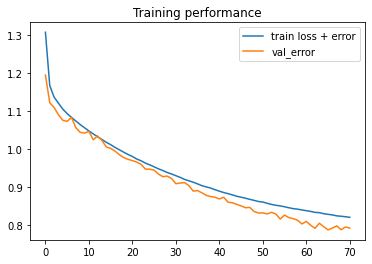

In [14]:
evaluationlib.show_loss_curves(history)

## Confusion matrix

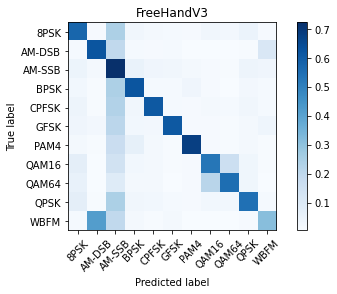

In [15]:
evaluationlib.plot_confusion_matrix(model, NEURAL_NETWORK_NAME, X_test, Y_test, BATCH_SIZE, classes)

## Confusion matrix for each SNR

Overall Accuracy:  0.09323922734026746


Overall Accuracy:  0.09648798521256932


Overall Accuracy:  0.10038882997525628


Overall Accuracy:  0.11770906535488405


Overall Accuracy:  0.13872832369942195


Overall Accuracy:  0.2108843537414966


Overall Accuracy:  0.3142242923683268


Overall Accuracy:  0.4407703488372093


Overall Accuracy:  0.6052538161164359


Overall Accuracy:  0.7577282530553558


Overall Accuracy:  0.8373275236020334


Overall Accuracy:  0.8752253876667869


Overall Accuracy:  0.8781783681214421


Overall Accuracy:  0.8742537313432835


Overall Accuracy:  0.8879682997118156


Overall Accuracy:  0.8804228946409042


Overall Accuracy:  0.8737504627915587


Overall Accuracy:  0.8762692741632192


Overall Accuracy:  0.8809874723655121


Overall Accuracy:  0.8792114695340502


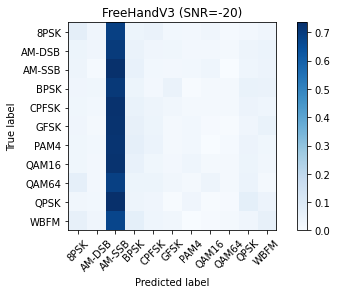

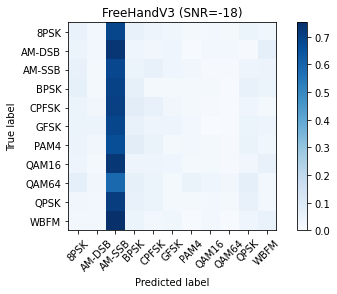

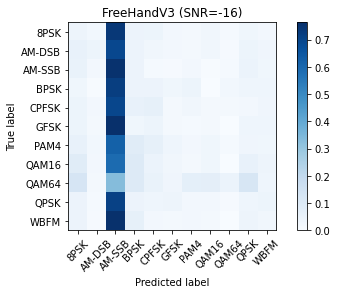

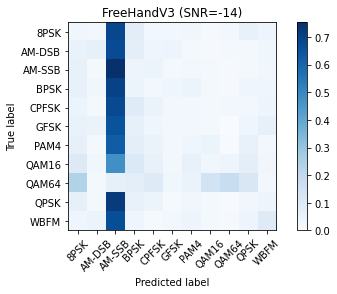

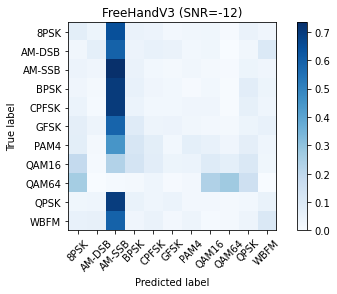

...

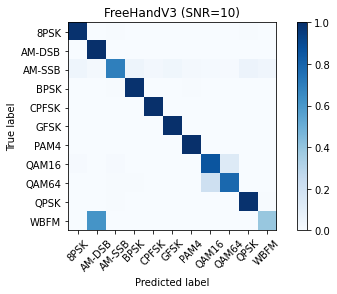

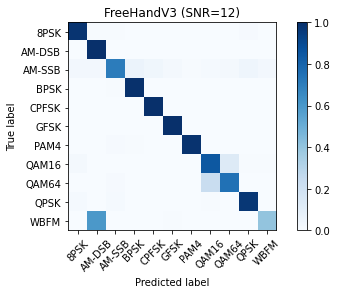

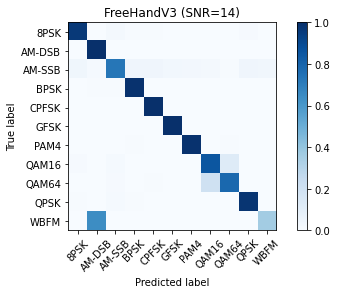

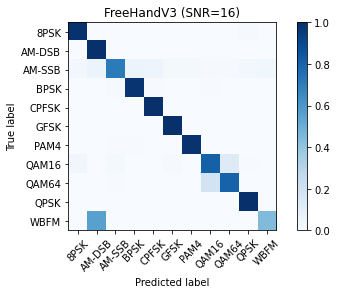

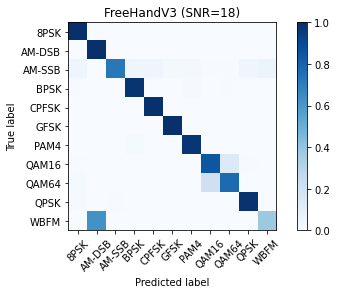

In [16]:
acc = evaluationlib.plot_confusion_matrix_each_snr(model, NEURAL_NETWORK_NAME, snrs, dataset_df, X_test, Y_test, test_index, classes)

## Accuracy performance

In [17]:
evaluationlib.accuracy_dataframe(acc)

,-20,-18,-16,-14,-12,-10,-8,-6,-4,-2,0,2,4,6,8,10,12,14,16,18
Accuracy %,9,9,10,11,13,21,31,44,60,75,83,87,87,87,88,88,87,87,88,87


In [18]:
import statistics

statistics.mean(acc.values())

0.5809504689820915

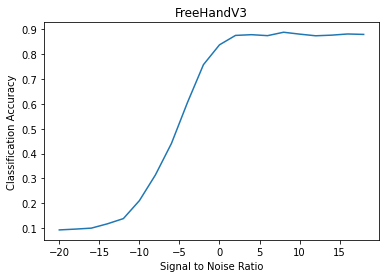

In [19]:
evaluationlib.accuracy_curve(snrs, acc, NEURAL_NETWORK_NAME)